group
Ab_Ctrl               78.462391
Ab_SDS                63.626250
Ab_SiNP               87.331128
SBA_Ctrl              72.343636
SBA_PEG               89.094000
SBA_PFDTES            79.376250
arctic                64.177006
arctic_seeding_wt     55.689677
osaka                 71.426667
osaka_seeding_wt      59.550448
osaka_seeding_wt42    49.186619
wt40_seeding_wt42     51.254043
wt42                  33.053425
wt42_seeding_osaka    75.522062
wt42_seeding_wt       76.555714
wt_seeding_arctic     45.897500
wt_seeding_osaka      62.600276
wt_seeding_wt         71.466429
wt_seeding_wt_gen2    47.503862
wt_seeding_wt_gen3    40.629796
Name: xover, dtype: float64
4313860.635597575


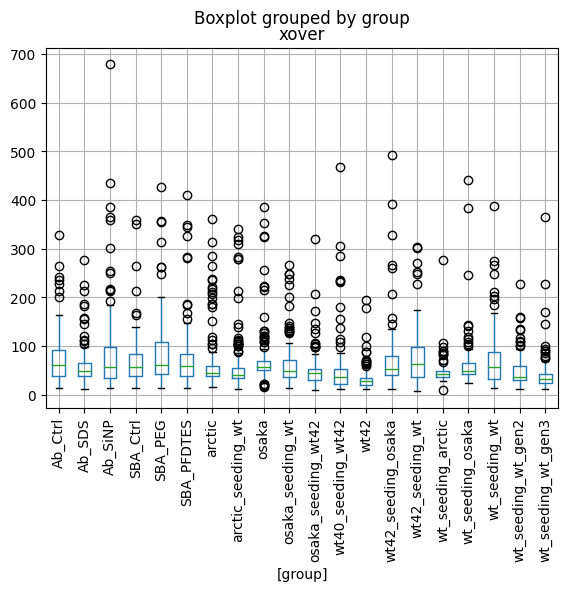

In [3]:
#from matplotlib.cbook.deprecation import contextlib
import pandas as pd
import numpy as np
from math import pi
from math import isnan
import cv2
import os
from sklearn import linear_model, datasets
from matplotlib import pyplot as plt
import statistics
import scipy
import csv
import re
import sys

#ANGLE_REJECTION = pi/6
#RANSAC_REJECTION = 150
#MODE = 'mean'
#DISTANCE = 18

### parameterization
# pi/9 190 median 36

# conf .005 params
#rej_angle = pi/5
#		ransac_rej = 170
#		rej_mode = 'mode'
#		rej_distance = 18

def error(ground_truth, ransac_table):
	err = 0
	keys = ransac_table['image'].unique()
	keys2 = ground_truth['fibril'].unique()
	keys3 = [k for k in keys if k[:-4] in keys2]
	for i in keys3:
		gt = ground_truth.loc[ground_truth['fibril'] == i[:-4]]['xover'].to_list()[0]
		if isinstance(gt, str):
			gt = gt.replace(',','.')
			gt = float(gt)
		ra = float(ransac_table.loc[ransac_table['image'] == i]['xover'].to_list()[0])
		if not (isnan(gt) or isnan(ra)):
			err += (gt - ra)**2
	return err

def group(row):
    if bool(re.search("wt42_seeding_wt", row['image'])):
        return("wt42_seeding_wt")
    elif bool(re.search("SBA_PEG", row['image'])):
        return("SBA_PEG")
    elif bool(re.search("SBA_PFDTES", row['image'])):
        return("SBA_PFDTES")
    elif bool(re.search("[a-f][0-9]+_arctic_[0-9]{4}", row['image'])):
        return("arctic")
    elif bool(re.search("osaka_seeding_wt42", row['image'])):
        return("osaka_seeding_wt42")
    elif bool(re.search("wt40_seeding_wt42", row['image'])):
        return("wt40_seeding_wt42")
    elif bool(re.search("osaka_seeding_wt", row['image'])):
        return("osaka_seeding_wt")
    elif bool(re.search("[a-f][0-9]+_osaka_[0-9]{4}", row['image'])):
        return("osaka")
    elif bool(re.search("arctic_seeding_wt", row['image'])):
        return("arctic_seeding_wt")
    elif bool(re.search("wt_seeding_wt_gen2", row['image'])):
        return("wt_seeding_wt_gen2")
    elif bool(re.search("wt_seeding_wt_gen3", row['image'])):
        return("wt_seeding_wt_gen3")
    elif bool(re.search("wt_seeding_osaka", row['image'])):
        return("wt_seeding_osaka")
    elif bool(re.search("wt_seeding_wt", row['image'])):
        return("wt_seeding_wt")
    elif bool(re.search("[a-f][0-9]+_wt42_[0-9]{4}", row['image'])):
        return("wt42")
    elif bool(re.search("wt42_seeding_osaka", row['image'])):
        return("wt42_seeding_osaka")
    elif bool(re.search("wt_seeding_arctic", row['image'])):
        return("wt_seeding_arctic")
    elif bool(re.search("Ab_Ctrl", row['image'])):
        return("Ab_Ctrl")
    elif bool(re.search("Ab_SDS", row['image'])):
        return("Ab_SDS")
    elif bool(re.search("Ab_SiNP", row['image'])):
        return("Ab_SiNP")
    elif bool(re.search("SBA_Ctrl", row['image'])):
        return("SBA_Ctrl")
    print(row['image'])
    raise Exception('uh oh! somebody fucked up grouping!')

def process_xl(dfr):
	dfr['cent_x'] = (dfr.xmin + dfr.xmax)/2
	dfr['cent_y'] = (dfr.ymin + dfr.ymax)/2
	return dfr

def find_zeroes(files):
	xovers = []
	image_path = '/content/drive/MyDrive/hjb/TrainYourOwnYOLO/Data/Source_Images/Training_Images/vott-csv-export/'
	images = os.listdir(image_path)
	zero_images = [x for x in images if x not in files] # thsnk you stackoverflow
	zero_images = [x for x in zero_images if x[-8:-4].isdigit()]
	for i in zero_images:
		if os.path.exists(image_path + "/" + i):
			# copy of cv2 code here
			img = cv2.imread(image_path + "/" + i)
			gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
			edges = cv2.Canny(gray,50,150,apertureSize = 3)
			lines = cv2.HoughLines(edges,1,np.pi/180,200)
			if len(lines) > 0:
				xovers.append(0)
#				print(i)
#				print(0)
	return zero_images, xovers

def lines(x, y, rej_mode, ransac_rej, rej_angle, prob, ranmax, img):
	xline = []
	yline = []
	remainder = []
	xremainder = []
	yremainder = []
	linebounds = []
	ransac = linear_model.RANSACRegressor(max_trials = ranmax, stop_probability = prob)
	for i in np.arange(0,len(x)-3):
		rho = np.tan((y[i] - y[i+1])/(x[i] - x[i+1] + 0.001))
		if rho < rej_angle or rho > -(rej_angle):
			xline.append(x[i])
			yline.append(y[i])
		else:
			remainder.append(x[i], y[i])
	if xline is not None and len(xline) > 2:
		#print("1!")
		xline = np.array(xline)[:, np.newaxis]
		yline = np.array(yline)[:, np.newaxis]
		#print(xline)
		#print(yline)
		ransac.fit(xline,yline)
		x_min = min(xline)
		y_min = ransac.predict(x_min.reshape(1, -1))
		x_max = max(xline)
		y_max = ransac.predict(x_max.reshape(1, -1))
		dist = np.sqrt((x_max-x_min)**2 + (y_max-y_min)**2)
		cnt = 0
		comb = sorted(zip(xline, yline), key=lambda x:x[1])
		comb_nooutliers = []
		for x,y in comb:
			if abs(y - ransac.predict(x.reshape(1, -1))) < ransac_rej:
				comb_nooutliers.append((x,y))
		ranges = []
		for i in range(0, len(comb_nooutliers) - 1, 1):
				x0, y0 = comb_nooutliers[i]
				x1, y1 = comb_nooutliers[i+1]
				dist = int(np.sqrt((x1-x0)**2 + (y1-y0)**2))
				ranges.append(dist)
#		print(ranges)
		if ranges != []:
			if rej_mode == 'average':
				dist = statistics.mean(list(ranges))
			elif rej_mode == 'mode':
				dist = statistics.median(list(ranges))
		else:
			 dist = 999
		cnt = 1
		linebounds.append([(x_min, y_min), (x_max, y_max), (dist, cnt)])
		xover = (dist/cnt) * 0.36
		#imgpath = plt.imread('/content/drive/MyDrive/hjb/TrainYourOwnYOLO/Data/Source_Images/Training_Images/vott-csv-export/' + img)
		#fig, ax = plt.subplots()
		#ax.imshow(imgpath)
		#uzx, uzy = [[*x] for x in zip(*comb_nooutliers)]
		#uzx = [item for sub_list in uzx for item in sub_list]
		#uzy = [item for sub_list in uzy for item in sub_list]
		#ax.plot(uzx, uzy, 'b+')
		#plt.title(img + "; xover: " + str(xover))
		#print(uzx)
		#print(uzy)
		#ax.scatter(xline, yline, c='r', alpha=0.3, edgecolor='black')
		#fig.show()
		#plt.close(fig)
		#input()
	elif remainder is not None and len(remainder) > 2:
		#print("2!")
		xline = remainder[:][0]
		yline = remainder[:][1]
		xline.reshape(1,-1)
		yline.reshape(1,-1)
		ransac.fit(xline,yline)
		x_min = min(xline)
		y_min = ransac.predict(x_min)
		x_max = max(xline)
		y_max = ransac.predict(x_max)
		dist = np.sqrt((x_max-x_min)**2 + (y_max-y_min)**2)
		linebounds.append([(x_min, y_min), (x_max, y_max), (dist, len(xline))])
	return linebounds


def main(params):
	NUM_PARAMS = 6
	if not (len(params) == NUM_PARAMS):
		rej_angle = pi/9
		ransac_rej = 180
		rej_mode = 'mode'
		rej_distance = 18
		prob = 0.799999
		ranmax = 350
	else:
		rej_angle = pi/params[0]
		ransac_rej = params[1]
		rej_mode = params[2]
		rej_distance = params[3]
		prob = params[4]
		ranmax = params[5]

	excelpath = '/home/hazel/Downloads/Detection_Results(3).csv'
	gtruth = '/home/hazel/Downloads/ADNIDATA/gtr.csv'

	ml_output = pd.read_csv(excelpath)
	ml_output = process_xl(ml_output)

	files = ml_output['image'].tolist()
	files = list(set(files))

	listcross = []
	llb = []
	name = ''
	fl_o_or_a = [f for f in files if "_osaka_" in f or "_arctic_" in f]
	for fl in files:
	#	print(x)
		name = fl
		df = ml_output[ml_output['image'] == fl]
		x = list(df.cent_x)
		y = list(df.cent_y)
		r = list(zip(x,y))
		for i in r:
			for j in r:
				distance = ((i[0]-j[0])**2+(i[1]-j[1])**2)**0.5
				#print(distance)
				if i != j and distance < rej_distance:
					r.remove(j)
		x,y = list(zip(*r))
		linelist = lines(x,y, rej_mode, ransac_rej, rej_angle, prob, ranmax, fl)
		for j in linelist:
			crossover = (j[2][0] / j[2][1]) * 0.36
			listcross.append(crossover)
	#		print(crossover)
			llb.append([name,crossover])

	#print(listcross)
	#ze, fe = find_zeroes(files)

	#print(len(llb))

	#ze = zip(ze, [0]*len(ze))
	with open('12epoch_ransac_mod_halved_modal.csv', 'w', newline='') as f:
			w = csv.writer(f)
			w.writerows(llb)
	#		w.writerows(ze)

	labels = ['image', 'xover']
	combined_data = pd.DataFrame(llb, columns=labels)
	combined_data['group'] = combined_data.apply(lambda row: group(row), axis=1)
	combined_data['group'] = combined_data['group'].astype('category')
	print(combined_data.groupby('group')['xover'].mean())
	#combined_data.to_csv('conf001'+str(params)+".csv")
	bp = combined_data.boxplot(by='group', rot=90)
	gtruth_data = pd.read_csv(gtruth)

	#gt_table = #import csv here'
	print(error(gtruth_data, combined_data))
	return error(gtruth_data, combined_data)

if __name__ == "__main__":
	main(sys.argv[1:])

In [2]:
bp = combined_data.boxplot(by='group', rot=90)

NameError: name 'combined_data' is not defined

In [ ]:
#rej_angle = pi/6
#ransac_rej = 150
#rej_mode = 'average'
#rej_distance = 18

##### remember that this is excluding zeroes

#%%capture cap --no-stderr

import pandas as pd
import numpy as np
from math import pi
from math import isnan
import cv2
import os
from sklearn import linear_model, datasets
from matplotlib import pyplot as plt
import statistics
import scipy
import csv
import re
import sys

angles = range(3,12)
rej = range(50, 200, 10)
mode = ['average', 'mode']
distance = range(18,72,9)
probs = np.arange(0.5,1,0.1)
ranmax = range(50,400,50)

with open('log.txt','w') as te:
  for a in angles:
   for r in rej:
     for m in mode:
        for d in distance:
            for p in probs:
              for x in ranmax:
                print("angle: " + str(a) + "; rej: " + str(r) + "; mode: " + m + "; dist: " + str(d) + "; prob: " + str(p) + "; max: " + str(x))
                strout1 = main([pi/a,r,m,d,p,x])
                print(strout1)
                te.write("angle: " + str(a) + "; rej: " + str(r) + "; mode: " + m + "; dist: " + str(d) + "; prob: " + str(p) + "; max: " + str(x) + "; error: " + str(strout1) + "\n")

#combined_data['group'] = combined_data.apply(lambda row: group(row), axis=1)
#te = open('log.txt','w')
#te.write(cap)

angle: 3; rej: 50; mode: average; dist: 18; prob: 0.5; max: 50
group
Ab_Ctrl               165.092829
Ab_SDS                136.137646
Ab_SiNP               145.848266
SBA_Ctrl              122.535465
SBA_PEG               163.572886
SBA_PFDTES            149.535714
arctic                139.626382
arctic_seeding_wt     111.415906
osaka                 139.004112
osaka_seeding_wt      118.931318
osaka_seeding_wt42     86.834559
wt40_seeding_wt42      80.231571
wt42                   63.026958
wt42_seeding_osaka    110.924023
wt42_seeding_wt       135.667241
wt_seeding_arctic     118.901811
wt_seeding_osaka      141.612742
wt_seeding_wt         117.888942
wt_seeding_wt_gen2     86.134864
wt_seeding_wt_gen3     70.053885
Name: xover, dtype: float64
22053076.764387544
angle: 3; rej: 50; mode: average; dist: 18; prob: 0.5; max: 100
group
Ab_Ctrl               149.903976
Ab_SDS                146.663844
Ab_SiNP               135.585477
SBA_Ctrl              153.557927
SBA_PEG               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               162.134248
Ab_SDS                139.546493
Ab_SiNP               166.532785
SBA_Ctrl              144.075294
SBA_PEG               148.850238
SBA_PFDTES            139.077110
arctic                136.649972
arctic_seeding_wt     117.002237
osaka                 149.750380
osaka_seeding_wt      114.089601
osaka_seeding_wt42     97.308771
wt40_seeding_wt42      87.986590
wt42                   67.903911
wt42_seeding_osaka     99.913900
wt42_seeding_wt       127.672536
wt_seeding_arctic     113.012571
wt_seeding_osaka      148.000987
wt_seeding_wt         118.407997
wt_seeding_wt_gen2     83.268640
wt_seeding_wt_gen3     67.215532
Name: xover, dtype: float64
20680632.970180623
angle: 3; rej: 50; mode: average; dist: 18; prob: 0.5; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               154.918152
Ab_SDS                149.246528
Ab_SiNP               148.579886
SBA_Ctrl              136.741362
SBA_PEG               161.343087
SBA_PFDTES            132.112473
arctic                144.276660
arctic_seeding_wt     107.814700
osaka                 141.580732
osaka_seeding_wt      120.277879
osaka_seeding_wt42     90.990763
wt40_seeding_wt42      95.117803
wt42                   60.566466
wt42_seeding_osaka    113.152157
wt42_seeding_wt       125.809259
wt_seeding_arctic     107.338543
wt_seeding_osaka      148.895586
wt_seeding_wt         115.719520
wt_seeding_wt_gen2     87.144596
wt_seeding_wt_gen3     71.087079
Name: xover, dtype: float64
22366690.16820252
angle: 3; rej: 50; mode: average; dist: 18; prob: 0.5; max: 300
group
Ab_Ctrl               166.385425
Ab_SDS                144.954264
Ab_SiNP               147.671695
SBA_Ctrl              143.885927
SBA_PEG               162.414450
SBA_PFDTES            146.708841
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.398782
Ab_SDS                143.452082
Ab_SiNP               149.504566
SBA_Ctrl              142.345320
SBA_PEG               168.094743
SBA_PFDTES            150.133750
arctic                144.992872
arctic_seeding_wt     110.972568
osaka                 137.379917
osaka_seeding_wt      114.314837
osaka_seeding_wt42     87.765847
wt40_seeding_wt42      91.818656
wt42                   66.607809
wt42_seeding_osaka    117.612738
wt42_seeding_wt       138.731459
wt_seeding_arctic     111.250490
wt_seeding_osaka      138.092244
wt_seeding_wt         121.990286
wt_seeding_wt_gen2     90.028735
wt_seeding_wt_gen3     68.515066
Name: xover, dtype: float64
21373586.550663356
angle: 3; rej: 50; mode: average; dist: 18; prob: 0.7; max: 350
group
Ab_Ctrl               156.381927
Ab_SDS                137.651533
Ab_SiNP               156.571542
SBA_Ctrl              150.947866
SBA_PEG               156.219510
SBA_PFDTES            141.951833
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.611806
Ab_SDS                143.398093
Ab_SiNP               149.903924
SBA_Ctrl              152.955401
SBA_PEG               162.109224
SBA_PFDTES            139.755790
arctic                140.176156
arctic_seeding_wt     119.611740
osaka                 139.693508
osaka_seeding_wt      118.227846
osaka_seeding_wt42     96.799007
wt40_seeding_wt42      87.563692
wt42                   58.562377
wt42_seeding_osaka    124.256471
wt42_seeding_wt       133.975613
wt_seeding_arctic     121.208266
wt_seeding_osaka      139.950680
wt_seeding_wt         122.885802
wt_seeding_wt_gen2     88.335918
wt_seeding_wt_gen3     70.191408
Name: xover, dtype: float64
22396722.861495517
angle: 3; rej: 50; mode: average; dist: 18; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               171.444582
Ab_SDS                123.434554
Ab_SiNP               167.165577
SBA_Ctrl              138.188362
SBA_PEG               165.837033
SBA_PFDTES            127.142187
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               165.006205
Ab_SDS                128.323943
Ab_SiNP               151.115886
SBA_Ctrl              153.311453
SBA_PEG               174.618367
SBA_PFDTES            139.669446
arctic                134.111584
arctic_seeding_wt     120.807185
osaka                 144.930308
osaka_seeding_wt      108.644098
osaka_seeding_wt42     91.134786
wt40_seeding_wt42      89.565824
wt42                   61.480416
wt42_seeding_osaka    112.925011
wt42_seeding_wt       143.284674
wt_seeding_arctic     124.587082
wt_seeding_osaka      138.874866
wt_seeding_wt         117.450193
wt_seeding_wt_gen2     83.050509
wt_seeding_wt_gen3     76.110589
Name: xover, dtype: float64
21485040.185604714
angle: 3; rej: 50; mode: average; dist: 18; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               142.937455
Ab_SDS                127.712273
Ab_SiNP               163.595290
SBA_Ctrl              141.404427
SBA_PEG               163.380491
SBA_PFDTES            128.853034
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.743308
Ab_SDS                157.375202
Ab_SiNP               167.743619
SBA_Ctrl              147.553742
SBA_PEG               178.419493
SBA_PFDTES            138.122105
arctic                139.885644
arctic_seeding_wt     122.119822
osaka                 147.219657
osaka_seeding_wt      123.359412
osaka_seeding_wt42     99.196751
wt40_seeding_wt42     100.978400
wt42                   70.503356
wt42_seeding_osaka    124.110210
wt42_seeding_wt       137.205828
wt_seeding_arctic     117.372391
wt_seeding_osaka      144.243035
wt_seeding_wt         127.822089
wt_seeding_wt_gen2     99.976340
wt_seeding_wt_gen3     68.788741
Name: xover, dtype: float64
23449859.03018911
angle: 3; rej: 50; mode: average; dist: 27; prob: 0.7; max: 200
group
Ab_Ctrl               180.163081
Ab_SDS                150.853265
Ab_SiNP               166.640049
SBA_Ctrl              160.928508
SBA_PEG               157.567549
SBA_PFDTES            146.734866
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               172.031972
Ab_SDS                132.512300
Ab_SiNP               178.668950
SBA_Ctrl              142.098553
SBA_PEG               183.853807
SBA_PFDTES            154.430392
arctic                139.084002
arctic_seeding_wt     116.900955
osaka                 150.584621
osaka_seeding_wt      125.596606
osaka_seeding_wt42    106.976379
wt40_seeding_wt42      96.122202
wt42                   73.352357
wt42_seeding_osaka    130.011494
wt42_seeding_wt       139.622267
wt_seeding_arctic     128.596075
wt_seeding_osaka      142.546143
wt_seeding_wt         122.195506
wt_seeding_wt_gen2    101.075968
wt_seeding_wt_gen3     70.503472
Name: xover, dtype: float64
23407800.897520974
angle: 3; rej: 50; mode: average; dist: 27; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               179.371820
Ab_SDS                143.928095
Ab_SiNP               163.644164
SBA_Ctrl              146.502388
SBA_PEG               173.267594
SBA_PFDTES            153.938679
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               200.280643
Ab_SDS                160.240325
Ab_SiNP               189.209558
SBA_Ctrl              153.483969
SBA_PEG               187.351010
SBA_PFDTES            166.229076
arctic                148.051033
arctic_seeding_wt     123.225690
osaka                 162.139631
osaka_seeding_wt      125.441818
osaka_seeding_wt42    107.496133
wt40_seeding_wt42     112.337813
wt42                   87.044322
wt42_seeding_osaka    125.458413
wt42_seeding_wt       166.658594
wt_seeding_arctic     120.637618
wt_seeding_osaka      154.205720
wt_seeding_wt         158.600157
wt_seeding_wt_gen2    109.570066
wt_seeding_wt_gen3     84.000943
Name: xover, dtype: float64
26521934.306261357
angle: 3; rej: 50; mode: average; dist: 36; prob: 0.5; max: 100
group
Ab_Ctrl               191.559276
Ab_SDS                180.817151
Ab_SiNP               196.638856
SBA_Ctrl              157.546979
SBA_PEG               189.682785
SBA_PFDTES            175.293037
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               191.509843
Ab_SDS                159.731306
Ab_SiNP               188.944359
SBA_Ctrl              158.937811
SBA_PEG               186.551276
SBA_PFDTES            159.083539
arctic                140.791684
arctic_seeding_wt     114.833430
osaka                 161.694846
osaka_seeding_wt      132.902430
osaka_seeding_wt42    115.496446
wt40_seeding_wt42     106.652367
wt42                   85.232237
wt42_seeding_osaka    146.396448
wt42_seeding_wt       172.052684
wt_seeding_arctic     134.593206
wt_seeding_osaka      148.178165
wt_seeding_wt         160.306204
wt_seeding_wt_gen2    101.695499
wt_seeding_wt_gen3     86.582622
Name: xover, dtype: float64
26398655.546072666
angle: 3; rej: 50; mode: average; dist: 36; prob: 0.7; max: 100
group
Ab_Ctrl               214.327167
Ab_SDS                154.616477
Ab_SiNP               196.545095
SBA_Ctrl              175.199724
SBA_PEG               205.673449
SBA_PFDTES            162.536106
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               202.840524
Ab_SDS                168.570826
Ab_SiNP               196.855215
SBA_Ctrl              186.371502
SBA_PEG               189.028364
SBA_PFDTES            175.559914
arctic                152.846384
arctic_seeding_wt     127.669303
osaka                 166.532570
osaka_seeding_wt      149.035573
osaka_seeding_wt42    123.601599
wt40_seeding_wt42     136.145622
wt42                   94.510736
wt42_seeding_osaka    153.968916
wt42_seeding_wt       181.163304
wt_seeding_arctic     133.515221
wt_seeding_osaka      157.959112
wt_seeding_wt         159.674027
wt_seeding_wt_gen2    114.580430
wt_seeding_wt_gen3    100.580476
Name: xover, dtype: float64
29991308.799948517
angle: 3; rej: 50; mode: average; dist: 45; prob: 0.5; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               217.894200
Ab_SDS                178.452975
Ab_SiNP               211.257230
SBA_Ctrl              182.855298
SBA_PEG               218.112409
SBA_PFDTES            186.073086
arctic                157.458890
arctic_seeding_wt     125.480233
osaka                 172.939603
osaka_seeding_wt      139.762156
osaka_seeding_wt42    120.521695
wt40_seeding_wt42     131.421189
wt42                  105.641695
wt42_seeding_osaka    143.277715
wt42_seeding_wt       165.089136
wt_seeding_arctic     124.528376
wt_seeding_osaka      159.963336
wt_seeding_wt         149.903035
wt_seeding_wt_gen2    119.837382
wt_seeding_wt_gen3     90.964904
Name: xover, dtype: float64
30322531.362156957
angle: 3; rej: 50; mode: average; dist: 45; prob: 0.5; max: 200
group
Ab_Ctrl               222.564000
Ab_SDS                141.107094
Ab_SiNP               218.518590
SBA_Ctrl              205.988356
SBA_PEG               194.757955
SBA_PFDTES            193.033751
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               220.993200
Ab_SDS                172.504397
Ab_SiNP               214.842496
SBA_Ctrl              197.828798
SBA_PEG               235.704886
SBA_PFDTES            172.982896
arctic                144.090627
arctic_seeding_wt     127.499485
osaka                 165.584407
osaka_seeding_wt      133.323915
osaka_seeding_wt42    108.241204
wt40_seeding_wt42     129.779901
wt42                  101.552183
wt42_seeding_osaka    152.726443
wt42_seeding_wt       185.496421
wt_seeding_arctic     127.840316
wt_seeding_osaka      152.257719
wt_seeding_wt         163.441865
wt_seeding_wt_gen2    124.386715
wt_seeding_wt_gen3     89.123431
Name: xover, dtype: float64
28295557.66897136
angle: 3; rej: 50; mode: average; dist: 45; prob: 0.7; max: 50
group
Ab_Ctrl               215.653390
Ab_SDS                163.453168
Ab_SiNP               218.955865
SBA_Ctrl              194.060577
SBA_PEG               215.985282
SBA_PFDTES            173.313306
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               235.475467
Ab_SDS                168.738519
Ab_SiNP               209.713119
SBA_Ctrl              185.261891
SBA_PEG               224.990727
SBA_PFDTES            166.354595
arctic                146.349098
arctic_seeding_wt     131.924637
osaka                 161.225011
osaka_seeding_wt      130.518643
osaka_seeding_wt42    113.698289
wt40_seeding_wt42     129.161643
wt42                  102.000323
wt42_seeding_osaka    162.458720
wt42_seeding_wt       190.730417
wt_seeding_arctic     124.873803
wt_seeding_osaka      157.129312
wt_seeding_wt         159.613101
wt_seeding_wt_gen2    123.682014
wt_seeding_wt_gen3     83.873386
Name: xover, dtype: float64
27325282.512806367
angle: 3; rej: 50; mode: average; dist: 45; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               231.203133
Ab_SDS                168.628937
Ab_SiNP               207.425940
SBA_Ctrl              171.845961
SBA_PEG               219.577227
SBA_PFDTES            185.926704
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               211.257667
Ab_SDS                173.701479
Ab_SiNP               217.838017
SBA_Ctrl              176.897722
SBA_PEG               222.437318
SBA_PFDTES            182.180294
arctic                149.576141
arctic_seeding_wt     122.169746
osaka                 155.719942
osaka_seeding_wt      139.486481
osaka_seeding_wt42    121.587792
wt40_seeding_wt42     126.042873
wt42                  101.136308
wt42_seeding_osaka    155.995461
wt42_seeding_wt       201.004094
wt_seeding_arctic     123.230162
wt_seeding_osaka      158.558548
wt_seeding_wt         160.120685
wt_seeding_wt_gen2    116.204182
wt_seeding_wt_gen3     90.556038
Name: xover, dtype: float64
26811418.704601083
angle: 3; rej: 50; mode: average; dist: 54; prob: 0.5; max: 50
group
Ab_Ctrl               191.681410
Ab_SDS                158.139099
Ab_SiNP               214.456010
SBA_Ctrl              180.680096
SBA_PEG               239.902330
SBA_PFDTES            198.237850
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               240.370629
Ab_SDS                168.434286
Ab_SiNP               206.197245
SBA_Ctrl              187.376631
SBA_PEG               228.274261
SBA_PFDTES            191.546608
arctic                144.889467
arctic_seeding_wt     136.895023
osaka                 172.485326
osaka_seeding_wt      143.233100
osaka_seeding_wt42    116.962584
wt40_seeding_wt42     149.131569
wt42                  103.536533
wt42_seeding_osaka    190.997633
wt42_seeding_wt       201.366757
wt_seeding_arctic     129.051934
wt_seeding_osaka      145.986219
wt_seeding_wt         168.966258
wt_seeding_wt_gen2    119.298875
wt_seeding_wt_gen3    106.725923
Name: xover, dtype: float64
28847406.488986444
angle: 3; rej: 50; mode: average; dist: 54; prob: 0.5; max: 150
group
Ab_Ctrl               218.302410
Ab_SDS                156.818411
Ab_SiNP               202.599523
SBA_Ctrl              200.244030
SBA_PEG               224.953125
SBA_PFDTES            202.419585
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               224.928076
Ab_SDS                169.688571
Ab_SiNP               210.341738
SBA_Ctrl              184.221120
SBA_PEG               216.141307
SBA_PFDTES            174.928588
arctic                155.874370
arctic_seeding_wt     120.858049
osaka                 160.276029
osaka_seeding_wt      144.461535
osaka_seeding_wt42    118.160282
wt40_seeding_wt42     137.110275
wt42                  103.171403
wt42_seeding_osaka    146.076392
wt42_seeding_wt       205.545395
wt_seeding_arctic     126.177892
wt_seeding_osaka      161.227624
wt_seeding_wt         150.023889
wt_seeding_wt_gen2    121.924472
wt_seeding_wt_gen3     88.492923
Name: xover, dtype: float64
27585434.858734407
angle: 3; rej: 50; mode: average; dist: 54; prob: 0.6; max: 300
group
Ab_Ctrl               229.625076
Ab_SDS                174.579514
Ab_SiNP               203.661092
SBA_Ctrl              188.773817
SBA_PEG               231.808330
SBA_PFDTES            176.269679
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               246.033343
Ab_SDS                182.035391
Ab_SiNP               219.245748
SBA_Ctrl              182.337422
SBA_PEG               223.092102
SBA_PFDTES            177.262438
arctic                136.719948
arctic_seeding_wt     132.475832
osaka                 167.466747
osaka_seeding_wt      138.880157
osaka_seeding_wt42    121.347450
wt40_seeding_wt42     134.488956
wt42                  110.781445
wt42_seeding_osaka    140.359365
wt42_seeding_wt       184.478982
wt_seeding_arctic     123.323689
wt_seeding_osaka      150.885007
wt_seeding_wt         164.727736
wt_seeding_wt_gen2    128.751591
wt_seeding_wt_gen3     96.547442
Name: xover, dtype: float64
26568703.69915819
angle: 3; rej: 50; mode: average; dist: 54; prob: 0.7; max: 200
group
Ab_Ctrl               226.707543
Ab_SDS                168.305688
Ab_SiNP               218.526240
SBA_Ctrl              188.718741
SBA_PEG               231.102852
SBA_PFDTES            173.208649
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               207.472103
Ab_SDS                171.053630
Ab_SiNP               206.600802
SBA_Ctrl              210.489620
SBA_PEG               227.682379
SBA_PFDTES            173.153980
arctic                155.854941
arctic_seeding_wt     144.028468
osaka                 162.440205
osaka_seeding_wt      133.358694
osaka_seeding_wt42    121.991930
wt40_seeding_wt42     143.969167
wt42                  110.373609
wt42_seeding_osaka    154.827753
wt42_seeding_wt       209.769865
wt_seeding_arctic     139.362439
wt_seeding_osaka      168.099929
wt_seeding_wt         168.792628
wt_seeding_wt_gen2    134.263044
wt_seeding_wt_gen3     99.712551
Name: xover, dtype: float64
31127258.998231012
angle: 3; rej: 50; mode: average; dist: 63; prob: 0.6; max: 150
group
Ab_Ctrl               223.613316
Ab_SDS                167.399898
Ab_SiNP               216.192852
SBA_Ctrl              183.184891
SBA_PEG               244.716586
SBA_PFDTES            182.934809
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               228.531833
Ab_SDS                165.889590
Ab_SiNP               215.247990
SBA_Ctrl              202.761550
SBA_PEG               219.662517
SBA_PFDTES            179.309214
arctic                163.127196
arctic_seeding_wt     126.371867
osaka                 175.093690
osaka_seeding_wt      140.280009
osaka_seeding_wt42    124.481179
wt40_seeding_wt42     142.242358
wt42                  108.784016
wt42_seeding_osaka    167.743798
wt42_seeding_wt       219.604543
wt_seeding_arctic     129.163068
wt_seeding_osaka      147.981436
wt_seeding_wt         165.950208
wt_seeding_wt_gen2    130.356271
wt_seeding_wt_gen3    106.221480
Name: xover, dtype: float64
30748996.52637391
angle: 3; rej: 50; mode: average; dist: 63; prob: 0.7; max: 100
group
Ab_Ctrl               226.069743
Ab_SDS                180.216130
Ab_SiNP               220.457614
SBA_Ctrl              186.602773
SBA_PEG               230.763690
SBA_PFDTES            183.753650
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               248.997429
Ab_SDS                168.628554
Ab_SiNP               225.946055
SBA_Ctrl              185.776114
SBA_PEG               250.061207
SBA_PFDTES            181.128819
arctic                163.723630
arctic_seeding_wt     130.606813
osaka                 166.640247
osaka_seeding_wt      137.611782
osaka_seeding_wt42    106.304880
wt40_seeding_wt42     142.164208
wt42                  108.556679
wt42_seeding_osaka    149.967356
wt42_seeding_wt       208.522647
wt_seeding_arctic     126.327312
wt_seeding_osaka      159.476125
wt_seeding_wt         168.048459
wt_seeding_wt_gen2    126.112165
wt_seeding_wt_gen3    108.044209
Name: xover, dtype: float64
29550859.647301357
angle: 3; rej: 50; mode: average; dist: 63; prob: 0.7; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               221.356777
Ab_SDS                183.255789
Ab_SiNP               217.742664
SBA_Ctrl              189.987479
SBA_PEG               230.592241
SBA_PFDTES            182.936182
arctic                138.827581
arctic_seeding_wt     131.516954
osaka                 159.763875
osaka_seeding_wt      142.760177
osaka_seeding_wt42    124.949852
wt40_seeding_wt42     150.480156
wt42                  107.329475
wt42_seeding_osaka    157.732887
wt42_seeding_wt       201.512560
wt_seeding_arctic     136.049486
wt_seeding_osaka      159.522516
wt_seeding_wt         170.186065
wt_seeding_wt_gen2    137.045103
wt_seeding_wt_gen3     91.733122
Name: xover, dtype: float64
28355203.40712363
angle: 3; rej: 50; mode: average; dist: 63; prob: 0.7; max: 300
group
Ab_Ctrl               230.252080
Ab_SDS                170.537170
Ab_SiNP               219.080110
SBA_Ctrl              183.148397
SBA_PEG               237.421138
SBA_PFDTES            173.681948
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               261.100912
Ab_SDS                176.687239
Ab_SiNP               219.343648
SBA_Ctrl              196.181637
SBA_PEG               220.540931
SBA_PFDTES            175.856556
arctic                151.392758
arctic_seeding_wt     131.275563
osaka                 167.010943
osaka_seeding_wt      143.628894
osaka_seeding_wt42    119.355129
wt40_seeding_wt42     144.690427
wt42                  102.464314
wt42_seeding_osaka    165.129490
wt42_seeding_wt       210.869899
wt_seeding_arctic     126.597756
wt_seeding_osaka      143.386490
wt_seeding_wt         172.904876
wt_seeding_wt_gen2    137.987988
wt_seeding_wt_gen3     97.574936
Name: xover, dtype: float64
28678326.42521188
angle: 3; rej: 50; mode: average; dist: 63; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               238.449968
Ab_SDS                182.093626
Ab_SiNP               215.240215
SBA_Ctrl              186.303197
SBA_PEG               249.226862
SBA_PFDTES            191.762310
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               234.341249
Ab_SDS                173.712731
Ab_SiNP               217.292639
SBA_Ctrl              181.939573
SBA_PEG               243.623138
SBA_PFDTES            168.638091
arctic                156.973225
arctic_seeding_wt     137.869519
osaka                 167.042732
osaka_seeding_wt      147.223645
osaka_seeding_wt42    115.335099
wt40_seeding_wt42     137.707303
wt42                  110.903402
wt42_seeding_osaka    168.076789
wt42_seeding_wt       208.847117
wt_seeding_arctic     136.369550
wt_seeding_osaka      172.149786
wt_seeding_wt         166.289185
wt_seeding_wt_gen2    130.583780
wt_seeding_wt_gen3     98.833747
Name: xover, dtype: float64
31640051.917877752
angle: 3; rej: 50; mode: average; dist: 63; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               244.387676
Ab_SDS                189.266786
Ab_SiNP               218.948308
SBA_Ctrl              201.047879
SBA_PEG               238.723483
SBA_PFDTES            181.676903
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               210.319743
Ab_SDS                180.059279
Ab_SiNP               222.904879
SBA_Ctrl              184.536444
SBA_PEG               233.803828
SBA_PFDTES            185.546502
arctic                155.436581
arctic_seeding_wt     135.601895
osaka                 163.907063
osaka_seeding_wt      141.832982
osaka_seeding_wt42    125.170225
wt40_seeding_wt42     139.987833
wt42                  116.511031
wt42_seeding_osaka    167.953985
wt42_seeding_wt       214.227552
wt_seeding_arctic     126.077595
wt_seeding_osaka      155.078927
wt_seeding_wt         164.425866
wt_seeding_wt_gen2    137.293366
wt_seeding_wt_gen3    100.246282
Name: xover, dtype: float64
29422520.830889005
angle: 3; rej: 50; mode: average; dist: 63; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               231.605788
Ab_SDS                170.670211
Ab_SiNP               220.131539
SBA_Ctrl              182.238272
SBA_PEG               244.807345
SBA_PFDTES            174.951723
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.755652
Ab_SDS                121.033125
Ab_SiNP               133.401654
SBA_Ctrl              145.789773
SBA_PEG               151.462000
SBA_PFDTES            129.114375
arctic                123.172814
arctic_seeding_wt      96.662903
osaka                 128.764444
osaka_seeding_wt       99.094030
osaka_seeding_wt42     74.409928
wt40_seeding_wt42      69.675319
wt42                   40.963562
wt42_seeding_osaka     95.693196
wt42_seeding_wt       135.037143
wt_seeding_arctic      81.136250
wt_seeding_osaka      138.698069
wt_seeding_wt         104.034857
wt_seeding_wt_gen2     79.852966
wt_seeding_wt_gen3     65.621633
Name: xover, dtype: float64
22166636.118405584
angle: 3; rej: 50; mode: mode; dist: 18; prob: 0.5; max: 350
group
Ab_Ctrl               145.213043
Ab_SDS                100.057500
Ab_SiNP               129.245414
SBA_Ctrl              129.724773
SBA_PEG               165.818000
SBA_PFDTES            122.152500
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.541957
Ab_SDS                117.851250
Ab_SiNP               156.286015
SBA_Ctrl              138.332045
SBA_PEG               137.988000
SBA_PFDTES            115.785000
arctic                117.464551
arctic_seeding_wt     105.251371
osaka                 136.196667
osaka_seeding_wt      108.361791
osaka_seeding_wt42     73.459424
wt40_seeding_wt42      69.974043
wt42                   48.290548
wt42_seeding_osaka     88.624948
wt42_seeding_wt       129.264286
wt_seeding_arctic      95.645000
wt_seeding_osaka      126.003724
wt_seeding_wt         103.717286
wt_seeding_wt_gen2     77.897793
wt_seeding_wt_gen3     56.952245
Name: xover, dtype: float64
22043084.23184156
angle: 3; rej: 50; mode: mode; dist: 18; prob: 0.6; max: 200
group
Ab_Ctrl               144.853043
Ab_SDS                123.339375
Ab_SiNP               140.492030
SBA_Ctrl              133.797273
SBA_PEG               142.432000
SBA_PFDTES            109.978125
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.561087
Ab_SDS                113.300625
Ab_SiNP               131.225414
SBA_Ctrl              115.684773
SBA_PEG               147.320000
SBA_PFDTES            109.755000
arctic                127.485269
arctic_seeding_wt     108.116129
osaka                 133.816667
osaka_seeding_wt       99.287463
osaka_seeding_wt42     75.076835
wt40_seeding_wt42      91.556170
wt42                   54.590548
wt42_seeding_osaka    102.158351
wt42_seeding_wt       119.440000
wt_seeding_arctic      94.691250
wt_seeding_osaka      113.526621
wt_seeding_wt         109.488857
wt_seeding_wt_gen2     77.311862
wt_seeding_wt_gen3     54.554694
Name: xover, dtype: float64
22446367.051893603
angle: 3; rej: 50; mode: mode; dist: 18; prob: 0.7; max: 100
group
Ab_Ctrl               138.398478
Ab_SDS                118.385625
Ab_SiNP               140.891278
SBA_Ctrl              135.450000
SBA_PEG               150.870000
SBA_PFDTES            120.260625
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.598043
Ab_SDS                114.594375
Ab_SiNP               134.668421
SBA_Ctrl              130.162500
SBA_PEG               133.722000
SBA_PFDTES            122.000625
arctic                115.937246
arctic_seeding_wt      90.653952
osaka                 126.396667
osaka_seeding_wt       93.761194
osaka_seeding_wt42     92.767338
wt40_seeding_wt42      75.754468
wt42                   49.742877
wt42_seeding_osaka     88.070103
wt42_seeding_wt       122.424286
wt_seeding_arctic      93.601250
wt_seeding_osaka      120.523034
wt_seeding_wt         111.876429
wt_seeding_wt_gen2     69.343448
wt_seeding_wt_gen3     60.798367
Name: xover, dtype: float64
19810634.473005578
angle: 3; rej: 50; mode: mode; dist: 18; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               160.726304
Ab_SDS                106.123125
Ab_SiNP               135.381654
SBA_Ctrl              130.268864
SBA_PEG               141.394000
SBA_PFDTES            111.982500
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.811522
Ab_SDS                113.898750
Ab_SiNP               130.361955
SBA_Ctrl              135.985909
SBA_PEG               150.140000
SBA_PFDTES            104.990625
arctic                124.285150
arctic_seeding_wt     101.144758
osaka                 114.810000
osaka_seeding_wt       99.412836
osaka_seeding_wt42     79.692086
wt40_seeding_wt42      72.674043
wt42                   45.720000
wt42_seeding_osaka    101.490309
wt42_seeding_wt       117.828571
wt_seeding_arctic     100.242500
wt_seeding_osaka      127.004276
wt_seeding_wt         109.792286
wt_seeding_wt_gen2     83.333793
wt_seeding_wt_gen3     57.254694
Name: xover, dtype: float64
21903192.02433358
angle: 3; rej: 50; mode: mode; dist: 18; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               143.379783
Ab_SDS                120.761250
Ab_SiNP               133.849624
SBA_Ctrl              141.735682
SBA_PEG               147.930000
SBA_PFDTES            131.733750
arctic   

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.478261
Ab_SDS                120.099375
Ab_SiNP               145.939398
SBA_Ctrl              129.507955
SBA_PEG               159.920000
SBA_PFDTES            121.018125
arctic                122.983114
arctic_seeding_wt      90.346935
osaka                 121.747778
osaka_seeding_wt       96.276716
osaka_seeding_wt42     80.474245
wt40_seeding_wt42      78.339574
wt42                   50.814247
wt42_seeding_osaka    113.708041
wt42_seeding_wt       124.000000
wt_seeding_arctic      96.716250
wt_seeding_osaka      116.252690
wt_seeding_wt         111.713143
wt_seeding_wt_gen2     76.460276
wt_seeding_wt_gen3     52.715510
Name: xover, dtype: float64
19815636.30285358
angle: 3; rej: 50; mode: mode; dist: 18; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               147.140217
Ab_SDS                120.097500
Ab_SiNP               139.035789
SBA_Ctrl              144.034773
SBA_PEG               135.574000
SBA_PFDTES            119.780625
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.793043
Ab_SDS                123.885000
Ab_SiNP               167.087368
SBA_Ctrl              129.358636
SBA_PEG               176.760000
SBA_PFDTES            134.885625
arctic                135.200479
arctic_seeding_wt     102.344516
osaka                 133.330000
osaka_seeding_wt      115.611940
osaka_seeding_wt42     78.869784
wt40_seeding_wt42      88.368429
wt42                   54.908690
wt42_seeding_osaka    119.060625
wt42_seeding_wt       114.957581
wt_seeding_arctic     103.655000
wt_seeding_osaka      138.792414
wt_seeding_wt         119.545899
wt_seeding_wt_gen2     90.014897
wt_seeding_wt_gen3     67.804521
Name: xover, dtype: float64
23248263.11720062
angle: 3; rej: 50; mode: mode; dist: 27; prob: 0.6; max: 50
group
Ab_Ctrl               144.500870
Ab_SDS                116.488125
Ab_SiNP               151.068722
SBA_Ctrl              140.359091
SBA_PEG               180.944494
SBA_PFDTES            138.307500
arctic                12

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               169.088478
Ab_SDS                133.886250
Ab_SiNP               157.148120
SBA_Ctrl              137.970000
SBA_PEG               148.040899
SBA_PFDTES            131.362500
arctic                120.784311
arctic_seeding_wt      99.939194
osaka                 142.053333
osaka_seeding_wt      105.953731
osaka_seeding_wt42     85.244892
wt40_seeding_wt42      74.791286
wt42                   58.462759
wt42_seeding_osaka    119.120625
wt42_seeding_wt       123.471290
wt_seeding_arctic     106.578750
wt_seeding_osaka      126.393517
wt_seeding_wt         119.802302
wt_seeding_wt_gen2     90.803172
wt_seeding_wt_gen3     62.557397
Name: xover, dtype: float64
22916717.388968587
angle: 3; rej: 50; mode: mode; dist: 27; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               155.267609
Ab_SDS                124.063125
Ab_SiNP               166.667820
SBA_Ctrl              130.195227
SBA_PEG               163.108315
SBA_PFDTES            133.020000
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               172.414000
Ab_SDS                147.459375
Ab_SiNP               169.026818
SBA_Ctrl              163.417241
SBA_PEG               178.754157
SBA_PFDTES            151.078125
arctic                130.207904
arctic_seeding_wt     110.106073
osaka                 153.860000
osaka_seeding_wt      119.734372
osaka_seeding_wt42    112.540144
wt40_seeding_wt42      89.592429
wt42                   78.342207
wt42_seeding_osaka    138.048750
wt42_seeding_wt       150.397500
wt_seeding_arctic     106.220000
wt_seeding_osaka      129.375310
wt_seeding_wt         134.072206
wt_seeding_wt_gen2     93.431250
wt_seeding_wt_gen3     70.203699
Name: xover, dtype: float64
24990769.84745257
angle: 3; rej: 50; mode: mode; dist: 36; prob: 0.5; max: 200
group
Ab_Ctrl               180.412000
Ab_SDS                141.990000
Ab_SiNP               174.810000
SBA_Ctrl              166.620000
SBA_PEG               180.103146
SBA_PFDTES            171.519375
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               182.140000
Ab_SDS                147.652500
Ab_SiNP               166.564091
SBA_Ctrl              149.340000
SBA_PEG               185.165393
SBA_PFDTES            144.594375
arctic                117.262994
arctic_seeding_wt     110.400486
osaka                 140.925556
osaka_seeding_wt      115.083317
osaka_seeding_wt42     98.248921
wt40_seeding_wt42      90.335571
wt42                   77.416138
wt42_seeding_osaka    136.263750
wt42_seeding_wt       153.076500
wt_seeding_arctic     104.747500
wt_seeding_osaka      134.641241
wt_seeding_wt         143.515588
wt_seeding_wt_gen2    102.008750
wt_seeding_wt_gen3     70.354110
Name: xover, dtype: float64
24925966.216708552
angle: 3; rej: 50; mode: mode; dist: 36; prob: 0.6; max: 300
group
Ab_Ctrl               159.250000
Ab_SDS                131.131875
Ab_SiNP               171.694091
SBA_Ctrl              171.012414
SBA_PEG               179.360899
SBA_PFDTES            149.829375
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               183.238000
Ab_SDS                123.547500
Ab_SiNP               170.265000
SBA_Ctrl              142.411034
SBA_PEG               176.770112
SBA_PFDTES            156.262500
arctic                126.710299
arctic_seeding_wt     113.509312
osaka                 146.994444
osaka_seeding_wt      117.882814
osaka_seeding_wt42    101.833381
wt40_seeding_wt42      94.358571
wt42                   72.716276
wt42_seeding_osaka    132.502500
wt42_seeding_wt       151.596000
wt_seeding_arctic     107.487500
wt_seeding_osaka      137.893655
wt_seeding_wt         136.543235
wt_seeding_wt_gen2     91.661250
wt_seeding_wt_gen3     66.868767
Name: xover, dtype: float64
25105623.327508554
angle: 3; rej: 50; mode: mode; dist: 36; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               167.972000
Ab_SDS                126.176250
Ab_SiNP               170.926364
SBA_Ctrl              154.938621
SBA_PEG               192.486742
SBA_PFDTES            151.841250
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               213.716000
Ab_SDS                152.055000
Ab_SiNP               208.258626
SBA_Ctrl              160.719070
SBA_PEG               199.161818
SBA_PFDTES            185.673830
arctic                142.782036
arctic_seeding_wt     114.458138
osaka                 147.002222
osaka_seeding_wt      116.768442
osaka_seeding_wt42    102.263650
wt40_seeding_wt42     108.396522
wt42                   97.040000
wt42_seeding_osaka    146.246250
wt42_seeding_wt       166.968908
wt_seeding_arctic     109.198750
wt_seeding_osaka      136.775172
wt_seeding_wt         145.598182
wt_seeding_wt_gen2     95.990350
wt_seeding_wt_gen3     93.214110
Name: xover, dtype: float64
27096702.35798758
angle: 3; rej: 50; mode: mode; dist: 45; prob: 0.5; max: 350
group
Ab_Ctrl               205.796000
Ab_SDS                159.125625
Ab_SiNP               203.313435
SBA_Ctrl              174.874186
SBA_PEG               209.190682
SBA_PFDTES            179.188085
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               187.364000
Ab_SDS                139.923750
Ab_SiNP               186.529466
SBA_Ctrl              175.931163
SBA_PEG               215.916136
SBA_PFDTES            160.960213
arctic                141.284910
arctic_seeding_wt     114.306559
osaka                 154.040000
osaka_seeding_wt      122.010151
osaka_seeding_wt42    101.086423
wt40_seeding_wt42     103.511739
wt42                   94.902500
wt42_seeding_osaka    135.418125
wt42_seeding_wt       167.841681
wt_seeding_arctic     115.243750
wt_seeding_osaka      150.347172
wt_seeding_wt         158.740909
wt_seeding_wt_gen2    112.552867
wt_seeding_wt_gen3     89.967945
Name: xover, dtype: float64
29037805.99397159
angle: 3; rej: 50; mode: mode; dist: 45; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               215.928000
Ab_SDS                142.012500
Ab_SiNP               207.387481
SBA_Ctrl              172.553023
SBA_PEG               205.437273
SBA_PFDTES            173.858936
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               225.222000
Ab_SDS                146.366250
Ab_SiNP               195.747939
SBA_Ctrl              176.372791
SBA_PEG               192.769773
SBA_PFDTES            167.472766
arctic                132.137246
arctic_seeding_wt     113.241862
osaka                 144.403333
osaka_seeding_wt      114.192362
osaka_seeding_wt42    113.252847
wt40_seeding_wt42     113.192609
wt42                   92.677500
wt42_seeding_osaka    140.150625
wt42_seeding_wt       184.025042
wt_seeding_arctic     111.613750
wt_seeding_osaka      155.285379
wt_seeding_wt         151.643182
wt_seeding_wt_gen2    106.654406
wt_seeding_wt_gen3     78.563836
Name: xover, dtype: float64
27634035.01322757
angle: 3; rej: 50; mode: mode; dist: 45; prob: 0.8999999999999999; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               210.408000
Ab_SDS                148.661250
Ab_SiNP               204.826260
SBA_Ctrl              167.155116
SBA_PEG               212.442955
SBA_PFDTES            149.805957
arctic                128.147066
arctic_seeding_wt     118.101134
osaka                 151.156667
osaka_seeding_wt      124.336583
osaka_seeding_wt42    107.668905
wt40_seeding_wt42     127.916087
wt42                   87.125000
wt42_seeding_osaka    156.376875
wt42_seeding_wt       175.350252
wt_seeding_arctic     116.492500
wt_seeding_osaka      143.356966
wt_seeding_wt         141.612273
wt_seeding_wt_gen2    109.404755
wt_seeding_wt_gen3     77.211370
Name: xover, dtype: float64
26737774.358715553
angle: 3; rej: 50; mode: mode; dist: 45; prob: 0.8999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               198.208000
Ab_SDS                151.029375
Ab_SiNP               200.704122
SBA_Ctrl              185.098605
SBA_PEG               212.453182
SBA_PFDTES            164.292128
arctic                126.669341
arctic_seeding_wt     114.197976
osaka                 148.440000
osaka_seeding_wt      120.656985
osaka_seeding_wt42    105.321022
wt40_seeding_wt42     113.015217
wt42                  100.923750
wt42_seeding_osaka    134.094375
wt42_seeding_wt       184.165714
wt_seeding_arctic     116.427500
wt_seeding_osaka      149.710345
wt_seeding_wt         150.069545
wt_seeding_wt_gen2    112.085874
wt_seeding_wt_gen3     83.872603
Name: xover, dtype: float64
27557379.049779598
angle: 3; rej: 50; mode: mode; dist: 45; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               228.496000
Ab_SDS                150.948750
Ab_SiNP               193.460153
SBA_Ctrl              177.500930
SBA_PEG               220.242273
SBA_PFDTES            153.765957
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               224.846000
Ab_SDS                150.268125
Ab_SiNP               193.648397
SBA_Ctrl              189.711628
SBA_PEG               237.796364
SBA_PFDTES            171.844468
arctic                134.899760
arctic_seeding_wt     116.656829
osaka                 158.284444
osaka_seeding_wt      124.352864
osaka_seeding_wt42    106.351095
wt40_seeding_wt42     108.826423
wt42                   96.648671
wt42_seeding_osaka    133.576875
wt42_seeding_wt       199.807759
wt_seeding_arctic     111.190000
wt_seeding_osaka      148.785517
wt_seeding_wt         160.066718
wt_seeding_wt_gen2    113.645915
wt_seeding_wt_gen3     95.877123
Name: xover, dtype: float64
29485054.999175582
angle: 3; rej: 50; mode: mode; dist: 54; prob: 0.5; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               200.868000
Ab_SDS                158.926875
Ab_SiNP               205.140916
SBA_Ctrl              173.038605
SBA_PEG               217.006364
SBA_PFDTES            163.554894
arctic                125.115090
arctic_seeding_wt     121.402683
osaka                 145.912222
osaka_seeding_wt      125.801910
osaka_seeding_wt42    106.092263
wt40_seeding_wt42     118.002482
wt42                   98.074825
wt42_seeding_osaka    158.028750
wt42_seeding_wt       193.031379
wt_seeding_arctic     114.707500
wt_seeding_osaka      143.687172
wt_seeding_wt         154.778015
wt_seeding_wt_gen2    123.840000
wt_seeding_wt_gen3     89.404521
Name: xover, dtype: float64
28047027.067295577
angle: 3; rej: 50; mode: mode; dist: 54; prob: 0.5; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               220.100000
Ab_SDS                148.335000
Ab_SiNP               212.001527
SBA_Ctrl              173.796279
SBA_PEG               224.040682
SBA_PFDTES            173.190638
arctic                142.553533
arctic_seeding_wt     116.811220
osaka                 163.345556
osaka_seeding_wt      133.418894
osaka_seeding_wt42    108.705547
wt40_seeding_wt42     117.358686
wt42                   96.434685
wt42_seeding_osaka    154.316250
wt42_seeding_wt       200.769828
wt_seeding_arctic     106.392500
wt_seeding_osaka      136.137103
wt_seeding_wt         169.252214
wt_seeding_wt_gen2    115.747606
wt_seeding_wt_gen3     90.090000
Name: xover, dtype: float64
28674406.778315615
angle: 3; rej: 50; mode: mode; dist: 54; prob: 0.5; max: 200
group
Ab_Ctrl               217.648000
Ab_SDS                155.926875
Ab_SiNP               207.641679
SBA_Ctrl              196.949302
SBA_PEG               204.191591
SBA_PFDTES            169.320638
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               210.854000
Ab_SDS                157.366875
Ab_SiNP               207.689771
SBA_Ctrl              176.188605
SBA_PEG               191.806364
SBA_PFDTES            179.954043
arctic                136.998323
arctic_seeding_wt     120.807073
osaka                 154.320000
osaka_seeding_wt      121.959497
osaka_seeding_wt42    105.610073
wt40_seeding_wt42     121.647153
wt42                   92.234266
wt42_seeding_osaka    130.350000
wt42_seeding_wt       189.453103
wt_seeding_arctic     110.496250
wt_seeding_osaka      141.529655
wt_seeding_wt         152.760916
wt_seeding_wt_gen2    108.679437
wt_seeding_wt_gen3     81.721233
Name: xover, dtype: float64
28653626.758163605
angle: 3; rej: 50; mode: mode; dist: 54; prob: 0.6; max: 300
group
Ab_Ctrl               227.740000
Ab_SDS                156.924375
Ab_SiNP               210.968244
SBA_Ctrl              192.842791
SBA_PEG               218.205000
SBA_PFDTES            157.178298
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               200.602000
Ab_SDS                151.816875
Ab_SiNP               201.297710
SBA_Ctrl              175.705116
SBA_PEG               220.105227
SBA_PFDTES            171.151277
arctic                136.943353
arctic_seeding_wt     120.691463
osaka                 142.024444
osaka_seeding_wt      121.168040
osaka_seeding_wt42    107.212993
wt40_seeding_wt42     116.812117
wt42                  102.041119
wt42_seeding_osaka    152.825625
wt42_seeding_wt       188.117069
wt_seeding_arctic     110.027500
wt_seeding_osaka      141.437793
wt_seeding_wt         148.931450
wt_seeding_wt_gen2    113.019718
wt_seeding_wt_gen3     82.664384
Name: xover, dtype: float64
27420572.68393159
angle: 3; rej: 50; mode: mode; dist: 54; prob: 0.7; max: 100
group
Ab_Ctrl               230.970000
Ab_SDS                161.870625
Ab_SiNP               212.501679
SBA_Ctrl              169.078605
SBA_PEG               222.672273
SBA_PFDTES            173.814894
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               221.832000
Ab_SDS                155.319375
Ab_SiNP               208.604885
SBA_Ctrl              185.301628
SBA_PEG               213.756136
SBA_PFDTES            166.607234
arctic                139.779162
arctic_seeding_wt     117.276585
osaka                 136.618889
osaka_seeding_wt      122.345729
osaka_seeding_wt42    112.154453
wt40_seeding_wt42     119.020730
wt42                  100.539441
wt42_seeding_osaka    143.861250
wt42_seeding_wt       192.862241
wt_seeding_arctic     109.832500
wt_seeding_osaka      138.429931
wt_seeding_wt         153.100305
wt_seeding_wt_gen2    119.187887
wt_seeding_wt_gen3     82.818493
Name: xover, dtype: float64
27019629.111515578
angle: 3; rej: 50; mode: mode; dist: 54; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               228.522000
Ab_SDS                162.759375
Ab_SiNP               210.764885
SBA_Ctrl              174.870000
SBA_PEG               220.864091
SBA_PFDTES            162.139787
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               210.824000
Ab_SDS                147.680625
Ab_SiNP               211.329618
SBA_Ctrl              179.627442
SBA_PEG               212.158636
SBA_PFDTES            177.711702
arctic                132.702036
arctic_seeding_wt     115.113659
osaka                 148.724444
osaka_seeding_wt      127.567538
osaka_seeding_wt42    110.841898
wt40_seeding_wt42     116.243212
wt42                   95.619021
wt42_seeding_osaka    151.741875
wt42_seeding_wt       196.879655
wt_seeding_arctic     116.475000
wt_seeding_osaka      153.878897
wt_seeding_wt         152.038168
wt_seeding_wt_gen2    122.618028
wt_seeding_wt_gen3     89.012466
Name: xover, dtype: float64
29243503.7694596
angle: 3; rej: 50; mode: mode; dist: 63; prob: 0.5; max: 50
group
Ab_Ctrl               238.425169
Ab_SDS                150.712500
Ab_SiNP               196.054615
SBA_Ctrl              189.906353
SBA_PEG               243.544138
SBA_PFDTES            173.906809
arctic                140

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               218.333933
Ab_SDS                156.742500
Ab_SiNP               211.062462
SBA_Ctrl              166.819765
SBA_PEG               230.784828
SBA_PFDTES            171.580213
arctic                127.725629
arctic_seeding_wt     118.184634
osaka                 140.322222
osaka_seeding_wt      136.849749
osaka_seeding_wt42    109.631825
wt40_seeding_wt42     130.219412
wt42                  105.813191
wt42_seeding_osaka    148.290000
wt42_seeding_wt       191.241391
wt_seeding_arctic     121.613750
wt_seeding_osaka      145.627448
wt_seeding_wt         164.845649
wt_seeding_wt_gen2    119.281690
wt_seeding_wt_gen3     82.960274
Name: xover, dtype: float64
28723985.918699566
angle: 3; rej: 50; mode: mode; dist: 63; prob: 0.5; max: 250
group
Ab_Ctrl               198.268989
Ab_SDS                157.738125
Ab_SiNP               219.064154
SBA_Ctrl              185.090824
SBA_PEG               232.417241
SBA_PFDTES            176.363617
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               218.022472
Ab_SDS                138.146250
Ab_SiNP               208.656000
SBA_Ctrl              198.991059
SBA_PEG               251.331724
SBA_PFDTES            171.220213
arctic                127.060599
arctic_seeding_wt     114.600732
osaka                 150.034444
osaka_seeding_wt      135.835779
osaka_seeding_wt42    108.775182
wt40_seeding_wt42     134.884853
wt42                  104.828936
wt42_seeding_osaka    159.853125
wt42_seeding_wt       203.819478
wt_seeding_arctic     127.568750
wt_seeding_osaka      141.029379
wt_seeding_wt         166.086412
wt_seeding_wt_gen2    131.495070
wt_seeding_wt_gen3     86.323562
Name: xover, dtype: float64
28339775.830427583
angle: 3; rej: 50; mode: mode; dist: 63; prob: 0.5; max: 350
group
Ab_Ctrl               208.098202
Ab_SDS                151.704375
Ab_SiNP               214.368923
SBA_Ctrl              177.702353
SBA_PEG               228.248276
SBA_PFDTES            176.467021
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               204.801573
Ab_SDS                158.255625
Ab_SiNP               201.097385
SBA_Ctrl              177.674824
SBA_PEG               219.680690
SBA_PFDTES            187.682553
arctic                139.678922
arctic_seeding_wt     123.085610
osaka                 152.215556
osaka_seeding_wt      137.097588
osaka_seeding_wt42    109.524088
wt40_seeding_wt42     122.067794
wt42                  103.636596
wt42_seeding_osaka    166.897500
wt42_seeding_wt       201.312000
wt_seeding_arctic     110.195000
wt_seeding_osaka      149.772414
wt_seeding_wt         151.226107
wt_seeding_wt_gen2    114.760141
wt_seeding_wt_gen3     79.452740
Name: xover, dtype: float64
26266138.41317955
angle: 3; rej: 50; mode: mode; dist: 63; prob: 0.7; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               215.085843
Ab_SDS                154.860000
Ab_SiNP               203.981538
SBA_Ctrl              179.623059
SBA_PEG               238.946897
SBA_PFDTES            166.718298
arctic                139.775928
arctic_seeding_wt     120.955610
osaka                 138.610000
osaka_seeding_wt      124.184623
osaka_seeding_wt42     96.851825
wt40_seeding_wt42     130.349118
wt42                  100.692766
wt42_seeding_osaka    162.476250
wt42_seeding_wt       200.469913
wt_seeding_arctic     106.213750
wt_seeding_osaka      137.385931
wt_seeding_wt         151.764733
wt_seeding_wt_gen2    118.604789
wt_seeding_wt_gen3     94.799589
Name: xover, dtype: float64
27771693.633059595
angle: 3; rej: 50; mode: mode; dist: 63; prob: 0.7; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               217.797978
Ab_SDS                151.376250
Ab_SiNP               207.256154
SBA_Ctrl              168.073412
SBA_PEG               227.050345
SBA_PFDTES            173.416596
arctic                136.323593
arctic_seeding_wt     130.538049
osaka                 150.047778
osaka_seeding_wt      120.180302
osaka_seeding_wt42    106.895036
wt40_seeding_wt42     120.472941
wt42                   93.731489
wt42_seeding_osaka    149.319375
wt42_seeding_wt       200.402609
wt_seeding_arctic     115.753750
wt_seeding_osaka      140.809655
wt_seeding_wt         163.132214
wt_seeding_wt_gen2    125.987324
wt_seeding_wt_gen3     97.254247
Name: xover, dtype: float64
30314550.976043604
angle: 3; rej: 50; mode: mode; dist: 63; prob: 0.7; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               219.076180
Ab_SDS                172.951875
Ab_SiNP               216.168923
SBA_Ctrl              164.520000
SBA_PEG               226.713103
SBA_PFDTES            175.442553
arctic                127.739641
arctic_seeding_wt     121.737073
osaka                 157.931111
osaka_seeding_wt      128.486533
osaka_seeding_wt42    105.767737
wt40_seeding_wt42     119.306912
wt42                   99.108511
wt42_seeding_osaka    151.023750
wt42_seeding_wt       196.066957
wt_seeding_arctic     112.877500
wt_seeding_osaka      135.333931
wt_seeding_wt         153.008244
wt_seeding_wt_gen2    118.537606
wt_seeding_wt_gen3     88.494658
Name: xover, dtype: float64
27295620.20833157
angle: 3; rej: 50; mode: mode; dist: 63; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               232.772360
Ab_SDS                157.535625
Ab_SiNP               221.631231
SBA_Ctrl              172.893176
SBA_PEG               231.916552
SBA_PFDTES            170.144043
arctic   

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               214.873483
Ab_SDS                160.250625
Ab_SiNP               208.344462
SBA_Ctrl              175.269176
SBA_PEG               225.558621
SBA_PFDTES            164.615745
arctic                135.140120
arctic_seeding_wt     125.522195
osaka                 133.971111
osaka_seeding_wt      129.013869
osaka_seeding_wt42    106.674307
wt40_seeding_wt42     131.576029
wt42                   98.491915
wt42_seeding_osaka    156.622500
wt42_seeding_wt       198.730957
wt_seeding_arctic     116.121250
wt_seeding_osaka      144.759724
wt_seeding_wt         147.024275
wt_seeding_wt_gen2    123.525634
wt_seeding_wt_gen3     85.604795
Name: xover, dtype: float64
27666490.627499588
angle: 3; rej: 50; mode: mode; dist: 63; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               228.719326
Ab_SDS                169.282500
Ab_SiNP               210.861692
SBA_Ctrl              178.778118
SBA_PEG               230.294483
SBA_PFDTES            161.814255
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               225.220449
Ab_SDS                170.191875
Ab_SiNP               223.087846
SBA_Ctrl              188.995765
SBA_PEG               230.714483
SBA_PFDTES            166.752766
arctic                136.964910
arctic_seeding_wt     124.550488
osaka                 158.198889
osaka_seeding_wt      131.463317
osaka_seeding_wt42    112.850803
wt40_seeding_wt42     118.500882
wt42                  100.627660
wt42_seeding_osaka    158.726250
wt42_seeding_wt       198.582261
wt_seeding_arctic      94.970000
wt_seeding_osaka      145.310897
wt_seeding_wt         163.070382
wt_seeding_wt_gen2    119.400845
wt_seeding_wt_gen3     91.533699
Name: xover, dtype: float64
27654532.019123584
angle: 3; rej: 50; mode: mode; dist: 63; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               224.696629
Ab_SDS                175.736250
Ab_SiNP               209.567077
SBA_Ctrl              176.804471
SBA_PEG               240.709655
SBA_PFDTES            162.691277
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.289285
Ab_SDS                136.737341
Ab_SiNP               150.812228
SBA_Ctrl              124.966910
SBA_PEG               159.142759
SBA_PFDTES            133.623404
arctic                117.538437
arctic_seeding_wt     103.124141
osaka                 136.775444
osaka_seeding_wt      110.543627
osaka_seeding_wt42     86.042590
wt40_seeding_wt42      72.846685
wt42                   55.545162
wt42_seeding_osaka    103.248663
wt42_seeding_wt       125.258594
wt_seeding_arctic     105.428598
wt_seeding_osaka      138.303675
wt_seeding_wt         116.116307
wt_seeding_wt_gen2     78.265197
wt_seeding_wt_gen3     65.265019
Name: xover, dtype: float64
19599690.874393426
angle: 3; rej: 60; mode: average; dist: 18; prob: 0.6; max: 100
group
Ab_Ctrl               138.530570
Ab_SDS                131.339220
Ab_SiNP               144.190423
SBA_Ctrl              137.712202
SBA_PEG               158.376084
SBA_PFDTES            125.887826
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.594319
Ab_SDS                120.126485
Ab_SiNP               144.219288
SBA_Ctrl              123.340877
SBA_PEG               141.720689
SBA_PFDTES            139.376071
arctic                117.536114
arctic_seeding_wt     103.309051
osaka                 126.441675
osaka_seeding_wt       98.633337
osaka_seeding_wt42     83.711284
wt40_seeding_wt42      72.812099
wt42                   56.585283
wt42_seeding_osaka    104.737061
wt42_seeding_wt       124.000070
wt_seeding_arctic     113.982104
wt_seeding_osaka      126.627244
wt_seeding_wt         117.548327
wt_seeding_wt_gen2     83.336807
wt_seeding_wt_gen3     71.505560
Name: xover, dtype: float64
17834984.404584132
angle: 3; rej: 60; mode: average; dist: 18; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               137.580793
Ab_SDS                130.264477
Ab_SiNP               136.614390
SBA_Ctrl              117.521629
SBA_PEG               164.811108
SBA_PFDTES            134.693522
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.532580
Ab_SDS                130.651634
Ab_SiNP               147.373695
SBA_Ctrl              120.712035
SBA_PEG               141.461482
SBA_PFDTES            132.696958
arctic                120.265301
arctic_seeding_wt     103.216951
osaka                 138.116828
osaka_seeding_wt      107.938849
osaka_seeding_wt42     82.078086
wt40_seeding_wt42      79.852619
wt42                   53.274571
wt42_seeding_osaka    103.819494
wt42_seeding_wt       127.487552
wt_seeding_arctic     116.920398
wt_seeding_osaka      129.006178
wt_seeding_wt         114.395283
wt_seeding_wt_gen2     90.703026
wt_seeding_wt_gen3     71.110276
Name: xover, dtype: float64
19085702.59384873
angle: 3; rej: 60; mode: average; dist: 27; prob: 0.5; max: 50
group
Ab_Ctrl               151.031480
Ab_SDS                135.422551
Ab_SiNP               160.633379
SBA_Ctrl              134.401350
SBA_PEG               159.409876
SBA_PFDTES            151.730624
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.554359
Ab_SDS                135.897628
Ab_SiNP               170.279030
SBA_Ctrl              135.533404
SBA_PEG               187.255303
SBA_PFDTES            132.178551
arctic                119.440608
arctic_seeding_wt     109.233993
osaka                 145.178813
osaka_seeding_wt      109.788663
osaka_seeding_wt42     91.774001
wt40_seeding_wt42      84.722903
wt42                   63.154501
wt42_seeding_osaka    109.577213
wt42_seeding_wt       136.883348
wt_seeding_arctic     108.689000
wt_seeding_osaka      127.129636
wt_seeding_wt         119.912256
wt_seeding_wt_gen2     87.984202
wt_seeding_wt_gen3     67.951644
Name: xover, dtype: float64
19131996.643724263
angle: 3; rej: 60; mode: average; dist: 27; prob: 0.7; max: 300
group
Ab_Ctrl               139.581747
Ab_SDS                135.511802
Ab_SiNP               155.684712
SBA_Ctrl              138.384334
SBA_PEG               172.062091
SBA_PFDTES            137.089900
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.633336
Ab_SDS                137.651778
Ab_SiNP               155.050169
SBA_Ctrl              135.036509
SBA_PEG               161.743775
SBA_PFDTES            140.317556
arctic                132.578460
arctic_seeding_wt     102.298288
osaka                 137.161433
osaka_seeding_wt      116.965805
osaka_seeding_wt42     89.031595
wt40_seeding_wt42      96.068202
wt42                   61.491551
wt42_seeding_osaka    106.602274
wt42_seeding_wt       137.205479
wt_seeding_arctic     113.752267
wt_seeding_osaka      133.792931
wt_seeding_wt         123.706753
wt_seeding_wt_gen2     91.617478
wt_seeding_wt_gen3     62.531396
Name: xover, dtype: float64
19554584.325952522
angle: 3; rej: 60; mode: average; dist: 27; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               153.715133
Ab_SDS                147.634882
Ab_SiNP               159.633106
SBA_Ctrl              135.564892
SBA_PEG               184.284311
SBA_PFDTES            131.351430
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.002282
Ab_SDS                134.838952
Ab_SiNP               165.537412
SBA_Ctrl              130.126142
SBA_PEG               173.890791
SBA_PFDTES            139.573981
arctic                133.707212
arctic_seeding_wt     103.434306
osaka                 138.814060
osaka_seeding_wt      120.086281
osaka_seeding_wt42     88.341311
wt40_seeding_wt42      92.127394
wt42                   62.861107
wt42_seeding_osaka    117.507743
wt42_seeding_wt       131.705492
wt_seeding_arctic     118.121346
wt_seeding_osaka      129.959920
wt_seeding_wt         118.465480
wt_seeding_wt_gen2     94.661889
wt_seeding_wt_gen3     59.467729
Name: xover, dtype: float64
19931903.093125936
angle: 3; rej: 60; mode: average; dist: 27; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               149.445671
Ab_SDS                144.879581
Ab_SiNP               169.301456
SBA_Ctrl              122.411237
SBA_PEG               162.196319
SBA_PFDTES            140.722149
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.145005
Ab_SDS                140.982327
Ab_SiNP               172.558530
SBA_Ctrl              129.329691
SBA_PEG               156.093056
SBA_PFDTES            148.649193
arctic                132.885418
arctic_seeding_wt     102.751535
osaka                 145.064192
osaka_seeding_wt      106.146390
osaka_seeding_wt42     87.253992
wt40_seeding_wt42      91.851919
wt42                   68.834100
wt42_seeding_osaka    114.595158
wt42_seeding_wt       125.356051
wt_seeding_arctic     112.108484
wt_seeding_osaka      139.790856
wt_seeding_wt         114.639170
wt_seeding_wt_gen2     91.105416
wt_seeding_wt_gen3     71.773319
Name: xover, dtype: float64
19885326.905193675
angle: 3; rej: 60; mode: average; dist: 27; prob: 0.8999999999999999; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.813900
Ab_SDS                140.340551
Ab_SiNP               165.528450
SBA_Ctrl              146.265750
SBA_PEG               179.166033
SBA_PFDTES            127.354613
arctic                125.609451
arctic_seeding_wt     110.380801
osaka                 147.013071
osaka_seeding_wt      104.651000
osaka_seeding_wt42     88.273006
wt40_seeding_wt42      84.739517
wt42                   62.086732
wt42_seeding_osaka    132.371970
wt42_seeding_wt       132.312931
wt_seeding_arctic     110.135399
wt_seeding_osaka      151.614736
wt_seeding_wt         119.518144
wt_seeding_wt_gen2     98.766652
wt_seeding_wt_gen3     67.487831
Name: xover, dtype: float64
20712221.77613442
angle: 3; rej: 60; mode: average; dist: 27; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               153.375587
Ab_SDS                145.402769
Ab_SiNP               172.331746
SBA_Ctrl              127.913691
SBA_PEG               179.277393
SBA_PFDTES            134.514452
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               184.511186
Ab_SDS                150.076527
Ab_SiNP               184.531824
SBA_Ctrl              160.509086
SBA_PEG               168.181830
SBA_PFDTES            135.048339
arctic                132.862382
arctic_seeding_wt     115.445863
osaka                 150.852048
osaka_seeding_wt      115.985055
osaka_seeding_wt42    116.419152
wt40_seeding_wt42     110.395346
wt42                   77.539367
wt42_seeding_osaka    136.223930
wt42_seeding_wt       150.455791
wt_seeding_arctic     114.202757
wt_seeding_osaka      130.557351
wt_seeding_wt         141.542362
wt_seeding_wt_gen2    103.534076
wt_seeding_wt_gen3     76.413314
Name: xover, dtype: float64
21166002.99545083
angle: 3; rej: 60; mode: average; dist: 36; prob: 0.5; max: 250
group
Ab_Ctrl               183.761519
Ab_SDS                149.027361
Ab_SiNP               181.695749
SBA_Ctrl              154.649741
SBA_PEG               193.657859
SBA_PFDTES            161.513529
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               194.175324
Ab_SDS                137.028264
Ab_SiNP               166.139609
SBA_Ctrl              155.973637
SBA_PEG               193.000931
SBA_PFDTES            146.740279
arctic                120.782626
arctic_seeding_wt     110.529204
osaka                 145.188986
osaka_seeding_wt      118.948537
osaka_seeding_wt42    108.662754
wt40_seeding_wt42     101.127815
wt42                   83.702249
wt42_seeding_osaka    139.606726
wt42_seeding_wt       145.073570
wt_seeding_arctic     113.425745
wt_seeding_osaka      137.732085
wt_seeding_wt         135.566152
wt_seeding_wt_gen2     97.161814
wt_seeding_wt_gen3     88.559203
Name: xover, dtype: float64
20093880.829415947
angle: 3; rej: 60; mode: average; dist: 36; prob: 0.6; max: 100
group
Ab_Ctrl               201.848036
Ab_SDS                133.607131
Ab_SiNP               168.208303
SBA_Ctrl              165.985460
SBA_PEG               182.655415
SBA_PFDTES            146.190696
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.945073
Ab_SDS                155.686434
Ab_SiNP               189.083923
SBA_Ctrl              151.420801
SBA_PEG               178.578670
SBA_PFDTES            141.973181
arctic                124.876698
arctic_seeding_wt     104.068967
osaka                 137.374148
osaka_seeding_wt      123.228050
osaka_seeding_wt42    113.403473
wt40_seeding_wt42     110.341439
wt42                   70.896226
wt42_seeding_osaka    135.573027
wt42_seeding_wt       161.053347
wt_seeding_arctic     111.271779
wt_seeding_osaka      138.447838
wt_seeding_wt         143.413576
wt_seeding_wt_gen2     97.082287
wt_seeding_wt_gen3     79.277234
Name: xover, dtype: float64
20210991.55305867
angle: 3; rej: 60; mode: average; dist: 36; prob: 0.6; max: 300
group
Ab_Ctrl               187.538333
Ab_SDS                139.435538
Ab_SiNP               181.554326
SBA_Ctrl              148.709003
SBA_PEG               193.607249
SBA_PFDTES            160.318217
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               210.566905
Ab_SDS                161.334245
Ab_SiNP               190.508788
SBA_Ctrl              159.089624
SBA_PEG               211.058513
SBA_PFDTES            150.811757
arctic                127.635657
arctic_seeding_wt     113.389272
osaka                 156.663179
osaka_seeding_wt      129.303725
osaka_seeding_wt42    110.654431
wt40_seeding_wt42     126.495143
wt42                   82.450727
wt42_seeding_osaka    141.775458
wt42_seeding_wt       168.994842
wt_seeding_arctic     116.653338
wt_seeding_osaka      135.770064
wt_seeding_wt         155.521951
wt_seeding_wt_gen2    115.188085
wt_seeding_wt_gen3     88.120113
Name: xover, dtype: float64
23151021.723243956
angle: 3; rej: 60; mode: average; dist: 45; prob: 0.5; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               183.946590
Ab_SDS                139.943650
Ab_SiNP               188.133933
SBA_Ctrl              162.075828
SBA_PEG               232.846792
SBA_PFDTES            185.286457
arctic                135.983275
arctic_seeding_wt     120.462845
osaka                 152.514954
osaka_seeding_wt      133.454716
osaka_seeding_wt42    102.233172
wt40_seeding_wt42     120.296161
wt42                   96.227194
wt42_seeding_osaka    151.130730
wt42_seeding_wt       182.953413
wt_seeding_arctic     116.338815
wt_seeding_osaka      148.187254
wt_seeding_wt         150.250749
wt_seeding_wt_gen2    122.699841
wt_seeding_wt_gen3     88.499405
Name: xover, dtype: float64
25894701.846202385
angle: 3; rej: 60; mode: average; dist: 45; prob: 0.5; max: 350
group
Ab_Ctrl               179.217514
Ab_SDS                144.377510
Ab_SiNP               170.965460
SBA_Ctrl              173.325785
SBA_PEG               230.584797
SBA_PFDTES            173.287565
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               200.317857
Ab_SDS                148.649071
Ab_SiNP               194.293166
SBA_Ctrl              170.656192
SBA_PEG               213.073091
SBA_PFDTES            164.848916
arctic                143.911659
arctic_seeding_wt     111.186553
osaka                 150.142242
osaka_seeding_wt      126.797606
osaka_seeding_wt42    110.300550
wt40_seeding_wt42     114.006278
wt42                  101.834871
wt42_seeding_osaka    149.350971
wt42_seeding_wt       171.485346
wt_seeding_arctic     118.968956
wt_seeding_osaka      149.025737
wt_seeding_wt         151.227138
wt_seeding_wt_gen2    121.272469
wt_seeding_wt_gen3     86.967691
Name: xover, dtype: float64
25044754.179767523
angle: 3; rej: 60; mode: average; dist: 45; prob: 0.6; max: 200
group
Ab_Ctrl               208.830857
Ab_SDS                149.213251
Ab_SiNP               200.547195
SBA_Ctrl              173.336134
SBA_PEG               203.821841
SBA_PFDTES            168.794340
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               177.155571
Ab_SDS                150.055419
Ab_SiNP               187.244203
SBA_Ctrl              168.803024
SBA_PEG               214.242769
SBA_PFDTES            152.271831
arctic                131.358359
arctic_seeding_wt     118.752230
osaka                 148.741261
osaka_seeding_wt      121.232855
osaka_seeding_wt42    111.645969
wt40_seeding_wt42     118.671990
wt42                   89.521431
wt42_seeding_osaka    143.848810
wt42_seeding_wt       182.947917
wt_seeding_arctic     115.237180
wt_seeding_osaka      138.761872
wt_seeding_wt         146.246737
wt_seeding_wt_gen2    106.001736
wt_seeding_wt_gen3     85.682187
Name: xover, dtype: float64
21184964.851466637
angle: 3; rej: 60; mode: average; dist: 45; prob: 0.7; max: 50
group
Ab_Ctrl               203.468714
Ab_SDS                148.118435
Ab_SiNP               189.022458
SBA_Ctrl              187.957617
SBA_PEG               221.627479
SBA_PFDTES            151.590120
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               197.491581
Ab_SDS                154.187504
Ab_SiNP               190.150510
SBA_Ctrl              165.994222
SBA_PEG               208.567524
SBA_PFDTES            153.327959
arctic                122.924002
arctic_seeding_wt     130.154198
osaka                 146.019684
osaka_seeding_wt      132.329580
osaka_seeding_wt42    118.346943
wt40_seeding_wt42     115.760960
wt42                  102.305585
wt42_seeding_osaka    153.006252
wt42_seeding_wt       174.918534
wt_seeding_arctic     115.612922
wt_seeding_osaka      161.488405
wt_seeding_wt         140.841448
wt_seeding_wt_gen2    105.938314
wt_seeding_wt_gen3     89.650214
Name: xover, dtype: float64
24196186.01215732
angle: 3; rej: 60; mode: average; dist: 45; prob: 0.7; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               189.089448
Ab_SDS                142.481874
Ab_SiNP               184.788624
SBA_Ctrl              175.549432
SBA_PEG               208.411851
SBA_PFDTES            156.606193
arctic                132.610998
arctic_seeding_wt     126.097925
osaka                 158.528756
osaka_seeding_wt      121.900277
osaka_seeding_wt42    110.081799
wt40_seeding_wt42     127.961281
wt42                  100.023501
wt42_seeding_osaka    145.533870
wt42_seeding_wt       170.323770
wt_seeding_arctic     112.179041
wt_seeding_osaka      140.185443
wt_seeding_wt         137.835865
wt_seeding_wt_gen2    116.937526
wt_seeding_wt_gen3     92.944791
Name: xover, dtype: float64
23565166.794662517
angle: 3; rej: 60; mode: average; dist: 45; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               204.411705
Ab_SDS                142.228639
Ab_SiNP               198.726140
SBA_Ctrl              153.748152
SBA_PEG               197.575179
SBA_PFDTES            183.213222
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               220.127114
Ab_SDS                157.699267
Ab_SiNP               203.515866
SBA_Ctrl              180.120021
SBA_PEG               222.489760
SBA_PFDTES            176.253311
arctic                128.816706
arctic_seeding_wt     124.561640
osaka                 144.490233
osaka_seeding_wt      139.156619
osaka_seeding_wt42    111.006017
wt40_seeding_wt42     112.724077
wt42                  101.794562
wt42_seeding_osaka    147.530471
wt42_seeding_wt       192.009887
wt_seeding_arctic     113.547262
wt_seeding_osaka      154.235743
wt_seeding_wt         148.567173
wt_seeding_wt_gen2    111.475212
wt_seeding_wt_gen3     92.440071
Name: xover, dtype: float64
24626480.49792381
angle: 3; rej: 60; mode: average; dist: 45; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               191.257714
Ab_SDS                140.593010
Ab_SiNP               184.540762
SBA_Ctrl              184.321961
SBA_PEG               221.285795
SBA_PFDTES            159.061269
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               204.656390
Ab_SDS                163.331899
Ab_SiNP               201.680339
SBA_Ctrl              170.585716
SBA_PEG               201.660843
SBA_PFDTES            172.746698
arctic                126.313982
arctic_seeding_wt     122.567578
osaka                 144.390415
osaka_seeding_wt      130.421899
osaka_seeding_wt42    112.793528
wt40_seeding_wt42     121.375053
wt42                  108.384462
wt42_seeding_osaka    146.815575
wt42_seeding_wt       195.288597
wt_seeding_arctic     117.054756
wt_seeding_osaka      148.194697
wt_seeding_wt         148.688962
wt_seeding_wt_gen2    126.032099
wt_seeding_wt_gen3     86.717571
Name: xover, dtype: float64
23274078.360536598
angle: 3; rej: 60; mode: average; dist: 54; prob: 0.8999999999999999; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               201.933924
Ab_SDS                167.778672
Ab_SiNP               191.412342
SBA_Ctrl              172.488171
SBA_PEG               207.844729
SBA_PFDTES            184.248533
arctic                137.042568
arctic_seeding_wt     121.150588
osaka                 159.062122
osaka_seeding_wt      133.027722
osaka_seeding_wt42    109.755854
wt40_seeding_wt42     123.286929
wt42                   97.979122
wt42_seeding_osaka    142.915235
wt42_seeding_wt       189.147856
wt_seeding_arctic     126.102423
wt_seeding_osaka      156.193712
wt_seeding_wt         146.479218
wt_seeding_wt_gen2    128.279353
wt_seeding_wt_gen3     93.790601
Name: xover, dtype: float64
26257314.565854285
angle: 3; rej: 60; mode: average; dist: 54; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               191.521057
Ab_SDS                171.539472
Ab_SiNP               209.591722
SBA_Ctrl              177.269547
SBA_PEG               219.906706
SBA_PFDTES            163.912295
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               208.239924
Ab_SDS                166.078789
Ab_SiNP               192.065884
SBA_Ctrl              168.517809
SBA_PEG               208.666524
SBA_PFDTES            170.747763
arctic                122.469993
arctic_seeding_wt     120.945625
osaka                 159.652476
osaka_seeding_wt      132.680977
osaka_seeding_wt42    113.932067
wt40_seeding_wt42     118.183676
wt42                  101.640024
wt42_seeding_osaka    150.628467
wt42_seeding_wt       193.947908
wt_seeding_arctic     123.586211
wt_seeding_osaka      156.148861
wt_seeding_wt         152.109858
wt_seeding_wt_gen2    131.918939
wt_seeding_wt_gen3     95.936607
Name: xover, dtype: float64
25706090.577527974
angle: 3; rej: 60; mode: average; dist: 54; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               208.918057
Ab_SDS                170.496030
Ab_SiNP               203.742255
SBA_Ctrl              164.916892
SBA_PEG               215.280911
SBA_PFDTES            181.357008
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               198.648838
Ab_SDS                148.955184
Ab_SiNP               223.885470
SBA_Ctrl              184.030262
SBA_PEG               195.520261
SBA_PFDTES            175.101359
arctic                133.954451
arctic_seeding_wt     120.118353
osaka                 161.674780
osaka_seeding_wt      132.026707
osaka_seeding_wt42    119.735263
wt40_seeding_wt42     132.387972
wt42                   99.827360
wt42_seeding_osaka    164.804182
wt42_seeding_wt       196.026888
wt_seeding_arctic     110.772819
wt_seeding_osaka      141.155208
wt_seeding_wt         157.263168
wt_seeding_wt_gen2    121.262048
wt_seeding_wt_gen3     97.317447
Name: xover, dtype: float64
24294126.385054685
angle: 3; rej: 60; mode: average; dist: 63; prob: 0.5; max: 150
group
Ab_Ctrl               194.360668
Ab_SDS                160.153425
Ab_SiNP               210.025102
SBA_Ctrl              191.780333
SBA_PEG               218.155709
SBA_PFDTES            184.838632
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               208.842645
Ab_SDS                169.001090
Ab_SiNP               225.407387
SBA_Ctrl              170.293519
SBA_PEG               220.353571
SBA_PFDTES            180.688827
arctic                130.006074
arctic_seeding_wt     119.096062
osaka                 164.554331
osaka_seeding_wt      139.848055
osaka_seeding_wt42    102.632175
wt40_seeding_wt42     125.649979
wt42                  109.548585
wt42_seeding_osaka    170.373311
wt42_seeding_wt       192.266953
wt_seeding_arctic     121.824140
wt_seeding_osaka      141.779506
wt_seeding_wt         155.239994
wt_seeding_wt_gen2    130.912774
wt_seeding_wt_gen3     96.235665
Name: xover, dtype: float64
24284115.67066234
angle: 3; rej: 60; mode: average; dist: 63; prob: 0.5; max: 250
group
Ab_Ctrl               206.399571
Ab_SDS                174.303053
Ab_SiNP               223.864316
SBA_Ctrl              188.365782
SBA_PEG               215.126330
SBA_PFDTES            169.818582
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               203.067554
Ab_SDS                172.762547
Ab_SiNP               206.873546
SBA_Ctrl              181.043997
SBA_PEG               227.411433
SBA_PFDTES            180.128733
arctic                128.673316
arctic_seeding_wt     121.610907
osaka                 150.004961
osaka_seeding_wt      138.475799
osaka_seeding_wt42    103.797430
wt40_seeding_wt42     131.696854
wt42                  110.368901
wt42_seeding_osaka    160.450757
wt42_seeding_wt       186.223760
wt_seeding_arctic     118.352313
wt_seeding_osaka      146.148541
wt_seeding_wt         151.040174
wt_seeding_wt_gen2    113.250112
wt_seeding_wt_gen3     90.017564
Name: xover, dtype: float64
23065462.904447272
angle: 3; rej: 60; mode: average; dist: 63; prob: 0.6; max: 50
group
Ab_Ctrl               207.129207
Ab_SDS                164.093987
Ab_SiNP               211.603263
SBA_Ctrl              196.709281
SBA_PEG               223.710606
SBA_PFDTES            184.147647
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               227.014421
Ab_SDS                157.594072
Ab_SiNP               212.202221
SBA_Ctrl              175.377052
SBA_PEG               230.580744
SBA_PFDTES            166.455053
arctic                134.626140
arctic_seeding_wt     128.284185
osaka                 155.092132
osaka_seeding_wt      133.147086
osaka_seeding_wt42    117.531781
wt40_seeding_wt42     130.568435
wt42                  105.390585
wt42_seeding_osaka    163.135067
wt42_seeding_wt       210.024925
wt_seeding_arctic     116.035097
wt_seeding_osaka      144.042902
wt_seeding_wt         164.427283
wt_seeding_wt_gen2    124.258221
wt_seeding_wt_gen3     87.271971
Name: xover, dtype: float64
23574921.878535002
angle: 3; rej: 60; mode: average; dist: 63; prob: 0.7999999999999999; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               221.031881
Ab_SDS                161.068983
Ab_SiNP               208.364442
SBA_Ctrl              177.651029
SBA_PEG               222.667640
SBA_PFDTES            167.377179
arctic                139.292747
arctic_seeding_wt     128.865033
osaka                 146.836355
osaka_seeding_wt      140.830684
osaka_seeding_wt42    118.687296
wt40_seeding_wt42     126.585340
wt42                  105.658214
wt42_seeding_osaka    153.603012
wt42_seeding_wt       202.155966
wt_seeding_arctic     117.696586
wt_seeding_osaka      145.819944
wt_seeding_wt         151.251056
wt_seeding_wt_gen2    120.229346
wt_seeding_wt_gen3     91.816565
Name: xover, dtype: float64
25191756.68693673
angle: 3; rej: 60; mode: average; dist: 63; prob: 0.7999999999999999; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               201.208281
Ab_SDS                161.919393
Ab_SiNP               211.079678
SBA_Ctrl              172.978329
SBA_PEG               222.410813
SBA_PFDTES            174.548222
arctic                124.473392
arctic_seeding_wt     121.192777
osaka                 148.921430
osaka_seeding_wt      130.014705
osaka_seeding_wt42    113.550090
wt40_seeding_wt42     130.596838
wt42                  108.469503
wt42_seeding_osaka    169.535860
wt42_seeding_wt       195.433544
wt_seeding_arctic     119.735775
wt_seeding_osaka      140.366151
wt_seeding_wt         158.386313
wt_seeding_wt_gen2    127.334986
wt_seeding_wt_gen3     90.582211
Name: xover, dtype: float64
23744927.22986695
angle: 3; rej: 60; mode: average; dist: 63; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               197.242488
Ab_SDS                171.845896
Ab_SiNP               201.632942
SBA_Ctrl              175.808800
SBA_PEG               234.716961
SBA_PFDTES            173.046600
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               232.480209
Ab_SDS                161.508938
Ab_SiNP               216.697154
SBA_Ctrl              171.030511
SBA_PEG               232.063709
SBA_PFDTES            182.850737
arctic                142.369330
arctic_seeding_wt     121.725775
osaka                 160.698693
osaka_seeding_wt      130.078841
osaka_seeding_wt42    113.573907
wt40_seeding_wt42     137.409628
wt42                  107.856019
wt42_seeding_osaka    172.416557
wt42_seeding_wt       194.676091
wt_seeding_arctic     115.142007
wt_seeding_osaka      144.903577
wt_seeding_wt         154.053556
wt_seeding_wt_gen2    126.080629
wt_seeding_wt_gen3     88.862092
Name: xover, dtype: float64
24685204.572251793
angle: 3; rej: 60; mode: average; dist: 63; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               202.779140
Ab_SDS                166.700951
Ab_SiNP               210.336441
SBA_Ctrl              177.037918
SBA_PEG               228.359926
SBA_PFDTES            173.504041
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               218.453971
Ab_SDS                167.813700
Ab_SiNP               193.318893
SBA_Ctrl              175.199523
SBA_PEG               203.088192
SBA_PFDTES            167.372032
arctic                135.663339
arctic_seeding_wt     123.843653
osaka                 158.198918
osaka_seeding_wt      137.390719
osaka_seeding_wt42    104.273270
wt40_seeding_wt42     137.136529
wt42                  105.299369
wt42_seeding_osaka    151.571798
wt42_seeding_wt       189.871335
wt_seeding_arctic     124.763311
wt_seeding_osaka      147.416749
wt_seeding_wt         149.238527
wt_seeding_wt_gen2    128.099594
wt_seeding_wt_gen3     94.384654
Name: xover, dtype: float64
24841903.26122543
angle: 3; rej: 60; mode: average; dist: 63; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               206.397949
Ab_SDS                169.405693
Ab_SiNP               213.988408
SBA_Ctrl              182.615983
SBA_PEG               230.146123
SBA_PFDTES            172.701755
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.625217
Ab_SDS                101.628750
Ab_SiNP               128.618797
SBA_Ctrl              113.839773
SBA_PEG               117.788000
SBA_PFDTES            112.734375
arctic                106.719521
arctic_seeding_wt      80.820000
osaka                 112.946667
osaka_seeding_wt      101.889851
osaka_seeding_wt42     73.375252
wt40_seeding_wt42      59.900426
wt42                   51.727808
wt42_seeding_osaka     84.028454
wt42_seeding_wt       103.198571
wt_seeding_arctic      79.433750
wt_seeding_osaka      102.221379
wt_seeding_wt          99.978429
wt_seeding_wt_gen2     70.310483
wt_seeding_wt_gen3     52.817143
Name: xover, dtype: float64
16430169.02356558
angle: 3; rej: 60; mode: mode; dist: 18; prob: 0.5; max: 200
group
Ab_Ctrl               134.915870
Ab_SDS                 92.880000
Ab_SiNP               140.316090
SBA_Ctrl              117.280227
SBA_PEG               124.348000
SBA_PFDTES             96.680625
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.980870
Ab_SDS                101.829375
Ab_SiNP               121.631278
SBA_Ctrl              117.965455
SBA_PEG               132.548000
SBA_PFDTES            112.627500
arctic                105.000359
arctic_seeding_wt      88.467823
osaka                 107.661111
osaka_seeding_wt       88.148955
osaka_seeding_wt42     71.049496
wt40_seeding_wt42      61.942979
wt42                   38.100822
wt42_seeding_osaka     92.423505
wt42_seeding_wt       100.202857
wt_seeding_arctic      89.502500
wt_seeding_osaka      115.537655
wt_seeding_wt         105.720429
wt_seeding_wt_gen2     74.511310
wt_seeding_wt_gen3     46.871020
Name: xover, dtype: float64
17307327.832773566
angle: 3; rej: 60; mode: mode; dist: 18; prob: 0.6; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               105.481957
Ab_SDS                100.953750
Ab_SiNP               124.246015
SBA_Ctrl              112.403864
SBA_PEG               151.178000
SBA_PFDTES            124.912500
arctic                105.943473
arctic_seeding_wt      90.163306
osaka                 120.143333
osaka_seeding_wt       87.880299
osaka_seeding_wt42     69.490360
wt40_seeding_wt42      56.752340
wt42                   43.071781
wt42_seeding_osaka     83.406804
wt42_seeding_wt       115.148571
wt_seeding_arctic      74.870000
wt_seeding_osaka      116.998759
wt_seeding_wt          94.847143
wt_seeding_wt_gen2     61.881517
wt_seeding_wt_gen3     47.606939
Name: xover, dtype: float64
17130895.250541605
angle: 3; rej: 60; mode: mode; dist: 18; prob: 0.6; max: 250
group
Ab_Ctrl               131.349130
Ab_SDS                 98.011875
Ab_SiNP               127.001504
SBA_Ctrl              121.242273
SBA_PEG               135.262000
SBA_PFDTES            120.943125
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.055435
Ab_SDS                102.628125
Ab_SiNP               131.780301
SBA_Ctrl              106.695000
SBA_PEG               140.580000
SBA_PFDTES            119.242500
arctic                100.219042
arctic_seeding_wt      84.316935
osaka                 114.192222
osaka_seeding_wt       91.614627
osaka_seeding_wt42     63.335396
wt40_seeding_wt42      64.664681
wt42                   42.623014
wt42_seeding_osaka     89.190928
wt42_seeding_wt       104.295714
wt_seeding_arctic      90.627500
wt_seeding_osaka      110.471586
wt_seeding_wt         111.024000
wt_seeding_wt_gen2     63.518897
wt_seeding_wt_gen3     63.004898
Name: xover, dtype: float64
17856898.75137358
angle: 3; rej: 60; mode: mode; dist: 18; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               134.082391
Ab_SDS                108.933750
Ab_SiNP               123.237744
SBA_Ctrl              111.855682
SBA_PEG               141.684000
SBA_PFDTES            106.340625
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.429130
Ab_SDS                113.900625
Ab_SiNP               137.959850
SBA_Ctrl              113.099318
SBA_PEG               123.240000
SBA_PFDTES            110.150625
arctic                 97.725988
arctic_seeding_wt      89.874435
osaka                 117.451111
osaka_seeding_wt       93.407463
osaka_seeding_wt42     69.110935
wt40_seeding_wt42      55.743830
wt42                   45.625068
wt42_seeding_osaka     96.151546
wt42_seeding_wt        98.784286
wt_seeding_arctic     102.720000
wt_seeding_osaka      118.873241
wt_seeding_wt          99.075857
wt_seeding_wt_gen2     66.040138
wt_seeding_wt_gen3     53.719592
Name: xover, dtype: float64
18588530.411205597
angle: 3; rej: 60; mode: mode; dist: 18; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               141.348913
Ab_SDS                100.462500
Ab_SiNP               130.615038
SBA_Ctrl              115.840227
SBA_PEG               138.728000
SBA_PFDTES            119.870625
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.187609
Ab_SDS                105.656250
Ab_SiNP               153.849925
SBA_Ctrl              115.960909
SBA_PEG               146.791011
SBA_PFDTES            141.643125
arctic                107.831856
arctic_seeding_wt      84.198629
osaka                 126.244444
osaka_seeding_wt       95.175224
osaka_seeding_wt42     74.104317
wt40_seeding_wt42      79.358143
wt42                   51.736966
wt42_seeding_osaka    111.875625
wt42_seeding_wt       122.961774
wt_seeding_arctic      90.288750
wt_seeding_osaka      117.525103
wt_seeding_wt         104.096978
wt_seeding_wt_gen2     78.864828
wt_seeding_wt_gen3     59.599726
Name: xover, dtype: float64
17709908.31456858
angle: 3; rej: 60; mode: mode; dist: 27; prob: 0.5; max: 350
group
Ab_Ctrl               133.473913
Ab_SDS                120.806250
Ab_SiNP               152.474887
SBA_Ctrl              123.404318
SBA_PEG               144.902022
SBA_PFDTES            137.553750
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.305217
Ab_SDS                135.675000
Ab_SiNP               156.639248
SBA_Ctrl              116.697273
SBA_PEG               146.279326
SBA_PFDTES            127.198125
arctic                103.694012
arctic_seeding_wt      94.836774
osaka                 114.627778
osaka_seeding_wt       96.702090
osaka_seeding_wt42     76.972662
wt40_seeding_wt42      75.058714
wt42                   52.022483
wt42_seeding_osaka     93.954375
wt42_seeding_wt       120.929516
wt_seeding_arctic     101.221250
wt_seeding_osaka      115.432138
wt_seeding_wt         117.874101
wt_seeding_wt_gen2     79.635724
wt_seeding_wt_gen3     53.440274
Name: xover, dtype: float64
18172078.71663257
angle: 3; rej: 60; mode: mode; dist: 27; prob: 0.8999999999999999; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.336739
Ab_SDS                122.850000
Ab_SiNP               138.849023
SBA_Ctrl              122.307955
SBA_PEG               162.186067
SBA_PFDTES            133.473750
arctic                114.137246
arctic_seeding_wt      85.296048
osaka                 130.737778
osaka_seeding_wt       89.924776
osaka_seeding_wt42     76.005324
wt40_seeding_wt42      71.982000
wt42                   50.634621
wt42_seeding_osaka    100.336875
wt42_seeding_wt       107.515161
wt_seeding_arctic     105.706250
wt_seeding_osaka      113.210069
wt_seeding_wt         112.512950
wt_seeding_wt_gen2     77.943724
wt_seeding_wt_gen3     49.591233
Name: xover, dtype: float64
17971898.038376573
angle: 3; rej: 60; mode: mode; dist: 27; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               127.668913
Ab_SDS                126.350625
Ab_SiNP               159.207970
SBA_Ctrl              117.128864
SBA_PEG               163.866742
SBA_PFDTES            120.326250
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               170.416000
Ab_SDS                129.633750
Ab_SiNP               170.293636
SBA_Ctrl              132.707586
SBA_PEG               183.945843
SBA_PFDTES            147.256875
arctic                120.924431
arctic_seeding_wt     101.423077
osaka                 123.538889
osaka_seeding_wt      111.674171
osaka_seeding_wt42     83.495396
wt40_seeding_wt42      83.715429
wt42                   68.129379
wt42_seeding_osaka    119.977500
wt42_seeding_wt       149.559000
wt_seeding_arctic      93.713750
wt_seeding_osaka      125.102483
wt_seeding_wt         130.846765
wt_seeding_wt_gen2     83.446250
wt_seeding_wt_gen3     60.999041
Name: xover, dtype: float64
21037249.14908857
angle: 3; rej: 60; mode: mode; dist: 36; prob: 0.5; max: 250
group
Ab_Ctrl               151.134000
Ab_SDS                113.422500
Ab_SiNP               158.134091
SBA_Ctrl              132.519310
SBA_PEG               169.001798
SBA_PFDTES            150.367500
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               179.166000
Ab_SDS                126.669375
Ab_SiNP               163.828636
SBA_Ctrl              137.586207
SBA_PEG               168.969438
SBA_PFDTES            139.348125
arctic                116.915928
arctic_seeding_wt     103.721538
osaka                 129.260000
osaka_seeding_wt       99.351859
osaka_seeding_wt42     83.908489
wt40_seeding_wt42      91.108286
wt42                   65.359862
wt42_seeding_osaka    123.978750
wt42_seeding_wt       155.110500
wt_seeding_arctic     102.386250
wt_seeding_osaka      123.121241
wt_seeding_wt         127.650441
wt_seeding_wt_gen2     85.553750
wt_seeding_wt_gen3     63.666986
Name: xover, dtype: float64
22479470.84322456
angle: 3; rej: 60; mode: mode; dist: 36; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               156.260000
Ab_SDS                133.110000
Ab_SiNP               158.288182
SBA_Ctrl              147.693103
SBA_PEG               169.634831
SBA_PFDTES            147.789375
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               187.450000
Ab_SDS                133.385625
Ab_SiNP               165.624545
SBA_Ctrl              144.285517
SBA_PEG               167.280674
SBA_PFDTES            150.035625
arctic                106.349820
arctic_seeding_wt     107.161215
osaka                 138.591111
osaka_seeding_wt      104.478693
osaka_seeding_wt42     86.784604
wt40_seeding_wt42      86.482286
wt42                   61.924966
wt42_seeding_osaka    118.297500
wt42_seeding_wt       151.212000
wt_seeding_arctic     103.598750
wt_seeding_osaka      118.257517
wt_seeding_wt         131.521765
wt_seeding_wt_gen2     84.555000
wt_seeding_wt_gen3     71.393425
Name: xover, dtype: float64
19905986.120728545
angle: 3; rej: 60; mode: mode; dist: 36; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               170.316000
Ab_SDS                137.186250
Ab_SiNP               159.316364
SBA_Ctrl              133.526897
SBA_PEG               163.917303
SBA_PFDTES            145.222500
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               189.902000
Ab_SDS                145.284375
Ab_SiNP               187.485802
SBA_Ctrl              161.736279
SBA_PEG               211.786364
SBA_PFDTES            173.571702
arctic                114.235329
arctic_seeding_wt     107.237004
osaka                 129.350000
osaka_seeding_wt      109.120704
osaka_seeding_wt42     92.087737
wt40_seeding_wt42     100.140000
wt42                   89.420000
wt42_seeding_osaka    142.136250
wt42_seeding_wt       178.112269
wt_seeding_arctic     105.491250
wt_seeding_osaka      140.113241
wt_seeding_wt         129.407727
wt_seeding_wt_gen2    104.348392
wt_seeding_wt_gen3     65.425068
Name: xover, dtype: float64
22447269.833967555
angle: 3; rej: 60; mode: mode; dist: 45; prob: 0.6; max: 50
group
Ab_Ctrl               188.552000
Ab_SDS                130.890000
Ab_SiNP               174.355420
SBA_Ctrl              147.951628
SBA_PEG               197.820000
SBA_PFDTES            150.001277
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               190.402000
Ab_SDS                127.715625
Ab_SiNP               186.970534
SBA_Ctrl              163.555116
SBA_PEG               196.940455
SBA_PFDTES            145.376809
arctic                115.355210
arctic_seeding_wt      94.761619
osaka                 131.940000
osaka_seeding_wt      112.168945
osaka_seeding_wt42     98.488905
wt40_seeding_wt42      97.747826
wt42                   93.686250
wt42_seeding_osaka    126.133125
wt42_seeding_wt       166.654286
wt_seeding_arctic      98.031250
wt_seeding_osaka      135.821793
wt_seeding_wt         129.117273
wt_seeding_wt_gen2    105.232028
wt_seeding_wt_gen3     76.937671
Name: xover, dtype: float64
21398916.04908358
angle: 3; rej: 60; mode: mode; dist: 45; prob: 0.6; max: 150
group
Ab_Ctrl               177.972000
Ab_SDS                116.889375
Ab_SiNP               195.552824
SBA_Ctrl              153.676047
SBA_PEG               211.002955
SBA_PFDTES            159.458936
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               205.686000
Ab_SDS                132.961875
Ab_SiNP               186.278015
SBA_Ctrl              165.721395
SBA_PEG               211.297500
SBA_PFDTES            152.996170
arctic                104.556287
arctic_seeding_wt     103.952551
osaka                 118.433333
osaka_seeding_wt      116.620101
osaka_seeding_wt42     91.413723
wt40_seeding_wt42      96.517826
wt42                   85.791250
wt42_seeding_osaka    136.171875
wt42_seeding_wt       163.095126
wt_seeding_arctic      97.947500
wt_seeding_osaka      129.961241
wt_seeding_wt         143.127273
wt_seeding_wt_gen2    105.939441
wt_seeding_wt_gen3     74.309178
Name: xover, dtype: float64
19967583.93349557
angle: 3; rej: 60; mode: mode; dist: 45; prob: 0.7; max: 200
group
Ab_Ctrl               183.898000
Ab_SDS                118.507500
Ab_SiNP               168.841374
SBA_Ctrl              168.955116
SBA_PEG               192.957955
SBA_PFDTES            164.357234
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               190.022000
Ab_SDS                134.141250
Ab_SiNP               182.961069
SBA_Ctrl              163.308140
SBA_PEG               190.902273
SBA_PFDTES            147.454468
arctic                119.123353
arctic_seeding_wt     102.841215
osaka                 126.303333
osaka_seeding_wt      113.823317
osaka_seeding_wt42     96.771679
wt40_seeding_wt42      98.431304
wt42                   87.566250
wt42_seeding_osaka    124.970625
wt42_seeding_wt       171.753277
wt_seeding_arctic      97.062500
wt_seeding_osaka      138.441103
wt_seeding_wt         135.932727
wt_seeding_wt_gen2    103.175245
wt_seeding_wt_gen3     74.717260
Name: xover, dtype: float64
22651945.539075598
angle: 3; rej: 60; mode: mode; dist: 45; prob: 0.7; max: 300
group
Ab_Ctrl               194.276000
Ab_SDS                152.490000
Ab_SiNP               184.886107
SBA_Ctrl              155.193488
SBA_PEG               196.351364
SBA_PFDTES            146.663617
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               181.442000
Ab_SDS                122.874375
Ab_SiNP               178.788092
SBA_Ctrl              157.813953
SBA_PEG               189.961364
SBA_PFDTES            180.409787
arctic                105.321557
arctic_seeding_wt     103.728097
osaka                 131.008889
osaka_seeding_wt      111.379296
osaka_seeding_wt42     90.069635
wt40_seeding_wt42     103.033043
wt42                   85.710000
wt42_seeding_osaka    140.655000
wt42_seeding_wt       179.193782
wt_seeding_arctic     108.155000
wt_seeding_osaka      133.455724
wt_seeding_wt         127.486364
wt_seeding_wt_gen2    109.515524
wt_seeding_wt_gen3     78.762329
Name: xover, dtype: float64
23337440.410131548
angle: 3; rej: 60; mode: mode; dist: 45; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               183.630000
Ab_SDS                129.982500
Ab_SiNP               179.978015
SBA_Ctrl              154.959070
SBA_PEG               202.898864
SBA_PFDTES            151.349362
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               196.902000
Ab_SDS                143.750625
Ab_SiNP               193.146870
SBA_Ctrl              153.339070
SBA_PEG               209.143636
SBA_PFDTES            144.890426
arctic                106.745389
arctic_seeding_wt     107.779919
osaka                 126.017778
osaka_seeding_wt      114.921407
osaka_seeding_wt42     90.430949
wt40_seeding_wt42     109.301739
wt42                   88.611250
wt42_seeding_osaka    121.111875
wt42_seeding_wt       175.439496
wt_seeding_arctic      95.740000
wt_seeding_osaka      137.008552
wt_seeding_wt         139.313182
wt_seeding_wt_gen2    105.892867
wt_seeding_wt_gen3     84.031644
Name: xover, dtype: float64
22726393.996743552
angle: 3; rej: 60; mode: mode; dist: 45; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               194.830000
Ab_SDS                134.808750
Ab_SiNP               181.798626
SBA_Ctrl              148.345116
SBA_PEG               215.822045
SBA_PFDTES            149.700638
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               201.312000
Ab_SDS                139.764375
Ab_SiNP               194.361527
SBA_Ctrl              153.410233
SBA_PEG               214.535455
SBA_PFDTES            153.463404
arctic                114.152335
arctic_seeding_wt     110.274146
osaka                 137.260000
osaka_seeding_wt      125.183216
osaka_seeding_wt42     92.990365
wt40_seeding_wt42     118.863066
wt42                   89.782238
wt42_seeding_osaka    142.756875
wt42_seeding_wt       175.132241
wt_seeding_arctic      94.293750
wt_seeding_osaka      126.738621
wt_seeding_wt         149.180153
wt_seeding_wt_gen2    111.703944
wt_seeding_wt_gen3     82.802466
Name: xover, dtype: float64
23074411.80523157
angle: 3; rej: 60; mode: mode; dist: 54; prob: 0.5; max: 100
group
Ab_Ctrl               190.764000
Ab_SDS                128.720625
Ab_SiNP               198.316031
SBA_Ctrl              169.409302
SBA_PEG               200.765455
SBA_PFDTES            160.992766
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               194.724000
Ab_SDS                144.390000
Ab_SiNP               189.522137
SBA_Ctrl              161.514419
SBA_PEG               196.901591
SBA_PFDTES            139.442553
arctic                114.622275
arctic_seeding_wt     107.902683
osaka                 144.283333
osaka_seeding_wt      126.011759
osaka_seeding_wt42     94.672117
wt40_seeding_wt42     111.924526
wt42                   82.482797
wt42_seeding_osaka    149.188125
wt42_seeding_wt       175.451897
wt_seeding_arctic     103.795000
wt_seeding_osaka      136.608828
wt_seeding_wt         152.947786
wt_seeding_wt_gen2    107.299014
wt_seeding_wt_gen3     78.050959
Name: xover, dtype: float64
25006059.811967544
angle: 3; rej: 60; mode: mode; dist: 54; prob: 0.5; max: 300
group
Ab_Ctrl               163.998000
Ab_SDS                143.857500
Ab_SiNP               209.686260
SBA_Ctrl              156.371860
SBA_PEG               210.775909
SBA_PFDTES            171.287234
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               205.834000
Ab_SDS                143.911875
Ab_SiNP               211.868244
SBA_Ctrl              169.819535
SBA_PEG               230.539091
SBA_PFDTES            160.305319
arctic                117.924790
arctic_seeding_wt     112.668293
osaka                 142.137778
osaka_seeding_wt      117.893668
osaka_seeding_wt42     92.173139
wt40_seeding_wt42     112.009927
wt42                   84.817762
wt42_seeding_osaka    120.245625
wt42_seeding_wt       189.550862
wt_seeding_arctic     107.401250
wt_seeding_osaka      120.969931
wt_seeding_wt         142.110687
wt_seeding_wt_gen2    110.905352
wt_seeding_wt_gen3     89.218356
Name: xover, dtype: float64
23071035.678035576
angle: 3; rej: 60; mode: mode; dist: 54; prob: 0.7; max: 100
group
Ab_Ctrl               176.010000
Ab_SDS                159.106875
Ab_SiNP               185.375267
SBA_Ctrl              157.407907
SBA_PEG               209.982273
SBA_PFDTES            150.658085
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               193.006000
Ab_SDS                138.716250
Ab_SiNP               195.425038
SBA_Ctrl              167.322558
SBA_PEG               203.588182
SBA_PFDTES            162.867447
arctic                122.313772
arctic_seeding_wt     107.254390
osaka                 144.492222
osaka_seeding_wt      111.093467
osaka_seeding_wt42     93.192701
wt40_seeding_wt42     107.454745
wt42                   98.261119
wt42_seeding_osaka    141.210000
wt42_seeding_wt       182.715517
wt_seeding_arctic     104.483750
wt_seeding_osaka      134.057793
wt_seeding_wt         141.771298
wt_seeding_wt_gen2    101.810282
wt_seeding_wt_gen3     81.911096
Name: xover, dtype: float64
22650928.472579554
angle: 3; rej: 60; mode: mode; dist: 54; prob: 0.7; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               183.596000
Ab_SDS                162.613125
Ab_SiNP               192.327939
SBA_Ctrl              159.902791
SBA_PEG               215.331136
SBA_PFDTES            159.727021
arctic                116.724072
arctic_seeding_wt     112.066098
osaka                 129.364444
osaka_seeding_wt      120.189347
osaka_seeding_wt42    104.792847
wt40_seeding_wt42     111.825985
wt42                   88.809231
wt42_seeding_osaka    137.285625
wt42_seeding_wt       175.659828
wt_seeding_arctic     107.321250
wt_seeding_osaka      129.859448
wt_seeding_wt         141.973282
wt_seeding_wt_gen2    107.883380
wt_seeding_wt_gen3     85.608493
Name: xover, dtype: float64
24998153.261639565
angle: 3; rej: 60; mode: mode; dist: 54; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               187.654000
Ab_SDS                151.048125
Ab_SiNP               189.463053
SBA_Ctrl              170.451628
SBA_PEG               206.022273
SBA_PFDTES            148.482766
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               186.876000
Ab_SDS                154.580625
Ab_SiNP               201.986107
SBA_Ctrl              166.012326
SBA_PEG               201.012955
SBA_PFDTES            174.207447
arctic                103.394371
arctic_seeding_wt     110.459268
osaka                 139.112222
osaka_seeding_wt      118.803618
osaka_seeding_wt42     90.428321
wt40_seeding_wt42     107.362774
wt42                   86.513287
wt42_seeding_osaka    120.946875
wt42_seeding_wt       182.003276
wt_seeding_arctic     105.086250
wt_seeding_osaka      127.436276
wt_seeding_wt         149.404122
wt_seeding_wt_gen2    111.203239
wt_seeding_wt_gen3     85.618356
Name: xover, dtype: float64
24337002.55462758
angle: 3; rej: 60; mode: mode; dist: 54; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               178.126000
Ab_SDS                160.850625
Ab_SiNP               196.720763
SBA_Ctrl              158.138372
SBA_PEG               212.240455
SBA_PFDTES            159.566170
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               212.694000
Ab_SDS                142.578750
Ab_SiNP               188.895573
SBA_Ctrl              161.773953
SBA_PEG               203.872500
SBA_PFDTES            155.154255
arctic                113.706108
arctic_seeding_wt     117.711951
osaka                 128.090000
osaka_seeding_wt      109.178593
osaka_seeding_wt42    100.677810
wt40_seeding_wt42     108.408613
wt42                   92.662238
wt42_seeding_osaka    143.752500
wt42_seeding_wt       186.441207
wt_seeding_arctic     101.682500
wt_seeding_osaka      132.907034
wt_seeding_wt         147.032519
wt_seeding_wt_gen2    122.653521
wt_seeding_wt_gen3     79.016301
Name: xover, dtype: float64
23813984.823107563
angle: 3; rej: 60; mode: mode; dist: 54; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               202.348000
Ab_SDS                153.455625
Ab_SiNP               194.900153
SBA_Ctrl              158.942093
SBA_PEG               206.820000
SBA_PFDTES            149.200851
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               191.064944
Ab_SDS                159.577500
Ab_SiNP               188.882308
SBA_Ctrl              188.606118
SBA_PEG               241.936552
SBA_PFDTES            149.015106
arctic                122.061557
arctic_seeding_wt     112.993902
osaka                 153.604444
osaka_seeding_wt      119.506432
osaka_seeding_wt42     92.702628
wt40_seeding_wt42     112.182353
wt42                  106.725957
wt42_seeding_osaka    152.323125
wt42_seeding_wt       171.917217
wt_seeding_arctic     102.635000
wt_seeding_osaka      127.843448
wt_seeding_wt         148.652519
wt_seeding_wt_gen2    121.464507
wt_seeding_wt_gen3     78.910274
Name: xover, dtype: float64
25693040.07445154
angle: 3; rej: 60; mode: mode; dist: 63; prob: 0.5; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               170.702697
Ab_SDS                153.858750
Ab_SiNP               189.535846
SBA_Ctrl              155.509412
SBA_PEG               223.239310
SBA_PFDTES            160.102340
arctic                110.914491
arctic_seeding_wt     114.671707
osaka                 138.487778
osaka_seeding_wt      111.050955
osaka_seeding_wt42     95.394745
wt40_seeding_wt42     109.197794
wt42                   94.680000
wt42_seeding_osaka    144.772500
wt42_seeding_wt       205.012174
wt_seeding_arctic     110.366250
wt_seeding_osaka      140.383862
wt_seeding_wt         148.365344
wt_seeding_wt_gen2    123.055352
wt_seeding_wt_gen3     79.243151
Name: xover, dtype: float64
24583028.632907588
angle: 3; rej: 60; mode: mode; dist: 63; prob: 0.5; max: 350
group
Ab_Ctrl               196.657079
Ab_SDS                142.186875
Ab_SiNP               179.016923
SBA_Ctrl              168.837882
SBA_PEG               218.360690
SBA_PFDTES            161.772128
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               204.208989
Ab_SDS                151.946250
Ab_SiNP               192.471231
SBA_Ctrl              161.472706
SBA_PEG               235.543448
SBA_PFDTES            170.523191
arctic                109.241677
arctic_seeding_wt     106.093902
osaka                 139.022222
osaka_seeding_wt      120.195678
osaka_seeding_wt42    103.189927
wt40_seeding_wt42     118.702059
wt42                   93.210638
wt42_seeding_osaka    149.308125
wt42_seeding_wt       187.259478
wt_seeding_arctic     100.241250
wt_seeding_osaka      128.042069
wt_seeding_wt         149.526412
wt_seeding_wt_gen2    118.461549
wt_seeding_wt_gen3     87.986712
Name: xover, dtype: float64
22741519.88421559
angle: 3; rej: 60; mode: mode; dist: 63; prob: 0.7; max: 200
group
Ab_Ctrl               208.088090
Ab_SDS                153.532500
Ab_SiNP               197.520923
SBA_Ctrl              172.173176
SBA_PEG               194.828276
SBA_PFDTES            150.361277
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               206.381124
Ab_SDS                149.956875
Ab_SiNP               187.033846
SBA_Ctrl              180.785647
SBA_PEG               233.706207
SBA_PFDTES            163.673617
arctic                109.083234
arctic_seeding_wt     101.881463
osaka                 137.466667
osaka_seeding_wt      110.118392
osaka_seeding_wt42    100.785547
wt40_seeding_wt42     111.912353
wt42                   86.059149
wt42_seeding_osaka    141.680625
wt42_seeding_wt       197.186087
wt_seeding_arctic      93.188750
wt_seeding_osaka      130.529793
wt_seeding_wt         149.431603
wt_seeding_wt_gen2    117.276338
wt_seeding_wt_gen3     79.656164
Name: xover, dtype: float64
22580620.02725954
angle: 3; rej: 60; mode: mode; dist: 63; prob: 0.7; max: 300
group
Ab_Ctrl               192.547416
Ab_SDS                137.341875
Ab_SiNP               192.220615
SBA_Ctrl              172.944000
SBA_PEG               206.937931
SBA_PFDTES            147.910213
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               219.393708
Ab_SDS                139.468125
Ab_SiNP               198.258923
SBA_Ctrl              169.744235
SBA_PEG               217.421379
SBA_PFDTES            153.595532
arctic                119.772216
arctic_seeding_wt     109.840976
osaka                 140.211111
osaka_seeding_wt      118.393869
osaka_seeding_wt42    104.624672
wt40_seeding_wt42     114.910147
wt42                   99.151915
wt42_seeding_osaka    131.111250
wt42_seeding_wt       189.662087
wt_seeding_arctic     106.325000
wt_seeding_osaka      137.277931
wt_seeding_wt         146.506260
wt_seeding_wt_gen2    112.965211
wt_seeding_wt_gen3     87.367808
Name: xover, dtype: float64
24917576.810639575
angle: 3; rej: 60; mode: mode; dist: 63; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               205.402247
Ab_SDS                150.228750
Ab_SiNP               195.446769
SBA_Ctrl              168.416471
SBA_PEG               224.822069
SBA_PFDTES            143.701277
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               211.629438
Ab_SDS                157.119375
Ab_SiNP               177.601846
SBA_Ctrl              156.083294
SBA_PEG               213.918621
SBA_PFDTES            151.996596
arctic                115.614970
arctic_seeding_wt     114.501220
osaka                 145.686667
osaka_seeding_wt      121.819296
osaka_seeding_wt42     96.008321
wt40_seeding_wt42     110.390294
wt42                   90.810638
wt42_seeding_osaka    135.069375
wt42_seeding_wt       175.442087
wt_seeding_arctic     101.587500
wt_seeding_osaka      132.987724
wt_seeding_wt         150.712214
wt_seeding_wt_gen2    107.929014
wt_seeding_wt_gen3     87.611918
Name: xover, dtype: float64
24200275.30339162
angle: 3; rej: 60; mode: mode; dist: 63; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               187.802697
Ab_SDS                149.030625
Ab_SiNP               200.736000
SBA_Ctrl              157.434353
SBA_PEG               227.015172
SBA_PFDTES            152.574894
arctic   

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               202.305843
Ab_SDS                146.135625
Ab_SiNP               193.585846
SBA_Ctrl              169.612941
SBA_PEG               201.190345
SBA_PFDTES            165.287872
arctic                111.735808
arctic_seeding_wt     106.514634
osaka                 145.296667
osaka_seeding_wt      109.733065
osaka_seeding_wt42    102.956058
wt40_seeding_wt42     119.329412
wt42                   96.374043
wt42_seeding_osaka    152.771250
wt42_seeding_wt       178.273565
wt_seeding_arctic     101.117500
wt_seeding_osaka      134.210483
wt_seeding_wt         148.046565
wt_seeding_wt_gen2    118.671972
wt_seeding_wt_gen3     81.001233
Name: xover, dtype: float64
23626255.49717956
angle: 3; rej: 60; mode: mode; dist: 63; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               229.588989
Ab_SDS                149.135625
Ab_SiNP               193.310308
SBA_Ctrl              170.936471
SBA_PEG               214.460690
SBA_PFDTES            150.864894
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               203.575955
Ab_SDS                147.485625
Ab_SiNP               207.659077
SBA_Ctrl              164.579294
SBA_PEG               208.305517
SBA_PFDTES            158.252553
arctic                110.940359
arctic_seeding_wt     113.192195
osaka                 138.021111
osaka_seeding_wt      115.342010
osaka_seeding_wt42     96.568029
wt40_seeding_wt42     121.325294
wt42                   97.304681
wt42_seeding_osaka    138.061875
wt42_seeding_wt       189.369391
wt_seeding_arctic      88.975000
wt_seeding_osaka      136.132138
wt_seeding_wt         142.628702
wt_seeding_wt_gen2    110.803944
wt_seeding_wt_gen3     71.514247
Name: xover, dtype: float64
21579644.52661157
angle: 3; rej: 60; mode: mode; dist: 63; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               204.322247
Ab_SDS                149.930625
Ab_SiNP               196.493538
SBA_Ctrl              168.571059
SBA_PEG               204.914483
SBA_PFDTES            152.385319
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.853685
Ab_SDS                108.134713
Ab_SiNP               143.628231
SBA_Ctrl              123.019268
SBA_PEG               151.235181
SBA_PFDTES            121.511876
arctic                113.391190
arctic_seeding_wt      96.248546
osaka                 128.110629
osaka_seeding_wt      109.093524
osaka_seeding_wt42     73.985744
wt40_seeding_wt42      78.997953
wt42                   53.898436
wt42_seeding_osaka    107.452659
wt42_seeding_wt       126.014967
wt_seeding_arctic      94.447014
wt_seeding_osaka      123.503864
wt_seeding_wt         103.797733
wt_seeding_wt_gen2     79.380231
wt_seeding_wt_gen3     64.644986
Name: xover, dtype: float64
15805993.225208763
angle: 3; rej: 70; mode: average; dist: 18; prob: 0.5; max: 100
group
Ab_Ctrl               127.427973
Ab_SDS                109.956445
Ab_SiNP               128.106428
SBA_Ctrl              119.977099
SBA_PEG               164.777550
SBA_PFDTES            114.294633
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.411458
Ab_SDS                110.105208
Ab_SiNP               142.076210
SBA_Ctrl              119.056009
SBA_PEG               152.809622
SBA_PFDTES            136.233145
arctic                123.601837
arctic_seeding_wt      90.782615
osaka                 134.108080
osaka_seeding_wt      106.186469
osaka_seeding_wt42     79.408047
wt40_seeding_wt42      71.289342
wt42                   54.285468
wt42_seeding_osaka    107.094411
wt42_seeding_wt       113.680339
wt_seeding_arctic      91.674225
wt_seeding_osaka      118.663808
wt_seeding_wt         103.506241
wt_seeding_wt_gen2     78.362872
wt_seeding_wt_gen3     69.809457
Name: xover, dtype: float64
16462086.904174384
angle: 3; rej: 70; mode: average; dist: 18; prob: 0.6; max: 50
group
Ab_Ctrl               134.805740
Ab_SDS                119.091744
Ab_SiNP               142.389384
SBA_Ctrl              118.355440
SBA_PEG               156.354001
SBA_PFDTES            129.629855
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.192813
Ab_SDS                110.700133
Ab_SiNP               139.713085
SBA_Ctrl              121.757420
SBA_PEG               143.531653
SBA_PFDTES            110.212454
arctic                110.263501
arctic_seeding_wt      94.854537
osaka                 115.890536
osaka_seeding_wt      100.914123
osaka_seeding_wt42     82.461035
wt40_seeding_wt42      77.873758
wt42                   55.225737
wt42_seeding_osaka    109.781566
wt42_seeding_wt       128.944808
wt_seeding_arctic      91.424373
wt_seeding_osaka      118.136025
wt_seeding_wt         106.845814
wt_seeding_wt_gen2     77.460144
wt_seeding_wt_gen3     61.550469
Name: xover, dtype: float64
13777664.548695773
angle: 3; rej: 70; mode: average; dist: 18; prob: 0.7; max: 100
group
Ab_Ctrl               133.818398
Ab_SDS                120.213091
Ab_SiNP               142.101940
SBA_Ctrl              116.096258
SBA_PEG               160.571664
SBA_PFDTES            125.323548
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.919172
Ab_SDS                127.130407
Ab_SiNP               139.852902
SBA_Ctrl              116.346388
SBA_PEG               157.378140
SBA_PFDTES            124.575188
arctic                114.785194
arctic_seeding_wt      97.018368
osaka                 124.083136
osaka_seeding_wt       99.257731
osaka_seeding_wt42     75.685543
wt40_seeding_wt42      74.756973
wt42                   57.791203
wt42_seeding_osaka    100.797444
wt42_seeding_wt       115.705181
wt_seeding_arctic     101.266344
wt_seeding_osaka      119.216925
wt_seeding_wt         109.286946
wt_seeding_wt_gen2     70.911945
wt_seeding_wt_gen3     65.447285
Name: xover, dtype: float64
15479966.884906825
angle: 3; rej: 70; mode: average; dist: 18; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               127.502923
Ab_SDS                113.501000
Ab_SiNP               133.271396
SBA_Ctrl              123.797767
SBA_PEG               169.710420
SBA_PFDTES            126.872294
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.582443
Ab_SDS                126.010273
Ab_SiNP               156.676389
SBA_Ctrl              136.765591
SBA_PEG               155.603439
SBA_PFDTES            129.260007
arctic                128.188629
arctic_seeding_wt     102.293635
osaka                 131.249729
osaka_seeding_wt      108.061894
osaka_seeding_wt42     87.887205
wt40_seeding_wt42      83.595240
wt42                   65.585239
wt42_seeding_osaka    118.317907
wt42_seeding_wt       138.188448
wt_seeding_arctic      95.032459
wt_seeding_osaka      130.259621
wt_seeding_wt         110.358564
wt_seeding_wt_gen2     83.939936
wt_seeding_wt_gen3     70.509285
Name: xover, dtype: float64
16683318.44455683
angle: 3; rej: 70; mode: average; dist: 27; prob: 0.5; max: 200
group
Ab_Ctrl               140.872288
Ab_SDS                125.360871
Ab_SiNP               139.664523
SBA_Ctrl              126.079294
SBA_PEG               168.758117
SBA_PFDTES            140.323456
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.096066
Ab_SDS                111.964901
Ab_SiNP               158.681774
SBA_Ctrl              138.836662
SBA_PEG               160.269089
SBA_PFDTES            135.556153
arctic                112.938329
arctic_seeding_wt     100.525958
osaka                 135.895830
osaka_seeding_wt      103.656719
osaka_seeding_wt42     87.716945
wt40_seeding_wt42      79.042975
wt42                   63.526869
wt42_seeding_osaka    110.803620
wt42_seeding_wt       124.426426
wt_seeding_arctic     101.442706
wt_seeding_osaka      114.287030
wt_seeding_wt         112.098674
wt_seeding_wt_gen2     81.611972
wt_seeding_wt_gen3     66.759419
Name: xover, dtype: float64
14474502.600134457
angle: 3; rej: 70; mode: average; dist: 27; prob: 0.6; max: 100
group
Ab_Ctrl               153.493050
Ab_SDS                130.570085
Ab_SiNP               163.381183
SBA_Ctrl              140.653620
SBA_PEG               147.045038
SBA_PFDTES            144.972286
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.575732
Ab_SDS                134.334480
Ab_SiNP               157.976799
SBA_Ctrl              118.383667
SBA_PEG               175.290075
SBA_PFDTES            126.639697
arctic                114.763819
arctic_seeding_wt     101.222162
osaka                 132.481570
osaka_seeding_wt      107.409062
osaka_seeding_wt42     78.670091
wt40_seeding_wt42      79.310224
wt42                   65.275868
wt42_seeding_osaka    107.277613
wt42_seeding_wt       132.318108
wt_seeding_arctic     100.650239
wt_seeding_osaka      127.157833
wt_seeding_wt         111.286363
wt_seeding_wt_gen2     86.212836
wt_seeding_wt_gen3     68.058950
Name: xover, dtype: float64
16343683.698710615
angle: 3; rej: 70; mode: average; dist: 27; prob: 0.7; max: 150
group
Ab_Ctrl               138.866886
Ab_SDS                107.763267
Ab_SiNP               154.980524
SBA_Ctrl              134.780156
SBA_PEG               166.394545
SBA_PFDTES            126.706798
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.009294
Ab_SDS                129.810968
Ab_SiNP               157.365907
SBA_Ctrl              139.267645
SBA_PEG               153.321889
SBA_PFDTES            130.778394
arctic                105.342298
arctic_seeding_wt     101.107269
osaka                 138.668259
osaka_seeding_wt      108.833254
osaka_seeding_wt42     83.011819
wt40_seeding_wt42      78.321724
wt42                   60.796181
wt42_seeding_osaka    116.569543
wt42_seeding_wt       126.291606
wt_seeding_arctic     106.600581
wt_seeding_osaka      132.726343
wt_seeding_wt         114.012997
wt_seeding_wt_gen2     84.820882
wt_seeding_wt_gen3     69.056162
Name: xover, dtype: float64
17306943.547686156
angle: 3; rej: 70; mode: average; dist: 27; prob: 0.7999999999999999; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.034535
Ab_SDS                121.746226
Ab_SiNP               162.726958
SBA_Ctrl              138.347386
SBA_PEG               168.884916
SBA_PFDTES            125.325364
arctic                111.651899
arctic_seeding_wt     105.147087
osaka                 131.685084
osaka_seeding_wt      112.478514
osaka_seeding_wt42     88.757205
wt40_seeding_wt42      81.424091
wt42                   65.958542
wt42_seeding_osaka    121.420602
wt42_seeding_wt       129.548902
wt_seeding_arctic     101.418423
wt_seeding_osaka      125.238014
wt_seeding_wt         115.758386
wt_seeding_wt_gen2     92.338564
wt_seeding_wt_gen3     65.544763
Name: xover, dtype: float64
15569873.88395262
angle: 3; rej: 70; mode: average; dist: 27; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               146.267489
Ab_SDS                134.174690
Ab_SiNP               156.385492
SBA_Ctrl              132.901440
SBA_PEG               174.903080
SBA_PFDTES            147.632220
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.013054
Ab_SDS                126.658813
Ab_SiNP               147.944034
SBA_Ctrl              137.008864
SBA_PEG               156.933327
SBA_PFDTES            117.720743
arctic                119.192927
arctic_seeding_wt     106.779521
osaka                 128.646343
osaka_seeding_wt      106.458977
osaka_seeding_wt42     88.021733
wt40_seeding_wt42      76.305280
wt42                   59.075655
wt42_seeding_osaka    114.949446
wt42_seeding_wt       127.471427
wt_seeding_arctic     100.474022
wt_seeding_osaka      126.657383
wt_seeding_wt         120.064959
wt_seeding_wt_gen2     85.891124
wt_seeding_wt_gen3     67.912924
Name: xover, dtype: float64
17557001.119569924
angle: 3; rej: 70; mode: average; dist: 27; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               148.574560
Ab_SDS                132.748736
Ab_SiNP               154.081951
SBA_Ctrl              133.928068
SBA_PEG               150.362714
SBA_PFDTES            139.475532
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               186.788621
Ab_SDS                130.528107
Ab_SiNP               170.384922
SBA_Ctrl              135.764506
SBA_PEG               173.818095
SBA_PFDTES            146.177836
arctic                121.941291
arctic_seeding_wt     113.524353
osaka                 131.989868
osaka_seeding_wt      104.733912
osaka_seeding_wt42    101.183776
wt40_seeding_wt42      94.359786
wt42                   77.860240
wt42_seeding_osaka    118.901765
wt42_seeding_wt       152.546779
wt_seeding_arctic     110.016838
wt_seeding_osaka      127.668388
wt_seeding_wt         128.364159
wt_seeding_wt_gen2     91.040906
wt_seeding_wt_gen3     71.505082
Name: xover, dtype: float64
17396935.082542915
angle: 3; rej: 70; mode: average; dist: 36; prob: 0.7999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               172.839149
Ab_SDS                137.327647
Ab_SiNP               168.348315
SBA_Ctrl              142.956742
SBA_PEG               177.346329
SBA_PFDTES            155.969184
arctic                117.387163
arctic_seeding_wt     107.629444
osaka                 130.654097
osaka_seeding_wt      116.314882
osaka_seeding_wt42    101.488757
wt40_seeding_wt42      87.499860
wt42                   73.475789
wt42_seeding_osaka    124.576773
wt42_seeding_wt       147.714533
wt_seeding_arctic     102.798974
wt_seeding_osaka      131.691226
wt_seeding_wt         131.962237
wt_seeding_wt_gen2     98.718226
wt_seeding_wt_gen3     75.309076
Name: xover, dtype: float64
17587084.67951544
angle: 3; rej: 70; mode: average; dist: 36; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               174.191035
Ab_SDS                140.452710
Ab_SiNP               172.073397
SBA_Ctrl              157.213516
SBA_PEG               169.379915
SBA_PFDTES            130.256827
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               188.466276
Ab_SDS                141.356276
Ab_SiNP               188.942746
SBA_Ctrl              177.479939
SBA_PEG               210.018990
SBA_PFDTES            143.649698
arctic                133.950572
arctic_seeding_wt     108.349211
osaka                 136.536730
osaka_seeding_wt      126.355489
osaka_seeding_wt42     99.538354
wt40_seeding_wt42     117.804571
wt42                   92.628768
wt42_seeding_osaka    135.680659
wt42_seeding_wt       158.605791
wt_seeding_arctic     106.256874
wt_seeding_osaka      141.288002
wt_seeding_wt         138.130576
wt_seeding_wt_gen2    102.676573
wt_seeding_wt_gen3     86.873633
Name: xover, dtype: float64
20567332.864403438
angle: 3; rej: 70; mode: average; dist: 45; prob: 0.5; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.585235
Ab_SDS                145.833248
Ab_SiNP               190.444721
SBA_Ctrl              168.194363
SBA_PEG               204.079409
SBA_PFDTES            155.829622
arctic                128.698569
arctic_seeding_wt     107.587695
osaka                 146.258897
osaka_seeding_wt      123.314809
osaka_seeding_wt42    103.519478
wt40_seeding_wt42     107.378072
wt42                   88.906327
wt42_seeding_osaka    153.540816
wt42_seeding_wt       168.065181
wt_seeding_arctic     109.745506
wt_seeding_osaka      136.114467
wt_seeding_wt         143.957463
wt_seeding_wt_gen2    111.421329
wt_seeding_wt_gen3     83.707534
Name: xover, dtype: float64
22034964.96710078
angle: 3; rej: 70; mode: average; dist: 45; prob: 0.5; max: 200
group
Ab_Ctrl               184.290886
Ab_SDS                138.110984
Ab_SiNP               202.350377
SBA_Ctrl              179.039775
SBA_PEG               185.608745
SBA_PFDTES            157.183842
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               185.660571
Ab_SDS                130.184571
Ab_SiNP               180.736073
SBA_Ctrl              163.537335
SBA_PEG               199.291701
SBA_PFDTES            147.872065
arctic                111.891792
arctic_seeding_wt     111.204565
osaka                 127.657604
osaka_seeding_wt      120.274467
osaka_seeding_wt42    102.270601
wt40_seeding_wt42     124.449483
wt42                   95.571792
wt42_seeding_osaka    136.585849
wt42_seeding_wt       157.537215
wt_seeding_arctic     110.091425
wt_seeding_osaka      139.427372
wt_seeding_wt         136.864164
wt_seeding_wt_gen2     94.757740
wt_seeding_wt_gen3     87.538433
Name: xover, dtype: float64
17859600.590877187
angle: 3; rej: 70; mode: average; dist: 45; prob: 0.6; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               180.723962
Ab_SDS                139.562673
Ab_SiNP               193.756228
SBA_Ctrl              164.133019
SBA_PEG               219.677719
SBA_PFDTES            158.904123
arctic                119.952756
arctic_seeding_wt     107.428142
osaka                 148.532042
osaka_seeding_wt      122.130504
osaka_seeding_wt42    102.920877
wt40_seeding_wt42     115.702289
wt42                   90.433062
wt42_seeding_osaka    141.051720
wt42_seeding_wt       171.704829
wt_seeding_arctic     102.787430
wt_seeding_osaka      133.784120
wt_seeding_wt         132.296365
wt_seeding_wt_gen2    107.480379
wt_seeding_wt_gen3     90.691076
Name: xover, dtype: float64
18536476.948232297
angle: 3; rej: 70; mode: average; dist: 45; prob: 0.6; max: 150
group
Ab_Ctrl               167.416667
Ab_SDS                138.330987
Ab_SiNP               192.682096
SBA_Ctrl              173.039312
SBA_PEG               204.133058
SBA_PFDTES            155.843692
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               185.982038
Ab_SDS                144.050856
Ab_SiNP               189.398354
SBA_Ctrl              172.008777
SBA_PEG               206.935706
SBA_PFDTES            146.531480
arctic                119.647007
arctic_seeding_wt     106.640652
osaka                 147.404854
osaka_seeding_wt      118.834303
osaka_seeding_wt42    104.287286
wt40_seeding_wt42     116.174315
wt42                   90.989801
wt42_seeding_osaka    128.863337
wt42_seeding_wt       179.360533
wt_seeding_arctic     104.549082
wt_seeding_osaka      132.742949
wt_seeding_wt         141.387110
wt_seeding_wt_gen2    113.463180
wt_seeding_wt_gen3     82.452032
Name: xover, dtype: float64
19947138.507043216
angle: 3; rej: 70; mode: average; dist: 45; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               186.546905
Ab_SDS                150.569898
Ab_SiNP               193.321179
SBA_Ctrl              168.337270
SBA_PEG               190.504229
SBA_PFDTES            161.005906
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               179.699590
Ab_SDS                173.059581
Ab_SiNP               188.699111
SBA_Ctrl              178.150453
SBA_PEG               203.788808
SBA_PFDTES            170.847898
arctic                130.171689
arctic_seeding_wt     124.237307
osaka                 142.696583
osaka_seeding_wt      125.118096
osaka_seeding_wt42    112.361736
wt40_seeding_wt42     113.501170
wt42                   95.324799
wt42_seeding_osaka    143.119441
wt42_seeding_wt       184.873812
wt_seeding_arctic     109.608013
wt_seeding_osaka      143.392379
wt_seeding_wt         145.163903
wt_seeding_wt_gen2    101.465193
wt_seeding_wt_gen3     92.307551
Name: xover, dtype: float64
20749500.15289555
angle: 3; rej: 70; mode: average; dist: 54; prob: 0.5; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.119857
Ab_SDS                147.209815
Ab_SiNP               200.108084
SBA_Ctrl              173.690143
SBA_PEG               188.264466
SBA_PFDTES            162.524950
arctic                127.913211
arctic_seeding_wt     114.420440
osaka                 143.363941
osaka_seeding_wt      122.991107
osaka_seeding_wt42    118.657081
wt40_seeding_wt42     116.036232
wt42                   96.445418
wt42_seeding_osaka    152.895369
wt42_seeding_wt       184.481284
wt_seeding_arctic     104.135524
wt_seeding_osaka      144.728503
wt_seeding_wt         153.667470
wt_seeding_wt_gen2    115.561305
wt_seeding_wt_gen3     93.637962
Name: xover, dtype: float64
21702784.494627323
angle: 3; rej: 70; mode: average; dist: 54; prob: 0.5; max: 350
group
Ab_Ctrl               170.009190
Ab_SDS                134.880165
Ab_SiNP               197.153060
SBA_Ctrl              172.687663
SBA_PEG               214.616841
SBA_PFDTES            167.073310
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               185.102657
Ab_SDS                146.026360
Ab_SiNP               195.204003
SBA_Ctrl              155.099953
SBA_PEG               202.806250
SBA_PFDTES            148.000938
arctic                126.994642
arctic_seeding_wt     108.259291
osaka                 136.846103
osaka_seeding_wt      126.213528
osaka_seeding_wt42    112.372475
wt40_seeding_wt42     132.717390
wt42                  107.063811
wt42_seeding_osaka    154.528030
wt42_seeding_wt       187.992518
wt_seeding_arctic     108.535349
wt_seeding_osaka      138.675231
wt_seeding_wt         142.196575
wt_seeding_wt_gen2    113.434694
wt_seeding_wt_gen3     90.644041
Name: xover, dtype: float64
20130746.647057805
angle: 3; rej: 70; mode: average; dist: 54; prob: 0.6; max: 150
group
Ab_Ctrl               192.363276
Ab_SDS                141.554611
Ab_SiNP               192.362382
SBA_Ctrl              163.451744
SBA_PEG               216.207406
SBA_PFDTES            161.420084
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               170.222757
Ab_SDS                145.744952
Ab_SiNP               187.161431
SBA_Ctrl              165.353331
SBA_PEG               209.411705
SBA_PFDTES            155.219316
arctic                116.369972
arctic_seeding_wt     117.491860
osaka                 149.389008
osaka_seeding_wt      124.500280
osaka_seeding_wt42    105.110101
wt40_seeding_wt42     120.327200
wt42                  101.022159
wt42_seeding_osaka    154.333481
wt42_seeding_wt       178.744346
wt_seeding_arctic     110.717588
wt_seeding_osaka      129.620608
wt_seeding_wt         141.334764
wt_seeding_wt_gen2    111.719088
wt_seeding_wt_gen3     83.226605
Name: xover, dtype: float64
19303148.255909923
angle: 3; rej: 70; mode: average; dist: 54; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               191.560224
Ab_SDS                144.062338
Ab_SiNP               185.734223
SBA_Ctrl              176.836744
SBA_PEG               214.645224
SBA_PFDTES            158.588065
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               188.657357
Ab_SDS                159.860495
Ab_SiNP               191.206761
SBA_Ctrl              159.499628
SBA_PEG               211.538968
SBA_PFDTES            158.819631
arctic                122.550972
arctic_seeding_wt     115.504895
osaka                 142.096175
osaka_seeding_wt      115.274313
osaka_seeding_wt42    114.808203
wt40_seeding_wt42     116.786357
wt42                   99.714024
wt42_seeding_osaka    127.830860
wt42_seeding_wt       181.275651
wt_seeding_arctic     101.535254
wt_seeding_osaka      144.920474
wt_seeding_wt         141.363108
wt_seeding_wt_gen2    109.437993
wt_seeding_wt_gen3     92.458062
Name: xover, dtype: float64
19238406.9476168
angle: 3; rej: 70; mode: average; dist: 54; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               185.632724
Ab_SDS                149.742077
Ab_SiNP               192.866815
SBA_Ctrl              153.717651
SBA_PEG               228.101354
SBA_PFDTES            158.205574
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               185.690790
Ab_SDS                159.998421
Ab_SiNP               213.100838
SBA_Ctrl              172.740442
SBA_PEG               202.652899
SBA_PFDTES            171.435830
arctic                121.776170
arctic_seeding_wt     107.677347
osaka                 140.366245
osaka_seeding_wt      126.126084
osaka_seeding_wt42    108.239561
wt40_seeding_wt42     115.789369
wt42                   91.515138
wt42_seeding_osaka    139.317316
wt42_seeding_wt       191.242536
wt_seeding_arctic     114.068917
wt_seeding_osaka      147.009838
wt_seeding_wt         149.506724
wt_seeding_wt_gen2    107.886082
wt_seeding_wt_gen3     92.186339
Name: xover, dtype: float64
20953493.308654904
angle: 3; rej: 70; mode: average; dist: 54; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               207.626124
Ab_SDS                137.395146
Ab_SiNP               199.923185
SBA_Ctrl              174.042302
SBA_PEG               205.947747
SBA_PFDTES            162.456319
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               202.736196
Ab_SDS                169.651689
Ab_SiNP               196.156906
SBA_Ctrl              168.852334
SBA_PEG               220.693172
SBA_PFDTES            166.776257
arctic                116.571625
arctic_seeding_wt     106.948728
osaka                 141.706702
osaka_seeding_wt      134.502023
osaka_seeding_wt42    106.478371
wt40_seeding_wt42     123.135545
wt42                  112.952106
wt42_seeding_osaka    152.066369
wt42_seeding_wt       195.800155
wt_seeding_arctic     107.829246
wt_seeding_osaka      132.450673
wt_seeding_wt         146.620004
wt_seeding_wt_gen2    119.136283
wt_seeding_wt_gen3     98.954332
Name: xover, dtype: float64
19730185.383898266
angle: 3; rej: 70; mode: average; dist: 63; prob: 0.6; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               192.323807
Ab_SDS                158.004452
Ab_SiNP               195.084358
SBA_Ctrl              174.550328
SBA_PEG               203.562552
SBA_PFDTES            161.391959
arctic                130.472954
arctic_seeding_wt     112.655184
osaka                 149.237971
osaka_seeding_wt      112.921604
osaka_seeding_wt42    115.033081
wt40_seeding_wt42     129.889339
wt42                   94.642684
wt42_seeding_osaka    155.584177
wt42_seeding_wt       185.258416
wt_seeding_arctic     106.621932
wt_seeding_osaka      140.216874
wt_seeding_wt         141.603919
wt_seeding_wt_gen2    114.960766
wt_seeding_wt_gen3    106.102752
Name: xover, dtype: float64
20499095.37872912
angle: 3; rej: 70; mode: average; dist: 63; prob: 0.6; max: 200
group
Ab_Ctrl               195.065095
Ab_SDS                156.308352
Ab_SiNP               195.705246
SBA_Ctrl              179.231988
SBA_PEG               222.594483
SBA_PFDTES            170.478135
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               183.386634
Ab_SDS                149.926477
Ab_SiNP               199.136699
SBA_Ctrl              174.736035
SBA_PEG               205.653310
SBA_PFDTES            156.790927
arctic                117.155483
arctic_seeding_wt     112.402626
osaka                 139.154356
osaka_seeding_wt      121.187144
osaka_seeding_wt42    111.019485
wt40_seeding_wt42     126.358468
wt42                  105.961374
wt42_seeding_osaka    161.643914
wt42_seeding_wt       183.393147
wt_seeding_arctic     107.154711
wt_seeding_osaka      135.230892
wt_seeding_wt         153.925078
wt_seeding_wt_gen2    117.981231
wt_seeding_wt_gen3     89.002784
Name: xover, dtype: float64
19391553.347852472
angle: 3; rej: 70; mode: average; dist: 63; prob: 0.6; max: 350
group
Ab_Ctrl               190.374308
Ab_SDS                146.055787
Ab_SiNP               205.007349
SBA_Ctrl              168.914064
SBA_PEG               209.037552
SBA_PFDTES            162.573696
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               195.823252
Ab_SDS                165.143290
Ab_SiNP               191.727386
SBA_Ctrl              187.847271
SBA_PEG               189.135103
SBA_PFDTES            153.523002
arctic                118.194803
arctic_seeding_wt     109.281254
osaka                 149.651005
osaka_seeding_wt      122.889633
osaka_seeding_wt42    110.135404
wt40_seeding_wt42     124.930358
wt42                  106.677948
wt42_seeding_osaka    159.832695
wt42_seeding_wt       199.113907
wt_seeding_arctic     113.270135
wt_seeding_osaka      127.568062
wt_seeding_wt         148.338397
wt_seeding_wt_gen2    120.506044
wt_seeding_wt_gen3     96.644616
Name: xover, dtype: float64
19293565.261022236
angle: 3; rej: 70; mode: average; dist: 63; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               189.046791
Ab_SDS                169.843510
Ab_SiNP               212.970570
SBA_Ctrl              175.628903
SBA_PEG               204.725103
SBA_PFDTES            155.900117
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               202.368780
Ab_SDS                163.187528
Ab_SiNP               205.805214
SBA_Ctrl              168.582834
SBA_PEG               232.938552
SBA_PFDTES            167.725120
arctic                110.016764
arctic_seeding_wt     120.268194
osaka                 141.307834
osaka_seeding_wt      119.616788
osaka_seeding_wt42    110.989151
wt40_seeding_wt42     118.445435
wt42                  102.093565
wt42_seeding_osaka    154.185624
wt42_seeding_wt       186.151842
wt_seeding_arctic     108.407272
wt_seeding_osaka      134.204510
wt_seeding_wt         150.047023
wt_seeding_wt_gen2    119.831799
wt_seeding_wt_gen3     93.691646
Name: xover, dtype: float64
19583233.878827855
angle: 3; rej: 70; mode: average; dist: 63; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               198.271050
Ab_SDS                168.771835
Ab_SiNP               218.982727
SBA_Ctrl              172.233511
SBA_PEG               214.303379
SBA_PFDTES            162.457480
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                91.416522
Ab_SDS                 99.465000
Ab_SiNP               122.272782
SBA_Ctrl              118.953409
SBA_PEG               125.930000
SBA_PFDTES            106.095000
arctic                 89.646467
arctic_seeding_wt      78.395806
osaka                 115.825556
osaka_seeding_wt       81.802388
osaka_seeding_wt42     65.742734
wt40_seeding_wt42      54.621702
wt42                   49.469178
wt42_seeding_osaka     78.415052
wt42_seeding_wt        94.392857
wt_seeding_arctic      79.892500
wt_seeding_osaka      101.682621
wt_seeding_wt          85.104000
wt_seeding_wt_gen2     67.539724
wt_seeding_wt_gen3     47.823673
Name: xover, dtype: float64
13543109.059281582
angle: 3; rej: 70; mode: mode; dist: 18; prob: 0.5; max: 150
group
Ab_Ctrl               122.662174
Ab_SDS                 96.078750
Ab_SiNP               115.742707
SBA_Ctrl               99.315000
SBA_PEG               129.692000
SBA_PFDTES            105.703125
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.566739
Ab_SDS                 89.583750
Ab_SiNP               112.332180
SBA_Ctrl               86.549318
SBA_PEG               144.934000
SBA_PFDTES            110.109375
arctic                 86.011976
arctic_seeding_wt      82.475565
osaka                  99.547778
osaka_seeding_wt       85.742687
osaka_seeding_wt42     64.168058
wt40_seeding_wt42      56.980851
wt42                   38.268493
wt42_seeding_osaka     77.849072
wt42_seeding_wt       108.995714
wt_seeding_arctic      86.836250
wt_seeding_osaka      115.694069
wt_seeding_wt          96.451714
wt_seeding_wt_gen2     59.827034
wt_seeding_wt_gen3     49.869796
Name: xover, dtype: float64
15059716.930473564
angle: 3; rej: 70; mode: mode; dist: 18; prob: 0.6; max: 250
group
Ab_Ctrl               112.443261
Ab_SDS                106.873125
Ab_SiNP               122.008872
SBA_Ctrl              105.948409
SBA_PEG               140.222000
SBA_PFDTES            106.651875
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               121.501957
Ab_SDS                 97.539375
Ab_SiNP               122.573233
SBA_Ctrl               87.040227
SBA_PEG               130.714000
SBA_PFDTES            111.856875
arctic                 84.247545
arctic_seeding_wt      77.168468
osaka                  91.214444
osaka_seeding_wt       80.885373
osaka_seeding_wt42     66.931511
wt40_seeding_wt42      53.891489
wt42                   42.084247
wt42_seeding_osaka     79.823505
wt42_seeding_wt       102.541429
wt_seeding_arctic      69.115000
wt_seeding_osaka      104.763724
wt_seeding_wt          92.346429
wt_seeding_wt_gen2     69.131172
wt_seeding_wt_gen3     49.894286
Name: xover, dtype: float64
12953081.421213582
angle: 3; rej: 70; mode: mode; dist: 18; prob: 0.6; max: 350
group
Ab_Ctrl               119.449565
Ab_SDS                101.919375
Ab_SiNP               120.024812
SBA_Ctrl              105.860455
SBA_PEG               145.290000
SBA_PFDTES            102.774375
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               109.600435
Ab_SDS                100.485000
Ab_SiNP               121.563609
SBA_Ctrl               96.778636
SBA_PEG               132.784000
SBA_PFDTES            108.172500
arctic                102.016886
arctic_seeding_wt      81.050081
osaka                  97.943333
osaka_seeding_wt       89.835224
osaka_seeding_wt42     65.749209
wt40_seeding_wt42      56.163830
wt42                   39.784932
wt42_seeding_osaka     75.876495
wt42_seeding_wt       101.492857
wt_seeding_arctic      77.972500
wt_seeding_osaka       94.980414
wt_seeding_wt          92.455714
wt_seeding_wt_gen2     68.129379
wt_seeding_wt_gen3     48.690612
Name: xover, dtype: float64
14120041.85517358
angle: 3; rej: 70; mode: mode; dist: 18; prob: 0.7; max: 250
group
Ab_Ctrl               125.381739
Ab_SDS                 97.543125
Ab_SiNP               125.723910
SBA_Ctrl              105.445227
SBA_PEG               116.354000
SBA_PFDTES            108.631875
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.397174
Ab_SDS                 96.384375
Ab_SiNP               139.306466
SBA_Ctrl              123.383864
SBA_PEG               151.020000
SBA_PFDTES            112.342500
arctic                 91.427066
arctic_seeding_wt      81.076210
osaka                 115.048889
osaka_seeding_wt       87.114627
osaka_seeding_wt42     69.243022
wt40_seeding_wt42      68.509286
wt42                   55.051448
wt42_seeding_osaka     89.491875
wt42_seeding_wt       116.689355
wt_seeding_arctic      86.966250
wt_seeding_osaka      107.052828
wt_seeding_wt         110.450072
wt_seeding_wt_gen2     72.501517
wt_seeding_wt_gen3     53.676986
Name: xover, dtype: float64
15085405.50454457
angle: 3; rej: 70; mode: mode; dist: 27; prob: 0.5; max: 300
group
Ab_Ctrl               117.628043
Ab_SDS                105.217500
Ab_SiNP               137.676992
SBA_Ctrl              115.253182
SBA_PEG               157.682022
SBA_PFDTES            121.121250
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.047609
Ab_SDS                100.886250
Ab_SiNP               126.037895
SBA_Ctrl              111.215455
SBA_PEG               151.877528
SBA_PFDTES            114.028125
arctic                 96.732216
arctic_seeding_wt      84.090484
osaka                 109.740000
osaka_seeding_wt       87.700299
osaka_seeding_wt42     70.945899
wt40_seeding_wt42      68.275286
wt42                   45.363724
wt42_seeding_osaka    105.714375
wt42_seeding_wt       122.128548
wt_seeding_arctic      83.595000
wt_seeding_osaka      102.308276
wt_seeding_wt         101.606763
wt_seeding_wt_gen2     71.496000
wt_seeding_wt_gen3     56.700000
Name: xover, dtype: float64
14300268.962468578
angle: 3; rej: 70; mode: mode; dist: 27; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               133.929783
Ab_SDS                100.400625
Ab_SiNP               131.674737
SBA_Ctrl              122.690455
SBA_PEG               162.446966
SBA_PFDTES            128.677500
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.723913
Ab_SDS                104.017500
Ab_SiNP               142.684511
SBA_Ctrl              122.078864
SBA_PEG               144.337753
SBA_PFDTES            122.461875
arctic                 99.471018
arctic_seeding_wt      84.160887
osaka                 114.037778
osaka_seeding_wt       83.004179
osaka_seeding_wt42     66.843453
wt40_seeding_wt42      64.110857
wt42                   46.432552
wt42_seeding_osaka    108.952500
wt42_seeding_wt       103.306935
wt_seeding_arctic      90.902500
wt_seeding_osaka      116.296138
wt_seeding_wt          97.631223
wt_seeding_wt_gen2     75.627310
wt_seeding_wt_gen3     48.699863
Name: xover, dtype: float64
16157215.290848544
angle: 3; rej: 70; mode: mode; dist: 27; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               125.589130
Ab_SDS                110.638125
Ab_SiNP               137.969323
SBA_Ctrl              111.587727
SBA_PEG               141.215056
SBA_PFDTES            124.173750
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.510000
Ab_SDS                123.744375
Ab_SiNP               158.998636
SBA_Ctrl              135.026897
SBA_PEG               159.279775
SBA_PFDTES            125.010000
arctic                 97.785269
arctic_seeding_wt      84.258219
osaka                 121.887778
osaka_seeding_wt       89.677085
osaka_seeding_wt42     86.106043
wt40_seeding_wt42      81.430714
wt42                   64.958897
wt42_seeding_osaka    122.842500
wt42_seeding_wt       147.033000
wt_seeding_arctic      82.481250
wt_seeding_osaka      109.544276
wt_seeding_wt         122.075735
wt_seeding_wt_gen2     90.513750
wt_seeding_wt_gen3     65.373288
Name: xover, dtype: float64
16463323.890688574
angle: 3; rej: 70; mode: mode; dist: 36; prob: 0.6; max: 100
group
Ab_Ctrl               177.080000
Ab_SDS                119.576250
Ab_SiNP               160.566818
SBA_Ctrl              140.275862
SBA_PEG               185.998652
SBA_PFDTES            131.340000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.244000
Ab_SDS                110.557500
Ab_SiNP               163.575000
SBA_Ctrl              136.773103
SBA_PEG               172.278202
SBA_PFDTES            135.886875
arctic                 99.028024
arctic_seeding_wt      91.585749
osaka                 119.844444
osaka_seeding_wt       91.217487
osaka_seeding_wt42     79.136547
wt40_seeding_wt42      84.017571
wt42                   66.845793
wt42_seeding_osaka    124.048125
wt42_seeding_wt       137.614500
wt_seeding_arctic     101.033750
wt_seeding_osaka      116.852276
wt_seeding_wt         113.403971
wt_seeding_wt_gen2     91.858750
wt_seeding_wt_gen3     63.959178
Name: xover, dtype: float64
17284238.96497657
angle: 3; rej: 70; mode: mode; dist: 36; prob: 0.6; max: 300
group
Ab_Ctrl               152.940000
Ab_SDS                113.445000
Ab_SiNP               161.266364
SBA_Ctrl              131.853103
SBA_PEG               157.516180
SBA_PFDTES            133.098750
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.698000
Ab_SDS                117.740625
Ab_SiNP               143.877273
SBA_Ctrl              134.371034
SBA_PEG               149.666966
SBA_PFDTES            131.720625
arctic                106.237725
arctic_seeding_wt      81.050283
osaka                 118.825556
osaka_seeding_wt       95.757286
osaka_seeding_wt42     79.794388
wt40_seeding_wt42      72.804857
wt42                   56.372276
wt42_seeding_osaka    118.650000
wt42_seeding_wt       138.514500
wt_seeding_arctic      96.331250
wt_seeding_osaka      113.073517
wt_seeding_wt         111.446471
wt_seeding_wt_gen2     84.582500
wt_seeding_wt_gen3     61.373836
Name: xover, dtype: float64
17694471.115732577
angle: 3; rej: 70; mode: mode; dist: 36; prob: 0.7; max: 350
group
Ab_Ctrl               133.426000
Ab_SDS                112.271250
Ab_SiNP               151.715455
SBA_Ctrl              127.067586
SBA_PEG               182.251011
SBA_PFDTES            131.731875
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.596000
Ab_SDS                124.220625
Ab_SiNP               160.280455
SBA_Ctrl              134.859310
SBA_PEG               176.838876
SBA_PFDTES            127.751250
arctic                 87.661078
arctic_seeding_wt      83.584130
osaka                 115.091111
osaka_seeding_wt       96.421206
osaka_seeding_wt42     82.427050
wt40_seeding_wt42      80.411143
wt42                   67.616690
wt42_seeding_osaka    116.812500
wt42_seeding_wt       124.417500
wt_seeding_arctic      95.172500
wt_seeding_osaka      102.063724
wt_seeding_wt         124.039853
wt_seeding_wt_gen2     83.190000
wt_seeding_wt_gen3     65.834384
Name: xover, dtype: float64
15321866.59465658
angle: 3; rej: 70; mode: mode; dist: 36; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               156.826000
Ab_SDS                120.703125
Ab_SiNP               155.850000
SBA_Ctrl              129.589655
SBA_PEG               162.764494
SBA_PFDTES            145.931250
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.866000
Ab_SDS                115.983750
Ab_SiNP               159.219545
SBA_Ctrl              130.477241
SBA_PEG               168.006742
SBA_PFDTES            145.691250
arctic                 90.864431
arctic_seeding_wt      95.498381
osaka                 109.834444
osaka_seeding_wt       87.649146
osaka_seeding_wt42     82.225036
wt40_seeding_wt42      83.054571
wt42                   62.905655
wt42_seeding_osaka    121.785000
wt42_seeding_wt       138.489000
wt_seeding_arctic      88.917500
wt_seeding_osaka      117.459310
wt_seeding_wt         119.741029
wt_seeding_wt_gen2     86.076250
wt_seeding_wt_gen3     64.544795
Name: xover, dtype: float64
15030406.123096574
angle: 3; rej: 70; mode: mode; dist: 36; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               150.170000
Ab_SDS                131.850000
Ab_SiNP               141.201818
SBA_Ctrl              130.003448
SBA_PEG               161.249663
SBA_PFDTES            125.253750
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               181.168000
Ab_SDS                126.253125
Ab_SiNP               172.793130
SBA_Ctrl              157.571163
SBA_PEG               190.249773
SBA_PFDTES            132.026170
arctic                102.772455
arctic_seeding_wt      89.651660
osaka                 126.250000
osaka_seeding_wt      118.773769
osaka_seeding_wt42     81.298248
wt40_seeding_wt42     108.266087
wt42                   77.567500
wt42_seeding_osaka    127.374375
wt42_seeding_wt       171.677647
wt_seeding_arctic      85.337500
wt_seeding_osaka      120.776276
wt_seeding_wt         135.087273
wt_seeding_wt_gen2    101.231748
wt_seeding_wt_gen3     76.375479
Name: xover, dtype: float64
21069973.13129157
angle: 3; rej: 70; mode: mode; dist: 45; prob: 0.5; max: 150
group
Ab_Ctrl               169.354000
Ab_SDS                104.846250
Ab_SiNP               190.684580
SBA_Ctrl              154.910930
SBA_PEG               197.110227
SBA_PFDTES            140.769574
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               169.682000
Ab_SDS                129.255000
Ab_SiNP               181.779389
SBA_Ctrl              151.361163
SBA_PEG               200.628409
SBA_PFDTES            142.617447
arctic                104.473293
arctic_seeding_wt      91.054494
osaka                 122.782222
osaka_seeding_wt      108.644925
osaka_seeding_wt42     85.719416
wt40_seeding_wt42      88.129565
wt42                   86.202500
wt42_seeding_osaka    132.470625
wt42_seeding_wt       153.420504
wt_seeding_arctic      88.716250
wt_seeding_osaka      120.828414
wt_seeding_wt         127.344545
wt_seeding_wt_gen2     89.791049
wt_seeding_wt_gen3     72.854384
Name: xover, dtype: float64
18373519.39171557
angle: 3; rej: 70; mode: mode; dist: 45; prob: 0.6; max: 150
group
Ab_Ctrl               158.880000
Ab_SDS                131.694375
Ab_SiNP               169.463817
SBA_Ctrl              159.061395
SBA_PEG               188.631818
SBA_PFDTES            161.921489
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               166.082000
Ab_SDS                125.058750
Ab_SiNP               169.873282
SBA_Ctrl              163.982093
SBA_PEG               176.387727
SBA_PFDTES            133.676809
arctic                 92.777605
arctic_seeding_wt      87.995223
osaka                 127.013333
osaka_seeding_wt      107.493467
osaka_seeding_wt42     86.522190
wt40_seeding_wt42     112.723043
wt42                   85.828750
wt42_seeding_osaka    124.895625
wt42_seeding_wt       151.142521
wt_seeding_arctic      90.147500
wt_seeding_osaka      114.267724
wt_seeding_wt         131.074091
wt_seeding_wt_gen2     95.182238
wt_seeding_wt_gen3     67.811918
Name: xover, dtype: float64
16948597.563819572
angle: 3; rej: 70; mode: mode; dist: 45; prob: 0.7; max: 200
group
Ab_Ctrl               180.276000
Ab_SDS                120.288750
Ab_SiNP               165.396641
SBA_Ctrl              153.064884
SBA_PEG               187.484318
SBA_PFDTES            139.865745
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               177.124000
Ab_SDS                126.907500
Ab_SiNP               161.299237
SBA_Ctrl              132.270698
SBA_PEG               172.192500
SBA_PFDTES            138.921702
arctic                103.766228
arctic_seeding_wt      89.935870
osaka                 123.604444
osaka_seeding_wt      108.649447
osaka_seeding_wt42     85.769343
wt40_seeding_wt42      91.486957
wt42                   83.558750
wt42_seeding_osaka    129.658125
wt42_seeding_wt       164.014790
wt_seeding_arctic      91.998750
wt_seeding_osaka      125.035448
wt_seeding_wt         126.804545
wt_seeding_wt_gen2     98.578322
wt_seeding_wt_gen3     68.475205
Name: xover, dtype: float64
18866264.538087565
angle: 3; rej: 70; mode: mode; dist: 45; prob: 0.7999999999999999; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               161.682000
Ab_SDS                126.073125
Ab_SiNP               173.998168
SBA_Ctrl              159.574186
SBA_PEG               180.857045
SBA_PFDTES            139.048085
arctic                102.098802
arctic_seeding_wt      86.669636
osaka                 109.444444
osaka_seeding_wt      111.433568
osaka_seeding_wt42     82.744818
wt40_seeding_wt42      88.258696
wt42                   74.845000
wt42_seeding_osaka    125.608125
wt42_seeding_wt       158.277479
wt_seeding_arctic      87.198750
wt_seeding_osaka      127.016690
wt_seeding_wt         127.205455
wt_seeding_wt_gen2     94.435804
wt_seeding_wt_gen3     67.490137
Name: xover, dtype: float64
18181313.898939542
angle: 3; rej: 70; mode: mode; dist: 45; prob: 0.7999999999999999; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               172.372000
Ab_SDS                109.275000
Ab_SiNP               180.241832
SBA_Ctrl              148.970930
SBA_PEG               197.312727
SBA_PFDTES            136.168085
arctic                100.119880
arctic_seeding_wt      92.643158
osaka                 123.222222
osaka_seeding_wt       99.343719
osaka_seeding_wt42     90.893431
wt40_seeding_wt42      90.022174
wt42                   77.363750
wt42_seeding_osaka    129.438750
wt42_seeding_wt       156.383697
wt_seeding_arctic      83.028750
wt_seeding_osaka      122.880414
wt_seeding_wt         132.214091
wt_seeding_wt_gen2     95.172168
wt_seeding_wt_gen3     77.653973
Name: xover, dtype: float64
17544218.239539575
angle: 3; rej: 70; mode: mode; dist: 45; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               172.570000
Ab_SDS                107.878125
Ab_SiNP               192.817099
SBA_Ctrl              160.792326
SBA_PEG               210.338182
SBA_PFDTES            141.250213
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.460000
Ab_SDS                128.580000
Ab_SiNP               184.107023
SBA_Ctrl              143.600233
SBA_PEG               202.375227
SBA_PFDTES            131.474681
arctic                102.479281
arctic_seeding_wt      88.039676
osaka                 119.643333
osaka_seeding_wt      101.875477
osaka_seeding_wt42     91.595036
wt40_seeding_wt42     106.055217
wt42                   82.773750
wt42_seeding_osaka    125.996250
wt42_seeding_wt       147.861681
wt_seeding_arctic      87.233750
wt_seeding_osaka      126.260690
wt_seeding_wt         132.630000
wt_seeding_wt_gen2     98.215804
wt_seeding_wt_gen3     79.386164
Name: xover, dtype: float64
18798265.380195573
angle: 3; rej: 70; mode: mode; dist: 45; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               176.156000
Ab_SDS                125.793750
Ab_SiNP               178.779847
SBA_Ctrl              152.715349
SBA_PEG               205.852500
SBA_PFDTES            124.502553
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.558000
Ab_SDS                139.395000
Ab_SiNP               177.032061
SBA_Ctrl              147.627209
SBA_PEG               192.859773
SBA_PFDTES            145.311702
arctic                 96.008982
arctic_seeding_wt      89.666964
osaka                 117.416667
osaka_seeding_wt      103.008844
osaka_seeding_wt42     88.888467
wt40_seeding_wt42      99.121304
wt42                   85.273750
wt42_seeding_osaka    115.366875
wt42_seeding_wt       147.171933
wt_seeding_arctic      88.577500
wt_seeding_osaka      123.025655
wt_seeding_wt         136.099091
wt_seeding_wt_gen2     92.458322
wt_seeding_wt_gen3     64.157671
Name: xover, dtype: float64
16984721.56193158
angle: 3; rej: 70; mode: mode; dist: 45; prob: 0.8999999999999999; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               188.796000
Ab_SDS                128.733750
Ab_SiNP               174.898168
SBA_Ctrl              157.872558
SBA_PEG               210.008864
SBA_PFDTES            138.333830
arctic                 92.481198
arctic_seeding_wt      86.131822
osaka                 122.538889
osaka_seeding_wt      112.639296
osaka_seeding_wt42     86.765255
wt40_seeding_wt42      87.943043
wt42                   81.660000
wt42_seeding_osaka    127.522500
wt42_seeding_wt       156.221849
wt_seeding_arctic      89.111250
wt_seeding_osaka      121.123862
wt_seeding_wt         125.157273
wt_seeding_wt_gen2     92.334965
wt_seeding_wt_gen3     72.208356
Name: xover, dtype: float64
17239531.141107563
angle: 3; rej: 70; mode: mode; dist: 45; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               178.948000
Ab_SDS                115.680000
Ab_SiNP               176.336794
SBA_Ctrl              157.146279
SBA_PEG               187.177500
SBA_PFDTES            137.068085
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               169.342000
Ab_SDS                124.483125
Ab_SiNP               175.523359
SBA_Ctrl              150.733256
SBA_PEG               185.095227
SBA_PFDTES            140.825106
arctic                104.083114
arctic_seeding_wt      93.586883
osaka                 128.095556
osaka_seeding_wt      104.742814
osaka_seeding_wt42     84.400292
wt40_seeding_wt42      97.747826
wt42                   77.078750
wt42_seeding_osaka    133.636875
wt42_seeding_wt       169.900336
wt_seeding_arctic      90.310000
wt_seeding_osaka      129.050069
wt_seeding_wt         133.699091
wt_seeding_wt_gen2     86.533427
wt_seeding_wt_gen3     72.281096
Name: xover, dtype: float64
17885850.687891584
angle: 3; rej: 70; mode: mode; dist: 45; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               179.552000
Ab_SDS                121.282500
Ab_SiNP               168.857863
SBA_Ctrl              151.551628
SBA_PEG               199.902273
SBA_PFDTES            146.246170
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.282000
Ab_SDS                130.254375
Ab_SiNP               196.781221
SBA_Ctrl              151.817442
SBA_PEG               184.864091
SBA_PFDTES            153.708511
arctic                104.723353
arctic_seeding_wt      93.161707
osaka                 133.125556
osaka_seeding_wt      111.740201
osaka_seeding_wt42     98.532263
wt40_seeding_wt42     102.530365
wt42                   83.686154
wt42_seeding_osaka    146.713125
wt42_seeding_wt       169.968103
wt_seeding_arctic      91.955000
wt_seeding_osaka      114.383172
wt_seeding_wt         133.477557
wt_seeding_wt_gen2     96.142817
wt_seeding_wt_gen3     77.417260
Name: xover, dtype: float64
17905172.49059955
angle: 3; rej: 70; mode: mode; dist: 54; prob: 0.5; max: 250
group
Ab_Ctrl               186.238000
Ab_SDS                138.753750
Ab_SiNP               199.455115
SBA_Ctrl              166.382791
SBA_PEG               184.434545
SBA_PFDTES            157.911702
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               173.392000
Ab_SDS                133.625625
Ab_SiNP               182.992672
SBA_Ctrl              170.198372
SBA_PEG               174.516136
SBA_PFDTES            138.205532
arctic                101.318443
arctic_seeding_wt      88.562195
osaka                 119.952222
osaka_seeding_wt      104.156683
osaka_seeding_wt42     81.442774
wt40_seeding_wt42     116.893577
wt42                   90.224056
wt42_seeding_osaka    133.560000
wt42_seeding_wt       172.809310
wt_seeding_arctic      87.805000
wt_seeding_osaka      120.339310
wt_seeding_wt         136.674962
wt_seeding_wt_gen2    102.913099
wt_seeding_wt_gen3     75.183288
Name: xover, dtype: float64
17884929.261983566
angle: 3; rej: 70; mode: mode; dist: 54; prob: 0.6; max: 50
group
Ab_Ctrl               164.084000
Ab_SDS                134.173125
Ab_SiNP               172.555420
SBA_Ctrl              155.630930
SBA_PEG               198.206591
SBA_PFDTES            147.203617
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               177.810000
Ab_SDS                127.546875
Ab_SiNP               184.215573
SBA_Ctrl              155.122326
SBA_PEG               192.640909
SBA_PFDTES            148.754681
arctic                107.371617
arctic_seeding_wt      93.022683
osaka                 129.295556
osaka_seeding_wt      114.141709
osaka_seeding_wt42     85.486861
wt40_seeding_wt42      97.154015
wt42                   87.968392
wt42_seeding_osaka    143.630625
wt42_seeding_wt       176.800345
wt_seeding_arctic      92.433750
wt_seeding_osaka      115.748690
wt_seeding_wt         133.609466
wt_seeding_wt_gen2     94.238873
wt_seeding_wt_gen3     71.796575
Name: xover, dtype: float64
17485432.79153956
angle: 3; rej: 70; mode: mode; dist: 54; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               179.912000
Ab_SDS                130.524375
Ab_SiNP               180.992061
SBA_Ctrl              152.072791
SBA_PEG               202.354773
SBA_PFDTES            150.210000
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.266000
Ab_SDS                133.725000
Ab_SiNP               191.203969
SBA_Ctrl              160.130930
SBA_PEG               192.186818
SBA_PFDTES            156.674681
arctic                105.720359
arctic_seeding_wt      92.457073
osaka                 132.311111
osaka_seeding_wt      119.306533
osaka_seeding_wt42     87.176496
wt40_seeding_wt42      99.823796
wt42                   91.228531
wt42_seeding_osaka    126.341250
wt42_seeding_wt       167.047759
wt_seeding_arctic      88.278750
wt_seeding_osaka      116.817517
wt_seeding_wt         135.636183
wt_seeding_wt_gen2    104.861408
wt_seeding_wt_gen3     83.007123
Name: xover, dtype: float64
19243677.172307547
angle: 3; rej: 70; mode: mode; dist: 54; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               180.456000
Ab_SDS                149.739375
Ab_SiNP               196.000763
SBA_Ctrl              160.543256
SBA_PEG               188.916136
SBA_PFDTES            149.003617
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               185.513258
Ab_SDS                135.541875
Ab_SiNP               195.287538
SBA_Ctrl              163.111765
SBA_PEG               202.481379
SBA_PFDTES            152.749149
arctic                108.823473
arctic_seeding_wt      98.460732
osaka                 132.121111
osaka_seeding_wt      120.893065
osaka_seeding_wt42    103.322628
wt40_seeding_wt42     117.401029
wt42                   84.251489
wt42_seeding_osaka    136.668750
wt42_seeding_wt       194.321739
wt_seeding_arctic      88.980000
wt_seeding_osaka      124.742483
wt_seeding_wt         145.052519
wt_seeding_wt_gen2    103.513944
wt_seeding_wt_gen3     80.774384
Name: xover, dtype: float64
20659118.35102757
angle: 3; rej: 70; mode: mode; dist: 63; prob: 0.5; max: 250
group
Ab_Ctrl               164.809213
Ab_SDS                150.483750
Ab_SiNP               196.669385
SBA_Ctrl              159.793412
SBA_PEG               203.604828
SBA_PFDTES            155.477872
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               173.621124
Ab_SDS                144.425625
Ab_SiNP               190.899692
SBA_Ctrl              166.059529
SBA_PEG               218.015172
SBA_PFDTES            159.409149
arctic                107.316647
arctic_seeding_wt      95.473902
osaka                 123.246667
osaka_seeding_wt      116.142513
osaka_seeding_wt42     94.187299
wt40_seeding_wt42     103.613824
wt42                   87.416170
wt42_seeding_osaka    142.768125
wt42_seeding_wt       186.910435
wt_seeding_arctic      99.406250
wt_seeding_osaka      125.867172
wt_seeding_wt         132.383817
wt_seeding_wt_gen2    100.903944
wt_seeding_wt_gen3     75.894658
Name: xover, dtype: float64
18958562.325131558
angle: 3; rej: 70; mode: mode; dist: 63; prob: 0.6; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               186.136180
Ab_SDS                139.815000
Ab_SiNP               198.225692
SBA_Ctrl              170.654824
SBA_PEG               181.307586
SBA_PFDTES            136.135532
arctic                107.699281
arctic_seeding_wt      98.184146
osaka                 116.662222
osaka_seeding_wt      111.201106
osaka_seeding_wt42     95.403942
wt40_seeding_wt42     107.916618
wt42                   90.113617
wt42_seeding_osaka    139.080000
wt42_seeding_wt       182.385391
wt_seeding_arctic      86.581250
wt_seeding_osaka      122.983448
wt_seeding_wt         140.268092
wt_seeding_wt_gen2    100.841831
wt_seeding_wt_gen3     83.966301
Name: xover, dtype: float64
18188238.643691577
angle: 3; rej: 70; mode: mode; dist: 63; prob: 0.6; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               191.750562
Ab_SDS                142.125000
Ab_SiNP               180.204923
SBA_Ctrl              157.696941
SBA_PEG               208.266207
SBA_PFDTES            150.604468
arctic                102.189341
arctic_seeding_wt      98.525122
osaka                 131.750000
osaka_seeding_wt      107.304422
osaka_seeding_wt42     94.984818
wt40_seeding_wt42     112.161176
wt42                   90.109787
wt42_seeding_osaka    140.433750
wt42_seeding_wt       180.810783
wt_seeding_arctic      90.578750
wt_seeding_osaka      117.492828
wt_seeding_wt         146.154504
wt_seeding_wt_gen2    108.548873
wt_seeding_wt_gen3     80.870548
Name: xover, dtype: float64
18449597.900975566
angle: 3; rej: 70; mode: mode; dist: 63; prob: 0.6; max: 150
group
Ab_Ctrl               189.540000
Ab_SDS                131.311875
Ab_SiNP               186.791538
SBA_Ctrl              152.032235
SBA_PEG               203.066897
SBA_PFDTES            130.354468
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               189.766517
Ab_SDS                141.215625
Ab_SiNP               197.322923
SBA_Ctrl              172.499294
SBA_PEG               202.098621
SBA_PFDTES            143.684043
arctic                103.452575
arctic_seeding_wt     105.371707
osaka                 111.465556
osaka_seeding_wt      117.775176
osaka_seeding_wt42     93.425255
wt40_seeding_wt42     111.830294
wt42                   90.214468
wt42_seeding_osaka    156.875625
wt42_seeding_wt       175.809913
wt_seeding_arctic      85.205000
wt_seeding_osaka      114.873517
wt_seeding_wt         148.890229
wt_seeding_wt_gen2     99.438592
wt_seeding_wt_gen3     77.327260
Name: xover, dtype: float64
19464538.460243575
angle: 3; rej: 70; mode: mode; dist: 63; prob: 0.6; max: 300
group
Ab_Ctrl               195.512360
Ab_SDS                149.296875
Ab_SiNP               188.082000
SBA_Ctrl              165.400941
SBA_PEG               204.167586
SBA_PFDTES            153.178085
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               195.255506
Ab_SDS                140.146875
Ab_SiNP               181.488462
SBA_Ctrl              167.109882
SBA_PEG               202.177241
SBA_PFDTES            145.208298
arctic                100.420599
arctic_seeding_wt      99.302195
osaka                 120.198889
osaka_seeding_wt      101.491960
osaka_seeding_wt42     95.272555
wt40_seeding_wt42     114.539559
wt42                   82.383830
wt42_seeding_osaka    127.882500
wt42_seeding_wt       182.232000
wt_seeding_arctic      91.807500
wt_seeding_osaka      112.437931
wt_seeding_wt         138.960000
wt_seeding_wt_gen2    101.636620
wt_seeding_wt_gen3     77.817945
Name: xover, dtype: float64
17259813.295439567
angle: 3; rej: 70; mode: mode; dist: 63; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               176.970337
Ab_SDS                142.921875
Ab_SiNP               192.989077
SBA_Ctrl              168.073412
SBA_PEG               198.064138
SBA_PFDTES            139.239574
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.026989
Ab_SDS                114.183475
Ab_SiNP               135.216171
SBA_Ctrl              114.239231
SBA_PEG               142.229296
SBA_PFDTES            129.017418
arctic                108.708130
arctic_seeding_wt      92.986474
osaka                 111.003269
osaka_seeding_wt      107.151027
osaka_seeding_wt42     68.873579
wt40_seeding_wt42      65.885451
wt42                   53.248925
wt42_seeding_osaka     99.914524
wt42_seeding_wt       113.932334
wt_seeding_arctic      88.519634
wt_seeding_osaka      127.903146
wt_seeding_wt         109.577751
wt_seeding_wt_gen2     76.099696
wt_seeding_wt_gen3     59.050458
Name: xover, dtype: float64
13849736.372439895
angle: 3; rej: 80; mode: average; dist: 18; prob: 0.5; max: 150
group
Ab_Ctrl               113.958997
Ab_SDS                103.724458
Ab_SiNP               142.945126
SBA_Ctrl              121.961226
SBA_PEG               137.568109
SBA_PFDTES            115.313647
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.556078
Ab_SDS                125.252745
Ab_SiNP               131.192312
SBA_Ctrl              107.591528
SBA_PEG               144.842617
SBA_PFDTES            126.949303
arctic                 97.562422
arctic_seeding_wt      92.224288
osaka                 118.558300
osaka_seeding_wt      102.385835
osaka_seeding_wt42     69.521921
wt40_seeding_wt42      69.585061
wt42                   51.408863
wt42_seeding_osaka    109.209382
wt42_seeding_wt       107.550330
wt_seeding_arctic      86.192766
wt_seeding_osaka      112.435130
wt_seeding_wt          97.183172
wt_seeding_wt_gen2     70.856856
wt_seeding_wt_gen3     64.464814
Name: xover, dtype: float64
12570239.575722024
angle: 3; rej: 80; mode: average; dist: 18; prob: 0.5; max: 300
group
Ab_Ctrl               133.238153
Ab_SDS                126.198301
Ab_SiNP               136.883854
SBA_Ctrl              109.253802
SBA_PEG               135.011243
SBA_PFDTES            122.855298
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.227289
Ab_SDS                123.566517
Ab_SiNP               137.647499
SBA_Ctrl              122.995520
SBA_PEG               146.206295
SBA_PFDTES            130.570280
arctic                101.057142
arctic_seeding_wt      99.821139
osaka                 112.503286
osaka_seeding_wt       95.571919
osaka_seeding_wt42     76.198457
wt40_seeding_wt42      74.593094
wt42                   50.477247
wt42_seeding_osaka    103.918896
wt42_seeding_wt       111.029178
wt_seeding_arctic      94.752174
wt_seeding_osaka      119.981407
wt_seeding_wt         100.607790
wt_seeding_wt_gen2     68.971347
wt_seeding_wt_gen3     62.484377
Name: xover, dtype: float64
12910163.516146677
angle: 3; rej: 80; mode: average; dist: 18; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               125.967320
Ab_SDS                106.867851
Ab_SiNP               132.602321
SBA_Ctrl              111.373890
SBA_PEG               139.882901
SBA_PFDTES            118.306206
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.493840
Ab_SDS                126.805461
Ab_SiNP               138.404182
SBA_Ctrl              117.181095
SBA_PEG               145.404805
SBA_PFDTES            110.955621
arctic                107.115531
arctic_seeding_wt      98.746826
osaka                 122.462690
osaka_seeding_wt      100.445464
osaka_seeding_wt42     81.449569
wt40_seeding_wt42      73.303757
wt42                   58.319746
wt42_seeding_osaka    114.921709
wt42_seeding_wt       119.275473
wt_seeding_arctic      96.337701
wt_seeding_osaka      120.845850
wt_seeding_wt         111.066140
wt_seeding_wt_gen2     82.558196
wt_seeding_wt_gen3     66.509028
Name: xover, dtype: float64
14040895.76843141
angle: 3; rej: 80; mode: average; dist: 27; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               139.596159
Ab_SDS                108.897447
Ab_SiNP               149.338521
SBA_Ctrl              118.333443
SBA_PEG               152.179979
SBA_PFDTES            133.805746
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.829411
Ab_SDS                112.630059
Ab_SiNP               147.011947
SBA_Ctrl              120.136680
SBA_PEG               164.517521
SBA_PFDTES            133.408696
arctic                106.578853
arctic_seeding_wt      96.045424
osaka                 120.172917
osaka_seeding_wt      103.063021
osaka_seeding_wt42     80.527818
wt40_seeding_wt42      82.602400
wt42                   60.262328
wt42_seeding_osaka    101.236281
wt42_seeding_wt       133.911970
wt_seeding_arctic      90.071204
wt_seeding_osaka      122.241251
wt_seeding_wt         110.253587
wt_seeding_wt_gen2     76.424451
wt_seeding_wt_gen3     63.210157
Name: xover, dtype: float64
13100972.171910455
angle: 3; rej: 80; mode: average; dist: 27; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               133.860025
Ab_SDS                116.128321
Ab_SiNP               146.122371
SBA_Ctrl              123.169634
SBA_PEG               166.963473
SBA_PFDTES            125.722727
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.120560
Ab_SDS                125.989471
Ab_SiNP               159.251747
SBA_Ctrl              122.013109
SBA_PEG               183.311509
SBA_PFDTES            123.249844
arctic                110.273554
arctic_seeding_wt     102.805693
osaka                 117.725196
osaka_seeding_wt      105.347558
osaka_seeding_wt42    102.929788
wt40_seeding_wt42      90.198446
wt42                   67.451117
wt42_seeding_osaka    123.380834
wt42_seeding_wt       134.682634
wt_seeding_arctic     103.934672
wt_seeding_osaka      126.913997
wt_seeding_wt         127.911126
wt_seeding_wt_gen2     91.573164
wt_seeding_wt_gen3     68.159142
Name: xover, dtype: float64
15997614.48210134
angle: 3; rej: 80; mode: average; dist: 36; prob: 0.6; max: 300
group
Ab_Ctrl               162.545200
Ab_SDS                123.075660
Ab_SiNP               152.703663
SBA_Ctrl              153.984292
SBA_PEG               181.847197
SBA_PFDTES            151.570408
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.933668
Ab_SDS                122.696468
Ab_SiNP               163.098146
SBA_Ctrl              134.555538
SBA_PEG               174.715945
SBA_PFDTES            141.991408
arctic                110.793778
arctic_seeding_wt     100.750631
osaka                 127.169368
osaka_seeding_wt      110.979535
osaka_seeding_wt42     99.551713
wt40_seeding_wt42      81.728731
wt42                   69.330339
wt42_seeding_osaka    137.488660
wt42_seeding_wt       145.514992
wt_seeding_arctic      98.831958
wt_seeding_osaka      125.913983
wt_seeding_wt         130.736370
wt_seeding_wt_gen2     90.954056
wt_seeding_wt_gen3     70.358927
Name: xover, dtype: float64
15411958.970183467
angle: 3; rej: 80; mode: average; dist: 36; prob: 0.7; max: 300
group
Ab_Ctrl               161.371652
Ab_SDS                120.624387
Ab_SiNP               155.452764
SBA_Ctrl              139.484313
SBA_PEG               192.742624
SBA_PFDTES            137.850470
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               177.562281
Ab_SDS                137.607795
Ab_SiNP               167.793522
SBA_Ctrl              135.861210
SBA_PEG               184.257917
SBA_PFDTES            153.166899
arctic                109.099521
arctic_seeding_wt     102.542935
osaka                 130.192830
osaka_seeding_wt      104.947067
osaka_seeding_wt42     95.999225
wt40_seeding_wt42      89.660285
wt42                   76.841470
wt42_seeding_osaka    130.214663
wt42_seeding_wt       142.371439
wt_seeding_arctic      98.398835
wt_seeding_osaka      133.073305
wt_seeding_wt         121.448426
wt_seeding_wt_gen2     90.027872
wt_seeding_wt_gen3     74.568314
Name: xover, dtype: float64
15305193.65232883
angle: 3; rej: 80; mode: average; dist: 36; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               159.445070
Ab_SDS                132.223922
Ab_SiNP               163.537286
SBA_Ctrl              145.649426
SBA_PEG               174.529377
SBA_PFDTES            155.752345
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               172.251695
Ab_SDS                131.319081
Ab_SiNP               197.129765
SBA_Ctrl              151.406471
SBA_PEG               194.269273
SBA_PFDTES            130.341160
arctic                109.142447
arctic_seeding_wt      97.871538
osaka                 122.899466
osaka_seeding_wt      123.037272
osaka_seeding_wt42     90.433809
wt40_seeding_wt42     117.243086
wt42                   92.754870
wt42_seeding_osaka    137.385437
wt42_seeding_wt       160.829443
wt_seeding_arctic      95.096307
wt_seeding_osaka      129.604790
wt_seeding_wt         142.149545
wt_seeding_wt_gen2    103.895623
wt_seeding_wt_gen3     85.271822
Name: xover, dtype: float64
16573773.65879652
angle: 3; rej: 80; mode: average; dist: 45; prob: 0.5; max: 100
group
Ab_Ctrl               184.950638
Ab_SDS                126.905768
Ab_SiNP               174.136013
SBA_Ctrl              174.797723
SBA_PEG               202.420253
SBA_PFDTES            153.566015
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               186.734219
Ab_SDS                127.956124
Ab_SiNP               179.582806
SBA_Ctrl              161.537431
SBA_PEG               200.173886
SBA_PFDTES            145.551259
arctic                108.643147
arctic_seeding_wt     112.162090
osaka                 126.267667
osaka_seeding_wt      108.527778
osaka_seeding_wt42     88.897853
wt40_seeding_wt42     111.982520
wt42                   84.516974
wt42_seeding_osaka    122.095037
wt42_seeding_wt       166.991669
wt_seeding_arctic     102.880651
wt_seeding_osaka      116.464604
wt_seeding_wt         134.066754
wt_seeding_wt_gen2    102.160806
wt_seeding_wt_gen3     82.932691
Name: xover, dtype: float64
16191035.461277325
angle: 3; rej: 80; mode: average; dist: 45; prob: 0.5; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               186.740438
Ab_SDS                137.691313
Ab_SiNP               177.147339
SBA_Ctrl              159.098185
SBA_PEG               214.054580
SBA_PFDTES            157.020607
arctic                114.849219
arctic_seeding_wt      98.494217
osaka                 139.570213
osaka_seeding_wt      118.873259
osaka_seeding_wt42    100.905998
wt40_seeding_wt42     102.743928
wt42                   82.857856
wt42_seeding_osaka    142.403297
wt42_seeding_wt       161.621378
wt_seeding_arctic      98.114424
wt_seeding_osaka      129.120001
wt_seeding_wt         132.604360
wt_seeding_wt_gen2    106.432358
wt_seeding_wt_gen3     74.894943
Name: xover, dtype: float64
16141837.532403959
angle: 3; rej: 80; mode: average; dist: 45; prob: 0.5; max: 300
group
Ab_Ctrl               171.461457
Ab_SDS                134.772745
Ab_SiNP               183.091220
SBA_Ctrl              151.422608
SBA_PEG               198.892623
SBA_PFDTES            139.303523
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               180.512505
Ab_SDS                128.098020
Ab_SiNP               179.487425
SBA_Ctrl              150.170673
SBA_PEG               225.248841
SBA_PFDTES            147.603740
arctic                107.821214
arctic_seeding_wt     106.451088
osaka                 137.141162
osaka_seeding_wt      120.533150
osaka_seeding_wt42    101.922121
wt40_seeding_wt42     105.012366
wt42                   81.726934
wt42_seeding_osaka    154.839903
wt42_seeding_wt       161.471450
wt_seeding_arctic      99.407512
wt_seeding_osaka      121.906924
wt_seeding_wt         133.330331
wt_seeding_wt_gen2    107.015682
wt_seeding_wt_gen3     82.420076
Name: xover, dtype: float64
16677539.147869164
angle: 3; rej: 80; mode: average; dist: 45; prob: 0.6; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.106362
Ab_SDS                131.286504
Ab_SiNP               178.065407
SBA_Ctrl              157.118879
SBA_PEG               213.942688
SBA_PFDTES            141.697924
arctic                112.259133
arctic_seeding_wt      95.377959
osaka                 123.314879
osaka_seeding_wt      122.271532
osaka_seeding_wt42     98.811117
wt40_seeding_wt42      95.469449
wt42                   84.949625
wt42_seeding_osaka    144.415260
wt42_seeding_wt       173.575882
wt_seeding_arctic      96.226445
wt_seeding_osaka      119.754014
wt_seeding_wt         135.884441
wt_seeding_wt_gen2     99.072418
wt_seeding_wt_gen3     75.194501
Name: xover, dtype: float64
14254203.752320314
angle: 3; rej: 80; mode: average; dist: 45; prob: 0.6; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               175.119333
Ab_SDS                133.356201
Ab_SiNP               167.992313
SBA_Ctrl              167.443661
SBA_PEG               214.244909
SBA_PFDTES            175.956876
arctic                 97.673773
arctic_seeding_wt     101.493909
osaka                 131.448338
osaka_seeding_wt      111.844027
osaka_seeding_wt42     94.862790
wt40_seeding_wt42     104.129034
wt42                   98.620869
wt42_seeding_osaka    129.756025
wt42_seeding_wt       170.266668
wt_seeding_arctic      93.930648
wt_seeding_osaka      135.102307
wt_seeding_wt         128.543545
wt_seeding_wt_gen2     94.720927
wt_seeding_wt_gen3     81.515968
Name: xover, dtype: float64
14441400.536472855
angle: 3; rej: 80; mode: average; dist: 45; prob: 0.6; max: 150
group
Ab_Ctrl               178.846590
Ab_SDS                133.323982
Ab_SiNP               175.210750
SBA_Ctrl              156.209200
SBA_PEG               209.053195
SBA_PFDTES            135.065754
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.509638
Ab_SDS                131.979292
Ab_SiNP               177.847064
SBA_Ctrl              156.535746
SBA_PEG               216.733750
SBA_PFDTES            144.747325
arctic                 98.942538
arctic_seeding_wt     101.579058
osaka                 136.739954
osaka_seeding_wt      119.743167
osaka_seeding_wt42     98.824190
wt40_seeding_wt42     108.984723
wt42                   86.757273
wt42_seeding_osaka    124.662039
wt42_seeding_wt       166.974281
wt_seeding_arctic      99.363548
wt_seeding_osaka      129.665723
wt_seeding_wt         129.509012
wt_seeding_wt_gen2    101.847435
wt_seeding_wt_gen3     75.523259
Name: xover, dtype: float64
15922073.157468427
angle: 3; rej: 80; mode: average; dist: 45; prob: 0.6; max: 350
group
Ab_Ctrl               180.502638
Ab_SDS                135.743720
Ab_SiNP               181.235351
SBA_Ctrl              156.238995
SBA_PEG               209.981977
SBA_PFDTES            147.175286
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               175.719771
Ab_SDS                132.324500
Ab_SiNP               168.716374
SBA_Ctrl              155.506537
SBA_PEG               199.390156
SBA_PFDTES            148.805562
arctic                110.668048
arctic_seeding_wt     108.167814
osaka                 137.401454
osaka_seeding_wt      118.663722
osaka_seeding_wt42     95.257803
wt40_seeding_wt42     102.989580
wt42                   94.119521
wt42_seeding_osaka    125.380502
wt42_seeding_wt       165.429695
wt_seeding_arctic     101.618527
wt_seeding_osaka      138.857539
wt_seeding_wt         141.198433
wt_seeding_wt_gen2    100.125911
wt_seeding_wt_gen3     84.343234
Name: xover, dtype: float64
17821736.152956553
angle: 3; rej: 80; mode: average; dist: 45; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               213.937673
Ab_SDS                143.134415
Ab_SiNP               177.720308
SBA_Ctrl              158.194248
SBA_PEG               190.205208
SBA_PFDTES            159.029052
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               175.132127
Ab_SDS                139.456323
Ab_SiNP               188.522176
SBA_Ctrl              155.495827
SBA_PEG               196.498852
SBA_PFDTES            168.523988
arctic                112.033738
arctic_seeding_wt     109.249217
osaka                 129.411066
osaka_seeding_wt      124.949835
osaka_seeding_wt42    105.664223
wt40_seeding_wt42     118.249660
wt42                   89.977507
wt42_seeding_osaka    159.036631
wt42_seeding_wt       178.084746
wt_seeding_arctic      94.674376
wt_seeding_osaka      125.896531
wt_seeding_wt         141.719076
wt_seeding_wt_gen2    105.147358
wt_seeding_wt_gen3     86.766236
Name: xover, dtype: float64
16728638.91903829
angle: 3; rej: 80; mode: average; dist: 54; prob: 0.5; max: 100
group
Ab_Ctrl               173.093570
Ab_SDS                141.387713
Ab_SiNP               187.050027
SBA_Ctrl              159.741866
SBA_PEG               189.476047
SBA_PFDTES            161.327462
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               180.505194
Ab_SDS                145.162331
Ab_SiNP               185.584882
SBA_Ctrl              160.279534
SBA_PEG               194.713511
SBA_PFDTES            158.369722
arctic                116.316506
arctic_seeding_wt     108.949832
osaka                 131.451593
osaka_seeding_wt      124.408620
osaka_seeding_wt42    106.634049
wt40_seeding_wt42     116.072461
wt42                   90.826166
wt42_seeding_osaka    143.192100
wt42_seeding_wt       174.714143
wt_seeding_arctic      99.128527
wt_seeding_osaka      123.094921
wt_seeding_wt         139.968448
wt_seeding_wt_gen2    111.545964
wt_seeding_wt_gen3     80.730379
Name: xover, dtype: float64
16970113.44670106
angle: 3; rej: 80; mode: average; dist: 54; prob: 0.8999999999999999; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               183.198965
Ab_SDS                156.426718
Ab_SiNP               180.006552
SBA_Ctrl              161.669541
SBA_PEG               212.518911
SBA_PFDTES            158.967502
arctic                107.067721
arctic_seeding_wt     106.201284
osaka                 133.377189
osaka_seeding_wt      118.194191
osaka_seeding_wt42    107.629118
wt40_seeding_wt42     115.096993
wt42                   94.294747
wt42_seeding_osaka    142.477720
wt42_seeding_wt       183.904919
wt_seeding_arctic      97.710616
wt_seeding_osaka      132.157296
wt_seeding_wt         145.868076
wt_seeding_wt_gen2    114.731585
wt_seeding_wt_gen3     83.567502
Name: xover, dtype: float64
16364775.107119283
angle: 3; rej: 80; mode: average; dist: 54; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               180.051794
Ab_SDS                150.551599
Ab_SiNP               191.938915
SBA_Ctrl              150.046757
SBA_PEG               177.774167
SBA_PFDTES            151.499106
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               175.322594
Ab_SDS                157.009563
Ab_SiNP               182.909030
SBA_Ctrl              155.334099
SBA_PEG               193.804580
SBA_PFDTES            146.398561
arctic                118.961446
arctic_seeding_wt     101.547375
osaka                 138.274070
osaka_seeding_wt      118.322292
osaka_seeding_wt42    104.241260
wt40_seeding_wt42     103.946305
wt42                   90.702875
wt42_seeding_osaka    139.602082
wt42_seeding_wt       177.302833
wt_seeding_arctic     104.452211
wt_seeding_osaka      128.684346
wt_seeding_wt         137.905213
wt_seeding_wt_gen2    115.546487
wt_seeding_wt_gen3     83.680406
Name: xover, dtype: float64
17381984.28702537
angle: 3; rej: 80; mode: average; dist: 54; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               173.605479
Ab_SDS                156.583088
Ab_SiNP               179.254066
SBA_Ctrl              159.358568
SBA_PEG               202.241933
SBA_PFDTES            164.483745
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               193.983331
Ab_SDS                139.330006
Ab_SiNP               192.007650
SBA_Ctrl              153.013368
SBA_PEG               198.248448
SBA_PFDTES            169.840036
arctic                117.382893
arctic_seeding_wt     105.850299
osaka                 132.547078
osaka_seeding_wt      126.263821
osaka_seeding_wt42    113.098608
wt40_seeding_wt42     126.774040
wt42                   97.113493
wt42_seeding_osaka    149.968107
wt42_seeding_wt       188.545831
wt_seeding_arctic     106.898509
wt_seeding_osaka      127.295565
wt_seeding_wt         143.586193
wt_seeding_wt_gen2    111.767222
wt_seeding_wt_gen3     86.715414
Name: xover, dtype: float64
16943920.51231302
angle: 3; rej: 80; mode: average; dist: 63; prob: 0.5; max: 100
group
Ab_Ctrl               209.818761
Ab_SDS                144.227426
Ab_SiNP               180.360545
SBA_Ctrl              159.251835
SBA_PEG               187.621069
SBA_PFDTES            157.894170
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               196.840356
Ab_SDS                161.338305
Ab_SiNP               186.756409
SBA_Ctrl              164.462850
SBA_PEG               194.865828
SBA_PFDTES            178.861348
arctic                110.210176
arctic_seeding_wt     106.605070
osaka                 127.883441
osaka_seeding_wt      129.003396
osaka_seeding_wt42    104.295171
wt40_seeding_wt42     112.267591
wt42                   98.076985
wt42_seeding_osaka    142.452232
wt42_seeding_wt       186.103846
wt_seeding_arctic     102.334803
wt_seeding_osaka      129.272130
wt_seeding_wt         134.249002
wt_seeding_wt_gen2    115.189709
wt_seeding_wt_gen3     81.953019
Name: xover, dtype: float64
16409932.433194896
angle: 3; rej: 80; mode: average; dist: 63; prob: 0.6; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               198.031178
Ab_SDS                166.386102
Ab_SiNP               185.103868
SBA_Ctrl              159.347074
SBA_PEG               207.994379
SBA_PFDTES            177.675818
arctic                118.648213
arctic_seeding_wt     107.643393
osaka                 129.453770
osaka_seeding_wt      124.124075
osaka_seeding_wt42    104.236463
wt40_seeding_wt42     116.220462
wt42                  101.814046
wt42_seeding_osaka    155.806560
wt42_seeding_wt       190.232942
wt_seeding_arctic     102.832995
wt_seeding_osaka      126.250070
wt_seeding_wt         132.446010
wt_seeding_wt_gen2    112.188827
wt_seeding_wt_gen3     90.103704
Name: xover, dtype: float64
18220576.44048754
angle: 3; rej: 80; mode: average; dist: 63; prob: 0.6; max: 350
group
Ab_Ctrl               176.569506
Ab_SDS                131.322811
Ab_SiNP               184.454734
SBA_Ctrl              165.817121
SBA_PEG               210.908862
SBA_PFDTES            153.165049
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               198.597414
Ab_SDS                155.032618
Ab_SiNP               194.071901
SBA_Ctrl              170.631486
SBA_PEG               200.839828
SBA_PFDTES            163.458117
arctic                124.271256
arctic_seeding_wt     106.830908
osaka                 122.674596
osaka_seeding_wt      121.011418
osaka_seeding_wt42    106.218547
wt40_seeding_wt42     112.342521
wt42                   95.429113
wt42_seeding_osaka    155.952231
wt42_seeding_wt       188.876889
wt_seeding_arctic     101.448299
wt_seeding_osaka      121.309792
wt_seeding_wt         137.023416
wt_seeding_wt_gen2    114.125492
wt_seeding_wt_gen3     90.766581
Name: xover, dtype: float64
16973067.982598778
angle: 3; rej: 80; mode: average; dist: 63; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               187.385411
Ab_SDS                145.733195
Ab_SiNP               185.273650
SBA_Ctrl              160.594323
SBA_PEG               204.769414
SBA_PFDTES            165.915573
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               199.429795
Ab_SDS                159.792682
Ab_SiNP               189.897975
SBA_Ctrl              151.058286
SBA_PEG               207.413069
SBA_PFDTES            160.228935
arctic                106.542644
arctic_seeding_wt     110.501778
osaka                 130.905766
osaka_seeding_wt      120.510437
osaka_seeding_wt42    106.427885
wt40_seeding_wt42     111.920448
wt42                   98.537447
wt42_seeding_osaka    149.879107
wt42_seeding_wt       182.518246
wt_seeding_arctic      99.062198
wt_seeding_osaka      137.504586
wt_seeding_wt         143.733744
wt_seeding_wt_gen2    110.193263
wt_seeding_wt_gen3     89.845740
Name: xover, dtype: float64
16203095.736370495
angle: 3; rej: 80; mode: average; dist: 63; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               196.515047
Ab_SDS                152.324471
Ab_SiNP               201.088151
SBA_Ctrl              166.940356
SBA_PEG               213.374034
SBA_PFDTES            155.502021
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               180.697746
Ab_SDS                147.132051
Ab_SiNP               184.944203
SBA_Ctrl              154.542733
SBA_PEG               203.721276
SBA_PFDTES            154.492384
arctic                112.805049
arctic_seeding_wt     112.118499
osaka                 135.457760
osaka_seeding_wt      111.803191
osaka_seeding_wt42    101.986880
wt40_seeding_wt42     114.821694
wt42                   93.334237
wt42_seeding_osaka    149.893997
wt42_seeding_wt       193.819846
wt_seeding_arctic     103.701295
wt_seeding_osaka      125.466248
wt_seeding_wt         144.567576
wt_seeding_wt_gen2    115.527854
wt_seeding_wt_gen3     84.464487
Name: xover, dtype: float64
16566437.506034061
angle: 3; rej: 80; mode: average; dist: 63; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               203.798074
Ab_SDS                157.304856
Ab_SiNP               193.078883
SBA_Ctrl              180.261294
SBA_PEG               218.448931
SBA_PFDTES            164.358457
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               101.105217
Ab_SDS                 81.763125
Ab_SiNP               116.171729
SBA_Ctrl               97.355455
SBA_PEG               119.714000
SBA_PFDTES            106.098750
arctic                 79.593413
arctic_seeding_wt      69.435726
osaka                  93.574444
osaka_seeding_wt       82.069254
osaka_seeding_wt42     61.699856
wt40_seeding_wt42      54.827234
wt42                   36.600411
wt42_seeding_osaka     80.766186
wt42_seeding_wt       101.785714
wt_seeding_arctic      71.440000
wt_seeding_osaka       84.124552
wt_seeding_wt          79.772143
wt_seeding_wt_gen2     64.200414
wt_seeding_wt_gen3     44.856735
Name: xover, dtype: float64
10512806.699985584
angle: 3; rej: 80; mode: mode; dist: 18; prob: 0.5; max: 300
group
Ab_Ctrl               121.883478
Ab_SDS                 90.735000
Ab_SiNP               106.711579
SBA_Ctrl               94.025455
SBA_PEG               115.248000
SBA_PFDTES             99.082500
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.723261
Ab_SDS                 88.987500
Ab_SiNP               106.037594
SBA_Ctrl               90.957273
SBA_PEG               130.524000
SBA_PFDTES            105.935625
arctic                 90.478563
arctic_seeding_wt      76.801210
osaka                  97.272222
osaka_seeding_wt       76.771343
osaka_seeding_wt42     65.236403
wt40_seeding_wt42      55.644255
wt42                   44.529041
wt42_seeding_osaka     88.548866
wt42_seeding_wt        94.662857
wt_seeding_arctic      70.068750
wt_seeding_osaka       90.681517
wt_seeding_wt          86.257286
wt_seeding_wt_gen2     56.397103
wt_seeding_wt_gen3     45.334286
Name: xover, dtype: float64
11267935.830285583
angle: 3; rej: 80; mode: mode; dist: 18; prob: 0.6; max: 350
group
Ab_Ctrl               103.280870
Ab_SDS                 94.593750
Ab_SiNP               114.846767
SBA_Ctrl              102.927273
SBA_PEG               129.784000
SBA_PFDTES            116.206875
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               103.541087
Ab_SDS                 88.055625
Ab_SiNP               117.503459
SBA_Ctrl               85.332273
SBA_PEG               127.458000
SBA_PFDTES            103.773750
arctic                 80.462156
arctic_seeding_wt      69.552581
osaka                  97.870000
osaka_seeding_wt       78.611642
osaka_seeding_wt42     58.916978
wt40_seeding_wt42      47.480426
wt42                   32.220000
wt42_seeding_osaka     80.203918
wt42_seeding_wt       101.451429
wt_seeding_arctic      69.746250
wt_seeding_osaka       87.070345
wt_seeding_wt          81.777857
wt_seeding_wt_gen2     54.764690
wt_seeding_wt_gen3     48.563265
Name: xover, dtype: float64
9856273.826517597
angle: 3; rej: 80; mode: mode; dist: 18; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl                88.806522
Ab_SDS                 78.789375
Ab_SiNP               119.449624
SBA_Ctrl               95.031818
SBA_PEG               116.558000
SBA_PFDTES             98.863125
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               110.287174
Ab_SDS                101.711250
Ab_SiNP               129.512030
SBA_Ctrl              119.434091
SBA_PEG               143.085843
SBA_PFDTES            113.195625
arctic                 83.171856
arctic_seeding_wt      77.757097
osaka                  91.221111
osaka_seeding_wt       76.853731
osaka_seeding_wt42     68.063309
wt40_seeding_wt42      61.413429
wt42                   45.626897
wt42_seeding_osaka     88.222500
wt42_seeding_wt       103.502903
wt_seeding_arctic      80.541250
wt_seeding_osaka      102.957517
wt_seeding_wt          98.043022
wt_seeding_wt_gen2     70.728828
wt_seeding_wt_gen3     52.826301
Name: xover, dtype: float64
11630394.80758458
angle: 3; rej: 80; mode: mode; dist: 27; prob: 0.6; max: 300
group
Ab_Ctrl               116.530435
Ab_SDS                 98.383125
Ab_SiNP               117.495338
SBA_Ctrl              107.245227
SBA_PEG               139.827640
SBA_PFDTES            116.212500
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               114.992609
Ab_SDS                 93.646875
Ab_SiNP               122.923759
SBA_Ctrl               99.036818
SBA_PEG               137.030562
SBA_PFDTES            100.773750
arctic                 86.595090
arctic_seeding_wt      75.904839
osaka                 103.164444
osaka_seeding_wt       80.193134
osaka_seeding_wt42     65.570504
wt40_seeding_wt42      64.629000
wt42                   49.301379
wt42_seeding_osaka     91.816875
wt42_seeding_wt        99.972581
wt_seeding_arctic      70.617500
wt_seeding_osaka       95.496828
wt_seeding_wt          99.663022
wt_seeding_wt_gen2     78.304966
wt_seeding_wt_gen3     46.924521
Name: xover, dtype: float64
11435416.41113658
angle: 3; rej: 80; mode: mode; dist: 27; prob: 0.7999999999999999; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               115.806522
Ab_SDS                 94.946250
Ab_SiNP               130.137293
SBA_Ctrl              114.414545
SBA_PEG               149.861124
SBA_PFDTES            116.581875
arctic                 83.607305
arctic_seeding_wt      76.687984
osaka                  98.893333
osaka_seeding_wt       86.031940
osaka_seeding_wt42     65.666331
wt40_seeding_wt42      65.950714
wt42                   42.002069
wt42_seeding_osaka    107.156250
wt42_seeding_wt       104.572742
wt_seeding_arctic      72.891250
wt_seeding_osaka      101.102897
wt_seeding_wt         101.654676
wt_seeding_wt_gen2     66.586345
wt_seeding_wt_gen3     47.760411
Name: xover, dtype: float64
11512946.609240578
angle: 3; rej: 80; mode: mode; dist: 27; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               106.325217
Ab_SDS                 99.832500
Ab_SiNP               121.790977
SBA_Ctrl              108.200455
SBA_PEG               145.895056
SBA_PFDTES            119.880000
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.778000
Ab_SDS                110.116875
Ab_SiNP               154.568182
SBA_Ctrl              127.841379
SBA_PEG               162.390337
SBA_PFDTES            124.830000
arctic                 87.859401
arctic_seeding_wt      83.682510
osaka                 102.811111
osaka_seeding_wt       84.950050
osaka_seeding_wt42     83.315396
wt40_seeding_wt42      68.990143
wt42                   57.647172
wt42_seeding_osaka    121.788750
wt42_seeding_wt       126.532500
wt_seeding_arctic      77.392500
wt_seeding_osaka      100.386621
wt_seeding_wt         120.025588
wt_seeding_wt_gen2     73.927500
wt_seeding_wt_gen3     51.954658
Name: xover, dtype: float64
11584238.603800565
angle: 3; rej: 80; mode: mode; dist: 36; prob: 0.6; max: 200
group
Ab_Ctrl               123.194000
Ab_SDS                100.231875
Ab_SiNP               143.423182
SBA_Ctrl              127.982069
SBA_PEG               159.530562
SBA_PFDTES            134.488125
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.846000
Ab_SDS                 93.930000
Ab_SiNP               144.943636
SBA_Ctrl              111.463448
SBA_PEG               158.442472
SBA_PFDTES            126.813750
arctic                 93.539641
arctic_seeding_wt      79.404049
osaka                 101.855556
osaka_seeding_wt       90.405226
osaka_seeding_wt42     72.501151
wt40_seeding_wt42      70.863429
wt42                   59.923862
wt42_seeding_osaka    116.610000
wt42_seeding_wt       130.047000
wt_seeding_arctic      74.251250
wt_seeding_osaka      117.881379
wt_seeding_wt         110.381029
wt_seeding_wt_gen2     79.405000
wt_seeding_wt_gen3     57.791096
Name: xover, dtype: float64
13698110.296048567
angle: 3; rej: 80; mode: mode; dist: 36; prob: 0.7; max: 100
group
Ab_Ctrl               170.290000
Ab_SDS                107.124375
Ab_SiNP               157.671818
SBA_Ctrl              120.587586
SBA_PEG               167.495056
SBA_PFDTES            111.116250
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.374000
Ab_SDS                 96.091875
Ab_SiNP               144.381818
SBA_Ctrl              124.164828
SBA_PEG               155.973034
SBA_PFDTES            137.008125
arctic                 87.136168
arctic_seeding_wt      84.430931
osaka                 103.064444
osaka_seeding_wt       94.869950
osaka_seeding_wt42     78.753237
wt40_seeding_wt42      74.811857
wt42                   58.702345
wt42_seeding_osaka    108.150000
wt42_seeding_wt       125.302500
wt_seeding_arctic      85.221250
wt_seeding_osaka      104.774897
wt_seeding_wt         108.925147
wt_seeding_wt_gen2     76.866250
wt_seeding_wt_gen3     55.082466
Name: xover, dtype: float64
14177665.93986458
angle: 3; rej: 80; mode: mode; dist: 36; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               133.732000
Ab_SDS                106.072500
Ab_SiNP               140.473636
SBA_Ctrl              120.897931
SBA_PEG               151.489213
SBA_PFDTES            120.547500
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.310000
Ab_SDS                108.150000
Ab_SiNP               168.207939
SBA_Ctrl              144.588140
SBA_PEG               206.294318
SBA_PFDTES            150.039574
arctic                 88.238802
arctic_seeding_wt      78.642510
osaka                 108.637778
osaka_seeding_wt      105.600302
osaka_seeding_wt42     94.078248
wt40_seeding_wt42      92.526522
wt42                   77.232500
wt42_seeding_osaka    126.676875
wt42_seeding_wt       149.044538
wt_seeding_arctic      85.151250
wt_seeding_osaka      114.668690
wt_seeding_wt         127.974545
wt_seeding_wt_gen2     95.235105
wt_seeding_wt_gen3     65.062603
Name: xover, dtype: float64
15242214.583179558
angle: 3; rej: 80; mode: mode; dist: 45; prob: 0.5; max: 100
group
Ab_Ctrl               147.716000
Ab_SDS                114.069375
Ab_SiNP               162.840916
SBA_Ctrl              152.087442
SBA_PEG               200.045455
SBA_PFDTES            144.754468
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               173.568000
Ab_SDS                103.828125
Ab_SiNP               166.409313
SBA_Ctrl              169.143488
SBA_PEG               175.475455
SBA_PFDTES            134.963617
arctic                 95.777246
arctic_seeding_wt      87.849474
osaka                 106.404444
osaka_seeding_wt      108.107638
osaka_seeding_wt42     87.621898
wt40_seeding_wt42      92.349130
wt42                   76.792500
wt42_seeding_osaka    124.198125
wt42_seeding_wt       148.663361
wt_seeding_arctic      88.170000
wt_seeding_osaka      107.245241
wt_seeding_wt         126.662727
wt_seeding_wt_gen2     85.177762
wt_seeding_wt_gen3     63.630000
Name: xover, dtype: float64
13949742.797055554
angle: 3; rej: 80; mode: mode; dist: 45; prob: 0.5; max: 300
group
Ab_Ctrl               163.964000
Ab_SDS                117.847500
Ab_SiNP               171.836794
SBA_Ctrl              144.791163
SBA_PEG               175.324091
SBA_PFDTES            131.158723
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.012000
Ab_SDS                119.227500
Ab_SiNP               158.758626
SBA_Ctrl              157.204884
SBA_PEG               191.241818
SBA_PFDTES            128.361064
arctic                 91.508982
arctic_seeding_wt      87.399838
osaka                 117.375556
osaka_seeding_wt      112.911558
osaka_seeding_wt42     82.200876
wt40_seeding_wt42      82.596522
wt42                   71.801250
wt42_seeding_osaka    132.118125
wt42_seeding_wt       168.101849
wt_seeding_arctic      86.712500
wt_seeding_osaka      108.255724
wt_seeding_wt         120.276818
wt_seeding_wt_gen2     86.644196
wt_seeding_wt_gen3     63.096164
Name: xover, dtype: float64
15513358.98984355
angle: 3; rej: 80; mode: mode; dist: 45; prob: 0.6; max: 200
group
Ab_Ctrl               178.252000
Ab_SDS                105.003750
Ab_SiNP               168.293130
SBA_Ctrl              159.930000
SBA_PEG               173.857500
SBA_PFDTES            133.960213
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               180.692000
Ab_SDS                110.808750
Ab_SiNP               171.000000
SBA_Ctrl              151.043023
SBA_PEG               196.946591
SBA_PFDTES            143.557660
arctic                 88.632216
arctic_seeding_wt      86.797895
osaka                 113.310000
osaka_seeding_wt      104.911055
osaka_seeding_wt42     79.148759
wt40_seeding_wt42      82.668261
wt42                   79.028750
wt42_seeding_osaka    121.445625
wt42_seeding_wt       162.502185
wt_seeding_arctic      84.698750
wt_seeding_osaka      107.343310
wt_seeding_wt         115.815000
wt_seeding_wt_gen2     98.021958
wt_seeding_wt_gen3     71.027260
Name: xover, dtype: float64
14119630.60686356
angle: 3; rej: 80; mode: mode; dist: 45; prob: 0.7; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               161.916000
Ab_SDS                117.669375
Ab_SiNP               162.785954
SBA_Ctrl              143.246512
SBA_PEG               180.169773
SBA_PFDTES            138.429574
arctic                 89.953653
arctic_seeding_wt      83.858866
osaka                 105.277778
osaka_seeding_wt      102.228241
osaka_seeding_wt42     77.347445
wt40_seeding_wt42      86.488696
wt42                   81.358750
wt42_seeding_osaka    130.211250
wt42_seeding_wt       163.441513
wt_seeding_arctic      75.607500
wt_seeding_osaka      110.712414
wt_seeding_wt         126.429545
wt_seeding_wt_gen2     88.624196
wt_seeding_wt_gen3     66.463151
Name: xover, dtype: float64
14309137.929843554
angle: 3; rej: 80; mode: mode; dist: 45; prob: 0.7; max: 100
group
Ab_Ctrl               153.570000
Ab_SDS                129.406875
Ab_SiNP               158.935878
SBA_Ctrl              140.902326
SBA_PEG               167.185227
SBA_PFDTES            120.199787
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.312000
Ab_SDS                129.390000
Ab_SiNP               164.528244
SBA_Ctrl              152.840930
SBA_PEG               176.418409
SBA_PFDTES            137.832128
arctic                 83.902635
arctic_seeding_wt      81.161053
osaka                 106.063333
osaka_seeding_wt       95.307739
osaka_seeding_wt42     89.898832
wt40_seeding_wt42      95.803043
wt42                   84.791250
wt42_seeding_osaka    114.626250
wt42_seeding_wt       154.541345
wt_seeding_arctic      85.456250
wt_seeding_osaka      115.852966
wt_seeding_wt         116.059091
wt_seeding_wt_gen2     94.881399
wt_seeding_wt_gen3     63.205890
Name: xover, dtype: float64
13948756.127955554
angle: 3; rej: 80; mode: mode; dist: 45; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               175.316000
Ab_SDS                111.245625
Ab_SiNP               172.126718
SBA_Ctrl              151.191628
SBA_PEG               188.167500
SBA_PFDTES            130.637872
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.838000
Ab_SDS                115.295625
Ab_SiNP               160.893893
SBA_Ctrl              150.526047
SBA_PEG               202.471364
SBA_PFDTES            137.307447
arctic                 81.256527
arctic_seeding_wt      79.851498
osaka                 105.735556
osaka_seeding_wt      103.149045
osaka_seeding_wt42     75.433139
wt40_seeding_wt42      89.808261
wt42                   79.865000
wt42_seeding_osaka    123.281250
wt42_seeding_wt       158.635966
wt_seeding_arctic      71.818750
wt_seeding_osaka      108.576000
wt_seeding_wt         134.415000
wt_seeding_wt_gen2     92.129790
wt_seeding_wt_gen3     66.321370
Name: xover, dtype: float64
13535657.435331568
angle: 3; rej: 80; mode: mode; dist: 45; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               187.162000
Ab_SDS                112.171875
Ab_SiNP               168.676489
SBA_Ctrl              146.923953
SBA_PEG               181.497273
SBA_PFDTES            131.396170
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               176.142000
Ab_SDS                122.465625
Ab_SiNP               169.351145
SBA_Ctrl              147.200233
SBA_PEG               170.216591
SBA_PFDTES            143.743404
arctic                 91.247066
arctic_seeding_wt      90.616518
osaka                 100.480000
osaka_seeding_wt      102.385628
osaka_seeding_wt42     90.659562
wt40_seeding_wt42      86.877391
wt42                   75.718750
wt42_seeding_osaka    116.649375
wt42_seeding_wt       152.818487
wt_seeding_arctic      79.841250
wt_seeding_osaka      106.139172
wt_seeding_wt         123.339545
wt_seeding_wt_gen2     97.391329
wt_seeding_wt_gen3     63.918493
Name: xover, dtype: float64
14698452.792987555
angle: 3; rej: 80; mode: mode; dist: 45; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               160.958000
Ab_SDS                116.248125
Ab_SiNP               171.722748
SBA_Ctrl              151.160233
SBA_PEG               177.966818
SBA_PFDTES            141.434043
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               154.538000
Ab_SDS                109.209375
Ab_SiNP               181.059389
SBA_Ctrl              153.033488
SBA_PEG               179.159318
SBA_PFDTES            135.779362
arctic                 87.450898
arctic_seeding_wt      89.152683
osaka                 134.413333
osaka_seeding_wt      104.627940
osaka_seeding_wt42     87.571971
wt40_seeding_wt42     100.164088
wt42                   84.746014
wt42_seeding_osaka    141.961875
wt42_seeding_wt       159.435000
wt_seeding_arctic      81.597500
wt_seeding_osaka      102.545379
wt_seeding_wt         138.987481
wt_seeding_wt_gen2     98.749014
wt_seeding_wt_gen3     75.182055
Name: xover, dtype: float64
15812727.485423574
angle: 3; rej: 80; mode: mode; dist: 54; prob: 0.6; max: 250
group
Ab_Ctrl               178.686000
Ab_SDS                136.972500
Ab_SiNP               174.608244
SBA_Ctrl              173.921860
SBA_PEG               179.372045
SBA_PFDTES            145.545319
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.666000
Ab_SDS                124.393125
Ab_SiNP               176.417863
SBA_Ctrl              149.933721
SBA_PEG               210.401591
SBA_PFDTES            160.715106
arctic                 92.212814
arctic_seeding_wt      91.074146
osaka                 112.806667
osaka_seeding_wt      107.090050
osaka_seeding_wt42     98.942190
wt40_seeding_wt42      94.670803
wt42                   80.663916
wt42_seeding_osaka    124.453125
wt42_seeding_wt       187.024655
wt_seeding_arctic      87.637500
wt_seeding_osaka      103.488828
wt_seeding_wt         125.178321
wt_seeding_wt_gen2     98.764225
wt_seeding_wt_gen3     71.070411
Name: xover, dtype: float64
14672184.306863548
angle: 3; rej: 80; mode: mode; dist: 54; prob: 0.7; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               162.420000
Ab_SDS                137.589375
Ab_SiNP               175.718473
SBA_Ctrl              153.470930
SBA_PEG               176.475682
SBA_PFDTES            138.414255
arctic                 87.810898
arctic_seeding_wt      85.044878
osaka                 108.954444
osaka_seeding_wt      101.406935
osaka_seeding_wt42     89.471825
wt40_seeding_wt42     112.002044
wt42                   84.066294
wt42_seeding_osaka    143.435625
wt42_seeding_wt       172.413621
wt_seeding_arctic      76.431250
wt_seeding_osaka      118.365517
wt_seeding_wt         132.581679
wt_seeding_wt_gen2    101.217042
wt_seeding_wt_gen3     69.754932
Name: xover, dtype: float64
15516597.128819572
angle: 3; rej: 80; mode: mode; dist: 54; prob: 0.7; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.480000
Ab_SDS                100.820625
Ab_SiNP               169.488550
SBA_Ctrl              144.324419
SBA_PEG               182.810455
SBA_PFDTES            147.965745
arctic                 95.229701
arctic_seeding_wt      88.397561
osaka                 117.517778
osaka_seeding_wt      102.792663
osaka_seeding_wt42     86.838832
wt40_seeding_wt42      95.510365
wt42                   81.766573
wt42_seeding_osaka    124.863750
wt42_seeding_wt       175.292069
wt_seeding_arctic      77.791250
wt_seeding_osaka      102.061241
wt_seeding_wt         130.919084
wt_seeding_wt_gen2     93.100563
wt_seeding_wt_gen3     79.611781
Name: xover, dtype: float64
14801623.62683956
angle: 3; rej: 80; mode: mode; dist: 54; prob: 0.7; max: 250
group
Ab_Ctrl               155.448000
Ab_SDS                121.861875
Ab_SiNP               172.048397
SBA_Ctrl              149.004419
SBA_PEG               195.124091
SBA_PFDTES            137.349574
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               154.034000
Ab_SDS                119.803125
Ab_SiNP               170.506718
SBA_Ctrl              166.299070
SBA_PEG               170.680909
SBA_PFDTES            147.582766
arctic                 83.661198
arctic_seeding_wt      86.848537
osaka                 103.823333
osaka_seeding_wt      103.878995
osaka_seeding_wt42     90.706861
wt40_seeding_wt42      86.830949
wt42                   78.605874
wt42_seeding_osaka    129.570000
wt42_seeding_wt       169.120862
wt_seeding_arctic      84.878750
wt_seeding_osaka      109.523172
wt_seeding_wt         131.945496
wt_seeding_wt_gen2     96.803239
wt_seeding_wt_gen3     73.902329
Name: xover, dtype: float64
14448191.826731578
angle: 3; rej: 80; mode: mode; dist: 54; prob: 0.7; max: 350
group
Ab_Ctrl               158.974000
Ab_SDS                117.491250
Ab_SiNP               175.822901
SBA_Ctrl              158.875116
SBA_PEG               184.759773
SBA_PFDTES            150.179362
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.360000
Ab_SDS                127.025625
Ab_SiNP               184.954809
SBA_Ctrl              156.202326
SBA_PEG               207.288409
SBA_PFDTES            141.763404
arctic                 94.288743
arctic_seeding_wt      89.785610
osaka                 107.977778
osaka_seeding_wt      104.241709
osaka_seeding_wt42     86.834891
wt40_seeding_wt42      85.563066
wt42                   75.573566
wt42_seeding_osaka    129.800625
wt42_seeding_wt       168.647586
wt_seeding_arctic      74.333750
wt_seeding_osaka      109.896828
wt_seeding_wt         132.166718
wt_seeding_wt_gen2     91.135775
wt_seeding_wt_gen3     71.129589
Name: xover, dtype: float64
13451538.802055549
angle: 3; rej: 80; mode: mode; dist: 54; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               157.016000
Ab_SDS                125.015625
Ab_SiNP               182.227328
SBA_Ctrl              151.748372
SBA_PEG               196.265455
SBA_PFDTES            146.228936
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.436000
Ab_SDS                124.145625
Ab_SiNP               172.159695
SBA_Ctrl              155.589070
SBA_PEG               175.637045
SBA_PFDTES            148.934681
arctic                 92.108263
arctic_seeding_wt      86.203171
osaka                 106.191111
osaka_seeding_wt      105.982010
osaka_seeding_wt42     93.107299
wt40_seeding_wt42      91.202190
wt42                   74.801958
wt42_seeding_osaka    129.596250
wt42_seeding_wt       167.665345
wt_seeding_arctic      83.337500
wt_seeding_osaka      109.927862
wt_seeding_wt         125.901069
wt_seeding_wt_gen2     97.579014
wt_seeding_wt_gen3     73.447397
Name: xover, dtype: float64
14454460.603067564
angle: 3; rej: 80; mode: mode; dist: 54; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               175.834000
Ab_SDS                124.843125
Ab_SiNP               181.389160
SBA_Ctrl              149.820698
SBA_PEG               179.858864
SBA_PFDTES            149.547447
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.253933
Ab_SDS                127.921875
Ab_SiNP               176.215846
SBA_Ctrl              183.888000
SBA_PEG               196.007586
SBA_PFDTES            147.285957
arctic                 89.668024
arctic_seeding_wt      93.706829
osaka                 114.608889
osaka_seeding_wt      106.432462
osaka_seeding_wt42     94.664234
wt40_seeding_wt42     101.231471
wt42                   83.650213
wt42_seeding_osaka    142.905000
wt42_seeding_wt       181.505739
wt_seeding_arctic      88.476250
wt_seeding_osaka      100.114759
wt_seeding_wt         137.973435
wt_seeding_wt_gen2    104.040000
wt_seeding_wt_gen3     79.821370
Name: xover, dtype: float64
17112759.15825558
angle: 3; rej: 80; mode: mode; dist: 63; prob: 0.5; max: 150
group
Ab_Ctrl               181.739326
Ab_SDS                127.445625
Ab_SiNP               190.467692
SBA_Ctrl              159.247059
SBA_PEG               186.724138
SBA_PFDTES            154.528085
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               174.879101
Ab_SDS                118.621875
Ab_SiNP               175.062462
SBA_Ctrl              145.185882
SBA_PEG               186.918621
SBA_PFDTES            135.850213
arctic                103.101198
arctic_seeding_wt      91.107073
osaka                 116.197778
osaka_seeding_wt      107.391256
osaka_seeding_wt42     86.687737
wt40_seeding_wt42     102.648971
wt42                   90.559149
wt42_seeding_osaka    135.219375
wt42_seeding_wt       172.516696
wt_seeding_arctic      80.632500
wt_seeding_osaka      111.820966
wt_seeding_wt         128.315267
wt_seeding_wt_gen2     97.963099
wt_seeding_wt_gen3     72.187397
Name: xover, dtype: float64
14854403.366843594
angle: 3; rej: 80; mode: mode; dist: 63; prob: 0.6; max: 100
group
Ab_Ctrl               169.191910
Ab_SDS                134.889375
Ab_SiNP               183.343846
SBA_Ctrl              146.746588
SBA_PEG               199.615862
SBA_PFDTES            147.042766
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               172.278202
Ab_SDS                130.798125
Ab_SiNP               183.048923
SBA_Ctrl              155.837647
SBA_PEG               186.711724
SBA_PFDTES            143.289574
arctic                 88.779880
arctic_seeding_wt      86.269024
osaka                 108.512222
osaka_seeding_wt      100.622714
osaka_seeding_wt42     84.860146
wt40_seeding_wt42     104.891029
wt42                   88.803830
wt42_seeding_osaka    133.781250
wt42_seeding_wt       182.288348
wt_seeding_arctic      87.316250
wt_seeding_osaka      119.929655
wt_seeding_wt         127.665344
wt_seeding_wt_gen2     95.893099
wt_seeding_wt_gen3     72.035753
Name: xover, dtype: float64
14299705.045499567
angle: 3; rej: 80; mode: mode; dist: 63; prob: 0.8999999999999999; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               180.762472
Ab_SDS                127.685625
Ab_SiNP               182.666769
SBA_Ctrl              156.417882
SBA_PEG               176.795172
SBA_PFDTES            149.097447
arctic                 99.943114
arctic_seeding_wt      95.181951
osaka                 115.175556
osaka_seeding_wt      106.254271
osaka_seeding_wt42     89.604526
wt40_seeding_wt42      99.258088
wt42                   84.808085
wt42_seeding_osaka    132.849375
wt42_seeding_wt       181.463478
wt_seeding_arctic      94.678750
wt_seeding_osaka      111.241241
wt_seeding_wt         134.947786
wt_seeding_wt_gen2    106.843944
wt_seeding_wt_gen3     70.860822
Name: xover, dtype: float64
17012292.270539578
angle: 3; rej: 80; mode: mode; dist: 63; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               188.237528
Ab_SDS                132.894375
Ab_SiNP               185.534308
SBA_Ctrl              152.563765
SBA_PEG               197.559310
SBA_PFDTES            144.744894
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               124.434849
Ab_SDS                107.298763
Ab_SiNP               119.774170
SBA_Ctrl              109.591873
SBA_PEG               134.122700
SBA_PFDTES            135.006972
arctic                102.349617
arctic_seeding_wt      88.441271
osaka                 103.592585
osaka_seeding_wt       92.330474
osaka_seeding_wt42     68.695229
wt40_seeding_wt42      62.817547
wt42                   46.468642
wt42_seeding_osaka     98.921652
wt42_seeding_wt       117.970086
wt_seeding_arctic      83.028185
wt_seeding_osaka      113.843961
wt_seeding_wt         101.354121
wt_seeding_wt_gen2     75.912103
wt_seeding_wt_gen3     56.043850
Name: xover, dtype: float64
11637918.51444242
angle: 3; rej: 90; mode: average; dist: 18; prob: 0.6; max: 150
group
Ab_Ctrl               129.132125
Ab_SDS                 99.106801
Ab_SiNP               120.729292
SBA_Ctrl              105.058328
SBA_PEG               133.525238
SBA_PFDTES            105.483470
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.958442
Ab_SDS                108.230613
Ab_SiNP               118.305682
SBA_Ctrl              106.078919
SBA_PEG               152.457767
SBA_PFDTES            110.528702
arctic                 91.292947
arctic_seeding_wt      85.514451
osaka                 103.859358
osaka_seeding_wt       92.705812
osaka_seeding_wt42     69.324110
wt40_seeding_wt42      71.016976
wt42                   48.414019
wt42_seeding_osaka     98.643250
wt42_seeding_wt       121.224175
wt_seeding_arctic      78.884543
wt_seeding_osaka      103.419700
wt_seeding_wt         100.326244
wt_seeding_wt_gen2     73.294443
wt_seeding_wt_gen3     56.272741
Name: xover, dtype: float64
9014198.700247448
angle: 3; rej: 90; mode: average; dist: 18; prob: 0.7; max: 150
group
Ab_Ctrl               118.317390
Ab_SDS                106.214675
Ab_SiNP               117.961549
SBA_Ctrl              104.786987
SBA_PEG               140.376788
SBA_PFDTES            103.075345
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.547231
Ab_SDS                110.297793
Ab_SiNP               130.809113
SBA_Ctrl              105.896436
SBA_PEG               141.814909
SBA_PFDTES            118.089625
arctic                100.387222
arctic_seeding_wt      81.505756
osaka                 110.665877
osaka_seeding_wt       92.991402
osaka_seeding_wt42     71.104794
wt40_seeding_wt42      71.369981
wt42                   50.131378
wt42_seeding_osaka     98.114797
wt42_seeding_wt       110.277518
wt_seeding_arctic      82.853967
wt_seeding_osaka      112.564432
wt_seeding_wt          99.220130
wt_seeding_wt_gen2     73.515591
wt_seeding_wt_gen3     57.805413
Name: xover, dtype: float64
11084446.84171081
angle: 3; rej: 90; mode: average; dist: 27; prob: 0.5; max: 50
group
Ab_Ctrl               150.192785
Ab_SDS                106.634345
Ab_SiNP               148.875647
SBA_Ctrl              134.401013
SBA_PEG               133.557276
SBA_PFDTES            125.481057
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.220688
Ab_SDS                109.290537
Ab_SiNP               132.796004
SBA_Ctrl              119.656472
SBA_PEG               146.019170
SBA_PFDTES            115.017815
arctic                 96.908486
arctic_seeding_wt      88.942317
osaka                 118.293130
osaka_seeding_wt       98.608478
osaka_seeding_wt42     76.025542
wt40_seeding_wt42      75.596533
wt42                   58.725361
wt42_seeding_osaka    100.899531
wt42_seeding_wt       119.537133
wt_seeding_arctic      75.710443
wt_seeding_osaka      118.638290
wt_seeding_wt         102.155912
wt_seeding_wt_gen2     78.691014
wt_seeding_wt_gen3     58.730558
Name: xover, dtype: float64
10699134.014376935
angle: 3; rej: 90; mode: average; dist: 27; prob: 0.5; max: 250
group
Ab_Ctrl               122.981948
Ab_SDS                112.238113
Ab_SiNP               140.205747
SBA_Ctrl              131.251155
SBA_PEG               146.576902
SBA_PFDTES            131.262743
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.728115
Ab_SDS                107.348286
Ab_SiNP               138.520105
SBA_Ctrl              115.486183
SBA_PEG               133.693446
SBA_PFDTES            118.556876
arctic                101.512933
arctic_seeding_wt      90.307562
osaka                 107.437801
osaka_seeding_wt       96.756384
osaka_seeding_wt42     76.722087
wt40_seeding_wt42      78.417971
wt42                   57.988640
wt42_seeding_osaka    110.215233
wt42_seeding_wt       129.705903
wt_seeding_arctic      88.042571
wt_seeding_osaka      111.308599
wt_seeding_wt         105.745051
wt_seeding_wt_gen2     75.092132
wt_seeding_wt_gen3     65.481013
Name: xover, dtype: float64
11128179.413902078
angle: 3; rej: 90; mode: average; dist: 27; prob: 0.6; max: 150
group
Ab_Ctrl               136.062341
Ab_SDS                113.489498
Ab_SiNP               147.904159
SBA_Ctrl              130.482865
SBA_PEG               137.263566
SBA_PFDTES            106.287923
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.700499
Ab_SDS                119.369751
Ab_SiNP               149.316454
SBA_Ctrl              120.902879
SBA_PEG               148.634549
SBA_PFDTES            132.761918
arctic                102.504005
arctic_seeding_wt      89.604555
osaka                 118.424352
osaka_seeding_wt      104.280880
osaka_seeding_wt42     74.017172
wt40_seeding_wt42      82.464795
wt42                   59.534781
wt42_seeding_osaka    109.031346
wt42_seeding_wt       110.407491
wt_seeding_arctic      86.553712
wt_seeding_osaka      113.511014
wt_seeding_wt         101.303462
wt_seeding_wt_gen2     74.035354
wt_seeding_wt_gen3     60.059402
Name: xover, dtype: float64
10431255.944480779
angle: 3; rej: 90; mode: average; dist: 27; prob: 0.7; max: 200
group
Ab_Ctrl               126.522736
Ab_SDS                108.745931
Ab_SiNP               148.705403
SBA_Ctrl              111.649154
SBA_PEG               150.924040
SBA_PFDTES            122.453531
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.879868
Ab_SDS                126.092606
Ab_SiNP               129.847215
SBA_Ctrl              123.668324
SBA_PEG               145.411894
SBA_PFDTES            124.439826
arctic                 97.381096
arctic_seeding_wt      89.023446
osaka                 111.787555
osaka_seeding_wt       99.167691
osaka_seeding_wt42     82.100897
wt40_seeding_wt42      74.382018
wt42                   58.108124
wt42_seeding_osaka    102.476714
wt42_seeding_wt       111.165661
wt_seeding_arctic      81.147919
wt_seeding_osaka      112.098209
wt_seeding_wt         108.284382
wt_seeding_wt_gen2     82.205627
wt_seeding_wt_gen3     62.378821
Name: xover, dtype: float64
10850182.012402108
angle: 3; rej: 90; mode: average; dist: 27; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               138.239435
Ab_SDS                112.411377
Ab_SiNP               136.008811
SBA_Ctrl              114.551980
SBA_PEG               147.656908
SBA_PFDTES            121.287629
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.801806
Ab_SDS                118.638408
Ab_SiNP               143.459119
SBA_Ctrl              114.664581
SBA_PEG               144.226879
SBA_PFDTES            120.161074
arctic                102.192101
arctic_seeding_wt      90.613664
osaka                 115.326381
osaka_seeding_wt       97.379623
osaka_seeding_wt42     75.650910
wt40_seeding_wt42      72.898982
wt42                   54.739000
wt42_seeding_osaka    103.292144
wt42_seeding_wt       116.338214
wt_seeding_arctic      88.840254
wt_seeding_osaka      112.328788
wt_seeding_wt         113.245251
wt_seeding_wt_gen2     75.132750
wt_seeding_wt_gen3     63.722942
Name: xover, dtype: float64
11354217.043460818
angle: 3; rej: 90; mode: average; dist: 27; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               130.593204
Ab_SDS                125.346142
Ab_SiNP               143.938315
SBA_Ctrl              119.112637
SBA_PEG               158.522232
SBA_PFDTES            116.279087
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.902499
Ab_SDS                117.426923
Ab_SiNP               160.432734
SBA_Ctrl              130.286721
SBA_PEG               179.776944
SBA_PFDTES            141.859307
arctic                102.453740
arctic_seeding_wt      93.282402
osaka                 124.112161
osaka_seeding_wt      105.230652
osaka_seeding_wt42     98.659570
wt40_seeding_wt42      83.689651
wt42                   66.998304
wt42_seeding_osaka    120.916457
wt42_seeding_wt       133.100404
wt_seeding_arctic      86.402104
wt_seeding_osaka      119.960515
wt_seeding_wt         116.400059
wt_seeding_wt_gen2     85.914634
wt_seeding_wt_gen3     72.484730
Name: xover, dtype: float64
12322554.412274903
angle: 3; rej: 90; mode: average; dist: 36; prob: 0.7; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               162.509049
Ab_SDS                116.684891
Ab_SiNP               154.888600
SBA_Ctrl              131.313923
SBA_PEG               164.075207
SBA_PFDTES            147.190442
arctic                103.047802
arctic_seeding_wt     100.245973
osaka                 124.414140
osaka_seeding_wt      108.351005
osaka_seeding_wt42     90.004684
wt40_seeding_wt42      87.555496
wt42                   77.046101
wt42_seeding_osaka    126.725949
wt42_seeding_wt       144.361106
wt_seeding_arctic      92.118892
wt_seeding_osaka      121.708225
wt_seeding_wt         121.910405
wt_seeding_wt_gen2     82.723529
wt_seeding_wt_gen3     71.312301
Name: xover, dtype: float64
13304765.731002318
angle: 3; rej: 90; mode: average; dist: 36; prob: 0.7; max: 150
group
Ab_Ctrl               154.839980
Ab_SDS                108.307533
Ab_SiNP               154.116849
SBA_Ctrl              134.673021
SBA_PEG               162.023348
SBA_PFDTES            146.107964
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.423169
Ab_SDS                113.464182
Ab_SiNP               150.545757
SBA_Ctrl              127.150621
SBA_PEG               152.931051
SBA_PFDTES            126.330423
arctic                 99.490560
arctic_seeding_wt      99.471382
osaka                 120.633304
osaka_seeding_wt      105.899160
osaka_seeding_wt42     95.168048
wt40_seeding_wt42      90.300790
wt42                   66.500958
wt42_seeding_osaka    127.875489
wt42_seeding_wt       144.818614
wt_seeding_arctic      91.213277
wt_seeding_osaka      122.559294
wt_seeding_wt         116.743789
wt_seeding_wt_gen2     90.150505
wt_seeding_wt_gen3     73.193821
Name: xover, dtype: float64
13001942.482789326
angle: 3; rej: 90; mode: average; dist: 36; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               162.777340
Ab_SDS                121.127493
Ab_SiNP               158.262006
SBA_Ctrl              129.883800
SBA_PEG               179.160831
SBA_PFDTES            137.091888
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.974848
Ab_SDS                121.253044
Ab_SiNP               157.661153
SBA_Ctrl              124.562092
SBA_PEG               162.752965
SBA_PFDTES            141.148109
arctic                100.937777
arctic_seeding_wt      93.416893
osaka                 125.071027
osaka_seeding_wt      109.815582
osaka_seeding_wt42     94.116105
wt40_seeding_wt42      91.229862
wt42                   69.131356
wt42_seeding_osaka    125.165954
wt42_seeding_wt       144.205373
wt_seeding_arctic      88.466126
wt_seeding_osaka      121.351667
wt_seeding_wt         118.414187
wt_seeding_wt_gen2     90.970191
wt_seeding_wt_gen3     71.838368
Name: xover, dtype: float64
12905247.798211388
angle: 3; rej: 90; mode: average; dist: 36; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               150.803621
Ab_SDS                120.082958
Ab_SiNP               160.790900
SBA_Ctrl              125.615962
SBA_PEG               166.568685
SBA_PFDTES            148.429165
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.625764
Ab_SDS                126.459293
Ab_SiNP               146.455801
SBA_Ctrl              132.808453
SBA_PEG               157.781618
SBA_PFDTES            138.093156
arctic                101.072746
arctic_seeding_wt     100.936558
osaka                 120.081871
osaka_seeding_wt      101.122345
osaka_seeding_wt42     93.890123
wt40_seeding_wt42      79.721429
wt42                   73.624412
wt42_seeding_osaka    121.466566
wt42_seeding_wt       147.133733
wt_seeding_arctic      89.226229
wt_seeding_osaka      114.987883
wt_seeding_wt         116.295306
wt_seeding_wt_gen2     90.953126
wt_seeding_wt_gen3     70.902308
Name: xover, dtype: float64
12791630.624645816
angle: 3; rej: 90; mode: average; dist: 45; prob: 0.5; max: 50
group
Ab_Ctrl               150.844184
Ab_SDS                115.428737
Ab_SiNP               179.703250
SBA_Ctrl              166.744209
SBA_PEG               203.821351
SBA_PFDTES            150.484751
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               162.776150
Ab_SDS                119.963239
Ab_SiNP               165.396670
SBA_Ctrl              160.721754
SBA_PEG               206.727026
SBA_PFDTES            143.438418
arctic                103.024656
arctic_seeding_wt      99.400561
osaka                 120.924742
osaka_seeding_wt      108.640618
osaka_seeding_wt42     92.695404
wt40_seeding_wt42     100.918817
wt42                   88.153615
wt42_seeding_osaka    144.041620
wt42_seeding_wt       164.108425
wt_seeding_arctic      94.536850
wt_seeding_osaka      111.783125
wt_seeding_wt         131.145476
wt_seeding_wt_gen2    100.162785
wt_seeding_wt_gen3     73.316895
Name: xover, dtype: float64
13391302.742464172
angle: 3; rej: 90; mode: average; dist: 45; prob: 0.7; max: 300
group
Ab_Ctrl               175.763707
Ab_SDS                129.432997
Ab_SiNP               169.389854
SBA_Ctrl              156.638654
SBA_PEG               207.327620
SBA_PFDTES            137.206187
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.818107
Ab_SDS                125.970120
Ab_SiNP               174.957445
SBA_Ctrl              138.630742
SBA_PEG               178.921068
SBA_PFDTES            152.940777
arctic                103.629992
arctic_seeding_wt      92.099923
osaka                 125.973038
osaka_seeding_wt      113.310368
osaka_seeding_wt42     95.255292
wt40_seeding_wt42      94.294311
wt42                   87.086603
wt42_seeding_osaka    140.068258
wt42_seeding_wt       156.715104
wt_seeding_arctic      92.401798
wt_seeding_osaka      127.662401
wt_seeding_wt         127.356959
wt_seeding_wt_gen2     91.695534
wt_seeding_wt_gen3     85.424928
Name: xover, dtype: float64
14084823.42834517
angle: 3; rej: 90; mode: average; dist: 45; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               162.114755
Ab_SDS                129.070753
Ab_SiNP               166.003025
SBA_Ctrl              152.057551
SBA_PEG               173.083341
SBA_PFDTES            135.967438
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.422336
Ab_SDS                138.546269
Ab_SiNP               182.962809
SBA_Ctrl              158.476069
SBA_PEG               197.589231
SBA_PFDTES            136.504260
arctic                107.323104
arctic_seeding_wt      96.542941
osaka                 126.164346
osaka_seeding_wt      112.016533
osaka_seeding_wt42     94.525594
wt40_seeding_wt42      99.184074
wt42                   86.520410
wt42_seeding_osaka    131.582702
wt42_seeding_wt       163.890209
wt_seeding_arctic      88.918295
wt_seeding_osaka      132.655210
wt_seeding_wt         128.151644
wt_seeding_wt_gen2    107.331249
wt_seeding_wt_gen3     80.548598
Name: xover, dtype: float64
15119374.654719705
angle: 3; rej: 90; mode: average; dist: 45; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               183.678926
Ab_SDS                138.065648
Ab_SiNP               163.681288
SBA_Ctrl              149.557767
SBA_PEG               201.940623
SBA_PFDTES            155.038917
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               167.792222
Ab_SDS                145.752311
Ab_SiNP               172.273760
SBA_Ctrl              154.754515
SBA_PEG               183.446568
SBA_PFDTES            143.707281
arctic                108.156982
arctic_seeding_wt      99.276849
osaka                 124.307885
osaka_seeding_wt      114.491833
osaka_seeding_wt42     93.712051
wt40_seeding_wt42     100.327995
wt42                   81.963133
wt42_seeding_osaka    134.404157
wt42_seeding_wt       157.164158
wt_seeding_arctic      89.338904
wt_seeding_osaka      130.755603
wt_seeding_wt         130.149759
wt_seeding_wt_gen2     94.803146
wt_seeding_wt_gen3     74.306601
Name: xover, dtype: float64
14194180.048426846
angle: 3; rej: 90; mode: average; dist: 45; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               189.746993
Ab_SDS                132.659017
Ab_SiNP               177.981902
SBA_Ctrl              142.447073
SBA_PEG               197.444685
SBA_PFDTES            137.423915
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               169.531798
Ab_SDS                126.563079
Ab_SiNP               175.102936
SBA_Ctrl              156.680390
SBA_PEG               194.249817
SBA_PFDTES            156.154018
arctic                105.576940
arctic_seeding_wt     104.891102
osaka                 131.134233
osaka_seeding_wt      127.083932
osaka_seeding_wt42     97.331303
wt40_seeding_wt42     110.545621
wt42                   86.752612
wt42_seeding_osaka    146.857771
wt42_seeding_wt       179.755547
wt_seeding_arctic      94.473794
wt_seeding_osaka      123.135153
wt_seeding_wt         139.414598
wt_seeding_wt_gen2    114.119589
wt_seeding_wt_gen3     76.053715
Name: xover, dtype: float64
17313244.70021549
angle: 3; rej: 90; mode: average; dist: 54; prob: 0.5; max: 200
group
Ab_Ctrl               168.763303
Ab_SDS                137.165805
Ab_SiNP               172.179590
SBA_Ctrl              164.282593
SBA_PEG               211.180209
SBA_PFDTES            159.501321
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               173.614260
Ab_SDS                141.349855
Ab_SiNP               172.762508
SBA_Ctrl              157.643659
SBA_PEG               205.539459
SBA_PFDTES            160.522502
arctic                103.938407
arctic_seeding_wt     103.964195
osaka                 130.148180
osaka_seeding_wt      112.468822
osaka_seeding_wt42     94.219429
wt40_seeding_wt42     111.408827
wt42                   90.489492
wt42_seeding_osaka    143.364725
wt42_seeding_wt       170.765655
wt_seeding_arctic      93.979143
wt_seeding_osaka      122.139397
wt_seeding_wt         133.636682
wt_seeding_wt_gen2    108.248307
wt_seeding_wt_gen3     82.896746
Name: xover, dtype: float64
14576908.640082607
angle: 3; rej: 90; mode: average; dist: 54; prob: 0.6; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               185.290427
Ab_SDS                135.697486
Ab_SiNP               175.165025
SBA_Ctrl              149.565365
SBA_PEG               190.210180
SBA_PFDTES            144.060465
arctic                101.878457
arctic_seeding_wt     107.028627
osaka                 128.929568
osaka_seeding_wt      123.736208
osaka_seeding_wt42     98.358054
wt40_seeding_wt42     111.063401
wt42                   93.163016
wt42_seeding_osaka    134.551765
wt42_seeding_wt       172.520009
wt_seeding_arctic      96.162935
wt_seeding_osaka      124.907144
wt_seeding_wt         135.340059
wt_seeding_wt_gen2    103.791806
wt_seeding_wt_gen3     82.563083
Name: xover, dtype: float64
15325537.798064193
angle: 3; rej: 90; mode: average; dist: 54; prob: 0.6; max: 150
group
Ab_Ctrl               173.873513
Ab_SDS                135.377992
Ab_SiNP               171.862958
SBA_Ctrl              146.750733
SBA_PEG               192.739317
SBA_PFDTES            149.610225
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               182.840441
Ab_SDS                141.069419
Ab_SiNP               183.790515
SBA_Ctrl              159.823344
SBA_PEG               191.080687
SBA_PFDTES            154.803456
arctic                107.913332
arctic_seeding_wt     100.543771
osaka                 119.368974
osaka_seeding_wt      115.133531
osaka_seeding_wt42    100.219859
wt40_seeding_wt42     105.160002
wt42                   94.490652
wt42_seeding_osaka    140.384960
wt42_seeding_wt       167.808578
wt_seeding_arctic      99.062947
wt_seeding_osaka      123.311277
wt_seeding_wt         127.892639
wt_seeding_wt_gen2    106.778192
wt_seeding_wt_gen3     80.743198
Name: xover, dtype: float64
14094658.471460776
angle: 3; rej: 90; mode: average; dist: 54; prob: 0.7; max: 100
group
Ab_Ctrl               183.300586
Ab_SDS                134.343132
Ab_SiNP               184.352995
SBA_Ctrl              154.497570
SBA_PEG               180.060732
SBA_PFDTES            163.014170
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.098313
Ab_SDS                142.407463
Ab_SiNP               180.101778
SBA_Ctrl              151.198942
SBA_PEG               189.366635
SBA_PFDTES            148.245448
arctic                102.919487
arctic_seeding_wt     101.742507
osaka                 120.512337
osaka_seeding_wt      118.250593
osaka_seeding_wt42     92.413565
wt40_seeding_wt42     117.354295
wt42                   84.030243
wt42_seeding_osaka    133.128781
wt42_seeding_wt       171.405356
wt_seeding_arctic      92.563554
wt_seeding_osaka      128.580054
wt_seeding_wt         139.089811
wt_seeding_wt_gen2    101.919515
wt_seeding_wt_gen3     81.440319
Name: xover, dtype: float64
14594921.829099568
angle: 3; rej: 90; mode: average; dist: 54; prob: 0.7; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               185.352614
Ab_SDS                130.446760
Ab_SiNP               176.736576
SBA_Ctrl              154.126115
SBA_PEG               190.717112
SBA_PFDTES            153.641468
arctic                101.739417
arctic_seeding_wt      99.011544
osaka                 129.232706
osaka_seeding_wt      108.710666
osaka_seeding_wt42    100.820039
wt40_seeding_wt42     109.359513
wt42                   88.615487
wt42_seeding_osaka    140.026079
wt42_seeding_wt       170.145542
wt_seeding_arctic      92.812011
wt_seeding_osaka      128.437082
wt_seeding_wt         144.810579
wt_seeding_wt_gen2    112.356282
wt_seeding_wt_gen3     82.778222
Name: xover, dtype: float64
14496484.124956897
angle: 3; rej: 90; mode: average; dist: 54; prob: 0.7; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               176.154041
Ab_SDS                132.096778
Ab_SiNP               177.522949
SBA_Ctrl              142.351696
SBA_PEG               187.152703
SBA_PFDTES            148.888511
arctic                103.691889
arctic_seeding_wt     107.663528
osaka                 124.092571
osaka_seeding_wt      117.690236
osaka_seeding_wt42    102.277696
wt40_seeding_wt42      98.647796
wt42                   95.205423
wt42_seeding_osaka    139.499519
wt42_seeding_wt       176.588966
wt_seeding_arctic      92.825109
wt_seeding_osaka      129.371396
wt_seeding_wt         142.762732
wt_seeding_wt_gen2    100.798877
wt_seeding_wt_gen3     81.067302
Name: xover, dtype: float64
14967146.448522566
angle: 3; rej: 90; mode: average; dist: 54; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               188.952356
Ab_SDS                141.125016
Ab_SiNP               184.153080
SBA_Ctrl              148.630184
SBA_PEG               194.607323
SBA_PFDTES            155.429287
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               175.345089
Ab_SDS                140.742960
Ab_SiNP               169.837375
SBA_Ctrl              157.845895
SBA_PEG               187.972385
SBA_PFDTES            155.683292
arctic                108.574464
arctic_seeding_wt     101.145893
osaka                 136.897059
osaka_seeding_wt      121.490467
osaka_seeding_wt42    102.140079
wt40_seeding_wt42     105.774605
wt42                   92.913836
wt42_seeding_osaka    135.031323
wt42_seeding_wt       177.176397
wt_seeding_arctic      91.680279
wt_seeding_osaka      122.140305
wt_seeding_wt         132.893917
wt_seeding_wt_gen2    103.235848
wt_seeding_wt_gen3     80.700142
Name: xover, dtype: float64
15359887.553045256
angle: 3; rej: 90; mode: average; dist: 54; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               171.892751
Ab_SDS                124.022666
Ab_SiNP               184.839174
SBA_Ctrl              136.425719
SBA_PEG               202.677664
SBA_PFDTES            157.801807
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.787441
Ab_SDS                132.826900
Ab_SiNP               180.586288
SBA_Ctrl              156.520812
SBA_PEG               181.568476
SBA_PFDTES            156.508464
arctic                 98.664369
arctic_seeding_wt      98.367964
osaka                 119.243663
osaka_seeding_wt      118.757027
osaka_seeding_wt42     99.838471
wt40_seeding_wt42     107.569364
wt42                   90.958816
wt42_seeding_osaka    147.506772
wt42_seeding_wt       178.740267
wt_seeding_arctic      91.386076
wt_seeding_osaka      123.386975
wt_seeding_wt         134.079359
wt_seeding_wt_gen2    104.135627
wt_seeding_wt_gen3     82.406232
Name: xover, dtype: float64
13622504.511095244
angle: 3; rej: 90; mode: average; dist: 54; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               169.362424
Ab_SDS                142.941580
Ab_SiNP               174.205513
SBA_Ctrl              142.807902
SBA_PEG               182.889771
SBA_PFDTES            147.942363
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               196.098726
Ab_SDS                137.911738
Ab_SiNP               180.105006
SBA_Ctrl              162.478737
SBA_PEG               190.976685
SBA_PFDTES            163.278389
arctic                106.401534
arctic_seeding_wt     102.804449
osaka                 125.188748
osaka_seeding_wt      115.267039
osaka_seeding_wt42     98.522136
wt40_seeding_wt42     112.259364
wt42                   98.133174
wt42_seeding_osaka    143.984348
wt42_seeding_wt       180.597270
wt_seeding_arctic      89.051988
wt_seeding_osaka      123.758272
wt_seeding_wt         137.860190
wt_seeding_wt_gen2    109.314780
wt_seeding_wt_gen3     81.480414
Name: xover, dtype: float64
14696521.890224544
angle: 3; rej: 90; mode: average; dist: 63; prob: 0.7; max: 150
group
Ab_Ctrl               201.912610
Ab_SDS                151.058830
Ab_SiNP               173.724714
SBA_Ctrl              159.726115
SBA_PEG               199.503424
SBA_PFDTES            154.766541
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               178.774944
Ab_SDS                140.613433
Ab_SiNP               182.045375
SBA_Ctrl              150.562782
SBA_PEG               201.126143
SBA_PFDTES            159.775570
arctic                103.015306
arctic_seeding_wt     102.587202
osaka                 131.198356
osaka_seeding_wt      119.172580
osaka_seeding_wt42    101.203104
wt40_seeding_wt42     115.149482
wt42                   98.649131
wt42_seeding_osaka    140.622076
wt42_seeding_wt       173.362611
wt_seeding_arctic      97.273045
wt_seeding_osaka      133.282026
wt_seeding_wt         135.603778
wt_seeding_wt_gen2    104.826871
wt_seeding_wt_gen3     83.043945
Name: xover, dtype: float64
15291414.014935205
angle: 3; rej: 90; mode: average; dist: 63; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               188.188067
Ab_SDS                145.070169
Ab_SiNP               175.128617
SBA_Ctrl              154.215376
SBA_PEG               192.922113
SBA_PFDTES            155.419292
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                99.673043
Ab_SDS                 86.863125
Ab_SiNP               106.691278
SBA_Ctrl               86.348864
SBA_PEG               115.138000
SBA_PFDTES             87.847500
arctic                 78.419641
arctic_seeding_wt      61.769758
osaka                  79.280000
osaka_seeding_wt       71.196716
osaka_seeding_wt42     56.539424
wt40_seeding_wt42      50.615745
wt42                   34.113699
wt42_seeding_osaka     81.068660
wt42_seeding_wt        92.830000
wt_seeding_arctic      61.430000
wt_seeding_osaka       89.172000
wt_seeding_wt          83.111143
wt_seeding_wt_gen2     59.359034
wt_seeding_wt_gen3     41.448980
Name: xover, dtype: float64
8063064.800673585
angle: 3; rej: 90; mode: mode; dist: 18; prob: 0.7; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                91.670870
Ab_SDS                 74.047500
Ab_SiNP               109.775639
SBA_Ctrl               90.695455
SBA_PEG               114.766000
SBA_PFDTES             92.486250
arctic                 74.028503
arctic_seeding_wt      62.240081
osaka                  79.904444
osaka_seeding_wt       72.805970
osaka_seeding_wt42     59.350791
wt40_seeding_wt42      55.663404
wt42                   34.359041
wt42_seeding_osaka     74.124742
wt42_seeding_wt        99.631429
wt_seeding_arctic      56.010000
wt_seeding_osaka       94.923310
wt_seeding_wt          84.809571
wt_seeding_wt_gen2     59.421103
wt_seeding_wt_gen3     45.593878
Name: xover, dtype: float64
9575179.49116558
angle: 3; rej: 90; mode: mode; dist: 18; prob: 0.7; max: 100
group
Ab_Ctrl               107.236957
Ab_SDS                 71.085000
Ab_SiNP               108.353233
SBA_Ctrl               89.308636
SBA_PEG               117.646000
SBA_PFDTES             85.162500
arctic                 7

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               100.353913
Ab_SDS                 87.759375
Ab_SiNP                99.466917
SBA_Ctrl               86.980909
SBA_PEG               112.226000
SBA_PFDTES             96.768750
arctic                 79.178443
arctic_seeding_wt      66.477339
osaka                  79.757778
osaka_seeding_wt       75.185373
osaka_seeding_wt42     56.521295
wt40_seeding_wt42      55.916170
wt42                   35.411918
wt42_seeding_osaka     73.174639
wt42_seeding_wt        84.797143
wt_seeding_arctic      65.726250
wt_seeding_osaka       93.988552
wt_seeding_wt          84.886714
wt_seeding_wt_gen2     60.118759
wt_seeding_wt_gen3     41.840816
Name: xover, dtype: float64
9208140.378333583
angle: 3; rej: 90; mode: mode; dist: 18; prob: 0.7999999999999999; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               100.976087
Ab_SDS                 79.876875
Ab_SiNP               111.678496
SBA_Ctrl               81.437727
SBA_PEG               101.344000
SBA_PFDTES             93.444375
arctic                 79.991138
arctic_seeding_wt      63.873145
osaka                  92.533333
osaka_seeding_wt       69.112836
osaka_seeding_wt42     61.093813
wt40_seeding_wt42      56.148511
wt42                   36.684247
wt42_seeding_osaka     89.599175
wt42_seeding_wt       104.135714
wt_seeding_arctic      59.203750
wt_seeding_osaka       88.346483
wt_seeding_wt          81.768857
wt_seeding_wt_gen2     52.855448
wt_seeding_wt_gen3     44.136735
Name: xover, dtype: float64
9174753.010977577
angle: 3; rej: 90; mode: mode; dist: 18; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               104.621087
Ab_SDS                 77.752500
Ab_SiNP               114.729023
SBA_Ctrl               77.667955
SBA_PEG               111.216000
SBA_PFDTES             90.873750
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               100.261957
Ab_SDS                 92.668125
Ab_SiNP               110.997744
SBA_Ctrl               94.050000
SBA_PEG               118.642000
SBA_PFDTES             98.293125
arctic                 78.647066
arctic_seeding_wt      68.757823
osaka                  95.686667
osaka_seeding_wt       70.063881
osaka_seeding_wt42     63.669496
wt40_seeding_wt42      54.296170
wt42                   34.118630
wt42_seeding_osaka     82.662680
wt42_seeding_wt        86.595714
wt_seeding_arctic      62.096250
wt_seeding_osaka       88.533931
wt_seeding_wt          93.420000
wt_seeding_wt_gen2     57.451034
wt_seeding_wt_gen3     42.488571
Name: xover, dtype: float64
10385559.710421586
angle: 3; rej: 90; mode: mode; dist: 27; prob: 0.5; max: 50
group
Ab_Ctrl               131.720870
Ab_SDS                 99.725625
Ab_SiNP               119.505113
SBA_Ctrl              104.516591
SBA_PEG               120.917528
SBA_PFDTES            111.785625
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                99.770870
Ab_SDS                 86.145000
Ab_SiNP               130.546015
SBA_Ctrl               87.711136
SBA_PEG               120.729438
SBA_PFDTES            114.701250
arctic                 73.980000
arctic_seeding_wt      68.895726
osaka                  94.402222
osaka_seeding_wt       86.208358
osaka_seeding_wt42     65.909784
wt40_seeding_wt42      53.727429
wt42                   42.450207
wt42_seeding_osaka     80.171250
wt42_seeding_wt       110.142581
wt_seeding_arctic      69.812500
wt_seeding_osaka       98.898207
wt_seeding_wt          91.912662
wt_seeding_wt_gen2     73.937793
wt_seeding_wt_gen3     51.573699
Name: xover, dtype: float64
10264920.298124585
angle: 3; rej: 90; mode: mode; dist: 27; prob: 0.5; max: 150
group
Ab_Ctrl                95.247391
Ab_SDS                 86.495625
Ab_SiNP               137.635038
SBA_Ctrl              106.236818
SBA_PEG               121.364494
SBA_PFDTES            111.013125
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               108.291522
Ab_SDS                102.886875
Ab_SiNP               132.300000
SBA_Ctrl              100.437955
SBA_PEG               108.974831
SBA_PFDTES             99.195000
arctic                 86.586467
arctic_seeding_wt      72.590081
osaka                  84.301111
osaka_seeding_wt       76.799104
osaka_seeding_wt42     63.609928
wt40_seeding_wt42      59.841000
wt42                   41.355310
wt42_seeding_osaka     80.377500
wt42_seeding_wt        99.033387
wt_seeding_arctic      70.475000
wt_seeding_osaka      100.353103
wt_seeding_wt          92.981007
wt_seeding_wt_gen2     66.653379
wt_seeding_wt_gen3     46.156438
Name: xover, dtype: float64
10414392.570284568
angle: 3; rej: 90; mode: mode; dist: 27; prob: 0.7; max: 50
group
Ab_Ctrl               121.838478
Ab_SDS                 96.168750
Ab_SiNP               125.884962
SBA_Ctrl              106.750227
SBA_PEG               128.224719
SBA_PFDTES            107.186250
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.906000
Ab_SDS                 90.540000
Ab_SiNP               139.198636
SBA_Ctrl              123.378621
SBA_PEG               152.031236
SBA_PFDTES            113.793750
arctic                 83.840120
arctic_seeding_wt      70.680972
osaka                 105.091111
osaka_seeding_wt       85.621206
osaka_seeding_wt42     72.695396
wt40_seeding_wt42      64.478571
wt42                   58.311310
wt42_seeding_osaka    116.896875
wt42_seeding_wt       136.219500
wt_seeding_arctic      67.506250
wt_seeding_osaka       89.821241
wt_seeding_wt         109.465147
wt_seeding_wt_gen2     81.888750
wt_seeding_wt_gen3     54.700274
Name: xover, dtype: float64
11353982.183500562
angle: 3; rej: 90; mode: mode; dist: 36; prob: 0.5; max: 200
group
Ab_Ctrl               142.794000
Ab_SDS                104.173125
Ab_SiNP               129.351818
SBA_Ctrl              122.956552
SBA_PEG               162.513708
SBA_PFDTES            119.745000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.198000
Ab_SDS                 97.966875
Ab_SiNP               129.711818
SBA_Ctrl              119.700000
SBA_PEG               157.447416
SBA_PFDTES            119.266875
arctic                 81.413892
arctic_seeding_wt      74.212470
osaka                 109.087778
osaka_seeding_wt       83.918894
osaka_seeding_wt42     69.349209
wt40_seeding_wt42      77.695714
wt42                   55.437517
wt42_seeding_osaka    103.689375
wt42_seeding_wt       130.665000
wt_seeding_arctic      72.392500
wt_seeding_osaka       94.925793
wt_seeding_wt         104.705735
wt_seeding_wt_gen2     76.067500
wt_seeding_wt_gen3     63.357534
Name: xover, dtype: float64
11905032.874000583
angle: 3; rej: 90; mode: mode; dist: 36; prob: 0.6; max: 250
group
Ab_Ctrl               139.828000
Ab_SDS                105.658125
Ab_SiNP               135.589091
SBA_Ctrl              113.453793
SBA_PEG               152.838202
SBA_PFDTES            126.045000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.926000
Ab_SDS                 91.760625
Ab_SiNP               141.279545
SBA_Ctrl              124.704828
SBA_PEG               155.910337
SBA_PFDTES            125.775000
arctic                 78.120000
arctic_seeding_wt      77.405830
osaka                 106.110000
osaka_seeding_wt       89.962915
osaka_seeding_wt42     68.614964
wt40_seeding_wt42      67.440857
wt42                   57.551586
wt42_seeding_osaka    102.603750
wt42_seeding_wt       137.892000
wt_seeding_arctic      70.745000
wt_seeding_osaka       95.309379
wt_seeding_wt         107.499706
wt_seeding_wt_gen2     79.386250
wt_seeding_wt_gen3     53.239315
Name: xover, dtype: float64
11757224.639488555
angle: 3; rej: 90; mode: mode; dist: 36; prob: 0.7; max: 50
group
Ab_Ctrl               132.918000
Ab_SDS                 92.533125
Ab_SiNP               141.237273
SBA_Ctrl              112.274483
SBA_PEG               153.570337
SBA_PFDTES            113.881875
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.038000
Ab_SDS                 93.015000
Ab_SiNP               142.086818
SBA_Ctrl              107.598621
SBA_PEG               140.201798
SBA_PFDTES            117.543750
arctic                 90.014012
arctic_seeding_wt      76.755061
osaka                 107.692222
osaka_seeding_wt       80.992764
osaka_seeding_wt42     72.743309
wt40_seeding_wt42      75.447000
wt42                   54.309103
wt42_seeding_osaka    108.365625
wt42_seeding_wt       133.852500
wt_seeding_arctic      73.526250
wt_seeding_osaka      114.805241
wt_seeding_wt         105.370147
wt_seeding_wt_gen2     78.648750
wt_seeding_wt_gen3     55.406712
Name: xover, dtype: float64
12518229.296056585
angle: 3; rej: 90; mode: mode; dist: 36; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               136.480000
Ab_SDS                109.119375
Ab_SiNP               135.200455
SBA_Ctrl              114.219310
SBA_PEG               162.962697
SBA_PFDTES            126.643125
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.356000
Ab_SDS                100.901250
Ab_SiNP               128.445000
SBA_Ctrl              116.720690
SBA_PEG               152.435730
SBA_PFDTES            118.338750
arctic                 83.434850
arctic_seeding_wt      75.665587
osaka                 103.126667
osaka_seeding_wt       79.593467
osaka_seeding_wt42     71.022302
wt40_seeding_wt42      73.837286
wt42                   53.311034
wt42_seeding_osaka    108.508125
wt42_seeding_wt       137.889000
wt_seeding_arctic      78.726250
wt_seeding_osaka      101.732276
wt_seeding_wt         100.449265
wt_seeding_wt_gen2     77.271250
wt_seeding_wt_gen3     54.525205
Name: xover, dtype: float64
12014154.59288857
angle: 3; rej: 90; mode: mode; dist: 36; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               120.068000
Ab_SDS                100.119375
Ab_SiNP               141.778636
SBA_Ctrl              111.968276
SBA_PEG               140.640674
SBA_PFDTES            121.963125
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.614000
Ab_SDS                100.025625
Ab_SiNP               146.472273
SBA_Ctrl              111.860690
SBA_PEG               128.246966
SBA_PFDTES            125.420625
arctic                 84.261557
arctic_seeding_wt      83.854494
osaka                  95.872222
osaka_seeding_wt       80.983719
osaka_seeding_wt42     69.924173
wt40_seeding_wt42      71.534571
wt42                   60.220552
wt42_seeding_osaka    103.545000
wt42_seeding_wt       129.073500
wt_seeding_arctic      72.946250
wt_seeding_osaka      104.587448
wt_seeding_wt         111.994412
wt_seeding_wt_gen2     72.588750
wt_seeding_wt_gen3     54.713836
Name: xover, dtype: float64
12527460.471424572
angle: 3; rej: 90; mode: mode; dist: 36; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               126.430000
Ab_SDS                119.769375
Ab_SiNP               137.046818
SBA_Ctrl              103.692414
SBA_PEG               135.622921
SBA_PFDTES            131.658750
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.550000
Ab_SDS                 98.904375
Ab_SiNP               153.570229
SBA_Ctrl              147.777907
SBA_PEG               172.548409
SBA_PFDTES            125.714681
arctic                 80.504192
arctic_seeding_wt      81.301700
osaka                 102.643333
osaka_seeding_wt       96.165226
osaka_seeding_wt42     74.584380
wt40_seeding_wt42      80.645217
wt42                   72.176250
wt42_seeding_osaka    120.916875
wt42_seeding_wt       153.060504
wt_seeding_arctic      72.250000
wt_seeding_osaka       99.629379
wt_seeding_wt         117.867273
wt_seeding_wt_gen2     85.860000
wt_seeding_wt_gen3     63.734795
Name: xover, dtype: float64
12155699.267559562
angle: 3; rej: 90; mode: mode; dist: 45; prob: 0.5; max: 100
group
Ab_Ctrl               161.166000
Ab_SDS                101.544375
Ab_SiNP               166.196336
SBA_Ctrl              146.088837
SBA_PEG               168.557727
SBA_PFDTES            123.045319
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.972000
Ab_SDS                110.345625
Ab_SiNP               163.225649
SBA_Ctrl              134.221395
SBA_PEG               188.071364
SBA_PFDTES            119.458723
arctic                 86.283593
arctic_seeding_wt      83.199352
osaka                  97.135556
osaka_seeding_wt       93.719397
osaka_seeding_wt42     78.931971
wt40_seeding_wt42      87.427826
wt42                   69.887500
wt42_seeding_osaka    132.523125
wt42_seeding_wt       154.780336
wt_seeding_arctic      66.360000
wt_seeding_osaka       99.916138
wt_seeding_wt         120.214091
wt_seeding_wt_gen2     86.461678
wt_seeding_wt_gen3     58.858767
Name: xover, dtype: float64
12078836.859339561
angle: 3; rej: 90; mode: mode; dist: 45; prob: 0.6; max: 150
group
Ab_Ctrl               140.514000
Ab_SDS                103.573125
Ab_SiNP               156.359542
SBA_Ctrl              135.052326
SBA_PEG               181.671136
SBA_PFDTES            118.830638
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               176.562000
Ab_SDS                 99.806250
Ab_SiNP               156.400763
SBA_Ctrl              131.178140
SBA_PEG               170.061136
SBA_PFDTES            136.168085
arctic                 81.736168
arctic_seeding_wt      76.191741
osaka                  98.882222
osaka_seeding_wt      102.929246
osaka_seeding_wt42     78.746715
wt40_seeding_wt42      90.470870
wt42                   74.878750
wt42_seeding_osaka    121.113750
wt42_seeding_wt       154.969412
wt_seeding_arctic      80.008750
wt_seeding_osaka      108.572276
wt_seeding_wt         113.908636
wt_seeding_wt_gen2     87.935664
wt_seeding_wt_gen3     61.915068
Name: xover, dtype: float64
12786427.424547568
angle: 3; rej: 90; mode: mode; dist: 45; prob: 0.6; max: 250
group
Ab_Ctrl               174.820000
Ab_SDS                104.805000
Ab_SiNP               159.383817
SBA_Ctrl              136.153256
SBA_PEG               175.812955
SBA_PFDTES            133.791702
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.044000
Ab_SDS                 97.230000
Ab_SiNP               164.781069
SBA_Ctrl              129.861628
SBA_PEG               180.006136
SBA_PFDTES            132.807447
arctic                 80.981677
arctic_seeding_wt      81.543644
osaka                 105.674444
osaka_seeding_wt       99.749849
osaka_seeding_wt42     78.625839
wt40_seeding_wt42      81.199565
wt42                   71.861250
wt42_seeding_osaka    111.528750
wt42_seeding_wt       155.970756
wt_seeding_arctic      73.886250
wt_seeding_osaka      103.104000
wt_seeding_wt         135.109091
wt_seeding_wt_gen2     95.723497
wt_seeding_wt_gen3     56.160000
Name: xover, dtype: float64
13779958.077315556
angle: 3; rej: 90; mode: mode; dist: 45; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               170.226000
Ab_SDS                111.361875
Ab_SiNP               150.941679
SBA_Ctrl              130.998140
SBA_PEG               163.366364
SBA_PFDTES            117.086170
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.864000
Ab_SDS                 97.980000
Ab_SiNP               159.646260
SBA_Ctrl              144.058605
SBA_PEG               159.674318
SBA_PFDTES            124.207660
arctic                 79.143952
arctic_seeding_wt      77.706073
osaka                  97.775556
osaka_seeding_wt      102.502312
osaka_seeding_wt42     82.463650
wt40_seeding_wt42      85.737391
wt42                   77.117500
wt42_seeding_osaka    124.434375
wt42_seeding_wt       152.143866
wt_seeding_arctic      76.970000
wt_seeding_osaka       99.675310
wt_seeding_wt         113.049545
wt_seeding_wt_gen2     90.273147
wt_seeding_wt_gen3     71.759589
Name: xover, dtype: float64
12608869.968747545
angle: 3; rej: 90; mode: mode; dist: 45; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               145.970000
Ab_SDS                106.781250
Ab_SiNP               156.450229
SBA_Ctrl              135.801628
SBA_PEG               190.806136
SBA_PFDTES            133.284255
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               172.106000
Ab_SDS                107.690625
Ab_SiNP               167.547023
SBA_Ctrl              130.060465
SBA_PEG               170.748409
SBA_PFDTES            142.242128
arctic                 91.126347
arctic_seeding_wt      88.551220
osaka                 119.897778
osaka_seeding_wt      101.365327
osaka_seeding_wt42     84.191387
wt40_seeding_wt42      94.911241
wt42                   69.142657
wt42_seeding_osaka    127.633125
wt42_seeding_wt       162.633103
wt_seeding_arctic      70.718750
wt_seeding_osaka      110.834069
wt_seeding_wt         119.991298
wt_seeding_wt_gen2     95.209859
wt_seeding_wt_gen3     67.286712
Name: xover, dtype: float64
14110102.881491546
angle: 3; rej: 90; mode: mode; dist: 54; prob: 0.7; max: 50
group
Ab_Ctrl               154.698000
Ab_SDS                129.429375
Ab_SiNP               170.799389
SBA_Ctrl              140.485814
SBA_PEG               187.332955
SBA_PFDTES            141.642766
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.502000
Ab_SDS                120.523125
Ab_SiNP               166.928702
SBA_Ctrl              140.808140
SBA_PEG               182.172273
SBA_PFDTES            140.365532
arctic                 87.245030
arctic_seeding_wt      81.259024
osaka                 102.053333
osaka_seeding_wt      109.549447
osaka_seeding_wt42     88.657226
wt40_seeding_wt42      95.921606
wt42                   73.085035
wt42_seeding_osaka    121.198125
wt42_seeding_wt       155.425345
wt_seeding_arctic      71.636250
wt_seeding_osaka      100.579034
wt_seeding_wt         132.346718
wt_seeding_wt_gen2     95.370845
wt_seeding_wt_gen3     66.741781
Name: xover, dtype: float64
13431007.276799567
angle: 3; rej: 90; mode: mode; dist: 54; prob: 0.7; max: 350
group
Ab_Ctrl               157.226000
Ab_SDS                114.485625
Ab_SiNP               173.190229
SBA_Ctrl              131.785116
SBA_PEG               176.827500
SBA_PFDTES            127.897660
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.448000
Ab_SDS                114.476250
Ab_SiNP               172.596641
SBA_Ctrl              150.490465
SBA_PEG               192.833182
SBA_PFDTES            136.361489
arctic                 88.032934
arctic_seeding_wt      86.436585
osaka                  93.826667
osaka_seeding_wt       99.223417
osaka_seeding_wt42     87.692847
wt40_seeding_wt42      95.857226
wt42                   84.830350
wt42_seeding_osaka    129.588750
wt42_seeding_wt       164.180172
wt_seeding_arctic      80.012500
wt_seeding_osaka      103.917103
wt_seeding_wt         127.753282
wt_seeding_wt_gen2    101.757042
wt_seeding_wt_gen3     64.579315
Name: xover, dtype: float64
13399582.174907565
angle: 3; rej: 90; mode: mode; dist: 54; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               148.556000
Ab_SDS                105.480000
Ab_SiNP               161.488855
SBA_Ctrl              139.621395
SBA_PEG               165.784091
SBA_PFDTES            138.531064
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.674000
Ab_SDS                109.953750
Ab_SiNP               173.239695
SBA_Ctrl              140.923256
SBA_PEG               172.951364
SBA_PFDTES            135.275745
arctic                 86.570299
arctic_seeding_wt      77.776829
osaka                 106.688889
osaka_seeding_wt       99.653970
osaka_seeding_wt42     88.324818
wt40_seeding_wt42      93.958686
wt42                   82.995105
wt42_seeding_osaka    114.738750
wt42_seeding_wt       153.535345
wt_seeding_arctic      71.618750
wt_seeding_osaka       94.003448
wt_seeding_wt         124.338779
wt_seeding_wt_gen2    102.549296
wt_seeding_wt_gen3     70.839863
Name: xover, dtype: float64
12556569.934823563
angle: 3; rej: 90; mode: mode; dist: 54; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               157.676000
Ab_SDS                109.805625
Ab_SiNP               163.841221
SBA_Ctrl              128.739767
SBA_PEG               173.524091
SBA_PFDTES            132.696383
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               182.760674
Ab_SDS                121.993125
Ab_SiNP               165.251077
SBA_Ctrl              152.618824
SBA_PEG               191.706207
SBA_PFDTES            143.301064
arctic                 83.592216
arctic_seeding_wt      86.647317
osaka                 102.134444
osaka_seeding_wt       98.050251
osaka_seeding_wt42     90.472993
wt40_seeding_wt42     101.636471
wt42                   79.680000
wt42_seeding_osaka    142.758750
wt42_seeding_wt       169.115478
wt_seeding_arctic      79.796250
wt_seeding_osaka      103.670069
wt_seeding_wt         125.690840
wt_seeding_wt_gen2     98.260986
wt_seeding_wt_gen3     72.011096
Name: xover, dtype: float64
14387448.029099572
angle: 3; rej: 90; mode: mode; dist: 63; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               166.415056
Ab_SDS                110.606250
Ab_SiNP               164.803846
SBA_Ctrl              142.464706
SBA_PEG               171.931034
SBA_PFDTES            143.228298
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               180.165843
Ab_SDS                112.228125
Ab_SiNP               167.346000
SBA_Ctrl              156.574588
SBA_PEG               191.011034
SBA_PFDTES            145.411277
arctic                 81.981916
arctic_seeding_wt      85.936829
osaka                 108.844444
osaka_seeding_wt       96.034070
osaka_seeding_wt42     83.048321
wt40_seeding_wt42     100.912500
wt42                   85.959574
wt42_seeding_osaka    129.183750
wt42_seeding_wt       170.539826
wt_seeding_arctic      75.671250
wt_seeding_osaka      100.732966
wt_seeding_wt         119.378473
wt_seeding_wt_gen2     98.991127
wt_seeding_wt_gen3     68.957260
Name: xover, dtype: float64
12054906.856715567
angle: 3; rej: 90; mode: mode; dist: 63; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               165.648539
Ab_SDS                127.738125
Ab_SiNP               163.093846
SBA_Ctrl              139.491529
SBA_PEG               205.117241
SBA_PFDTES            143.220638
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.909614
Ab_SDS                106.605898
Ab_SiNP               135.605106
SBA_Ctrl              104.643998
SBA_PEG               115.676544
SBA_PFDTES            109.421407
arctic                 88.854205
arctic_seeding_wt      80.020778
osaka                  96.345424
osaka_seeding_wt       85.372729
osaka_seeding_wt42     70.243877
wt40_seeding_wt42      71.431644
wt42                   49.042012
wt42_seeding_osaka    104.379574
wt42_seeding_wt       113.597200
wt_seeding_arctic      72.211036
wt_seeding_osaka      100.437365
wt_seeding_wt          97.894382
wt_seeding_wt_gen2     70.624727
wt_seeding_wt_gen3     56.629522
Name: xover, dtype: float64
7493249.662339364
angle: 3; rej: 100; mode: average; dist: 18; prob: 0.5; max: 250
group
Ab_Ctrl               112.518751
Ab_SDS                101.603782
Ab_SiNP               123.860471
SBA_Ctrl              103.103548
SBA_PEG               131.834198
SBA_PFDTES             98.642574
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.130763
Ab_SDS                100.565856
Ab_SiNP               114.532296
SBA_Ctrl              103.230330
SBA_PEG               130.785169
SBA_PFDTES            102.051069
arctic                 94.006314
arctic_seeding_wt      84.034244
osaka                 104.580386
osaka_seeding_wt       93.795459
osaka_seeding_wt42     67.110785
wt40_seeding_wt42      69.438987
wt42                   47.396763
wt42_seeding_osaka     95.482698
wt42_seeding_wt       110.637672
wt_seeding_arctic      78.464831
wt_seeding_osaka      103.551222
wt_seeding_wt          91.834698
wt_seeding_wt_gen2     66.230222
wt_seeding_wt_gen3     58.810084
Name: xover, dtype: float64
9120311.350084072
angle: 3; rej: 100; mode: average; dist: 18; prob: 0.6; max: 150
group
Ab_Ctrl               119.753274
Ab_SDS                106.561327
Ab_SiNP               126.521373
SBA_Ctrl              111.444127
SBA_PEG               120.650625
SBA_PFDTES            108.845786
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.176984
Ab_SDS                108.200484
Ab_SiNP               119.284600
SBA_Ctrl              113.929326
SBA_PEG               126.574955
SBA_PFDTES            101.839922
arctic                 98.118087
arctic_seeding_wt      79.326745
osaka                 112.859303
osaka_seeding_wt       89.252153
osaka_seeding_wt42     67.967146
wt40_seeding_wt42      72.028206
wt42                   47.596649
wt42_seeding_osaka     99.918336
wt42_seeding_wt       118.304121
wt_seeding_arctic      74.345316
wt_seeding_osaka      103.192624
wt_seeding_wt          99.403967
wt_seeding_wt_gen2     66.490452
wt_seeding_wt_gen3     59.873244
Name: xover, dtype: float64
9409382.20255505
angle: 3; rej: 100; mode: average; dist: 18; prob: 0.7; max: 250
group
Ab_Ctrl               122.244000
Ab_SDS                101.374020
Ab_SiNP               129.187195
SBA_Ctrl              108.696490
SBA_PEG               128.755339
SBA_PFDTES            107.747293
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.844671
Ab_SDS                 98.846198
Ab_SiNP               114.043682
SBA_Ctrl              103.211452
SBA_PEG               131.888120
SBA_PFDTES            104.126927
arctic                 96.571021
arctic_seeding_wt      78.071833
osaka                 103.961371
osaka_seeding_wt       83.134256
osaka_seeding_wt42     66.937489
wt40_seeding_wt42      73.179431
wt42                   50.511587
wt42_seeding_osaka     88.826513
wt42_seeding_wt       109.309678
wt_seeding_arctic      73.732834
wt_seeding_osaka      102.884533
wt_seeding_wt          95.824535
wt_seeding_wt_gen2     68.358929
wt_seeding_wt_gen3     57.943120
Name: xover, dtype: float64
8578150.28817053
angle: 3; rej: 100; mode: average; dist: 18; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               116.756431
Ab_SDS                100.781553
Ab_SiNP               117.454998
SBA_Ctrl              103.971172
SBA_PEG               133.367761
SBA_PFDTES             98.701912
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.253347
Ab_SDS                106.128401
Ab_SiNP               134.347907
SBA_Ctrl              115.270307
SBA_PEG               138.093328
SBA_PFDTES            114.594899
arctic                 99.423617
arctic_seeding_wt      84.854766
osaka                 111.541958
osaka_seeding_wt       92.609021
osaka_seeding_wt42     73.646476
wt40_seeding_wt42      80.536567
wt42                   57.223252
wt42_seeding_osaka    108.275744
wt42_seeding_wt       120.347596
wt_seeding_arctic      78.996168
wt_seeding_osaka      109.343667
wt_seeding_wt         102.068590
wt_seeding_wt_gen2     79.322185
wt_seeding_wt_gen3     61.731851
Name: xover, dtype: float64
9507797.794141315
angle: 3; rej: 100; mode: average; dist: 27; prob: 0.7; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.603212
Ab_SDS                109.910400
Ab_SiNP               135.001432
SBA_Ctrl              120.409602
SBA_PEG               140.813297
SBA_PFDTES            108.714369
arctic                 97.444446
arctic_seeding_wt      85.732782
osaka                 112.055095
osaka_seeding_wt       95.007738
osaka_seeding_wt42     82.615882
wt40_seeding_wt42      67.720223
wt42                   57.344012
wt42_seeding_osaka    100.260211
wt42_seeding_wt       128.541512
wt_seeding_arctic      85.510980
wt_seeding_osaka      109.895955
wt_seeding_wt         106.567286
wt_seeding_wt_gen2     74.257241
wt_seeding_wt_gen3     63.937695
Name: xover, dtype: float64
9941775.049658563
angle: 3; rej: 100; mode: average; dist: 27; prob: 0.7; max: 100
group
Ab_Ctrl               137.773337
Ab_SDS                109.559677
Ab_SiNP               132.257904
SBA_Ctrl              112.175386
SBA_PEG               143.176618
SBA_PFDTES            114.721986
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.741719
Ab_SDS                119.425722
Ab_SiNP               137.404200
SBA_Ctrl              109.137233
SBA_PEG               137.873526
SBA_PFDTES            115.425978
arctic                 96.173492
arctic_seeding_wt      86.038800
osaka                 111.195259
osaka_seeding_wt       91.834888
osaka_seeding_wt42     75.836185
wt40_seeding_wt42      67.467216
wt42                   52.793473
wt42_seeding_osaka     99.369026
wt42_seeding_wt       115.115689
wt_seeding_arctic      86.435212
wt_seeding_osaka      108.795151
wt_seeding_wt         103.309356
wt_seeding_wt_gen2     81.083809
wt_seeding_wt_gen3     60.521090
Name: xover, dtype: float64
9831787.331517264
angle: 3; rej: 100; mode: average; dist: 27; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               127.244988
Ab_SDS                107.122613
Ab_SiNP               137.235244
SBA_Ctrl              107.889209
SBA_PEG               143.010319
SBA_PFDTES            112.481357
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.588232
Ab_SDS                115.563272
Ab_SiNP               143.153291
SBA_Ctrl              128.482046
SBA_PEG               153.860091
SBA_PFDTES            127.813100
arctic                 97.758320
arctic_seeding_wt      89.258503
osaka                 110.808463
osaka_seeding_wt       99.130584
osaka_seeding_wt42     87.097312
wt40_seeding_wt42      89.467669
wt42                   68.031513
wt42_seeding_osaka    122.816681
wt42_seeding_wt       126.143668
wt_seeding_arctic      81.988111
wt_seeding_osaka      119.627351
wt_seeding_wt         114.690630
wt_seeding_wt_gen2     86.702713
wt_seeding_wt_gen3     73.799391
Name: xover, dtype: float64
10738335.125422861
angle: 3; rej: 100; mode: average; dist: 36; prob: 0.7; max: 150
group
Ab_Ctrl               145.520809
Ab_SDS                123.671900
Ab_SiNP               148.166197
SBA_Ctrl              133.067870
SBA_PEG               166.735345
SBA_PFDTES            134.213528
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.902110
Ab_SDS                129.622224
Ab_SiNP               170.320922
SBA_Ctrl              155.537339
SBA_PEG               191.701760
SBA_PFDTES            140.243786
arctic                 95.778072
arctic_seeding_wt      95.021114
osaka                 124.770688
osaka_seeding_wt      109.861790
osaka_seeding_wt42     89.502335
wt40_seeding_wt42     100.739282
wt42                   83.837780
wt42_seeding_osaka    129.186053
wt42_seeding_wt       166.335549
wt_seeding_arctic      81.838260
wt_seeding_osaka      118.339688
wt_seeding_wt         119.680336
wt_seeding_wt_gen2     95.856051
wt_seeding_wt_gen3     76.425751
Name: xover, dtype: float64
11895533.377559472
angle: 3; rej: 100; mode: average; dist: 45; prob: 0.5; max: 300
group
Ab_Ctrl               161.247455
Ab_SDS                124.994753
Ab_SiNP               168.120734
SBA_Ctrl              144.681097
SBA_PEG               166.923075
SBA_PFDTES            142.645921
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               172.591545
Ab_SDS                137.537715
Ab_SiNP               163.230157
SBA_Ctrl              152.815281
SBA_PEG               174.263338
SBA_PFDTES            144.267822
arctic                 97.346222
arctic_seeding_wt      92.888592
osaka                 121.981473
osaka_seeding_wt      108.279397
osaka_seeding_wt42     94.539808
wt40_seeding_wt42     106.160912
wt42                   88.710718
wt42_seeding_osaka    126.920986
wt42_seeding_wt       163.442454
wt_seeding_arctic      89.945470
wt_seeding_osaka      118.504225
wt_seeding_wt         127.308540
wt_seeding_wt_gen2     86.572414
wt_seeding_wt_gen3     75.866350
Name: xover, dtype: float64
11532993.823017517
angle: 3; rej: 100; mode: average; dist: 45; prob: 0.6; max: 50
group
Ab_Ctrl               140.326417
Ab_SDS                122.312015
Ab_SiNP               169.196925
SBA_Ctrl              151.209310
SBA_PEG               176.935162
SBA_PFDTES            139.745778
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.107845
Ab_SDS                122.764548
Ab_SiNP               159.946307
SBA_Ctrl              145.873914
SBA_PEG               186.782734
SBA_PFDTES            124.022710
arctic                101.698537
arctic_seeding_wt      93.493469
osaka                 126.489979
osaka_seeding_wt      112.166213
osaka_seeding_wt42     92.477280
wt40_seeding_wt42      99.784651
wt42                   84.401664
wt42_seeding_osaka    122.707304
wt42_seeding_wt       171.643352
wt_seeding_arctic      88.366482
wt_seeding_osaka      116.663608
wt_seeding_wt         117.103303
wt_seeding_wt_gen2     95.332919
wt_seeding_wt_gen3     74.051112
Name: xover, dtype: float64
12375048.282310475
angle: 3; rej: 100; mode: average; dist: 45; prob: 0.7; max: 250
group
Ab_Ctrl               166.603769
Ab_SDS                118.557316
Ab_SiNP               160.872225
SBA_Ctrl              150.585757
SBA_PEG               198.374089
SBA_PFDTES            134.698041
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.526207
Ab_SDS                131.258665
Ab_SiNP               163.064537
SBA_Ctrl              155.018870
SBA_PEG               177.897503
SBA_PFDTES            130.568705
arctic                 95.609437
arctic_seeding_wt      99.340421
osaka                 124.767411
osaka_seeding_wt      108.007344
osaka_seeding_wt42     89.618123
wt40_seeding_wt42     102.467192
wt42                   83.507807
wt42_seeding_osaka    137.680095
wt42_seeding_wt       152.151596
wt_seeding_arctic      85.531443
wt_seeding_osaka      111.734052
wt_seeding_wt         119.120614
wt_seeding_wt_gen2     97.551128
wt_seeding_wt_gen3     75.962671
Name: xover, dtype: float64
11833576.509875938
angle: 3; rej: 100; mode: average; dist: 45; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               143.406150
Ab_SDS                128.240925
Ab_SiNP               171.135330
SBA_Ctrl              151.495007
SBA_PEG               180.810562
SBA_PFDTES            136.031149
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.160265
Ab_SDS                124.129152
Ab_SiNP               158.943115
SBA_Ctrl              145.810096
SBA_PEG               181.243729
SBA_PFDTES            132.480882
arctic                 97.166422
arctic_seeding_wt      97.556215
osaka                 124.116404
osaka_seeding_wt      112.356854
osaka_seeding_wt42     92.914046
wt40_seeding_wt42     102.275696
wt42                   82.785391
wt42_seeding_osaka    140.696624
wt42_seeding_wt       158.323079
wt_seeding_arctic      83.928587
wt_seeding_osaka      114.568976
wt_seeding_wt         127.329147
wt_seeding_wt_gen2     98.566746
wt_seeding_wt_gen3     75.821722
Name: xover, dtype: float64
12189149.985279096
angle: 3; rej: 100; mode: average; dist: 45; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               165.812884
Ab_SDS                117.116965
Ab_SiNP               162.560320
SBA_Ctrl              156.153110
SBA_PEG               189.313906
SBA_PFDTES            138.557523
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.392579
Ab_SDS                120.776008
Ab_SiNP               161.808857
SBA_Ctrl              140.709754
SBA_PEG               194.414001
SBA_PFDTES            133.120084
arctic                 99.442768
arctic_seeding_wt      99.786525
osaka                 120.584573
osaka_seeding_wt      114.190774
osaka_seeding_wt42     98.194733
wt40_seeding_wt42      97.513075
wt42                   81.205655
wt42_seeding_osaka    134.334785
wt42_seeding_wt       149.487037
wt_seeding_arctic      83.977625
wt_seeding_osaka      116.858964
wt_seeding_wt         123.282981
wt_seeding_wt_gen2     93.033176
wt_seeding_wt_gen3     72.253110
Name: xover, dtype: float64
11978547.185906952
angle: 3; rej: 100; mode: average; dist: 54; prob: 0.5; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               167.266932
Ab_SDS                128.727224
Ab_SiNP               172.388315
SBA_Ctrl              171.365759
SBA_PEG               189.003625
SBA_PFDTES            148.386015
arctic                108.973282
arctic_seeding_wt      94.975284
osaka                 125.060051
osaka_seeding_wt      119.562666
osaka_seeding_wt42     98.338487
wt40_seeding_wt42     113.290541
wt42                   86.086702
wt42_seeding_osaka    141.703467
wt42_seeding_wt       181.602096
wt_seeding_arctic      97.337696
wt_seeding_osaka      114.066814
wt_seeding_wt         145.478030
wt_seeding_wt_gen2     99.581833
wt_seeding_wt_gen3     83.226513
Name: xover, dtype: float64
14372379.769517938
angle: 3; rej: 100; mode: average; dist: 54; prob: 0.5; max: 100
group
Ab_Ctrl               168.402552
Ab_SDS                115.011452
Ab_SiNP               163.986303
SBA_Ctrl              155.487548
SBA_PEG               172.446596
SBA_PFDTES            139.796372
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               170.377327
Ab_SDS                114.149311
Ab_SiNP               171.482419
SBA_Ctrl              153.315646
SBA_PEG               177.098330
SBA_PFDTES            150.368108
arctic                105.326990
arctic_seeding_wt      99.753319
osaka                 114.643736
osaka_seeding_wt      116.987204
osaka_seeding_wt42     97.987546
wt40_seeding_wt42     114.671990
wt42                   91.181648
wt42_seeding_osaka    128.468083
wt42_seeding_wt       183.998106
wt_seeding_arctic      93.327014
wt_seeding_osaka      113.180171
wt_seeding_wt         131.480627
wt_seeding_wt_gen2    101.825632
wt_seeding_wt_gen3     77.289057
Name: xover, dtype: float64
13845928.47399055
angle: 3; rej: 100; mode: average; dist: 54; prob: 0.5; max: 250
group
Ab_Ctrl               161.527133
Ab_SDS                127.781104
Ab_SiNP               162.093727
SBA_Ctrl              155.976727
SBA_PEG               188.743599
SBA_PFDTES            147.735193
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.462386
Ab_SDS                133.352585
Ab_SiNP               163.173686
SBA_Ctrl              157.870274
SBA_PEG               186.049920
SBA_PFDTES            146.492917
arctic                105.055241
arctic_seeding_wt      94.122920
osaka                 122.500684
osaka_seeding_wt      117.545412
osaka_seeding_wt42    102.953547
wt40_seeding_wt42     110.863331
wt42                   87.529250
wt42_seeding_osaka    145.612583
wt42_seeding_wt       175.370365
wt_seeding_arctic      89.808522
wt_seeding_osaka      115.061959
wt_seeding_wt         131.375498
wt_seeding_wt_gen2    104.539403
wt_seeding_wt_gen3     84.692166
Name: xover, dtype: float64
14391639.906262724
angle: 3; rej: 100; mode: average; dist: 54; prob: 0.6; max: 100
group
Ab_Ctrl               178.002475
Ab_SDS                128.143043
Ab_SiNP               172.698173
SBA_Ctrl              156.620716
SBA_PEG               182.064420
SBA_PFDTES            148.906027
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               173.226981
Ab_SDS                126.422329
Ab_SiNP               164.923624
SBA_Ctrl              159.111158
SBA_PEG               177.226580
SBA_PFDTES            148.648224
arctic                101.035274
arctic_seeding_wt      94.559501
osaka                 129.966659
osaka_seeding_wt      117.370658
osaka_seeding_wt42     98.171920
wt40_seeding_wt42     105.585438
wt42                   83.727448
wt42_seeding_osaka    140.772822
wt42_seeding_wt       174.876296
wt_seeding_arctic      83.358321
wt_seeding_osaka      116.015674
wt_seeding_wt         138.885480
wt_seeding_wt_gen2    101.373763
wt_seeding_wt_gen3     82.819943
Name: xover, dtype: float64
13581601.352883972
angle: 3; rej: 100; mode: average; dist: 54; prob: 0.6; max: 250
group
Ab_Ctrl               169.566217
Ab_SDS                131.013464
Ab_SiNP               175.215414
SBA_Ctrl              141.147855
SBA_PEG               205.296323
SBA_PFDTES            142.994258
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.564237
Ab_SDS                119.746026
Ab_SiNP               157.142367
SBA_Ctrl              152.215413
SBA_PEG               180.659687
SBA_PFDTES            157.580541
arctic                111.422417
arctic_seeding_wt      95.097802
osaka                 112.866134
osaka_seeding_wt      113.071965
osaka_seeding_wt42     97.554513
wt40_seeding_wt42     109.593731
wt42                   89.864550
wt42_seeding_osaka    146.715086
wt42_seeding_wt       167.989015
wt_seeding_arctic      85.067426
wt_seeding_osaka      112.743191
wt_seeding_wt         126.730230
wt_seeding_wt_gen2    102.119014
wt_seeding_wt_gen3     75.253799
Name: xover, dtype: float64
11960993.705267292
angle: 3; rej: 100; mode: average; dist: 54; prob: 0.7; max: 50
group
Ab_Ctrl               163.522979
Ab_SDS                125.644515
Ab_SiNP               174.735870
SBA_Ctrl              155.348006
SBA_PEG               179.257677
SBA_PFDTES            149.847818
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.569779
Ab_SDS                127.350906
Ab_SiNP               165.171618
SBA_Ctrl              144.022540
SBA_PEG               182.409050
SBA_PFDTES            148.406245
arctic                100.444845
arctic_seeding_wt      94.865095
osaka                 121.272164
osaka_seeding_wt      119.547555
osaka_seeding_wt42     92.120574
wt40_seeding_wt42     105.007603
wt42                   82.005751
wt42_seeding_osaka    131.158326
wt42_seeding_wt       175.281783
wt_seeding_arctic      84.257870
wt_seeding_osaka      115.963720
wt_seeding_wt         129.729000
wt_seeding_wt_gen2    103.328496
wt_seeding_wt_gen3     80.131112
Name: xover, dtype: float64
12688512.917386614
angle: 3; rej: 100; mode: average; dist: 54; prob: 0.7; max: 250
group
Ab_Ctrl               171.140017
Ab_SDS                152.928299
Ab_SiNP               158.228930
SBA_Ctrl              145.501274
SBA_PEG               198.302739
SBA_PFDTES            143.578424
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               166.418075
Ab_SDS                124.286229
Ab_SiNP               169.585473
SBA_Ctrl              143.123437
SBA_PEG               173.316830
SBA_PFDTES            146.182885
arctic                100.344877
arctic_seeding_wt      94.902584
osaka                 114.424188
osaka_seeding_wt      118.565105
osaka_seeding_wt42     99.162232
wt40_seeding_wt42     114.912027
wt42                   85.745682
wt42_seeding_osaka    131.119518
wt42_seeding_wt       170.932842
wt_seeding_arctic      89.308431
wt_seeding_osaka      120.151685
wt_seeding_wt         130.051107
wt_seeding_wt_gen2     99.577718
wt_seeding_wt_gen3     81.654135
Name: xover, dtype: float64
11935491.33072425
angle: 3; rej: 100; mode: average; dist: 54; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               159.243962
Ab_SDS                135.906381
Ab_SiNP               178.304773
SBA_Ctrl              144.945925
SBA_PEG               179.750057
SBA_PFDTES            153.196137
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               175.961475
Ab_SDS                133.813876
Ab_SiNP               166.143925
SBA_Ctrl              155.126320
SBA_PEG               177.198869
SBA_PFDTES            154.020945
arctic                101.689407
arctic_seeding_wt      97.034215
osaka                 115.822074
osaka_seeding_wt      113.344854
osaka_seeding_wt42    100.319179
wt40_seeding_wt42     100.455869
wt42                   91.656190
wt42_seeding_osaka    140.386000
wt42_seeding_wt       177.088569
wt_seeding_arctic      83.023213
wt_seeding_osaka      119.272033
wt_seeding_wt         125.958360
wt_seeding_wt_gen2    109.097991
wt_seeding_wt_gen3     76.337192
Name: xover, dtype: float64
12050001.55379413
angle: 3; rej: 100; mode: average; dist: 54; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               164.829000
Ab_SDS                124.412619
Ab_SiNP               168.257557
SBA_Ctrl              154.845364
SBA_PEG               187.048375
SBA_PFDTES            151.572088
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               170.538953
Ab_SDS                121.880031
Ab_SiNP               179.338727
SBA_Ctrl              171.341879
SBA_PEG               191.270685
SBA_PFDTES            149.041976
arctic                107.735358
arctic_seeding_wt      98.417622
osaka                 116.500797
osaka_seeding_wt      114.160841
osaka_seeding_wt42     97.416715
wt40_seeding_wt42     117.095038
wt42                   95.269046
wt42_seeding_osaka    134.448226
wt42_seeding_wt       167.877601
wt_seeding_arctic      86.479244
wt_seeding_osaka      110.926059
wt_seeding_wt         137.912240
wt_seeding_wt_gen2    108.009222
wt_seeding_wt_gen3     90.388618
Name: xover, dtype: float64
13006795.035878105
angle: 3; rej: 100; mode: average; dist: 63; prob: 0.5; max: 100
group
Ab_Ctrl               180.390446
Ab_SDS                134.938573
Ab_SiNP               174.659904
SBA_Ctrl              158.274286
SBA_PEG               178.424941
SBA_PFDTES            154.453850
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               193.997536
Ab_SDS                132.464296
Ab_SiNP               162.193154
SBA_Ctrl              150.410172
SBA_PEG               203.212320
SBA_PFDTES            138.956828
arctic                 99.919504
arctic_seeding_wt      98.712704
osaka                 122.125225
osaka_seeding_wt      114.343689
osaka_seeding_wt42     92.444572
wt40_seeding_wt42     115.125705
wt42                   90.337494
wt42_seeding_osaka    154.070016
wt42_seeding_wt       178.721040
wt_seeding_arctic      89.698731
wt_seeding_osaka      124.775701
wt_seeding_wt         130.994208
wt_seeding_wt_gen2    105.882912
wt_seeding_wt_gen3     86.845299
Name: xover, dtype: float64
13709523.443686333
angle: 3; rej: 100; mode: average; dist: 63; prob: 0.5; max: 200
group
Ab_Ctrl               185.496573
Ab_SDS                131.207991
Ab_SiNP               169.349021
SBA_Ctrl              160.103603
SBA_PEG               183.088823
SBA_PFDTES            138.657211
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.698945
Ab_SDS                126.455574
Ab_SiNP               175.450037
SBA_Ctrl              155.360334
SBA_PEG               193.272291
SBA_PFDTES            152.919632
arctic                106.680460
arctic_seeding_wt     102.996165
osaka                 117.217444
osaka_seeding_wt      106.075543
osaka_seeding_wt42     96.396167
wt40_seeding_wt42     113.995303
wt42                   90.210458
wt42_seeding_osaka    139.880929
wt42_seeding_wt       173.031363
wt_seeding_arctic      78.358504
wt_seeding_osaka      112.687352
wt_seeding_wt         133.948270
wt_seeding_wt_gen2    108.118867
wt_seeding_wt_gen3     76.222011
Name: xover, dtype: float64
12685922.547818454
angle: 3; rej: 100; mode: average; dist: 63; prob: 0.6; max: 250
group
Ab_Ctrl               195.381937
Ab_SDS                132.214483
Ab_SiNP               171.971341
SBA_Ctrl              151.237019
SBA_PEG               185.989768
SBA_PFDTES            146.954751
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               184.647220
Ab_SDS                130.008117
Ab_SiNP               174.959439
SBA_Ctrl              170.810122
SBA_PEG               187.809246
SBA_PFDTES            135.235523
arctic                104.353323
arctic_seeding_wt      96.974519
osaka                 120.954260
osaka_seeding_wt      113.751366
osaka_seeding_wt42     97.757237
wt40_seeding_wt42     116.203269
wt42                   92.024038
wt42_seeding_osaka    141.484085
wt42_seeding_wt       171.394183
wt_seeding_arctic      88.806387
wt_seeding_osaka      125.912776
wt_seeding_wt         133.697222
wt_seeding_wt_gen2    112.241636
wt_seeding_wt_gen3     80.668880
Name: xover, dtype: float64
13274116.232164994
angle: 3; rej: 100; mode: average; dist: 63; prob: 0.7; max: 100
group
Ab_Ctrl               182.223284
Ab_SDS                136.281659
Ab_SiNP               167.950219
SBA_Ctrl              145.893016
SBA_PEG               193.024458
SBA_PFDTES            146.473614
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                88.196087
Ab_SDS                 87.806250
Ab_SiNP                95.718045
SBA_Ctrl               83.863636
SBA_PEG               105.962000
SBA_PFDTES             81.181875
arctic                 72.677964
arctic_seeding_wt      61.676855
osaka                  81.932222
osaka_seeding_wt       74.084776
osaka_seeding_wt42     55.686043
wt40_seeding_wt42      50.479149
wt42                   34.905205
wt42_seeding_osaka     72.525155
wt42_seeding_wt        92.230000
wt_seeding_arctic      64.021250
wt_seeding_osaka       86.227448
wt_seeding_wt          77.760000
wt_seeding_wt_gen2     56.837793
wt_seeding_wt_gen3     39.793469
Name: xover, dtype: float64
8455163.487549575
angle: 3; rej: 100; mode: mode; dist: 18; prob: 0.7; max: 250
group
Ab_Ctrl                87.145435
Ab_SDS                 73.278750
Ab_SiNP               109.059699
SBA_Ctrl               92.108864
SBA_PEG               109.950000
SBA_PFDTES             90.489375
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               98.135217
Ab_SDS                84.174375
Ab_SiNP               93.101955
SBA_Ctrl              98.003864
SBA_PEG               91.778000
SBA_PFDTES            88.813125
arctic                72.897844
arctic_seeding_wt     60.194758
osaka                 85.787778
osaka_seeding_wt      67.362090
osaka_seeding_wt42    56.810072
wt40_seeding_wt42     44.120426
wt42                  32.160822
wt42_seeding_osaka    71.036907
wt42_seeding_wt       90.604286
wt_seeding_arctic     58.625000
wt_seeding_osaka      85.172276
wt_seeding_wt         81.736714
wt_seeding_wt_gen2    50.378897
wt_seeding_wt_gen3    42.645306
Name: xover, dtype: float64
8063798.736921574
angle: 3; rej: 100; mode: mode; dist: 18; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               103.255435
Ab_SDS                 71.786250
Ab_SiNP               106.056541
SBA_Ctrl               84.219545
SBA_PEG                98.082000
SBA_PFDTES             91.209375
arctic                 68.5

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.904000
Ab_SDS                 93.849375
Ab_SiNP               133.201364
SBA_Ctrl              110.540690
SBA_PEG               126.851461
SBA_PFDTES            107.032500
arctic                 79.668862
arctic_seeding_wt      75.128502
osaka                  89.382222
osaka_seeding_wt       79.377286
osaka_seeding_wt42     71.040432
wt40_seeding_wt42      74.347714
wt42                   59.090897
wt42_seeding_osaka    100.321875
wt42_seeding_wt       128.232000
wt_seeding_arctic      62.045000
wt_seeding_osaka       99.602069
wt_seeding_wt         104.137941
wt_seeding_wt_gen2     75.681250
wt_seeding_wt_gen3     49.573973
Name: xover, dtype: float64
9141724.72307258
angle: 3; rej: 100; mode: mode; dist: 36; prob: 0.5; max: 300
group
Ab_Ctrl               126.166000
Ab_SDS                 89.557500
Ab_SiNP               123.642273
SBA_Ctrl              109.053103
SBA_PEG               132.451685
SBA_PFDTES            108.376875
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.286000
Ab_SDS                106.513125
Ab_SiNP               133.570909
SBA_Ctrl              119.275862
SBA_PEG               128.445169
SBA_PFDTES            110.958750
arctic                 77.348263
arctic_seeding_wt      76.657409
osaka                  93.355556
osaka_seeding_wt       77.698492
osaka_seeding_wt42     69.626331
wt40_seeding_wt42      65.247429
wt42                   54.945931
wt42_seeding_osaka     99.391875
wt42_seeding_wt       128.071500
wt_seeding_arctic      69.976250
wt_seeding_osaka       89.386759
wt_seeding_wt         104.040000
wt_seeding_wt_gen2     73.441250
wt_seeding_wt_gen3     54.395753
Name: xover, dtype: float64
10077428.608456574
angle: 3; rej: 100; mode: mode; dist: 36; prob: 0.7; max: 50
group
Ab_Ctrl               137.682000
Ab_SDS                 81.116250
Ab_SiNP               122.877273
SBA_Ctrl              112.127586
SBA_PEG               137.459326
SBA_PFDTES            113.154375
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.820000
Ab_SDS                 89.208750
Ab_SiNP               127.835455
SBA_Ctrl              116.476552
SBA_PEG               135.871685
SBA_PFDTES            124.751250
arctic                 77.019521
arctic_seeding_wt      76.925587
osaka                  91.223333
osaka_seeding_wt       78.510754
osaka_seeding_wt42     74.363309
wt40_seeding_wt42      67.230000
wt42                   55.411448
wt42_seeding_osaka    100.175625
wt42_seeding_wt       124.866000
wt_seeding_arctic      70.507500
wt_seeding_osaka       83.505103
wt_seeding_wt         105.155735
wt_seeding_wt_gen2     72.413750
wt_seeding_wt_gen3     51.414658
Name: xover, dtype: float64
9478974.468892574
angle: 3; rej: 100; mode: mode; dist: 36; prob: 0.7; max: 350
group
Ab_Ctrl               117.450000
Ab_SDS                 96.075000
Ab_SiNP               128.550000
SBA_Ctrl              106.543448
SBA_PEG               144.093034
SBA_PFDTES            106.209375
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.940000
Ab_SDS                108.365625
Ab_SiNP               140.048244
SBA_Ctrl              154.044419
SBA_PEG               142.275682
SBA_PFDTES            125.159362
arctic                 83.028503
arctic_seeding_wt      80.947530
osaka                  95.720000
osaka_seeding_wt       94.328141
osaka_seeding_wt42     82.436058
wt40_seeding_wt42      89.966087
wt42                   75.543750
wt42_seeding_osaka    142.809375
wt42_seeding_wt       156.683193
wt_seeding_arctic      69.012500
wt_seeding_osaka       97.843034
wt_seeding_wt         106.707273
wt_seeding_wt_gen2     86.140699
wt_seeding_wt_gen3     57.018082
Name: xover, dtype: float64
9608659.212879572
angle: 3; rej: 100; mode: mode; dist: 45; prob: 0.5; max: 200
group
Ab_Ctrl               139.038000
Ab_SDS                101.401875
Ab_SiNP               159.596794
SBA_Ctrl              138.365581
SBA_PEG               184.240227
SBA_PFDTES            125.816170
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               169.114000
Ab_SDS                106.725000
Ab_SiNP               135.729618
SBA_Ctrl              137.149535
SBA_PEG               153.859091
SBA_PFDTES            119.368723
arctic                 86.606946
arctic_seeding_wt      75.806964
osaka                 101.996667
osaka_seeding_wt       93.453467
osaka_seeding_wt42     77.622044
wt40_seeding_wt42      75.315652
wt42                   69.026250
wt42_seeding_osaka    108.665625
wt42_seeding_wt       138.482017
wt_seeding_arctic      63.395000
wt_seeding_osaka      101.008552
wt_seeding_wt         116.138182
wt_seeding_wt_gen2     84.457762
wt_seeding_wt_gen3     60.589726
Name: xover, dtype: float64
10726844.521167565
angle: 3; rej: 100; mode: mode; dist: 45; prob: 0.6; max: 200
group
Ab_Ctrl               138.972000
Ab_SDS                 94.175625
Ab_SiNP               144.471298
SBA_Ctrl              132.783488
SBA_PEG               154.096364
SBA_PFDTES            121.059574
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.234000
Ab_SDS                 96.907500
Ab_SiNP               141.765802
SBA_Ctrl              136.115581
SBA_PEG               152.339318
SBA_PFDTES            120.802979
arctic                 76.073174
arctic_seeding_wt      78.882996
osaka                  94.432222
osaka_seeding_wt       85.367940
osaka_seeding_wt42     78.152847
wt40_seeding_wt42      78.143478
wt42                   76.797500
wt42_seeding_osaka    100.336875
wt42_seeding_wt       153.006050
wt_seeding_arctic      64.627500
wt_seeding_osaka      104.982207
wt_seeding_wt         112.695000
wt_seeding_wt_gen2     85.340140
wt_seeding_wt_gen3     62.462466
Name: xover, dtype: float64
10433161.915731562
angle: 3; rej: 100; mode: mode; dist: 45; prob: 0.7; max: 250
group
Ab_Ctrl               146.132000
Ab_SDS                100.933125
Ab_SiNP               143.576794
SBA_Ctrl              137.170465
SBA_PEG               175.614545
SBA_PFDTES            123.110426
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.662000
Ab_SDS                111.013125
Ab_SiNP               140.549771
SBA_Ctrl              131.678372
SBA_PEG               166.391591
SBA_PFDTES            118.204468
arctic                 85.211138
arctic_seeding_wt      80.138623
osaka                 101.034444
osaka_seeding_wt      100.960101
osaka_seeding_wt42     76.109781
wt40_seeding_wt42      71.073913
wt42                   71.286250
wt42_seeding_osaka    113.613750
wt42_seeding_wt       143.077311
wt_seeding_arctic      67.812500
wt_seeding_osaka       98.204276
wt_seeding_wt         111.610909
wt_seeding_wt_gen2     87.157762
wt_seeding_wt_gen3     59.118904
Name: xover, dtype: float64
11143236.983607551
angle: 3; rej: 100; mode: mode; dist: 45; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               165.604000
Ab_SDS                107.951250
Ab_SiNP               139.565954
SBA_Ctrl              131.705581
SBA_PEG               191.636591
SBA_PFDTES            127.229362
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.810000
Ab_SDS                101.178750
Ab_SiNP               166.960305
SBA_Ctrl              138.641860
SBA_PEG               168.598636
SBA_PFDTES            136.556809
arctic                 87.638443
arctic_seeding_wt      77.312927
osaka                 101.173333
osaka_seeding_wt      101.533568
osaka_seeding_wt42     82.003796
wt40_seeding_wt42      93.568467
wt42                   75.383497
wt42_seeding_osaka    124.661250
wt42_seeding_wt       156.007241
wt_seeding_arctic      62.008750
wt_seeding_osaka      103.609241
wt_seeding_wt         118.721679
wt_seeding_wt_gen2     90.917746
wt_seeding_wt_gen3     59.266849
Name: xover, dtype: float64
11758217.020835575
angle: 3; rej: 100; mode: mode; dist: 54; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               140.602000
Ab_SDS                107.943750
Ab_SiNP               149.496183
SBA_Ctrl              139.906047
SBA_PEG               164.207045
SBA_PFDTES            132.663830
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.056629
Ab_SDS                112.462500
Ab_SiNP               161.436462
SBA_Ctrl              136.552235
SBA_PEG               165.786207
SBA_PFDTES            135.970851
arctic                 89.316647
arctic_seeding_wt      80.035610
osaka                  95.465556
osaka_seeding_wt       98.371357
osaka_seeding_wt42     80.795036
wt40_seeding_wt42      93.690000
wt42                   83.194468
wt42_seeding_osaka    124.181250
wt42_seeding_wt       162.674609
wt_seeding_arctic      66.911250
wt_seeding_osaka      100.975034
wt_seeding_wt         129.241374
wt_seeding_wt_gen2     89.688169
wt_seeding_wt_gen3     71.749726
Name: xover, dtype: float64
12321475.457603585
angle: 3; rej: 100; mode: mode; dist: 63; prob: 0.7; max: 100
group
Ab_Ctrl               146.333933
Ab_SDS                113.512500
Ab_SiNP               165.228923
SBA_Ctrl              147.439059
SBA_PEG               172.466897
SBA_PFDTES            131.993617
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               165.339101
Ab_SDS                109.421250
Ab_SiNP               164.702769
SBA_Ctrl              137.168471
SBA_PEG               164.869655
SBA_PFDTES            156.500426
arctic                 89.290778
arctic_seeding_wt      78.890488
osaka                 110.626667
osaka_seeding_wt      106.819598
osaka_seeding_wt42     78.222482
wt40_seeding_wt42      95.517794
wt42                   71.762553
wt42_seeding_osaka    128.021250
wt42_seeding_wt       176.353043
wt_seeding_arctic      62.313750
wt_seeding_osaka       97.718897
wt_seeding_wt         114.640763
wt_seeding_wt_gen2     99.197746
wt_seeding_wt_gen3     65.839315
Name: xover, dtype: float64
13293464.442179563
angle: 3; rej: 100; mode: mode; dist: 63; prob: 0.7; max: 250
group
Ab_Ctrl               159.247416
Ab_SDS                116.990625
Ab_SiNP               162.821077
SBA_Ctrl              142.767529
SBA_PEG               181.253793
SBA_PFDTES            135.367660
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.197753
Ab_SDS                104.956875
Ab_SiNP               157.878000
SBA_Ctrl              145.164706
SBA_PEG               175.659310
SBA_PFDTES            135.270000
arctic                 78.779641
arctic_seeding_wt      81.654878
osaka                 107.000000
osaka_seeding_wt       98.624623
osaka_seeding_wt42     85.740438
wt40_seeding_wt42      99.156176
wt42                   81.746809
wt42_seeding_osaka    139.755000
wt42_seeding_wt       166.938261
wt_seeding_arctic      65.935000
wt_seeding_osaka      104.373931
wt_seeding_wt         123.236794
wt_seeding_wt_gen2    102.818028
wt_seeding_wt_gen3     68.960959
Name: xover, dtype: float64
12885861.149375573
angle: 3; rej: 100; mode: mode; dist: 63; prob: 0.7; max: 350
group
Ab_Ctrl               180.833258
Ab_SDS                103.282500
Ab_SiNP               166.644000
SBA_Ctrl              152.184706
SBA_PEG               171.597931
SBA_PFDTES            140.170213
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.917978
Ab_SDS                110.471250
Ab_SiNP               149.447077
SBA_Ctrl              142.200000
SBA_PEG               185.567586
SBA_PFDTES            119.768936
arctic                 89.009461
arctic_seeding_wt      82.040488
osaka                 104.741111
osaka_seeding_wt       96.148945
osaka_seeding_wt42     82.090511
wt40_seeding_wt42      98.780294
wt42                   83.037447
wt42_seeding_osaka    139.411875
wt42_seeding_wt       178.354957
wt_seeding_arctic      75.436250
wt_seeding_osaka       95.062345
wt_seeding_wt         127.042901
wt_seeding_wt_gen2     89.314225
wt_seeding_wt_gen3     69.663699
Name: xover, dtype: float64
11924881.603943562
angle: 3; rej: 100; mode: mode; dist: 63; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               164.536180
Ab_SDS                106.601250
Ab_SiNP               147.350769
SBA_Ctrl              139.516941
SBA_PEG               164.462069
SBA_PFDTES            139.850426
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.772360
Ab_SDS                111.765000
Ab_SiNP               161.352000
SBA_Ctrl              149.368235
SBA_PEG               181.986207
SBA_PFDTES            135.988085
arctic                 91.346228
arctic_seeding_wt      75.981951
osaka                 104.244444
osaka_seeding_wt       95.634271
osaka_seeding_wt42     79.964672
wt40_seeding_wt42      90.751765
wt42                   81.741702
wt42_seeding_osaka    127.153125
wt42_seeding_wt       175.326261
wt_seeding_arctic      70.581250
wt_seeding_osaka      105.905793
wt_seeding_wt         111.285344
wt_seeding_wt_gen2     94.030986
wt_seeding_wt_gen3     66.508767
Name: xover, dtype: float64
12435621.401075572
angle: 3; rej: 100; mode: mode; dist: 63; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               176.836854
Ab_SDS                112.920000
Ab_SiNP               162.271385
SBA_Ctrl              134.398588
SBA_PEG               177.180000
SBA_PFDTES            127.300213
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.120525
Ab_SDS                 91.704742
Ab_SiNP               112.156329
SBA_Ctrl              111.022634
SBA_PEG               123.437185
SBA_PFDTES            106.779749
arctic                 92.798415
arctic_seeding_wt      82.507534
osaka                 104.371613
osaka_seeding_wt       85.934670
osaka_seeding_wt42     66.606460
wt40_seeding_wt42      64.633883
wt42                   53.103042
wt42_seeding_osaka     89.490397
wt42_seeding_wt       113.419702
wt_seeding_arctic      71.450546
wt_seeding_osaka      103.735762
wt_seeding_wt          98.677819
wt_seeding_wt_gen2     69.880404
wt_seeding_wt_gen3     57.036197
Name: xover, dtype: float64
8254901.99512824
angle: 3; rej: 110; mode: average; dist: 18; prob: 0.5; max: 300
group
Ab_Ctrl               120.181850
Ab_SDS                103.322289
Ab_SiNP               122.176678
SBA_Ctrl              106.294462
SBA_PEG               113.230072
SBA_PFDTES            108.138765
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               124.105996
Ab_SDS                 96.005950
Ab_SiNP               114.655664
SBA_Ctrl               96.012707
SBA_PEG               128.038498
SBA_PFDTES            103.772385
arctic                 85.522098
arctic_seeding_wt      81.826783
osaka                 103.203802
osaka_seeding_wt       86.809626
osaka_seeding_wt42     68.550166
wt40_seeding_wt42      63.202039
wt42                   50.772419
wt42_seeding_osaka     91.222822
wt42_seeding_wt        98.850163
wt_seeding_arctic      71.233040
wt_seeding_osaka       98.989848
wt_seeding_wt          94.190352
wt_seeding_wt_gen2     67.020031
wt_seeding_wt_gen3     54.941867
Name: xover, dtype: float64
7528715.332171043
angle: 3; rej: 110; mode: average; dist: 18; prob: 0.7; max: 150
group
Ab_Ctrl               112.761353
Ab_SDS                110.020875
Ab_SiNP               123.455855
SBA_Ctrl               97.796496
SBA_PEG               126.719209
SBA_PFDTES            107.010589
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               115.955369
Ab_SDS                106.979975
Ab_SiNP               115.296635
SBA_Ctrl              108.486689
SBA_PEG               132.172569
SBA_PFDTES            104.051547
arctic                 92.059758
arctic_seeding_wt      79.952556
osaka                  96.677666
osaka_seeding_wt       82.893055
osaka_seeding_wt42     66.424636
wt40_seeding_wt42      69.278352
wt42                   46.654371
wt42_seeding_osaka     98.317438
wt42_seeding_wt       113.686785
wt_seeding_arctic      72.797738
wt_seeding_osaka      102.274620
wt_seeding_wt          92.097333
wt_seeding_wt_gen2     72.220031
wt_seeding_wt_gen3     55.623149
Name: xover, dtype: float64
7849905.691386201
angle: 3; rej: 110; mode: average; dist: 18; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               116.423786
Ab_SDS                 99.530847
Ab_SiNP               122.722068
SBA_Ctrl              106.312669
SBA_PEG               125.649275
SBA_PFDTES            105.084818
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               125.365025
Ab_SDS                 98.831385
Ab_SiNP               125.898455
SBA_Ctrl              114.372316
SBA_PEG               127.486225
SBA_PFDTES            112.545786
arctic                 96.887682
arctic_seeding_wt      80.775188
osaka                 104.988042
osaka_seeding_wt       90.419262
osaka_seeding_wt42     78.710358
wt40_seeding_wt42      75.616893
wt42                   55.316684
wt42_seeding_osaka     97.650577
wt42_seeding_wt       109.142253
wt_seeding_arctic      84.154232
wt_seeding_osaka      104.616006
wt_seeding_wt          97.735446
wt_seeding_wt_gen2     82.066255
wt_seeding_wt_gen3     59.138316
Name: xover, dtype: float64
9261591.518332463
angle: 3; rej: 110; mode: average; dist: 27; prob: 0.5; max: 350
group
Ab_Ctrl               126.259879
Ab_SDS                 97.310447
Ab_SiNP               144.503056
SBA_Ctrl              108.375599
SBA_PEG               132.386777
SBA_PFDTES            108.595430
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               125.826893
Ab_SDS                 98.750121
Ab_SiNP               141.914107
SBA_Ctrl              108.420726
SBA_PEG               134.665800
SBA_PFDTES            117.584827
arctic                 93.748358
arctic_seeding_wt      85.316805
osaka                 109.645830
osaka_seeding_wt       99.789668
osaka_seeding_wt42     67.918116
wt40_seeding_wt42      71.578323
wt42                   58.357589
wt42_seeding_osaka    101.385921
wt42_seeding_wt       124.254262
wt_seeding_arctic      76.581272
wt_seeding_osaka       97.687567
wt_seeding_wt         100.573925
wt_seeding_wt_gen2     75.827174
wt_seeding_wt_gen3     59.644120
Name: xover, dtype: float64
8460508.036498902
angle: 3; rej: 110; mode: average; dist: 27; prob: 0.7; max: 300
group
Ab_Ctrl               115.836138
Ab_SDS                101.985343
Ab_SiNP               124.051985
SBA_Ctrl              121.275547
SBA_PEG               139.528500
SBA_PFDTES            120.666144
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.199161
Ab_SDS                102.375912
Ab_SiNP               121.706128
SBA_Ctrl              108.742846
SBA_PEG               130.817141
SBA_PFDTES            112.604324
arctic                 90.287764
arctic_seeding_wt      90.687930
osaka                 106.465233
osaka_seeding_wt       93.358444
osaka_seeding_wt42     74.360570
wt40_seeding_wt42      64.995632
wt42                   56.249645
wt42_seeding_osaka     96.245405
wt42_seeding_wt       118.881946
wt_seeding_arctic      76.787999
wt_seeding_osaka      109.775871
wt_seeding_wt          98.135366
wt_seeding_wt_gen2     72.930318
wt_seeding_wt_gen3     59.635943
Name: xover, dtype: float64
8833384.576956397
angle: 3; rej: 110; mode: average; dist: 27; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               117.966348
Ab_SDS                104.786246
Ab_SiNP               135.410130
SBA_Ctrl              102.629260
SBA_PEG               124.365313
SBA_PFDTES            106.232481
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.546730
Ab_SDS                103.155305
Ab_SiNP               146.658038
SBA_Ctrl              126.522203
SBA_PEG               131.322621
SBA_PFDTES            124.010410
arctic                 93.788833
arctic_seeding_wt      84.702215
osaka                 119.275549
osaka_seeding_wt       98.575176
osaka_seeding_wt42     81.569216
wt40_seeding_wt42      81.587997
wt42                   74.055141
wt42_seeding_osaka    119.723316
wt42_seeding_wt       136.671009
wt_seeding_arctic      75.096163
wt_seeding_osaka      118.165903
wt_seeding_wt         119.814405
wt_seeding_wt_gen2     79.109759
wt_seeding_wt_gen3     70.314507
Name: xover, dtype: float64
11188405.606250405
angle: 3; rej: 110; mode: average; dist: 36; prob: 0.6; max: 50
group
Ab_Ctrl               144.022813
Ab_SDS                109.576491
Ab_SiNP               133.525277
SBA_Ctrl              120.143394
SBA_PEG               146.594613
SBA_PFDTES            127.220494
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.674932
Ab_SDS                101.878594
Ab_SiNP               148.572807
SBA_Ctrl              124.239231
SBA_PEG               145.881376
SBA_PFDTES            125.390454
arctic                 91.728297
arctic_seeding_wt      89.270911
osaka                 114.179515
osaka_seeding_wt       96.459705
osaka_seeding_wt42     87.118923
wt40_seeding_wt42      79.936689
wt42                   71.214425
wt42_seeding_osaka    115.870607
wt42_seeding_wt       138.109101
wt_seeding_arctic      83.395138
wt_seeding_osaka      109.222997
wt_seeding_wt         108.830682
wt_seeding_wt_gen2     90.407365
wt_seeding_wt_gen3     66.094549
Name: xover, dtype: float64
9699443.38843586
angle: 3; rej: 110; mode: average; dist: 36; prob: 0.7; max: 300
group
Ab_Ctrl               142.728640
Ab_SDS                128.160399
Ab_SiNP               152.719552
SBA_Ctrl              128.940171
SBA_PEG               134.595006
SBA_PFDTES            121.143717
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.318859
Ab_SDS                109.343268
Ab_SiNP               142.199608
SBA_Ctrl              133.195331
SBA_PEG               142.477464
SBA_PFDTES            126.696064
arctic                 98.856156
arctic_seeding_wt      88.044805
osaka                 105.496173
osaka_seeding_wt       99.113981
osaka_seeding_wt42     86.383272
wt40_seeding_wt42      81.633342
wt42                   69.704388
wt42_seeding_osaka    124.389531
wt42_seeding_wt       130.175116
wt_seeding_arctic      80.393005
wt_seeding_osaka      112.763726
wt_seeding_wt         118.126375
wt_seeding_wt_gen2     88.538203
wt_seeding_wt_gen3     67.777461
Name: xover, dtype: float64
10055423.341739668
angle: 3; rej: 110; mode: average; dist: 36; prob: 0.7999999999999999; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.988898
Ab_SDS                111.075764
Ab_SiNP               143.017243
SBA_Ctrl              115.645778
SBA_PEG               139.484904
SBA_PFDTES            124.409923
arctic                 92.343515
arctic_seeding_wt      91.228721
osaka                 109.028553
osaka_seeding_wt       99.324227
osaka_seeding_wt42     87.179900
wt40_seeding_wt42      79.267336
wt42                   65.803285
wt42_seeding_osaka    120.406549
wt42_seeding_wt       138.919883
wt_seeding_arctic      78.378051
wt_seeding_osaka      113.114543
wt_seeding_wt         121.381111
wt_seeding_wt_gen2     88.352670
wt_seeding_wt_gen3     70.490903
Name: xover, dtype: float64
10882834.547459094
angle: 3; rej: 110; mode: average; dist: 36; prob: 0.7999999999999999; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.569637
Ab_SDS                113.322904
Ab_SiNP               134.185971
SBA_Ctrl              133.599148
SBA_PEG               153.207799
SBA_PFDTES            129.754941
arctic                 89.954135
arctic_seeding_wt      87.396950
osaka                 107.681195
osaka_seeding_wt       99.638630
osaka_seeding_wt42     85.372408
wt40_seeding_wt42      83.376893
wt42                   66.640008
wt42_seeding_osaka    111.454960
wt42_seeding_wt       140.110019
wt_seeding_arctic      80.244228
wt_seeding_osaka      112.300824
wt_seeding_wt         116.134661
wt_seeding_wt_gen2     79.638657
wt_seeding_wt_gen3     69.905744
Name: xover, dtype: float64
9337022.201003132
angle: 3; rej: 110; mode: average; dist: 36; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               147.771806
Ab_SDS                109.676566
Ab_SiNP               140.872781
SBA_Ctrl              133.363289
SBA_PEG               146.874228
SBA_PFDTES            125.421338
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.683674
Ab_SDS                117.663059
Ab_SiNP               160.195415
SBA_Ctrl              156.090206
SBA_PEG               184.468360
SBA_PFDTES            140.993564
arctic                 98.705310
arctic_seeding_wt      96.038954
osaka                 112.000267
osaka_seeding_wt      112.079681
osaka_seeding_wt42     95.766501
wt40_seeding_wt42     100.214430
wt42                   78.422616
wt42_seeding_osaka    144.193545
wt42_seeding_wt       143.029943
wt_seeding_arctic      89.975180
wt_seeding_osaka      115.078040
wt_seeding_wt         116.950082
wt_seeding_wt_gen2     94.289733
wt_seeding_wt_gen3     82.662431
Name: xover, dtype: float64
12195726.62346481
angle: 3; rej: 110; mode: average; dist: 45; prob: 0.5; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.589812
Ab_SDS                135.565045
Ab_SiNP               158.213314
SBA_Ctrl              135.431697
SBA_PEG               174.423355
SBA_PFDTES            141.003104
arctic                101.191445
arctic_seeding_wt      88.806838
osaka                 123.858424
osaka_seeding_wt      102.917551
osaka_seeding_wt42     84.085055
wt40_seeding_wt42      96.274263
wt42                   78.556886
wt42_seeding_osaka    137.749019
wt42_seeding_wt       152.972877
wt_seeding_arctic      81.548577
wt_seeding_osaka      115.798222
wt_seeding_wt         126.901918
wt_seeding_wt_gen2     97.912121
wt_seeding_wt_gen3     74.511462
Name: xover, dtype: float64
11906891.720710073
angle: 3; rej: 110; mode: average; dist: 45; prob: 0.5; max: 200
group
Ab_Ctrl               152.723965
Ab_SDS                112.765879
Ab_SiNP               160.660431
SBA_Ctrl              155.229070
SBA_PEG               168.065987
SBA_PFDTES            132.587090
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.525117
Ab_SDS                120.981271
Ab_SiNP               153.726779
SBA_Ctrl              148.143176
SBA_PEG               167.665242
SBA_PFDTES            143.002511
arctic                 95.843332
arctic_seeding_wt      88.687627
osaka                 117.509732
osaka_seeding_wt      112.628171
osaka_seeding_wt42     86.571797
wt40_seeding_wt42      98.916280
wt42                   73.117925
wt42_seeding_osaka    130.967437
wt42_seeding_wt       154.208913
wt_seeding_arctic      81.478124
wt_seeding_osaka      119.413671
wt_seeding_wt         121.662154
wt_seeding_wt_gen2     93.055869
wt_seeding_wt_gen3     76.092955
Name: xover, dtype: float64
10500214.345740048
angle: 3; rej: 110; mode: average; dist: 45; prob: 0.6; max: 200
group
Ab_Ctrl               152.883631
Ab_SDS                117.984851
Ab_SiNP               155.861594
SBA_Ctrl              159.342216
SBA_PEG               165.845604
SBA_PFDTES            123.030794
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.948874
Ab_SDS                111.688688
Ab_SiNP               160.892077
SBA_Ctrl              151.076249
SBA_PEG               179.633763
SBA_PFDTES            137.197043
arctic                 92.487254
arctic_seeding_wt      95.055487
osaka                 117.208234
osaka_seeding_wt      104.837757
osaka_seeding_wt42     89.246465
wt40_seeding_wt42      93.349314
wt42                   82.470988
wt42_seeding_osaka    122.130943
wt42_seeding_wt       153.402337
wt_seeding_arctic      83.009758
wt_seeding_osaka      114.707979
wt_seeding_wt         119.231294
wt_seeding_wt_gen2     93.836757
wt_seeding_wt_gen3     72.884005
Name: xover, dtype: float64
10531536.594362468
angle: 3; rej: 110; mode: average; dist: 45; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               164.048584
Ab_SDS                118.990689
Ab_SiNP               163.388166
SBA_Ctrl              137.734492
SBA_PEG               171.254597
SBA_PFDTES            134.630227
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.413336
Ab_SDS                122.197651
Ab_SiNP               151.623330
SBA_Ctrl              137.747149
SBA_PEG               162.196583
SBA_PFDTES            139.462076
arctic                101.761802
arctic_seeding_wt      93.490399
osaka                 116.352183
osaka_seeding_wt      111.124823
osaka_seeding_wt42     88.914801
wt40_seeding_wt42     101.231366
wt42                   82.847473
wt42_seeding_osaka    128.968169
wt42_seeding_wt       157.545132
wt_seeding_arctic      82.026640
wt_seeding_osaka      109.100962
wt_seeding_wt         122.846895
wt_seeding_wt_gen2    101.765366
wt_seeding_wt_gen3     74.863558
Name: xover, dtype: float64
12033914.821631175
angle: 3; rej: 110; mode: average; dist: 45; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               170.299374
Ab_SDS                116.151434
Ab_SiNP               167.761303
SBA_Ctrl              150.365598
SBA_PEG               170.755610
SBA_PFDTES            124.636020
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.922022
Ab_SDS                130.177449
Ab_SiNP               167.424906
SBA_Ctrl              140.364267
SBA_PEG               153.709771
SBA_PFDTES            143.233552
arctic                 98.343286
arctic_seeding_wt      93.263804
osaka                 115.448620
osaka_seeding_wt      116.926850
osaka_seeding_wt42     98.467822
wt40_seeding_wt42     105.804496
wt42                   89.003284
wt42_seeding_osaka    144.763365
wt42_seeding_wt       173.198977
wt_seeding_arctic      85.469275
wt_seeding_osaka      114.773138
wt_seeding_wt         134.692503
wt_seeding_wt_gen2     99.011158
wt_seeding_wt_gen3     83.302361
Name: xover, dtype: float64
12847901.84245195
angle: 3; rej: 110; mode: average; dist: 54; prob: 0.5; max: 150
group
Ab_Ctrl               171.270841
Ab_SDS                113.614424
Ab_SiNP               160.608782
SBA_Ctrl              156.091779
SBA_PEG               168.166560
SBA_PFDTES            156.032011
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.759479
Ab_SDS                122.517551
Ab_SiNP               158.386937
SBA_Ctrl              153.316148
SBA_PEG               176.342310
SBA_PFDTES            151.617073
arctic                 96.319886
arctic_seeding_wt      94.945749
osaka                 117.754588
osaka_seeding_wt      115.434827
osaka_seeding_wt42     96.044389
wt40_seeding_wt42     108.529697
wt42                   81.880078
wt42_seeding_osaka    140.711572
wt42_seeding_wt       157.613138
wt_seeding_arctic      79.332133
wt_seeding_osaka      108.451135
wt_seeding_wt         126.890640
wt_seeding_wt_gen2     96.815563
wt_seeding_wt_gen3     74.416699
Name: xover, dtype: float64
10528238.56279476
angle: 3; rej: 110; mode: average; dist: 54; prob: 0.7; max: 100
group
Ab_Ctrl               152.606910
Ab_SDS                123.042445
Ab_SiNP               159.438823
SBA_Ctrl              153.391616
SBA_PEG               183.844356
SBA_PFDTES            147.550046
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.959727
Ab_SDS                124.623165
Ab_SiNP               168.043885
SBA_Ctrl              141.265526
SBA_PEG               177.989651
SBA_PFDTES            140.037152
arctic                 93.460219
arctic_seeding_wt      90.748160
osaka                 123.838194
osaka_seeding_wt      110.341018
osaka_seeding_wt42     90.264237
wt40_seeding_wt42     103.943969
wt42                   89.756672
wt42_seeding_osaka    142.624432
wt42_seeding_wt       178.020224
wt_seeding_arctic      84.454654
wt_seeding_osaka      111.824598
wt_seeding_wt         134.744658
wt_seeding_wt_gen2     97.498735
wt_seeding_wt_gen3     75.476149
Name: xover, dtype: float64
12226398.685341675
angle: 3; rej: 110; mode: average; dist: 54; prob: 0.7; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               169.928319
Ab_SDS                128.788680
Ab_SiNP               171.689677
SBA_Ctrl              150.187869
SBA_PEG               170.545248
SBA_PFDTES            138.224655
arctic                100.605441
arctic_seeding_wt      96.043435
osaka                 114.486295
osaka_seeding_wt      118.172772
osaka_seeding_wt42     92.801292
wt40_seeding_wt42     102.004233
wt42                   87.444766
wt42_seeding_osaka    151.269133
wt42_seeding_wt       168.361366
wt_seeding_arctic      79.725740
wt_seeding_osaka      119.763578
wt_seeding_wt         127.635933
wt_seeding_wt_gen2    103.292177
wt_seeding_wt_gen3     78.994539
Name: xover, dtype: float64
12200698.773329983
angle: 3; rej: 110; mode: average; dist: 54; prob: 0.7; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               154.010519
Ab_SDS                125.597095
Ab_SiNP               171.413034
SBA_Ctrl              149.089965
SBA_PEG               159.121969
SBA_PFDTES            138.253210
arctic                102.970515
arctic_seeding_wt      91.825364
osaka                 125.145028
osaka_seeding_wt      112.334145
osaka_seeding_wt42     97.523219
wt40_seeding_wt42     111.958775
wt42                   86.513784
wt42_seeding_osaka    138.016723
wt42_seeding_wt       170.790878
wt_seeding_arctic      85.738857
wt_seeding_osaka      127.788693
wt_seeding_wt         124.343216
wt_seeding_wt_gen2     93.316559
wt_seeding_wt_gen3     75.382696
Name: xover, dtype: float64
12448856.91827424
angle: 3; rej: 110; mode: average; dist: 54; prob: 0.7; max: 350
group
Ab_Ctrl               167.730929
Ab_SDS                128.841957
Ab_SiNP               166.255688
SBA_Ctrl              143.406902
SBA_PEG               176.987894
SBA_PFDTES            156.166277
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.815670
Ab_SDS                123.702784
Ab_SiNP               161.793433
SBA_Ctrl              149.904334
SBA_PEG               172.653362
SBA_PFDTES            145.519958
arctic                 98.678868
arctic_seeding_wt      92.420240
osaka                 115.882307
osaka_seeding_wt      108.022912
osaka_seeding_wt42     93.819176
wt40_seeding_wt42     105.696884
wt42                   91.433955
wt42_seeding_osaka    130.993311
wt42_seeding_wt       170.675123
wt_seeding_arctic      80.938756
wt_seeding_osaka      112.215094
wt_seeding_wt         132.457567
wt_seeding_wt_gen2     96.256714
wt_seeding_wt_gen3     76.516731
Name: xover, dtype: float64
10782628.995317262
angle: 3; rej: 110; mode: average; dist: 54; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               167.041394
Ab_SDS                121.985970
Ab_SiNP               167.700992
SBA_Ctrl              147.166918
SBA_PEG               171.920495
SBA_PFDTES            139.335991
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.019508
Ab_SDS                127.776420
Ab_SiNP               170.286520
SBA_Ctrl              146.829035
SBA_PEG               184.401128
SBA_PFDTES            142.502012
arctic                 94.220781
arctic_seeding_wt     100.745175
osaka                 117.691263
osaka_seeding_wt      109.823133
osaka_seeding_wt42     92.081104
wt40_seeding_wt42     101.971870
wt42                   82.503767
wt42_seeding_osaka    147.101860
wt42_seeding_wt       169.395209
wt_seeding_arctic      79.505929
wt_seeding_osaka      109.490659
wt_seeding_wt         128.435139
wt_seeding_wt_gen2     93.626956
wt_seeding_wt_gen3     75.981727
Name: xover, dtype: float64
9776157.209282145
angle: 3; rej: 110; mode: average; dist: 54; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               152.566698
Ab_SDS                126.058257
Ab_SiNP               171.586099
SBA_Ctrl              143.116918
SBA_PEG               172.669862
SBA_PFDTES            142.551640
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.500923
Ab_SDS                135.852414
Ab_SiNP               163.185297
SBA_Ctrl              165.885117
SBA_PEG               186.671325
SBA_PFDTES            139.098886
arctic                100.233940
arctic_seeding_wt     101.813477
osaka                 123.177644
osaka_seeding_wt      117.073219
osaka_seeding_wt42     90.176292
wt40_seeding_wt42     110.891107
wt42                   86.087222
wt42_seeding_osaka    153.184065
wt42_seeding_wt       166.163532
wt_seeding_arctic      81.952471
wt_seeding_osaka      104.688378
wt_seeding_wt         126.071362
wt_seeding_wt_gen2    103.429719
wt_seeding_wt_gen3     84.556592
Name: xover, dtype: float64
11198468.246635754
angle: 3; rej: 110; mode: average; dist: 63; prob: 0.6; max: 250
group
Ab_Ctrl               199.275114
Ab_SDS                119.614725
Ab_SiNP               180.164898
SBA_Ctrl              159.167598
SBA_PEG               169.541601
SBA_PFDTES            145.601158
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               173.906873
Ab_SDS                122.243461
Ab_SiNP               159.679112
SBA_Ctrl              155.459748
SBA_PEG               181.005837
SBA_PFDTES            157.109363
arctic                102.332504
arctic_seeding_wt     100.037240
osaka                 124.799636
osaka_seeding_wt      117.361123
osaka_seeding_wt42     94.996500
wt40_seeding_wt42     111.977344
wt42                   97.606602
wt42_seeding_osaka    153.010476
wt42_seeding_wt       161.239835
wt_seeding_arctic      79.244900
wt_seeding_osaka      116.588944
wt_seeding_wt         129.708865
wt_seeding_wt_gen2     99.537566
wt_seeding_wt_gen3     89.937801
Name: xover, dtype: float64
12806940.074978467
angle: 3; rej: 110; mode: average; dist: 63; prob: 0.6; max: 350
group
Ab_Ctrl               173.863709
Ab_SDS                125.847308
Ab_SiNP               168.800019
SBA_Ctrl              143.957423
SBA_PEG               160.762557
SBA_PFDTES            142.261789
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               176.737091
Ab_SDS                129.366748
Ab_SiNP               168.108834
SBA_Ctrl              148.415083
SBA_PEG               168.954458
SBA_PFDTES            158.771919
arctic                 98.991080
arctic_seeding_wt      98.593525
osaka                 118.113581
osaka_seeding_wt      116.268960
osaka_seeding_wt42     96.830267
wt40_seeding_wt42     116.255506
wt42                   89.101657
wt42_seeding_osaka    149.654900
wt42_seeding_wt       166.652595
wt_seeding_arctic      78.451845
wt_seeding_osaka      121.589012
wt_seeding_wt         126.723091
wt_seeding_wt_gen2    102.530959
wt_seeding_wt_gen3     86.099467
Name: xover, dtype: float64
12252341.43541601
angle: 3; rej: 110; mode: average; dist: 63; prob: 0.7; max: 300
group
Ab_Ctrl               161.130053
Ab_SDS                122.701434
Ab_SiNP               155.944729
SBA_Ctrl              161.107302
SBA_PEG               174.642074
SBA_PFDTES            146.983290
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               179.153918
Ab_SDS                117.560208
Ab_SiNP               167.593689
SBA_Ctrl              158.737160
SBA_PEG               171.200360
SBA_PFDTES            142.729634
arctic                 92.394077
arctic_seeding_wt      98.042226
osaka                 124.512926
osaka_seeding_wt      114.202132
osaka_seeding_wt42     97.468801
wt40_seeding_wt42     102.196508
wt42                   98.361538
wt42_seeding_osaka    141.705338
wt42_seeding_wt       179.944667
wt_seeding_arctic      78.365393
wt_seeding_osaka      107.616109
wt_seeding_wt         142.073975
wt_seeding_wt_gen2     99.524850
wt_seeding_wt_gen3     75.846472
Name: xover, dtype: float64
11521306.054152789
angle: 3; rej: 110; mode: average; dist: 63; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               169.562384
Ab_SDS                123.967731
Ab_SiNP               169.735482
SBA_Ctrl              139.017782
SBA_PEG               174.317739
SBA_PFDTES            149.217038
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.424125
Ab_SDS                134.573988
Ab_SiNP               181.185078
SBA_Ctrl              163.380303
SBA_PEG               171.093562
SBA_PFDTES            149.036924
arctic                100.140764
arctic_seeding_wt      99.412729
osaka                 121.153854
osaka_seeding_wt      119.555451
osaka_seeding_wt42     99.962049
wt40_seeding_wt42     107.554246
wt42                   90.761721
wt42_seeding_osaka    152.865284
wt42_seeding_wt       173.536328
wt_seeding_arctic      83.914920
wt_seeding_osaka      115.704069
wt_seeding_wt         131.075067
wt_seeding_wt_gen2    102.309840
wt_seeding_wt_gen3     81.414742
Name: xover, dtype: float64
12551768.806841105
angle: 3; rej: 110; mode: average; dist: 63; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               175.046507
Ab_SDS                129.891369
Ab_SiNP               174.893416
SBA_Ctrl              150.755837
SBA_PEG               182.615187
SBA_PFDTES            145.271578
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               76.087174
Ab_SDS                70.910625
Ab_SiNP               96.118647
SBA_Ctrl              84.970227
SBA_PEG               96.774000
SBA_PFDTES            86.730000
arctic                70.770180
arctic_seeding_wt     59.905161
osaka                 85.822222
osaka_seeding_wt      58.419403
osaka_seeding_wt42    59.437554
wt40_seeding_wt42     42.020426
wt42                  34.129726
wt42_seeding_osaka    68.843505
wt42_seeding_wt       78.097143
wt_seeding_arctic     60.076250
wt_seeding_osaka      86.707862
wt_seeding_wt         74.459571
wt_seeding_wt_gen2    55.811172
wt_seeding_wt_gen3    47.253061
Name: xover, dtype: float64
7633909.763205585
angle: 3; rej: 110; mode: mode; dist: 18; prob: 0.6; max: 350
group
Ab_Ctrl                97.021957
Ab_SDS                 80.970000
Ab_SiNP               100.854135
SBA_Ctrl               93.033409
SBA_PEG                89.318000
SBA_PFDTES             93.686250
arctic                 67.355569
arctic_se

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                92.664783
Ab_SDS                 80.521875
Ab_SiNP               100.396692
SBA_Ctrl               86.905227
SBA_PEG               106.698000
SBA_PFDTES             83.115000
arctic                 69.176048
arctic_seeding_wt      57.051290
osaka                  85.993333
osaka_seeding_wt       66.463881
osaka_seeding_wt42     52.980863
wt40_seeding_wt42      46.988936
wt42                   33.186575
wt42_seeding_osaka     69.374227
wt42_seeding_wt        96.687143
wt_seeding_arctic      56.623750
wt_seeding_osaka       85.960552
wt_seeding_wt          79.050857
wt_seeding_wt_gen2     64.575310
wt_seeding_wt_gen3     41.820000
Name: xover, dtype: float64
7813777.163685579
angle: 3; rej: 110; mode: mode; dist: 18; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               104.593696
Ab_SDS                 75.431250
Ab_SiNP                99.786316
SBA_Ctrl               72.597273
SBA_PEG               108.674000
SBA_PFDTES             91.796250
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                91.829348
Ab_SDS                 80.152500
Ab_SiNP               100.131429
SBA_Ctrl               90.167727
SBA_PEG               115.766292
SBA_PFDTES            109.528125
arctic                 68.550898
arctic_seeding_wt      65.093952
osaka                  82.535556
osaka_seeding_wt       77.041791
osaka_seeding_wt42     58.894964
wt40_seeding_wt42      55.204714
wt42                   40.154897
wt42_seeding_osaka     80.435625
wt42_seeding_wt        97.870645
wt_seeding_arctic      60.630000
wt_seeding_osaka       83.270483
wt_seeding_wt          84.089784
wt_seeding_wt_gen2     63.161379
wt_seeding_wt_gen3     43.013836
Name: xover, dtype: float64
7332046.734416586
angle: 3; rej: 110; mode: mode; dist: 27; prob: 0.6; max: 100
group
Ab_Ctrl                92.754783
Ab_SDS                 86.120625
Ab_SiNP               103.878947
SBA_Ctrl               96.392045
SBA_PEG                98.253708
SBA_PFDTES             99.410625
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                99.590870
Ab_SDS                 79.098750
Ab_SiNP               107.036391
SBA_Ctrl               85.264773
SBA_PEG               113.155281
SBA_PFDTES             96.204375
arctic                 70.749701
arctic_seeding_wt      64.326774
osaka                  80.422222
osaka_seeding_wt       69.423582
osaka_seeding_wt42     62.404317
wt40_seeding_wt42      47.570143
wt42                   44.134759
wt42_seeding_osaka     78.866250
wt42_seeding_wt       105.675968
wt_seeding_arctic      52.623750
wt_seeding_osaka       79.455724
wt_seeding_wt          88.659712
wt_seeding_wt_gen2     65.133931
wt_seeding_wt_gen3     45.368630
Name: xover, dtype: float64
6911947.504112583
angle: 3; rej: 110; mode: mode; dist: 27; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl                94.861957
Ab_SDS                 74.795625
Ab_SiNP               105.884662
SBA_Ctrl               86.553409
SBA_PEG               119.815281
SBA_PFDTES             94.196250
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               104.676000
Ab_SDS                 84.609375
Ab_SiNP               121.195909
SBA_Ctrl              110.166207
SBA_PEG               135.394382
SBA_PFDTES            107.941875
arctic                 75.986946
arctic_seeding_wt      71.170688
osaka                  89.946667
osaka_seeding_wt       81.877387
osaka_seeding_wt42     79.723165
wt40_seeding_wt42      63.846000
wt42                   57.530483
wt42_seeding_osaka     92.023125
wt42_seeding_wt       116.763000
wt_seeding_arctic      59.363750
wt_seeding_osaka       87.697241
wt_seeding_wt         102.058676
wt_seeding_wt_gen2     73.030000
wt_seeding_wt_gen3     49.645479
Name: xover, dtype: float64
8766790.897252578
angle: 3; rej: 110; mode: mode; dist: 36; prob: 0.5; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.884000
Ab_SDS                 86.535000
Ab_SiNP               122.460000
SBA_Ctrl              103.535172
SBA_PEG               134.399326
SBA_PFDTES            120.339375
arctic                 79.941557
arctic_seeding_wt      71.012551
osaka                  92.466667
osaka_seeding_wt       81.284020
osaka_seeding_wt42     74.245468
wt40_seeding_wt42      66.747857
wt42                   52.355172
wt42_seeding_osaka    111.397500
wt42_seeding_wt       118.290000
wt_seeding_arctic      61.010000
wt_seeding_osaka       94.092828
wt_seeding_wt         105.521029
wt_seeding_wt_gen2     72.375000
wt_seeding_wt_gen3     50.194110
Name: xover, dtype: float64
9774618.271492565
angle: 3; rej: 110; mode: mode; dist: 36; prob: 0.5; max: 250
group
Ab_Ctrl               116.982000
Ab_SDS                 86.825625
Ab_SiNP               129.720000
SBA_Ctrl              104.569655
SBA_PEG               130.673933
SBA_PFDTES            109.854375
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               121.088000
Ab_SDS                 84.390000
Ab_SiNP               134.563636
SBA_Ctrl              115.787586
SBA_PEG               135.246742
SBA_PFDTES            108.041250
arctic                 77.214611
arctic_seeding_wt      71.242105
osaka                  88.437778
osaka_seeding_wt       78.601206
osaka_seeding_wt42     71.320144
wt40_seeding_wt42      63.120857
wt42                   53.671034
wt42_seeding_osaka     91.852500
wt42_seeding_wt       112.137000
wt_seeding_arctic      63.485000
wt_seeding_osaka       89.214207
wt_seeding_wt         102.517941
wt_seeding_wt_gen2     68.170000
wt_seeding_wt_gen3     58.839041
Name: xover, dtype: float64
8972049.238564588
angle: 3; rej: 110; mode: mode; dist: 36; prob: 0.6; max: 350
group
Ab_Ctrl               133.522000
Ab_SDS                 83.913750
Ab_SiNP               118.234091
SBA_Ctrl              105.544138
SBA_PEG               119.398652
SBA_PFDTES            104.188125
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               115.124000
Ab_SDS                 77.760000
Ab_SiNP               122.738182
SBA_Ctrl              105.252414
SBA_PEG               135.040449
SBA_PFDTES            106.719375
arctic                 75.744431
arctic_seeding_wt      67.024858
osaka                  85.794444
osaka_seeding_wt       77.324020
osaka_seeding_wt42     75.408345
wt40_seeding_wt42      66.508714
wt42                   55.569103
wt42_seeding_osaka    109.338750
wt42_seeding_wt       125.205000
wt_seeding_arctic      59.796250
wt_seeding_osaka       90.644276
wt_seeding_wt          94.477500
wt_seeding_wt_gen2     78.937500
wt_seeding_wt_gen3     50.928904
Name: xover, dtype: float64
8674760.59888058
angle: 3; rej: 110; mode: mode; dist: 36; prob: 0.7; max: 350
group
Ab_Ctrl               132.606000
Ab_SDS                 87.871875
Ab_SiNP               126.830455
SBA_Ctrl              102.262759
SBA_PEG               145.733258
SBA_PFDTES            104.707500
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.316000
Ab_SDS                 99.322500
Ab_SiNP               137.048702
SBA_Ctrl              134.493488
SBA_PEG               148.808864
SBA_PFDTES            120.588511
arctic                 77.442036
arctic_seeding_wt      70.758219
osaka                 104.787778
osaka_seeding_wt       83.559799
osaka_seeding_wt42     72.796204
wt40_seeding_wt42      77.749565
wt42                   61.295000
wt42_seeding_osaka    107.478750
wt42_seeding_wt       148.769244
wt_seeding_arctic      62.878750
wt_seeding_osaka       87.784138
wt_seeding_wt         105.934091
wt_seeding_wt_gen2     88.348531
wt_seeding_wt_gen3     62.567260
Name: xover, dtype: float64
9292625.207595568
angle: 3; rej: 110; mode: mode; dist: 45; prob: 0.5; max: 300
group
Ab_Ctrl               143.396000
Ab_SDS                 82.237500
Ab_SiNP               145.059389
SBA_Ctrl              127.477674
SBA_PEG               140.342727
SBA_PFDTES            123.007021
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.678000
Ab_SDS                 88.290000
Ab_SiNP               134.912061
SBA_Ctrl              143.263256
SBA_PEG               153.867273
SBA_PFDTES            138.236170
arctic                 80.482635
arctic_seeding_wt      71.407530
osaka                  89.974444
osaka_seeding_wt       96.269246
osaka_seeding_wt42     71.273431
wt40_seeding_wt42      82.035652
wt42                   61.250000
wt42_seeding_osaka    118.329375
wt42_seeding_wt       145.126891
wt_seeding_arctic      57.300000
wt_seeding_osaka       86.920138
wt_seeding_wt         111.170455
wt_seeding_wt_gen2     75.821538
wt_seeding_wt_gen3     56.976164
Name: xover, dtype: float64
8804285.757279564
angle: 3; rej: 110; mode: mode; dist: 45; prob: 0.6; max: 50
group
Ab_Ctrl               146.272000
Ab_SDS                 96.241875
Ab_SiNP               150.838626
SBA_Ctrl              127.008837
SBA_PEG               154.006364
SBA_PFDTES            119.550638
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.374000
Ab_SDS                 92.446875
Ab_SiNP               143.693588
SBA_Ctrl              127.314419
SBA_PEG               139.516364
SBA_PFDTES            117.645319
arctic                 71.862036
arctic_seeding_wt      72.726559
osaka                  87.375556
osaka_seeding_wt       93.559296
osaka_seeding_wt42     74.860292
wt40_seeding_wt42      75.226957
wt42                   69.265000
wt42_seeding_osaka    116.190000
wt42_seeding_wt       141.365042
wt_seeding_arctic      58.473750
wt_seeding_osaka       95.784828
wt_seeding_wt         112.688182
wt_seeding_wt_gen2     83.284615
wt_seeding_wt_gen3     58.782329
Name: xover, dtype: float64
9870874.898139568
angle: 3; rej: 110; mode: mode; dist: 45; prob: 0.6; max: 150
group
Ab_Ctrl               132.480000
Ab_SDS                 95.861250
Ab_SiNP               144.987939
SBA_Ctrl              126.895814
SBA_PEG               145.951364
SBA_PFDTES            121.013617
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.376000
Ab_SDS                 91.190625
Ab_SiNP               141.960916
SBA_Ctrl              122.330930
SBA_PEG               147.657273
SBA_PFDTES            110.590851
arctic                 73.276168
arctic_seeding_wt      78.850202
osaka                  87.464444
osaka_seeding_wt       88.455075
osaka_seeding_wt42     75.070511
wt40_seeding_wt42      76.136087
wt42                   62.535000
wt42_seeding_osaka    104.178750
wt42_seeding_wt       154.734958
wt_seeding_arctic      63.568750
wt_seeding_osaka       91.631172
wt_seeding_wt         115.584545
wt_seeding_wt_gen2     85.016643
wt_seeding_wt_gen3     66.796027
Name: xover, dtype: float64
10159995.023415552
angle: 3; rej: 110; mode: mode; dist: 45; prob: 0.6; max: 350
group
Ab_Ctrl               127.934000
Ab_SDS                 87.528750
Ab_SiNP               146.903359
SBA_Ctrl              135.757674
SBA_PEG               153.544091
SBA_PFDTES            108.670213
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.442000
Ab_SDS                 97.486875
Ab_SiNP               150.058168
SBA_Ctrl              127.293488
SBA_PEG               156.319773
SBA_PFDTES            130.377447
arctic                 81.743713
arctic_seeding_wt      72.128259
osaka                  91.871111
osaka_seeding_wt       90.724523
osaka_seeding_wt42     79.004234
wt40_seeding_wt42      83.950435
wt42                   67.615000
wt42_seeding_osaka    116.881875
wt42_seeding_wt       154.542857
wt_seeding_arctic      55.688750
wt_seeding_osaka      105.893379
wt_seeding_wt         106.849091
wt_seeding_wt_gen2     83.175105
wt_seeding_wt_gen3     59.508493
Name: xover, dtype: float64
10385975.911599573
angle: 3; rej: 110; mode: mode; dist: 45; prob: 0.7; max: 300
group
Ab_Ctrl               135.802000
Ab_SDS                 97.944375
Ab_SiNP               143.145344
SBA_Ctrl              133.580930
SBA_PEG               168.813409
SBA_PFDTES            119.292128
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.064000
Ab_SDS                 84.661875
Ab_SiNP               142.327786
SBA_Ctrl              134.968605
SBA_PEG               147.082500
SBA_PFDTES            116.908085
arctic                 76.314611
arctic_seeding_wt      75.847045
osaka                 102.391111
osaka_seeding_wt       89.940302
osaka_seeding_wt42     73.947153
wt40_seeding_wt42      77.068696
wt42                   66.235000
wt42_seeding_osaka    116.626875
wt42_seeding_wt       150.253109
wt_seeding_arctic      57.452500
wt_seeding_osaka       93.617379
wt_seeding_wt         114.512727
wt_seeding_wt_gen2     84.922238
wt_seeding_wt_gen3     64.827123
Name: xover, dtype: float64
9961533.37799156
angle: 3; rej: 110; mode: mode; dist: 45; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               155.834000
Ab_SDS                 98.415000
Ab_SiNP               128.383969
SBA_Ctrl              127.226512
SBA_PEG               140.535000
SBA_PFDTES            109.700426
arctic   

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.852000
Ab_SDS                 86.244375
Ab_SiNP               149.280458
SBA_Ctrl              134.792791
SBA_PEG               155.740909
SBA_PFDTES            115.437447
arctic                 69.621198
arctic_seeding_wt      72.499919
osaka                  94.057778
osaka_seeding_wt       85.829246
osaka_seeding_wt42     67.899416
wt40_seeding_wt42      83.853913
wt42                   71.028750
wt42_seeding_osaka    113.201250
wt42_seeding_wt       147.867731
wt_seeding_arctic      58.858750
wt_seeding_osaka      103.264138
wt_seeding_wt         106.246364
wt_seeding_wt_gen2     90.260559
wt_seeding_wt_gen3     62.850822
Name: xover, dtype: float64
8902342.125135558
angle: 3; rej: 110; mode: mode; dist: 45; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               153.594000
Ab_SDS                109.567500
Ab_SiNP               138.132824
SBA_Ctrl              129.348837
SBA_PEG               154.724318
SBA_PFDTES            118.403617
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.096000
Ab_SDS                 94.903125
Ab_SiNP               143.378931
SBA_Ctrl              133.457442
SBA_PEG               150.717273
SBA_PFDTES            131.233404
arctic                 74.261317
arctic_seeding_wt      73.821134
osaka                  84.802222
osaka_seeding_wt       89.558593
osaka_seeding_wt42     76.902044
wt40_seeding_wt42      75.404348
wt42                   68.437500
wt42_seeding_osaka    121.588125
wt42_seeding_wt       134.286050
wt_seeding_arctic      59.377500
wt_seeding_osaka       92.860138
wt_seeding_wt          99.803182
wt_seeding_wt_gen2     88.986713
wt_seeding_wt_gen3     59.143562
Name: xover, dtype: float64
9290615.176755568
angle: 3; rej: 110; mode: mode; dist: 45; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               129.992000
Ab_SDS                 92.733750
Ab_SiNP               138.499695
SBA_Ctrl              131.642791
SBA_PEG               150.584318
SBA_PFDTES            116.370000
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               166.202697
Ab_SDS                 92.366250
Ab_SiNP               159.223846
SBA_Ctrl              145.558588
SBA_PEG               169.874483
SBA_PFDTES            121.009787
arctic                 76.232695
arctic_seeding_wt      86.790732
osaka                 104.180000
osaka_seeding_wt       95.561910
osaka_seeding_wt42     81.844818
wt40_seeding_wt42      96.221912
wt42                   75.985532
wt42_seeding_osaka    117.907500
wt42_seeding_wt       159.395478
wt_seeding_arctic      61.128750
wt_seeding_osaka       96.859862
wt_seeding_wt         121.671756
wt_seeding_wt_gen2     95.313803
wt_seeding_wt_gen3     76.665205
Name: xover, dtype: float64
11493533.207075583
angle: 3; rej: 110; mode: mode; dist: 63; prob: 0.5; max: 100
group
Ab_Ctrl               149.966292
Ab_SDS                 97.625625
Ab_SiNP               161.403231
SBA_Ctrl              150.621882
SBA_PEG               164.296552
SBA_PFDTES            122.198936
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.244270
Ab_SDS                109.048125
Ab_SiNP               152.455846
SBA_Ctrl              136.262118
SBA_PEG               160.086207
SBA_PFDTES            136.300213
arctic                 80.998922
arctic_seeding_wt      80.892439
osaka                  99.034444
osaka_seeding_wt       92.043317
osaka_seeding_wt42     80.303650
wt40_seeding_wt42      89.107941
wt42                   74.116596
wt42_seeding_osaka    125.340000
wt42_seeding_wt       163.394609
wt_seeding_arctic      61.390000
wt_seeding_osaka       93.874345
wt_seeding_wt         114.587176
wt_seeding_wt_gen2     91.840563
wt_seeding_wt_gen3     68.742740
Name: xover, dtype: float64
10916333.524211578
angle: 3; rej: 110; mode: mode; dist: 63; prob: 0.7; max: 150
group
Ab_Ctrl               154.019326
Ab_SDS                 90.930000
Ab_SiNP               160.794000
SBA_Ctrl              129.902824
SBA_PEG               163.408966
SBA_PFDTES            125.682128
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.886067
Ab_SDS                 91.989375
Ab_SiNP               150.657231
SBA_Ctrl              143.991529
SBA_PEG               161.853103
SBA_PFDTES            127.597021
arctic                 81.343832
arctic_seeding_wt      77.757805
osaka                  98.101111
osaka_seeding_wt       97.272362
osaka_seeding_wt42     77.968905
wt40_seeding_wt42      94.265735
wt42                   76.554894
wt42_seeding_osaka    114.140625
wt42_seeding_wt       167.842957
wt_seeding_arctic      66.012500
wt_seeding_osaka       98.743034
wt_seeding_wt         129.736031
wt_seeding_wt_gen2     89.837746
wt_seeding_wt_gen3     64.313014
Name: xover, dtype: float64
11731321.691339575
angle: 3; rej: 110; mode: mode; dist: 63; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               166.886292
Ab_SDS                106.155000
Ab_SiNP               154.665692
SBA_Ctrl              133.636235
SBA_PEG               151.847586
SBA_PFDTES            130.342979
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.696854
Ab_SDS                115.393125
Ab_SiNP               154.253077
SBA_Ctrl              144.506118
SBA_PEG               163.886897
SBA_PFDTES            132.412979
arctic                 78.273054
arctic_seeding_wt      78.008780
osaka                  94.210000
osaka_seeding_wt       93.325930
osaka_seeding_wt42     76.133431
wt40_seeding_wt42      89.383235
wt42                   73.637872
wt42_seeding_osaka    126.613125
wt42_seeding_wt       165.994435
wt_seeding_arctic      67.836250
wt_seeding_osaka       92.961931
wt_seeding_wt         120.670076
wt_seeding_wt_gen2     91.722676
wt_seeding_wt_gen3     63.378493
Name: xover, dtype: float64
10234597.524719559
angle: 3; rej: 110; mode: mode; dist: 63; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               151.426517
Ab_SDS                108.346875
Ab_SiNP               150.212769
SBA_Ctrl              147.045176
SBA_PEG               156.755172
SBA_PFDTES            136.620000
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.667640
Ab_SDS                106.936875
Ab_SiNP               149.690769
SBA_Ctrl              144.565412
SBA_PEG               161.447586
SBA_PFDTES            141.403404
arctic                 81.242515
arctic_seeding_wt      76.795610
osaka                  98.251111
osaka_seeding_wt       91.800000
osaka_seeding_wt42     83.506861
wt40_seeding_wt42      93.071912
wt42                   77.017021
wt42_seeding_osaka    129.708750
wt42_seeding_wt       165.535826
wt_seeding_arctic      59.720000
wt_seeding_osaka       90.004966
wt_seeding_wt         117.149771
wt_seeding_wt_gen2     91.126901
wt_seeding_wt_gen3     62.302192
Name: xover, dtype: float64
9854876.725835579
angle: 3; rej: 110; mode: mode; dist: 63; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               149.725618
Ab_SDS                 97.548750
Ab_SiNP               151.530923
SBA_Ctrl              144.631059
SBA_PEG               160.744138
SBA_PFDTES            123.097021
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.194382
Ab_SDS                100.946250
Ab_SiNP               155.107385
SBA_Ctrl              137.439529
SBA_PEG               160.711034
SBA_PFDTES            131.434468
arctic                 78.059641
arctic_seeding_wt      77.836829
osaka                  92.066667
osaka_seeding_wt       90.513769
osaka_seeding_wt42     77.947883
wt40_seeding_wt42      91.686176
wt42                   79.054468
wt42_seeding_osaka    118.963125
wt42_seeding_wt       175.881913
wt_seeding_arctic      60.163750
wt_seeding_osaka       89.224138
wt_seeding_wt         118.345191
wt_seeding_wt_gen2     95.891831
wt_seeding_wt_gen3     64.700137
Name: xover, dtype: float64
10130821.206791583
angle: 3; rej: 110; mode: mode; dist: 63; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               159.597303
Ab_SDS                108.226875
Ab_SiNP               156.080769
SBA_Ctrl              146.295529
SBA_PEG               174.134483
SBA_PFDTES            132.924255
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               113.615979
Ab_SDS                 97.061998
Ab_SiNP               106.337142
SBA_Ctrl              102.666663
SBA_PEG               116.710763
SBA_PFDTES             98.326338
arctic                 90.855696
arctic_seeding_wt      77.481288
osaka                  94.108303
osaka_seeding_wt       84.654222
osaka_seeding_wt42     67.617082
wt40_seeding_wt42      64.716649
wt42                   51.600206
wt42_seeding_osaka     91.750918
wt42_seeding_wt       111.759217
wt_seeding_arctic      68.714652
wt_seeding_osaka       99.722278
wt_seeding_wt          91.323359
wt_seeding_wt_gen2     65.730994
wt_seeding_wt_gen3     55.645950
Name: xover, dtype: float64
6723024.010167325
angle: 3; rej: 120; mode: average; dist: 18; prob: 0.6; max: 100
group
Ab_Ctrl               123.298375
Ab_SDS                 92.490918
Ab_SiNP               121.275459
SBA_Ctrl              104.814934
SBA_PEG               112.528407
SBA_PFDTES            105.829409
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               109.473908
Ab_SDS                 89.280768
Ab_SiNP               114.519235
SBA_Ctrl              100.856066
SBA_PEG               122.912490
SBA_PFDTES            105.250209
arctic                 93.032242
arctic_seeding_wt      80.272180
osaka                  94.746234
osaka_seeding_wt       83.574590
osaka_seeding_wt42     67.499756
wt40_seeding_wt42      64.242523
wt42                   47.488110
wt42_seeding_osaka     96.547898
wt42_seeding_wt       104.169780
wt_seeding_arctic      72.159803
wt_seeding_osaka       93.282481
wt_seeding_wt          92.102426
wt_seeding_wt_gen2     64.816753
wt_seeding_wt_gen3     51.828952
Name: xover, dtype: float64
6930857.861891341
angle: 3; rej: 120; mode: average; dist: 18; prob: 0.7; max: 300
group
Ab_Ctrl               118.410431
Ab_SDS                 92.560501
Ab_SiNP               111.316461
SBA_Ctrl              100.606247
SBA_PEG               123.372299
SBA_PFDTES             97.061073
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.432165
Ab_SDS                 96.901287
Ab_SiNP               112.866947
SBA_Ctrl              102.167919
SBA_PEG               126.051441
SBA_PFDTES            118.475427
arctic                 91.976126
arctic_seeding_wt      81.153868
osaka                 101.566114
osaka_seeding_wt       86.879315
osaka_seeding_wt42     67.948652
wt40_seeding_wt42      59.326924
wt42                   48.986144
wt42_seeding_osaka     99.789898
wt42_seeding_wt       111.213925
wt_seeding_arctic      71.658826
wt_seeding_osaka       98.178276
wt_seeding_wt          90.995614
wt_seeding_wt_gen2     67.176349
wt_seeding_wt_gen3     59.354697
Name: xover, dtype: float64
7572785.99670196
angle: 3; rej: 120; mode: average; dist: 18; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               112.699988
Ab_SDS                 90.001695
Ab_SiNP               111.399780
SBA_Ctrl               93.819610
SBA_PEG               123.233957
SBA_PFDTES            100.134216
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               111.274904
Ab_SDS                 93.728157
Ab_SiNP               116.451472
SBA_Ctrl              101.905656
SBA_PEG               117.000035
SBA_PFDTES            101.689045
arctic                 86.692960
arctic_seeding_wt      75.623914
osaka                 103.892683
osaka_seeding_wt       81.605960
osaka_seeding_wt42     67.781449
wt40_seeding_wt42      64.338961
wt42                   48.511705
wt42_seeding_osaka     96.664169
wt42_seeding_wt       108.164136
wt_seeding_arctic      71.993937
wt_seeding_osaka       99.229016
wt_seeding_wt          90.153099
wt_seeding_wt_gen2     66.580174
wt_seeding_wt_gen3     57.768495
Name: xover, dtype: float64
7370397.963100316
angle: 3; rej: 120; mode: average; dist: 18; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               116.136353
Ab_SDS                101.049632
Ab_SiNP               118.481556
SBA_Ctrl               93.991008
SBA_PEG               126.629483
SBA_PFDTES            101.098025
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               125.229371
Ab_SDS                 97.976852
Ab_SiNP               122.470541
SBA_Ctrl              101.348938
SBA_PEG               116.899858
SBA_PFDTES            116.860182
arctic                 89.678596
arctic_seeding_wt      82.081047
osaka                 103.061031
osaka_seeding_wt       89.830811
osaka_seeding_wt42     76.061107
wt40_seeding_wt42      75.130478
wt42                   57.186369
wt42_seeding_osaka     88.723228
wt42_seeding_wt       116.408242
wt_seeding_arctic      70.508364
wt_seeding_osaka      104.668693
wt_seeding_wt          93.594352
wt_seeding_wt_gen2     69.313059
wt_seeding_wt_gen3     62.749251
Name: xover, dtype: float64
7725050.883862977
angle: 3; rej: 120; mode: average; dist: 27; prob: 0.5; max: 350
group
Ab_Ctrl               127.450947
Ab_SDS                100.477400
Ab_SiNP               128.263455
SBA_Ctrl              113.463006
SBA_PEG               144.858529
SBA_PFDTES            116.241489
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.492061
Ab_SDS                 97.611480
Ab_SiNP               125.139251
SBA_Ctrl              106.278052
SBA_PEG               123.466915
SBA_PFDTES            109.861077
arctic                 91.500327
arctic_seeding_wt      80.578936
osaka                 114.751651
osaka_seeding_wt       96.477937
osaka_seeding_wt42     75.106655
wt40_seeding_wt42      67.619421
wt42                   59.409217
wt42_seeding_osaka     87.976035
wt42_seeding_wt       113.818081
wt_seeding_arctic      74.248007
wt_seeding_osaka      105.704165
wt_seeding_wt          96.751661
wt_seeding_wt_gen2     70.352890
wt_seeding_wt_gen3     58.831977
Name: xover, dtype: float64
8739214.633034118
angle: 3; rej: 120; mode: average; dist: 27; prob: 0.7; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.468393
Ab_SDS                 96.696536
Ab_SiNP               130.315993
SBA_Ctrl              110.765505
SBA_PEG               128.196087
SBA_PFDTES            108.753486
arctic                 93.115237
arctic_seeding_wt      84.224478
osaka                 103.860754
osaka_seeding_wt       94.684303
osaka_seeding_wt42     74.976139
wt40_seeding_wt42      74.406000
wt42                   60.136056
wt42_seeding_osaka     96.936904
wt42_seeding_wt       114.813106
wt_seeding_arctic      74.711099
wt_seeding_osaka      100.689717
wt_seeding_wt          97.979270
wt_seeding_wt_gen2     75.513692
wt_seeding_wt_gen3     59.472267
Name: xover, dtype: float64
8864322.105928471
angle: 3; rej: 120; mode: average; dist: 27; prob: 0.7; max: 350
group
Ab_Ctrl               125.685149
Ab_SDS                 99.346225
Ab_SiNP               132.063343
SBA_Ctrl              110.457912
SBA_PEG               127.550276
SBA_PFDTES            112.001555
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.287243
Ab_SDS                106.458068
Ab_SiNP               140.661691
SBA_Ctrl              113.392000
SBA_PEG               135.593348
SBA_PFDTES            119.147766
arctic                 95.207285
arctic_seeding_wt      86.483463
osaka                  99.807831
osaka_seeding_wt       97.939783
osaka_seeding_wt42     86.668855
wt40_seeding_wt42      74.396107
wt42                   65.400418
wt42_seeding_osaka    126.571854
wt42_seeding_wt       132.376783
wt_seeding_arctic      79.621590
wt_seeding_osaka      109.175595
wt_seeding_wt         114.094179
wt_seeding_wt_gen2     78.191721
wt_seeding_wt_gen3     65.033469
Name: xover, dtype: float64
8724944.962718306
angle: 3; rej: 120; mode: average; dist: 36; prob: 0.7; max: 300
group
Ab_Ctrl               135.920749
Ab_SDS                102.284785
Ab_SiNP               138.341761
SBA_Ctrl              118.624749
SBA_PEG               128.446217
SBA_PFDTES            118.983526
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.617355
Ab_SDS                106.971650
Ab_SiNP               158.429688
SBA_Ctrl              150.982751
SBA_PEG               159.705726
SBA_PFDTES            135.325447
arctic                 92.870000
arctic_seeding_wt      91.991419
osaka                 110.747273
osaka_seeding_wt      103.307126
osaka_seeding_wt42     91.402678
wt40_seeding_wt42      95.190982
wt42                   83.720984
wt42_seeding_osaka    134.184763
wt42_seeding_wt       148.635711
wt_seeding_arctic      76.763525
wt_seeding_osaka      105.416686
wt_seeding_wt         122.276569
wt_seeding_wt_gen2     86.924485
wt_seeding_wt_gen3     70.900438
Name: xover, dtype: float64
9482968.66087157
angle: 3; rej: 120; mode: average; dist: 45; prob: 0.7; max: 50
group
Ab_Ctrl               147.875193
Ab_SDS                110.823101
Ab_SiNP               148.052551
SBA_Ctrl              144.874741
SBA_PEG               167.245776
SBA_PFDTES            137.005411
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.367822
Ab_SDS                109.893908
Ab_SiNP               152.811169
SBA_Ctrl              130.504492
SBA_PEG               152.906362
SBA_PFDTES            134.547339
arctic                 96.004143
arctic_seeding_wt      89.445702
osaka                 113.246234
osaka_seeding_wt      100.928112
osaka_seeding_wt42     91.085320
wt40_seeding_wt42      90.805772
wt42                   84.438226
wt42_seeding_osaka    126.565736
wt42_seeding_wt       146.761240
wt_seeding_arctic      77.167781
wt_seeding_osaka      109.108552
wt_seeding_wt         115.277544
wt_seeding_wt_gen2     94.628195
wt_seeding_wt_gen3     71.840620
Name: xover, dtype: float64
10252628.783592794
angle: 3; rej: 120; mode: average; dist: 45; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               137.669874
Ab_SDS                117.210566
Ab_SiNP               155.940108
SBA_Ctrl              134.982219
SBA_PEG               163.215607
SBA_PFDTES            134.862253
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.245841
Ab_SDS                119.748467
Ab_SiNP               148.164156
SBA_Ctrl              139.443126
SBA_PEG               163.454789
SBA_PFDTES            133.659970
arctic                 90.159111
arctic_seeding_wt      92.829632
osaka                 112.421568
osaka_seeding_wt      104.136584
osaka_seeding_wt42     90.411641
wt40_seeding_wt42      93.335305
wt42                   82.431800
wt42_seeding_osaka    131.104729
wt42_seeding_wt       151.473531
wt_seeding_arctic      77.227555
wt_seeding_osaka      108.898579
wt_seeding_wt         125.950428
wt_seeding_wt_gen2     94.340715
wt_seeding_wt_gen3     72.735545
Name: xover, dtype: float64
9808292.563083768
angle: 3; rej: 120; mode: average; dist: 45; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               174.288145
Ab_SDS                117.693325
Ab_SiNP               152.670543
SBA_Ctrl              135.418522
SBA_PEG               161.437971
SBA_PFDTES            136.881626
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.061422
Ab_SDS                116.979221
Ab_SiNP               153.322555
SBA_Ctrl              132.357963
SBA_PEG               161.001987
SBA_PFDTES            137.207482
arctic                 91.668936
arctic_seeding_wt      89.854284
osaka                 114.833596
osaka_seeding_wt      107.925269
osaka_seeding_wt42     94.206327
wt40_seeding_wt42      90.924441
wt42                   83.405195
wt42_seeding_osaka    127.309461
wt42_seeding_wt       154.850602
wt_seeding_arctic      75.179934
wt_seeding_osaka      109.281240
wt_seeding_wt         116.804668
wt_seeding_wt_gen2     90.173071
wt_seeding_wt_gen3     73.957482
Name: xover, dtype: float64
9856169.893251767
angle: 3; rej: 120; mode: average; dist: 54; prob: 0.5; max: 50
group
Ab_Ctrl               152.548889
Ab_SDS                119.422458
Ab_SiNP               153.552938
SBA_Ctrl              133.190297
SBA_PEG               156.892682
SBA_PFDTES            136.169234
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.560317
Ab_SDS                113.984484
Ab_SiNP               171.984963
SBA_Ctrl              143.123814
SBA_PEG               167.629857
SBA_PFDTES            146.517734
arctic                 91.374445
arctic_seeding_wt      96.134145
osaka                 118.600441
osaka_seeding_wt      106.258781
osaka_seeding_wt42     92.394333
wt40_seeding_wt42     106.437386
wt42                   83.897946
wt42_seeding_osaka    140.379540
wt42_seeding_wt       173.872049
wt_seeding_arctic      80.550921
wt_seeding_osaka      112.296917
wt_seeding_wt         128.144129
wt_seeding_wt_gen2    100.889289
wt_seeding_wt_gen3     79.377349
Name: xover, dtype: float64
11001441.010920972
angle: 3; rej: 120; mode: average; dist: 54; prob: 0.6; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.142208
Ab_SDS                117.352793
Ab_SiNP               161.367432
SBA_Ctrl              140.270576
SBA_PEG               163.455260
SBA_PFDTES            131.171573
arctic                 92.341478
arctic_seeding_wt      95.309588
osaka                 116.656937
osaka_seeding_wt      105.613307
osaka_seeding_wt42     86.357243
wt40_seeding_wt42     103.644280
wt42                   86.776205
wt42_seeding_osaka    135.200536
wt42_seeding_wt       163.666625
wt_seeding_arctic      79.354279
wt_seeding_osaka      112.332201
wt_seeding_wt         118.552995
wt_seeding_wt_gen2     99.541292
wt_seeding_wt_gen3     75.299953
Name: xover, dtype: float64
9862715.572218463
angle: 3; rej: 120; mode: average; dist: 54; prob: 0.6; max: 150
group
Ab_Ctrl               158.935460
Ab_SDS                116.002234
Ab_SiNP               155.404841
SBA_Ctrl              145.698722
SBA_PEG               168.429503
SBA_PFDTES            130.630382
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               162.194433
Ab_SDS                125.552135
Ab_SiNP               158.626964
SBA_Ctrl              132.037271
SBA_PEG               170.657305
SBA_PFDTES            131.548885
arctic                 91.126111
arctic_seeding_wt      93.174454
osaka                 113.844457
osaka_seeding_wt      108.872962
osaka_seeding_wt42     89.974889
wt40_seeding_wt42     106.131312
wt42                   89.066015
wt42_seeding_osaka    133.762652
wt42_seeding_wt       160.629874
wt_seeding_arctic      76.715493
wt_seeding_osaka      110.013400
wt_seeding_wt         139.720634
wt_seeding_wt_gen2    103.546253
wt_seeding_wt_gen3     74.478272
Name: xover, dtype: float64
11676525.78071458
angle: 3; rej: 120; mode: average; dist: 54; prob: 0.6; max: 250
group
Ab_Ctrl               174.261086
Ab_SDS                121.705150
Ab_SiNP               152.722911
SBA_Ctrl              138.563955
SBA_PEG               168.127390
SBA_PFDTES            136.512100
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.511032
Ab_SDS                119.490347
Ab_SiNP               162.311434
SBA_Ctrl              152.331852
SBA_PEG               165.467503
SBA_PFDTES            147.023439
arctic                 98.480791
arctic_seeding_wt      89.793947
osaka                 116.924939
osaka_seeding_wt      109.083276
osaka_seeding_wt42     88.580955
wt40_seeding_wt42     100.799019
wt42                   86.427403
wt42_seeding_osaka    136.979955
wt42_seeding_wt       157.103256
wt_seeding_arctic      79.511656
wt_seeding_osaka      104.544739
wt_seeding_wt         128.815978
wt_seeding_wt_gen2    101.814860
wt_seeding_wt_gen3     75.770311
Name: xover, dtype: float64
10234576.92661214
angle: 3; rej: 120; mode: average; dist: 54; prob: 0.7; max: 350
group
Ab_Ctrl               153.322881
Ab_SDS                113.849333
Ab_SiNP               148.484891
SBA_Ctrl              149.492895
SBA_PEG               165.675075
SBA_PFDTES            137.921535
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               167.156157
Ab_SDS                119.929656
Ab_SiNP               162.353983
SBA_Ctrl              146.776555
SBA_PEG               166.824523
SBA_PFDTES            145.499107
arctic                 96.669564
arctic_seeding_wt      94.030699
osaka                 118.315234
osaka_seeding_wt      113.383961
osaka_seeding_wt42     92.770201
wt40_seeding_wt42      96.099052
wt42                   88.770225
wt42_seeding_osaka    132.646524
wt42_seeding_wt       156.889052
wt_seeding_arctic      75.171740
wt_seeding_osaka      111.312140
wt_seeding_wt         123.407197
wt_seeding_wt_gen2    101.859341
wt_seeding_wt_gen3     77.786966
Name: xover, dtype: float64
10562096.09060257
angle: 3; rej: 120; mode: average; dist: 54; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               165.300470
Ab_SDS                117.493791
Ab_SiNP               156.264555
SBA_Ctrl              146.799892
SBA_PEG               171.305617
SBA_PFDTES            144.217883
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               167.628498
Ab_SDS                124.348060
Ab_SiNP               149.055800
SBA_Ctrl              136.991158
SBA_PEG               170.678305
SBA_PFDTES            146.348610
arctic                 94.126518
arctic_seeding_wt      98.199910
osaka                 108.740478
osaka_seeding_wt      110.349059
osaka_seeding_wt42     93.478181
wt40_seeding_wt42      98.022843
wt42                   84.884672
wt42_seeding_osaka    137.969143
wt42_seeding_wt       161.313768
wt_seeding_arctic      78.210055
wt_seeding_osaka      106.533205
wt_seeding_wt         121.188958
wt_seeding_wt_gen2     98.094135
wt_seeding_wt_gen3     74.475350
Name: xover, dtype: float64
9712559.0540037
angle: 3; rej: 120; mode: average; dist: 54; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               150.008737
Ab_SDS                113.910604
Ab_SiNP               159.213992
SBA_Ctrl              143.262074
SBA_PEG               180.044305
SBA_PFDTES            141.334838
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               172.776451
Ab_SDS                121.983837
Ab_SiNP               162.385420
SBA_Ctrl              134.232712
SBA_PEG               166.754958
SBA_PFDTES            147.351588
arctic                 97.927800
arctic_seeding_wt      92.066203
osaka                 114.364454
osaka_seeding_wt      110.873024
osaka_seeding_wt42     94.840110
wt40_seeding_wt42     104.886352
wt42                   86.413499
wt42_seeding_osaka    140.907295
wt42_seeding_wt       167.886391
wt_seeding_arctic      77.665647
wt_seeding_osaka      121.118637
wt_seeding_wt         128.061261
wt_seeding_wt_gen2     98.249225
wt_seeding_wt_gen3     75.102896
Name: xover, dtype: float64
11389704.463376515
angle: 3; rej: 120; mode: average; dist: 54; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               154.491605
Ab_SDS                123.073885
Ab_SiNP               160.795307
SBA_Ctrl              138.272018
SBA_PEG               161.910351
SBA_PFDTES            139.732532
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               166.851337
Ab_SDS                123.447279
Ab_SiNP               155.370931
SBA_Ctrl              137.161340
SBA_PEG               162.744669
SBA_PFDTES            145.098912
arctic                 94.543584
arctic_seeding_wt      93.503365
osaka                 110.148824
osaka_seeding_wt      107.135548
osaka_seeding_wt42     95.631936
wt40_seeding_wt42     107.403565
wt42                   86.049623
wt42_seeding_osaka    139.760518
wt42_seeding_wt       165.321240
wt_seeding_arctic      80.588131
wt_seeding_osaka      112.527943
wt_seeding_wt         121.780868
wt_seeding_wt_gen2     98.352521
wt_seeding_wt_gen3     71.299556
Name: xover, dtype: float64
9900458.880305212
angle: 3; rej: 120; mode: average; dist: 63; prob: 0.5; max: 50
group
Ab_Ctrl               158.015030
Ab_SDS                115.849818
Ab_SiNP               180.269348
SBA_Ctrl              134.228784
SBA_PEG               151.725806
SBA_PFDTES            142.820257
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.514522
Ab_SDS                117.782868
Ab_SiNP               160.957239
SBA_Ctrl              155.568485
SBA_PEG               171.045309
SBA_PFDTES            136.711409
arctic                104.215660
arctic_seeding_wt      95.466956
osaka                 114.934652
osaka_seeding_wt      111.183124
osaka_seeding_wt42     90.163311
wt40_seeding_wt42     113.867691
wt42                   95.420921
wt42_seeding_osaka    143.208103
wt42_seeding_wt       166.298049
wt_seeding_arctic      87.346698
wt_seeding_osaka      103.433226
wt_seeding_wt         138.987578
wt_seeding_wt_gen2     93.093464
wt_seeding_wt_gen3     83.011690
Name: xover, dtype: float64
11742296.127979718
angle: 3; rej: 120; mode: average; dist: 63; prob: 0.5; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.848921
Ab_SDS                128.561165
Ab_SiNP               164.429980
SBA_Ctrl              139.657584
SBA_PEG               164.994856
SBA_PFDTES            146.956678
arctic                101.103768
arctic_seeding_wt      94.353132
osaka                 122.808935
osaka_seeding_wt      119.010518
osaka_seeding_wt42     93.324128
wt40_seeding_wt42     115.353090
wt42                   87.228400
wt42_seeding_osaka    137.601463
wt42_seeding_wt       171.384202
wt_seeding_arctic      81.866515
wt_seeding_osaka      116.858745
wt_seeding_wt         129.166334
wt_seeding_wt_gen2    106.267628
wt_seeding_wt_gen3     85.043155
Name: xover, dtype: float64
12976617.1350071
angle: 3; rej: 120; mode: average; dist: 63; prob: 0.5; max: 300
group
Ab_Ctrl               162.364724
Ab_SDS                128.060650
Ab_SiNP               167.303601
SBA_Ctrl              136.038464
SBA_PEG               181.935757
SBA_PFDTES            152.291695
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.346926
Ab_SDS                125.370794
Ab_SiNP               170.798512
SBA_Ctrl              142.682290
SBA_PEG               179.201752
SBA_PFDTES            136.645550
arctic                 95.697339
arctic_seeding_wt      92.190102
osaka                 118.931244
osaka_seeding_wt      108.283881
osaka_seeding_wt42     94.820196
wt40_seeding_wt42     104.001967
wt42                   91.040444
wt42_seeding_osaka    143.978976
wt42_seeding_wt       167.596732
wt_seeding_arctic      81.788134
wt_seeding_osaka      112.480236
wt_seeding_wt         130.656558
wt_seeding_wt_gen2     95.788817
wt_seeding_wt_gen3     80.894426
Name: xover, dtype: float64
10517404.074746624
angle: 3; rej: 120; mode: average; dist: 63; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               174.252697
Ab_SDS                116.748874
Ab_SiNP               164.524959
SBA_Ctrl              156.696353
SBA_PEG               181.567629
SBA_PFDTES            146.015435
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               89.319130
Ab_SDS                70.848750
Ab_SiNP               83.421203
SBA_Ctrl              84.479318
SBA_PEG               99.952000
SBA_PFDTES            85.143750
arctic                80.554850
arctic_seeding_wt     58.608145
osaka                 80.825556
osaka_seeding_wt      71.240597
osaka_seeding_wt42    53.790216
wt40_seeding_wt42     51.994468
wt42                  32.305068
wt42_seeding_osaka    73.812990
wt42_seeding_wt       87.502857
wt_seeding_arctic     53.205000
wt_seeding_osaka      71.234069
wt_seeding_wt         84.355714
wt_seeding_wt_gen2    52.257103
wt_seeding_wt_gen3    38.807755
Name: xover, dtype: float64
7286460.383337573
angle: 3; rej: 120; mode: mode; dist: 18; prob: 0.5; max: 250
group
Ab_Ctrl               94.762174
Ab_SDS                75.238125
Ab_SiNP               82.720150
SBA_Ctrl              78.392045
SBA_PEG               87.770000
SBA_PFDTES            81.682500
arctic                63.680120
arctic_seeding_w

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               87.114130
Ab_SDS                68.880000
Ab_SiNP               88.611429
SBA_Ctrl              66.330000
SBA_PEG               94.512000
SBA_PFDTES            80.043750
arctic                69.777485
arctic_seeding_wt     57.889597
osaka                 77.832222
osaka_seeding_wt      61.125672
osaka_seeding_wt42    57.465324
wt40_seeding_wt42     52.171915
wt42                  34.574795
wt42_seeding_osaka    76.286598
wt42_seeding_wt       87.637143
wt_seeding_arctic     51.108750
wt_seeding_osaka      79.177655
wt_seeding_wt         79.493143
wt_seeding_wt_gen2    54.432000
wt_seeding_wt_gen3    38.504082
Name: xover, dtype: float64
6373420.329129581
angle: 3; rej: 120; mode: mode; dist: 18; prob: 0.6; max: 150
group
Ab_Ctrl                91.228696
Ab_SDS                 70.590000
Ab_SiNP                94.578496
SBA_Ctrl               66.428182
SBA_PEG               101.730000
SBA_PFDTES             84.211875
arctic                 69.055329
arctic_se

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               94.329783
Ab_SDS                74.958750
Ab_SiNP               90.841805
SBA_Ctrl              88.255227
SBA_PEG               99.618000
SBA_PFDTES            84.969375
arctic                68.551976
arctic_seeding_wt     58.792500
osaka                 76.172222
osaka_seeding_wt      59.961493
osaka_seeding_wt42    53.884748
wt40_seeding_wt42     48.171064
wt42                  32.116438
wt42_seeding_osaka    79.378144
wt42_seeding_wt       86.288571
wt_seeding_arctic     53.415000
wt_seeding_osaka      77.391310
wt_seeding_wt         73.270286
wt_seeding_wt_gen2    52.596000
wt_seeding_wt_gen3    37.338367
Name: xover, dtype: float64
5004343.825449575
angle: 3; rej: 120; mode: mode; dist: 18; prob: 0.7; max: 250
group
Ab_Ctrl                89.049130
Ab_SDS                 69.654375
Ab_SiNP                90.974436
SBA_Ctrl               92.137500
SBA_PEG               102.208000
SBA_PFDTES             78.159375
arctic                 66.412455
arctic_se

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                90.414783
Ab_SDS                 72.789375
Ab_SiNP                89.692782
SBA_Ctrl               68.966591
SBA_PEG               109.296000
SBA_PFDTES             77.881875
arctic                 67.072096
arctic_seeding_wt      55.892903
osaka                  79.013333
osaka_seeding_wt       62.785075
osaka_seeding_wt42     58.743453
wt40_seeding_wt42      47.965532
wt42                   33.664932
wt42_seeding_osaka     82.427010
wt42_seeding_wt        93.721429
wt_seeding_arctic      50.598750
wt_seeding_osaka       78.046759
wt_seeding_wt          78.936429
wt_seeding_wt_gen2     50.463310
wt_seeding_wt_gen3     38.940000
Name: xover, dtype: float64
5796847.190157577
angle: 3; rej: 120; mode: mode; dist: 18; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl                84.899348
Ab_SDS                 76.400625
Ab_SiNP                95.119850
SBA_Ctrl               83.824773
SBA_PEG               101.044000
SBA_PFDTES             77.548125
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               77.671957
Ab_SDS                73.245000
Ab_SiNP               89.293534
SBA_Ctrl              82.806136
SBA_PEG               99.914000
SBA_PFDTES            83.167500
arctic                64.039042
arctic_seeding_wt     61.980242
osaka                 75.355556
osaka_seeding_wt      64.530448
osaka_seeding_wt42    54.618993
wt40_seeding_wt42     49.514043
wt42                  36.494384
wt42_seeding_osaka    77.143918
wt42_seeding_wt       97.994286
wt_seeding_arctic     49.287500
wt_seeding_osaka      87.570621
wt_seeding_wt         80.101286
wt_seeding_wt_gen2    54.615724
wt_seeding_wt_gen3    43.106939
Name: xover, dtype: float64
6434005.744941579
angle: 3; rej: 120; mode: mode; dist: 18; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl                81.929348
Ab_SDS                 68.229375
Ab_SiNP                91.046165
SBA_Ctrl               79.171364
SBA_PEG               100.576000
SBA_PFDTES             93.399375
arctic                 66.3

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                84.513913
Ab_SDS                 74.045625
Ab_SiNP                97.312331
SBA_Ctrl               80.895682
SBA_PEG               103.082000
SBA_PFDTES             85.110000
arctic                 66.140838
arctic_seeding_wt      57.638468
osaka                  69.922222
osaka_seeding_wt       64.380896
osaka_seeding_wt42     51.183453
wt40_seeding_wt42      51.017872
wt42                   31.678767
wt42_seeding_osaka     74.720412
wt42_seeding_wt        85.101429
wt_seeding_arctic      53.527500
wt_seeding_osaka       73.422621
wt_seeding_wt          81.110571
wt_seeding_wt_gen2     54.299172
wt_seeding_wt_gen3     38.575102
Name: xover, dtype: float64
5722000.477701587
angle: 3; rej: 120; mode: mode; dist: 18; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl                90.608478
Ab_SDS                 66.952500
Ab_SiNP                94.042556
SBA_Ctrl               77.060455
SBA_PEG               101.300000
SBA_PFDTES             80.587500
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                89.323043
Ab_SDS                 72.208125
Ab_SiNP               104.318797
SBA_Ctrl               88.283864
SBA_PEG               101.772809
SBA_PFDTES             93.873750
arctic                 67.935449
arctic_seeding_wt      66.672581
osaka                  82.841111
osaka_seeding_wt       66.637612
osaka_seeding_wt42     57.399281
wt40_seeding_wt42      58.674857
wt42                   38.143862
wt42_seeding_osaka     74.143125
wt42_seeding_wt        96.636774
wt_seeding_arctic      57.300000
wt_seeding_osaka       88.788414
wt_seeding_wt          83.314101
wt_seeding_wt_gen2     57.560276
wt_seeding_wt_gen3     42.795616
Name: xover, dtype: float64
7120268.4412045805
angle: 3; rej: 120; mode: mode; dist: 27; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               100.666957
Ab_SDS                 71.923125
Ab_SiNP                98.342256
SBA_Ctrl               89.711591
SBA_PEG               112.437303
SBA_PFDTES             88.966875
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                89.651739
Ab_SDS                 70.149375
Ab_SiNP               107.206917
SBA_Ctrl               81.026591
SBA_PEG               125.514607
SBA_PFDTES             91.280625
arctic                 73.127425
arctic_seeding_wt      64.348548
osaka                  82.617778
osaka_seeding_wt       68.210149
osaka_seeding_wt42     59.134532
wt40_seeding_wt42      57.920143
wt42                   44.712000
wt42_seeding_osaka     78.146250
wt42_seeding_wt       103.935484
wt_seeding_arctic      54.151250
wt_seeding_osaka       83.721103
wt_seeding_wt          90.835252
wt_seeding_wt_gen2     58.367172
wt_seeding_wt_gen3     46.506575
Name: xover, dtype: float64
7307240.590364585
angle: 3; rej: 120; mode: mode; dist: 27; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               100.205217
Ab_SDS                 82.794375
Ab_SiNP                92.445564
SBA_Ctrl               80.187955
SBA_PEG                94.022697
SBA_PFDTES             94.291875
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               112.006000
Ab_SDS                 73.807500
Ab_SiNP               115.107273
SBA_Ctrl               95.687586
SBA_PEG               126.999101
SBA_PFDTES            101.703750
arctic                 71.700359
arctic_seeding_wt      70.181053
osaka                  83.925556
osaka_seeding_wt       79.657688
osaka_seeding_wt42     65.872230
wt40_seeding_wt42      61.602429
wt42                   48.921517
wt42_seeding_osaka    104.962500
wt42_seeding_wt       116.230500
wt_seeding_arctic      55.546250
wt_seeding_osaka       97.907586
wt_seeding_wt          96.800294
wt_seeding_wt_gen2     67.662500
wt_seeding_wt_gen3     52.679589
Name: xover, dtype: float64
7552180.733440583
angle: 3; rej: 120; mode: mode; dist: 36; prob: 0.6; max: 150
group
Ab_Ctrl               105.302000
Ab_SDS                 81.061875
Ab_SiNP               114.428182
SBA_Ctrl               95.551034
SBA_PEG               135.766517
SBA_PFDTES            103.528125
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.190000
Ab_SDS                 85.950000
Ab_SiNP               129.938015
SBA_Ctrl              127.636744
SBA_PEG               141.283636
SBA_PFDTES            137.343830
arctic                 70.877964
arctic_seeding_wt      72.763725
osaka                  92.565556
osaka_seeding_wt       87.667236
osaka_seeding_wt42     70.495620
wt40_seeding_wt42      79.800000
wt42                   60.602500
wt42_seeding_osaka    121.158750
wt42_seeding_wt       137.757479
wt_seeding_arctic      57.061250
wt_seeding_osaka       90.979448
wt_seeding_wt         107.611364
wt_seeding_wt_gen2     81.868531
wt_seeding_wt_gen3     54.435205
Name: xover, dtype: float64
8478664.583571559
angle: 3; rej: 120; mode: mode; dist: 45; prob: 0.6; max: 350
group
Ab_Ctrl               134.436000
Ab_SDS                 96.022500
Ab_SiNP               128.513130
SBA_Ctrl              108.933488
SBA_PEG               139.831364
SBA_PFDTES            117.689362
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.514000
Ab_SDS                 90.780000
Ab_SiNP               133.803206
SBA_Ctrl              123.984419
SBA_PEG               129.035455
SBA_PFDTES            115.108085
arctic                 73.114491
arctic_seeding_wt      69.461781
osaka                  92.804444
osaka_seeding_wt       82.436382
osaka_seeding_wt42     67.741752
wt40_seeding_wt42      79.647391
wt42                   66.115000
wt42_seeding_osaka    123.333750
wt42_seeding_wt       155.569916
wt_seeding_arctic      56.450000
wt_seeding_osaka       90.594621
wt_seeding_wt         114.683182
wt_seeding_wt_gen2     80.016923
wt_seeding_wt_gen3     56.524932
Name: xover, dtype: float64
8493728.182371575
angle: 3; rej: 120; mode: mode; dist: 45; prob: 0.7; max: 350
group
Ab_Ctrl               133.818000
Ab_SDS                 87.885000
Ab_SiNP               135.564733
SBA_Ctrl              126.023023
SBA_PEG               147.900682
SBA_PFDTES            113.834681
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.012000
Ab_SDS                 84.431250
Ab_SiNP               127.277863
SBA_Ctrl              122.870930
SBA_PEG               139.510227
SBA_PFDTES            119.345745
arctic                 71.176527
arctic_seeding_wt      73.743158
osaka                  95.332222
osaka_seeding_wt       99.273166
osaka_seeding_wt42     72.990657
wt40_seeding_wt42      79.496087
wt42                   61.011250
wt42_seeding_osaka    104.906250
wt42_seeding_wt       154.337143
wt_seeding_arctic      53.233750
wt_seeding_osaka       95.413655
wt_seeding_wt         108.039545
wt_seeding_wt_gen2     78.147692
wt_seeding_wt_gen3     58.047534
Name: xover, dtype: float64
9250552.274715563
angle: 3; rej: 120; mode: mode; dist: 45; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               129.034000
Ab_SDS                 89.696250
Ab_SiNP               137.289160
SBA_Ctrl              122.268140
SBA_PEG               148.328182
SBA_PFDTES            118.399787
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.366000
Ab_SDS                 90.011250
Ab_SiNP               130.868244
SBA_Ctrl              116.533256
SBA_PEG               148.718864
SBA_PFDTES            126.764043
arctic                 71.126946
arctic_seeding_wt      71.056275
osaka                  92.253333
osaka_seeding_wt       89.491658
osaka_seeding_wt42     73.434745
wt40_seeding_wt42      73.644783
wt42                   66.740000
wt42_seeding_osaka    114.255000
wt42_seeding_wt       134.494790
wt_seeding_arctic      58.720000
wt_seeding_osaka       93.757655
wt_seeding_wt         100.744091
wt_seeding_wt_gen2     75.783776
wt_seeding_wt_gen3     56.183425
Name: xover, dtype: float64
8027553.3971675765
angle: 3; rej: 120; mode: mode; dist: 45; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               155.374000
Ab_SDS                100.867500
Ab_SiNP               134.531450
SBA_Ctrl              120.306977
SBA_PEG               147.935455
SBA_PFDTES            116.749149
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               125.828000
Ab_SDS                 84.275625
Ab_SiNP               130.743206
SBA_Ctrl              114.523953
SBA_PEG               131.170909
SBA_PFDTES            124.142553
arctic                 72.654251
arctic_seeding_wt      71.108016
osaka                  89.224444
osaka_seeding_wt       88.207236
osaka_seeding_wt42     66.739270
wt40_seeding_wt42      75.001304
wt42                   62.955000
wt42_seeding_osaka    115.436250
wt42_seeding_wt       138.613613
wt_seeding_arctic      57.173750
wt_seeding_osaka       94.264138
wt_seeding_wt         103.325455
wt_seeding_wt_gen2     83.805734
wt_seeding_wt_gen3     54.950548
Name: xover, dtype: float64
9184310.279595569
angle: 3; rej: 120; mode: mode; dist: 45; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               131.692000
Ab_SDS                 82.905000
Ab_SiNP               125.716947
SBA_Ctrl              125.311395
SBA_PEG               143.801591
SBA_PFDTES            126.687447
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               154.796000
Ab_SDS                104.863125
Ab_SiNP               143.263511
SBA_Ctrl              130.363953
SBA_PEG               150.827727
SBA_PFDTES            133.588723
arctic                 83.799162
arctic_seeding_wt      75.131707
osaka                  86.188889
osaka_seeding_wt       93.468844
osaka_seeding_wt42     75.652555
wt40_seeding_wt42      92.421460
wt42                   69.565594
wt42_seeding_osaka    136.839375
wt42_seeding_wt       161.441379
wt_seeding_arctic      62.882500
wt_seeding_osaka       88.244690
wt_seeding_wt         113.413740
wt_seeding_wt_gen2     83.539014
wt_seeding_wt_gen3     61.682055
Name: xover, dtype: float64
9759322.339187581
angle: 3; rej: 120; mode: mode; dist: 54; prob: 0.5; max: 100
group
Ab_Ctrl               132.420000
Ab_SDS                 94.880625
Ab_SiNP               145.426260
SBA_Ctrl              125.309302
SBA_PEG               147.917045
SBA_PFDTES            139.942340
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.626000
Ab_SDS                 90.727500
Ab_SiNP               128.089924
SBA_Ctrl              126.761860
SBA_PEG               164.716364
SBA_PFDTES            125.971277
arctic                 80.348982
arctic_seeding_wt      66.814390
osaka                  90.290000
osaka_seeding_wt       95.635176
osaka_seeding_wt42     79.433869
wt40_seeding_wt42      82.529343
wt42                   75.070070
wt42_seeding_osaka    102.866250
wt42_seeding_wt       159.248793
wt_seeding_arctic      56.547500
wt_seeding_osaka       86.689241
wt_seeding_wt         116.473740
wt_seeding_wt_gen2     93.795211
wt_seeding_wt_gen3     58.553014
Name: xover, dtype: float64
8259091.592423579
angle: 3; rej: 120; mode: mode; dist: 54; prob: 0.5; max: 250
group
Ab_Ctrl               134.474000
Ab_SDS                 94.938750
Ab_SiNP               154.453740
SBA_Ctrl              136.201395
SBA_PEG               153.951136
SBA_PFDTES            131.053404
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               162.942000
Ab_SDS                 94.897500
Ab_SiNP               150.217557
SBA_Ctrl              125.547907
SBA_PEG               140.144318
SBA_PFDTES            116.967447
arctic                 73.415210
arctic_seeding_wt      83.424146
osaka                  94.431111
osaka_seeding_wt       92.006231
osaka_seeding_wt42     73.564818
wt40_seeding_wt42      90.206277
wt42                   68.704615
wt42_seeding_osaka    126.172500
wt42_seeding_wt       161.224138
wt_seeding_arctic      61.356250
wt_seeding_osaka       90.276828
wt_seeding_wt         109.571908
wt_seeding_wt_gen2     86.468451
wt_seeding_wt_gen3     64.071370
Name: xover, dtype: float64
9635819.726903575
angle: 3; rej: 120; mode: mode; dist: 54; prob: 0.6; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.340000
Ab_SDS                 98.908125
Ab_SiNP               140.603359
SBA_Ctrl              127.303953
SBA_PEG               141.222273
SBA_PFDTES            131.265957
arctic                 72.780359
arctic_seeding_wt      78.242195
osaka                  99.223333
osaka_seeding_wt       93.679598
osaka_seeding_wt42     76.572263
wt40_seeding_wt42      85.484234
wt42                   70.057762
wt42_seeding_osaka    125.000625
wt42_seeding_wt       158.640517
wt_seeding_arctic      61.423750
wt_seeding_osaka       79.613379
wt_seeding_wt         120.165802
wt_seeding_wt_gen2     89.978451
wt_seeding_wt_gen3     60.804247
Name: xover, dtype: float64
8423955.42662358
angle: 3; rej: 120; mode: mode; dist: 54; prob: 0.6; max: 250
group
Ab_Ctrl               130.370000
Ab_SDS                 90.343125
Ab_SiNP               139.748702
SBA_Ctrl              124.511860
SBA_PEG               162.208636
SBA_PFDTES            129.435319
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.070000
Ab_SDS                 80.070000
Ab_SiNP               149.339542
SBA_Ctrl              128.727209
SBA_PEG               141.760227
SBA_PFDTES            117.635745
arctic                 77.534731
arctic_seeding_wt      70.336098
osaka                 100.408889
osaka_seeding_wt       93.600000
osaka_seeding_wt42     78.623212
wt40_seeding_wt42      85.695766
wt42                   64.812587
wt42_seeding_osaka    115.481250
wt42_seeding_wt       150.939310
wt_seeding_arctic      62.473750
wt_seeding_osaka       85.379586
wt_seeding_wt         112.082290
wt_seeding_wt_gen2     79.974507
wt_seeding_wt_gen3     64.637260
Name: xover, dtype: float64
8880410.066495579
angle: 3; rej: 120; mode: mode; dist: 54; prob: 0.7; max: 50
group
Ab_Ctrl               134.402000
Ab_SDS                 94.884375
Ab_SiNP               131.935878
SBA_Ctrl              129.009767
SBA_PEG               162.163636
SBA_PFDTES            119.267234
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.882000
Ab_SDS                 85.398750
Ab_SiNP               140.114198
SBA_Ctrl              120.373953
SBA_PEG               154.595455
SBA_PFDTES            122.932340
arctic                 72.019401
arctic_seeding_wt      72.777073
osaka                  90.203333
osaka_seeding_wt       96.947638
osaka_seeding_wt42     75.253139
wt40_seeding_wt42      95.109635
wt42                   65.066853
wt42_seeding_osaka    118.888125
wt42_seeding_wt       151.507241
wt_seeding_arctic      54.303750
wt_seeding_osaka       90.111724
wt_seeding_wt         109.025038
wt_seeding_wt_gen2     80.751549
wt_seeding_wt_gen3     64.928219
Name: xover, dtype: float64
8654966.880143572
angle: 3; rej: 120; mode: mode; dist: 54; prob: 0.7; max: 200
group
Ab_Ctrl               115.106000
Ab_SDS                 88.051875
Ab_SiNP               143.785649
SBA_Ctrl              119.386047
SBA_PEG               156.600000
SBA_PFDTES            118.380638
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.380000
Ab_SDS                 92.628750
Ab_SiNP               141.570687
SBA_Ctrl              114.856744
SBA_PEG               147.573409
SBA_PFDTES            114.809362
arctic                 76.128144
arctic_seeding_wt      73.105610
osaka                  88.248889
osaka_seeding_wt       91.389347
osaka_seeding_wt42     77.440730
wt40_seeding_wt42      86.050511
wt42                   65.966853
wt42_seeding_osaka    124.912500
wt42_seeding_wt       156.525517
wt_seeding_arctic      61.425000
wt_seeding_osaka       92.199724
wt_seeding_wt         110.173740
wt_seeding_wt_gen2     87.521831
wt_seeding_wt_gen3     63.537534
Name: xover, dtype: float64
8934649.535111574
angle: 3; rej: 120; mode: mode; dist: 54; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               141.652000
Ab_SDS                 95.411250
Ab_SiNP               132.811145
SBA_Ctrl              125.118837
SBA_PEG               137.141591
SBA_PFDTES            121.457872
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.726000
Ab_SDS                 94.053750
Ab_SiNP               148.497252
SBA_Ctrl              126.412326
SBA_PEG               146.082273
SBA_PFDTES            124.427872
arctic                 77.020599
arctic_seeding_wt      74.391951
osaka                  92.135556
osaka_seeding_wt       86.470553
osaka_seeding_wt42     75.777372
wt40_seeding_wt42      88.042336
wt42                   68.084056
wt42_seeding_osaka    119.885625
wt42_seeding_wt       148.383621
wt_seeding_arctic      62.571250
wt_seeding_osaka       88.679172
wt_seeding_wt         119.693130
wt_seeding_wt_gen2     85.224930
wt_seeding_wt_gen3     64.502877
Name: xover, dtype: float64
9507139.262555575
angle: 3; rej: 120; mode: mode; dist: 54; prob: 0.8999999999999999; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.242000
Ab_SDS                 93.305625
Ab_SiNP               134.031298
SBA_Ctrl              124.698140
SBA_PEG               149.181136
SBA_PFDTES            133.062128
arctic                 70.632216
arctic_seeding_wt      74.335610
osaka                  90.778889
osaka_seeding_wt       89.116281
osaka_seeding_wt42     75.698540
wt40_seeding_wt42      89.021168
wt42                   68.646713
wt42_seeding_osaka    121.051875
wt42_seeding_wt       150.644483
wt_seeding_arctic      58.907500
wt_seeding_osaka       85.985379
wt_seeding_wt         117.523511
wt_seeding_wt_gen2     86.517887
wt_seeding_wt_gen3     65.247534
Name: xover, dtype: float64
8568777.599879578
angle: 3; rej: 120; mode: mode; dist: 54; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               135.088000
Ab_SDS                 94.845000
Ab_SiNP               135.559237
SBA_Ctrl              124.593488
SBA_PEG               164.049545
SBA_PFDTES            129.670851
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.010000
Ab_SDS                105.193125
Ab_SiNP               142.785344
SBA_Ctrl              121.462326
SBA_PEG               144.423409
SBA_PFDTES            132.169787
arctic                 80.878204
arctic_seeding_wt      75.933659
osaka                  95.038889
osaka_seeding_wt       88.604322
osaka_seeding_wt42     76.230657
wt40_seeding_wt42      87.815036
wt42                   68.580000
wt42_seeding_osaka    122.482500
wt42_seeding_wt       162.389483
wt_seeding_arctic      60.422500
wt_seeding_osaka       89.203034
wt_seeding_wt         115.392366
wt_seeding_wt_gen2     86.534366
wt_seeding_wt_gen3     61.820137
Name: xover, dtype: float64
9212573.621471569
angle: 3; rej: 120; mode: mode; dist: 63; prob: 0.5; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.525169
Ab_SDS                100.507500
Ab_SiNP               147.652615
SBA_Ctrl              125.881412
SBA_PEG               155.323448
SBA_PFDTES            126.597447
arctic                 72.710299
arctic_seeding_wt      75.603659
osaka                  99.470000
osaka_seeding_wt      100.835276
osaka_seeding_wt42     81.126131
wt40_seeding_wt42      90.939706
wt42                   75.264255
wt42_seeding_osaka    121.923750
wt42_seeding_wt       151.553739
wt_seeding_arctic      61.125000
wt_seeding_osaka       86.642069
wt_seeding_wt         105.135115
wt_seeding_wt_gen2     89.569014
wt_seeding_wt_gen3     65.341233
Name: xover, dtype: float64
9012963.511139575
angle: 3; rej: 120; mode: mode; dist: 63; prob: 0.5; max: 100
group
Ab_Ctrl               141.156404
Ab_SDS                101.848125
Ab_SiNP               143.908615
SBA_Ctrl              137.166353
SBA_PEG               158.441379
SBA_PFDTES            156.531064
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.387191
Ab_SDS                 87.161250
Ab_SiNP               144.389077
SBA_Ctrl              125.748000
SBA_PEG               168.184138
SBA_PFDTES            128.382128
arctic                 77.974491
arctic_seeding_wt      75.999512
osaka                  91.316667
osaka_seeding_wt       94.185226
osaka_seeding_wt42     78.713869
wt40_seeding_wt42     101.612647
wt42                   73.834468
wt42_seeding_osaka    119.263125
wt42_seeding_wt       148.701913
wt_seeding_arctic      61.000000
wt_seeding_osaka       86.462069
wt_seeding_wt         114.749313
wt_seeding_wt_gen2     80.179859
wt_seeding_wt_gen3     64.668082
Name: xover, dtype: float64
8875190.278103577
angle: 3; rej: 120; mode: mode; dist: 63; prob: 0.5; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.295056
Ab_SDS                 87.213750
Ab_SiNP               142.856308
SBA_Ctrl              125.159294
SBA_PEG               167.073103
SBA_PFDTES            135.068936
arctic                 77.208144
arctic_seeding_wt      76.170000
osaka                 109.387778
osaka_seeding_wt       92.762412
osaka_seeding_wt42     75.056058
wt40_seeding_wt42      87.147794
wt42                   66.791489
wt42_seeding_osaka    128.214375
wt42_seeding_wt       169.430087
wt_seeding_arctic      61.995000
wt_seeding_osaka       90.932276
wt_seeding_wt         114.745191
wt_seeding_wt_gen2     86.034930
wt_seeding_wt_gen3     64.767945
Name: xover, dtype: float64
10560981.330203561
angle: 3; rej: 120; mode: mode; dist: 63; prob: 0.5; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.196404
Ab_SDS                 95.604375
Ab_SiNP               147.397846
SBA_Ctrl              125.906824
SBA_PEG               178.338621
SBA_PFDTES            127.809574
arctic                 72.787904
arctic_seeding_wt      80.046585
osaka                  90.081111
osaka_seeding_wt       93.121508
osaka_seeding_wt42     77.531387
wt40_seeding_wt42      96.648088
wt42                   68.971915
wt42_seeding_osaka    131.746875
wt42_seeding_wt       169.085739
wt_seeding_arctic      67.757500
wt_seeding_osaka       86.951172
wt_seeding_wt         116.569924
wt_seeding_wt_gen2     86.711831
wt_seeding_wt_gen3     62.046986
Name: xover, dtype: float64
9928149.448271578
angle: 3; rej: 120; mode: mode; dist: 63; prob: 0.5; max: 350
group
Ab_Ctrl               152.779551
Ab_SDS                 96.716250
Ab_SiNP               153.072000
SBA_Ctrl              135.607765
SBA_PEG               154.473103
SBA_PFDTES            136.407447
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.364494
Ab_SDS                 92.521875
Ab_SiNP               143.714769
SBA_Ctrl              132.325412
SBA_PEG               164.896552
SBA_PFDTES            130.515319
arctic                 80.207784
arctic_seeding_wt      73.628049
osaka                  89.667778
osaka_seeding_wt       93.528543
osaka_seeding_wt42     78.571971
wt40_seeding_wt42      83.115000
wt42                   74.495745
wt42_seeding_osaka    126.894375
wt42_seeding_wt       158.155826
wt_seeding_arctic      59.733750
wt_seeding_osaka       95.535310
wt_seeding_wt         117.185496
wt_seeding_wt_gen2     86.737183
wt_seeding_wt_gen3     67.551781
Name: xover, dtype: float64
9922760.87359158
angle: 3; rej: 120; mode: mode; dist: 63; prob: 0.7999999999999999; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               170.565169
Ab_SDS                 99.768750
Ab_SiNP               142.965692
SBA_Ctrl              124.765412
SBA_PEG               154.725517
SBA_PFDTES            140.279362
arctic                 72.380479
arctic_seeding_wt      72.657073
osaka                  91.476667
osaka_seeding_wt       89.482613
osaka_seeding_wt42     74.678978
wt40_seeding_wt42      85.428529
wt42                   73.368511
wt42_seeding_osaka    115.428750
wt42_seeding_wt       158.354609
wt_seeding_arctic      61.538750
wt_seeding_osaka       92.147586
wt_seeding_wt         112.089160
wt_seeding_wt_gen2     79.319155
wt_seeding_wt_gen3     72.548630
Name: xover, dtype: float64
9179730.97418357
angle: 3; rej: 120; mode: mode; dist: 63; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               141.554831
Ab_SDS                 95.178750
Ab_SiNP               144.816923
SBA_Ctrl              124.898824
SBA_PEG               155.184828
SBA_PFDTES            130.647447
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.422022
Ab_SDS                 96.967500
Ab_SiNP               129.688615
SBA_Ctrl              121.375059
SBA_PEG               165.740690
SBA_PFDTES            119.278723
arctic                 73.890539
arctic_seeding_wt      77.190000
osaka                  90.294444
osaka_seeding_wt       95.577286
osaka_seeding_wt42     76.172847
wt40_seeding_wt42      85.886471
wt42                   72.057447
wt42_seeding_osaka    134.356875
wt42_seeding_wt       157.844348
wt_seeding_arctic      55.882500
wt_seeding_osaka      101.870069
wt_seeding_wt         113.475573
wt_seeding_wt_gen2     84.038451
wt_seeding_wt_gen3     63.378493
Name: xover, dtype: float64
9578511.040919576
angle: 3; rej: 120; mode: mode; dist: 63; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               151.954382
Ab_SDS                102.858750
Ab_SiNP               156.691385
SBA_Ctrl              126.389647
SBA_PEG               163.433793
SBA_PFDTES            125.712766
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               106.388247
Ab_SDS                101.028073
Ab_SiNP               120.321458
SBA_Ctrl              102.092058
SBA_PEG               132.290661
SBA_PFDTES            110.792504
arctic                 90.788484
arctic_seeding_wt      80.871256
osaka                 112.114627
osaka_seeding_wt       88.744334
osaka_seeding_wt42     69.978571
wt40_seeding_wt42      68.547727
wt42                   55.956659
wt42_seeding_osaka     96.453502
wt42_seeding_wt       112.833749
wt_seeding_arctic      72.009684
wt_seeding_osaka      105.528011
wt_seeding_wt          96.511882
wt_seeding_wt_gen2     72.084831
wt_seeding_wt_gen3     60.527939
Name: xover, dtype: float64
8048265.85471312
angle: 3; rej: 130; mode: average; dist: 27; prob: 0.5; max: 100
group
Ab_Ctrl               114.167213
Ab_SDS                 98.608497
Ab_SiNP               124.603821
SBA_Ctrl              107.208875
SBA_PEG               122.093326
SBA_PFDTES            105.048237
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.516883
Ab_SDS                 96.331391
Ab_SiNP               121.567525
SBA_Ctrl              107.009722
SBA_PEG               120.900444
SBA_PFDTES            120.258926
arctic                 94.630949
arctic_seeding_wt      83.278953
osaka                 108.757089
osaka_seeding_wt       94.184521
osaka_seeding_wt42     74.046073
wt40_seeding_wt42      66.753380
wt42                   58.467305
wt42_seeding_osaka     94.232205
wt42_seeding_wt       112.240146
wt_seeding_arctic      70.972742
wt_seeding_osaka       99.947150
wt_seeding_wt          97.262451
wt_seeding_wt_gen2     72.711333
wt_seeding_wt_gen3     59.138564
Name: xover, dtype: float64
8753241.851863405
angle: 3; rej: 130; mode: average; dist: 27; prob: 0.5; max: 250
group
Ab_Ctrl               107.339059
Ab_SDS                105.001936
Ab_SiNP               128.509326
SBA_Ctrl              107.036070
SBA_PEG               132.999493
SBA_PFDTES            119.162749
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               113.981714
Ab_SDS                101.948403
Ab_SiNP               129.988462
SBA_Ctrl              102.681028
SBA_PEG               130.473626
SBA_PFDTES            105.207839
arctic                 88.704747
arctic_seeding_wt      81.368072
osaka                 104.024579
osaka_seeding_wt       91.801316
osaka_seeding_wt42     76.370764
wt40_seeding_wt42      66.601765
wt42                   56.267916
wt42_seeding_osaka     94.756228
wt42_seeding_wt       114.034182
wt_seeding_arctic      71.105316
wt_seeding_osaka      101.748480
wt_seeding_wt         100.556704
wt_seeding_wt_gen2     71.367591
wt_seeding_wt_gen3     59.588419
Name: xover, dtype: float64
7885111.024984409
angle: 3; rej: 130; mode: average; dist: 27; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               118.198390
Ab_SDS                 95.192290
Ab_SiNP               125.973814
SBA_Ctrl              104.329854
SBA_PEG               132.363996
SBA_PFDTES            107.783228
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.765006
Ab_SDS                110.473390
Ab_SiNP               143.337742
SBA_Ctrl              124.832228
SBA_PEG               145.841634
SBA_PFDTES            129.076663
arctic                 91.180737
arctic_seeding_wt      86.442626
osaka                 116.151290
osaka_seeding_wt       94.369673
osaka_seeding_wt42     83.266237
wt40_seeding_wt42      81.643468
wt42                   63.689867
wt42_seeding_osaka    114.592321
wt42_seeding_wt       139.331741
wt_seeding_arctic      74.895925
wt_seeding_osaka       98.668489
wt_seeding_wt         110.468206
wt_seeding_wt_gen2     81.592974
wt_seeding_wt_gen3     66.147005
Name: xover, dtype: float64
8197827.107891164
angle: 3; rej: 130; mode: average; dist: 36; prob: 0.5; max: 150
group
Ab_Ctrl               141.646422
Ab_SDS                101.743091
Ab_SiNP               135.885320
SBA_Ctrl              125.828603
SBA_PEG               134.403061
SBA_PFDTES            116.032071
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.301408
Ab_SDS                 99.507209
Ab_SiNP               130.941865
SBA_Ctrl              128.973768
SBA_PEG               138.389984
SBA_PFDTES            125.710151
arctic                 93.760642
arctic_seeding_wt      86.245348
osaka                 102.193555
osaka_seeding_wt      103.485682
osaka_seeding_wt42     78.576730
wt40_seeding_wt42      81.735069
wt42                   67.029392
wt42_seeding_osaka    117.543893
wt42_seeding_wt       127.301864
wt_seeding_arctic      81.690813
wt_seeding_osaka       96.105911
wt_seeding_wt         108.245561
wt_seeding_wt_gen2     83.818058
wt_seeding_wt_gen3     70.196717
Name: xover, dtype: float64
8697344.705888545
angle: 3; rej: 130; mode: average; dist: 36; prob: 0.5; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.664113
Ab_SDS                 99.374998
Ab_SiNP               143.867741
SBA_Ctrl              115.451187
SBA_PEG               139.604189
SBA_PFDTES            125.564981
arctic                 85.665110
arctic_seeding_wt      87.610438
osaka                 106.508600
osaka_seeding_wt       93.630426
osaka_seeding_wt42     83.341071
wt40_seeding_wt42      81.745045
wt42                   66.659289
wt42_seeding_osaka    112.060520
wt42_seeding_wt       138.113579
wt_seeding_arctic      75.668475
wt_seeding_osaka      107.819696
wt_seeding_wt         112.485973
wt_seeding_wt_gen2     90.428347
wt_seeding_wt_gen3     67.394666
Name: xover, dtype: float64
9074823.1033404
angle: 3; rej: 130; mode: average; dist: 36; prob: 0.6; max: 50
group
Ab_Ctrl               126.285345
Ab_SDS                104.985753
Ab_SiNP               129.696863
SBA_Ctrl              127.391613
SBA_PEG               130.457396
SBA_PFDTES            130.312334
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.101911
Ab_SDS                112.695384
Ab_SiNP               141.479546
SBA_Ctrl              122.829238
SBA_PEG               150.750551
SBA_PFDTES            129.895761
arctic                 88.374872
arctic_seeding_wt      83.968879
osaka                 104.600451
osaka_seeding_wt       94.827052
osaka_seeding_wt42     80.206900
wt40_seeding_wt42      72.675345
wt42                   66.739795
wt42_seeding_osaka    117.552255
wt42_seeding_wt       138.126823
wt_seeding_arctic      74.107288
wt_seeding_osaka       99.782261
wt_seeding_wt         110.716754
wt_seeding_wt_gen2     74.260889
wt_seeding_wt_gen3     69.776841
Name: xover, dtype: float64
7877966.919963528
angle: 3; rej: 130; mode: average; dist: 36; prob: 0.6; max: 300
group
Ab_Ctrl               133.544127
Ab_SDS                 98.583713
Ab_SiNP               143.653509
SBA_Ctrl              113.928670
SBA_PEG               130.892963
SBA_PFDTES            124.544010
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.188180
Ab_SDS                 99.274381
Ab_SiNP               141.132002
SBA_Ctrl              120.718462
SBA_PEG               144.304035
SBA_PFDTES            118.767385
arctic                 91.117517
arctic_seeding_wt      85.741842
osaka                  98.949787
osaka_seeding_wt       96.475130
osaka_seeding_wt42     83.541173
wt40_seeding_wt42      80.764320
wt42                   65.804379
wt42_seeding_osaka    116.625723
wt42_seeding_wt       127.274668
wt_seeding_arctic      74.483334
wt_seeding_osaka      106.007765
wt_seeding_wt         111.198532
wt_seeding_wt_gen2     85.119627
wt_seeding_wt_gen3     72.390279
Name: xover, dtype: float64
9260169.45481737
angle: 3; rej: 130; mode: average; dist: 36; prob: 0.7; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.984540
Ab_SDS                107.404424
Ab_SiNP               143.942445
SBA_Ctrl              112.488863
SBA_PEG               136.955091
SBA_PFDTES            115.171669
arctic                 90.925694
arctic_seeding_wt      84.667769
osaka                 102.335562
osaka_seeding_wt      100.307217
osaka_seeding_wt42     83.660146
wt40_seeding_wt42      79.507708
wt42                   69.965306
wt42_seeding_osaka    118.649102
wt42_seeding_wt       134.400674
wt_seeding_arctic      77.170504
wt_seeding_osaka      106.172929
wt_seeding_wt         115.522769
wt_seeding_wt_gen2     77.114942
wt_seeding_wt_gen3     66.305113
Name: xover, dtype: float64
8510499.394901458
angle: 3; rej: 130; mode: average; dist: 36; prob: 0.7; max: 350
group
Ab_Ctrl               143.757189
Ab_SDS                109.501490
Ab_SiNP               146.913281
SBA_Ctrl              125.813952
SBA_PEG               135.750544
SBA_PFDTES            121.278919
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.419126
Ab_SDS                 95.452746
Ab_SiNP               140.291367
SBA_Ctrl              114.250337
SBA_PEG               133.926077
SBA_PFDTES            124.509312
arctic                 93.607935
arctic_seeding_wt      85.236529
osaka                 105.262320
osaka_seeding_wt       97.666551
osaka_seeding_wt42     79.692970
wt40_seeding_wt42      77.295112
wt42                   67.748818
wt42_seeding_osaka    109.347706
wt42_seeding_wt       128.191722
wt_seeding_arctic      74.444043
wt_seeding_osaka      103.004210
wt_seeding_wt         112.224434
wt_seeding_wt_gen2     77.353605
wt_seeding_wt_gen3     65.276960
Name: xover, dtype: float64
8360293.035154027
angle: 3; rej: 130; mode: average; dist: 36; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               132.995964
Ab_SDS                100.182750
Ab_SiNP               133.148838
SBA_Ctrl              115.161473
SBA_PEG               127.026741
SBA_PFDTES            125.001740
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.090254
Ab_SDS                107.905371
Ab_SiNP               135.361731
SBA_Ctrl              122.461539
SBA_PEG               141.761790
SBA_PFDTES            125.183696
arctic                 91.770139
arctic_seeding_wt      88.672694
osaka                 103.214942
osaka_seeding_wt       95.897594
osaka_seeding_wt42     81.819572
wt40_seeding_wt42      78.620100
wt42                   69.154182
wt42_seeding_osaka    113.474321
wt42_seeding_wt       120.486409
wt_seeding_arctic      72.964087
wt_seeding_osaka      102.906251
wt_seeding_wt         105.829523
wt_seeding_wt_gen2     78.552421
wt_seeding_wt_gen3     64.836992
Name: xover, dtype: float64
8180678.018140899
angle: 3; rej: 130; mode: average; dist: 36; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               133.580292
Ab_SDS                108.814760
Ab_SiNP               139.593141
SBA_Ctrl              120.036923
SBA_PEG               132.791263
SBA_PFDTES            126.719731
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.945859
Ab_SDS                101.981559
Ab_SiNP               130.969868
SBA_Ctrl              116.787987
SBA_PEG               133.264955
SBA_PFDTES            118.812705
arctic                 95.352452
arctic_seeding_wt      86.895721
osaka                 104.717186
osaka_seeding_wt       97.622440
osaka_seeding_wt42     84.417769
wt40_seeding_wt42      80.289599
wt42                   68.229951
wt42_seeding_osaka    110.350090
wt42_seeding_wt       136.167225
wt_seeding_arctic      76.336191
wt_seeding_osaka      107.218178
wt_seeding_wt         112.550416
wt_seeding_wt_gen2     78.256513
wt_seeding_wt_gen3     64.755261
Name: xover, dtype: float64
8666501.528171929
angle: 3; rej: 130; mode: average; dist: 36; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               141.910226
Ab_SDS                114.289824
Ab_SiNP               129.590368
SBA_Ctrl              113.932307
SBA_PEG               144.408245
SBA_PFDTES            127.512981
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.433959
Ab_SDS                107.157358
Ab_SiNP               149.312690
SBA_Ctrl              132.917822
SBA_PEG               152.276859
SBA_PFDTES            130.812105
arctic                 85.807679
arctic_seeding_wt      93.467352
osaka                 113.250976
osaka_seeding_wt      103.211281
osaka_seeding_wt42     85.153779
wt40_seeding_wt42      92.011510
wt42                   79.118626
wt42_seeding_osaka    116.745562
wt42_seeding_wt       150.663214
wt_seeding_arctic      74.741010
wt_seeding_osaka       94.980277
wt_seeding_wt         118.264155
wt_seeding_wt_gen2     91.872481
wt_seeding_wt_gen3     71.861086
Name: xover, dtype: float64
8162854.880765069
angle: 3; rej: 130; mode: average; dist: 45; prob: 0.5; max: 100
group
Ab_Ctrl               144.341016
Ab_SDS                107.778061
Ab_SiNP               151.323821
SBA_Ctrl              123.523900
SBA_PEG               148.665356
SBA_PFDTES            144.487681
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.257755
Ab_SDS                107.323620
Ab_SiNP               142.572621
SBA_Ctrl              139.780651
SBA_PEG               164.403083
SBA_PFDTES            122.410781
arctic                 91.368190
arctic_seeding_wt      91.616237
osaka                 112.347873
osaka_seeding_wt      103.566809
osaka_seeding_wt42     87.478652
wt40_seeding_wt42      92.625756
wt42                   78.514756
wt42_seeding_osaka    124.232687
wt42_seeding_wt       147.983144
wt_seeding_arctic      75.003233
wt_seeding_osaka      107.157027
wt_seeding_wt         128.209234
wt_seeding_wt_gen2     94.439739
wt_seeding_wt_gen3     78.254258
Name: xover, dtype: float64
9811915.212923521
angle: 3; rej: 130; mode: average; dist: 45; prob: 0.5; max: 200
group
Ab_Ctrl               141.389726
Ab_SDS                112.101171
Ab_SiNP               154.004039
SBA_Ctrl              132.069859
SBA_PEG               152.586911
SBA_PFDTES            145.976977
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.570050
Ab_SDS                112.465832
Ab_SiNP               171.704677
SBA_Ctrl              138.285960
SBA_PEG               156.998691
SBA_PFDTES            137.742632
arctic                 96.550008
arctic_seeding_wt      86.689004
osaka                 110.077168
osaka_seeding_wt      106.257153
osaka_seeding_wt42     91.890763
wt40_seeding_wt42      96.346202
wt42                   79.704993
wt42_seeding_osaka    133.777510
wt42_seeding_wt       147.687913
wt_seeding_arctic      75.069398
wt_seeding_osaka      104.831641
wt_seeding_wt         132.216285
wt_seeding_wt_gen2     90.325315
wt_seeding_wt_gen3     73.125082
Name: xover, dtype: float64
9836777.637753395
angle: 3; rej: 130; mode: average; dist: 45; prob: 0.5; max: 350
group
Ab_Ctrl               155.417002
Ab_SDS                101.534347
Ab_SiNP               143.074002
SBA_Ctrl              141.299468
SBA_PEG               157.309047
SBA_PFDTES            133.737798
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.788869
Ab_SDS                106.254884
Ab_SiNP               148.695866
SBA_Ctrl              133.530824
SBA_PEG               154.362843
SBA_PFDTES            134.032225
arctic                 91.256717
arctic_seeding_wt      94.749197
osaka                 116.473610
osaka_seeding_wt      108.238087
osaka_seeding_wt42     91.887497
wt40_seeding_wt42      88.395397
wt42                   77.251118
wt42_seeding_osaka    128.605400
wt42_seeding_wt       171.045329
wt_seeding_arctic      73.332393
wt_seeding_osaka      100.074786
wt_seeding_wt         115.640569
wt_seeding_wt_gen2     84.965955
wt_seeding_wt_gen3     74.053719
Name: xover, dtype: float64
9058319.17718006
angle: 3; rej: 130; mode: average; dist: 45; prob: 0.6; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.592117
Ab_SDS                116.477401
Ab_SiNP               157.081116
SBA_Ctrl              127.529070
SBA_PEG               158.593328
SBA_PFDTES            128.195593
arctic                 98.196400
arctic_seeding_wt      92.247566
osaka                 110.726346
osaka_seeding_wt      101.340745
osaka_seeding_wt42     85.999570
wt40_seeding_wt42      89.215206
wt42                   81.220447
wt42_seeding_osaka    118.889862
wt42_seeding_wt       150.273607
wt_seeding_arctic      77.838293
wt_seeding_osaka      102.068838
wt_seeding_wt         121.627718
wt_seeding_wt_gen2     96.361588
wt_seeding_wt_gen3     70.737325
Name: xover, dtype: float64
9694070.413977986
angle: 3; rej: 130; mode: average; dist: 45; prob: 0.6; max: 200
group
Ab_Ctrl               156.656836
Ab_SDS                110.963254
Ab_SiNP               149.009415
SBA_Ctrl              132.538651
SBA_PEG               156.936656
SBA_PFDTES            136.293201
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.632398
Ab_SDS                114.681533
Ab_SiNP               143.879548
SBA_Ctrl              144.488847
SBA_PEG               157.740784
SBA_PFDTES            133.573444
arctic                 95.276186
arctic_seeding_wt      87.813317
osaka                 106.280260
osaka_seeding_wt      105.582535
osaka_seeding_wt42     88.307916
wt40_seeding_wt42      96.498962
wt42                   76.625886
wt42_seeding_osaka    130.922040
wt42_seeding_wt       151.804284
wt_seeding_arctic      73.496546
wt_seeding_osaka      103.952338
wt_seeding_wt         117.525509
wt_seeding_wt_gen2     91.767766
wt_seeding_wt_gen3     72.172671
Name: xover, dtype: float64
8256892.63895512
angle: 3; rej: 130; mode: average; dist: 45; prob: 0.7; max: 50
group
Ab_Ctrl               148.829231
Ab_SDS                107.486919
Ab_SiNP               156.077076
SBA_Ctrl              128.425957
SBA_PEG               159.838960
SBA_PFDTES            127.427132
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.948612
Ab_SDS                110.598015
Ab_SiNP               155.449171
SBA_Ctrl              129.724193
SBA_PEG               166.182441
SBA_PFDTES            125.243745
arctic                 90.627350
arctic_seeding_wt      89.331671
osaka                 107.866056
osaka_seeding_wt       99.561216
osaka_seeding_wt42     79.590961
wt40_seeding_wt42      96.782946
wt42                   80.519331
wt42_seeding_osaka    130.307523
wt42_seeding_wt       155.840719
wt_seeding_arctic      75.446893
wt_seeding_osaka      100.209136
wt_seeding_wt         121.172366
wt_seeding_wt_gen2     94.885364
wt_seeding_wt_gen3     70.160270
Name: xover, dtype: float64
8372903.971346165
angle: 3; rej: 130; mode: average; dist: 45; prob: 0.7999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.462731
Ab_SDS                113.248003
Ab_SiNP               158.576247
SBA_Ctrl              126.595611
SBA_PEG               162.364476
SBA_PFDTES            130.061803
arctic                 86.845133
arctic_seeding_wt      88.513665
osaka                 111.972263
osaka_seeding_wt      109.724086
osaka_seeding_wt42     89.229171
wt40_seeding_wt42      96.508951
wt42                   83.843075
wt42_seeding_osaka    122.205873
wt42_seeding_wt       151.812998
wt_seeding_arctic      75.632044
wt_seeding_osaka      105.963727
wt_seeding_wt         126.337142
wt_seeding_wt_gen2     86.130883
wt_seeding_wt_gen3     71.653069
Name: xover, dtype: float64
9401900.480243016
angle: 3; rej: 130; mode: average; dist: 45; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               146.605460
Ab_SDS                113.033723
Ab_SiNP               152.946333
SBA_Ctrl              130.564083
SBA_PEG               151.469274
SBA_PFDTES            134.791119
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.218726
Ab_SDS                114.256930
Ab_SiNP               148.677159
SBA_Ctrl              127.684462
SBA_PEG               171.383613
SBA_PFDTES            148.667984
arctic                 90.379401
arctic_seeding_wt      90.081156
osaka                 105.036691
osaka_seeding_wt       99.681946
osaka_seeding_wt42     88.287507
wt40_seeding_wt42      95.620002
wt42                   79.846659
wt42_seeding_osaka    132.992374
wt42_seeding_wt       155.686957
wt_seeding_arctic      73.119933
wt_seeding_osaka      103.452300
wt_seeding_wt         118.853363
wt_seeding_wt_gen2     88.604271
wt_seeding_wt_gen3     73.333555
Name: xover, dtype: float64
8887657.7345608
angle: 3; rej: 130; mode: average; dist: 45; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               140.221336
Ab_SDS                111.215244
Ab_SiNP               145.892641
SBA_Ctrl              131.563811
SBA_PEG               158.336177
SBA_PFDTES            137.620712
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.396869
Ab_SDS                108.701905
Ab_SiNP               148.861635
SBA_Ctrl              135.587718
SBA_PEG               154.219708
SBA_PFDTES            130.567721
arctic                 89.269208
arctic_seeding_wt      88.085331
osaka                 114.924797
osaka_seeding_wt      105.597720
osaka_seeding_wt42     89.082015
wt40_seeding_wt42      88.572378
wt42                   82.523466
wt42_seeding_osaka    126.563288
wt42_seeding_wt       142.438478
wt_seeding_arctic      75.453389
wt_seeding_osaka      108.259861
wt_seeding_wt         121.506975
wt_seeding_wt_gen2     89.016805
wt_seeding_wt_gen3     73.619457
Name: xover, dtype: float64
9628701.253433228
angle: 3; rej: 130; mode: average; dist: 45; prob: 0.8999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.499974
Ab_SDS                117.001814
Ab_SiNP               147.937243
SBA_Ctrl              134.418943
SBA_PEG               168.402578
SBA_PFDTES            125.432933
arctic                 90.653481
arctic_seeding_wt      88.991041
osaka                 108.471193
osaka_seeding_wt      100.079990
osaka_seeding_wt42     84.488818
wt40_seeding_wt42      91.390226
wt42                   79.972234
wt42_seeding_osaka    115.772874
wt42_seeding_wt       144.065231
wt_seeding_arctic      76.717583
wt_seeding_osaka      102.497757
wt_seeding_wt         126.390382
wt_seeding_wt_gen2     89.761182
wt_seeding_wt_gen3     70.960694
Name: xover, dtype: float64
9038697.949323613
angle: 3; rej: 130; mode: average; dist: 45; prob: 0.8999999999999999; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.827565
Ab_SDS                109.302354
Ab_SiNP               147.789149
SBA_Ctrl              137.680213
SBA_PEG               154.578510
SBA_PFDTES            136.251158
arctic                 89.964037
arctic_seeding_wt      92.941899
osaka                 107.963531
osaka_seeding_wt      106.243653
osaka_seeding_wt42     87.519964
wt40_seeding_wt42      97.713972
wt42                   75.386456
wt42_seeding_osaka    132.979095
wt42_seeding_wt       149.147677
wt_seeding_arctic      70.779053
wt_seeding_osaka      110.119427
wt_seeding_wt         119.559191
wt_seeding_wt_gen2     89.745050
wt_seeding_wt_gen3     71.465819
Name: xover, dtype: float64
9922816.083190065
angle: 3; rej: 130; mode: average; dist: 45; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               150.071345
Ab_SDS                111.574541
Ab_SiNP               148.004147
SBA_Ctrl              130.938425
SBA_PEG               162.977067
SBA_PFDTES            128.836721
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               154.812660
Ab_SDS                115.342255
Ab_SiNP               148.439764
SBA_Ctrl              135.781579
SBA_PEG               170.044321
SBA_PFDTES            139.844526
arctic                 93.724907
arctic_seeding_wt      93.472967
osaka                 107.514821
osaka_seeding_wt      105.621205
osaka_seeding_wt42     89.050183
wt40_seeding_wt42      99.824298
wt42                   87.116714
wt42_seeding_osaka    141.396691
wt42_seeding_wt       167.566806
wt_seeding_arctic      78.677417
wt_seeding_osaka      104.694505
wt_seeding_wt         125.978327
wt_seeding_wt_gen2     96.938282
wt_seeding_wt_gen3     77.190867
Name: xover, dtype: float64
9806136.157712834
angle: 3; rej: 130; mode: average; dist: 54; prob: 0.6; max: 150
group
Ab_Ctrl               156.866856
Ab_SDS                113.353364
Ab_SiNP               161.216312
SBA_Ctrl              126.377272
SBA_PEG               161.816364
SBA_PFDTES            142.477623
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.461889
Ab_SDS                104.761965
Ab_SiNP               152.526019
SBA_Ctrl              134.452241
SBA_PEG               164.050477
SBA_PFDTES            139.830556
arctic                 90.892808
arctic_seeding_wt      90.589878
osaka                 114.252592
osaka_seeding_wt      106.889527
osaka_seeding_wt42     86.197711
wt40_seeding_wt42      94.363899
wt42                   79.594357
wt42_seeding_osaka    129.959433
wt42_seeding_wt       162.598285
wt_seeding_arctic      75.456941
wt_seeding_osaka      107.355205
wt_seeding_wt         127.289579
wt_seeding_wt_gen2     90.640640
wt_seeding_wt_gen3     77.910231
Name: xover, dtype: float64
9870391.729366632
angle: 3; rej: 130; mode: average; dist: 54; prob: 0.6; max: 250
group
Ab_Ctrl               157.595965
Ab_SDS                105.148232
Ab_SiNP               165.582884
SBA_Ctrl              131.324669
SBA_PEG               174.697198
SBA_PFDTES            133.781717
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.605146
Ab_SDS                112.322451
Ab_SiNP               148.247936
SBA_Ctrl              139.852340
SBA_PEG               159.805919
SBA_PFDTES            127.646699
arctic                 94.153969
arctic_seeding_wt      91.371769
osaka                 107.031710
osaka_seeding_wt      106.240251
osaka_seeding_wt42     89.194967
wt40_seeding_wt42     102.538536
wt42                   86.585026
wt42_seeding_osaka    128.200147
wt42_seeding_wt       153.415876
wt_seeding_arctic      72.045827
wt_seeding_osaka      103.720067
wt_seeding_wt         123.568635
wt_seeding_wt_gen2     98.016215
wt_seeding_wt_gen3     74.513308
Name: xover, dtype: float64
9059846.502859049
angle: 3; rej: 130; mode: average; dist: 54; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               154.015060
Ab_SDS                116.260982
Ab_SiNP               160.370682
SBA_Ctrl              139.580267
SBA_PEG               173.162003
SBA_PFDTES            140.517189
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.327894
Ab_SDS                121.486664
Ab_SiNP               160.808995
SBA_Ctrl              142.719991
SBA_PEG               155.962351
SBA_PFDTES            136.395939
arctic                 95.015749
arctic_seeding_wt      93.772824
osaka                 114.348905
osaka_seeding_wt      109.530245
osaka_seeding_wt42     94.100603
wt40_seeding_wt42      95.570520
wt42                   85.967731
wt42_seeding_osaka    136.836762
wt42_seeding_wt       168.566204
wt_seeding_arctic      74.625799
wt_seeding_osaka      109.587255
wt_seeding_wt         125.091804
wt_seeding_wt_gen2     96.017361
wt_seeding_wt_gen3     72.672911
Name: xover, dtype: float64
9530099.24515443
angle: 3; rej: 130; mode: average; dist: 63; prob: 0.5; max: 50
group
Ab_Ctrl               163.758509
Ab_SDS                123.243346
Ab_SiNP               163.235763
SBA_Ctrl              146.949449
SBA_PEG               175.901580
SBA_PFDTES            136.339429
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.262079
Ab_SDS                111.290911
Ab_SiNP               172.034440
SBA_Ctrl              138.830098
SBA_PEG               164.455511
SBA_PFDTES            148.663906
arctic                100.481981
arctic_seeding_wt      92.668279
osaka                 117.598527
osaka_seeding_wt      114.008320
osaka_seeding_wt42     96.918817
wt40_seeding_wt42     107.701922
wt42                   85.592632
wt42_seeding_osaka    139.694199
wt42_seeding_wt       163.324359
wt_seeding_arctic      78.402309
wt_seeding_osaka      102.230012
wt_seeding_wt         130.362073
wt_seeding_wt_gen2     96.638754
wt_seeding_wt_gen3     81.579601
Name: xover, dtype: float64
10968152.314664187
angle: 3; rej: 130; mode: average; dist: 63; prob: 0.5; max: 250
group
Ab_Ctrl               161.694188
Ab_SDS                115.907167
Ab_SiNP               159.868841
SBA_Ctrl              135.449013
SBA_PEG               166.383373
SBA_PFDTES            139.820603
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.091451
Ab_SDS                117.460088
Ab_SiNP               168.804565
SBA_Ctrl              128.876637
SBA_PEG               172.261511
SBA_PFDTES            133.807422
arctic                 92.958130
arctic_seeding_wt      89.487956
osaka                 113.860115
osaka_seeding_wt      121.106335
osaka_seeding_wt42     90.359735
wt40_seeding_wt42     104.934904
wt42                   88.344663
wt42_seeding_osaka    134.383485
wt42_seeding_wt       164.762269
wt_seeding_arctic      76.644035
wt_seeding_osaka      105.038602
wt_seeding_wt         127.970497
wt_seeding_wt_gen2     97.321150
wt_seeding_wt_gen3     82.764983
Name: xover, dtype: float64
10347941.3867684
angle: 3; rej: 130; mode: average; dist: 63; prob: 0.6; max: 50
group
Ab_Ctrl               161.039329
Ab_SDS                120.224638
Ab_SiNP               157.528210
SBA_Ctrl              142.635066
SBA_PEG               159.836171
SBA_PFDTES            142.765163
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.557387
Ab_SDS                113.422723
Ab_SiNP               168.758360
SBA_Ctrl              133.131560
SBA_PEG               171.017156
SBA_PFDTES            141.229473
arctic                 99.716608
arctic_seeding_wt      94.457397
osaka                 112.921535
osaka_seeding_wt      104.374209
osaka_seeding_wt42     92.500431
wt40_seeding_wt42     105.933746
wt42                   87.446389
wt42_seeding_osaka    136.865065
wt42_seeding_wt       169.031597
wt_seeding_arctic      80.616490
wt_seeding_osaka      103.459640
wt_seeding_wt         132.476959
wt_seeding_wt_gen2    100.064297
wt_seeding_wt_gen3     85.551275
Name: xover, dtype: float64
10622438.868193781
angle: 3; rej: 130; mode: average; dist: 63; prob: 0.6; max: 300
group
Ab_Ctrl               160.954421
Ab_SDS                119.672389
Ab_SiNP               162.085965
SBA_Ctrl              147.291742
SBA_PEG               170.367097
SBA_PFDTES            146.035041
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               169.278082
Ab_SDS                116.893650
Ab_SiNP               169.001611
SBA_Ctrl              139.230948
SBA_PEG               175.456860
SBA_PFDTES            137.505036
arctic                 93.098220
arctic_seeding_wt      97.802052
osaka                 109.662203
osaka_seeding_wt      112.972817
osaka_seeding_wt42     93.330741
wt40_seeding_wt42     102.085623
wt42                   92.547082
wt42_seeding_osaka    143.233628
wt42_seeding_wt       174.171704
wt_seeding_arctic      73.746244
wt_seeding_osaka      102.567408
wt_seeding_wt         128.991525
wt_seeding_wt_gen2    100.281474
wt_seeding_wt_gen3     79.699634
Name: xover, dtype: float64
10167799.618847158
angle: 3; rej: 130; mode: average; dist: 63; prob: 0.7; max: 200
group
Ab_Ctrl               172.484796
Ab_SDS                117.013161
Ab_SiNP               160.159000
SBA_Ctrl              133.474219
SBA_PEG               172.903412
SBA_PFDTES            150.010295
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.840281
Ab_SDS                115.061855
Ab_SiNP               163.713555
SBA_Ctrl              147.193301
SBA_PEG               173.485136
SBA_PFDTES            136.346863
arctic                 90.169415
arctic_seeding_wt      88.428849
osaka                 111.128289
osaka_seeding_wt      106.773333
osaka_seeding_wt42     87.631120
wt40_seeding_wt42     109.206119
wt42                   87.858985
wt42_seeding_osaka    136.007856
wt42_seeding_wt       152.596754
wt_seeding_arctic      77.982255
wt_seeding_osaka      109.803348
wt_seeding_wt         133.403448
wt_seeding_wt_gen2     96.293349
wt_seeding_wt_gen3     77.583172
Name: xover, dtype: float64
10211445.2552786
angle: 3; rej: 130; mode: average; dist: 63; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               155.120941
Ab_SDS                115.545748
Ab_SiNP               163.666765
SBA_Ctrl              144.194360
SBA_PEG               170.978200
SBA_PFDTES            140.804815
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               74.394783
Ab_SDS                62.840625
Ab_SiNP               88.515338
SBA_Ctrl              77.952273
SBA_PEG               87.982000
SBA_PFDTES            69.367500
arctic                65.607305
arctic_seeding_wt     55.087984
osaka                 79.168889
osaka_seeding_wt      64.478507
osaka_seeding_wt42    55.891942
wt40_seeding_wt42     49.635319
wt42                  29.892329
wt42_seeding_osaka    83.380825
wt42_seeding_wt       89.578571
wt_seeding_arctic     49.395000
wt_seeding_osaka      75.370345
wt_seeding_wt         76.187571
wt_seeding_wt_gen2    54.148966
wt_seeding_wt_gen3    38.282449
Name: xover, dtype: float64
5493226.204149582
angle: 3; rej: 130; mode: mode; dist: 18; prob: 0.6; max: 50
group
Ab_Ctrl               97.886739
Ab_SDS                67.605000
Ab_SiNP               92.298045
SBA_Ctrl              81.478636
SBA_PEG               88.648000
SBA_PFDTES            75.481875
arctic                70.289461
arctic_seeding_wt

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               87.879130
Ab_SDS                76.293750
Ab_SiNP               92.445564
SBA_Ctrl              81.051136
SBA_PEG               97.490000
SBA_PFDTES            73.531875
arctic                70.937246
arctic_seeding_wt     59.250484
osaka                 74.800000
osaka_seeding_wt      61.809851
osaka_seeding_wt42    56.293381
wt40_seeding_wt42     43.957021
wt42                  34.082877
wt42_seeding_osaka    68.915876
wt42_seeding_wt       89.021429
wt_seeding_arctic     55.941250
wt_seeding_osaka      81.527586
wt_seeding_wt         81.253286
wt_seeding_wt_gen2    52.499172
wt_seeding_wt_gen3    38.362041
Name: xover, dtype: float64
6142087.751253577
angle: 3; rej: 130; mode: mode; dist: 18; prob: 0.7; max: 50
group
Ab_Ctrl                84.279130
Ab_SDS                 64.852500
Ab_SiNP                79.343459
SBA_Ctrl               76.084773
SBA_PEG               101.600000
SBA_PFDTES             85.861875
arctic                 66.437246
arctic_see

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               81.788478
Ab_SDS                69.637500
Ab_SiNP               87.167368
SBA_Ctrl              74.511818
SBA_PEG               98.300000
SBA_PFDTES            81.219375
arctic                68.009820
arctic_seeding_wt     56.812500
osaka                 73.680000
osaka_seeding_wt      61.171343
osaka_seeding_wt42    56.328345
wt40_seeding_wt42     51.958723
wt42                  33.742603
wt42_seeding_osaka    73.751753
wt42_seeding_wt       89.941429
wt_seeding_arctic     50.866250
wt_seeding_osaka      82.572828
wt_seeding_wt         80.066571
wt_seeding_wt_gen2    49.426759
wt_seeding_wt_gen3    41.600816
Name: xover, dtype: float64
6300195.215397583
angle: 3; rej: 130; mode: mode; dist: 18; prob: 0.7; max: 350
group
Ab_Ctrl               80.845435
Ab_SDS                72.853125
Ab_SiNP               84.598647
SBA_Ctrl              72.963409
SBA_PEG               91.744000
SBA_PFDTES            85.725000
arctic                63.661796
arctic_seeding_w

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               115.106000
Ab_SDS                 83.131875
Ab_SiNP               118.884545
SBA_Ctrl              105.028966
SBA_PEG               114.959326
SBA_PFDTES            109.582500
arctic                 75.385509
arctic_seeding_wt      66.737733
osaka                  94.785556
osaka_seeding_wt       76.948643
osaka_seeding_wt42     65.645612
wt40_seeding_wt42      56.728286
wt42                   52.949793
wt42_seeding_osaka     97.498125
wt42_seeding_wt       108.873000
wt_seeding_arctic      52.311250
wt_seeding_osaka       79.289379
wt_seeding_wt          93.850147
wt_seeding_wt_gen2     68.160000
wt_seeding_wt_gen3     51.334521
Name: xover, dtype: float64
7313347.18868858
angle: 3; rej: 130; mode: mode; dist: 36; prob: 0.5; max: 200
group
Ab_Ctrl               108.986000
Ab_SDS                 82.005000
Ab_SiNP               112.099091
SBA_Ctrl              105.937241
SBA_PEG               117.343820
SBA_PFDTES             97.085625
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               109.256000
Ab_SDS                 75.855000
Ab_SiNP               115.314545
SBA_Ctrl               94.260000
SBA_PEG               113.418202
SBA_PFDTES             96.384375
arctic                 72.587425
arctic_seeding_wt      73.802186
osaka                  85.002222
osaka_seeding_wt       79.104121
osaka_seeding_wt42     67.292806
wt40_seeding_wt42      62.246571
wt42                   50.808414
wt42_seeding_osaka     96.249375
wt42_seeding_wt       116.965500
wt_seeding_arctic      59.118750
wt_seeding_osaka       77.953655
wt_seeding_wt          90.853676
wt_seeding_wt_gen2     65.717500
wt_seeding_wt_gen3     50.588630
Name: xover, dtype: float64
7207910.256964586
angle: 3; rej: 130; mode: mode; dist: 36; prob: 0.7; max: 200
group
Ab_Ctrl               102.876000
Ab_SDS                 75.170625
Ab_SiNP               111.887727
SBA_Ctrl               93.091034
SBA_PEG               123.085618
SBA_PFDTES            111.463125
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.716000
Ab_SDS                 78.264375
Ab_SiNP               118.817727
SBA_Ctrl               97.135862
SBA_PEG               116.049438
SBA_PFDTES             98.077500
arctic                 71.417964
arctic_seeding_wt      68.864211
osaka                  83.832222
osaka_seeding_wt       71.313467
osaka_seeding_wt42     70.382590
wt40_seeding_wt42      58.431857
wt42                   50.839448
wt42_seeding_osaka     94.185000
wt42_seeding_wt       124.410000
wt_seeding_arctic      54.383750
wt_seeding_osaka       81.357517
wt_seeding_wt          94.805735
wt_seeding_wt_gen2     67.801250
wt_seeding_wt_gen3     48.310274
Name: xover, dtype: float64
6172520.269036587
angle: 3; rej: 130; mode: mode; dist: 36; prob: 0.7; max: 350
group
Ab_Ctrl               121.288000
Ab_SDS                 80.218125
Ab_SiNP               110.567727
SBA_Ctrl               94.168966
SBA_PEG               124.782472
SBA_PFDTES             99.945000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               115.924000
Ab_SDS                 80.238750
Ab_SiNP               111.653182
SBA_Ctrl               98.040000
SBA_PEG               123.419326
SBA_PFDTES            106.051875
arctic                 70.185988
arctic_seeding_wt      65.886559
osaka                  84.565556
osaka_seeding_wt       76.046834
osaka_seeding_wt42     65.285612
wt40_seeding_wt42      66.947143
wt42                   50.124414
wt42_seeding_osaka     94.738125
wt42_seeding_wt       108.571500
wt_seeding_arctic      49.896250
wt_seeding_osaka       82.015448
wt_seeding_wt          98.699559
wt_seeding_wt_gen2     64.123750
wt_seeding_wt_gen3     50.322329
Name: xover, dtype: float64
6756638.54371659
angle: 3; rej: 130; mode: mode; dist: 36; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               116.310000
Ab_SDS                 72.225000
Ab_SiNP               117.894545
SBA_Ctrl              100.220690
SBA_PEG               110.431011
SBA_PFDTES             95.585625
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.952000
Ab_SDS                 84.961875
Ab_SiNP               116.025000
SBA_Ctrl               89.784828
SBA_PEG               127.656404
SBA_PFDTES             94.520625
arctic                 70.536287
arctic_seeding_wt      65.761943
osaka                  86.515556
osaka_seeding_wt       73.864221
osaka_seeding_wt42     66.391511
wt40_seeding_wt42      53.699143
wt42                   52.362621
wt42_seeding_osaka    101.443125
wt42_seeding_wt       117.825000
wt_seeding_arctic      53.388750
wt_seeding_osaka       88.838069
wt_seeding_wt          95.165735
wt_seeding_wt_gen2     67.362500
wt_seeding_wt_gen3     54.870411
Name: xover, dtype: float64
7196944.9696605755
angle: 3; rej: 130; mode: mode; dist: 36; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               123.090000
Ab_SDS                 69.230625
Ab_SiNP               115.535455
SBA_Ctrl               93.482069
SBA_PEG               124.873483
SBA_PFDTES             98.760000
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.986000
Ab_SDS                 86.165625
Ab_SiNP               128.219084
SBA_Ctrl              119.961628
SBA_PEG               136.425682
SBA_PFDTES            114.504894
arctic                 76.900958
arctic_seeding_wt      74.500324
osaka                  84.546667
osaka_seeding_wt       83.204322
osaka_seeding_wt42     69.603504
wt40_seeding_wt42      76.886087
wt42                   61.612500
wt42_seeding_osaka    107.752500
wt42_seeding_wt       136.087563
wt_seeding_arctic      58.650000
wt_seeding_osaka       80.396690
wt_seeding_wt         103.283182
wt_seeding_wt_gen2     79.660699
wt_seeding_wt_gen3     55.722329
Name: xover, dtype: float64
7413387.8954315735
angle: 3; rej: 130; mode: mode; dist: 45; prob: 0.5; max: 250
group
Ab_Ctrl               126.536000
Ab_SDS                 83.156250
Ab_SiNP               127.717557
SBA_Ctrl              119.394419
SBA_PEG               149.256818
SBA_PFDTES            116.312553
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.324000
Ab_SDS                 83.838750
Ab_SiNP               122.541527
SBA_Ctrl              110.501163
SBA_PEG               138.448636
SBA_PFDTES            115.110000
arctic                 73.498204
arctic_seeding_wt      73.826235
osaka                  86.733333
osaka_seeding_wt       83.652965
osaka_seeding_wt42     75.028467
wt40_seeding_wt42      81.339130
wt42                   58.783750
wt42_seeding_osaka     98.441250
wt42_seeding_wt       137.274958
wt_seeding_arctic      57.801250
wt_seeding_osaka       81.227172
wt_seeding_wt         100.580455
wt_seeding_wt_gen2     75.941119
wt_seeding_wt_gen3     52.557534
Name: xover, dtype: float64
7303328.787087578
angle: 3; rej: 130; mode: mode; dist: 45; prob: 0.6; max: 100
group
Ab_Ctrl               133.702000
Ab_SDS                 89.383125
Ab_SiNP               149.819084
SBA_Ctrl              120.367674
SBA_PEG               138.503864
SBA_PFDTES            113.319574
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.036000
Ab_SDS                 98.255625
Ab_SiNP               142.303053
SBA_Ctrl              124.687674
SBA_PEG               144.664773
SBA_PFDTES            121.509574
arctic                 67.587305
arctic_seeding_wt      72.563415
osaka                  86.475556
osaka_seeding_wt       95.750955
osaka_seeding_wt42     77.083358
wt40_seeding_wt42      83.546277
wt42                   68.481818
wt42_seeding_osaka    120.534375
wt42_seeding_wt       147.140690
wt_seeding_arctic      59.116250
wt_seeding_osaka       91.001793
wt_seeding_wt         112.666260
wt_seeding_wt_gen2     86.690282
wt_seeding_wt_gen3     65.974932
Name: xover, dtype: float64
8396515.835879566
angle: 3; rej: 130; mode: mode; dist: 54; prob: 0.5; max: 100
group
Ab_Ctrl               139.248000
Ab_SDS                104.356875
Ab_SiNP               156.550534
SBA_Ctrl              114.040465
SBA_PEG               146.908636
SBA_PFDTES            127.554894
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.652000
Ab_SDS                 85.970625
Ab_SiNP               148.534351
SBA_Ctrl              126.207209
SBA_PEG               154.542273
SBA_PFDTES            127.348085
arctic                 80.123713
arctic_seeding_wt      74.184146
osaka                  89.843333
osaka_seeding_wt       91.374874
osaka_seeding_wt42     69.724380
wt40_seeding_wt42      80.105255
wt42                   67.536503
wt42_seeding_osaka    108.045000
wt42_seeding_wt       145.232069
wt_seeding_arctic      55.123750
wt_seeding_osaka       90.584690
wt_seeding_wt         115.566870
wt_seeding_wt_gen2     85.439155
wt_seeding_wt_gen3     63.040685
Name: xover, dtype: float64
8268034.032455578
angle: 3; rej: 130; mode: mode; dist: 54; prob: 0.5; max: 300
group
Ab_Ctrl               124.622000
Ab_SDS                 93.506250
Ab_SiNP               137.830534
SBA_Ctrl              122.073488
SBA_PEG               142.645909
SBA_PFDTES            122.470851
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.602000
Ab_SDS                 87.431250
Ab_SiNP               144.483664
SBA_Ctrl              116.208837
SBA_PEG               152.899773
SBA_PFDTES            122.206596
arctic                 70.544910
arctic_seeding_wt      70.115122
osaka                  90.933333
osaka_seeding_wt       94.724322
osaka_seeding_wt42     70.791241
wt40_seeding_wt42      86.786277
wt42                   64.198322
wt42_seeding_osaka    113.776875
wt42_seeding_wt       145.975345
wt_seeding_arctic      56.705000
wt_seeding_osaka       90.938483
wt_seeding_wt         117.408092
wt_seeding_wt_gen2     87.223944
wt_seeding_wt_gen3     62.493288
Name: xover, dtype: float64
9610402.293599583
angle: 3; rej: 130; mode: mode; dist: 54; prob: 0.6; max: 150
group
Ab_Ctrl               115.668000
Ab_SDS                 81.712500
Ab_SiNP               141.386565
SBA_Ctrl              124.040930
SBA_PEG               130.665682
SBA_PFDTES            119.498936
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.624000
Ab_SDS                 82.893750
Ab_SiNP               145.683206
SBA_Ctrl              113.305814
SBA_PEG               137.961818
SBA_PFDTES            119.916383
arctic                 70.475928
arctic_seeding_wt      76.044878
osaka                  88.930000
osaka_seeding_wt       95.652362
osaka_seeding_wt42     76.075620
wt40_seeding_wt42      78.951679
wt42                   70.684615
wt42_seeding_osaka    111.241875
wt42_seeding_wt       146.499828
wt_seeding_arctic      54.690000
wt_seeding_osaka       92.194759
wt_seeding_wt         121.802290
wt_seeding_wt_gen2     77.933662
wt_seeding_wt_gen3     60.899178
Name: xover, dtype: float64
8754541.823435565
angle: 3; rej: 130; mode: mode; dist: 54; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               135.698000
Ab_SDS                 90.075000
Ab_SiNP               146.247939
SBA_Ctrl              120.011860
SBA_PEG               139.988864
SBA_PFDTES            122.874894
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.880000
Ab_SDS                 95.103750
Ab_SiNP               142.290687
SBA_Ctrl              121.820233
SBA_PEG               147.867955
SBA_PFDTES            118.120213
arctic                 75.853293
arctic_seeding_wt      68.963415
osaka                  88.793333
osaka_seeding_wt       96.692563
osaka_seeding_wt42     79.239416
wt40_seeding_wt42      74.894453
wt42                   70.461818
wt42_seeding_osaka    124.070625
wt42_seeding_wt       150.909828
wt_seeding_arctic      58.456250
wt_seeding_osaka       80.200552
wt_seeding_wt         108.845038
wt_seeding_wt_gen2     84.602535
wt_seeding_wt_gen3     59.237260
Name: xover, dtype: float64
7725547.846067572
angle: 3; rej: 130; mode: mode; dist: 54; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               125.212000
Ab_SDS                 99.478125
Ab_SiNP               135.170382
SBA_Ctrl              134.985349
SBA_PEG               147.041591
SBA_PFDTES            125.473404
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.236000
Ab_SDS                 83.634375
Ab_SiNP               140.107328
SBA_Ctrl              115.606047
SBA_PEG               157.013182
SBA_PFDTES            127.872766
arctic                 70.623593
arctic_seeding_wt      70.257805
osaka                  85.837778
osaka_seeding_wt       93.590955
osaka_seeding_wt42     73.683066
wt40_seeding_wt42      75.289927
wt42                   68.986573
wt42_seeding_osaka    111.388125
wt42_seeding_wt       149.981897
wt_seeding_arctic      53.403750
wt_seeding_osaka       88.068414
wt_seeding_wt         111.608244
wt_seeding_wt_gen2     77.327746
wt_seeding_wt_gen3     61.525479
Name: xover, dtype: float64
7528202.198087576
angle: 3; rej: 130; mode: mode; dist: 54; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               131.118000
Ab_SDS                 98.546250
Ab_SiNP               141.093893
SBA_Ctrl              116.083256
SBA_PEG               146.943409
SBA_PFDTES            122.482340
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.346000
Ab_SDS                 95.178750
Ab_SiNP               134.714198
SBA_Ctrl              119.591163
SBA_PEG               156.334091
SBA_PFDTES            116.343191
arctic                 68.573533
arctic_seeding_wt      74.150488
osaka                  84.345556
osaka_seeding_wt       93.164020
osaka_seeding_wt42     77.456496
wt40_seeding_wt42      72.396788
wt42                   70.636783
wt42_seeding_osaka    116.355000
wt42_seeding_wt       141.023793
wt_seeding_arctic      56.371250
wt_seeding_osaka       86.292000
wt_seeding_wt         108.843664
wt_seeding_wt_gen2     78.330423
wt_seeding_wt_gen3     58.988219
Name: xover, dtype: float64
6599348.252447582
angle: 3; rej: 130; mode: mode; dist: 54; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               125.754000
Ab_SDS                 88.586250
Ab_SiNP               135.902748
SBA_Ctrl              121.828605
SBA_PEG               149.667955
SBA_PFDTES            122.187447
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.168539
Ab_SDS                 88.601250
Ab_SiNP               146.243077
SBA_Ctrl              139.783765
SBA_PEG               159.943448
SBA_PFDTES            122.470851
arctic                 79.495329
arctic_seeding_wt      73.951463
osaka                  87.984444
osaka_seeding_wt       89.880603
osaka_seeding_wt42     77.018978
wt40_seeding_wt42      85.931471
wt42                   72.922979
wt42_seeding_osaka    116.214375
wt42_seeding_wt       157.130609
wt_seeding_arctic      59.807500
wt_seeding_osaka       83.310207
wt_seeding_wt         117.732366
wt_seeding_wt_gen2     87.467324
wt_seeding_wt_gen3     62.209726
Name: xover, dtype: float64
7913136.297695584
angle: 3; rej: 130; mode: mode; dist: 63; prob: 0.6; max: 350
group
Ab_Ctrl               129.072135
Ab_SDS                 90.845625
Ab_SiNP               143.937692
SBA_Ctrl              128.689412
SBA_PEG               151.404828
SBA_PFDTES            133.893191
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.032809
Ab_SDS                 88.441875
Ab_SiNP               137.852308
SBA_Ctrl              119.039294
SBA_PEG               151.845517
SBA_PFDTES            116.320213
arctic                 73.909940
arctic_seeding_wt      75.283902
osaka                  91.847778
osaka_seeding_wt       88.441508
osaka_seeding_wt42     77.089927
wt40_seeding_wt42      88.819412
wt42                   70.916170
wt42_seeding_osaka    112.213125
wt42_seeding_wt       163.446261
wt_seeding_arctic      54.392500
wt_seeding_osaka       79.593517
wt_seeding_wt         123.376947
wt_seeding_wt_gen2     83.019296
wt_seeding_wt_gen3     60.308630
Name: xover, dtype: float64
8269112.192099584
angle: 3; rej: 130; mode: mode; dist: 63; prob: 0.7; max: 200
group
Ab_Ctrl               145.565393
Ab_SDS                 89.400000
Ab_SiNP               142.868769
SBA_Ctrl              125.826353
SBA_PEG               160.760690
SBA_PFDTES            134.182340
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.502697
Ab_SDS                 94.734375
Ab_SiNP               146.428615
SBA_Ctrl              119.185412
SBA_PEG               154.413103
SBA_PFDTES            127.821064
arctic                 76.017126
arctic_seeding_wt      75.364390
osaka                  87.881111
osaka_seeding_wt       92.636683
osaka_seeding_wt42     73.987883
wt40_seeding_wt42      81.861618
wt42                   70.305957
wt42_seeding_osaka    119.760000
wt42_seeding_wt       153.153391
wt_seeding_arctic      58.356250
wt_seeding_osaka       84.802345
wt_seeding_wt         121.513740
wt_seeding_wt_gen2     89.988592
wt_seeding_wt_gen3     59.788356
Name: xover, dtype: float64
8541058.293131575
angle: 3; rej: 130; mode: mode; dist: 63; prob: 0.7; max: 300
group
Ab_Ctrl               133.256629
Ab_SDS                100.338750
Ab_SiNP               144.326769
SBA_Ctrl              118.734353
SBA_PEG               151.274483
SBA_PFDTES            129.086809
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               154.110337
Ab_SDS                 93.770625
Ab_SiNP               147.417231
SBA_Ctrl              120.159529
SBA_PEG               150.544138
SBA_PFDTES            135.990000
arctic                 77.368743
arctic_seeding_wt      69.265610
osaka                  90.030000
osaka_seeding_wt       92.896281
osaka_seeding_wt42     77.728467
wt40_seeding_wt42      80.536765
wt42                   77.077021
wt42_seeding_osaka    115.533750
wt42_seeding_wt       165.645391
wt_seeding_arctic      53.307500
wt_seeding_osaka       91.745379
wt_seeding_wt         112.609924
wt_seeding_wt_gen2     77.612958
wt_seeding_wt_gen3     66.267123
Name: xover, dtype: float64
7810324.332323578
angle: 3; rej: 130; mode: mode; dist: 63; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               148.546517
Ab_SDS                 94.400625
Ab_SiNP               136.973077
SBA_Ctrl              113.186118
SBA_PEG               161.757931
SBA_PFDTES            132.665745
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               104.999136
Ab_SDS                 99.188348
Ab_SiNP               114.634065
SBA_Ctrl              111.232377
SBA_PEG               120.609260
SBA_PFDTES            100.461224
arctic                 88.179847
arctic_seeding_wt      73.764794
osaka                  91.160388
osaka_seeding_wt       88.082164
osaka_seeding_wt42     70.446412
wt40_seeding_wt42      61.958129
wt42                   48.127014
wt42_seeding_osaka     94.365788
wt42_seeding_wt       106.665788
wt_seeding_arctic      67.999274
wt_seeding_osaka       88.634329
wt_seeding_wt          91.320753
wt_seeding_wt_gen2     67.906753
wt_seeding_wt_gen3     54.362702
Name: xover, dtype: float64
5947065.12678024
angle: 3; rej: 140; mode: average; dist: 18; prob: 0.7; max: 300
group
Ab_Ctrl               112.931658
Ab_SDS                 97.047049
Ab_SiNP               113.234943
SBA_Ctrl               99.982934
SBA_PEG               117.807664
SBA_PFDTES            103.064033
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.340627
Ab_SDS                 94.349589
Ab_SiNP               123.660274
SBA_Ctrl              106.526268
SBA_PEG               121.404637
SBA_PFDTES            101.023880
arctic                 85.104958
arctic_seeding_wt      80.175092
osaka                 101.594805
osaka_seeding_wt       88.168206
osaka_seeding_wt42     76.229947
wt40_seeding_wt42      79.932738
wt42                   54.199173
wt42_seeding_osaka     85.498273
wt42_seeding_wt       117.591848
wt_seeding_arctic      70.389724
wt_seeding_osaka       92.958127
wt_seeding_wt          94.843523
wt_seeding_wt_gen2     72.282404
wt_seeding_wt_gen3     57.949395
Name: xover, dtype: float64
7116158.249331808
angle: 3; rej: 140; mode: average; dist: 27; prob: 0.6; max: 150
group
Ab_Ctrl               114.144610
Ab_SDS                103.055669
Ab_SiNP               131.763298
SBA_Ctrl              104.825592
SBA_PEG               127.541474
SBA_PFDTES            105.430469
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.388068
Ab_SDS                 98.308721
Ab_SiNP               116.854227
SBA_Ctrl              102.089574
SBA_PEG               118.328934
SBA_PFDTES            114.810075
arctic                 91.030210
arctic_seeding_wt      82.178419
osaka                 102.732393
osaka_seeding_wt       89.893889
osaka_seeding_wt42     68.022002
wt40_seeding_wt42      70.184253
wt42                   54.272810
wt42_seeding_osaka     97.671806
wt42_seeding_wt       106.576324
wt_seeding_arctic      71.591698
wt_seeding_osaka       95.163328
wt_seeding_wt          96.236012
wt_seeding_wt_gen2     72.146435
wt_seeding_wt_gen3     58.610254
Name: xover, dtype: float64
7201982.667549309
angle: 3; rej: 140; mode: average; dist: 27; prob: 0.7; max: 300
group
Ab_Ctrl               115.234506
Ab_SDS                 97.204798
Ab_SiNP               122.375120
SBA_Ctrl               97.650767
SBA_PEG               121.614231
SBA_PFDTES            112.003036
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.515497
Ab_SDS                101.894013
Ab_SiNP               116.544838
SBA_Ctrl              106.283894
SBA_PEG               126.405711
SBA_PFDTES            103.907498
arctic                 88.110822
arctic_seeding_wt      81.954097
osaka                  97.394936
osaka_seeding_wt       87.855998
osaka_seeding_wt42     70.886150
wt40_seeding_wt42      69.918182
wt42                   53.400257
wt42_seeding_osaka     94.552713
wt42_seeding_wt       107.703500
wt_seeding_arctic      69.403798
wt_seeding_osaka      104.497616
wt_seeding_wt          95.669577
wt_seeding_wt_gen2     72.540580
wt_seeding_wt_gen3     61.132373
Name: xover, dtype: float64
7493575.225762776
angle: 3; rej: 140; mode: average; dist: 36; prob: 0.5; max: 50
group
Ab_Ctrl               139.928822
Ab_SDS                103.664274
Ab_SiNP               139.872551
SBA_Ctrl              121.701542
SBA_PEG               139.063746
SBA_PFDTES            132.922479
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.803470
Ab_SDS                103.584955
Ab_SiNP               135.497503
SBA_Ctrl              106.728005
SBA_PEG               131.016143
SBA_PFDTES            117.715823
arctic                 87.231008
arctic_seeding_wt      84.644285
osaka                 102.546769
osaka_seeding_wt       95.196568
osaka_seeding_wt42     85.220451
wt40_seeding_wt42      82.144948
wt42                   70.042483
wt42_seeding_osaka    111.864299
wt42_seeding_wt       121.403043
wt_seeding_arctic      70.686996
wt_seeding_osaka      102.311458
wt_seeding_wt         110.313660
wt_seeding_wt_gen2     78.925591
wt_seeding_wt_gen3     63.741082
Name: xover, dtype: float64
7106192.699432702
angle: 3; rej: 140; mode: average; dist: 45; prob: 0.5; max: 50
group
Ab_Ctrl               135.892663
Ab_SDS                110.539882
Ab_SiNP               145.463503
SBA_Ctrl              140.549515
SBA_PEG               148.329617
SBA_PFDTES            143.603217
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               162.822145
Ab_SDS                105.529055
Ab_SiNP               143.033122
SBA_Ctrl              135.863209
SBA_PEG               149.954797
SBA_PFDTES            121.503765
arctic                 89.339911
arctic_seeding_wt      86.625092
osaka                 114.018981
osaka_seeding_wt       99.690483
osaka_seeding_wt42     91.232092
wt40_seeding_wt42      89.280921
wt42                   76.244360
wt42_seeding_osaka    124.274316
wt42_seeding_wt       144.344017
wt_seeding_arctic      74.226517
wt_seeding_osaka      104.886071
wt_seeding_wt         113.889576
wt_seeding_wt_gen2     91.581725
wt_seeding_wt_gen3     72.042248
Name: xover, dtype: float64
8763944.266721506
angle: 3; rej: 140; mode: average; dist: 45; prob: 0.5; max: 350
group
Ab_Ctrl               149.505145
Ab_SDS                113.016398
Ab_SiNP               141.402511
SBA_Ctrl              131.023050
SBA_PEG               158.541638
SBA_PFDTES            142.072743
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.330145
Ab_SDS                107.175205
Ab_SiNP               145.272856
SBA_Ctrl              131.443901
SBA_PEG               164.679500
SBA_PFDTES            134.063152
arctic                 94.439946
arctic_seeding_wt      88.874295
osaka                 108.304630
osaka_seeding_wt      100.336783
osaka_seeding_wt42     84.344082
wt40_seeding_wt42      90.588059
wt42                   81.464802
wt42_seeding_osaka    126.466679
wt42_seeding_wt       145.528597
wt_seeding_arctic      73.740127
wt_seeding_osaka      110.339368
wt_seeding_wt         117.408975
wt_seeding_wt_gen2     87.929944
wt_seeding_wt_gen3     73.628166
Name: xover, dtype: float64
8979511.904609991
angle: 3; rej: 140; mode: average; dist: 45; prob: 0.6; max: 200
group
Ab_Ctrl               144.067174
Ab_SDS                106.863419
Ab_SiNP               145.139930
SBA_Ctrl              133.410465
SBA_PEG               155.905649
SBA_PFDTES            133.200056
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.822426
Ab_SDS                102.243617
Ab_SiNP               149.966375
SBA_Ctrl              122.539950
SBA_PEG               154.345242
SBA_PFDTES            135.642505
arctic                 91.130532
arctic_seeding_wt      87.637991
osaka                 109.302524
osaka_seeding_wt      102.501360
osaka_seeding_wt42     90.169438
wt40_seeding_wt42      90.193438
wt42                   79.995391
wt42_seeding_osaka    125.747807
wt42_seeding_wt       159.054562
wt_seeding_arctic      73.442675
wt_seeding_osaka       99.975185
wt_seeding_wt         119.194264
wt_seeding_wt_gen2     89.118141
wt_seeding_wt_gen3     71.590186
Name: xover, dtype: float64
8470630.998327618
angle: 3; rej: 140; mode: average; dist: 45; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               139.189784
Ab_SDS                104.347907
Ab_SiNP               154.817746
SBA_Ctrl              126.539359
SBA_PEG               153.858919
SBA_PFDTES            126.858637
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.018088
Ab_SDS                113.613332
Ab_SiNP               148.494495
SBA_Ctrl              133.755027
SBA_PEG               156.824273
SBA_PFDTES            129.602461
arctic                 85.672478
arctic_seeding_wt      87.672579
osaka                 103.496736
osaka_seeding_wt      100.261768
osaka_seeding_wt42     89.196940
wt40_seeding_wt42      86.228151
wt42                   81.080824
wt42_seeding_osaka    123.133400
wt42_seeding_wt       146.155221
wt_seeding_arctic      74.235257
wt_seeding_osaka      104.486883
wt_seeding_wt         121.299039
wt_seeding_wt_gen2     89.104953
wt_seeding_wt_gen3     69.080848
Name: xover, dtype: float64
7809247.657914521
angle: 3; rej: 140; mode: average; dist: 45; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               140.314484
Ab_SDS                116.439178
Ab_SiNP               143.275441
SBA_Ctrl              130.078293
SBA_PEG               154.857422
SBA_PFDTES            133.402031
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               175.128494
Ab_SDS                107.508532
Ab_SiNP               150.541105
SBA_Ctrl              136.437729
SBA_PEG               160.123263
SBA_PFDTES            130.888126
arctic                 94.959864
arctic_seeding_wt      89.618566
osaka                 112.938864
osaka_seeding_wt      104.248117
osaka_seeding_wt42     90.217181
wt40_seeding_wt42     101.778388
wt42                   82.912612
wt42_seeding_osaka    130.956268
wt42_seeding_wt       151.894812
wt_seeding_arctic      76.911455
wt_seeding_osaka       95.881659
wt_seeding_wt         127.621095
wt_seeding_wt_gen2     99.022186
wt_seeding_wt_gen3     76.940859
Name: xover, dtype: float64
9373974.158989327
angle: 3; rej: 140; mode: average; dist: 54; prob: 0.5; max: 350
group
Ab_Ctrl               161.923556
Ab_SDS                109.863937
Ab_SiNP               155.061167
SBA_Ctrl              136.230211
SBA_PEG               169.249185
SBA_PFDTES            137.266866
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.787898
Ab_SDS                114.470886
Ab_SiNP               168.474290
SBA_Ctrl              137.648503
SBA_PEG               151.651360
SBA_PFDTES            134.105008
arctic                 95.622369
arctic_seeding_wt      89.084696
osaka                 114.548309
osaka_seeding_wt      113.830881
osaka_seeding_wt42     93.523676
wt40_seeding_wt42      97.227485
wt42                   81.812492
wt42_seeding_osaka    134.690243
wt42_seeding_wt       157.327332
wt_seeding_arctic      73.539024
wt_seeding_osaka       98.670874
wt_seeding_wt         122.651474
wt_seeding_wt_gen2     93.052279
wt_seeding_wt_gen3     74.225244
Name: xover, dtype: float64
9186148.236434823
angle: 3; rej: 140; mode: average; dist: 54; prob: 0.6; max: 250
group
Ab_Ctrl               149.272527
Ab_SDS                110.896142
Ab_SiNP               151.932176
SBA_Ctrl              128.585078
SBA_PEG               151.945487
SBA_PFDTES            140.159796
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.367794
Ab_SDS                116.728027
Ab_SiNP               157.351207
SBA_Ctrl              131.444128
SBA_PEG               163.704367
SBA_PFDTES            125.902392
arctic                 92.168873
arctic_seeding_wt      89.845931
osaka                 109.314527
osaka_seeding_wt      106.101920
osaka_seeding_wt42     94.605649
wt40_seeding_wt42     105.281068
wt42                   83.698974
wt42_seeding_osaka    129.022838
wt42_seeding_wt       175.568618
wt_seeding_arctic      74.255735
wt_seeding_osaka       94.689464
wt_seeding_wt         124.005564
wt_seeding_wt_gen2     97.501684
wt_seeding_wt_gen3     75.853454
Name: xover, dtype: float64
8339357.186046626
angle: 3; rej: 140; mode: average; dist: 54; prob: 0.7; max: 50
group
Ab_Ctrl               144.482765
Ab_SDS                113.539478
Ab_SiNP               154.667083
SBA_Ctrl              128.116854
SBA_PEG               152.164604
SBA_PFDTES            132.685558
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.966898
Ab_SDS                117.743884
Ab_SiNP               151.293173
SBA_Ctrl              125.606397
SBA_PEG               168.050344
SBA_PFDTES            136.960638
arctic                 91.872929
arctic_seeding_wt      87.326085
osaka                 108.056292
osaka_seeding_wt      109.986378
osaka_seeding_wt42     93.171158
wt40_seeding_wt42      95.574420
wt42                   86.826065
wt42_seeding_osaka    132.859555
wt42_seeding_wt       162.010559
wt_seeding_arctic      75.222388
wt_seeding_osaka      104.132224
wt_seeding_wt         130.364085
wt_seeding_wt_gen2     98.983816
wt_seeding_wt_gen3     75.473369
Name: xover, dtype: float64
9605926.699741652
angle: 3; rej: 140; mode: average; dist: 54; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               141.557265
Ab_SDS                123.134884
Ab_SiNP               157.154668
SBA_Ctrl              134.684696
SBA_PEG               164.038000
SBA_PFDTES            139.336803
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.748041
Ab_SDS                113.994603
Ab_SiNP               154.374381
SBA_Ctrl              127.472384
SBA_PEG               171.312065
SBA_PFDTES            142.033807
arctic                 93.810006
arctic_seeding_wt      91.079987
osaka                 114.177239
osaka_seeding_wt      109.235607
osaka_seeding_wt42     88.302222
wt40_seeding_wt42      96.650408
wt42                   85.388445
wt42_seeding_osaka    128.759464
wt42_seeding_wt       161.588854
wt_seeding_arctic      73.870697
wt_seeding_osaka      104.160285
wt_seeding_wt         124.285928
wt_seeding_wt_gen2     95.933243
wt_seeding_wt_gen3     72.114850
Name: xover, dtype: float64
9009409.747990763
angle: 3; rej: 140; mode: average; dist: 54; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               144.563084
Ab_SDS                122.832431
Ab_SiNP               152.827067
SBA_Ctrl              128.478095
SBA_PEG               156.939620
SBA_PFDTES            148.797553
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.412406
Ab_SDS                110.609628
Ab_SiNP               166.742544
SBA_Ctrl              133.225725
SBA_PEG               169.365609
SBA_PFDTES            138.500705
arctic                 97.859776
arctic_seeding_wt      86.650425
osaka                 113.109358
osaka_seeding_wt      114.252983
osaka_seeding_wt42     95.340666
wt40_seeding_wt42     107.686763
wt42                   91.861894
wt42_seeding_osaka    137.063469
wt42_seeding_wt       170.689650
wt_seeding_arctic      73.766037
wt_seeding_osaka      105.200042
wt_seeding_wt         125.794139
wt_seeding_wt_gen2     94.581723
wt_seeding_wt_gen3     80.016466
Name: xover, dtype: float64
9645580.33150657
angle: 3; rej: 140; mode: average; dist: 63; prob: 0.5; max: 250
group
Ab_Ctrl               151.780419
Ab_SDS                116.464540
Ab_SiNP               157.977969
SBA_Ctrl              130.215182
SBA_PEG               157.366378
SBA_PFDTES            151.370705
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.611839
Ab_SDS                121.581911
Ab_SiNP               165.866665
SBA_Ctrl              139.073613
SBA_PEG               170.154821
SBA_PFDTES            141.419026
arctic                 96.033477
arctic_seeding_wt      94.750166
osaka                 118.791840
osaka_seeding_wt      106.198778
osaka_seeding_wt42     90.474775
wt40_seeding_wt42     110.060501
wt42                   85.050352
wt42_seeding_osaka    134.500624
wt42_seeding_wt       170.373636
wt_seeding_arctic      77.437934
wt_seeding_osaka      103.538492
wt_seeding_wt         131.469508
wt_seeding_wt_gen2     95.890163
wt_seeding_wt_gen3     78.524273
Name: xover, dtype: float64
10393998.18922284
angle: 3; rej: 140; mode: average; dist: 63; prob: 0.6; max: 200
group
Ab_Ctrl               156.922308
Ab_SDS                112.573242
Ab_SiNP               155.415606
SBA_Ctrl              136.097114
SBA_PEG               160.964023
SBA_PFDTES            144.345311
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               154.378790
Ab_SDS                122.630696
Ab_SiNP               161.595923
SBA_Ctrl              133.336428
SBA_PEG               165.399856
SBA_PFDTES            140.299155
arctic                 92.374239
arctic_seeding_wt      91.599664
osaka                 113.885384
osaka_seeding_wt      101.641232
osaka_seeding_wt42     98.783954
wt40_seeding_wt42     110.673895
wt42                   90.250890
wt42_seeding_osaka    128.990177
wt42_seeding_wt       161.815173
wt_seeding_arctic      75.798240
wt_seeding_osaka      107.091062
wt_seeding_wt         122.225154
wt_seeding_wt_gen2     95.331865
wt_seeding_wt_gen3     83.177004
Name: xover, dtype: float64
9279058.557345185
angle: 3; rej: 140; mode: average; dist: 63; prob: 0.7; max: 150
group
Ab_Ctrl               171.414904
Ab_SDS                121.243225
Ab_SiNP               149.846269
SBA_Ctrl              132.370738
SBA_PEG               159.782929
SBA_PFDTES            142.928277
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               154.726106
Ab_SDS                119.827750
Ab_SiNP               166.686289
SBA_Ctrl              128.263362
SBA_PEG               175.028949
SBA_PFDTES            148.390128
arctic                 91.307018
arctic_seeding_wt      90.765596
osaka                 115.348000
osaka_seeding_wt      106.208224
osaka_seeding_wt42     94.917910
wt40_seeding_wt42     106.768360
wt42                   88.293568
wt42_seeding_osaka    130.113686
wt42_seeding_wt       153.942636
wt_seeding_arctic      77.788834
wt_seeding_osaka       99.692635
wt_seeding_wt         130.321110
wt_seeding_wt_gen2     96.241818
wt_seeding_wt_gen3     76.573477
Name: xover, dtype: float64
8761587.090457302
angle: 3; rej: 140; mode: average; dist: 63; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               162.723191
Ab_SDS                121.196920
Ab_SiNP               171.187503
SBA_Ctrl              130.718558
SBA_PEG               175.721964
SBA_PFDTES            142.041061
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.537618
Ab_SDS                105.551623
Ab_SiNP               161.681960
SBA_Ctrl              130.025422
SBA_PEG               169.462964
SBA_PFDTES            129.710441
arctic                 90.411565
arctic_seeding_wt      89.055395
osaka                 109.655595
osaka_seeding_wt      106.182719
osaka_seeding_wt42     94.770928
wt40_seeding_wt42      99.039078
wt42                   83.907073
wt42_seeding_osaka    138.682762
wt42_seeding_wt       160.313053
wt_seeding_arctic      74.047811
wt_seeding_osaka      102.465478
wt_seeding_wt         122.835055
wt_seeding_wt_gen2     96.920146
wt_seeding_wt_gen3     77.806818
Name: xover, dtype: float64
8302483.950136077
angle: 3; rej: 140; mode: average; dist: 63; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               147.979482
Ab_SDS                116.138280
Ab_SiNP               155.155150
SBA_Ctrl              132.221567
SBA_PEG               159.762752
SBA_PFDTES            148.129337
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.376859
Ab_SDS                127.731572
Ab_SiNP               168.302904
SBA_Ctrl              134.359655
SBA_PEG               159.973826
SBA_PFDTES            144.479979
arctic                 94.632791
arctic_seeding_wt      93.349735
osaka                 113.156043
osaka_seeding_wt      103.568134
osaka_seeding_wt42     94.540315
wt40_seeding_wt42     102.105080
wt42                   88.187331
wt42_seeding_osaka    132.207853
wt42_seeding_wt       163.696561
wt_seeding_arctic      71.941395
wt_seeding_osaka       99.844442
wt_seeding_wt         122.883181
wt_seeding_wt_gen2     97.485628
wt_seeding_wt_gen3     75.073134
Name: xover, dtype: float64
8605126.27875261
angle: 3; rej: 140; mode: average; dist: 63; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               163.419056
Ab_SDS                115.456323
Ab_SiNP               163.685964
SBA_Ctrl              147.656844
SBA_PEG               172.165545
SBA_PFDTES            140.888915
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.591220
Ab_SDS                122.361482
Ab_SiNP               154.751292
SBA_Ctrl              138.978167
SBA_PEG               171.035915
SBA_PFDTES            147.701422
arctic                 92.059372
arctic_seeding_wt      94.747857
osaka                 113.957244
osaka_seeding_wt      106.829322
osaka_seeding_wt42     90.388712
wt40_seeding_wt42      98.619334
wt42                   90.380158
wt42_seeding_osaka    131.232141
wt42_seeding_wt       176.580230
wt_seeding_arctic      77.005110
wt_seeding_osaka      101.906395
wt_seeding_wt         127.014767
wt_seeding_wt_gen2    102.567554
wt_seeding_wt_gen3     77.747235
Name: xover, dtype: float64
9064786.206871428
angle: 3; rej: 140; mode: average; dist: 63; prob: 0.8999999999999999; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.529498
Ab_SDS                117.597759
Ab_SiNP               164.709092
SBA_Ctrl              137.951628
SBA_PEG               176.183757
SBA_PFDTES            144.437650
arctic                 94.289690
arctic_seeding_wt      91.402061
osaka                 108.388818
osaka_seeding_wt      106.075448
osaka_seeding_wt42     93.649425
wt40_seeding_wt42     105.168686
wt42                   89.804495
wt42_seeding_osaka    126.884249
wt42_seeding_wt       159.558007
wt_seeding_arctic      75.427122
wt_seeding_osaka      107.360555
wt_seeding_wt         126.063099
wt_seeding_wt_gen2     99.509829
wt_seeding_wt_gen3     79.230092
Name: xover, dtype: float64
9073868.699441917
angle: 3; rej: 140; mode: average; dist: 63; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               164.931022
Ab_SDS                119.655905
Ab_SiNP               163.474218
SBA_Ctrl              135.677857
SBA_PEG               160.185619
SBA_PFDTES            139.268929
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               84.412174
Ab_SDS                64.065000
Ab_SiNP               96.406917
SBA_Ctrl              86.101364
SBA_PEG               89.204000
SBA_PFDTES            82.801875
arctic                64.935808
arctic_seeding_wt     56.776210
osaka                 70.380000
osaka_seeding_wt      61.790149
osaka_seeding_wt42    52.306187
wt40_seeding_wt42     47.429362
wt42                  32.935068
wt42_seeding_osaka    76.863711
wt42_seeding_wt       85.562857
wt_seeding_arctic     50.098750
wt_seeding_osaka      81.532552
wt_seeding_wt         78.842571
wt_seeding_wt_gen2    52.490483
wt_seeding_wt_gen3    41.692653
Name: xover, dtype: float64
5493170.643513576
angle: 3; rej: 140; mode: mode; dist: 18; prob: 0.5; max: 150
group
Ab_Ctrl               81.903913
Ab_SDS                66.930000
Ab_SiNP               95.999549
SBA_Ctrl              72.959318
SBA_PEG               92.344000
SBA_PFDTES            81.832500
arctic                66.442635
arctic_seeding_w

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               79.158913
Ab_SDS                61.348125
Ab_SiNP               81.986617
SBA_Ctrl              74.595682
SBA_PEG               86.058000
SBA_PFDTES            82.826250
arctic                67.111976
arctic_seeding_wt     54.006532
osaka                 70.321111
osaka_seeding_wt      62.605075
osaka_seeding_wt42    54.713525
wt40_seeding_wt42     40.400426
wt42                  31.184384
wt42_seeding_osaka    75.750309
wt42_seeding_wt       86.500000
wt_seeding_arctic     50.012500
wt_seeding_osaka      69.466345
wt_seeding_wt         72.702000
wt_seeding_wt_gen2    50.882897
wt_seeding_wt_gen3    41.779592
Name: xover, dtype: float64
4829303.739741578
angle: 3; rej: 140; mode: mode; dist: 18; prob: 0.7; max: 100
group
Ab_Ctrl               77.846087
Ab_SDS                58.708125
Ab_SiNP               87.451579
SBA_Ctrl              86.436818
SBA_PEG               91.076000
SBA_PFDTES            82.228125
arctic                67.695090
arctic_seeding_w

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               85.267174
Ab_SDS                63.817500
Ab_SiNP               78.243158
SBA_Ctrl              74.726591
SBA_PEG               91.874000
SBA_PFDTES            81.106875
arctic                61.687186
arctic_seeding_wt     55.546694
osaka                 66.787778
osaka_seeding_wt      65.057910
osaka_seeding_wt42    53.058561
wt40_seeding_wt42     46.997872
wt42                  32.386438
wt42_seeding_osaka    77.225567
wt42_seeding_wt       91.385714
wt_seeding_arctic     50.111250
wt_seeding_osaka      81.317793
wt_seeding_wt         83.851714
wt_seeding_wt_gen2    50.652000
wt_seeding_wt_gen3    38.680408
Name: xover, dtype: float64
5529593.227317584
angle: 3; rej: 140; mode: mode; dist: 18; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               74.396739
Ab_SDS                65.655000
Ab_SiNP               83.078797
SBA_Ctrl              76.168636
SBA_PEG               95.360000
SBA_PFDTES            84.371250
arctic                65.669820
a

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                87.348913
Ab_SDS                 72.054375
Ab_SiNP               102.484962
SBA_Ctrl               91.374545
SBA_PEG                94.305843
SBA_PFDTES             84.358125
arctic                 70.705509
arctic_seeding_wt      58.590000
osaka                  78.425556
osaka_seeding_wt       65.828955
osaka_seeding_wt42     54.468777
wt40_seeding_wt42      47.842714
wt42                   39.469655
wt42_seeding_osaka     78.030000
wt42_seeding_wt        97.104194
wt_seeding_arctic      49.612500
wt_seeding_osaka       75.490759
wt_seeding_wt          79.210360
wt_seeding_wt_gen2     56.524966
wt_seeding_wt_gen3     43.412055
Name: xover, dtype: float64
5648400.85355659
angle: 3; rej: 140; mode: mode; dist: 27; prob: 0.7; max: 100
group
Ab_Ctrl                89.849348
Ab_SDS                 68.883750
Ab_SiNP               103.003308
SBA_Ctrl               78.510682
SBA_PEG                89.714831
SBA_PFDTES             90.943125
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                83.977826
Ab_SDS                 73.569375
Ab_SiNP                97.691278
SBA_Ctrl               85.360909
SBA_PEG               102.169213
SBA_PFDTES             81.894375
arctic                 64.340838
arctic_seeding_wt      63.691694
osaka                  77.198889
osaka_seeding_wt       66.332239
osaka_seeding_wt42     55.392086
wt40_seeding_wt42      52.128000
wt42                   39.359172
wt42_seeding_osaka     73.950000
wt42_seeding_wt        94.344677
wt_seeding_arctic      49.595000
wt_seeding_osaka       72.341379
wt_seeding_wt          80.425036
wt_seeding_wt_gen2     57.920276
wt_seeding_wt_gen3     40.805753
Name: xover, dtype: float64
5201815.601228585
angle: 3; rej: 140; mode: mode; dist: 27; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl                88.998261
Ab_SDS                 75.195000
Ab_SiNP               101.289925
SBA_Ctrl               79.600909
SBA_PEG               101.509888
SBA_PFDTES             77.996250
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                99.036000
Ab_SDS                 85.353750
Ab_SiNP               115.606364
SBA_Ctrl              106.762759
SBA_PEG               118.787865
SBA_PFDTES            112.312500
arctic                 68.051856
arctic_seeding_wt      61.227692
osaka                  84.870000
osaka_seeding_wt       75.663317
osaka_seeding_wt42     67.136115
wt40_seeding_wt42      65.728286
wt42                   50.149241
wt42_seeding_osaka    100.425000
wt42_seeding_wt       116.715000
wt_seeding_arctic      53.195000
wt_seeding_osaka       78.524690
wt_seeding_wt          88.197353
wt_seeding_wt_gen2     68.548750
wt_seeding_wt_gen3     47.736986
Name: xover, dtype: float64
5853640.926856586
angle: 3; rej: 140; mode: mode; dist: 36; prob: 0.6; max: 200
group
Ab_Ctrl               127.356000
Ab_SDS                 77.983125
Ab_SiNP               105.085909
SBA_Ctrl               88.539310
SBA_PEG               110.809213
SBA_PFDTES            109.095000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.780000
Ab_SDS                 73.790625
Ab_SiNP               106.172727
SBA_Ctrl               95.731034
SBA_PEG               110.873933
SBA_PFDTES             97.648125
arctic                 65.950060
arctic_seeding_wt      60.394737
osaka                  84.298889
osaka_seeding_wt       76.472864
osaka_seeding_wt42     66.966475
wt40_seeding_wt42      60.167571
wt42                   52.644414
wt42_seeding_osaka     97.205625
wt42_seeding_wt       113.500500
wt_seeding_arctic      50.513750
wt_seeding_osaka       80.037931
wt_seeding_wt          94.075147
wt_seeding_wt_gen2     70.202500
wt_seeding_wt_gen3     50.104110
Name: xover, dtype: float64
5822318.663680581
angle: 3; rej: 140; mode: mode; dist: 36; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               103.088000
Ab_SDS                 75.129375
Ab_SiNP               104.316818
SBA_Ctrl              101.625517
SBA_PEG               116.858427
SBA_PFDTES             95.908125
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.238000
Ab_SDS                 90.660000
Ab_SiNP               131.900153
SBA_Ctrl              120.344651
SBA_PEG               131.755909
SBA_PFDTES            120.519574
arctic                 70.575090
arctic_seeding_wt      70.699919
osaka                  93.357778
osaka_seeding_wt       88.362814
osaka_seeding_wt42     69.696788
wt40_seeding_wt42      78.916957
wt42                   62.417500
wt42_seeding_osaka    109.618125
wt42_seeding_wt       153.550588
wt_seeding_arctic      56.886250
wt_seeding_osaka       84.292138
wt_seeding_wt         108.679091
wt_seeding_wt_gen2     78.795944
wt_seeding_wt_gen3     56.195753
Name: xover, dtype: float64
8263402.35302758
angle: 3; rej: 140; mode: mode; dist: 45; prob: 0.5; max: 150
group
Ab_Ctrl               133.338000
Ab_SDS                 80.195625
Ab_SiNP               145.824733
SBA_Ctrl              101.580698
SBA_PEG               138.769773
SBA_PFDTES            115.416383
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.784000
Ab_SDS                 90.311250
Ab_SiNP               128.511756
SBA_Ctrl              113.908605
SBA_PEG               133.373864
SBA_PFDTES            117.656809
arctic                 67.497844
arctic_seeding_wt      74.328340
osaka                  87.082222
osaka_seeding_wt       81.470352
osaka_seeding_wt42     66.979708
wt40_seeding_wt42      69.731739
wt42                   61.803750
wt42_seeding_osaka    104.403750
wt42_seeding_wt       138.423025
wt_seeding_arctic      55.780000
wt_seeding_osaka       85.879862
wt_seeding_wt          96.358636
wt_seeding_wt_gen2     76.678741
wt_seeding_wt_gen3     57.051370
Name: xover, dtype: float64
6734952.336591585
angle: 3; rej: 140; mode: mode; dist: 45; prob: 0.6; max: 100
group
Ab_Ctrl               110.530000
Ab_SDS                 83.356875
Ab_SiNP               133.999695
SBA_Ctrl              111.788372
SBA_PEG               157.671818
SBA_PFDTES            104.932340
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.276000
Ab_SDS                 85.490625
Ab_SiNP               135.412214
SBA_Ctrl              112.527209
SBA_PEG               138.865909
SBA_PFDTES            107.482979
arctic                 74.291497
arctic_seeding_wt      75.213765
osaka                  90.756667
osaka_seeding_wt       87.403116
osaka_seeding_wt42     72.405985
wt40_seeding_wt42      69.408261
wt42                   59.362500
wt42_seeding_osaka    103.734375
wt42_seeding_wt       133.738487
wt_seeding_arctic      56.835000
wt_seeding_osaka       83.085517
wt_seeding_wt         106.765909
wt_seeding_wt_gen2     73.978741
wt_seeding_wt_gen3     59.692192
Name: xover, dtype: float64
8865706.576851575
angle: 3; rej: 140; mode: mode; dist: 45; prob: 0.7; max: 150
group
Ab_Ctrl               122.726000
Ab_SDS                 87.568125
Ab_SiNP               132.723206
SBA_Ctrl              106.363256
SBA_PEG               140.301818
SBA_PFDTES            123.792128
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.790000
Ab_SDS                 82.987500
Ab_SiNP               125.082137
SBA_Ctrl              113.416744
SBA_PEG               147.049773
SBA_PFDTES            116.613191
arctic                 69.934850
arctic_seeding_wt      68.543563
osaka                  87.316667
osaka_seeding_wt       89.405729
osaka_seeding_wt42     74.974599
wt40_seeding_wt42      68.822609
wt42                   58.850000
wt42_seeding_osaka    101.403750
wt42_seeding_wt       146.616807
wt_seeding_arctic      57.040000
wt_seeding_osaka       78.880966
wt_seeding_wt         110.169545
wt_seeding_wt_gen2     77.172168
wt_seeding_wt_gen3     57.630822
Name: xover, dtype: float64
7624716.38739958
angle: 3; rej: 140; mode: mode; dist: 45; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               121.970000
Ab_SDS                 82.496250
Ab_SiNP               125.009313
SBA_Ctrl              112.782558
SBA_PEG               141.224318
SBA_PFDTES            121.452128
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.908000
Ab_SDS                 79.545000
Ab_SiNP               132.841374
SBA_Ctrl              112.456047
SBA_PEG               142.852500
SBA_PFDTES            107.086596
arctic                 73.780599
arctic_seeding_wt      72.174899
osaka                  85.148889
osaka_seeding_wt       84.859598
osaka_seeding_wt42     70.988321
wt40_seeding_wt42      70.788261
wt42                   62.853750
wt42_seeding_osaka    105.307500
wt42_seeding_wt       142.780840
wt_seeding_arctic      56.690000
wt_seeding_osaka       85.760690
wt_seeding_wt         102.564545
wt_seeding_wt_gen2     72.889930
wt_seeding_wt_gen3     57.743014
Name: xover, dtype: float64
7924913.775639581
angle: 3; rej: 140; mode: mode; dist: 45; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               130.418000
Ab_SDS                 77.544375
Ab_SiNP               123.148855
SBA_Ctrl              110.383953
SBA_PEG               142.494545
SBA_PFDTES            109.861277
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.426000
Ab_SDS                 85.346250
Ab_SiNP               130.440916
SBA_Ctrl              115.961860
SBA_PEG               135.967500
SBA_PFDTES            124.240213
arctic                 73.638323
arctic_seeding_wt      67.659512
osaka                  88.721111
osaka_seeding_wt       96.318995
osaka_seeding_wt42     77.097810
wt40_seeding_wt42      90.479562
wt42                   63.080559
wt42_seeding_osaka    115.057500
wt42_seeding_wt       146.819483
wt_seeding_arctic      54.365000
wt_seeding_osaka       81.125379
wt_seeding_wt         121.069924
wt_seeding_wt_gen2     79.838873
wt_seeding_wt_gen3     63.821096
Name: xover, dtype: float64
8164118.594111576
angle: 3; rej: 140; mode: mode; dist: 54; prob: 0.5; max: 250
group
Ab_Ctrl               136.924000
Ab_SDS                 87.187500
Ab_SiNP               135.277557
SBA_Ctrl              116.265349
SBA_PEG               135.658636
SBA_PFDTES            119.146596
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.616000
Ab_SDS                 92.521875
Ab_SiNP               157.876489
SBA_Ctrl              117.701163
SBA_PEG               140.962500
SBA_PFDTES            123.972128
arctic                 72.658563
arctic_seeding_wt      69.283902
osaka                  90.594444
osaka_seeding_wt       92.022513
osaka_seeding_wt42     74.535766
wt40_seeding_wt42      87.038540
wt42                   68.853147
wt42_seeding_osaka    116.992500
wt42_seeding_wt       142.397069
wt_seeding_arctic      58.650000
wt_seeding_osaka       77.057379
wt_seeding_wt         110.852519
wt_seeding_wt_gen2     78.027465
wt_seeding_wt_gen3     60.567534
Name: xover, dtype: float64
7030315.995071583
angle: 3; rej: 140; mode: mode; dist: 54; prob: 0.6; max: 200
group
Ab_Ctrl               137.654000
Ab_SDS                 92.465625
Ab_SiNP               136.214656
SBA_Ctrl              114.155581
SBA_PEG               133.486364
SBA_PFDTES            127.066596
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               114.322000
Ab_SDS                 92.010000
Ab_SiNP               133.388244
SBA_Ctrl              110.551395
SBA_PEG               140.847955
SBA_PFDTES            129.025532
arctic                 67.854611
arctic_seeding_wt      72.992927
osaka                  83.541111
osaka_seeding_wt       85.416784
osaka_seeding_wt42     74.037810
wt40_seeding_wt42      72.367883
wt42                   68.572448
wt42_seeding_osaka    103.700625
wt42_seeding_wt       139.596207
wt_seeding_arctic      54.288750
wt_seeding_osaka       81.175034
wt_seeding_wt         108.298168
wt_seeding_wt_gen2     79.144225
wt_seeding_wt_gen3     57.331233
Name: xover, dtype: float64
6784868.042843574
angle: 3; rej: 140; mode: mode; dist: 54; prob: 0.7; max: 350
group
Ab_Ctrl               152.004000
Ab_SDS                 86.750625
Ab_SiNP               140.235115
SBA_Ctrl              114.241395
SBA_PEG               142.537500
SBA_PFDTES            120.500426
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.984000
Ab_SDS                 87.442500
Ab_SiNP               133.546260
SBA_Ctrl              106.677209
SBA_PEG               143.359773
SBA_PFDTES            122.922766
arctic                 72.137964
arctic_seeding_wt      69.463171
osaka                  88.920000
osaka_seeding_wt       91.298894
osaka_seeding_wt42     77.656204
wt40_seeding_wt42      72.536058
wt42                   72.769091
wt42_seeding_osaka    112.256250
wt42_seeding_wt       147.241552
wt_seeding_arctic      55.092500
wt_seeding_osaka       87.702207
wt_seeding_wt         109.483969
wt_seeding_wt_gen2     82.664366
wt_seeding_wt_gen3     59.334658
Name: xover, dtype: float64
8067093.60645558
angle: 3; rej: 140; mode: mode; dist: 54; prob: 0.8999999999999999; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.128000
Ab_SDS                 91.355625
Ab_SiNP               137.602443
SBA_Ctrl              119.386047
SBA_PEG               149.260909
SBA_PFDTES            127.145106
arctic                 69.004671
arctic_seeding_wt      70.401220
osaka                  90.282222
osaka_seeding_wt       91.305226
osaka_seeding_wt42     71.713577
wt40_seeding_wt42      78.533869
wt42                   68.058881
wt42_seeding_osaka    108.228750
wt42_seeding_wt       156.207414
wt_seeding_arctic      55.298750
wt_seeding_osaka       81.788276
wt_seeding_wt         114.888092
wt_seeding_wt_gen2     81.524789
wt_seeding_wt_gen3     61.807808
Name: xover, dtype: float64
8232743.542559578
angle: 3; rej: 140; mode: mode; dist: 54; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               140.258000
Ab_SDS                 84.718125
Ab_SiNP               135.615573
SBA_Ctrl              106.622791
SBA_PEG               138.845455
SBA_PFDTES            122.057234
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               125.219326
Ab_SDS                 85.989375
Ab_SiNP               139.466769
SBA_Ctrl              123.257647
SBA_PEG               149.085517
SBA_PFDTES            117.572553
arctic                 73.199641
arctic_seeding_wt      77.667805
osaka                  89.790000
osaka_seeding_wt       86.361106
osaka_seeding_wt42     72.367883
wt40_seeding_wt42      83.664265
wt42                   70.999149
wt42_seeding_osaka    105.995625
wt42_seeding_wt       145.388348
wt_seeding_arctic      54.766250
wt_seeding_osaka       82.215310
wt_seeding_wt         113.478321
wt_seeding_wt_gen2     81.666761
wt_seeding_wt_gen3     66.582740
Name: xover, dtype: float64
7268700.168419583
angle: 3; rej: 140; mode: mode; dist: 63; prob: 0.6; max: 350
group
Ab_Ctrl               148.651685
Ab_SDS                 82.066875
Ab_SiNP               142.428462
SBA_Ctrl              119.661882
SBA_PEG               147.283448
SBA_PFDTES            119.638723
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.866292
Ab_SDS                 85.050000
Ab_SiNP               141.439846
SBA_Ctrl              124.490118
SBA_PEG               154.878621
SBA_PFDTES            122.769574
arctic                 71.527904
arctic_seeding_wt      73.083659
osaka                  89.668889
osaka_seeding_wt       89.452764
osaka_seeding_wt42     73.034015
wt40_seeding_wt42      81.422206
wt42                   74.948936
wt42_seeding_osaka    105.033750
wt42_seeding_wt       164.152174
wt_seeding_arctic      57.037500
wt_seeding_osaka       83.145103
wt_seeding_wt         104.656947
wt_seeding_wt_gen2     82.016620
wt_seeding_wt_gen3     64.284658
Name: xover, dtype: float64
7455317.152055592
angle: 3; rej: 140; mode: mode; dist: 63; prob: 0.7; max: 150
group
Ab_Ctrl               132.073483
Ab_SDS                 88.878750
Ab_SiNP               136.338923
SBA_Ctrl              129.788471
SBA_PEG               162.533793
SBA_PFDTES            118.495532
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.859551
Ab_SDS                 89.478750
Ab_SiNP               136.692000
SBA_Ctrl              124.466824
SBA_PEG               147.306207
SBA_PFDTES            124.816596
arctic                 75.031976
arctic_seeding_wt      69.975366
osaka                  93.480000
osaka_seeding_wt       89.259196
osaka_seeding_wt42     80.613723
wt40_seeding_wt42      80.314412
wt42                   72.167234
wt42_seeding_osaka    108.588750
wt42_seeding_wt       159.434609
wt_seeding_arctic      54.308750
wt_seeding_osaka       82.925379
wt_seeding_wt         115.873282
wt_seeding_wt_gen2     85.194507
wt_seeding_wt_gen3     65.010822
Name: xover, dtype: float64
8391201.19209558
angle: 3; rej: 140; mode: mode; dist: 63; prob: 0.7; max: 350
group
Ab_Ctrl               132.926966
Ab_SDS                 91.659375
Ab_SiNP               135.771231
SBA_Ctrl              120.462353
SBA_PEG               145.369655
SBA_PFDTES            116.572979
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.669438
Ab_SDS                 94.025625
Ab_SiNP               144.776769
SBA_Ctrl              121.921412
SBA_PEG               166.435862
SBA_PFDTES            123.158298
arctic                 70.605269
arctic_seeding_wt      70.993902
osaka                  86.017778
osaka_seeding_wt       95.182915
osaka_seeding_wt42     78.916204
wt40_seeding_wt42      84.515294
wt42                   69.008936
wt42_seeding_osaka    124.755000
wt42_seeding_wt       152.467826
wt_seeding_arctic      52.215000
wt_seeding_osaka       85.606759
wt_seeding_wt         111.529924
wt_seeding_wt_gen2     83.962394
wt_seeding_wt_gen3     60.410959
Name: xover, dtype: float64
7529980.533935577
angle: 3; rej: 140; mode: mode; dist: 63; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               132.089663
Ab_SDS                 91.848750
Ab_SiNP               135.600923
SBA_Ctrl              123.469412
SBA_PEG               161.801379
SBA_PFDTES            124.979362
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.077753
Ab_SDS                100.222500
Ab_SiNP               151.619538
SBA_Ctrl              121.804941
SBA_PEG               146.954483
SBA_PFDTES            125.867872
arctic                 71.010539
arctic_seeding_wt      74.191463
osaka                  80.083333
osaka_seeding_wt       91.894975
osaka_seeding_wt42     80.215620
wt40_seeding_wt42      77.859265
wt42                   75.262979
wt42_seeding_osaka    110.135625
wt42_seeding_wt       162.604174
wt_seeding_arctic      55.913750
wt_seeding_osaka       85.333655
wt_seeding_wt         109.137710
wt_seeding_wt_gen2     84.622817
wt_seeding_wt_gen3     61.546438
Name: xover, dtype: float64
7029199.2754315855
angle: 3; rej: 140; mode: mode; dist: 63; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               126.442921
Ab_SDS                 95.428125
Ab_SiNP               145.260000
SBA_Ctrl              116.843294
SBA_PEG               159.722069
SBA_PFDTES            130.697234
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.354647
Ab_SDS                 94.653015
Ab_SiNP               114.409101
SBA_Ctrl              100.464487
SBA_PEG               123.213022
SBA_PFDTES            100.904802
arctic                 87.185913
arctic_seeding_wt      76.111513
osaka                  98.232841
osaka_seeding_wt       85.299119
osaka_seeding_wt42     64.058153
wt40_seeding_wt42      67.250160
wt42                   48.216489
wt42_seeding_osaka     85.530769
wt42_seeding_wt        99.786168
wt_seeding_arctic      67.454621
wt_seeding_osaka       92.837077
wt_seeding_wt          92.226551
wt_seeding_wt_gen2     61.308652
wt_seeding_wt_gen3     54.252605
Name: xover, dtype: float64
6488310.583853432
angle: 3; rej: 150; mode: average; dist: 18; prob: 0.5; max: 150
group
Ab_Ctrl               108.756793
Ab_SDS                 87.511612
Ab_SiNP               107.036898
SBA_Ctrl               95.724058
SBA_PEG               120.114802
SBA_PFDTES            107.579348
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               108.489198
Ab_SDS                 90.944971
Ab_SiNP               105.291833
SBA_Ctrl               95.633391
SBA_PEG               114.178190
SBA_PFDTES             99.430217
arctic                 86.197045
arctic_seeding_wt      79.306183
osaka                  95.420659
osaka_seeding_wt       82.765067
osaka_seeding_wt42     64.415749
wt40_seeding_wt42      67.376102
wt42                   49.037028
wt42_seeding_osaka     92.803733
wt42_seeding_wt       102.874128
wt_seeding_arctic      66.988584
wt_seeding_osaka       91.742810
wt_seeding_wt          86.295730
wt_seeding_wt_gen2     65.068849
wt_seeding_wt_gen3     56.092377
Name: xover, dtype: float64
6440284.902453626
angle: 3; rej: 150; mode: average; dist: 18; prob: 0.5; max: 350
group
Ab_Ctrl               103.966552
Ab_SDS                 89.069801
Ab_SiNP               107.946035
SBA_Ctrl              102.904710
SBA_PEG               113.519071
SBA_PFDTES            100.718153
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                98.994460
Ab_SDS                 89.492955
Ab_SiNP               116.828728
SBA_Ctrl               98.047499
SBA_PEG               108.810020
SBA_PFDTES            110.032624
arctic                 86.105166
arctic_seeding_wt      73.430259
osaka                  90.562852
osaka_seeding_wt       80.796124
osaka_seeding_wt42     66.718463
wt40_seeding_wt42      64.324623
wt42                   47.012826
wt42_seeding_osaka     96.593298
wt42_seeding_wt       104.543266
wt_seeding_arctic      67.258745
wt_seeding_osaka       88.020755
wt_seeding_wt          89.780596
wt_seeding_wt_gen2     66.935569
wt_seeding_wt_gen3     55.517910
Name: xover, dtype: float64
5781755.810296733
angle: 3; rej: 150; mode: average; dist: 18; prob: 0.6; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               104.763429
Ab_SDS                 94.119972
Ab_SiNP               105.534946
SBA_Ctrl               96.225200
SBA_PEG               115.154951
SBA_PFDTES            102.465073
arctic                 84.517977
arctic_seeding_wt      76.390269
osaka                  91.909277
osaka_seeding_wt       85.459004
osaka_seeding_wt42     66.517374
wt40_seeding_wt42      59.644885
wt42                   50.196776
wt42_seeding_osaka     90.102495
wt42_seeding_wt       101.345897
wt_seeding_arctic      66.339349
wt_seeding_osaka       93.328498
wt_seeding_wt          89.233072
wt_seeding_wt_gen2     66.177792
wt_seeding_wt_gen3     55.284770
Name: xover, dtype: float64
6159218.310444332
angle: 3; rej: 150; mode: average; dist: 18; prob: 0.6; max: 200
group
Ab_Ctrl               109.713884
Ab_SDS                 89.535226
Ab_SiNP               111.273209
SBA_Ctrl               98.829375
SBA_PEG               104.521343
SBA_PFDTES            104.473575
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               111.085777
Ab_SDS                 90.654730
Ab_SiNP               111.513194
SBA_Ctrl               94.870153
SBA_PEG               121.754556
SBA_PFDTES             97.377031
arctic                 83.760983
arctic_seeding_wt      75.839474
osaka                  95.609288
osaka_seeding_wt       82.879779
osaka_seeding_wt42     67.740747
wt40_seeding_wt42      60.499084
wt42                   47.168011
wt42_seeding_osaka     85.807966
wt42_seeding_wt       108.650409
wt_seeding_arctic      69.923894
wt_seeding_osaka       97.880666
wt_seeding_wt          84.324025
wt_seeding_wt_gen2     65.506261
wt_seeding_wt_gen3     54.529145
Name: xover, dtype: float64
6575086.760592418
angle: 3; rej: 150; mode: average; dist: 18; prob: 0.7; max: 200
group
Ab_Ctrl               107.790643
Ab_SDS                 88.642631
Ab_SiNP               106.749934
SBA_Ctrl              101.770286
SBA_PEG               115.448440
SBA_PFDTES             95.955639
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               107.272803
Ab_SDS                 90.244544
Ab_SiNP               119.120755
SBA_Ctrl               97.414864
SBA_PEG               118.742610
SBA_PFDTES            100.538837
arctic                 86.450883
arctic_seeding_wt      73.445573
osaka                  89.902344
osaka_seeding_wt       83.133014
osaka_seeding_wt42     67.498650
wt40_seeding_wt42      63.195879
wt42                   48.187735
wt42_seeding_osaka     93.878036
wt42_seeding_wt       102.272779
wt_seeding_arctic      67.039830
wt_seeding_osaka       93.492305
wt_seeding_wt          89.179504
wt_seeding_wt_gen2     62.511078
wt_seeding_wt_gen3     52.834677
Name: xover, dtype: float64
5794854.643275512
angle: 3; rej: 150; mode: average; dist: 18; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               113.498929
Ab_SDS                 94.286692
Ab_SiNP               115.290137
SBA_Ctrl               94.637260
SBA_PEG               108.024767
SBA_PFDTES             97.175883
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.783440
Ab_SDS                100.859639
Ab_SiNP               134.737299
SBA_Ctrl              114.853989
SBA_PEG               134.419238
SBA_PFDTES            134.363234
arctic                 85.133630
arctic_seeding_wt      83.687769
osaka                 107.352636
osaka_seeding_wt       92.175810
osaka_seeding_wt42     85.702861
wt40_seeding_wt42      77.057651
wt42                   68.894332
wt42_seeding_osaka    109.225455
wt42_seeding_wt       128.832576
wt_seeding_arctic      73.006595
wt_seeding_osaka       95.087126
wt_seeding_wt         114.316338
wt_seeding_wt_gen2     80.381148
wt_seeding_wt_gen3     68.410189
Name: xover, dtype: float64
7313479.211321346
angle: 3; rej: 150; mode: average; dist: 36; prob: 0.5; max: 150
group
Ab_Ctrl               129.258089
Ab_SDS                100.453484
Ab_SiNP               129.808667
SBA_Ctrl              132.623293
SBA_PEG               138.895257
SBA_PFDTES            112.769336
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.485192
Ab_SDS                 99.904073
Ab_SiNP               139.651830
SBA_Ctrl              122.245954
SBA_PEG               133.450543
SBA_PFDTES            120.850288
arctic                 88.250962
arctic_seeding_wt      84.526771
osaka                 101.162483
osaka_seeding_wt       96.155843
osaka_seeding_wt42     83.093927
wt40_seeding_wt42      80.685523
wt42                   63.779337
wt42_seeding_osaka    108.750593
wt42_seeding_wt       123.223715
wt_seeding_arctic      70.352906
wt_seeding_osaka       97.698810
wt_seeding_wt         104.550220
wt_seeding_wt_gen2     78.242654
wt_seeding_wt_gen3     65.552059
Name: xover, dtype: float64
7552143.361156328
angle: 3; rej: 150; mode: average; dist: 36; prob: 0.5; max: 350
group
Ab_Ctrl               140.313612
Ab_SDS                102.531579
Ab_SiNP               135.439105
SBA_Ctrl              118.171897
SBA_PEG               136.326382
SBA_PFDTES            122.370689
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               121.745839
Ab_SDS                 94.842114
Ab_SiNP               128.285021
SBA_Ctrl              116.410502
SBA_PEG               127.472409
SBA_PFDTES            120.536252
arctic                 89.093549
arctic_seeding_wt      86.148061
osaka                 104.395461
osaka_seeding_wt       92.873294
osaka_seeding_wt42     79.470110
wt40_seeding_wt42      80.962775
wt42                   67.322127
wt42_seeding_osaka    113.652743
wt42_seeding_wt       139.836415
wt_seeding_arctic      74.404224
wt_seeding_osaka       92.675763
wt_seeding_wt         115.666086
wt_seeding_wt_gen2     84.383374
wt_seeding_wt_gen3     62.539184
Name: xover, dtype: float64
8349197.6935423715
angle: 3; rej: 150; mode: average; dist: 36; prob: 0.6; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.388503
Ab_SDS                101.405478
Ab_SiNP               133.096628
SBA_Ctrl              115.060846
SBA_PEG               122.951957
SBA_PFDTES            130.262003
arctic                 89.543695
arctic_seeding_wt      81.384838
osaka                 102.946636
osaka_seeding_wt       96.581166
osaka_seeding_wt42     82.819515
wt40_seeding_wt42      75.520045
wt42                   68.393767
wt42_seeding_osaka    115.179718
wt42_seeding_wt       132.520297
wt_seeding_arctic      73.451464
wt_seeding_osaka      102.058931
wt_seeding_wt         107.381997
wt_seeding_wt_gen2     76.980963
wt_seeding_wt_gen3     70.055128
Name: xover, dtype: float64
7458004.091540167
angle: 3; rej: 150; mode: average; dist: 36; prob: 0.6; max: 250
group
Ab_Ctrl               135.058997
Ab_SDS                101.807549
Ab_SiNP               133.182591
SBA_Ctrl              122.540749
SBA_PEG               136.341084
SBA_PFDTES            112.431752
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.636975
Ab_SDS                 96.181306
Ab_SiNP               135.485616
SBA_Ctrl              119.389414
SBA_PEG               123.121096
SBA_PFDTES            124.698503
arctic                 89.702300
arctic_seeding_wt      85.707265
osaka                 101.710290
osaka_seeding_wt       94.305532
osaka_seeding_wt42     81.873404
wt40_seeding_wt42      77.323109
wt42                   68.003110
wt42_seeding_osaka    107.100977
wt42_seeding_wt       131.182137
wt_seeding_arctic      70.061218
wt_seeding_osaka      102.747448
wt_seeding_wt         110.867592
wt_seeding_wt_gen2     80.776631
wt_seeding_wt_gen3     64.626166
Name: xover, dtype: float64
8158647.685671693
angle: 3; rej: 150; mode: average; dist: 36; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               132.016447
Ab_SDS                100.792154
Ab_SiNP               138.993558
SBA_Ctrl              115.535524
SBA_PEG               118.518461
SBA_PFDTES            120.394173
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               124.650741
Ab_SDS                112.834238
Ab_SiNP               129.997887
SBA_Ctrl              112.274684
SBA_PEG               128.085285
SBA_PFDTES            121.727814
arctic                 90.618122
arctic_seeding_wt      87.608147
osaka                  95.955328
osaka_seeding_wt       94.686194
osaka_seeding_wt42     81.109067
wt40_seeding_wt42      77.221779
wt42                   66.985771
wt42_seeding_osaka    109.923062
wt42_seeding_wt       125.828278
wt_seeding_arctic      70.566098
wt_seeding_osaka       97.647835
wt_seeding_wt         109.364475
wt_seeding_wt_gen2     81.574354
wt_seeding_wt_gen3     64.688951
Name: xover, dtype: float64
7261654.898986975
angle: 3; rej: 150; mode: average; dist: 45; prob: 0.5; max: 50
group
Ab_Ctrl               150.020136
Ab_SDS                101.686203
Ab_SiNP               147.842511
SBA_Ctrl              132.332219
SBA_PEG               166.622000
SBA_PFDTES            135.124357
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.873079
Ab_SDS                102.645570
Ab_SiNP               146.642823
SBA_Ctrl              140.350547
SBA_PEG               157.141776
SBA_PFDTES            123.566740
arctic                 91.208029
arctic_seeding_wt      84.268012
osaka                 109.956806
osaka_seeding_wt      106.731172
osaka_seeding_wt42     83.289011
wt40_seeding_wt42      89.265347
wt42                   78.512302
wt42_seeding_osaka    120.879684
wt42_seeding_wt       152.711507
wt_seeding_arctic      73.253332
wt_seeding_osaka       99.898122
wt_seeding_wt         115.549245
wt_seeding_wt_gen2     86.623314
wt_seeding_wt_gen3     77.185759
Name: xover, dtype: float64
8529064.478341686
angle: 3; rej: 150; mode: average; dist: 45; prob: 0.6; max: 50
group
Ab_Ctrl               143.577898
Ab_SDS                106.263115
Ab_SiNP               155.718127
SBA_Ctrl              131.907515
SBA_PEG               146.163441
SBA_PFDTES            136.952830
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.487612
Ab_SDS                110.322605
Ab_SiNP               149.051601
SBA_Ctrl              131.399366
SBA_PEG               162.408558
SBA_PFDTES            121.732558
arctic                 89.602371
arctic_seeding_wt      85.519426
osaka                 108.682005
osaka_seeding_wt      108.650096
osaka_seeding_wt42     86.583276
wt40_seeding_wt42      89.751727
wt42                   75.903543
wt42_seeding_osaka    124.273333
wt42_seeding_wt       151.108783
wt_seeding_arctic      75.071499
wt_seeding_osaka      103.437355
wt_seeding_wt         120.704117
wt_seeding_wt_gen2     85.696720
wt_seeding_wt_gen3     66.680336
Name: xover, dtype: float64
8777120.215098003
angle: 3; rej: 150; mode: average; dist: 45; prob: 0.6; max: 300
group
Ab_Ctrl               141.799793
Ab_SDS                104.377323
Ab_SiNP               147.475712
SBA_Ctrl              123.439841
SBA_PEG               156.051862
SBA_PFDTES            121.936713
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.696150
Ab_SDS                105.356506
Ab_SiNP               154.074729
SBA_Ctrl              128.088256
SBA_PEG               154.168622
SBA_PFDTES            129.444821
arctic                 90.768221
arctic_seeding_wt      87.286054
osaka                 110.134527
osaka_seeding_wt      100.046540
osaka_seeding_wt42     84.790174
wt40_seeding_wt42      89.499625
wt42                   75.720475
wt42_seeding_osaka    127.012862
wt42_seeding_wt       151.363221
wt_seeding_arctic      75.122170
wt_seeding_osaka      100.173986
wt_seeding_wt         119.823115
wt_seeding_wt_gen2     88.781159
wt_seeding_wt_gen3     69.118479
Name: xover, dtype: float64
8888883.154843716
angle: 3; rej: 150; mode: average; dist: 45; prob: 0.7; max: 250
group
Ab_Ctrl               140.087984
Ab_SDS                 97.811751
Ab_SiNP               137.393793
SBA_Ctrl              124.052329
SBA_PEG               146.692369
SBA_PFDTES            130.791221
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.447403
Ab_SDS                106.484912
Ab_SiNP               139.891868
SBA_Ctrl              132.573258
SBA_PEG               151.359997
SBA_PFDTES            130.929860
arctic                 94.303927
arctic_seeding_wt      88.297709
osaka                 110.406580
osaka_seeding_wt      100.095066
osaka_seeding_wt42     89.083571
wt40_seeding_wt42      91.161251
wt42                   77.239206
wt42_seeding_osaka    120.502751
wt42_seeding_wt       147.860627
wt_seeding_arctic      71.448686
wt_seeding_osaka       99.920487
wt_seeding_wt         122.612266
wt_seeding_wt_gen2     93.687002
wt_seeding_wt_gen3     71.940790
Name: xover, dtype: float64
8767156.695595117
angle: 3; rej: 150; mode: average; dist: 45; prob: 0.7; max: 350
group
Ab_Ctrl               132.375693
Ab_SDS                107.281605
Ab_SiNP               141.914688
SBA_Ctrl              129.697213
SBA_PEG               150.789714
SBA_PFDTES            124.510612
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.950474
Ab_SDS                108.140890
Ab_SiNP               149.195924
SBA_Ctrl              124.324997
SBA_PEG               153.883232
SBA_PFDTES            135.265933
arctic                 85.261692
arctic_seeding_wt      88.344535
osaka                 111.613237
osaka_seeding_wt      105.247417
osaka_seeding_wt42     87.792957
wt40_seeding_wt42      91.723190
wt42                   76.209998
wt42_seeding_osaka    121.724495
wt42_seeding_wt       143.888295
wt_seeding_arctic      71.199394
wt_seeding_osaka       99.487869
wt_seeding_wt         123.466297
wt_seeding_wt_gen2     85.580656
wt_seeding_wt_gen3     69.990255
Name: xover, dtype: float64
8487294.430841928
angle: 3; rej: 150; mode: average; dist: 45; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               132.274365
Ab_SDS                110.377376
Ab_SiNP               143.279033
SBA_Ctrl              126.544602
SBA_PEG               153.297619
SBA_PFDTES            133.564471
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.146374
Ab_SDS                105.317904
Ab_SiNP               145.787391
SBA_Ctrl              125.543608
SBA_PEG               159.059594
SBA_PFDTES            135.265333
arctic                 85.654180
arctic_seeding_wt      90.778614
osaka                 111.213941
osaka_seeding_wt      103.486994
osaka_seeding_wt42     87.322692
wt40_seeding_wt42      87.961533
wt42                   81.238467
wt42_seeding_osaka    126.505630
wt42_seeding_wt       144.794447
wt_seeding_arctic      72.338331
wt_seeding_osaka      103.641670
wt_seeding_wt         113.093511
wt_seeding_wt_gen2     88.480225
wt_seeding_wt_gen3     71.079618
Name: xover, dtype: float64
8955342.830408826
angle: 3; rej: 150; mode: average; dist: 45; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               138.303841
Ab_SDS                109.116521
Ab_SiNP               146.982723
SBA_Ctrl              130.454927
SBA_PEG               156.545458
SBA_PFDTES            134.920507
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.356507
Ab_SDS                103.882625
Ab_SiNP               151.952583
SBA_Ctrl              127.920904
SBA_PEG               151.955070
SBA_PFDTES            137.261333
arctic                 89.457839
arctic_seeding_wt      88.231874
osaka                 109.121594
osaka_seeding_wt       98.897733
osaka_seeding_wt42     89.135764
wt40_seeding_wt42      92.821204
wt42                   82.350585
wt42_seeding_osaka    123.014479
wt42_seeding_wt       147.827152
wt_seeding_arctic      70.058653
wt_seeding_osaka       99.453112
wt_seeding_wt         112.471649
wt_seeding_wt_gen2     89.140482
wt_seeding_wt_gen3     74.280161
Name: xover, dtype: float64
8116987.102144369
angle: 3; rej: 150; mode: average; dist: 45; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               144.892507
Ab_SDS                112.641882
Ab_SiNP               144.072163
SBA_Ctrl              130.952877
SBA_PEG               148.473054
SBA_PFDTES            128.356900
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.641212
Ab_SDS                108.620280
Ab_SiNP               151.701038
SBA_Ctrl              126.710229
SBA_PEG               149.149786
SBA_PFDTES            124.966043
arctic                 88.960523
arctic_seeding_wt      89.993127
osaka                 102.631698
osaka_seeding_wt      101.700708
osaka_seeding_wt42     83.990062
wt40_seeding_wt42      90.149291
wt42                   79.817514
wt42_seeding_osaka    133.154614
wt42_seeding_wt       151.353702
wt_seeding_arctic      73.432735
wt_seeding_osaka      103.128137
wt_seeding_wt         114.855259
wt_seeding_wt_gen2     86.714557
wt_seeding_wt_gen3     75.058236
Name: xover, dtype: float64
8044810.762647781
angle: 3; rej: 150; mode: average; dist: 45; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               159.356155
Ab_SDS                104.619297
Ab_SiNP               146.109195
SBA_Ctrl              120.039236
SBA_PEG               150.441198
SBA_PFDTES            127.698245
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.343841
Ab_SDS                112.251250
Ab_SiNP               150.174367
SBA_Ctrl              135.801015
SBA_PEG               152.691961
SBA_PFDTES            138.937583
arctic                 91.257747
arctic_seeding_wt      88.521906
osaka                 111.891294
osaka_seeding_wt      104.887571
osaka_seeding_wt42     90.972077
wt40_seeding_wt42      98.130458
wt42                   87.467082
wt42_seeding_osaka    125.724887
wt42_seeding_wt       155.926144
wt_seeding_arctic      73.655269
wt_seeding_osaka      105.203414
wt_seeding_wt         130.218972
wt_seeding_wt_gen2     97.734673
wt_seeding_wt_gen3     72.706930
Name: xover, dtype: float64
9466866.855345448
angle: 3; rej: 150; mode: average; dist: 54; prob: 0.6; max: 150
group
Ab_Ctrl               142.583437
Ab_SDS                109.495552
Ab_SiNP               147.989202
SBA_Ctrl              128.350422
SBA_PEG               143.995419
SBA_PFDTES            142.863971
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.458665
Ab_SDS                115.393436
Ab_SiNP               151.133133
SBA_Ctrl              128.124140
SBA_PEG               158.436084
SBA_PFDTES            135.739405
arctic                 90.066746
arctic_seeding_wt      86.728875
osaka                 106.207757
osaka_seeding_wt      100.785055
osaka_seeding_wt42     90.035772
wt40_seeding_wt42      98.064183
wt42                   84.803778
wt42_seeding_osaka    122.718795
wt42_seeding_wt       162.319737
wt_seeding_arctic      75.517175
wt_seeding_osaka      102.704889
wt_seeding_wt         124.594839
wt_seeding_wt_gen2     96.363885
wt_seeding_wt_gen3     75.184678
Name: xover, dtype: float64
8363671.716778014
angle: 3; rej: 150; mode: average; dist: 54; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               146.956260
Ab_SDS                117.466732
Ab_SiNP               158.350230
SBA_Ctrl              126.586600
SBA_PEG               158.688601
SBA_PFDTES            151.989298
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               166.346575
Ab_SDS                119.134646
Ab_SiNP               147.808925
SBA_Ctrl              137.573416
SBA_PEG               163.433619
SBA_PFDTES            146.121790
arctic                 91.926169
arctic_seeding_wt      92.498708
osaka                 109.398668
osaka_seeding_wt      108.237624
osaka_seeding_wt42     90.080863
wt40_seeding_wt42     108.132928
wt42                   92.467911
wt42_seeding_osaka    136.169079
wt42_seeding_wt       174.161315
wt_seeding_arctic      70.978090
wt_seeding_osaka       95.890376
wt_seeding_wt         130.023325
wt_seeding_wt_gen2     99.487294
wt_seeding_wt_gen3     80.724505
Name: xover, dtype: float64
9274309.728723517
angle: 3; rej: 150; mode: average; dist: 63; prob: 0.5; max: 200
group
Ab_Ctrl               162.737213
Ab_SDS                111.489500
Ab_SiNP               173.776911
SBA_Ctrl              135.665547
SBA_PEG               159.623662
SBA_PFDTES            151.604322
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.039827
Ab_SDS                112.208324
Ab_SiNP               158.034291
SBA_Ctrl              140.259117
SBA_PEG               167.139570
SBA_PFDTES            139.025035
arctic                 88.492826
arctic_seeding_wt      89.370720
osaka                 110.509577
osaka_seeding_wt      111.134388
osaka_seeding_wt42     92.459029
wt40_seeding_wt42     101.200677
wt42                   83.183380
wt42_seeding_osaka    132.907643
wt42_seeding_wt       171.892654
wt_seeding_arctic      75.638528
wt_seeding_osaka      100.807598
wt_seeding_wt         127.561364
wt_seeding_wt_gen2     93.288464
wt_seeding_wt_gen3     84.114474
Name: xover, dtype: float64
9191524.917140903
angle: 3; rej: 150; mode: average; dist: 63; prob: 0.6; max: 150
group
Ab_Ctrl               152.038848
Ab_SDS                112.152442
Ab_SiNP               158.024627
SBA_Ctrl              136.766690
SBA_PEG               172.222151
SBA_PFDTES            142.820919
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.040907
Ab_SDS                114.107138
Ab_SiNP               144.708434
SBA_Ctrl              137.669140
SBA_PEG               169.374575
SBA_PFDTES            137.804910
arctic                 93.532349
arctic_seeding_wt      93.180338
osaka                 107.969078
osaka_seeding_wt      105.239138
osaka_seeding_wt42     94.190366
wt40_seeding_wt42      96.438675
wt42                   84.755048
wt42_seeding_osaka    133.413251
wt42_seeding_wt       156.167615
wt_seeding_arctic      71.512468
wt_seeding_osaka      103.397337
wt_seeding_wt         126.067960
wt_seeding_wt_gen2     92.767581
wt_seeding_wt_gen3     79.478980
Name: xover, dtype: float64
8727971.372855475
angle: 3; rej: 150; mode: average; dist: 63; prob: 0.6; max: 350
group
Ab_Ctrl               151.943806
Ab_SDS                109.691060
Ab_SiNP               155.179115
SBA_Ctrl              135.532972
SBA_PEG               166.808913
SBA_PFDTES            134.704889
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.404006
Ab_SDS                114.099841
Ab_SiNP               155.260545
SBA_Ctrl              131.923561
SBA_PEG               158.611806
SBA_PFDTES            140.080725
arctic                 89.055656
arctic_seeding_wt      91.410065
osaka                 110.953077
osaka_seeding_wt      103.808250
osaka_seeding_wt42     95.211544
wt40_seeding_wt42      96.803341
wt42                   89.540164
wt42_seeding_osaka    132.081749
wt42_seeding_wt       160.897648
wt_seeding_arctic      70.523491
wt_seeding_osaka      109.103094
wt_seeding_wt         126.624625
wt_seeding_wt_gen2     97.681972
wt_seeding_wt_gen3     78.173079
Name: xover, dtype: float64
8938488.523280632
angle: 3; rej: 150; mode: average; dist: 63; prob: 0.7; max: 150
group
Ab_Ctrl               157.994045
Ab_SDS                121.471076
Ab_SiNP               147.067475
SBA_Ctrl              136.981715
SBA_PEG               156.339639
SBA_PFDTES            143.660604
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.634157
Ab_SDS                119.900946
Ab_SiNP               159.841329
SBA_Ctrl              137.557513
SBA_PEG               161.127534
SBA_PFDTES            150.879375
arctic                 93.760884
arctic_seeding_wt      88.432181
osaka                 109.435588
osaka_seeding_wt      106.276630
osaka_seeding_wt42     94.262371
wt40_seeding_wt42     103.462785
wt42                   88.328881
wt42_seeding_osaka    131.680382
wt42_seeding_wt       158.485445
wt_seeding_arctic      71.221682
wt_seeding_osaka      104.436688
wt_seeding_wt         124.791909
wt_seeding_wt_gen2     92.466974
wt_seeding_wt_gen3     77.848684
Name: xover, dtype: float64
8390292.944848707
angle: 3; rej: 150; mode: average; dist: 63; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               152.126108
Ab_SDS                118.666921
Ab_SiNP               159.277245
SBA_Ctrl              126.144092
SBA_PEG               159.785442
SBA_PFDTES            142.466833
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               79.495435
Ab_SDS                60.298125
Ab_SiNP               86.845263
SBA_Ctrl              70.478182
SBA_PEG               88.942000
SBA_PFDTES            84.225000
arctic                65.512455
arctic_seeding_wt     55.071290
osaka                 67.275556
osaka_seeding_wt      62.384776
osaka_seeding_wt42    51.819281
wt40_seeding_wt42     46.545957
wt42                  31.253425
wt42_seeding_osaka    79.613814
wt42_seeding_wt       90.082857
wt_seeding_arctic     46.966250
wt_seeding_osaka      76.143724
wt_seeding_wt         72.304714
wt_seeding_wt_gen2    48.655862
wt_seeding_wt_gen3    40.137551
Name: xover, dtype: float64
4736391.1517855795
angle: 3; rej: 150; mode: mode; dist: 18; prob: 0.6; max: 150
group
Ab_Ctrl               72.729783
Ab_SDS                61.400625
Ab_SiNP               80.810526
SBA_Ctrl              79.962955
SBA_PEG               97.204000
SBA_PFDTES            78.928125
arctic                64.653413
arctic_seeding_

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               90.583043
Ab_SDS                59.490000
Ab_SiNP               88.439549
SBA_Ctrl              78.477955
SBA_PEG               97.306000
SBA_PFDTES            82.621875
arctic                67.149701
arctic_seeding_wt     55.574274
osaka                 70.866667
osaka_seeding_wt      59.300597
osaka_seeding_wt42    57.062590
wt40_seeding_wt42     44.993617
wt42                  31.191781
wt42_seeding_osaka    71.062887
wt42_seeding_wt       88.430000
wt_seeding_arctic     50.076250
wt_seeding_osaka      74.757103
wt_seeding_wt         76.353429
wt_seeding_wt_gen2    50.766207
wt_seeding_wt_gen3    38.131837
Name: xover, dtype: float64
5067234.841677579
angle: 3; rej: 150; mode: mode; dist: 18; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               85.967609
Ab_SDS                71.898750
Ab_SiNP               84.950526
SBA_Ctrl              66.632727
SBA_PEG               92.358000
SBA_PFDTES            79.490625
arctic                61.904910
a

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               77.464565
Ab_SDS                61.162500
Ab_SiNP               89.403158
SBA_Ctrl              71.449773
SBA_PEG               90.654000
SBA_PFDTES            74.403750
arctic                64.414132
arctic_seeding_wt     52.663065
osaka                 74.046667
osaka_seeding_wt      62.595224
osaka_seeding_wt42    51.126475
wt40_seeding_wt42     51.165957
wt42                  31.749041
wt42_seeding_osaka    72.126186
wt42_seeding_wt       85.097143
wt_seeding_arctic     49.762500
wt_seeding_osaka      66.704276
wt_seeding_wt         74.314286
wt_seeding_wt_gen2    47.385931
wt_seeding_wt_gen3    37.420408
Name: xover, dtype: float64
4456318.904169579
angle: 3; rej: 150; mode: mode; dist: 18; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               72.737609
Ab_SDS                74.754375
Ab_SiNP               81.445263
SBA_Ctrl              73.116818
SBA_PEG               89.636000
SBA_PFDTES            82.546875
arctic                67.667066
a

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                83.772391
Ab_SDS                 74.118750
Ab_SiNP               112.130526
SBA_Ctrl               90.617727
SBA_PEG                96.494157
SBA_PFDTES             90.954375
arctic                 64.502515
arctic_seeding_wt      59.813710
osaka                  76.145556
osaka_seeding_wt       67.737313
osaka_seeding_wt42     54.766619
wt40_seeding_wt42      53.611714
wt42                   37.238897
wt42_seeding_osaka     77.651250
wt42_seeding_wt       104.974839
wt_seeding_arctic      52.252500
wt_seeding_osaka       70.375034
wt_seeding_wt          75.975540
wt_seeding_wt_gen2     56.248138
wt_seeding_wt_gen3     41.660137
Name: xover, dtype: float64
4747461.399716587
angle: 3; rej: 150; mode: mode; dist: 27; prob: 0.5; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                80.567609
Ab_SDS                 64.770000
Ab_SiNP               100.971880
SBA_Ctrl               98.077500
SBA_PEG                87.334382
SBA_PFDTES             87.720000
arctic                 70.094371
arctic_seeding_wt      61.806774
osaka                  84.625556
osaka_seeding_wt       67.455224
osaka_seeding_wt42     55.285899
wt40_seeding_wt42      54.738000
wt42                   39.844552
wt42_seeding_osaka     80.111250
wt42_seeding_wt        93.437419
wt_seeding_arctic      50.101250
wt_seeding_osaka       74.414483
wt_seeding_wt          81.686331
wt_seeding_wt_gen2     59.547724
wt_seeding_wt_gen3     39.168493
Name: xover, dtype: float64
5659041.527672586
angle: 3; rej: 150; mode: mode; dist: 27; prob: 0.5; max: 250
group
Ab_Ctrl                86.779565
Ab_SDS                 71.803125
Ab_SiNP               102.628421
SBA_Ctrl               89.552045
SBA_PEG               101.135730
SBA_PFDTES             81.031875
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                96.286304
Ab_SDS                 76.500000
Ab_SiNP                96.662707
SBA_Ctrl               81.161591
SBA_PEG               100.868764
SBA_PFDTES             91.057500
arctic                 68.487305
arctic_seeding_wt      60.442258
osaka                  80.761111
osaka_seeding_wt       68.001493
osaka_seeding_wt42     51.262446
wt40_seeding_wt42      58.035857
wt42                   38.174897
wt42_seeding_osaka     70.400625
wt42_seeding_wt        93.348871
wt_seeding_arctic      52.815000
wt_seeding_osaka       76.907172
wt_seeding_wt          76.028633
wt_seeding_wt_gen2     55.176828
wt_seeding_wt_gen3     39.624658
Name: xover, dtype: float64
5466104.097764581
angle: 3; rej: 150; mode: mode; dist: 27; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl                81.500870
Ab_SDS                 66.316875
Ab_SiNP                96.589624
SBA_Ctrl               80.271818
SBA_PEG               101.226742
SBA_PFDTES             82.655625
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                83.316522
Ab_SDS                 73.816875
Ab_SiNP               101.442857
SBA_Ctrl               86.606591
SBA_PEG                95.181573
SBA_PFDTES             82.758750
arctic                 67.802874
arctic_seeding_wt      63.368710
osaka                  76.888889
osaka_seeding_wt       70.021791
osaka_seeding_wt42     56.156115
wt40_seeding_wt42      53.748000
wt42                   40.015862
wt42_seeding_osaka     84.425625
wt42_seeding_wt        96.758710
wt_seeding_arctic      53.367500
wt_seeding_osaka       74.640414
wt_seeding_wt          77.990504
wt_seeding_wt_gen2     56.698759
wt_seeding_wt_gen3     42.963288
Name: xover, dtype: float64
6124761.3850525925
angle: 3; rej: 150; mode: mode; dist: 27; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               90.459783
Ab_SDS                74.565000
Ab_SiNP               93.055940
SBA_Ctrl              80.613409
SBA_PEG               98.435730
SBA_PFDTES            87.007500
arctic      

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               101.682000
Ab_SDS                 77.495625
Ab_SiNP               113.363182
SBA_Ctrl              101.246897
SBA_PEG               115.242472
SBA_PFDTES             93.761250
arctic                 70.153653
arctic_seeding_wt      67.590364
osaka                  88.323333
osaka_seeding_wt       73.272663
osaka_seeding_wt42     67.995971
wt40_seeding_wt42      64.708714
wt42                   51.822621
wt42_seeding_osaka     98.596875
wt42_seeding_wt       116.656500
wt_seeding_arctic      58.717500
wt_seeding_osaka       76.902207
wt_seeding_wt          93.483529
wt_seeding_wt_gen2     67.046250
wt_seeding_wt_gen3     52.447808
Name: xover, dtype: float64
6343559.939812586
angle: 3; rej: 150; mode: mode; dist: 36; prob: 0.6; max: 100
group
Ab_Ctrl               111.694000
Ab_SDS                 64.209375
Ab_SiNP               116.854091
SBA_Ctrl               96.281379
SBA_PEG               113.377753
SBA_PFDTES            100.537500
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.360000
Ab_SDS                 72.750000
Ab_SiNP               110.164091
SBA_Ctrl               96.097241
SBA_PEG               119.522022
SBA_PFDTES             96.030000
arctic                 68.954012
arctic_seeding_wt      62.613036
osaka                  83.572222
osaka_seeding_wt       73.175879
osaka_seeding_wt42     67.049353
wt40_seeding_wt42      58.019143
wt42                   49.107724
wt42_seeding_osaka     87.586875
wt42_seeding_wt       111.465000
wt_seeding_arctic      52.001250
wt_seeding_osaka       80.668552
wt_seeding_wt          89.130441
wt_seeding_wt_gen2     63.687500
wt_seeding_wt_gen3     46.977534
Name: xover, dtype: float64
6110940.316252583
angle: 3; rej: 150; mode: mode; dist: 36; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               109.970000
Ab_SDS                 78.146250
Ab_SiNP               104.288182
SBA_Ctrl               86.842759
SBA_PEG               117.404494
SBA_PFDTES            108.830625
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               107.646000
Ab_SDS                 70.243125
Ab_SiNP               107.712273
SBA_Ctrl               95.234483
SBA_PEG               110.710112
SBA_PFDTES            107.336250
arctic                 64.025030
arctic_seeding_wt      60.488016
osaka                  85.876667
osaka_seeding_wt       73.776482
osaka_seeding_wt42     72.247338
wt40_seeding_wt42      68.671286
wt42                   49.771862
wt42_seeding_osaka     93.976875
wt42_seeding_wt       106.129500
wt_seeding_arctic      52.847500
wt_seeding_osaka       79.118069
wt_seeding_wt          85.390147
wt_seeding_wt_gen2     65.067500
wt_seeding_wt_gen3     51.452877
Name: xover, dtype: float64
5340317.801584589
angle: 3; rej: 150; mode: mode; dist: 36; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               108.676000
Ab_SDS                 74.940000
Ab_SiNP               113.237727
SBA_Ctrl              100.452414
SBA_PEG               100.043596
SBA_PFDTES             90.541875
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               110.756000
Ab_SDS                 83.111250
Ab_SiNP               106.255909
SBA_Ctrl               88.891034
SBA_PEG               106.956404
SBA_PFDTES             97.586250
arctic                 69.494012
arctic_seeding_wt      66.636437
osaka                  79.971111
osaka_seeding_wt       74.065025
osaka_seeding_wt42     67.630791
wt40_seeding_wt42      54.626143
wt42                   47.937103
wt42_seeding_osaka     93.558750
wt42_seeding_wt       117.439500
wt_seeding_arctic      52.232500
wt_seeding_osaka       79.283172
wt_seeding_wt          87.327794
wt_seeding_wt_gen2     62.650000
wt_seeding_wt_gen3     47.053973
Name: xover, dtype: float64
5999188.068292591
angle: 3; rej: 150; mode: mode; dist: 36; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               107.462000
Ab_SDS                 78.256875
Ab_SiNP               110.115000
SBA_Ctrl               93.426207
SBA_PEG               101.026517
SBA_PFDTES            109.466250
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               115.456000
Ab_SDS                 88.535625
Ab_SiNP               130.571450
SBA_Ctrl              124.612326
SBA_PEG               135.998182
SBA_PFDTES            115.793617
arctic                 73.505749
arctic_seeding_wt      73.963239
osaka                  84.643333
osaka_seeding_wt       88.025427
osaka_seeding_wt42     71.826569
wt40_seeding_wt42      70.647391
wt42                   60.078750
wt42_seeding_osaka     97.417500
wt42_seeding_wt       136.886218
wt_seeding_arctic      55.252500
wt_seeding_osaka       81.867724
wt_seeding_wt         104.919545
wt_seeding_wt_gen2     74.848531
wt_seeding_wt_gen3     52.691918
Name: xover, dtype: float64
7591284.409419587
angle: 3; rej: 150; mode: mode; dist: 45; prob: 0.5; max: 200
group
Ab_Ctrl               127.384000
Ab_SDS                 77.880000
Ab_SiNP               119.297405
SBA_Ctrl              118.509070
SBA_PEG               133.983409
SBA_PFDTES            119.014468
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.398000
Ab_SDS                 82.241250
Ab_SiNP               129.632977
SBA_Ctrl              104.000233
SBA_PEG               130.428409
SBA_PFDTES            109.505106
arctic                 68.710419
arctic_seeding_wt      67.159676
osaka                  87.900000
osaka_seeding_wt       79.910050
osaka_seeding_wt42     72.900000
wt40_seeding_wt42      70.203913
wt42                   61.053750
wt42_seeding_osaka    105.615000
wt42_seeding_wt       143.786723
wt_seeding_arctic      51.238750
wt_seeding_osaka       78.192000
wt_seeding_wt         107.151818
wt_seeding_wt_gen2     77.626573
wt_seeding_wt_gen3     53.452603
Name: xover, dtype: float64
6232674.565035586
angle: 3; rej: 150; mode: mode; dist: 45; prob: 0.6; max: 350
group
Ab_Ctrl               130.730000
Ab_SDS                 77.737500
Ab_SiNP               129.011908
SBA_Ctrl              111.828140
SBA_PEG               133.650000
SBA_PFDTES            108.346596
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.238000
Ab_SDS                 80.280000
Ab_SiNP               131.101832
SBA_Ctrl              118.289302
SBA_PEG               123.705000
SBA_PFDTES            102.234255
arctic                 68.697485
arctic_seeding_wt      68.311093
osaka                  84.337778
osaka_seeding_wt       83.346332
osaka_seeding_wt42     69.966131
wt40_seeding_wt42      65.113043
wt42                   60.635000
wt42_seeding_osaka    104.251875
wt42_seeding_wt       135.054454
wt_seeding_arctic      55.206250
wt_seeding_osaka       83.434345
wt_seeding_wt         104.266364
wt_seeding_wt_gen2     70.752587
wt_seeding_wt_gen3     53.651096
Name: xover, dtype: float64
6748581.102651581
angle: 3; rej: 150; mode: mode; dist: 45; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               124.410000
Ab_SDS                 81.682500
Ab_SiNP               118.067634
SBA_Ctrl              105.272791
SBA_PEG               123.449318
SBA_PFDTES            112.184043
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               125.354000
Ab_SDS                 89.928750
Ab_SiNP               140.328550
SBA_Ctrl              110.570233
SBA_PEG               146.090455
SBA_PFDTES            133.355106
arctic                 67.448263
arctic_seeding_wt      69.114878
osaka                  94.641111
osaka_seeding_wt       93.531256
osaka_seeding_wt42     72.116934
wt40_seeding_wt42      76.806131
wt42                   66.221119
wt42_seeding_osaka    105.960000
wt42_seeding_wt       148.777759
wt_seeding_arctic      55.081250
wt_seeding_osaka       76.888552
wt_seeding_wt         112.603053
wt_seeding_wt_gen2     77.123662
wt_seeding_wt_gen3     60.860959
Name: xover, dtype: float64
6862746.4986115815
angle: 3; rej: 150; mode: mode; dist: 54; prob: 0.5; max: 350
group
Ab_Ctrl               125.762000
Ab_SDS                 93.643125
Ab_SiNP               136.382290
SBA_Ctrl              118.894186
SBA_PEG               155.393182
SBA_PFDTES            121.701064
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.206000
Ab_SDS                 94.338750
Ab_SiNP               134.837863
SBA_Ctrl              125.579302
SBA_PEG               137.438182
SBA_PFDTES            126.109149
arctic                 70.387545
arctic_seeding_wt      69.031463
osaka                  87.941111
osaka_seeding_wt       80.852563
osaka_seeding_wt42     71.584818
wt40_seeding_wt42      85.540730
wt42                   67.380420
wt42_seeding_osaka    111.701250
wt42_seeding_wt       132.701897
wt_seeding_arctic      53.988750
wt_seeding_osaka       81.256966
wt_seeding_wt         109.756031
wt_seeding_wt_gen2     76.920845
wt_seeding_wt_gen3     56.225342
Name: xover, dtype: float64
6584531.735543581
angle: 3; rej: 150; mode: mode; dist: 54; prob: 0.6; max: 350
group
Ab_Ctrl               124.922000
Ab_SDS                 89.366250
Ab_SiNP               147.358168
SBA_Ctrl              114.590930
SBA_PEG               139.483636
SBA_PFDTES            120.259149
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               114.284000
Ab_SDS                 83.201250
Ab_SiNP               127.696947
SBA_Ctrl              119.231163
SBA_PEG               140.551364
SBA_PFDTES            130.065319
arctic                 72.750180
arctic_seeding_wt      66.651951
osaka                  83.788889
osaka_seeding_wt       92.081307
osaka_seeding_wt42     74.981168
wt40_seeding_wt42      71.892263
wt42                   67.034266
wt42_seeding_osaka    103.297500
wt42_seeding_wt       152.163621
wt_seeding_arctic      56.056250
wt_seeding_osaka       79.726345
wt_seeding_wt         110.830534
wt_seeding_wt_gen2     79.765352
wt_seeding_wt_gen3     57.651781
Name: xover, dtype: float64
6301248.963215584
angle: 3; rej: 150; mode: mode; dist: 54; prob: 0.7; max: 100
group
Ab_Ctrl               131.372000
Ab_SDS                 82.280625
Ab_SiNP               139.557710
SBA_Ctrl              124.691860
SBA_PEG               138.745227
SBA_PFDTES            110.320851
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.332000
Ab_SDS                 91.820625
Ab_SiNP               125.950534
SBA_Ctrl              109.944419
SBA_PEG               141.492273
SBA_PFDTES            114.818936
arctic                 70.166587
arctic_seeding_wt      74.138049
osaka                  91.583333
osaka_seeding_wt       83.924322
osaka_seeding_wt42     75.823358
wt40_seeding_wt42      77.603650
wt42                   62.759580
wt42_seeding_osaka    111.834375
wt42_seeding_wt       142.690345
wt_seeding_arctic      57.037500
wt_seeding_osaka       87.059172
wt_seeding_wt         108.665038
wt_seeding_wt_gen2     75.366761
wt_seeding_wt_gen3     54.666986
Name: xover, dtype: float64
7178704.812455581
angle: 3; rej: 150; mode: mode; dist: 54; prob: 0.7999999999999999; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.426000
Ab_SDS                 86.628750
Ab_SiNP               129.209771
SBA_Ctrl              112.286512
SBA_PEG               130.937727
SBA_PFDTES            119.508511
arctic                 69.914371
arctic_seeding_wt      70.842439
osaka                  81.328889
osaka_seeding_wt       87.053970
osaka_seeding_wt42     76.109781
wt40_seeding_wt42      73.909051
wt42                   67.131189
wt42_seeding_osaka    119.122500
wt42_seeding_wt       141.385345
wt_seeding_arctic      51.341250
wt_seeding_osaka       84.315724
wt_seeding_wt         106.090076
wt_seeding_wt_gen2     79.167042
wt_seeding_wt_gen3     59.743973
Name: xover, dtype: float64
6686005.274051577
angle: 3; rej: 150; mode: mode; dist: 54; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               129.710000
Ab_SDS                 86.244375
Ab_SiNP               140.373893
SBA_Ctrl              123.896512
SBA_PEG               148.105227
SBA_PFDTES            127.348085
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.479101
Ab_SDS                 91.807500
Ab_SiNP               148.799077
SBA_Ctrl              119.615294
SBA_PEG               131.340000
SBA_PFDTES            121.002128
arctic                 70.069581
arctic_seeding_wt      75.251707
osaka                  83.421111
osaka_seeding_wt       92.747940
osaka_seeding_wt42     77.657518
wt40_seeding_wt42      80.622794
wt42                   73.060851
wt42_seeding_osaka    107.045625
wt42_seeding_wt       156.211826
wt_seeding_arctic      58.118750
wt_seeding_osaka       84.156828
wt_seeding_wt         117.641679
wt_seeding_wt_gen2     79.054225
wt_seeding_wt_gen3     63.971507
Name: xover, dtype: float64
8457633.60640759
angle: 3; rej: 150; mode: mode; dist: 63; prob: 0.5; max: 150
group
Ab_Ctrl               152.911011
Ab_SDS                 80.913750
Ab_SiNP               138.656769
SBA_Ctrl              113.171294
SBA_PEG               139.828966
SBA_PFDTES            134.402553
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.885169
Ab_SDS                 86.917500
Ab_SiNP               144.379385
SBA_Ctrl              112.061647
SBA_PEG               154.675862
SBA_PFDTES            120.527234
arctic                 76.231617
arctic_seeding_wt      69.657805
osaka                  85.375556
osaka_seeding_wt       92.734372
osaka_seeding_wt42     81.850073
wt40_seeding_wt42      83.145441
wt42                   68.439574
wt42_seeding_osaka    101.857500
wt42_seeding_wt       160.564696
wt_seeding_arctic      55.996250
wt_seeding_osaka       81.916138
wt_seeding_wt         114.015573
wt_seeding_wt_gen2     77.454507
wt_seeding_wt_gen3     61.723973
Name: xover, dtype: float64
7369491.200063586
angle: 3; rej: 150; mode: mode; dist: 63; prob: 0.6; max: 200
group
Ab_Ctrl               146.269213
Ab_SDS                 86.512500
Ab_SiNP               144.227077
SBA_Ctrl              117.838588
SBA_PEG               142.833103
SBA_PFDTES            132.058723
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.794382
Ab_SDS                 86.546250
Ab_SiNP               150.258462
SBA_Ctrl              118.363765
SBA_PEG               151.905517
SBA_PFDTES            122.200851
arctic                 71.557006
arctic_seeding_wt      73.098293
osaka                  84.123333
osaka_seeding_wt       88.491256
osaka_seeding_wt42     73.550365
wt40_seeding_wt42      84.735000
wt42                   75.537447
wt42_seeding_osaka    111.495000
wt42_seeding_wt       159.126261
wt_seeding_arctic      54.927500
wt_seeding_osaka       77.196414
wt_seeding_wt         116.802137
wt_seeding_wt_gen2     77.952676
wt_seeding_wt_gen3     64.068904
Name: xover, dtype: float64
6965909.898971578
angle: 3; rej: 150; mode: mode; dist: 63; prob: 0.8999999999999999; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.820225
Ab_SDS                 92.566875
Ab_SiNP               145.797231
SBA_Ctrl              116.841176
SBA_PEG               148.502069
SBA_PFDTES            118.106809
arctic                 69.678323
arctic_seeding_wt      76.034634
osaka                  85.495556
osaka_seeding_wt       80.174171
osaka_seeding_wt42     75.046861
wt40_seeding_wt42      85.551618
wt42                   71.697447
wt42_seeding_osaka    124.710000
wt42_seeding_wt       156.773739
wt_seeding_arctic      54.591250
wt_seeding_osaka       83.894897
wt_seeding_wt         110.278168
wt_seeding_wt_gen2     78.750000
wt_seeding_wt_gen3     58.945068
Name: xover, dtype: float64
6561725.907371586
angle: 3; rej: 150; mode: mode; dist: 63; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               122.278652
Ab_SDS                 95.158125
Ab_SiNP               135.725538
SBA_Ctrl              114.261882
SBA_PEG               151.090345
SBA_PFDTES            132.916596
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.409438
Ab_SDS                 88.350000
Ab_SiNP               144.923538
SBA_Ctrl              118.537412
SBA_PEG               154.688276
SBA_PFDTES            122.752340
arctic                 70.641916
arctic_seeding_wt      75.010244
osaka                  82.654444
osaka_seeding_wt       91.093568
osaka_seeding_wt42     76.486861
wt40_seeding_wt42      77.433088
wt42                   68.606809
wt42_seeding_osaka    108.457500
wt42_seeding_wt       150.160696
wt_seeding_arctic      53.518750
wt_seeding_osaka       84.277241
wt_seeding_wt         109.203664
wt_seeding_wt_gen2     83.370423
wt_seeding_wt_gen3     63.214521
Name: xover, dtype: float64
7321296.136559586
angle: 3; rej: 150; mode: mode; dist: 63; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               138.027640
Ab_SDS                 91.861875
Ab_SiNP               134.422615
SBA_Ctrl              135.819529
SBA_PEG               149.983448
SBA_PFDTES            117.446170
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.667865
Ab_SDS                 88.861875
Ab_SiNP               146.130923
SBA_Ctrl              112.017176
SBA_PEG               137.993793
SBA_PFDTES            123.596809
arctic                 69.013293
arctic_seeding_wt      76.095366
osaka                  85.867778
osaka_seeding_wt       89.504322
osaka_seeding_wt42     79.185547
wt40_seeding_wt42      78.580588
wt42                   68.223830
wt42_seeding_osaka    105.802500
wt42_seeding_wt       156.639130
wt_seeding_arctic      54.842500
wt_seeding_osaka       83.866345
wt_seeding_wt         116.359695
wt_seeding_wt_gen2     82.623803
wt_seeding_wt_gen3     60.471370
Name: xover, dtype: float64
7611554.535827579
angle: 3; rej: 150; mode: mode; dist: 63; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               139.360449
Ab_SDS                 93.360000
Ab_SiNP               138.984923
SBA_Ctrl              126.374824
SBA_PEG               140.139310
SBA_PFDTES            121.134255
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               103.802744
Ab_SDS                 86.187682
Ab_SiNP               104.520047
SBA_Ctrl               96.673835
SBA_PEG               110.375007
SBA_PFDTES             96.671300
arctic                 80.836668
arctic_seeding_wt      75.297186
osaka                  88.066813
osaka_seeding_wt       82.618017
osaka_seeding_wt42     65.554571
wt40_seeding_wt42      63.826477
wt42                   46.088251
wt42_seeding_osaka     88.223462
wt42_seeding_wt        96.503502
wt_seeding_arctic      69.379729
wt_seeding_osaka       90.769224
wt_seeding_wt          89.838005
wt_seeding_wt_gen2     63.142683
wt_seeding_wt_gen3     54.973946
Name: xover, dtype: float64
5648179.667274023
angle: 3; rej: 160; mode: average; dist: 18; prob: 0.7999999999999999; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               106.120419
Ab_SDS                 92.720594
Ab_SiNP               110.311572
SBA_Ctrl              100.739024
SBA_PEG               108.250181
SBA_PFDTES            102.916871
arctic                 80.251546
arctic_seeding_wt      72.582225
osaka                  93.193567
osaka_seeding_wt       79.543829
osaka_seeding_wt42     66.193157
wt40_seeding_wt42      56.799465
wt42                   48.611884
wt42_seeding_osaka     94.249136
wt42_seeding_wt       104.136600
wt_seeding_arctic      64.609873
wt_seeding_osaka       90.584452
wt_seeding_wt          83.111672
wt_seeding_wt_gen2     62.758728
wt_seeding_wt_gen3     56.187765
Name: xover, dtype: float64
5404426.956550371
angle: 3; rej: 160; mode: average; dist: 18; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               113.683142
Ab_SDS                 90.254844
Ab_SiNP               118.497952
SBA_Ctrl               94.908351
SBA_PEG               125.005500
SBA_PFDTES            103.397973
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.522901
Ab_SDS                108.094407
Ab_SiNP               131.181019
SBA_Ctrl              121.999015
SBA_PEG               123.223328
SBA_PFDTES            122.077127
arctic                 92.163209
arctic_seeding_wt      80.730896
osaka                 110.057198
osaka_seeding_wt       99.362983
osaka_seeding_wt42     81.816222
wt40_seeding_wt42      72.499375
wt42                   64.429519
wt42_seeding_osaka    115.680415
wt42_seeding_wt       124.387876
wt_seeding_arctic      70.699722
wt_seeding_osaka       96.181776
wt_seeding_wt         107.938903
wt_seeding_wt_gen2     81.214290
wt_seeding_wt_gen3     62.383251
Name: xover, dtype: float64
7836183.98687911
angle: 3; rej: 160; mode: average; dist: 36; prob: 0.6; max: 150
group
Ab_Ctrl               131.683191
Ab_SDS                 98.458932
Ab_SiNP               128.123359
SBA_Ctrl              113.834267
SBA_PEG               139.958448
SBA_PFDTES            113.453420
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.590699
Ab_SDS                101.404052
Ab_SiNP               131.295619
SBA_Ctrl              111.435564
SBA_PEG               130.812624
SBA_PFDTES            115.924635
arctic                 84.286470
arctic_seeding_wt      81.664678
osaka                 101.800803
osaka_seeding_wt       91.890885
osaka_seeding_wt42     81.185759
wt40_seeding_wt42      78.565797
wt42                   68.109610
wt42_seeding_osaka    104.527588
wt42_seeding_wt       127.970804
wt_seeding_arctic      70.390850
wt_seeding_osaka       96.856626
wt_seeding_wt         114.237132
wt_seeding_wt_gen2     75.514308
wt_seeding_wt_gen3     64.908152
Name: xover, dtype: float64
6927281.550079933
angle: 3; rej: 160; mode: average; dist: 36; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               131.888538
Ab_SDS                102.423863
Ab_SiNP               126.686355
SBA_Ctrl              111.171125
SBA_PEG               128.985897
SBA_PFDTES            122.729975
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.728326
Ab_SDS                 98.349315
Ab_SiNP               142.520077
SBA_Ctrl              126.419713
SBA_PEG               141.408208
SBA_PFDTES            133.569716
arctic                 90.584038
arctic_seeding_wt      84.870894
osaka                 109.980853
osaka_seeding_wt      100.298933
osaka_seeding_wt42     83.160534
wt40_seeding_wt42      91.435884
wt42                   75.653584
wt42_seeding_osaka    123.386992
wt42_seeding_wt       150.058746
wt_seeding_arctic      73.551803
wt_seeding_osaka       99.659642
wt_seeding_wt         116.896240
wt_seeding_wt_gen2     86.798477
wt_seeding_wt_gen3     69.740657
Name: xover, dtype: float64
7545933.228020048
angle: 3; rej: 160; mode: average; dist: 45; prob: 0.5; max: 150
group
Ab_Ctrl               130.681726
Ab_SDS                112.318298
Ab_SiNP               148.433686
SBA_Ctrl              134.618703
SBA_PEG               159.785966
SBA_PFDTES            131.970588
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.422536
Ab_SDS                108.487838
Ab_SiNP               145.295354
SBA_Ctrl              128.314736
SBA_PEG               163.069909
SBA_PFDTES            132.588162
arctic                 89.634576
arctic_seeding_wt      91.425282
osaka                 109.153939
osaka_seeding_wt      110.844237
osaka_seeding_wt42     90.162757
wt40_seeding_wt42      85.456373
wt42                   75.941968
wt42_seeding_osaka    117.434895
wt42_seeding_wt       143.420246
wt_seeding_arctic      70.928158
wt_seeding_osaka       96.003451
wt_seeding_wt         126.124038
wt_seeding_wt_gen2     86.555258
wt_seeding_wt_gen3     71.783482
Name: xover, dtype: float64
9023825.194180937
angle: 3; rej: 160; mode: average; dist: 45; prob: 0.6; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.888298
Ab_SDS                105.145021
Ab_SiNP               139.999741
SBA_Ctrl              133.063344
SBA_PEG               144.385768
SBA_PFDTES            125.992121
arctic                 92.258370
arctic_seeding_wt      88.795436
osaka                 104.897285
osaka_seeding_wt      100.563471
osaka_seeding_wt42     86.226252
wt40_seeding_wt42      89.126189
wt42                   75.826616
wt42_seeding_osaka    121.830260
wt42_seeding_wt       153.054511
wt_seeding_arctic      70.829364
wt_seeding_osaka      101.944313
wt_seeding_wt         113.928897
wt_seeding_wt_gen2     87.174358
wt_seeding_wt_gen3     70.877859
Name: xover, dtype: float64
7608956.027788265
angle: 3; rej: 160; mode: average; dist: 45; prob: 0.6; max: 100
group
Ab_Ctrl               126.859860
Ab_SDS                106.916335
Ab_SiNP               140.522605
SBA_Ctrl              129.204078
SBA_PEG               141.213656
SBA_PFDTES            121.342357
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.784036
Ab_SDS                105.046914
Ab_SiNP               147.537126
SBA_Ctrl              131.766248
SBA_PEG               144.973337
SBA_PFDTES            131.679094
arctic                 88.466942
arctic_seeding_wt      89.975363
osaka                 105.855907
osaka_seeding_wt       99.806666
osaka_seeding_wt42     84.673930
wt40_seeding_wt42      94.067852
wt42                   82.985992
wt42_seeding_osaka    122.361507
wt42_seeding_wt       149.734059
wt_seeding_arctic      70.720692
wt_seeding_osaka       97.288406
wt_seeding_wt         118.631955
wt_seeding_wt_gen2     88.937801
wt_seeding_wt_gen3     69.052239
Name: xover, dtype: float64
8091736.618331339
angle: 3; rej: 160; mode: average; dist: 45; prob: 0.6; max: 250
group
Ab_Ctrl               127.321431
Ab_SDS                 97.452047
Ab_SiNP               135.318757
SBA_Ctrl              134.298616
SBA_PEG               136.466498
SBA_PFDTES            123.519915
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.780879
Ab_SDS                101.570987
Ab_SiNP               142.813344
SBA_Ctrl              125.513072
SBA_PEG               153.927266
SBA_PFDTES            130.897198
arctic                 89.856000
arctic_seeding_wt      89.889943
osaka                 103.888382
osaka_seeding_wt      101.006383
osaka_seeding_wt42     87.429769
wt40_seeding_wt42      85.455604
wt42                   79.196779
wt42_seeding_osaka    108.846976
wt42_seeding_wt       143.525553
wt_seeding_arctic      75.350339
wt_seeding_osaka       96.955830
wt_seeding_wt         122.710442
wt_seeding_wt_gen2     90.729547
wt_seeding_wt_gen3     71.437769
Name: xover, dtype: float64
7744903.31166948
angle: 3; rej: 160; mode: average; dist: 45; prob: 0.6; max: 350
group
Ab_Ctrl               128.866250
Ab_SDS                100.053082
Ab_SiNP               141.909961
SBA_Ctrl              128.773967
SBA_PEG               150.787065
SBA_PFDTES            124.081968
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.257798
Ab_SDS                103.922762
Ab_SiNP               148.818382
SBA_Ctrl              119.850871
SBA_PEG               149.493987
SBA_PFDTES            124.584077
arctic                 88.153619
arctic_seeding_wt      86.895066
osaka                 103.244540
osaka_seeding_wt      102.532389
osaka_seeding_wt42     82.279854
wt40_seeding_wt42      93.547912
wt42                   80.022571
wt42_seeding_osaka    124.961206
wt42_seeding_wt       147.665106
wt_seeding_arctic      71.610083
wt_seeding_osaka       98.897430
wt_seeding_wt         114.394483
wt_seeding_wt_gen2     87.722106
wt_seeding_wt_gen3     72.865722
Name: xover, dtype: float64
8220577.691417652
angle: 3; rej: 160; mode: average; dist: 45; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               143.943341
Ab_SDS                103.298729
Ab_SiNP               140.158010
SBA_Ctrl              125.744749
SBA_PEG               148.054873
SBA_PFDTES            124.954685
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.448589
Ab_SDS                109.125680
Ab_SiNP               148.958783
SBA_Ctrl              133.856030
SBA_PEG               160.711110
SBA_PFDTES            139.694036
arctic                 93.672687
arctic_seeding_wt      87.494528
osaka                 108.820464
osaka_seeding_wt      109.763731
osaka_seeding_wt42     89.903074
wt40_seeding_wt42      95.457615
wt42                   84.730047
wt42_seeding_osaka    126.473935
wt42_seeding_wt       160.529599
wt_seeding_arctic      72.917260
wt_seeding_osaka       94.840255
wt_seeding_wt         119.706568
wt_seeding_wt_gen2     93.273708
wt_seeding_wt_gen3     71.216257
Name: xover, dtype: float64
8444693.892780907
angle: 3; rej: 160; mode: average; dist: 54; prob: 0.5; max: 350
group
Ab_Ctrl               145.249822
Ab_SDS                104.783429
Ab_SiNP               153.521414
SBA_Ctrl              130.877243
SBA_PEG               154.293789
SBA_PFDTES            141.158437
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.435384
Ab_SDS                115.441682
Ab_SiNP               153.306738
SBA_Ctrl              123.213429
SBA_PEG               159.777312
SBA_PFDTES            131.472380
arctic                 88.939742
arctic_seeding_wt      88.662655
osaka                 102.319847
osaka_seeding_wt      110.174066
osaka_seeding_wt42     91.799091
wt40_seeding_wt42      92.752721
wt42                   81.713574
wt42_seeding_osaka    138.208415
wt42_seeding_wt       154.813646
wt_seeding_arctic      70.656171
wt_seeding_osaka       99.611562
wt_seeding_wt         119.885529
wt_seeding_wt_gen2     92.586757
wt_seeding_wt_gen3     75.926765
Name: xover, dtype: float64
8255969.752391352
angle: 3; rej: 160; mode: average; dist: 54; prob: 0.6; max: 250
group
Ab_Ctrl               139.050841
Ab_SDS                112.125826
Ab_SiNP               159.696831
SBA_Ctrl              131.356525
SBA_PEG               143.936438
SBA_PFDTES            139.229057
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.457660
Ab_SDS                107.250009
Ab_SiNP               142.545212
SBA_Ctrl              134.044482
SBA_PEG               152.359013
SBA_PFDTES            132.509623
arctic                 89.572770
arctic_seeding_wt      89.378416
osaka                 105.071503
osaka_seeding_wt      107.239409
osaka_seeding_wt42     89.101370
wt40_seeding_wt42      98.759420
wt42                   83.500181
wt42_seeding_osaka    124.985229
wt42_seeding_wt       153.546338
wt_seeding_arctic      74.460824
wt_seeding_osaka       96.289575
wt_seeding_wt         123.873023
wt_seeding_wt_gen2     94.519997
wt_seeding_wt_gen3     69.157742
Name: xover, dtype: float64
8395874.899348056
angle: 3; rej: 160; mode: average; dist: 54; prob: 0.7; max: 100
group
Ab_Ctrl               138.289756
Ab_SDS                111.596075
Ab_SiNP               151.579525
SBA_Ctrl              136.325369
SBA_PEG               146.979575
SBA_PFDTES            132.500738
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.744689
Ab_SDS                103.493434
Ab_SiNP               151.799588
SBA_Ctrl              131.784488
SBA_PEG               160.418513
SBA_PFDTES            137.887155
arctic                 91.971253
arctic_seeding_wt      86.812018
osaka                 104.891026
osaka_seeding_wt      115.647488
osaka_seeding_wt42     91.317700
wt40_seeding_wt42      94.369954
wt42                   84.278521
wt42_seeding_osaka    126.559801
wt42_seeding_wt       158.912144
wt_seeding_arctic      73.422847
wt_seeding_osaka      107.856274
wt_seeding_wt         118.732534
wt_seeding_wt_gen2     94.617199
wt_seeding_wt_gen3     73.124346
Name: xover, dtype: float64
9272895.938229213
angle: 3; rej: 160; mode: average; dist: 54; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               150.684241
Ab_SDS                109.445247
Ab_SiNP               151.149498
SBA_Ctrl              127.912638
SBA_PEG               144.143961
SBA_PFDTES            140.730270
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               162.208101
Ab_SDS                114.431986
Ab_SiNP               151.322578
SBA_Ctrl              136.607584
SBA_PEG               159.956411
SBA_PFDTES            137.275783
arctic                 95.229911
arctic_seeding_wt      90.629669
osaka                 117.325082
osaka_seeding_wt      107.658205
osaka_seeding_wt42     91.799229
wt40_seeding_wt42      99.589039
wt42                   86.311626
wt42_seeding_osaka    135.386503
wt42_seeding_wt       154.213121
wt_seeding_arctic      73.176773
wt_seeding_osaka       99.308771
wt_seeding_wt         120.784946
wt_seeding_wt_gen2     94.666187
wt_seeding_wt_gen3     77.648474
Name: xover, dtype: float64
8775093.98799861
angle: 3; rej: 160; mode: average; dist: 63; prob: 0.5; max: 300
group
Ab_Ctrl               155.237185
Ab_SDS                115.129965
Ab_SiNP               156.505160
SBA_Ctrl              138.287376
SBA_PEG               156.765760
SBA_PFDTES            146.668112
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               162.904212
Ab_SDS                106.341115
Ab_SiNP               157.047144
SBA_Ctrl              130.329359
SBA_PEG               165.275524
SBA_PFDTES            138.633293
arctic                 93.473989
arctic_seeding_wt      87.123780
osaka                 108.976416
osaka_seeding_wt      101.162450
osaka_seeding_wt42     91.267664
wt40_seeding_wt42     109.158891
wt42                   84.902022
wt42_seeding_osaka    134.962896
wt42_seeding_wt       159.764347
wt_seeding_arctic      74.079579
wt_seeding_osaka      101.139724
wt_seeding_wt         127.835564
wt_seeding_wt_gen2     91.784698
wt_seeding_wt_gen3     77.296547
Name: xover, dtype: float64
8302533.651530562
angle: 3; rej: 160; mode: average; dist: 63; prob: 0.6; max: 50
group
Ab_Ctrl               148.962557
Ab_SDS                111.458291
Ab_SiNP               159.651799
SBA_Ctrl              134.098614
SBA_PEG               159.351954
SBA_PFDTES            140.644332
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.094648
Ab_SDS                109.835791
Ab_SiNP               159.768291
SBA_Ctrl              133.086613
SBA_PEG               165.744874
SBA_PFDTES            139.269167
arctic                 92.207837
arctic_seeding_wt      89.008297
osaka                 106.367465
osaka_seeding_wt      101.321845
osaka_seeding_wt42     87.470276
wt40_seeding_wt42      97.114879
wt42                   86.944435
wt42_seeding_osaka    132.416746
wt42_seeding_wt       160.561651
wt_seeding_arctic      71.193854
wt_seeding_osaka       97.406186
wt_seeding_wt         118.062510
wt_seeding_wt_gen2     95.348999
wt_seeding_wt_gen3     78.924364
Name: xover, dtype: float64
7636026.613674089
angle: 3; rej: 160; mode: average; dist: 63; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               146.393560
Ab_SDS                113.141072
Ab_SiNP               156.426925
SBA_Ctrl              137.265692
SBA_PEG               157.584161
SBA_PFDTES            145.023525
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.131647
Ab_SDS                120.559595
Ab_SiNP               144.833431
SBA_Ctrl              136.754678
SBA_PEG               165.819609
SBA_PFDTES            142.783767
arctic                 91.916109
arctic_seeding_wt      90.171376
osaka                 108.714921
osaka_seeding_wt      109.111356
osaka_seeding_wt42     87.968829
wt40_seeding_wt42      96.513399
wt42                   87.847316
wt42_seeding_osaka    128.926677
wt42_seeding_wt       170.755732
wt_seeding_arctic      68.646378
wt_seeding_osaka      102.234625
wt_seeding_wt         121.044745
wt_seeding_wt_gen2     96.170409
wt_seeding_wt_gen3     79.582302
Name: xover, dtype: float64
8543967.102653027
angle: 3; rej: 160; mode: mode; dist: 18; prob: 0.5; max: 50
group
Ab_Ctrl               73.755000
Ab_SDS                61.781250
Ab_SiNP               97.013233
SBA_Ctrl              81.558409
SBA_PEG               85.704000
SBA_PFDTES            90.073125
arctic                61.3023

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               79.268478
Ab_SDS                76.025625
Ab_SiNP               87.685714
SBA_Ctrl              69.115909
SBA_PEG               89.310000
SBA_PFDTES            83.244375
arctic                61.002754
arctic_seeding_wt     55.981452
osaka                 68.031111
osaka_seeding_wt      61.788358
osaka_seeding_wt42    54.249928
wt40_seeding_wt42     48.720000
wt42                  31.163425
wt42_seeding_osaka    72.573402
wt42_seeding_wt       83.747143
wt_seeding_arctic     47.412500
wt_seeding_osaka      66.695586
wt_seeding_wt         72.221143
wt_seeding_wt_gen2    47.767034
wt_seeding_wt_gen3    37.368980
Name: xover, dtype: float64
4104195.2308775736
angle: 3; rej: 160; mode: mode; dist: 27; prob: 0.5; max: 50
group
Ab_Ctrl               80.900217
Ab_SDS                74.038125
Ab_SiNP               97.369173
SBA_Ctrl              88.279773
SBA_PEG               96.380899
SBA_PFDTES            86.885625
arctic                72.670419
arctic_seeding_w

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                92.428043
Ab_SDS                 75.196875
Ab_SiNP                94.983158
SBA_Ctrl               88.249091
SBA_PEG               103.439326
SBA_PFDTES             98.191875
arctic                 66.982635
arctic_seeding_wt      57.252339
osaka                  72.167778
osaka_seeding_wt       66.060000
osaka_seeding_wt42     52.465468
wt40_seeding_wt42      56.448000
wt42                   38.099172
wt42_seeding_osaka     72.864375
wt42_seeding_wt       103.180645
wt_seeding_arctic      48.847500
wt_seeding_osaka       73.622483
wt_seeding_wt          80.105180
wt_seeding_wt_gen2     59.748828
wt_seeding_wt_gen3     44.187534
Name: xover, dtype: float64
4969923.87362059
angle: 3; rej: 160; mode: mode; dist: 27; prob: 0.5; max: 150
group
Ab_Ctrl                89.467826
Ab_SDS                 66.901875
Ab_SiNP               108.243609
SBA_Ctrl               97.969091
SBA_PEG                96.283820
SBA_PFDTES             90.206250
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               96.718696
Ab_SDS                68.585625
Ab_SiNP               98.428872
SBA_Ctrl              85.890682
SBA_PEG               92.920449
SBA_PFDTES            89.786250
arctic                67.756527
arctic_seeding_wt     63.076210
osaka                 80.393333
osaka_seeding_wt      72.201493
osaka_seeding_wt42    56.433237
wt40_seeding_wt42     50.145429
wt42                  39.905379
wt42_seeding_osaka    67.320000
wt42_seeding_wt       97.883710
wt_seeding_arctic     53.058750
wt_seeding_osaka      71.558069
wt_seeding_wt         79.083453
wt_seeding_wt_gen2    59.326759
wt_seeding_wt_gen3    42.079315
Name: xover, dtype: float64
6253874.3510245895
angle: 3; rej: 160; mode: mode; dist: 27; prob: 0.6; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                85.253478
Ab_SDS                 72.448125
Ab_SiNP                94.972331
SBA_Ctrl               85.657500
SBA_PEG               105.522472
SBA_PFDTES             96.928125
arctic                 66.561198
arctic_seeding_wt      61.596290
osaka                  79.793333
osaka_seeding_wt       71.744776
osaka_seeding_wt42     58.603597
wt40_seeding_wt42      52.529143
wt42                   38.556000
wt42_seeding_osaka     80.302500
wt42_seeding_wt        97.755968
wt_seeding_arctic      49.310000
wt_seeding_osaka       73.302207
wt_seeding_wt          84.923741
wt_seeding_wt_gen2     58.504966
wt_seeding_wt_gen3     41.328493
Name: xover, dtype: float64
5759661.299972593
angle: 3; rej: 160; mode: mode; dist: 27; prob: 0.6; max: 100
group
Ab_Ctrl                84.005217
Ab_SDS                 72.465000
Ab_SiNP               106.305564
SBA_Ctrl               80.097955
SBA_PEG                98.640000
SBA_PFDTES             87.648750
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                98.463913
Ab_SDS                 75.318750
Ab_SiNP               106.698045
SBA_Ctrl               88.883182
SBA_PEG               110.681798
SBA_PFDTES             80.278125
arctic                 72.731856
arctic_seeding_wt      61.181855
osaka                  75.767778
osaka_seeding_wt       72.229254
osaka_seeding_wt42     61.380000
wt40_seeding_wt42      54.565714
wt42                   38.212138
wt42_seeding_osaka     76.432500
wt42_seeding_wt        94.169032
wt_seeding_arctic      54.823750
wt_seeding_osaka       77.360276
wt_seeding_wt          85.418417
wt_seeding_wt_gen2     57.880552
wt_seeding_wt_gen3     43.129726
Name: xover, dtype: float64
6580344.731684579
angle: 3; rej: 160; mode: mode; dist: 27; prob: 0.6; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               82.238478
Ab_SDS                68.557500
Ab_SiNP               94.146767
SBA_Ctrl              84.442500
SBA_PEG               99.268989
SBA_PFDTES            93.661875
arctic                68.322395
arctic_seeding_wt     58.486210
osaka                 85.668889
osaka_seeding_wt      67.077313
osaka_seeding_wt42    59.279568
wt40_seeding_wt42     47.948143
wt42                  40.512414
wt42_seeding_osaka    78.063750
wt42_seeding_wt       98.465806
wt_seeding_arctic     49.047500
wt_seeding_osaka      73.232690
wt_seeding_wt         76.164604
wt_seeding_wt_gen2    60.794069
wt_seeding_wt_gen3    41.323562
Name: xover, dtype: float64
5875980.114200591
angle: 3; rej: 160; mode: mode; dist: 27; prob: 0.6; max: 300
group
Ab_Ctrl                95.902826
Ab_SDS                 66.573750
Ab_SiNP               101.157293
SBA_Ctrl               80.848636
SBA_PEG                94.008539
SBA_PFDTES             88.425000
arctic                 69.492934
arctic_se

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.056000
Ab_SDS                 83.435625
Ab_SiNP               128.341374
SBA_Ctrl              106.737907
SBA_PEG               122.565682
SBA_PFDTES            107.209149
arctic                 66.623713
arctic_seeding_wt      70.183968
osaka                  86.424444
osaka_seeding_wt       91.874171
osaka_seeding_wt42     73.007737
wt40_seeding_wt42      70.372174
wt42                   60.907500
wt42_seeding_osaka    102.063750
wt42_seeding_wt       136.488403
wt_seeding_arctic      54.016250
wt_seeding_osaka       73.130897
wt_seeding_wt         102.992727
wt_seeding_wt_gen2     75.080140
wt_seeding_wt_gen3     56.480548
Name: xover, dtype: float64
7507979.077599593
angle: 3; rej: 160; mode: mode; dist: 45; prob: 0.5; max: 150
group
Ab_Ctrl               125.486000
Ab_SDS                 80.141250
Ab_SiNP               127.881069
SBA_Ctrl              111.859535
SBA_PEG               131.172955
SBA_PFDTES            112.233830
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.612000
Ab_SDS                 79.963125
Ab_SiNP               119.107786
SBA_Ctrl              113.496279
SBA_PEG               135.405000
SBA_PFDTES            113.880638
arctic                 76.188503
arctic_seeding_wt      68.760000
osaka                  84.627778
osaka_seeding_wt       81.454975
osaka_seeding_wt42     65.350511
wt40_seeding_wt42      67.634348
wt42                   61.398750
wt42_seeding_osaka    103.528125
wt42_seeding_wt       137.358151
wt_seeding_arctic      52.365000
wt_seeding_osaka       72.436966
wt_seeding_wt         105.253636
wt_seeding_wt_gen2     74.363916
wt_seeding_wt_gen3     54.122055
Name: xover, dtype: float64
6634555.607331589
angle: 3; rej: 160; mode: mode; dist: 45; prob: 0.6; max: 300
group
Ab_Ctrl               118.344000
Ab_SDS                 83.060625
Ab_SiNP               123.065038
SBA_Ctrl               99.479302
SBA_PEG               141.465682
SBA_PFDTES            108.112979
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.180000
Ab_SDS                 77.565000
Ab_SiNP               126.156641
SBA_Ctrl              105.551163
SBA_PEG               140.901136
SBA_PFDTES            103.130426
arctic                 67.132455
arctic_seeding_wt      66.660486
osaka                  81.867778
osaka_seeding_wt       82.550352
osaka_seeding_wt42     67.749635
wt40_seeding_wt42      69.879130
wt42                   57.693750
wt42_seeding_osaka    100.509375
wt42_seeding_wt       131.958151
wt_seeding_arctic      55.301250
wt_seeding_osaka       74.672690
wt_seeding_wt          98.113636
wt_seeding_wt_gen2     74.448252
wt_seeding_wt_gen3     53.030959
Name: xover, dtype: float64
5590026.207711595
angle: 3; rej: 160; mode: mode; dist: 45; prob: 0.7; max: 300
group
Ab_Ctrl               121.474000
Ab_SDS                 74.838750
Ab_SiNP               132.122748
SBA_Ctrl              107.654651
SBA_PEG               128.493409
SBA_PFDTES            110.468298
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               109.332000
Ab_SDS                 78.337500
Ab_SiNP               115.562748
SBA_Ctrl              112.466512
SBA_PEG               123.578182
SBA_PFDTES            109.966596
arctic                 68.205988
arctic_seeding_wt      66.519838
osaka                  80.872222
osaka_seeding_wt       83.614070
osaka_seeding_wt42     68.668029
wt40_seeding_wt42      69.649565
wt42                   59.128750
wt42_seeding_osaka    110.660625
wt42_seeding_wt       132.021681
wt_seeding_arctic      55.625000
wt_seeding_osaka       77.326759
wt_seeding_wt         102.792273
wt_seeding_wt_gen2     70.306993
wt_seeding_wt_gen3     56.034247
Name: xover, dtype: float64
5778440.237043593
angle: 3; rej: 160; mode: mode; dist: 45; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               126.170000
Ab_SDS                 77.000625
Ab_SiNP               116.458626
SBA_Ctrl              103.211163
SBA_PEG               129.377045
SBA_PFDTES            106.531277
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.150000
Ab_SDS                 77.739375
Ab_SiNP               130.741832
SBA_Ctrl              112.757442
SBA_PEG               126.000000
SBA_PFDTES            108.647234
arctic                 66.628024
arctic_seeding_wt      65.541134
osaka                  80.838889
osaka_seeding_wt       84.533970
osaka_seeding_wt42     73.912993
wt40_seeding_wt42      65.321739
wt42                   59.507500
wt42_seeding_osaka    112.453125
wt42_seeding_wt       132.073109
wt_seeding_arctic      54.520000
wt_seeding_osaka       76.759448
wt_seeding_wt         102.208636
wt_seeding_wt_gen2     70.339720
wt_seeding_wt_gen3     53.829863
Name: xover, dtype: float64
6030442.53593159
angle: 3; rej: 160; mode: mode; dist: 45; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               126.150000
Ab_SDS                 89.146875
Ab_SiNP               120.872061
SBA_Ctrl              101.555581
SBA_PEG               137.546591
SBA_PFDTES            108.922979
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.060000
Ab_SDS                 84.228750
Ab_SiNP               125.300611
SBA_Ctrl              116.085349
SBA_PEG               136.816364
SBA_PFDTES            120.128936
arctic                 63.659641
arctic_seeding_wt      65.670121
osaka                  80.834444
osaka_seeding_wt       85.907940
osaka_seeding_wt42     70.595474
wt40_seeding_wt42      63.444783
wt42                   59.448750
wt42_seeding_osaka    101.662500
wt42_seeding_wt       134.006218
wt_seeding_arctic      54.862500
wt_seeding_osaka       78.810207
wt_seeding_wt         101.003182
wt_seeding_wt_gen2     74.643357
wt_seeding_wt_gen3     53.637534
Name: xover, dtype: float64
6237021.949659587
angle: 3; rej: 160; mode: mode; dist: 45; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               115.716000
Ab_SDS                 78.320625
Ab_SiNP               131.177405
SBA_Ctrl              108.010465
SBA_PEG               134.770909
SBA_PFDTES            107.172766
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.068000
Ab_SDS                 96.448125
Ab_SiNP               142.832061
SBA_Ctrl              116.730000
SBA_PEG               146.804318
SBA_PFDTES            115.862553
arctic                 69.354970
arctic_seeding_wt      70.658049
osaka                  79.081111
osaka_seeding_wt       89.134372
osaka_seeding_wt42     70.511387
wt40_seeding_wt42      80.223504
wt42                   63.607972
wt42_seeding_osaka     99.712500
wt42_seeding_wt       147.406034
wt_seeding_arctic      58.432500
wt_seeding_osaka       70.475586
wt_seeding_wt         112.109771
wt_seeding_wt_gen2     78.367183
wt_seeding_wt_gen3     61.947123
Name: xover, dtype: float64
6512092.456631585
angle: 3; rej: 160; mode: mode; dist: 54; prob: 0.6; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.924000
Ab_SDS                 92.250000
Ab_SiNP               135.512519
SBA_Ctrl              113.860465
SBA_PEG               139.857955
SBA_PFDTES            117.576383
arctic                 78.668623
arctic_seeding_wt      66.776341
osaka                  82.024444
osaka_seeding_wt       93.947337
osaka_seeding_wt42     71.030365
wt40_seeding_wt42      77.650949
wt42                   68.714685
wt42_seeding_osaka    109.695000
wt42_seeding_wt       145.151379
wt_seeding_arctic      53.960000
wt_seeding_osaka       76.470207
wt_seeding_wt         107.200305
wt_seeding_wt_gen2     74.416056
wt_seeding_wt_gen3     59.073288
Name: xover, dtype: float64
6958839.111611585
angle: 3; rej: 160; mode: mode; dist: 54; prob: 0.6; max: 150
group
Ab_Ctrl               128.208000
Ab_SDS                 88.518750
Ab_SiNP               136.430382
SBA_Ctrl              112.920698
SBA_PEG               145.697727
SBA_PFDTES            119.992979
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.536000
Ab_SDS                 99.453750
Ab_SiNP               127.445496
SBA_Ctrl              110.522093
SBA_PEG               133.827955
SBA_PFDTES            111.858511
arctic                 66.434012
arctic_seeding_wt      69.700244
osaka                  81.993333
osaka_seeding_wt       83.329146
osaka_seeding_wt42     75.258394
wt40_seeding_wt42      79.088321
wt42                   63.088112
wt42_seeding_osaka     99.165000
wt42_seeding_wt       141.030000
wt_seeding_arctic      56.710000
wt_seeding_osaka       76.295172
wt_seeding_wt         111.883053
wt_seeding_wt_gen2     72.086197
wt_seeding_wt_gen3     54.221918
Name: xover, dtype: float64
5628257.4340675855
angle: 3; rej: 160; mode: mode; dist: 54; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               135.552000
Ab_SDS                 90.693750
Ab_SiNP               130.346107
SBA_Ctrl              110.572326
SBA_PEG               135.711818
SBA_PFDTES            110.403191
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.628539
Ab_SDS                 92.113125
Ab_SiNP               136.676769
SBA_Ctrl              114.937412
SBA_PEG               146.139310
SBA_PFDTES            127.867021
arctic                 71.064431
arctic_seeding_wt      77.286585
osaka                  87.902222
osaka_seeding_wt       92.193467
osaka_seeding_wt42     76.953285
wt40_seeding_wt42      82.147500
wt42                   67.497447
wt42_seeding_osaka    112.051875
wt42_seeding_wt       154.768696
wt_seeding_arctic      53.588750
wt_seeding_osaka       79.627034
wt_seeding_wt         113.067481
wt_seeding_wt_gen2     83.716479
wt_seeding_wt_gen3     60.412192
Name: xover, dtype: float64
7662187.370831586
angle: 3; rej: 160; mode: mode; dist: 63; prob: 0.5; max: 250
group
Ab_Ctrl               114.829888
Ab_SDS                 93.060000
Ab_SiNP               128.269385
SBA_Ctrl              117.961412
SBA_PEG               133.384138
SBA_PFDTES            115.517872
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.655281
Ab_SDS                 89.846250
Ab_SiNP               145.512000
SBA_Ctrl              122.842588
SBA_PEG               139.365517
SBA_PFDTES            111.295532
arctic                 70.951257
arctic_seeding_wt      71.814146
osaka                  91.803333
osaka_seeding_wt       90.805025
osaka_seeding_wt42     75.123066
wt40_seeding_wt42      80.081471
wt42                   66.837447
wt42_seeding_osaka    115.053750
wt42_seeding_wt       154.206783
wt_seeding_arctic      58.213750
wt_seeding_osaka       74.533655
wt_seeding_wt         115.112061
wt_seeding_wt_gen2     82.192817
wt_seeding_wt_gen3     63.739726
Name: xover, dtype: float64
7502940.086495592
angle: 3; rej: 160; mode: mode; dist: 63; prob: 0.6; max: 50
group
Ab_Ctrl               137.940674
Ab_SDS                 91.155000
Ab_SiNP               139.299231
SBA_Ctrl              114.988235
SBA_PEG               142.845517
SBA_PFDTES            120.722553
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.062247
Ab_SDS                 91.717500
Ab_SiNP               135.829385
SBA_Ctrl              125.047059
SBA_PEG               136.539310
SBA_PFDTES            126.047872
arctic                 74.056527
arctic_seeding_wt      72.972439
osaka                  90.483333
osaka_seeding_wt       90.800503
osaka_seeding_wt42     75.158540
wt40_seeding_wt42      83.435294
wt42                   74.800851
wt42_seeding_osaka    109.299375
wt42_seeding_wt       155.972348
wt_seeding_arctic      55.657500
wt_seeding_osaka       71.626345
wt_seeding_wt         110.778321
wt_seeding_wt_gen2     80.501831
wt_seeding_wt_gen3     61.986575
Name: xover, dtype: float64
7175177.282111586
angle: 3; rej: 160; mode: mode; dist: 63; prob: 0.6; max: 200
group
Ab_Ctrl               144.815056
Ab_SDS                 81.909375
Ab_SiNP               135.300462
SBA_Ctrl              123.948000
SBA_PEG               137.102069
SBA_PFDTES            119.031702
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.564944
Ab_SDS                 81.208125
Ab_SiNP               139.122000
SBA_Ctrl              112.989176
SBA_PEG               146.807586
SBA_PFDTES            116.406383
arctic                 72.275928
arctic_seeding_wt      73.353659
osaka                  86.581111
osaka_seeding_wt       90.356382
osaka_seeding_wt42     73.161460
wt40_seeding_wt42      80.436176
wt42                   69.130213
wt42_seeding_osaka    103.453125
wt42_seeding_wt       138.061565
wt_seeding_arctic      53.273750
wt_seeding_osaka       80.059034
wt_seeding_wt         115.381374
wt_seeding_wt_gen2     78.480000
wt_seeding_wt_gen3     60.062055
Name: xover, dtype: float64
7404238.256063584
angle: 3; rej: 160; mode: mode; dist: 63; prob: 0.6; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.458652
Ab_SDS                 89.791875
Ab_SiNP               134.335385
SBA_Ctrl              112.459765
SBA_PEG               148.905517
SBA_PFDTES            118.528085
arctic                 71.309102
arctic_seeding_wt      68.440976
osaka                  84.786667
osaka_seeding_wt       85.338090
osaka_seeding_wt42     71.793723
wt40_seeding_wt42      87.019412
wt42                   65.826383
wt42_seeding_osaka    118.839375
wt42_seeding_wt       153.125217
wt_seeding_arctic      60.487500
wt_seeding_osaka       76.468966
wt_seeding_wt         117.098931
wt_seeding_wt_gen2     80.972113
wt_seeding_wt_gen3     60.283973
Name: xover, dtype: float64
6817342.963163588
angle: 3; rej: 160; mode: mode; dist: 63; prob: 0.7; max: 50
group
Ab_Ctrl               138.221798
Ab_SDS                 83.049375
Ab_SiNP               128.172462
SBA_Ctrl              119.892706
SBA_PEG               143.621379
SBA_PFDTES            127.867021
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.284270
Ab_SDS                 88.882500
Ab_SiNP               134.538923
SBA_Ctrl              121.292471
SBA_PEG               128.892414
SBA_PFDTES            113.934255
arctic                 66.941677
arctic_seeding_wt      71.671463
osaka                  81.728889
osaka_seeding_wt       91.104422
osaka_seeding_wt42     69.519416
wt40_seeding_wt42      79.579853
wt42                   70.427234
wt42_seeding_osaka    109.805625
wt42_seeding_wt       152.453739
wt_seeding_arctic      53.918750
wt_seeding_osaka       79.970897
wt_seeding_wt         117.626565
wt_seeding_wt_gen2     83.016761
wt_seeding_wt_gen3     60.332055
Name: xover, dtype: float64
7360598.441471581
angle: 3; rej: 160; mode: mode; dist: 63; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               127.729213
Ab_SDS                 82.455000
Ab_SiNP               135.830769
SBA_Ctrl              119.032941
SBA_PEG               151.152414
SBA_PFDTES            113.505319
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.514831
Ab_SDS                 86.668125
Ab_SiNP               145.330615
SBA_Ctrl              118.486588
SBA_PEG               149.337931
SBA_PFDTES            121.524894
arctic                 70.669940
arctic_seeding_wt      70.388049
osaka                  79.648889
osaka_seeding_wt       84.700402
osaka_seeding_wt42     75.473869
wt40_seeding_wt42      77.310000
wt42                   67.568936
wt42_seeding_osaka    107.855625
wt42_seeding_wt       149.758435
wt_seeding_arctic      54.868750
wt_seeding_osaka       73.844690
wt_seeding_wt         114.375573
wt_seeding_wt_gen2     78.334225
wt_seeding_wt_gen3     64.483151
Name: xover, dtype: float64
6498902.173991587
angle: 3; rej: 160; mode: mode; dist: 63; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               131.715506
Ab_SDS                 83.581875
Ab_SiNP               127.026000
SBA_Ctrl              122.702824
SBA_PEG               155.894483
SBA_PFDTES            116.190000
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.608315
Ab_SDS                 89.741250
Ab_SiNP               133.015846
SBA_Ctrl              128.759294
SBA_PEG               142.673793
SBA_PFDTES            119.426170
arctic                 71.643234
arctic_seeding_wt      70.952195
osaka                  80.533333
osaka_seeding_wt       80.447337
osaka_seeding_wt42     74.194161
wt40_seeding_wt42      81.067500
wt42                   68.708936
wt42_seeding_osaka    113.754375
wt42_seeding_wt       144.774783
wt_seeding_arctic      52.157500
wt_seeding_osaka       79.761103
wt_seeding_wt         106.961221
wt_seeding_wt_gen2     84.009296
wt_seeding_wt_gen3     60.793151
Name: xover, dtype: float64
6618877.452095592
angle: 3; rej: 160; mode: mode; dist: 63; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               132.615506
Ab_SDS                 85.237500
Ab_SiNP               131.833385
SBA_Ctrl              131.834118
SBA_PEG               143.768276
SBA_PFDTES            116.982766
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.813708
Ab_SDS                 90.791250
Ab_SiNP               142.940769
SBA_Ctrl              115.699765
SBA_PEG               147.490345
SBA_PFDTES            118.644894
arctic                 72.165988
arctic_seeding_wt      68.978780
osaka                  85.268889
osaka_seeding_wt       88.500302
osaka_seeding_wt42     75.677518
wt40_seeding_wt42      74.627206
wt42                   69.164681
wt42_seeding_osaka    110.351250
wt42_seeding_wt       150.096522
wt_seeding_arctic      52.872500
wt_seeding_osaka       76.987862
wt_seeding_wt         111.487328
wt_seeding_wt_gen2     77.449437
wt_seeding_wt_gen3     58.956164
Name: xover, dtype: float64
6250061.258159583
angle: 3; rej: 160; mode: mode; dist: 63; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               131.804494
Ab_SDS                 83.347500
Ab_SiNP               137.424462
SBA_Ctrl              121.440706
SBA_PEG               158.966897
SBA_PFDTES            116.752979
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                98.897910
Ab_SDS                 87.656240
Ab_SiNP               107.361876
SBA_Ctrl              102.467173
SBA_PEG               107.427270
SBA_PFDTES             92.126967
arctic                 86.951599
arctic_seeding_wt      75.272404
osaka                  91.334003
osaka_seeding_wt       82.280008
osaka_seeding_wt42     63.158952
wt40_seeding_wt42      63.230037
wt42                   48.243573
wt42_seeding_osaka     89.462790
wt42_seeding_wt       101.398581
wt_seeding_arctic      66.155771
wt_seeding_osaka       87.337345
wt_seeding_wt          87.039116
wt_seeding_wt_gen2     62.945493
wt_seeding_wt_gen3     53.679598
Name: xover, dtype: float64
6003229.193292071
angle: 3; rej: 170; mode: average; dist: 18; prob: 0.6; max: 50
group
Ab_Ctrl               102.665484
Ab_SDS                 89.334728
Ab_SiNP               111.859277
SBA_Ctrl               88.537774
SBA_PEG               108.153004
SBA_PFDTES             95.522682
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               103.994917
Ab_SDS                 91.852884
Ab_SiNP               114.402465
SBA_Ctrl               91.576890
SBA_PEG               102.401322
SBA_PFDTES             99.738692
arctic                 83.962261
arctic_seeding_wt      75.799741
osaka                  89.618793
osaka_seeding_wt       85.780470
osaka_seeding_wt42     65.781182
wt40_seeding_wt42      59.351079
wt42                   48.480718
wt42_seeding_osaka     90.622031
wt42_seeding_wt        96.431598
wt_seeding_arctic      68.352116
wt_seeding_osaka       87.855297
wt_seeding_wt          83.946415
wt_seeding_wt_gen2     66.281265
wt_seeding_wt_gen3     55.643405
Name: xover, dtype: float64
6354049.490092426
angle: 3; rej: 170; mode: average; dist: 18; prob: 0.7; max: 200
group
Ab_Ctrl               104.689481
Ab_SDS                 89.859221
Ab_SiNP               116.278920
SBA_Ctrl               95.705833
SBA_PEG               110.593910
SBA_PFDTES             94.325999
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               103.380551
Ab_SDS                 94.769210
Ab_SiNP               118.500017
SBA_Ctrl              102.103507
SBA_PEG               118.790788
SBA_PFDTES            109.637163
arctic                 83.156352
arctic_seeding_wt      80.998954
osaka                  93.814044
osaka_seeding_wt       84.464177
osaka_seeding_wt42     69.083924
wt40_seeding_wt42      69.519876
wt42                   53.583458
wt42_seeding_osaka     89.757740
wt42_seeding_wt       110.326616
wt_seeding_arctic      70.636842
wt_seeding_osaka       94.946472
wt_seeding_wt          88.454341
wt_seeding_wt_gen2     68.913015
wt_seeding_wt_gen3     56.600274
Name: xover, dtype: float64
6217880.0229227785
angle: 3; rej: 170; mode: average; dist: 27; prob: 0.6; max: 100
group
Ab_Ctrl               113.194661
Ab_SDS                 90.943560
Ab_SiNP               120.090304
SBA_Ctrl              101.048938
SBA_PEG               119.454523
SBA_PFDTES            101.633567
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               113.532753
Ab_SDS                 99.779606
Ab_SiNP               121.886585
SBA_Ctrl               99.902497
SBA_PEG               123.668436
SBA_PFDTES            108.913644
arctic                 84.398513
arctic_seeding_wt      80.849356
osaka                  95.473352
osaka_seeding_wt       87.650961
osaka_seeding_wt42     72.872790
wt40_seeding_wt42      64.541953
wt42                   54.886486
wt42_seeding_osaka     94.738172
wt42_seeding_wt       106.160554
wt_seeding_arctic      63.797890
wt_seeding_osaka       95.778496
wt_seeding_wt          96.736465
wt_seeding_wt_gen2     72.877386
wt_seeding_wt_gen3     57.683665
Name: xover, dtype: float64
6370284.043325316
angle: 3; rej: 170; mode: average; dist: 27; prob: 0.7; max: 200
group
Ab_Ctrl               109.253809
Ab_SDS                 99.743119
Ab_SiNP               123.344278
SBA_Ctrl              103.848364
SBA_PEG               120.609596
SBA_PFDTES            107.663062
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.325326
Ab_SDS                107.951061
Ab_SiNP               129.809614
SBA_Ctrl              126.033227
SBA_PEG               121.429095
SBA_PFDTES            116.931943
arctic                 87.545140
arctic_seeding_wt      83.316486
osaka                 103.233420
osaka_seeding_wt       92.091057
osaka_seeding_wt42     80.671034
wt40_seeding_wt42      76.912538
wt42                   67.553166
wt42_seeding_osaka    112.219864
wt42_seeding_wt       122.744289
wt_seeding_arctic      68.964082
wt_seeding_osaka       99.443299
wt_seeding_wt         108.452782
wt_seeding_wt_gen2     76.796874
wt_seeding_wt_gen3     60.291596
Name: xover, dtype: float64
6683322.238136592
angle: 3; rej: 170; mode: average; dist: 36; prob: 0.6; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.057547
Ab_SDS                 98.077331
Ab_SiNP               130.746054
SBA_Ctrl              115.156758
SBA_PEG               129.684908
SBA_PFDTES            114.225162
arctic                 93.832832
arctic_seeding_wt      84.073908
osaka                 104.688549
osaka_seeding_wt       99.728782
osaka_seeding_wt42     74.770198
wt40_seeding_wt42      74.030837
wt42                   67.338261
wt42_seeding_osaka    113.745624
wt42_seeding_wt       132.859880
wt_seeding_arctic      70.023816
wt_seeding_osaka       99.511855
wt_seeding_wt         108.419160
wt_seeding_wt_gen2     76.091254
wt_seeding_wt_gen3     63.042179
Name: xover, dtype: float64
7822463.688745825
angle: 3; rej: 170; mode: average; dist: 36; prob: 0.6; max: 100
group
Ab_Ctrl               125.835721
Ab_SDS                100.149680
Ab_SiNP               133.761512
SBA_Ctrl              114.798621
SBA_PEG               124.895499
SBA_PFDTES            117.674445
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.804487
Ab_SDS                101.891071
Ab_SiNP               128.995567
SBA_Ctrl              117.532759
SBA_PEG               127.661594
SBA_PFDTES            119.949394
arctic                 89.314981
arctic_seeding_wt      84.901957
osaka                 103.085403
osaka_seeding_wt       95.467989
osaka_seeding_wt42     77.775349
wt40_seeding_wt42      75.269547
wt42                   67.422563
wt42_seeding_osaka    105.756327
wt42_seeding_wt       129.607445
wt_seeding_arctic      71.174959
wt_seeding_osaka       96.977319
wt_seeding_wt         110.332181
wt_seeding_wt_gen2     75.541135
wt_seeding_wt_gen3     63.859811
Name: xover, dtype: float64
7697137.745791244
angle: 3; rej: 170; mode: average; dist: 36; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               132.121917
Ab_SDS                 98.339902
Ab_SiNP               127.072887
SBA_Ctrl              122.659448
SBA_PEG               130.377611
SBA_PFDTES            115.362867
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.145129
Ab_SDS                 96.655866
Ab_SiNP               130.345482
SBA_Ctrl              113.129644
SBA_PEG               126.773997
SBA_PFDTES            109.935890
arctic                 86.587509
arctic_seeding_wt      82.603012
osaka                  98.646088
osaka_seeding_wt       90.880510
osaka_seeding_wt42     79.971830
wt40_seeding_wt42      77.465545
wt42                   68.047188
wt42_seeding_osaka    111.788806
wt42_seeding_wt       130.188838
wt_seeding_arctic      70.005179
wt_seeding_osaka       99.686346
wt_seeding_wt         103.806257
wt_seeding_wt_gen2     75.757218
wt_seeding_wt_gen3     62.763496
Name: xover, dtype: float64
6881691.161187754
angle: 3; rej: 170; mode: average; dist: 36; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               122.214872
Ab_SDS                101.439798
Ab_SiNP               125.424050
SBA_Ctrl              116.255906
SBA_PEG               131.356860
SBA_PFDTES            114.860184
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.500448
Ab_SDS                101.513090
Ab_SiNP               133.942040
SBA_Ctrl              119.609079
SBA_PEG               122.133422
SBA_PFDTES            114.816698
arctic                 85.673674
arctic_seeding_wt      83.121655
osaka                 102.625007
osaka_seeding_wt       94.031608
osaka_seeding_wt42     77.923536
wt40_seeding_wt42      74.050766
wt42                   67.146910
wt42_seeding_osaka    111.511497
wt42_seeding_wt       127.783110
wt_seeding_arctic      69.325637
wt_seeding_osaka       98.908893
wt_seeding_wt         107.564189
wt_seeding_wt_gen2     78.219500
wt_seeding_wt_gen3     63.568432
Name: xover, dtype: float64
7838351.397763181
angle: 3; rej: 170; mode: average; dist: 36; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               132.632140
Ab_SDS                100.265493
Ab_SiNP               130.685628
SBA_Ctrl              111.149592
SBA_PEG               123.935344
SBA_PFDTES            118.444376
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.072578
Ab_SDS                 95.221579
Ab_SiNP               132.106966
SBA_Ctrl              112.656644
SBA_PEG               136.244511
SBA_PFDTES            114.857064
arctic                 83.335919
arctic_seeding_wt      80.873727
osaka                 104.589436
osaka_seeding_wt       97.175609
osaka_seeding_wt42     83.544352
wt40_seeding_wt42      74.759239
wt42                   66.849574
wt42_seeding_osaka    111.163077
wt42_seeding_wt       124.188009
wt_seeding_arctic      71.524714
wt_seeding_osaka       99.555866
wt_seeding_wt         104.422706
wt_seeding_wt_gen2     74.849663
wt_seeding_wt_gen3     64.144007
Name: xover, dtype: float64
7351755.270439331
angle: 3; rej: 170; mode: average; dist: 45; prob: 0.5; max: 50
group
Ab_Ctrl               146.317960
Ab_SDS                110.808117
Ab_SiNP               156.903583
SBA_Ctrl              123.020035
SBA_PEG               142.163128
SBA_PFDTES            135.183912
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.206603
Ab_SDS                109.437767
Ab_SiNP               138.717624
SBA_Ctrl              132.032374
SBA_PEG               142.822037
SBA_PFDTES            127.047418
arctic                 91.105753
arctic_seeding_wt      90.035488
osaka                 106.999559
osaka_seeding_wt      107.046078
osaka_seeding_wt42     83.404628
wt40_seeding_wt42      87.573969
wt42                   76.499272
wt42_seeding_osaka    115.267654
wt42_seeding_wt       141.719874
wt_seeding_arctic      75.168690
wt_seeding_osaka      100.192274
wt_seeding_wt         113.992543
wt_seeding_wt_gen2     89.582080
wt_seeding_wt_gen3     73.040958
Name: xover, dtype: float64
8722484.003663953
angle: 3; rej: 170; mode: average; dist: 45; prob: 0.5; max: 150
group
Ab_Ctrl               132.717203
Ab_SDS                103.348111
Ab_SiNP               144.886102
SBA_Ctrl              120.938381
SBA_PEG               145.359404
SBA_PFDTES            137.564152
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.050117
Ab_SDS                106.812879
Ab_SiNP               147.269873
SBA_Ctrl              121.178924
SBA_PEG               154.522446
SBA_PFDTES            126.515306
arctic                 89.839127
arctic_seeding_wt      86.450603
osaka                 107.837927
osaka_seeding_wt      100.724842
osaka_seeding_wt42     80.335128
wt40_seeding_wt42      84.958337
wt42                   75.533604
wt42_seeding_osaka    128.803392
wt42_seeding_wt       148.891524
wt_seeding_arctic      72.603394
wt_seeding_osaka       94.254562
wt_seeding_wt         115.326290
wt_seeding_wt_gen2     82.870781
wt_seeding_wt_gen3     68.474818
Name: xover, dtype: float64
7613670.048501863
angle: 3; rej: 170; mode: average; dist: 45; prob: 0.7; max: 200
group
Ab_Ctrl               145.720284
Ab_SDS                101.140420
Ab_SiNP               151.220353
SBA_Ctrl              128.121620
SBA_PEG               141.842039
SBA_PFDTES            120.961281
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.787688
Ab_SDS                104.785594
Ab_SiNP               142.580175
SBA_Ctrl              121.805786
SBA_PEG               145.629414
SBA_PFDTES            131.770842
arctic                 86.965013
arctic_seeding_wt      86.957753
osaka                 107.793842
osaka_seeding_wt       99.626494
osaka_seeding_wt42     84.067576
wt40_seeding_wt42      84.864527
wt42                   78.011195
wt42_seeding_osaka    127.422709
wt42_seeding_wt       146.472700
wt_seeding_arctic      70.856075
wt_seeding_osaka      103.777436
wt_seeding_wt         117.305551
wt_seeding_wt_gen2     83.331514
wt_seeding_wt_gen3     74.746015
Name: xover, dtype: float64
7979825.128311543
angle: 3; rej: 170; mode: average; dist: 45; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               129.067865
Ab_SDS                101.935246
Ab_SiNP               137.354220
SBA_Ctrl              121.665012
SBA_PEG               140.645333
SBA_PFDTES            126.652093
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.009431
Ab_SDS                105.659473
Ab_SiNP               142.694400
SBA_Ctrl              120.490768
SBA_PEG               141.418261
SBA_PFDTES            128.660930
arctic                 82.531506
arctic_seeding_wt      87.636977
osaka                 101.862411
osaka_seeding_wt      105.694911
osaka_seeding_wt42     84.653385
wt40_seeding_wt42      90.536182
wt42                   79.065382
wt42_seeding_osaka    125.437373
wt42_seeding_wt       147.245795
wt_seeding_arctic      70.502194
wt_seeding_osaka       98.461131
wt_seeding_wt         113.484491
wt_seeding_wt_gen2     87.510848
wt_seeding_wt_gen3     72.899701
Name: xover, dtype: float64
7960588.231166401
angle: 3; rej: 170; mode: average; dist: 45; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               139.900250
Ab_SDS                 98.934481
Ab_SiNP               148.119119
SBA_Ctrl              128.159404
SBA_PEG               157.959860
SBA_PFDTES            121.298608
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.649988
Ab_SDS                102.474302
Ab_SiNP               146.720014
SBA_Ctrl              122.128030
SBA_PEG               144.110604
SBA_PFDTES            132.374688
arctic                 90.335094
arctic_seeding_wt      86.378484
osaka                  99.003881
osaka_seeding_wt      100.945317
osaka_seeding_wt42     83.468028
wt40_seeding_wt42      89.254227
wt42                   76.037936
wt42_seeding_osaka    129.618142
wt42_seeding_wt       144.609428
wt_seeding_arctic      73.239148
wt_seeding_osaka       97.039487
wt_seeding_wt         111.440017
wt_seeding_wt_gen2     84.434405
wt_seeding_wt_gen3     68.773033
Name: xover, dtype: float64
7264202.457984595
angle: 3; rej: 170; mode: average; dist: 54; prob: 0.5; max: 50
group
Ab_Ctrl               146.183400
Ab_SDS                117.795323
Ab_SiNP               154.712723
SBA_Ctrl              132.949944
SBA_PEG               149.655156
SBA_PFDTES            138.696284
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               154.366594
Ab_SDS                103.550239
Ab_SiNP               149.506456
SBA_Ctrl              133.664746
SBA_PEG               162.337484
SBA_PFDTES            134.791051
arctic                 91.455247
arctic_seeding_wt      84.893306
osaka                 109.200666
osaka_seeding_wt       98.746272
osaka_seeding_wt42     88.438900
wt40_seeding_wt42      96.987637
wt42                   82.571156
wt42_seeding_osaka    123.665482
wt42_seeding_wt       158.547396
wt_seeding_arctic      71.218923
wt_seeding_osaka       97.672947
wt_seeding_wt         124.251332
wt_seeding_wt_gen2     92.347183
wt_seeding_wt_gen3     74.168221
Name: xover, dtype: float64
7938396.440758011
angle: 3; rej: 170; mode: average; dist: 54; prob: 0.5; max: 200
group
Ab_Ctrl               147.805051
Ab_SDS                113.587046
Ab_SiNP               154.255891
SBA_Ctrl              132.088656
SBA_PEG               146.911552
SBA_PFDTES            139.903246
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.179146
Ab_SDS                114.797333
Ab_SiNP               158.203816
SBA_Ctrl              125.635645
SBA_PEG               158.344432
SBA_PFDTES            130.028629
arctic                 91.209684
arctic_seeding_wt      88.901657
osaka                 105.149237
osaka_seeding_wt      108.448108
osaka_seeding_wt42     87.285801
wt40_seeding_wt42      96.260182
wt42                   85.842665
wt42_seeding_osaka    127.771972
wt42_seeding_wt       162.525167
wt_seeding_arctic      70.827168
wt_seeding_osaka      103.003770
wt_seeding_wt         122.240566
wt_seeding_wt_gen2     93.767331
wt_seeding_wt_gen3     73.703423
Name: xover, dtype: float64
7859384.085106817
angle: 3; rej: 170; mode: average; dist: 54; prob: 0.6; max: 200
group
Ab_Ctrl               140.805124
Ab_SDS                109.394855
Ab_SiNP               154.488562
SBA_Ctrl              128.105661
SBA_PEG               161.621461
SBA_PFDTES            132.706716
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.047833
Ab_SDS                107.684023
Ab_SiNP               154.825910
SBA_Ctrl              128.326071
SBA_PEG               148.151348
SBA_PFDTES            135.629683
arctic                 89.766551
arctic_seeding_wt      85.432040
osaka                 110.026896
osaka_seeding_wt      101.943301
osaka_seeding_wt42     90.739119
wt40_seeding_wt42     101.936902
wt42                   81.706034
wt42_seeding_osaka    125.517347
wt42_seeding_wt       153.341351
wt_seeding_arctic      73.930945
wt_seeding_osaka       97.517936
wt_seeding_wt         125.900282
wt_seeding_wt_gen2     97.705876
wt_seeding_wt_gen3     72.827057
Name: xover, dtype: float64
7880115.711354997
angle: 3; rej: 170; mode: average; dist: 54; prob: 0.6; max: 300
group
Ab_Ctrl               144.568313
Ab_SDS                113.276191
Ab_SiNP               151.588755
SBA_Ctrl              127.440752
SBA_PEG               154.397981
SBA_PFDTES            127.491868
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.361548
Ab_SDS                108.655788
Ab_SiNP               151.122470
SBA_Ctrl              126.673831
SBA_PEG               151.774149
SBA_PFDTES            136.856993
arctic                 89.032515
arctic_seeding_wt      89.734760
osaka                 109.627954
osaka_seeding_wt      101.504357
osaka_seeding_wt42     88.396598
wt40_seeding_wt42      91.579305
wt42                   86.513032
wt42_seeding_osaka    123.235765
wt42_seeding_wt       159.624256
wt_seeding_arctic      75.237188
wt_seeding_osaka       97.538266
wt_seeding_wt         122.630376
wt_seeding_wt_gen2     93.440258
wt_seeding_wt_gen3     77.600337
Name: xover, dtype: float64
8312750.242812789
angle: 3; rej: 170; mode: average; dist: 54; prob: 0.7; max: 150
group
Ab_Ctrl               145.338775
Ab_SDS                116.114193
Ab_SiNP               145.173360
SBA_Ctrl              123.684005
SBA_PEG               156.380289
SBA_PFDTES            131.507363
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.296190
Ab_SDS                108.573603
Ab_SiNP               152.874365
SBA_Ctrl              125.405449
SBA_PEG               146.080696
SBA_PFDTES            125.664427
arctic                 87.320291
arctic_seeding_wt      86.808913
osaka                 108.311391
osaka_seeding_wt      104.374737
osaka_seeding_wt42     90.461386
wt40_seeding_wt42      95.305945
wt42                   82.238413
wt42_seeding_osaka    124.676463
wt42_seeding_wt       149.773487
wt_seeding_arctic      70.511198
wt_seeding_osaka       97.999985
wt_seeding_wt         124.736101
wt_seeding_wt_gen2     96.699030
wt_seeding_wt_gen3     70.421832
Name: xover, dtype: float64
7702621.955519795
angle: 3; rej: 170; mode: average; dist: 54; prob: 0.7; max: 250
group
Ab_Ctrl               155.579346
Ab_SDS                110.166334
Ab_SiNP               160.373649
SBA_Ctrl              123.927518
SBA_PEG               150.635562
SBA_PFDTES            139.568971
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.841562
Ab_SDS                107.776187
Ab_SiNP               149.555009
SBA_Ctrl              127.056414
SBA_PEG               156.315896
SBA_PFDTES            131.699285
arctic                 91.276434
arctic_seeding_wt      90.785681
osaka                 109.781773
osaka_seeding_wt      103.576552
osaka_seeding_wt42     86.579609
wt40_seeding_wt42      97.258763
wt42                   80.994887
wt42_seeding_osaka    119.890886
wt42_seeding_wt       158.412005
wt_seeding_arctic      70.410329
wt_seeding_osaka       99.326213
wt_seeding_wt         117.141816
wt_seeding_wt_gen2     93.808215
wt_seeding_wt_gen3     76.172067
Name: xover, dtype: float64
7574940.203332186
angle: 3; rej: 170; mode: average; dist: 54; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               145.073222
Ab_SDS                112.009978
Ab_SiNP               147.884077
SBA_Ctrl              125.241126
SBA_PEG               158.249338
SBA_PFDTES            140.832922
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.937175
Ab_SDS                118.738852
Ab_SiNP               149.216397
SBA_Ctrl              128.584430
SBA_PEG               155.582640
SBA_PFDTES            135.218465
arctic                 92.910391
arctic_seeding_wt      88.771456
osaka                  98.546174
osaka_seeding_wt      103.418402
osaka_seeding_wt42     88.383197
wt40_seeding_wt42      96.664288
wt42                   82.573243
wt42_seeding_osaka    125.457405
wt42_seeding_wt       159.006918
wt_seeding_arctic      71.734768
wt_seeding_osaka       99.969344
wt_seeding_wt         120.980344
wt_seeding_wt_gen2     91.534103
wt_seeding_wt_gen3     71.213823
Name: xover, dtype: float64
7367734.662759725
angle: 3; rej: 170; mode: average; dist: 54; prob: 0.7999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.562900
Ab_SDS                115.932458
Ab_SiNP               148.411268
SBA_Ctrl              126.702453
SBA_PEG               147.901597
SBA_PFDTES            140.743584
arctic                 86.234374
arctic_seeding_wt      89.058657
osaka                  98.242970
osaka_seeding_wt      103.430274
osaka_seeding_wt42     89.131578
wt40_seeding_wt42      93.321413
wt42                   85.639157
wt42_seeding_osaka    125.757674
wt42_seeding_wt       160.714571
wt_seeding_arctic      69.458899
wt_seeding_osaka       96.395140
wt_seeding_wt         121.807388
wt_seeding_wt_gen2     91.676206
wt_seeding_wt_gen3     71.212449
Name: xover, dtype: float64
7188200.806934934
angle: 3; rej: 170; mode: average; dist: 54; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               144.685567
Ab_SDS                112.055226
Ab_SiNP               149.044963
SBA_Ctrl              120.641372
SBA_PEG               161.974695
SBA_PFDTES            142.030465
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.013346
Ab_SDS                108.544492
Ab_SiNP               151.736351
SBA_Ctrl              132.738399
SBA_PEG               150.467481
SBA_PFDTES            134.188909
arctic                 86.184917
arctic_seeding_wt      88.520553
osaka                 100.672411
osaka_seeding_wt      105.927554
osaka_seeding_wt42     88.476895
wt40_seeding_wt42      98.194063
wt42                   84.907202
wt42_seeding_osaka    132.366519
wt42_seeding_wt       151.005381
wt_seeding_arctic      73.475716
wt_seeding_osaka       97.821748
wt_seeding_wt         121.660287
wt_seeding_wt_gen2     97.143538
wt_seeding_wt_gen3     75.694463
Name: xover, dtype: float64
7808032.055493845
angle: 3; rej: 170; mode: average; dist: 54; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               145.718898
Ab_SDS                112.128109
Ab_SiNP               150.081881
SBA_Ctrl              130.669620
SBA_PEG               156.291040
SBA_PFDTES            136.514714
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.547219
Ab_SDS                116.108291
Ab_SiNP               149.272662
SBA_Ctrl              125.063581
SBA_PEG               155.587890
SBA_PFDTES            137.337659
arctic                 91.945505
arctic_seeding_wt      86.291559
osaka                 104.403729
osaka_seeding_wt      100.947747
osaka_seeding_wt42     88.328218
wt40_seeding_wt42      97.576097
wt42                   83.923399
wt42_seeding_osaka    132.056884
wt42_seeding_wt       149.865623
wt_seeding_arctic      72.511774
wt_seeding_osaka      100.813364
wt_seeding_wt         115.699133
wt_seeding_wt_gen2     92.666400
wt_seeding_wt_gen3     71.719276
Name: xover, dtype: float64
8079012.963996501
angle: 3; rej: 170; mode: average; dist: 63; prob: 0.5; max: 50
group
Ab_Ctrl               146.513892
Ab_SDS                107.578695
Ab_SiNP               162.075014
SBA_Ctrl              129.821905
SBA_PEG               155.987544
SBA_PFDTES            134.908688
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.517645
Ab_SDS                109.449133
Ab_SiNP               149.416216
SBA_Ctrl              138.095592
SBA_PEG               163.159072
SBA_PFDTES            136.128404
arctic                 94.599920
arctic_seeding_wt      89.695889
osaka                 105.678135
osaka_seeding_wt      107.182740
osaka_seeding_wt42     91.789384
wt40_seeding_wt42     102.307385
wt42                   84.574694
wt42_seeding_osaka    138.666387
wt42_seeding_wt       161.670399
wt_seeding_arctic      73.025165
wt_seeding_osaka       97.439762
wt_seeding_wt         119.826098
wt_seeding_wt_gen2     93.699711
wt_seeding_wt_gen3     80.417607
Name: xover, dtype: float64
8050928.552057755
angle: 3; rej: 170; mode: average; dist: 63; prob: 0.6; max: 100
group
Ab_Ctrl               153.284295
Ab_SDS                115.470273
Ab_SiNP               148.839324
SBA_Ctrl              140.043727
SBA_PEG               161.576392
SBA_PFDTES            133.698813
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.316510
Ab_SDS                111.673335
Ab_SiNP               151.286531
SBA_Ctrl              130.579762
SBA_PEG               160.019496
SBA_PFDTES            134.402055
arctic                 89.004664
arctic_seeding_wt      88.434019
osaka                 106.594595
osaka_seeding_wt      105.339562
osaka_seeding_wt42     87.809416
wt40_seeding_wt42      93.977441
wt42                   87.863316
wt42_seeding_osaka    131.593228
wt42_seeding_wt       164.253393
wt_seeding_arctic      76.004335
wt_seeding_osaka       99.144136
wt_seeding_wt         119.959793
wt_seeding_wt_gen2     96.331002
wt_seeding_wt_gen3     78.371242
Name: xover, dtype: float64
8112692.215625139
angle: 3; rej: 170; mode: average; dist: 63; prob: 0.7; max: 350
group
Ab_Ctrl               154.197384
Ab_SDS                116.958852
Ab_SiNP               158.169936
SBA_Ctrl              130.568281
SBA_PEG               153.178501
SBA_PFDTES            133.049604
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.165390
Ab_SDS                110.947235
Ab_SiNP               148.575315
SBA_Ctrl              136.594886
SBA_PEG               150.310649
SBA_PFDTES            136.307673
arctic                 92.879850
arctic_seeding_wt      91.871177
osaka                 103.233126
osaka_seeding_wt      104.983499
osaka_seeding_wt42     89.155488
wt40_seeding_wt42     101.220002
wt42                   87.238227
wt42_seeding_osaka    134.647509
wt42_seeding_wt       160.051048
wt_seeding_arctic      74.133988
wt_seeding_osaka      100.098475
wt_seeding_wt         120.127152
wt_seeding_wt_gen2     94.702197
wt_seeding_wt_gen3     80.156347
Name: xover, dtype: float64
8218972.201369096
angle: 3; rej: 170; mode: average; dist: 63; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               140.263963
Ab_SDS                110.889293
Ab_SiNP               149.861441
SBA_Ctrl              128.447330
SBA_PEG               165.671770
SBA_PFDTES            135.075731
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.687369
Ab_SDS                115.540851
Ab_SiNP               154.968866
SBA_Ctrl              133.203767
SBA_PEG               156.688869
SBA_PFDTES            137.260323
arctic                 93.216557
arctic_seeding_wt      90.175745
osaka                 105.965087
osaka_seeding_wt      102.345591
osaka_seeding_wt42     89.224918
wt40_seeding_wt42      98.889078
wt42                   88.147066
wt42_seeding_osaka    123.986900
wt42_seeding_wt       161.959987
wt_seeding_arctic      73.774923
wt_seeding_osaka      101.438424
wt_seeding_wt         122.086731
wt_seeding_wt_gen2     98.789027
wt_seeding_wt_gen3     78.513270
Name: xover, dtype: float64
8705690.2270551
angle: 3; rej: 170; mode: average; dist: 63; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               165.009576
Ab_SDS                112.468156
Ab_SiNP               159.104859
SBA_Ctrl              127.552639
SBA_PEG               171.096947
SBA_PFDTES            135.356819
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                84.063913
Ab_SDS                 79.408125
Ab_SiNP               100.816241
SBA_Ctrl               88.425000
SBA_PEG                96.593258
SBA_PFDTES             83.118750
arctic                 73.311737
arctic_seeding_wt      57.393145
osaka                  74.625556
osaka_seeding_wt       68.158209
osaka_seeding_wt42     58.968777
wt40_seeding_wt42      52.876286
wt42                   37.314621
wt42_seeding_osaka     67.966875
wt42_seeding_wt        93.019355
wt_seeding_arctic      54.540000
wt_seeding_osaka       71.486069
wt_seeding_wt          77.706906
wt_seeding_wt_gen2     57.668276
wt_seeding_wt_gen3     42.460274
Name: xover, dtype: float64
5577506.391812585
angle: 3; rej: 170; mode: mode; dist: 27; prob: 0.5; max: 100
group
Ab_Ctrl               84.858261
Ab_SDS                71.825625
Ab_SiNP               95.839850
SBA_Ctrl              87.199773
SBA_PEG               87.823820
SBA_PFDTES            92.156250
arctic                62.809

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               114.836000
Ab_SDS                 81.952500
Ab_SiNP               117.655909
SBA_Ctrl               98.083448
SBA_PEG               102.527191
SBA_PFDTES            105.628125
arctic                 66.005030
arctic_seeding_wt      64.480081
osaka                  88.363333
osaka_seeding_wt       76.113769
osaka_seeding_wt42     65.381439
wt40_seeding_wt42      60.211286
wt42                   51.359586
wt42_seeding_osaka     90.532500
wt42_seeding_wt       111.339000
wt_seeding_arctic      55.246250
wt_seeding_osaka       75.818483
wt_seeding_wt          91.064118
wt_seeding_wt_gen2     65.356250
wt_seeding_wt_gen3     48.862603
Name: xover, dtype: float64
6121064.492464585
angle: 3; rej: 170; mode: mode; dist: 36; prob: 0.5; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.756000
Ab_SDS                 77.259375
Ab_SiNP               112.152273
SBA_Ctrl               97.077931
SBA_PEG               114.672135
SBA_PFDTES            102.630000
arctic                 65.721557
arctic_seeding_wt      65.280972
osaka                  81.308889
osaka_seeding_wt       76.552462
osaka_seeding_wt42     61.552230
wt40_seeding_wt42      57.839143
wt42                   49.152414
wt42_seeding_osaka     86.437500
wt42_seeding_wt       108.861000
wt_seeding_arctic      50.873750
wt_seeding_osaka       78.638897
wt_seeding_wt          88.608971
wt_seeding_wt_gen2     65.716250
wt_seeding_wt_gen3     46.555890
Name: xover, dtype: float64
6143496.227248588
angle: 3; rej: 170; mode: mode; dist: 36; prob: 0.5; max: 150
group
Ab_Ctrl               109.138000
Ab_SDS                 71.214375
Ab_SiNP               113.398636
SBA_Ctrl               97.568276
SBA_PEG               103.255281
SBA_PFDTES             97.908750
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               101.144000
Ab_SDS                 74.004375
Ab_SiNP               118.171364
SBA_Ctrl              101.362759
SBA_PEG               116.603596
SBA_PFDTES            106.824375
arctic                 70.777725
arctic_seeding_wt      62.633441
osaka                  80.836667
osaka_seeding_wt       69.322613
osaka_seeding_wt42     68.984029
wt40_seeding_wt42      55.870714
wt42                   50.674345
wt42_seeding_osaka     97.815000
wt42_seeding_wt       106.812000
wt_seeding_arctic      53.186250
wt_seeding_osaka       75.972414
wt_seeding_wt          91.422794
wt_seeding_wt_gen2     63.078750
wt_seeding_wt_gen3     47.772740
Name: xover, dtype: float64
5267110.012708587
angle: 3; rej: 170; mode: mode; dist: 36; prob: 0.6; max: 150
group
Ab_Ctrl                98.866000
Ab_SDS                 72.043125
Ab_SiNP               121.059545
SBA_Ctrl               97.481379
SBA_PEG               106.266742
SBA_PFDTES            107.021250
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               103.996000
Ab_SDS                 73.164375
Ab_SiNP               110.311364
SBA_Ctrl               91.146207
SBA_PEG               102.163146
SBA_PFDTES             99.678750
arctic                 67.770539
arctic_seeding_wt      64.517247
osaka                  81.200000
osaka_seeding_wt       69.655477
osaka_seeding_wt42     60.560288
wt40_seeding_wt42      56.297571
wt42                   50.116966
wt42_seeding_osaka     84.135000
wt42_seeding_wt       104.806500
wt_seeding_arctic      52.553750
wt_seeding_osaka       77.928828
wt_seeding_wt          94.799118
wt_seeding_wt_gen2     67.085000
wt_seeding_wt_gen3     50.524521
Name: xover, dtype: float64
5285710.693768592
angle: 3; rej: 170; mode: mode; dist: 36; prob: 0.6; max: 350
group
Ab_Ctrl                98.796000
Ab_SDS                 81.624375
Ab_SiNP               116.510455
SBA_Ctrl               96.490345
SBA_PEG               116.449888
SBA_PFDTES            101.671875
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               103.864000
Ab_SDS                 87.705000
Ab_SiNP               112.535455
SBA_Ctrl               94.080000
SBA_PEG               110.018427
SBA_PFDTES             98.499375
arctic                 63.656407
arctic_seeding_wt      62.298947
osaka                  75.544444
osaka_seeding_wt       73.330553
osaka_seeding_wt42     63.951799
wt40_seeding_wt42      55.990286
wt42                   50.688000
wt42_seeding_osaka     82.691250
wt42_seeding_wt       111.559500
wt_seeding_arctic      51.966250
wt_seeding_osaka       74.044552
wt_seeding_wt          88.830000
wt_seeding_wt_gen2     66.366250
wt_seeding_wt_gen3     46.476986
Name: xover, dtype: float64
5031868.318276588
angle: 3; rej: 170; mode: mode; dist: 36; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl                99.916000
Ab_SDS                 68.874375
Ab_SiNP               118.550455
SBA_Ctrl               98.828276
SBA_PEG               108.819101
SBA_PFDTES             94.818750
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               100.814000
Ab_SDS                 74.456250
Ab_SiNP               112.869545
SBA_Ctrl               94.557931
SBA_PEG               113.563820
SBA_PFDTES             95.536875
arctic                 66.891018
arctic_seeding_wt      62.271984
osaka                  85.818889
osaka_seeding_wt       76.284724
osaka_seeding_wt42     66.868058
wt40_seeding_wt42      62.416286
wt42                   51.763034
wt42_seeding_osaka     89.763750
wt42_seeding_wt       108.141000
wt_seeding_arctic      50.503750
wt_seeding_osaka       76.430483
wt_seeding_wt          93.921618
wt_seeding_wt_gen2     64.235000
wt_seeding_wt_gen3     50.314932
Name: xover, dtype: float64
5881105.976764592
angle: 3; rej: 170; mode: mode; dist: 36; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl                92.632000
Ab_SDS                 73.460625
Ab_SiNP               101.319545
SBA_Ctrl               99.436552
SBA_PEG               108.552135
SBA_PFDTES            103.693125
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.298000
Ab_SDS                 86.169375
Ab_SiNP               133.834809
SBA_Ctrl              104.385349
SBA_PEG               133.232727
SBA_PFDTES            102.073404
arctic                 65.782994
arctic_seeding_wt      63.005101
osaka                  78.040000
osaka_seeding_wt       86.854975
osaka_seeding_wt42     69.485255
wt40_seeding_wt42      72.030000
wt42                   57.072500
wt42_seeding_osaka    101.101875
wt42_seeding_wt       127.456639
wt_seeding_arctic      53.353750
wt_seeding_osaka       74.615586
wt_seeding_wt         100.985455
wt_seeding_wt_gen2     71.415944
wt_seeding_wt_gen3     52.950822
Name: xover, dtype: float64
5146834.382739585
angle: 3; rej: 170; mode: mode; dist: 45; prob: 0.7; max: 150
group
Ab_Ctrl               110.022000
Ab_SDS                 85.400625
Ab_SiNP               120.156183
SBA_Ctrl              112.903953
SBA_PEG               148.923409
SBA_PFDTES            108.800426
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.272000
Ab_SDS                 79.070625
Ab_SiNP               126.465802
SBA_Ctrl              112.349302
SBA_PEG               121.680000
SBA_PFDTES            111.280213
arctic                 70.383234
arctic_seeding_wt      69.704453
osaka                  83.367778
osaka_seeding_wt       78.625628
osaka_seeding_wt42     65.343942
wt40_seeding_wt42      68.670000
wt42                   60.153750
wt42_seeding_osaka     95.326875
wt42_seeding_wt       129.822353
wt_seeding_arctic      53.966250
wt_seeding_osaka       80.167034
wt_seeding_wt         101.247273
wt_seeding_wt_gen2     69.522797
wt_seeding_wt_gen3     55.664384
Name: xover, dtype: float64
6552875.073555582
angle: 3; rej: 170; mode: mode; dist: 45; prob: 0.7; max: 350
group
Ab_Ctrl               117.836000
Ab_SDS                 81.116250
Ab_SiNP               127.258626
SBA_Ctrl              107.451628
SBA_PEG               130.121591
SBA_PFDTES            111.261064
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.462000
Ab_SDS                 80.272500
Ab_SiNP               123.283511
SBA_Ctrl              103.485349
SBA_PEG               140.766136
SBA_PFDTES            105.311489
arctic                 70.100838
arctic_seeding_wt      66.918462
osaka                  88.632222
osaka_seeding_wt       83.910754
osaka_seeding_wt42     69.033285
wt40_seeding_wt42      71.463913
wt42                   58.955000
wt42_seeding_osaka     99.061875
wt42_seeding_wt       124.644706
wt_seeding_arctic      57.221250
wt_seeding_osaka       75.105931
wt_seeding_wt          99.092727
wt_seeding_wt_gen2     67.746713
wt_seeding_wt_gen3     54.491918
Name: xover, dtype: float64
5967597.307275582
angle: 3; rej: 170; mode: mode; dist: 45; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               115.902000
Ab_SDS                 80.645625
Ab_SiNP               123.603664
SBA_Ctrl              111.357209
SBA_PEG               136.720227
SBA_PFDTES            116.820000
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.976000
Ab_SDS                 83.328750
Ab_SiNP               124.925496
SBA_Ctrl              106.564186
SBA_PEG               131.350909
SBA_PFDTES            103.509574
arctic                 70.298084
arctic_seeding_wt      65.977652
osaka                  75.636667
osaka_seeding_wt       80.755779
osaka_seeding_wt42     69.142336
wt40_seeding_wt42      69.511304
wt42                   59.341250
wt42_seeding_osaka    100.719375
wt42_seeding_wt       130.085546
wt_seeding_arctic      54.836250
wt_seeding_osaka       79.636966
wt_seeding_wt         103.441364
wt_seeding_wt_gen2     71.486434
wt_seeding_wt_gen3     53.786712
Name: xover, dtype: float64
6210059.5745915845
angle: 3; rej: 170; mode: mode; dist: 45; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               120.564000
Ab_SDS                 80.259375
Ab_SiNP               118.166565
SBA_Ctrl              106.589302
SBA_PEG               139.997045
SBA_PFDTES            106.320638
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.920000
Ab_SDS                 86.040000
Ab_SiNP               121.953435
SBA_Ctrl              106.966047
SBA_PEG               127.577045
SBA_PFDTES            107.515532
arctic                 66.604311
arctic_seeding_wt      69.000486
osaka                  81.776667
osaka_seeding_wt       83.053266
osaka_seeding_wt42     68.141168
wt40_seeding_wt42      71.282609
wt42                   61.325000
wt42_seeding_osaka    102.427500
wt42_seeding_wt       131.943025
wt_seeding_arctic      53.808750
wt_seeding_osaka       76.533517
wt_seeding_wt          98.342727
wt_seeding_wt_gen2     67.793287
wt_seeding_wt_gen3     52.418219
Name: xover, dtype: float64
5447260.947843583
angle: 3; rej: 170; mode: mode; dist: 54; prob: 0.5; max: 50
group
Ab_Ctrl               123.974000
Ab_SDS                 89.323125
Ab_SiNP               119.734351
SBA_Ctrl              108.581860
SBA_PEG               133.848409
SBA_PFDTES            112.632128
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               106.182000
Ab_SDS                 89.769375
Ab_SiNP               135.142901
SBA_Ctrl              116.721628
SBA_PEG               144.004091
SBA_PFDTES            109.470638
arctic                 73.505749
arctic_seeding_wt      71.345122
osaka                  84.790000
osaka_seeding_wt       91.194874
osaka_seeding_wt42     71.105255
wt40_seeding_wt42      77.480146
wt42                   63.286993
wt42_seeding_osaka    115.601250
wt42_seeding_wt       147.797069
wt_seeding_arctic      53.722500
wt_seeding_osaka       80.734345
wt_seeding_wt         112.833893
wt_seeding_wt_gen2     79.347042
wt_seeding_wt_gen3     58.456849
Name: xover, dtype: float64
7339964.705915582
angle: 3; rej: 170; mode: mode; dist: 54; prob: 0.5; max: 150
group
Ab_Ctrl               127.812000
Ab_SDS                 87.386250
Ab_SiNP               136.221527
SBA_Ctrl              116.462093
SBA_PEG               147.070227
SBA_PFDTES            121.050000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               105.412000
Ab_SDS                 95.385000
Ab_SiNP               134.116489
SBA_Ctrl              116.750930
SBA_PEG               133.920000
SBA_PFDTES            116.534681
arctic                 70.580479
arctic_seeding_wt      65.318049
osaka                  86.182222
osaka_seeding_wt       86.948141
osaka_seeding_wt42     71.852847
wt40_seeding_wt42      78.430073
wt42                   65.298462
wt42_seeding_osaka    104.238750
wt42_seeding_wt       136.778276
wt_seeding_arctic      57.121250
wt_seeding_osaka       80.726897
wt_seeding_wt         108.508397
wt_seeding_wt_gen2     82.815211
wt_seeding_wt_gen3     58.465479
Name: xover, dtype: float64
7390822.797743582
angle: 3; rej: 170; mode: mode; dist: 54; prob: 0.7; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.980000
Ab_SDS                 90.335625
Ab_SiNP               133.797710
SBA_Ctrl              106.128837
SBA_PEG               132.306136
SBA_PFDTES            122.478511
arctic                 69.129701
arctic_seeding_wt      69.276585
osaka                  81.625556
osaka_seeding_wt       79.697487
osaka_seeding_wt42     69.464234
wt40_seeding_wt42      85.668175
wt42                   63.631888
wt42_seeding_osaka    101.486250
wt42_seeding_wt       153.972931
wt_seeding_arctic      53.488750
wt_seeding_osaka       75.693103
wt_seeding_wt         103.457405
wt_seeding_wt_gen2     76.889155
wt_seeding_wt_gen3     55.648356
Name: xover, dtype: float64
5247801.911111585
angle: 3; rej: 170; mode: mode; dist: 54; prob: 0.7; max: 100
group
Ab_Ctrl               127.548000
Ab_SDS                 92.463750
Ab_SiNP               142.558626
SBA_Ctrl              104.910698
SBA_PEG               138.499773
SBA_PFDTES            113.593404
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.080000
Ab_SDS                 89.400000
Ab_SiNP               128.919847
SBA_Ctrl              107.723721
SBA_PEG               133.508864
SBA_PFDTES            115.988936
arctic                 69.370060
arctic_seeding_wt      69.409756
osaka                  84.521111
osaka_seeding_wt       88.933568
osaka_seeding_wt42     69.234307
wt40_seeding_wt42      73.371679
wt42                   64.251189
wt42_seeding_osaka    103.762500
wt42_seeding_wt       146.582069
wt_seeding_arctic      55.812500
wt_seeding_osaka       79.639448
wt_seeding_wt         112.003969
wt_seeding_wt_gen2     73.877324
wt_seeding_wt_gen3     57.715890
Name: xover, dtype: float64
7073167.377479589
angle: 3; rej: 170; mode: mode; dist: 54; prob: 0.7; max: 200
group
Ab_Ctrl               112.862000
Ab_SDS                 83.107500
Ab_SiNP               131.353282
SBA_Ctrl              116.677674
SBA_PEG               145.577045
SBA_PFDTES            113.683404
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               121.018000
Ab_SDS                 84.406875
Ab_SiNP               130.796794
SBA_Ctrl              121.183953
SBA_PEG               148.489773
SBA_PFDTES            112.335319
arctic                 68.420479
arctic_seeding_wt      67.500732
osaka                  81.898889
osaka_seeding_wt       86.231759
osaka_seeding_wt42     71.135474
wt40_seeding_wt42      72.224672
wt42                   63.236643
wt42_seeding_osaka    103.102500
wt42_seeding_wt       154.412069
wt_seeding_arctic      52.220000
wt_seeding_osaka       76.135034
wt_seeding_wt         109.014046
wt_seeding_wt_gen2     76.502535
wt_seeding_wt_gen3     63.662055
Name: xover, dtype: float64
6288464.1340315845
angle: 3; rej: 170; mode: mode; dist: 54; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               143.552000
Ab_SDS                 96.221250
Ab_SiNP               137.639542
SBA_Ctrl              116.656744
SBA_PEG               142.805455
SBA_PFDTES            114.629362
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.265618
Ab_SDS                 86.201250
Ab_SiNP               147.889385
SBA_Ctrl              109.649647
SBA_PEG               145.572414
SBA_PFDTES            115.485319
arctic                 84.085868
arctic_seeding_wt      72.584634
osaka                  91.250000
osaka_seeding_wt       91.275377
osaka_seeding_wt42     74.602774
wt40_seeding_wt42      80.101324
wt42                   67.728511
wt42_seeding_osaka    105.795000
wt42_seeding_wt       148.615826
wt_seeding_arctic      55.978750
wt_seeding_osaka       78.056690
wt_seeding_wt         109.652977
wt_seeding_wt_gen2     76.508873
wt_seeding_wt_gen3     60.825205
Name: xover, dtype: float64
7119882.05971158
angle: 3; rej: 170; mode: mode; dist: 63; prob: 0.5; max: 250
group
Ab_Ctrl               128.667640
Ab_SDS                 88.196250
Ab_SiNP               136.992462
SBA_Ctrl              111.013412
SBA_PEG               125.346207
SBA_PFDTES            128.345745
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               121.991461
Ab_SDS                 89.071875
Ab_SiNP               138.947538
SBA_Ctrl              126.711529
SBA_PEG               148.969655
SBA_PFDTES            129.328085
arctic                 69.348503
arctic_seeding_wt      73.593659
osaka                  88.512222
osaka_seeding_wt       87.249347
osaka_seeding_wt42     71.203796
wt40_seeding_wt42      86.801029
wt42                   63.418723
wt42_seeding_osaka    106.700625
wt42_seeding_wt       141.808696
wt_seeding_arctic      58.168750
wt_seeding_osaka       80.873379
wt_seeding_wt         118.045649
wt_seeding_wt_gen2     82.253662
wt_seeding_wt_gen3     66.249863
Name: xover, dtype: float64
7331285.730407582
angle: 3; rej: 170; mode: mode; dist: 63; prob: 0.5; max: 350
group
Ab_Ctrl               126.889888
Ab_SDS                 90.526875
Ab_SiNP               145.577077
SBA_Ctrl              115.142824
SBA_PEG               157.895172
SBA_PFDTES            125.988511
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.637753
Ab_SDS                 85.644375
Ab_SiNP               152.696769
SBA_Ctrl              122.944235
SBA_PEG               134.662759
SBA_PFDTES            119.343830
arctic                 71.593653
arctic_seeding_wt      70.885610
osaka                  84.025556
osaka_seeding_wt       83.759698
osaka_seeding_wt42     72.951241
wt40_seeding_wt42      82.207059
wt42                   71.841702
wt42_seeding_osaka    107.008125
wt42_seeding_wt       149.626957
wt_seeding_arctic      54.723750
wt_seeding_osaka       76.032000
wt_seeding_wt         111.358168
wt_seeding_wt_gen2     79.260845
wt_seeding_wt_gen3     61.414521
Name: xover, dtype: float64
5801232.517799583
angle: 3; rej: 170; mode: mode; dist: 63; prob: 0.6; max: 100
group
Ab_Ctrl               124.347640
Ab_SDS                 84.780000
Ab_SiNP               142.373077
SBA_Ctrl              117.592941
SBA_PEG               145.326207
SBA_PFDTES            110.242340
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               125.722921
Ab_SDS                 85.657500
Ab_SiNP               129.580615
SBA_Ctrl              115.488000
SBA_PEG               134.035862
SBA_PFDTES            128.108298
arctic                 74.217126
arctic_seeding_wt      65.642927
osaka                  80.885556
osaka_seeding_wt       89.389447
osaka_seeding_wt42     74.770949
wt40_seeding_wt42      80.955000
wt42                   67.608511
wt42_seeding_osaka    108.247500
wt42_seeding_wt       148.894435
wt_seeding_arctic      57.376250
wt_seeding_osaka       78.723310
wt_seeding_wt         111.125954
wt_seeding_wt_gen2     76.101972
wt_seeding_wt_gen3     64.610137
Name: xover, dtype: float64
6458871.575399588
angle: 3; rej: 170; mode: mode; dist: 63; prob: 0.7; max: 100
group
Ab_Ctrl               138.492809
Ab_SDS                 87.073125
Ab_SiNP               135.897231
SBA_Ctrl              115.953882
SBA_PEG               140.004828
SBA_PFDTES            115.676809
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.023146
Ab_SDS                 91.935000
Ab_SiNP               146.110154
SBA_Ctrl              110.547529
SBA_PEG               139.431724
SBA_PFDTES            124.703617
arctic                 71.945030
arctic_seeding_wt      69.395854
osaka                  81.052222
osaka_seeding_wt       82.222915
osaka_seeding_wt42     73.534599
wt40_seeding_wt42      76.296176
wt42                   67.322553
wt42_seeding_osaka    120.710625
wt42_seeding_wt       153.327130
wt_seeding_arctic      53.421250
wt_seeding_osaka       78.965379
wt_seeding_wt         106.353893
wt_seeding_wt_gen2     80.255915
wt_seeding_wt_gen3     62.281233
Name: xover, dtype: float64
6015300.363599585
angle: 3; rej: 170; mode: mode; dist: 63; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               147.039775
Ab_SDS                 88.282500
Ab_SiNP               136.377692
SBA_Ctrl              117.370588
SBA_PEG               147.579310
SBA_PFDTES            125.417872
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.242697
Ab_SDS                 87.995625
Ab_SiNP               132.828923
SBA_Ctrl              121.207765
SBA_PEG               135.405517
SBA_PFDTES            111.707234
arctic                 71.348982
arctic_seeding_wt      70.521220
osaka                  84.882222
osaka_seeding_wt       87.182412
osaka_seeding_wt42     75.473869
wt40_seeding_wt42      83.480294
wt42                   67.535745
wt42_seeding_osaka    110.776875
wt42_seeding_wt       141.293739
wt_seeding_arctic      55.446250
wt_seeding_osaka       76.696138
wt_seeding_wt         118.110229
wt_seeding_wt_gen2     83.535211
wt_seeding_wt_gen3     61.511918
Name: xover, dtype: float64
7320681.026663584
angle: 3; rej: 170; mode: mode; dist: 63; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               118.071910
Ab_SDS                 90.984375
Ab_SiNP               144.585692
SBA_Ctrl              111.801176
SBA_PEG               137.863448
SBA_PFDTES            118.192979
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.116854
Ab_SDS                 87.048750
Ab_SiNP               130.919538
SBA_Ctrl              114.179294
SBA_PEG               152.387586
SBA_PFDTES            120.563617
arctic                 68.881796
arctic_seeding_wt      68.312195
osaka                  79.878889
osaka_seeding_wt       86.948141
osaka_seeding_wt42     68.112263
wt40_seeding_wt42      75.948088
wt42                   67.737447
wt42_seeding_osaka    109.713750
wt42_seeding_wt       158.085391
wt_seeding_arctic      51.280000
wt_seeding_osaka       81.070759
wt_seeding_wt         113.354656
wt_seeding_wt_gen2     77.744789
wt_seeding_wt_gen3     59.969589
Name: xover, dtype: float64
6297411.722639583
angle: 3; rej: 170; mode: mode; dist: 63; prob: 0.8999999999999999; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.137528
Ab_SDS                 86.763750
Ab_SiNP               129.641538
SBA_Ctrl              105.134824
SBA_PEG               137.594483
SBA_PFDTES            123.552766
arctic                 71.343593
arctic_seeding_wt      71.220732
osaka                  81.672222
osaka_seeding_wt       84.234573
osaka_seeding_wt42     78.688905
wt40_seeding_wt42      76.811029
wt42                   66.658723
wt42_seeding_osaka    109.507500
wt42_seeding_wt       143.699478
wt_seeding_arctic      53.762500
wt_seeding_osaka       79.897655
wt_seeding_wt         102.766260
wt_seeding_wt_gen2     80.566479
wt_seeding_wt_gen3     65.158767
Name: xover, dtype: float64
6388912.2551995795
angle: 3; rej: 170; mode: mode; dist: 63; prob: 0.8999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.016404
Ab_SDS                 86.356875
Ab_SiNP               138.396462
SBA_Ctrl              107.957647
SBA_PEG               142.951034
SBA_PFDTES            112.342979
arctic                 71.717605
arctic_seeding_wt      70.096098
osaka                  81.246667
osaka_seeding_wt       86.633367
osaka_seeding_wt42     70.667737
wt40_seeding_wt42      82.674265
wt42                   69.731489
wt42_seeding_osaka    115.239375
wt42_seeding_wt       147.416870
wt_seeding_arctic      55.848750
wt_seeding_osaka       80.225379
wt_seeding_wt         106.610840
wt_seeding_wt_gen2     79.527042
wt_seeding_wt_gen3     61.744932
Name: xover, dtype: float64
6466966.92265158
angle: 3; rej: 170; mode: mode; dist: 63; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               127.375281
Ab_SDS                105.960000
Ab_SiNP               128.359385
SBA_Ctrl              113.510118
SBA_PEG               152.093793
SBA_PFDTES            114.803617
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               109.528561
Ab_SDS                 86.415546
Ab_SiNP               117.031448
SBA_Ctrl               98.688654
SBA_PEG               113.459429
SBA_PFDTES            100.705497
arctic                 91.204003
arctic_seeding_wt      72.891287
osaka                  89.121158
osaka_seeding_wt       82.453495
osaka_seeding_wt42     64.489280
wt40_seeding_wt42      61.136570
wt42                   47.788120
wt42_seeding_osaka     95.578023
wt42_seeding_wt       105.432450
wt_seeding_arctic      65.321861
wt_seeding_osaka       94.946473
wt_seeding_wt          81.598370
wt_seeding_wt_gen2     62.777818
wt_seeding_wt_gen3     55.566220
Name: xover, dtype: float64
6415924.289809914
angle: 3; rej: 180; mode: average; dist: 18; prob: 0.6; max: 50
group
Ab_Ctrl               103.825380
Ab_SDS                 86.922534
Ab_SiNP               107.420633
SBA_Ctrl               91.877014
SBA_PEG               120.325384
SBA_PFDTES             98.726265
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                97.783288
Ab_SDS                 92.383591
Ab_SiNP               109.387934
SBA_Ctrl               92.211213
SBA_PEG               112.369283
SBA_PFDTES             97.522000
arctic                 81.694487
arctic_seeding_wt      73.701184
osaka                  87.942288
osaka_seeding_wt       81.665546
osaka_seeding_wt42     63.833140
wt40_seeding_wt42      61.661407
wt42                   46.650913
wt42_seeding_osaka     85.352966
wt42_seeding_wt       106.488807
wt_seeding_arctic      65.570778
wt_seeding_osaka       88.537446
wt_seeding_wt          82.449305
wt_seeding_wt_gen2     64.768371
wt_seeding_wt_gen3     52.428768
Name: xover, dtype: float64
5213439.607934034
angle: 3; rej: 180; mode: average; dist: 18; prob: 0.7; max: 200
group
Ab_Ctrl                98.366359
Ab_SDS                 87.387509
Ab_SiNP               110.848214
SBA_Ctrl               91.514636
SBA_PEG               117.118829
SBA_PFDTES            104.818188
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                99.363400
Ab_SDS                 94.185188
Ab_SiNP               108.694123
SBA_Ctrl              104.636875
SBA_PEG               119.750176
SBA_PFDTES             96.794719
arctic                 81.905551
arctic_seeding_wt      72.905510
osaka                  89.106175
osaka_seeding_wt       83.746963
osaka_seeding_wt42     65.505954
wt40_seeding_wt42      62.813999
wt42                   48.507261
wt42_seeding_osaka     94.750063
wt42_seeding_wt       103.712690
wt_seeding_arctic      64.705811
wt_seeding_osaka       87.370080
wt_seeding_wt          83.646423
wt_seeding_wt_gen2     63.707932
wt_seeding_wt_gen3     51.768963
Name: xover, dtype: float64
5370051.519355982
angle: 3; rej: 180; mode: average; dist: 18; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               108.876611
Ab_SDS                 91.070977
Ab_SiNP               116.363397
SBA_Ctrl               89.465529
SBA_PEG               118.102156
SBA_PFDTES            109.125614
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               103.005268
Ab_SDS                 93.558243
Ab_SiNP               112.455096
SBA_Ctrl               96.030212
SBA_PEG               108.726994
SBA_PFDTES            102.407431
arctic                 83.790325
arctic_seeding_wt      73.751434
osaka                  88.457919
osaka_seeding_wt       82.498199
osaka_seeding_wt42     69.749444
wt40_seeding_wt42      63.042541
wt42                   49.274691
wt42_seeding_osaka     90.075157
wt42_seeding_wt       105.863279
wt_seeding_arctic      63.439414
wt_seeding_osaka       91.826325
wt_seeding_wt          87.529584
wt_seeding_wt_gen2     64.599783
wt_seeding_wt_gen3     50.326618
Name: xover, dtype: float64
5731946.335289268
angle: 3; rej: 180; mode: average; dist: 18; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               106.742062
Ab_SDS                 92.690067
Ab_SiNP               108.349780
SBA_Ctrl               92.218708
SBA_PEG               108.507430
SBA_PFDTES             98.101513
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               107.195643
Ab_SDS                 90.781133
Ab_SiNP               117.470494
SBA_Ctrl               99.943842
SBA_PEG               120.232004
SBA_PFDTES            110.630729
arctic                 84.622383
arctic_seeding_wt      75.642146
osaka                  95.230474
osaka_seeding_wt       84.672811
osaka_seeding_wt42     72.844886
wt40_seeding_wt42      65.547103
wt42                   52.474446
wt42_seeding_osaka     88.061716
wt42_seeding_wt       111.738498
wt_seeding_arctic      68.591017
wt_seeding_osaka       93.464762
wt_seeding_wt          92.769126
wt_seeding_wt_gen2     68.258471
wt_seeding_wt_gen3     57.151701
Name: xover, dtype: float64
5921052.501379521
angle: 3; rej: 180; mode: average; dist: 27; prob: 0.7; max: 150
group
Ab_Ctrl               115.097570
Ab_SDS                 98.764234
Ab_SiNP               116.817425
SBA_Ctrl              104.790639
SBA_PEG               116.709225
SBA_PFDTES            105.654908
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               115.914581
Ab_SDS                104.042084
Ab_SiNP               123.755083
SBA_Ctrl              100.562651
SBA_PEG               127.288552
SBA_PFDTES            112.959609
arctic                 85.581135
arctic_seeding_wt      80.534749
osaka                  93.722036
osaka_seeding_wt       87.497515
osaka_seeding_wt42     72.646090
wt40_seeding_wt42      71.166459
wt42                   54.314172
wt42_seeding_osaka     91.712602
wt42_seeding_wt       107.054619
wt_seeding_arctic      67.857496
wt_seeding_osaka       92.278947
wt_seeding_wt          89.488366
wt_seeding_wt_gen2     70.178291
wt_seeding_wt_gen3     55.521354
Name: xover, dtype: float64
5772465.1697001
angle: 3; rej: 180; mode: average; dist: 27; prob: 0.7; max: 250
group
Ab_Ctrl               119.429613
Ab_SDS                 97.889201
Ab_SiNP               117.323309
SBA_Ctrl               98.296640
SBA_PEG               125.240585
SBA_PFDTES            108.415550
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.787607
Ab_SDS                 95.723167
Ab_SiNP               126.539463
SBA_Ctrl              121.118511
SBA_PEG               128.265534
SBA_PFDTES            114.093818
arctic                 87.834318
arctic_seeding_wt      84.528407
osaka                  99.613787
osaka_seeding_wt       95.885590
osaka_seeding_wt42     76.225648
wt40_seeding_wt42      75.907150
wt42                   64.964566
wt42_seeding_osaka    105.443934
wt42_seeding_wt       125.977762
wt_seeding_arctic      73.105328
wt_seeding_osaka       93.099388
wt_seeding_wt         110.871947
wt_seeding_wt_gen2     80.511051
wt_seeding_wt_gen3     63.949116
Name: xover, dtype: float64
7993013.207349222
angle: 3; rej: 180; mode: average; dist: 36; prob: 0.5; max: 350
group
Ab_Ctrl               142.638639
Ab_SDS                 97.563618
Ab_SiNP               128.959451
SBA_Ctrl              113.617120
SBA_PEG               131.818517
SBA_PFDTES            125.860962
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.984595
Ab_SDS                105.209817
Ab_SiNP               125.245450
SBA_Ctrl              119.845039
SBA_PEG               119.301325
SBA_PFDTES            107.814220
arctic                 83.593683
arctic_seeding_wt      80.098062
osaka                 100.519195
osaka_seeding_wt       96.701615
osaka_seeding_wt42     78.749083
wt40_seeding_wt42      73.726193
wt42                   68.762395
wt42_seeding_osaka    114.515600
wt42_seeding_wt       120.253278
wt_seeding_arctic      69.500146
wt_seeding_osaka       98.043071
wt_seeding_wt         106.306419
wt_seeding_wt_gen2     80.901617
wt_seeding_wt_gen3     63.708630
Name: xover, dtype: float64
7017606.7251859205
angle: 3; rej: 180; mode: average; dist: 36; prob: 0.7; max: 50
group
Ab_Ctrl               120.131089
Ab_SDS                 98.338967
Ab_SiNP               133.289124
SBA_Ctrl              107.989286
SBA_PEG               116.023359
SBA_PFDTES            115.495528
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               124.466336
Ab_SDS                102.843491
Ab_SiNP               134.759389
SBA_Ctrl              111.998899
SBA_PEG               125.894851
SBA_PFDTES            111.100352
arctic                 85.743612
arctic_seeding_wt      83.711604
osaka                 103.557203
osaka_seeding_wt       93.416604
osaka_seeding_wt42     81.026636
wt40_seeding_wt42      75.705389
wt42                   66.686013
wt42_seeding_osaka    109.133314
wt42_seeding_wt       129.113166
wt_seeding_arctic      69.011883
wt_seeding_osaka      100.632980
wt_seeding_wt         108.078735
wt_seeding_wt_gen2     77.667206
wt_seeding_wt_gen3     63.522551
Name: xover, dtype: float64
7281233.424338257
angle: 3; rej: 180; mode: average; dist: 36; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               126.271638
Ab_SDS                 95.213943
Ab_SiNP               127.893577
SBA_Ctrl              118.961320
SBA_PEG               138.090368
SBA_PFDTES            119.185666
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               125.592703
Ab_SDS                106.938439
Ab_SiNP               147.204987
SBA_Ctrl              124.416477
SBA_PEG               151.434113
SBA_PFDTES            122.275125
arctic                 88.078762
arctic_seeding_wt      86.490182
osaka                 102.653305
osaka_seeding_wt      102.598623
osaka_seeding_wt42     83.711156
wt40_seeding_wt42      95.529522
wt42                   78.396588
wt42_seeding_osaka    130.351807
wt42_seeding_wt       138.050057
wt_seeding_arctic      71.628147
wt_seeding_osaka      100.338208
wt_seeding_wt         116.300933
wt_seeding_wt_gen2     83.094990
wt_seeding_wt_gen3     71.162755
Name: xover, dtype: float64
7645140.354956571
angle: 3; rej: 180; mode: average; dist: 45; prob: 0.5; max: 150
group
Ab_Ctrl               140.261936
Ab_SDS                103.588969
Ab_SiNP               138.783868
SBA_Ctrl              120.115781
SBA_PEG               152.182297
SBA_PFDTES            129.942345
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.187222
Ab_SDS                 99.713616
Ab_SiNP               138.295915
SBA_Ctrl              120.347085
SBA_PEG               140.338637
SBA_PFDTES            118.675024
arctic                 91.728413
arctic_seeding_wt      85.107374
osaka                 105.046381
osaka_seeding_wt      105.713114
osaka_seeding_wt42     84.906446
wt40_seeding_wt42      89.829219
wt42                   75.224811
wt42_seeding_osaka    118.979526
wt42_seeding_wt       145.830498
wt_seeding_arctic      70.195604
wt_seeding_osaka      101.877590
wt_seeding_wt         119.685361
wt_seeding_wt_gen2     85.147352
wt_seeding_wt_gen3     70.581013
Name: xover, dtype: float64
8194716.651779431
angle: 3; rej: 180; mode: average; dist: 45; prob: 0.5; max: 250
group
Ab_Ctrl               143.431503
Ab_SDS                101.245820
Ab_SiNP               142.486072
SBA_Ctrl              128.565620
SBA_PEG               158.922738
SBA_PFDTES            122.241962
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.680312
Ab_SDS                105.100398
Ab_SiNP               140.131302
SBA_Ctrl              126.612590
SBA_PEG               152.306256
SBA_PFDTES            124.022156
arctic                 83.746075
arctic_seeding_wt      81.383347
osaka                 108.529690
osaka_seeding_wt      101.327490
osaka_seeding_wt42     91.260390
wt40_seeding_wt42      94.563970
wt42                   78.997194
wt42_seeding_osaka    128.429044
wt42_seeding_wt       136.555140
wt_seeding_arctic      70.117389
wt_seeding_osaka       94.921298
wt_seeding_wt         121.052917
wt_seeding_wt_gen2     84.625212
wt_seeding_wt_gen3     68.032431
Name: xover, dtype: float64
7278353.416869634
angle: 3; rej: 180; mode: average; dist: 45; prob: 0.6; max: 50
group
Ab_Ctrl               137.675107
Ab_SDS                103.050938
Ab_SiNP               142.400202
SBA_Ctrl              124.388299
SBA_PEG               140.399015
SBA_PFDTES            123.605711
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.017698
Ab_SDS                101.518691
Ab_SiNP               146.555445
SBA_Ctrl              126.916577
SBA_PEG               149.799518
SBA_PFDTES            133.647778
arctic                 88.881961
arctic_seeding_wt      85.317961
osaka                 107.035946
osaka_seeding_wt      101.713817
osaka_seeding_wt42     83.667170
wt40_seeding_wt42      91.283675
wt42                   77.784049
wt42_seeding_osaka    120.709333
wt42_seeding_wt       131.076005
wt_seeding_arctic      70.654077
wt_seeding_osaka       99.556890
wt_seeding_wt         114.129962
wt_seeding_wt_gen2     83.971330
wt_seeding_wt_gen3     75.624733
Name: xover, dtype: float64
7592433.203845183
angle: 3; rej: 180; mode: average; dist: 45; prob: 0.6; max: 350
group
Ab_Ctrl               139.829974
Ab_SDS                103.104692
Ab_SiNP               138.072832
SBA_Ctrl              126.433643
SBA_PEG               145.376920
SBA_PFDTES            122.219779
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               124.827522
Ab_SDS                107.097753
Ab_SiNP               144.623186
SBA_Ctrl              124.693670
SBA_PEG               154.311542
SBA_PFDTES            128.810825
arctic                 87.220897
arctic_seeding_wt      87.017009
osaka                  99.468694
osaka_seeding_wt      101.016328
osaka_seeding_wt42     85.978026
wt40_seeding_wt42      89.393408
wt42                   77.703766
wt42_seeding_osaka    117.351852
wt42_seeding_wt       147.787897
wt_seeding_arctic      70.145704
wt_seeding_osaka       96.574786
wt_seeding_wt         113.582319
wt_seeding_wt_gen2     90.243712
wt_seeding_wt_gen3     71.120385
Name: xover, dtype: float64
7507444.723043211
angle: 3; rej: 180; mode: average; dist: 45; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               141.461674
Ab_SDS                104.821435
Ab_SiNP               135.321286
SBA_Ctrl              118.007489
SBA_PEG               154.274704
SBA_PFDTES            127.868830
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.010041
Ab_SDS                 97.676835
Ab_SiNP               146.793523
SBA_Ctrl              122.469052
SBA_PEG               149.631006
SBA_PFDTES            128.171196
arctic                 83.843834
arctic_seeding_wt      86.726858
osaka                 106.043600
osaka_seeding_wt       98.715749
osaka_seeding_wt42     83.376900
wt40_seeding_wt42      84.439106
wt42                   77.372873
wt42_seeding_osaka    120.614340
wt42_seeding_wt       149.800490
wt_seeding_arctic      70.598733
wt_seeding_osaka      101.549676
wt_seeding_wt         115.696076
wt_seeding_wt_gen2     84.576087
wt_seeding_wt_gen3     69.034654
Name: xover, dtype: float64
7706974.404425882
angle: 3; rej: 180; mode: average; dist: 45; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               137.812150
Ab_SDS                112.224844
Ab_SiNP               140.769403
SBA_Ctrl              128.805590
SBA_PEG               147.730389
SBA_PFDTES            127.843972
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               124.885884
Ab_SDS                105.029092
Ab_SiNP               143.777828
SBA_Ctrl              119.194588
SBA_PEG               144.405690
SBA_PFDTES            129.243710
arctic                 88.239440
arctic_seeding_wt      85.714144
osaka                 100.192619
osaka_seeding_wt      100.367085
osaka_seeding_wt42     83.155226
wt40_seeding_wt42      87.633314
wt42                   78.092737
wt42_seeding_osaka    120.279444
wt42_seeding_wt       141.897293
wt_seeding_arctic      72.837797
wt_seeding_osaka       99.107797
wt_seeding_wt         112.484206
wt_seeding_wt_gen2     86.905148
wt_seeding_wt_gen3     72.075700
Name: xover, dtype: float64
7319781.560619756
angle: 3; rej: 180; mode: average; dist: 45; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               140.329684
Ab_SDS                109.058469
Ab_SiNP               141.704991
SBA_Ctrl              126.818097
SBA_PEG               145.398120
SBA_PFDTES            125.833672
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.644962
Ab_SDS                114.106949
Ab_SiNP               152.519883
SBA_Ctrl              134.909287
SBA_PEG               150.141792
SBA_PFDTES            135.470595
arctic                 94.357810
arctic_seeding_wt      87.357096
osaka                 102.697453
osaka_seeding_wt      109.862253
osaka_seeding_wt42     86.503415
wt40_seeding_wt42      95.301228
wt42                   82.597439
wt42_seeding_osaka    130.342542
wt42_seeding_wt       138.157162
wt_seeding_arctic      72.897055
wt_seeding_osaka       99.310973
wt_seeding_wt         120.151192
wt_seeding_wt_gen2     99.431862
wt_seeding_wt_gen3     72.009149
Name: xover, dtype: float64
8599480.606876398
angle: 3; rej: 180; mode: average; dist: 54; prob: 0.5; max: 100
group
Ab_Ctrl               150.385857
Ab_SDS                108.496808
Ab_SiNP               146.391126
SBA_Ctrl              129.765674
SBA_PEG               158.441765
SBA_PFDTES            133.915803
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.309076
Ab_SDS                102.758616
Ab_SiNP               146.007369
SBA_Ctrl              141.928942
SBA_PEG               157.061663
SBA_PFDTES            136.574573
arctic                 95.098744
arctic_seeding_wt      89.803884
osaka                 105.419935
osaka_seeding_wt      107.126678
osaka_seeding_wt42     87.543058
wt40_seeding_wt42      96.267958
wt42                   80.557243
wt42_seeding_osaka    127.502267
wt42_seeding_wt       157.300444
wt_seeding_arctic      72.439735
wt_seeding_osaka      102.991765
wt_seeding_wt         127.479233
wt_seeding_wt_gen2     89.682572
wt_seeding_wt_gen3     72.473329
Name: xover, dtype: float64
8382699.470613871
angle: 3; rej: 180; mode: average; dist: 54; prob: 0.6; max: 50
group
Ab_Ctrl               138.674033
Ab_SDS                108.890478
Ab_SiNP               156.050314
SBA_Ctrl              120.177360
SBA_PEG               162.554604
SBA_PFDTES            134.926018
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.742105
Ab_SDS                111.498847
Ab_SiNP               152.730252
SBA_Ctrl              128.163015
SBA_PEG               141.156808
SBA_PFDTES            129.615051
arctic                 89.466972
arctic_seeding_wt      86.140856
osaka                 105.359773
osaka_seeding_wt      106.976423
osaka_seeding_wt42     87.757211
wt40_seeding_wt42      94.853384
wt42                   81.252500
wt42_seeding_osaka    128.434228
wt42_seeding_wt       157.440214
wt_seeding_arctic      71.183360
wt_seeding_osaka       98.476891
wt_seeding_wt         119.601354
wt_seeding_wt_gen2     92.983606
wt_seeding_wt_gen3     73.761131
Name: xover, dtype: float64
8199594.270189819
angle: 3; rej: 180; mode: average; dist: 54; prob: 0.7; max: 200
group
Ab_Ctrl               136.089237
Ab_SDS                106.890018
Ab_SiNP               145.914422
SBA_Ctrl              136.572633
SBA_PEG               147.991877
SBA_PFDTES            133.793988
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.890156
Ab_SDS                111.957669
Ab_SiNP               150.823048
SBA_Ctrl              118.550846
SBA_PEG               152.542380
SBA_PFDTES            134.322817
arctic                 91.666363
arctic_seeding_wt      85.436539
osaka                 109.281995
osaka_seeding_wt      101.606099
osaka_seeding_wt42     82.007325
wt40_seeding_wt42      98.206959
wt42                   82.953462
wt42_seeding_osaka    129.628313
wt42_seeding_wt       156.820571
wt_seeding_arctic      72.188571
wt_seeding_osaka       99.991397
wt_seeding_wt         120.211032
wt_seeding_wt_gen2     95.567707
wt_seeding_wt_gen3     73.497423
Name: xover, dtype: float64
8094741.567101294
angle: 3; rej: 180; mode: average; dist: 54; prob: 0.7; max: 300
group
Ab_Ctrl               147.098551
Ab_SDS                107.209104
Ab_SiNP               144.148026
SBA_Ctrl              128.712399
SBA_PEG               157.337560
SBA_PFDTES            131.418453
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.252348
Ab_SDS                115.201871
Ab_SiNP               151.733104
SBA_Ctrl              119.105731
SBA_PEG               156.423209
SBA_PFDTES            133.655828
arctic                 88.640048
arctic_seeding_wt      87.740358
osaka                 108.964262
osaka_seeding_wt      103.555911
osaka_seeding_wt42     87.175737
wt40_seeding_wt42      93.699701
wt42                   80.313166
wt42_seeding_osaka    118.747063
wt42_seeding_wt       149.479199
wt_seeding_arctic      73.588189
wt_seeding_osaka       98.908230
wt_seeding_wt         118.691451
wt_seeding_wt_gen2     91.156729
wt_seeding_wt_gen3     70.925906
Name: xover, dtype: float64
8122531.833143254
angle: 3; rej: 180; mode: average; dist: 54; prob: 0.7999999999999999; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.729167
Ab_SDS                107.289978
Ab_SiNP               146.709449
SBA_Ctrl              120.861359
SBA_PEG               166.109360
SBA_PFDTES            129.962883
arctic                 88.314062
arctic_seeding_wt      85.413171
osaka                 106.110428
osaka_seeding_wt      103.316621
osaka_seeding_wt42     85.137445
wt40_seeding_wt42      99.328249
wt42                   80.299043
wt42_seeding_osaka    121.389198
wt42_seeding_wt       157.777697
wt_seeding_arctic      72.696549
wt_seeding_osaka       96.444671
wt_seeding_wt         119.864455
wt_seeding_wt_gen2     89.518729
wt_seeding_wt_gen3     74.183516
Name: xover, dtype: float64
7617859.782806552
angle: 3; rej: 180; mode: average; dist: 54; prob: 0.7999999999999999; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.739556
Ab_SDS                113.104813
Ab_SiNP               154.454973
SBA_Ctrl              124.424337
SBA_PEG               159.779123
SBA_PFDTES            132.170112
arctic                 88.249732
arctic_seeding_wt      86.740802
osaka                 109.708966
osaka_seeding_wt      103.509336
osaka_seeding_wt42     83.643695
wt40_seeding_wt42      94.032166
wt42                   85.834852
wt42_seeding_osaka    133.893014
wt42_seeding_wt       152.780147
wt_seeding_arctic      73.159657
wt_seeding_osaka       96.570544
wt_seeding_wt         123.769326
wt_seeding_wt_gen2     91.431621
wt_seeding_wt_gen3     73.126529
Name: xover, dtype: float64
8575940.295381358
angle: 3; rej: 180; mode: average; dist: 54; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               149.435322
Ab_SDS                110.770531
Ab_SiNP               147.435428
SBA_Ctrl              127.341578
SBA_PEG               150.492394
SBA_PFDTES            130.626102
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.768452
Ab_SDS                113.347538
Ab_SiNP               146.437857
SBA_Ctrl              126.337101
SBA_PEG               158.799286
SBA_PFDTES            125.370380
arctic                 88.799317
arctic_seeding_wt      87.079223
osaka                 101.575322
osaka_seeding_wt      101.706751
osaka_seeding_wt42     86.340362
wt40_seeding_wt42      89.398714
wt42                   82.496819
wt42_seeding_osaka    125.247903
wt42_seeding_wt       153.523320
wt_seeding_arctic      70.561053
wt_seeding_osaka       99.342704
wt_seeding_wt         119.953872
wt_seeding_wt_gen2     92.122651
wt_seeding_wt_gen3     70.943950
Name: xover, dtype: float64
7396672.704679175
angle: 3; rej: 180; mode: average; dist: 54; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               140.384898
Ab_SDS                116.455199
Ab_SiNP               155.170304
SBA_Ctrl              132.551846
SBA_PEG               162.697789
SBA_PFDTES            132.213431
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.948671
Ab_SDS                110.827678
Ab_SiNP               150.900986
SBA_Ctrl              126.935930
SBA_PEG               152.151154
SBA_PFDTES            133.659959
arctic                 88.140488
arctic_seeding_wt      86.209506
osaka                 105.256223
osaka_seeding_wt      107.026754
osaka_seeding_wt42     86.216479
wt40_seeding_wt42      97.954358
wt42                   83.287262
wt42_seeding_osaka    125.812717
wt42_seeding_wt       162.276347
wt_seeding_arctic      70.685179
wt_seeding_osaka      102.831506
wt_seeding_wt         118.273140
wt_seeding_wt_gen2     91.725582
wt_seeding_wt_gen3     72.778408
Name: xover, dtype: float64
7829185.26807495
angle: 3; rej: 180; mode: average; dist: 54; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               137.083537
Ab_SDS                109.445989
Ab_SiNP               154.925798
SBA_Ctrl              126.477817
SBA_PEG               157.338597
SBA_PFDTES            138.807954
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.007422
Ab_SDS                114.103043
Ab_SiNP               142.506012
SBA_Ctrl              126.312051
SBA_PEG               164.252682
SBA_PFDTES            137.472115
arctic                 91.096188
arctic_seeding_wt      83.572729
osaka                 104.632567
osaka_seeding_wt      102.429546
osaka_seeding_wt42     85.309610
wt40_seeding_wt42      91.507045
wt42                   84.720309
wt42_seeding_osaka    122.279813
wt42_seeding_wt       151.613357
wt_seeding_arctic      71.898483
wt_seeding_osaka      103.091876
wt_seeding_wt         124.708778
wt_seeding_wt_gen2     96.587226
wt_seeding_wt_gen3     72.212111
Name: xover, dtype: float64
8270525.556975495
angle: 3; rej: 180; mode: average; dist: 54; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               134.810867
Ab_SDS                108.301766
Ab_SiNP               145.297528
SBA_Ctrl              129.193809
SBA_PEG               149.942419
SBA_PFDTES            136.729205
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.403432
Ab_SDS                112.852608
Ab_SiNP               163.780835
SBA_Ctrl              132.017906
SBA_PEG               174.665202
SBA_PFDTES            139.641525
arctic                 89.388464
arctic_seeding_wt      86.663254
osaka                 105.711798
osaka_seeding_wt      103.228682
osaka_seeding_wt42     89.287201
wt40_seeding_wt42     106.360745
wt42                   88.645051
wt42_seeding_osaka    132.406210
wt42_seeding_wt       167.149276
wt_seeding_arctic      72.904796
wt_seeding_osaka      104.001115
wt_seeding_wt         121.125043
wt_seeding_wt_gen2     98.244948
wt_seeding_wt_gen3     78.644273
Name: xover, dtype: float64
8433590.436407752
angle: 3; rej: 180; mode: average; dist: 63; prob: 0.5; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.815087
Ab_SDS                104.810754
Ab_SiNP               159.403308
SBA_Ctrl              140.504522
SBA_PEG               150.382967
SBA_PFDTES            137.559480
arctic                 95.887549
arctic_seeding_wt      92.615545
osaka                 113.683783
osaka_seeding_wt      103.755375
osaka_seeding_wt42     88.913276
wt40_seeding_wt42     108.798149
wt42                   86.055361
wt42_seeding_osaka    130.366435
wt42_seeding_wt       165.101422
wt_seeding_arctic      73.300801
wt_seeding_osaka       97.285794
wt_seeding_wt         124.332236
wt_seeding_wt_gen2     97.341032
wt_seeding_wt_gen3     80.478973
Name: xover, dtype: float64
8774989.838369787
angle: 3; rej: 180; mode: average; dist: 63; prob: 0.5; max: 200
group
Ab_Ctrl               141.050844
Ab_SDS                105.391880
Ab_SiNP               154.285616
SBA_Ctrl              132.669295
SBA_PEG               158.794662
SBA_PFDTES            138.739414
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.363371
Ab_SDS                114.461126
Ab_SiNP               153.844889
SBA_Ctrl              127.651246
SBA_PEG               162.143844
SBA_PFDTES            131.294190
arctic                 92.898153
arctic_seeding_wt      86.114553
osaka                 103.520391
osaka_seeding_wt      105.653385
osaka_seeding_wt42     84.944065
wt40_seeding_wt42      98.678093
wt42                   88.662920
wt42_seeding_osaka    129.042582
wt42_seeding_wt       160.065044
wt_seeding_arctic      70.829667
wt_seeding_osaka       99.709410
wt_seeding_wt         123.532691
wt_seeding_wt_gen2     93.940128
wt_seeding_wt_gen3     81.065562
Name: xover, dtype: float64
8159358.746734658
angle: 3; rej: 180; mode: average; dist: 63; prob: 0.6; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.410539
Ab_SDS                113.916693
Ab_SiNP               150.786054
SBA_Ctrl              134.935035
SBA_PEG               158.430222
SBA_PFDTES            127.180210
arctic                 92.137461
arctic_seeding_wt      91.734488
osaka                 112.419546
osaka_seeding_wt       99.398322
osaka_seeding_wt42     92.212468
wt40_seeding_wt42     104.346841
wt42                   87.354027
wt42_seeding_osaka    126.722412
wt42_seeding_wt       158.235624
wt_seeding_arctic      75.628969
wt_seeding_osaka       93.735177
wt_seeding_wt         123.572656
wt_seeding_wt_gen2     92.798716
wt_seeding_wt_gen3     77.606069
Name: xover, dtype: float64
8317330.286200873
angle: 3; rej: 180; mode: average; dist: 63; prob: 0.6; max: 200
group
Ab_Ctrl               150.392748
Ab_SDS                115.117600
Ab_SiNP               157.027786
SBA_Ctrl              121.465488
SBA_PEG               166.631764
SBA_PFDTES            136.758494
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.149650
Ab_SDS                107.663594
Ab_SiNP               154.906207
SBA_Ctrl              131.062962
SBA_PEG               151.884632
SBA_PFDTES            137.876591
arctic                 89.229691
arctic_seeding_wt      88.705321
osaka                 105.741725
osaka_seeding_wt      104.171276
osaka_seeding_wt42     88.947776
wt40_seeding_wt42      99.397488
wt42                   88.163237
wt42_seeding_osaka    130.356278
wt42_seeding_wt       166.960952
wt_seeding_arctic      76.437304
wt_seeding_osaka       96.150673
wt_seeding_wt         117.610059
wt_seeding_wt_gen2     94.456448
wt_seeding_wt_gen3     77.390074
Name: xover, dtype: float64
7694969.457649
angle: 3; rej: 180; mode: average; dist: 63; prob: 0.7; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.163937
Ab_SDS                113.403343
Ab_SiNP               149.128347
SBA_Ctrl              127.777303
SBA_PEG               148.609243
SBA_PFDTES            135.811237
arctic                 93.893788
arctic_seeding_wt      87.642528
osaka                 111.194613
osaka_seeding_wt       98.884479
osaka_seeding_wt42     91.140642
wt40_seeding_wt42      95.074721
wt42                   87.102249
wt42_seeding_osaka    127.622983
wt42_seeding_wt       165.075952
wt_seeding_arctic      70.010747
wt_seeding_osaka       90.512771
wt_seeding_wt         121.408325
wt_seeding_wt_gen2     93.431423
wt_seeding_wt_gen3     79.032365
Name: xover, dtype: float64
7939630.360099313
angle: 3; rej: 180; mode: average; dist: 63; prob: 0.7; max: 150
group
Ab_Ctrl               136.880069
Ab_SDS                109.318203
Ab_SiNP               153.738676
SBA_Ctrl              130.606806
SBA_PEG               163.793545
SBA_PFDTES            135.547583
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.276803
Ab_SDS                116.933032
Ab_SiNP               155.819286
SBA_Ctrl              129.484740
SBA_PEG               158.183736
SBA_PFDTES            142.959411
arctic                 90.647264
arctic_seeding_wt      85.426234
osaka                 104.160422
osaka_seeding_wt      106.656770
osaka_seeding_wt42     93.579586
wt40_seeding_wt42     100.772311
wt42                   87.150732
wt42_seeding_osaka    132.381385
wt42_seeding_wt       166.251768
wt_seeding_arctic      70.368506
wt_seeding_osaka      102.317665
wt_seeding_wt         118.854301
wt_seeding_wt_gen2     93.752748
wt_seeding_wt_gen3     77.702794
Name: xover, dtype: float64
7739605.17030146
angle: 3; rej: 180; mode: average; dist: 63; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               143.541639
Ab_SDS                106.692134
Ab_SiNP               157.174876
SBA_Ctrl              126.860058
SBA_PEG               158.343026
SBA_PFDTES            137.508927
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.185189
Ab_SDS                117.596786
Ab_SiNP               152.652257
SBA_Ctrl              129.119678
SBA_PEG               154.380369
SBA_PFDTES            134.680670
arctic                 90.262597
arctic_seeding_wt      89.262248
osaka                 109.239144
osaka_seeding_wt      103.500222
osaka_seeding_wt42     89.782474
wt40_seeding_wt42      94.841232
wt42                   86.836699
wt42_seeding_osaka    128.026683
wt42_seeding_wt       177.853490
wt_seeding_arctic      71.567294
wt_seeding_osaka      100.450201
wt_seeding_wt         119.682687
wt_seeding_wt_gen2     93.466690
wt_seeding_wt_gen3     76.806748
Name: xover, dtype: float64
7704308.001303289
angle: 3; rej: 180; mode: average; dist: 63; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               141.158189
Ab_SDS                119.513667
Ab_SiNP               154.634504
SBA_Ctrl              130.976609
SBA_PEG               146.300071
SBA_PFDTES            144.928911
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               76.975435
Ab_SDS                61.365000
Ab_SiNP               90.664511
SBA_Ctrl              76.540909
SBA_PEG               93.272000
SBA_PFDTES            78.918750
arctic                60.539281
arctic_seeding_wt     56.694919
osaka                 76.562222
osaka_seeding_wt      59.067761
osaka_seeding_wt42    54.738129
wt40_seeding_wt42     49.724681
wt42                  32.170685
wt42_seeding_osaka    74.232371
wt42_seeding_wt       80.014286
wt_seeding_arctic     49.657500
wt_seeding_osaka      69.071586
wt_seeding_wt         70.378714
wt_seeding_wt_gen2    50.635862
wt_seeding_wt_gen3    40.126531
Name: xover, dtype: float64
4874477.672265585
angle: 3; rej: 180; mode: mode; dist: 18; prob: 0.5; max: 250
group
Ab_Ctrl               81.080217
Ab_SDS                67.140000
Ab_SiNP               86.883158
SBA_Ctrl              76.628864
SBA_PEG               76.474000
SBA_PFDTES            90.395625
arctic                67.766228
arctic_seeding_w

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               86.118261
Ab_SDS                76.372500
Ab_SiNP               83.593083
SBA_Ctrl              76.099091
SBA_PEG               95.820000
SBA_PFDTES            80.700000
arctic                68.366587
arctic_seeding_wt     55.268710
osaka                 68.022222
osaka_seeding_wt      59.024776
osaka_seeding_wt42    51.773957
wt40_seeding_wt42     49.320000
wt42                  33.355479
wt42_seeding_osaka    72.690309
wt42_seeding_wt       85.308571
wt_seeding_arctic     47.403750
wt_seeding_osaka      67.969241
wt_seeding_wt         65.270571
wt_seeding_wt_gen2    48.801103
wt_seeding_wt_gen3    37.430204
Name: xover, dtype: float64
4147869.631533574
angle: 3; rej: 180; mode: mode; dist: 18; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               75.257609
Ab_SDS                67.713750
Ab_SiNP               80.136541
SBA_Ctrl              74.276591
SBA_PEG               86.256000
SBA_PFDTES            85.303125
arctic                61.578323
a

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                88.520870
Ab_SDS                 69.318750
Ab_SiNP               103.138647
SBA_Ctrl               94.412045
SBA_PEG                81.182022
SBA_PFDTES             87.202500
arctic                 66.610778
arctic_seeding_wt      60.630242
osaka                  74.576667
osaka_seeding_wt       65.485970
osaka_seeding_wt42     55.763741
wt40_seeding_wt42      51.282000
wt42                   36.477931
wt42_seeding_osaka     74.424375
wt42_seeding_wt        93.986129
wt_seeding_arctic      50.347500
wt_seeding_osaka       67.437931
wt_seeding_wt          74.497986
wt_seeding_wt_gen2     55.521931
wt_seeding_wt_gen3     43.065616
Name: xover, dtype: float64
4933589.07171258
angle: 3; rej: 180; mode: mode; dist: 27; prob: 0.6; max: 50
group
Ab_Ctrl               83.723478
Ab_SDS                66.283125
Ab_SiNP               93.765113
SBA_Ctrl              75.626591
SBA_PEG               91.808090
SBA_PFDTES            88.488750
arctic                63.98299

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               101.116000
Ab_SDS                 81.382500
Ab_SiNP               106.780909
SBA_Ctrl               92.139310
SBA_PEG               114.678202
SBA_PFDTES             95.313750
arctic                 62.577485
arctic_seeding_wt      64.158704
osaka                  79.801111
osaka_seeding_wt       73.026633
osaka_seeding_wt42     67.617842
wt40_seeding_wt42      54.225000
wt42                   49.902207
wt42_seeding_osaka     86.475000
wt42_seeding_wt       112.146000
wt_seeding_arctic      50.050000
wt_seeding_osaka       76.540966
wt_seeding_wt          91.192500
wt_seeding_wt_gen2     66.742500
wt_seeding_wt_gen3     50.054795
Name: xover, dtype: float64
4985983.485220587
angle: 3; rej: 180; mode: mode; dist: 36; prob: 0.6; max: 150
group
Ab_Ctrl                91.514000
Ab_SDS                 77.743125
Ab_SiNP               112.749545
SBA_Ctrl               94.288966
SBA_PEG               117.942472
SBA_PFDTES            104.482500
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                94.426000
Ab_SDS                 74.240625
Ab_SiNP               105.998182
SBA_Ctrl               93.049655
SBA_PEG               116.773483
SBA_PFDTES            102.421875
arctic                 71.428743
arctic_seeding_wt      60.680405
osaka                  77.093333
osaka_seeding_wt       69.214975
osaka_seeding_wt42     64.625180
wt40_seeding_wt42      58.636286
wt42                   48.447310
wt42_seeding_osaka     91.074375
wt42_seeding_wt       103.375500
wt_seeding_arctic      49.841250
wt_seeding_osaka       73.576552
wt_seeding_wt          85.214118
wt_seeding_wt_gen2     64.412500
wt_seeding_wt_gen3     45.112192
Name: xover, dtype: float64
4736627.364820585
angle: 3; rej: 180; mode: mode; dist: 36; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               103.604000
Ab_SDS                 72.166875
Ab_SiNP               104.488636
SBA_Ctrl               87.647586
SBA_PEG               117.968764
SBA_PFDTES             90.526875
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                94.282000
Ab_SDS                 74.326875
Ab_SiNP               113.529545
SBA_Ctrl               98.830345
SBA_PEG               106.369888
SBA_PFDTES             93.215625
arctic                 67.284431
arctic_seeding_wt      61.672955
osaka                  82.273333
osaka_seeding_wt       70.382714
osaka_seeding_wt42     68.113813
wt40_seeding_wt42      55.938857
wt42                   48.258621
wt42_seeding_osaka     96.517500
wt42_seeding_wt       110.787000
wt_seeding_arctic      54.167500
wt_seeding_osaka       75.397655
wt_seeding_wt          92.146765
wt_seeding_wt_gen2     63.415000
wt_seeding_wt_gen3     48.726986
Name: xover, dtype: float64
5428977.255004587
angle: 3; rej: 180; mode: mode; dist: 45; prob: 0.5; max: 50
group
Ab_Ctrl               114.668000
Ab_SDS                 88.597500
Ab_SiNP               129.097099
SBA_Ctrl              116.623256
SBA_PEG               127.374545
SBA_PFDTES            109.673617
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.638000
Ab_SDS                 83.347500
Ab_SiNP               133.860916
SBA_Ctrl              110.210233
SBA_PEG               130.195227
SBA_PFDTES             99.191489
arctic                 68.664072
arctic_seeding_wt      70.152632
osaka                  84.495556
osaka_seeding_wt       82.957387
osaka_seeding_wt42     67.126861
wt40_seeding_wt42      71.492609
wt42                   62.580000
wt42_seeding_osaka     96.099375
wt42_seeding_wt       131.348571
wt_seeding_arctic      54.201250
wt_seeding_osaka       73.340690
wt_seeding_wt         101.484545
wt_seeding_wt_gen2     73.917063
wt_seeding_wt_gen3     55.590411
Name: xover, dtype: float64
7017754.606335586
angle: 3; rej: 180; mode: mode; dist: 45; prob: 0.5; max: 200
group
Ab_Ctrl               112.860000
Ab_SDS                 80.928750
Ab_SiNP               122.274962
SBA_Ctrl              108.849767
SBA_PEG               123.983182
SBA_PFDTES            100.562553
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.924000
Ab_SDS                 84.976875
Ab_SiNP               129.715420
SBA_Ctrl              108.793256
SBA_PEG               143.290227
SBA_PFDTES            111.527234
arctic                 67.991497
arctic_seeding_wt      66.604372
osaka                  80.160000
osaka_seeding_wt       82.315176
osaka_seeding_wt42     63.595182
wt40_seeding_wt42      72.247826
wt42                   57.340000
wt42_seeding_osaka    105.397500
wt42_seeding_wt       130.500000
wt_seeding_arctic      54.518750
wt_seeding_osaka       77.985931
wt_seeding_wt         106.523182
wt_seeding_wt_gen2     71.577063
wt_seeding_wt_gen3     52.567397
Name: xover, dtype: float64
5908678.222455583
angle: 3; rej: 180; mode: mode; dist: 45; prob: 0.6; max: 300
group
Ab_Ctrl               112.840000
Ab_SDS                 83.115000
Ab_SiNP               125.449008
SBA_Ctrl              101.670698
SBA_PEG               130.473409
SBA_PFDTES            106.554255
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.398000
Ab_SDS                 86.910000
Ab_SiNP               126.318779
SBA_Ctrl              111.396977
SBA_PEG               130.115455
SBA_PFDTES            105.805532
arctic                 65.993174
arctic_seeding_wt      68.480891
osaka                  79.328889
osaka_seeding_wt       85.516281
osaka_seeding_wt42     66.483066
wt40_seeding_wt42      69.808696
wt42                   59.423750
wt42_seeding_osaka     95.458125
wt42_seeding_wt       126.546050
wt_seeding_arctic      51.875000
wt_seeding_osaka       74.176138
wt_seeding_wt         104.648182
wt_seeding_wt_gen2     68.912308
wt_seeding_wt_gen3     57.627123
Name: xover, dtype: float64
5797431.703107591
angle: 3; rej: 180; mode: mode; dist: 45; prob: 0.7; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.264000
Ab_SDS                 86.885625
Ab_SiNP               124.184885
SBA_Ctrl              102.005581
SBA_PEG               135.787500
SBA_PFDTES            107.144043
arctic                 66.147305
arctic_seeding_wt      65.118462
osaka                  88.052222
osaka_seeding_wt       85.235879
osaka_seeding_wt42     72.165547
wt40_seeding_wt42      67.166087
wt42                   59.148750
wt42_seeding_osaka     96.528750
wt42_seeding_wt       133.510084
wt_seeding_arctic      53.765000
wt_seeding_osaka       73.572828
wt_seeding_wt          96.737727
wt_seeding_wt_gen2     72.100699
wt_seeding_wt_gen3     53.552466
Name: xover, dtype: float64
6219131.6012675855
angle: 3; rej: 180; mode: mode; dist: 45; prob: 0.7; max: 350
group
Ab_Ctrl               111.554000
Ab_SDS                 83.865000
Ab_SiNP               122.169160
SBA_Ctrl              109.952791
SBA_PEG               131.958409
SBA_PFDTES            102.613404
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.026000
Ab_SDS                 83.795625
Ab_SiNP               120.435115
SBA_Ctrl              105.402558
SBA_PEG               122.745682
SBA_PFDTES            103.438723
arctic                 65.974850
arctic_seeding_wt      65.158543
osaka                  81.308889
osaka_seeding_wt       84.175779
osaka_seeding_wt42     69.579854
wt40_seeding_wt42      67.215652
wt42                   57.928750
wt42_seeding_osaka     94.841250
wt42_seeding_wt       126.639832
wt_seeding_arctic      54.681250
wt_seeding_osaka       81.886345
wt_seeding_wt         101.405455
wt_seeding_wt_gen2     70.317063
wt_seeding_wt_gen3     52.481096
Name: xover, dtype: float64
5913311.605011582
angle: 3; rej: 180; mode: mode; dist: 45; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               119.080000
Ab_SDS                 80.323125
Ab_SiNP               121.960305
SBA_Ctrl              105.203721
SBA_PEG               137.192727
SBA_PFDTES            116.617021
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               108.056000
Ab_SDS                 85.051875
Ab_SiNP               138.692061
SBA_Ctrl              114.840000
SBA_PEG               138.485455
SBA_PFDTES            115.864468
arctic                 77.368743
arctic_seeding_wt      71.413902
osaka                  81.397778
osaka_seeding_wt       86.418995
osaka_seeding_wt42     71.755620
wt40_seeding_wt42      78.085839
wt42                   67.477343
wt42_seeding_osaka    117.714375
wt42_seeding_wt       140.494655
wt_seeding_arctic      53.671250
wt_seeding_osaka       73.088690
wt_seeding_wt         105.475878
wt_seeding_wt_gen2     74.729155
wt_seeding_wt_gen3     59.898082
Name: xover, dtype: float64
5981014.317623582
angle: 3; rej: 180; mode: mode; dist: 54; prob: 0.5; max: 250
group
Ab_Ctrl               133.356000
Ab_SDS                 87.931875
Ab_SiNP               139.050687
SBA_Ctrl              117.673953
SBA_PEG               135.265909
SBA_PFDTES            117.427021
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.702000
Ab_SDS                 87.720000
Ab_SiNP               132.387939
SBA_Ctrl              112.303256
SBA_PEG               150.537273
SBA_PFDTES            114.993191
arctic                 72.333054
arctic_seeding_wt      68.910732
osaka                  79.078889
osaka_seeding_wt       86.955377
osaka_seeding_wt42     68.887445
wt40_seeding_wt42      78.256642
wt42                   66.364615
wt42_seeding_osaka     94.323750
wt42_seeding_wt       149.097414
wt_seeding_arctic      53.616250
wt_seeding_osaka       83.852690
wt_seeding_wt         112.193588
wt_seeding_wt_gen2     77.895634
wt_seeding_wt_gen3     54.970274
Name: xover, dtype: float64
6432581.31957558
angle: 3; rej: 180; mode: mode; dist: 54; prob: 0.6; max: 150
group
Ab_Ctrl               123.046000
Ab_SDS                 80.405625
Ab_SiNP               130.142748
SBA_Ctrl              107.028837
SBA_PEG               140.514545
SBA_PFDTES            112.775745
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.260000
Ab_SDS                 81.093750
Ab_SiNP               132.396183
SBA_Ctrl              109.513256
SBA_PEG               130.767955
SBA_PFDTES            109.409362
arctic                 70.420958
arctic_seeding_wt      68.176098
osaka                  82.457778
osaka_seeding_wt       79.366432
osaka_seeding_wt42     72.631971
wt40_seeding_wt42      75.465985
wt42                   66.820280
wt42_seeding_osaka     98.208750
wt42_seeding_wt       144.729310
wt_seeding_arctic      56.568750
wt_seeding_osaka       77.067310
wt_seeding_wt         107.766412
wt_seeding_wt_gen2     77.074225
wt_seeding_wt_gen3     57.849041
Name: xover, dtype: float64
6104961.047471577
angle: 3; rej: 180; mode: mode; dist: 54; prob: 0.7999999999999999; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.010000
Ab_SDS                 85.580625
Ab_SiNP               139.141374
SBA_Ctrl              112.734419
SBA_PEG               138.197045
SBA_PFDTES            119.127447
arctic                 70.327186
arctic_seeding_wt      64.931707
osaka                  81.706667
osaka_seeding_wt       82.920302
osaka_seeding_wt42     68.448613
wt40_seeding_wt42      72.906569
wt42                   69.749371
wt42_seeding_osaka     95.934375
wt42_seeding_wt       147.817241
wt_seeding_arctic      54.200000
wt_seeding_osaka       76.955586
wt_seeding_wt         104.122443
wt_seeding_wt_gen2     75.193099
wt_seeding_wt_gen3     55.126849
Name: xover, dtype: float64
5714499.15931158
angle: 3; rej: 180; mode: mode; dist: 54; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               116.042000
Ab_SDS                 84.136875
Ab_SiNP               136.030534
SBA_Ctrl              107.472558
SBA_PEG               150.277500
SBA_PFDTES            118.078085
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.969888
Ab_SDS                 93.708750
Ab_SiNP               130.992923
SBA_Ctrl              119.619529
SBA_PEG               154.067586
SBA_PFDTES            125.852553
arctic                 66.900719
arctic_seeding_wt      72.249512
osaka                  89.890000
osaka_seeding_wt       92.606834
osaka_seeding_wt42     77.604964
wt40_seeding_wt42      80.588382
wt42                   71.393617
wt42_seeding_osaka    111.873750
wt42_seeding_wt       145.712348
wt_seeding_arctic      55.428750
wt_seeding_osaka       83.441793
wt_seeding_wt         104.394504
wt_seeding_wt_gen2     79.194930
wt_seeding_wt_gen3     63.252740
Name: xover, dtype: float64
7145898.358415578
angle: 3; rej: 180; mode: mode; dist: 63; prob: 0.5; max: 100
group
Ab_Ctrl               147.331011
Ab_SDS                 84.376875
Ab_SiNP               131.081538
SBA_Ctrl              123.878118
SBA_PEG               133.026207
SBA_PFDTES            119.862766
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.869663
Ab_SDS                 82.325625
Ab_SiNP               142.438154
SBA_Ctrl              112.652471
SBA_PEG               137.298621
SBA_PFDTES            113.670000
arctic                 74.578204
arctic_seeding_wt      70.097561
osaka                  82.736667
osaka_seeding_wt       85.325427
osaka_seeding_wt42     72.028905
wt40_seeding_wt42      86.124706
wt42                   69.532340
wt42_seeding_osaka    102.093750
wt42_seeding_wt       145.374261
wt_seeding_arctic      54.197500
wt_seeding_osaka       71.234069
wt_seeding_wt         116.883206
wt_seeding_wt_gen2     77.536901
wt_seeding_wt_gen3     64.065205
Name: xover, dtype: float64
6541908.864287586
angle: 3; rej: 180; mode: mode; dist: 63; prob: 0.5; max: 200
group
Ab_Ctrl               130.682022
Ab_SDS                 91.670625
Ab_SiNP               136.995231
SBA_Ctrl              124.672235
SBA_PEG               144.858621
SBA_PFDTES            125.438936
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.784944
Ab_SDS                 94.192500
Ab_SiNP               142.175077
SBA_Ctrl              116.519294
SBA_PEG               155.081379
SBA_PFDTES            112.025106
arctic                 74.785150
arctic_seeding_wt      75.949756
osaka                  86.348889
osaka_seeding_wt       94.629347
osaka_seeding_wt42     74.048321
wt40_seeding_wt42      81.831176
wt42                   70.397872
wt42_seeding_osaka    110.351250
wt42_seeding_wt       143.779304
wt_seeding_arctic      55.691250
wt_seeding_osaka       82.051448
wt_seeding_wt         109.386412
wt_seeding_wt_gen2     76.392254
wt_seeding_wt_gen3     62.466164
Name: xover, dtype: float64
7641087.769355591
angle: 3; rej: 180; mode: mode; dist: 63; prob: 0.5; max: 350
group
Ab_Ctrl               129.494831
Ab_SDS                 89.013750
Ab_SiNP               137.697231
SBA_Ctrl              112.015059
SBA_PEG               129.422069
SBA_PFDTES            108.239362
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.457528
Ab_SDS                 86.148750
Ab_SiNP               135.351692
SBA_Ctrl              117.946588
SBA_PEG               138.672414
SBA_PFDTES            118.089574
arctic                 68.395689
arctic_seeding_wt      70.780244
osaka                  83.024444
osaka_seeding_wt       84.149548
osaka_seeding_wt42     77.129343
wt40_seeding_wt42      76.380882
wt42                   66.357447
wt42_seeding_osaka    110.977500
wt42_seeding_wt       154.856348
wt_seeding_arctic      51.735000
wt_seeding_osaka       78.111310
wt_seeding_wt         107.303359
wt_seeding_wt_gen2     76.213521
wt_seeding_wt_gen3     58.659041
Name: xover, dtype: float64
5958034.212263589
angle: 3; rej: 180; mode: mode; dist: 63; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               120.866966
Ab_SDS                 87.084375
Ab_SiNP               134.136000
SBA_Ctrl              113.226353
SBA_PEG               147.264828
SBA_PFDTES            111.266809
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.845843
Ab_SDS                 81.465000
Ab_SiNP               130.398923
SBA_Ctrl              113.054824
SBA_PEG               136.903448
SBA_PFDTES            120.747447
arctic                 68.374132
arctic_seeding_wt      72.614634
osaka                  83.622222
osaka_seeding_wt       85.621206
osaka_seeding_wt42     74.756496
wt40_seeding_wt42      79.900147
wt42                   67.071064
wt42_seeding_osaka    110.598750
wt42_seeding_wt       148.683130
wt_seeding_arctic      51.371250
wt_seeding_osaka       78.528414
wt_seeding_wt         109.324580
wt_seeding_wt_gen2     79.751408
wt_seeding_wt_gen3     60.185342
Name: xover, dtype: float64
6478965.751163585
angle: 3; rej: 180; mode: mode; dist: 63; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               127.150787
Ab_SDS                 92.075625
Ab_SiNP               133.273385
SBA_Ctrl              118.236706
SBA_PEG               137.354483
SBA_PFDTES            113.938085
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.757528
Ab_SDS                 89.578125
Ab_SiNP               138.282923
SBA_Ctrl              122.186118
SBA_PEG               138.726207
SBA_PFDTES            115.617447
arctic                 69.945629
arctic_seeding_wt      73.456098
osaka                  79.116667
osaka_seeding_wt       82.833467
osaka_seeding_wt42     71.210365
wt40_seeding_wt42      77.168382
wt42                   65.632340
wt42_seeding_osaka    101.176875
wt42_seeding_wt       159.207652
wt_seeding_arctic      50.817500
wt_seeding_osaka       77.293241
wt_seeding_wt         108.195115
wt_seeding_wt_gen2     78.178310
wt_seeding_wt_gen3     60.367808
Name: xover, dtype: float64
5656874.479295586
angle: 3; rej: 180; mode: mode; dist: 63; prob: 0.8999999999999999; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.884719
Ab_SDS                 83.947500
Ab_SiNP               130.614923
SBA_Ctrl              117.531529
SBA_PEG               151.940690
SBA_PFDTES            111.825957
arctic                 69.498323
arctic_seeding_wt      66.801220
osaka                  80.112222
osaka_seeding_wt       86.752764
osaka_seeding_wt42     77.681168
wt40_seeding_wt42      75.507353
wt42                   66.695745
wt42_seeding_osaka     97.595625
wt42_seeding_wt       148.640870
wt_seeding_arctic      55.826250
wt_seeding_osaka       76.557103
wt_seeding_wt         107.994504
wt_seeding_wt_gen2     79.149296
wt_seeding_wt_gen3     59.668767
Name: xover, dtype: float64
5516213.197487586
angle: 3; rej: 180; mode: mode; dist: 63; prob: 0.8999999999999999; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.339326
Ab_SDS                 87.969375
Ab_SiNP               134.487692
SBA_Ctrl              106.979294
SBA_PEG               142.280690
SBA_PFDTES            122.643191
arctic                 71.547305
arctic_seeding_wt      64.143659
osaka                  82.444444
osaka_seeding_wt       83.116583
osaka_seeding_wt42     74.676350
wt40_seeding_wt42      79.395882
wt42                   67.697872
wt42_seeding_osaka    104.349375
wt42_seeding_wt       155.001913
wt_seeding_arctic      56.165000
wt_seeding_osaka       77.483172
wt_seeding_wt         109.288855
wt_seeding_wt_gen2     75.602535
wt_seeding_wt_gen3     57.337397
Name: xover, dtype: float64
5701853.913215585
angle: 3; rej: 180; mode: mode; dist: 63; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               121.928764
Ab_SDS                 88.248750
Ab_SiNP               129.485077
SBA_Ctrl              118.503529
SBA_PEG               142.187586
SBA_PFDTES            113.275532
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.131910
Ab_SDS                 92.966250
Ab_SiNP               138.029538
SBA_Ctrl              114.674824
SBA_PEG               136.266207
SBA_PFDTES            112.057660
arctic                 68.997126
arctic_seeding_wt      67.900976
osaka                  79.997778
osaka_seeding_wt       82.696884
osaka_seeding_wt42     72.294307
wt40_seeding_wt42      80.158235
wt42                   71.683404
wt42_seeding_osaka    102.052500
wt42_seeding_wt       158.550261
wt_seeding_arctic      52.761250
wt_seeding_osaka       81.235862
wt_seeding_wt         111.576641
wt_seeding_wt_gen2     79.134085
wt_seeding_wt_gen3     58.963562
Name: xover, dtype: float64
6217687.549895592
angle: 3; rej: 180; mode: mode; dist: 63; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               119.125618
Ab_SDS                 91.078125
Ab_SiNP               139.295077
SBA_Ctrl              120.625412
SBA_PEG               147.115862
SBA_PFDTES            118.876596
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               104.719448
Ab_SDS                 89.518574
Ab_SiNP               110.820610
SBA_Ctrl               90.599789
SBA_PEG               113.495961
SBA_PFDTES             96.268893
arctic                 78.448581
arctic_seeding_wt      74.873112
osaka                  88.869368
osaka_seeding_wt       86.081837
osaka_seeding_wt42     65.615912
wt40_seeding_wt42      61.396889
wt42                   46.906642
wt42_seeding_osaka     88.547745
wt42_seeding_wt       104.299663
wt_seeding_arctic      64.996169
wt_seeding_osaka       86.213370
wt_seeding_wt          82.665774
wt_seeding_wt_gen2     64.318140
wt_seeding_wt_gen3     52.865448
Name: xover, dtype: float64
5284945.252686346
angle: 3; rej: 190; mode: average; dist: 18; prob: 0.5; max: 100
group
Ab_Ctrl               107.827443
Ab_SDS                 86.169292
Ab_SiNP               108.578092
SBA_Ctrl              100.758153
SBA_PEG               107.359123
SBA_PFDTES            101.914599
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               101.045718
Ab_SDS                 90.233548
Ab_SiNP               104.769045
SBA_Ctrl               93.698914
SBA_PEG               114.124704
SBA_PFDTES            100.330602
arctic                 81.306379
arctic_seeding_wt      74.499780
osaka                  90.290107
osaka_seeding_wt       79.367921
osaka_seeding_wt42     65.496589
wt40_seeding_wt42      60.096483
wt42                   47.174966
wt42_seeding_osaka     87.161034
wt42_seeding_wt       101.375728
wt_seeding_arctic      63.910705
wt_seeding_osaka       89.461529
wt_seeding_wt          87.779388
wt_seeding_wt_gen2     63.072373
wt_seeding_wt_gen3     52.277658
Name: xover, dtype: float64
5388184.26959674
angle: 3; rej: 190; mode: average; dist: 18; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               104.631077
Ab_SDS                 87.815730
Ab_SiNP               108.702489
SBA_Ctrl               96.123597
SBA_PEG               107.714212
SBA_PFDTES             96.980105
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               113.911043
Ab_SDS                 91.789678
Ab_SiNP               129.086276
SBA_Ctrl              109.102660
SBA_PEG               125.402961
SBA_PFDTES            112.453601
arctic                 87.023901
arctic_seeding_wt      81.343268
osaka                  96.958706
osaka_seeding_wt       85.833304
osaka_seeding_wt42     71.312932
wt40_seeding_wt42      69.266130
wt42                   56.096393
wt42_seeding_osaka     93.043488
wt42_seeding_wt       111.122857
wt_seeding_arctic      66.478862
wt_seeding_osaka       94.571847
wt_seeding_wt          90.676904
wt_seeding_wt_gen2     70.319287
wt_seeding_wt_gen3     57.843130
Name: xover, dtype: float64
6426634.482399562
angle: 3; rej: 190; mode: average; dist: 27; prob: 0.5; max: 200
group
Ab_Ctrl               113.535672
Ab_SDS                 94.028463
Ab_SiNP               124.585357
SBA_Ctrl              105.088908
SBA_PEG               121.264109
SBA_PFDTES            104.462023
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               106.000747
Ab_SDS                 96.094586
Ab_SiNP               124.271842
SBA_Ctrl              102.503756
SBA_PEG               112.265556
SBA_PFDTES            111.073314
arctic                 87.206164
arctic_seeding_wt      82.441386
osaka                  97.786488
osaka_seeding_wt       85.740383
osaka_seeding_wt42     71.713921
wt40_seeding_wt42      63.885074
wt42                   52.959592
wt42_seeding_osaka     95.520007
wt42_seeding_wt       110.814806
wt_seeding_arctic      68.154999
wt_seeding_osaka       92.766841
wt_seeding_wt          91.389185
wt_seeding_wt_gen2     69.267054
wt_seeding_wt_gen3     54.317724
Name: xover, dtype: float64
6566106.126893446
angle: 3; rej: 190; mode: average; dist: 27; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               111.844150
Ab_SDS                 94.040745
Ab_SiNP               115.978572
SBA_Ctrl               99.395141
SBA_PEG               116.298347
SBA_PFDTES            105.181074
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               121.798716
Ab_SDS                102.768701
Ab_SiNP               134.183211
SBA_Ctrl              113.269009
SBA_PEG               137.185942
SBA_PFDTES            109.002766
arctic                 86.628464
arctic_seeding_wt      80.346833
osaka                  98.328150
osaka_seeding_wt       93.402643
osaka_seeding_wt42     82.197599
wt40_seeding_wt42      77.004622
wt42                   62.892916
wt42_seeding_osaka    111.688561
wt42_seeding_wt       127.969285
wt_seeding_arctic      69.235334
wt_seeding_osaka      100.257714
wt_seeding_wt         111.230872
wt_seeding_wt_gen2     77.270834
wt_seeding_wt_gen3     64.808344
Name: xover, dtype: float64
7086883.927639498
angle: 3; rej: 190; mode: average; dist: 36; prob: 0.5; max: 200
group
Ab_Ctrl               128.795073
Ab_SDS                 97.433956
Ab_SiNP               123.293340
SBA_Ctrl              103.871069
SBA_PEG               140.114061
SBA_PFDTES            117.805516
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               114.622140
Ab_SDS                102.158122
Ab_SiNP               131.779584
SBA_Ctrl              111.503452
SBA_PEG               121.735428
SBA_PFDTES            121.406128
arctic                 84.644285
arctic_seeding_wt      81.054835
osaka                  99.920251
osaka_seeding_wt       92.235987
osaka_seeding_wt42     77.586231
wt40_seeding_wt42      76.551367
wt42                   67.779504
wt42_seeding_osaka    109.058903
wt42_seeding_wt       126.170747
wt_seeding_arctic      71.745939
wt_seeding_osaka       95.370924
wt_seeding_wt         105.336297
wt_seeding_wt_gen2     76.675267
wt_seeding_wt_gen3     61.937541
Name: xover, dtype: float64
6358904.583699891
angle: 3; rej: 190; mode: average; dist: 36; prob: 0.7; max: 350
group
Ab_Ctrl               134.464631
Ab_SDS                 96.304920
Ab_SiNP               126.055751
SBA_Ctrl              114.842209
SBA_PEG               130.760617
SBA_PFDTES            114.403510
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.140773
Ab_SDS                101.665793
Ab_SiNP               132.634111
SBA_Ctrl              109.423892
SBA_PEG               139.983104
SBA_PFDTES            114.049203
arctic                 81.035739
arctic_seeding_wt      81.322423
osaka                 103.978387
osaka_seeding_wt       90.772507
osaka_seeding_wt42     78.402167
wt40_seeding_wt42      75.612734
wt42                   66.142738
wt42_seeding_osaka    112.235661
wt42_seeding_wt       128.806673
wt_seeding_arctic      72.425517
wt_seeding_osaka       98.102798
wt_seeding_wt         103.972392
wt_seeding_wt_gen2     76.903694
wt_seeding_wt_gen3     61.849049
Name: xover, dtype: float64
6854320.250091351
angle: 3; rej: 190; mode: average; dist: 36; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               128.686839
Ab_SDS                100.630131
Ab_SiNP               128.749997
SBA_Ctrl              111.465504
SBA_PEG               130.975122
SBA_PFDTES            116.701945
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               121.155157
Ab_SDS                 98.066095
Ab_SiNP               127.844943
SBA_Ctrl              111.541808
SBA_PEG               135.861161
SBA_PFDTES            115.643175
arctic                 83.143400
arctic_seeding_wt      79.424996
osaka                  96.553000
osaka_seeding_wt       93.654412
osaka_seeding_wt42     77.960427
wt40_seeding_wt42      71.971134
wt42                   67.342600
wt42_seeding_osaka    105.211710
wt42_seeding_wt       125.123211
wt_seeding_arctic      67.599964
wt_seeding_osaka       95.822419
wt_seeding_wt         109.367167
wt_seeding_wt_gen2     76.278400
wt_seeding_wt_gen3     64.384234
Name: xover, dtype: float64
6205776.9522925345
angle: 3; rej: 190; mode: average; dist: 36; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               122.874973
Ab_SDS                101.111131
Ab_SiNP               125.061119
SBA_Ctrl              114.052910
SBA_PEG               128.889231
SBA_PFDTES            113.165613
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.313474
Ab_SDS                104.391879
Ab_SiNP               148.921043
SBA_Ctrl              133.048367
SBA_PEG               152.088958
SBA_PFDTES            122.044447
arctic                 89.132040
arctic_seeding_wt      88.752238
osaka                 100.271904
osaka_seeding_wt      102.293003
osaka_seeding_wt42     85.045154
wt40_seeding_wt42      96.387657
wt42                   76.639091
wt42_seeding_osaka    127.237333
wt42_seeding_wt       143.818004
wt_seeding_arctic      72.525621
wt_seeding_osaka       96.766290
wt_seeding_wt         118.386959
wt_seeding_wt_gen2     84.259972
wt_seeding_wt_gen3     75.211039
Name: xover, dtype: float64
8329186.984768898
angle: 3; rej: 190; mode: average; dist: 45; prob: 0.5; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.667793
Ab_SDS                100.981609
Ab_SiNP               140.244082
SBA_Ctrl              131.267709
SBA_PEG               147.552078
SBA_PFDTES            128.699833
arctic                 87.969787
arctic_seeding_wt      87.414087
osaka                 107.060333
osaka_seeding_wt      102.405163
osaka_seeding_wt42     84.038738
wt40_seeding_wt42      88.402368
wt42                   75.509938
wt42_seeding_osaka    123.278066
wt42_seeding_wt       144.301644
wt_seeding_arctic      72.964360
wt_seeding_osaka       94.694296
wt_seeding_wt         114.402556
wt_seeding_wt_gen2     90.993391
wt_seeding_wt_gen3     72.132726
Name: xover, dtype: float64
7971044.826236624
angle: 3; rej: 190; mode: average; dist: 45; prob: 0.5; max: 300
group
Ab_Ctrl               137.537174
Ab_SDS                107.598689
Ab_SiNP               147.308552
SBA_Ctrl              125.627668
SBA_PEG               148.259916
SBA_PFDTES            125.525276
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.855817
Ab_SDS                105.724638
Ab_SiNP               141.999919
SBA_Ctrl              117.103218
SBA_PEG               136.422963
SBA_PFDTES            126.145290
arctic                 89.970124
arctic_seeding_wt      84.332424
osaka                 106.272807
osaka_seeding_wt       97.320176
osaka_seeding_wt42     86.104786
wt40_seeding_wt42      94.387059
wt42                   76.078119
wt42_seeding_osaka    114.746075
wt42_seeding_wt       142.459514
wt_seeding_arctic      71.530839
wt_seeding_osaka       96.530336
wt_seeding_wt         109.906030
wt_seeding_wt_gen2     84.347694
wt_seeding_wt_gen3     69.578120
Name: xover, dtype: float64
6823075.215732447
angle: 3; rej: 190; mode: average; dist: 45; prob: 0.6; max: 200
group
Ab_Ctrl               137.829917
Ab_SDS                104.659766
Ab_SiNP               147.937052
SBA_Ctrl              124.187012
SBA_PEG               145.837635
SBA_PFDTES            123.922944
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.208226
Ab_SDS                100.488595
Ab_SiNP               145.029968
SBA_Ctrl              126.950804
SBA_PEG               152.707564
SBA_PFDTES            124.523430
arctic                 87.410281
arctic_seeding_wt      81.622197
osaka                 103.573037
osaka_seeding_wt       99.981660
osaka_seeding_wt42     86.386199
wt40_seeding_wt42      90.415315
wt42                   76.140759
wt42_seeding_osaka    126.062188
wt42_seeding_wt       140.781322
wt_seeding_arctic      70.198871
wt_seeding_osaka       95.234681
wt_seeding_wt         117.539443
wt_seeding_wt_gen2     83.859015
wt_seeding_wt_gen3     74.122153
Name: xover, dtype: float64
7076095.915031549
angle: 3; rej: 190; mode: average; dist: 45; prob: 0.6; max: 300
group
Ab_Ctrl               129.526460
Ab_SDS                111.560728
Ab_SiNP               136.581128
SBA_Ctrl              119.691786
SBA_PEG               155.206190
SBA_PFDTES            133.463097
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.631522
Ab_SDS                101.468960
Ab_SiNP               138.879127
SBA_Ctrl              120.607628
SBA_PEG               151.969487
SBA_PFDTES            126.015468
arctic                 89.099257
arctic_seeding_wt      86.087553
osaka                 105.192487
osaka_seeding_wt      102.971971
osaka_seeding_wt42     81.732777
wt40_seeding_wt42      93.350281
wt42                   76.696605
wt42_seeding_osaka    119.632952
wt42_seeding_wt       141.120955
wt_seeding_arctic      70.123777
wt_seeding_osaka       96.965066
wt_seeding_wt         107.835369
wt_seeding_wt_gen2     87.704314
wt_seeding_wt_gen3     73.021122
Name: xover, dtype: float64
6984782.703143321
angle: 3; rej: 190; mode: average; dist: 45; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               141.885803
Ab_SDS                103.121996
Ab_SiNP               147.525340
SBA_Ctrl              121.702188
SBA_PEG               157.918833
SBA_PFDTES            122.628893
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.201022
Ab_SDS                102.688039
Ab_SiNP               138.463691
SBA_Ctrl              117.278603
SBA_PEG               153.119807
SBA_PFDTES            134.165740
arctic                 87.625205
arctic_seeding_wt      87.114509
osaka                 105.717368
osaka_seeding_wt       97.826947
osaka_seeding_wt42     84.420611
wt40_seeding_wt42      86.926406
wt42                   76.593872
wt42_seeding_osaka    121.254086
wt42_seeding_wt       150.600561
wt_seeding_arctic      71.981192
wt_seeding_osaka       95.823800
wt_seeding_wt         115.954498
wt_seeding_wt_gen2     83.401688
wt_seeding_wt_gen3     67.931213
Name: xover, dtype: float64
7456504.760232732
angle: 3; rej: 190; mode: average; dist: 45; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               133.551926
Ab_SDS                102.495118
Ab_SiNP               135.749669
SBA_Ctrl              122.859111
SBA_PEG               137.012808
SBA_PFDTES            117.658661
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.048869
Ab_SDS                107.925077
Ab_SiNP               141.607857
SBA_Ctrl              122.295984
SBA_PEG               153.419224
SBA_PFDTES            132.615849
arctic                 86.805902
arctic_seeding_wt      86.176709
osaka                  99.496044
osaka_seeding_wt      100.095501
osaka_seeding_wt42     86.508749
wt40_seeding_wt42      86.059732
wt42                   78.421060
wt42_seeding_osaka    121.026236
wt42_seeding_wt       142.991310
wt_seeding_arctic      69.926512
wt_seeding_osaka       95.458059
wt_seeding_wt         113.244164
wt_seeding_wt_gen2     90.250683
wt_seeding_wt_gen3     71.552158
Name: xover, dtype: float64
7040778.927043261
angle: 3; rej: 190; mode: average; dist: 45; prob: 0.8999999999999999; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.270155
Ab_SDS                 97.851910
Ab_SiNP               145.952588
SBA_Ctrl              126.882901
SBA_PEG               160.646845
SBA_PFDTES            131.568328
arctic                 84.178009
arctic_seeding_wt      82.911628
osaka                 101.647665
osaka_seeding_wt       95.706154
osaka_seeding_wt42     83.652297
wt40_seeding_wt42      85.993173
wt42                   76.696977
wt42_seeding_osaka    119.762596
wt42_seeding_wt       143.307913
wt_seeding_arctic      72.118796
wt_seeding_osaka       98.448642
wt_seeding_wt         110.583504
wt_seeding_wt_gen2     86.028660
wt_seeding_wt_gen3     69.156975
Name: xover, dtype: float64
6597640.766347893
angle: 3; rej: 190; mode: average; dist: 54; prob: 0.5; max: 50
group
Ab_Ctrl               140.584213
Ab_SDS                107.957944
Ab_SiNP               148.130712
SBA_Ctrl              129.397646
SBA_PEG               160.700740
SBA_PFDTES            134.393343
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.228090
Ab_SDS                104.061134
Ab_SiNP               151.800480
SBA_Ctrl              121.159601
SBA_PEG               153.704276
SBA_PFDTES            139.717295
arctic                 90.970639
arctic_seeding_wt      86.302087
osaka                 105.366319
osaka_seeding_wt       99.357735
osaka_seeding_wt42     87.722734
wt40_seeding_wt42      91.621312
wt42                   83.608481
wt42_seeding_osaka    124.608174
wt42_seeding_wt       152.160726
wt_seeding_arctic      69.584526
wt_seeding_osaka      104.993742
wt_seeding_wt         125.804098
wt_seeding_wt_gen2     91.661499
wt_seeding_wt_gen3     70.372825
Name: xover, dtype: float64
8117000.468077591
angle: 3; rej: 190; mode: average; dist: 54; prob: 0.5; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.048494
Ab_SDS                106.952382
Ab_SiNP               157.763273
SBA_Ctrl              131.043306
SBA_PEG               155.207740
SBA_PFDTES            132.390700
arctic                 94.430942
arctic_seeding_wt      88.713568
osaka                 107.338848
osaka_seeding_wt      101.229904
osaka_seeding_wt42     88.567694
wt40_seeding_wt42      99.402007
wt42                   81.783060
wt42_seeding_osaka    136.150238
wt42_seeding_wt       156.725283
wt_seeding_arctic      70.934039
wt_seeding_osaka      102.123004
wt_seeding_wt         122.342952
wt_seeding_wt_gen2     88.132674
wt_seeding_wt_gen3     75.978231
Name: xover, dtype: float64
8123862.63610754
angle: 3; rej: 190; mode: average; dist: 54; prob: 0.5; max: 250
group
Ab_Ctrl               143.041898
Ab_SDS                109.322390
Ab_SiNP               146.539490
SBA_Ctrl              127.461620
SBA_PEG               156.149414
SBA_PFDTES            129.980348
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.828860
Ab_SDS                102.788684
Ab_SiNP               146.535049
SBA_Ctrl              128.361458
SBA_PEG               147.417015
SBA_PFDTES            133.220773
arctic                 89.792033
arctic_seeding_wt      86.579393
osaka                 108.987950
osaka_seeding_wt      102.727477
osaka_seeding_wt42     87.234422
wt40_seeding_wt42      98.020349
wt42                   83.033612
wt42_seeding_osaka    130.300630
wt42_seeding_wt       164.296174
wt_seeding_arctic      70.762952
wt_seeding_osaka       98.852397
wt_seeding_wt         125.081393
wt_seeding_wt_gen2     91.799552
wt_seeding_wt_gen3     74.160859
Name: xover, dtype: float64
8321279.993744405
angle: 3; rej: 190; mode: average; dist: 54; prob: 0.6; max: 50
group
Ab_Ctrl               140.618232
Ab_SDS                113.984002
Ab_SiNP               141.379056
SBA_Ctrl              119.246716
SBA_PEG               143.194607
SBA_PFDTES            135.339010
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.959765
Ab_SDS                108.688254
Ab_SiNP               146.906860
SBA_Ctrl              121.227869
SBA_PEG               158.502959
SBA_PFDTES            141.536954
arctic                 93.977681
arctic_seeding_wt      90.081856
osaka                 105.278196
osaka_seeding_wt      100.925714
osaka_seeding_wt42     85.880125
wt40_seeding_wt42      94.976324
wt42                   81.825159
wt42_seeding_osaka    135.340083
wt42_seeding_wt       149.228876
wt_seeding_arctic      71.544390
wt_seeding_osaka       94.837374
wt_seeding_wt         123.093630
wt_seeding_wt_gen2     89.349154
wt_seeding_wt_gen3     74.081316
Name: xover, dtype: float64
7521666.648658196
angle: 3; rej: 190; mode: average; dist: 54; prob: 0.6; max: 250
group
Ab_Ctrl               138.360541
Ab_SDS                105.663395
Ab_SiNP               149.315655
SBA_Ctrl              125.177523
SBA_PEG               151.589229
SBA_PFDTES            137.085144
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.223760
Ab_SDS                108.514959
Ab_SiNP               148.176701
SBA_Ctrl              119.989048
SBA_PEG               152.449070
SBA_PFDTES            137.602845
arctic                 86.241914
arctic_seeding_wt      89.133629
osaka                 102.765480
osaka_seeding_wt      103.708098
osaka_seeding_wt42     87.602013
wt40_seeding_wt42     101.762818
wt42                   82.619814
wt42_seeding_osaka    122.785799
wt42_seeding_wt       152.939551
wt_seeding_arctic      71.177687
wt_seeding_osaka       96.684612
wt_seeding_wt         117.583362
wt_seeding_wt_gen2     91.002937
wt_seeding_wt_gen3     71.045516
Name: xover, dtype: float64
7396401.8291911455
angle: 3; rej: 190; mode: average; dist: 54; prob: 0.7; max: 100
group
Ab_Ctrl               138.856584
Ab_SDS                107.101805
Ab_SiNP               144.575576
SBA_Ctrl              123.915922
SBA_PEG               154.462599
SBA_PFDTES            128.291342
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.803675
Ab_SDS                109.609236
Ab_SiNP               140.818023
SBA_Ctrl              127.754369
SBA_PEG               139.076761
SBA_PFDTES            129.102945
arctic                 92.833286
arctic_seeding_wt      89.697268
osaka                 106.871936
osaka_seeding_wt      103.775675
osaka_seeding_wt42     84.463500
wt40_seeding_wt42      94.753090
wt42                   83.169324
wt42_seeding_osaka    126.704171
wt42_seeding_wt       155.751963
wt_seeding_arctic      71.214389
wt_seeding_osaka       92.354151
wt_seeding_wt         120.970306
wt_seeding_wt_gen2     87.760911
wt_seeding_wt_gen3     71.589100
Name: xover, dtype: float64
7742111.953335484
angle: 3; rej: 190; mode: average; dist: 54; prob: 0.7; max: 200
group
Ab_Ctrl               131.948265
Ab_SDS                109.036119
Ab_SiNP               148.618348
SBA_Ctrl              127.508174
SBA_PEG               153.727606
SBA_PFDTES            135.017287
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.501190
Ab_SDS                110.010229
Ab_SiNP               151.961137
SBA_Ctrl              124.614397
SBA_PEG               149.609537
SBA_PFDTES            129.482260
arctic                 90.460137
arctic_seeding_wt      84.439593
osaka                 102.580571
osaka_seeding_wt       99.894600
osaka_seeding_wt42     86.865540
wt40_seeding_wt42      89.772613
wt42                   82.316044
wt42_seeding_osaka    126.873734
wt42_seeding_wt       162.061236
wt_seeding_arctic      72.875051
wt_seeding_osaka      100.222366
wt_seeding_wt         118.693800
wt_seeding_wt_gen2     89.141183
wt_seeding_wt_gen3     72.047703
Name: xover, dtype: float64
7290604.636561701
angle: 3; rej: 190; mode: average; dist: 54; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               138.423656
Ab_SDS                108.235511
Ab_SiNP               144.460455
SBA_Ctrl              122.321477
SBA_PEG               150.684982
SBA_PFDTES            134.890823
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.355237
Ab_SDS                106.950685
Ab_SiNP               141.383399
SBA_Ctrl              131.364158
SBA_PEG               151.976769
SBA_PFDTES            138.440934
arctic                 93.497820
arctic_seeding_wt      86.218504
osaka                 104.654159
osaka_seeding_wt       99.052916
osaka_seeding_wt42     88.876653
wt40_seeding_wt42      88.184055
wt42                   84.042456
wt42_seeding_osaka    121.847384
wt42_seeding_wt       156.238110
wt_seeding_arctic      70.513951
wt_seeding_osaka       97.797762
wt_seeding_wt         116.108860
wt_seeding_wt_gen2     89.344343
wt_seeding_wt_gen3     74.321299
Name: xover, dtype: float64
7837165.905869573
angle: 3; rej: 190; mode: average; dist: 54; prob: 0.7999999999999999; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.405365
Ab_SDS                110.042485
Ab_SiNP               151.471212
SBA_Ctrl              122.594286
SBA_PEG               152.189123
SBA_PFDTES            132.814845
arctic                 92.098003
arctic_seeding_wt      87.968432
osaka                 105.277291
osaka_seeding_wt      105.043693
osaka_seeding_wt42     88.661704
wt40_seeding_wt42      94.485477
wt42                   80.522817
wt42_seeding_osaka    129.673345
wt42_seeding_wt       160.541537
wt_seeding_arctic      73.653514
wt_seeding_osaka       97.617139
wt_seeding_wt         119.123766
wt_seeding_wt_gen2     88.195137
wt_seeding_wt_gen3     73.734150
Name: xover, dtype: float64
7413513.973085487
angle: 3; rej: 190; mode: average; dist: 54; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               134.448194
Ab_SDS                107.526649
Ab_SiNP               151.838503
SBA_Ctrl              124.931932
SBA_PEG               158.841846
SBA_PFDTES            132.252868
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.808446
Ab_SDS                114.492772
Ab_SiNP               148.859260
SBA_Ctrl              121.419955
SBA_PEG               147.583070
SBA_PFDTES            137.566038
arctic                 90.129263
arctic_seeding_wt      85.613434
osaka                 107.052048
osaka_seeding_wt      104.625518
osaka_seeding_wt42     92.372076
wt40_seeding_wt42      95.361613
wt42                   79.812096
wt42_seeding_osaka    124.303463
wt42_seeding_wt       153.125236
wt_seeding_arctic      71.602875
wt_seeding_osaka       96.994506
wt_seeding_wt         123.102570
wt_seeding_wt_gen2     93.713497
wt_seeding_wt_gen3     73.709038
Name: xover, dtype: float64
7616239.636413178
angle: 3; rej: 190; mode: average; dist: 54; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               137.975367
Ab_SDS                112.871458
Ab_SiNP               146.882629
SBA_Ctrl              127.554645
SBA_PEG               152.658125
SBA_PFDTES            129.805670
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.362124
Ab_SDS                110.076811
Ab_SiNP               146.771915
SBA_Ctrl              124.450716
SBA_PEG               149.474580
SBA_PFDTES            131.317054
arctic                 90.600480
arctic_seeding_wt      85.101710
osaka                 101.537600
osaka_seeding_wt      100.106842
osaka_seeding_wt42     85.895262
wt40_seeding_wt42      95.936653
wt42                   82.397158
wt42_seeding_osaka    127.554703
wt42_seeding_wt       160.535357
wt_seeding_arctic      70.684426
wt_seeding_osaka       97.877927
wt_seeding_wt         123.430607
wt_seeding_wt_gen2     89.548821
wt_seeding_wt_gen3     71.143555
Name: xover, dtype: float64
7373631.783746543
angle: 3; rej: 190; mode: average; dist: 54; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               140.279676
Ab_SDS                108.722207
Ab_SiNP               147.704433
SBA_Ctrl              118.066327
SBA_PEG               150.235240
SBA_PFDTES            131.348834
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.469873
Ab_SDS                111.228654
Ab_SiNP               159.340286
SBA_Ctrl              130.228702
SBA_PEG               159.248351
SBA_PFDTES            140.310153
arctic                 92.287826
arctic_seeding_wt      89.380791
osaka                 105.713577
osaka_seeding_wt      104.776908
osaka_seeding_wt42     84.448740
wt40_seeding_wt42     103.757508
wt42                   88.856836
wt42_seeding_osaka    130.874542
wt42_seeding_wt       170.775430
wt_seeding_arctic      73.661262
wt_seeding_osaka       99.339948
wt_seeding_wt         119.808059
wt_seeding_wt_gen2     97.335065
wt_seeding_wt_gen3     76.055853
Name: xover, dtype: float64
8416554.488155032
angle: 3; rej: 190; mode: average; dist: 63; prob: 0.5; max: 150
group
Ab_Ctrl               149.013172
Ab_SDS                110.746793
Ab_SiNP               143.803782
SBA_Ctrl              124.703562
SBA_PEG               159.860307
SBA_PFDTES            132.714890
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.122095
Ab_SDS                109.432919
Ab_SiNP               147.062020
SBA_Ctrl              121.924150
SBA_PEG               150.400320
SBA_PFDTES            137.969519
arctic                 91.374072
arctic_seeding_wt      86.806887
osaka                 103.024381
osaka_seeding_wt      102.759530
osaka_seeding_wt42     85.844146
wt40_seeding_wt42      92.580713
wt42                   88.069148
wt42_seeding_osaka    127.948542
wt42_seeding_wt       167.895846
wt_seeding_arctic      70.742838
wt_seeding_osaka       99.235602
wt_seeding_wt         116.099791
wt_seeding_wt_gen2     93.809133
wt_seeding_wt_gen3     79.447840
Name: xover, dtype: float64
8020924.9546341
angle: 3; rej: 190; mode: average; dist: 63; prob: 0.7; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.596774
Ab_SDS                106.354702
Ab_SiNP               148.272032
SBA_Ctrl              130.181429
SBA_PEG               161.356419
SBA_PFDTES            136.134003
arctic                 91.637089
arctic_seeding_wt      86.316967
osaka                 104.439491
osaka_seeding_wt      104.812147
osaka_seeding_wt42     90.661189
wt40_seeding_wt42     103.515011
wt42                   86.669064
wt42_seeding_osaka    127.981118
wt42_seeding_wt       152.876195
wt_seeding_arctic      74.365121
wt_seeding_osaka       98.873266
wt_seeding_wt         125.672526
wt_seeding_wt_gen2     92.095592
wt_seeding_wt_gen3     75.915450
Name: xover, dtype: float64
7782826.259332724
angle: 3; rej: 190; mode: average; dist: 63; prob: 0.7; max: 200
group
Ab_Ctrl               143.213960
Ab_SDS                115.482938
Ab_SiNP               160.750387
SBA_Ctrl              129.775040
SBA_PEG               157.136616
SBA_PFDTES            132.846354
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.848864
Ab_SDS                107.466207
Ab_SiNP               146.072263
SBA_Ctrl              126.398944
SBA_PEG               150.384606
SBA_PFDTES            134.332747
arctic                 89.148899
arctic_seeding_wt      89.589425
osaka                 106.241358
osaka_seeding_wt      102.615783
osaka_seeding_wt42     90.318024
wt40_seeding_wt42      95.612436
wt42                   91.315327
wt42_seeding_osaka    140.008167
wt42_seeding_wt       158.595195
wt_seeding_arctic      70.313760
wt_seeding_osaka       99.041208
wt_seeding_wt         118.853274
wt_seeding_wt_gen2     94.317539
wt_seeding_wt_gen3     78.056347
Name: xover, dtype: float64
7614690.622010412
angle: 3; rej: 190; mode: average; dist: 63; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               149.842140
Ab_SDS                111.765083
Ab_SiNP               151.848963
SBA_Ctrl              123.037394
SBA_PEG               157.975544
SBA_PFDTES            145.076718
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.498978
Ab_SDS                110.355372
Ab_SiNP               154.991069
SBA_Ctrl              131.527888
SBA_PEG               155.702957
SBA_PFDTES            137.843802
arctic                 90.419141
arctic_seeding_wt      90.265972
osaka                 109.597113
osaka_seeding_wt      100.521193
osaka_seeding_wt42     89.484747
wt40_seeding_wt42      99.632700
wt42                   89.284392
wt42_seeding_osaka    140.175171
wt42_seeding_wt       158.185709
wt_seeding_arctic      72.832825
wt_seeding_osaka       95.043277
wt_seeding_wt         123.033520
wt_seeding_wt_gen2     93.171923
wt_seeding_wt_gen3     78.052362
Name: xover, dtype: float64
7946028.628220458
angle: 3; rej: 190; mode: average; dist: 63; prob: 0.7999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.521162
Ab_SDS                111.392610
Ab_SiNP               150.639639
SBA_Ctrl              133.331607
SBA_PEG               168.048276
SBA_PFDTES            132.481916
arctic                 89.895546
arctic_seeding_wt      88.246161
osaka                 106.530261
osaka_seeding_wt      102.413461
osaka_seeding_wt42     85.978271
wt40_seeding_wt42      90.210700
wt42                   86.660841
wt42_seeding_osaka    136.308525
wt42_seeding_wt       159.235795
wt_seeding_arctic      70.425847
wt_seeding_osaka       95.271473
wt_seeding_wt         118.644900
wt_seeding_wt_gen2     95.572045
wt_seeding_wt_gen3     75.254032
Name: xover, dtype: float64
7170557.279378839
angle: 3; rej: 190; mode: average; dist: 63; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               152.264372
Ab_SDS                110.070916
Ab_SiNP               155.946968
SBA_Ctrl              129.242912
SBA_PEG               150.971069
SBA_PFDTES            139.724703
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.815742
Ab_SDS                109.371515
Ab_SiNP               154.044524
SBA_Ctrl              133.475614
SBA_PEG               161.339430
SBA_PFDTES            134.000401
arctic                 91.165698
arctic_seeding_wt      88.498776
osaka                 106.266917
osaka_seeding_wt      101.274173
osaka_seeding_wt42     91.205322
wt40_seeding_wt42      97.618372
wt42                   86.798967
wt42_seeding_osaka    127.973679
wt42_seeding_wt       166.503341
wt_seeding_arctic      72.858202
wt_seeding_osaka      100.687865
wt_seeding_wt         124.880611
wt_seeding_wt_gen2     92.113956
wt_seeding_wt_gen3     78.504272
Name: xover, dtype: float64
8491006.858375544
angle: 3; rej: 190; mode: average; dist: 63; prob: 0.8999999999999999; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.316448
Ab_SDS                115.028308
Ab_SiNP               146.826456
SBA_Ctrl              129.724145
SBA_PEG               161.083164
SBA_PFDTES            131.631232
arctic                 91.853590
arctic_seeding_wt      88.293119
osaka                 105.747360
osaka_seeding_wt      101.343143
osaka_seeding_wt42     92.949835
wt40_seeding_wt42      96.106843
wt42                   89.440583
wt42_seeding_osaka    130.743832
wt42_seeding_wt       161.030629
wt_seeding_arctic      71.160180
wt_seeding_osaka       97.984887
wt_seeding_wt         121.701582
wt_seeding_wt_gen2     94.361778
wt_seeding_wt_gen3     75.349083
Name: xover, dtype: float64
7784322.937657263
angle: 3; rej: 190; mode: mode; dist: 18; prob: 0.5; max: 50
group
Ab_Ctrl               79.859348
Ab_SDS                64.976250
Ab_SiNP               89.378797
SBA_Ctrl              74.350227
SBA_PEG               95.418000
SBA_PFDTES            78.046875
arctic                58.9214

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               85.979348
Ab_SDS                69.855000
Ab_SiNP               86.134737
SBA_Ctrl              71.269773
SBA_PEG               82.706000
SBA_PFDTES            75.969375
arctic                68.037844
arctic_seeding_wt     53.720565
osaka                 65.497778
osaka_seeding_wt      60.666269
osaka_seeding_wt42    50.638273
wt40_seeding_wt42     48.477447
wt42                  33.343151
wt42_seeding_osaka    64.649691
wt42_seeding_wt       88.570000
wt_seeding_arctic     45.198750
wt_seeding_osaka      68.036276
wt_seeding_wt         70.367143
wt_seeding_wt_gen2    49.074207
wt_seeding_wt_gen3    37.888163
Name: xover, dtype: float64
4155027.431145581
angle: 3; rej: 190; mode: mode; dist: 18; prob: 0.5; max: 150
group
Ab_Ctrl               73.588696
Ab_SDS                68.600625
Ab_SiNP               88.834737
SBA_Ctrl              74.779773
SBA_PEG               85.818000
SBA_PFDTES            81.058125
arctic                60.790419
arctic_seeding_w

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               78.718696
Ab_SDS                70.543125
Ab_SiNP               88.635789
SBA_Ctrl              67.835455
SBA_PEG               87.554000
SBA_PFDTES            76.916250
arctic                62.048263
arctic_seeding_wt     55.008871
osaka                 73.521111
osaka_seeding_wt      58.999701
osaka_seeding_wt42    53.492374
wt40_seeding_wt42     45.961277
wt42                  31.661507
wt42_seeding_osaka    74.440206
wt42_seeding_wt       80.900000
wt_seeding_arctic     47.421250
wt_seeding_osaka      66.820966
wt_seeding_wt         72.659571
wt_seeding_wt_gen2    46.919172
wt_seeding_wt_gen3    37.676327
Name: xover, dtype: float64
4316372.837025577
angle: 3; rej: 190; mode: mode; dist: 18; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               83.320435
Ab_SDS                72.174375
Ab_SiNP               87.389323
SBA_Ctrl              75.123409
SBA_PEG               85.656000
SBA_PFDTES            82.203750
arctic                59.994970
a

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                94.308000
Ab_SDS                 73.951875
Ab_SiNP               112.827273
SBA_Ctrl               87.347586
SBA_PEG               111.840674
SBA_PFDTES             96.780000
arctic                 66.214132
arctic_seeding_wt      62.817085
osaka                  76.578889
osaka_seeding_wt       77.251658
osaka_seeding_wt42     59.164317
wt40_seeding_wt42      58.952571
wt42                   50.498069
wt42_seeding_osaka     87.802500
wt42_seeding_wt       104.182500
wt_seeding_arctic      50.220000
wt_seeding_osaka       74.105379
wt_seeding_wt          89.485147
wt_seeding_wt_gen2     65.582500
wt_seeding_wt_gen3     47.719726
Name: xover, dtype: float64
5245394.132884589
angle: 3; rej: 190; mode: mode; dist: 36; prob: 0.6; max: 50
group
Ab_Ctrl               104.380000
Ab_SDS                 79.515000
Ab_SiNP               121.812273
SBA_Ctrl               91.210345
SBA_PEG               109.007191
SBA_PFDTES            100.466250
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               100.428000
Ab_SDS                 74.645625
Ab_SiNP               115.191818
SBA_Ctrl               95.975172
SBA_PEG               122.630562
SBA_PFDTES             96.688125
arctic                 67.075329
arctic_seeding_wt      62.823644
osaka                  76.093333
osaka_seeding_wt       76.359799
osaka_seeding_wt42     64.543597
wt40_seeding_wt42      58.026857
wt42                   50.401241
wt42_seeding_osaka     96.980625
wt42_seeding_wt       101.991000
wt_seeding_arctic      54.547500
wt_seeding_osaka       72.433241
wt_seeding_wt          88.761176
wt_seeding_wt_gen2     63.306250
wt_seeding_wt_gen3     48.347260
Name: xover, dtype: float64
5316202.465960581
angle: 3; rej: 190; mode: mode; dist: 36; prob: 0.6; max: 250
group
Ab_Ctrl               104.360000
Ab_SDS                 76.492500
Ab_SiNP               114.163636
SBA_Ctrl               98.155862
SBA_PEG               102.007416
SBA_PFDTES             99.369375
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                99.932000
Ab_SDS                 80.193750
Ab_SiNP               114.436364
SBA_Ctrl               93.370345
SBA_PEG               108.713933
SBA_PFDTES             90.286875
arctic                 63.826707
arctic_seeding_wt      64.084372
osaka                  83.776667
osaka_seeding_wt       71.648141
osaka_seeding_wt42     62.787626
wt40_seeding_wt42      62.448429
wt42                   51.460138
wt42_seeding_osaka     91.209375
wt42_seeding_wt       110.409000
wt_seeding_arctic      50.283750
wt_seeding_osaka       69.846207
wt_seeding_wt          87.453529
wt_seeding_wt_gen2     64.232500
wt_seeding_wt_gen3     47.030548
Name: xover, dtype: float64
5470269.451672584
angle: 3; rej: 190; mode: mode; dist: 36; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl                92.606000
Ab_SDS                 77.878125
Ab_SiNP               109.918636
SBA_Ctrl               88.998621
SBA_PEG               109.569438
SBA_PFDTES             87.279375
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               101.708000
Ab_SDS                 78.766875
Ab_SiNP               113.251364
SBA_Ctrl               93.231724
SBA_PEG               117.163820
SBA_PFDTES            105.380625
arctic                 65.516766
arctic_seeding_wt      61.304211
osaka                  76.365556
osaka_seeding_wt       66.882211
osaka_seeding_wt42     65.141871
wt40_seeding_wt42      54.650571
wt42                   49.965517
wt42_seeding_osaka     88.698750
wt42_seeding_wt       109.342500
wt_seeding_arctic      49.745000
wt_seeding_osaka       77.874207
wt_seeding_wt          92.617941
wt_seeding_wt_gen2     64.326250
wt_seeding_wt_gen3     48.366986
Name: xover, dtype: float64
5106803.785240585
angle: 3; rej: 190; mode: mode; dist: 36; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               103.988000
Ab_SDS                 75.971250
Ab_SiNP               110.506364
SBA_Ctrl               88.175172
SBA_PEG               119.971011
SBA_PFDTES             87.682500
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                96.908000
Ab_SDS                 80.193750
Ab_SiNP               100.802727
SBA_Ctrl               85.740000
SBA_PEG               114.249438
SBA_PFDTES             93.545625
arctic                 64.215808
arctic_seeding_wt      60.154980
osaka                  76.481111
osaka_seeding_wt       69.480000
osaka_seeding_wt42     65.169065
wt40_seeding_wt42      59.815286
wt42                   55.641103
wt42_seeding_osaka     87.144375
wt42_seeding_wt       106.254000
wt_seeding_arctic      49.388750
wt_seeding_osaka       74.011034
wt_seeding_wt          93.025588
wt_seeding_wt_gen2     66.228750
wt_seeding_wt_gen3     45.256438
Name: xover, dtype: float64
4466372.577592586
angle: 3; rej: 190; mode: mode; dist: 36; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl                92.460000
Ab_SDS                 75.386250
Ab_SiNP               112.718182
SBA_Ctrl               93.409655
SBA_PEG               111.359326
SBA_PFDTES             91.629375
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.410000
Ab_SDS                 78.727500
Ab_SiNP               118.559542
SBA_Ctrl              111.139535
SBA_PEG               137.683636
SBA_PFDTES            111.925532
arctic                 66.187186
arctic_seeding_wt      60.373603
osaka                  85.976667
osaka_seeding_wt       87.868040
osaka_seeding_wt42     67.594599
wt40_seeding_wt42      70.336957
wt42                   57.730000
wt42_seeding_osaka     98.720625
wt42_seeding_wt       125.971261
wt_seeding_arctic      54.358750
wt_seeding_osaka       76.928276
wt_seeding_wt         103.260000
wt_seeding_wt_gen2     66.600000
wt_seeding_wt_gen3     56.460822
Name: xover, dtype: float64
5449156.962435587
angle: 3; rej: 190; mode: mode; dist: 45; prob: 0.5; max: 300
group
Ab_Ctrl               111.872000
Ab_SDS                 80.855625
Ab_SiNP               126.414962
SBA_Ctrl              110.687442
SBA_PEG               118.300909
SBA_PFDTES             96.834255
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               114.414000
Ab_SDS                 78.898125
Ab_SiNP               129.958626
SBA_Ctrl              103.801395
SBA_PEG               142.304318
SBA_PFDTES            116.743404
arctic                 62.337126
arctic_seeding_wt      66.754494
osaka                  74.696667
osaka_seeding_wt       78.780302
osaka_seeding_wt42     73.262628
wt40_seeding_wt42      72.159130
wt42                   62.157500
wt42_seeding_osaka     91.704375
wt42_seeding_wt       147.805714
wt_seeding_arctic      53.012500
wt_seeding_osaka       78.667448
wt_seeding_wt          97.407273
wt_seeding_wt_gen2     68.257762
wt_seeding_wt_gen3     52.224658
Name: xover, dtype: float64
4894520.187015588
angle: 3; rej: 190; mode: mode; dist: 45; prob: 0.7; max: 50
group
Ab_Ctrl               122.316000
Ab_SDS                 78.114375
Ab_SiNP               130.409313
SBA_Ctrl              101.189302
SBA_PEG               131.479773
SBA_PFDTES            104.198936
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               121.028000
Ab_SDS                 87.108750
Ab_SiNP               138.410382
SBA_Ctrl              111.401163
SBA_PEG               141.177273
SBA_PFDTES            106.104255
arctic                 74.100719
arctic_seeding_wt      67.776585
osaka                  85.770000
osaka_seeding_wt       83.749749
osaka_seeding_wt42     66.455474
wt40_seeding_wt42      79.341898
wt42                   63.421678
wt42_seeding_osaka    101.951250
wt42_seeding_wt       155.389655
wt_seeding_arctic      50.907500
wt_seeding_osaka       76.678759
wt_seeding_wt         108.354504
wt_seeding_wt_gen2     72.812535
wt_seeding_wt_gen3     62.674521
Name: xover, dtype: float64
5794872.247859577
angle: 3; rej: 190; mode: mode; dist: 54; prob: 0.5; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.474000
Ab_SDS                 88.383750
Ab_SiNP               139.952061
SBA_Ctrl              114.469535
SBA_PEG               132.398182
SBA_PFDTES            116.440851
arctic                 72.616527
arctic_seeding_wt      69.978293
osaka                  79.888889
osaka_seeding_wt       87.634673
osaka_seeding_wt42     72.579416
wt40_seeding_wt42      79.981752
wt42                   66.691888
wt42_seeding_osaka    112.923750
wt42_seeding_wt       146.285690
wt_seeding_arctic      52.988750
wt_seeding_osaka       73.905517
wt_seeding_wt         104.688550
wt_seeding_wt_gen2     72.698451
wt_seeding_wt_gen3     58.687397
Name: xover, dtype: float64
5973661.659767577
angle: 3; rej: 190; mode: mode; dist: 54; prob: 0.5; max: 150
group
Ab_Ctrl               109.984000
Ab_SDS                 79.936875
Ab_SiNP               138.257863
SBA_Ctrl              111.338372
SBA_PEG               149.226136
SBA_PFDTES            106.602128
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.396000
Ab_SDS                 85.044375
Ab_SiNP               133.190382
SBA_Ctrl              112.855814
SBA_PEG               130.643182
SBA_PFDTES            111.891064
arctic                 70.909222
arctic_seeding_wt      71.760000
osaka                  77.291111
osaka_seeding_wt       83.145528
osaka_seeding_wt42     68.455182
wt40_seeding_wt42      84.430511
wt42                   65.270769
wt42_seeding_osaka    111.395625
wt42_seeding_wt       147.502241
wt_seeding_arctic      55.998750
wt_seeding_osaka       82.731724
wt_seeding_wt         116.400916
wt_seeding_wt_gen2     74.592254
wt_seeding_wt_gen3     53.760822
Name: xover, dtype: float64
6527737.272227581
angle: 3; rej: 190; mode: mode; dist: 54; prob: 0.5; max: 300
group
Ab_Ctrl               125.638000
Ab_SDS                 87.410625
Ab_SiNP               129.961374
SBA_Ctrl              104.169767
SBA_PEG               143.793409
SBA_PFDTES            107.952128
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.510000
Ab_SDS                 79.597500
Ab_SiNP               128.230076
SBA_Ctrl              100.668140
SBA_PEG               143.265682
SBA_PFDTES            104.384681
arctic                 69.275210
arctic_seeding_wt      67.174390
osaka                  86.382222
osaka_seeding_wt       86.301407
osaka_seeding_wt42     68.761314
wt40_seeding_wt42      74.003650
wt42                   65.255664
wt42_seeding_osaka    103.680000
wt42_seeding_wt       134.315690
wt_seeding_arctic      50.155000
wt_seeding_osaka       74.286621
wt_seeding_wt         107.956031
wt_seeding_wt_gen2     76.053803
wt_seeding_wt_gen3     59.958493
Name: xover, dtype: float64
6223129.262447585
angle: 3; rej: 190; mode: mode; dist: 54; prob: 0.7; max: 150
group
Ab_Ctrl               126.530000
Ab_SDS                 83.940000
Ab_SiNP               128.337252
SBA_Ctrl              104.843721
SBA_PEG               137.170227
SBA_PFDTES            114.181277
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.287416
Ab_SDS                 91.430625
Ab_SiNP               129.731538
SBA_Ctrl              110.833412
SBA_PEG               145.187586
SBA_PFDTES            115.462340
arctic                 65.095329
arctic_seeding_wt      69.046829
osaka                  81.622222
osaka_seeding_wt       87.222211
osaka_seeding_wt42     69.151533
wt40_seeding_wt42      74.468382
wt42                   70.214043
wt42_seeding_osaka    109.830000
wt42_seeding_wt       148.936696
wt_seeding_arctic      54.953750
wt_seeding_osaka       72.558621
wt_seeding_wt         109.922290
wt_seeding_wt_gen2     77.326479
wt_seeding_wt_gen3     60.590959
Name: xover, dtype: float64
5996579.23499958
angle: 3; rej: 190; mode: mode; dist: 63; prob: 0.7; max: 150
group
Ab_Ctrl               125.959551
Ab_SDS                 84.118125
Ab_SiNP               140.427692
SBA_Ctrl              107.593412
SBA_PEG               144.268966
SBA_PFDTES            109.822979
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               121.398876
Ab_SDS                 80.197500
Ab_SiNP               132.499385
SBA_Ctrl              114.897176
SBA_PEG               145.127586
SBA_PFDTES            115.672979
arctic                 73.901317
arctic_seeding_wt      64.006829
osaka                  78.376667
osaka_seeding_wt       80.493467
osaka_seeding_wt42     69.451095
wt40_seeding_wt42      77.233235
wt42                   68.738298
wt42_seeding_osaka     98.960625
wt42_seeding_wt       153.079826
wt_seeding_arctic      52.871250
wt_seeding_osaka       70.640690
wt_seeding_wt         110.787939
wt_seeding_wt_gen2     72.373944
wt_seeding_wt_gen3     62.546301
Name: xover, dtype: float64
5194345.171739582
angle: 3; rej: 190; mode: mode; dist: 63; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               123.308090
Ab_SDS                 89.975625
Ab_SiNP               139.084615
SBA_Ctrl              109.058824
SBA_PEG               145.500000
SBA_PFDTES            111.510000
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.884494
Ab_SDS                 96.088125
Ab_SiNP               138.580615
SBA_Ctrl              110.835529
SBA_PEG               147.411724
SBA_PFDTES            114.759574
arctic                 71.128024
arctic_seeding_wt      69.643902
osaka                  85.611111
osaka_seeding_wt       80.592060
osaka_seeding_wt42     73.508321
wt40_seeding_wt42      77.496618
wt42                   68.946383
wt42_seeding_osaka    103.286250
wt42_seeding_wt       164.372870
wt_seeding_arctic      54.821250
wt_seeding_osaka       76.959310
wt_seeding_wt         111.193282
wt_seeding_wt_gen2     78.265775
wt_seeding_wt_gen3     61.899041
Name: xover, dtype: float64
5985792.927563581
angle: 3; rej: 190; mode: mode; dist: 63; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               114.979551
Ab_SDS                 86.557500
Ab_SiNP               137.917385
SBA_Ctrl              110.310353
SBA_PEG               136.977931
SBA_PFDTES            117.076596
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.771910
Ab_SDS                 95.985000
Ab_SiNP               135.267231
SBA_Ctrl              113.076000
SBA_PEG               152.861379
SBA_PFDTES            114.171702
arctic                 67.944072
arctic_seeding_wt      66.432439
osaka                  86.331111
osaka_seeding_wt       90.558995
osaka_seeding_wt42     75.253139
wt40_seeding_wt42      80.454706
wt42                   68.595319
wt42_seeding_osaka    106.085625
wt42_seeding_wt       139.409217
wt_seeding_arctic      51.391250
wt_seeding_osaka       71.666069
wt_seeding_wt         109.805496
wt_seeding_wt_gen2     76.434085
wt_seeding_wt_gen3     62.775616
Name: xover, dtype: float64
5846961.678143582
angle: 3; rej: 190; mode: mode; dist: 63; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               116.427640
Ab_SDS                 90.793125
Ab_SiNP               128.625231
SBA_Ctrl              106.318588
SBA_PEG               145.100690
SBA_PFDTES            113.798298
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.397753
Ab_SDS                 85.155000
Ab_SiNP               134.781231
SBA_Ctrl              114.950118
SBA_PEG               144.579310
SBA_PFDTES            114.267447
arctic                 69.843234
arctic_seeding_wt      68.986098
osaka                  83.470000
osaka_seeding_wt       80.380402
osaka_seeding_wt42     73.401898
wt40_seeding_wt42      80.434853
wt42                   68.865957
wt42_seeding_osaka    103.316250
wt42_seeding_wt       151.433217
wt_seeding_arctic      54.045000
wt_seeding_osaka       76.389517
wt_seeding_wt         108.182748
wt_seeding_wt_gen2     74.239859
wt_seeding_wt_gen3     60.558904
Name: xover, dtype: float64
5472246.798131577
angle: 3; rej: 190; mode: mode; dist: 63; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               135.974831
Ab_SDS                 85.048125
Ab_SiNP               133.680462
SBA_Ctrl              104.946353
SBA_PEG               145.013793
SBA_PFDTES            106.131064
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               165.159017
Ab_SDS                142.802340
Ab_SiNP               150.347791
SBA_Ctrl              149.923384
SBA_PEG               158.831219
SBA_PFDTES            139.392559
arctic                135.231144
arctic_seeding_wt     110.269352
osaka                 133.465064
osaka_seeding_wt      109.941728
osaka_seeding_wt42     81.184424
wt40_seeding_wt42      94.934160
wt42                   61.738114
wt42_seeding_osaka    114.718935
wt42_seeding_wt       134.279486
wt_seeding_arctic     126.898189
wt_seeding_osaka      132.114901
wt_seeding_wt         119.669671
wt_seeding_wt_gen2     82.483260
wt_seeding_wt_gen3     78.207840
Name: xover, dtype: float64
21370887.59224775
angle: 4; rej: 50; mode: average; dist: 18; prob: 0.6; max: 100
group
Ab_Ctrl               157.269570
Ab_SDS                141.140148
Ab_SiNP               152.652148
SBA_Ctrl              150.299973
SBA_PEG               165.658511
SBA_PFDTES            151.491397
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.860399
Ab_SDS                136.284851
Ab_SiNP               153.513389
SBA_Ctrl              147.654255
SBA_PEG               169.082238
SBA_PFDTES            138.823818
arctic                139.862857
arctic_seeding_wt     118.487386
osaka                 142.465113
osaka_seeding_wt      111.911952
osaka_seeding_wt42     86.020688
wt40_seeding_wt42      88.660535
wt42                   64.453502
wt42_seeding_osaka    114.093426
wt42_seeding_wt       143.207684
wt_seeding_arctic     119.137345
wt_seeding_osaka      140.792749
wt_seeding_wt         119.546041
wt_seeding_wt_gen2     90.655063
wt_seeding_wt_gen3     61.285247
Name: xover, dtype: float64
23482085.059371356
angle: 4; rej: 50; mode: average; dist: 18; prob: 0.7; max: 100
group
Ab_Ctrl               156.407132
Ab_SDS                138.497480
Ab_SiNP               154.955751
SBA_Ctrl              125.479281
SBA_PEG               169.808868
SBA_PFDTES            131.317897
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.400312
Ab_SDS                134.191679
Ab_SiNP               154.247221
SBA_Ctrl              152.007233
SBA_PEG               159.046229
SBA_PFDTES            133.364245
arctic                138.326586
arctic_seeding_wt     114.803214
osaka                 132.940051
osaka_seeding_wt      113.408033
osaka_seeding_wt42     95.045992
wt40_seeding_wt42      89.488015
wt42                   66.474202
wt42_seeding_osaka    105.427301
wt42_seeding_wt       140.081214
wt_seeding_arctic     112.734814
wt_seeding_osaka      130.530517
wt_seeding_wt         111.877687
wt_seeding_wt_gen2     87.960068
wt_seeding_wt_gen3     69.949745
Name: xover, dtype: float64
20373330.729116134
angle: 4; rej: 50; mode: average; dist: 18; prob: 0.7999999999999999; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.256928
Ab_SDS                142.029289
Ab_SiNP               150.025738
SBA_Ctrl              131.776609
SBA_PEG               173.681933
SBA_PFDTES            138.075219
arctic                145.282117
arctic_seeding_wt     117.358154
osaka                 130.107360
osaka_seeding_wt      116.373653
osaka_seeding_wt42     89.041679
wt40_seeding_wt42      84.547229
wt42                   61.553303
wt42_seeding_osaka    114.391467
wt42_seeding_wt       142.499738
wt_seeding_arctic     121.747607
wt_seeding_osaka      130.664143
wt_seeding_wt         119.460578
wt_seeding_wt_gen2     92.248216
wt_seeding_wt_gen3     68.953243
Name: xover, dtype: float64
21420766.585719965
angle: 4; rej: 50; mode: average; dist: 18; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               157.236045
Ab_SDS                147.644498
Ab_SiNP               157.778972
SBA_Ctrl              163.124362
SBA_PEG               167.324878
SBA_PFDTES            135.999232
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.081581
Ab_SDS                146.309189
Ab_SiNP               166.656261
SBA_Ctrl              152.327842
SBA_PEG               171.318796
SBA_PFDTES            142.660406
arctic                139.288006
arctic_seeding_wt     110.707587
osaka                 158.469242
osaka_seeding_wt      123.894807
osaka_seeding_wt42    101.180245
wt40_seeding_wt42     105.753212
wt42                   77.821250
wt42_seeding_osaka    128.937667
wt42_seeding_wt       144.717643
wt_seeding_arctic     125.690438
wt_seeding_osaka      160.145116
wt_seeding_wt         126.937247
wt_seeding_wt_gen2     91.562773
wt_seeding_wt_gen3     75.679785
Name: xover, dtype: float64
23381146.641080514
angle: 4; rej: 50; mode: average; dist: 27; prob: 0.7; max: 100
group
Ab_Ctrl               170.926823
Ab_SDS                143.666025
Ab_SiNP               174.957189
SBA_Ctrl              163.985917
SBA_PEG               197.084358
SBA_PFDTES            149.465270
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               165.380034
Ab_SDS                146.379995
Ab_SiNP               169.823771
SBA_Ctrl              159.967313
SBA_PEG               199.795470
SBA_PFDTES            158.788122
arctic                139.258370
arctic_seeding_wt     126.224785
osaka                 151.845682
osaka_seeding_wt      123.015315
osaka_seeding_wt42     98.254306
wt40_seeding_wt42      94.569120
wt42                   70.107223
wt42_seeding_osaka    110.519923
wt42_seeding_wt       141.153756
wt_seeding_arctic     123.172447
wt_seeding_osaka      144.604739
wt_seeding_wt         123.280395
wt_seeding_wt_gen2     99.453887
wt_seeding_wt_gen3     78.377399
Name: xover, dtype: float64
24086887.85069427
angle: 4; rej: 50; mode: average; dist: 27; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               166.559404
Ab_SDS                144.179327
Ab_SiNP               173.780655
SBA_Ctrl              154.226570
SBA_PEG               185.021728
SBA_PFDTES            154.631342
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               194.541833
Ab_SDS                168.523849
Ab_SiNP               178.039335
SBA_Ctrl              176.692343
SBA_PEG               194.431366
SBA_PFDTES            153.555920
arctic                139.786741
arctic_seeding_wt     127.860591
osaka                 149.723840
osaka_seeding_wt      130.437024
osaka_seeding_wt42    115.540653
wt40_seeding_wt42     106.663054
wt42                   89.274380
wt42_seeding_osaka    143.669090
wt42_seeding_wt       166.754236
wt_seeding_arctic     124.475072
wt_seeding_osaka      144.688714
wt_seeding_wt         160.061990
wt_seeding_wt_gen2    104.474357
wt_seeding_wt_gen3     86.102018
Name: xover, dtype: float64
26936963.27135706
angle: 4; rej: 50; mode: average; dist: 36; prob: 0.5; max: 150
group
Ab_Ctrl               183.167433
Ab_SDS                154.740549
Ab_SiNP               185.784658
SBA_Ctrl              176.100964
SBA_PEG               212.080318
SBA_PFDTES            168.519523
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               222.865924
Ab_SDS                156.614239
Ab_SiNP               213.202165
SBA_Ctrl              199.144426
SBA_PEG               210.121023
SBA_PFDTES            167.584710
arctic                151.285274
arctic_seeding_wt     136.251333
osaka                 164.498427
osaka_seeding_wt      133.295466
osaka_seeding_wt42    118.652842
wt40_seeding_wt42     136.259784
wt42                  109.970992
wt42_seeding_osaka    172.596778
wt42_seeding_wt       181.502363
wt_seeding_arctic     136.042105
wt_seeding_osaka      143.481055
wt_seeding_wt         165.855219
wt_seeding_wt_gen2    116.858449
wt_seeding_wt_gen3     93.315180
Name: xover, dtype: float64
27907991.46052282
angle: 4; rej: 50; mode: average; dist: 45; prob: 0.5; max: 150
group
Ab_Ctrl               198.814733
Ab_SDS                175.432247
Ab_SiNP               211.283635
SBA_Ctrl              189.533368
SBA_PEG               220.230195
SBA_PFDTES            160.748744
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               197.681229
Ab_SDS                155.712413
Ab_SiNP               212.482260
SBA_Ctrl              184.678007
SBA_PEG               204.565519
SBA_PFDTES            187.431055
arctic                139.072244
arctic_seeding_wt     124.234172
osaka                 175.203788
osaka_seeding_wt      141.033798
osaka_seeding_wt42    113.418352
wt40_seeding_wt42     140.080584
wt42                  106.436159
wt42_seeding_osaka    152.984733
wt42_seeding_wt       185.425623
wt_seeding_arctic     129.953133
wt_seeding_osaka      158.775857
wt_seeding_wt         143.439573
wt_seeding_wt_gen2    119.989743
wt_seeding_wt_gen3     93.811713
Name: xover, dtype: float64
27287920.825720184
angle: 4; rej: 50; mode: average; dist: 45; prob: 0.5; max: 350
group
Ab_Ctrl               213.962181
Ab_SDS                176.294967
Ab_SiNP               206.674554
SBA_Ctrl              191.922758
SBA_PEG               215.833432
SBA_PFDTES            179.497754
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               197.284467
Ab_SDS                172.358007
Ab_SiNP               210.076400
SBA_Ctrl              187.858600
SBA_PEG               215.118672
SBA_PFDTES            168.949432
arctic                137.025557
arctic_seeding_wt     131.055566
osaka                 177.536267
osaka_seeding_wt      144.113745
osaka_seeding_wt42    126.125416
wt40_seeding_wt42     136.013059
wt42                  108.211814
wt42_seeding_osaka    160.249144
wt42_seeding_wt       173.409186
wt_seeding_arctic     129.071203
wt_seeding_osaka      153.672830
wt_seeding_wt         155.675949
wt_seeding_wt_gen2    120.635469
wt_seeding_wt_gen3     96.585821
Name: xover, dtype: float64
28602527.90400021
angle: 4; rej: 50; mode: average; dist: 45; prob: 0.7; max: 150
group
Ab_Ctrl               233.683590
Ab_SDS                169.693930
Ab_SiNP               202.195675
SBA_Ctrl              186.452173
SBA_PEG               228.907558
SBA_PFDTES            163.675774
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               203.463057
Ab_SDS                161.310705
Ab_SiNP               208.916585
SBA_Ctrl              179.539476
SBA_PEG               224.225640
SBA_PFDTES            171.317549
arctic                141.815860
arctic_seeding_wt     120.918293
osaka                 169.037045
osaka_seeding_wt      137.896959
osaka_seeding_wt42    119.037797
wt40_seeding_wt42     128.395580
wt42                  105.479594
wt42_seeding_osaka    153.808621
wt42_seeding_wt       197.198060
wt_seeding_arctic     127.006720
wt_seeding_osaka      159.909397
wt_seeding_wt         155.055724
wt_seeding_wt_gen2    127.065165
wt_seeding_wt_gen3     93.831431
Name: xover, dtype: float64
28366702.355358604
angle: 4; rej: 50; mode: average; dist: 45; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               222.086724
Ab_SDS                181.760375
Ab_SiNP               212.825912
SBA_Ctrl              196.001024
SBA_PEG               222.339273
SBA_PFDTES            169.814042
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               207.159933
Ab_SDS                164.397649
Ab_SiNP               209.465150
SBA_Ctrl              178.113031
SBA_PEG               213.757968
SBA_PFDTES            171.803978
arctic                146.917238
arctic_seeding_wt     126.713280
osaka                 159.298722
osaka_seeding_wt      145.980391
osaka_seeding_wt42    118.296267
wt40_seeding_wt42     129.409648
wt42                  102.584730
wt42_seeding_osaka    157.202050
wt42_seeding_wt       186.746052
wt_seeding_arctic     133.239444
wt_seeding_osaka      154.329468
wt_seeding_wt         151.181679
wt_seeding_wt_gen2    125.315656
wt_seeding_wt_gen3     85.218355
Name: xover, dtype: float64
28497289.683182735
angle: 4; rej: 50; mode: average; dist: 54; prob: 0.5; max: 50
group
Ab_Ctrl               230.549076
Ab_SDS                177.027940
Ab_SiNP               210.564155
SBA_Ctrl              182.726950
SBA_PEG               220.498670
SBA_PFDTES            187.629170
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               227.157714
Ab_SDS                160.204191
Ab_SiNP               216.516660
SBA_Ctrl              199.370724
SBA_PEG               227.745034
SBA_PFDTES            187.050374
arctic                152.518641
arctic_seeding_wt     143.866779
osaka                 171.718220
osaka_seeding_wt      143.053738
osaka_seeding_wt42    110.207598
wt40_seeding_wt42     128.400546
wt42                  104.748312
wt42_seeding_osaka    168.961445
wt42_seeding_wt       207.392309
wt_seeding_arctic     122.205260
wt_seeding_osaka      154.681191
wt_seeding_wt         165.369669
wt_seeding_wt_gen2    133.146087
wt_seeding_wt_gen3     97.686367
Name: xover, dtype: float64
30869595.36168415
angle: 4; rej: 50; mode: average; dist: 54; prob: 0.5; max: 300
group
Ab_Ctrl               206.542010
Ab_SDS                164.713819
Ab_SiNP               214.784800
SBA_Ctrl              187.257073
SBA_PEG               219.636511
SBA_PFDTES            179.506087
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               227.193210
Ab_SDS                174.340086
Ab_SiNP               211.788972
SBA_Ctrl              180.601346
SBA_PEG               214.144943
SBA_PFDTES            186.867033
arctic                147.948863
arctic_seeding_wt     133.738482
osaka                 159.251637
osaka_seeding_wt      136.517672
osaka_seeding_wt42    119.772986
wt40_seeding_wt42     132.084496
wt42                  103.237549
wt42_seeding_osaka    164.800275
wt42_seeding_wt       203.389585
wt_seeding_arctic     118.911220
wt_seeding_osaka      147.705338
wt_seeding_wt         160.957839
wt_seeding_wt_gen2    130.560673
wt_seeding_wt_gen3     94.594962
Name: xover, dtype: float64
28192740.863035742
angle: 4; rej: 50; mode: average; dist: 54; prob: 0.7; max: 50
group
Ab_Ctrl               229.186881
Ab_SDS                184.832827
Ab_SiNP               209.113158
SBA_Ctrl              187.237306
SBA_PEG               217.436420
SBA_PFDTES            172.244582
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               211.738481
Ab_SDS                176.673834
Ab_SiNP               207.905571
SBA_Ctrl              178.816678
SBA_PEG               231.913466
SBA_PFDTES            172.651078
arctic                152.808617
arctic_seeding_wt     132.888943
osaka                 178.693370
osaka_seeding_wt      140.295613
osaka_seeding_wt42    115.244880
wt40_seeding_wt42     135.016465
wt42                  108.539940
wt42_seeding_osaka    165.131119
wt42_seeding_wt       209.328964
wt_seeding_arctic     137.083108
wt_seeding_osaka      162.643071
wt_seeding_wt         158.777136
wt_seeding_wt_gen2    129.374972
wt_seeding_wt_gen3     93.572992
Name: xover, dtype: float64
30020184.208285883
angle: 4; rej: 50; mode: average; dist: 54; prob: 0.7999999999999999; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               241.489410
Ab_SDS                166.974855
Ab_SiNP               207.541998
SBA_Ctrl              191.563159
SBA_PEG               218.979205
SBA_PFDTES            184.376245
arctic                148.448036
arctic_seeding_wt     133.195032
osaka                 153.127958
osaka_seeding_wt      127.844320
osaka_seeding_wt42    121.153957
wt40_seeding_wt42     154.693279
wt42                  104.848439
wt42_seeding_osaka    159.359985
wt42_seeding_wt       211.988309
wt_seeding_arctic     135.695190
wt_seeding_osaka      161.094917
wt_seeding_wt         160.901157
wt_seeding_wt_gen2    125.050150
wt_seeding_wt_gen3     97.006454
Name: xover, dtype: float64
27492044.7773264
angle: 4; rej: 50; mode: average; dist: 54; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               243.330810
Ab_SDS                174.690025
Ab_SiNP               211.781134
SBA_Ctrl              178.054817
SBA_PEG               226.963466
SBA_PFDTES            180.326790
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               211.113676
Ab_SDS                181.668603
Ab_SiNP               212.085418
SBA_Ctrl              195.715309
SBA_PEG               227.424443
SBA_PFDTES            177.463725
arctic                146.358779
arctic_seeding_wt     127.833223
osaka                 165.380730
osaka_seeding_wt      138.676316
osaka_seeding_wt42    127.667102
wt40_seeding_wt42     137.633047
wt42                  103.961691
wt42_seeding_osaka    153.910329
wt42_seeding_wt       216.475895
wt_seeding_arctic     133.797039
wt_seeding_osaka      170.415051
wt_seeding_wt         170.609369
wt_seeding_wt_gen2    131.689047
wt_seeding_wt_gen3    103.287914
Name: xover, dtype: float64
30796234.545492
angle: 4; rej: 50; mode: average; dist: 54; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               217.301676
Ab_SDS                190.348133
Ab_SiNP               223.053356
SBA_Ctrl              180.296495
SBA_PEG               236.367989
SBA_PFDTES            178.164913
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               215.035271
Ab_SDS                184.842733
Ab_SiNP               224.890645
SBA_Ctrl              204.367855
SBA_PEG               223.900172
SBA_PFDTES            187.042617
arctic                160.913774
arctic_seeding_wt     135.891183
osaka                 167.561741
osaka_seeding_wt      150.581207
osaka_seeding_wt42    133.430789
wt40_seeding_wt42     132.738119
wt42                  117.346545
wt42_seeding_osaka    192.929757
wt42_seeding_wt       210.882212
wt_seeding_arctic     129.919475
wt_seeding_osaka      168.504000
wt_seeding_wt         171.409735
wt_seeding_wt_gen2    133.516168
wt_seeding_wt_gen3    106.786176
Name: xover, dtype: float64
32434286.381667275
angle: 4; rej: 50; mode: average; dist: 63; prob: 0.5; max: 350
group
Ab_Ctrl               242.618889
Ab_SDS                164.512333
Ab_SiNP               223.314531
SBA_Ctrl              186.084020
SBA_PEG               216.230724
SBA_PFDTES            200.864064
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               235.026597
Ab_SDS                182.627682
Ab_SiNP               218.597769
SBA_Ctrl              196.082985
SBA_PEG               237.842310
SBA_PFDTES            190.206764
arctic                153.190930
arctic_seeding_wt     135.898993
osaka                 164.829131
osaka_seeding_wt      149.352092
osaka_seeding_wt42    115.058000
wt40_seeding_wt42     148.347764
wt42                  110.020199
wt42_seeding_osaka    158.015615
wt42_seeding_wt       201.448073
wt_seeding_arctic     152.450104
wt_seeding_osaka      138.433632
wt_seeding_wt         158.350817
wt_seeding_wt_gen2    123.827539
wt_seeding_wt_gen3    107.856013
Name: xover, dtype: float64
30166116.13316704
angle: 4; rej: 50; mode: average; dist: 63; prob: 0.6; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               217.065024
Ab_SDS                166.302398
Ab_SiNP               225.033046
SBA_Ctrl              191.932931
SBA_PEG               240.749414
SBA_PFDTES            186.519714
arctic                146.521821
arctic_seeding_wt     128.541995
osaka                 173.676412
osaka_seeding_wt      133.713353
osaka_seeding_wt42    123.372011
wt40_seeding_wt42     145.650969
wt42                  116.843813
wt42_seeding_osaka    154.214601
wt42_seeding_wt       200.621169
wt_seeding_arctic     124.982442
wt_seeding_osaka      158.754454
wt_seeding_wt         166.830834
wt_seeding_wt_gen2    131.755344
wt_seeding_wt_gen3    105.793579
Name: xover, dtype: float64
28688803.87721381
angle: 4; rej: 50; mode: average; dist: 63; prob: 0.6; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               217.496350
Ab_SDS                168.256804
Ab_SiNP               204.745076
SBA_Ctrl              185.619691
SBA_PEG               235.827414
SBA_PFDTES            183.744491
arctic                137.636590
arctic_seeding_wt     138.563605
osaka                 172.136819
osaka_seeding_wt      131.586474
osaka_seeding_wt42    117.462096
wt40_seeding_wt42     146.100515
wt42                  102.006308
wt42_seeding_osaka    171.591923
wt42_seeding_wt       195.101586
wt_seeding_arctic     124.809506
wt_seeding_osaka      151.645727
wt_seeding_wt         160.461736
wt_seeding_wt_gen2    131.280287
wt_seeding_wt_gen3    106.733502
Name: xover, dtype: float64
28016438.775918372
angle: 4; rej: 50; mode: average; dist: 63; prob: 0.6; max: 300
group
Ab_Ctrl               226.791905
Ab_SDS                180.249553
Ab_SiNP               215.420662
SBA_Ctrl              187.988064
SBA_PEG               223.973690
SBA_PFDTES            187.650742
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               233.770642
Ab_SDS                154.766081
Ab_SiNP               225.840877
SBA_Ctrl              184.285973
SBA_PEG               229.634034
SBA_PFDTES            188.089690
arctic                144.831522
arctic_seeding_wt     140.321213
osaka                 175.282978
osaka_seeding_wt      142.767017
osaka_seeding_wt42    122.106772
wt40_seeding_wt42     135.966472
wt42                  109.871518
wt42_seeding_osaka    159.401298
wt42_seeding_wt       203.254856
wt_seeding_arctic     133.093992
wt_seeding_osaka      153.957056
wt_seeding_wt         164.399463
wt_seeding_wt_gen2    128.762155
wt_seeding_wt_gen3     95.879573
Name: xover, dtype: float64
30267719.768155176
angle: 4; rej: 50; mode: average; dist: 63; prob: 0.7; max: 150
group
Ab_Ctrl               229.780709
Ab_SDS                174.143880
Ab_SiNP               208.421192
SBA_Ctrl              198.100538
SBA_PEG               229.963966
SBA_PFDTES            186.804281
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               223.653496
Ab_SDS                183.142508
Ab_SiNP               221.877631
SBA_Ctrl              180.681761
SBA_PEG               269.045655
SBA_PFDTES            186.992556
arctic                148.024292
arctic_seeding_wt     134.561392
osaka                 167.634560
osaka_seeding_wt      142.124359
osaka_seeding_wt42    127.650129
wt40_seeding_wt42     143.233809
wt42                  116.386229
wt42_seeding_osaka    161.705597
wt42_seeding_wt       208.803343
wt_seeding_arctic     128.143439
wt_seeding_osaka      158.490163
wt_seeding_wt         164.275630
wt_seeding_wt_gen2    138.326371
wt_seeding_wt_gen3    102.754155
Name: xover, dtype: float64
29907218.013865303
angle: 4; rej: 50; mode: average; dist: 63; prob: 0.7; max: 300
group
Ab_Ctrl               242.122372
Ab_SDS                186.438544
Ab_SiNP               233.953292
SBA_Ctrl              181.608444
SBA_PEG               238.591483
SBA_PFDTES            177.599574
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               229.763990
Ab_SDS                200.732133
Ab_SiNP               215.852271
SBA_Ctrl              186.039378
SBA_PEG               235.877966
SBA_PFDTES            182.193226
arctic                151.684418
arctic_seeding_wt     136.117798
osaka                 177.914930
osaka_seeding_wt      139.075583
osaka_seeding_wt42    125.441604
wt40_seeding_wt42     139.942839
wt42                  108.150144
wt42_seeding_osaka    162.428771
wt42_seeding_wt       209.650856
wt_seeding_arctic     134.683707
wt_seeding_osaka      160.768207
wt_seeding_wt         170.864800
wt_seeding_wt_gen2    138.459128
wt_seeding_wt_gen3    100.634915
Name: xover, dtype: float64
30559136.06412059
angle: 4; rej: 50; mode: average; dist: 63; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               217.199856
Ab_SDS                181.430535
Ab_SiNP               229.199479
SBA_Ctrl              196.258155
SBA_PEG               248.284793
SBA_PFDTES            183.523540
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.408913
Ab_SDS                112.063125
Ab_SiNP               151.415188
SBA_Ctrl              139.270909
SBA_PEG               171.537978
SBA_PFDTES            137.120625
arctic                128.815329
arctic_seeding_wt     101.407500
osaka                 132.756667
osaka_seeding_wt      101.264776
osaka_seeding_wt42     83.127626
wt40_seeding_wt42      82.447714
wt42                   62.854759
wt42_seeding_osaka    127.920000
wt42_seeding_wt       126.950806
wt_seeding_arctic     111.816250
wt_seeding_osaka      126.163862
wt_seeding_wt         112.278561
wt_seeding_wt_gen2     86.242345
wt_seeding_wt_gen3     62.853288
Name: xover, dtype: float64
23246838.84963258
angle: 4; rej: 50; mode: mode; dist: 27; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               168.303913
Ab_SDS                131.371875
Ab_SiNP               151.011880
SBA_Ctrl              144.599318
SBA_PEG               181.112360
SBA_PFDTES            139.059375
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               176.226000
Ab_SDS                137.670000
Ab_SiNP               176.653636
SBA_Ctrl              158.151724
SBA_PEG               161.328539
SBA_PFDTES            160.845000
arctic                127.850659
arctic_seeding_wt      96.101053
osaka                 147.163333
osaka_seeding_wt      121.172563
osaka_seeding_wt42     93.284029
wt40_seeding_wt42      97.282286
wt42                   74.558483
wt42_seeding_osaka    120.802500
wt42_seeding_wt       148.290000
wt_seeding_arctic     105.480000
wt_seeding_osaka      128.805517
wt_seeding_wt         142.325735
wt_seeding_wt_gen2     86.117500
wt_seeding_wt_gen3     76.885890
Name: xover, dtype: float64
24332803.433716543
angle: 4; rej: 50; mode: mode; dist: 36; prob: 0.5; max: 250
group
Ab_Ctrl               183.654000
Ab_SDS                135.671250
Ab_SiNP               177.760909
SBA_Ctrl              149.056552
SBA_PEG               174.260225
SBA_PFDTES            157.893750
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               177.114000
Ab_SDS                139.400625
Ab_SiNP               171.991364
SBA_Ctrl              150.426207
SBA_PEG               200.499775
SBA_PFDTES            152.715000
arctic                129.467425
arctic_seeding_wt     112.049636
osaka                 143.053333
osaka_seeding_wt      116.218492
osaka_seeding_wt42    102.440719
wt40_seeding_wt42     109.681714
wt42                   78.890897
wt42_seeding_osaka    143.670000
wt42_seeding_wt       150.106500
wt_seeding_arctic     110.751250
wt_seeding_osaka      126.989379
wt_seeding_wt         137.865441
wt_seeding_wt_gen2    103.187500
wt_seeding_wt_gen3     65.587808
Name: xover, dtype: float64
25816467.52505253
angle: 4; rej: 50; mode: mode; dist: 36; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               190.392000
Ab_SDS                124.462500
Ab_SiNP               174.113182
SBA_Ctrl              138.916552
SBA_PEG               197.718876
SBA_PFDTES            139.753125
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               199.058000
Ab_SDS                159.980625
Ab_SiNP               176.342727
SBA_Ctrl              136.601379
SBA_PEG               197.724944
SBA_PFDTES            152.587500
arctic                126.194012
arctic_seeding_wt     106.626316
osaka                 147.274444
osaka_seeding_wt      116.476281
osaka_seeding_wt42    104.521727
wt40_seeding_wt42      99.240429
wt42                   79.799586
wt42_seeding_osaka    133.899375
wt42_seeding_wt       154.624500
wt_seeding_arctic     122.878750
wt_seeding_osaka      126.916138
wt_seeding_wt         139.186324
wt_seeding_wt_gen2     92.598750
wt_seeding_wt_gen3     79.990274
Name: xover, dtype: float64
25487356.436500553
angle: 4; rej: 50; mode: mode; dist: 36; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               178.962000
Ab_SDS                137.585625
Ab_SiNP               171.810000
SBA_Ctrl              149.118621
SBA_PEG               193.289663
SBA_PFDTES            150.031875
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               205.638000
Ab_SDS                133.065000
Ab_SiNP               186.798779
SBA_Ctrl              171.529535
SBA_PEG               196.983409
SBA_PFDTES            145.317447
arctic                135.227425
arctic_seeding_wt     114.320405
osaka                 144.258889
osaka_seeding_wt      121.973065
osaka_seeding_wt42    107.470511
wt40_seeding_wt42     122.642609
wt42                   92.117500
wt42_seeding_osaka    159.363750
wt42_seeding_wt       172.846891
wt_seeding_arctic     104.813750
wt_seeding_osaka      141.944276
wt_seeding_wt         150.084545
wt_seeding_wt_gen2    101.596783
wt_seeding_wt_gen3     79.509452
Name: xover, dtype: float64
24558937.632459577
angle: 4; rej: 50; mode: mode; dist: 45; prob: 0.5; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               198.244000
Ab_SDS                135.060000
Ab_SiNP               197.449008
SBA_Ctrl              166.592093
SBA_PEG               206.883409
SBA_PFDTES            175.856170
arctic                136.717006
arctic_seeding_wt     120.143806
osaka                 151.082222
osaka_seeding_wt      121.620302
osaka_seeding_wt42    109.466277
wt40_seeding_wt42     115.588696
wt42                   94.703750
wt42_seeding_osaka    134.460000
wt42_seeding_wt       172.322017
wt_seeding_arctic     106.087500
wt_seeding_osaka      146.955724
wt_seeding_wt         143.805000
wt_seeding_wt_gen2    104.960140
wt_seeding_wt_gen3     75.706027
Name: xover, dtype: float64
26789250.503547587
angle: 4; rej: 50; mode: mode; dist: 45; prob: 0.5; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               201.408000
Ab_SDS                133.168125
Ab_SiNP               193.178473
SBA_Ctrl              171.816279
SBA_PEG               211.348636
SBA_PFDTES            188.465745
arctic                127.333293
arctic_seeding_wt     111.558462
osaka                 148.100000
osaka_seeding_wt      133.003719
osaka_seeding_wt42     95.053139
wt40_seeding_wt42     110.311304
wt42                   93.772500
wt42_seeding_osaka    145.023750
wt42_seeding_wt       189.588403
wt_seeding_arctic     122.848750
wt_seeding_osaka      127.935310
wt_seeding_wt         149.983636
wt_seeding_wt_gen2    112.943077
wt_seeding_wt_gen3     86.412329
Name: xover, dtype: float64
26414468.705907572
angle: 4; rej: 50; mode: mode; dist: 45; prob: 0.5; max: 350
group
Ab_Ctrl               212.374000
Ab_SDS                146.390625
Ab_SiNP               191.341374
SBA_Ctrl              179.508140
SBA_PEG               203.201591
SBA_PFDTES            181.422766
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               202.216000
Ab_SDS                140.570625
Ab_SiNP               179.154962
SBA_Ctrl              167.935814
SBA_PEG               202.133864
SBA_PFDTES            155.146596
arctic                126.925868
arctic_seeding_wt     116.822915
osaka                 147.002222
osaka_seeding_wt      118.654372
osaka_seeding_wt42    100.357226
wt40_seeding_wt42     113.623043
wt42                   95.526250
wt42_seeding_osaka    133.410000
wt42_seeding_wt       186.054958
wt_seeding_arctic     105.555000
wt_seeding_osaka      119.220828
wt_seeding_wt         154.764545
wt_seeding_wt_gen2    114.821119
wt_seeding_wt_gen3     83.372055
Name: xover, dtype: float64
25274708.63369158
angle: 4; rej: 50; mode: mode; dist: 45; prob: 0.6; max: 150
group
Ab_Ctrl               207.706000
Ab_SDS                137.233125
Ab_SiNP               191.710992
SBA_Ctrl              174.350930
SBA_PEG               202.191136
SBA_PFDTES            169.448936
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               209.512000
Ab_SDS                136.689375
Ab_SiNP               203.853435
SBA_Ctrl              174.960000
SBA_PEG               210.368864
SBA_PFDTES            172.949362
arctic                125.011617
arctic_seeding_wt     117.744049
osaka                 139.003333
osaka_seeding_wt      121.129146
osaka_seeding_wt42    108.155036
wt40_seeding_wt42     117.249130
wt42                   91.570000
wt42_seeding_osaka    144.354375
wt42_seeding_wt       175.723866
wt_seeding_arctic     114.233750
wt_seeding_osaka      135.450621
wt_seeding_wt         147.188182
wt_seeding_wt_gen2    104.597622
wt_seeding_wt_gen3     76.477808
Name: xover, dtype: float64
25812233.35757156
angle: 4; rej: 50; mode: mode; dist: 45; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               209.938000
Ab_SDS                165.746250
Ab_SiNP               196.995573
SBA_Ctrl              174.558140
SBA_PEG               199.067727
SBA_PFDTES            162.878936
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               238.606000
Ab_SDS                154.366875
Ab_SiNP               199.150076
SBA_Ctrl              182.635116
SBA_PEG               216.701591
SBA_PFDTES            165.282128
arctic                129.300359
arctic_seeding_wt     117.529756
osaka                 151.804444
osaka_seeding_wt      128.346332
osaka_seeding_wt42    102.766861
wt40_seeding_wt42     124.468029
wt42                   96.667552
wt42_seeding_osaka    147.226875
wt42_seeding_wt       181.872931
wt_seeding_arctic     108.535000
wt_seeding_osaka      148.276552
wt_seeding_wt         155.599695
wt_seeding_wt_gen2    120.428873
wt_seeding_wt_gen3     85.540685
Name: xover, dtype: float64
27422520.8976956
angle: 4; rej: 50; mode: mode; dist: 54; prob: 0.6; max: 150
group
Ab_Ctrl               202.576000
Ab_SDS                150.142500
Ab_SiNP               205.748244
SBA_Ctrl              185.318372
SBA_PEG               203.727273
SBA_PFDTES            188.532766
arctic                13

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               216.470000
Ab_SDS                143.600625
Ab_SiNP               204.444275
SBA_Ctrl              170.192093
SBA_PEG               190.255909
SBA_PFDTES            166.448298
arctic                124.452216
arctic_seeding_wt     123.512927
osaka                 144.888889
osaka_seeding_wt      127.606432
osaka_seeding_wt42    102.685401
wt40_seeding_wt42     123.804526
wt42                   90.655804
wt42_seeding_osaka    148.537500
wt42_seeding_wt       186.354310
wt_seeding_arctic     111.140000
wt_seeding_osaka      139.951862
wt_seeding_wt         149.497557
wt_seeding_wt_gen2    120.529014
wt_seeding_wt_gen3     82.195890
Name: xover, dtype: float64
27351120.360587597
angle: 4; rej: 50; mode: mode; dist: 54; prob: 0.7; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               215.228000
Ab_SDS                153.663750
Ab_SiNP               203.274962
SBA_Ctrl              181.785349
SBA_PEG               213.058636
SBA_PFDTES            155.596596
arctic                122.733054
arctic_seeding_wt     110.849268
osaka                 148.652222
osaka_seeding_wt      129.727538
osaka_seeding_wt42    110.860292
wt40_seeding_wt42     119.332117
wt42                   88.168531
wt42_seeding_osaka    138.412500
wt42_seeding_wt       186.954828
wt_seeding_arctic     106.422500
wt_seeding_osaka      149.234897
wt_seeding_wt         159.489618
wt_seeding_wt_gen2    120.586056
wt_seeding_wt_gen3     96.482466
Name: xover, dtype: float64
27805693.005491562
angle: 4; rej: 50; mode: mode; dist: 54; prob: 0.7; max: 100
group
Ab_Ctrl               215.320000
Ab_SDS                144.618750
Ab_SiNP               199.140458
SBA_Ctrl              171.943953
SBA_PEG               208.767273
SBA_PFDTES            177.692553
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               230.114000
Ab_SDS                163.873125
Ab_SiNP               212.094962
SBA_Ctrl              176.826977
SBA_PEG               211.039773
SBA_PFDTES            164.654043
arctic                128.631018
arctic_seeding_wt     114.635122
osaka                 140.998889
osaka_seeding_wt      118.199397
osaka_seeding_wt42    109.266569
wt40_seeding_wt42     122.727153
wt42                   91.530629
wt42_seeding_osaka    148.856250
wt42_seeding_wt       187.331897
wt_seeding_arctic     104.370000
wt_seeding_osaka      147.946345
wt_seeding_wt         150.849618
wt_seeding_wt_gen2    126.600845
wt_seeding_wt_gen3     86.332192
Name: xover, dtype: float64
26408112.34232357
angle: 4; rej: 50; mode: mode; dist: 54; prob: 0.7999999999999999; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               218.760000
Ab_SDS                166.683750
Ab_SiNP               200.307023
SBA_Ctrl              170.717442
SBA_PEG               222.506591
SBA_PFDTES            168.857234
arctic                139.506467
arctic_seeding_wt     118.988049
osaka                 150.837778
osaka_seeding_wt      126.421508
osaka_seeding_wt42    109.363796
wt40_seeding_wt42     131.599708
wt42                   94.785734
wt42_seeding_osaka    139.785000
wt42_seeding_wt       205.246552
wt_seeding_arctic     108.935000
wt_seeding_osaka      162.705103
wt_seeding_wt         150.397557
wt_seeding_wt_gen2    123.123803
wt_seeding_wt_gen3     87.796849
Name: xover, dtype: float64
29924779.298891596
angle: 4; rej: 50; mode: mode; dist: 54; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               244.134000
Ab_SDS                148.848750
Ab_SiNP               219.061374
SBA_Ctrl              173.580698
SBA_PEG               209.067955
SBA_PFDTES            173.655957
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               211.428000
Ab_SDS                162.500625
Ab_SiNP               209.826412
SBA_Ctrl              181.743488
SBA_PEG               208.245682
SBA_PFDTES            169.245957
arctic                133.734611
arctic_seeding_wt     122.925366
osaka                 143.131111
osaka_seeding_wt      128.700000
osaka_seeding_wt42    107.461314
wt40_seeding_wt42     124.900292
wt42                   93.056224
wt42_seeding_osaka    142.520625
wt42_seeding_wt       191.108793
wt_seeding_arctic     111.651250
wt_seeding_osaka      132.173379
wt_seeding_wt         147.439237
wt_seeding_wt_gen2    110.843239
wt_seeding_wt_gen3     89.895205
Name: xover, dtype: float64
26917874.37074359
angle: 4; rej: 50; mode: mode; dist: 54; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               222.596000
Ab_SDS                156.905625
Ab_SiNP               216.856031
SBA_Ctrl              195.078140
SBA_PEG               220.005000
SBA_PFDTES            165.218936
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               218.832000
Ab_SDS                171.429375
Ab_SiNP               203.720153
SBA_Ctrl              186.440233
SBA_PEG               228.047727
SBA_PFDTES            162.402128
arctic                121.993653
arctic_seeding_wt     123.870000
osaka                 145.350000
osaka_seeding_wt      129.098894
osaka_seeding_wt42    110.371533
wt40_seeding_wt42     122.306715
wt42                   98.165455
wt42_seeding_osaka    141.609375
wt42_seeding_wt       192.475862
wt_seeding_arctic     105.340000
wt_seeding_osaka      143.028000
wt_seeding_wt         159.469008
wt_seeding_wt_gen2    115.883239
wt_seeding_wt_gen3     78.221096
Name: xover, dtype: float64
27634644.176495556
angle: 4; rej: 50; mode: mode; dist: 54; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               213.090000
Ab_SDS                165.103125
Ab_SiNP               209.624427
SBA_Ctrl              191.241628
SBA_PEG               225.263864
SBA_PFDTES            147.123191
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               238.408989
Ab_SDS                161.840625
Ab_SiNP               226.470462
SBA_Ctrl              181.751294
SBA_PEG               215.106207
SBA_PFDTES            176.704468
arctic                131.877485
arctic_seeding_wt     120.231951
osaka                 144.878889
osaka_seeding_wt      122.518492
osaka_seeding_wt42    111.879854
wt40_seeding_wt42     113.173676
wt42                   97.492340
wt42_seeding_osaka    158.255625
wt42_seeding_wt       197.092174
wt_seeding_arctic     105.966250
wt_seeding_osaka      141.925655
wt_seeding_wt         149.093588
wt_seeding_wt_gen2    121.526620
wt_seeding_wt_gen3     97.456438
Name: xover, dtype: float64
27835162.479851596
angle: 4; rej: 50; mode: mode; dist: 63; prob: 0.5; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               202.453483
Ab_SDS                163.702500
Ab_SiNP               216.911077
SBA_Ctrl              182.342118
SBA_PEG               253.377931
SBA_PFDTES            170.513617
arctic                143.520359
arctic_seeding_wt     120.160244
osaka                 143.662222
osaka_seeding_wt      127.926633
osaka_seeding_wt42    105.370949
wt40_seeding_wt42     135.160147
wt42                   95.323404
wt42_seeding_osaka    159.093750
wt42_seeding_wt       205.140522
wt_seeding_arctic     106.490000
wt_seeding_osaka      138.174207
wt_seeding_wt         157.365344
wt_seeding_wt_gen2    124.221549
wt_seeding_wt_gen3     89.675753
Name: xover, dtype: float64
27086353.500263557
angle: 4; rej: 50; mode: mode; dist: 63; prob: 0.5; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               223.861348
Ab_SDS                176.300625
Ab_SiNP               203.117538
SBA_Ctrl              167.804471
SBA_PEG               210.711724
SBA_PFDTES            165.488936
arctic                150.336647
arctic_seeding_wt     121.600976
osaka                 155.068889
osaka_seeding_wt      136.943819
osaka_seeding_wt42    111.914015
wt40_seeding_wt42     125.847794
wt42                  100.214043
wt42_seeding_osaka    142.777500
wt42_seeding_wt       201.836348
wt_seeding_arctic     109.788750
wt_seeding_osaka      147.747724
wt_seeding_wt         168.658626
wt_seeding_wt_gen2    118.888732
wt_seeding_wt_gen3     86.152192
Name: xover, dtype: float64
31380135.402803585
angle: 4; rej: 50; mode: mode; dist: 63; prob: 0.5; max: 250
group
Ab_Ctrl               195.275730
Ab_SDS                157.743750
Ab_SiNP               200.137846
SBA_Ctrl              171.370588
SBA_PEG               218.112414
SBA_PFDTES            182.010638
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               204.397079
Ab_SDS                144.678750
Ab_SiNP               198.923538
SBA_Ctrl              184.029882
SBA_PEG               231.879310
SBA_PFDTES            189.189574
arctic                137.433772
arctic_seeding_wt     127.773659
osaka                 135.810000
osaka_seeding_wt      133.711960
osaka_seeding_wt42    105.159416
wt40_seeding_wt42     135.938382
wt42                   89.580000
wt42_seeding_osaka    148.681875
wt42_seeding_wt       201.208696
wt_seeding_arctic     123.903750
wt_seeding_osaka      133.157793
wt_seeding_wt         152.233282
wt_seeding_wt_gen2    118.922958
wt_seeding_wt_gen3     90.267534
Name: xover, dtype: float64
28907716.022699594
angle: 4; rej: 50; mode: mode; dist: 63; prob: 0.5; max: 350
group
Ab_Ctrl               205.495281
Ab_SDS                167.068125
Ab_SiNP               215.671846
SBA_Ctrl              179.563765
SBA_PEG               231.256552
SBA_PFDTES            178.362766
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               221.288764
Ab_SDS                148.959375
Ab_SiNP               206.609538
SBA_Ctrl              168.028941
SBA_PEG               231.525517
SBA_PFDTES            185.886383
arctic                136.278323
arctic_seeding_wt     117.090732
osaka                 147.148889
osaka_seeding_wt      130.135477
osaka_seeding_wt42    103.426423
wt40_seeding_wt42     120.484853
wt42                   99.711064
wt42_seeding_osaka    150.489375
wt42_seeding_wt       202.476522
wt_seeding_arctic     100.633750
wt_seeding_osaka      133.202483
wt_seeding_wt         151.614962
wt_seeding_wt_gen2    110.503521
wt_seeding_wt_gen3     95.187945
Name: xover, dtype: float64
26897122.616459604
angle: 4; rej: 50; mode: mode; dist: 63; prob: 0.6; max: 250
group
Ab_Ctrl               236.819326
Ab_SDS                162.993750
Ab_SiNP               217.939846
SBA_Ctrl              174.066353
SBA_PEG               221.482759
SBA_PFDTES            172.560638
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               225.521798
Ab_SDS                153.680625
Ab_SiNP               211.296462
SBA_Ctrl              187.288941
SBA_PEG               222.227586
SBA_PFDTES            171.335106
arctic                131.739521
arctic_seeding_wt     122.027561
osaka                 146.201111
osaka_seeding_wt      125.001407
osaka_seeding_wt42    115.282774
wt40_seeding_wt42     119.664265
wt42                  100.145106
wt42_seeding_osaka    150.645000
wt42_seeding_wt       199.900174
wt_seeding_arctic     109.505000
wt_seeding_osaka      145.718069
wt_seeding_wt         162.397099
wt_seeding_wt_gen2    124.501690
wt_seeding_wt_gen3     94.818082
Name: xover, dtype: float64
28320538.426187593
angle: 4; rej: 50; mode: mode; dist: 63; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               217.375281
Ab_SDS                157.974375
Ab_SiNP               212.550923
SBA_Ctrl              189.182118
SBA_PEG               218.650345
SBA_PFDTES            169.701702
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               218.402697
Ab_SDS                174.065625
Ab_SiNP               198.664615
SBA_Ctrl              179.341412
SBA_PEG               218.226207
SBA_PFDTES            176.922766
arctic                131.122994
arctic_seeding_wt     117.366585
osaka                 150.806667
osaka_seeding_wt      133.855779
osaka_seeding_wt42    109.970803
wt40_seeding_wt42     131.057206
wt42                   96.777447
wt42_seeding_osaka    162.406875
wt42_seeding_wt       194.616000
wt_seeding_arctic     117.462500
wt_seeding_osaka      146.820414
wt_seeding_wt         160.654809
wt_seeding_wt_gen2    127.115493
wt_seeding_wt_gen3     97.976712
Name: xover, dtype: float64
29485790.32649959
angle: 4; rej: 50; mode: mode; dist: 63; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               226.646292
Ab_SDS                165.339375
Ab_SiNP               205.133538
SBA_Ctrl              176.823529
SBA_PEG               230.046207
SBA_PFDTES            162.476809
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               214.748090
Ab_SDS                156.189375
Ab_SiNP               205.781538
SBA_Ctrl              168.162353
SBA_PEG               216.250345
SBA_PFDTES            173.843617
arctic                140.132695
arctic_seeding_wt     118.221220
osaka                 144.258889
osaka_seeding_wt      140.058995
osaka_seeding_wt42    115.843796
wt40_seeding_wt42     129.124853
wt42                  103.448936
wt42_seeding_osaka    155.169375
wt42_seeding_wt       215.674435
wt_seeding_arctic     115.920000
wt_seeding_osaka      137.538621
wt_seeding_wt         164.477405
wt_seeding_wt_gen2    124.238028
wt_seeding_wt_gen3     91.721096
Name: xover, dtype: float64
28841104.45985957
angle: 4; rej: 50; mode: mode; dist: 63; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               210.602022
Ab_SDS                174.628125
Ab_SiNP               207.833538
SBA_Ctrl              170.085176
SBA_PEG               229.160690
SBA_PFDTES            177.357447
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.156237
Ab_SDS                126.113254
Ab_SiNP               145.258867
SBA_Ctrl              118.389426
SBA_PEG               133.973891
SBA_PFDTES            133.097468
arctic                115.774679
arctic_seeding_wt     102.075267
osaka                 132.462996
osaka_seeding_wt      110.472492
osaka_seeding_wt42     83.914289
wt40_seeding_wt42      76.178447
wt42                   58.697399
wt42_seeding_osaka    106.092757
wt42_seeding_wt       122.208531
wt_seeding_arctic     116.042210
wt_seeding_osaka      127.883952
wt_seeding_wt         110.612433
wt_seeding_wt_gen2     81.747477
wt_seeding_wt_gen3     73.575266
Name: xover, dtype: float64
19272486.80400554
angle: 4; rej: 60; mode: average; dist: 18; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               137.755591
Ab_SDS                124.030365
Ab_SiNP               146.879071
SBA_Ctrl              137.159601
SBA_PEG               142.484216
SBA_PFDTES            125.837817
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.117107
Ab_SDS                121.296117
Ab_SiNP               152.351412
SBA_Ctrl              123.561049
SBA_PEG               144.553111
SBA_PFDTES            144.819338
arctic                112.370749
arctic_seeding_wt     105.266725
osaka                 138.052406
osaka_seeding_wt      104.916686
osaka_seeding_wt42     92.261891
wt40_seeding_wt42      78.302498
wt42                   66.000139
wt42_seeding_osaka    104.705201
wt42_seeding_wt       123.190553
wt_seeding_arctic     111.322789
wt_seeding_osaka      131.969410
wt_seeding_wt         123.602583
wt_seeding_wt_gen2     82.918589
wt_seeding_wt_gen3     68.337298
Name: xover, dtype: float64
19195503.28274424
angle: 4; rej: 60; mode: average; dist: 18; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               156.570983
Ab_SDS                132.059860
Ab_SiNP               146.364110
SBA_Ctrl              134.059853
SBA_PEG               154.028140
SBA_PFDTES            134.531779
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.348469
Ab_SDS                138.835732
Ab_SiNP               158.453501
SBA_Ctrl              133.369941
SBA_PEG               174.137465
SBA_PFDTES            133.671622
arctic                124.070282
arctic_seeding_wt     109.374586
osaka                 137.133160
osaka_seeding_wt      115.361193
osaka_seeding_wt42     84.029292
wt40_seeding_wt42      93.490030
wt42                   72.710677
wt42_seeding_osaka    116.877113
wt42_seeding_wt       138.110629
wt_seeding_arctic     113.643701
wt_seeding_osaka      136.606270
wt_seeding_wt         123.098911
wt_seeding_wt_gen2     90.801349
wt_seeding_wt_gen3     69.131234
Name: xover, dtype: float64
18733677.09168786
angle: 4; rej: 60; mode: average; dist: 27; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               158.257995
Ab_SDS                134.745401
Ab_SiNP               158.801410
SBA_Ctrl              144.584451
SBA_PEG               168.272045
SBA_PFDTES            135.133559
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               183.324800
Ab_SDS                130.446957
Ab_SiNP               164.151459
SBA_Ctrl              159.215746
SBA_PEG               186.073325
SBA_PFDTES            146.264708
arctic                120.936002
arctic_seeding_wt     113.509712
osaka                 149.938037
osaka_seeding_wt      129.452105
osaka_seeding_wt42     99.195057
wt40_seeding_wt42     101.727556
wt42                   88.693469
wt42_seeding_osaka    139.169970
wt42_seeding_wt       156.574607
wt_seeding_arctic     118.472150
wt_seeding_osaka      128.460909
wt_seeding_wt         141.640766
wt_seeding_wt_gen2    101.721931
wt_seeding_wt_gen3     74.454229
Name: xover, dtype: float64
21267565.261570275
angle: 4; rej: 60; mode: average; dist: 36; prob: 0.5; max: 250
group
Ab_Ctrl               177.441843
Ab_SDS                138.318662
Ab_SiNP               171.223131
SBA_Ctrl              151.106081
SBA_PEG               179.947445
SBA_PFDTES            148.427681
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               187.855986
Ab_SDS                144.795544
Ab_SiNP               175.633946
SBA_Ctrl              166.977761
SBA_PEG               207.226151
SBA_PFDTES            144.212445
arctic                119.889879
arctic_seeding_wt     111.572397
osaka                 144.298926
osaka_seeding_wt      116.633776
osaka_seeding_wt42    113.878881
wt40_seeding_wt42     100.470521
wt42                   79.733312
wt42_seeding_osaka    138.614717
wt42_seeding_wt       158.666888
wt_seeding_arctic     104.703816
wt_seeding_osaka      144.265805
wt_seeding_wt         137.720358
wt_seeding_wt_gen2     88.345595
wt_seeding_wt_gen3     78.835288
Name: xover, dtype: float64
19218514.896356698
angle: 4; rej: 60; mode: average; dist: 36; prob: 0.6; max: 50
group
Ab_Ctrl               166.795819
Ab_SDS                139.627876
Ab_SiNP               169.636136
SBA_Ctrl              136.957229
SBA_PEG               188.451819
SBA_PFDTES            158.496245
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               170.011367
Ab_SDS                154.070783
Ab_SiNP               176.626003
SBA_Ctrl              158.426632
SBA_PEG               180.428572
SBA_PFDTES            160.118976
arctic                128.704449
arctic_seeding_wt     122.648148
osaka                 147.711878
osaka_seeding_wt      123.774939
osaka_seeding_wt42    103.031845
wt40_seeding_wt42     104.584745
wt42                   87.002357
wt42_seeding_osaka    131.821861
wt42_seeding_wt       162.250952
wt_seeding_arctic     110.345039
wt_seeding_osaka      138.642032
wt_seeding_wt         134.120041
wt_seeding_wt_gen2    105.250918
wt_seeding_wt_gen3     80.411025
Name: xover, dtype: float64
22073679.082389195
angle: 4; rej: 60; mode: average; dist: 36; prob: 0.6; max: 350
group
Ab_Ctrl               189.539917
Ab_SDS                131.424701
Ab_SiNP               170.538318
SBA_Ctrl              157.412874
SBA_PEG               181.239005
SBA_PFDTES            146.119809
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               186.645852
Ab_SDS                148.694016
Ab_SiNP               173.052420
SBA_Ctrl              156.685989
SBA_PEG               191.077859
SBA_PFDTES            143.677831
arctic                125.406094
arctic_seeding_wt     112.459005
osaka                 149.655807
osaka_seeding_wt      125.915937
osaka_seeding_wt42    105.895687
wt40_seeding_wt42     104.031191
wt42                   82.428367
wt42_seeding_osaka    136.991650
wt42_seeding_wt       153.412034
wt_seeding_arctic     113.728431
wt_seeding_osaka      137.309808
wt_seeding_wt         140.145206
wt_seeding_wt_gen2    101.360440
wt_seeding_wt_gen3     76.813709
Name: xover, dtype: float64
20849342.64888859
angle: 4; rej: 60; mode: average; dist: 36; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               168.087512
Ab_SDS                134.701402
Ab_SiNP               179.930515
SBA_Ctrl              153.572766
SBA_PEG               169.437612
SBA_PFDTES            160.682360
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               187.910333
Ab_SDS                142.196057
Ab_SiNP               188.092251
SBA_Ctrl              155.593506
SBA_PEG               215.523263
SBA_PFDTES            153.636767
arctic                126.185113
arctic_seeding_wt     123.483112
osaka                 154.863239
osaka_seeding_wt      124.055968
osaka_seeding_wt42    108.536395
wt40_seeding_wt42     121.967583
wt42                   95.125243
wt42_seeding_osaka    153.186060
wt42_seeding_wt       174.209447
wt_seeding_arctic     118.571704
wt_seeding_osaka      140.446350
wt_seeding_wt         142.563416
wt_seeding_wt_gen2    118.738937
wt_seeding_wt_gen3     89.613411
Name: xover, dtype: float64
23042605.9545379
angle: 4; rej: 60; mode: average; dist: 45; prob: 0.6; max: 150
group
Ab_Ctrl               189.431662
Ab_SDS                149.747350
Ab_SiNP               188.013819
SBA_Ctrl              173.078040
SBA_PEG               204.281922
SBA_PFDTES            147.785615
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               186.858914
Ab_SDS                148.486996
Ab_SiNP               187.791151
SBA_Ctrl              166.769893
SBA_PEG               216.230649
SBA_PFDTES            164.522445
arctic                131.602240
arctic_seeding_wt     110.913664
osaka                 158.748910
osaka_seeding_wt      136.250753
osaka_seeding_wt42    116.781031
wt40_seeding_wt42     110.094621
wt42                   99.525005
wt42_seeding_osaka    159.744275
wt42_seeding_wt       181.404657
wt_seeding_arctic     113.443345
wt_seeding_osaka      142.793754
wt_seeding_wt         145.238648
wt_seeding_wt_gen2    110.486344
wt_seeding_wt_gen3     93.600184
Name: xover, dtype: float64
23151939.85693319
angle: 4; rej: 60; mode: average; dist: 45; prob: 0.7; max: 50
group
Ab_Ctrl               210.813216
Ab_SDS                152.874974
Ab_SiNP               197.161355
SBA_Ctrl              160.800370
SBA_PEG               212.028331
SBA_PFDTES            150.918530
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               196.182971
Ab_SDS                161.066602
Ab_SiNP               191.847081
SBA_Ctrl              172.829199
SBA_PEG               218.497695
SBA_PFDTES            165.653317
arctic                119.427567
arctic_seeding_wt     116.300390
osaka                 144.781567
osaka_seeding_wt      135.504323
osaka_seeding_wt42    102.658912
wt40_seeding_wt42     111.719252
wt42                   97.509925
wt42_seeding_osaka    139.218275
wt42_seeding_wt       174.247647
wt_seeding_arctic     124.565933
wt_seeding_osaka      137.669627
wt_seeding_wt         142.855055
wt_seeding_wt_gen2    118.620689
wt_seeding_wt_gen3     86.540711
Name: xover, dtype: float64
22557118.809137575
angle: 4; rej: 60; mode: average; dist: 45; prob: 0.7; max: 250
group
Ab_Ctrl               197.742495
Ab_SDS                147.723380
Ab_SiNP               192.143480
SBA_Ctrl              158.290640
SBA_PEG               207.503075
SBA_PFDTES            151.775682
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               210.821057
Ab_SDS                153.046365
Ab_SiNP               199.655966
SBA_Ctrl              177.299822
SBA_PEG               202.187625
SBA_PFDTES            158.225000
arctic                129.823039
arctic_seeding_wt     123.008776
osaka                 141.884628
osaka_seeding_wt      125.125209
osaka_seeding_wt42    111.922911
wt40_seeding_wt42     119.024266
wt42                   93.256501
wt42_seeding_osaka    150.209029
wt42_seeding_wt       194.948094
wt_seeding_arctic     119.613856
wt_seeding_osaka      144.233704
wt_seeding_wt         146.606050
wt_seeding_wt_gen2    112.363287
wt_seeding_wt_gen3     83.006409
Name: xover, dtype: float64
22317253.89386626
angle: 4; rej: 60; mode: average; dist: 45; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               201.735933
Ab_SDS                165.797733
Ab_SiNP               199.274665
SBA_Ctrl              160.147810
SBA_PEG               214.393787
SBA_PFDTES            161.020264
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               200.610333
Ab_SDS                158.559439
Ab_SiNP               190.638538
SBA_Ctrl              163.803763
SBA_PEG               210.399740
SBA_PFDTES            165.329427
arctic                120.268699
arctic_seeding_wt     119.875710
osaka                 141.496986
osaka_seeding_wt      122.648123
osaka_seeding_wt42    109.581192
wt40_seeding_wt42     132.112392
wt42                   99.436859
wt42_seeding_osaka    141.857864
wt42_seeding_wt       187.282085
wt_seeding_arctic     116.338278
wt_seeding_osaka      153.730056
wt_seeding_wt         150.705657
wt_seeding_wt_gen2    118.829389
wt_seeding_wt_gen3     84.344431
Name: xover, dtype: float64
21896536.57296519
angle: 4; rej: 60; mode: average; dist: 45; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               221.073581
Ab_SDS                147.347532
Ab_SiNP               184.631246
SBA_Ctrl              179.032467
SBA_PEG               217.553474
SBA_PFDTES            167.669085
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               205.532600
Ab_SDS                168.428867
Ab_SiNP               201.992796
SBA_Ctrl              160.273013
SBA_PEG               219.494269
SBA_PFDTES            166.741424
arctic                125.426658
arctic_seeding_wt     118.348191
osaka                 154.628967
osaka_seeding_wt      130.346828
osaka_seeding_wt42    110.077110
wt40_seeding_wt42     120.140721
wt42                   93.417694
wt42_seeding_osaka    156.739170
wt42_seeding_wt       180.825783
wt_seeding_arctic     112.553527
wt_seeding_osaka      143.292685
wt_seeding_wt         149.440114
wt_seeding_wt_gen2    118.461718
wt_seeding_wt_gen3     80.435109
Name: xover, dtype: float64
22438907.886625446
angle: 4; rej: 60; mode: average; dist: 45; prob: 0.8999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               211.089381
Ab_SDS                150.942380
Ab_SiNP               195.018962
SBA_Ctrl              166.591277
SBA_PEG               220.777860
SBA_PFDTES            160.504170
arctic                132.736559
arctic_seeding_wt     123.210823
osaka                 150.211882
osaka_seeding_wt      132.854034
osaka_seeding_wt42    107.724117
wt40_seeding_wt42     116.779287
wt42                   98.572633
wt42_seeding_osaka    149.618234
wt42_seeding_wt       184.795391
wt_seeding_arctic     130.389781
wt_seeding_osaka      137.053266
wt_seeding_wt         150.530211
wt_seeding_wt_gen2    113.350236
wt_seeding_wt_gen3     89.706928
Name: xover, dtype: float64
23855575.380587313
angle: 4; rej: 60; mode: average; dist: 45; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               173.925981
Ab_SDS                163.433330
Ab_SiNP               185.002845
SBA_Ctrl              166.598228
SBA_PEG               222.019568
SBA_PFDTES            161.381272
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               204.815733
Ab_SDS                145.534934
Ab_SiNP               199.487182
SBA_Ctrl              173.403988
SBA_PEG               208.236433
SBA_PFDTES            176.859248
arctic                140.270689
arctic_seeding_wt     113.030596
osaka                 150.602482
osaka_seeding_wt      121.867986
osaka_seeding_wt42    109.723122
wt40_seeding_wt42     128.619985
wt42                  110.290912
wt42_seeding_osaka    139.555525
wt42_seeding_wt       189.574102
wt_seeding_arctic     126.294557
wt_seeding_osaka      140.270352
wt_seeding_wt         152.985618
wt_seeding_wt_gen2    123.786201
wt_seeding_wt_gen3    103.381395
Name: xover, dtype: float64
24153875.615174457
angle: 4; rej: 60; mode: average; dist: 54; prob: 0.5; max: 150
group
Ab_Ctrl               174.787357
Ab_SDS                143.826146
Ab_SiNP               202.164422
SBA_Ctrl              208.235158
SBA_PEG               234.021365
SBA_PFDTES            159.673591
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               192.257590
Ab_SDS                150.789576
Ab_SiNP               206.494858
SBA_Ctrl              161.092815
SBA_PEG               217.472990
SBA_PFDTES            175.292699
arctic                134.795681
arctic_seeding_wt     120.801339
osaka                 160.055937
osaka_seeding_wt      138.275087
osaka_seeding_wt42    116.989331
wt40_seeding_wt42     138.013372
wt42                  103.524683
wt42_seeding_osaka    152.855191
wt42_seeding_wt       192.447982
wt_seeding_arctic     120.007216
wt_seeding_osaka      135.757440
wt_seeding_wt         155.013373
wt_seeding_wt_gen2    115.417947
wt_seeding_wt_gen3     88.458388
Name: xover, dtype: float64
24096938.34530435
angle: 4; rej: 60; mode: average; dist: 54; prob: 0.6; max: 100
group
Ab_Ctrl               195.392186
Ab_SDS                159.483432
Ab_SiNP               202.532154
SBA_Ctrl              164.676832
SBA_PEG               216.755615
SBA_PFDTES            161.122742
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               213.414862
Ab_SDS                159.578691
Ab_SiNP               205.617916
SBA_Ctrl              175.857762
SBA_PEG               212.772433
SBA_PFDTES            176.970488
arctic                132.630756
arctic_seeding_wt     119.762725
osaka                 155.215934
osaka_seeding_wt      129.548890
osaka_seeding_wt42    112.870761
wt40_seeding_wt42     133.868824
wt42                  103.987936
wt42_seeding_osaka    163.919860
wt42_seeding_wt       188.812533
wt_seeding_arctic     125.542252
wt_seeding_osaka      134.456539
wt_seeding_wt         144.180862
wt_seeding_wt_gen2    113.700941
wt_seeding_wt_gen3     88.010206
Name: xover, dtype: float64
22306560.997545995
angle: 4; rej: 60; mode: average; dist: 54; prob: 0.7; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               209.343876
Ab_SDS                167.594097
Ab_SiNP               212.467986
SBA_Ctrl              173.279058
SBA_PEG               211.349649
SBA_PFDTES            182.659026
arctic                131.644608
arctic_seeding_wt     119.036498
osaka                 147.573984
osaka_seeding_wt      128.862049
osaka_seeding_wt42    107.231962
wt40_seeding_wt42     132.858560
wt42                   99.497314
wt42_seeding_osaka    162.573941
wt42_seeding_wt       188.768115
wt_seeding_arctic     108.587580
wt_seeding_osaka      156.120748
wt_seeding_wt         151.057162
wt_seeding_wt_gen2    116.124683
wt_seeding_wt_gen3     82.151323
Name: xover, dtype: float64
23567942.475709468
angle: 4; rej: 60; mode: average; dist: 54; prob: 0.7; max: 250
group
Ab_Ctrl               197.666662
Ab_SDS                164.943411
Ab_SiNP               200.715134
SBA_Ctrl              171.283915
SBA_PEG               202.924831
SBA_PFDTES            178.346764
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               207.093409
Ab_SDS                172.097657
Ab_SiNP               198.588746
SBA_Ctrl              189.456158
SBA_PEG               218.150606
SBA_PFDTES            160.084889
arctic                140.898375
arctic_seeding_wt     133.399888
osaka                 166.044299
osaka_seeding_wt      130.975397
osaka_seeding_wt42    107.960044
wt40_seeding_wt42     136.629639
wt42                  109.118317
wt42_seeding_osaka    154.636436
wt42_seeding_wt       200.087323
wt_seeding_arctic     116.744573
wt_seeding_osaka      145.422662
wt_seeding_wt         155.141659
wt_seeding_wt_gen2    120.015396
wt_seeding_wt_gen3    105.591852
Name: xover, dtype: float64
26236482.142329287
angle: 4; rej: 60; mode: average; dist: 63; prob: 0.5; max: 150
group
Ab_Ctrl               208.142148
Ab_SDS                171.498773
Ab_SiNP               226.344693
SBA_Ctrl              184.506941
SBA_PEG               228.268685
SBA_PFDTES            159.879847
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               203.817684
Ab_SDS                190.694481
Ab_SiNP               208.475767
SBA_Ctrl              181.035677
SBA_PEG               224.928571
SBA_PFDTES            170.947347
arctic                127.798106
arctic_seeding_wt     119.983500
osaka                 155.356112
osaka_seeding_wt      129.460230
osaka_seeding_wt42    109.063238
wt40_seeding_wt42     124.941314
wt42                  109.405344
wt42_seeding_osaka    157.537896
wt42_seeding_wt       196.375082
wt_seeding_arctic     111.921154
wt_seeding_osaka      140.878708
wt_seeding_wt         154.849333
wt_seeding_wt_gen2    125.402469
wt_seeding_wt_gen3     87.988570
Name: xover, dtype: float64
23358413.64906191
angle: 4; rej: 60; mode: average; dist: 63; prob: 0.5; max: 250
group
Ab_Ctrl               201.123549
Ab_SDS                151.966099
Ab_SiNP               202.375059
SBA_Ctrl              187.329405
SBA_PEG               229.450330
SBA_PFDTES            170.091295
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               236.121746
Ab_SDS                160.591916
Ab_SiNP               201.678057
SBA_Ctrl              185.931381
SBA_PEG               242.291020
SBA_PFDTES            164.269570
arctic                126.862529
arctic_seeding_wt     118.027260
osaka                 161.672105
osaka_seeding_wt      132.751486
osaka_seeding_wt42    104.217790
wt40_seeding_wt42     132.101709
wt42                  116.946639
wt42_seeding_osaka    154.643432
wt42_seeding_wt       191.607909
wt_seeding_arctic     122.293278
wt_seeding_osaka      152.251938
wt_seeding_wt         159.445256
wt_seeding_wt_gen2    128.470060
wt_seeding_wt_gen3     93.435112
Name: xover, dtype: float64
25059281.82775422
angle: 4; rej: 60; mode: average; dist: 63; prob: 0.6; max: 200
group
Ab_Ctrl               214.519108
Ab_SDS                163.689068
Ab_SiNP               203.885193
SBA_Ctrl              171.632442
SBA_PEG               208.631926
SBA_PFDTES            166.631798
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               210.181994
Ab_SDS                156.305661
Ab_SiNP               198.902947
SBA_Ctrl              186.362558
SBA_PEG               209.151020
SBA_PFDTES            174.268912
arctic                138.291466
arctic_seeding_wt     125.087618
osaka                 160.112112
osaka_seeding_wt      131.165271
osaka_seeding_wt42    116.660049
wt40_seeding_wt42     121.847565
wt42                  107.988509
wt42_seeding_osaka    182.729030
wt42_seeding_wt       185.797842
wt_seeding_arctic     121.753442
wt_seeding_osaka      137.862020
wt_seeding_wt         158.926888
wt_seeding_wt_gen2    128.752018
wt_seeding_wt_gen3    101.431031
Name: xover, dtype: float64
25387945.296200607
angle: 4; rej: 60; mode: average; dist: 63; prob: 0.7999999999999999; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               202.312141
Ab_SDS                177.239791
Ab_SiNP               214.737622
SBA_Ctrl              194.250027
SBA_PEG               222.903847
SBA_PFDTES            171.363277
arctic                130.470445
arctic_seeding_wt     127.673645
osaka                 150.248003
osaka_seeding_wt      131.631372
osaka_seeding_wt42    117.756633
wt40_seeding_wt42     127.592489
wt42                   97.789320
wt42_seeding_osaka    156.242628
wt42_seeding_wt       186.968901
wt_seeding_arctic     111.392561
wt_seeding_osaka      132.681163
wt_seeding_wt         148.300848
wt_seeding_wt_gen2    133.906999
wt_seeding_wt_gen3     95.858260
Name: xover, dtype: float64
22923933.360155728
angle: 4; rej: 60; mode: average; dist: 63; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               215.204600
Ab_SDS                177.558779
Ab_SiNP               208.128090
SBA_Ctrl              179.465840
SBA_PEG               237.254675
SBA_PFDTES            165.105249
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               201.908889
Ab_SDS                182.403329
Ab_SiNP               207.533559
SBA_Ctrl              180.063405
SBA_PEG               228.085468
SBA_PFDTES            164.007933
arctic                135.547130
arctic_seeding_wt     125.890481
osaka                 151.091965
osaka_seeding_wt      128.503312
osaka_seeding_wt42    116.084397
wt40_seeding_wt42     132.297652
wt42                  102.454220
wt42_seeding_osaka    172.112927
wt42_seeding_wt       191.689514
wt_seeding_arctic     107.666225
wt_seeding_osaka      142.781265
wt_seeding_wt         164.110882
wt_seeding_wt_gen2    125.337938
wt_seeding_wt_gen3     88.814723
Name: xover, dtype: float64
22190884.478012923
angle: 4; rej: 60; mode: average; dist: 63; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               211.749197
Ab_SDS                162.869273
Ab_SiNP               211.956949
SBA_Ctrl              178.690252
SBA_PEG               213.535709
SBA_PFDTES            167.714775
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               231.330713
Ab_SDS                160.668812
Ab_SiNP               213.859038
SBA_Ctrl              180.873405
SBA_PEG               219.866192
SBA_PFDTES            167.501126
arctic                130.560718
arctic_seeding_wt     123.800813
osaka                 150.856522
osaka_seeding_wt      135.267078
osaka_seeding_wt42    114.955422
wt40_seeding_wt42     131.137019
wt42                  100.589624
wt42_seeding_osaka    158.897003
wt42_seeding_wt       211.625457
wt_seeding_arctic     120.091825
wt_seeding_osaka      153.956748
wt_seeding_wt         157.651267
wt_seeding_wt_gen2    128.072398
wt_seeding_wt_gen3     95.098186
Name: xover, dtype: float64
24704384.31386181
angle: 4; rej: 60; mode: mode; dist: 18; prob: 0.5; max: 50
group
Ab_Ctrl               126.453913
Ab_SDS                105.459375
Ab_SiNP               127.342556
SBA_Ctrl              119.732727
SBA_PEG               128.728000
SBA_PFDTES            109.573125
arctic                 9

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.567609
Ab_SDS                 98.103750
Ab_SiNP               135.720000
SBA_Ctrl              106.502727
SBA_PEG               134.618000
SBA_PFDTES            115.516875
arctic                 97.520120
arctic_seeding_wt      82.535081
osaka                 115.190000
osaka_seeding_wt       78.890149
osaka_seeding_wt42     67.454676
wt40_seeding_wt42      69.721277
wt42                   45.938219
wt42_seeding_osaka     74.685155
wt42_seeding_wt       103.964286
wt_seeding_arctic      95.137500
wt_seeding_osaka      112.562069
wt_seeding_wt         107.250429
wt_seeding_wt_gen2     69.547034
wt_seeding_wt_gen3     50.922857
Name: xover, dtype: float64
16862702.51987759
angle: 4; rej: 60; mode: mode; dist: 27; prob: 0.5; max: 50
group
Ab_Ctrl               138.625435
Ab_SDS                109.700625
Ab_SiNP               156.055940
SBA_Ctrl              116.441591
SBA_PEG               157.413034
SBA_PFDTES            124.335000
arctic                11

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.415217
Ab_SDS                128.388750
Ab_SiNP               148.850526
SBA_Ctrl              120.818864
SBA_PEG               140.523371
SBA_PFDTES            118.451250
arctic                103.536647
arctic_seeding_wt      89.259677
osaka                 126.800000
osaka_seeding_wt      104.065970
osaka_seeding_wt42     74.024029
wt40_seeding_wt42      75.660429
wt42                   54.343862
wt42_seeding_osaka    106.168125
wt42_seeding_wt       119.727581
wt_seeding_arctic     101.137500
wt_seeding_osaka      125.977655
wt_seeding_wt         109.160288
wt_seeding_wt_gen2     83.223310
wt_seeding_wt_gen3     57.623425
Name: xover, dtype: float64
19045474.24272858
angle: 4; rej: 60; mode: mode; dist: 27; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               149.280652
Ab_SDS                111.618750
Ab_SiNP               162.812030
SBA_Ctrl              127.593409
SBA_PEG               145.429888
SBA_PFDTES            113.992500
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               161.102000
Ab_SDS                120.236250
Ab_SiNP               153.122727
SBA_Ctrl              147.343448
SBA_PEG               175.768989
SBA_PFDTES            158.120625
arctic                103.457964
arctic_seeding_wt     105.819595
osaka                 128.772222
osaka_seeding_wt      103.810251
osaka_seeding_wt42     89.167338
wt40_seeding_wt42      94.925571
wt42                   70.978345
wt42_seeding_osaka    115.055625
wt42_seeding_wt       136.246500
wt_seeding_arctic      99.210000
wt_seeding_osaka      122.090897
wt_seeding_wt         125.591029
wt_seeding_wt_gen2     93.588750
wt_seeding_wt_gen3     62.545068
Name: xover, dtype: float64
20019412.34572057
angle: 4; rej: 60; mode: mode; dist: 36; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               164.054000
Ab_SDS                140.246250
Ab_SiNP               165.523636
SBA_Ctrl              143.035862
SBA_PEG               173.091236
SBA_PFDTES            155.865000
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               186.714000
Ab_SDS                129.826875
Ab_SiNP               194.493435
SBA_Ctrl              164.984651
SBA_PEG               219.996818
SBA_PFDTES            146.615745
arctic                117.259760
arctic_seeding_wt      98.849150
osaka                 127.537778
osaka_seeding_wt      128.341809
osaka_seeding_wt42     98.303650
wt40_seeding_wt42     116.144348
wt42                   75.977500
wt42_seeding_osaka    130.396875
wt42_seeding_wt       180.291933
wt_seeding_arctic      88.703750
wt_seeding_osaka      135.451862
wt_seeding_wt         130.497273
wt_seeding_wt_gen2     90.990629
wt_seeding_wt_gen3     71.617808
Name: xover, dtype: float64
21130728.527331535
angle: 4; rej: 60; mode: mode; dist: 45; prob: 0.5; max: 100
group
Ab_Ctrl               161.388000
Ab_SDS                125.988750
Ab_SiNP               181.508702
SBA_Ctrl              148.393256
SBA_PEG               205.416818
SBA_PFDTES            142.912340
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               183.200000
Ab_SDS                122.555625
Ab_SiNP               180.616947
SBA_Ctrl              158.282791
SBA_PEG               213.662045
SBA_PFDTES            170.193830
arctic                103.007425
arctic_seeding_wt     106.799028
osaka                 133.254444
osaka_seeding_wt      115.640503
osaka_seeding_wt42     98.684672
wt40_seeding_wt42     113.029565
wt42                   83.225000
wt42_seeding_osaka    132.056250
wt42_seeding_wt       174.122017
wt_seeding_arctic     103.563750
wt_seeding_osaka      121.214483
wt_seeding_wt         127.564091
wt_seeding_wt_gen2    104.903497
wt_seeding_wt_gen3     85.762603
Name: xover, dtype: float64
22080129.383835576
angle: 4; rej: 60; mode: mode; dist: 45; prob: 0.6; max: 300
group
Ab_Ctrl               187.734000
Ab_SDS                126.078750
Ab_SiNP               164.598321
SBA_Ctrl              149.544419
SBA_PEG               208.922727
SBA_PFDTES            146.091064
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               195.224000
Ab_SDS                118.156875
Ab_SiNP               178.153282
SBA_Ctrl              165.807209
SBA_PEG               217.014545
SBA_PFDTES            156.054255
arctic                 99.822395
arctic_seeding_wt     112.321457
osaka                 130.098889
osaka_seeding_wt      120.883116
osaka_seeding_wt42     92.006277
wt40_seeding_wt42     111.078261
wt42                   85.413750
wt42_seeding_osaka    127.368750
wt42_seeding_wt       159.847563
wt_seeding_arctic      94.000000
wt_seeding_osaka      136.795034
wt_seeding_wt         139.569545
wt_seeding_wt_gen2    108.891189
wt_seeding_wt_gen3     73.268630
Name: xover, dtype: float64
23010400.866987582
angle: 4; rej: 60; mode: mode; dist: 45; prob: 0.7; max: 150
group
Ab_Ctrl               190.376000
Ab_SDS                110.786250
Ab_SiNP               187.505038
SBA_Ctrl              164.266744
SBA_PEG               194.843864
SBA_PFDTES            148.193617
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               184.972000
Ab_SDS                133.695000
Ab_SiNP               184.240305
SBA_Ctrl              155.390233
SBA_PEG               186.277500
SBA_PFDTES            134.281915
arctic                105.679401
arctic_seeding_wt     104.304534
osaka                 124.323333
osaka_seeding_wt      112.913367
osaka_seeding_wt42     95.113577
wt40_seeding_wt42     102.958696
wt42                   78.402500
wt42_seeding_osaka    131.810625
wt42_seeding_wt       166.501513
wt_seeding_arctic     103.725000
wt_seeding_osaka      123.157241
wt_seeding_wt         139.360909
wt_seeding_wt_gen2    105.206853
wt_seeding_wt_gen3     74.569315
Name: xover, dtype: float64
21230499.751299582
angle: 4; rej: 60; mode: mode; dist: 45; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               188.226000
Ab_SDS                131.488125
Ab_SiNP               186.719084
SBA_Ctrl              153.012558
SBA_PEG               193.532727
SBA_PFDTES            155.864681
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               175.228000
Ab_SDS                124.168125
Ab_SiNP               169.135420
SBA_Ctrl              149.521395
SBA_PEG               213.586364
SBA_PFDTES            154.428511
arctic                114.021916
arctic_seeding_wt     100.806559
osaka                 133.474444
osaka_seeding_wt      123.353367
osaka_seeding_wt42     97.213139
wt40_seeding_wt42     105.614348
wt42                   85.205000
wt42_seeding_osaka    119.317500
wt42_seeding_wt       169.395126
wt_seeding_arctic     102.757500
wt_seeding_osaka      131.539034
wt_seeding_wt         139.254545
wt_seeding_wt_gen2     95.490629
wt_seeding_wt_gen3     72.547397
Name: xover, dtype: float64
22419397.175643574
angle: 4; rej: 60; mode: mode; dist: 45; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               184.814000
Ab_SDS                138.056250
Ab_SiNP               180.583969
SBA_Ctrl              152.185814
SBA_PEG               193.823182
SBA_PFDTES            150.870638
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               172.882000
Ab_SDS                136.650000
Ab_SiNP               201.777252
SBA_Ctrl              148.466512
SBA_PEG               212.535000
SBA_PFDTES            160.785957
arctic                114.682635
arctic_seeding_wt     102.876585
osaka                 142.266667
osaka_seeding_wt      119.683719
osaka_seeding_wt42     90.068321
wt40_seeding_wt42     126.034161
wt42                   91.413566
wt42_seeding_osaka    137.073750
wt42_seeding_wt       176.255690
wt_seeding_arctic      90.782500
wt_seeding_osaka      137.989241
wt_seeding_wt         136.786260
wt_seeding_wt_gen2    104.487465
wt_seeding_wt_gen3     72.276164
Name: xover, dtype: float64
22622016.64721958
angle: 4; rej: 60; mode: mode; dist: 54; prob: 0.7; max: 100
group
Ab_Ctrl               185.186000
Ab_SDS                141.093750
Ab_SiNP               189.953588
SBA_Ctrl              156.512093
SBA_PEG               198.936818
SBA_PFDTES            153.105319
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               181.970000
Ab_SDS                134.628750
Ab_SiNP               189.430076
SBA_Ctrl              165.394884
SBA_PEG               210.008864
SBA_PFDTES            159.412979
arctic                112.391138
arctic_seeding_wt     110.918049
osaka                 132.254444
osaka_seeding_wt      115.596181
osaka_seeding_wt42     92.060146
wt40_seeding_wt42     106.959416
wt42                   90.704895
wt42_seeding_osaka    129.772500
wt42_seeding_wt       179.658621
wt_seeding_arctic      90.290000
wt_seeding_osaka      138.775034
wt_seeding_wt         135.777710
wt_seeding_wt_gen2    110.096620
wt_seeding_wt_gen3     71.971644
Name: xover, dtype: float64
22208247.218615558
angle: 4; rej: 60; mode: mode; dist: 54; prob: 0.7; max: 250
group
Ab_Ctrl               190.448000
Ab_SDS                136.593750
Ab_SiNP               200.897863
SBA_Ctrl              164.963721
SBA_PEG               203.207727
SBA_PFDTES            171.967021
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               207.026000
Ab_SDS                153.937500
Ab_SiNP               191.992672
SBA_Ctrl              169.620698
SBA_PEG               205.240909
SBA_PFDTES            149.124255
arctic                130.105509
arctic_seeding_wt     107.149756
osaka                 122.500000
osaka_seeding_wt      111.841508
osaka_seeding_wt42     99.423066
wt40_seeding_wt42     109.759270
wt42                   86.783916
wt42_seeding_osaka    137.949375
wt42_seeding_wt       185.777069
wt_seeding_arctic      94.761250
wt_seeding_osaka      131.332966
wt_seeding_wt         141.805649
wt_seeding_wt_gen2    102.710282
wt_seeding_wt_gen3     86.418493
Name: xover, dtype: float64
23290296.19252755
angle: 4; rej: 60; mode: mode; dist: 54; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               204.528000
Ab_SDS                139.792500
Ab_SiNP               197.293740
SBA_Ctrl              154.481860
SBA_PEG               212.925682
SBA_PFDTES            155.318936
arctic   

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               194.692000
Ab_SDS                147.862500
Ab_SiNP               188.189313
SBA_Ctrl              172.138605
SBA_PEG               203.913409
SBA_PFDTES            150.292340
arctic                117.086228
arctic_seeding_wt     114.913902
osaka                 131.275556
osaka_seeding_wt      108.975075
osaka_seeding_wt42     98.241898
wt40_seeding_wt42     116.344380
wt42                   87.198042
wt42_seeding_osaka    130.590000
wt42_seeding_wt       181.955172
wt_seeding_arctic      98.293750
wt_seeding_osaka      137.450483
wt_seeding_wt         147.327939
wt_seeding_wt_gen2    113.430423
wt_seeding_wt_gen3     75.775068
Name: xover, dtype: float64
23934526.551275555
angle: 4; rej: 60; mode: mode; dist: 54; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               194.780000
Ab_SDS                147.211875
Ab_SiNP               193.211450
SBA_Ctrl              160.794419
SBA_PEG               206.502955
SBA_PFDTES            155.144681
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               173.794000
Ab_SDS                135.616875
Ab_SiNP               185.202137
SBA_Ctrl              149.452326
SBA_PEG               220.602273
SBA_PFDTES            161.955957
arctic                107.752096
arctic_seeding_wt     112.165610
osaka                 133.698889
osaka_seeding_wt      124.458693
osaka_seeding_wt42     96.820292
wt40_seeding_wt42     107.343066
wt42                   86.183497
wt42_seeding_osaka    127.110000
wt42_seeding_wt       194.472931
wt_seeding_arctic      92.436250
wt_seeding_osaka      131.421103
wt_seeding_wt         142.544885
wt_seeding_wt_gen2    103.321268
wt_seeding_wt_gen3     88.126027
Name: xover, dtype: float64
21825085.21709955
angle: 4; rej: 60; mode: mode; dist: 54; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               192.486000
Ab_SDS                132.515625
Ab_SiNP               201.125954
SBA_Ctrl              159.505116
SBA_PEG               212.913409
SBA_PFDTES            149.156809
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               204.162472
Ab_SDS                131.343750
Ab_SiNP               197.169231
SBA_Ctrl              170.906824
SBA_PEG               205.777241
SBA_PFDTES            172.547234
arctic                124.894132
arctic_seeding_wt     110.558780
osaka                 139.408889
osaka_seeding_wt      130.199698
osaka_seeding_wt42    107.996058
wt40_seeding_wt42     111.990441
wt42                   95.137021
wt42_seeding_osaka    143.655000
wt42_seeding_wt       184.230783
wt_seeding_arctic     101.827500
wt_seeding_osaka      122.077241
wt_seeding_wt         145.724427
wt_seeding_wt_gen2    116.923944
wt_seeding_wt_gen3     91.014658
Name: xover, dtype: float64
24876619.15433959
angle: 4; rej: 60; mode: mode; dist: 63; prob: 0.5; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               200.113483
Ab_SDS                133.068750
Ab_SiNP               203.642308
SBA_Ctrl              179.620941
SBA_PEG               212.209655
SBA_PFDTES            161.569149
arctic                110.999641
arctic_seeding_wt     108.985610
osaka                 155.234444
osaka_seeding_wt      129.527638
osaka_seeding_wt42    103.413285
wt40_seeding_wt42     110.713235
wt42                   91.566383
wt42_seeding_osaka    152.910000
wt42_seeding_wt       194.750609
wt_seeding_arctic     106.696250
wt_seeding_osaka      141.520966
wt_seeding_wt         138.925649
wt_seeding_wt_gen2    122.772676
wt_seeding_wt_gen3     99.311918
Name: xover, dtype: float64
27322125.848087575
angle: 4; rej: 60; mode: mode; dist: 63; prob: 0.5; max: 350
group
Ab_Ctrl               211.269438
Ab_SDS                137.715000
Ab_SiNP               193.372615
SBA_Ctrl              170.051294
SBA_PEG               227.745517
SBA_PFDTES            157.545957
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               178.879551
Ab_SDS                125.720625
Ab_SiNP               198.542769
SBA_Ctrl              183.805412
SBA_PEG               232.880690
SBA_PFDTES            152.084681
arctic                114.619042
arctic_seeding_wt     105.584634
osaka                 133.977778
osaka_seeding_wt      129.780000
osaka_seeding_wt42    107.679416
wt40_seeding_wt42     118.152794
wt42                   92.157447
wt42_seeding_osaka    143.002500
wt42_seeding_wt       184.780174
wt_seeding_arctic     101.643750
wt_seeding_osaka      131.665655
wt_seeding_wt         139.840763
wt_seeding_wt_gen2    103.683803
wt_seeding_wt_gen3     89.853288
Name: xover, dtype: float64
23570086.091747567
angle: 4; rej: 60; mode: mode; dist: 63; prob: 0.6; max: 200
group
Ab_Ctrl               200.841573
Ab_SDS                142.501875
Ab_SiNP               205.921385
SBA_Ctrl              160.640471
SBA_PEG               215.356552
SBA_PFDTES            158.635532
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               198.388315
Ab_SDS                148.578750
Ab_SiNP               206.851846
SBA_Ctrl              169.081412
SBA_PEG               198.904138
SBA_PFDTES            155.619574
arctic                104.516407
arctic_seeding_wt     109.609756
osaka                 132.560000
osaka_seeding_wt      110.813970
osaka_seeding_wt42    101.774891
wt40_seeding_wt42     118.275882
wt42                   91.973617
wt42_seeding_osaka    140.503125
wt42_seeding_wt       186.794609
wt_seeding_arctic      96.753750
wt_seeding_osaka      124.566207
wt_seeding_wt         134.887328
wt_seeding_wt_gen2    114.182113
wt_seeding_wt_gen3     86.520822
Name: xover, dtype: float64
21561239.8024436
angle: 4; rej: 60; mode: mode; dist: 63; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               211.010562
Ab_SDS                152.210625
Ab_SiNP               197.136000
SBA_Ctrl              162.612000
SBA_PEG               201.223448
SBA_PFDTES            158.687234
arctic   

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               208.725169
Ab_SDS                153.163125
Ab_SiNP               202.259077
SBA_Ctrl              157.896000
SBA_PEG               210.641379
SBA_PFDTES            149.093617
arctic                118.511138
arctic_seeding_wt     114.304390
osaka                 140.331111
osaka_seeding_wt      111.688643
osaka_seeding_wt42    100.683066
wt40_seeding_wt42     120.108971
wt42                   88.960851
wt42_seeding_osaka    147.720000
wt42_seeding_wt       191.914435
wt_seeding_arctic     106.256250
wt_seeding_osaka      132.825103
wt_seeding_wt         147.391145
wt_seeding_wt_gen2    107.115211
wt_seeding_wt_gen3     78.610685
Name: xover, dtype: float64
24135920.27163561
angle: 4; rej: 60; mode: mode; dist: 63; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               200.091236
Ab_SDS                148.760625
Ab_SiNP               198.915231
SBA_Ctrl              164.954118
SBA_PEG               216.904138
SBA_PFDTES            163.206383
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.039202
Ab_SDS                116.565056
Ab_SiNP               133.336031
SBA_Ctrl              114.810003
SBA_PEG               145.520045
SBA_PFDTES            127.172213
arctic                110.792522
arctic_seeding_wt      92.575425
osaka                 124.705448
osaka_seeding_wt       95.087084
osaka_seeding_wt42     77.128086
wt40_seeding_wt42      70.219999
wt42                   59.875775
wt42_seeding_osaka    101.132757
wt42_seeding_wt       120.733209
wt_seeding_arctic      92.643187
wt_seeding_osaka      118.421495
wt_seeding_wt         107.497952
wt_seeding_wt_gen2     83.309803
wt_seeding_wt_gen3     74.685119
Name: xover, dtype: float64
15499647.728631618
angle: 4; rej: 70; mode: average; dist: 18; prob: 0.5; max: 200
group
Ab_Ctrl               134.917087
Ab_SDS                126.912660
Ab_SiNP               131.273047
SBA_Ctrl              124.482940
SBA_PEG               167.848464
SBA_PFDTES            155.162179
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.703361
Ab_SDS                123.187231
Ab_SiNP               142.198413
SBA_Ctrl              117.467755
SBA_PEG               151.977162
SBA_PFDTES            128.782919
arctic                115.017116
arctic_seeding_wt     100.298869
osaka                 125.421634
osaka_seeding_wt      101.983143
osaka_seeding_wt42     72.726223
wt40_seeding_wt42      69.735654
wt42                   50.971043
wt42_seeding_osaka    104.905262
wt42_seeding_wt       110.830856
wt_seeding_arctic      94.916475
wt_seeding_osaka      111.304264
wt_seeding_wt         101.301533
wt_seeding_wt_gen2     83.499130
wt_seeding_wt_gen3     60.058088
Name: xover, dtype: float64
14546956.743484069
angle: 4; rej: 70; mode: average; dist: 18; prob: 0.7999999999999999; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.526263
Ab_SDS                118.997877
Ab_SiNP               137.230712
SBA_Ctrl              107.555608
SBA_PEG               149.913791
SBA_PFDTES            129.624121
arctic                111.562874
arctic_seeding_wt      93.449845
osaka                 124.144956
osaka_seeding_wt       97.429124
osaka_seeding_wt42     74.178239
wt40_seeding_wt42      81.039206
wt42                   57.305767
wt42_seeding_osaka    101.108920
wt42_seeding_wt       124.502888
wt_seeding_arctic      95.739915
wt_seeding_osaka      118.970014
wt_seeding_wt         104.798116
wt_seeding_wt_gen2     81.032054
wt_seeding_wt_gen3     63.532232
Name: xover, dtype: float64
14760972.946694657
angle: 4; rej: 70; mode: average; dist: 18; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               128.402398
Ab_SDS                120.198386
Ab_SiNP               134.722027
SBA_Ctrl              120.852156
SBA_PEG               153.597259
SBA_PFDTES            124.915798
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.092339
Ab_SDS                118.855590
Ab_SiNP               133.317474
SBA_Ctrl              120.005769
SBA_PEG               157.234787
SBA_PFDTES            131.313999
arctic                110.687920
arctic_seeding_wt      90.470303
osaka                 118.262418
osaka_seeding_wt       98.048885
osaka_seeding_wt42     83.841863
wt40_seeding_wt42      68.581746
wt42                   60.107359
wt42_seeding_osaka     93.710371
wt42_seeding_wt       113.038328
wt_seeding_arctic     101.070569
wt_seeding_osaka      120.759771
wt_seeding_wt         111.887808
wt_seeding_wt_gen2     80.744002
wt_seeding_wt_gen3     59.408311
Name: xover, dtype: float64
14035635.654732699
angle: 4; rej: 70; mode: average; dist: 18; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               145.401004
Ab_SDS                125.476710
Ab_SiNP               147.526411
SBA_Ctrl              116.284274
SBA_PEG               133.758631
SBA_PFDTES            124.933615
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.529731
Ab_SDS                124.168910
Ab_SiNP               148.689993
SBA_Ctrl              137.197508
SBA_PEG               150.458422
SBA_PFDTES            137.829023
arctic                127.957816
arctic_seeding_wt     101.026568
osaka                 130.726046
osaka_seeding_wt      108.565734
osaka_seeding_wt42     85.423017
wt40_seeding_wt42      82.088519
wt42                   63.989349
wt42_seeding_osaka    114.110645
wt42_seeding_wt       134.679946
wt_seeding_arctic     101.707495
wt_seeding_osaka      132.744757
wt_seeding_wt         113.604534
wt_seeding_wt_gen2     90.351528
wt_seeding_wt_gen3     67.110213
Name: xover, dtype: float64
17642011.418795824
angle: 4; rej: 70; mode: average; dist: 27; prob: 0.6; max: 300
group
Ab_Ctrl               139.795147
Ab_SDS                139.338824
Ab_SiNP               158.487361
SBA_Ctrl              120.824125
SBA_PEG               167.694566
SBA_PFDTES            137.008846
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.484645
Ab_SDS                135.444427
Ab_SiNP               166.366095
SBA_Ctrl              135.048237
SBA_PEG               158.532248
SBA_PFDTES            131.057889
arctic                104.432124
arctic_seeding_wt     100.270728
osaka                 127.868543
osaka_seeding_wt      109.804369
osaka_seeding_wt42     85.432874
wt40_seeding_wt42      88.780227
wt42                   67.339601
wt42_seeding_osaka    101.542416
wt42_seeding_wt       116.483112
wt_seeding_arctic     106.571531
wt_seeding_osaka      124.850172
wt_seeding_wt         111.153051
wt_seeding_wt_gen2     84.607851
wt_seeding_wt_gen3     59.965471
Name: xover, dtype: float64
14514302.839681916
angle: 4; rej: 70; mode: average; dist: 27; prob: 0.7; max: 50
group
Ab_Ctrl               151.388561
Ab_SDS                128.376685
Ab_SiNP               160.734087
SBA_Ctrl              130.017792
SBA_PEG               154.454829
SBA_PFDTES            143.253493
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.879187
Ab_SDS                122.822996
Ab_SiNP               158.716776
SBA_Ctrl              121.594981
SBA_PEG               157.423365
SBA_PFDTES            134.496242
arctic                119.887345
arctic_seeding_wt      99.261382
osaka                 122.362930
osaka_seeding_wt      105.469838
osaka_seeding_wt42     88.930380
wt40_seeding_wt42      86.717989
wt42                   62.453605
wt42_seeding_osaka    117.332741
wt42_seeding_wt       127.451956
wt_seeding_arctic     107.757524
wt_seeding_osaka      135.449356
wt_seeding_wt         110.333392
wt_seeding_wt_gen2     84.712508
wt_seeding_wt_gen3     70.573464
Name: xover, dtype: float64
16488893.056041522
angle: 4; rej: 70; mode: average; dist: 27; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               141.989521
Ab_SDS                131.646525
Ab_SiNP               144.171460
SBA_Ctrl              129.930724
SBA_PEG               173.384694
SBA_PFDTES            137.358809
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               162.550473
Ab_SDS                131.067563
Ab_SiNP               162.625315
SBA_Ctrl              131.865856
SBA_PEG               180.531251
SBA_PFDTES            147.505867
arctic                114.707382
arctic_seeding_wt     117.745717
osaka                 131.284715
osaka_seeding_wt      116.153319
osaka_seeding_wt42     96.315571
wt40_seeding_wt42      96.442432
wt42                   79.963315
wt42_seeding_osaka    132.815411
wt42_seeding_wt       151.950942
wt_seeding_arctic     105.362431
wt_seeding_osaka      134.605865
wt_seeding_wt         127.644316
wt_seeding_wt_gen2     99.989677
wt_seeding_wt_gen3     77.704625
Name: xover, dtype: float64
19143461.491106227
angle: 4; rej: 70; mode: average; dist: 36; prob: 0.7; max: 150
group
Ab_Ctrl               167.786257
Ab_SDS                130.780099
Ab_SiNP               175.439271
SBA_Ctrl              139.578596
SBA_PEG               188.984525
SBA_PFDTES            141.093211
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               175.886968
Ab_SDS                127.286711
Ab_SiNP               163.042104
SBA_Ctrl              151.682649
SBA_PEG               188.049556
SBA_PFDTES            140.794836
arctic                112.277012
arctic_seeding_wt     110.104243
osaka                 138.137629
osaka_seeding_wt      108.833563
osaka_seeding_wt42    101.956458
wt40_seeding_wt42      89.310089
wt42                   82.154272
wt42_seeding_osaka    134.400742
wt42_seeding_wt       145.583026
wt_seeding_arctic     102.754254
wt_seeding_osaka      134.180886
wt_seeding_wt         128.752728
wt_seeding_wt_gen2     99.553547
wt_seeding_wt_gen3     76.803537
Name: xover, dtype: float64
17819514.01932174
angle: 4; rej: 70; mode: average; dist: 36; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               171.158497
Ab_SDS                130.359883
Ab_SiNP               169.399808
SBA_Ctrl              143.489802
SBA_PEG               183.680747
SBA_PFDTES            148.359671
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               186.149778
Ab_SDS                127.432604
Ab_SiNP               170.624057
SBA_Ctrl              139.386575
SBA_PEG               180.358869
SBA_PFDTES            138.029992
arctic                119.672634
arctic_seeding_wt     107.978825
osaka                 143.762385
osaka_seeding_wt      109.414492
osaka_seeding_wt42     96.641694
wt40_seeding_wt42      93.718833
wt42                   75.559844
wt42_seeding_osaka    143.378134
wt42_seeding_wt       150.072429
wt_seeding_arctic     113.815309
wt_seeding_osaka      130.111349
wt_seeding_wt         127.386526
wt_seeding_wt_gen2     93.865587
wt_seeding_wt_gen3     77.351470
Name: xover, dtype: float64
18262229.897847757
angle: 4; rej: 70; mode: average; dist: 36; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               164.868819
Ab_SDS                152.521024
Ab_SiNP               177.307927
SBA_Ctrl              144.913176
SBA_PEG               166.990365
SBA_PFDTES            155.327979
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               167.407763
Ab_SDS                144.851829
Ab_SiNP               169.724397
SBA_Ctrl              147.436723
SBA_PEG               197.344259
SBA_PFDTES            133.817483
arctic                107.769514
arctic_seeding_wt     102.181584
osaka                 137.702016
osaka_seeding_wt      104.248540
osaka_seeding_wt42     97.438069
wt40_seeding_wt42     101.526589
wt42                   81.387701
wt42_seeding_osaka    138.013090
wt42_seeding_wt       150.924835
wt_seeding_arctic     119.960049
wt_seeding_osaka      132.743484
wt_seeding_wt         134.069241
wt_seeding_wt_gen2     98.220069
wt_seeding_wt_gen3     77.294532
Name: xover, dtype: float64
18881313.024080526
angle: 4; rej: 70; mode: average; dist: 36; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               158.361381
Ab_SDS                144.241430
Ab_SiNP               166.384873
SBA_Ctrl              143.708954
SBA_PEG               168.802529
SBA_PFDTES            139.702291
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               194.920038
Ab_SDS                135.392778
Ab_SiNP               187.488233
SBA_Ctrl              164.950456
SBA_PEG               206.928372
SBA_PFDTES            147.241382
arctic                127.075506
arctic_seeding_wt     111.877084
osaka                 154.638001
osaka_seeding_wt      126.615569
osaka_seeding_wt42    109.789784
wt40_seeding_wt42     110.106115
wt42                   97.734843
wt42_seeding_osaka    145.293863
wt42_seeding_wt       165.681639
wt_seeding_arctic     110.906849
wt_seeding_osaka      143.577576
wt_seeding_wt         128.164521
wt_seeding_wt_gen2    101.933068
wt_seeding_wt_gen3     85.712571
Name: xover, dtype: float64
21464647.245317608
angle: 4; rej: 70; mode: average; dist: 45; prob: 0.5; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               189.819838
Ab_SDS                131.911616
Ab_SiNP               193.032907
SBA_Ctrl              168.963607
SBA_PEG               203.994450
SBA_PFDTES            158.702038
arctic                113.766105
arctic_seeding_wt     105.827216
osaka                 141.663449
osaka_seeding_wt      134.503507
osaka_seeding_wt42    103.025987
wt40_seeding_wt42     116.749489
wt42                   87.140812
wt42_seeding_osaka    135.723726
wt42_seeding_wt       164.613110
wt_seeding_arctic     104.716699
wt_seeding_osaka      135.085672
wt_seeding_wt         142.426772
wt_seeding_wt_gen2    104.628955
wt_seeding_wt_gen3     84.858990
Name: xover, dtype: float64
19221669.955889042
angle: 4; rej: 70; mode: average; dist: 45; prob: 0.5; max: 300
group
Ab_Ctrl               203.876438
Ab_SDS                141.177618
Ab_SiNP               182.963375
SBA_Ctrl              154.409101
SBA_PEG               181.949524
SBA_PFDTES            167.451324
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               207.744124
Ab_SDS                142.000737
Ab_SiNP               181.152570
SBA_Ctrl              168.391426
SBA_PEG               188.421752
SBA_PFDTES            158.515386
arctic                117.679980
arctic_seeding_wt     107.425211
osaka                 135.143143
osaka_seeding_wt      123.199402
osaka_seeding_wt42    100.715219
wt40_seeding_wt42     117.679644
wt42                   88.156594
wt42_seeding_osaka    139.608261
wt42_seeding_wt       159.624463
wt_seeding_arctic     102.956844
wt_seeding_osaka      129.345716
wt_seeding_wt         138.001946
wt_seeding_wt_gen2     96.936263
wt_seeding_wt_gen3     87.048986
Name: xover, dtype: float64
18080331.255159672
angle: 4; rej: 70; mode: average; dist: 45; prob: 0.6; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               183.592124
Ab_SDS                153.235042
Ab_SiNP               177.563398
SBA_Ctrl              173.740345
SBA_PEG               203.361216
SBA_PFDTES            150.913999
arctic                126.627217
arctic_seeding_wt     108.998253
osaka                 144.538714
osaka_seeding_wt      117.756352
osaka_seeding_wt42    107.375919
wt40_seeding_wt42     113.198854
wt42                  101.619235
wt42_seeding_osaka    164.518498
wt42_seeding_wt       174.608458
wt_seeding_arctic     111.077593
wt_seeding_osaka      142.350154
wt_seeding_wt         137.784839
wt_seeding_wt_gen2    106.846797
wt_seeding_wt_gen3     88.164188
Name: xover, dtype: float64
20521119.960742183
angle: 4; rej: 70; mode: average; dist: 45; prob: 0.7; max: 50
group
Ab_Ctrl               201.163505
Ab_SDS                162.693152
Ab_SiNP               184.580367
SBA_Ctrl              166.896856
SBA_PEG               207.009985
SBA_PFDTES            151.980196
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               201.582924
Ab_SDS                134.338080
Ab_SiNP               178.287403
SBA_Ctrl              163.219066
SBA_PEG               194.337688
SBA_PFDTES            159.128417
arctic                124.410691
arctic_seeding_wt     105.404569
osaka                 148.632701
osaka_seeding_wt      126.522191
osaka_seeding_wt42    104.989560
wt40_seeding_wt42     112.976244
wt42                   96.639067
wt42_seeding_osaka    139.277619
wt42_seeding_wt       175.683081
wt_seeding_arctic     106.648245
wt_seeding_osaka      130.021502
wt_seeding_wt         140.199771
wt_seeding_wt_gen2    108.887476
wt_seeding_wt_gen3     78.662118
Name: xover, dtype: float64
19775470.991565906
angle: 4; rej: 70; mode: average; dist: 45; prob: 0.7; max: 150
group
Ab_Ctrl               170.412371
Ab_SDS                142.834740
Ab_SiNP               198.791337
SBA_Ctrl              167.200474
SBA_PEG               206.024417
SBA_PFDTES            132.089608
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               184.354829
Ab_SDS                139.014055
Ab_SiNP               186.760047
SBA_Ctrl              172.654054
SBA_PEG               195.282820
SBA_PFDTES            151.517982
arctic                110.543391
arctic_seeding_wt     109.403633
osaka                 133.122207
osaka_seeding_wt      120.722865
osaka_seeding_wt42    101.435997
wt40_seeding_wt42     101.840482
wt42                   97.474336
wt42_seeding_osaka    138.898476
wt42_seeding_wt       172.637602
wt_seeding_arctic     113.687626
wt_seeding_osaka      135.710932
wt_seeding_wt         134.540123
wt_seeding_wt_gen2    101.198581
wt_seeding_wt_gen3     84.074492
Name: xover, dtype: float64
18843067.69051826
angle: 4; rej: 70; mode: average; dist: 45; prob: 0.7; max: 350
group
Ab_Ctrl               186.548238
Ab_SDS                133.418990
Ab_SiNP               191.072367
SBA_Ctrl              158.316891
SBA_PEG               204.756070
SBA_PFDTES            140.805420
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               192.250454
Ab_SDS                137.487920
Ab_SiNP               187.694024
SBA_Ctrl              164.786293
SBA_PEG               214.833985
SBA_PFDTES            151.439034
arctic                117.393740
arctic_seeding_wt     100.059591
osaka                 144.148697
osaka_seeding_wt      132.937472
osaka_seeding_wt42    101.555175
wt40_seeding_wt42     109.615625
wt42                  103.928890
wt42_seeding_osaka    135.141221
wt42_seeding_wt       168.675585
wt_seeding_arctic     104.690243
wt_seeding_osaka      126.660750
wt_seeding_wt         134.075927
wt_seeding_wt_gen2     97.320701
wt_seeding_wt_gen3     82.527558
Name: xover, dtype: float64
18073117.666468557
angle: 4; rej: 70; mode: average; dist: 45; prob: 0.7999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               194.420638
Ab_SDS                148.469130
Ab_SiNP               198.868310
SBA_Ctrl              162.851875
SBA_PEG               209.431468
SBA_PFDTES            154.548055
arctic                116.225840
arctic_seeding_wt     108.034045
osaka                 131.933834
osaka_seeding_wt      116.099014
osaka_seeding_wt42    108.523902
wt40_seeding_wt42     106.734525
wt42                   94.255446
wt42_seeding_osaka    142.409903
wt42_seeding_wt       177.842476
wt_seeding_arctic     103.315087
wt_seeding_osaka      139.714498
wt_seeding_wt         148.617415
wt_seeding_wt_gen2    107.198660
wt_seeding_wt_gen3     75.908532
Name: xover, dtype: float64
18447058.27002356
angle: 4; rej: 70; mode: average; dist: 45; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               185.445171
Ab_SDS                165.401554
Ab_SiNP               187.056011
SBA_Ctrl              162.525335
SBA_PEG               197.651081
SBA_PFDTES            153.944535
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               179.040305
Ab_SDS                133.376667
Ab_SiNP               194.228072
SBA_Ctrl              167.832642
SBA_PEG               208.461576
SBA_PFDTES            146.758012
arctic                122.864692
arctic_seeding_wt     110.924827
osaka                 147.568121
osaka_seeding_wt      115.815765
osaka_seeding_wt42    102.941269
wt40_seeding_wt42     110.782449
wt42                   93.086661
wt42_seeding_osaka    134.587703
wt42_seeding_wt       174.608252
wt_seeding_arctic     112.622723
wt_seeding_osaka      140.843624
wt_seeding_wt         145.849915
wt_seeding_wt_gen2    115.171209
wt_seeding_wt_gen3     83.393622
Name: xover, dtype: float64
20379801.823252037
angle: 4; rej: 70; mode: average; dist: 45; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               182.286971
Ab_SDS                146.280520
Ab_SiNP               189.408927
SBA_Ctrl              156.152926
SBA_PEG               213.986144
SBA_PFDTES            151.933842
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               198.637895
Ab_SDS                149.944994
Ab_SiNP               194.940560
SBA_Ctrl              165.398970
SBA_PEG               212.227326
SBA_PFDTES            178.359502
arctic                118.350876
arctic_seeding_wt     116.305700
osaka                 158.593976
osaka_seeding_wt      134.073133
osaka_seeding_wt42    110.715523
wt40_seeding_wt42     123.911179
wt42                   98.910986
wt42_seeding_osaka    154.074561
wt42_seeding_wt       194.065073
wt_seeding_arctic     106.429485
wt_seeding_osaka      126.890253
wt_seeding_wt         141.283747
wt_seeding_wt_gen2    109.890514
wt_seeding_wt_gen3     95.364369
Name: xover, dtype: float64
20029796.20907055
angle: 4; rej: 70; mode: average; dist: 54; prob: 0.5; max: 150
group
Ab_Ctrl               190.248857
Ab_SDS                148.954419
Ab_SiNP               198.541243
SBA_Ctrl              175.481814
SBA_PEG               197.466406
SBA_PFDTES            180.001874
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               187.874029
Ab_SDS                151.257852
Ab_SiNP               208.974007
SBA_Ctrl              169.745884
SBA_PEG               217.840808
SBA_PFDTES            150.420766
arctic                126.871762
arctic_seeding_wt     108.287871
osaka                 145.744581
osaka_seeding_wt      122.364443
osaka_seeding_wt42    104.447299
wt40_seeding_wt42     107.418978
wt42                   98.077232
wt42_seeding_osaka    147.111271
wt42_seeding_wt       180.503105
wt_seeding_arctic     100.025503
wt_seeding_osaka      138.644803
wt_seeding_wt         148.844080
wt_seeding_wt_gen2    116.325170
wt_seeding_wt_gen3     85.046721
Name: xover, dtype: float64
19285190.26101081
angle: 4; rej: 70; mode: average; dist: 54; prob: 0.7; max: 300
group
Ab_Ctrl               180.285857
Ab_SDS                157.402921
Ab_SiNP               187.542018
SBA_Ctrl              171.502204
SBA_PEG               197.489432
SBA_PFDTES            161.081936
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               193.300924
Ab_SDS                156.312936
Ab_SiNP               195.341599
SBA_Ctrl              174.099860
SBA_PEG               230.050263
SBA_PFDTES            148.204331
arctic                128.772273
arctic_seeding_wt     109.951234
osaka                 147.576662
osaka_seeding_wt      123.166550
osaka_seeding_wt42     95.383682
wt40_seeding_wt42     118.675907
wt42                   93.809742
wt42_seeding_osaka    146.104423
wt42_seeding_wt       187.990986
wt_seeding_arctic     113.185533
wt_seeding_osaka      130.010114
wt_seeding_wt         147.585592
wt_seeding_wt_gen2    114.571154
wt_seeding_wt_gen3     89.899577
Name: xover, dtype: float64
20825923.732178066
angle: 4; rej: 70; mode: average; dist: 54; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               184.726657
Ab_SDS                150.817970
Ab_SiNP               215.461629
SBA_Ctrl              156.101116
SBA_PEG               213.004263
SBA_PFDTES            160.841836
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               180.138790
Ab_SDS                154.196776
Ab_SiNP               206.663190
SBA_Ctrl              167.250907
SBA_PEG               209.720558
SBA_PFDTES            164.106821
arctic                117.741825
arctic_seeding_wt     115.599748
osaka                 148.959503
osaka_seeding_wt      127.813077
osaka_seeding_wt42    109.492267
wt40_seeding_wt42     110.620213
wt42                  102.568376
wt42_seeding_osaka    143.573258
wt42_seeding_wt       172.152243
wt_seeding_arctic     108.211347
wt_seeding_osaka      135.074363
wt_seeding_wt         140.592451
wt_seeding_wt_gen2    116.363144
wt_seeding_wt_gen3     93.238029
Name: xover, dtype: float64
20688324.4709194
angle: 4; rej: 70; mode: average; dist: 54; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               186.864990
Ab_SDS                164.152000
Ab_SiNP               186.126793
SBA_Ctrl              162.583540
SBA_PEG               208.723614
SBA_PFDTES            166.029447
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               195.947937
Ab_SDS                161.933726
Ab_SiNP               198.006172
SBA_Ctrl              164.711382
SBA_PEG               211.728621
SBA_PFDTES            157.869371
arctic                126.067817
arctic_seeding_wt     119.747674
osaka                 150.166825
osaka_seeding_wt      124.880401
osaka_seeding_wt42    107.169894
wt40_seeding_wt42     130.814971
wt42                  101.070012
wt42_seeding_osaka    167.204610
wt42_seeding_wt       195.579773
wt_seeding_arctic     106.307541
wt_seeding_osaka      140.544244
wt_seeding_wt         162.277956
wt_seeding_wt_gen2    115.775667
wt_seeding_wt_gen3    100.984032
Name: xover, dtype: float64
22519899.34194004
angle: 4; rej: 70; mode: average; dist: 63; prob: 0.5; max: 200
group
Ab_Ctrl               215.297499
Ab_SDS                154.446669
Ab_SiNP               212.334288
SBA_Ctrl              164.353993
SBA_PEG               202.907103
SBA_PFDTES            152.882374
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               187.161905
Ab_SDS                174.923297
Ab_SiNP               201.041181
SBA_Ctrl              183.328015
SBA_PEG               217.977310
SBA_PFDTES            167.057650
arctic                131.573605
arctic_seeding_wt     108.629724
osaka                 145.162005
osaka_seeding_wt      137.387666
osaka_seeding_wt42    104.765011
wt40_seeding_wt42     130.197273
wt42                  106.712544
wt42_seeding_osaka    145.144213
wt42_seeding_wt       186.355860
wt_seeding_arctic     117.904947
wt_seeding_osaka      127.203860
wt_seeding_wt         152.536042
wt_seeding_wt_gen2    117.622104
wt_seeding_wt_gen3     92.490059
Name: xover, dtype: float64
22654088.85332112
angle: 4; rej: 70; mode: average; dist: 63; prob: 0.6; max: 250
group
Ab_Ctrl               188.516128
Ab_SDS                147.497157
Ab_SiNP               200.873176
SBA_Ctrl              167.112551
SBA_PEG               198.518069
SBA_PFDTES            173.474246
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               189.601083
Ab_SDS                149.753951
Ab_SiNP               198.565702
SBA_Ctrl              183.307146
SBA_PEG               229.499379
SBA_PFDTES            153.436005
arctic                118.419060
arctic_seeding_wt     117.327848
osaka                 145.700878
osaka_seeding_wt      128.818803
osaka_seeding_wt42    113.389205
wt40_seeding_wt42     127.696913
wt42                  101.060714
wt42_seeding_osaka    154.593516
wt42_seeding_wt       176.363457
wt_seeding_arctic     107.254539
wt_seeding_osaka      129.115534
wt_seeding_wt         158.264566
wt_seeding_wt_gen2    115.889442
wt_seeding_wt_gen3     93.937000
Name: xover, dtype: float64
19680263.493039835
angle: 4; rej: 70; mode: average; dist: 63; prob: 0.7; max: 100
group
Ab_Ctrl               202.003117
Ab_SDS                142.668250
Ab_SiNP               204.455658
SBA_Ctrl              181.706482
SBA_PEG               216.810172
SBA_PFDTES            148.780362
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               204.602061
Ab_SDS                152.122854
Ab_SiNP               203.916578
SBA_Ctrl              170.015802
SBA_PEG               217.184414
SBA_PFDTES            164.719479
arctic                134.004194
arctic_seeding_wt     114.922418
osaka                 149.019918
osaka_seeding_wt      132.835445
osaka_seeding_wt42    110.107481
wt40_seeding_wt42     126.746312
wt42                  101.459669
wt42_seeding_osaka    154.713829
wt42_seeding_wt       176.804133
wt_seeding_arctic     109.058285
wt_seeding_osaka      138.493094
wt_seeding_wt         139.998924
wt_seeding_wt_gen2    118.860686
wt_seeding_wt_gen3     91.623014
Name: xover, dtype: float64
21667488.232232794
angle: 4; rej: 70; mode: average; dist: 63; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               191.305387
Ab_SDS                143.685909
Ab_SiNP               201.249868
SBA_Ctrl              163.704687
SBA_PEG               211.844897
SBA_PFDTES            154.346447
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               190.963994
Ab_SDS                157.148742
Ab_SiNP               218.233748
SBA_Ctrl              166.766104
SBA_PEG               208.328759
SBA_PFDTES            178.174543
arctic                127.780157
arctic_seeding_wt     112.606450
osaka                 146.686425
osaka_seeding_wt      119.100517
osaka_seeding_wt42    111.763958
wt40_seeding_wt42     117.858103
wt42                  103.124690
wt42_seeding_osaka    141.506771
wt42_seeding_wt       184.545020
wt_seeding_arctic     106.656148
wt_seeding_osaka      119.530260
wt_seeding_wt         138.142691
wt_seeding_wt_gen2    118.989925
wt_seeding_wt_gen3     86.821589
Name: xover, dtype: float64
18232342.4750944
angle: 4; rej: 70; mode: average; dist: 63; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               185.938960
Ab_SDS                152.224287
Ab_SiNP               195.799696
SBA_Ctrl              179.591916
SBA_PEG               232.612207
SBA_PFDTES            164.450757
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.215217
Ab_SDS                108.680625
Ab_SiNP               113.801955
SBA_Ctrl              110.775682
SBA_PEG               113.398000
SBA_PFDTES            100.867500
arctic                 88.444671
arctic_seeding_wt      78.781210
osaka                 102.291111
osaka_seeding_wt       81.534627
osaka_seeding_wt42     65.121151
wt40_seeding_wt42      56.290213
wt42                   42.369041
wt42_seeding_osaka     78.977320
wt42_seeding_wt       114.228571
wt_seeding_arctic      84.856250
wt_seeding_osaka       94.652690
wt_seeding_wt          88.012286
wt_seeding_wt_gen2     63.049655
wt_seeding_wt_gen3     57.908571
Name: xover, dtype: float64
13524538.873641586
angle: 4; rej: 70; mode: mode; dist: 18; prob: 0.5; max: 300
group
Ab_Ctrl               116.847391
Ab_SDS                 92.521875
Ab_SiNP               107.918797
SBA_Ctrl              111.137727
SBA_PEG               130.630000
SBA_PFDTES            102.146250
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               108.590870
Ab_SDS                 94.327500
Ab_SiNP               124.443609
SBA_Ctrl              101.209091
SBA_PEG               124.868000
SBA_PFDTES            105.039375
arctic                 88.012455
arctic_seeding_wt      76.270645
osaka                  98.194444
osaka_seeding_wt       82.730149
osaka_seeding_wt42     64.608345
wt40_seeding_wt42      57.610213
wt42                   37.054110
wt42_seeding_osaka     93.980412
wt42_seeding_wt       103.665714
wt_seeding_arctic      77.002500
wt_seeding_osaka      103.765655
wt_seeding_wt         100.697143
wt_seeding_wt_gen2     62.487310
wt_seeding_wt_gen3     50.015510
Name: xover, dtype: float64
13754891.035725582
angle: 4; rej: 70; mode: mode; dist: 18; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               109.465435
Ab_SDS                 99.630000
Ab_SiNP               119.708120
SBA_Ctrl               98.149091
SBA_PEG               135.720000
SBA_PFDTES            115.338750
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.726522
Ab_SDS                 96.802500
Ab_SiNP               136.630827
SBA_Ctrl              109.296818
SBA_PEG               138.751685
SBA_PFDTES            131.100000
arctic                 94.093653
arctic_seeding_wt      87.194032
osaka                 109.076667
osaka_seeding_wt       86.986567
osaka_seeding_wt42     69.165324
wt40_seeding_wt42      63.051429
wt42                   46.726759
wt42_seeding_osaka     90.056250
wt42_seeding_wt       117.164032
wt_seeding_arctic      77.132500
wt_seeding_osaka      109.873241
wt_seeding_wt         104.352086
wt_seeding_wt_gen2     76.743310
wt_seeding_wt_gen3     53.476027
Name: xover, dtype: float64
14368806.825728578
angle: 4; rej: 70; mode: mode; dist: 27; prob: 0.5; max: 300
group
Ab_Ctrl               134.133261
Ab_SDS                 94.861875
Ab_SiNP               138.120902
SBA_Ctrl              106.200000
SBA_PEG               141.694382
SBA_PFDTES            127.762500
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.009348
Ab_SDS                109.970625
Ab_SiNP               135.244962
SBA_Ctrl              122.764091
SBA_PEG               156.316854
SBA_PFDTES            111.476250
arctic                 92.617006
arctic_seeding_wt      83.300806
osaka                 112.646667
osaka_seeding_wt       92.873731
osaka_seeding_wt42     69.983741
wt40_seeding_wt42      60.044143
wt42                   48.971172
wt42_seeding_osaka    102.526875
wt42_seeding_wt       106.954839
wt_seeding_arctic      74.387500
wt_seeding_osaka      103.887310
wt_seeding_wt         109.260000
wt_seeding_wt_gen2     69.916966
wt_seeding_wt_gen3     52.361507
Name: xover, dtype: float64
13537923.907712573
angle: 4; rej: 70; mode: mode; dist: 27; prob: 0.6; max: 250
group
Ab_Ctrl               132.184565
Ab_SDS                 84.607500
Ab_SiNP               139.780150
SBA_Ctrl              104.978864
SBA_PEG               150.607416
SBA_PFDTES            113.358750
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.461957
Ab_SDS                 93.751875
Ab_SiNP               135.000000
SBA_Ctrl              120.516136
SBA_PEG               133.924045
SBA_PFDTES            122.325000
arctic                 98.059042
arctic_seeding_wt      91.890000
osaka                 102.331111
osaka_seeding_wt       90.281194
osaka_seeding_wt42     70.812518
wt40_seeding_wt42      60.190714
wt42                   45.599586
wt42_seeding_osaka     97.125000
wt42_seeding_wt       109.859516
wt_seeding_arctic      81.408750
wt_seeding_osaka      100.348138
wt_seeding_wt         112.882014
wt_seeding_wt_gen2     71.545655
wt_seeding_wt_gen3     49.332329
Name: xover, dtype: float64
14686432.274984572
angle: 4; rej: 70; mode: mode; dist: 27; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               114.206087
Ab_SDS                 95.133750
Ab_SiNP               140.421654
SBA_Ctrl              115.703182
SBA_PEG               158.163371
SBA_PFDTES            110.833125
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.840000
Ab_SDS                110.085000
Ab_SiNP               148.603636
SBA_Ctrl              123.475862
SBA_PEG               180.028315
SBA_PFDTES            162.755625
arctic                104.932455
arctic_seeding_wt      83.141053
osaka                 114.893333
osaka_seeding_wt       97.293166
osaka_seeding_wt42     84.361727
wt40_seeding_wt42      77.513143
wt42                   70.031172
wt42_seeding_osaka    119.863125
wt42_seeding_wt       143.452500
wt_seeding_arctic      95.136250
wt_seeding_osaka      114.527172
wt_seeding_wt         116.262794
wt_seeding_wt_gen2     77.843750
wt_seeding_wt_gen3     67.450685
Name: xover, dtype: float64
16638312.642304549
angle: 4; rej: 70; mode: mode; dist: 36; prob: 0.6; max: 350
group
Ab_Ctrl               168.886000
Ab_SDS                102.573750
Ab_SiNP               151.761818
SBA_Ctrl              130.135862
SBA_PEG               155.465393
SBA_PFDTES            147.864375
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.154000
Ab_SDS                112.235625
Ab_SiNP               153.025909
SBA_Ctrl              125.253103
SBA_PEG               151.727865
SBA_PFDTES            135.701250
arctic                 92.399281
arctic_seeding_wt      92.376437
osaka                 113.032222
osaka_seeding_wt       99.490251
osaka_seeding_wt42     76.380863
wt40_seeding_wt42      75.254143
wt42                   60.295034
wt42_seeding_osaka    117.780000
wt42_seeding_wt       146.589000
wt_seeding_arctic      87.237500
wt_seeding_osaka      104.938759
wt_seeding_wt         119.568971
wt_seeding_wt_gen2     79.451250
wt_seeding_wt_gen3     66.693699
Name: xover, dtype: float64
15831506.65460857
angle: 4; rej: 70; mode: mode; dist: 36; prob: 0.7; max: 300
group
Ab_Ctrl               164.110000
Ab_SDS                109.288125
Ab_SiNP               149.181818
SBA_Ctrl              135.788276
SBA_PEG               182.746517
SBA_PFDTES            139.408125
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.452000
Ab_SDS                129.172500
Ab_SiNP               148.491818
SBA_Ctrl              131.921379
SBA_PEG               164.655506
SBA_PFDTES            114.778125
arctic                101.933892
arctic_seeding_wt      80.591174
osaka                 122.135556
osaka_seeding_wt       94.654673
osaka_seeding_wt42     79.032950
wt40_seeding_wt42      89.562857
wt42                   58.889793
wt42_seeding_osaka    125.979375
wt42_seeding_wt       128.827500
wt_seeding_arctic      97.788750
wt_seeding_osaka      109.891862
wt_seeding_wt         115.923971
wt_seeding_wt_gen2     84.842500
wt_seeding_wt_gen3     62.908767
Name: xover, dtype: float64
16793593.026016567
angle: 4; rej: 70; mode: mode; dist: 36; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               160.760000
Ab_SDS                114.607500
Ab_SiNP               156.894545
SBA_Ctrl              133.458621
SBA_PEG               158.345393
SBA_PFDTES            127.610625
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               170.360000
Ab_SDS                123.213750
Ab_SiNP               174.485954
SBA_Ctrl              148.991860
SBA_PEG               183.939545
SBA_PFDTES            146.939362
arctic                 94.391138
arctic_seeding_wt      90.174899
osaka                 117.400000
osaka_seeding_wt      110.510050
osaka_seeding_wt42     90.968321
wt40_seeding_wt42      95.535652
wt42                   71.680000
wt42_seeding_osaka    129.911250
wt42_seeding_wt       170.561345
wt_seeding_arctic      86.188750
wt_seeding_osaka      104.049931
wt_seeding_wt         122.986364
wt_seeding_wt_gen2     88.946434
wt_seeding_wt_gen3     75.635753
Name: xover, dtype: float64
15352724.504079541
angle: 4; rej: 70; mode: mode; dist: 45; prob: 0.7; max: 150
group
Ab_Ctrl               164.632000
Ab_SDS                116.814375
Ab_SiNP               181.180305
SBA_Ctrl              165.470233
SBA_PEG               194.240455
SBA_PFDTES            141.673404
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               184.122000
Ab_SDS                123.144375
Ab_SiNP               174.549160
SBA_Ctrl              151.269070
SBA_PEG               196.643864
SBA_PFDTES            138.058085
arctic                101.136287
arctic_seeding_wt      95.182105
osaka                 124.756667
osaka_seeding_wt      100.722211
osaka_seeding_wt42     88.754453
wt40_seeding_wt42     103.762174
wt42                   72.970000
wt42_seeding_osaka    121.065000
wt42_seeding_wt       160.898824
wt_seeding_arctic      94.876250
wt_seeding_osaka      112.166069
wt_seeding_wt         123.486818
wt_seeding_wt_gen2     94.591888
wt_seeding_wt_gen3     67.308904
Name: xover, dtype: float64
17882195.357259557
angle: 4; rej: 70; mode: mode; dist: 45; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               192.814000
Ab_SDS                110.788125
Ab_SiNP               173.903359
SBA_Ctrl              156.595814
SBA_PEG               174.763636
SBA_PFDTES            134.548085
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.618000
Ab_SDS                137.236875
Ab_SiNP               174.388397
SBA_Ctrl              167.450233
SBA_PEG               191.614091
SBA_PFDTES            160.125319
arctic                103.439641
arctic_seeding_wt      96.796098
osaka                 123.378889
osaka_seeding_wt      114.151658
osaka_seeding_wt42     87.554891
wt40_seeding_wt42      94.427737
wt42                   82.287692
wt42_seeding_osaka    117.999375
wt42_seeding_wt       171.789828
wt_seeding_arctic     101.893750
wt_seeding_osaka      128.079310
wt_seeding_wt         147.645344
wt_seeding_wt_gen2    102.181690
wt_seeding_wt_gen3     74.515068
Name: xover, dtype: float64
19800876.573419567
angle: 4; rej: 70; mode: mode; dist: 54; prob: 0.6; max: 50
group
Ab_Ctrl               166.974000
Ab_SDS                126.720000
Ab_SiNP               199.625496
SBA_Ctrl              154.584419
SBA_PEG               181.906364
SBA_PFDTES            142.561915
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               186.344000
Ab_SDS                135.870000
Ab_SiNP               169.007634
SBA_Ctrl              167.439767
SBA_PEG               193.831364
SBA_PFDTES            161.844894
arctic                 94.645509
arctic_seeding_wt      96.755854
osaka                 119.497778
osaka_seeding_wt      123.189648
osaka_seeding_wt42     87.344672
wt40_seeding_wt42     107.709635
wt42                   88.664476
wt42_seeding_osaka    134.278125
wt42_seeding_wt       172.317414
wt_seeding_arctic      84.571250
wt_seeding_osaka      116.785241
wt_seeding_wt         130.969924
wt_seeding_wt_gen2     99.839155
wt_seeding_wt_gen3     75.497671
Name: xover, dtype: float64
17503426.993739575
angle: 4; rej: 70; mode: mode; dist: 54; prob: 0.6; max: 150
group
Ab_Ctrl               160.406000
Ab_SDS                131.958750
Ab_SiNP               190.672214
SBA_Ctrl              146.319070
SBA_PEG               207.079773
SBA_PFDTES            148.017447
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               177.404000
Ab_SDS                132.646875
Ab_SiNP               185.871298
SBA_Ctrl              143.928837
SBA_PEG               191.790000
SBA_PFDTES            160.998511
arctic                103.323234
arctic_seeding_wt      94.042683
osaka                 126.605556
osaka_seeding_wt      114.049447
osaka_seeding_wt42     88.590219
wt40_seeding_wt42     104.886131
wt42                   84.800140
wt42_seeding_osaka    148.113750
wt42_seeding_wt       173.524655
wt_seeding_arctic      85.641250
wt_seeding_osaka      120.249931
wt_seeding_wt         133.737252
wt_seeding_wt_gen2    100.987606
wt_seeding_wt_gen3     65.508904
Name: xover, dtype: float64
18913767.804815553
angle: 4; rej: 70; mode: mode; dist: 54; prob: 0.6; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               174.294000
Ab_SDS                134.118750
Ab_SiNP               190.630992
SBA_Ctrl              147.166744
SBA_PEG               206.914091
SBA_PFDTES            153.528511
arctic                109.141437
arctic_seeding_wt      98.417561
osaka                 123.151111
osaka_seeding_wt      113.386432
osaka_seeding_wt42     88.820146
wt40_seeding_wt42     105.485255
wt42                   81.994406
wt42_seeding_osaka    126.615000
wt42_seeding_wt       171.740172
wt_seeding_arctic      98.091250
wt_seeding_osaka      111.688138
wt_seeding_wt         131.788855
wt_seeding_wt_gen2     99.903803
wt_seeding_wt_gen3     81.923425
Name: xover, dtype: float64
19352607.96469155
angle: 4; rej: 70; mode: mode; dist: 54; prob: 0.6; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               179.306000
Ab_SDS                125.460000
Ab_SiNP               196.955725
SBA_Ctrl              151.049302
SBA_PEG               188.543864
SBA_PFDTES            159.024255
arctic                107.377006
arctic_seeding_wt     100.731951
osaka                 128.006667
osaka_seeding_wt      105.414874
osaka_seeding_wt42     86.808613
wt40_seeding_wt42     107.775328
wt42                   87.088531
wt42_seeding_osaka    141.811875
wt42_seeding_wt       179.416552
wt_seeding_arctic      85.948750
wt_seeding_osaka      111.824690
wt_seeding_wt         141.580305
wt_seeding_wt_gen2    108.728873
wt_seeding_wt_gen3     76.511096
Name: xover, dtype: float64
19620756.50449158
angle: 4; rej: 70; mode: mode; dist: 54; prob: 0.7; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               177.568000
Ab_SDS                123.759375
Ab_SiNP               193.956183
SBA_Ctrl              146.206047
SBA_PEG               184.506136
SBA_PFDTES            148.157234
arctic                 99.984072
arctic_seeding_wt      94.453171
osaka                 124.863333
osaka_seeding_wt      113.119598
osaka_seeding_wt42     88.305109
wt40_seeding_wt42     105.748029
wt42                   84.412448
wt42_seeding_osaka    135.541875
wt42_seeding_wt       172.652586
wt_seeding_arctic      87.822500
wt_seeding_osaka      102.880552
wt_seeding_wt         145.944275
wt_seeding_wt_gen2    100.850704
wt_seeding_wt_gen3     77.568904
Name: xover, dtype: float64
17050556.49356357
angle: 4; rej: 70; mode: mode; dist: 54; prob: 0.7; max: 100
group
Ab_Ctrl               179.722000
Ab_SDS                129.151875
Ab_SiNP               199.302595
SBA_Ctrl              160.386279
SBA_PEG               196.328864
SBA_PFDTES            157.614894
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               179.666000
Ab_SDS                142.085625
Ab_SiNP               181.518321
SBA_Ctrl              153.745116
SBA_PEG               194.430682
SBA_PFDTES            143.954043
arctic                105.579162
arctic_seeding_wt      89.402927
osaka                 128.845556
osaka_seeding_wt      110.074975
osaka_seeding_wt42     93.368759
wt40_seeding_wt42      94.327883
wt42                   92.171329
wt42_seeding_osaka    130.623750
wt42_seeding_wt       170.775000
wt_seeding_arctic      92.931250
wt_seeding_osaka      117.583448
wt_seeding_wt         142.564122
wt_seeding_wt_gen2     92.784930
wt_seeding_wt_gen3     81.467260
Name: xover, dtype: float64
19254853.085567556
angle: 4; rej: 70; mode: mode; dist: 54; prob: 0.7; max: 200
group
Ab_Ctrl               185.386000
Ab_SDS                139.239375
Ab_SiNP               190.276489
SBA_Ctrl              145.559302
SBA_PEG               181.695682
SBA_PFDTES            165.190213
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               182.954000
Ab_SDS                131.467500
Ab_SiNP               200.573588
SBA_Ctrl              144.209302
SBA_PEG               196.071136
SBA_PFDTES            154.583617
arctic                100.063832
arctic_seeding_wt      86.201707
osaka                 124.821111
osaka_seeding_wt      110.997588
osaka_seeding_wt42     94.053285
wt40_seeding_wt42     109.348029
wt42                   76.094685
wt42_seeding_osaka    138.206250
wt42_seeding_wt       181.104828
wt_seeding_arctic      96.588750
wt_seeding_osaka      109.706897
wt_seeding_wt         129.270229
wt_seeding_wt_gen2     94.170423
wt_seeding_wt_gen3     72.308219
Name: xover, dtype: float64
17154338.40193157
angle: 4; rej: 70; mode: mode; dist: 54; prob: 0.7; max: 300
group
Ab_Ctrl               157.012000
Ab_SDS                130.665000
Ab_SiNP               185.520916
SBA_Ctrl              170.154419
SBA_PEG               207.816136
SBA_PFDTES            149.534043
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               192.714000
Ab_SDS                137.520000
Ab_SiNP               190.364427
SBA_Ctrl              144.447907
SBA_PEG               188.153182
SBA_PFDTES            158.499574
arctic                106.973892
arctic_seeding_wt      92.873415
osaka                 131.012222
osaka_seeding_wt      112.707136
osaka_seeding_wt42     91.740876
wt40_seeding_wt42     103.714161
wt42                   88.841958
wt42_seeding_osaka    118.837500
wt42_seeding_wt       167.330172
wt_seeding_arctic      94.528750
wt_seeding_osaka      115.731310
wt_seeding_wt         135.285802
wt_seeding_wt_gen2     95.914648
wt_seeding_wt_gen3     76.858767
Name: xover, dtype: float64
17851807.93815557
angle: 4; rej: 70; mode: mode; dist: 54; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               175.052000
Ab_SDS                142.411875
Ab_SiNP               192.514809
SBA_Ctrl              161.221395
SBA_PEG               186.629318
SBA_PFDTES            148.277872
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               190.496000
Ab_SDS                144.875625
Ab_SiNP               194.125191
SBA_Ctrl              158.063023
SBA_PEG               179.678864
SBA_PFDTES            155.550638
arctic                 96.027305
arctic_seeding_wt      95.891707
osaka                 121.185556
osaka_seeding_wt      116.337889
osaka_seeding_wt42     92.133723
wt40_seeding_wt42     103.245109
wt42                   83.861119
wt42_seeding_osaka    117.517500
wt42_seeding_wt       173.603793
wt_seeding_arctic      86.735000
wt_seeding_osaka      121.445379
wt_seeding_wt         138.488702
wt_seeding_wt_gen2    105.060423
wt_seeding_wt_gen3     85.884658
Name: xover, dtype: float64
19299217.630667552
angle: 4; rej: 70; mode: mode; dist: 63; prob: 0.5; max: 50
group
Ab_Ctrl               180.440899
Ab_SDS                121.942500
Ab_SiNP               195.478615
SBA_Ctrl              170.227059
SBA_PEG               214.071724
SBA_PFDTES            148.716383
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               187.535730
Ab_SDS                121.149375
Ab_SiNP               190.510615
SBA_Ctrl              152.015294
SBA_PEG               223.419310
SBA_PFDTES            150.765319
arctic                 95.614491
arctic_seeding_wt      99.591951
osaka                 129.632222
osaka_seeding_wt      108.064221
osaka_seeding_wt42    101.396496
wt40_seeding_wt42     110.153382
wt42                   83.913191
wt42_seeding_osaka    131.056875
wt42_seeding_wt       179.578957
wt_seeding_arctic      87.093750
wt_seeding_osaka      119.351172
wt_seeding_wt         140.105954
wt_seeding_wt_gen2    104.692817
wt_seeding_wt_gen3     85.578904
Name: xover, dtype: float64
18803029.03079955
angle: 4; rej: 70; mode: mode; dist: 63; prob: 0.6; max: 150
group
Ab_Ctrl               171.938427
Ab_SDS                140.868750
Ab_SiNP               195.450923
SBA_Ctrl              158.156471
SBA_PEG               220.951034
SBA_PFDTES            165.155745
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               165.895281
Ab_SDS                130.693125
Ab_SiNP               190.644923
SBA_Ctrl              154.719529
SBA_PEG               213.386897
SBA_PFDTES            149.392340
arctic                103.864311
arctic_seeding_wt      95.182683
osaka                 130.706667
osaka_seeding_wt      109.370352
osaka_seeding_wt42     88.959416
wt40_seeding_wt42      98.152941
wt42                   82.082553
wt42_seeding_osaka    149.535000
wt42_seeding_wt       197.599304
wt_seeding_arctic      96.737500
wt_seeding_osaka      108.307862
wt_seeding_wt         145.511450
wt_seeding_wt_gen2    105.397606
wt_seeding_wt_gen3     71.538904
Name: xover, dtype: float64
18516202.19285956
angle: 4; rej: 70; mode: mode; dist: 63; prob: 0.6; max: 300
group
Ab_Ctrl               195.815730
Ab_SDS                118.822500
Ab_SiNP               187.593231
SBA_Ctrl              165.525882
SBA_PEG               201.260690
SBA_PFDTES            154.644894
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               197.415506
Ab_SDS                143.793750
Ab_SiNP               179.332615
SBA_Ctrl              147.904941
SBA_PEG               209.344138
SBA_PFDTES            141.206170
arctic                112.786707
arctic_seeding_wt      96.776341
osaka                 129.341111
osaka_seeding_wt      112.234975
osaka_seeding_wt42     97.365547
wt40_seeding_wt42     117.866912
wt42                   96.870638
wt42_seeding_osaka    130.070625
wt42_seeding_wt       185.821043
wt_seeding_arctic      89.066250
wt_seeding_osaka      119.803034
wt_seeding_wt         129.689313
wt_seeding_wt_gen2    101.473099
wt_seeding_wt_gen3     82.495479
Name: xover, dtype: float64
19520824.53119956
angle: 4; rej: 70; mode: mode; dist: 63; prob: 0.7; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               193.924719
Ab_SDS                135.843750
Ab_SiNP               193.644000
SBA_Ctrl              156.125647
SBA_PEG               204.877241
SBA_PFDTES            134.452340
arctic                104.079880
arctic_seeding_wt      90.332195
osaka                 130.732222
osaka_seeding_wt      103.342613
osaka_seeding_wt42     92.688175
wt40_seeding_wt42     115.410441
wt42                   93.204255
wt42_seeding_osaka    119.040000
wt42_seeding_wt       187.411304
wt_seeding_arctic      81.485000
wt_seeding_osaka      121.749517
wt_seeding_wt         138.767634
wt_seeding_wt_gen2    102.493521
wt_seeding_wt_gen3     82.358630
Name: xover, dtype: float64
16843979.226659585
angle: 4; rej: 70; mode: mode; dist: 63; prob: 0.7; max: 150
group
Ab_Ctrl               178.636854
Ab_SDS                124.455000
Ab_SiNP               182.241692
SBA_Ctrl              161.862353
SBA_PEG               215.290345
SBA_PFDTES            163.844043
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               178.153483
Ab_SDS                123.285000
Ab_SiNP               174.173538
SBA_Ctrl              172.886824
SBA_PEG               197.596552
SBA_PFDTES            160.002766
arctic                 91.092934
arctic_seeding_wt      98.823659
osaka                 121.045556
osaka_seeding_wt      104.315879
osaka_seeding_wt42     93.123066
wt40_seeding_wt42     106.902794
wt42                   94.022553
wt42_seeding_osaka    141.030000
wt42_seeding_wt       182.981739
wt_seeding_arctic      92.695000
wt_seeding_osaka      119.428138
wt_seeding_wt         141.701221
wt_seeding_wt_gen2     97.571408
wt_seeding_wt_gen3     74.771507
Name: xover, dtype: float64
17080320.31760359
angle: 4; rej: 70; mode: mode; dist: 63; prob: 0.7; max: 300
group
Ab_Ctrl               187.626742
Ab_SDS                141.412500
Ab_SiNP               189.995538
SBA_Ctrl              155.016000
SBA_PEG               218.592414
SBA_PFDTES            141.887872
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.538652
Ab_SDS                135.990000
Ab_SiNP               187.432615
SBA_Ctrl              161.892000
SBA_PEG               201.968276
SBA_PFDTES            152.126809
arctic                 97.257126
arctic_seeding_wt      93.529024
osaka                 124.592222
osaka_seeding_wt      116.953869
osaka_seeding_wt42    102.236058
wt40_seeding_wt42     122.983676
wt42                   89.457447
wt42_seeding_osaka    138.225000
wt42_seeding_wt       178.876174
wt_seeding_arctic      96.085000
wt_seeding_osaka      126.157655
wt_seeding_wt         148.181221
wt_seeding_wt_gen2    102.113239
wt_seeding_wt_gen3     78.108904
Name: xover, dtype: float64
19444934.49349158
angle: 4; rej: 70; mode: mode; dist: 63; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               192.800225
Ab_SDS                140.638125
Ab_SiNP               186.658615
SBA_Ctrl              156.269647
SBA_PEG               197.553103
SBA_PFDTES            144.367660
arctic   

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               185.699326
Ab_SDS                153.930000
Ab_SiNP               185.981538
SBA_Ctrl              158.488941
SBA_PEG               219.620690
SBA_PFDTES            158.476596
arctic                101.844431
arctic_seeding_wt      97.249756
osaka                 125.980000
osaka_seeding_wt      107.772965
osaka_seeding_wt42     91.177226
wt40_seeding_wt42     107.457353
wt42                   93.728936
wt42_seeding_osaka    148.475625
wt42_seeding_wt       172.732696
wt_seeding_arctic      98.508750
wt_seeding_osaka      119.557241
wt_seeding_wt         135.240458
wt_seeding_wt_gen2    102.316056
wt_seeding_wt_gen3     78.175479
Name: xover, dtype: float64
18476526.995123573
angle: 4; rej: 80; mode: average; dist: 18; prob: 0.5; max: 50
group
Ab_Ctrl               123.208708
Ab_SDS                109.453462
Ab_SiNP               130.345110
SBA_Ctrl              125.316638
SBA_PEG               131.970563
SBA_PFDTES            133.808312
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.143962
Ab_SDS                112.616298
Ab_SiNP               138.331163
SBA_Ctrl              124.090157
SBA_PEG               155.807139
SBA_PFDTES            135.057470
arctic                112.625407
arctic_seeding_wt      89.137942
osaka                 109.914822
osaka_seeding_wt       99.439790
osaka_seeding_wt42     82.821548
wt40_seeding_wt42      77.871535
wt42                   61.466113
wt42_seeding_osaka    110.048883
wt42_seeding_wt       127.478015
wt_seeding_arctic      95.365540
wt_seeding_osaka      118.684719
wt_seeding_wt         110.648126
wt_seeding_wt_gen2     87.856309
wt_seeding_wt_gen3     68.585658
Name: xover, dtype: float64
13532701.505448237
angle: 4; rej: 80; mode: average; dist: 27; prob: 0.6; max: 50
group
Ab_Ctrl               135.859320
Ab_SDS                116.761753
Ab_SiNP               159.914173
SBA_Ctrl              123.779667
SBA_PEG               153.480738
SBA_PFDTES            119.665772
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.003300
Ab_SDS                121.954580
Ab_SiNP               151.961451
SBA_Ctrl              123.440600
SBA_PEG               149.376669
SBA_PFDTES            119.481060
arctic                111.952070
arctic_seeding_wt      93.543268
osaka                 122.463019
osaka_seeding_wt       97.504565
osaka_seeding_wt42     83.895835
wt40_seeding_wt42      78.589423
wt42                   61.532534
wt42_seeding_osaka     94.126247
wt42_seeding_wt       125.033273
wt_seeding_arctic      90.506089
wt_seeding_osaka      127.891158
wt_seeding_wt         109.238545
wt_seeding_wt_gen2     83.436485
wt_seeding_wt_gen3     69.042429
Name: xover, dtype: float64
13576837.491020566
angle: 4; rej: 80; mode: average; dist: 27; prob: 0.6; max: 350
group
Ab_Ctrl               138.455059
Ab_SDS                112.471714
Ab_SiNP               147.965468
SBA_Ctrl              118.098023
SBA_PEG               155.834379
SBA_PFDTES            130.374723
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.022669
Ab_SDS                132.455943
Ab_SiNP               149.009843
SBA_Ctrl              122.796784
SBA_PEG               162.493883
SBA_PFDTES            124.059429
arctic                106.037774
arctic_seeding_wt      93.628761
osaka                 122.577590
osaka_seeding_wt      103.374075
osaka_seeding_wt42     77.635206
wt40_seeding_wt42      74.638264
wt42                   57.150373
wt42_seeding_osaka    103.517003
wt42_seeding_wt       133.375171
wt_seeding_arctic      90.802664
wt_seeding_osaka      123.401342
wt_seeding_wt         106.507700
wt_seeding_wt_gen2     76.603993
wt_seeding_wt_gen3     62.534376
Name: xover, dtype: float64
12938320.01546138
angle: 4; rej: 80; mode: average; dist: 27; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               132.990728
Ab_SDS                118.107016
Ab_SiNP               142.625319
SBA_Ctrl              107.965326
SBA_PEG               145.820927
SBA_PFDTES            127.849357
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.774233
Ab_SDS                130.516402
Ab_SiNP               155.401383
SBA_Ctrl              122.209379
SBA_PEG               167.111894
SBA_PFDTES            137.258326
arctic                105.965267
arctic_seeding_wt     101.716553
osaka                 125.447357
osaka_seeding_wt      101.129034
osaka_seeding_wt42     84.824784
wt40_seeding_wt42      83.195869
wt42                   57.349303
wt42_seeding_osaka    101.372001
wt42_seeding_wt       128.652801
wt_seeding_arctic      92.248291
wt_seeding_osaka      118.715348
wt_seeding_wt         114.109349
wt_seeding_wt_gen2     77.091060
wt_seeding_wt_gen3     67.482744
Name: xover, dtype: float64
13402046.977746366
angle: 4; rej: 80; mode: average; dist: 36; prob: 0.5; max: 50
group
Ab_Ctrl               178.119657
Ab_SDS                127.665973
Ab_SiNP               164.636676
SBA_Ctrl              127.502361
SBA_PEG               161.060303
SBA_PFDTES            144.931095
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.224000
Ab_SDS                122.841843
Ab_SiNP               154.188780
SBA_Ctrl              134.726687
SBA_PEG               169.088299
SBA_PFDTES            139.641112
arctic                107.902264
arctic_seeding_wt     100.388099
osaka                 129.068292
osaka_seeding_wt      111.418873
osaka_seeding_wt42     97.279687
wt40_seeding_wt42      88.837382
wt42                   70.665961
wt42_seeding_osaka    127.972031
wt42_seeding_wt       137.609441
wt_seeding_arctic      93.292909
wt_seeding_osaka      123.129048
wt_seeding_wt         124.426068
wt_seeding_wt_gen2     87.466846
wt_seeding_wt_gen3     72.722597
Name: xover, dtype: float64
14981097.659782492
angle: 4; rej: 80; mode: average; dist: 45; prob: 0.5; max: 50
group
Ab_Ctrl               189.121371
Ab_SDS                149.727164
Ab_SiNP               185.602408
SBA_Ctrl              153.600530
SBA_PEG               185.621773
SBA_PFDTES            152.937259
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               174.860143
Ab_SDS                149.795406
Ab_SiNP               179.840982
SBA_Ctrl              152.127686
SBA_PEG               216.228601
SBA_PFDTES            161.923591
arctic                104.427732
arctic_seeding_wt     101.349204
osaka                 128.980285
osaka_seeding_wt      118.920324
osaka_seeding_wt42     95.528559
wt40_seeding_wt42     108.496957
wt42                   80.022274
wt42_seeding_osaka    146.736915
wt42_seeding_wt       176.191233
wt_seeding_arctic     104.054281
wt_seeding_osaka      132.763695
wt_seeding_wt         142.325856
wt_seeding_wt_gen2     99.008277
wt_seeding_wt_gen3     86.749975
Name: xover, dtype: float64
17268302.10053421
angle: 4; rej: 80; mode: average; dist: 45; prob: 0.5; max: 350
group
Ab_Ctrl               169.982562
Ab_SDS                129.351609
Ab_SiNP               186.652047
SBA_Ctrl              152.844740
SBA_PEG               198.160341
SBA_PFDTES            148.411892
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               187.328343
Ab_SDS                126.034648
Ab_SiNP               180.552531
SBA_Ctrl              170.385452
SBA_PEG               185.562990
SBA_PFDTES            157.794055
arctic                110.564723
arctic_seeding_wt     102.355664
osaka                 129.406030
osaka_seeding_wt      113.615746
osaka_seeding_wt42     95.680024
wt40_seeding_wt42      98.845294
wt42                   86.330370
wt42_seeding_osaka    131.984578
wt42_seeding_wt       165.295718
wt_seeding_arctic      99.899342
wt_seeding_osaka      133.000586
wt_seeding_wt         131.372300
wt_seeding_wt_gen2     97.528566
wt_seeding_wt_gen3     80.693044
Name: xover, dtype: float64
15706371.484026128
angle: 4; rej: 80; mode: average; dist: 45; prob: 0.6; max: 350
group
Ab_Ctrl               183.212695
Ab_SDS                128.685691
Ab_SiNP               184.146343
SBA_Ctrl              161.332523
SBA_PEG               196.875464
SBA_PFDTES            151.146526
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               191.776438
Ab_SDS                127.880650
Ab_SiNP               183.278794
SBA_Ctrl              170.688647
SBA_PEG               203.737896
SBA_PFDTES            159.986394
arctic                109.868171
arctic_seeding_wt      99.496562
osaka                 129.129549
osaka_seeding_wt      115.827749
osaka_seeding_wt42     97.498670
wt40_seeding_wt42     100.615568
wt42                   93.425134
wt42_seeding_osaka    134.778176
wt42_seeding_wt       165.431057
wt_seeding_arctic      96.266759
wt_seeding_osaka      130.391146
wt_seeding_wt         130.897790
wt_seeding_wt_gen2    107.528611
wt_seeding_wt_gen3     75.128207
Name: xover, dtype: float64
15560203.820506718
angle: 4; rej: 80; mode: average; dist: 45; prob: 0.7; max: 150
group
Ab_Ctrl               197.253648
Ab_SDS                133.445683
Ab_SiNP               165.375243
SBA_Ctrl              159.504476
SBA_PEG               213.922773
SBA_PFDTES            147.727889
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               162.684448
Ab_SDS                138.880740
Ab_SiNP               176.067830
SBA_Ctrl              156.873395
SBA_PEG               204.238088
SBA_PFDTES            144.856414
arctic                102.894129
arctic_seeding_wt      96.386129
osaka                 127.256902
osaka_seeding_wt      114.232385
osaka_seeding_wt42    108.712954
wt40_seeding_wt42     108.311600
wt42                   87.705128
wt42_seeding_osaka    138.950575
wt42_seeding_wt       161.210505
wt_seeding_arctic     100.585917
wt_seeding_osaka      124.197020
wt_seeding_wt         136.782636
wt_seeding_wt_gen2    105.405732
wt_seeding_wt_gen3     81.307192
Name: xover, dtype: float64
15065090.428661957
angle: 4; rej: 80; mode: average; dist: 45; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               180.335171
Ab_SDS                143.333358
Ab_SiNP               175.937774
SBA_Ctrl              146.987750
SBA_PEG               195.712682
SBA_PFDTES            145.307307
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               172.991838
Ab_SDS                135.693000
Ab_SiNP               177.802526
SBA_Ctrl              166.619434
SBA_PEG               204.174955
SBA_PFDTES            151.221584
arctic                111.271348
arctic_seeding_wt     104.934471
osaka                 129.990437
osaka_seeding_wt      117.521777
osaka_seeding_wt42     95.841486
wt40_seeding_wt42      97.947412
wt42                   89.350068
wt42_seeding_osaka    120.987609
wt42_seeding_wt       165.715981
wt_seeding_arctic      95.414479
wt_seeding_osaka      132.957107
wt_seeding_wt         140.749506
wt_seeding_wt_gen2    101.530470
wt_seeding_wt_gen3     81.852746
Name: xover, dtype: float64
16532985.370676745
angle: 4; rej: 80; mode: average; dist: 54; prob: 0.5; max: 50
group
Ab_Ctrl               175.614337
Ab_SDS                148.006259
Ab_SiNP               190.072180
SBA_Ctrl              161.464444
SBA_PEG               211.756580
SBA_PFDTES            172.865640
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               170.870927
Ab_SDS                141.143798
Ab_SiNP               196.276124
SBA_Ctrl              169.937727
SBA_PEG               200.770989
SBA_PFDTES            151.867582
arctic                115.571910
arctic_seeding_wt     107.405427
osaka                 130.098919
osaka_seeding_wt      122.083142
osaka_seeding_wt42    107.479858
wt40_seeding_wt42     123.501738
wt42                  102.920473
wt42_seeding_osaka    132.137524
wt42_seeding_wt       175.330576
wt_seeding_arctic      99.747423
wt_seeding_osaka      122.580514
wt_seeding_wt         136.327968
wt_seeding_wt_gen2    110.818955
wt_seeding_wt_gen3     92.584805
Name: xover, dtype: float64
16708096.769731177
angle: 4; rej: 80; mode: average; dist: 54; prob: 0.5; max: 200
group
Ab_Ctrl               180.568776
Ab_SDS                128.283951
Ab_SiNP               202.861274
SBA_Ctrl              158.470215
SBA_PEG               198.844093
SBA_PFDTES            150.292245
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               192.937765
Ab_SDS                132.796313
Ab_SiNP               183.391863
SBA_Ctrl              153.628135
SBA_PEG               208.423570
SBA_PFDTES            163.425638
arctic                113.097763
arctic_seeding_wt     112.035401
osaka                 128.668946
osaka_seeding_wt      115.957079
osaka_seeding_wt42    107.841145
wt40_seeding_wt42     110.297024
wt42                   94.671647
wt42_seeding_osaka    148.826502
wt42_seeding_wt       177.433401
wt_seeding_arctic     100.537247
wt_seeding_osaka      139.690650
wt_seeding_wt         144.368907
wt_seeding_wt_gen2    111.710285
wt_seeding_wt_gen3     81.132611
Name: xover, dtype: float64
17458406.953935847
angle: 4; rej: 80; mode: average; dist: 54; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               194.435908
Ab_SDS                151.002540
Ab_SiNP               181.791299
SBA_Ctrl              155.179280
SBA_PEG               210.738138
SBA_PFDTES            159.357816
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               188.657933
Ab_SDS                146.708554
Ab_SiNP               190.072741
SBA_Ctrl              157.140704
SBA_PEG               198.950320
SBA_PFDTES            156.789143
arctic                113.472060
arctic_seeding_wt     102.018822
osaka                 132.259496
osaka_seeding_wt      123.804175
osaka_seeding_wt42     98.524262
wt40_seeding_wt42     109.911068
wt42                  101.355788
wt42_seeding_osaka    152.041095
wt42_seeding_wt       173.933815
wt_seeding_arctic     100.569087
wt_seeding_osaka      119.619942
wt_seeding_wt         141.890488
wt_seeding_wt_gen2    112.508854
wt_seeding_wt_gen3     78.904180
Name: xover, dtype: float64
15561250.431820925
angle: 4; rej: 80; mode: average; dist: 54; prob: 0.8999999999999999; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               177.542537
Ab_SDS                147.233372
Ab_SiNP               188.275897
SBA_Ctrl              162.939368
SBA_PEG               214.999375
SBA_PFDTES            152.983488
arctic                112.637399
arctic_seeding_wt     108.128493
osaka                 120.966192
osaka_seeding_wt      124.735321
osaka_seeding_wt42    100.536178
wt40_seeding_wt42     111.728656
wt42                   92.972431
wt42_seeding_osaka    147.615804
wt42_seeding_wt       175.028936
wt_seeding_arctic      97.631418
wt_seeding_osaka      132.141376
wt_seeding_wt         142.510224
wt_seeding_wt_gen2    114.310742
wt_seeding_wt_gen3     82.551736
Name: xover, dtype: float64
16825406.881075867
angle: 4; rej: 80; mode: average; dist: 54; prob: 0.8999999999999999; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               172.079965
Ab_SDS                138.747090
Ab_SiNP               182.000364
SBA_Ctrl              162.370763
SBA_PEG               203.778479
SBA_PFDTES            160.395957
arctic                113.028781
arctic_seeding_wt     104.511572
osaka                 132.427835
osaka_seeding_wt      124.852461
osaka_seeding_wt42    101.513025
wt40_seeding_wt42     111.039976
wt42                   92.961848
wt42_seeding_osaka    138.237109
wt42_seeding_wt       177.032663
wt_seeding_arctic      96.558340
wt_seeding_osaka      129.963809
wt_seeding_wt         145.176931
wt_seeding_wt_gen2    106.205464
wt_seeding_wt_gen3     78.153627
Name: xover, dtype: float64
16281095.683647135
angle: 4; rej: 80; mode: average; dist: 54; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               176.087546
Ab_SDS                153.358956
Ab_SiNP               196.460804
SBA_Ctrl              163.970192
SBA_PEG               210.094667
SBA_PFDTES            169.114424
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               182.736594
Ab_SDS                164.219487
Ab_SiNP               187.660132
SBA_Ctrl              167.635489
SBA_PEG               206.754148
SBA_PFDTES            155.059650
arctic                108.455368
arctic_seeding_wt     108.663377
osaka                 133.346305
osaka_seeding_wt      117.604379
osaka_seeding_wt42    104.757596
wt40_seeding_wt42     114.850871
wt42                   97.685634
wt42_seeding_osaka    135.300524
wt42_seeding_wt       187.351177
wt_seeding_arctic     104.020264
wt_seeding_osaka      129.237372
wt_seeding_wt         146.293325
wt_seeding_wt_gen2    117.339524
wt_seeding_wt_gen3     88.488186
Name: xover, dtype: float64
17813249.36041341
angle: 4; rej: 80; mode: average; dist: 63; prob: 0.5; max: 50
group
Ab_Ctrl               188.944058
Ab_SDS                147.877148
Ab_SiNP               180.304043
SBA_Ctrl              158.722509
SBA_PEG               208.979276
SBA_PFDTES            157.939255
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               183.610811
Ab_SDS                142.793485
Ab_SiNP               187.006724
SBA_Ctrl              156.224050
SBA_PEG               197.383483
SBA_PFDTES            163.430378
arctic                108.644376
arctic_seeding_wt     110.383327
osaka                 129.588095
osaka_seeding_wt      116.998203
osaka_seeding_wt42    107.762217
wt40_seeding_wt42     127.077560
wt42                   92.474429
wt42_seeding_osaka    151.594775
wt42_seeding_wt       181.520629
wt_seeding_arctic     102.077756
wt_seeding_osaka      129.889077
wt_seeding_wt         140.284611
wt_seeding_wt_gen2    111.913108
wt_seeding_wt_gen3     86.093517
Name: xover, dtype: float64
17126839.788528636
angle: 4; rej: 80; mode: average; dist: 63; prob: 0.6; max: 350
group
Ab_Ctrl               166.736485
Ab_SDS                145.582394
Ab_SiNP               198.639098
SBA_Ctrl              162.320424
SBA_PEG               197.719345
SBA_PFDTES            156.340661
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               180.908393
Ab_SDS                135.565179
Ab_SiNP               198.748527
SBA_Ctrl              161.353239
SBA_PEG               193.761759
SBA_PFDTES            157.222447
arctic                110.262983
arctic_seeding_wt     103.881844
osaka                 128.808780
osaka_seeding_wt      120.789489
osaka_seeding_wt42    106.970733
wt40_seeding_wt42     120.448036
wt42                  101.168778
wt42_seeding_osaka    140.100562
wt42_seeding_wt       181.738820
wt_seeding_arctic      98.670888
wt_seeding_osaka      127.242224
wt_seeding_wt         141.539864
wt_seeding_wt_gen2    118.614196
wt_seeding_wt_gen3     90.366779
Name: xover, dtype: float64
16107031.710188767
angle: 4; rej: 80; mode: average; dist: 63; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               172.241878
Ab_SDS                153.315837
Ab_SiNP               188.956120
SBA_Ctrl              163.559368
SBA_PEG               202.957069
SBA_PFDTES            172.915470
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               188.328899
Ab_SDS                157.913176
Ab_SiNP               192.635345
SBA_Ctrl              166.734602
SBA_PEG               210.607414
SBA_PFDTES            158.293872
arctic                114.521754
arctic_seeding_wt     110.922176
osaka                 129.950708
osaka_seeding_wt      113.897072
osaka_seeding_wt42    103.698718
wt40_seeding_wt42     118.801830
wt42                  100.618578
wt42_seeding_osaka    145.401625
wt42_seeding_wt       176.351446
wt_seeding_arctic     100.734549
wt_seeding_osaka      130.239626
wt_seeding_wt         147.662719
wt_seeding_wt_gen2    114.462977
wt_seeding_wt_gen3     87.331715
Name: xover, dtype: float64
16412217.279488916
angle: 4; rej: 80; mode: average; dist: 63; prob: 0.8999999999999999; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               189.354417
Ab_SDS                158.617594
Ab_SiNP               190.315821
SBA_Ctrl              159.256494
SBA_PEG               214.508655
SBA_PFDTES            165.093532
arctic                112.146770
arctic_seeding_wt     106.505090
osaka                 123.466157
osaka_seeding_wt      116.173416
osaka_seeding_wt42    103.151694
wt40_seeding_wt42     112.850127
wt42                   96.136705
wt42_seeding_osaka    146.423991
wt42_seeding_wt       178.672689
wt_seeding_arctic     103.175768
wt_seeding_osaka      130.513176
wt_seeding_wt         139.011241
wt_seeding_wt_gen2    112.682492
wt_seeding_wt_gen3     85.968646
Name: xover, dtype: float64
16346225.97445978
angle: 4; rej: 80; mode: average; dist: 63; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               205.973215
Ab_SDS                160.714677
Ab_SiNP               193.693352
SBA_Ctrl              167.489482
SBA_PEG               218.357966
SBA_PFDTES            150.951576
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                87.523043
Ab_SDS                 73.918125
Ab_SiNP               122.037293
SBA_Ctrl               80.916136
SBA_PEG               118.974000
SBA_PFDTES             97.348125
arctic                 78.496168
arctic_seeding_wt      81.884758
osaka                  88.446667
osaka_seeding_wt       79.904776
osaka_seeding_wt42     62.141439
wt40_seeding_wt42      49.210213
wt42                   35.685616
wt42_seeding_osaka     83.095052
wt42_seeding_wt        99.407143
wt_seeding_arctic      71.047500
wt_seeding_osaka       94.922069
wt_seeding_wt          84.286286
wt_seeding_wt_gen2     56.788138
wt_seeding_wt_gen3     44.832245
Name: xover, dtype: float64
11895690.497001583
angle: 4; rej: 80; mode: mode; dist: 18; prob: 0.7; max: 100
group
Ab_Ctrl               110.717609
Ab_SDS                 90.476250
Ab_SiNP               106.229774
SBA_Ctrl              102.876136
SBA_PEG               129.354000
SBA_PFDTES            105.575625
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.017174
Ab_SDS                 96.530625
Ab_SiNP               105.906316
SBA_Ctrl               87.017727
SBA_PEG               124.874000
SBA_PFDTES            117.832500
arctic                 80.583952
arctic_seeding_wt      72.441290
osaka                  91.588889
osaka_seeding_wt       77.900597
osaka_seeding_wt42     66.905612
wt40_seeding_wt42      55.839574
wt42                   36.969041
wt42_seeding_osaka     89.875670
wt42_seeding_wt        94.931429
wt_seeding_arctic      74.853750
wt_seeding_osaka       89.176966
wt_seeding_wt          89.546143
wt_seeding_wt_gen2     58.600552
wt_seeding_wt_gen3     46.600408
Name: xover, dtype: float64
10744589.647149589
angle: 4; rej: 80; mode: mode; dist: 18; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               104.513478
Ab_SDS                 97.856250
Ab_SiNP               117.185414
SBA_Ctrl               95.048182
SBA_PEG               108.220000
SBA_PFDTES            101.075625
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               104.272826
Ab_SDS                100.524375
Ab_SiNP               111.222406
SBA_Ctrl              101.544545
SBA_PEG               118.482000
SBA_PFDTES             94.477500
arctic                 85.391138
arctic_seeding_wt      68.257742
osaka                  96.555556
osaka_seeding_wt       81.162090
osaka_seeding_wt42     64.267770
wt40_seeding_wt42      56.560851
wt42                   37.454795
wt42_seeding_osaka     77.993814
wt42_seeding_wt       101.457143
wt_seeding_arctic      68.787500
wt_seeding_osaka       95.432276
wt_seeding_wt          89.876571
wt_seeding_wt_gen2     55.489655
wt_seeding_wt_gen3     45.408980
Name: xover, dtype: float64
10736503.923273597
angle: 4; rej: 80; mode: mode; dist: 18; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               117.240652
Ab_SDS                113.814375
Ab_SiNP               105.393383
SBA_Ctrl               87.005455
SBA_PEG               139.698000
SBA_PFDTES             92.713125
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                89.659565
Ab_SDS                 88.012500
Ab_SiNP               115.446316
SBA_Ctrl               77.342727
SBA_PEG               110.660000
SBA_PFDTES            101.874375
arctic                 79.951257
arctic_seeding_wt      67.056532
osaka                  92.307778
osaka_seeding_wt       73.755224
osaka_seeding_wt42     63.732950
wt40_seeding_wt42      60.381702
wt42                   39.300411
wt42_seeding_osaka     81.176289
wt42_seeding_wt       104.220000
wt_seeding_arctic      72.647500
wt_seeding_osaka       93.143172
wt_seeding_wt          90.585000
wt_seeding_wt_gen2     61.037379
wt_seeding_wt_gen3     45.224082
Name: xover, dtype: float64
10361949.04670159
angle: 4; rej: 80; mode: mode; dist: 18; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               101.750870
Ab_SDS                100.822500
Ab_SiNP               113.616541
SBA_Ctrl               98.813864
SBA_PEG               121.330000
SBA_PFDTES             97.485000
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               110.459348
Ab_SDS                 80.386875
Ab_SiNP               127.330376
SBA_Ctrl              102.870000
SBA_PEG               117.766000
SBA_PFDTES            101.735625
arctic                 83.300120
arctic_seeding_wt      64.386290
osaka                  98.014444
osaka_seeding_wt       80.256716
osaka_seeding_wt42     59.745755
wt40_seeding_wt42      56.082128
wt42                   39.272055
wt42_seeding_osaka     91.592165
wt42_seeding_wt        90.782857
wt_seeding_arctic      77.741250
wt_seeding_osaka       99.888828
wt_seeding_wt          91.994143
wt_seeding_wt_gen2     62.157103
wt_seeding_wt_gen3     48.325714
Name: xover, dtype: float64
12104735.459541585
angle: 4; rej: 80; mode: mode; dist: 18; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               102.124565
Ab_SDS                 81.373125
Ab_SiNP               114.639699
SBA_Ctrl               90.881591
SBA_PEG               129.572000
SBA_PFDTES            107.902500
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               109.193478
Ab_SDS                 86.266875
Ab_SiNP               132.517895
SBA_Ctrl              103.195227
SBA_PEG               127.884944
SBA_PFDTES            102.163125
arctic                 81.781437
arctic_seeding_wt      73.273065
osaka                 112.330000
osaka_seeding_wt       86.657015
osaka_seeding_wt42     58.929928
wt40_seeding_wt42      62.640000
wt42                   46.188000
wt42_seeding_osaka     76.805625
wt42_seeding_wt       110.489516
wt_seeding_arctic      75.951250
wt_seeding_osaka       98.474897
wt_seeding_wt          97.205180
wt_seeding_wt_gen2     64.937793
wt_seeding_wt_gen3     55.004795
Name: xover, dtype: float64
11931798.578720566
angle: 4; rej: 80; mode: mode; dist: 27; prob: 0.5; max: 200
group
Ab_Ctrl               106.268478
Ab_SDS                102.084375
Ab_SiNP               125.707669
SBA_Ctrl              110.986364
SBA_PEG               116.937303
SBA_PFDTES            116.073750
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               109.520217
Ab_SDS                 86.233125
Ab_SiNP               126.193534
SBA_Ctrl               91.051364
SBA_PEG               151.754157
SBA_PFDTES            105.798750
arctic                 85.088263
arctic_seeding_wt      77.699758
osaka                  93.761111
osaka_seeding_wt       78.208657
osaka_seeding_wt42     62.494964
wt40_seeding_wt42      66.414857
wt42                   45.832966
wt42_seeding_osaka     91.734375
wt42_seeding_wt       106.442419
wt_seeding_arctic      80.631250
wt_seeding_osaka      112.598069
wt_seeding_wt         100.544892
wt_seeding_wt_gen2     65.834069
wt_seeding_wt_gen3     46.253836
Name: xover, dtype: float64
12915557.124512576
angle: 4; rej: 80; mode: mode; dist: 27; prob: 0.7; max: 350
group
Ab_Ctrl               137.561087
Ab_SDS                112.299375
Ab_SiNP               121.008722
SBA_Ctrl              104.123864
SBA_PEG               135.978876
SBA_PFDTES            114.646875
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               101.195217
Ab_SDS                 91.276875
Ab_SiNP               134.664361
SBA_Ctrl               98.474318
SBA_PEG               151.179775
SBA_PFDTES            105.990000
arctic                 88.340120
arctic_seeding_wt      78.879919
osaka                 113.828889
osaka_seeding_wt       80.897015
osaka_seeding_wt42     64.758561
wt40_seeding_wt42      57.521571
wt42                   48.165517
wt42_seeding_osaka     82.571250
wt42_seeding_wt       110.056935
wt_seeding_arctic      71.333750
wt_seeding_osaka       99.968276
wt_seeding_wt          98.873094
wt_seeding_wt_gen2     69.091448
wt_seeding_wt_gen3     53.366301
Name: xover, dtype: float64
12895953.463256577
angle: 4; rej: 80; mode: mode; dist: 27; prob: 0.7999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                99.913696
Ab_SDS                 96.026250
Ab_SiNP               128.000301
SBA_Ctrl              104.496136
SBA_PEG               142.264719
SBA_PFDTES            123.708750
arctic                 84.033054
arctic_seeding_wt      81.046452
osaka                  98.951111
osaka_seeding_wt       83.678507
osaka_seeding_wt42     65.439712
wt40_seeding_wt42      61.495714
wt42                   40.132552
wt42_seeding_osaka     91.824375
wt42_seeding_wt       116.290161
wt_seeding_arctic      79.265000
wt_seeding_osaka       99.183724
wt_seeding_wt         102.237410
wt_seeding_wt_gen2     67.256690
wt_seeding_wt_gen3     47.554521
Name: xover, dtype: float64
11663738.199536568
angle: 4; rej: 80; mode: mode; dist: 27; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               124.632391
Ab_SDS                 94.698750
Ab_SiNP               137.658045
SBA_Ctrl              110.088409
SBA_PEG               127.793933
SBA_PFDTES            115.228125
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.936000
Ab_SDS                102.511875
Ab_SiNP               152.728636
SBA_Ctrl              140.830345
SBA_PEG               185.551685
SBA_PFDTES            119.113125
arctic                 92.267784
arctic_seeding_wt      83.588502
osaka                 108.083333
osaka_seeding_wt       95.997889
osaka_seeding_wt42     71.589496
wt40_seeding_wt42      74.337429
wt42                   58.596828
wt42_seeding_osaka    107.889375
wt42_seeding_wt       132.001500
wt_seeding_arctic      82.860000
wt_seeding_osaka      108.140276
wt_seeding_wt         114.138529
wt_seeding_wt_gen2     85.072500
wt_seeding_wt_gen3     61.547671
Name: xover, dtype: float64
16255067.313280577
angle: 4; rej: 80; mode: mode; dist: 36; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               147.992000
Ab_SDS                104.979375
Ab_SiNP               139.058182
SBA_Ctrl              113.331724
SBA_PEG               152.472135
SBA_PFDTES            126.543750
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.350000
Ab_SDS                105.755625
Ab_SiNP               142.096364
SBA_Ctrl              131.468276
SBA_PEG               159.613483
SBA_PFDTES            125.514375
arctic                 87.566228
arctic_seeding_wt      81.624534
osaka                  98.944444
osaka_seeding_wt       95.679497
osaka_seeding_wt42     71.844604
wt40_seeding_wt42      71.295429
wt42                   57.888000
wt42_seeding_osaka    110.221875
wt42_seeding_wt       134.116500
wt_seeding_arctic      81.748750
wt_seeding_osaka      101.130207
wt_seeding_wt         110.504118
wt_seeding_wt_gen2     79.612500
wt_seeding_wt_gen3     56.851644
Name: xover, dtype: float64
12541655.025832571
angle: 4; rej: 80; mode: mode; dist: 36; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               167.952000
Ab_SDS                109.695000
Ab_SiNP               144.261818
SBA_Ctrl              114.829655
SBA_PEG               146.002247
SBA_PFDTES            117.744375
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.518000
Ab_SDS                119.328750
Ab_SiNP               150.125455
SBA_Ctrl              133.640690
SBA_PEG               152.427640
SBA_PFDTES            133.543125
arctic                 80.877126
arctic_seeding_wt      85.189555
osaka                 103.135556
osaka_seeding_wt       85.912462
osaka_seeding_wt42     79.394245
wt40_seeding_wt42      73.004143
wt42                   57.406345
wt42_seeding_osaka    112.875000
wt42_seeding_wt       137.763000
wt_seeding_arctic      82.391250
wt_seeding_osaka      101.271724
wt_seeding_wt         115.226471
wt_seeding_wt_gen2     79.235000
wt_seeding_wt_gen3     56.157534
Name: xover, dtype: float64
13664204.925232572
angle: 4; rej: 80; mode: mode; dist: 36; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               160.584000
Ab_SDS                115.961250
Ab_SiNP               138.763636
SBA_Ctrl              120.947586
SBA_PEG               153.588539
SBA_PFDTES            135.905625
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.850000
Ab_SDS                119.842500
Ab_SiNP               158.706412
SBA_Ctrl              144.263721
SBA_PEG               185.622955
SBA_PFDTES            136.769362
arctic                 86.736287
arctic_seeding_wt      87.359757
osaka                 117.603333
osaka_seeding_wt      104.277889
osaka_seeding_wt42     80.186715
wt40_seeding_wt42      89.110435
wt42                   83.553750
wt42_seeding_osaka    130.860000
wt42_seeding_wt       164.569916
wt_seeding_arctic      83.021250
wt_seeding_osaka       99.765931
wt_seeding_wt         125.457273
wt_seeding_wt_gen2     93.032308
wt_seeding_wt_gen3     70.806575
Name: xover, dtype: float64
15134824.817235555
angle: 4; rej: 80; mode: mode; dist: 45; prob: 0.5; max: 100
group
Ab_Ctrl               151.114000
Ab_SDS                118.500000
Ab_SiNP               173.612061
SBA_Ctrl              153.711628
SBA_PEG               184.459091
SBA_PFDTES            130.815957
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.548000
Ab_SDS                110.983125
Ab_SiNP               165.759389
SBA_Ctrl              157.966744
SBA_PEG               169.273636
SBA_PFDTES            142.682553
arctic                 93.701317
arctic_seeding_wt      87.805020
osaka                 107.046667
osaka_seeding_wt      107.565829
osaka_seeding_wt42     85.774599
wt40_seeding_wt42      94.348696
wt42                   72.580000
wt42_seeding_osaka    124.370625
wt42_seeding_wt       156.675630
wt_seeding_arctic      80.695000
wt_seeding_osaka      118.613793
wt_seeding_wt         130.366364
wt_seeding_wt_gen2     87.530350
wt_seeding_wt_gen3     66.538356
Name: xover, dtype: float64
16304229.530451542
angle: 4; rej: 80; mode: mode; dist: 45; prob: 0.5; max: 350
group
Ab_Ctrl               183.962000
Ab_SDS                116.769375
Ab_SiNP               162.938473
SBA_Ctrl              134.903721
SBA_PEG               174.510000
SBA_PFDTES            126.775532
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.664000
Ab_SDS                113.026875
Ab_SiNP               164.625802
SBA_Ctrl              147.164651
SBA_PEG               180.593182
SBA_PFDTES            139.490426
arctic                 82.025030
arctic_seeding_wt      85.386316
osaka                 111.604444
osaka_seeding_wt      102.508643
osaka_seeding_wt42     82.055036
wt40_seeding_wt42      84.256957
wt42                   87.663750
wt42_seeding_osaka    109.325625
wt42_seeding_wt       154.780336
wt_seeding_arctic      79.667500
wt_seeding_osaka      117.098069
wt_seeding_wt         117.808636
wt_seeding_wt_gen2     92.265734
wt_seeding_wt_gen3     64.685342
Name: xover, dtype: float64
14095690.071147567
angle: 4; rej: 80; mode: mode; dist: 45; prob: 0.7; max: 50
group
Ab_Ctrl               157.978000
Ab_SDS                118.771875
Ab_SiNP               156.179542
SBA_Ctrl              153.064884
SBA_PEG               188.619545
SBA_PFDTES            140.717872
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.102000
Ab_SDS                115.426875
Ab_SiNP               161.336336
SBA_Ctrl              143.564651
SBA_PEG               176.332500
SBA_PFDTES            131.572340
arctic                 87.538204
arctic_seeding_wt      87.869150
osaka                 108.024444
osaka_seeding_wt      102.421809
osaka_seeding_wt42     82.838102
wt40_seeding_wt42      87.277826
wt42                   77.538750
wt42_seeding_osaka    131.583750
wt42_seeding_wt       165.987227
wt_seeding_arctic      70.181250
wt_seeding_osaka      112.548414
wt_seeding_wt         132.140455
wt_seeding_wt_gen2     94.895245
wt_seeding_wt_gen3     62.213425
Name: xover, dtype: float64
14794819.680303548
angle: 4; rej: 80; mode: mode; dist: 45; prob: 0.7; max: 350
group
Ab_Ctrl               178.236000
Ab_SDS                111.883125
Ab_SiNP               171.037099
SBA_Ctrl              152.976977
SBA_PEG               183.906818
SBA_PFDTES            135.605106
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.650000
Ab_SDS                105.855000
Ab_SiNP               168.224427
SBA_Ctrl              146.580698
SBA_PEG               196.602955
SBA_PFDTES            126.294894
arctic                 90.833174
arctic_seeding_wt      91.469879
osaka                 112.076667
osaka_seeding_wt       96.025025
osaka_seeding_wt42     87.598248
wt40_seeding_wt42      87.688696
wt42                   75.968750
wt42_seeding_osaka    127.188750
wt42_seeding_wt       160.623529
wt_seeding_arctic      89.622500
wt_seeding_osaka      116.777793
wt_seeding_wt         117.103636
wt_seeding_wt_gen2     86.394965
wt_seeding_wt_gen3     68.051096
Name: xover, dtype: float64
14865325.016823558
angle: 4; rej: 80; mode: mode; dist: 45; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               180.940000
Ab_SDS                109.741875
Ab_SiNP               173.518626
SBA_Ctrl              139.560698
SBA_PEG               181.797955
SBA_PFDTES            133.496809
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.564000
Ab_SDS                111.393750
Ab_SiNP               175.548092
SBA_Ctrl              155.681163
SBA_PEG               190.761136
SBA_PFDTES            128.577447
arctic                 90.459162
arctic_seeding_wt      85.764534
osaka                 107.903333
osaka_seeding_wt      100.468945
osaka_seeding_wt42     89.938248
wt40_seeding_wt42      88.243043
wt42                   73.410000
wt42_seeding_osaka    124.029375
wt42_seeding_wt       150.381681
wt_seeding_arctic      87.980000
wt_seeding_osaka      100.169379
wt_seeding_wt         131.509091
wt_seeding_wt_gen2     82.891888
wt_seeding_wt_gen3     65.543425
Name: xover, dtype: float64
14169014.188623564
angle: 4; rej: 80; mode: mode; dist: 45; prob: 0.7999999999999999; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               154.512000
Ab_SDS                118.455000
Ab_SiNP               155.492519
SBA_Ctrl              133.028372
SBA_PEG               177.852273
SBA_PFDTES            137.642553
arctic                 97.306707
arctic_seeding_wt      83.205911
osaka                 100.196667
osaka_seeding_wt      103.627538
osaka_seeding_wt42     84.246569
wt40_seeding_wt42      82.532609
wt42                   71.582500
wt42_seeding_osaka    131.805000
wt42_seeding_wt       164.485210
wt_seeding_arctic      76.795000
wt_seeding_osaka      103.919586
wt_seeding_wt         120.227727
wt_seeding_wt_gen2     90.159860
wt_seeding_wt_gen3     66.175890
Name: xover, dtype: float64
13970690.430507561
angle: 4; rej: 80; mode: mode; dist: 45; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               177.690000
Ab_SDS                113.818125
Ab_SiNP               173.621679
SBA_Ctrl              151.271163
SBA_PEG               174.192955
SBA_PFDTES            133.259362
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               178.394000
Ab_SDS                128.675625
Ab_SiNP               177.348092
SBA_Ctrl              152.910000
SBA_PEG               175.448864
SBA_PFDTES            138.795319
arctic                 92.720479
arctic_seeding_wt      85.475854
osaka                 113.495556
osaka_seeding_wt      108.462211
osaka_seeding_wt42     81.643796
wt40_seeding_wt42      95.958394
wt42                   79.845734
wt42_seeding_osaka    122.872500
wt42_seeding_wt       181.747241
wt_seeding_arctic      84.468750
wt_seeding_osaka      106.181379
wt_seeding_wt         133.395115
wt_seeding_wt_gen2     95.351831
wt_seeding_wt_gen3     67.127671
Name: xover, dtype: float64
14470345.007987557
angle: 4; rej: 80; mode: mode; dist: 54; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               159.746000
Ab_SDS                126.382500
Ab_SiNP               169.375878
SBA_Ctrl              157.548140
SBA_PEG               180.969545
SBA_PFDTES            154.991489
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               170.089888
Ab_SDS                146.900625
Ab_SiNP               169.767692
SBA_Ctrl              152.836941
SBA_PEG               200.681379
SBA_PFDTES            151.791702
arctic                 98.378084
arctic_seeding_wt      89.603415
osaka                 121.647778
osaka_seeding_wt      114.271960
osaka_seeding_wt42     93.590803
wt40_seeding_wt42      99.101912
wt42                   83.743404
wt42_seeding_osaka    140.452500
wt42_seeding_wt       170.835652
wt_seeding_arctic      75.600000
wt_seeding_osaka      115.023724
wt_seeding_wt         126.531756
wt_seeding_wt_gen2     93.240000
wt_seeding_wt_gen3     80.621507
Name: xover, dtype: float64
15217711.2386876
angle: 4; rej: 80; mode: mode; dist: 63; prob: 0.5; max: 100
group
Ab_Ctrl               173.030562
Ab_SDS                125.045625
Ab_SiNP               162.603692
SBA_Ctrl              149.529176
SBA_PEG               185.714483
SBA_PFDTES            154.221702
arctic                 9

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               176.911685
Ab_SDS                110.135625
Ab_SiNP               199.525846
SBA_Ctrl              155.566588
SBA_PEG               189.868966
SBA_PFDTES            153.572553
arctic                 90.220958
arctic_seeding_wt      93.979024
osaka                 108.181111
osaka_seeding_wt      101.116583
osaka_seeding_wt42     94.174161
wt40_seeding_wt42      93.357794
wt42                   81.606383
wt42_seeding_osaka    145.762500
wt42_seeding_wt       167.745913
wt_seeding_arctic      80.323750
wt_seeding_osaka      107.868414
wt_seeding_wt         128.853893
wt_seeding_wt_gen2    117.476620
wt_seeding_wt_gen3     68.232329
Name: xover, dtype: float64
14809835.766947579
angle: 4; rej: 80; mode: mode; dist: 63; prob: 0.6; max: 200
group
Ab_Ctrl               179.923146
Ab_SDS                118.003125
Ab_SiNP               187.290000
SBA_Ctrl              161.673882
SBA_PEG               181.998621
SBA_PFDTES            153.771702
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.342697
Ab_SDS                137.566875
Ab_SiNP               173.893846
SBA_Ctrl              151.413882
SBA_PEG               198.527586
SBA_PFDTES            150.357447
arctic                 93.584910
arctic_seeding_wt      96.600732
osaka                 116.326667
osaka_seeding_wt      106.500302
osaka_seeding_wt42     94.203066
wt40_seeding_wt42     102.611912
wt42                   84.834894
wt42_seeding_osaka    136.925625
wt42_seeding_wt       179.369217
wt_seeding_arctic      89.365000
wt_seeding_osaka      102.798621
wt_seeding_wt         136.172061
wt_seeding_wt_gen2    100.844366
wt_seeding_wt_gen3     84.903288
Name: xover, dtype: float64
16288595.09797158
angle: 4; rej: 80; mode: mode; dist: 63; prob: 0.6; max: 350
group
Ab_Ctrl               181.363146
Ab_SDS                148.263750
Ab_SiNP               166.869692
SBA_Ctrl              160.028471
SBA_PEG               184.928276
SBA_PFDTES            157.616809
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               166.932809
Ab_SDS                137.396250
Ab_SiNP               175.634308
SBA_Ctrl              144.643765
SBA_PEG               184.164828
SBA_PFDTES            134.211064
arctic                 91.506826
arctic_seeding_wt      90.817317
osaka                 114.534444
osaka_seeding_wt      109.847035
osaka_seeding_wt42    105.424818
wt40_seeding_wt42     108.686912
wt42                   91.254894
wt42_seeding_osaka    142.076250
wt42_seeding_wt       193.387304
wt_seeding_arctic      86.910000
wt_seeding_osaka      108.290483
wt_seeding_wt         139.542595
wt_seeding_wt_gen2    101.721549
wt_seeding_wt_gen3     80.363836
Name: xover, dtype: float64
17638673.299835596
angle: 4; rej: 80; mode: mode; dist: 63; prob: 0.7; max: 100
group
Ab_Ctrl               186.811685
Ab_SDS                129.656250
Ab_SiNP               176.440154
SBA_Ctrl              149.762118
SBA_PEG               198.026897
SBA_PFDTES            146.085319
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.510337
Ab_SDS                121.678125
Ab_SiNP               190.228154
SBA_Ctrl              147.002824
SBA_PEG               192.260690
SBA_PFDTES            149.490000
arctic                 87.888503
arctic_seeding_wt      94.498537
osaka                  99.616667
osaka_seeding_wt      101.525427
osaka_seeding_wt42     94.484234
wt40_seeding_wt42     101.392941
wt42                   80.466383
wt42_seeding_osaka    142.425000
wt42_seeding_wt       173.321217
wt_seeding_arctic      82.262500
wt_seeding_osaka      118.394069
wt_seeding_wt         132.481374
wt_seeding_wt_gen2    102.418732
wt_seeding_wt_gen3     76.016712
Name: xover, dtype: float64
15074261.086523572
angle: 4; rej: 80; mode: mode; dist: 63; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               179.091910
Ab_SDS                130.260000
Ab_SiNP               178.589077
SBA_Ctrl              158.198824
SBA_PEG               209.540690
SBA_PFDTES            147.209362
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               201.102472
Ab_SDS                117.463125
Ab_SiNP               165.601385
SBA_Ctrl              154.245176
SBA_PEG               190.651034
SBA_PFDTES            143.500213
arctic                 97.163353
arctic_seeding_wt      93.447805
osaka                 110.848889
osaka_seeding_wt      103.990251
osaka_seeding_wt42     95.058394
wt40_seeding_wt42     109.829118
wt42                   84.192766
wt42_seeding_osaka    138.453750
wt42_seeding_wt       175.650261
wt_seeding_arctic      82.151250
wt_seeding_osaka      112.373379
wt_seeding_wt         132.757557
wt_seeding_wt_gen2     93.383239
wt_seeding_wt_gen3     72.173836
Name: xover, dtype: float64
15304017.895475572
angle: 4; rej: 80; mode: mode; dist: 63; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               192.777978
Ab_SDS                141.084375
Ab_SiNP               190.541077
SBA_Ctrl              155.742353
SBA_PEG               205.322069
SBA_PFDTES            151.471915
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               182.449213
Ab_SDS                137.707500
Ab_SiNP               175.761692
SBA_Ctrl              159.960706
SBA_PEG               184.601379
SBA_PFDTES            143.557660
arctic                 93.389820
arctic_seeding_wt      90.357073
osaka                 111.473333
osaka_seeding_wt      106.672161
osaka_seeding_wt42     82.152263
wt40_seeding_wt42     100.989265
wt42                   84.408511
wt42_seeding_osaka    146.471250
wt42_seeding_wt       176.514261
wt_seeding_arctic      83.772500
wt_seeding_osaka      111.592552
wt_seeding_wt         127.189924
wt_seeding_wt_gen2    102.172817
wt_seeding_wt_gen3     77.078219
Name: xover, dtype: float64
14840081.923163587
angle: 4; rej: 80; mode: mode; dist: 63; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               182.058876
Ab_SDS                140.763750
Ab_SiNP               179.515385
SBA_Ctrl              143.991529
SBA_PEG               189.326897
SBA_PFDTES            151.671064
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               170.987865
Ab_SDS                129.645000
Ab_SiNP               186.129692
SBA_Ctrl              162.544235
SBA_PEG               191.929655
SBA_PFDTES            134.523191
arctic                 90.776048
arctic_seeding_wt      90.511463
osaka                 113.907778
osaka_seeding_wt      105.148945
osaka_seeding_wt42     90.733139
wt40_seeding_wt42     105.675882
wt42                   88.945532
wt42_seeding_osaka    136.653750
wt42_seeding_wt       180.284870
wt_seeding_arctic      74.738750
wt_seeding_osaka      112.010897
wt_seeding_wt         136.786260
wt_seeding_wt_gen2    107.996197
wt_seeding_wt_gen3     70.034795
Name: xover, dtype: float64
15463782.550355582
angle: 4; rej: 80; mode: mode; dist: 63; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               190.755506
Ab_SDS                143.649375
Ab_SiNP               176.570308
SBA_Ctrl              141.361412
SBA_PEG               206.875862
SBA_PFDTES            161.278085
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.620952
Ab_SDS                111.067894
Ab_SiNP               131.871177
SBA_Ctrl              111.849758
SBA_PEG               150.450270
SBA_PFDTES            115.042143
arctic                102.945117
arctic_seeding_wt      79.713194
osaka                 115.363494
osaka_seeding_wt       93.524494
osaka_seeding_wt42     72.774293
wt40_seeding_wt42      78.769158
wt42                   50.731028
wt42_seeding_osaka     87.565271
wt42_seeding_wt       105.459220
wt_seeding_arctic      84.628090
wt_seeding_osaka      114.766599
wt_seeding_wt          97.764700
wt_seeding_wt_gen2     68.767686
wt_seeding_wt_gen3     59.116804
Name: xover, dtype: float64
11372913.271564718
angle: 4; rej: 90; mode: average; dist: 18; prob: 0.6; max: 150
group
Ab_Ctrl               132.749972
Ab_SDS                105.283481
Ab_SiNP               119.884009
SBA_Ctrl              110.654691
SBA_PEG               144.635386
SBA_PFDTES            115.946282
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.547713
Ab_SDS                107.139256
Ab_SiNP               121.556521
SBA_Ctrl              111.670172
SBA_PEG               131.981153
SBA_PFDTES            122.870787
arctic                 95.107487
arctic_seeding_wt      85.719209
osaka                 115.627112
osaka_seeding_wt       92.725967
osaka_seeding_wt42     72.116205
wt40_seeding_wt42      68.300091
wt42                   48.787572
wt42_seeding_osaka     96.709835
wt42_seeding_wt       116.177638
wt_seeding_arctic      84.948939
wt_seeding_osaka      100.540135
wt_seeding_wt          95.902940
wt_seeding_wt_gen2     75.112887
wt_seeding_wt_gen3     54.942776
Name: xover, dtype: float64
10129148.879506722
angle: 4; rej: 90; mode: average; dist: 18; prob: 0.7; max: 300
group
Ab_Ctrl               127.634048
Ab_SDS                120.387495
Ab_SiNP               126.139683
SBA_Ctrl              107.643786
SBA_PEG               138.867986
SBA_PFDTES            122.538305
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.437525
Ab_SDS                104.703598
Ab_SiNP               125.790362
SBA_Ctrl              111.883936
SBA_PEG               124.801368
SBA_PFDTES            114.632890
arctic                 96.192203
arctic_seeding_wt      84.275959
osaka                 109.161858
osaka_seeding_wt       93.318156
osaka_seeding_wt42     76.526993
wt40_seeding_wt42      74.239486
wt42                   52.444127
wt42_seeding_osaka     97.811480
wt42_seeding_wt       115.886520
wt_seeding_arctic      78.593050
wt_seeding_osaka      101.413863
wt_seeding_wt          94.323129
wt_seeding_wt_gen2     69.441111
wt_seeding_wt_gen3     57.519458
Name: xover, dtype: float64
9408402.173053868
angle: 4; rej: 90; mode: average; dist: 18; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               120.623507
Ab_SDS                107.547972
Ab_SiNP               128.287588
SBA_Ctrl              108.140261
SBA_PEG               140.045983
SBA_PFDTES            124.172924
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.896865
Ab_SDS                117.094511
Ab_SiNP               122.363413
SBA_Ctrl              102.418925
SBA_PEG               148.949904
SBA_PFDTES            106.954770
arctic                 99.534825
arctic_seeding_wt      86.397289
osaka                 108.330688
osaka_seeding_wt       90.732316
osaka_seeding_wt42     75.465437
wt40_seeding_wt42      65.577104
wt42                   53.708948
wt42_seeding_osaka     91.899442
wt42_seeding_wt       116.661083
wt_seeding_arctic      82.234388
wt_seeding_osaka      106.440832
wt_seeding_wt         100.917170
wt_seeding_wt_gen2     69.461386
wt_seeding_wt_gen3     55.017673
Name: xover, dtype: float64
10763383.166599372
angle: 4; rej: 90; mode: average; dist: 18; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               128.522512
Ab_SDS                103.325501
Ab_SiNP               139.911065
SBA_Ctrl              105.833170
SBA_PEG               139.064701
SBA_PFDTES            116.244149
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.011973
Ab_SDS                115.597769
Ab_SiNP               136.533835
SBA_Ctrl              113.346826
SBA_PEG               150.833480
SBA_PFDTES            113.184247
arctic                102.681472
arctic_seeding_wt      81.331553
osaka                  98.177544
osaka_seeding_wt       85.589781
osaka_seeding_wt42     72.622441
wt40_seeding_wt42      64.815106
wt42                   52.209692
wt42_seeding_osaka    101.246655
wt42_seeding_wt       115.704218
wt_seeding_arctic      78.379262
wt_seeding_osaka      110.457039
wt_seeding_wt          99.147105
wt_seeding_wt_gen2     68.877695
wt_seeding_wt_gen3     57.290720
Name: xover, dtype: float64
9021622.649998955
angle: 4; rej: 90; mode: average; dist: 18; prob: 0.8999999999999999; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.328034
Ab_SDS                112.606691
Ab_SiNP               133.273115
SBA_Ctrl              108.860617
SBA_PEG               150.343854
SBA_PFDTES            101.701913
arctic                 99.568354
arctic_seeding_wt      87.614160
osaka                 108.867392
osaka_seeding_wt       94.588071
osaka_seeding_wt42     67.234119
wt40_seeding_wt42      72.943249
wt42                   51.773273
wt42_seeding_osaka    103.030178
wt42_seeding_wt       115.615689
wt_seeding_arctic      78.231794
wt_seeding_osaka      105.639354
wt_seeding_wt          98.482508
wt_seeding_wt_gen2     73.196053
wt_seeding_wt_gen3     58.837905
Name: xover, dtype: float64
10166599.907398045
angle: 4; rej: 90; mode: average; dist: 18; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               133.245649
Ab_SDS                106.250247
Ab_SiNP               135.492933
SBA_Ctrl               99.912989
SBA_PEG               131.910699
SBA_PFDTES            109.039403
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.383348
Ab_SDS                113.307974
Ab_SiNP               137.137281
SBA_Ctrl              107.270436
SBA_PEG               128.754435
SBA_PFDTES            129.060862
arctic                100.724442
arctic_seeding_wt      89.382647
osaka                 111.507711
osaka_seeding_wt      103.653903
osaka_seeding_wt42     73.031406
wt40_seeding_wt42      72.961607
wt42                   57.250954
wt42_seeding_osaka    102.790848
wt42_seeding_wt       128.044743
wt_seeding_arctic      88.460382
wt_seeding_osaka      119.683069
wt_seeding_wt         104.006682
wt_seeding_wt_gen2     76.532955
wt_seeding_wt_gen3     61.002804
Name: xover, dtype: float64
11371947.293047851
angle: 4; rej: 90; mode: average; dist: 27; prob: 0.7; max: 300
group
Ab_Ctrl               136.493527
Ab_SDS                125.029993
Ab_SiNP               144.553883
SBA_Ctrl              107.051573
SBA_PEG               146.480722
SBA_PFDTES            119.511301
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.927296
Ab_SDS                118.480541
Ab_SiNP               160.321245
SBA_Ctrl              132.062906
SBA_PEG               164.275196
SBA_PFDTES            141.685622
arctic                103.997841
arctic_seeding_wt      90.834768
osaka                 124.787993
osaka_seeding_wt       99.729518
osaka_seeding_wt42     95.878728
wt40_seeding_wt42      85.330664
wt42                   67.600672
wt42_seeding_osaka    125.415036
wt42_seeding_wt       134.255457
wt_seeding_arctic      90.573013
wt_seeding_osaka      120.232984
wt_seeding_wt         120.744136
wt_seeding_wt_gen2     84.806922
wt_seeding_wt_gen3     69.732737
Name: xover, dtype: float64
12422080.890734265
angle: 4; rej: 90; mode: average; dist: 36; prob: 0.6; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.898974
Ab_SDS                119.449185
Ab_SiNP               152.339827
SBA_Ctrl              130.198223
SBA_PEG               161.769591
SBA_PFDTES            121.724028
arctic                108.129397
arctic_seeding_wt      92.454549
osaka                 118.596180
osaka_seeding_wt      113.407505
osaka_seeding_wt42     89.080843
wt40_seeding_wt42      94.265968
wt42                   73.693342
wt42_seeding_osaka    124.347150
wt42_seeding_wt       153.075825
wt_seeding_arctic      92.235602
wt_seeding_osaka      114.861244
wt_seeding_wt         116.122379
wt_seeding_wt_gen2     91.251917
wt_seeding_wt_gen3     78.124162
Name: xover, dtype: float64
14698135.428790709
angle: 4; rej: 90; mode: average; dist: 36; prob: 0.6; max: 200
group
Ab_Ctrl               147.522915
Ab_SDS                118.840766
Ab_SiNP               146.265462
SBA_Ctrl              136.805911
SBA_PEG               164.108838
SBA_PFDTES            134.850085
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.290728
Ab_SDS                110.227864
Ab_SiNP               150.023095
SBA_Ctrl              121.130759
SBA_PEG               179.657106
SBA_PFDTES            141.451643
arctic                102.993146
arctic_seeding_wt      95.986579
osaka                 127.490038
osaka_seeding_wt      100.403531
osaka_seeding_wt42     96.591430
wt40_seeding_wt42      85.325878
wt42                   72.027810
wt42_seeding_osaka    116.551068
wt42_seeding_wt       140.004313
wt_seeding_arctic      84.116797
wt_seeding_osaka      120.488105
wt_seeding_wt         117.681251
wt_seeding_wt_gen2     82.747854
wt_seeding_wt_gen3     71.614088
Name: xover, dtype: float64
12843248.23280079
angle: 4; rej: 90; mode: average; dist: 36; prob: 0.7; max: 250
group
Ab_Ctrl               160.329240
Ab_SDS                111.020735
Ab_SiNP               160.200844
SBA_Ctrl              137.961611
SBA_PEG               160.873077
SBA_PFDTES            133.945037
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.651999
Ab_SDS                118.344760
Ab_SiNP               160.898401
SBA_Ctrl              118.051059
SBA_PEG               157.298623
SBA_PFDTES            132.661263
arctic                102.028349
arctic_seeding_wt      95.500635
osaka                 117.796729
osaka_seeding_wt      107.133302
osaka_seeding_wt42     89.147892
wt40_seeding_wt42      85.267214
wt42                   76.905032
wt42_seeding_osaka    130.085847
wt42_seeding_wt       136.216385
wt_seeding_arctic      89.773317
wt_seeding_osaka      117.596026
wt_seeding_wt         118.870020
wt_seeding_wt_gen2     88.518984
wt_seeding_wt_gen3     68.650205
Name: xover, dtype: float64
12262304.144228006
angle: 4; rej: 90; mode: average; dist: 36; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               148.221380
Ab_SDS                125.566347
Ab_SiNP               152.898013
SBA_Ctrl              119.168016
SBA_PEG               167.422034
SBA_PFDTES            139.572998
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               173.326574
Ab_SDS                134.828254
Ab_SiNP               181.255146
SBA_Ctrl              155.339691
SBA_PEG               188.479205
SBA_PFDTES            144.922634
arctic                112.681684
arctic_seeding_wt     104.860389
osaka                 133.345933
osaka_seeding_wt      114.644278
osaka_seeding_wt42    106.978959
wt40_seeding_wt42      92.402348
wt42                   82.825046
wt42_seeding_osaka    139.140840
wt42_seeding_wt       152.307861
wt_seeding_arctic      92.826075
wt_seeding_osaka      115.855404
wt_seeding_wt         140.427692
wt_seeding_wt_gen2     90.593526
wt_seeding_wt_gen3     85.229855
Name: xover, dtype: float64
15422238.99715805
angle: 4; rej: 90; mode: average; dist: 45; prob: 0.5; max: 150
group
Ab_Ctrl               161.003145
Ab_SDS                129.209123
Ab_SiNP               179.238875
SBA_Ctrl              149.575597
SBA_PEG               199.380649
SBA_PFDTES            143.414619
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.577284
Ab_SDS                114.870154
Ab_SiNP               173.418371
SBA_Ctrl              142.554212
SBA_PEG               209.303539
SBA_PFDTES            143.845798
arctic                100.680857
arctic_seeding_wt      98.516047
osaka                 117.334350
osaka_seeding_wt      108.043548
osaka_seeding_wt42     87.515304
wt40_seeding_wt42      97.075495
wt42                   85.261141
wt42_seeding_osaka    139.924348
wt42_seeding_wt       158.186366
wt_seeding_arctic      87.791599
wt_seeding_osaka      129.176495
wt_seeding_wt         130.342042
wt_seeding_wt_gen2    101.889774
wt_seeding_wt_gen3     77.095228
Name: xover, dtype: float64
13487219.714611784
angle: 4; rej: 90; mode: average; dist: 45; prob: 0.6; max: 300
group
Ab_Ctrl               178.119765
Ab_SDS                127.984750
Ab_SiNP               172.541815
SBA_Ctrl              159.058618
SBA_PEG               202.711068
SBA_PFDTES            156.497915
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.812165
Ab_SDS                115.225925
Ab_SiNP               164.662868
SBA_Ctrl              152.086005
SBA_PEG               192.777080
SBA_PFDTES            156.741895
arctic                103.660523
arctic_seeding_wt      97.783233
osaka                 119.787650
osaka_seeding_wt      110.796746
osaka_seeding_wt42     94.902640
wt40_seeding_wt42      94.939053
wt42                   88.893953
wt42_seeding_osaka    130.101870
wt42_seeding_wt       176.134881
wt_seeding_arctic      91.984479
wt_seeding_osaka      125.806224
wt_seeding_wt         123.933523
wt_seeding_wt_gen2     93.962639
wt_seeding_wt_gen3     76.564503
Name: xover, dtype: float64
13498728.329610884
angle: 4; rej: 90; mode: average; dist: 45; prob: 0.7; max: 350
group
Ab_Ctrl               179.442965
Ab_SDS                129.196782
Ab_SiNP               165.599511
SBA_Ctrl              144.091335
SBA_PEG               191.210295
SBA_PFDTES            144.303113
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               162.140974
Ab_SDS                124.698544
Ab_SiNP               175.911271
SBA_Ctrl              155.192335
SBA_PEG               200.292192
SBA_PFDTES            152.456628
arctic                107.436384
arctic_seeding_wt      99.268227
osaka                 121.818342
osaka_seeding_wt      113.780966
osaka_seeding_wt42     97.645712
wt40_seeding_wt42      99.894801
wt42                   80.885862
wt42_seeding_osaka    132.343313
wt42_seeding_wt       161.311352
wt_seeding_arctic      88.261386
wt_seeding_osaka      118.484975
wt_seeding_wt         132.985092
wt_seeding_wt_gen2     98.067185
wt_seeding_wt_gen3     75.311746
Name: xover, dtype: float64
14760781.351980299
angle: 4; rej: 90; mode: average; dist: 45; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               176.013831
Ab_SDS                130.553276
Ab_SiNP               171.642227
SBA_Ctrl              142.304166
SBA_PEG               186.695714
SBA_PFDTES            145.555471
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.225336
Ab_SDS                124.089787
Ab_SiNP               161.571898
SBA_Ctrl              141.152066
SBA_PEG               210.422071
SBA_PFDTES            136.338307
arctic                107.272795
arctic_seeding_wt     102.870660
osaka                 130.962576
osaka_seeding_wt      105.323868
osaka_seeding_wt42     94.738282
wt40_seeding_wt42     101.818226
wt42                   87.883255
wt42_seeding_osaka    134.323501
wt42_seeding_wt       155.666766
wt_seeding_arctic      87.429916
wt_seeding_osaka      126.721111
wt_seeding_wt         127.300428
wt_seeding_wt_gen2    100.955606
wt_seeding_wt_gen3     81.618962
Name: xover, dtype: float64
15081133.841196833
angle: 4; rej: 90; mode: average; dist: 45; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               171.376793
Ab_SDS                124.577187
Ab_SiNP               173.665937
SBA_Ctrl              143.623209
SBA_PEG               190.710026
SBA_PFDTES            147.957959
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               190.847536
Ab_SDS                118.131154
Ab_SiNP               176.072454
SBA_Ctrl              146.914604
SBA_PEG               197.527477
SBA_PFDTES            141.108228
arctic                104.026338
arctic_seeding_wt      94.359677
osaka                 127.426228
osaka_seeding_wt      115.644503
osaka_seeding_wt42     95.069785
wt40_seeding_wt42     101.014171
wt42                   93.137520
wt42_seeding_osaka    136.907368
wt42_seeding_wt       168.058696
wt_seeding_arctic     100.256514
wt_seeding_osaka      123.144875
wt_seeding_wt         127.356826
wt_seeding_wt_gen2    106.212364
wt_seeding_wt_gen3     78.021517
Name: xover, dtype: float64
14530998.788448175
angle: 4; rej: 90; mode: average; dist: 45; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               186.055003
Ab_SDS                124.355034
Ab_SiNP               179.328295
SBA_Ctrl              151.133805
SBA_PEG               205.660351
SBA_PFDTES            140.983246
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.532294
Ab_SDS                142.931942
Ab_SiNP               181.631516
SBA_Ctrl              150.021231
SBA_PEG               186.824612
SBA_PFDTES            161.732640
arctic                106.982405
arctic_seeding_wt     101.671300
osaka                 127.730576
osaka_seeding_wt      120.552801
osaka_seeding_wt42     97.170155
wt40_seeding_wt42     111.881604
wt42                   85.338399
wt42_seeding_osaka    141.212142
wt42_seeding_wt       158.509414
wt_seeding_arctic      98.251218
wt_seeding_osaka      130.618482
wt_seeding_wt         142.350101
wt_seeding_wt_gen2    102.709669
wt_seeding_wt_gen3     83.508077
Name: xover, dtype: float64
15348806.341505364
angle: 4; rej: 90; mode: average; dist: 54; prob: 0.5; max: 150
group
Ab_Ctrl               178.868889
Ab_SDS                141.818845
Ab_SiNP               172.286556
SBA_Ctrl              164.086402
SBA_PEG               200.786407
SBA_PFDTES            169.650754
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.165167
Ab_SDS                133.213128
Ab_SiNP               183.133071
SBA_Ctrl              152.821781
SBA_PEG               194.655771
SBA_PFDTES            148.481710
arctic                101.541331
arctic_seeding_wt      99.275874
osaka                 124.889028
osaka_seeding_wt      120.586398
osaka_seeding_wt42     98.448286
wt40_seeding_wt42     103.305019
wt42                   93.979407
wt42_seeding_osaka    147.863878
wt42_seeding_wt       168.444371
wt_seeding_arctic      94.860474
wt_seeding_osaka      124.983290
wt_seeding_wt         141.016432
wt_seeding_wt_gen2    109.959396
wt_seeding_wt_gen3     86.584066
Name: xover, dtype: float64
16474638.328339176
angle: 4; rej: 90; mode: average; dist: 54; prob: 0.6; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               175.096052
Ab_SDS                143.491483
Ab_SiNP               184.364177
SBA_Ctrl              164.914995
SBA_PEG               197.957914
SBA_PFDTES            132.044888
arctic                112.554017
arctic_seeding_wt     101.250741
osaka                 123.831904
osaka_seeding_wt      120.513856
osaka_seeding_wt42    102.036784
wt40_seeding_wt42     111.288263
wt42                   92.939421
wt42_seeding_osaka    157.758136
wt42_seeding_wt       168.206440
wt_seeding_arctic      99.329847
wt_seeding_osaka      123.896732
wt_seeding_wt         142.293227
wt_seeding_wt_gen2    107.885606
wt_seeding_wt_gen3     89.787215
Name: xover, dtype: float64
16454551.404125703
angle: 4; rej: 90; mode: average; dist: 54; prob: 0.6; max: 150
group
Ab_Ctrl               173.129948
Ab_SDS                131.665967
Ab_SiNP               187.904626
SBA_Ctrl              145.524716
SBA_PEG               211.072307
SBA_PFDTES            156.137033
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               187.462814
Ab_SDS                138.708619
Ab_SiNP               174.512244
SBA_Ctrl              151.941711
SBA_PEG               196.109709
SBA_PFDTES            152.058973
arctic                 98.558738
arctic_seeding_wt      98.512942
osaka                 124.096245
osaka_seeding_wt      115.012074
osaka_seeding_wt42     98.097121
wt40_seeding_wt42     113.283526
wt42                   98.245145
wt42_seeding_osaka    138.951897
wt42_seeding_wt       165.153590
wt_seeding_arctic      89.939016
wt_seeding_osaka      123.422353
wt_seeding_wt         131.635180
wt_seeding_wt_gen2    102.245687
wt_seeding_wt_gen3     83.876087
Name: xover, dtype: float64
13618787.966648752
angle: 4; rej: 90; mode: average; dist: 54; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               158.386722
Ab_SDS                152.052141
Ab_SiNP               173.135438
SBA_Ctrl              165.083972
SBA_PEG               187.280339
SBA_PFDTES            159.679265
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               188.398727
Ab_SDS                145.317607
Ab_SiNP               190.501931
SBA_Ctrl              161.031530
SBA_PEG               194.356550
SBA_PFDTES            144.570061
arctic                107.379228
arctic_seeding_wt      98.074504
osaka                 128.504815
osaka_seeding_wt      117.701225
osaka_seeding_wt42     96.309417
wt40_seeding_wt42     112.647223
wt42                   86.677522
wt42_seeding_osaka    144.544259
wt42_seeding_wt       166.217218
wt_seeding_arctic      97.809198
wt_seeding_osaka      122.253721
wt_seeding_wt         135.352269
wt_seeding_wt_gen2    109.578749
wt_seeding_wt_gen3     77.935275
Name: xover, dtype: float64
15774249.285360556
angle: 4; rej: 90; mode: average; dist: 54; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               173.109108
Ab_SDS                137.534406
Ab_SiNP               187.681758
SBA_Ctrl              151.913286
SBA_PEG               197.657982
SBA_PFDTES            155.734780
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               177.269089
Ab_SDS                137.336628
Ab_SiNP               182.280849
SBA_Ctrl              155.757789
SBA_PEG               193.952476
SBA_PFDTES            153.588024
arctic                105.721189
arctic_seeding_wt     100.832682
osaka                 124.826119
osaka_seeding_wt      117.475743
osaka_seeding_wt42    100.459328
wt40_seeding_wt42     107.464145
wt42                   95.012014
wt42_seeding_osaka    134.523210
wt42_seeding_wt       173.253900
wt_seeding_arctic      92.791712
wt_seeding_osaka      123.393933
wt_seeding_wt         136.145257
wt_seeding_wt_gen2    113.289101
wt_seeding_wt_gen3     83.706831
Name: xover, dtype: float64
14325690.65241726
angle: 4; rej: 90; mode: average; dist: 54; prob: 0.8999999999999999; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               175.611760
Ab_SDS                134.655393
Ab_SiNP               170.315911
SBA_Ctrl              146.605287
SBA_PEG               189.988112
SBA_PFDTES            146.715252
arctic                 99.257376
arctic_seeding_wt      99.419224
osaka                 117.918555
osaka_seeding_wt      114.610945
osaka_seeding_wt42    101.571019
wt40_seeding_wt42     111.338712
wt42                   94.650453
wt42_seeding_osaka    136.407697
wt42_seeding_wt       163.748690
wt_seeding_arctic      89.047523
wt_seeding_osaka      120.330781
wt_seeding_wt         138.510736
wt_seeding_wt_gen2    106.954936
wt_seeding_wt_gen3     85.554744
Name: xover, dtype: float64
14128311.614200603
angle: 4; rej: 90; mode: average; dist: 54; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               179.614975
Ab_SDS                139.561708
Ab_SiNP               175.370874
SBA_Ctrl              167.423762
SBA_PEG               196.441862
SBA_PFDTES            141.205192
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               170.821775
Ab_SDS                142.192151
Ab_SiNP               182.235003
SBA_Ctrl              166.933061
SBA_PEG               208.308734
SBA_PFDTES            146.050316
arctic                113.784305
arctic_seeding_wt     106.548731
osaka                 124.808624
osaka_seeding_wt      118.576785
osaka_seeding_wt42    100.452391
wt40_seeding_wt42     131.550414
wt42                   94.633380
wt42_seeding_osaka    138.701728
wt42_seeding_wt       179.114375
wt_seeding_arctic      94.720090
wt_seeding_osaka      110.701637
wt_seeding_wt         142.042006
wt_seeding_wt_gen2    118.854769
wt_seeding_wt_gen3     87.011633
Name: xover, dtype: float64
15719388.345352992
angle: 4; rej: 90; mode: average; dist: 63; prob: 0.6; max: 300
group
Ab_Ctrl               189.676433
Ab_SDS                133.029802
Ab_SiNP               187.338250
SBA_Ctrl              138.884012
SBA_PEG               195.872212
SBA_PFDTES            149.992570
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               179.246692
Ab_SDS                134.565705
Ab_SiNP               179.138426
SBA_Ctrl              159.535145
SBA_PEG               199.885108
SBA_PFDTES            153.275678
arctic                113.019097
arctic_seeding_wt     105.968744
osaka                 126.726148
osaka_seeding_wt      122.727207
osaka_seeding_wt42    100.084355
wt40_seeding_wt42     113.190297
wt42                   95.862918
wt42_seeding_osaka    148.714646
wt42_seeding_wt       173.325806
wt_seeding_arctic     102.299328
wt_seeding_osaka      125.143955
wt_seeding_wt         134.584000
wt_seeding_wt_gen2    107.512616
wt_seeding_wt_gen3     86.627785
Name: xover, dtype: float64
15940878.335748905
angle: 4; rej: 90; mode: average; dist: 63; prob: 0.7; max: 300
group
Ab_Ctrl               184.010546
Ab_SDS                139.302861
Ab_SiNP               189.052970
SBA_Ctrl              157.084411
SBA_PEG               205.840665
SBA_PFDTES            143.239976
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               181.191085
Ab_SDS                147.233924
Ab_SiNP               192.153281
SBA_Ctrl              161.624095
SBA_PEG               191.004527
SBA_PFDTES            162.635365
arctic                113.035038
arctic_seeding_wt     102.036901
osaka                 130.652915
osaka_seeding_wt      118.035597
osaka_seeding_wt42    101.678330
wt40_seeding_wt42     113.387881
wt42                   95.006298
wt42_seeding_osaka    149.120033
wt42_seeding_wt       169.047538
wt_seeding_arctic      91.474864
wt_seeding_osaka      120.081885
wt_seeding_wt         135.625022
wt_seeding_wt_gen2    105.119588
wt_seeding_wt_gen3     91.310279
Name: xover, dtype: float64
14631896.946486693
angle: 4; rej: 90; mode: average; dist: 63; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               184.224872
Ab_SDS                135.330894
Ab_SiNP               187.980621
SBA_Ctrl              175.994937
SBA_PEG               188.258695
SBA_PFDTES            160.926517
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               193.634018
Ab_SDS                143.699474
Ab_SiNP               177.337050
SBA_Ctrl              146.722213
SBA_PEG               191.940458
SBA_PFDTES            150.828444
arctic                115.079297
arctic_seeding_wt      98.383858
osaka                 125.473556
osaka_seeding_wt      111.271862
osaka_seeding_wt42    100.561533
wt40_seeding_wt42     113.745338
wt42                   94.622095
wt42_seeding_osaka    154.622003
wt42_seeding_wt       170.754557
wt_seeding_arctic      89.684138
wt_seeding_osaka      132.452417
wt_seeding_wt         139.697647
wt_seeding_wt_gen2    111.120926
wt_seeding_wt_gen3     87.022553
Name: xover, dtype: float64
15266626.95733464
angle: 4; rej: 90; mode: average; dist: 63; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               176.457961
Ab_SDS                135.443872
Ab_SiNP               188.806761
SBA_Ctrl              155.772360
SBA_PEG               189.208044
SBA_PFDTES            161.976749
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               191.563804
Ab_SDS                144.384385
Ab_SiNP               180.361006
SBA_Ctrl              158.880588
SBA_PEG               207.324320
SBA_PFDTES            168.979191
arctic                106.995878
arctic_seeding_wt     106.677589
osaka                 128.356573
osaka_seeding_wt      114.665221
osaka_seeding_wt42    101.279458
wt40_seeding_wt42     123.370563
wt42                   96.472754
wt42_seeding_osaka    146.879679
wt42_seeding_wt       186.923729
wt_seeding_arctic      95.402760
wt_seeding_osaka      122.962986
wt_seeding_wt         151.664744
wt_seeding_wt_gen2    114.044908
wt_seeding_wt_gen3     84.480966
Name: xover, dtype: float64
15399114.39756835
angle: 4; rej: 90; mode: average; dist: 63; prob: 0.8999999999999999; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               184.773220
Ab_SDS                138.194242
Ab_SiNP               192.861621
SBA_Ctrl              150.458313
SBA_PEG               202.955246
SBA_PFDTES            164.045108
arctic                109.970891
arctic_seeding_wt      99.746591
osaka                 122.410105
osaka_seeding_wt      114.698398
osaka_seeding_wt42     96.273852
wt40_seeding_wt42     118.569344
wt42                   92.644535
wt42_seeding_osaka    160.659454
wt42_seeding_wt       190.898576
wt_seeding_arctic      92.818932
wt_seeding_osaka      129.951620
wt_seeding_wt         137.514787
wt_seeding_wt_gen2    113.351276
wt_seeding_wt_gen3     92.354096
Name: xover, dtype: float64
15645424.251356352
angle: 4; rej: 90; mode: average; dist: 63; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               172.069255
Ab_SDS                157.541272
Ab_SiNP               184.662281
SBA_Ctrl              151.518915
SBA_PEG               205.194015
SBA_PFDTES            158.356055
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               189.243501
Ab_SDS                146.341257
Ab_SiNP               185.553352
SBA_Ctrl              148.813012
SBA_PEG               195.759079
SBA_PFDTES            161.691081
arctic                106.980161
arctic_seeding_wt      99.302439
osaka                 130.996845
osaka_seeding_wt      116.080152
osaka_seeding_wt42    102.157094
wt40_seeding_wt42     114.881289
wt42                   92.003192
wt42_seeding_osaka    142.345009
wt42_seeding_wt       168.265645
wt_seeding_arctic      95.534053
wt_seeding_osaka      122.138617
wt_seeding_wt         131.806534
wt_seeding_wt_gen2    111.463598
wt_seeding_wt_gen3     87.667650
Name: xover, dtype: float64
14389182.631750122
angle: 4; rej: 90; mode: mode; dist: 18; prob: 0.5; max: 50
group
Ab_Ctrl               103.717174
Ab_SDS                 76.672500
Ab_SiNP               111.770526
SBA_Ctrl               89.611364
SBA_PEG               107.568000
SBA_PFDTES             92.531250
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               105.215870
Ab_SDS                 81.133125
Ab_SiNP                94.662406
SBA_Ctrl               88.688864
SBA_PEG               103.926000
SBA_PFDTES             91.749375
arctic                 82.265389
arctic_seeding_wt      71.812742
osaka                  94.066667
osaka_seeding_wt       67.671045
osaka_seeding_wt42     57.031511
wt40_seeding_wt42      49.992766
wt42                   40.604795
wt42_seeding_osaka     70.740000
wt42_seeding_wt        94.845714
wt_seeding_arctic      69.238750
wt_seeding_osaka       94.739586
wt_seeding_wt          76.407429
wt_seeding_wt_gen2     57.667034
wt_seeding_wt_gen3     45.377143
Name: xover, dtype: float64
9829227.928209586
angle: 4; rej: 90; mode: mode; dist: 18; prob: 0.7; max: 200
group
Ab_Ctrl                91.563261
Ab_SDS                 87.468750
Ab_SiNP                97.834737
SBA_Ctrl               85.665682
SBA_PEG               113.846000
SBA_PFDTES             94.104375
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                98.675217
Ab_SDS                 94.423125
Ab_SiNP               132.919850
SBA_Ctrl              109.358182
SBA_PEG               121.526292
SBA_PFDTES            108.157500
arctic                 87.929461
arctic_seeding_wt      79.848871
osaka                  94.023333
osaka_seeding_wt       82.644179
osaka_seeding_wt42     63.014245
wt40_seeding_wt42      59.707286
wt42                   42.385655
wt42_seeding_osaka     77.280000
wt42_seeding_wt       100.405161
wt_seeding_arctic      68.281250
wt_seeding_osaka       99.362483
wt_seeding_wt          96.542158
wt_seeding_wt_gen2     63.091862
wt_seeding_wt_gen3     41.637945
Name: xover, dtype: float64
11441239.361528588
angle: 4; rej: 90; mode: mode; dist: 27; prob: 0.6; max: 50
group
Ab_Ctrl                99.964565
Ab_SDS                 85.096875
Ab_SiNP               116.913383
SBA_Ctrl               94.389545
SBA_PEG               137.350112
SBA_PFDTES            112.770000
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               107.332826
Ab_SDS                 95.673750
Ab_SiNP               119.326466
SBA_Ctrl               82.298864
SBA_PEG               117.885843
SBA_PFDTES            106.766250
arctic                 76.034371
arctic_seeding_wt      68.995887
osaka                 100.547778
osaka_seeding_wt       80.655224
osaka_seeding_wt42     59.915396
wt40_seeding_wt42      56.055857
wt42                   45.577241
wt42_seeding_osaka     82.021875
wt42_seeding_wt       107.580484
wt_seeding_arctic      68.820000
wt_seeding_osaka      105.195724
wt_seeding_wt          89.913237
wt_seeding_wt_gen2     73.132138
wt_seeding_wt_gen3     44.668356
Name: xover, dtype: float64
10343039.274608575
angle: 4; rej: 90; mode: mode; dist: 27; prob: 0.7; max: 150
group
Ab_Ctrl               108.078261
Ab_SDS                 95.056875
Ab_SiNP               129.713684
SBA_Ctrl              104.082955
SBA_PEG               119.283371
SBA_PFDTES            110.947500
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               106.696957
Ab_SDS                103.981875
Ab_SiNP               123.696541
SBA_Ctrl              104.872500
SBA_PEG               137.204494
SBA_PFDTES            104.424375
arctic                 79.508263
arctic_seeding_wt      71.865000
osaka                  90.057778
osaka_seeding_wt       78.994925
osaka_seeding_wt42     61.018705
wt40_seeding_wt42      56.675571
wt42                   47.754621
wt42_seeding_osaka     90.675000
wt42_seeding_wt       107.520968
wt_seeding_arctic      66.087500
wt_seeding_osaka       94.650207
wt_seeding_wt          92.896835
wt_seeding_wt_gen2     67.148690
wt_seeding_wt_gen3     45.298356
Name: xover, dtype: float64
9336848.607176576
angle: 4; rej: 90; mode: mode; dist: 27; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               103.408043
Ab_SDS                 92.300625
Ab_SiNP               121.268571
SBA_Ctrl               92.219318
SBA_PEG               124.952360
SBA_PFDTES            100.636875
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.502000
Ab_SDS                100.790625
Ab_SiNP               135.241364
SBA_Ctrl              113.540690
SBA_PEG               139.281573
SBA_PFDTES            125.874375
arctic                 84.081557
arctic_seeding_wt      77.585101
osaka                 103.375556
osaka_seeding_wt       85.853668
osaka_seeding_wt42     75.225755
wt40_seeding_wt42      67.096286
wt42                   56.785655
wt42_seeding_osaka    104.439375
wt42_seeding_wt       128.533500
wt_seeding_arctic      82.105000
wt_seeding_osaka       97.592276
wt_seeding_wt         101.160000
wt_seeding_wt_gen2     76.188750
wt_seeding_wt_gen3     59.990548
Name: xover, dtype: float64
11896416.092056563
angle: 4; rej: 90; mode: mode; dist: 36; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               138.568000
Ab_SDS                 88.168125
Ab_SiNP               134.217273
SBA_Ctrl              106.086207
SBA_PEG               139.760899
SBA_PFDTES            122.617500
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.584000
Ab_SDS                 89.075625
Ab_SiNP               163.745038
SBA_Ctrl              137.065814
SBA_PEG               172.534091
SBA_PFDTES            136.361489
arctic                 87.263353
arctic_seeding_wt      79.011984
osaka                 107.697778
osaka_seeding_wt       98.604724
osaka_seeding_wt42     76.921752
wt40_seeding_wt42      85.758261
wt42                   72.060000
wt42_seeding_osaka    122.911875
wt42_seeding_wt       148.903866
wt_seeding_arctic      75.636250
wt_seeding_osaka      112.030759
wt_seeding_wt         115.689545
wt_seeding_wt_gen2     84.625175
wt_seeding_wt_gen3     66.034110
Name: xover, dtype: float64
12635827.02164757
angle: 4; rej: 90; mode: mode; dist: 45; prob: 0.5; max: 150
group
Ab_Ctrl               146.776000
Ab_SDS                 94.490625
Ab_SiNP               159.455267
SBA_Ctrl              145.117674
SBA_PEG               180.495000
SBA_PFDTES            132.531702
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               169.584000
Ab_SDS                 88.908750
Ab_SiNP               152.969771
SBA_Ctrl              138.633488
SBA_PEG               158.880682
SBA_PFDTES            123.378511
arctic                 87.851856
arctic_seeding_wt      86.178462
osaka                 112.764444
osaka_seeding_wt       93.553869
osaka_seeding_wt42     76.041460
wt40_seeding_wt42      91.166087
wt42                   79.390000
wt42_seeding_osaka    125.321250
wt42_seeding_wt       154.588235
wt_seeding_arctic      71.877500
wt_seeding_osaka      109.778897
wt_seeding_wt         130.561364
wt_seeding_wt_gen2     86.506993
wt_seeding_wt_gen3     62.077808
Name: xover, dtype: float64
12430490.385663552
angle: 4; rej: 90; mode: mode; dist: 45; prob: 0.5; max: 350
group
Ab_Ctrl               155.050000
Ab_SDS                126.615000
Ab_SiNP               154.876947
SBA_Ctrl              140.734884
SBA_PEG               197.010000
SBA_PFDTES            146.857021
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.420000
Ab_SDS                 95.130000
Ab_SiNP               155.033588
SBA_Ctrl              130.684186
SBA_PEG               172.738636
SBA_PFDTES            147.557872
arctic                 97.566467
arctic_seeding_wt      78.254818
osaka                 106.564444
osaka_seeding_wt       98.298090
osaka_seeding_wt42     75.940292
wt40_seeding_wt42      87.751304
wt42                   69.623750
wt42_seeding_osaka    115.445625
wt42_seeding_wt       156.603025
wt_seeding_arctic      76.670000
wt_seeding_osaka       96.444000
wt_seeding_wt         119.070000
wt_seeding_wt_gen2     80.319021
wt_seeding_wt_gen3     58.361918
Name: xover, dtype: float64
13316434.008435555
angle: 4; rej: 90; mode: mode; dist: 45; prob: 0.7; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               165.358000
Ab_SDS                110.521875
Ab_SiNP               152.631756
SBA_Ctrl              140.611395
SBA_PEG               159.040227
SBA_PFDTES            127.014894
arctic                 89.488024
arctic_seeding_wt      73.125182
osaka                 100.332222
osaka_seeding_wt      104.591759
osaka_seeding_wt42     83.702628
wt40_seeding_wt42      89.735217
wt42                   65.513750
wt42_seeding_osaka    116.115000
wt42_seeding_wt       146.565378
wt_seeding_arctic      72.390000
wt_seeding_osaka       99.907448
wt_seeding_wt         119.753182
wt_seeding_wt_gen2     86.157063
wt_seeding_wt_gen3     68.903014
Name: xover, dtype: float64
13230456.197931552
angle: 4; rej: 90; mode: mode; dist: 45; prob: 0.7; max: 100
group
Ab_Ctrl               146.662000
Ab_SDS                117.026250
Ab_SiNP               162.740611
SBA_Ctrl              131.326744
SBA_PEG               171.265909
SBA_PFDTES            135.547660
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.484000
Ab_SDS                102.791250
Ab_SiNP               153.478168
SBA_Ctrl              134.158605
SBA_PEG               162.040909
SBA_PFDTES            122.082128
arctic                 83.202036
arctic_seeding_wt      85.339676
osaka                  99.031111
osaka_seeding_wt       96.620201
osaka_seeding_wt42     80.067153
wt40_seeding_wt42      80.553913
wt42                   66.418750
wt42_seeding_osaka    121.689375
wt42_seeding_wt       150.973109
wt_seeding_arctic      66.123750
wt_seeding_osaka      104.116966
wt_seeding_wt         115.772727
wt_seeding_wt_gen2     83.166294
wt_seeding_wt_gen3     62.891507
Name: xover, dtype: float64
12545906.865291553
angle: 4; rej: 90; mode: mode; dist: 45; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               147.452000
Ab_SDS                111.183750
Ab_SiNP               138.760763
SBA_Ctrl              142.223023
SBA_PEG               193.821136
SBA_PFDTES            139.166809
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.154000
Ab_SDS                107.326875
Ab_SiNP               152.931298
SBA_Ctrl              144.975349
SBA_PEG               163.957500
SBA_PFDTES            124.209574
arctic                 87.167425
arctic_seeding_wt      76.325830
osaka                  98.100000
osaka_seeding_wt      103.821106
osaka_seeding_wt42     78.975328
wt40_seeding_wt42      86.000870
wt42                   74.271250
wt42_seeding_osaka    127.080000
wt42_seeding_wt       146.439832
wt_seeding_arctic      74.567500
wt_seeding_osaka      104.104552
wt_seeding_wt         123.710455
wt_seeding_wt_gen2     94.288531
wt_seeding_wt_gen3     69.810411
Name: xover, dtype: float64
13222310.725539554
angle: 4; rej: 90; mode: mode; dist: 45; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               165.164000
Ab_SDS                100.308750
Ab_SiNP               156.979237
SBA_Ctrl              138.175116
SBA_PEG               176.923636
SBA_PFDTES            129.582766
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.908000
Ab_SDS                111.616875
Ab_SiNP               178.018626
SBA_Ctrl              137.478140
SBA_PEG               171.075682
SBA_PFDTES            143.444681
arctic                 95.200599
arctic_seeding_wt      83.361951
osaka                 105.927778
osaka_seeding_wt       98.468141
osaka_seeding_wt42     94.460584
wt40_seeding_wt42      86.518248
wt42                   73.865455
wt42_seeding_osaka    136.635000
wt42_seeding_wt       154.453966
wt_seeding_arctic      85.413750
wt_seeding_osaka       97.974621
wt_seeding_wt         125.259389
wt_seeding_wt_gen2     97.462394
wt_seeding_wt_gen3     67.559178
Name: xover, dtype: float64
14062621.00433957
angle: 4; rej: 90; mode: mode; dist: 54; prob: 0.5; max: 350
group
Ab_Ctrl               160.226000
Ab_SDS                122.604375
Ab_SiNP               172.216031
SBA_Ctrl              143.579302
SBA_PEG               154.568864
SBA_PFDTES            126.633830
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.710000
Ab_SDS                104.765625
Ab_SiNP               160.723511
SBA_Ctrl              128.607907
SBA_PEG               176.179091
SBA_PFDTES            131.413404
arctic                 84.299281
arctic_seeding_wt      82.802927
osaka                 100.513333
osaka_seeding_wt      101.235980
osaka_seeding_wt42     78.332847
wt40_seeding_wt42      99.208905
wt42                   77.281678
wt42_seeding_osaka    124.595625
wt42_seeding_wt       171.879828
wt_seeding_arctic      73.230000
wt_seeding_osaka      109.195448
wt_seeding_wt         124.947481
wt_seeding_wt_gen2     96.890704
wt_seeding_wt_gen3     67.856301
Name: xover, dtype: float64
12385961.244419567
angle: 4; rej: 90; mode: mode; dist: 54; prob: 0.6; max: 300
group
Ab_Ctrl               157.430000
Ab_SDS                112.081875
Ab_SiNP               153.645802
SBA_Ctrl              146.266744
SBA_PEG               182.004545
SBA_PFDTES            131.541702
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.310000
Ab_SDS                116.396250
Ab_SiNP               162.724122
SBA_Ctrl              138.886744
SBA_PEG               194.426591
SBA_PFDTES            126.913404
arctic                 85.193892
arctic_seeding_wt      80.910000
osaka                  99.290000
osaka_seeding_wt      102.988945
osaka_seeding_wt42     77.272555
wt40_seeding_wt42      96.202774
wt42                   78.692727
wt42_seeding_osaka    135.251250
wt42_seeding_wt       162.946552
wt_seeding_arctic      75.980000
wt_seeding_osaka       96.565655
wt_seeding_wt         130.708855
wt_seeding_wt_gen2     89.314225
wt_seeding_wt_gen3     61.684521
Name: xover, dtype: float64
11711199.68447957
angle: 4; rej: 90; mode: mode; dist: 54; prob: 0.7; max: 100
group
Ab_Ctrl               150.562000
Ab_SDS                108.500625
Ab_SiNP               165.924275
SBA_Ctrl              128.367209
SBA_PEG               175.164545
SBA_PFDTES            146.841702
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.808000
Ab_SDS                126.151875
Ab_SiNP               164.840153
SBA_Ctrl              149.757907
SBA_PEG               175.279091
SBA_PFDTES            144.947872
arctic                 82.759042
arctic_seeding_wt      82.096829
osaka                 108.430000
osaka_seeding_wt      102.992563
osaka_seeding_wt42     83.957518
wt40_seeding_wt42      86.834891
wt42                   77.822937
wt42_seeding_osaka    135.348750
wt42_seeding_wt       153.620690
wt_seeding_arctic      74.837500
wt_seeding_osaka      109.237655
wt_seeding_wt         119.991298
wt_seeding_wt_gen2     94.635634
wt_seeding_wt_gen3     62.122192
Name: xover, dtype: float64
13063517.674727565
angle: 4; rej: 90; mode: mode; dist: 54; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               159.490000
Ab_SDS                110.512500
Ab_SiNP               168.397557
SBA_Ctrl              132.500930
SBA_PEG               174.078409
SBA_PFDTES            128.878085
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               162.368000
Ab_SDS                106.357500
Ab_SiNP               169.358015
SBA_Ctrl              137.367209
SBA_PEG               172.677273
SBA_PFDTES            137.359149
arctic                 92.631018
arctic_seeding_wt      80.347317
osaka                 103.512222
osaka_seeding_wt       99.071457
osaka_seeding_wt42     86.507737
wt40_seeding_wt42      94.681314
wt42                   85.547832
wt42_seeding_osaka    131.623125
wt42_seeding_wt       159.957931
wt_seeding_arctic      69.020000
wt_seeding_osaka      116.344552
wt_seeding_wt         115.652061
wt_seeding_wt_gen2     98.117746
wt_seeding_wt_gen3     71.766986
Name: xover, dtype: float64
14221856.43373157
angle: 4; rej: 90; mode: mode; dist: 54; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               162.008000
Ab_SDS                114.751875
Ab_SiNP               172.960763
SBA_Ctrl              131.494186
SBA_PEG               178.161136
SBA_PFDTES            140.210426
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               193.825618
Ab_SDS                130.942500
Ab_SiNP               171.778154
SBA_Ctrl              140.673176
SBA_PEG               183.928966
SBA_PFDTES            148.235745
arctic                 91.693293
arctic_seeding_wt      82.720976
osaka                 115.972222
osaka_seeding_wt      100.122513
osaka_seeding_wt42     87.967445
wt40_seeding_wt42     100.326176
wt42                   77.138298
wt42_seeding_osaka    132.118125
wt42_seeding_wt       177.564522
wt_seeding_arctic      80.316250
wt_seeding_osaka      107.460000
wt_seeding_wt         138.446107
wt_seeding_wt_gen2     96.511690
wt_seeding_wt_gen3     68.062192
Name: xover, dtype: float64
15077170.62063557
angle: 4; rej: 90; mode: mode; dist: 63; prob: 0.5; max: 150
group
Ab_Ctrl               171.262921
Ab_SDS                126.948750
Ab_SiNP               168.979846
SBA_Ctrl              142.867059
SBA_PEG               169.369655
SBA_PFDTES            147.058085
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               170.225393
Ab_SDS                126.701250
Ab_SiNP               182.885538
SBA_Ctrl              164.100706
SBA_PEG               193.168966
SBA_PFDTES            158.216170
arctic                 94.553892
arctic_seeding_wt      83.885854
osaka                 101.711111
osaka_seeding_wt      104.897487
osaka_seeding_wt42     86.511679
wt40_seeding_wt42     110.791324
wt42                   87.132766
wt42_seeding_osaka    125.836875
wt42_seeding_wt       174.673565
wt_seeding_arctic      84.392500
wt_seeding_osaka       95.393793
wt_seeding_wt         129.892672
wt_seeding_wt_gen2     97.808451
wt_seeding_wt_gen3     79.519315
Name: xover, dtype: float64
13979147.220851574
angle: 4; rej: 90; mode: mode; dist: 63; prob: 0.5; max: 250
group
Ab_Ctrl               171.436854
Ab_SDS                119.730000
Ab_SiNP               173.765077
SBA_Ctrl              146.367529
SBA_PEG               177.490345
SBA_PFDTES            154.606596
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.176629
Ab_SDS                125.253750
Ab_SiNP               175.408615
SBA_Ctrl              138.693176
SBA_PEG               179.666897
SBA_PFDTES            129.314681
arctic                 97.212934
arctic_seeding_wt      87.713415
osaka                 104.850000
osaka_seeding_wt       96.135377
osaka_seeding_wt42     85.509197
wt40_seeding_wt42      96.423088
wt42                   82.567660
wt42_seeding_osaka    124.428750
wt42_seeding_wt       166.500000
wt_seeding_arctic      67.392500
wt_seeding_osaka      105.604138
wt_seeding_wt         132.666870
wt_seeding_wt_gen2     93.544225
wt_seeding_wt_gen3     66.080959
Name: xover, dtype: float64
13224101.84912357
angle: 4; rej: 90; mode: mode; dist: 63; prob: 0.7; max: 50
group
Ab_Ctrl               195.704494
Ab_SDS                112.314375
Ab_SiNP               161.419846
SBA_Ctrl              148.093412
SBA_PEG               177.916552
SBA_PFDTES            130.907872
arctic                 8

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               175.605169
Ab_SDS                110.456250
Ab_SiNP               172.928769
SBA_Ctrl              157.887529
SBA_PEG               182.164138
SBA_PFDTES            154.252340
arctic                 87.711737
arctic_seeding_wt      85.521951
osaka                  97.663333
osaka_seeding_wt       97.235276
osaka_seeding_wt42     83.437226
wt40_seeding_wt42      89.438824
wt42                   87.834894
wt42_seeding_osaka    134.240625
wt42_seeding_wt       172.419652
wt_seeding_arctic      72.126250
wt_seeding_osaka      104.784828
wt_seeding_wt         130.969924
wt_seeding_wt_gen2     98.136761
wt_seeding_wt_gen3     78.946027
Name: xover, dtype: float64
13729250.773787571
angle: 4; rej: 90; mode: mode; dist: 63; prob: 0.7; max: 300
group
Ab_Ctrl               162.507640
Ab_SDS                125.216250
Ab_SiNP               168.841385
SBA_Ctrl              141.162353
SBA_PEG               183.279310
SBA_PFDTES            143.952128
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.093034
Ab_SDS                123.738750
Ab_SiNP               168.337385
SBA_Ctrl              140.033647
SBA_PEG               184.160690
SBA_PFDTES            137.353404
arctic                 82.999401
arctic_seeding_wt      79.873902
osaka                 101.808889
osaka_seeding_wt       96.546030
osaka_seeding_wt42     85.623504
wt40_seeding_wt42     110.097794
wt42                   82.437447
wt42_seeding_osaka    139.291875
wt42_seeding_wt       170.802783
wt_seeding_arctic      72.867500
wt_seeding_osaka       94.976690
wt_seeding_wt         116.629008
wt_seeding_wt_gen2     93.560704
wt_seeding_wt_gen3     66.527260
Name: xover, dtype: float64
10874062.806251572
angle: 4; rej: 90; mode: mode; dist: 63; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               169.256629
Ab_SDS                141.369375
Ab_SiNP               172.314000
SBA_Ctrl              140.855294
SBA_PEG               184.764828
SBA_PFDTES            149.415319
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.010126
Ab_SDS                101.814005
Ab_SiNP               129.132185
SBA_Ctrl              102.014126
SBA_PEG               107.679473
SBA_PFDTES             97.632584
arctic                103.328343
arctic_seeding_wt      76.262309
osaka                  99.189194
osaka_seeding_wt       93.833701
osaka_seeding_wt42     74.266227
wt40_seeding_wt42      69.391010
wt42                   47.730818
wt42_seeding_osaka     97.905592
wt42_seeding_wt       111.955225
wt_seeding_arctic      79.224597
wt_seeding_osaka      105.388612
wt_seeding_wt          95.671948
wt_seeding_wt_gen2     68.052319
wt_seeding_wt_gen3     56.214290
Name: xover, dtype: float64
9178759.622085957
angle: 4; rej: 100; mode: average; dist: 18; prob: 0.5; max: 150
group
Ab_Ctrl               143.934154
Ab_SDS                110.147650
Ab_SiNP               125.200284
SBA_Ctrl              107.204621
SBA_PEG               123.882400
SBA_PFDTES            118.933836
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.349609
Ab_SDS                106.274057
Ab_SiNP               139.038098
SBA_Ctrl              103.823238
SBA_PEG               140.761766
SBA_PFDTES            107.957683
arctic                106.926778
arctic_seeding_wt      87.717000
osaka                 101.543049
osaka_seeding_wt       87.497453
osaka_seeding_wt42     69.594265
wt40_seeding_wt42      73.548139
wt42                   52.071973
wt42_seeding_osaka    103.690177
wt42_seeding_wt       109.107694
wt_seeding_arctic      83.219486
wt_seeding_osaka       98.688888
wt_seeding_wt          99.915244
wt_seeding_wt_gen2     78.406392
wt_seeding_wt_gen3     57.095780
Name: xover, dtype: float64
10524469.247966127
angle: 4; rej: 100; mode: average; dist: 18; prob: 0.6; max: 50
group
Ab_Ctrl               127.119814
Ab_SDS                100.307302
Ab_SiNP               120.517929
SBA_Ctrl              108.884770
SBA_PEG               133.433514
SBA_PFDTES            111.258450
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               125.773412
Ab_SDS                 97.003391
Ab_SiNP               124.942395
SBA_Ctrl               97.737445
SBA_PEG               128.053655
SBA_PFDTES            110.373995
arctic                 98.114679
arctic_seeding_wt      81.584989
osaka                 103.493191
osaka_seeding_wt       89.167198
osaka_seeding_wt42     74.603046
wt40_seeding_wt42      69.219209
wt42                   50.350536
wt42_seeding_osaka    101.465108
wt42_seeding_wt       109.676149
wt_seeding_arctic      75.050235
wt_seeding_osaka      102.827818
wt_seeding_wt          97.717994
wt_seeding_wt_gen2     70.543371
wt_seeding_wt_gen3     58.152174
Name: xover, dtype: float64
8994364.04432512
angle: 4; rej: 100; mode: average; dist: 18; prob: 0.6; max: 250
group
Ab_Ctrl               122.734178
Ab_SDS                112.133947
Ab_SiNP               121.446915
SBA_Ctrl              102.269395
SBA_PEG               135.975769
SBA_PFDTES            104.299762
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               114.538240
Ab_SDS                101.158016
Ab_SiNP               122.055200
SBA_Ctrl              108.831482
SBA_PEG               128.987997
SBA_PFDTES            105.056575
arctic                102.076928
arctic_seeding_wt      81.504451
osaka                 105.648065
osaka_seeding_wt       89.700653
osaka_seeding_wt42     66.692391
wt40_seeding_wt42      70.184887
wt42                   47.325162
wt42_seeding_osaka     91.362835
wt42_seeding_wt       109.201240
wt_seeding_arctic      78.942464
wt_seeding_osaka      103.576925
wt_seeding_wt          97.709526
wt_seeding_wt_gen2     65.860535
wt_seeding_wt_gen3     65.351555
Name: xover, dtype: float64
9415158.78557126
angle: 4; rej: 100; mode: average; dist: 18; prob: 0.7; max: 200
group
Ab_Ctrl               121.177620
Ab_SDS                101.153144
Ab_SiNP               123.429442
SBA_Ctrl              104.864420
SBA_PEG               115.382809
SBA_PFDTES             97.992468
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.774723
Ab_SDS                100.364223
Ab_SiNP               120.071137
SBA_Ctrl              108.910271
SBA_PEG               126.205302
SBA_PFDTES            117.553346
arctic                101.624473
arctic_seeding_wt      81.031928
osaka                 105.369726
osaka_seeding_wt       89.861698
osaka_seeding_wt42     65.274999
wt40_seeding_wt42      68.673416
wt42                   49.849436
wt42_seeding_osaka     96.395723
wt42_seeding_wt       110.745583
wt_seeding_arctic      77.399802
wt_seeding_osaka      104.484104
wt_seeding_wt          99.356841
wt_seeding_wt_gen2     66.285831
wt_seeding_wt_gen3     55.872619
Name: xover, dtype: float64
9259650.258037651
angle: 4; rej: 100; mode: average; dist: 18; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               122.451858
Ab_SDS                105.017648
Ab_SiNP               125.478867
SBA_Ctrl              112.160670
SBA_PEG               135.372388
SBA_PFDTES            109.869505
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.440386
Ab_SDS                103.772486
Ab_SiNP               122.968742
SBA_Ctrl              108.905882
SBA_PEG               129.275863
SBA_PFDTES            109.214596
arctic                 92.041298
arctic_seeding_wt      78.894654
osaka                 107.162704
osaka_seeding_wt       86.141676
osaka_seeding_wt42     72.049275
wt40_seeding_wt42      69.188606
wt42                   49.434019
wt42_seeding_osaka     91.174787
wt42_seeding_wt       112.300213
wt_seeding_arctic      74.704100
wt_seeding_osaka      107.347446
wt_seeding_wt          98.372724
wt_seeding_wt_gen2     66.054999
wt_seeding_wt_gen3     57.685434
Name: xover, dtype: float64
8879130.746197313
angle: 4; rej: 100; mode: average; dist: 18; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               126.221230
Ab_SDS                 93.015390
Ab_SiNP               120.031603
SBA_Ctrl              102.546738
SBA_PEG               126.308566
SBA_PFDTES            105.978433
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.170948
Ab_SDS                112.712791
Ab_SiNP               130.976701
SBA_Ctrl              120.928894
SBA_PEG               145.504894
SBA_PFDTES            108.283436
arctic                101.915048
arctic_seeding_wt      83.859237
osaka                 109.401485
osaka_seeding_wt       96.370349
osaka_seeding_wt42     75.621262
wt40_seeding_wt42      73.946776
wt42                   55.004780
wt42_seeding_osaka     99.154900
wt42_seeding_wt       116.304607
wt_seeding_arctic      79.360565
wt_seeding_osaka      103.509149
wt_seeding_wt         102.593442
wt_seeding_wt_gen2     76.668198
wt_seeding_wt_gen3     60.681171
Name: xover, dtype: float64
9894870.19024589
angle: 4; rej: 100; mode: average; dist: 27; prob: 0.6; max: 350
group
Ab_Ctrl               133.229838
Ab_SDS                112.321385
Ab_SiNP               136.264726
SBA_Ctrl              111.814945
SBA_PEG               143.913454
SBA_PFDTES            110.067204
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.556518
Ab_SDS                109.436995
Ab_SiNP               131.673823
SBA_Ctrl              119.117039
SBA_PEG               139.677884
SBA_PFDTES            123.543922
arctic                 99.327083
arctic_seeding_wt      84.381243
osaka                 114.392811
osaka_seeding_wt       95.791727
osaka_seeding_wt42     74.209181
wt40_seeding_wt42      72.785811
wt42                   56.776872
wt42_seeding_osaka    110.984699
wt42_seeding_wt       115.363548
wt_seeding_arctic      83.558312
wt_seeding_osaka      109.147834
wt_seeding_wt         100.714960
wt_seeding_wt_gen2     73.111652
wt_seeding_wt_gen3     60.728716
Name: xover, dtype: float64
10528612.930032603
angle: 4; rej: 100; mode: average; dist: 27; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               115.425917
Ab_SDS                124.561561
Ab_SiNP               135.094226
SBA_Ctrl              114.591419
SBA_PEG               148.274894
SBA_PFDTES            115.842970
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.364010
Ab_SDS                104.258557
Ab_SiNP               137.473683
SBA_Ctrl              134.594763
SBA_PEG               149.262870
SBA_PFDTES            131.728475
arctic                 97.896690
arctic_seeding_wt      94.029196
osaka                 120.305987
osaka_seeding_wt       97.081332
osaka_seeding_wt42     82.374140
wt40_seeding_wt42      86.638116
wt42                   72.240718
wt42_seeding_osaka    118.394044
wt42_seeding_wt       133.236196
wt_seeding_arctic      82.784555
wt_seeding_osaka      116.364534
wt_seeding_wt         117.474974
wt_seeding_wt_gen2     88.293520
wt_seeding_wt_gen3     64.688873
Name: xover, dtype: float64
11393788.49611655
angle: 4; rej: 100; mode: average; dist: 36; prob: 0.7; max: 50
group
Ab_Ctrl               159.939454
Ab_SDS                114.741928
Ab_SiNP               142.500621
SBA_Ctrl              140.634855
SBA_PEG               160.379849
SBA_PFDTES            116.890652
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.487587
Ab_SDS                112.933712
Ab_SiNP               138.522352
SBA_Ctrl              128.419192
SBA_PEG               151.250517
SBA_PFDTES            128.700703
arctic                101.971011
arctic_seeding_wt      92.769998
osaka                 114.819639
osaka_seeding_wt       95.326880
osaka_seeding_wt42     85.774175
wt40_seeding_wt42      78.189609
wt42                   68.231296
wt42_seeding_osaka    124.342568
wt42_seeding_wt       130.051692
wt_seeding_arctic      75.553745
wt_seeding_osaka      115.526614
wt_seeding_wt         113.738517
wt_seeding_wt_gen2     93.797240
wt_seeding_wt_gen3     67.633389
Name: xover, dtype: float64
10834767.779795855
angle: 4; rej: 100; mode: average; dist: 36; prob: 0.7; max: 350
group
Ab_Ctrl               137.015005
Ab_SDS                105.669282
Ab_SiNP               156.205829
SBA_Ctrl              131.472131
SBA_PEG               153.466833
SBA_PFDTES            132.940363
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.774576
Ab_SDS                116.128546
Ab_SiNP               156.172849
SBA_Ctrl              133.860890
SBA_PEG               148.539523
SBA_PFDTES            119.778461
arctic                 96.573653
arctic_seeding_wt      94.101677
osaka                 117.066059
osaka_seeding_wt      102.269077
osaka_seeding_wt42     89.179877
wt40_seeding_wt42      78.770809
wt42                   72.712294
wt42_seeding_osaka    115.265929
wt42_seeding_wt       142.954739
wt_seeding_arctic      82.881693
wt_seeding_osaka      107.646707
wt_seeding_wt         115.504618
wt_seeding_wt_gen2     90.584157
wt_seeding_wt_gen3     69.475656
Name: xover, dtype: float64
11578534.774480937
angle: 4; rej: 100; mode: average; dist: 36; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               155.104897
Ab_SDS                116.247897
Ab_SiNP               144.241907
SBA_Ctrl              125.266629
SBA_PEG               153.415928
SBA_PFDTES            118.386609
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.828226
Ab_SDS                127.751950
Ab_SiNP               164.098731
SBA_Ctrl              154.902737
SBA_PEG               185.550143
SBA_PFDTES            134.132719
arctic                100.741234
arctic_seeding_wt      94.315459
osaka                 129.217755
osaka_seeding_wt      114.751691
osaka_seeding_wt42     89.293427
wt40_seeding_wt42      98.477763
wt42                   85.442188
wt42_seeding_osaka    127.692045
wt42_seeding_wt       161.598250
wt_seeding_arctic      88.934914
wt_seeding_osaka      117.582137
wt_seeding_wt         131.929735
wt_seeding_wt_gen2     95.228745
wt_seeding_wt_gen3     76.900512
Name: xover, dtype: float64
13324871.834095826
angle: 4; rej: 100; mode: average; dist: 45; prob: 0.5; max: 250
group
Ab_Ctrl               156.592322
Ab_SDS                125.645064
Ab_SiNP               156.759545
SBA_Ctrl              145.760661
SBA_PEG               184.716951
SBA_PFDTES            136.243520
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.287360
Ab_SDS                134.263232
Ab_SiNP               156.270423
SBA_Ctrl              151.919120
SBA_PEG               159.975532
SBA_PFDTES            135.140865
arctic                102.519168
arctic_seeding_wt      97.671008
osaka                 119.216963
osaka_seeding_wt      103.946761
osaka_seeding_wt42     95.824193
wt40_seeding_wt42     100.068156
wt42                   87.541914
wt42_seeding_osaka    125.159294
wt42_seeding_wt       152.112982
wt_seeding_arctic      84.872694
wt_seeding_osaka      113.492632
wt_seeding_wt         134.475091
wt_seeding_wt_gen2     94.242681
wt_seeding_wt_gen3     76.472366
Name: xover, dtype: float64
12251037.839100948
angle: 4; rej: 100; mode: average; dist: 45; prob: 0.7999999999999999; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.166445
Ab_SDS                117.776657
Ab_SiNP               171.017675
SBA_Ctrl              155.715664
SBA_PEG               183.884838
SBA_PFDTES            141.791956
arctic                105.176484
arctic_seeding_wt      92.736903
osaka                 121.111804
osaka_seeding_wt      116.944766
osaka_seeding_wt42     90.224859
wt40_seeding_wt42      97.147713
wt42                   85.308161
wt42_seeding_osaka    133.950880
wt42_seeding_wt       152.057843
wt_seeding_arctic      83.631568
wt_seeding_osaka      115.753903
wt_seeding_wt         122.846764
wt_seeding_wt_gen2     96.649817
wt_seeding_wt_gen3     73.995795
Name: xover, dtype: float64
11805755.47605078
angle: 4; rej: 100; mode: average; dist: 45; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               174.829731
Ab_SDS                124.567006
Ab_SiNP               165.464318
SBA_Ctrl              142.901277
SBA_PEG               185.795214
SBA_PFDTES            137.277362
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               167.288836
Ab_SDS                114.293890
Ab_SiNP               165.462815
SBA_Ctrl              136.388830
SBA_PEG               190.978438
SBA_PFDTES            151.755581
arctic                103.899050
arctic_seeding_wt      96.841521
osaka                 120.023951
osaka_seeding_wt      116.228864
osaka_seeding_wt42     94.899510
wt40_seeding_wt42      93.511774
wt42                   78.289438
wt42_seeding_osaka    129.135956
wt42_seeding_wt       158.840180
wt_seeding_arctic      84.444531
wt_seeding_osaka      115.014681
wt_seeding_wt         124.951875
wt_seeding_wt_gen2     90.863428
wt_seeding_wt_gen3     81.548457
Name: xover, dtype: float64
12654511.155082678
angle: 4; rej: 100; mode: average; dist: 45; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               164.885045
Ab_SDS                132.089892
Ab_SiNP               157.448572
SBA_Ctrl              156.246548
SBA_PEG               169.023883
SBA_PFDTES            129.981695
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.398807
Ab_SDS                135.103540
Ab_SiNP               165.896750
SBA_Ctrl              150.595666
SBA_PEG               182.387276
SBA_PFDTES            146.994927
arctic                 97.257002
arctic_seeding_wt      95.902304
osaka                 121.762524
osaka_seeding_wt      106.785010
osaka_seeding_wt42     94.952466
wt40_seeding_wt42      95.927222
wt42                   86.297437
wt42_seeding_osaka    115.975272
wt42_seeding_wt       158.516180
wt_seeding_arctic      87.341491
wt_seeding_osaka      109.874290
wt_seeding_wt         129.083870
wt_seeding_wt_gen2     99.698871
wt_seeding_wt_gen3     78.674831
Name: xover, dtype: float64
11697231.517427271
angle: 4; rej: 100; mode: average; dist: 45; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               148.216417
Ab_SDS                125.381113
Ab_SiNP               161.615186
SBA_Ctrl              147.551036
SBA_PEG               170.340776
SBA_PFDTES            141.808373
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.458341
Ab_SDS                125.530438
Ab_SiNP               178.957115
SBA_Ctrl              142.172737
SBA_PEG               189.350539
SBA_PFDTES            140.572260
arctic                100.469688
arctic_seeding_wt      96.640485
osaka                 118.126859
osaka_seeding_wt      112.729291
osaka_seeding_wt42     94.848187
wt40_seeding_wt42      92.730672
wt42                   90.555599
wt42_seeding_osaka    129.992358
wt42_seeding_wt       154.088663
wt_seeding_arctic      87.509170
wt_seeding_osaka      119.130978
wt_seeding_wt         129.084998
wt_seeding_wt_gen2     99.511466
wt_seeding_wt_gen3     75.299853
Name: xover, dtype: float64
12920242.154088255
angle: 4; rej: 100; mode: average; dist: 45; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               144.405445
Ab_SDS                120.783370
Ab_SiNP               167.456784
SBA_Ctrl              150.377312
SBA_PEG               175.358987
SBA_PFDTES            130.615839
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.601331
Ab_SDS                116.896504
Ab_SiNP               169.548882
SBA_Ctrl              146.423930
SBA_PEG               182.353263
SBA_PFDTES            131.461917
arctic                100.004470
arctic_seeding_wt      97.319190
osaka                 114.847225
osaka_seeding_wt      110.768030
osaka_seeding_wt42     94.633994
wt40_seeding_wt42     100.930055
wt42                   91.591155
wt42_seeding_osaka    133.208611
wt42_seeding_wt       159.111894
wt_seeding_arctic      86.195888
wt_seeding_osaka      122.384928
wt_seeding_wt         125.803185
wt_seeding_wt_gen2     91.475825
wt_seeding_wt_gen3     75.857298
Name: xover, dtype: float64
11914078.783971531
angle: 4; rej: 100; mode: average; dist: 45; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               157.587712
Ab_SDS                119.531339
Ab_SiNP               162.677132
SBA_Ctrl              143.541409
SBA_PEG               194.363179
SBA_PFDTES            140.150674
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.044294
Ab_SDS                139.352894
Ab_SiNP               172.258138
SBA_Ctrl              154.148574
SBA_PEG               198.562959
SBA_PFDTES            154.615948
arctic                108.397466
arctic_seeding_wt      97.040033
osaka                 126.502192
osaka_seeding_wt      117.032674
osaka_seeding_wt42     91.995037
wt40_seeding_wt42     102.622760
wt42                   83.050809
wt42_seeding_osaka    131.391631
wt42_seeding_wt       171.729099
wt_seeding_arctic      85.289540
wt_seeding_osaka      118.371233
wt_seeding_wt         132.246388
wt_seeding_wt_gen2    100.632254
wt_seeding_wt_gen3     72.222247
Name: xover, dtype: float64
14530220.432093846
angle: 4; rej: 100; mode: average; dist: 54; prob: 0.5; max: 300
group
Ab_Ctrl               169.579965
Ab_SDS                129.167916
Ab_SiNP               162.390065
SBA_Ctrl              155.811387
SBA_PEG               183.421648
SBA_PFDTES            136.550807
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.119217
Ab_SDS                140.584998
Ab_SiNP               178.985810
SBA_Ctrl              152.718571
SBA_PEG               183.188846
SBA_PFDTES            149.413438
arctic                 98.555887
arctic_seeding_wt      96.776395
osaka                 120.758152
osaka_seeding_wt      126.498619
osaka_seeding_wt42    100.267886
wt40_seeding_wt42     104.618467
wt42                   92.979728
wt42_seeding_osaka    136.869642
wt42_seeding_wt       164.557687
wt_seeding_arctic      88.288715
wt_seeding_osaka      106.921290
wt_seeding_wt         126.981339
wt_seeding_wt_gen2    103.269846
wt_seeding_wt_gen3     78.785348
Name: xover, dtype: float64
12213364.059583446
angle: 4; rej: 100; mode: average; dist: 54; prob: 0.6; max: 250
group
Ab_Ctrl               166.259562
Ab_SDS                132.458421
Ab_SiNP               178.881860
SBA_Ctrl              145.033393
SBA_PEG               179.218278
SBA_PFDTES            139.962567
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               169.973979
Ab_SDS                123.691683
Ab_SiNP               165.422129
SBA_Ctrl              155.054061
SBA_PEG               175.230693
SBA_PFDTES            147.440537
arctic                101.356359
arctic_seeding_wt      96.075093
osaka                 120.063947
osaka_seeding_wt      112.260520
osaka_seeding_wt42     97.554493
wt40_seeding_wt42     106.307842
wt42                   89.420494
wt42_seeding_osaka    137.149793
wt42_seeding_wt       172.435584
wt_seeding_arctic      82.060875
wt_seeding_osaka      115.828318
wt_seeding_wt         130.284269
wt_seeding_wt_gen2    110.883880
wt_seeding_wt_gen3     80.869108
Name: xover, dtype: float64
12559964.173769008
angle: 4; rej: 100; mode: average; dist: 54; prob: 0.7; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.901941
Ab_SDS                131.482930
Ab_SiNP               168.534575
SBA_Ctrl              163.006149
SBA_PEG               167.888982
SBA_PFDTES            138.274578
arctic                103.804082
arctic_seeding_wt      99.001035
osaka                 121.316067
osaka_seeding_wt      118.351451
osaka_seeding_wt42     97.852738
wt40_seeding_wt42     110.460462
wt42                   90.855799
wt42_seeding_osaka    136.026380
wt42_seeding_wt       177.307584
wt_seeding_arctic      80.419044
wt_seeding_osaka      117.150323
wt_seeding_wt         125.178716
wt_seeding_wt_gen2     97.900698
wt_seeding_wt_gen3     79.293969
Name: xover, dtype: float64
12413161.919033555
angle: 4; rej: 100; mode: average; dist: 54; prob: 0.7; max: 350
group
Ab_Ctrl               163.004446
Ab_SDS                130.333172
Ab_SiNP               170.632897
SBA_Ctrl              150.815599
SBA_PEG               180.166511
SBA_PFDTES            148.012000
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.179533
Ab_SDS                128.137835
Ab_SiNP               164.783292
SBA_Ctrl              143.003111
SBA_PEG               188.035443
SBA_PFDTES            152.851672
arctic                103.729471
arctic_seeding_wt      98.112672
osaka                 123.516014
osaka_seeding_wt      115.818170
osaka_seeding_wt42    104.144766
wt40_seeding_wt42     107.497363
wt42                   85.619084
wt42_seeding_osaka    138.400713
wt42_seeding_wt       171.209153
wt_seeding_arctic      93.553693
wt_seeding_osaka      117.021667
wt_seeding_wt         125.162905
wt_seeding_wt_gen2    100.040748
wt_seeding_wt_gen3     76.203342
Name: xover, dtype: float64
12930692.055724883
angle: 4; rej: 100; mode: average; dist: 54; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               171.545908
Ab_SDS                124.825934
Ab_SiNP               167.837701
SBA_Ctrl              150.339526
SBA_PEG               187.977664
SBA_PFDTES            145.162447
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.952152
Ab_SDS                137.326739
Ab_SiNP               170.344536
SBA_Ctrl              153.504402
SBA_PEG               170.626580
SBA_PFDTES            150.108448
arctic                104.051039
arctic_seeding_wt      97.835372
osaka                 119.268560
osaka_seeding_wt      112.605446
osaka_seeding_wt42    101.006749
wt40_seeding_wt42     104.603373
wt42                   94.294977
wt42_seeding_osaka    134.170072
wt42_seeding_wt       171.385825
wt_seeding_arctic      80.489202
wt_seeding_osaka      116.561310
wt_seeding_wt         131.874052
wt_seeding_wt_gen2    107.354147
wt_seeding_wt_gen3     75.779968
Name: xover, dtype: float64
12707751.34448106
angle: 4; rej: 100; mode: average; dist: 54; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               172.054884
Ab_SDS                127.724327
Ab_SiNP               171.420485
SBA_Ctrl              153.828991
SBA_PEG               174.782807
SBA_PFDTES            155.293392
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.691437
Ab_SDS                133.007199
Ab_SiNP               161.880130
SBA_Ctrl              150.180875
SBA_PEG               187.603580
SBA_PFDTES            146.154289
arctic                101.825115
arctic_seeding_wt      95.824537
osaka                 125.898672
osaka_seeding_wt      117.865460
osaka_seeding_wt42     96.068691
wt40_seeding_wt42     111.534972
wt42                   95.152344
wt42_seeding_osaka    131.036137
wt42_seeding_wt       173.804416
wt_seeding_arctic      87.884395
wt_seeding_osaka      117.828410
wt_seeding_wt         133.929268
wt_seeding_wt_gen2    116.083439
wt_seeding_wt_gen3     79.307308
Name: xover, dtype: float64
13879266.227336891
angle: 4; rej: 100; mode: average; dist: 54; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               184.583503
Ab_SDS                123.929117
Ab_SiNP               167.671399
SBA_Ctrl              150.165204
SBA_PEG               187.935489
SBA_PFDTES            161.810169
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.638351
Ab_SDS                142.795541
Ab_SiNP               174.808092
SBA_Ctrl              154.572576
SBA_PEG               181.913784
SBA_PFDTES            149.227023
arctic                104.510625
arctic_seeding_wt     101.849681
osaka                 122.057625
osaka_seeding_wt      115.331653
osaka_seeding_wt42     97.931245
wt40_seeding_wt42     108.536699
wt42                   92.328166
wt42_seeding_osaka    137.851566
wt42_seeding_wt       165.527276
wt_seeding_arctic      88.381003
wt_seeding_osaka      118.628272
wt_seeding_wt         130.803062
wt_seeding_wt_gen2     97.239589
wt_seeding_wt_gen3     79.676114
Name: xover, dtype: float64
13818658.546920894
angle: 4; rej: 100; mode: average; dist: 54; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               163.107824
Ab_SDS                126.063921
Ab_SiNP               161.231479
SBA_Ctrl              148.773785
SBA_PEG               180.578846
SBA_PFDTES            146.395584
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.578557
Ab_SDS                137.620729
Ab_SiNP               160.779125
SBA_Ctrl              166.908016
SBA_PEG               194.526448
SBA_PFDTES            150.223733
arctic                105.316554
arctic_seeding_wt     101.549168
osaka                 120.390243
osaka_seeding_wt      117.029548
osaka_seeding_wt42    100.576133
wt40_seeding_wt42     112.651129
wt42                   87.414912
wt42_seeding_osaka    132.653266
wt42_seeding_wt       177.477594
wt_seeding_arctic      84.678234
wt_seeding_osaka      124.247284
wt_seeding_wt         132.566802
wt_seeding_wt_gen2    106.700690
wt_seeding_wt_gen3     84.854342
Name: xover, dtype: float64
13631424.8337642
angle: 4; rej: 100; mode: average; dist: 63; prob: 0.6; max: 50
group
Ab_Ctrl               171.771730
Ab_SDS                127.714766
Ab_SiNP               175.010159
SBA_Ctrl              162.396400
SBA_PEG               190.762429
SBA_PFDTES            152.223822
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               175.973310
Ab_SDS                143.618192
Ab_SiNP               183.768275
SBA_Ctrl              150.566969
SBA_PEG               185.477187
SBA_PFDTES            151.065163
arctic                110.095569
arctic_seeding_wt      99.326828
osaka                 119.533999
osaka_seeding_wt      112.821229
osaka_seeding_wt42     98.241639
wt40_seeding_wt42     106.646930
wt42                   89.337272
wt42_seeding_osaka    136.799487
wt42_seeding_wt       178.653117
wt_seeding_arctic      85.497447
wt_seeding_osaka      112.453960
wt_seeding_wt         128.863675
wt_seeding_wt_gen2    100.035755
wt_seeding_wt_gen3     84.553172
Name: xover, dtype: float64
12632206.6645531
angle: 4; rej: 100; mode: average; dist: 63; prob: 0.7; max: 100
group
Ab_Ctrl               181.517880
Ab_SDS                129.231320
Ab_SiNP               175.570337
SBA_Ctrl              155.336451
SBA_PEG               191.731906
SBA_PFDTES            149.256015
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               173.000074
Ab_SDS                121.749595
Ab_SiNP               176.975442
SBA_Ctrl              153.739917
SBA_PEG               195.027837
SBA_PFDTES            147.655821
arctic                105.942239
arctic_seeding_wt      96.021348
osaka                 123.011110
osaka_seeding_wt      114.231293
osaka_seeding_wt42    103.585813
wt40_seeding_wt42     111.995406
wt42                   90.044847
wt42_seeding_osaka    148.124481
wt42_seeding_wt       174.013924
wt_seeding_arctic      83.850914
wt_seeding_osaka      114.702221
wt_seeding_wt         134.302281
wt_seeding_wt_gen2    110.390972
wt_seeding_wt_gen3     78.568396
Name: xover, dtype: float64
12420198.45209498
angle: 4; rej: 100; mode: average; dist: 63; prob: 0.7; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               180.582022
Ab_SDS                145.144549
Ab_SiNP               181.342520
SBA_Ctrl              169.126073
SBA_PEG               182.275493
SBA_PFDTES            159.649888
arctic                100.882171
arctic_seeding_wt     101.754139
osaka                 117.939164
osaka_seeding_wt      119.484151
osaka_seeding_wt42     99.383256
wt40_seeding_wt42     119.755048
wt42                   93.547361
wt42_seeding_osaka    149.057856
wt42_seeding_wt       188.117174
wt_seeding_arctic      88.675757
wt_seeding_osaka      116.492903
wt_seeding_wt         131.175216
wt_seeding_wt_gen2    109.469673
wt_seeding_wt_gen3     83.824182
Name: xover, dtype: float64
13820716.623503799
angle: 4; rej: 100; mode: average; dist: 63; prob: 0.7; max: 250
group
Ab_Ctrl               186.022132
Ab_SDS                130.953387
Ab_SiNP               172.351045
SBA_Ctrl              149.633439
SBA_PEG               190.309739
SBA_PFDTES            150.120672
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               178.344995
Ab_SDS                143.030830
Ab_SiNP               173.010286
SBA_Ctrl              160.702784
SBA_PEG               195.632941
SBA_PFDTES            150.262843
arctic                 99.479659
arctic_seeding_wt      98.172501
osaka                 118.462519
osaka_seeding_wt      110.607165
osaka_seeding_wt42     97.829494
wt40_seeding_wt42     119.041843
wt42                   96.376060
wt42_seeding_osaka    143.402333
wt42_seeding_wt       173.473507
wt_seeding_arctic      91.403207
wt_seeding_osaka      119.684309
wt_seeding_wt         133.824702
wt_seeding_wt_gen2    107.955520
wt_seeding_wt_gen3     90.000518
Name: xover, dtype: float64
12623690.604909798
angle: 4; rej: 100; mode: average; dist: 63; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               185.976360
Ab_SDS                135.338893
Ab_SiNP               169.730289
SBA_Ctrl              151.103960
SBA_PEG               193.416773
SBA_PFDTES            148.714415
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               183.682587
Ab_SDS                141.329532
Ab_SiNP               173.630706
SBA_Ctrl              155.412337
SBA_PEG               177.409591
SBA_PFDTES            152.775991
arctic                 98.351960
arctic_seeding_wt      94.082011
osaka                 118.824734
osaka_seeding_wt      111.990786
osaka_seeding_wt42    100.806700
wt40_seeding_wt42     107.074741
wt42                   96.943674
wt42_seeding_osaka    143.994987
wt42_seeding_wt       172.074046
wt_seeding_arctic      89.218131
wt_seeding_osaka      117.257922
wt_seeding_wt         143.182662
wt_seeding_wt_gen2    114.553371
wt_seeding_wt_gen3     80.429805
Name: xover, dtype: float64
14087877.415133573
angle: 4; rej: 100; mode: average; dist: 63; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               176.132902
Ab_SDS                139.629946
Ab_SiNP               176.401709
SBA_Ctrl              158.551466
SBA_PEG               199.098941
SBA_PFDTES            158.233930
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                95.012609
Ab_SDS                 77.548125
Ab_SiNP               101.109925
SBA_Ctrl               82.937045
SBA_PEG               111.136000
SBA_PFDTES             81.382500
arctic                 77.544431
arctic_seeding_wt      58.183548
osaka                  82.128889
osaka_seeding_wt       67.119403
osaka_seeding_wt42     59.539856
wt40_seeding_wt42      50.400000
wt42                   31.629452
wt42_seeding_osaka     70.242680
wt42_seeding_wt        94.657143
wt_seeding_arctic      54.152500
wt_seeding_osaka       80.702069
wt_seeding_wt          85.302000
wt_seeding_wt_gen2     54.366207
wt_seeding_wt_gen3     40.711837
Name: xover, dtype: float64
7054700.631189575
angle: 4; rej: 100; mode: mode; dist: 18; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               100.066304
Ab_SDS                 77.300625
Ab_SiNP               101.085564
SBA_Ctrl               74.861591
SBA_PEG               101.810000
SBA_PFDTES             92.394375
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                88.810435
Ab_SDS                 79.606875
Ab_SiNP               116.148722
SBA_Ctrl               96.819545
SBA_PEG               113.181573
SBA_PFDTES             89.169375
arctic                 76.966707
arctic_seeding_wt      67.547177
osaka                  92.103333
osaka_seeding_wt       66.689552
osaka_seeding_wt42     55.010072
wt40_seeding_wt42      57.161571
wt42                   40.025793
wt42_seeding_osaka     83.628750
wt42_seeding_wt       106.337903
wt_seeding_arctic      59.032500
wt_seeding_osaka       86.901517
wt_seeding_wt          88.645468
wt_seeding_wt_gen2     58.452828
wt_seeding_wt_gen3     45.170137
Name: xover, dtype: float64
7592676.365516581
angle: 4; rej: 100; mode: mode; dist: 27; prob: 0.6; max: 250
group
Ab_Ctrl               100.494783
Ab_SDS                 78.834375
Ab_SiNP               111.054586
SBA_Ctrl               88.760455
SBA_PEG               122.691236
SBA_PFDTES             94.166250
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               115.440652
Ab_SDS                 99.573750
Ab_SiNP               119.779850
SBA_Ctrl               97.247045
SBA_PEG               104.960225
SBA_PFDTES             87.688125
arctic                 77.352575
arctic_seeding_wt      64.980000
osaka                  86.814444
osaka_seeding_wt       73.650448
osaka_seeding_wt42     62.089640
wt40_seeding_wt42      56.558571
wt42                   41.532828
wt42_seeding_osaka     80.325000
wt42_seeding_wt       104.211290
wt_seeding_arctic      59.113750
wt_seeding_osaka       86.196414
wt_seeding_wt          88.828058
wt_seeding_wt_gen2     62.553103
wt_seeding_wt_gen3     41.342055
Name: xover, dtype: float64
7555958.976380575
angle: 4; rej: 100; mode: mode; dist: 27; prob: 0.7; max: 200
group
Ab_Ctrl               100.119130
Ab_SDS                 84.654375
Ab_SiNP               124.970075
SBA_Ctrl               94.542955
SBA_PEG               120.177303
SBA_PFDTES            100.631250
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               106.162826
Ab_SDS                 78.988125
Ab_SiNP               121.650226
SBA_Ctrl               95.199545
SBA_PEG               123.502247
SBA_PFDTES             99.123750
arctic                 78.866946
arctic_seeding_wt      68.004435
osaka                  85.153333
osaka_seeding_wt       70.565373
osaka_seeding_wt42     60.092806
wt40_seeding_wt42      60.617571
wt42                   39.103448
wt42_seeding_osaka     79.408125
wt42_seeding_wt       101.599839
wt_seeding_arctic      61.520000
wt_seeding_osaka       92.363586
wt_seeding_wt          89.290360
wt_seeding_wt_gen2     61.738759
wt_seeding_wt_gen3     44.028493
Name: xover, dtype: float64
8270193.99236058
angle: 4; rej: 100; mode: mode; dist: 27; prob: 0.7; max: 300
group
Ab_Ctrl               101.430000
Ab_SDS                 85.291875
Ab_SiNP               118.044812
SBA_Ctrl               99.652500
SBA_PEG               114.736854
SBA_PFDTES             94.651875
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.774000
Ab_SDS                 87.435000
Ab_SiNP               147.972273
SBA_Ctrl              114.382759
SBA_PEG               136.466292
SBA_PFDTES            112.835625
arctic                 88.457605
arctic_seeding_wt      71.793036
osaka                 103.220000
osaka_seeding_wt       91.537688
osaka_seeding_wt42     71.241151
wt40_seeding_wt42      74.085429
wt42                   63.810621
wt42_seeding_osaka     87.305625
wt42_seeding_wt       121.605000
wt_seeding_arctic      71.333750
wt_seeding_osaka       86.290759
wt_seeding_wt         110.975294
wt_seeding_wt_gen2     80.120000
wt_seeding_wt_gen3     53.122192
Name: xover, dtype: float64
11173886.407696579
angle: 4; rej: 100; mode: mode; dist: 36; prob: 0.5; max: 350
group
Ab_Ctrl               140.990000
Ab_SDS                 83.280000
Ab_SiNP               124.879091
SBA_Ctrl              104.851034
SBA_PEG               144.076854
SBA_PFDTES            137.538750
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.760000
Ab_SDS                 91.636875
Ab_SiNP               110.034545
SBA_Ctrl              118.764828
SBA_PEG               131.389888
SBA_PFDTES            110.201250
arctic                 77.379521
arctic_seeding_wt      73.936275
osaka                  95.808889
osaka_seeding_wt       76.866332
osaka_seeding_wt42     74.961583
wt40_seeding_wt42      61.691143
wt42                   54.602069
wt42_seeding_osaka     99.778125
wt42_seeding_wt       111.180000
wt_seeding_arctic      69.950000
wt_seeding_osaka       97.063448
wt_seeding_wt         103.321324
wt_seeding_wt_gen2     74.015000
wt_seeding_wt_gen3     57.939041
Name: xover, dtype: float64
9926142.152296577
angle: 4; rej: 100; mode: mode; dist: 36; prob: 0.6; max: 200
group
Ab_Ctrl               112.784000
Ab_SDS                 96.000000
Ab_SiNP               120.370909
SBA_Ctrl              103.510345
SBA_PEG               133.648989
SBA_PFDTES            112.561875
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.272000
Ab_SDS                 88.513125
Ab_SiNP               129.751364
SBA_Ctrl              113.224138
SBA_PEG               137.214607
SBA_PFDTES            112.636875
arctic                 78.361437
arctic_seeding_wt      65.051417
osaka                  89.770000
osaka_seeding_wt       75.381106
osaka_seeding_wt42     67.329065
wt40_seeding_wt42      66.319714
wt42                   60.710897
wt42_seeding_osaka     97.614375
wt42_seeding_wt       117.225000
wt_seeding_arctic      63.688750
wt_seeding_osaka       99.662897
wt_seeding_wt         108.207794
wt_seeding_wt_gen2     78.656250
wt_seeding_wt_gen3     51.801781
Name: xover, dtype: float64
9503023.86439658
angle: 4; rej: 100; mode: mode; dist: 36; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               124.034000
Ab_SDS                 84.073125
Ab_SiNP               133.358182
SBA_Ctrl              122.131034
SBA_PEG               140.391910
SBA_PFDTES            108.198750
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               125.728000
Ab_SDS                 93.193125
Ab_SiNP               127.708636
SBA_Ctrl              108.819310
SBA_PEG               133.143371
SBA_PFDTES            120.011250
arctic                 76.780240
arctic_seeding_wt      76.489069
osaka                  88.382222
osaka_seeding_wt       87.185126
osaka_seeding_wt42     69.075971
wt40_seeding_wt42      61.306714
wt42                   53.995034
wt42_seeding_osaka    108.504375
wt42_seeding_wt       117.913500
wt_seeding_arctic      62.365000
wt_seeding_osaka       94.004690
wt_seeding_wt          98.441471
wt_seeding_wt_gen2     81.266250
wt_seeding_wt_gen3     55.167534
Name: xover, dtype: float64
10603540.729588572
angle: 4; rej: 100; mode: mode; dist: 36; prob: 0.7999999999999999; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.954000
Ab_SDS                 91.333125
Ab_SiNP               119.903182
SBA_Ctrl              123.508966
SBA_PEG               126.788764
SBA_PFDTES            117.721875
arctic                 76.465509
arctic_seeding_wt      72.864291
osaka                 100.216667
osaka_seeding_wt       84.974472
osaka_seeding_wt42     71.763022
wt40_seeding_wt42      64.100571
wt42                   58.987862
wt42_seeding_osaka     89.358750
wt42_seeding_wt       126.466500
wt_seeding_arctic      61.037500
wt_seeding_osaka       99.228414
wt_seeding_wt         104.320588
wt_seeding_wt_gen2     78.972500
wt_seeding_wt_gen3     58.639315
Name: xover, dtype: float64
10334135.626924563
angle: 4; rej: 100; mode: mode; dist: 36; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               132.274000
Ab_SDS                 89.821875
Ab_SiNP               136.734545
SBA_Ctrl              107.137241
SBA_PEG               149.359551
SBA_PFDTES             98.694375
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.314000
Ab_SDS                 96.498750
Ab_SiNP               147.851450
SBA_Ctrl              132.174419
SBA_PEG               180.456136
SBA_PFDTES            132.286596
arctic                 82.835569
arctic_seeding_wt      81.153036
osaka                  95.608889
osaka_seeding_wt       93.473367
osaka_seeding_wt42     87.681022
wt40_seeding_wt42      81.130435
wt42                   67.605000
wt42_seeding_osaka     97.820625
wt42_seeding_wt       142.844370
wt_seeding_arctic      70.673750
wt_seeding_osaka       94.759448
wt_seeding_wt         116.686364
wt_seeding_wt_gen2     81.609231
wt_seeding_wt_gen3     68.217534
Name: xover, dtype: float64
11728131.939171558
angle: 4; rej: 100; mode: mode; dist: 45; prob: 0.5; max: 350
group
Ab_Ctrl               166.600000
Ab_SDS                 87.189375
Ab_SiNP               149.281832
SBA_Ctrl              145.509070
SBA_PEG               163.110682
SBA_PFDTES            119.073830
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.104000
Ab_SDS                107.958750
Ab_SiNP               144.031603
SBA_Ctrl              135.910465
SBA_PEG               155.258182
SBA_PFDTES            131.043830
arctic                 80.454611
arctic_seeding_wt      73.556599
osaka                  95.994444
osaka_seeding_wt       92.819397
osaka_seeding_wt42     78.092409
wt40_seeding_wt42      86.677826
wt42                   74.375000
wt42_seeding_osaka    107.881875
wt42_seeding_wt       147.630252
wt_seeding_arctic      63.855000
wt_seeding_osaka      100.468552
wt_seeding_wt         120.987273
wt_seeding_wt_gen2     82.448811
wt_seeding_wt_gen3     57.914384
Name: xover, dtype: float64
10685314.671183566
angle: 4; rej: 100; mode: mode; dist: 45; prob: 0.6; max: 200
group
Ab_Ctrl               165.286000
Ab_SDS                107.878125
Ab_SiNP               153.902748
SBA_Ctrl              126.194651
SBA_PEG               174.139773
SBA_PFDTES            115.506383
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.918000
Ab_SDS                 95.145000
Ab_SiNP               155.596947
SBA_Ctrl              136.172093
SBA_PEG               158.070682
SBA_PFDTES            129.134681
arctic                 84.393054
arctic_seeding_wt      76.706964
osaka                  98.335556
osaka_seeding_wt       92.139196
osaka_seeding_wt42     72.595182
wt40_seeding_wt42      83.998696
wt42                   63.515000
wt42_seeding_osaka    114.646875
wt42_seeding_wt       148.946218
wt_seeding_arctic      66.850000
wt_seeding_osaka       91.113517
wt_seeding_wt         113.001818
wt_seeding_wt_gen2     87.882797
wt_seeding_wt_gen3     60.046027
Name: xover, dtype: float64
10005650.452179564
angle: 4; rej: 100; mode: mode; dist: 45; prob: 0.7; max: 50
group
Ab_Ctrl               148.178000
Ab_SDS                105.778125
Ab_SiNP               153.214351
SBA_Ctrl              129.005581
SBA_PEG               159.275455
SBA_PFDTES            121.563191
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.582000
Ab_SDS                 98.660625
Ab_SiNP               147.707176
SBA_Ctrl              125.817907
SBA_PEG               157.275000
SBA_PFDTES            121.496170
arctic                 75.854371
arctic_seeding_wt      75.261862
osaka                 100.118889
osaka_seeding_wt       90.979598
osaka_seeding_wt42     79.615182
wt40_seeding_wt42      78.409565
wt42                   70.628750
wt42_seeding_osaka    118.325625
wt42_seeding_wt       147.076639
wt_seeding_arctic      64.121250
wt_seeding_osaka      103.257931
wt_seeding_wt         120.312273
wt_seeding_wt_gen2     82.726993
wt_seeding_wt_gen3     59.948630
Name: xover, dtype: float64
10499382.932535565
angle: 4; rej: 100; mode: mode; dist: 45; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               134.838000
Ab_SDS                 98.656875
Ab_SiNP               155.759084
SBA_Ctrl              124.913721
SBA_PEG               165.837273
SBA_PFDTES            122.566596
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.872000
Ab_SDS                105.740625
Ab_SiNP               150.892214
SBA_Ctrl              124.775581
SBA_PEG               171.417273
SBA_PFDTES            130.143830
arctic                 73.965988
arctic_seeding_wt      80.863725
osaka                 100.997778
osaka_seeding_wt       90.426030
osaka_seeding_wt42     79.975182
wt40_seeding_wt42      80.847391
wt42                   70.650000
wt42_seeding_osaka    115.537500
wt42_seeding_wt       152.806387
wt_seeding_arctic      59.156250
wt_seeding_osaka       93.745241
wt_seeding_wt         113.679545
wt_seeding_wt_gen2     87.785874
wt_seeding_wt_gen3     58.631918
Name: xover, dtype: float64
9892508.703111572
angle: 4; rej: 100; mode: mode; dist: 45; prob: 0.8999999999999999; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.786000
Ab_SDS                106.762500
Ab_SiNP               145.354809
SBA_Ctrl              136.900465
SBA_PEG               169.582500
SBA_PFDTES            120.770426
arctic                 81.457006
arctic_seeding_wt      76.972227
osaka                 103.808889
osaka_seeding_wt       90.060603
osaka_seeding_wt42     78.654745
wt40_seeding_wt42      83.950435
wt42                   69.838750
wt42_seeding_osaka    114.605625
wt42_seeding_wt       146.467059
wt_seeding_arctic      64.242500
wt_seeding_osaka       94.840138
wt_seeding_wt         116.889545
wt_seeding_wt_gen2     83.211608
wt_seeding_wt_gen3     58.714521
Name: xover, dtype: float64
10809268.226307562
angle: 4; rej: 100; mode: mode; dist: 54; prob: 0.5; max: 50
group
Ab_Ctrl               161.354000
Ab_SDS                104.310000
Ab_SiNP               160.004885
SBA_Ctrl              133.162326
SBA_PEG               177.680455
SBA_PFDTES            133.780213
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.376000
Ab_SDS                111.300000
Ab_SiNP               160.963969
SBA_Ctrl              143.776047
SBA_PEG               183.955909
SBA_PFDTES            132.508723
arctic                 82.898084
arctic_seeding_wt      86.869024
osaka                 105.242222
osaka_seeding_wt       96.835477
osaka_seeding_wt42     85.142628
wt40_seeding_wt42      90.274599
wt42                   74.110909
wt42_seeding_osaka    129.609375
wt42_seeding_wt       164.099483
wt_seeding_arctic      63.343750
wt_seeding_osaka       98.577931
wt_seeding_wt         117.339389
wt_seeding_wt_gen2     86.266901
wt_seeding_wt_gen3     68.692192
Name: xover, dtype: float64
11465623.302683584
angle: 4; rej: 100; mode: mode; dist: 54; prob: 0.5; max: 200
group
Ab_Ctrl               152.044000
Ab_SDS                106.151250
Ab_SiNP               170.343206
SBA_Ctrl              150.078140
SBA_PEG               167.802955
SBA_PFDTES            143.011915
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.742000
Ab_SDS                109.436250
Ab_SiNP               155.242443
SBA_Ctrl              141.082326
SBA_PEG               174.612273
SBA_PFDTES            144.047872
arctic                 82.677126
arctic_seeding_wt      79.137805
osaka                  97.732222
osaka_seeding_wt      100.932060
osaka_seeding_wt42     78.552263
wt40_seeding_wt42      99.747591
wt42                   80.856503
wt42_seeding_osaka    114.470625
wt42_seeding_wt       172.359310
wt_seeding_arctic      61.170000
wt_seeding_osaka       91.016690
wt_seeding_wt         116.058779
wt_seeding_wt_gen2     97.232958
wt_seeding_wt_gen3     60.217397
Name: xover, dtype: float64
11040602.230391575
angle: 4; rej: 100; mode: mode; dist: 54; prob: 0.6; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.844000
Ab_SDS                122.962500
Ab_SiNP               166.960305
SBA_Ctrl              140.035814
SBA_PEG               177.222273
SBA_PFDTES            124.515957
arctic                 77.141317
arctic_seeding_wt      81.047561
osaka                 101.087778
osaka_seeding_wt       97.655879
osaka_seeding_wt42     80.189343
wt40_seeding_wt42      92.275620
wt42                   72.912587
wt42_seeding_osaka    129.234375
wt42_seeding_wt       169.985172
wt_seeding_arctic      58.826250
wt_seeding_osaka       88.833103
wt_seeding_wt         123.205191
wt_seeding_wt_gen2     89.741408
wt_seeding_wt_gen3     66.993288
Name: xover, dtype: float64
10218043.587839566
angle: 4; rej: 100; mode: mode; dist: 54; prob: 0.6; max: 200
group
Ab_Ctrl               136.038000
Ab_SDS                107.763750
Ab_SiNP               150.111756
SBA_Ctrl              144.789070
SBA_PEG               168.754091
SBA_PFDTES            127.800000
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.840000
Ab_SDS                117.309375
Ab_SiNP               151.035115
SBA_Ctrl              142.290000
SBA_PEG               160.707273
SBA_PFDTES            137.989149
arctic                 86.296527
arctic_seeding_wt      75.212195
osaka                 108.572222
osaka_seeding_wt      101.180804
osaka_seeding_wt42     77.615474
wt40_seeding_wt42      89.278686
wt42                   71.426014
wt42_seeding_osaka    114.765000
wt42_seeding_wt       167.863966
wt_seeding_arctic      67.402500
wt_seeding_osaka       95.911448
wt_seeding_wt         120.641221
wt_seeding_wt_gen2     92.260141
wt_seeding_wt_gen3     64.734658
Name: xover, dtype: float64
11860004.195987556
angle: 4; rej: 100; mode: mode; dist: 54; prob: 0.7; max: 100
group
Ab_Ctrl               153.886000
Ab_SDS                105.086250
Ab_SiNP               152.887328
SBA_Ctrl              151.769302
SBA_PEG               169.087500
SBA_PFDTES            126.884681
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.668000
Ab_SDS                102.241875
Ab_SiNP               163.595267
SBA_Ctrl              131.000233
SBA_PEG               161.298409
SBA_PFDTES            138.019787
arctic                 81.356766
arctic_seeding_wt      77.555854
osaka                 100.963333
osaka_seeding_wt       99.416985
osaka_seeding_wt42     87.771679
wt40_seeding_wt42      96.351241
wt42                   75.487972
wt42_seeding_osaka    127.186875
wt42_seeding_wt       161.913103
wt_seeding_arctic      65.898750
wt_seeding_osaka      102.166759
wt_seeding_wt         116.719695
wt_seeding_wt_gen2     87.197324
wt_seeding_wt_gen3     60.222329
Name: xover, dtype: float64
11436958.18345156
angle: 4; rej: 100; mode: mode; dist: 54; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               133.416000
Ab_SDS                114.240000
Ab_SiNP               157.101527
SBA_Ctrl              143.815814
SBA_PEG               144.087955
SBA_PFDTES            131.357872
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.192000
Ab_SDS                107.173125
Ab_SiNP               157.365344
SBA_Ctrl              139.981395
SBA_PEG               167.054318
SBA_PFDTES            140.099362
arctic                 81.848263
arctic_seeding_wt      82.770732
osaka                  96.984444
osaka_seeding_wt       95.434372
osaka_seeding_wt42     81.153723
wt40_seeding_wt42      95.072847
wt42                   70.809231
wt42_seeding_osaka    119.671875
wt42_seeding_wt       162.049655
wt_seeding_arctic      64.666250
wt_seeding_osaka       98.023034
wt_seeding_wt         120.114962
wt_seeding_wt_gen2     94.809296
wt_seeding_wt_gen3     58.970959
Name: xover, dtype: float64
11293983.645791577
angle: 4; rej: 100; mode: mode; dist: 54; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               153.162000
Ab_SDS                109.955625
Ab_SiNP               149.526412
SBA_Ctrl              142.038837
SBA_PEG               162.308864
SBA_PFDTES            119.020213
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.380000
Ab_SDS                115.545000
Ab_SiNP               152.579542
SBA_Ctrl              141.415116
SBA_PEG               163.131136
SBA_PFDTES            123.240638
arctic                 84.150539
arctic_seeding_wt      79.835122
osaka                 100.544444
osaka_seeding_wt      105.404925
osaka_seeding_wt42     82.853869
wt40_seeding_wt42      93.751095
wt42                   75.540839
wt42_seeding_osaka    132.879375
wt42_seeding_wt       167.235517
wt_seeding_arctic      68.323750
wt_seeding_osaka      100.200414
wt_seeding_wt         128.636794
wt_seeding_wt_gen2     95.858873
wt_seeding_wt_gen3     63.316849
Name: xover, dtype: float64
13113673.232963571
angle: 4; rej: 100; mode: mode; dist: 54; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               161.206000
Ab_SDS                125.049375
Ab_SiNP               153.149771
SBA_Ctrl              146.040698
SBA_PEG               163.575000
SBA_PFDTES            133.316809
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.627416
Ab_SDS                115.756875
Ab_SiNP               155.525538
SBA_Ctrl              141.499059
SBA_PEG               166.001379
SBA_PFDTES            150.782553
arctic                 82.376407
arctic_seeding_wt      80.132195
osaka                 101.427778
osaka_seeding_wt       98.288141
osaka_seeding_wt42     85.765401
wt40_seeding_wt42     101.174559
wt42                   77.835319
wt42_seeding_osaka    126.200625
wt42_seeding_wt       166.708174
wt_seeding_arctic      74.088750
wt_seeding_osaka       92.035862
wt_seeding_wt         121.903969
wt_seeding_wt_gen2     88.182254
wt_seeding_wt_gen3     73.060274
Name: xover, dtype: float64
11490260.162387569
angle: 4; rej: 100; mode: mode; dist: 63; prob: 0.7; max: 50
group
Ab_Ctrl               160.727865
Ab_SDS                 94.790625
Ab_SiNP               158.861077
SBA_Ctrl              148.199294
SBA_PEG               165.610345
SBA_PFDTES            124.960213
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               161.660225
Ab_SDS                126.605625
Ab_SiNP               171.569077
SBA_Ctrl              144.612000
SBA_PEG               183.204828
SBA_PFDTES            144.093830
arctic                 82.683593
arctic_seeding_wt      79.817561
osaka                 106.154444
osaka_seeding_wt       98.704221
osaka_seeding_wt42     91.922190
wt40_seeding_wt42      87.387353
wt42                   77.040000
wt42_seeding_osaka    135.971250
wt42_seeding_wt       170.563304
wt_seeding_arctic      69.325000
wt_seeding_osaka      105.256552
wt_seeding_wt         122.329924
wt_seeding_wt_gen2     88.511831
wt_seeding_wt_gen3     75.415068
Name: xover, dtype: float64
12422176.65495557
angle: 4; rej: 100; mode: mode; dist: 63; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               168.091685
Ab_SDS                112.035000
Ab_SiNP               150.534000
SBA_Ctrl              141.367765
SBA_PEG               177.122069
SBA_PFDTES            125.655319
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               104.421358
Ab_SDS                103.733240
Ab_SiNP               110.819239
SBA_Ctrl              114.683960
SBA_PEG               115.991536
SBA_PFDTES            102.033573
arctic                 92.324959
arctic_seeding_wt      84.762450
osaka                  96.251111
osaka_seeding_wt       89.175159
osaka_seeding_wt42     69.952177
wt40_seeding_wt42      70.336981
wt42                   47.070176
wt42_seeding_osaka     98.359789
wt42_seeding_wt       117.894042
wt_seeding_arctic      76.147736
wt_seeding_osaka       95.334978
wt_seeding_wt          98.619252
wt_seeding_wt_gen2     66.931633
wt_seeding_wt_gen3     57.961677
Name: xover, dtype: float64
8552714.918329805
angle: 4; rej: 110; mode: average; dist: 18; prob: 0.5; max: 250
group
Ab_Ctrl               107.110089
Ab_SDS                 95.573616
Ab_SiNP               125.870320
SBA_Ctrl               99.955145
SBA_PEG               123.026850
SBA_PFDTES            105.473622
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               125.034205
Ab_SDS                103.368436
Ab_SiNP               123.460732
SBA_Ctrl              102.403187
SBA_PEG               128.285480
SBA_PFDTES            102.112206
arctic                 90.991543
arctic_seeding_wt      77.384537
osaka                  95.023975
osaka_seeding_wt       89.004338
osaka_seeding_wt42     67.172602
wt40_seeding_wt42      63.881180
wt42                   48.324896
wt42_seeding_osaka     92.454054
wt42_seeding_wt       105.483551
wt_seeding_arctic      71.932230
wt_seeding_osaka      106.142697
wt_seeding_wt          90.139939
wt_seeding_wt_gen2     64.308374
wt_seeding_wt_gen3     54.448926
Name: xover, dtype: float64
7241410.031174161
angle: 4; rej: 110; mode: average; dist: 18; prob: 0.6; max: 200
group
Ab_Ctrl               116.476000
Ab_SDS                102.933758
Ab_SiNP               118.669357
SBA_Ctrl              104.927178
SBA_PEG               123.055370
SBA_PFDTES            111.873684
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.069394
Ab_SDS                 98.006992
Ab_SiNP               119.339018
SBA_Ctrl              108.813520
SBA_PEG               117.783312
SBA_PFDTES             97.775869
arctic                 84.384742
arctic_seeding_wt      83.673947
osaka                 103.372910
osaka_seeding_wt       87.597924
osaka_seeding_wt42     68.661201
wt40_seeding_wt42      69.272393
wt42                   52.206508
wt42_seeding_osaka     94.886540
wt42_seeding_wt       114.502168
wt_seeding_arctic      78.597554
wt_seeding_osaka      104.984082
wt_seeding_wt          92.044903
wt_seeding_wt_gen2     69.833422
wt_seeding_wt_gen3     53.693613
Name: xover, dtype: float64
8891946.23567908
angle: 4; rej: 110; mode: average; dist: 18; prob: 0.6; max: 350
group
Ab_Ctrl               106.918876
Ab_SDS                 91.909097
Ab_SiNP               122.543756
SBA_Ctrl              106.027140
SBA_PEG               123.818923
SBA_PFDTES            105.896722
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.266730
Ab_SDS                 98.000115
Ab_SiNP               116.668109
SBA_Ctrl              100.526711
SBA_PEG               125.478613
SBA_PFDTES            108.107347
arctic                 92.408718
arctic_seeding_wt      81.129965
osaka                  97.174843
osaka_seeding_wt       89.321630
osaka_seeding_wt42     69.101720
wt40_seeding_wt42      70.692027
wt42                   47.080539
wt42_seeding_osaka     87.431991
wt42_seeding_wt       114.685093
wt_seeding_arctic      72.870511
wt_seeding_osaka      104.823809
wt_seeding_wt          96.552828
wt_seeding_wt_gen2     69.538585
wt_seeding_wt_gen3     57.170765
Name: xover, dtype: float64
8575459.177128172
angle: 4; rej: 110; mode: average; dist: 18; prob: 0.7; max: 300
group
Ab_Ctrl               120.444479
Ab_SDS                 96.349288
Ab_SiNP               123.383613
SBA_Ctrl              100.142182
SBA_PEG               129.103661
SBA_PFDTES             98.296560
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.536969
Ab_SDS                101.106566
Ab_SiNP               122.341380
SBA_Ctrl              105.289677
SBA_PEG               111.947806
SBA_PFDTES            102.747479
arctic                 90.347920
arctic_seeding_wt      79.423042
osaka                 101.188994
osaka_seeding_wt       91.401432
osaka_seeding_wt42     68.572616
wt40_seeding_wt42      62.851139
wt42                   51.915874
wt42_seeding_osaka     88.893108
wt42_seeding_wt       106.944273
wt_seeding_arctic      74.628106
wt_seeding_osaka      100.352769
wt_seeding_wt          95.864482
wt_seeding_wt_gen2     66.014990
wt_seeding_wt_gen3     55.564916
Name: xover, dtype: float64
7969868.384157739
angle: 4; rej: 110; mode: average; dist: 27; prob: 0.5; max: 50
group
Ab_Ctrl               124.186038
Ab_SDS                 97.465741
Ab_SiNP               133.243628
SBA_Ctrl              116.250107
SBA_PEG               142.201503
SBA_PFDTES            110.857422
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.588671
Ab_SDS                107.382830
Ab_SiNP               128.506775
SBA_Ctrl              117.690959
SBA_PEG               138.754044
SBA_PFDTES            111.202362
arctic                 89.306780
arctic_seeding_wt      90.380105
osaka                 110.796777
osaka_seeding_wt       88.398778
osaka_seeding_wt42     74.664610
wt40_seeding_wt42      71.911358
wt42                   55.924514
wt42_seeding_osaka    100.863680
wt42_seeding_wt       116.855823
wt_seeding_arctic      74.751179
wt_seeding_osaka      107.649426
wt_seeding_wt          96.002639
wt_seeding_wt_gen2     72.086844
wt_seeding_wt_gen3     58.734160
Name: xover, dtype: float64
7886545.836634872
angle: 4; rej: 110; mode: average; dist: 27; prob: 0.6; max: 100
group
Ab_Ctrl               128.303061
Ab_SDS                100.491957
Ab_SiNP               127.720241
SBA_Ctrl              124.637213
SBA_PEG               143.715152
SBA_PFDTES            112.247536
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               111.391147
Ab_SDS                100.655782
Ab_SiNP               131.348430
SBA_Ctrl              105.182608
SBA_PEG               130.525681
SBA_PFDTES            118.397099
arctic                 94.515827
arctic_seeding_wt      84.025126
osaka                 102.881286
osaka_seeding_wt       95.402495
osaka_seeding_wt42     72.374524
wt40_seeding_wt42      74.975489
wt42                   56.758178
wt42_seeding_osaka     92.716868
wt42_seeding_wt       119.326891
wt_seeding_arctic      76.520864
wt_seeding_osaka      110.833023
wt_seeding_wt         105.778992
wt_seeding_wt_gen2     77.351538
wt_seeding_wt_gen3     58.196592
Name: xover, dtype: float64
9564389.087503439
angle: 4; rej: 110; mode: average; dist: 27; prob: 0.6; max: 300
group
Ab_Ctrl               114.588188
Ab_SDS                104.575140
Ab_SiNP               139.280471
SBA_Ctrl              106.919910
SBA_PEG               129.231246
SBA_PFDTES            122.951136
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.898944
Ab_SDS                100.476693
Ab_SiNP               135.845667
SBA_Ctrl              111.189479
SBA_PEG               128.265036
SBA_PFDTES            116.321692
arctic                 93.907362
arctic_seeding_wt      88.935684
osaka                 109.656874
osaka_seeding_wt       93.602810
osaka_seeding_wt42     72.098012
wt40_seeding_wt42      70.514655
wt42                   58.231474
wt42_seeding_osaka     93.712016
wt42_seeding_wt       117.835701
wt_seeding_arctic      77.159300
wt_seeding_osaka      111.531428
wt_seeding_wt          99.809366
wt_seeding_wt_gen2     71.456919
wt_seeding_wt_gen3     58.760486
Name: xover, dtype: float64
10000482.919702629
angle: 4; rej: 110; mode: average; dist: 27; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               118.380367
Ab_SDS                109.590281
Ab_SiNP               129.139382
SBA_Ctrl              116.498333
SBA_PEG               126.102320
SBA_PFDTES            114.102600
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.343994
Ab_SDS                114.106668
Ab_SiNP               144.763866
SBA_Ctrl              132.627282
SBA_PEG               146.299422
SBA_PFDTES            124.194243
arctic                 94.243907
arctic_seeding_wt      91.974014
osaka                 107.220790
osaka_seeding_wt      102.615476
osaka_seeding_wt42     86.820479
wt40_seeding_wt42      81.536526
wt42                   69.427991
wt42_seeding_osaka    111.153204
wt42_seeding_wt       138.151887
wt_seeding_arctic      80.700843
wt_seeding_osaka      113.729846
wt_seeding_wt         108.483570
wt_seeding_wt_gen2     77.436397
wt_seeding_wt_gen3     65.980133
Name: xover, dtype: float64
9879670.574186208
angle: 4; rej: 110; mode: average; dist: 36; prob: 0.5; max: 250
group
Ab_Ctrl               147.325578
Ab_SDS                113.614378
Ab_SiNP               142.395144
SBA_Ctrl              128.709982
SBA_PEG               137.703233
SBA_PFDTES            130.115216
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.989160
Ab_SDS                121.420098
Ab_SiNP               139.766066
SBA_Ctrl              117.388152
SBA_PEG               136.065140
SBA_PFDTES            114.591387
arctic                 95.119316
arctic_seeding_wt      86.608816
osaka                 108.609295
osaka_seeding_wt      101.010010
osaka_seeding_wt42     84.701147
wt40_seeding_wt42      79.515570
wt42                   72.016032
wt42_seeding_osaka    117.491718
wt42_seeding_wt       136.485347
wt_seeding_arctic      79.217900
wt_seeding_osaka      115.822448
wt_seeding_wt         108.160222
wt_seeding_wt_gen2     84.049502
wt_seeding_wt_gen3     62.728646
Name: xover, dtype: float64
9666348.999437131
angle: 4; rej: 110; mode: average; dist: 36; prob: 0.6; max: 100
group
Ab_Ctrl               133.924359
Ab_SDS                112.477094
Ab_SiNP               137.294750
SBA_Ctrl              123.942423
SBA_PEG               155.331888
SBA_PFDTES            122.077146
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.352056
Ab_SDS                117.291912
Ab_SiNP               144.113725
SBA_Ctrl              126.885699
SBA_PEG               137.872801
SBA_PFDTES            125.980628
arctic                 96.839827
arctic_seeding_wt      92.984116
osaka                 110.650951
osaka_seeding_wt       97.560846
osaka_seeding_wt42     82.179309
wt40_seeding_wt42      84.092852
wt42                   72.190830
wt42_seeding_osaka    114.691315
wt42_seeding_wt       146.898237
wt_seeding_arctic      78.118707
wt_seeding_osaka      111.828378
wt_seeding_wt         110.998925
wt_seeding_wt_gen2     90.074422
wt_seeding_wt_gen3     69.861411
Name: xover, dtype: float64
10556530.777953133
angle: 4; rej: 110; mode: average; dist: 36; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               137.666170
Ab_SDS                111.043833
Ab_SiNP               141.760864
SBA_Ctrl              132.516331
SBA_PEG               142.299970
SBA_PFDTES            125.604820
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.472165
Ab_SDS                120.427497
Ab_SiNP               164.314051
SBA_Ctrl              153.206528
SBA_PEG               171.939045
SBA_PFDTES            141.223015
arctic                 96.421603
arctic_seeding_wt      93.908823
osaka                 112.479929
osaka_seeding_wt      114.191810
osaka_seeding_wt42     89.523890
wt40_seeding_wt42      97.269597
wt42                   80.780358
wt42_seeding_osaka    133.765202
wt42_seeding_wt       158.350029
wt_seeding_arctic      81.865619
wt_seeding_osaka      110.193780
wt_seeding_wt         116.883654
wt_seeding_wt_gen2     94.980751
wt_seeding_wt_gen3     77.439775
Name: xover, dtype: float64
10656261.525704939
angle: 4; rej: 110; mode: average; dist: 45; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               170.327831
Ab_SDS                121.158214
Ab_SiNP               153.158186
SBA_Ctrl              145.191824
SBA_PEG               175.387974
SBA_PFDTES            144.788807
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.030298
Ab_SDS                121.446531
Ab_SiNP               162.712497
SBA_Ctrl              148.054166
SBA_PEG               176.890394
SBA_PFDTES            146.644429
arctic                 97.884166
arctic_seeding_wt      96.866230
osaka                 115.418332
osaka_seeding_wt      110.560946
osaka_seeding_wt42     93.437162
wt40_seeding_wt42     108.360208
wt42                   90.879959
wt42_seeding_osaka    153.896572
wt42_seeding_wt       172.001097
wt_seeding_arctic      86.815875
wt_seeding_osaka      116.350660
wt_seeding_wt         133.692500
wt_seeding_wt_gen2    103.942251
wt_seeding_wt_gen3     71.332402
Name: xover, dtype: float64
11464256.514542619
angle: 4; rej: 110; mode: average; dist: 54; prob: 0.5; max: 150
group
Ab_Ctrl               166.429937
Ab_SDS                121.071723
Ab_SiNP               159.264858
SBA_Ctrl              151.795855
SBA_PEG               171.380534
SBA_PFDTES            141.427447
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.868146
Ab_SDS                113.939436
Ab_SiNP               164.271316
SBA_Ctrl              158.298712
SBA_PEG               162.887018
SBA_PFDTES            134.424704
arctic                107.070905
arctic_seeding_wt      97.768664
osaka                 118.469028
osaka_seeding_wt      115.585587
osaka_seeding_wt42     95.810021
wt40_seeding_wt42     104.355452
wt42                   87.929271
wt42_seeding_osaka    133.553628
wt42_seeding_wt       165.121987
wt_seeding_arctic      81.095407
wt_seeding_osaka      103.340369
wt_seeding_wt         125.974882
wt_seeding_wt_gen2    107.115667
wt_seeding_wt_gen3     83.256836
Name: xover, dtype: float64
12629119.715955596
angle: 4; rej: 110; mode: average; dist: 54; prob: 0.5; max: 350
group
Ab_Ctrl               146.168356
Ab_SDS                120.538607
Ab_SiNP               168.557216
SBA_Ctrl              145.480264
SBA_PEG               173.956580
SBA_PFDTES            148.403467
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.112871
Ab_SDS                117.384620
Ab_SiNP               162.067763
SBA_Ctrl              145.734947
SBA_PEG               174.911885
SBA_PFDTES            146.725701
arctic                 97.244555
arctic_seeding_wt      94.486575
osaka                 113.390030
osaka_seeding_wt      118.673483
osaka_seeding_wt42     96.542639
wt40_seeding_wt42     104.432026
wt42                   83.526698
wt42_seeding_osaka    139.015396
wt42_seeding_wt       167.460206
wt_seeding_arctic      77.546875
wt_seeding_osaka      121.488832
wt_seeding_wt         126.329480
wt_seeding_wt_gen2     97.824673
wt_seeding_wt_gen3     78.003976
Name: xover, dtype: float64
11049296.753526581
angle: 4; rej: 110; mode: average; dist: 54; prob: 0.6; max: 100
group
Ab_Ctrl               162.729910
Ab_SDS                124.471975
Ab_SiNP               161.722375
SBA_Ctrl              154.453011
SBA_PEG               174.515339
SBA_PFDTES            138.058734
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.248967
Ab_SDS                118.977586
Ab_SiNP               169.189305
SBA_Ctrl              158.338335
SBA_PEG               170.276992
SBA_PFDTES            145.024488
arctic                103.644776
arctic_seeding_wt      95.121912
osaka                 114.055455
osaka_seeding_wt      114.501301
osaka_seeding_wt42     92.717393
wt40_seeding_wt42     109.164882
wt42                   81.823230
wt42_seeding_osaka    151.070214
wt42_seeding_wt       178.558007
wt_seeding_arctic      80.577376
wt_seeding_osaka      112.501577
wt_seeding_wt         122.281521
wt_seeding_wt_gen2     99.411363
wt_seeding_wt_gen3     79.646368
Name: xover, dtype: float64
11755651.851389036
angle: 4; rej: 110; mode: average; dist: 54; prob: 0.6; max: 250
group
Ab_Ctrl               158.507527
Ab_SDS                127.093677
Ab_SiNP               161.857343
SBA_Ctrl              152.568681
SBA_PEG               170.934830
SBA_PFDTES            138.238224
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               162.607203
Ab_SDS                117.899418
Ab_SiNP               167.364639
SBA_Ctrl              149.684686
SBA_PEG               165.753128
SBA_PFDTES            138.061830
arctic                 98.424502
arctic_seeding_wt      95.332264
osaka                 117.714712
osaka_seeding_wt      114.810474
osaka_seeding_wt42     95.568892
wt40_seeding_wt42     101.227595
wt42                   85.918438
wt42_seeding_osaka    141.209616
wt42_seeding_wt       178.462085
wt_seeding_arctic      81.656627
wt_seeding_osaka      115.700524
wt_seeding_wt         133.196823
wt_seeding_wt_gen2    103.484461
wt_seeding_wt_gen3     75.695123
Name: xover, dtype: float64
12324839.893174358
angle: 4; rej: 110; mode: average; dist: 54; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               158.123614
Ab_SDS                131.686646
Ab_SiNP               165.423518
SBA_Ctrl              156.394021
SBA_PEG               175.090391
SBA_PFDTES            149.402318
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.701946
Ab_SDS                127.693686
Ab_SiNP               160.517878
SBA_Ctrl              147.301430
SBA_PEG               178.508992
SBA_PFDTES            143.857716
arctic                 96.533037
arctic_seeding_wt      96.055373
osaka                 122.550920
osaka_seeding_wt      108.975118
osaka_seeding_wt42     95.378568
wt40_seeding_wt42     109.138137
wt42                   88.001459
wt42_seeding_osaka    140.544539
wt42_seeding_wt       167.131842
wt_seeding_arctic      84.830119
wt_seeding_osaka      118.383221
wt_seeding_wt         131.688773
wt_seeding_wt_gen2    103.571109
wt_seeding_wt_gen3     78.918114
Name: xover, dtype: float64
12336333.3039448
angle: 4; rej: 110; mode: average; dist: 54; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               176.322022
Ab_SDS                128.476275
Ab_SiNP               161.557106
SBA_Ctrl              143.484403
SBA_PEG               177.054674
SBA_PFDTES            150.929553
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               173.191223
Ab_SDS                136.294991
Ab_SiNP               175.498650
SBA_Ctrl              145.371079
SBA_PEG               175.833315
SBA_PFDTES            147.639950
arctic                 95.280206
arctic_seeding_wt      96.433758
osaka                 122.218975
osaka_seeding_wt      106.200332
osaka_seeding_wt42    102.690090
wt40_seeding_wt42     114.773401
wt42                   88.271557
wt42_seeding_osaka    152.033521
wt42_seeding_wt       164.568456
wt_seeding_arctic      86.041566
wt_seeding_osaka      115.347096
wt_seeding_wt         129.513281
wt_seeding_wt_gen2    102.530672
wt_seeding_wt_gen3     82.791261
Name: xover, dtype: float64
11964547.53107999
angle: 4; rej: 110; mode: average; dist: 63; prob: 0.5; max: 200
group
Ab_Ctrl               163.067541
Ab_SDS                114.095379
Ab_SiNP               174.607230
SBA_Ctrl              150.836396
SBA_PEG               167.613670
SBA_PFDTES            151.258707
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.382491
Ab_SDS                129.008870
Ab_SiNP               167.283786
SBA_Ctrl              148.257719
SBA_PEG               188.699049
SBA_PFDTES            156.077655
arctic                100.859273
arctic_seeding_wt      99.330011
osaka                 119.180228
osaka_seeding_wt      116.124653
osaka_seeding_wt42     97.183765
wt40_seeding_wt42     114.476152
wt42                   91.974271
wt42_seeding_osaka    136.752606
wt42_seeding_wt       188.390975
wt_seeding_arctic      80.859533
wt_seeding_osaka      107.207070
wt_seeding_wt         128.483983
wt_seeding_wt_gen2    104.250707
wt_seeding_wt_gen3     84.169112
Name: xover, dtype: float64
11699847.046036476
angle: 4; rej: 110; mode: average; dist: 63; prob: 0.6; max: 50
group
Ab_Ctrl               169.173687
Ab_SDS                126.321255
Ab_SiNP               166.392603
SBA_Ctrl              166.494183
SBA_PEG               193.887187
SBA_PFDTES            152.045176
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               181.841234
Ab_SDS                121.887473
Ab_SiNP               157.289524
SBA_Ctrl              162.749738
SBA_PEG               174.121562
SBA_PFDTES            153.636225
arctic                 98.001036
arctic_seeding_wt      95.013191
osaka                 117.295055
osaka_seeding_wt      109.602046
osaka_seeding_wt42    101.651872
wt40_seeding_wt42     111.294994
wt42                   90.804195
wt42_seeding_osaka    139.889606
wt42_seeding_wt       174.627665
wt_seeding_arctic      86.433460
wt_seeding_osaka      113.351369
wt_seeding_wt         129.184694
wt_seeding_wt_gen2    102.960964
wt_seeding_wt_gen3     83.876495
Name: xover, dtype: float64
11878427.541758846
angle: 4; rej: 110; mode: average; dist: 63; prob: 0.6; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               175.888945
Ab_SDS                135.268867
Ab_SiNP               169.497006
SBA_Ctrl              149.915063
SBA_PEG               169.613700
SBA_PFDTES            148.754217
arctic                 94.775438
arctic_seeding_wt      95.461307
osaka                 117.832724
osaka_seeding_wt      109.131348
osaka_seeding_wt42    101.945739
wt40_seeding_wt42     104.191373
wt42                   96.997374
wt42_seeding_osaka    148.987088
wt42_seeding_wt       185.099316
wt_seeding_arctic      85.623234
wt_seeding_osaka      114.771321
wt_seeding_wt         140.542688
wt_seeding_wt_gen2    108.284166
wt_seeding_wt_gen3     83.584253
Name: xover, dtype: float64
12324249.227045035
angle: 4; rej: 110; mode: average; dist: 63; prob: 0.7; max: 50
group
Ab_Ctrl               158.307047
Ab_SDS                129.305893
Ab_SiNP               166.244141
SBA_Ctrl              147.500925
SBA_PEG               181.116576
SBA_PFDTES            149.408815
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               174.603114
Ab_SDS                127.074165
Ab_SiNP               165.400485
SBA_Ctrl              149.514227
SBA_PEG               185.733601
SBA_PFDTES            154.504365
arctic                 97.656473
arctic_seeding_wt      96.421993
osaka                 112.219749
osaka_seeding_wt      113.868548
osaka_seeding_wt42     97.704908
wt40_seeding_wt42     108.627223
wt42                   94.085806
wt42_seeding_osaka    139.459409
wt42_seeding_wt       172.054507
wt_seeding_arctic      80.290401
wt_seeding_osaka      109.126525
wt_seeding_wt         124.381093
wt_seeding_wt_gen2    105.314904
wt_seeding_wt_gen3     78.709712
Name: xover, dtype: float64
11182838.31277046
angle: 4; rej: 110; mode: average; dist: 63; prob: 0.7; max: 150
group
Ab_Ctrl               173.172226
Ab_SDS                125.579506
Ab_SiNP               170.313755
SBA_Ctrl              141.443738
SBA_PEG               176.540734
SBA_PFDTES            144.843964
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.366979
Ab_SDS                118.785054
Ab_SiNP               150.486681
SBA_Ctrl              153.566068
SBA_PEG               181.787187
SBA_PFDTES            166.430678
arctic                102.163852
arctic_seeding_wt      96.132493
osaka                 122.162134
osaka_seeding_wt      110.881884
osaka_seeding_wt42     99.741127
wt40_seeding_wt42     108.570562
wt42                   86.472535
wt42_seeding_osaka    140.657168
wt42_seeding_wt       162.456776
wt_seeding_arctic      83.132756
wt_seeding_osaka      115.911469
wt_seeding_wt         130.223563
wt_seeding_wt_gen2     99.707046
wt_seeding_wt_gen3     79.241617
Name: xover, dtype: float64
11758714.941276597
angle: 4; rej: 110; mode: average; dist: 63; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               159.357114
Ab_SDS                116.199924
Ab_SiNP               166.495580
SBA_Ctrl              149.294068
SBA_PEG               172.164665
SBA_PFDTES            148.904565
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.267552
Ab_SDS                130.522585
Ab_SiNP               168.382316
SBA_Ctrl              149.637701
SBA_PEG               179.574911
SBA_PFDTES            144.168188
arctic                 99.667821
arctic_seeding_wt      99.185760
osaka                 122.801189
osaka_seeding_wt      107.744566
osaka_seeding_wt42     99.804200
wt40_seeding_wt42     108.979741
wt42                   90.167654
wt42_seeding_osaka    132.760161
wt42_seeding_wt       159.830163
wt_seeding_arctic      83.498879
wt_seeding_osaka      118.011681
wt_seeding_wt         137.491930
wt_seeding_wt_gen2    106.180995
wt_seeding_wt_gen3     78.581996
Name: xover, dtype: float64
12481364.314738948
angle: 4; rej: 110; mode: average; dist: 63; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               166.120144
Ab_SDS                135.292893
Ab_SiNP               171.888212
SBA_Ctrl              151.810115
SBA_PEG               187.749739
SBA_PFDTES            146.712453
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               181.445233
Ab_SDS                134.243214
Ab_SiNP               172.104649
SBA_Ctrl              152.795668
SBA_PEG               189.545384
SBA_PFDTES            147.584418
arctic                 98.449152
arctic_seeding_wt      99.517881
osaka                 121.842029
osaka_seeding_wt      111.851486
osaka_seeding_wt42     95.124042
wt40_seeding_wt42     109.246247
wt42                   93.763335
wt42_seeding_osaka    143.279967
wt42_seeding_wt       176.513629
wt_seeding_arctic      80.327537
wt_seeding_osaka      114.330532
wt_seeding_wt         131.407449
wt_seeding_wt_gen2    102.817636
wt_seeding_wt_gen3     79.908569
Name: xover, dtype: float64
11871321.3338639
angle: 4; rej: 110; mode: average; dist: 63; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               181.683990
Ab_SDS                131.984653
Ab_SiNP               171.871907
SBA_Ctrl              152.653755
SBA_PEG               186.717837
SBA_PFDTES            147.448141
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               86.022391
Ab_SDS                70.215000
Ab_SiNP               97.907820
SBA_Ctrl              78.435000
SBA_PEG               96.594000
SBA_PFDTES            82.901250
arctic                71.911617
arctic_seeding_wt     66.774919
osaka                 80.766667
osaka_seeding_wt      65.265672
osaka_seeding_wt42    53.268345
wt40_seeding_wt42     48.217021
wt42                  34.265342
wt42_seeding_osaka    71.057320
wt42_seeding_wt       93.998571
wt_seeding_arctic     51.885000
wt_seeding_osaka      81.412138
wt_seeding_wt         77.148000
wt_seeding_wt_gen2    60.232966
wt_seeding_wt_gen3    39.269388
Name: xover, dtype: float64
6705596.552181574
angle: 4; rej: 110; mode: mode; dist: 18; prob: 0.5; max: 200
group
Ab_Ctrl                84.525652
Ab_SDS                 75.256875
Ab_SiNP                99.852632
SBA_Ctrl               84.383182
SBA_PEG               109.094000
SBA_PFDTES             89.062500
arctic                 77.274970
arctic_se

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               88.074783
Ab_SDS                80.000625
Ab_SiNP               97.029474
SBA_Ctrl              80.682955
SBA_PEG               97.268000
SBA_PFDTES            82.698750
arctic                76.720958
arctic_seeding_wt     59.760000
osaka                 79.470000
osaka_seeding_wt      62.099104
osaka_seeding_wt42    57.232230
wt40_seeding_wt42     47.234043
wt42                  32.311233
wt42_seeding_osaka    78.689691
wt42_seeding_wt       94.550000
wt_seeding_arctic     52.761250
wt_seeding_osaka      81.358759
wt_seeding_wt         81.144000
wt_seeding_wt_gen2    55.256276
wt_seeding_wt_gen3    42.326939
Name: xover, dtype: float64
7143948.896865571
angle: 4; rej: 110; mode: mode; dist: 18; prob: 0.6; max: 250
group
Ab_Ctrl               96.542609
Ab_SDS                75.307500
Ab_SiNP               91.970526
SBA_Ctrl              84.258409
SBA_PEG               98.170000
SBA_PFDTES            80.231250
arctic                74.718323
arctic_seeding_w

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                94.730870
Ab_SDS                 87.003750
Ab_SiNP                93.334737
SBA_Ctrl               83.652955
SBA_PEG               102.612000
SBA_PFDTES             88.381875
arctic                 69.010060
arctic_seeding_wt      61.972258
osaka                  77.916667
osaka_seeding_wt       68.028358
osaka_seeding_wt42     54.896115
wt40_seeding_wt42      47.728085
wt42                   34.858356
wt42_seeding_osaka     71.775464
wt42_seeding_wt        85.221429
wt_seeding_arctic      57.157500
wt_seeding_osaka       79.298069
wt_seeding_wt          88.212857
wt_seeding_wt_gen2     55.263724
wt_seeding_wt_gen3     38.777143
Name: xover, dtype: float64
6840289.322493579
angle: 4; rej: 110; mode: mode; dist: 18; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl                95.763913
Ab_SDS                 70.972500
Ab_SiNP               102.054586
SBA_Ctrl               75.839318
SBA_PEG               106.354000
SBA_PFDTES             84.388125
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                85.249565
Ab_SDS                 69.410625
Ab_SiNP                83.944962
SBA_Ctrl               71.061136
SBA_PEG               100.492000
SBA_PFDTES             80.056875
arctic                 71.318802
arctic_seeding_wt      60.063387
osaka                  77.248889
osaka_seeding_wt       66.582985
osaka_seeding_wt42     56.564029
wt40_seeding_wt42      45.681702
wt42                   31.546849
wt42_seeding_osaka     75.566598
wt42_seeding_wt        87.610000
wt_seeding_arctic      53.066250
wt_seeding_osaka       74.551034
wt_seeding_wt          80.493429
wt_seeding_wt_gen2     53.271310
wt_seeding_wt_gen3     39.727347
Name: xover, dtype: float64
6163793.493549584
angle: 4; rej: 110; mode: mode; dist: 18; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               101.570870
Ab_SDS                 72.086250
Ab_SiNP               102.746165
SBA_Ctrl               75.150000
SBA_PEG               106.864000
SBA_PFDTES             85.620000
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               103.998913
Ab_SDS                 65.321250
Ab_SiNP               113.872331
SBA_Ctrl               89.496818
SBA_PEG               123.275730
SBA_PFDTES             96.127500
arctic                 78.462754
arctic_seeding_wt      64.009597
osaka                  82.006667
osaka_seeding_wt       72.844478
osaka_seeding_wt42     63.062158
wt40_seeding_wt42      49.557857
wt42                   38.654069
wt42_seeding_osaka     72.429375
wt42_seeding_wt        95.257742
wt_seeding_arctic      61.363750
wt_seeding_osaka       82.370483
wt_seeding_wt          83.241583
wt_seeding_wt_gen2     63.377379
wt_seeding_wt_gen3     45.356301
Name: xover, dtype: float64
8032324.854992574
angle: 4; rej: 110; mode: mode; dist: 27; prob: 0.5; max: 200
group
Ab_Ctrl                97.869130
Ab_SDS                 78.281250
Ab_SiNP               105.650526
SBA_Ctrl               95.093182
SBA_PEG               108.521798
SBA_PFDTES             98.653125
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.896000
Ab_SDS                 81.018750
Ab_SiNP               128.465455
SBA_Ctrl              103.800000
SBA_PEG               129.854831
SBA_PFDTES            112.785000
arctic                 72.145509
arctic_seeding_wt      72.432146
osaka                  98.157778
osaka_seeding_wt       82.953769
osaka_seeding_wt42     71.267050
wt40_seeding_wt42      64.321714
wt42                   50.252276
wt42_seeding_osaka    102.504375
wt42_seeding_wt       117.139500
wt_seeding_arctic      63.556250
wt_seeding_osaka       87.403034
wt_seeding_wt         105.330441
wt_seeding_wt_gen2     69.736250
wt_seeding_wt_gen3     56.640822
Name: xover, dtype: float64
10327328.580424558
angle: 4; rej: 110; mode: mode; dist: 36; prob: 0.6; max: 100
group
Ab_Ctrl               114.712000
Ab_SDS                 86.688750
Ab_SiNP               111.178636
SBA_Ctrl              107.050345
SBA_PEG               134.154607
SBA_PFDTES            104.296875
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               124.310000
Ab_SDS                 83.015625
Ab_SiNP               123.394091
SBA_Ctrl              106.009655
SBA_PEG               126.050562
SBA_PFDTES            113.953125
arctic                 72.371856
arctic_seeding_wt      69.233684
osaka                  99.945556
osaka_seeding_wt       81.180905
osaka_seeding_wt42     73.613525
wt40_seeding_wt42      57.886714
wt42                   53.685931
wt42_seeding_osaka     95.017500
wt42_seeding_wt       115.716000
wt_seeding_arctic      64.920000
wt_seeding_osaka       95.587448
wt_seeding_wt          99.960882
wt_seeding_wt_gen2     74.727500
wt_seeding_wt_gen3     53.000137
Name: xover, dtype: float64
9542331.072688581
angle: 4; rej: 110; mode: mode; dist: 36; prob: 0.7; max: 350
group
Ab_Ctrl               113.048000
Ab_SDS                 84.789375
Ab_SiNP               124.408636
SBA_Ctrl              114.252414
SBA_PEG               127.401573
SBA_PFDTES            110.808750
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.038000
Ab_SDS                 99.442500
Ab_SiNP               140.739389
SBA_Ctrl              144.020930
SBA_PEG               150.623182
SBA_PFDTES            124.695957
arctic                 74.442395
arctic_seeding_wt      77.436437
osaka                  88.545556
osaka_seeding_wt       91.668844
osaka_seeding_wt42     75.552701
wt40_seeding_wt42      87.693913
wt42                   70.071250
wt42_seeding_osaka    122.118750
wt42_seeding_wt       138.047899
wt_seeding_arctic      65.030000
wt_seeding_osaka       84.604966
wt_seeding_wt         117.242727
wt_seeding_wt_gen2     84.041119
wt_seeding_wt_gen3     55.926986
Name: xover, dtype: float64
9147251.825595565
angle: 4; rej: 110; mode: mode; dist: 45; prob: 0.7; max: 50
group
Ab_Ctrl               132.646000
Ab_SDS                102.853125
Ab_SiNP               137.803053
SBA_Ctrl              140.925349
SBA_PEG               140.445000
SBA_PFDTES            125.425532
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.844000
Ab_SDS                 99.860625
Ab_SiNP               137.737099
SBA_Ctrl              134.863953
SBA_PEG               138.344318
SBA_PFDTES            108.501702
arctic                 71.760719
arctic_seeding_wt      73.458219
osaka                  95.492222
osaka_seeding_wt       90.072362
osaka_seeding_wt42     74.237518
wt40_seeding_wt42      76.203913
wt42                   66.551250
wt42_seeding_osaka    114.896250
wt42_seeding_wt       154.871092
wt_seeding_arctic      66.863750
wt_seeding_osaka       90.542483
wt_seeding_wt         116.687727
wt_seeding_wt_gen2     80.779720
wt_seeding_wt_gen3     59.538082
Name: xover, dtype: float64
9764258.852511568
angle: 4; rej: 110; mode: mode; dist: 45; prob: 0.7; max: 350
group
Ab_Ctrl               139.466000
Ab_SDS                103.792500
Ab_SiNP               131.419237
SBA_Ctrl              121.866279
SBA_PEG               151.832045
SBA_PFDTES            118.960851
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.728000
Ab_SDS                 94.653750
Ab_SiNP               135.118168
SBA_Ctrl              120.466047
SBA_PEG               150.308182
SBA_PFDTES            128.498936
arctic                 74.207425
arctic_seeding_wt      73.910040
osaka                  90.133333
osaka_seeding_wt       93.427236
osaka_seeding_wt42     75.831241
wt40_seeding_wt42      76.566522
wt42                   68.015000
wt42_seeding_osaka    110.611875
wt42_seeding_wt       145.999664
wt_seeding_arctic      65.915000
wt_seeding_osaka      101.048276
wt_seeding_wt         116.153182
wt_seeding_wt_gen2     86.392448
wt_seeding_wt_gen3     56.365890
Name: xover, dtype: float64
10479421.331307555
angle: 4; rej: 110; mode: mode; dist: 45; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               134.786000
Ab_SDS                 87.470625
Ab_SiNP               138.916031
SBA_Ctrl              130.671628
SBA_PEG               146.260227
SBA_PFDTES            131.876809
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.194000
Ab_SDS                 94.278750
Ab_SiNP               139.245802
SBA_Ctrl              126.263721
SBA_PEG               149.293636
SBA_PFDTES            128.994894
arctic                 68.393533
arctic_seeding_wt      75.024291
osaka                  91.501111
osaka_seeding_wt       93.893065
osaka_seeding_wt42     78.548321
wt40_seeding_wt42      80.102609
wt42                   65.296250
wt42_seeding_osaka    119.289375
wt42_seeding_wt       154.225210
wt_seeding_arctic      61.415000
wt_seeding_osaka       91.955172
wt_seeding_wt         110.665909
wt_seeding_wt_gen2     84.477902
wt_seeding_wt_gen3     58.707123
Name: xover, dtype: float64
9504628.388595564
angle: 4; rej: 110; mode: mode; dist: 45; prob: 0.7999999999999999; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.288000
Ab_SDS                 98.146875
Ab_SiNP               137.647786
SBA_Ctrl              133.400930
SBA_PEG               138.728864
SBA_PFDTES            122.283191
arctic                 73.302036
arctic_seeding_wt      73.070526
osaka                  92.448889
osaka_seeding_wt       97.353769
osaka_seeding_wt42     83.640876
wt40_seeding_wt42      78.910435
wt42                   63.932500
wt42_seeding_osaka    114.727500
wt42_seeding_wt       156.282353
wt_seeding_arctic      59.230000
wt_seeding_osaka       99.271862
wt_seeding_wt         108.736364
wt_seeding_wt_gen2     81.648252
wt_seeding_wt_gen3     56.565616
Name: xover, dtype: float64
9520228.862091562
angle: 4; rej: 110; mode: mode; dist: 45; prob: 0.7999999999999999; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.734000
Ab_SDS                 91.260000
Ab_SiNP               143.098626
SBA_Ctrl              128.804651
SBA_PEG               150.160909
SBA_PFDTES            125.272340
arctic                 77.734132
arctic_seeding_wt      76.913198
osaka                  89.292222
osaka_seeding_wt       93.036482
osaka_seeding_wt42     77.921606
wt40_seeding_wt42      79.273043
wt42                   67.276250
wt42_seeding_osaka    107.461875
wt42_seeding_wt       153.003025
wt_seeding_arctic      55.480000
wt_seeding_osaka       96.419172
wt_seeding_wt         111.631364
wt_seeding_wt_gen2     82.136643
wt_seeding_wt_gen3     58.180685
Name: xover, dtype: float64
9777049.477947574
angle: 4; rej: 110; mode: mode; dist: 45; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               157.666000
Ab_SDS                 88.346250
Ab_SiNP               139.098779
SBA_Ctrl              123.622326
SBA_PEG               143.957045
SBA_PFDTES            123.880213
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.094000
Ab_SDS                111.313125
Ab_SiNP               155.491145
SBA_Ctrl              141.276977
SBA_PEG               150.191591
SBA_PFDTES            124.236383
arctic                 83.530778
arctic_seeding_wt      72.771951
osaka                  95.763333
osaka_seeding_wt       89.504322
osaka_seeding_wt42     74.320292
wt40_seeding_wt42      91.068175
wt42                   67.121119
wt42_seeding_osaka    116.681250
wt42_seeding_wt       160.865690
wt_seeding_arctic      67.050000
wt_seeding_osaka       96.229241
wt_seeding_wt         114.041679
wt_seeding_wt_gen2     92.859718
wt_seeding_wt_gen3     56.804795
Name: xover, dtype: float64
9764831.80280357
angle: 4; rej: 110; mode: mode; dist: 54; prob: 0.7; max: 50
group
Ab_Ctrl               154.136000
Ab_SDS                 99.371250
Ab_SiNP               143.627634
SBA_Ctrl              133.740000
SBA_PEG               157.506136
SBA_PFDTES            123.964468
arctic                 8

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.864000
Ab_SDS                 96.877500
Ab_SiNP               130.144122
SBA_Ctrl              130.813953
SBA_PEG               153.317045
SBA_PFDTES            126.813830
arctic                 71.119401
arctic_seeding_wt      73.469268
osaka                  94.397778
osaka_seeding_wt       97.492161
osaka_seeding_wt42     75.719562
wt40_seeding_wt42      90.940730
wt42                   63.694825
wt42_seeding_osaka    112.098750
wt42_seeding_wt       153.693621
wt_seeding_arctic      61.486250
wt_seeding_osaka       96.714621
wt_seeding_wt         111.278473
wt_seeding_wt_gen2     95.509014
wt_seeding_wt_gen3     61.950822
Name: xover, dtype: float64
9679037.976203581
angle: 4; rej: 110; mode: mode; dist: 54; prob: 0.7; max: 200
group
Ab_Ctrl               143.740000
Ab_SDS                108.045000
Ab_SiNP               140.743511
SBA_Ctrl              128.599535
SBA_PEG               165.685909
SBA_PFDTES            123.504894
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.080000
Ab_SDS                 95.334375
Ab_SiNP               156.244122
SBA_Ctrl              139.694651
SBA_PEG               178.942500
SBA_PFDTES            115.801277
arctic                 79.649461
arctic_seeding_wt      77.084634
osaka                 100.715556
osaka_seeding_wt      100.600101
osaka_seeding_wt42     75.953431
wt40_seeding_wt42      85.569635
wt42                   67.677483
wt42_seeding_osaka    117.341250
wt42_seeding_wt       154.855862
wt_seeding_arctic      56.880000
wt_seeding_osaka      102.961241
wt_seeding_wt         112.897099
wt_seeding_wt_gen2     91.143380
wt_seeding_wt_gen3     59.385205
Name: xover, dtype: float64
10970575.621691559
angle: 4; rej: 110; mode: mode; dist: 54; prob: 0.7; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               161.928000
Ab_SDS                104.668125
Ab_SiNP               147.125954
SBA_Ctrl              141.444419
SBA_PEG               158.600455
SBA_PFDTES            131.920851
arctic                 78.143713
arctic_seeding_wt      69.784390
osaka                  94.448889
osaka_seeding_wt       90.938894
osaka_seeding_wt42     76.933577
wt40_seeding_wt42      89.396934
wt42                   66.991469
wt42_seeding_osaka    113.833125
wt42_seeding_wt       156.533276
wt_seeding_arctic      64.210000
wt_seeding_osaka       99.607034
wt_seeding_wt         119.904733
wt_seeding_wt_gen2     85.598873
wt_seeding_wt_gen3     60.754932
Name: xover, dtype: float64
9904673.790095562
angle: 4; rej: 110; mode: mode; dist: 54; prob: 0.7; max: 350
group
Ab_Ctrl               148.410000
Ab_SDS                106.970625
Ab_SiNP               133.099695
SBA_Ctrl              139.083488
SBA_PEG               170.063182
SBA_PFDTES            128.583191
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               167.859101
Ab_SDS                104.486250
Ab_SiNP               152.199692
SBA_Ctrl              137.397176
SBA_PEG               154.562069
SBA_PFDTES            120.398936
arctic                 88.169820
arctic_seeding_wt      80.301951
osaka                 104.300000
osaka_seeding_wt       99.594271
osaka_seeding_wt42     79.026569
wt40_seeding_wt42      96.129265
wt42                   67.792340
wt42_seeding_osaka    123.255000
wt42_seeding_wt       154.186435
wt_seeding_arctic      61.736250
wt_seeding_osaka       94.132552
wt_seeding_wt         115.778473
wt_seeding_wt_gen2     88.056761
wt_seeding_wt_gen3     65.977397
Name: xover, dtype: float64
10423687.316891585
angle: 4; rej: 110; mode: mode; dist: 63; prob: 0.5; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               161.631910
Ab_SDS                105.060000
Ab_SiNP               158.634000
SBA_Ctrl              160.860706
SBA_PEG               163.262069
SBA_PFDTES            136.116383
arctic                 79.376766
arctic_seeding_wt      74.095610
osaka                 103.153333
osaka_seeding_wt      102.397387
osaka_seeding_wt42     80.697810
wt40_seeding_wt42      97.968971
wt42                   73.765532
wt42_seeding_osaka    131.923125
wt42_seeding_wt       166.413913
wt_seeding_arctic      60.831250
wt_seeding_osaka      107.123586
wt_seeding_wt         116.146718
wt_seeding_wt_gen2     94.105775
wt_seeding_wt_gen3     65.145205
Name: xover, dtype: float64
11704331.75477957
angle: 4; rej: 110; mode: mode; dist: 63; prob: 0.5; max: 250
group
Ab_Ctrl               161.698652
Ab_SDS                112.681875
Ab_SiNP               156.371538
SBA_Ctrl              122.736706
SBA_PEG               159.407586
SBA_PFDTES            127.608511
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.133933
Ab_SDS                110.756250
Ab_SiNP               151.812000
SBA_Ctrl              129.341647
SBA_PEG               156.060000
SBA_PFDTES            129.280213
arctic                 82.109102
arctic_seeding_wt      76.091707
osaka                  92.740000
osaka_seeding_wt      104.085226
osaka_seeding_wt42     76.764088
wt40_seeding_wt42      73.544559
wt42                   73.529362
wt42_seeding_osaka    120.309375
wt42_seeding_wt       155.106783
wt_seeding_arctic      65.950000
wt_seeding_osaka       86.377655
wt_seeding_wt         111.593130
wt_seeding_wt_gen2     92.133380
wt_seeding_wt_gen3     67.487671
Name: xover, dtype: float64
9787172.88422356
angle: 4; rej: 110; mode: mode; dist: 63; prob: 0.6; max: 100
group
Ab_Ctrl               159.241348
Ab_SDS                110.107500
Ab_SiNP               147.083538
SBA_Ctrl              128.039294
SBA_PEG               172.605517
SBA_PFDTES            131.750426
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.440449
Ab_SDS                111.043125
Ab_SiNP               150.360923
SBA_Ctrl              124.564235
SBA_PEG               158.704138
SBA_PFDTES            110.939362
arctic                 78.924072
arctic_seeding_wt      83.665610
osaka                 100.613333
osaka_seeding_wt       93.950050
osaka_seeding_wt42     84.799708
wt40_seeding_wt42      92.829706
wt42                   74.640000
wt42_seeding_osaka    125.017500
wt42_seeding_wt       173.682783
wt_seeding_arctic      66.185000
wt_seeding_osaka       92.964414
wt_seeding_wt         120.525802
wt_seeding_wt_gen2     92.749437
wt_seeding_wt_gen3     63.523973
Name: xover, dtype: float64
10708534.528763546
angle: 4; rej: 110; mode: mode; dist: 63; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               156.159101
Ab_SDS                114.675000
Ab_SiNP               148.898769
SBA_Ctrl              120.642353
SBA_PEG               162.775862
SBA_PFDTES            133.395319
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               177.184719
Ab_SDS                104.182500
Ab_SiNP               159.225231
SBA_Ctrl              136.433647
SBA_PEG               182.040000
SBA_PFDTES            140.421064
arctic                 79.479162
arctic_seeding_wt      79.109268
osaka                 100.973333
osaka_seeding_wt       97.086030
osaka_seeding_wt42     76.955912
wt40_seeding_wt42      90.330882
wt42                   71.876170
wt42_seeding_osaka    126.309375
wt42_seeding_wt       155.211652
wt_seeding_arctic      61.885000
wt_seeding_osaka       93.883034
wt_seeding_wt         120.540916
wt_seeding_wt_gen2     90.173662
wt_seeding_wt_gen3     68.567671
Name: xover, dtype: float64
10714197.765119558
angle: 4; rej: 110; mode: mode; dist: 63; prob: 0.7999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               170.324494
Ab_SDS                102.594375
Ab_SiNP               150.550615
SBA_Ctrl              142.130118
SBA_PEG               171.988966
SBA_PFDTES            130.515319
arctic                 79.134251
arctic_seeding_wt      81.862683
osaka                 101.746667
osaka_seeding_wt      101.434975
osaka_seeding_wt42     80.310219
wt40_seeding_wt42      92.872059
wt42                   78.436596
wt42_seeding_osaka    132.030000
wt42_seeding_wt       174.230609
wt_seeding_arctic      62.991250
wt_seeding_osaka       90.641793
wt_seeding_wt         124.454198
wt_seeding_wt_gen2     85.147606
wt_seeding_wt_gen3     68.578767
Name: xover, dtype: float64
10933246.06270757
angle: 4; rej: 110; mode: mode; dist: 63; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               156.490787
Ab_SDS                106.848750
Ab_SiNP               154.536923
SBA_Ctrl              153.290118
SBA_PEG               165.347586
SBA_PFDTES            137.276809
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.426583
Ab_SDS                 96.926793
Ab_SiNP               109.824897
SBA_Ctrl               96.609948
SBA_PEG               123.378457
SBA_PFDTES            101.133147
arctic                 90.192915
arctic_seeding_wt      74.476628
osaka                  98.229784
osaka_seeding_wt       79.428594
osaka_seeding_wt42     69.842520
wt40_seeding_wt42      65.479587
wt42                   49.279314
wt42_seeding_osaka     96.420016
wt42_seeding_wt       112.205543
wt_seeding_arctic      73.138465
wt_seeding_osaka      100.061998
wt_seeding_wt          95.147103
wt_seeding_wt_gen2     66.066682
wt_seeding_wt_gen3     54.435276
Name: xover, dtype: float64
6955139.4811364915
angle: 4; rej: 120; mode: average; dist: 18; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               108.881557
Ab_SDS                 94.821622
Ab_SiNP               116.848056
SBA_Ctrl              104.265774
SBA_PEG               123.054694
SBA_PFDTES            108.622299
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.468997
Ab_SDS                 97.669051
Ab_SiNP               130.466844
SBA_Ctrl              110.778317
SBA_PEG               124.016162
SBA_PFDTES            103.087232
arctic                 91.177523
arctic_seeding_wt      88.142347
osaka                 100.983329
osaka_seeding_wt       96.561147
osaka_seeding_wt42     74.324966
wt40_seeding_wt42      68.026745
wt42                   52.252699
wt42_seeding_osaka     94.617535
wt42_seeding_wt       115.464457
wt_seeding_arctic      77.044415
wt_seeding_osaka      101.341500
wt_seeding_wt          93.943801
wt_seeding_wt_gen2     73.292367
wt_seeding_wt_gen3     63.668933
Name: xover, dtype: float64
8725265.4193231
angle: 4; rej: 120; mode: average; dist: 27; prob: 0.5; max: 300
group
Ab_Ctrl               130.736360
Ab_SDS                107.713251
Ab_SiNP               118.910582
SBA_Ctrl              110.437690
SBA_PEG               121.405989
SBA_PFDTES            113.567024
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.213363
Ab_SDS                 89.958771
Ab_SiNP               123.677026
SBA_Ctrl              107.952732
SBA_PEG               127.555244
SBA_PFDTES            103.124605
arctic                 90.310447
arctic_seeding_wt      82.097612
osaka                 114.598961
osaka_seeding_wt       88.436816
osaka_seeding_wt42     72.885269
wt40_seeding_wt42      72.818732
wt42                   55.669710
wt42_seeding_osaka     94.433347
wt42_seeding_wt       115.480629
wt_seeding_arctic      75.146518
wt_seeding_osaka      102.591358
wt_seeding_wt          97.820659
wt_seeding_wt_gen2     73.721561
wt_seeding_wt_gen3     57.399227
Name: xover, dtype: float64
7906569.157971505
angle: 4; rej: 120; mode: average; dist: 27; prob: 0.6; max: 150
group
Ab_Ctrl               118.740544
Ab_SDS                103.765887
Ab_SiNP               125.354217
SBA_Ctrl              103.967225
SBA_PEG               121.036743
SBA_PFDTES            123.545669
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               121.757788
Ab_SDS                 99.833269
Ab_SiNP               124.425488
SBA_Ctrl              107.101818
SBA_PEG               121.797695
SBA_PFDTES            112.347419
arctic                 90.334289
arctic_seeding_wt      87.363058
osaka                 108.647766
osaka_seeding_wt       89.480068
osaka_seeding_wt42     74.904907
wt40_seeding_wt42      69.353320
wt42                   54.021630
wt42_seeding_osaka     92.616603
wt42_seeding_wt       108.511848
wt_seeding_arctic      70.825355
wt_seeding_osaka      108.997794
wt_seeding_wt         101.138522
wt_seeding_wt_gen2     70.625303
wt_seeding_wt_gen3     62.366103
Name: xover, dtype: float64
8602747.318745075
angle: 4; rej: 120; mode: average; dist: 27; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               114.358236
Ab_SDS                102.724739
Ab_SiNP               129.491267
SBA_Ctrl              104.243036
SBA_PEG               122.919370
SBA_PFDTES            110.308083
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.856240
Ab_SDS                101.535324
Ab_SiNP               141.543359
SBA_Ctrl              118.975962
SBA_PEG               152.261440
SBA_PFDTES            125.536602
arctic                 91.936760
arctic_seeding_wt      89.705538
osaka                 107.720305
osaka_seeding_wt       93.417043
osaka_seeding_wt42     83.994005
wt40_seeding_wt42      79.701976
wt42                   63.772410
wt42_seeding_osaka    110.106950
wt42_seeding_wt       138.725392
wt_seeding_arctic      79.060787
wt_seeding_osaka      106.197916
wt_seeding_wt         113.925597
wt_seeding_wt_gen2     82.207837
wt_seeding_wt_gen3     70.834543
Name: xover, dtype: float64
9002314.432795577
angle: 4; rej: 120; mode: average; dist: 36; prob: 0.6; max: 200
group
Ab_Ctrl               144.266802
Ab_SDS                105.100586
Ab_SiNP               138.222412
SBA_Ctrl              124.333701
SBA_PEG               147.206403
SBA_PFDTES            121.481800
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.075187
Ab_SDS                101.782242
Ab_SiNP               136.306506
SBA_Ctrl              121.583677
SBA_PEG               140.176788
SBA_PFDTES            128.190915
arctic                 88.203982
arctic_seeding_wt      85.738528
osaka                 114.781733
osaka_seeding_wt       97.209119
osaka_seeding_wt42     87.543310
wt40_seeding_wt42      88.650578
wt42                   72.522158
wt42_seeding_osaka    121.223629
wt42_seeding_wt       127.339801
wt_seeding_arctic      78.261514
wt_seeding_osaka      104.830785
wt_seeding_wt         111.379361
wt_seeding_wt_gen2     82.074635
wt_seeding_wt_gen3     63.224745
Name: xover, dtype: float64
8792908.753474444
angle: 4; rej: 120; mode: average; dist: 36; prob: 0.7; max: 200
group
Ab_Ctrl               153.683168
Ab_SDS                117.294793
Ab_SiNP               128.421865
SBA_Ctrl              128.302350
SBA_PEG               140.744974
SBA_PFDTES            122.253805
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.620632
Ab_SDS                109.177906
Ab_SiNP               141.613516
SBA_Ctrl              122.977010
SBA_PEG               135.536841
SBA_PFDTES            123.270196
arctic                 93.411730
arctic_seeding_wt      88.342015
osaka                 107.446922
osaka_seeding_wt       95.749736
osaka_seeding_wt42     85.543534
wt40_seeding_wt42      79.703350
wt42                   72.027905
wt42_seeding_osaka    127.013280
wt42_seeding_wt       140.918829
wt_seeding_arctic      77.958682
wt_seeding_osaka      107.725533
wt_seeding_wt         109.227958
wt_seeding_wt_gen2     81.613619
wt_seeding_wt_gen3     64.867435
Name: xover, dtype: float64
8981977.35459402
angle: 4; rej: 120; mode: average; dist: 36; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               146.872757
Ab_SDS                109.918017
Ab_SiNP               139.254279
SBA_Ctrl              114.247509
SBA_PEG               140.971055
SBA_PFDTES            123.823352
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.484565
Ab_SDS                118.605953
Ab_SiNP               149.465892
SBA_Ctrl              134.060568
SBA_PEG               179.408506
SBA_PFDTES            137.957724
arctic                 89.522026
arctic_seeding_wt      93.645127
osaka                 113.086138
osaka_seeding_wt      109.233729
osaka_seeding_wt42     92.003885
wt40_seeding_wt42      93.056512
wt42                   82.242661
wt42_seeding_osaka    131.165691
wt42_seeding_wt       149.595052
wt_seeding_arctic      77.920508
wt_seeding_osaka      107.665772
wt_seeding_wt         132.951027
wt_seeding_wt_gen2     91.807472
wt_seeding_wt_gen3     72.866414
Name: xover, dtype: float64
11025164.991344793
angle: 4; rej: 120; mode: average; dist: 45; prob: 0.5; max: 100
group
Ab_Ctrl               147.864879
Ab_SDS                115.744586
Ab_SiNP               149.839997
SBA_Ctrl              139.309528
SBA_PEG               162.957480
SBA_PFDTES            133.759639
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               166.591889
Ab_SDS                110.005662
Ab_SiNP               159.319492
SBA_Ctrl              145.573689
SBA_PEG               165.542844
SBA_PFDTES            136.168769
arctic                100.172681
arctic_seeding_wt      97.415490
osaka                 110.672265
osaka_seeding_wt      118.985963
osaka_seeding_wt42     89.772463
wt40_seeding_wt42     102.077369
wt42                   88.031707
wt42_seeding_osaka    132.820083
wt42_seeding_wt       150.485780
wt_seeding_arctic      73.890638
wt_seeding_osaka      113.348775
wt_seeding_wt         131.671926
wt_seeding_wt_gen2     93.607461
wt_seeding_wt_gen3     78.615677
Name: xover, dtype: float64
11661742.672694681
angle: 4; rej: 120; mode: average; dist: 54; prob: 0.6; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               174.689376
Ab_SDS                111.467972
Ab_SiNP               159.728748
SBA_Ctrl              145.755553
SBA_PEG               169.445705
SBA_PFDTES            139.285450
arctic                 96.734050
arctic_seeding_wt      94.952069
osaka                 123.465294
osaka_seeding_wt      108.962511
osaka_seeding_wt42     89.484692
wt40_seeding_wt42     101.031419
wt42                   84.351299
wt42_seeding_osaka    138.865878
wt42_seeding_wt       166.054507
wt_seeding_arctic      78.418892
wt_seeding_osaka      107.504589
wt_seeding_wt         131.901437
wt_seeding_wt_gen2     98.724376
wt_seeding_wt_gen3     74.916579
Name: xover, dtype: float64
11324467.25715426
angle: 4; rej: 120; mode: average; dist: 54; prob: 0.6; max: 100
group
Ab_Ctrl               153.373394
Ab_SDS                114.048408
Ab_SiNP               161.185673
SBA_Ctrl              129.212825
SBA_PEG               160.546010
SBA_PFDTES            129.590752
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.428357
Ab_SDS                119.757526
Ab_SiNP               167.142479
SBA_Ctrl              138.893716
SBA_PEG               167.840646
SBA_PFDTES            135.953503
arctic                 98.323162
arctic_seeding_wt      93.814573
osaka                 110.033427
osaka_seeding_wt      106.578998
osaka_seeding_wt42     94.850665
wt40_seeding_wt42     106.225231
wt42                   81.814918
wt42_seeding_osaka    128.513012
wt42_seeding_wt       166.967009
wt_seeding_arctic      76.353355
wt_seeding_osaka      105.264354
wt_seeding_wt         130.401599
wt_seeding_wt_gen2     95.268789
wt_seeding_wt_gen3     74.813581
Name: xover, dtype: float64
9909519.500774782
angle: 4; rej: 120; mode: average; dist: 54; prob: 0.7; max: 350
group
Ab_Ctrl               167.062976
Ab_SDS                122.459239
Ab_SiNP               162.598055
SBA_Ctrl              147.839966
SBA_PEG               162.315464
SBA_PFDTES            131.460023
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.298043
Ab_SDS                110.938568
Ab_SiNP               152.012234
SBA_Ctrl              133.351888
SBA_PEG               169.927312
SBA_PFDTES            156.276278
arctic                 95.621270
arctic_seeding_wt      92.663000
osaka                 114.179787
osaka_seeding_wt      109.324889
osaka_seeding_wt42     94.037347
wt40_seeding_wt42      97.340217
wt42                   84.610346
wt42_seeding_osaka    142.460214
wt42_seeding_wt       156.207911
wt_seeding_arctic      74.851173
wt_seeding_osaka      103.706354
wt_seeding_wt         125.470720
wt_seeding_wt_gen2    100.616626
wt_seeding_wt_gen3     73.608772
Name: xover, dtype: float64
9956721.253067177
angle: 4; rej: 120; mode: average; dist: 54; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               154.938132
Ab_SDS                123.585007
Ab_SiNP               168.706855
SBA_Ctrl              134.346294
SBA_PEG               175.585935
SBA_PFDTES            140.093535
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               167.593945
Ab_SDS                121.725030
Ab_SiNP               169.511274
SBA_Ctrl              147.726192
SBA_PEG               172.039304
SBA_PFDTES            147.996116
arctic                 94.822219
arctic_seeding_wt      96.009900
osaka                 124.205859
osaka_seeding_wt      117.742437
osaka_seeding_wt42     96.905565
wt40_seeding_wt42     101.137667
wt42                   93.092329
wt42_seeding_osaka    132.601757
wt42_seeding_wt       166.884759
wt_seeding_arctic      81.009379
wt_seeding_osaka      110.791096
wt_seeding_wt         128.074812
wt_seeding_wt_gen2    100.300123
wt_seeding_wt_gen3     84.652258
Name: xover, dtype: float64
10717059.859190155
angle: 4; rej: 120; mode: average; dist: 63; prob: 0.5; max: 300
group
Ab_Ctrl               170.009348
Ab_SDS                118.507121
Ab_SiNP               165.465197
SBA_Ctrl              147.762958
SBA_PEG               163.193343
SBA_PFDTES            152.195325
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               172.342011
Ab_SDS                125.545895
Ab_SiNP               166.712746
SBA_Ctrl              145.264044
SBA_PEG               162.463274
SBA_PFDTES            150.853620
arctic                 92.588364
arctic_seeding_wt      91.658612
osaka                 119.836429
osaka_seeding_wt      104.526750
osaka_seeding_wt42     95.715025
wt40_seeding_wt42     106.156030
wt42                   91.576500
wt42_seeding_osaka    145.727298
wt42_seeding_wt       163.861678
wt_seeding_arctic      75.680039
wt_seeding_osaka      108.648810
wt_seeding_wt         131.412707
wt_seeding_wt_gen2     97.492881
wt_seeding_wt_gen3     84.975630
Name: xover, dtype: float64
10462609.196231589
angle: 4; rej: 120; mode: average; dist: 63; prob: 0.7; max: 50
group
Ab_Ctrl               161.303079
Ab_SDS                124.730641
Ab_SiNP               162.215653
SBA_Ctrl              139.841678
SBA_PEG               164.518190
SBA_PFDTES            140.130448
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.060151
Ab_SDS                116.948815
Ab_SiNP               164.801159
SBA_Ctrl              157.599863
SBA_PEG               175.745412
SBA_PFDTES            156.574233
arctic                 95.271307
arctic_seeding_wt     100.278064
osaka                 116.233437
osaka_seeding_wt      101.208352
osaka_seeding_wt42     91.521057
wt40_seeding_wt42     104.999775
wt42                   89.736031
wt42_seeding_osaka    139.945820
wt42_seeding_wt       162.181326
wt_seeding_arctic      81.406584
wt_seeding_osaka      104.712776
wt_seeding_wt         124.151937
wt_seeding_wt_gen2     97.171547
wt_seeding_wt_gen3     82.794441
Name: xover, dtype: float64
9914383.518425716
angle: 4; rej: 120; mode: average; dist: 63; prob: 0.7; max: 200
group
Ab_Ctrl               171.989286
Ab_SDS                121.473504
Ab_SiNP               165.111088
SBA_Ctrl              144.629451
SBA_PEG               180.078929
SBA_PFDTES            155.086468
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.455258
Ab_SDS                119.894283
Ab_SiNP               157.707737
SBA_Ctrl              140.712137
SBA_PEG               165.352062
SBA_PFDTES            147.748135
arctic                 95.707154
arctic_seeding_wt     102.316562
osaka                 113.124744
osaka_seeding_wt      104.226556
osaka_seeding_wt42     96.272463
wt40_seeding_wt42     108.667275
wt42                   84.408578
wt42_seeding_osaka    144.418007
wt42_seeding_wt       170.238253
wt_seeding_arctic      78.083871
wt_seeding_osaka      108.869528
wt_seeding_wt         129.691517
wt_seeding_wt_gen2    103.484911
wt_seeding_wt_gen3     78.734588
Name: xover, dtype: float64
11298245.58248404
angle: 4; rej: 120; mode: average; dist: 63; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               161.433095
Ab_SDS                123.257556
Ab_SiNP               163.662899
SBA_Ctrl              140.341654
SBA_PEG               170.379856
SBA_PFDTES            143.297673
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               166.698427
Ab_SDS                122.938516
Ab_SiNP               160.800159
SBA_Ctrl              148.690435
SBA_PEG               169.736964
SBA_PFDTES            146.555033
arctic                 92.638954
arctic_seeding_wt      93.406421
osaka                 119.866798
osaka_seeding_wt      112.381757
osaka_seeding_wt42     91.692088
wt40_seeding_wt42     106.238545
wt42                   88.956216
wt42_seeding_osaka    134.213835
wt42_seeding_wt       168.437107
wt_seeding_arctic      78.131584
wt_seeding_osaka      111.254888
wt_seeding_wt         131.698609
wt_seeding_wt_gen2     99.785484
wt_seeding_wt_gen3     80.615380
Name: xover, dtype: float64
10485773.070151228
angle: 4; rej: 120; mode: average; dist: 63; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               156.826067
Ab_SDS                128.348827
Ab_SiNP               163.136370
SBA_Ctrl              143.348643
SBA_PEG               168.058097
SBA_PFDTES            148.448945
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               83.952391
Ab_SDS                64.558125
Ab_SiNP               89.270526
SBA_Ctrl              78.420682
SBA_PEG               99.646000
SBA_PFDTES            86.508750
arctic                69.834611
arctic_seeding_wt     56.337823
osaka                 75.192222
osaka_seeding_wt      65.707164
osaka_seeding_wt42    53.444460
wt40_seeding_wt42     50.882553
wt42                  30.301644
wt42_seeding_osaka    77.097526
wt42_seeding_wt       97.947143
wt_seeding_arctic     47.427500
wt_seeding_osaka      83.884966
wt_seeding_wt         74.881286
wt_seeding_wt_gen2    54.954621
wt_seeding_wt_gen3    43.357959
Name: xover, dtype: float64
6224200.13310958
angle: 4; rej: 120; mode: mode; dist: 18; prob: 0.5; max: 100
group
Ab_Ctrl                82.925217
Ab_SDS                 67.689375
Ab_SiNP                98.633233
SBA_Ctrl               73.748864
SBA_PEG               101.302000
SBA_PFDTES             91.303125
arctic                 66.324072
arctic_see

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                91.093696
Ab_SDS                 67.213125
Ab_SiNP                89.878195
SBA_Ctrl               79.369773
SBA_PEG               106.566000
SBA_PFDTES             86.482500
arctic                 71.226108
arctic_seeding_wt      63.203952
osaka                  78.620000
osaka_seeding_wt       64.002985
osaka_seeding_wt42     58.408058
wt40_seeding_wt42      43.728511
wt42                   32.571370
wt42_seeding_osaka     62.987010
wt42_seeding_wt        96.858571
wt_seeding_arctic      51.421250
wt_seeding_osaka       73.325793
wt_seeding_wt          73.157143
wt_seeding_wt_gen2     50.149241
wt_seeding_wt_gen3     43.766939
Name: xover, dtype: float64
5896117.095549582
angle: 4; rej: 120; mode: mode; dist: 18; prob: 0.5; max: 350
group
Ab_Ctrl                80.373913
Ab_SDS                 68.971875
Ab_SiNP                94.198195
SBA_Ctrl               71.243182
SBA_PEG               103.450000
SBA_PFDTES             89.730000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                84.300652
Ab_SDS                 69.249375
Ab_SiNP                98.508722
SBA_Ctrl               71.560227
SBA_PEG               104.918000
SBA_PFDTES             79.271250
arctic                 65.000479
arctic_seeding_wt      59.993710
osaka                  81.557778
osaka_seeding_wt       59.110746
osaka_seeding_wt42     55.436115
wt40_seeding_wt42      47.421702
wt42                   31.283014
wt42_seeding_osaka     68.867629
wt42_seeding_wt        93.627143
wt_seeding_arctic      49.245000
wt_seeding_osaka       71.868414
wt_seeding_wt          81.456429
wt_seeding_wt_gen2     55.854621
wt_seeding_wt_gen3     40.955510
Name: xover, dtype: float64
6394432.02616558
angle: 4; rej: 120; mode: mode; dist: 18; prob: 0.7; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                92.312609
Ab_SDS                 62.501250
Ab_SiNP                83.658045
SBA_Ctrl               79.418864
SBA_PEG               101.920000
SBA_PFDTES             87.504375
arctic                 64.629701
arctic_seeding_wt      54.783871
osaka                  81.235556
osaka_seeding_wt       62.659701
osaka_seeding_wt42     62.436691
wt40_seeding_wt42      43.437447
wt42                   32.923973
wt42_seeding_osaka     68.665361
wt42_seeding_wt        95.777143
wt_seeding_arctic      51.643750
wt_seeding_osaka       83.421931
wt_seeding_wt          72.419143
wt_seeding_wt_gen2     51.535862
wt_seeding_wt_gen3     39.008571
Name: xover, dtype: float64
5452227.78432958
angle: 4; rej: 120; mode: mode; dist: 18; prob: 0.7; max: 350
group
Ab_Ctrl                89.534348
Ab_SDS                 64.381875
Ab_SiNP                96.014436
SBA_Ctrl               76.260682
SBA_PEG               111.560000
SBA_PFDTES             81.583125
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                82.649348
Ab_SDS                 70.935000
Ab_SiNP                92.559248
SBA_Ctrl               71.715682
SBA_PEG               107.696000
SBA_PFDTES             80.591250
arctic                 73.480958
arctic_seeding_wt      61.446048
osaka                  82.980000
osaka_seeding_wt       62.015821
osaka_seeding_wt42     50.787194
wt40_seeding_wt42      45.624255
wt42                   31.930274
wt42_seeding_osaka     67.800619
wt42_seeding_wt        87.927143
wt_seeding_arctic      52.546250
wt_seeding_osaka       80.844828
wt_seeding_wt          82.550571
wt_seeding_wt_gen2     50.913931
wt_seeding_wt_gen3     39.171429
Name: xover, dtype: float64
7216017.47092558
angle: 4; rej: 120; mode: mode; dist: 18; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl                81.176087
Ab_SDS                 76.779375
Ab_SiNP                88.704812
SBA_Ctrl               76.725000
SBA_PEG               108.566000
SBA_PFDTES             73.788750
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                93.210652
Ab_SDS                 69.652500
Ab_SiNP                90.840451
SBA_Ctrl               74.157955
SBA_PEG               102.432000
SBA_PFDTES             88.385625
arctic                 64.560719
arctic_seeding_wt      57.066532
osaka                  78.282222
osaka_seeding_wt       65.297910
osaka_seeding_wt42     51.603022
wt40_seeding_wt42      53.516170
wt42                   34.557534
wt42_seeding_osaka     76.941649
wt42_seeding_wt        89.445714
wt_seeding_arctic      47.937500
wt_seeding_osaka       75.838345
wt_seeding_wt          77.406429
wt_seeding_wt_gen2     55.112276
wt_seeding_wt_gen3     39.893878
Name: xover, dtype: float64
5832983.171373583
angle: 4; rej: 120; mode: mode; dist: 18; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               95.767826
Ab_SDS                74.437500
Ab_SiNP               91.706617
SBA_Ctrl              76.080682
SBA_PEG               97.324000
SBA_PFDTES            86.542500
arctic       

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                84.795652
Ab_SDS                 68.124375
Ab_SiNP               105.557143
SBA_Ctrl               87.228409
SBA_PEG               115.396180
SBA_PFDTES             94.333125
arctic                 69.370060
arctic_seeding_wt      65.693468
osaka                  87.975556
osaka_seeding_wt       71.539701
osaka_seeding_wt42     60.011223
wt40_seeding_wt42      49.484571
wt42                   42.666207
wt42_seeding_osaka     74.242500
wt42_seeding_wt        92.743548
wt_seeding_arctic      57.283750
wt_seeding_osaka       81.194897
wt_seeding_wt          81.027194
wt_seeding_wt_gen2     65.341241
wt_seeding_wt_gen3     41.258219
Name: xover, dtype: float64
6815763.6725125825
angle: 4; rej: 120; mode: mode; dist: 27; prob: 0.6; max: 250
group
Ab_Ctrl                99.003913
Ab_SDS                 68.486250
Ab_SiNP               107.009323
SBA_Ctrl               87.469773
SBA_PEG               111.909438
SBA_PFDTES             91.648125
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                93.909130
Ab_SDS                 76.608750
Ab_SiNP               113.058947
SBA_Ctrl               85.338409
SBA_PEG               107.714831
SBA_PFDTES             94.325625
arctic                 73.034731
arctic_seeding_wt      64.179435
osaka                  81.681111
osaka_seeding_wt       70.583284
osaka_seeding_wt42     52.668777
wt40_seeding_wt42      50.960571
wt42                   40.496276
wt42_seeding_osaka     75.101250
wt42_seeding_wt        95.860161
wt_seeding_arctic      55.713750
wt_seeding_osaka       81.563586
wt_seeding_wt          86.002446
wt_seeding_wt_gen2     59.090897
wt_seeding_wt_gen3     48.590137
Name: xover, dtype: float64
7016965.030616584
angle: 4; rej: 120; mode: mode; dist: 27; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               105.213913
Ab_SDS                 69.660000
Ab_SiNP               101.725714
SBA_Ctrl               79.899545
SBA_PEG               107.967640
SBA_PFDTES            101.235000
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.706000
Ab_SDS                 79.374375
Ab_SiNP               121.542273
SBA_Ctrl               98.251034
SBA_PEG               126.465169
SBA_PFDTES            102.309375
arctic                 69.233174
arctic_seeding_wt      66.629879
osaka                  85.754444
osaka_seeding_wt       75.827035
osaka_seeding_wt42     69.139424
wt40_seeding_wt42      56.980286
wt42                   53.489793
wt42_seeding_osaka    100.308750
wt42_seeding_wt       118.360500
wt_seeding_arctic      56.260000
wt_seeding_osaka       85.387034
wt_seeding_wt          98.053676
wt_seeding_wt_gen2     72.890000
wt_seeding_wt_gen3     53.628904
Name: xover, dtype: float64
8215478.820796581
angle: 4; rej: 120; mode: mode; dist: 36; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               111.398000
Ab_SDS                 77.116875
Ab_SiNP               110.371364
SBA_Ctrl               98.120690
SBA_PEG               116.000899
SBA_PFDTES            107.090625
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.858000
Ab_SDS                 79.503750
Ab_SiNP               139.329618
SBA_Ctrl              123.927907
SBA_PEG               149.987045
SBA_PFDTES            131.306170
arctic                 74.026347
arctic_seeding_wt      73.627287
osaka                  90.152222
osaka_seeding_wt       95.812462
osaka_seeding_wt42     73.158832
wt40_seeding_wt42      81.303913
wt42                   61.762500
wt42_seeding_osaka    111.885000
wt42_seeding_wt       143.261849
wt_seeding_arctic      54.291250
wt_seeding_osaka       87.954207
wt_seeding_wt         107.068636
wt_seeding_wt_gen2     83.970629
wt_seeding_wt_gen3     56.359726
Name: xover, dtype: float64
8861293.569267565
angle: 4; rej: 120; mode: mode; dist: 45; prob: 0.5; max: 300
group
Ab_Ctrl               122.322000
Ab_SDS                 90.264375
Ab_SiNP               138.502443
SBA_Ctrl              133.917907
SBA_PEG               140.884773
SBA_PFDTES            130.833191
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.192000
Ab_SDS                 90.691875
Ab_SiNP               135.067328
SBA_Ctrl              127.699535
SBA_PEG               148.573636
SBA_PFDTES            124.885532
arctic                 72.310419
arctic_seeding_wt      77.902834
osaka                  95.882222
osaka_seeding_wt       81.645829
osaka_seeding_wt42     75.840438
wt40_seeding_wt42      77.410435
wt42                   58.822500
wt42_seeding_osaka    104.542500
wt42_seeding_wt       138.783025
wt_seeding_arctic      60.440000
wt_seeding_osaka       85.189655
wt_seeding_wt         108.780000
wt_seeding_wt_gen2     83.044196
wt_seeding_wt_gen3     55.332740
Name: xover, dtype: float64
9157649.738895575
angle: 4; rej: 120; mode: mode; dist: 45; prob: 0.6; max: 100
group
Ab_Ctrl               148.078000
Ab_SDS                 86.722500
Ab_SiNP               132.181832
SBA_Ctrl              128.155814
SBA_PEG               142.586591
SBA_PFDTES            117.430851
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.650000
Ab_SDS                 92.814375
Ab_SiNP               129.905038
SBA_Ctrl              129.985116
SBA_PEG               145.941136
SBA_PFDTES            113.694894
arctic                 72.154132
arctic_seeding_wt      73.320486
osaka                  90.717778
osaka_seeding_wt       93.323216
osaka_seeding_wt42     71.550657
wt40_seeding_wt42      71.667391
wt42                   67.383750
wt42_seeding_osaka    115.200000
wt42_seeding_wt       143.449412
wt_seeding_arctic      59.787500
wt_seeding_osaka       89.957793
wt_seeding_wt         109.588636
wt_seeding_wt_gen2     71.801119
wt_seeding_wt_gen3     57.427397
Name: xover, dtype: float64
8571031.582347577
angle: 4; rej: 120; mode: mode; dist: 45; prob: 0.7; max: 350
group
Ab_Ctrl               138.294000
Ab_SDS                 97.931250
Ab_SiNP               124.051603
SBA_Ctrl              125.493488
SBA_PEG               160.128409
SBA_PFDTES            108.026809
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.778000
Ab_SDS                 90.157500
Ab_SiNP               134.481985
SBA_Ctrl              135.073256
SBA_PEG               142.185682
SBA_PFDTES            122.304255
arctic                 76.722036
arctic_seeding_wt      75.718537
osaka                  91.215556
osaka_seeding_wt       96.340704
osaka_seeding_wt42     74.391241
wt40_seeding_wt42      81.458540
wt42                   74.414266
wt42_seeding_osaka    109.710000
wt42_seeding_wt       144.552414
wt_seeding_arctic      57.205000
wt_seeding_osaka       88.263310
wt_seeding_wt         117.662290
wt_seeding_wt_gen2     82.829155
wt_seeding_wt_gen3     57.904521
Name: xover, dtype: float64
8447079.092819573
angle: 4; rej: 120; mode: mode; dist: 54; prob: 0.5; max: 150
group
Ab_Ctrl               128.248000
Ab_SDS                101.175000
Ab_SiNP               139.013588
SBA_Ctrl              108.696977
SBA_PEG               142.402500
SBA_PFDTES            125.234043
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.152000
Ab_SDS                 96.978750
Ab_SiNP               149.581374
SBA_Ctrl              132.329302
SBA_PEG               159.725455
SBA_PFDTES            115.077447
arctic                 73.387186
arctic_seeding_wt      71.727073
osaka                  90.732222
osaka_seeding_wt       96.835477
osaka_seeding_wt42     73.847299
wt40_seeding_wt42      84.850949
wt42                   71.507832
wt42_seeding_osaka    119.028750
wt42_seeding_wt       147.708621
wt_seeding_arctic      61.603750
wt_seeding_osaka       91.958897
wt_seeding_wt         112.858626
wt_seeding_wt_gen2     81.865775
wt_seeding_wt_gen3     62.171507
Name: xover, dtype: float64
8708214.168167563
angle: 4; rej: 120; mode: mode; dist: 54; prob: 0.5; max: 250
group
Ab_Ctrl               147.164000
Ab_SDS                 94.618125
Ab_SiNP               149.993588
SBA_Ctrl              123.595116
SBA_PEG               162.587045
SBA_PFDTES            134.523191
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.460000
Ab_SDS                 84.601875
Ab_SiNP               135.012366
SBA_Ctrl              125.060233
SBA_PEG               141.461591
SBA_PFDTES            122.185532
arctic                 80.394251
arctic_seeding_wt      75.572927
osaka                  91.020000
osaka_seeding_wt       94.131859
osaka_seeding_wt42     76.377810
wt40_seeding_wt42      79.075182
wt42                   68.844336
wt42_seeding_osaka    119.340000
wt42_seeding_wt       151.460690
wt_seeding_arctic      61.415000
wt_seeding_osaka       81.547448
wt_seeding_wt         113.137557
wt_seeding_wt_gen2     79.748873
wt_seeding_wt_gen3     57.310274
Name: xover, dtype: float64
8260635.1551715825
angle: 4; rej: 120; mode: mode; dist: 54; prob: 0.6; max: 100
group
Ab_Ctrl               129.350000
Ab_SDS                 86.923125
Ab_SiNP               130.285649
SBA_Ctrl              128.869535
SBA_PEG               157.041818
SBA_PFDTES            122.920851
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.876000
Ab_SDS                 93.898125
Ab_SiNP               140.552519
SBA_Ctrl              123.410930
SBA_PEG               159.095455
SBA_PFDTES            120.521489
arctic                 75.131138
arctic_seeding_wt      73.662439
osaka                  89.653333
osaka_seeding_wt       91.136985
osaka_seeding_wt42     72.628029
wt40_seeding_wt42      80.023796
wt42                   65.093287
wt42_seeding_osaka    125.184375
wt42_seeding_wt       152.590345
wt_seeding_arctic      57.197500
wt_seeding_osaka       83.479034
wt_seeding_wt         114.280763
wt_seeding_wt_gen2     77.590141
wt_seeding_wt_gen3     61.683288
Name: xover, dtype: float64
7936008.563075587
angle: 4; rej: 120; mode: mode; dist: 54; prob: 0.7; max: 200
group
Ab_Ctrl               141.212000
Ab_SDS                102.369375
Ab_SiNP               134.826870
SBA_Ctrl              126.841395
SBA_PEG               152.378182
SBA_PFDTES            125.722340
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.984000
Ab_SDS                101.045625
Ab_SiNP               131.083969
SBA_Ctrl              117.770233
SBA_PEG               155.440227
SBA_PFDTES            128.481702
arctic                 73.651257
arctic_seeding_wt      73.167073
osaka                  86.535556
osaka_seeding_wt       91.567538
osaka_seeding_wt42     79.835912
wt40_seeding_wt42      87.428759
wt42                   67.040559
wt42_seeding_osaka    112.655625
wt42_seeding_wt       148.495345
wt_seeding_arctic      61.946250
wt_seeding_osaka       96.401793
wt_seeding_wt         117.339389
wt_seeding_wt_gen2     84.730563
wt_seeding_wt_gen3     60.393699
Name: xover, dtype: float64
8986675.134479577
angle: 4; rej: 120; mode: mode; dist: 54; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               147.138000
Ab_SDS                 93.045000
Ab_SiNP               131.842443
SBA_Ctrl              124.763023
SBA_PEG               160.981364
SBA_PFDTES            118.162340
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.310000
Ab_SDS                 94.177500
Ab_SiNP               133.087328
SBA_Ctrl              127.471395
SBA_PEG               140.105455
SBA_PFDTES            134.745319
arctic                 79.598802
arctic_seeding_wt      71.187805
osaka                  91.736667
osaka_seeding_wt       88.706533
osaka_seeding_wt42     75.747153
wt40_seeding_wt42      90.329781
wt42                   64.374545
wt42_seeding_osaka    110.683125
wt42_seeding_wt       155.603793
wt_seeding_arctic      61.620000
wt_seeding_osaka       92.091724
wt_seeding_wt         115.718015
wt_seeding_wt_gen2     80.070845
wt_seeding_wt_gen3     59.850000
Name: xover, dtype: float64
8364333.331103573
angle: 4; rej: 120; mode: mode; dist: 54; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               134.268000
Ab_SDS                 93.871875
Ab_SiNP               136.648855
SBA_Ctrl              127.689070
SBA_PEG               146.757273
SBA_PFDTES            120.014043
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.931236
Ab_SDS                 98.141250
Ab_SiNP               144.422308
SBA_Ctrl              148.008706
SBA_PEG               174.200690
SBA_PFDTES            130.580426
arctic                 74.331377
arctic_seeding_wt      76.707073
osaka                  99.071111
osaka_seeding_wt       91.376683
osaka_seeding_wt42     77.198978
wt40_seeding_wt42      90.647206
wt42                   74.706383
wt42_seeding_osaka    121.876875
wt42_seeding_wt       162.209739
wt_seeding_arctic      58.401250
wt_seeding_osaka       93.526759
wt_seeding_wt         117.467176
wt_seeding_wt_gen2     84.824366
wt_seeding_wt_gen3     69.950959
Name: xover, dtype: float64
9172964.030783577
angle: 4; rej: 120; mode: mode; dist: 63; prob: 0.5; max: 150
group
Ab_Ctrl               151.984719
Ab_SDS                 98.094375
Ab_SiNP               148.573385
SBA_Ctrl              135.470118
SBA_PEG               160.690345
SBA_PFDTES            134.783617
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.771011
Ab_SDS                 92.473125
Ab_SiNP               148.376769
SBA_Ctrl              144.086824
SBA_PEG               156.808966
SBA_PFDTES            130.702979
arctic                 76.562515
arctic_seeding_wt      72.780000
osaka                  89.581111
osaka_seeding_wt       94.444824
osaka_seeding_wt42     76.362044
wt40_seeding_wt42      90.739853
wt42                   72.137872
wt42_seeding_osaka    140.743125
wt42_seeding_wt       158.910261
wt_seeding_arctic      63.063750
wt_seeding_osaka       89.952828
wt_seeding_wt         116.763664
wt_seeding_wt_gen2     89.492958
wt_seeding_wt_gen3     68.152192
Name: xover, dtype: float64
9867846.452675581
angle: 4; rej: 120; mode: mode; dist: 63; prob: 0.6; max: 200
group
Ab_Ctrl               138.773933
Ab_SDS                 93.172500
Ab_SiNP               143.195538
SBA_Ctrl              136.391294
SBA_PEG               151.535172
SBA_PFDTES            133.466170
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.271011
Ab_SDS                 89.660625
Ab_SiNP               139.380923
SBA_Ctrl              142.697647
SBA_PEG               146.491034
SBA_PFDTES            133.016170
arctic                 80.259521
arctic_seeding_wt      72.777805
osaka                  97.698889
osaka_seeding_wt       92.236884
osaka_seeding_wt42     77.957080
wt40_seeding_wt42      86.286176
wt42                   74.369362
wt42_seeding_osaka    131.343750
wt42_seeding_wt       148.788000
wt_seeding_arctic      61.187500
wt_seeding_osaka       85.395724
wt_seeding_wt         109.014046
wt_seeding_wt_gen2     90.059577
wt_seeding_wt_gen3     69.168082
Name: xover, dtype: float64
9380442.181631587
angle: 4; rej: 120; mode: mode; dist: 63; prob: 0.7; max: 300
group
Ab_Ctrl               140.454607
Ab_SDS                105.001875
Ab_SiNP               150.412154
SBA_Ctrl              141.579529
SBA_PEG               137.439310
SBA_PFDTES            124.224894
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               154.446067
Ab_SDS                106.447500
Ab_SiNP               137.094923
SBA_Ctrl              129.060000
SBA_PEG               155.257241
SBA_PFDTES            132.428298
arctic                 80.037485
arctic_seeding_wt      73.446585
osaka                  93.105556
osaka_seeding_wt       94.189749
osaka_seeding_wt42     82.107591
wt40_seeding_wt42      85.711765
wt42                   68.648936
wt42_seeding_osaka    131.887500
wt42_seeding_wt       157.891304
wt_seeding_arctic      61.052500
wt_seeding_osaka       97.802069
wt_seeding_wt         113.852061
wt_seeding_wt_gen2     88.388873
wt_seeding_wt_gen3     68.113973
Name: xover, dtype: float64
9573355.57455558
angle: 4; rej: 120; mode: mode; dist: 63; prob: 0.8999999999999999; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.049438
Ab_SDS                 99.903750
Ab_SiNP               144.123231
SBA_Ctrl              137.445882
SBA_PEG               155.795172
SBA_PFDTES            136.407447
arctic                 79.708743
arctic_seeding_wt      76.281220
osaka                  91.852222
osaka_seeding_wt       93.408241
osaka_seeding_wt42     77.712701
wt40_seeding_wt42      90.452647
wt42                   75.594894
wt42_seeding_osaka    119.853750
wt42_seeding_wt       157.122783
wt_seeding_arctic      58.170000
wt_seeding_osaka       93.015310
wt_seeding_wt         106.189008
wt_seeding_wt_gen2     85.288310
wt_seeding_wt_gen3     67.900685
Name: xover, dtype: float64
8428150.185251575
angle: 4; rej: 120; mode: mode; dist: 63; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               155.906292
Ab_SDS                104.803125
Ab_SiNP               140.184000
SBA_Ctrl              123.909882
SBA_PEG               159.637241
SBA_PFDTES            130.605319
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               113.727159
Ab_SDS                 97.812510
Ab_SiNP               112.080987
SBA_Ctrl               97.074640
SBA_PEG               112.502311
SBA_PFDTES            100.532189
arctic                 88.707526
arctic_seeding_wt      76.955476
osaka                  92.240806
osaka_seeding_wt       84.581128
osaka_seeding_wt42     66.278943
wt40_seeding_wt42      64.054215
wt42                   47.876529
wt42_seeding_osaka     87.747104
wt42_seeding_wt       113.103871
wt_seeding_arctic      67.305412
wt_seeding_osaka       97.327314
wt_seeding_wt          90.431265
wt_seeding_wt_gen2     66.775383
wt_seeding_wt_gen3     53.923719
Name: xover, dtype: float64
6852262.986552798
angle: 4; rej: 130; mode: average; dist: 18; prob: 0.6; max: 50
group
Ab_Ctrl               112.188860
Ab_SDS                 94.535998
Ab_SiNP               111.724035
SBA_Ctrl               95.620900
SBA_PEG               131.699092
SBA_PFDTES            100.357586
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               106.990885
Ab_SDS                 90.561531
Ab_SiNP               108.884342
SBA_Ctrl               94.982429
SBA_PEG               114.165951
SBA_PFDTES             96.987271
arctic                 91.108556
arctic_seeding_wt      80.706925
osaka                  96.146134
osaka_seeding_wt       79.954249
osaka_seeding_wt42     61.725861
wt40_seeding_wt42      69.792841
wt42                   48.193997
wt42_seeding_osaka     89.145650
wt42_seeding_wt       109.441814
wt_seeding_arctic      69.709288
wt_seeding_osaka       87.881547
wt_seeding_wt          86.226674
wt_seeding_wt_gen2     65.147511
wt_seeding_wt_gen3     55.497719
Name: xover, dtype: float64
6637611.5244321395
angle: 4; rej: 130; mode: average; dist: 18; prob: 0.6; max: 250
group
Ab_Ctrl               120.678026
Ab_SDS                100.924932
Ab_SiNP               116.877830
SBA_Ctrl               96.061140
SBA_PEG               116.944665
SBA_PFDTES             96.077534
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               105.341258
Ab_SDS                 87.011907
Ab_SiNP               113.619559
SBA_Ctrl              104.867213
SBA_PEG               126.503731
SBA_PFDTES            110.515853
arctic                 87.482785
arctic_seeding_wt      76.681733
osaka                  92.305045
osaka_seeding_wt       82.524318
osaka_seeding_wt42     64.273067
wt40_seeding_wt42      62.640533
wt42                   46.875561
wt42_seeding_osaka     98.347234
wt42_seeding_wt       109.425019
wt_seeding_arctic      66.182468
wt_seeding_osaka       92.794969
wt_seeding_wt          92.552079
wt_seeding_wt_gen2     66.263738
wt_seeding_wt_gen3     58.838032
Name: xover, dtype: float64
6346127.068760457
angle: 4; rej: 130; mode: average; dist: 18; prob: 0.7; max: 100
group
Ab_Ctrl               102.630789
Ab_SDS                100.104102
Ab_SiNP               109.012879
SBA_Ctrl               94.865234
SBA_PEG               122.092298
SBA_PFDTES            108.576727
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               103.934458
Ab_SDS                 96.504599
Ab_SiNP               114.728148
SBA_Ctrl               97.073340
SBA_PEG               119.994740
SBA_PFDTES             97.113280
arctic                 88.166758
arctic_seeding_wt      78.307912
osaka                  94.846939
osaka_seeding_wt       90.053654
osaka_seeding_wt42     67.088634
wt40_seeding_wt42      69.569086
wt42                   49.070531
wt42_seeding_osaka     97.733482
wt42_seeding_wt       104.126785
wt_seeding_arctic      71.171558
wt_seeding_osaka      103.844359
wt_seeding_wt          85.735294
wt_seeding_wt_gen2     65.170422
wt_seeding_wt_gen3     55.687378
Name: xover, dtype: float64
7796391.091700833
angle: 4; rej: 130; mode: average; dist: 18; prob: 0.7; max: 350
group
Ab_Ctrl               110.637070
Ab_SDS                 97.738164
Ab_SiNP               114.773599
SBA_Ctrl               92.865323
SBA_PEG               114.840994
SBA_PFDTES            102.921057
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.123036
Ab_SDS                100.363348
Ab_SiNP               129.304773
SBA_Ctrl              105.795360
SBA_PEG               118.921167
SBA_PFDTES            107.715694
arctic                 88.317124
arctic_seeding_wt      84.396977
osaka                 110.278929
osaka_seeding_wt       94.787323
osaka_seeding_wt42     76.905250
wt40_seeding_wt42      69.747085
wt42                   55.249356
wt42_seeding_osaka     97.481796
wt42_seeding_wt       113.694895
wt_seeding_arctic      77.424006
wt_seeding_osaka      103.086640
wt_seeding_wt          98.976824
wt_seeding_wt_gen2     76.226995
wt_seeding_wt_gen3     59.012888
Name: xover, dtype: float64
8165705.289235894
angle: 4; rej: 130; mode: average; dist: 27; prob: 0.6; max: 50
group
Ab_Ctrl               107.720028
Ab_SDS                 93.514553
Ab_SiNP               126.636784
SBA_Ctrl              106.742182
SBA_PEG               123.978472
SBA_PFDTES            106.115193
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               121.435011
Ab_SDS                 98.070541
Ab_SiNP               120.498536
SBA_Ctrl              100.344086
SBA_PEG               115.965040
SBA_PFDTES            106.557964
arctic                 92.520708
arctic_seeding_wt      82.572850
osaka                 103.623625
osaka_seeding_wt       88.197552
osaka_seeding_wt42     75.782451
wt40_seeding_wt42      66.926313
wt42                   55.918283
wt42_seeding_osaka     94.947727
wt42_seeding_wt       115.531939
wt_seeding_arctic      75.620966
wt_seeding_osaka       98.451267
wt_seeding_wt          99.790763
wt_seeding_wt_gen2     68.559722
wt_seeding_wt_gen3     58.264217
Name: xover, dtype: float64
7756405.221617294
angle: 4; rej: 130; mode: average; dist: 27; prob: 0.6; max: 150
group
Ab_Ctrl               117.104495
Ab_SDS                105.490371
Ab_SiNP               122.385177
SBA_Ctrl              105.157998
SBA_PEG               127.766852
SBA_PFDTES            111.461528
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               107.149359
Ab_SDS                101.716322
Ab_SiNP               124.814167
SBA_Ctrl              106.859622
SBA_PEG               119.968950
SBA_PFDTES            110.072855
arctic                 85.241597
arctic_seeding_wt      83.067805
osaka                 103.228068
osaka_seeding_wt       87.246035
osaka_seeding_wt42     75.515986
wt40_seeding_wt42      70.987678
wt42                   55.968031
wt42_seeding_osaka     93.605726
wt42_seeding_wt       110.551358
wt_seeding_arctic      72.445797
wt_seeding_osaka       99.288496
wt_seeding_wt          97.994827
wt_seeding_wt_gen2     70.184616
wt_seeding_wt_gen3     55.552555
Name: xover, dtype: float64
6475334.909550607
angle: 4; rej: 130; mode: average; dist: 27; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               116.753691
Ab_SDS                 91.692127
Ab_SiNP               128.246274
SBA_Ctrl              107.708040
SBA_PEG               130.765658
SBA_PFDTES            107.972696
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               112.858421
Ab_SDS                 92.555145
Ab_SiNP               118.092854
SBA_Ctrl              107.051805
SBA_PEG               125.242435
SBA_PFDTES            107.147856
arctic                 93.006910
arctic_seeding_wt      84.877674
osaka                 104.291915
osaka_seeding_wt       88.629297
osaka_seeding_wt42     76.564915
wt40_seeding_wt42      71.815627
wt42                   52.488954
wt42_seeding_osaka     96.462146
wt42_seeding_wt       116.600388
wt_seeding_arctic      78.240906
wt_seeding_osaka       98.613886
wt_seeding_wt          97.224706
wt_seeding_wt_gen2     71.816523
wt_seeding_wt_gen3     54.851916
Name: xover, dtype: float64
8015381.636665518
angle: 4; rej: 130; mode: average; dist: 27; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               114.367301
Ab_SDS                 99.253761
Ab_SiNP               130.124398
SBA_Ctrl              101.047201
SBA_PEG               127.787003
SBA_PFDTES            109.147387
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.187149
Ab_SDS                107.127090
Ab_SiNP               134.349276
SBA_Ctrl              123.784198
SBA_PEG               137.396396
SBA_PFDTES            125.172913
arctic                 92.312604
arctic_seeding_wt      84.160421
osaka                 102.487302
osaka_seeding_wt       92.743977
osaka_seeding_wt42     85.944972
wt40_seeding_wt42      80.270436
wt42                   69.818275
wt42_seeding_osaka    110.930458
wt42_seeding_wt       130.350529
wt_seeding_arctic      78.904186
wt_seeding_osaka      109.157146
wt_seeding_wt         115.811817
wt_seeding_wt_gen2     79.289797
wt_seeding_wt_gen3     60.627164
Name: xover, dtype: float64
7866164.6396580795
angle: 4; rej: 130; mode: average; dist: 36; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               134.830978
Ab_SDS                110.117069
Ab_SiNP               136.862293
SBA_Ctrl              116.753595
SBA_PEG               133.029462
SBA_PFDTES            130.468013
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.850069
Ab_SDS                115.538855
Ab_SiNP               150.756479
SBA_Ctrl              132.195764
SBA_PEG               148.498795
SBA_PFDTES            132.208511
arctic                 95.314462
arctic_seeding_wt      91.863518
osaka                 115.170603
osaka_seeding_wt      109.358890
osaka_seeding_wt42     89.096807
wt40_seeding_wt42      97.822806
wt42                   84.507818
wt42_seeding_osaka    125.726072
wt42_seeding_wt       145.987497
wt_seeding_arctic      77.176759
wt_seeding_osaka      107.218527
wt_seeding_wt         122.687115
wt_seeding_wt_gen2     88.400950
wt_seeding_wt_gen3     76.560788
Name: xover, dtype: float64
10597655.672565324
angle: 4; rej: 130; mode: average; dist: 45; prob: 0.5; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.856607
Ab_SDS                114.920030
Ab_SiNP               152.762185
SBA_Ctrl              130.817699
SBA_PEG               162.181787
SBA_PFDTES            142.759713
arctic                 92.927207
arctic_seeding_wt      88.651522
osaka                 108.901319
osaka_seeding_wt      100.139740
osaka_seeding_wt42     90.523730
wt40_seeding_wt42      92.767229
wt42                   79.193454
wt42_seeding_osaka    127.059598
wt42_seeding_wt       151.548592
wt_seeding_arctic      72.983184
wt_seeding_osaka      106.134913
wt_seeding_wt         121.874267
wt_seeding_wt_gen2     87.351456
wt_seeding_wt_gen3     70.972585
Name: xover, dtype: float64
8426553.360003285
angle: 4; rej: 130; mode: average; dist: 45; prob: 0.5; max: 200
group
Ab_Ctrl               153.186922
Ab_SDS                 99.716165
Ab_SiNP               142.680921
SBA_Ctrl              135.435993
SBA_PEG               156.563852
SBA_PFDTES            141.931491
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.535965
Ab_SDS                119.430580
Ab_SiNP               150.594327
SBA_Ctrl              134.166221
SBA_PEG               156.286575
SBA_PFDTES            136.595945
arctic                 93.342746
arctic_seeding_wt      92.832147
osaka                 109.748661
osaka_seeding_wt      119.303215
osaka_seeding_wt42     94.277509
wt40_seeding_wt42      97.308600
wt42                   86.825915
wt42_seeding_osaka    133.492826
wt42_seeding_wt       174.070101
wt_seeding_arctic      78.454274
wt_seeding_osaka      106.566380
wt_seeding_wt         124.902960
wt_seeding_wt_gen2     96.271037
wt_seeding_wt_gen3     79.625975
Name: xover, dtype: float64
10410671.405084457
angle: 4; rej: 130; mode: average; dist: 54; prob: 0.5; max: 300
group
Ab_Ctrl               144.726027
Ab_SDS                111.936432
Ab_SiNP               159.061197
SBA_Ctrl              140.597659
SBA_PEG               167.377393
SBA_PFDTES            146.218906
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.087100
Ab_SDS                112.130696
Ab_SiNP               158.643175
SBA_Ctrl              142.247310
SBA_PEG               160.634162
SBA_PFDTES            131.041616
arctic                 92.593135
arctic_seeding_wt      90.339229
osaka                 113.618871
osaka_seeding_wt      106.853637
osaka_seeding_wt42     93.482360
wt40_seeding_wt42      96.655627
wt42                   84.307698
wt42_seeding_osaka    124.278445
wt42_seeding_wt       172.426370
wt_seeding_arctic      74.365138
wt_seeding_osaka      101.819612
wt_seeding_wt         127.051434
wt_seeding_wt_gen2     92.973865
wt_seeding_wt_gen3     77.788246
Name: xover, dtype: float64
9041782.430629706
angle: 4; rej: 130; mode: average; dist: 54; prob: 0.6; max: 100
group
Ab_Ctrl               155.001589
Ab_SDS                122.961677
Ab_SiNP               157.219393
SBA_Ctrl              130.911015
SBA_PEG               167.447159
SBA_PFDTES            134.922634
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.218756
Ab_SDS                129.249332
Ab_SiNP               164.041876
SBA_Ctrl              142.495732
SBA_PEG               158.663753
SBA_PFDTES            148.060296
arctic                 95.524310
arctic_seeding_wt      95.778374
osaka                 114.155918
osaka_seeding_wt      113.635054
osaka_seeding_wt42     89.965223
wt40_seeding_wt42      96.538853
wt42                   84.748557
wt42_seeding_osaka    135.228442
wt42_seeding_wt       160.225452
wt_seeding_arctic      80.084305
wt_seeding_osaka      106.182272
wt_seeding_wt         131.642144
wt_seeding_wt_gen2     97.799357
wt_seeding_wt_gen3     73.069970
Name: xover, dtype: float64
10370334.870644845
angle: 4; rej: 130; mode: average; dist: 54; prob: 0.6; max: 250
group
Ab_Ctrl               158.194652
Ab_SDS                120.968036
Ab_SiNP               164.043771
SBA_Ctrl              136.336061
SBA_PEG               161.482760
SBA_PFDTES            136.889143
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.752660
Ab_SDS                113.664090
Ab_SiNP               161.654272
SBA_Ctrl              132.883948
SBA_PEG               163.499705
SBA_PFDTES            144.945643
arctic                 97.845972
arctic_seeding_wt      93.410445
osaka                 118.708568
osaka_seeding_wt      106.550802
osaka_seeding_wt42     96.368802
wt40_seeding_wt42     104.715629
wt42                   82.169592
wt42_seeding_osaka    136.241781
wt42_seeding_wt       164.140695
wt_seeding_arctic      70.448623
wt_seeding_osaka      104.786925
wt_seeding_wt         132.230589
wt_seeding_wt_gen2     98.890807
wt_seeding_wt_gen3     76.002785
Name: xover, dtype: float64
11110605.788641553
angle: 4; rej: 130; mode: average; dist: 54; prob: 0.7; max: 50
group
Ab_Ctrl               150.731138
Ab_SDS                112.101689
Ab_SiNP               155.887137
SBA_Ctrl              140.598603
SBA_PEG               162.725188
SBA_PFDTES            136.510076
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.654827
Ab_SDS                112.937031
Ab_SiNP               156.265030
SBA_Ctrl              142.406893
SBA_PEG               168.101481
SBA_PFDTES            138.367894
arctic                 95.210864
arctic_seeding_wt      92.692181
osaka                 118.713312
osaka_seeding_wt      105.351833
osaka_seeding_wt42     91.697950
wt40_seeding_wt42     103.846868
wt42                   81.878891
wt42_seeding_osaka    132.337490
wt42_seeding_wt       177.387698
wt_seeding_arctic      78.257096
wt_seeding_osaka      106.132007
wt_seeding_wt         128.233554
wt_seeding_wt_gen2    102.494247
wt_seeding_wt_gen3     77.953395
Name: xover, dtype: float64
11451124.033533223
angle: 4; rej: 130; mode: average; dist: 54; prob: 0.7; max: 150
group
Ab_Ctrl               158.567143
Ab_SDS                117.847135
Ab_SiNP               152.652198
SBA_Ctrl              133.605832
SBA_PEG               173.699062
SBA_PFDTES            140.334415
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.848948
Ab_SDS                112.974271
Ab_SiNP               159.709816
SBA_Ctrl              145.431757
SBA_PEG               160.448812
SBA_PFDTES            135.746494
arctic                 92.045477
arctic_seeding_wt      89.305276
osaka                 112.946607
osaka_seeding_wt      109.457255
osaka_seeding_wt42     91.991800
wt40_seeding_wt42      97.732979
wt42                   88.557431
wt42_seeding_osaka    127.969744
wt42_seeding_wt       160.618138
wt_seeding_arctic      78.104477
wt_seeding_osaka      102.103549
wt_seeding_wt         127.404650
wt_seeding_wt_gen2    102.101926
wt_seeding_wt_gen3     73.394210
Name: xover, dtype: float64
9469163.88727247
angle: 4; rej: 130; mode: average; dist: 54; prob: 0.7; max: 250
group
Ab_Ctrl               144.444186
Ab_SDS                113.066438
Ab_SiNP               157.734049
SBA_Ctrl              142.419742
SBA_PEG               160.339633
SBA_PFDTES            145.915488
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.654524
Ab_SDS                107.942385
Ab_SiNP               152.955222
SBA_Ctrl              131.825751
SBA_PEG               165.881169
SBA_PFDTES            141.742400
arctic                 96.573466
arctic_seeding_wt      89.236295
osaka                 121.427735
osaka_seeding_wt      104.836573
osaka_seeding_wt42     90.496206
wt40_seeding_wt42      99.481556
wt42                   86.161341
wt42_seeding_osaka    134.928732
wt42_seeding_wt       153.545379
wt_seeding_arctic      78.105579
wt_seeding_osaka      109.090687
wt_seeding_wt         132.837470
wt_seeding_wt_gen2     97.790561
wt_seeding_wt_gen3     74.359092
Name: xover, dtype: float64
11037360.176289456
angle: 4; rej: 130; mode: average; dist: 54; prob: 0.7; max: 350
group
Ab_Ctrl               154.349029
Ab_SDS                110.285598
Ab_SiNP               164.632589
SBA_Ctrl              138.228967
SBA_PEG               156.174114
SBA_PFDTES            156.060766
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.004457
Ab_SDS                117.685427
Ab_SiNP               164.430041
SBA_Ctrl              138.056888
SBA_PEG               158.133166
SBA_PFDTES            144.204716
arctic                 93.900241
arctic_seeding_wt      93.824886
osaka                 118.148719
osaka_seeding_wt       99.731621
osaka_seeding_wt42     88.476188
wt40_seeding_wt42     110.537717
wt42                   89.395392
wt42_seeding_osaka    140.394878
wt42_seeding_wt       161.614497
wt_seeding_arctic      73.599458
wt_seeding_osaka       97.772647
wt_seeding_wt         133.929844
wt_seeding_wt_gen2    103.585682
wt_seeding_wt_gen3     80.576335
Name: xover, dtype: float64
9694643.031912774
angle: 4; rej: 130; mode: average; dist: 63; prob: 0.6; max: 250
group
Ab_Ctrl               159.294764
Ab_SDS                111.021083
Ab_SiNP               151.807853
SBA_Ctrl              140.769086
SBA_PEG               172.806851
SBA_PFDTES            147.587988
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               165.982551
Ab_SDS                119.756575
Ab_SiNP               160.633129
SBA_Ctrl              143.341531
SBA_PEG               174.109304
SBA_PFDTES            134.860468
arctic                 97.701729
arctic_seeding_wt      96.156721
osaka                 116.811836
osaka_seeding_wt      105.881229
osaka_seeding_wt42     95.300536
wt40_seeding_wt42      99.247515
wt42                   88.450435
wt42_seeding_osaka    132.885369
wt42_seeding_wt       171.732297
wt_seeding_arctic      75.889743
wt_seeding_osaka      101.901760
wt_seeding_wt         128.683709
wt_seeding_wt_gen2    102.158138
wt_seeding_wt_gen3     78.719474
Name: xover, dtype: float64
10439163.949349595
angle: 4; rej: 130; mode: average; dist: 63; prob: 0.7; max: 50
group
Ab_Ctrl               165.372106
Ab_SDS                114.089664
Ab_SiNP               155.948716
SBA_Ctrl              144.798401
SBA_PEG               162.585688
SBA_PFDTES            148.113283
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               161.943384
Ab_SDS                110.417966
Ab_SiNP               165.940237
SBA_Ctrl              140.386281
SBA_PEG               153.510131
SBA_PFDTES            140.196752
arctic                 97.639142
arctic_seeding_wt      93.345008
osaka                 110.672098
osaka_seeding_wt      104.917097
osaka_seeding_wt42     89.375711
wt40_seeding_wt42      99.573898
wt42                   89.307307
wt42_seeding_osaka    142.361393
wt42_seeding_wt       160.349619
wt_seeding_arctic      77.852705
wt_seeding_osaka      100.159547
wt_seeding_wt         130.617751
wt_seeding_wt_gen2     93.988161
wt_seeding_wt_gen3     81.778838
Name: xover, dtype: float64
9437394.139612755
angle: 4; rej: 130; mode: average; dist: 63; prob: 0.7; max: 150
group
Ab_Ctrl               156.524690
Ab_SDS                121.069152
Ab_SiNP               159.218232
SBA_Ctrl              147.645898
SBA_PEG               164.616082
SBA_PFDTES            147.489068
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.038061
Ab_SDS                124.775732
Ab_SiNP               170.359188
SBA_Ctrl              145.410152
SBA_PEG               169.849067
SBA_PFDTES            146.045550
arctic                 92.209751
arctic_seeding_wt      94.146073
osaka                 105.013321
osaka_seeding_wt      108.632289
osaka_seeding_wt42     92.751875
wt40_seeding_wt42     104.978924
wt42                   91.659234
wt42_seeding_osaka    133.363369
wt42_seeding_wt       168.625289
wt_seeding_arctic      78.040675
wt_seeding_osaka      109.326897
wt_seeding_wt         127.374105
wt_seeding_wt_gen2     98.879610
wt_seeding_wt_gen3     79.113777
Name: xover, dtype: float64
10274895.922606878
angle: 4; rej: 130; mode: average; dist: 63; prob: 0.7; max: 250
group
Ab_Ctrl               152.725188
Ab_SDS                115.187267
Ab_SiNP               167.106976
SBA_Ctrl              139.886855
SBA_PEG               170.500998
SBA_PFDTES            151.392511
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               167.738449
Ab_SDS                125.267363
Ab_SiNP               161.293519
SBA_Ctrl              141.150323
SBA_PEG               158.632752
SBA_PFDTES            148.499827
arctic                 97.059938
arctic_seeding_wt      89.649210
osaka                 117.919762
osaka_seeding_wt      104.580052
osaka_seeding_wt42     90.901346
wt40_seeding_wt42     104.706802
wt42                   86.388851
wt42_seeding_osaka    130.386717
wt42_seeding_wt       164.875222
wt_seeding_arctic      75.117394
wt_seeding_osaka      105.932379
wt_seeding_wt         127.056269
wt_seeding_wt_gen2    100.042494
wt_seeding_wt_gen3     77.683504
Name: xover, dtype: float64
10042114.172147257
angle: 4; rej: 130; mode: average; dist: 63; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               164.362430
Ab_SDS                113.871951
Ab_SiNP               157.996378
SBA_Ctrl              133.535708
SBA_PEG               162.987545
SBA_PFDTES            138.763073
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.892109
Ab_SDS                121.628922
Ab_SiNP               156.886803
SBA_Ctrl              132.896925
SBA_PEG               165.026112
SBA_PFDTES            136.790681
arctic                 92.403458
arctic_seeding_wt      93.222661
osaka                 112.297195
osaka_seeding_wt      107.508161
osaka_seeding_wt42     90.798093
wt40_seeding_wt42     103.908369
wt42                   85.254596
wt42_seeding_osaka    140.227499
wt42_seeding_wt       172.959219
wt_seeding_arctic      78.130110
wt_seeding_osaka      107.387521
wt_seeding_wt         129.037336
wt_seeding_wt_gen2     96.500745
wt_seeding_wt_gen3     77.937956
Name: xover, dtype: float64
9553667.659513677
angle: 4; rej: 130; mode: average; dist: 63; prob: 0.8999999999999999; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.749300
Ab_SDS                118.796978
Ab_SiNP               156.108548
SBA_Ctrl              147.232629
SBA_PEG               185.780476
SBA_PFDTES            150.146726
arctic                 95.939805
arctic_seeding_wt      89.949332
osaka                 118.495827
osaka_seeding_wt      102.395128
osaka_seeding_wt42     96.456919
wt40_seeding_wt42     103.747058
wt42                   87.415660
wt42_seeding_osaka    141.270641
wt42_seeding_wt       172.415069
wt_seeding_arctic      74.423611
wt_seeding_osaka      107.972356
wt_seeding_wt         133.182218
wt_seeding_wt_gen2     96.224530
wt_seeding_wt_gen3     79.021411
Name: xover, dtype: float64
10358694.242417963
angle: 4; rej: 130; mode: average; dist: 63; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               155.204671
Ab_SDS                117.372498
Ab_SiNP               163.910288
SBA_Ctrl              134.747353
SBA_PEG               163.107836
SBA_PFDTES            150.041216
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               87.570000
Ab_SDS                60.436875
Ab_SiNP               88.685865
SBA_Ctrl              72.216818
SBA_PEG               96.850000
SBA_PFDTES            88.076250
arctic                68.246946
arctic_seeding_wt     59.662016
osaka                 68.923333
osaka_seeding_wt      61.952239
osaka_seeding_wt42    53.633525
wt40_seeding_wt42     48.958723
wt42                  32.265616
wt42_seeding_osaka    75.980412
wt42_seeding_wt       87.174286
wt_seeding_arctic     52.831250
wt_seeding_osaka      73.185517
wt_seeding_wt         85.188857
wt_seeding_wt_gen2    54.886345
wt_seeding_wt_gen3    40.110612
Name: xover, dtype: float64
5505642.072429589
angle: 4; rej: 130; mode: mode; dist: 18; prob: 0.7; max: 350
group
Ab_Ctrl                88.125652
Ab_SDS                 67.730625
Ab_SiNP                92.422556
SBA_Ctrl               74.243864
SBA_PEG               101.254000
SBA_PFDTES             76.798125
arctic                 63.725389
arctic_se

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                96.532826
Ab_SDS                 73.826250
Ab_SiNP               101.782556
SBA_Ctrl               91.468636
SBA_PEG               103.303820
SBA_PFDTES             94.218750
arctic                 73.284790
arctic_seeding_wt      62.133387
osaka                  80.203333
osaka_seeding_wt       66.013433
osaka_seeding_wt42     62.470360
wt40_seeding_wt42      56.404286
wt42                   41.422345
wt42_seeding_osaka     82.434375
wt42_seeding_wt       108.046452
wt_seeding_arctic      55.455000
wt_seeding_osaka       85.727172
wt_seeding_wt          91.750791
wt_seeding_wt_gen2     58.394483
wt_seeding_wt_gen3     40.766301
Name: xover, dtype: float64
6935170.391168585
angle: 4; rej: 130; mode: mode; dist: 27; prob: 0.6; max: 50
group
Ab_Ctrl                89.776957
Ab_SDS                 69.093750
Ab_SiNP                99.299098
SBA_Ctrl               95.299773
SBA_PEG               108.281124
SBA_PFDTES             95.743125
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                97.945435
Ab_SDS                 64.974375
Ab_SiNP               108.231429
SBA_Ctrl               89.552045
SBA_PEG                92.716180
SBA_PFDTES             82.374375
arctic                 70.702275
arctic_seeding_wt      61.428629
osaka                  81.978889
osaka_seeding_wt       70.560000
osaka_seeding_wt42     57.549496
wt40_seeding_wt42      48.440571
wt42                   40.660138
wt42_seeding_osaka     79.786875
wt42_seeding_wt       100.878387
wt_seeding_arctic      51.298750
wt_seeding_osaka       80.103724
wt_seeding_wt          87.653525
wt_seeding_wt_gen2     60.410483
wt_seeding_wt_gen3     41.407397
Name: xover, dtype: float64
6521353.823228583
angle: 4; rej: 130; mode: mode; dist: 27; prob: 0.6; max: 350
group
Ab_Ctrl               105.233478
Ab_SDS                 70.035000
Ab_SiNP                97.018647
SBA_Ctrl               88.605000
SBA_PEG               106.784494
SBA_PFDTES             95.761875
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               110.112000
Ab_SDS                 76.636875
Ab_SiNP               118.756364
SBA_Ctrl               97.971724
SBA_PEG               114.441573
SBA_PFDTES            109.149375
arctic                 72.578802
arctic_seeding_wt      68.617895
osaka                  80.353333
osaka_seeding_wt       72.831256
osaka_seeding_wt42     67.814676
wt40_seeding_wt42      68.519571
wt42                   51.652552
wt42_seeding_osaka    100.841250
wt42_seeding_wt       115.101000
wt_seeding_arctic      54.275000
wt_seeding_osaka       81.723724
wt_seeding_wt          99.096618
wt_seeding_wt_gen2     69.458750
wt_seeding_wt_gen3     52.140822
Name: xover, dtype: float64
6132180.833284582
angle: 4; rej: 130; mode: mode; dist: 36; prob: 0.6; max: 200
group
Ab_Ctrl               120.388000
Ab_SDS                 76.455000
Ab_SiNP               112.418182
SBA_Ctrl               86.528276
SBA_PEG               119.099326
SBA_PFDTES            105.755625
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               115.562000
Ab_SDS                 80.186250
Ab_SiNP               110.241818
SBA_Ctrl              101.033793
SBA_PEG               121.024719
SBA_PFDTES            101.145000
arctic                 68.565988
arctic_seeding_wt      66.753765
osaka                  80.933333
osaka_seeding_wt       75.686834
osaka_seeding_wt42     64.630360
wt40_seeding_wt42      68.923286
wt42                   48.714207
wt42_seeding_osaka     88.126875
wt42_seeding_wt       115.390500
wt_seeding_arctic      55.305000
wt_seeding_osaka       86.099586
wt_seeding_wt          99.958235
wt_seeding_wt_gen2     73.397500
wt_seeding_wt_gen3     52.272740
Name: xover, dtype: float64
6777448.220740589
angle: 4; rej: 130; mode: mode; dist: 36; prob: 0.6; max: 300
group
Ab_Ctrl               126.624000
Ab_SDS                 72.637500
Ab_SiNP               114.148636
SBA_Ctrl              103.009655
SBA_PEG               126.143596
SBA_PFDTES            110.418750
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               114.694000
Ab_SDS                 85.271250
Ab_SiNP               116.499545
SBA_Ctrl               99.041379
SBA_PEG               111.144944
SBA_PFDTES            113.038125
arctic                 78.791497
arctic_seeding_wt      65.871255
osaka                  89.072222
osaka_seeding_wt       76.321809
osaka_seeding_wt42     67.195683
wt40_seeding_wt42      65.782286
wt42                   53.765379
wt42_seeding_osaka     91.106250
wt42_seeding_wt       109.243500
wt_seeding_arctic      55.467500
wt_seeding_osaka       81.036000
wt_seeding_wt          95.463529
wt_seeding_wt_gen2     71.038750
wt_seeding_wt_gen3     48.703562
Name: xover, dtype: float64
7624367.96083657
angle: 4; rej: 130; mode: mode; dist: 36; prob: 0.7; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               108.558000
Ab_SDS                 91.659375
Ab_SiNP               112.843636
SBA_Ctrl               96.753103
SBA_PEG               121.849888
SBA_PFDTES             96.894375
arctic                 71.663713
arctic_seeding_wt      66.445506
osaka                  79.872222
osaka_seeding_wt       71.203116
osaka_seeding_wt42     67.335540
wt40_seeding_wt42      60.829714
wt42                   52.654345
wt42_seeding_osaka     96.384375
wt42_seeding_wt       115.627500
wt_seeding_arctic      56.046250
wt_seeding_osaka       81.623172
wt_seeding_wt          93.744265
wt_seeding_wt_gen2     68.027500
wt_seeding_wt_gen3     45.849452
Name: xover, dtype: float64
6055911.059368592
angle: 4; rej: 130; mode: mode; dist: 36; prob: 0.7; max: 100
group
Ab_Ctrl               103.768000
Ab_SDS                 79.231875
Ab_SiNP               111.830455
SBA_Ctrl               97.429655
SBA_PEG               118.739326
SBA_PFDTES             97.010625
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               106.420000
Ab_SDS                 87.176250
Ab_SiNP               117.541364
SBA_Ctrl               92.594483
SBA_PEG               102.648539
SBA_PFDTES            110.923125
arctic                 68.698563
arctic_seeding_wt      63.187287
osaka                  81.687778
osaka_seeding_wt       75.978995
osaka_seeding_wt42     66.527482
wt40_seeding_wt42      57.166714
wt42                   51.703448
wt42_seeding_osaka    104.418750
wt42_seeding_wt       105.375000
wt_seeding_arctic      50.692500
wt_seeding_osaka       90.455586
wt_seeding_wt          94.609853
wt_seeding_wt_gen2     70.146250
wt_seeding_wt_gen3     50.206438
Name: xover, dtype: float64
6571071.885676584
angle: 4; rej: 130; mode: mode; dist: 36; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               102.152000
Ab_SDS                 81.352500
Ab_SiNP               118.392273
SBA_Ctrl               92.100000
SBA_PEG               126.218427
SBA_PFDTES            101.205000
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.552000
Ab_SDS                 83.163750
Ab_SiNP               136.129466
SBA_Ctrl              124.624884
SBA_PEG               147.393409
SBA_PFDTES            124.538936
arctic                 66.587066
arctic_seeding_wt      71.102915
osaka                  84.747778
osaka_seeding_wt       86.695779
osaka_seeding_wt42     71.182774
wt40_seeding_wt42      78.679565
wt42                   63.166250
wt42_seeding_osaka    100.115625
wt42_seeding_wt       146.769580
wt_seeding_arctic      55.346250
wt_seeding_osaka       90.696414
wt_seeding_wt         103.696364
wt_seeding_wt_gen2     85.133706
wt_seeding_wt_gen3     58.381644
Name: xover, dtype: float64
8548570.500795579
angle: 4; rej: 130; mode: mode; dist: 45; prob: 0.5; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.828000
Ab_SDS                 89.220000
Ab_SiNP               141.971908
SBA_Ctrl              122.203256
SBA_PEG               138.047727
SBA_PFDTES            131.260213
arctic                 69.794731
arctic_seeding_wt      71.989798
osaka                  97.222222
osaka_seeding_wt       95.378291
osaka_seeding_wt42     73.010365
wt40_seeding_wt42      75.367826
wt42                   60.243750
wt42_seeding_osaka    107.055000
wt42_seeding_wt       153.136134
wt_seeding_arctic      56.136250
wt_seeding_osaka       95.802207
wt_seeding_wt         117.263182
wt_seeding_wt_gen2     77.104196
wt_seeding_wt_gen3     57.115479
Name: xover, dtype: float64
9452422.221543578
angle: 4; rej: 130; mode: mode; dist: 45; prob: 0.5; max: 150
group
Ab_Ctrl               141.066000
Ab_SDS                 92.593125
Ab_SiNP               125.707328
SBA_Ctrl              110.965814
SBA_PEG               129.076364
SBA_PFDTES            122.225745
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.878000
Ab_SDS                 87.534375
Ab_SiNP               123.032061
SBA_Ctrl              118.532093
SBA_PEG               129.305455
SBA_PFDTES            113.765745
arctic                 74.664431
arctic_seeding_wt      72.741862
osaka                  89.163333
osaka_seeding_wt       87.562312
osaka_seeding_wt42     68.572117
wt40_seeding_wt42      78.757826
wt42                   60.681250
wt42_seeding_osaka    100.438125
wt42_seeding_wt       139.136975
wt_seeding_arctic      59.916250
wt_seeding_osaka       86.404966
wt_seeding_wt         107.555455
wt_seeding_wt_gen2     74.148671
wt_seeding_wt_gen3     59.543014
Name: xover, dtype: float64
7956979.333011576
angle: 4; rej: 130; mode: mode; dist: 45; prob: 0.5; max: 250
group
Ab_Ctrl               120.008000
Ab_SDS                 90.210000
Ab_SiNP               121.354351
SBA_Ctrl              124.340233
SBA_PEG               138.495682
SBA_PFDTES            115.399149
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.698000
Ab_SDS                 75.581250
Ab_SiNP               125.472366
SBA_Ctrl              117.318140
SBA_PEG               147.133636
SBA_PFDTES            112.473191
arctic                 69.027305
arctic_seeding_wt      72.486802
osaka                  88.094444
osaka_seeding_wt       89.767538
osaka_seeding_wt42     67.468467
wt40_seeding_wt42      74.462609
wt42                   71.517500
wt42_seeding_osaka    106.458750
wt42_seeding_wt       133.758151
wt_seeding_arctic      60.610000
wt_seeding_osaka       84.133241
wt_seeding_wt         106.130455
wt_seeding_wt_gen2     79.476923
wt_seeding_wt_gen3     58.479041
Name: xover, dtype: float64
7828045.871355576
angle: 4; rej: 130; mode: mode; dist: 45; prob: 0.7; max: 300
group
Ab_Ctrl               132.444000
Ab_SDS                 80.441250
Ab_SiNP               132.128244
SBA_Ctrl              116.064419
SBA_PEG               150.643636
SBA_PFDTES            112.105532
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.044000
Ab_SDS                 86.677500
Ab_SiNP               132.415420
SBA_Ctrl              129.118605
SBA_PEG               142.711364
SBA_PFDTES            106.674894
arctic                 69.929461
arctic_seeding_wt      72.110769
osaka                  92.100000
osaka_seeding_wt       87.375980
osaka_seeding_wt42     76.122920
wt40_seeding_wt42      69.585652
wt42                   65.172500
wt42_seeding_osaka    113.696250
wt42_seeding_wt       137.690924
wt_seeding_arctic      54.988750
wt_seeding_osaka       80.427724
wt_seeding_wt         105.053182
wt_seeding_wt_gen2     78.515245
wt_seeding_wt_gen3     55.144110
Name: xover, dtype: float64
7431252.677091579
angle: 4; rej: 130; mode: mode; dist: 45; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               138.314000
Ab_SDS                 86.400000
Ab_SiNP               130.363969
SBA_Ctrl              122.293256
SBA_PEG               145.020682
SBA_PFDTES            107.098085
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.772000
Ab_SDS                 80.223750
Ab_SiNP               127.951145
SBA_Ctrl              114.963488
SBA_PEG               134.770909
SBA_PFDTES            118.893830
arctic                 71.519281
arctic_seeding_wt      66.930850
osaka                  88.998889
osaka_seeding_wt       88.917286
osaka_seeding_wt42     73.865693
wt40_seeding_wt42      71.522609
wt42                   64.393750
wt42_seeding_osaka    107.458125
wt42_seeding_wt       147.447227
wt_seeding_arctic      53.852500
wt_seeding_osaka       83.613103
wt_seeding_wt         111.617727
wt_seeding_wt_gen2     76.367832
wt_seeding_wt_gen3     57.043973
Name: xover, dtype: float64
8373619.4593595695
angle: 4; rej: 130; mode: mode; dist: 45; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               129.714000
Ab_SDS                 89.711250
Ab_SiNP               126.027481
SBA_Ctrl              124.700233
SBA_PEG               137.550682
SBA_PFDTES            106.971702
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.000000
Ab_SDS                 82.235625
Ab_SiNP               135.869771
SBA_Ctrl              115.024186
SBA_PEG               144.812045
SBA_PFDTES            110.495106
arctic                 72.534611
arctic_seeding_wt      72.593927
osaka                  92.011111
osaka_seeding_wt       87.212261
osaka_seeding_wt42     76.367299
wt40_seeding_wt42      75.404348
wt42                   65.776250
wt42_seeding_osaka    120.909375
wt42_seeding_wt       134.624874
wt_seeding_arctic      55.163750
wt_seeding_osaka       84.227586
wt_seeding_wt         101.405455
wt_seeding_wt_gen2     74.823357
wt_seeding_wt_gen3     55.885068
Name: xover, dtype: float64
7791145.769475586
angle: 4; rej: 130; mode: mode; dist: 45; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               128.568000
Ab_SDS                 91.571250
Ab_SiNP               136.063511
SBA_Ctrl              114.143023
SBA_PEG               134.815909
SBA_PFDTES            115.665319
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.584000
Ab_SDS                 86.139375
Ab_SiNP               135.629313
SBA_Ctrl              114.230930
SBA_PEG               144.315000
SBA_PFDTES            110.931702
arctic                 67.378204
arctic_seeding_wt      72.258704
osaka                  92.692222
osaka_seeding_wt       89.960201
osaka_seeding_wt42     68.928175
wt40_seeding_wt42      69.450000
wt42                   62.416250
wt42_seeding_osaka    117.206250
wt42_seeding_wt       132.076134
wt_seeding_arctic      54.981250
wt_seeding_osaka       83.852690
wt_seeding_wt         107.536364
wt_seeding_wt_gen2     75.097762
wt_seeding_wt_gen3     54.184932
Name: xover, dtype: float64
8029106.063235577
angle: 4; rej: 130; mode: mode; dist: 45; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               144.178000
Ab_SDS                 89.692500
Ab_SiNP               129.242748
SBA_Ctrl              109.264186
SBA_PEG               154.274318
SBA_PFDTES            114.328723
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.368000
Ab_SDS                 93.768750
Ab_SiNP               141.173588
SBA_Ctrl              116.091628
SBA_PEG               150.639545
SBA_PFDTES            115.954468
arctic                 80.545150
arctic_seeding_wt      72.887561
osaka                  97.887778
osaka_seeding_wt       96.645528
osaka_seeding_wt42     75.362190
wt40_seeding_wt42      91.047153
wt42                   66.076364
wt42_seeding_osaka    116.287500
wt42_seeding_wt       148.698621
wt_seeding_arctic      53.996250
wt_seeding_osaka       88.500414
wt_seeding_wt         107.248397
wt_seeding_wt_gen2     88.144225
wt_seeding_wt_gen3     62.803973
Name: xover, dtype: float64
9329515.590731582
angle: 4; rej: 130; mode: mode; dist: 54; prob: 0.6; max: 50
group
Ab_Ctrl               126.306000
Ab_SDS                 99.663750
Ab_SiNP               140.483817
SBA_Ctrl              111.736047
SBA_PEG               147.051818
SBA_PFDTES            137.158085
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.202000
Ab_SDS                 98.251875
Ab_SiNP               143.828244
SBA_Ctrl              121.259302
SBA_PEG               160.128409
SBA_PFDTES            125.542340
arctic                 67.140000
arctic_seeding_wt      73.033902
osaka                  87.604444
osaka_seeding_wt       96.373266
osaka_seeding_wt42     83.715766
wt40_seeding_wt42      82.302044
wt42                   73.725734
wt42_seeding_osaka    120.845625
wt42_seeding_wt       141.971897
wt_seeding_arctic      52.060000
wt_seeding_osaka       80.330897
wt_seeding_wt         115.320916
wt_seeding_wt_gen2     80.414366
wt_seeding_wt_gen3     60.406027
Name: xover, dtype: float64
8020908.33262758
angle: 4; rej: 130; mode: mode; dist: 54; prob: 0.6; max: 150
group
Ab_Ctrl               143.112000
Ab_SDS                 88.396875
Ab_SiNP               132.859237
SBA_Ctrl              117.403953
SBA_PEG               147.559091
SBA_PFDTES            130.034681
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.074000
Ab_SDS                 84.671250
Ab_SiNP               139.256794
SBA_Ctrl              126.217674
SBA_PEG               149.559545
SBA_PFDTES            130.067234
arctic                 79.068503
arctic_seeding_wt      72.567073
osaka                  92.845556
osaka_seeding_wt      100.641709
osaka_seeding_wt42     74.077226
wt40_seeding_wt42      81.706861
wt42                   68.433986
wt42_seeding_osaka    127.085625
wt42_seeding_wt       153.439138
wt_seeding_arctic      58.601250
wt_seeding_osaka       84.298345
wt_seeding_wt         109.408397
wt_seeding_wt_gen2     87.690423
wt_seeding_wt_gen3     61.943425
Name: xover, dtype: float64
8864652.428699577
angle: 4; rej: 130; mode: mode; dist: 54; prob: 0.6; max: 250
group
Ab_Ctrl               130.416000
Ab_SDS                 91.335000
Ab_SiNP               134.010687
SBA_Ctrl              126.165349
SBA_PEG               155.955682
SBA_PFDTES            135.040213
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.254000
Ab_SDS                 97.415625
Ab_SiNP               147.782748
SBA_Ctrl              112.885116
SBA_PEG               153.566591
SBA_PFDTES            126.808085
arctic                 70.621437
arctic_seeding_wt      74.165122
osaka                  85.607778
osaka_seeding_wt      102.273467
osaka_seeding_wt42     74.002336
wt40_seeding_wt42      81.127445
wt42                   62.149091
wt42_seeding_osaka    118.959375
wt42_seeding_wt       153.507414
wt_seeding_arctic      56.907500
wt_seeding_osaka       87.736966
wt_seeding_wt         122.345038
wt_seeding_wt_gen2     78.711972
wt_seeding_wt_gen3     59.694658
Name: xover, dtype: float64
9001002.979211574
angle: 4; rej: 130; mode: mode; dist: 54; prob: 0.7; max: 250
group
Ab_Ctrl               141.580000
Ab_SDS                 98.266875
Ab_SiNP               135.522137
SBA_Ctrl              115.216744
SBA_PEG               131.009318
SBA_PFDTES            122.863404
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.714000
Ab_SDS                 90.661875
Ab_SiNP               133.250840
SBA_Ctrl              123.176512
SBA_PEG               145.806136
SBA_PFDTES            124.410638
arctic                 72.504431
arctic_seeding_wt      75.362195
osaka                  96.720000
osaka_seeding_wt       91.930251
osaka_seeding_wt42     75.923212
wt40_seeding_wt42      82.323066
wt42                   67.794545
wt42_seeding_osaka    115.181250
wt42_seeding_wt       143.840172
wt_seeding_arctic      57.448750
wt_seeding_osaka       84.797379
wt_seeding_wt         113.799847
wt_seeding_wt_gen2     81.093803
wt_seeding_wt_gen3     61.084110
Name: xover, dtype: float64
9246304.301963584
angle: 4; rej: 130; mode: mode; dist: 54; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               144.266000
Ab_SDS                 94.591875
Ab_SiNP               142.127176
SBA_Ctrl              118.950698
SBA_PEG               143.846591
SBA_PFDTES            119.600426
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.532000
Ab_SDS                 90.480000
Ab_SiNP               145.147328
SBA_Ctrl              120.685814
SBA_PEG               145.865455
SBA_PFDTES            124.852979
arctic                 70.900599
arctic_seeding_wt      69.932927
osaka                  92.100000
osaka_seeding_wt       90.335578
osaka_seeding_wt42     79.845109
wt40_seeding_wt42      82.727737
wt42                   67.474825
wt42_seeding_osaka    113.634375
wt42_seeding_wt       154.973793
wt_seeding_arctic      53.553750
wt_seeding_osaka       89.878345
wt_seeding_wt         119.070687
wt_seeding_wt_gen2     79.889577
wt_seeding_wt_gen3     58.735479
Name: xover, dtype: float64
8332269.427427573
angle: 4; rej: 130; mode: mode; dist: 54; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               142.354000
Ab_SDS                 85.728750
Ab_SiNP               144.729618
SBA_Ctrl              114.632791
SBA_PEG               145.423636
SBA_PFDTES            122.145319
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.742000
Ab_SDS                 89.814375
Ab_SiNP               142.447328
SBA_Ctrl              113.921163
SBA_PEG               137.178409
SBA_PFDTES            125.787447
arctic                 72.493653
arctic_seeding_wt      70.281220
osaka                  88.386667
osaka_seeding_wt       90.604221
osaka_seeding_wt42     72.090657
wt40_seeding_wt42      79.847737
wt42                   67.180280
wt42_seeding_osaka    112.833750
wt42_seeding_wt       151.294655
wt_seeding_arctic      60.678750
wt_seeding_osaka       88.329103
wt_seeding_wt         108.861527
wt_seeding_wt_gen2     80.150704
wt_seeding_wt_gen3     56.933014
Name: xover, dtype: float64
7999948.070159574
angle: 4; rej: 130; mode: mode; dist: 54; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               145.926000
Ab_SDS                 99.986250
Ab_SiNP               138.463969
SBA_Ctrl              132.042558
SBA_PEG               150.723409
SBA_PFDTES            134.078936
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.554382
Ab_SDS                100.856250
Ab_SiNP               159.756923
SBA_Ctrl              120.655059
SBA_PEG               157.951034
SBA_PFDTES            136.413191
arctic                 77.514251
arctic_seeding_wt      81.363659
osaka                  89.710000
osaka_seeding_wt      102.061809
osaka_seeding_wt42     70.592847
wt40_seeding_wt42      90.606176
wt42                   71.914468
wt42_seeding_osaka    123.121875
wt42_seeding_wt       156.917739
wt_seeding_arctic      56.330000
wt_seeding_osaka       83.745931
wt_seeding_wt         115.812824
wt_seeding_wt_gen2     87.742394
wt_seeding_wt_gen3     65.926849
Name: xover, dtype: float64
9224714.977151584
angle: 4; rej: 130; mode: mode; dist: 63; prob: 0.5; max: 200
group
Ab_Ctrl               135.038427
Ab_SDS                 94.841250
Ab_SiNP               160.960154
SBA_Ctrl              122.476235
SBA_PEG               144.285517
SBA_PFDTES            131.920851
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.820000
Ab_SDS                 83.488125
Ab_SiNP               136.862308
SBA_Ctrl              130.133647
SBA_PEG               146.815862
SBA_PFDTES            128.265319
arctic                 69.834611
arctic_seeding_wt      74.356098
osaka                  90.608889
osaka_seeding_wt       96.803819
osaka_seeding_wt42     81.118248
wt40_seeding_wt42      87.105441
wt42                   78.758298
wt42_seeding_osaka    111.108750
wt42_seeding_wt       157.756696
wt_seeding_arctic      60.997500
wt_seeding_osaka       87.713379
wt_seeding_wt         116.778779
wt_seeding_wt_gen2     84.420000
wt_seeding_wt_gen3     63.523973
Name: xover, dtype: float64
8515082.766011572
angle: 4; rej: 130; mode: mode; dist: 63; prob: 0.5; max: 350
group
Ab_Ctrl               155.289438
Ab_SDS                 91.820625
Ab_SiNP               145.387385
SBA_Ctrl              122.952706
SBA_PEG               150.893793
SBA_PFDTES            127.357660
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.472584
Ab_SDS                 92.533125
Ab_SiNP               135.009692
SBA_Ctrl              122.109882
SBA_PEG               144.653793
SBA_PFDTES            126.949787
arctic                 72.417126
arctic_seeding_wt      70.446585
osaka                  90.046667
osaka_seeding_wt       88.336583
osaka_seeding_wt42     79.810949
wt40_seeding_wt42      80.294559
wt42                   75.051064
wt42_seeding_osaka    116.463750
wt42_seeding_wt       160.597565
wt_seeding_arctic      55.696250
wt_seeding_osaka       89.419034
wt_seeding_wt         111.981985
wt_seeding_wt_gen2     86.566056
wt_seeding_wt_gen3     68.392603
Name: xover, dtype: float64
8531291.067503575
angle: 4; rej: 130; mode: mode; dist: 63; prob: 0.6; max: 250
group
Ab_Ctrl               131.840899
Ab_SDS                100.310625
Ab_SiNP               137.985231
SBA_Ctrl              134.839059
SBA_PEG               165.182069
SBA_PFDTES            130.266383
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.188315
Ab_SDS                 87.296250
Ab_SiNP               148.567846
SBA_Ctrl              120.011294
SBA_PEG               156.295862
SBA_PFDTES            123.200426
arctic                 74.914491
arctic_seeding_wt      75.676829
osaka                  94.242222
osaka_seeding_wt       97.164724
osaka_seeding_wt42     78.595620
wt40_seeding_wt42      83.191765
wt42                   74.402553
wt42_seeding_osaka    127.380000
wt42_seeding_wt       159.958957
wt_seeding_arctic      56.470000
wt_seeding_osaka       86.997103
wt_seeding_wt         116.631756
wt_seeding_wt_gen2     85.146338
wt_seeding_wt_gen3     64.129315
Name: xover, dtype: float64
9377930.494103573
angle: 4; rej: 130; mode: mode; dist: 63; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               135.123371
Ab_SDS                 96.020625
Ab_SiNP               142.978154
SBA_Ctrl              133.174588
SBA_PEG               146.133103
SBA_PFDTES            125.741489
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.882697
Ab_SDS                 95.521875
Ab_SiNP               155.903538
SBA_Ctrl              129.208235
SBA_PEG               150.769655
SBA_PFDTES            129.546383
arctic                 78.481078
arctic_seeding_wt      69.325610
osaka                  91.596667
osaka_seeding_wt       89.422915
osaka_seeding_wt42     75.942920
wt40_seeding_wt42      79.349559
wt42                   68.885106
wt42_seeding_osaka    124.372500
wt42_seeding_wt       152.826261
wt_seeding_arctic      59.521250
wt_seeding_osaka       84.616138
wt_seeding_wt         119.323511
wt_seeding_wt_gen2     83.680986
wt_seeding_wt_gen3     63.864247
Name: xover, dtype: float64
8472263.675711574
angle: 4; rej: 130; mode: mode; dist: 63; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               135.303371
Ab_SDS                 85.995000
Ab_SiNP               135.918000
SBA_Ctrl              131.649882
SBA_PEG               153.548276
SBA_PFDTES            125.890851
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.135730
Ab_SDS                 93.337500
Ab_SiNP               143.702308
SBA_Ctrl              125.587059
SBA_PEG               155.882069
SBA_PFDTES            128.592766
arctic                 74.416527
arctic_seeding_wt      71.579268
osaka                  94.921111
osaka_seeding_wt       92.451256
osaka_seeding_wt42     78.623212
wt40_seeding_wt42      83.816471
wt42                   72.651064
wt42_seeding_osaka    119.930625
wt42_seeding_wt       156.099130
wt_seeding_arctic      54.052500
wt_seeding_osaka       87.863586
wt_seeding_wt         112.190840
wt_seeding_wt_gen2     86.680141
wt_seeding_wt_gen3     64.552192
Name: xover, dtype: float64
8713056.355691573
angle: 4; rej: 130; mode: mode; dist: 63; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               152.259775
Ab_SDS                 89.994375
Ab_SiNP               151.227692
SBA_Ctrl              130.680000
SBA_PEG               136.202069
SBA_PFDTES            136.713830
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               106.431274
Ab_SDS                 87.317049
Ab_SiNP               116.440035
SBA_Ctrl              101.943871
SBA_PEG               123.317491
SBA_PFDTES            100.196437
arctic                 87.089895
arctic_seeding_wt      75.629231
osaka                  94.962720
osaka_seeding_wt       85.865325
osaka_seeding_wt42     63.335367
wt40_seeding_wt42      64.623936
wt42                   49.212912
wt42_seeding_osaka     90.640241
wt42_seeding_wt        99.619192
wt_seeding_arctic      66.971428
wt_seeding_osaka       95.292671
wt_seeding_wt          93.736490
wt_seeding_wt_gen2     68.747169
wt_seeding_wt_gen3     56.341725
Name: xover, dtype: float64
6709212.708814683
angle: 4; rej: 140; mode: average; dist: 18; prob: 0.6; max: 50
group
Ab_Ctrl               107.572028
Ab_SDS                 89.510207
Ab_SiNP               113.986501
SBA_Ctrl              105.579753
SBA_PEG               126.413130
SBA_PFDTES            101.710049
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.162097
Ab_SDS                 91.021463
Ab_SiNP               125.800884
SBA_Ctrl              110.733705
SBA_PEG               126.860703
SBA_PFDTES            104.997204
arctic                 93.463806
arctic_seeding_wt      79.259648
osaka                 103.363908
osaka_seeding_wt       88.575325
osaka_seeding_wt42     72.865790
wt40_seeding_wt42      69.309796
wt42                   55.046732
wt42_seeding_osaka     91.286338
wt42_seeding_wt       110.275267
wt_seeding_arctic      69.002557
wt_seeding_osaka       96.751820
wt_seeding_wt          93.093877
wt_seeding_wt_gen2     71.441765
wt_seeding_wt_gen3     56.617268
Name: xover, dtype: float64
6946032.585230828
angle: 4; rej: 140; mode: average; dist: 27; prob: 0.6; max: 350
group
Ab_Ctrl               109.045480
Ab_SDS                100.281155
Ab_SiNP               121.442664
SBA_Ctrl              113.234121
SBA_PEG               119.068358
SBA_PFDTES            109.236340
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.615046
Ab_SDS                104.051799
Ab_SiNP               131.382864
SBA_Ctrl              113.938498
SBA_PEG               130.868936
SBA_PFDTES            124.828609
arctic                 89.392089
arctic_seeding_wt      85.518242
osaka                 101.014486
osaka_seeding_wt       98.371716
osaka_seeding_wt42     82.831570
wt40_seeding_wt42      79.603232
wt42                   68.596369
wt42_seeding_osaka    116.081243
wt42_seeding_wt       129.016364
wt_seeding_arctic      70.608239
wt_seeding_osaka       93.720803
wt_seeding_wt         113.091972
wt_seeding_wt_gen2     78.448687
wt_seeding_wt_gen3     68.584540
Name: xover, dtype: float64
7824691.235104962
angle: 4; rej: 140; mode: average; dist: 36; prob: 0.6; max: 150
group
Ab_Ctrl               133.624618
Ab_SDS                 99.831762
Ab_SiNP               132.930786
SBA_Ctrl              120.228841
SBA_PEG               129.780388
SBA_PFDTES            120.587256
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.640537
Ab_SDS                 97.520618
Ab_SiNP               140.432050
SBA_Ctrl              123.461788
SBA_PEG               131.196586
SBA_PFDTES            127.864833
arctic                 91.847194
arctic_seeding_wt      84.999040
osaka                 107.288922
osaka_seeding_wt       95.450729
osaka_seeding_wt42     80.645407
wt40_seeding_wt42      80.639105
wt42                   62.812098
wt42_seeding_osaka    113.879147
wt42_seeding_wt       129.113677
wt_seeding_arctic      71.630626
wt_seeding_osaka      103.821851
wt_seeding_wt         107.051057
wt_seeding_wt_gen2     81.487905
wt_seeding_wt_gen3     66.653229
Name: xover, dtype: float64
8135201.4321355615
angle: 4; rej: 140; mode: average; dist: 36; prob: 0.6; max: 300
group
Ab_Ctrl               134.004768
Ab_SDS                109.414961
Ab_SiNP               131.173693
SBA_Ctrl              120.770767
SBA_PEG               140.254637
SBA_PFDTES            116.423191
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.244479
Ab_SDS                110.366504
Ab_SiNP               158.507360
SBA_Ctrl              135.958170
SBA_PEG               158.571013
SBA_PFDTES            129.168867
arctic                 90.228952
arctic_seeding_wt      85.325618
osaka                 104.412743
osaka_seeding_wt      103.035545
osaka_seeding_wt42     88.363479
wt40_seeding_wt42      97.434524
wt42                   78.073282
wt42_seeding_osaka    113.548529
wt42_seeding_wt       154.040755
wt_seeding_arctic      70.471230
wt_seeding_osaka      105.270960
wt_seeding_wt         120.271600
wt_seeding_wt_gen2     88.450049
wt_seeding_wt_gen3     77.966106
Name: xover, dtype: float64
8892364.2825957
angle: 4; rej: 140; mode: average; dist: 45; prob: 0.6; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.525031
Ab_SDS                117.132381
Ab_SiNP               154.400053
SBA_Ctrl              146.766700
SBA_PEG               160.709771
SBA_PFDTES            128.705663
arctic                 94.617768
arctic_seeding_wt      86.449227
osaka                 107.679786
osaka_seeding_wt      102.940989
osaka_seeding_wt42     90.814632
wt40_seeding_wt42      85.883702
wt42                   82.258476
wt42_seeding_osaka    125.210126
wt42_seeding_wt       156.977036
wt_seeding_arctic      79.690725
wt_seeding_osaka      101.866358
wt_seeding_wt         114.984161
wt_seeding_wt_gen2     92.871907
wt_seeding_wt_gen3     72.222818
Name: xover, dtype: float64
9533684.053758416
angle: 4; rej: 140; mode: average; dist: 45; prob: 0.6; max: 350
group
Ab_Ctrl               132.470131
Ab_SDS                 98.702890
Ab_SiNP               144.256534
SBA_Ctrl              131.312568
SBA_PEG               157.536619
SBA_PFDTES            138.763456
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.326365
Ab_SDS                122.571284
Ab_SiNP               150.477242
SBA_Ctrl              133.964887
SBA_PEG               147.739028
SBA_PFDTES            138.600949
arctic                 84.888476
arctic_seeding_wt      91.714726
osaka                 112.948882
osaka_seeding_wt      104.333786
osaka_seeding_wt42     84.332187
wt40_seeding_wt42      95.633453
wt42                   78.101710
wt42_seeding_osaka    121.878638
wt42_seeding_wt       149.388022
wt_seeding_arctic      74.381703
wt_seeding_osaka      100.071197
wt_seeding_wt         121.071118
wt_seeding_wt_gen2     83.528416
wt_seeding_wt_gen3     73.250190
Name: xover, dtype: float64
8406091.031165011
angle: 4; rej: 140; mode: average; dist: 45; prob: 0.7; max: 150
group
Ab_Ctrl               141.734598
Ab_SDS                112.439146
Ab_SiNP               147.187353
SBA_Ctrl              128.151964
SBA_PEG               157.342982
SBA_PFDTES            143.952623
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.573479
Ab_SDS                107.188655
Ab_SiNP               152.689194
SBA_Ctrl              127.891342
SBA_PEG               148.172652
SBA_PFDTES            130.313084
arctic                 88.259699
arctic_seeding_wt      88.396459
osaka                 107.131297
osaka_seeding_wt      109.592318
osaka_seeding_wt42     93.190957
wt40_seeding_wt42      86.061916
wt42                   80.453865
wt42_seeding_osaka    120.142264
wt42_seeding_wt       153.298160
wt_seeding_arctic      74.691058
wt_seeding_osaka       99.273745
wt_seeding_wt         118.124664
wt_seeding_wt_gen2     84.099603
wt_seeding_wt_gen3     69.290915
Name: xover, dtype: float64
8165444.023104106
angle: 4; rej: 140; mode: average; dist: 45; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               143.058260
Ab_SDS                109.751090
Ab_SiNP               156.831474
SBA_Ctrl              131.966798
SBA_PEG               155.017951
SBA_PFDTES            139.762791
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.111165
Ab_SDS                109.467519
Ab_SiNP               145.281229
SBA_Ctrl              122.567814
SBA_PEG               163.923170
SBA_PFDTES            140.714141
arctic                 90.140316
arctic_seeding_wt      87.711051
osaka                 109.710178
osaka_seeding_wt      106.435217
osaka_seeding_wt42     93.851712
wt40_seeding_wt42      90.564149
wt42                   77.141327
wt42_seeding_osaka    120.305834
wt42_seeding_wt       154.838986
wt_seeding_arctic      75.012677
wt_seeding_osaka      100.632497
wt_seeding_wt         117.670365
wt_seeding_wt_gen2     88.924296
wt_seeding_wt_gen3     74.265053
Name: xover, dtype: float64
8564848.07652345
angle: 4; rej: 140; mode: average; dist: 45; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               148.515555
Ab_SDS                107.154625
Ab_SiNP               153.929722
SBA_Ctrl              122.774219
SBA_PEG               155.290593
SBA_PFDTES            134.263015
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.539317
Ab_SDS                119.870615
Ab_SiNP               146.721001
SBA_Ctrl              120.665756
SBA_PEG               161.978870
SBA_PFDTES            145.522427
arctic                 91.486052
arctic_seeding_wt      90.891535
osaka                 106.006193
osaka_seeding_wt      107.136852
osaka_seeding_wt42     91.200269
wt40_seeding_wt42      96.004277
wt42                   83.838797
wt42_seeding_osaka    126.413272
wt42_seeding_wt       153.332987
wt_seeding_arctic      77.961717
wt_seeding_osaka      105.770479
wt_seeding_wt         125.130196
wt_seeding_wt_gen2     89.990547
wt_seeding_wt_gen3     77.839999
Name: xover, dtype: float64
8985383.787701555
angle: 4; rej: 140; mode: average; dist: 54; prob: 0.5; max: 100
group
Ab_Ctrl               146.390960
Ab_SDS                114.420736
Ab_SiNP               156.543160
SBA_Ctrl              128.683367
SBA_PEG               154.521740
SBA_PFDTES            138.412883
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.198717
Ab_SDS                122.612396
Ab_SiNP               155.683637
SBA_Ctrl              133.125902
SBA_PEG               156.998042
SBA_PFDTES            140.560043
arctic                 90.219019
arctic_seeding_wt      92.999190
osaka                 109.639032
osaka_seeding_wt      104.400359
osaka_seeding_wt42     91.029196
wt40_seeding_wt42     100.186465
wt42                   79.978569
wt42_seeding_osaka    132.318942
wt42_seeding_wt       159.324272
wt_seeding_arctic      74.602996
wt_seeding_osaka      103.118630
wt_seeding_wt         127.830015
wt_seeding_wt_gen2     97.857245
wt_seeding_wt_gen3     73.647314
Name: xover, dtype: float64
9398611.27530117
angle: 4; rej: 140; mode: average; dist: 54; prob: 0.5; max: 350
group
Ab_Ctrl               146.071717
Ab_SDS                110.776823
Ab_SiNP               146.027768
SBA_Ctrl              131.918598
SBA_PEG               161.815458
SBA_PFDTES            143.504772
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.406475
Ab_SDS                111.974657
Ab_SiNP               156.110958
SBA_Ctrl              129.705453
SBA_PEG               150.416279
SBA_PFDTES            145.714803
arctic                 92.218076
arctic_seeding_wt      89.254640
osaka                 105.061318
osaka_seeding_wt      108.928620
osaka_seeding_wt42     90.270463
wt40_seeding_wt42      90.528039
wt42                   90.056226
wt42_seeding_osaka    133.706515
wt42_seeding_wt       173.961852
wt_seeding_arctic      71.188418
wt_seeding_osaka      102.255932
wt_seeding_wt         131.573697
wt_seeding_wt_gen2     94.067734
wt_seeding_wt_gen3     70.238972
Name: xover, dtype: float64
9146846.90469812
angle: 4; rej: 140; mode: average; dist: 54; prob: 0.7; max: 150
group
Ab_Ctrl               144.117998
Ab_SDS                122.103116
Ab_SiNP               150.816204
SBA_Ctrl              127.225769
SBA_PEG               157.817938
SBA_PFDTES            134.865891
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.798584
Ab_SDS                106.769726
Ab_SiNP               151.403535
SBA_Ctrl              130.304287
SBA_PEG               146.455159
SBA_PFDTES            140.351186
arctic                 94.064560
arctic_seeding_wt      91.384675
osaka                 108.517038
osaka_seeding_wt      107.525629
osaka_seeding_wt42     95.294447
wt40_seeding_wt42     100.176228
wt42                   86.116189
wt42_seeding_osaka    139.115356
wt42_seeding_wt       158.903574
wt_seeding_arctic      71.110541
wt_seeding_osaka      101.405175
wt_seeding_wt         129.606940
wt_seeding_wt_gen2     94.816387
wt_seeding_wt_gen3     72.214589
Name: xover, dtype: float64
9620573.895390179
angle: 4; rej: 140; mode: average; dist: 54; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               158.196837
Ab_SDS                115.472463
Ab_SiNP               151.721177
SBA_Ctrl              127.981776
SBA_PEG               159.096289
SBA_PFDTES            133.247654
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.406421
Ab_SDS                119.468015
Ab_SiNP               164.068532
SBA_Ctrl              128.961903
SBA_PEG               162.805373
SBA_PFDTES            138.099479
arctic                 94.901903
arctic_seeding_wt      92.335884
osaka                 112.026388
osaka_seeding_wt      106.672653
osaka_seeding_wt42     92.320247
wt40_seeding_wt42     110.408292
wt42                   89.135373
wt42_seeding_osaka    125.012561
wt42_seeding_wt       165.835222
wt_seeding_arctic      75.662801
wt_seeding_osaka      108.556126
wt_seeding_wt         128.006347
wt_seeding_wt_gen2     96.771803
wt_seeding_wt_gen3     80.600799
Name: xover, dtype: float64
9552886.735554354
angle: 4; rej: 140; mode: average; dist: 63; prob: 0.5; max: 100
group
Ab_Ctrl               152.911958
Ab_SDS                123.379826
Ab_SiNP               155.570214
SBA_Ctrl              133.585803
SBA_PEG               173.624447
SBA_PFDTES            144.080778
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.028753
Ab_SDS                120.559105
Ab_SiNP               151.670341
SBA_Ctrl              141.840999
SBA_PEG               149.197599
SBA_PFDTES            144.323965
arctic                 92.871095
arctic_seeding_wt      91.082571
osaka                 111.697865
osaka_seeding_wt      107.264264
osaka_seeding_wt42     95.079281
wt40_seeding_wt42     117.439506
wt42                   91.973468
wt42_seeding_osaka    131.278879
wt42_seeding_wt       164.820563
wt_seeding_arctic      71.170345
wt_seeding_osaka      105.835054
wt_seeding_wt         130.717529
wt_seeding_wt_gen2     94.878523
wt_seeding_wt_gen3     82.809452
Name: xover, dtype: float64
9580030.43007446
angle: 4; rej: 140; mode: average; dist: 63; prob: 0.5; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.147013
Ab_SDS                111.802369
Ab_SiNP               163.386796
SBA_Ctrl              140.729013
SBA_PEG               157.071102
SBA_PFDTES            142.886422
arctic                 95.388637
arctic_seeding_wt      92.992617
osaka                 104.017752
osaka_seeding_wt      115.692344
osaka_seeding_wt42     91.693706
wt40_seeding_wt42     105.479448
wt42                   87.430376
wt42_seeding_osaka    136.700161
wt42_seeding_wt       170.243773
wt_seeding_arctic      76.930556
wt_seeding_osaka      101.880123
wt_seeding_wt         128.493516
wt_seeding_wt_gen2     95.316192
wt_seeding_wt_gen3     86.115800
Name: xover, dtype: float64
9815274.061895171
angle: 4; rej: 140; mode: average; dist: 63; prob: 0.6; max: 50
group
Ab_Ctrl               150.617994
Ab_SDS                117.488029
Ab_SiNP               158.406903
SBA_Ctrl              136.275739
SBA_PEG               183.820956
SBA_PFDTES            152.407283
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.255621
Ab_SDS                118.358099
Ab_SiNP               169.019071
SBA_Ctrl              133.620849
SBA_PEG               169.469136
SBA_PFDTES            146.547581
arctic                100.066067
arctic_seeding_wt      92.337649
osaka                 109.652583
osaka_seeding_wt      111.158503
osaka_seeding_wt42     90.366854
wt40_seeding_wt42      98.385920
wt42                   89.076702
wt42_seeding_osaka    134.464223
wt42_seeding_wt       169.377137
wt_seeding_arctic      74.126588
wt_seeding_osaka      100.408295
wt_seeding_wt         121.140428
wt_seeding_wt_gen2     99.481363
wt_seeding_wt_gen3     76.922942
Name: xover, dtype: float64
9542516.408584965
angle: 4; rej: 140; mode: average; dist: 63; prob: 0.6; max: 150
group
Ab_Ctrl               151.893933
Ab_SDS                110.769252
Ab_SiNP               147.196062
SBA_Ctrl              153.578764
SBA_PEG               170.802412
SBA_PFDTES            149.825386
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.533143
Ab_SDS                115.475546
Ab_SiNP               168.170781
SBA_Ctrl              138.865443
SBA_PEG               156.398949
SBA_PFDTES            134.614889
arctic                 96.973346
arctic_seeding_wt      87.592748
osaka                 112.863997
osaka_seeding_wt      105.006920
osaka_seeding_wt42     94.427641
wt40_seeding_wt42     108.679288
wt42                   89.071729
wt42_seeding_osaka    133.221543
wt42_seeding_wt       152.744589
wt_seeding_arctic      75.145550
wt_seeding_osaka       99.896513
wt_seeding_wt         125.037467
wt_seeding_wt_gen2    102.748130
wt_seeding_wt_gen3     74.784697
Name: xover, dtype: float64
9145573.37062517
angle: 4; rej: 140; mode: average; dist: 63; prob: 0.7; max: 50
group
Ab_Ctrl               144.606022
Ab_SDS                116.738302
Ab_SiNP               157.788150
SBA_Ctrl              133.157967
SBA_PEG               170.238348
SBA_PFDTES            132.916997
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.246947
Ab_SDS                113.609020
Ab_SiNP               156.375181
SBA_Ctrl              146.589659
SBA_PEG               158.675545
SBA_PFDTES            146.546503
arctic                 93.189584
arctic_seeding_wt      87.890238
osaka                 113.772016
osaka_seeding_wt      102.359860
osaka_seeding_wt42     90.971406
wt40_seeding_wt42     105.701514
wt42                   89.738213
wt42_seeding_osaka    142.535552
wt42_seeding_wt       157.081468
wt_seeding_arctic      75.526010
wt_seeding_osaka      106.364959
wt_seeding_wt         124.502195
wt_seeding_wt_gen2     96.642094
wt_seeding_wt_gen3     78.742687
Name: xover, dtype: float64
9385150.198900558
angle: 4; rej: 140; mode: average; dist: 63; prob: 0.7; max: 150
group
Ab_Ctrl               165.874896
Ab_SDS                117.853210
Ab_SiNP               167.378546
SBA_Ctrl              146.708307
SBA_PEG               157.023383
SBA_PFDTES            142.499094
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.286308
Ab_SDS                118.243725
Ab_SiNP               164.733179
SBA_Ctrl              133.197718
SBA_PEG               156.712220
SBA_PFDTES            158.306705
arctic                 95.097004
arctic_seeding_wt      90.779334
osaka                 117.625349
osaka_seeding_wt      104.599606
osaka_seeding_wt42     94.694147
wt40_seeding_wt42     105.448270
wt42                   85.442054
wt42_seeding_osaka    141.799409
wt42_seeding_wt       170.600347
wt_seeding_arctic      72.149108
wt_seeding_osaka      104.579790
wt_seeding_wt         124.456324
wt_seeding_wt_gen2    100.225236
wt_seeding_wt_gen3     78.260790
Name: xover, dtype: float64
9225348.220620628
angle: 4; rej: 140; mode: average; dist: 63; prob: 0.7; max: 300
group
Ab_Ctrl               147.143396
Ab_SDS                117.094651
Ab_SiNP               157.978277
SBA_Ctrl              128.876357
SBA_PEG               166.535875
SBA_PFDTES            147.475292
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.520109
Ab_SDS                119.380705
Ab_SiNP               162.378667
SBA_Ctrl              134.165436
SBA_PEG               153.842979
SBA_PFDTES            142.006310
arctic                 92.470626
arctic_seeding_wt      95.203321
osaka                 110.576854
osaka_seeding_wt      107.930810
osaka_seeding_wt42     97.956781
wt40_seeding_wt42      98.826998
wt42                   88.683313
wt42_seeding_osaka    127.836030
wt42_seeding_wt       159.317764
wt_seeding_arctic      73.858803
wt_seeding_osaka      102.786487
wt_seeding_wt         123.601398
wt_seeding_wt_gen2     96.027701
wt_seeding_wt_gen3     79.698905
Name: xover, dtype: float64
9091661.721525772
angle: 4; rej: 140; mode: average; dist: 63; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               153.276244
Ab_SDS                112.270149
Ab_SiNP               163.231795
SBA_Ctrl              132.659673
SBA_PEG               170.369412
SBA_PFDTES            140.041191
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               85.169348
Ab_SDS                64.957500
Ab_SiNP               90.407368
SBA_Ctrl              74.835000
SBA_PEG               86.304000
SBA_PFDTES            81.399375
arctic                75.270180
arctic_seeding_wt     59.425403
osaka                 71.526667
osaka_seeding_wt      64.496418
osaka_seeding_wt42    49.474101
wt40_seeding_wt42     45.518298
wt42                  35.366301
wt42_seeding_osaka    72.022268
wt42_seeding_wt       89.680000
wt_seeding_arctic     45.678750
wt_seeding_osaka      72.353793
wt_seeding_wt         72.569571
wt_seeding_wt_gen2    55.627448
wt_seeding_wt_gen3    39.831429
Name: xover, dtype: float64
6306779.073417583
angle: 4; rej: 140; mode: mode; dist: 18; prob: 0.5; max: 150
group
Ab_Ctrl               87.211957
Ab_SDS                68.675625
Ab_SiNP               94.444511
SBA_Ctrl              69.351136
SBA_PEG               95.850000
SBA_PFDTES            81.738750
arctic                72.878443
arctic_seeding_w

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               90.281739
Ab_SDS                66.654375
Ab_SiNP               86.678797
SBA_Ctrl              69.750000
SBA_PEG               96.904000
SBA_PFDTES            75.069375
arctic                62.831856
arctic_seeding_wt     54.954435
osaka                 74.364444
osaka_seeding_wt      58.669254
osaka_seeding_wt42    49.354964
wt40_seeding_wt42     48.171064
wt42                  31.014247
wt42_seeding_osaka    76.401649
wt42_seeding_wt       85.128571
wt_seeding_arctic     50.721250
wt_seeding_osaka      79.002621
wt_seeding_wt         75.852000
wt_seeding_wt_gen2    51.930621
wt_seeding_wt_gen3    35.897143
Name: xover, dtype: float64
5238476.76250558
angle: 4; rej: 140; mode: mode; dist: 18; prob: 0.6; max: 300
group
Ab_Ctrl               79.790870
Ab_SDS                60.673125
Ab_SiNP               81.339699
SBA_Ctrl              75.583636
SBA_PEG               96.042000
SBA_PFDTES            83.355000
arctic                61.691497
arctic_seeding_wt

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                76.664348
Ab_SDS                 69.937500
Ab_SiNP                92.944962
SBA_Ctrl               77.508409
SBA_PEG               101.434000
SBA_PFDTES             83.103750
arctic                 67.920359
arctic_seeding_wt      56.734839
osaka                  69.450000
osaka_seeding_wt       60.828358
osaka_seeding_wt42     50.719856
wt40_seeding_wt42      47.757447
wt42                   32.634247
wt42_seeding_osaka     74.447629
wt42_seeding_wt        87.808571
wt_seeding_arctic      54.413750
wt_seeding_osaka       69.689793
wt_seeding_wt          81.010286
wt_seeding_wt_gen2     50.460828
wt_seeding_wt_gen3     35.837143
Name: xover, dtype: float64
5420117.56200958
angle: 4; rej: 140; mode: mode; dist: 18; prob: 0.7; max: 150
group
Ab_Ctrl               82.132826
Ab_SDS                69.172500
Ab_SiNP               92.211429
SBA_Ctrl              72.059318
SBA_PEG               87.688000
SBA_PFDTES            76.432500
arctic                67.7834

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               102.132391
Ab_SDS                 69.611250
Ab_SiNP               102.170977
SBA_Ctrl               86.712955
SBA_PEG               110.000225
SBA_PFDTES             87.731250
arctic                 74.567425
arctic_seeding_wt      64.316613
osaka                  70.816667
osaka_seeding_wt       67.065672
osaka_seeding_wt42     59.888201
wt40_seeding_wt42      48.812143
wt42                   40.785517
wt42_seeding_osaka     81.504375
wt42_seeding_wt        93.466452
wt_seeding_arctic      53.093750
wt_seeding_osaka       77.830759
wt_seeding_wt          77.442734
wt_seeding_wt_gen2     59.411172
wt_seeding_wt_gen3     40.876027
Name: xover, dtype: float64
6478287.417860585
angle: 4; rej: 140; mode: mode; dist: 27; prob: 0.6; max: 250
group
Ab_Ctrl                89.555870
Ab_SDS                 71.340000
Ab_SiNP                98.430226
SBA_Ctrl               86.438864
SBA_PEG               103.562697
SBA_PFDTES             83.808750
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                89.029565
Ab_SDS                 73.057500
Ab_SiNP                91.800000
SBA_Ctrl               82.577045
SBA_PEG               103.835730
SBA_PFDTES             88.029375
arctic                 65.083473
arctic_seeding_wt      60.649839
osaka                  78.581111
osaka_seeding_wt       70.026269
osaka_seeding_wt42     61.607914
wt40_seeding_wt42      53.074286
wt42                   37.652276
wt42_seeding_osaka     83.171250
wt42_seeding_wt        88.888065
wt_seeding_arctic      50.437500
wt_seeding_osaka       74.017241
wt_seeding_wt          83.198849
wt_seeding_wt_gen2     60.265241
wt_seeding_wt_gen3     40.374247
Name: xover, dtype: float64
5072757.200204587
angle: 4; rej: 140; mode: mode; dist: 27; prob: 0.7; max: 200
group
Ab_Ctrl               93.543261
Ab_SDS                69.750000
Ab_SiNP               95.722105
SBA_Ctrl              83.534318
SBA_PEG               96.229213
SBA_PFDTES            88.715625
arctic                71.467

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                87.552391
Ab_SDS                 71.443125
Ab_SiNP               102.981654
SBA_Ctrl               77.318182
SBA_PEG               102.438202
SBA_PFDTES             89.724375
arctic                 70.060958
arctic_seeding_wt      60.356613
osaka                  73.978889
osaka_seeding_wt       72.373433
osaka_seeding_wt42     56.566619
wt40_seeding_wt42      52.823571
wt42                   40.359724
wt42_seeding_osaka     80.681250
wt42_seeding_wt        95.498710
wt_seeding_arctic      50.796250
wt_seeding_osaka       76.641517
wt_seeding_wt          89.809640
wt_seeding_wt_gen2     57.546621
wt_seeding_wt_gen3     40.879726
Name: xover, dtype: float64
5688825.183104585
angle: 4; rej: 140; mode: mode; dist: 27; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl                92.273478
Ab_SDS                 75.380625
Ab_SiNP                91.296541
SBA_Ctrl               85.279091
SBA_PEG               107.231461
SBA_PFDTES             85.565625
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                90.062609
Ab_SDS                 66.907500
Ab_SiNP               100.625414
SBA_Ctrl               79.095682
SBA_PEG               106.349663
SBA_PFDTES             86.008125
arctic                 63.555090
arctic_seeding_wt      58.637903
osaka                  79.996667
osaka_seeding_wt       69.892836
osaka_seeding_wt42     57.640144
wt40_seeding_wt42      53.478000
wt42                   38.065655
wt42_seeding_osaka     77.619375
wt42_seeding_wt        93.810484
wt_seeding_arctic      48.640000
wt_seeding_osaka       76.752000
wt_seeding_wt          81.549065
wt_seeding_wt_gen2     57.874345
wt_seeding_wt_gen3     40.742877
Name: xover, dtype: float64
5376582.197060588
angle: 4; rej: 140; mode: mode; dist: 27; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl                82.158261
Ab_SDS                 74.343750
Ab_SiNP               105.094286
SBA_Ctrl               85.651364
SBA_PEG               101.780899
SBA_PFDTES             83.799375
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               77.173043
Ab_SDS                67.914375
Ab_SiNP               99.786316
SBA_Ctrl              82.814318
SBA_PEG               95.472809
SBA_PFDTES            88.815000
arctic                64.880838
arctic_seeding_wt     63.687339
osaka                 79.777778
osaka_seeding_wt      67.557313
osaka_seeding_wt42    55.688633
wt40_seeding_wt42     51.589286
wt42                  39.171724
wt42_seeding_osaka    76.546875
wt42_seeding_wt       99.702581
wt_seeding_arctic     52.250000
wt_seeding_osaka      76.043172
wt_seeding_wt         84.814964
wt_seeding_wt_gen2    57.338069
wt_seeding_wt_gen3    43.996438
Name: xover, dtype: float64
5965588.152716584
angle: 4; rej: 140; mode: mode; dist: 36; prob: 0.5; max: 50
group
Ab_Ctrl                99.526000
Ab_SDS                 69.896250
Ab_SiNP               114.660000
SBA_Ctrl               94.936552
SBA_PEG               127.266067
SBA_PFDTES            112.417500
arctic                 74.952216
arctic_see

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               100.718000
Ab_SDS                 90.915000
Ab_SiNP               123.215455
SBA_Ctrl              102.140690
SBA_PEG               115.984719
SBA_PFDTES            106.713750
arctic                 72.718922
arctic_seeding_wt      60.455951
osaka                  93.523333
osaka_seeding_wt       74.330050
osaka_seeding_wt42     63.398849
wt40_seeding_wt42      66.214286
wt42                   51.507310
wt42_seeding_osaka     91.351875
wt42_seeding_wt       105.079500
wt_seeding_arctic      54.632500
wt_seeding_osaka       81.603310
wt_seeding_wt          99.440735
wt_seeding_wt_gen2     65.175000
wt_seeding_wt_gen3     49.200411
Name: xover, dtype: float64
6155963.115484586
angle: 4; rej: 140; mode: mode; dist: 36; prob: 0.5; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.998000
Ab_SDS                 85.638750
Ab_SiNP               116.671364
SBA_Ctrl              100.400690
SBA_PEG               115.663146
SBA_PFDTES             98.266875
arctic                 69.447665
arctic_seeding_wt      70.363968
osaka                  86.231111
osaka_seeding_wt       72.975075
osaka_seeding_wt42     67.716259
wt40_seeding_wt42      62.119286
wt42                   49.539724
wt42_seeding_osaka     95.221875
wt42_seeding_wt       117.310500
wt_seeding_arctic      49.791250
wt_seeding_osaka       77.367724
wt_seeding_wt          93.736324
wt_seeding_wt_gen2     71.826250
wt_seeding_wt_gen3     52.479863
Name: xover, dtype: float64
6277000.627696591
angle: 4; rej: 140; mode: mode; dist: 36; prob: 0.5; max: 250
group
Ab_Ctrl               108.956000
Ab_SDS                 93.142500
Ab_SiNP               123.931364
SBA_Ctrl               95.375172
SBA_PEG               123.113933
SBA_PFDTES            104.735625
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               113.534000
Ab_SDS                 71.118750
Ab_SiNP               106.719545
SBA_Ctrl               93.231724
SBA_PEG               121.659775
SBA_PFDTES            100.445625
arctic                 72.095928
arctic_seeding_wt      62.430121
osaka                  83.040000
osaka_seeding_wt       75.473367
osaka_seeding_wt42     71.191942
wt40_seeding_wt42      67.205571
wt42                   52.118069
wt42_seeding_osaka     92.446875
wt42_seeding_wt       109.780500
wt_seeding_arctic      58.380000
wt_seeding_osaka       80.104966
wt_seeding_wt          98.719412
wt_seeding_wt_gen2     64.175000
wt_seeding_wt_gen3     53.017397
Name: xover, dtype: float64
6732982.207516587
angle: 4; rej: 140; mode: mode; dist: 36; prob: 0.6; max: 300
group
Ab_Ctrl               119.652000
Ab_SDS                 71.413125
Ab_SiNP               108.458182
SBA_Ctrl              101.801379
SBA_PEG               113.875281
SBA_PFDTES             93.311250
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.540000
Ab_SDS                 76.597500
Ab_SiNP               114.327273
SBA_Ctrl              105.705517
SBA_PEG               124.022022
SBA_PFDTES            103.233750
arctic                 67.725269
arctic_seeding_wt      68.539190
osaka                  82.607778
osaka_seeding_wt       74.070452
osaka_seeding_wt42     60.896978
wt40_seeding_wt42      65.850429
wt42                   48.727862
wt42_seeding_osaka     99.403125
wt42_seeding_wt       110.334000
wt_seeding_arctic      50.476250
wt_seeding_osaka       84.885517
wt_seeding_wt          92.799265
wt_seeding_wt_gen2     64.972500
wt_seeding_wt_gen3     49.345890
Name: xover, dtype: float64
5866705.144876584
angle: 4; rej: 140; mode: mode; dist: 36; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               108.210000
Ab_SDS                 81.879375
Ab_SiNP               117.355909
SBA_Ctrl              102.498621
SBA_PEG               122.027865
SBA_PFDTES             87.907500
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.522000
Ab_SDS                 78.785625
Ab_SiNP               138.072366
SBA_Ctrl              108.454186
SBA_PEG               129.242045
SBA_PFDTES            117.595532
arctic                 68.379521
arctic_seeding_wt      70.666397
osaka                  78.083333
osaka_seeding_wt       82.153266
osaka_seeding_wt42     67.778540
wt40_seeding_wt42      67.713913
wt42                   58.772500
wt42_seeding_osaka    104.064375
wt42_seeding_wt       146.049580
wt_seeding_arctic      53.355000
wt_seeding_osaka       83.001103
wt_seeding_wt         106.862727
wt_seeding_wt_gen2     76.030490
wt_seeding_wt_gen3     56.645753
Name: xover, dtype: float64
6472196.063919579
angle: 4; rej: 140; mode: mode; dist: 45; prob: 0.6; max: 250
group
Ab_Ctrl               116.284000
Ab_SDS                101.431875
Ab_SiNP               134.814504
SBA_Ctrl              122.100698
SBA_PEG               124.650000
SBA_PFDTES            115.326383
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.210000
Ab_SDS                 82.055625
Ab_SiNP               133.577863
SBA_Ctrl              105.233023
SBA_PEG               147.460909
SBA_PFDTES            110.680851
arctic                 70.811138
arctic_seeding_wt      69.192874
osaka                  89.242222
osaka_seeding_wt       84.389246
osaka_seeding_wt42     73.840730
wt40_seeding_wt42      69.667826
wt42                   60.923750
wt42_seeding_osaka    110.409375
wt42_seeding_wt       135.207227
wt_seeding_arctic      54.158750
wt_seeding_osaka       84.945103
wt_seeding_wt         105.679091
wt_seeding_wt_gen2     70.364895
wt_seeding_wt_gen3     52.679589
Name: xover, dtype: float64
7126659.458739579
angle: 4; rej: 140; mode: mode; dist: 45; prob: 0.6; max: 350
group
Ab_Ctrl               121.490000
Ab_SDS                 82.151250
Ab_SiNP               136.710687
SBA_Ctrl              112.033256
SBA_PEG               135.200455
SBA_PFDTES            127.361489
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.292000
Ab_SDS                 83.895000
Ab_SiNP               127.281985
SBA_Ctrl              121.403721
SBA_PEG               134.032500
SBA_PFDTES            114.989362
arctic                 70.195689
arctic_seeding_wt      71.562753
osaka                  85.298889
osaka_seeding_wt       87.618392
osaka_seeding_wt42     66.576350
wt40_seeding_wt42      65.748261
wt42                   61.727500
wt42_seeding_osaka    102.686250
wt42_seeding_wt       142.438992
wt_seeding_arctic      52.151250
wt_seeding_osaka       89.808828
wt_seeding_wt         103.527273
wt_seeding_wt_gen2     75.200979
wt_seeding_wt_gen3     56.690137
Name: xover, dtype: float64
7341113.160675577
angle: 4; rej: 140; mode: mode; dist: 45; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               133.048000
Ab_SDS                 79.850625
Ab_SiNP               138.806107
SBA_Ctrl              109.733023
SBA_PEG               138.845455
SBA_PFDTES            121.576596
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.294000
Ab_SDS                 85.029375
Ab_SiNP               118.187176
SBA_Ctrl              117.154884
SBA_PEG               129.332045
SBA_PFDTES            111.931277
arctic                 68.966946
arctic_seeding_wt      67.187368
osaka                  83.523333
osaka_seeding_wt       82.552161
osaka_seeding_wt42     75.544818
wt40_seeding_wt42      65.244783
wt42                   66.758750
wt42_seeding_osaka    103.312500
wt42_seeding_wt       145.414286
wt_seeding_arctic      54.823750
wt_seeding_osaka       81.895034
wt_seeding_wt         106.475455
wt_seeding_wt_gen2     74.370210
wt_seeding_wt_gen3     54.621370
Name: xover, dtype: float64
6224700.205179589
angle: 4; rej: 140; mode: mode; dist: 45; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               135.694000
Ab_SDS                 74.291250
Ab_SiNP               120.729160
SBA_Ctrl              111.114419
SBA_PEG               146.094545
SBA_PFDTES            125.396809
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.210000
Ab_SDS                 91.548750
Ab_SiNP               130.343359
SBA_Ctrl              112.330465
SBA_PEG               141.731591
SBA_PFDTES            112.498085
arctic                 71.150659
arctic_seeding_wt      68.085911
osaka                  75.274444
osaka_seeding_wt       81.797789
osaka_seeding_wt42     73.064234
wt40_seeding_wt42      67.796087
wt42                   58.958750
wt42_seeding_osaka     99.795000
wt42_seeding_wt       141.215294
wt_seeding_arctic      55.291250
wt_seeding_osaka       82.328276
wt_seeding_wt          97.613182
wt_seeding_wt_gen2     78.457343
wt_seeding_wt_gen3     55.008493
Name: xover, dtype: float64
6349658.272155586
angle: 4; rej: 140; mode: mode; dist: 45; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               128.282000
Ab_SDS                 84.249375
Ab_SiNP               136.749160
SBA_Ctrl              113.749535
SBA_PEG               135.112500
SBA_PFDTES            111.398936
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.294000
Ab_SDS                 82.822500
Ab_SiNP               128.698626
SBA_Ctrl              114.622326
SBA_PEG               132.858409
SBA_PFDTES            107.124894
arctic                 66.455569
arctic_seeding_wt      66.198462
osaka                  81.624444
osaka_seeding_wt       86.090653
osaka_seeding_wt42     75.412117
wt40_seeding_wt42      68.259130
wt42                   63.600000
wt42_seeding_osaka    112.893750
wt42_seeding_wt       137.556303
wt_seeding_arctic      57.282500
wt_seeding_osaka       84.456000
wt_seeding_wt         105.987273
wt_seeding_wt_gen2     71.831329
wt_seeding_wt_gen3     56.528630
Name: xover, dtype: float64
6968346.802011586
angle: 4; rej: 140; mode: mode; dist: 45; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               126.178000
Ab_SDS                 87.714375
Ab_SiNP               129.057252
SBA_Ctrl              109.036047
SBA_PEG               132.109773
SBA_PFDTES            115.812766
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.972000
Ab_SDS                 86.056875
Ab_SiNP               151.191756
SBA_Ctrl              115.610233
SBA_PEG               136.857273
SBA_PFDTES            127.258085
arctic                 77.162874
arctic_seeding_wt      74.968537
osaka                  85.784444
osaka_seeding_wt       92.562513
osaka_seeding_wt42     70.081752
wt40_seeding_wt42      90.014453
wt42                   68.040000
wt42_seeding_osaka    108.943125
wt42_seeding_wt       155.596034
wt_seeding_arctic      55.980000
wt_seeding_osaka       79.533931
wt_seeding_wt         111.811603
wt_seeding_wt_gen2     82.644085
wt_seeding_wt_gen3     63.637397
Name: xover, dtype: float64
8444198.753231578
angle: 4; rej: 140; mode: mode; dist: 54; prob: 0.6; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.692000
Ab_SDS                 92.585625
Ab_SiNP               143.087634
SBA_Ctrl              110.350465
SBA_PEG               142.911818
SBA_PFDTES            112.930851
arctic                 70.664551
arctic_seeding_wt      71.233902
osaka                  85.316667
osaka_seeding_wt       90.336482
osaka_seeding_wt42     76.260876
wt40_seeding_wt42      88.541606
wt42                   66.216084
wt42_seeding_osaka    107.298750
wt42_seeding_wt       159.661552
wt_seeding_arctic      56.517500
wt_seeding_osaka       83.973103
wt_seeding_wt         111.621985
wt_seeding_wt_gen2     76.418873
wt_seeding_wt_gen3     60.864658
Name: xover, dtype: float64
7224794.49015558
angle: 4; rej: 140; mode: mode; dist: 54; prob: 0.6; max: 100
group
Ab_Ctrl               132.410000
Ab_SDS                 94.411875
Ab_SiNP               152.776031
SBA_Ctrl              111.118605
SBA_PEG               138.998864
SBA_PFDTES            123.315319
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.658000
Ab_SDS                 95.049375
Ab_SiNP               141.621527
SBA_Ctrl              118.289302
SBA_PEG               148.755682
SBA_PFDTES            125.222553
arctic                 72.928024
arctic_seeding_wt      68.884390
osaka                  87.307778
osaka_seeding_wt       90.433266
osaka_seeding_wt42     73.366423
wt40_seeding_wt42      72.639854
wt42                   67.771888
wt42_seeding_osaka    121.556250
wt42_seeding_wt       143.942586
wt_seeding_arctic      53.148750
wt_seeding_osaka       81.610759
wt_seeding_wt         109.314962
wt_seeding_wt_gen2     81.581831
wt_seeding_wt_gen3     56.681507
Name: xover, dtype: float64
6606418.576667588
angle: 4; rej: 140; mode: mode; dist: 54; prob: 0.6; max: 350
group
Ab_Ctrl               137.950000
Ab_SDS                 84.423750
Ab_SiNP               143.345954
SBA_Ctrl              116.575116
SBA_PEG               146.311364
SBA_PFDTES            126.808085
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               125.236000
Ab_SDS                 91.586250
Ab_SiNP               140.083969
SBA_Ctrl              121.874651
SBA_PEG               139.853864
SBA_PFDTES            128.010638
arctic                 73.371018
arctic_seeding_wt      71.409512
osaka                  89.694444
osaka_seeding_wt       88.657688
osaka_seeding_wt42     74.194161
wt40_seeding_wt42      73.300730
wt42                   64.129091
wt42_seeding_osaka    112.331250
wt42_seeding_wt       148.138448
wt_seeding_arctic      51.492500
wt_seeding_osaka       80.352000
wt_seeding_wt         113.270840
wt_seeding_wt_gen2     78.561127
wt_seeding_wt_gen3     57.193151
Name: xover, dtype: float64
7184326.074467582
angle: 4; rej: 140; mode: mode; dist: 54; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               141.668000
Ab_SDS                 86.370000
Ab_SiNP               134.666107
SBA_Ctrl              114.350233
SBA_PEG               140.860227
SBA_PFDTES            118.524255
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.574000
Ab_SDS                 84.234375
Ab_SiNP               139.791298
SBA_Ctrl              111.463953
SBA_PEG               139.592045
SBA_PFDTES            122.300426
arctic                 68.789102
arctic_seeding_wt      71.311463
osaka                  91.148889
osaka_seeding_wt       86.383719
osaka_seeding_wt42     74.995620
wt40_seeding_wt42      83.605401
wt42                   64.554545
wt42_seeding_osaka    117.761250
wt42_seeding_wt       153.311897
wt_seeding_arctic      54.398750
wt_seeding_osaka       85.369655
wt_seeding_wt         100.272366
wt_seeding_wt_gen2     78.392535
wt_seeding_wt_gen3     61.251781
Name: xover, dtype: float64
7017657.713987578
angle: 4; rej: 140; mode: mode; dist: 54; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               133.334000
Ab_SDS                 89.705625
Ab_SiNP               131.419237
SBA_Ctrl              120.016047
SBA_PEG               156.704318
SBA_PFDTES            117.679787
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.380000
Ab_SDS                 88.801875
Ab_SiNP               132.269771
SBA_Ctrl              103.981395
SBA_PEG               151.531364
SBA_PFDTES            124.967872
arctic                 72.181078
arctic_seeding_wt      71.495854
osaka                  86.713333
osaka_seeding_wt       95.370151
osaka_seeding_wt42     70.942336
wt40_seeding_wt42      80.586131
wt42                   68.746154
wt42_seeding_osaka    114.046875
wt42_seeding_wt       147.792414
wt_seeding_arctic      54.657500
wt_seeding_osaka       82.611310
wt_seeding_wt         113.856183
wt_seeding_wt_gen2     85.112113
wt_seeding_wt_gen3     59.727945
Name: xover, dtype: float64
8245838.682959583
angle: 4; rej: 140; mode: mode; dist: 54; prob: 0.7999999999999999; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.186000
Ab_SDS                 88.505625
Ab_SiNP               139.831145
SBA_Ctrl              107.631628
SBA_PEG               147.649091
SBA_PFDTES            121.994043
arctic                 78.926228
arctic_seeding_wt      69.304390
osaka                  86.505556
osaka_seeding_wt       85.943216
osaka_seeding_wt42     76.925693
wt40_seeding_wt42      75.326715
wt42                   70.965315
wt42_seeding_osaka    112.700625
wt42_seeding_wt       147.429310
wt_seeding_arctic      55.137500
wt_seeding_osaka       79.892690
wt_seeding_wt         120.704427
wt_seeding_wt_gen2     79.260845
wt_seeding_wt_gen3     59.699589
Name: xover, dtype: float64
7646957.721599577
angle: 4; rej: 140; mode: mode; dist: 54; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               135.144000
Ab_SDS                 92.848125
Ab_SiNP               132.415420
SBA_Ctrl              122.734884
SBA_PEG               158.825455
SBA_PFDTES            126.898085
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.944494
Ab_SDS                 86.190000
Ab_SiNP               148.585846
SBA_Ctrl              128.534824
SBA_PEG               146.637931
SBA_PFDTES            131.539787
arctic                 73.330060
arctic_seeding_wt      72.757317
osaka                  96.728889
osaka_seeding_wt       97.973367
osaka_seeding_wt42     79.971241
wt40_seeding_wt42      75.331324
wt42                   76.134894
wt42_seeding_osaka    111.255000
wt42_seeding_wt       154.710783
wt_seeding_arctic      53.990000
wt_seeding_osaka       77.278345
wt_seeding_wt         118.242137
wt_seeding_wt_gen2     80.141831
wt_seeding_wt_gen3     65.113151
Name: xover, dtype: float64
9167752.82133558
angle: 4; rej: 140; mode: mode; dist: 63; prob: 0.5; max: 100
group
Ab_Ctrl               146.095281
Ab_SDS                 86.195625
Ab_SiNP               146.121231
SBA_Ctrl              122.933647
SBA_PEG               150.064138
SBA_PFDTES            125.408298
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.577303
Ab_SDS                 85.636875
Ab_SiNP               143.674615
SBA_Ctrl              116.989412
SBA_PEG               164.437241
SBA_PFDTES            130.526809
arctic                 71.198084
arctic_seeding_wt      69.856829
osaka                  91.654444
osaka_seeding_wt       88.080603
osaka_seeding_wt42     78.674453
wt40_seeding_wt42      86.946618
wt42                   66.768511
wt42_seeding_osaka    109.164375
wt42_seeding_wt       152.527304
wt_seeding_arctic      64.971250
wt_seeding_osaka       83.246897
wt_seeding_wt         116.018931
wt_seeding_wt_gen2     83.371690
wt_seeding_wt_gen3     62.093836
Name: xover, dtype: float64
7193865.458975582
angle: 4; rej: 140; mode: mode; dist: 63; prob: 0.6; max: 250
group
Ab_Ctrl               151.920000
Ab_SDS                 92.808750
Ab_SiNP               139.891846
SBA_Ctrl              110.471294
SBA_PEG               146.387586
SBA_PFDTES            124.902766
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.687640
Ab_SDS                 92.175000
Ab_SiNP               133.611231
SBA_Ctrl              127.632706
SBA_PEG               136.843448
SBA_PFDTES            122.189362
arctic                 73.451856
arctic_seeding_wt      72.916098
osaka                  91.820000
osaka_seeding_wt       85.522613
osaka_seeding_wt42     82.907737
wt40_seeding_wt42      74.694706
wt42                   70.286809
wt42_seeding_osaka    117.881250
wt42_seeding_wt       154.685739
wt_seeding_arctic      57.705000
wt_seeding_osaka       84.138207
wt_seeding_wt         112.567328
wt_seeding_wt_gen2     88.680423
wt_seeding_wt_gen3     62.355205
Name: xover, dtype: float64
8538734.21787558
angle: 4; rej: 140; mode: mode; dist: 63; prob: 0.7; max: 100
group
Ab_Ctrl               136.401573
Ab_SDS                 95.731875
Ab_SiNP               150.446769
SBA_Ctrl              123.234353
SBA_PEG               143.093793
SBA_PFDTES            123.309574
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.273258
Ab_SDS                 83.649375
Ab_SiNP               136.211538
SBA_Ctrl              120.119294
SBA_PEG               152.228276
SBA_PFDTES            119.966170
arctic                 66.354251
arctic_seeding_wt      76.654390
osaka                  92.291111
osaka_seeding_wt       91.066432
osaka_seeding_wt42     74.361022
wt40_seeding_wt42      81.516176
wt42                   72.308936
wt42_seeding_osaka    114.155625
wt42_seeding_wt       149.777217
wt_seeding_arctic      57.965000
wt_seeding_osaka       79.948552
wt_seeding_wt         113.993588
wt_seeding_wt_gen2     83.899014
wt_seeding_wt_gen3     63.425342
Name: xover, dtype: float64
7948297.50773958
angle: 4; rej: 140; mode: mode; dist: 63; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               124.377978
Ab_SDS                101.313750
Ab_SiNP               140.955231
SBA_Ctrl              124.600235
SBA_PEG               158.472414
SBA_PFDTES            123.667660
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               124.659101
Ab_SDS                 89.758125
Ab_SiNP               142.259538
SBA_Ctrl              118.605176
SBA_PEG               146.747586
SBA_PFDTES            129.776170
arctic                 74.389581
arctic_seeding_wt      68.746829
osaka                  84.800000
osaka_seeding_wt       88.580804
osaka_seeding_wt42     81.116934
wt40_seeding_wt42      86.651471
wt42                   73.690213
wt42_seeding_osaka    114.301875
wt42_seeding_wt       160.317391
wt_seeding_arctic      53.827500
wt_seeding_osaka       81.757241
wt_seeding_wt         110.476031
wt_seeding_wt_gen2     85.674930
wt_seeding_wt_gen3     61.937260
Name: xover, dtype: float64
7061744.1816955805
angle: 4; rej: 140; mode: mode; dist: 63; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               138.064045
Ab_SDS                 94.935000
Ab_SiNP               134.476615
SBA_Ctrl              125.839059
SBA_PEG               137.660690
SBA_PFDTES            117.817660
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.438652
Ab_SDS                 96.774375
Ab_SiNP               147.384000
SBA_Ctrl              115.892471
SBA_PEG               153.550345
SBA_PFDTES            126.505532
arctic                 71.442754
arctic_seeding_wt      69.655610
osaka                  95.663333
osaka_seeding_wt       89.365025
osaka_seeding_wt42     76.787737
wt40_seeding_wt42      79.328382
wt42                   74.803404
wt42_seeding_osaka    114.750000
wt42_seeding_wt       154.538609
wt_seeding_arctic      53.296250
wt_seeding_osaka       86.495586
wt_seeding_wt         116.780153
wt_seeding_wt_gen2     79.671549
wt_seeding_wt_gen3     60.438082
Name: xover, dtype: float64
7646556.132527583
angle: 4; rej: 140; mode: mode; dist: 63; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               155.301573
Ab_SDS                 93.660000
Ab_SiNP               139.785231
SBA_Ctrl              122.105647
SBA_PEG               150.881379
SBA_PFDTES            122.445957
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               100.324599
Ab_SDS                 89.136078
Ab_SiNP               109.456737
SBA_Ctrl               97.529782
SBA_PEG               113.112278
SBA_PFDTES             96.587391
arctic                 85.397732
arctic_seeding_wt      74.996813
osaka                  95.316332
osaka_seeding_wt       83.408468
osaka_seeding_wt42     61.898462
wt40_seeding_wt42      62.659852
wt42                   49.739957
wt42_seeding_osaka     88.935005
wt42_seeding_wt       114.319482
wt_seeding_arctic      63.357626
wt_seeding_osaka       93.812394
wt_seeding_wt          86.324717
wt_seeding_wt_gen2     64.241052
wt_seeding_wt_gen3     54.003298
Name: xover, dtype: float64
5448667.2805321915
angle: 4; rej: 150; mode: average; dist: 18; prob: 0.5; max: 150
group
Ab_Ctrl               110.679510
Ab_SDS                 91.151320
Ab_SiNP               114.097770
SBA_Ctrl               91.653687
SBA_PEG               104.751531
SBA_PFDTES            102.122942
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               103.061610
Ab_SDS                 87.890105
Ab_SiNP               108.109738
SBA_Ctrl               96.724685
SBA_PEG               120.467748
SBA_PFDTES            105.494626
arctic                 84.044830
arctic_seeding_wt      75.853577
osaka                  95.282621
osaka_seeding_wt       83.579380
osaka_seeding_wt42     66.880471
wt40_seeding_wt42      64.060941
wt42                   46.239200
wt42_seeding_osaka     89.185415
wt42_seeding_wt       108.206056
wt_seeding_arctic      67.867874
wt_seeding_osaka       91.346113
wt_seeding_wt          89.768831
wt_seeding_wt_gen2     65.598335
wt_seeding_wt_gen3     59.207001
Name: xover, dtype: float64
6421111.978217235
angle: 4; rej: 150; mode: average; dist: 18; prob: 0.5; max: 300
group
Ab_Ctrl               105.724475
Ab_SDS                 89.226350
Ab_SiNP               103.888798
SBA_Ctrl              108.329654
SBA_PEG               123.517939
SBA_PFDTES            108.326025
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               104.625987
Ab_SDS                 96.877691
Ab_SiNP               108.811309
SBA_Ctrl               98.184494
SBA_PEG               113.475279
SBA_PFDTES            107.486022
arctic                 83.718631
arctic_seeding_wt      76.648284
osaka                  96.094518
osaka_seeding_wt       83.262391
osaka_seeding_wt42     65.227845
wt40_seeding_wt42      62.755326
wt42                   47.774127
wt42_seeding_osaka     90.712286
wt42_seeding_wt       103.168694
wt_seeding_arctic      67.912590
wt_seeding_osaka       93.096539
wt_seeding_wt          84.932327
wt_seeding_wt_gen2     65.491423
wt_seeding_wt_gen3     56.534936
Name: xover, dtype: float64
6272033.503976377
angle: 4; rej: 150; mode: average; dist: 18; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               104.797054
Ab_SDS                 93.409018
Ab_SiNP               111.967486
SBA_Ctrl              118.761136
SBA_PEG               113.382857
SBA_PFDTES            100.095537
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.514888
Ab_SDS                100.129553
Ab_SiNP               121.887931
SBA_Ctrl              114.490592
SBA_PEG               121.510047
SBA_PFDTES            106.865918
arctic                 88.127234
arctic_seeding_wt      83.425921
osaka                  98.593643
osaka_seeding_wt       89.388533
osaka_seeding_wt42     70.504157
wt40_seeding_wt42      73.070604
wt42                   53.041991
wt42_seeding_osaka     87.230829
wt42_seeding_wt       114.479969
wt_seeding_arctic      69.328995
wt_seeding_osaka       98.306231
wt_seeding_wt          95.160248
wt_seeding_wt_gen2     73.190838
wt_seeding_wt_gen3     56.934229
Name: xover, dtype: float64
7802327.432630528
angle: 4; rej: 150; mode: average; dist: 27; prob: 0.5; max: 200
group
Ab_Ctrl               114.858885
Ab_SDS                 98.147033
Ab_SiNP               126.759660
SBA_Ctrl               96.093582
SBA_PEG               118.809506
SBA_PFDTES            113.824177
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               113.144503
Ab_SDS                 95.448876
Ab_SiNP               126.704397
SBA_Ctrl              103.053825
SBA_PEG               122.484361
SBA_PFDTES            110.260656
arctic                 88.526994
arctic_seeding_wt      83.397683
osaka                 105.152728
osaka_seeding_wt       88.255251
osaka_seeding_wt42     71.640237
wt40_seeding_wt42      73.339884
wt42                   56.793680
wt42_seeding_osaka     99.885724
wt42_seeding_wt       114.160655
wt_seeding_arctic      68.381401
wt_seeding_osaka      100.814313
wt_seeding_wt          96.995922
wt_seeding_wt_gen2     72.448515
wt_seeding_wt_gen3     57.273806
Name: xover, dtype: float64
8031936.946339989
angle: 4; rej: 150; mode: average; dist: 27; prob: 0.6; max: 300
group
Ab_Ctrl               108.184860
Ab_SDS                 93.596615
Ab_SiNP               116.948409
SBA_Ctrl              109.800932
SBA_PEG               114.286602
SBA_PFDTES            104.960049
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.989146
Ab_SDS                102.911595
Ab_SiNP               120.077346
SBA_Ctrl              102.813817
SBA_PEG               126.014253
SBA_PFDTES            109.844333
arctic                 86.334170
arctic_seeding_wt      79.121752
osaka                  97.471163
osaka_seeding_wt       88.456549
osaka_seeding_wt42     71.482806
wt40_seeding_wt42      66.883948
wt42                   54.417872
wt42_seeding_osaka     96.816300
wt42_seeding_wt       111.171246
wt_seeding_arctic      70.435259
wt_seeding_osaka       99.819374
wt_seeding_wt          94.001876
wt_seeding_wt_gen2     73.591960
wt_seeding_wt_gen3     57.429850
Name: xover, dtype: float64
6752456.606512331
angle: 4; rej: 150; mode: average; dist: 27; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               116.476130
Ab_SDS                101.811437
Ab_SiNP               130.968124
SBA_Ctrl              103.789629
SBA_PEG               124.521276
SBA_PFDTES            103.401660
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.305349
Ab_SDS                104.959888
Ab_SiNP               135.063136
SBA_Ctrl              107.108268
SBA_PEG               125.532986
SBA_PFDTES            123.974581
arctic                 87.151079
arctic_seeding_wt      78.463946
osaka                 106.915405
osaka_seeding_wt       94.379922
osaka_seeding_wt42     91.562423
wt40_seeding_wt42      75.161410
wt42                   65.033913
wt42_seeding_osaka    106.262211
wt42_seeding_wt       125.586400
wt_seeding_arctic      73.358974
wt_seeding_osaka      103.538087
wt_seeding_wt         114.012134
wt_seeding_wt_gen2     80.086386
wt_seeding_wt_gen3     68.210720
Name: xover, dtype: float64
7969956.794194413
angle: 4; rej: 150; mode: average; dist: 36; prob: 0.5; max: 100
group
Ab_Ctrl               140.381173
Ab_SDS                100.221773
Ab_SiNP               140.019479
SBA_Ctrl              115.455529
SBA_PEG               138.121853
SBA_PFDTES            120.284205
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.499146
Ab_SDS                102.399447
Ab_SiNP               138.436742
SBA_Ctrl              124.829431
SBA_PEG               129.621615
SBA_PFDTES            117.207564
arctic                 86.262447
arctic_seeding_wt      83.795253
osaka                 107.290931
osaka_seeding_wt       93.789861
osaka_seeding_wt42     83.873596
wt40_seeding_wt42      78.383721
wt42                   67.456382
wt42_seeding_osaka    112.358906
wt42_seeding_wt       127.781153
wt_seeding_arctic      70.526477
wt_seeding_osaka      101.609627
wt_seeding_wt         103.317658
wt_seeding_wt_gen2     78.680880
wt_seeding_wt_gen3     64.843756
Name: xover, dtype: float64
7014497.673055112
angle: 4; rej: 150; mode: average; dist: 36; prob: 0.6; max: 200
group
Ab_Ctrl               132.229975
Ab_SDS                 97.627787
Ab_SiNP               131.842165
SBA_Ctrl              112.122351
SBA_PEG               137.095541
SBA_PFDTES            117.886591
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.102834
Ab_SDS                 95.373215
Ab_SiNP               128.291158
SBA_Ctrl              112.294648
SBA_PEG               145.498767
SBA_PFDTES            123.601502
arctic                 88.872188
arctic_seeding_wt      80.290268
osaka                 107.121635
osaka_seeding_wt       91.357602
osaka_seeding_wt42     79.383707
wt40_seeding_wt42      73.672973
wt42                   67.589554
wt42_seeding_osaka    113.710721
wt42_seeding_wt       122.623488
wt_seeding_arctic      74.249729
wt_seeding_osaka      101.798121
wt_seeding_wt         107.619825
wt_seeding_wt_gen2     76.861010
wt_seeding_wt_gen3     67.767166
Name: xover, dtype: float64
7171115.809691915
angle: 4; rej: 150; mode: average; dist: 36; prob: 0.6; max: 300
group
Ab_Ctrl               122.261097
Ab_SDS                 94.512723
Ab_SiNP               124.889718
SBA_Ctrl              120.512701
SBA_PEG               133.949574
SBA_PFDTES            114.863754
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.965246
Ab_SDS                100.501459
Ab_SiNP               134.814096
SBA_Ctrl              112.514938
SBA_PEG               125.571995
SBA_PFDTES            118.532631
arctic                 88.542180
arctic_seeding_wt      81.505210
osaka                 104.067403
osaka_seeding_wt       90.486553
osaka_seeding_wt42     85.925442
wt40_seeding_wt42      77.395462
wt42                   69.945613
wt42_seeding_osaka    108.963882
wt42_seeding_wt       131.816830
wt_seeding_arctic      73.600342
wt_seeding_osaka      104.275943
wt_seeding_wt         108.375097
wt_seeding_wt_gen2     82.649130
wt_seeding_wt_gen3     63.411009
Name: xover, dtype: float64
7643925.916776296
angle: 4; rej: 150; mode: average; dist: 45; prob: 0.5; max: 50
group
Ab_Ctrl               137.132374
Ab_SDS                111.044009
Ab_SiNP               138.750740
SBA_Ctrl              132.425907
SBA_PEG               140.436422
SBA_PFDTES            126.648821
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.419869
Ab_SDS                 97.183840
Ab_SiNP               153.965569
SBA_Ctrl              133.418100
SBA_PEG               157.611774
SBA_PFDTES            124.838872
arctic                 91.724336
arctic_seeding_wt      88.815816
osaka                 110.368748
osaka_seeding_wt      102.727233
osaka_seeding_wt42     89.137265
wt40_seeding_wt42      82.825949
wt42                   79.375541
wt42_seeding_osaka    126.442008
wt42_seeding_wt       162.680100
wt_seeding_arctic      73.735619
wt_seeding_osaka       99.860115
wt_seeding_wt         114.245117
wt_seeding_wt_gen2     88.323721
wt_seeding_wt_gen3     69.957214
Name: xover, dtype: float64
8965935.506005075
angle: 4; rej: 150; mode: average; dist: 45; prob: 0.6; max: 50
group
Ab_Ctrl               136.968888
Ab_SDS                105.920842
Ab_SiNP               145.221504
SBA_Ctrl              130.509884
SBA_PEG               161.441820
SBA_PFDTES            120.384882
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.675660
Ab_SDS                106.620314
Ab_SiNP               145.449704
SBA_Ctrl              130.290243
SBA_PEG               152.101065
SBA_PFDTES            128.793235
arctic                 86.946574
arctic_seeding_wt      87.965001
osaka                 107.011158
osaka_seeding_wt      100.436308
osaka_seeding_wt42     84.216706
wt40_seeding_wt42      86.886707
wt42                   80.542208
wt42_seeding_osaka    126.534548
wt42_seeding_wt       143.355937
wt_seeding_arctic      72.958629
wt_seeding_osaka      102.058954
wt_seeding_wt         117.974537
wt_seeding_wt_gen2     87.899098
wt_seeding_wt_gen3     74.564240
Name: xover, dtype: float64
8104873.767008341
angle: 4; rej: 150; mode: average; dist: 45; prob: 0.7; max: 150
group
Ab_Ctrl               146.305241
Ab_SDS                102.484387
Ab_SiNP               154.091689
SBA_Ctrl              127.544680
SBA_PEG               146.771282
SBA_PFDTES            132.525742
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.954374
Ab_SDS                108.521949
Ab_SiNP               136.231779
SBA_Ctrl              123.495851
SBA_PEG               154.239843
SBA_PFDTES            129.813987
arctic                 90.118068
arctic_seeding_wt      88.968850
osaka                 106.442495
osaka_seeding_wt      103.053911
osaka_seeding_wt42     89.589882
wt40_seeding_wt42      88.775566
wt42                   79.353312
wt42_seeding_osaka    127.752209
wt42_seeding_wt       141.942280
wt_seeding_arctic      71.073154
wt_seeding_osaka      103.893700
wt_seeding_wt         117.900062
wt_seeding_wt_gen2     89.424569
wt_seeding_wt_gen3     68.768354
Name: xover, dtype: float64
8426981.509874124
angle: 4; rej: 150; mode: average; dist: 45; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               145.920250
Ab_SDS                110.601234
Ab_SiNP               133.649190
SBA_Ctrl              131.011831
SBA_PEG               160.592380
SBA_PFDTES            127.747950
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.124145
Ab_SDS                100.895426
Ab_SiNP               149.479224
SBA_Ctrl              122.232864
SBA_PEG               146.876691
SBA_PFDTES            134.349593
arctic                 87.123715
arctic_seeding_wt      87.815375
osaka                 104.144897
osaka_seeding_wt       99.576108
osaka_seeding_wt42     92.173083
wt40_seeding_wt42      91.809655
wt42                   79.579586
wt42_seeding_osaka    138.443751
wt42_seeding_wt       152.293701
wt_seeding_arctic      72.035172
wt_seeding_osaka      101.117787
wt_seeding_wt         118.138011
wt_seeding_wt_gen2     87.692630
wt_seeding_wt_gen3     71.259235
Name: xover, dtype: float64
8033840.8233059775
angle: 4; rej: 150; mode: average; dist: 45; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               146.404888
Ab_SDS                105.051398
Ab_SiNP               145.305781
SBA_Ctrl              129.344156
SBA_PEG               141.992567
SBA_PFDTES            127.324376
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.213526
Ab_SDS                109.056557
Ab_SiNP               144.600936
SBA_Ctrl              132.616223
SBA_PEG               145.582982
SBA_PFDTES            132.806036
arctic                 90.984073
arctic_seeding_wt      85.263493
osaka                 107.195413
osaka_seeding_wt       98.357111
osaka_seeding_wt42     84.698963
wt40_seeding_wt42      91.602571
wt42                   78.218445
wt42_seeding_osaka    122.300040
wt42_seeding_wt       150.600936
wt_seeding_arctic      73.599935
wt_seeding_osaka       97.185049
wt_seeding_wt         118.563537
wt_seeding_wt_gen2     87.483984
wt_seeding_wt_gen3     71.614698
Name: xover, dtype: float64
7393505.715067869
angle: 4; rej: 150; mode: average; dist: 45; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               144.298803
Ab_SDS                110.799422
Ab_SiNP               145.135106
SBA_Ctrl              126.173947
SBA_PEG               144.611526
SBA_PFDTES            134.017950
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.572079
Ab_SDS                105.620332
Ab_SiNP               156.924282
SBA_Ctrl              126.715103
SBA_PEG               148.668026
SBA_PFDTES            148.680921
arctic                 94.773784
arctic_seeding_wt      88.752961
osaka                 112.274419
osaka_seeding_wt      108.215298
osaka_seeding_wt42     96.604219
wt40_seeding_wt42     102.427214
wt42                   79.651888
wt42_seeding_osaka    132.042107
wt42_seeding_wt       155.347314
wt_seeding_arctic      71.303311
wt_seeding_osaka      106.841203
wt_seeding_wt         127.788132
wt_seeding_wt_gen2     95.858110
wt_seeding_wt_gen3     76.328971
Name: xover, dtype: float64
9441210.716535803
angle: 4; rej: 150; mode: average; dist: 54; prob: 0.5; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.895303
Ab_SDS                106.809263
Ab_SiNP               150.465063
SBA_Ctrl              136.474875
SBA_PEG               156.709812
SBA_PFDTES            138.758436
arctic                 93.883197
arctic_seeding_wt      89.906938
osaka                 116.117450
osaka_seeding_wt      108.913045
osaka_seeding_wt42     87.378797
wt40_seeding_wt42     103.883239
wt42                   84.184444
wt42_seeding_osaka    127.846646
wt42_seeding_wt       150.839916
wt_seeding_arctic      72.952846
wt_seeding_osaka      104.195774
wt_seeding_wt         125.127340
wt_seeding_wt_gen2     91.780731
wt_seeding_wt_gen3     74.753820
Name: xover, dtype: float64
9840984.49272666
angle: 4; rej: 150; mode: average; dist: 54; prob: 0.5; max: 150
group
Ab_Ctrl               152.865056
Ab_SDS                105.452807
Ab_SiNP               155.290471
SBA_Ctrl              138.405723
SBA_PEG               154.162218
SBA_PFDTES            137.589174
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.428217
Ab_SDS                108.242049
Ab_SiNP               155.284635
SBA_Ctrl              123.424276
SBA_PEG               152.282380
SBA_PFDTES            135.065468
arctic                 91.655691
arctic_seeding_wt      93.964257
osaka                 113.631835
osaka_seeding_wt      102.359196
osaka_seeding_wt42     89.362574
wt40_seeding_wt42      91.857201
wt42                   84.326508
wt42_seeding_osaka    125.640625
wt42_seeding_wt       167.453273
wt_seeding_arctic      74.644820
wt_seeding_osaka      105.233720
wt_seeding_wt         120.639438
wt_seeding_wt_gen2     91.836344
wt_seeding_wt_gen3     73.090555
Name: xover, dtype: float64
9495425.36723452
angle: 4; rej: 150; mode: average; dist: 54; prob: 0.5; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.123070
Ab_SDS                110.251087
Ab_SiNP               150.928906
SBA_Ctrl              133.049357
SBA_PEG               154.418406
SBA_PFDTES            141.374260
arctic                 94.137133
arctic_seeding_wt      90.930878
osaka                 112.243979
osaka_seeding_wt      105.261155
osaka_seeding_wt42     92.195961
wt40_seeding_wt42      97.190778
wt42                   81.160107
wt42_seeding_osaka    134.909714
wt42_seeding_wt       149.251920
wt_seeding_arctic      72.587047
wt_seeding_osaka       97.458194
wt_seeding_wt         123.797715
wt_seeding_wt_gen2     92.961892
wt_seeding_wt_gen3     75.473198
Name: xover, dtype: float64
9007218.734173758
angle: 4; rej: 150; mode: average; dist: 54; prob: 0.6; max: 50
group
Ab_Ctrl               143.679098
Ab_SDS                107.719399
Ab_SiNP               147.593625
SBA_Ctrl              134.711078
SBA_PEG               156.166948
SBA_PFDTES            147.213535
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.844098
Ab_SDS                117.895828
Ab_SiNP               146.879324
SBA_Ctrl              124.048909
SBA_PEG               151.438380
SBA_PFDTES            143.225769
arctic                 92.319305
arctic_seeding_wt      90.257164
osaka                 112.774000
osaka_seeding_wt      110.188311
osaka_seeding_wt42     91.195180
wt40_seeding_wt42      95.116962
wt42                   85.140158
wt42_seeding_osaka    129.266322
wt42_seeding_wt       156.525892
wt_seeding_arctic      72.492418
wt_seeding_osaka       99.183977
wt_seeding_wt         127.364673
wt_seeding_wt_gen2     94.043630
wt_seeding_wt_gen3     73.186305
Name: xover, dtype: float64
8648068.012270994
angle: 4; rej: 150; mode: average; dist: 54; prob: 0.7999999999999999; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.318979
Ab_SDS                112.915290
Ab_SiNP               152.285600
SBA_Ctrl              124.654615
SBA_PEG               159.558153
SBA_PFDTES            144.208198
arctic                 90.256769
arctic_seeding_wt      91.907069
osaka                 103.612224
osaka_seeding_wt      101.621389
osaka_seeding_wt42     89.926792
wt40_seeding_wt42      92.791036
wt42                   83.300248
wt42_seeding_osaka    127.763189
wt42_seeding_wt       160.346513
wt_seeding_arctic      74.438258
wt_seeding_osaka      102.384134
wt_seeding_wt         123.774638
wt_seeding_wt_gen2     94.585205
wt_seeding_wt_gen3     76.516059
Name: xover, dtype: float64
8620822.62857626
angle: 4; rej: 150; mode: average; dist: 54; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               145.809532
Ab_SDS                105.083280
Ab_SiNP               150.091024
SBA_Ctrl              128.796478
SBA_PEG               153.655867
SBA_PFDTES            139.503521
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.772875
Ab_SDS                121.638298
Ab_SiNP               161.191910
SBA_Ctrl              133.369947
SBA_PEG               156.553304
SBA_PFDTES            148.581535
arctic                 88.767475
arctic_seeding_wt      86.710698
osaka                 108.542750
osaka_seeding_wt      108.482265
osaka_seeding_wt42     93.799770
wt40_seeding_wt42     103.057339
wt42                   89.331419
wt42_seeding_osaka    139.351240
wt42_seeding_wt       163.269085
wt_seeding_arctic      75.345713
wt_seeding_osaka      104.746656
wt_seeding_wt         130.305180
wt_seeding_wt_gen2     91.742474
wt_seeding_wt_gen3     80.478286
Name: xover, dtype: float64
9082593.166372662
angle: 4; rej: 150; mode: average; dist: 63; prob: 0.5; max: 200
group
Ab_Ctrl               145.575379
Ab_SDS                119.368342
Ab_SiNP               164.735927
SBA_Ctrl              133.448196
SBA_PEG               170.911895
SBA_PFDTES            143.779145
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.723075
Ab_SDS                115.485849
Ab_SiNP               160.021610
SBA_Ctrl              143.290384
SBA_PEG               161.945225
SBA_PFDTES            141.258462
arctic                 89.655756
arctic_seeding_wt      94.008068
osaka                 104.221368
osaka_seeding_wt      111.849764
osaka_seeding_wt42     92.623952
wt40_seeding_wt42     106.781730
wt42                   85.673453
wt42_seeding_osaka    131.222699
wt42_seeding_wt       173.251863
wt_seeding_arctic      75.557072
wt_seeding_osaka      103.420885
wt_seeding_wt         127.346128
wt_seeding_wt_gen2     92.799553
wt_seeding_wt_gen3     80.416748
Name: xover, dtype: float64
9130713.993844906
angle: 4; rej: 150; mode: average; dist: 63; prob: 0.5; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.734270
Ab_SDS                127.748588
Ab_SiNP               153.191404
SBA_Ctrl              139.017006
SBA_PEG               168.506016
SBA_PFDTES            155.055056
arctic                 93.369885
arctic_seeding_wt      90.979123
osaka                 119.071737
osaka_seeding_wt      105.326234
osaka_seeding_wt42     86.206944
wt40_seeding_wt42     104.624310
wt42                   88.984860
wt42_seeding_osaka    131.735894
wt42_seeding_wt       166.408674
wt_seeding_arctic      73.814909
wt_seeding_osaka      102.091418
wt_seeding_wt         128.927643
wt_seeding_wt_gen2     96.537019
wt_seeding_wt_gen3     81.006381
Name: xover, dtype: float64
9392541.229013203
angle: 4; rej: 150; mode: average; dist: 63; prob: 0.5; max: 350
group
Ab_Ctrl               152.712986
Ab_SDS                114.775940
Ab_SiNP               165.948698
SBA_Ctrl              131.820596
SBA_PEG               166.602388
SBA_PFDTES            144.794203
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.066167
Ab_SDS                124.521988
Ab_SiNP               157.103512
SBA_Ctrl              134.832714
SBA_PEG               170.245639
SBA_PFDTES            135.411905
arctic                 94.420409
arctic_seeding_wt      90.545306
osaka                 106.451019
osaka_seeding_wt      107.933257
osaka_seeding_wt42     91.845205
wt40_seeding_wt42      95.479191
wt42                   88.752760
wt42_seeding_osaka    128.189781
wt42_seeding_wt       165.639254
wt_seeding_arctic      74.380940
wt_seeding_osaka      103.954296
wt_seeding_wt         125.905770
wt_seeding_wt_gen2    102.792512
wt_seeding_wt_gen3     80.258919
Name: xover, dtype: float64
9762816.167049216
angle: 4; rej: 150; mode: average; dist: 63; prob: 0.6; max: 100
group
Ab_Ctrl               142.434360
Ab_SDS                113.021326
Ab_SiNP               160.602678
SBA_Ctrl              132.342147
SBA_PEG               168.529632
SBA_PFDTES            146.537595
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.071039
Ab_SDS                120.226933
Ab_SiNP               167.800082
SBA_Ctrl              136.767636
SBA_PEG               166.375619
SBA_PFDTES            143.376900
arctic                 88.969603
arctic_seeding_wt      89.160978
osaka                 108.898049
osaka_seeding_wt      105.166908
osaka_seeding_wt42     99.619451
wt40_seeding_wt42      98.148926
wt42                   89.011079
wt42_seeding_osaka    132.623091
wt42_seeding_wt       159.348607
wt_seeding_arctic      72.959289
wt_seeding_osaka      109.383945
wt_seeding_wt         131.214953
wt_seeding_wt_gen2     96.184424
wt_seeding_wt_gen3     80.459931
Name: xover, dtype: float64
9220726.49224615
angle: 4; rej: 150; mode: average; dist: 63; prob: 0.6; max: 300
group
Ab_Ctrl               165.517708
Ab_SDS                124.312432
Ab_SiNP               166.273812
SBA_Ctrl              133.367433
SBA_PEG               175.749888
SBA_PFDTES            153.309890
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.844392
Ab_SDS                117.298248
Ab_SiNP               155.075564
SBA_Ctrl              140.463182
SBA_PEG               169.449018
SBA_PFDTES            140.203670
arctic                 92.462898
arctic_seeding_wt      89.412769
osaka                 103.846632
osaka_seeding_wt      102.495804
osaka_seeding_wt42     93.996584
wt40_seeding_wt42      92.102652
wt42                   87.339021
wt42_seeding_osaka    128.387973
wt42_seeding_wt       163.362260
wt_seeding_arctic      77.093539
wt_seeding_osaka       99.214312
wt_seeding_wt         121.841650
wt_seeding_wt_gen2     94.268489
wt_seeding_wt_gen3     79.897587
Name: xover, dtype: float64
8630404.145806387
angle: 4; rej: 150; mode: average; dist: 63; prob: 0.7; max: 350
group
Ab_Ctrl               148.567539
Ab_SDS                111.567152
Ab_SiNP               154.822585
SBA_Ctrl              134.697006
SBA_PEG               169.333255
SBA_PFDTES            149.556238
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.579411
Ab_SDS                117.171517
Ab_SiNP               158.548341
SBA_Ctrl              132.513794
SBA_PEG               162.528447
SBA_PFDTES            136.900948
arctic                 91.031124
arctic_seeding_wt      89.512040
osaka                 105.856199
osaka_seeding_wt      105.565621
osaka_seeding_wt42     93.089182
wt40_seeding_wt42      98.927467
wt42                   86.636592
wt42_seeding_osaka    140.957613
wt42_seeding_wt       167.304477
wt_seeding_arctic      77.992207
wt_seeding_osaka       96.112653
wt_seeding_wt         124.699210
wt_seeding_wt_gen2     96.197792
wt_seeding_wt_gen3     75.329441
Name: xover, dtype: float64
8733038.196166553
angle: 4; rej: 150; mode: average; dist: 63; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               167.192575
Ab_SDS                112.902079
Ab_SiNP               155.195911
SBA_Ctrl              141.622080
SBA_PEG               158.199097
SBA_PFDTES            136.964741
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.575194
Ab_SDS                115.813176
Ab_SiNP               163.889664
SBA_Ctrl              139.732201
SBA_PEG               168.802614
SBA_PFDTES            137.589393
arctic                 87.837150
arctic_seeding_wt      91.337895
osaka                 109.979173
osaka_seeding_wt      105.132279
osaka_seeding_wt42     97.698641
wt40_seeding_wt42     100.105079
wt42                   91.260942
wt42_seeding_osaka    139.185963
wt42_seeding_wt       159.756735
wt_seeding_arctic      75.451735
wt_seeding_osaka      100.538407
wt_seeding_wt         125.305293
wt_seeding_wt_gen2     98.813037
wt_seeding_wt_gen3     76.064195
Name: xover, dtype: float64
8744249.178622382
angle: 4; rej: 150; mode: average; dist: 63; prob: 0.8999999999999999; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.308716
Ab_SDS                117.629199
Ab_SiNP               160.290537
SBA_Ctrl              143.338458
SBA_PEG               164.334644
SBA_PFDTES            141.580135
arctic                 94.663006
arctic_seeding_wt      89.720574
osaka                 113.584094
osaka_seeding_wt      102.277443
osaka_seeding_wt42     90.785517
wt40_seeding_wt42      96.230860
wt42                   86.530082
wt42_seeding_osaka    134.722754
wt42_seeding_wt       157.670002
wt_seeding_arctic      73.704350
wt_seeding_osaka      102.308928
wt_seeding_wt         123.619371
wt_seeding_wt_gen2     98.334968
wt_seeding_wt_gen3     77.417148
Name: xover, dtype: float64
8876717.9380587
angle: 4; rej: 150; mode: average; dist: 63; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               156.398835
Ab_SDS                115.614870
Ab_SiNP               157.288376
SBA_Ctrl              129.953507
SBA_PEG               165.465126
SBA_PFDTES            143.253530
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               83.030870
Ab_SDS                68.278125
Ab_SiNP               93.336090
SBA_Ctrl              74.579318
SBA_PEG               89.590000
SBA_PFDTES            84.678750
arctic                68.762156
arctic_seeding_wt     57.547016
osaka                 71.203333
osaka_seeding_wt      57.388657
osaka_seeding_wt42    49.655396
wt40_seeding_wt42     44.283830
wt42                  33.134795
wt42_seeding_osaka    71.903505
wt42_seeding_wt       80.284286
wt_seeding_arctic     45.288750
wt_seeding_osaka      66.650897
wt_seeding_wt         73.717714
wt_seeding_wt_gen2    52.150345
wt_seeding_wt_gen3    36.879184
Name: xover, dtype: float64
5052803.005185582
angle: 4; rej: 150; mode: mode; dist: 18; prob: 0.7; max: 300
group
Ab_Ctrl               80.788696
Ab_SDS                61.012500
Ab_SiNP               85.999398
SBA_Ctrl              76.831364
SBA_PEG               85.358000
SBA_PFDTES            77.006250
arctic                69.708503
arctic_seeding_w

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               90.817826
Ab_SDS                72.292500
Ab_SiNP               94.489173
SBA_Ctrl              89.304545
SBA_PEG               87.176629
SBA_PFDTES            86.426250
arctic                67.249940
arctic_seeding_wt     56.223871
osaka                 81.873333
osaka_seeding_wt      64.538507
osaka_seeding_wt42    56.273957
wt40_seeding_wt42     49.237714
wt42                  38.168690
wt42_seeding_osaka    68.435625
wt42_seeding_wt       96.031452
wt_seeding_arctic     53.273750
wt_seeding_osaka      77.930069
wt_seeding_wt         79.100288
wt_seeding_wt_gen2    57.734069
wt_seeding_wt_gen3    38.158767
Name: xover, dtype: float64
5040401.504180588
angle: 4; rej: 150; mode: mode; dist: 27; prob: 0.7; max: 50
group
Ab_Ctrl                79.935652
Ab_SDS                 64.627500
Ab_SiNP                94.570376
SBA_Ctrl               84.096818
SBA_PEG                88.851236
SBA_PFDTES             88.295625
arctic                 64.868982
arctic_see

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                87.583696
Ab_SDS                 79.046250
Ab_SiNP               104.598947
SBA_Ctrl               86.068636
SBA_PEG               102.604045
SBA_PFDTES             82.848750
arctic                 63.434371
arctic_seeding_wt      60.374758
osaka                  76.292222
osaka_seeding_wt       68.893433
osaka_seeding_wt42     52.857842
wt40_seeding_wt42      49.245429
wt42                   38.394621
wt42_seeding_osaka     80.739375
wt42_seeding_wt        95.324516
wt_seeding_arctic      51.285000
wt_seeding_osaka       74.271724
wt_seeding_wt          82.599281
wt_seeding_wt_gen2     58.912138
wt_seeding_wt_gen3     41.361781
Name: xover, dtype: float64
5346608.655812588
angle: 4; rej: 150; mode: mode; dist: 27; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl                89.927609
Ab_SDS                 61.929375
Ab_SiNP               111.273835
SBA_Ctrl               75.391364
SBA_PEG                90.507640
SBA_PFDTES             94.010625
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                81.886304
Ab_SDS                 68.979375
Ab_SiNP               103.336241
SBA_Ctrl               80.087727
SBA_PEG                91.126517
SBA_PFDTES             91.256250
arctic                 64.789222
arctic_seeding_wt      57.559355
osaka                  75.748889
osaka_seeding_wt       63.277612
osaka_seeding_wt42     55.737842
wt40_seeding_wt42      51.194571
wt42                   40.717241
wt42_seeding_osaka     69.654375
wt42_seeding_wt        93.610161
wt_seeding_arctic      52.271250
wt_seeding_osaka       76.652690
wt_seeding_wt          79.039424
wt_seeding_wt_gen2     56.744690
wt_seeding_wt_gen3     41.904247
Name: xover, dtype: float64
4760227.5202405825
angle: 4; rej: 150; mode: mode; dist: 27; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl                92.128696
Ab_SDS                 67.920000
Ab_SiNP               102.646015
SBA_Ctrl               73.282500
SBA_PEG               101.847640
SBA_PFDTES             81.738750
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               111.036000
Ab_SDS                 70.355625
Ab_SiNP               110.370000
SBA_Ctrl               91.017931
SBA_PEG               112.593034
SBA_PFDTES             96.065625
arctic                 69.102754
arctic_seeding_wt      62.104372
osaka                  87.860000
osaka_seeding_wt       71.983719
osaka_seeding_wt42     64.438705
wt40_seeding_wt42      57.720857
wt42                   49.598069
wt42_seeding_osaka    101.898750
wt42_seeding_wt       116.614500
wt_seeding_arctic      55.065000
wt_seeding_osaka       77.121931
wt_seeding_wt          90.708088
wt_seeding_wt_gen2     65.640000
wt_seeding_wt_gen3     52.091507
Name: xover, dtype: float64
5837775.693592585
angle: 4; rej: 150; mode: mode; dist: 36; prob: 0.6; max: 250
group
Ab_Ctrl               117.716000
Ab_SDS                 71.945625
Ab_SiNP               115.915909
SBA_Ctrl               94.570345
SBA_PEG               105.888539
SBA_PFDTES            110.686875
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               109.808000
Ab_SDS                 77.996250
Ab_SiNP               106.497273
SBA_Ctrl               98.933793
SBA_PEG               109.543146
SBA_PFDTES             98.443125
arctic                 63.190778
arctic_seeding_wt      61.259757
osaka                  77.126667
osaka_seeding_wt       69.867136
osaka_seeding_wt42     66.524892
wt40_seeding_wt42      60.477429
wt42                   50.948690
wt42_seeding_osaka     92.591250
wt42_seeding_wt       107.848500
wt_seeding_arctic      52.931250
wt_seeding_osaka       77.673103
wt_seeding_wt          91.057500
wt_seeding_wt_gen2     64.192500
wt_seeding_wt_gen3     49.069726
Name: xover, dtype: float64
5177384.626108585
angle: 4; rej: 150; mode: mode; dist: 36; prob: 0.7; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               104.956000
Ab_SDS                 78.082500
Ab_SiNP               108.830455
SBA_Ctrl               94.452414
SBA_PEG               122.561798
SBA_PFDTES            103.014375
arctic                 71.175449
arctic_seeding_wt      66.747206
osaka                  79.847778
osaka_seeding_wt       71.993668
osaka_seeding_wt42     62.053381
wt40_seeding_wt42      56.745000
wt42                   51.759310
wt42_seeding_osaka     99.421875
wt42_seeding_wt       105.943500
wt_seeding_arctic      52.308750
wt_seeding_osaka       76.012138
wt_seeding_wt          90.219706
wt_seeding_wt_gen2     67.181250
wt_seeding_wt_gen3     46.416575
Name: xover, dtype: float64
5537417.130400585
angle: 4; rej: 150; mode: mode; dist: 36; prob: 0.7; max: 200
group
Ab_Ctrl               107.690000
Ab_SDS                 84.963750
Ab_SiNP               107.931818
SBA_Ctrl              102.577241
SBA_PEG                98.371011
SBA_PFDTES            109.818750
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                97.614000
Ab_SDS                 70.584375
Ab_SiNP               107.473636
SBA_Ctrl               97.086207
SBA_PEG               119.291461
SBA_PFDTES             99.510000
arctic                 66.485749
arctic_seeding_wt      63.314818
osaka                  82.805556
osaka_seeding_wt       71.763015
osaka_seeding_wt42     65.354245
wt40_seeding_wt42      57.894429
wt42                   51.827586
wt42_seeding_osaka     90.875625
wt42_seeding_wt       110.838000
wt_seeding_arctic      52.728750
wt_seeding_osaka       79.996966
wt_seeding_wt          89.002059
wt_seeding_wt_gen2     63.480000
wt_seeding_wt_gen3     46.767945
Name: xover, dtype: float64
5752865.828128589
angle: 4; rej: 150; mode: mode; dist: 45; prob: 0.5; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.836000
Ab_SDS                 90.232500
Ab_SiNP               129.283969
SBA_Ctrl              110.499070
SBA_PEG               138.726818
SBA_PFDTES            109.662128
arctic                 66.635569
arctic_seeding_wt      69.098138
osaka                  86.843333
osaka_seeding_wt       84.175779
osaka_seeding_wt42     69.637664
wt40_seeding_wt42      74.882609
wt42                   58.748750
wt42_seeding_osaka     93.945000
wt42_seeding_wt       130.274622
wt_seeding_arctic      55.333750
wt_seeding_osaka       83.924690
wt_seeding_wt         106.138636
wt_seeding_wt_gen2     75.427552
wt_seeding_wt_gen3     58.578904
Name: xover, dtype: float64
7159689.590823584
angle: 4; rej: 150; mode: mode; dist: 45; prob: 0.5; max: 100
group
Ab_Ctrl               127.992000
Ab_SDS                 87.525000
Ab_SiNP               127.440000
SBA_Ctrl              113.732791
SBA_PEG               132.001364
SBA_PFDTES            118.323191
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.814000
Ab_SDS                 87.916875
Ab_SiNP               133.168397
SBA_Ctrl              115.105814
SBA_PEG               133.353409
SBA_PFDTES            104.601064
arctic                 69.619042
arctic_seeding_wt      73.064696
osaka                  86.536667
osaka_seeding_wt       87.031357
osaka_seeding_wt42     79.679562
wt40_seeding_wt42      74.509565
wt42                   62.247500
wt42_seeding_osaka    111.774375
wt42_seeding_wt       140.239664
wt_seeding_arctic      56.590000
wt_seeding_osaka       74.700000
wt_seeding_wt         113.446364
wt_seeding_wt_gen2     68.186014
wt_seeding_wt_gen3     59.036301
Name: xover, dtype: float64
6971955.219675581
angle: 4; rej: 150; mode: mode; dist: 45; prob: 0.5; max: 300
group
Ab_Ctrl               130.502000
Ab_SDS                 84.991875
Ab_SiNP               139.027328
SBA_Ctrl              118.513256
SBA_PEG               131.469545
SBA_PFDTES            108.735319
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.508000
Ab_SDS                 80.281875
Ab_SiNP               122.213130
SBA_Ctrl              105.532326
SBA_PEG               122.328409
SBA_PFDTES            110.158085
arctic                 63.433293
arctic_seeding_wt      73.090202
osaka                  81.916667
osaka_seeding_wt       87.165226
osaka_seeding_wt42     70.531095
wt40_seeding_wt42      73.265217
wt42                   61.752500
wt42_seeding_osaka    110.782500
wt42_seeding_wt       127.520168
wt_seeding_arctic      54.538750
wt_seeding_osaka       82.952690
wt_seeding_wt         109.525909
wt_seeding_wt_gen2     71.811189
wt_seeding_wt_gen3     54.871644
Name: xover, dtype: float64
7068631.780683585
angle: 4; rej: 150; mode: mode; dist: 45; prob: 0.7; max: 100
group
Ab_Ctrl               124.766000
Ab_SDS                 83.274375
Ab_SiNP               115.190382
SBA_Ctrl              117.290930
SBA_PEG               139.023409
SBA_PFDTES            117.702766
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.606000
Ab_SDS                 84.063750
Ab_SiNP               124.963969
SBA_Ctrl              108.659302
SBA_PEG               134.286136
SBA_PFDTES            105.435957
arctic                 70.959880
arctic_seeding_wt      68.907206
osaka                  81.731111
osaka_seeding_wt       79.095980
osaka_seeding_wt42     70.683504
wt40_seeding_wt42      65.629565
wt42                   61.878750
wt42_seeding_osaka    104.386875
wt42_seeding_wt       132.985210
wt_seeding_arctic      50.741250
wt_seeding_osaka       78.231724
wt_seeding_wt          98.259545
wt_seeding_wt_gen2     71.165455
wt_seeding_wt_gen3     49.608493
Name: xover, dtype: float64
6265165.871691582
angle: 4; rej: 150; mode: mode; dist: 45; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               118.702000
Ab_SDS                 83.641875
Ab_SiNP               126.173130
SBA_Ctrl              106.756744
SBA_PEG               149.330455
SBA_PFDTES            109.598936
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.588000
Ab_SDS                 89.330625
Ab_SiNP               125.215420
SBA_Ctrl              111.499535
SBA_PEG               136.153636
SBA_PFDTES            119.173404
arctic                 64.935808
arctic_seeding_wt      65.917166
osaka                  79.372222
osaka_seeding_wt       84.027437
osaka_seeding_wt42     67.522336
wt40_seeding_wt42      73.477826
wt42                   62.320000
wt42_seeding_osaka     94.239375
wt42_seeding_wt       124.817143
wt_seeding_arctic      53.671250
wt_seeding_osaka       81.984414
wt_seeding_wt         100.185000
wt_seeding_wt_gen2     75.890769
wt_seeding_wt_gen3     54.700274
Name: xover, dtype: float64
6579693.05154359
angle: 4; rej: 150; mode: mode; dist: 45; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               124.152000
Ab_SDS                 85.280625
Ab_SiNP               129.703053
SBA_Ctrl              114.394186
SBA_PEG               136.689545
SBA_PFDTES            114.401489
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               110.466000
Ab_SDS                 82.091250
Ab_SiNP               116.142595
SBA_Ctrl              112.874651
SBA_PEG               136.617955
SBA_PFDTES            110.807234
arctic                 66.286347
arctic_seeding_wt      67.548826
osaka                  88.833333
osaka_seeding_wt       85.717085
osaka_seeding_wt42     64.606861
wt40_seeding_wt42      67.550870
wt42                   58.966250
wt42_seeding_osaka    102.991875
wt42_seeding_wt       139.817647
wt_seeding_arctic      50.336250
wt_seeding_osaka       79.393655
wt_seeding_wt         100.167273
wt_seeding_wt_gen2     72.738881
wt_seeding_wt_gen3     53.631370
Name: xover, dtype: float64
6594589.376055586
angle: 4; rej: 150; mode: mode; dist: 45; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               120.050000
Ab_SDS                 80.336250
Ab_SiNP               129.424122
SBA_Ctrl              115.511860
SBA_PEG               131.612727
SBA_PFDTES            107.877447
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.360000
Ab_SDS                 82.738125
Ab_SiNP               126.552366
SBA_Ctrl              111.700465
SBA_PEG               133.533409
SBA_PFDTES            111.831702
arctic                 69.811976
arctic_seeding_wt      68.670364
osaka                  91.186667
osaka_seeding_wt       77.786231
osaka_seeding_wt42     65.797226
wt40_seeding_wt42      69.991304
wt42                   66.563750
wt42_seeding_osaka    100.207500
wt42_seeding_wt       136.722857
wt_seeding_arctic      55.751250
wt_seeding_osaka       75.325655
wt_seeding_wt         103.635000
wt_seeding_wt_gen2     69.994825
wt_seeding_wt_gen3     56.009589
Name: xover, dtype: float64
6552984.4495475795
angle: 4; rej: 150; mode: mode; dist: 45; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               125.546000
Ab_SDS                 88.423125
Ab_SiNP               120.305954
SBA_Ctrl              109.322791
SBA_PEG               130.444773
SBA_PFDTES            112.184043
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.264000
Ab_SDS                 83.591250
Ab_SiNP               131.808092
SBA_Ctrl              125.508140
SBA_PEG               139.974545
SBA_PFDTES            117.237447
arctic                 70.958802
arctic_seeding_wt      70.541707
osaka                  84.471111
osaka_seeding_wt       95.115075
osaka_seeding_wt42     68.544526
wt40_seeding_wt42      78.214599
wt42                   62.504056
wt42_seeding_osaka    108.429375
wt42_seeding_wt       133.833103
wt_seeding_arctic      50.776250
wt_seeding_osaka       83.003586
wt_seeding_wt         109.643359
wt_seeding_wt_gen2     80.533521
wt_seeding_wt_gen3     56.512603
Name: xover, dtype: float64
7033894.914623583
angle: 4; rej: 150; mode: mode; dist: 54; prob: 0.7; max: 100
group
Ab_Ctrl               112.904000
Ab_SDS                 80.610000
Ab_SiNP               135.186870
SBA_Ctrl              111.677442
SBA_PEG               139.919318
SBA_PFDTES            118.007234
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.614000
Ab_SDS                 88.770000
Ab_SiNP               131.923511
SBA_Ctrl              119.430000
SBA_PEG               150.185455
SBA_PFDTES            126.811915
arctic                 67.351257
arctic_seeding_wt      71.313659
osaka                  83.987778
osaka_seeding_wt       89.423819
osaka_seeding_wt42     74.841898
wt40_seeding_wt42      78.165985
wt42                   66.516923
wt42_seeding_osaka    116.285625
wt42_seeding_wt       140.389138
wt_seeding_arctic      55.880000
wt_seeding_osaka       83.433103
wt_seeding_wt         107.990382
wt_seeding_wt_gen2     74.765915
wt_seeding_wt_gen3     62.114795
Name: xover, dtype: float64
7431787.94369958
angle: 4; rej: 150; mode: mode; dist: 54; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               123.448000
Ab_SDS                 80.660625
Ab_SiNP               139.722595
SBA_Ctrl              117.638372
SBA_PEG               133.944545
SBA_PFDTES            123.083617
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.806000
Ab_SDS                101.295000
Ab_SiNP               135.276183
SBA_Ctrl              119.639302
SBA_PEG               141.557727
SBA_PFDTES            121.285532
arctic                 70.160120
arctic_seeding_wt      72.850244
osaka                  83.358889
osaka_seeding_wt       88.050754
osaka_seeding_wt42     68.598394
wt40_seeding_wt42      71.199854
wt42                   68.184755
wt42_seeding_osaka    106.627500
wt42_seeding_wt       150.937759
wt_seeding_arctic      53.232500
wt_seeding_osaka       80.421517
wt_seeding_wt         114.458015
wt_seeding_wt_gen2     75.408592
wt_seeding_wt_gen3     61.466301
Name: xover, dtype: float64
7256753.351339582
angle: 4; rej: 150; mode: mode; dist: 54; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               136.894000
Ab_SDS                 93.481875
Ab_SiNP               130.243053
SBA_Ctrl              113.157209
SBA_PEG               139.326136
SBA_PFDTES            114.930000
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.954382
Ab_SDS                101.853750
Ab_SiNP               125.552769
SBA_Ctrl              125.104235
SBA_PEG               145.497931
SBA_PFDTES            126.940213
arctic                 76.975329
arctic_seeding_wt      75.158049
osaka                  82.972222
osaka_seeding_wt       88.305829
osaka_seeding_wt42     76.814015
wt40_seeding_wt42      83.603382
wt42                   76.574043
wt42_seeding_osaka    104.932500
wt42_seeding_wt       156.307304
wt_seeding_arctic      54.682500
wt_seeding_osaka       75.351724
wt_seeding_wt         106.869160
wt_seeding_wt_gen2     81.581831
wt_seeding_wt_gen3     64.579315
Name: xover, dtype: float64
6885600.907883593
angle: 4; rej: 150; mode: mode; dist: 63; prob: 0.5; max: 150
group
Ab_Ctrl               145.640225
Ab_SDS                 83.940000
Ab_SiNP               156.324462
SBA_Ctrl              120.475059
SBA_PEG               144.374483
SBA_PFDTES            123.290426
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.868090
Ab_SDS                 92.431875
Ab_SiNP               135.263077
SBA_Ctrl              118.882588
SBA_PEG               136.980000
SBA_PFDTES            119.931702
arctic                 69.004671
arctic_seeding_wt      69.252439
osaka                  91.692222
osaka_seeding_wt       96.704322
osaka_seeding_wt42     81.976204
wt40_seeding_wt42      87.600441
wt42                   67.762979
wt42_seeding_osaka    119.163750
wt42_seeding_wt       152.921739
wt_seeding_arctic      60.185000
wt_seeding_osaka       80.693379
wt_seeding_wt         114.059542
wt_seeding_wt_gen2     78.561127
wt_seeding_wt_gen3     69.848630
Name: xover, dtype: float64
8655592.54779558
angle: 4; rej: 150; mode: mode; dist: 63; prob: 0.5; max: 300
group
Ab_Ctrl               141.253483
Ab_SDS                 86.686875
Ab_SiNP               141.276462
SBA_Ctrl              116.404941
SBA_PEG               140.925517
SBA_PFDTES            132.974043
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.064494
Ab_SDS                 89.786250
Ab_SiNP               142.633385
SBA_Ctrl              117.889412
SBA_PEG               151.142069
SBA_PFDTES            138.109787
arctic                 75.640958
arctic_seeding_wt      72.207073
osaka                  83.280000
osaka_seeding_wt       90.431457
osaka_seeding_wt42     78.384088
wt40_seeding_wt42      88.833971
wt42                   72.707234
wt42_seeding_osaka    110.551875
wt42_seeding_wt       153.540000
wt_seeding_arctic      55.413750
wt_seeding_osaka       80.638759
wt_seeding_wt         116.013435
wt_seeding_wt_gen2     82.407042
wt_seeding_wt_gen3     58.520959
Name: xover, dtype: float64
7049354.999567587
angle: 4; rej: 150; mode: mode; dist: 63; prob: 0.6; max: 100
group
Ab_Ctrl               142.616629
Ab_SDS                 93.335625
Ab_SiNP               145.352769
SBA_Ctrl              123.132706
SBA_PEG               144.264828
SBA_PFDTES            125.871702
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.548764
Ab_SDS                 92.407500
Ab_SiNP               129.561231
SBA_Ctrl              121.051059
SBA_PEG               154.876552
SBA_PFDTES            118.727234
arctic                 68.503473
arctic_seeding_wt      73.965366
osaka                  86.082222
osaka_seeding_wt       88.385427
osaka_seeding_wt42     73.727737
wt40_seeding_wt42      78.339706
wt42                   68.140851
wt42_seeding_osaka    105.504375
wt42_seeding_wt       152.045217
wt_seeding_arctic      56.522500
wt_seeding_osaka       85.306345
wt_seeding_wt         110.836031
wt_seeding_wt_gen2     80.395352
wt_seeding_wt_gen3     63.377260
Name: xover, dtype: float64
7456762.53434358
angle: 4; rej: 150; mode: mode; dist: 63; prob: 0.7; max: 200
group
Ab_Ctrl               140.363596
Ab_SDS                 91.065000
Ab_SiNP               148.837846
SBA_Ctrl              130.248000
SBA_PEG               147.786207
SBA_PFDTES            124.849149
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.938652
Ab_SDS                 89.559375
Ab_SiNP               143.181692
SBA_Ctrl              111.642353
SBA_PEG               138.600000
SBA_PFDTES            116.507872
arctic                 69.445509
arctic_seeding_wt      67.305366
osaka                  84.716667
osaka_seeding_wt       94.071256
osaka_seeding_wt42     81.101168
wt40_seeding_wt42      79.418382
wt42                   69.339574
wt42_seeding_osaka    112.830000
wt42_seeding_wt       149.675478
wt_seeding_arctic      56.608750
wt_seeding_osaka       81.263172
wt_seeding_wt         112.512366
wt_seeding_wt_gen2     78.406479
wt_seeding_wt_gen3     57.010685
Name: xover, dtype: float64
6754088.577227581
angle: 4; rej: 150; mode: mode; dist: 63; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               131.721573
Ab_SDS                 95.833125
Ab_SiNP               138.321692
SBA_Ctrl              107.978824
SBA_PEG               149.058621
SBA_PFDTES            117.735319
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.801798
Ab_SDS                 94.655625
Ab_SiNP               141.107538
SBA_Ctrl              119.248941
SBA_PEG               135.475862
SBA_PFDTES            115.065957
arctic                 75.219521
arctic_seeding_wt      76.293659
osaka                  88.071111
osaka_seeding_wt       89.218492
osaka_seeding_wt42     78.234307
wt40_seeding_wt42      76.228676
wt42                   69.910213
wt42_seeding_osaka    115.188750
wt42_seeding_wt       150.442435
wt_seeding_arctic      54.816250
wt_seeding_osaka       85.179724
wt_seeding_wt         106.422595
wt_seeding_wt_gen2     85.260423
wt_seeding_wt_gen3     59.872192
Name: xover, dtype: float64
7631246.830595581
angle: 4; rej: 150; mode: mode; dist: 63; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               133.580225
Ab_SDS                 94.419375
Ab_SiNP               143.453077
SBA_Ctrl              113.171294
SBA_PEG               150.868966
SBA_PFDTES            121.766170
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               115.139845
Ab_SDS                 92.674818
Ab_SiNP               115.632812
SBA_Ctrl               95.103677
SBA_PEG               105.446371
SBA_PFDTES             94.791703
arctic                 85.226262
arctic_seeding_wt      77.004252
osaka                  94.783546
osaka_seeding_wt       83.482149
osaka_seeding_wt42     67.949850
wt40_seeding_wt42      57.090712
wt42                   46.362384
wt42_seeding_osaka     90.388477
wt42_seeding_wt       104.475425
wt_seeding_arctic      67.160920
wt_seeding_osaka       92.996571
wt_seeding_wt          89.378933
wt_seeding_wt_gen2     66.324680
wt_seeding_wt_gen3     57.445483
Name: xover, dtype: float64
6602292.1835928755
angle: 4; rej: 160; mode: average; dist: 18; prob: 0.7; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               104.897854
Ab_SDS                 88.306597
Ab_SiNP               112.308038
SBA_Ctrl               95.383200
SBA_PEG               121.912262
SBA_PFDTES             97.681130
arctic                 84.703608
arctic_seeding_wt      74.913796
osaka                  90.406417
osaka_seeding_wt       81.532438
osaka_seeding_wt42     63.874303
wt40_seeding_wt42      65.867639
wt42                   46.563597
wt42_seeding_osaka     93.383595
wt42_seeding_wt        99.028016
wt_seeding_arctic      65.925407
wt_seeding_osaka       88.906470
wt_seeding_wt          84.812811
wt_seeding_wt_gen2     67.901988
wt_seeding_wt_gen3     52.874804
Name: xover, dtype: float64
5583825.531409174
angle: 4; rej: 160; mode: average; dist: 18; prob: 0.7; max: 100
group
Ab_Ctrl               105.359381
Ab_SDS                 89.594569
Ab_SiNP               108.628594
SBA_Ctrl               92.254418
SBA_PEG               113.670843
SBA_PFDTES            102.464471
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               104.657133
Ab_SDS                 93.122714
Ab_SiNP               108.281969
SBA_Ctrl               90.186365
SBA_PEG               109.144880
SBA_PFDTES             99.869094
arctic                 85.054321
arctic_seeding_wt      74.903343
osaka                  94.531001
osaka_seeding_wt       83.326967
osaka_seeding_wt42     65.380353
wt40_seeding_wt42      61.916840
wt42                   47.969169
wt42_seeding_osaka     89.782742
wt42_seeding_wt       103.854663
wt_seeding_arctic      64.227516
wt_seeding_osaka       90.327881
wt_seeding_wt          87.771452
wt_seeding_wt_gen2     63.133989
wt_seeding_wt_gen3     53.364066
Name: xover, dtype: float64
5823849.057676724
angle: 4; rej: 160; mode: average; dist: 18; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               106.788888
Ab_SDS                 94.615177
Ab_SiNP               113.228478
SBA_Ctrl               96.894695
SBA_PEG               113.045482
SBA_PFDTES            100.607719
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               112.374250
Ab_SDS                 92.841600
Ab_SiNP               116.405740
SBA_Ctrl              105.597338
SBA_PEG               110.053631
SBA_PFDTES            106.357395
arctic                 86.413467
arctic_seeding_wt      77.603420
osaka                 100.880268
osaka_seeding_wt       94.655884
osaka_seeding_wt42     74.813427
wt40_seeding_wt42      65.073743
wt42                   55.131799
wt42_seeding_osaka     94.230685
wt42_seeding_wt       112.490991
wt_seeding_arctic      69.331327
wt_seeding_osaka       90.835321
wt_seeding_wt          91.959765
wt_seeding_wt_gen2     72.881518
wt_seeding_wt_gen3     58.503652
Name: xover, dtype: float64
6282978.178067571
angle: 4; rej: 160; mode: average; dist: 27; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               109.506296
Ab_SDS                 93.703265
Ab_SiNP               125.027683
SBA_Ctrl              110.101185
SBA_PEG               118.448759
SBA_PFDTES            108.031953
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.230590
Ab_SDS                106.127637
Ab_SiNP               128.331114
SBA_Ctrl              123.366089
SBA_PEG               129.907485
SBA_PFDTES            111.683037
arctic                 91.657265
arctic_seeding_wt      80.346182
osaka                 103.160021
osaka_seeding_wt       95.675905
osaka_seeding_wt42     79.322933
wt40_seeding_wt42      82.462613
wt42                   65.343980
wt42_seeding_osaka    116.560671
wt42_seeding_wt       129.551051
wt_seeding_arctic      73.192063
wt_seeding_osaka       91.590924
wt_seeding_wt         108.719917
wt_seeding_wt_gen2     78.947498
wt_seeding_wt_gen3     62.970877
Name: xover, dtype: float64
7114614.2767225765
angle: 4; rej: 160; mode: average; dist: 36; prob: 0.5; max: 200
group
Ab_Ctrl               108.391778
Ab_SDS                 97.859024
Ab_SiNP               128.281983
SBA_Ctrl              119.253273
SBA_PEG               119.341212
SBA_PFDTES            121.092098
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.361907
Ab_SDS                107.208929
Ab_SiNP               148.792128
SBA_Ctrl              127.814977
SBA_PEG               152.403675
SBA_PFDTES            125.699872
arctic                 98.616371
arctic_seeding_wt      85.055722
osaka                 109.232602
osaka_seeding_wt      105.827953
osaka_seeding_wt42     88.693785
wt40_seeding_wt42      88.154271
wt42                   80.553526
wt42_seeding_osaka    121.354974
wt42_seeding_wt       151.654457
wt_seeding_arctic      70.652383
wt_seeding_osaka      100.556243
wt_seeding_wt         116.375897
wt_seeding_wt_gen2     83.396551
wt_seeding_wt_gen3     77.275467
Name: xover, dtype: float64
8672973.903304808
angle: 4; rej: 160; mode: average; dist: 45; prob: 0.6; max: 50
group
Ab_Ctrl               145.294150
Ab_SDS                101.351951
Ab_SiNP               144.894180
SBA_Ctrl              123.122645
SBA_PEG               155.295180
SBA_PFDTES            133.018936
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.530536
Ab_SDS                103.385393
Ab_SiNP               145.004277
SBA_Ctrl              128.581060
SBA_PEG               153.531237
SBA_PFDTES            135.481941
arctic                 94.256735
arctic_seeding_wt      87.837477
osaka                 103.611865
osaka_seeding_wt      102.560521
osaka_seeding_wt42     81.300560
wt40_seeding_wt42      89.551931
wt42                   79.871647
wt42_seeding_osaka    120.746723
wt42_seeding_wt       145.609535
wt_seeding_arctic      73.425445
wt_seeding_osaka      100.206171
wt_seeding_wt         113.164087
wt_seeding_wt_gen2     86.638134
wt_seeding_wt_gen3     72.479049
Name: xover, dtype: float64
8465435.732078487
angle: 4; rej: 160; mode: average; dist: 45; prob: 0.7; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.561084
Ab_SDS                109.400094
Ab_SiNP               149.151094
SBA_Ctrl              130.681542
SBA_PEG               148.834834
SBA_PFDTES            134.058675
arctic                 87.212025
arctic_seeding_wt      87.557207
osaka                 103.479550
osaka_seeding_wt       98.760742
osaka_seeding_wt42     82.993409
wt40_seeding_wt42      85.612267
wt42                   78.634493
wt42_seeding_osaka    121.003011
wt42_seeding_wt       142.162058
wt_seeding_arctic      75.348205
wt_seeding_osaka      103.632968
wt_seeding_wt         120.656376
wt_seeding_wt_gen2     86.806632
wt_seeding_wt_gen3     70.033455
Name: xover, dtype: float64
7887550.358503413
angle: 4; rej: 160; mode: average; dist: 45; prob: 0.7; max: 100
group
Ab_Ctrl               151.960441
Ab_SDS                105.572496
Ab_SiNP               140.001209
SBA_Ctrl              129.772985
SBA_PEG               160.471201
SBA_PFDTES            127.630953
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.784698
Ab_SDS                102.660995
Ab_SiNP               145.302467
SBA_Ctrl              128.120892
SBA_PEG               154.380363
SBA_PFDTES            131.213352
arctic                 88.228960
arctic_seeding_wt      89.362341
osaka                 102.051437
osaka_seeding_wt      105.837668
osaka_seeding_wt42     88.915600
wt40_seeding_wt42      91.241626
wt42                   80.630130
wt42_seeding_osaka    131.153325
wt42_seeding_wt       151.760196
wt_seeding_arctic      73.679202
wt_seeding_osaka      100.889528
wt_seeding_wt         114.206822
wt_seeding_wt_gen2     85.517842
wt_seeding_wt_gen3     71.323796
Name: xover, dtype: float64
7688833.35097544
angle: 4; rej: 160; mode: average; dist: 45; prob: 0.7999999999999999; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.131393
Ab_SDS                106.865888
Ab_SiNP               152.650087
SBA_Ctrl              125.014716
SBA_PEG               147.170876
SBA_PFDTES            126.342593
arctic                 89.987709
arctic_seeding_wt      84.092826
osaka                 101.001382
osaka_seeding_wt      103.324978
osaka_seeding_wt42     86.183225
wt40_seeding_wt42      86.026915
wt42                   79.119516
wt42_seeding_osaka    122.211263
wt42_seeding_wt       143.238035
wt_seeding_arctic      70.238979
wt_seeding_osaka      100.670759
wt_seeding_wt         116.270165
wt_seeding_wt_gen2     83.523800
wt_seeding_wt_gen3     71.565737
Name: xover, dtype: float64
7440313.875541072
angle: 4; rej: 160; mode: average; dist: 45; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               140.399407
Ab_SDS                 99.246214
Ab_SiNP               141.675563
SBA_Ctrl              119.857043
SBA_PEG               157.626480
SBA_PFDTES            125.674936
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.946279
Ab_SDS                107.856241
Ab_SiNP               162.793450
SBA_Ctrl              129.348787
SBA_PEG               159.090516
SBA_PFDTES            135.534585
arctic                 90.074176
arctic_seeding_wt      89.682089
osaka                 108.225580
osaka_seeding_wt      109.127918
osaka_seeding_wt42     83.399012
wt40_seeding_wt42      98.425843
wt42                   84.457647
wt42_seeding_osaka    123.227330
wt42_seeding_wt       151.509920
wt_seeding_arctic      74.222515
wt_seeding_osaka      101.561598
wt_seeding_wt         119.092400
wt_seeding_wt_gen2     91.444145
wt_seeding_wt_gen3     76.007027
Name: xover, dtype: float64
8743415.65663261
angle: 4; rej: 160; mode: average; dist: 54; prob: 0.5; max: 300
group
Ab_Ctrl               131.878937
Ab_SDS                112.782197
Ab_SiNP               147.651892
SBA_Ctrl              133.162841
SBA_PEG               155.115779
SBA_PFDTES            129.407855
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.793741
Ab_SDS                110.212657
Ab_SiNP               148.259614
SBA_Ctrl              128.611714
SBA_PEG               157.409075
SBA_PFDTES            138.034763
arctic                 99.856221
arctic_seeding_wt      89.731667
osaka                 114.079856
osaka_seeding_wt      104.361379
osaka_seeding_wt42     97.109273
wt40_seeding_wt42     102.772416
wt42                   80.333679
wt42_seeding_osaka    126.994232
wt42_seeding_wt       158.992158
wt_seeding_arctic      75.643859
wt_seeding_osaka      102.242507
wt_seeding_wt         125.376605
wt_seeding_wt_gen2     99.204770
wt_seeding_wt_gen3     74.177516
Name: xover, dtype: float64
10052153.16344545
angle: 4; rej: 160; mode: average; dist: 54; prob: 0.6; max: 50
group
Ab_Ctrl               146.319317
Ab_SDS                106.240835
Ab_SiNP               156.923271
SBA_Ctrl              132.742331
SBA_PEG               158.270922
SBA_PFDTES            136.957360
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.002965
Ab_SDS                106.425942
Ab_SiNP               162.338270
SBA_Ctrl              131.242610
SBA_PEG               157.861344
SBA_PFDTES            139.098106
arctic                 93.827646
arctic_seeding_wt      91.651254
osaka                 119.834692
osaka_seeding_wt      103.037942
osaka_seeding_wt42     88.150939
wt40_seeding_wt42      98.545436
wt42                   79.472206
wt42_seeding_osaka    125.198394
wt42_seeding_wt       159.015368
wt_seeding_arctic      73.560700
wt_seeding_osaka       98.168252
wt_seeding_wt         122.647348
wt_seeding_wt_gen2     93.538871
wt_seeding_wt_gen3     74.922231
Name: xover, dtype: float64
8478669.621483825
angle: 4; rej: 160; mode: average; dist: 54; prob: 0.6; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.550617
Ab_SDS                105.003131
Ab_SiNP               155.781705
SBA_Ctrl              129.041880
SBA_PEG               162.660399
SBA_PFDTES            137.057477
arctic                 92.951430
arctic_seeding_wt      90.895009
osaka                 109.936525
osaka_seeding_wt      107.464479
osaka_seeding_wt42     87.336254
wt40_seeding_wt42     102.205236
wt42                   82.266329
wt42_seeding_osaka    130.071006
wt42_seeding_wt       163.219971
wt_seeding_arctic      73.642026
wt_seeding_osaka       97.782696
wt_seeding_wt         121.084375
wt_seeding_wt_gen2     90.082552
wt_seeding_wt_gen3     75.779524
Name: xover, dtype: float64
8702046.482125154
angle: 4; rej: 160; mode: average; dist: 54; prob: 0.6; max: 300
group
Ab_Ctrl               135.667470
Ab_SDS                111.298158
Ab_SiNP               149.266498
SBA_Ctrl              126.470292
SBA_PEG               161.173179
SBA_PFDTES            135.828553
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.231632
Ab_SDS                111.696297
Ab_SiNP               153.803672
SBA_Ctrl              126.740661
SBA_PEG               160.717302
SBA_PFDTES            141.726933
arctic                 91.655363
arctic_seeding_wt      89.962773
osaka                 111.017928
osaka_seeding_wt      104.894165
osaka_seeding_wt42     89.888652
wt40_seeding_wt42      94.091195
wt42                   83.560282
wt42_seeding_osaka    128.562392
wt42_seeding_wt       156.574715
wt_seeding_arctic      74.868065
wt_seeding_osaka      102.946481
wt_seeding_wt         122.998587
wt_seeding_wt_gen2     95.663473
wt_seeding_wt_gen3     73.722390
Name: xover, dtype: float64
8828932.978016857
angle: 4; rej: 160; mode: average; dist: 54; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               143.302270
Ab_SDS                114.806688
Ab_SiNP               146.827109
SBA_Ctrl              126.357141
SBA_PEG               147.590455
SBA_PFDTES            144.138132
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.704602
Ab_SDS                107.439077
Ab_SiNP               156.047492
SBA_Ctrl              133.592734
SBA_PEG               155.127317
SBA_PFDTES            133.784577
arctic                 95.313857
arctic_seeding_wt      92.113575
osaka                 107.859383
osaka_seeding_wt      106.440799
osaka_seeding_wt42     93.345244
wt40_seeding_wt42      95.217938
wt42                   84.524529
wt42_seeding_osaka    133.736214
wt42_seeding_wt       159.087215
wt_seeding_arctic      73.395644
wt_seeding_osaka       99.686171
wt_seeding_wt         123.977424
wt_seeding_wt_gen2     96.793603
wt_seeding_wt_gen3     75.403866
Name: xover, dtype: float64
8819589.30476373
angle: 4; rej: 160; mode: average; dist: 63; prob: 0.7; max: 200
group
Ab_Ctrl               145.510390
Ab_SDS                115.495341
Ab_SiNP               151.680790
SBA_Ctrl              130.635369
SBA_PEG               163.027632
SBA_PFDTES            139.132471
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.910966
Ab_SDS                111.576186
Ab_SiNP               149.043086
SBA_Ctrl              138.592276
SBA_PEG               151.615908
SBA_PFDTES            141.518842
arctic                 88.084550
arctic_seeding_wt      93.115424
osaka                 107.018182
osaka_seeding_wt      104.190859
osaka_seeding_wt42     89.886301
wt40_seeding_wt42      95.878531
wt42                   87.860313
wt42_seeding_osaka    131.909781
wt42_seeding_wt       171.129753
wt_seeding_arctic      76.459131
wt_seeding_osaka      104.479996
wt_seeding_wt         127.393901
wt_seeding_wt_gen2     97.702049
wt_seeding_wt_gen3     78.480144
Name: xover, dtype: float64
9979955.010179454
angle: 4; rej: 160; mode: average; dist: 63; prob: 0.7999999999999999; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.778698
Ab_SDS                115.116452
Ab_SiNP               154.646648
SBA_Ctrl              129.537697
SBA_PEG               148.060834
SBA_PFDTES            147.629076
arctic                 95.862060
arctic_seeding_wt      93.646496
osaka                 113.118805
osaka_seeding_wt      103.235972
osaka_seeding_wt42     95.264077
wt40_seeding_wt42      96.329434
wt42                   86.183015
wt42_seeding_osaka    127.264766
wt42_seeding_wt       156.346625
wt_seeding_arctic      73.091470
wt_seeding_osaka       98.933958
wt_seeding_wt         120.941928
wt_seeding_wt_gen2     92.937385
wt_seeding_wt_gen3     76.129051
Name: xover, dtype: float64
8570521.525633857
angle: 4; rej: 160; mode: average; dist: 63; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               148.924342
Ab_SDS                111.584459
Ab_SiNP               145.240873
SBA_Ctrl              130.082428
SBA_PEG               164.115287
SBA_PFDTES            134.653380
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.821989
Ab_SDS                110.545466
Ab_SiNP               154.843952
SBA_Ctrl              133.584848
SBA_PEG               165.717563
SBA_PFDTES            141.436881
arctic                 94.442306
arctic_seeding_wt      91.877691
osaka                 106.748845
osaka_seeding_wt      110.991684
osaka_seeding_wt42     90.725703
wt40_seeding_wt42     107.007324
wt42                   84.109174
wt42_seeding_osaka    137.545692
wt42_seeding_wt       157.991758
wt_seeding_arctic      73.452736
wt_seeding_osaka       99.396685
wt_seeding_wt         124.210462
wt_seeding_wt_gen2     95.085204
wt_seeding_wt_gen3     77.668416
Name: xover, dtype: float64
8255990.98022757
angle: 4; rej: 160; mode: average; dist: 63; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               150.097568
Ab_SDS                110.741037
Ab_SiNP               154.546233
SBA_Ctrl              134.158307
SBA_PEG               164.121149
SBA_PFDTES            141.229291
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.006196
Ab_SDS                112.506723
Ab_SiNP               151.931866
SBA_Ctrl              133.513984
SBA_PEG               171.623701
SBA_PFDTES            142.056430
arctic                 95.833832
arctic_seeding_wt      93.086717
osaka                 106.578750
osaka_seeding_wt      105.910834
osaka_seeding_wt42     90.053785
wt40_seeding_wt42      93.526857
wt42                   87.939824
wt42_seeding_osaka    134.767070
wt42_seeding_wt       163.910784
wt_seeding_arctic      72.086535
wt_seeding_osaka       96.287942
wt_seeding_wt         123.011103
wt_seeding_wt_gen2     99.097671
wt_seeding_wt_gen3     78.605906
Name: xover, dtype: float64
8503535.115719723
angle: 4; rej: 160; mode: average; dist: 63; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               151.336019
Ab_SDS                119.126931
Ab_SiNP               158.784255
SBA_Ctrl              130.297574
SBA_PEG               149.694598
SBA_PFDTES            144.045541
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               70.139348
Ab_SDS                68.445000
Ab_SiNP               84.532331
SBA_Ctrl              80.175682
SBA_PEG               90.066000
SBA_PFDTES            79.421250
arctic                63.353533
arctic_seeding_wt     54.076210
osaka                 71.448889
osaka_seeding_wt      58.228657
osaka_seeding_wt42    52.989928
wt40_seeding_wt42     41.812340
wt42                  31.671370
wt42_seeding_osaka    66.715052
wt42_seeding_wt       82.501429
wt_seeding_arctic     44.750000
wt_seeding_osaka      64.792552
wt_seeding_wt         70.660286
wt_seeding_wt_gen2    48.777517
wt_seeding_wt_gen3    37.529388
Name: xover, dtype: float64
4053390.225189576
angle: 4; rej: 160; mode: mode; dist: 18; prob: 0.7; max: 150
group
Ab_Ctrl               84.811304
Ab_SDS                63.063750
Ab_SiNP               86.617895
SBA_Ctrl              65.070000
SBA_PEG               98.090000
SBA_PFDTES            81.348750
arctic                63.143353
arctic_seeding_w

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               91.136739
Ab_SDS                62.604375
Ab_SiNP               82.705263
SBA_Ctrl              69.870682
SBA_PEG               89.876000
SBA_PFDTES            72.945000
arctic                62.587186
arctic_seeding_wt     53.301048
osaka                 69.637778
osaka_seeding_wt      61.297612
osaka_seeding_wt42    49.593237
wt40_seeding_wt42     49.542128
wt42                  30.837945
wt42_seeding_osaka    69.049485
wt42_seeding_wt       89.987143
wt_seeding_arctic     52.165000
wt_seeding_osaka      66.519310
wt_seeding_wt         68.500286
wt_seeding_wt_gen2    49.579448
wt_seeding_wt_gen3    38.445306
Name: xover, dtype: float64
4060518.3014375726
angle: 4; rej: 160; mode: mode; dist: 18; prob: 0.7; max: 350
group
Ab_Ctrl               69.665870
Ab_SDS                66.330000
Ab_SiNP               85.487820
SBA_Ctrl              75.595909
SBA_PEG               93.542000
SBA_PFDTES            80.925000
arctic                64.358084
arctic_seeding_

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               81.702391
Ab_SDS                75.313125
Ab_SiNP               83.621504
SBA_Ctrl              81.055227
SBA_PEG               94.140000
SBA_PFDTES            77.990625
arctic                62.979521
arctic_seeding_wt     53.401935
osaka                 73.631111
osaka_seeding_wt      61.421194
osaka_seeding_wt42    55.348058
wt40_seeding_wt42     46.574043
wt42                  33.286438
wt42_seeding_osaka    67.991753
wt42_seeding_wt       87.174286
wt_seeding_arctic     48.937500
wt_seeding_osaka      66.564000
wt_seeding_wt         72.186429
wt_seeding_wt_gen2    51.534621
wt_seeding_wt_gen3    37.749796
Name: xover, dtype: float64
4418909.709981577
angle: 4; rej: 160; mode: mode; dist: 18; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               75.543261
Ab_SDS                66.725625
Ab_SiNP               92.767669
SBA_Ctrl              73.302955
SBA_PEG               93.676000
SBA_PFDTES            78.905625
arctic                60.928383
a

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                81.477391
Ab_SDS                 71.439375
Ab_SiNP                82.996241
SBA_Ctrl               75.454773
SBA_PEG               104.182000
SBA_PFDTES             78.315000
arctic                 63.492575
arctic_seeding_wt      54.573387
osaka                  75.140000
osaka_seeding_wt       59.565672
osaka_seeding_wt42     55.134388
wt40_seeding_wt42      47.089787
wt42                   33.497260
wt42_seeding_osaka     64.677526
wt42_seeding_wt        84.414286
wt_seeding_arctic      48.068750
wt_seeding_osaka       64.520690
wt_seeding_wt          70.076571
wt_seeding_wt_gen2     49.977931
wt_seeding_wt_gen3     43.170612
Name: xover, dtype: float64
4583063.199237582
angle: 4; rej: 160; mode: mode; dist: 18; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               88.798696
Ab_SDS                67.383750
Ab_SiNP               88.603308
SBA_Ctrl              78.392045
SBA_PEG               90.852000
SBA_PFDTES            79.683750
arctic       

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               78.824348
Ab_SDS                65.653125
Ab_SiNP               91.104361
SBA_Ctrl              69.162955
SBA_PEG               96.124000
SBA_PFDTES            85.747500
arctic                63.631617
arctic_seeding_wt     53.425161
osaka                 73.570000
osaka_seeding_wt      60.252537
osaka_seeding_wt42    54.218849
wt40_seeding_wt42     46.303404
wt42                  31.194247
wt42_seeding_osaka    74.735258
wt42_seeding_wt       89.835714
wt_seeding_arctic     49.362500
wt_seeding_osaka      67.800414
wt_seeding_wt         68.329286
wt_seeding_wt_gen2    47.700000
wt_seeding_wt_gen3    38.948571
Name: xover, dtype: float64
4481465.932617584
angle: 4; rej: 160; mode: mode; dist: 27; prob: 0.5; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                93.306522
Ab_SDS                 74.803125
Ab_SiNP               102.382105
SBA_Ctrl               95.054318
SBA_PEG               104.145169
SBA_PFDTES             98.949375
arctic                 66.546108
arctic_seeding_wt      64.466855
osaka                  73.398889
osaka_seeding_wt       64.935224
osaka_seeding_wt42     61.567770
wt40_seeding_wt42      58.068000
wt42                   39.212690
wt42_seeding_osaka     79.933125
wt42_seeding_wt        90.213387
wt_seeding_arctic      51.028750
wt_seeding_osaka       72.296690
wt_seeding_wt          76.243597
wt_seeding_wt_gen2     58.914621
wt_seeding_wt_gen3     46.087397
Name: xover, dtype: float64
5243265.388004581
angle: 4; rej: 160; mode: mode; dist: 27; prob: 0.5; max: 100
group
Ab_Ctrl                78.961304
Ab_SDS                 72.256875
Ab_SiNP               100.189624
SBA_Ctrl               88.373864
SBA_PEG               102.116629
SBA_PFDTES             77.548125
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                91.375435
Ab_SDS                 69.148125
Ab_SiNP                95.299850
SBA_Ctrl               85.500000
SBA_PEG               100.243820
SBA_PFDTES             86.908125
arctic                 68.415090
arctic_seeding_wt      56.923548
osaka                  75.297778
osaka_seeding_wt       71.942687
osaka_seeding_wt42     54.646187
wt40_seeding_wt42      54.739286
wt42                   37.960138
wt42_seeding_osaka     78.986250
wt42_seeding_wt        99.525484
wt_seeding_arctic      52.567500
wt_seeding_osaka       74.259310
wt_seeding_wt          77.797554
wt_seeding_wt_gen2     58.631586
wt_seeding_wt_gen3     48.231370
Name: xover, dtype: float64
5555488.628696588
angle: 4; rej: 160; mode: mode; dist: 27; prob: 0.5; max: 350
group
Ab_Ctrl                86.018478
Ab_SDS                 73.031250
Ab_SiNP               108.789023
SBA_Ctrl               88.954773
SBA_PEG                91.017303
SBA_PFDTES             91.715625
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               107.264000
Ab_SDS                 87.024375
Ab_SiNP               102.984545
SBA_Ctrl               95.412414
SBA_PEG               113.768090
SBA_PFDTES             95.006250
arctic                 70.920000
arctic_seeding_wt      65.026640
osaka                  90.942222
osaka_seeding_wt       73.531357
osaka_seeding_wt42     58.836691
wt40_seeding_wt42      56.536714
wt42                   48.518069
wt42_seeding_osaka     93.851250
wt42_seeding_wt       109.948500
wt_seeding_arctic      52.233750
wt_seeding_osaka       80.206759
wt_seeding_wt          94.362353
wt_seeding_wt_gen2     69.900000
wt_seeding_wt_gen3     49.883425
Name: xover, dtype: float64
6937339.759960587
angle: 4; rej: 160; mode: mode; dist: 36; prob: 0.5; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               106.606000
Ab_SDS                 75.195000
Ab_SiNP               108.246818
SBA_Ctrl               91.826897
SBA_PEG               110.137753
SBA_PFDTES             93.832500
arctic                 69.172814
arctic_seeding_wt      64.049393
osaka                  81.403333
osaka_seeding_wt       79.105930
osaka_seeding_wt42     63.014245
wt40_seeding_wt42      61.524000
wt42                   50.017655
wt42_seeding_osaka    102.273750
wt42_seeding_wt       106.651500
wt_seeding_arctic      53.216250
wt_seeding_osaka       71.651172
wt_seeding_wt          94.174412
wt_seeding_wt_gen2     69.035000
wt_seeding_wt_gen3     49.185616
Name: xover, dtype: float64
5788531.168240584
angle: 4; rej: 160; mode: mode; dist: 36; prob: 0.5; max: 250
group
Ab_Ctrl               106.410000
Ab_SDS                 76.344375
Ab_SiNP               106.817727
SBA_Ctrl              101.942069
SBA_PEG               117.339775
SBA_PFDTES             90.765000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               106.530000
Ab_SDS                 75.035625
Ab_SiNP               111.885000
SBA_Ctrl               89.499310
SBA_PEG               118.385393
SBA_PFDTES             94.923750
arctic                 70.998683
arctic_seeding_wt      61.091417
osaka                  88.888889
osaka_seeding_wt       79.636884
osaka_seeding_wt42     63.257698
wt40_seeding_wt42      57.072857
wt42                   49.573241
wt42_seeding_osaka     89.868750
wt42_seeding_wt       104.395500
wt_seeding_arctic      56.016250
wt_seeding_osaka       79.327862
wt_seeding_wt          94.256471
wt_seeding_wt_gen2     73.221250
wt_seeding_wt_gen3     46.087397
Name: xover, dtype: float64
6604751.470972586
angle: 4; rej: 160; mode: mode; dist: 36; prob: 0.6; max: 50
group
Ab_Ctrl               103.944000
Ab_SDS                 80.118750
Ab_SiNP               119.367273
SBA_Ctrl               89.925517
SBA_PEG               111.941798
SBA_PFDTES            106.816875
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                98.856000
Ab_SDS                 72.421875
Ab_SiNP               122.710909
SBA_Ctrl               93.436552
SBA_PEG                99.839326
SBA_PFDTES            112.681875
arctic                 66.452335
arctic_seeding_wt      61.782267
osaka                  78.654444
osaka_seeding_wt       72.490251
osaka_seeding_wt42     64.033381
wt40_seeding_wt42      58.581000
wt42                   49.809103
wt42_seeding_osaka     94.563750
wt42_seeding_wt       103.317000
wt_seeding_arctic      52.265000
wt_seeding_osaka       74.565931
wt_seeding_wt          95.782500
wt_seeding_wt_gen2     69.991250
wt_seeding_wt_gen3     50.867260
Name: xover, dtype: float64
5750718.398176584
angle: 4; rej: 160; mode: mode; dist: 36; prob: 0.6; max: 300
group
Ab_Ctrl                95.604000
Ab_SDS                 74.218125
Ab_SiNP               108.465000
SBA_Ctrl              101.143448
SBA_PEG               113.029888
SBA_PFDTES            100.681875
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                99.790000
Ab_SDS                 72.200625
Ab_SiNP               115.298182
SBA_Ctrl               93.237931
SBA_PEG               109.858652
SBA_PFDTES            108.729375
arctic                 65.145988
arctic_seeding_wt      66.152551
osaka                  81.993333
osaka_seeding_wt       73.882312
osaka_seeding_wt42     61.525036
wt40_seeding_wt42      58.311000
wt42                   49.671310
wt42_seeding_osaka     84.650625
wt42_seeding_wt       100.129500
wt_seeding_arctic      56.082500
wt_seeding_osaka       77.508000
wt_seeding_wt          93.999706
wt_seeding_wt_gen2     69.540000
wt_seeding_wt_gen3     54.956712
Name: xover, dtype: float64
6226497.719212589
angle: 4; rej: 160; mode: mode; dist: 36; prob: 0.7; max: 200
group
Ab_Ctrl               114.644000
Ab_SDS                 76.927500
Ab_SiNP               116.348182
SBA_Ctrl               96.273103
SBA_PEG               113.406067
SBA_PFDTES             98.602500
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               109.668000
Ab_SDS                 78.071250
Ab_SiNP               106.885909
SBA_Ctrl               88.348966
SBA_PEG               112.926742
SBA_PFDTES             95.167500
arctic                 65.643952
arctic_seeding_wt      66.315789
osaka                  79.723333
osaka_seeding_wt       73.787337
osaka_seeding_wt42     65.103022
wt40_seeding_wt42      55.586571
wt42                   50.051172
wt42_seeding_osaka     90.258750
wt42_seeding_wt       110.581500
wt_seeding_arctic      55.768750
wt_seeding_osaka       73.089931
wt_seeding_wt          88.495147
wt_seeding_wt_gen2     69.451250
wt_seeding_wt_gen3     47.807260
Name: xover, dtype: float64
5949476.756428585
angle: 4; rej: 160; mode: mode; dist: 36; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               106.402000
Ab_SDS                 80.053125
Ab_SiNP               114.870000
SBA_Ctrl               88.435862
SBA_PEG               123.083596
SBA_PFDTES             94.083750
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                97.330000
Ab_SDS                 77.872500
Ab_SiNP               110.899091
SBA_Ctrl               96.819310
SBA_PEG               109.711011
SBA_PFDTES             96.255000
arctic                 66.246467
arctic_seeding_wt      63.811093
osaka                  78.872222
osaka_seeding_wt       74.188945
osaka_seeding_wt42     62.238561
wt40_seeding_wt42      52.675714
wt42                   47.877517
wt42_seeding_osaka     92.206875
wt42_seeding_wt       107.269500
wt_seeding_arctic      51.542500
wt_seeding_osaka       81.918621
wt_seeding_wt          96.270882
wt_seeding_wt_gen2     64.153750
wt_seeding_wt_gen3     48.392877
Name: xover, dtype: float64
5855719.510444589
angle: 4; rej: 160; mode: mode; dist: 45; prob: 0.5; max: 50
group
Ab_Ctrl               121.718000
Ab_SDS                 85.657500
Ab_SiNP               123.556947
SBA_Ctrl              105.674651
SBA_PEG               133.770682
SBA_PFDTES            110.755532
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               115.826000
Ab_SDS                 78.451875
Ab_SiNP               123.605038
SBA_Ctrl              107.853488
SBA_PEG               123.739773
SBA_PFDTES            106.722766
arctic                 67.256407
arctic_seeding_wt      72.017490
osaka                  79.378889
osaka_seeding_wt       81.492060
osaka_seeding_wt42     65.086423
wt40_seeding_wt42      65.530435
wt42                   59.187500
wt42_seeding_osaka    108.571875
wt42_seeding_wt       136.240336
wt_seeding_arctic      51.223750
wt_seeding_osaka       70.263310
wt_seeding_wt         105.147273
wt_seeding_wt_gen2     68.727273
wt_seeding_wt_gen3     51.899178
Name: xover, dtype: float64
4923181.587771589
angle: 4; rej: 160; mode: mode; dist: 45; prob: 0.6; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.230000
Ab_SDS                 85.811250
Ab_SiNP               127.368550
SBA_Ctrl              107.259070
SBA_PEG               126.386591
SBA_PFDTES            104.231489
arctic                 70.701198
arctic_seeding_wt      71.762429
osaka                  88.255556
osaka_seeding_wt       82.800905
osaka_seeding_wt42     70.830657
wt40_seeding_wt42      68.298261
wt42                   58.116250
wt42_seeding_osaka     98.835000
wt42_seeding_wt       137.237143
wt_seeding_arctic      57.435000
wt_seeding_osaka       74.567172
wt_seeding_wt          97.182273
wt_seeding_wt_gen2     73.161818
wt_seeding_wt_gen3     53.609178
Name: xover, dtype: float64
6402933.888075579
angle: 4; rej: 160; mode: mode; dist: 45; prob: 0.7; max: 50
group
Ab_Ctrl               123.250000
Ab_SDS                 93.682500
Ab_SiNP               125.596031
SBA_Ctrl              109.793721
SBA_PEG               122.555455
SBA_PFDTES            104.306170
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.954000
Ab_SDS                 77.707500
Ab_SiNP               122.740763
SBA_Ctrl              117.466744
SBA_PEG               135.302727
SBA_PFDTES            110.920213
arctic                 69.781796
arctic_seeding_wt      69.181215
osaka                  84.551111
osaka_seeding_wt       80.077387
osaka_seeding_wt42     71.814745
wt40_seeding_wt42      64.767391
wt42                   58.865000
wt42_seeding_osaka    105.069375
wt42_seeding_wt       131.756975
wt_seeding_arctic      53.831250
wt_seeding_osaka       76.517379
wt_seeding_wt          98.239091
wt_seeding_wt_gen2     72.558881
wt_seeding_wt_gen3     53.680685
Name: xover, dtype: float64
6458976.1659155805
angle: 4; rej: 160; mode: mode; dist: 45; prob: 0.7; max: 150
group
Ab_Ctrl               124.246000
Ab_SDS                 84.313125
Ab_SiNP               119.897863
SBA_Ctrl              115.809070
SBA_PEG               131.242500
SBA_PFDTES            109.179574
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               124.840000
Ab_SDS                 84.688125
Ab_SiNP               135.724122
SBA_Ctrl              109.184651
SBA_PEG               118.039091
SBA_PFDTES            112.896383
arctic                 63.976527
arctic_seeding_wt      69.237328
osaka                  81.872222
osaka_seeding_wt       84.362111
osaka_seeding_wt42     68.361898
wt40_seeding_wt42      66.628696
wt42                   62.085000
wt42_seeding_osaka    103.766250
wt42_seeding_wt       146.317311
wt_seeding_arctic      53.825000
wt_seeding_osaka       78.237931
wt_seeding_wt         104.270455
wt_seeding_wt_gen2     72.081818
wt_seeding_wt_gen3     56.666712
Name: xover, dtype: float64
5951347.43481959
angle: 4; rej: 160; mode: mode; dist: 45; prob: 0.7; max: 300
group
Ab_Ctrl               124.516000
Ab_SDS                 92.503125
Ab_SiNP               131.358779
SBA_Ctrl              102.553953
SBA_PEG               131.367273
SBA_PFDTES            109.428511
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               121.314000
Ab_SDS                 86.988750
Ab_SiNP               122.189771
SBA_Ctrl              105.201628
SBA_PEG               138.825000
SBA_PFDTES            106.232553
arctic                 70.299162
arctic_seeding_wt      73.144130
osaka                  79.064444
osaka_seeding_wt       82.383015
osaka_seeding_wt42     70.052847
wt40_seeding_wt42      70.261304
wt42                   57.716250
wt42_seeding_osaka    102.911250
wt42_seeding_wt       132.319664
wt_seeding_arctic      50.658750
wt_seeding_osaka       82.703172
wt_seeding_wt         100.821818
wt_seeding_wt_gen2     66.004615
wt_seeding_wt_gen3     52.024932
Name: xover, dtype: float64
5910582.472659587
angle: 4; rej: 160; mode: mode; dist: 45; prob: 0.7999999999999999; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.562000
Ab_SDS                 82.725000
Ab_SiNP               119.507634
SBA_Ctrl              103.280233
SBA_PEG               133.635682
SBA_PFDTES            108.842553
arctic                 68.285749
arctic_seeding_wt      65.955061
osaka                  85.953333
osaka_seeding_wt       87.570452
osaka_seeding_wt42     66.548759
wt40_seeding_wt42      68.017826
wt42                   56.172500
wt42_seeding_osaka    112.153125
wt42_seeding_wt       134.505378
wt_seeding_arctic      53.858750
wt_seeding_osaka       72.487862
wt_seeding_wt         102.756818
wt_seeding_wt_gen2     68.703357
wt_seeding_wt_gen3     54.256438
Name: xover, dtype: float64
6492093.299955587
angle: 4; rej: 160; mode: mode; dist: 45; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               118.588000
Ab_SDS                 80.058750
Ab_SiNP               120.606870
SBA_Ctrl              103.816047
SBA_PEG               133.189773
SBA_PFDTES            108.767872
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.742000
Ab_SDS                 85.798125
Ab_SiNP               130.792672
SBA_Ctrl              109.747674
SBA_PEG               146.738864
SBA_PFDTES            108.304468
arctic                 67.787784
arctic_seeding_wt      69.453036
osaka                  94.564444
osaka_seeding_wt       82.909447
osaka_seeding_wt42     69.750657
wt40_seeding_wt42      67.580870
wt42                   58.632500
wt42_seeding_osaka     98.900625
wt42_seeding_wt       132.608571
wt_seeding_arctic      54.605000
wt_seeding_osaka       74.357379
wt_seeding_wt         102.702273
wt_seeding_wt_gen2     75.573566
wt_seeding_wt_gen3     52.696849
Name: xover, dtype: float64
6265237.198491588
angle: 4; rej: 160; mode: mode; dist: 45; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               121.036000
Ab_SDS                 84.630000
Ab_SiNP               121.101527
SBA_Ctrl               99.803721
SBA_PEG               128.166136
SBA_PFDTES            110.719149
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.458000
Ab_SDS                 96.095625
Ab_SiNP               133.643817
SBA_Ctrl              126.770233
SBA_PEG               150.688636
SBA_PFDTES            120.063830
arctic                 77.470060
arctic_seeding_wt      73.928780
osaka                  86.518889
osaka_seeding_wt       89.022211
osaka_seeding_wt42     74.129781
wt40_seeding_wt42      85.095328
wt42                   67.851189
wt42_seeding_osaka     99.225000
wt42_seeding_wt       145.523793
wt_seeding_arctic      56.891250
wt_seeding_osaka       80.276276
wt_seeding_wt         104.343664
wt_seeding_wt_gen2     73.957183
wt_seeding_wt_gen3     60.769726
Name: xover, dtype: float64
7504584.615599583
angle: 4; rej: 160; mode: mode; dist: 54; prob: 0.5; max: 250
group
Ab_Ctrl               126.854000
Ab_SDS                 81.343125
Ab_SiNP               127.593893
SBA_Ctrl              112.439302
SBA_PEG               142.772727
SBA_PFDTES            107.975106
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.486000
Ab_SDS                 82.201875
Ab_SiNP               144.045344
SBA_Ctrl              117.889535
SBA_PEG               142.343182
SBA_PFDTES            112.500000
arctic                 74.105030
arctic_seeding_wt      70.970488
osaka                  93.677778
osaka_seeding_wt       87.764925
osaka_seeding_wt42     72.143212
wt40_seeding_wt42      71.553285
wt42                   65.930350
wt42_seeding_osaka    107.118750
wt42_seeding_wt       137.824138
wt_seeding_arctic      54.715000
wt_seeding_osaka       77.479448
wt_seeding_wt         115.145038
wt_seeding_wt_gen2     77.490000
wt_seeding_wt_gen3     57.288082
Name: xover, dtype: float64
7475734.3172635855
angle: 4; rej: 160; mode: mode; dist: 54; prob: 0.6; max: 350
group
Ab_Ctrl               126.026000
Ab_SDS                 89.604375
Ab_SiNP               129.807481
SBA_Ctrl              112.445581
SBA_PEG               141.987273
SBA_PFDTES            112.794894
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.416000
Ab_SDS                 87.793125
Ab_SiNP               138.400763
SBA_Ctrl              113.286977
SBA_PEG               139.915227
SBA_PFDTES            114.388085
arctic                 67.318922
arctic_seeding_wt      66.932927
osaka                  81.692222
osaka_seeding_wt       89.869749
osaka_seeding_wt42     76.941460
wt40_seeding_wt42      69.211971
wt42                   68.188531
wt42_seeding_osaka    105.581250
wt42_seeding_wt       139.579138
wt_seeding_arctic      52.405000
wt_seeding_osaka       75.621103
wt_seeding_wt         106.246718
wt_seeding_wt_gen2     68.838592
wt_seeding_wt_gen3     60.249452
Name: xover, dtype: float64
5411991.558623581
angle: 4; rej: 160; mode: mode; dist: 54; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               124.986000
Ab_SDS                 89.923125
Ab_SiNP               131.130687
SBA_Ctrl              116.817907
SBA_PEG               139.033636
SBA_PFDTES            115.188511
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               110.450000
Ab_SDS                 91.944375
Ab_SiNP               127.391908
SBA_Ctrl              113.494186
SBA_PEG               139.710682
SBA_PFDTES            121.951915
arctic                 69.007904
arctic_seeding_wt      68.156341
osaka                  85.208889
osaka_seeding_wt       82.267236
osaka_seeding_wt42     70.270949
wt40_seeding_wt42      74.296642
wt42                   64.315385
wt42_seeding_osaka    107.257500
wt42_seeding_wt       142.384655
wt_seeding_arctic      53.410000
wt_seeding_osaka       81.240828
wt_seeding_wt         109.716183
wt_seeding_wt_gen2     74.930704
wt_seeding_wt_gen3     57.415068
Name: xover, dtype: float64
6294797.489219582
angle: 4; rej: 160; mode: mode; dist: 54; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               129.988000
Ab_SDS                 95.233125
Ab_SiNP               132.231298
SBA_Ctrl              114.990698
SBA_PEG               134.005909
SBA_PFDTES            115.525532
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.635730
Ab_SDS                 91.903125
Ab_SiNP               135.732462
SBA_Ctrl              120.710118
SBA_PEG               151.493793
SBA_PFDTES            118.575957
arctic                 75.974012
arctic_seeding_wt      69.499756
osaka                  86.421111
osaka_seeding_wt       92.150955
osaka_seeding_wt42     72.705547
wt40_seeding_wt42      79.025294
wt42                   70.388936
wt42_seeding_osaka    107.797500
wt42_seeding_wt       143.968696
wt_seeding_arctic      59.068750
wt_seeding_osaka       80.913103
wt_seeding_wt         102.043511
wt_seeding_wt_gen2     82.689718
wt_seeding_wt_gen3     64.125616
Name: xover, dtype: float64
6854737.964567585
angle: 4; rej: 160; mode: mode; dist: 63; prob: 0.5; max: 100
group
Ab_Ctrl               135.277079
Ab_SDS                 85.036875
Ab_SiNP               142.870154
SBA_Ctrl              121.533882
SBA_PEG               137.671034
SBA_PFDTES            113.714043
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.014382
Ab_SDS                 93.785625
Ab_SiNP               133.076769
SBA_Ctrl              118.327765
SBA_PEG               144.873103
SBA_PFDTES            121.961489
arctic                 70.894132
arctic_seeding_wt      72.501951
osaka                  81.076667
osaka_seeding_wt       87.608442
osaka_seeding_wt42     71.536204
wt40_seeding_wt42      86.901618
wt42                   66.043404
wt42_seeding_osaka    118.230000
wt42_seeding_wt       143.258087
wt_seeding_arctic      53.896250
wt_seeding_osaka       81.075724
wt_seeding_wt         110.304275
wt_seeding_wt_gen2     77.171831
wt_seeding_wt_gen3     70.282603
Name: xover, dtype: float64
6438786.800999577
angle: 4; rej: 160; mode: mode; dist: 63; prob: 0.7; max: 50
group
Ab_Ctrl               142.938202
Ab_SDS                 84.708750
Ab_SiNP               128.600308
SBA_Ctrl              114.293647
SBA_PEG               157.357241
SBA_PFDTES            121.544043
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.290787
Ab_SDS                 90.185625
Ab_SiNP               131.229692
SBA_Ctrl              115.526118
SBA_PEG               141.484138
SBA_PFDTES            110.665532
arctic                 70.994371
arctic_seeding_wt      72.892683
osaka                  89.358889
osaka_seeding_wt       84.988945
osaka_seeding_wt42     72.203650
wt40_seeding_wt42      83.002500
wt42                   71.245532
wt42_seeding_osaka    112.711875
wt42_seeding_wt       138.747130
wt_seeding_arctic      52.348750
wt_seeding_osaka       77.952414
wt_seeding_wt         106.647939
wt_seeding_wt_gen2     75.598732
wt_seeding_wt_gen3     59.047397
Name: xover, dtype: float64
6167439.481703591
angle: 4; rej: 160; mode: mode; dist: 63; prob: 0.7; max: 150
group
Ab_Ctrl               125.617753
Ab_SDS                 86.461875
Ab_SiNP               142.917231
SBA_Ctrl              125.034353
SBA_PEG               148.373793
SBA_PFDTES            123.269362
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               121.210787
Ab_SDS                 94.792500
Ab_SiNP               131.256000
SBA_Ctrl              124.197882
SBA_PEG               131.534483
SBA_PFDTES            111.889149
arctic                 70.925389
arctic_seeding_wt      74.492927
osaka                  83.818889
osaka_seeding_wt       86.199196
osaka_seeding_wt42     67.398832
wt40_seeding_wt42      81.546618
wt42                   70.371064
wt42_seeding_osaka    104.574375
wt42_seeding_wt       148.922609
wt_seeding_arctic      54.137500
wt_seeding_osaka       79.336552
wt_seeding_wt         113.692672
wt_seeding_wt_gen2     83.204366
wt_seeding_wt_gen3     66.973562
Name: xover, dtype: float64
7152132.208991587
angle: 4; rej: 160; mode: mode; dist: 63; prob: 0.7; max: 300
group
Ab_Ctrl               138.213708
Ab_SDS                 89.133750
Ab_SiNP               134.699538
SBA_Ctrl              117.681882
SBA_PEG               156.900000
SBA_PFDTES            114.855319
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.895281
Ab_SDS                 88.936875
Ab_SiNP               129.840923
SBA_Ctrl              114.810353
SBA_PEG               150.055862
SBA_PFDTES            115.255532
arctic                 68.735210
arctic_seeding_wt      69.157317
osaka                  80.243333
osaka_seeding_wt       91.562111
osaka_seeding_wt42     72.149781
wt40_seeding_wt42      82.135588
wt42                   70.895745
wt42_seeding_osaka    109.966875
wt42_seeding_wt       152.441217
wt_seeding_arctic      54.215000
wt_seeding_osaka       81.279310
wt_seeding_wt         110.056947
wt_seeding_wt_gen2     78.762676
wt_seeding_wt_gen3     59.670000
Name: xover, dtype: float64
6396469.096703588
angle: 4; rej: 160; mode: mode; dist: 63; prob: 0.7999999999999999; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.463146
Ab_SDS                 86.930625
Ab_SiNP               138.327231
SBA_Ctrl              106.970824
SBA_PEG               145.425517
SBA_PFDTES            107.599787
arctic                 70.555689
arctic_seeding_wt      71.580732
osaka                  92.432222
osaka_seeding_wt       86.307739
osaka_seeding_wt42     72.162920
wt40_seeding_wt42      81.514853
wt42                   69.024255
wt42_seeding_osaka    106.389375
wt42_seeding_wt       149.426609
wt_seeding_arctic      54.587500
wt_seeding_osaka       76.794207
wt_seeding_wt         110.389466
wt_seeding_wt_gen2     81.335915
wt_seeding_wt_gen3     61.203699
Name: xover, dtype: float64
6811860.863399587
angle: 4; rej: 160; mode: mode; dist: 63; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               138.405843
Ab_SDS                 87.541875
Ab_SiNP               123.990923
SBA_Ctrl              118.895294
SBA_PEG               137.352414
SBA_PFDTES            115.558085
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.946742
Ab_SDS                 92.572500
Ab_SiNP               136.878923
SBA_Ctrl              118.342588
SBA_PEG               141.268966
SBA_PFDTES            125.027234
arctic                 70.649461
arctic_seeding_wt      71.542683
osaka                  81.210000
osaka_seeding_wt       89.289045
osaka_seeding_wt42     73.219270
wt40_seeding_wt42      78.380735
wt42                   71.962979
wt42_seeding_osaka    103.878750
wt42_seeding_wt       153.278609
wt_seeding_arctic      55.168750
wt_seeding_osaka       80.155862
wt_seeding_wt         109.335573
wt_seeding_wt_gen2     82.343662
wt_seeding_wt_gen3     61.548904
Name: xover, dtype: float64
7218363.605531587
angle: 4; rej: 160; mode: mode; dist: 63; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               125.188989
Ab_SDS                 94.987500
Ab_SiNP               132.813692
SBA_Ctrl              116.936471
SBA_PEG               152.880000
SBA_PFDTES            118.430426
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.536404
Ab_SDS                 87.862500
Ab_SiNP               132.665538
SBA_Ctrl              131.508000
SBA_PEG               146.724828
SBA_PFDTES            111.471702
arctic                 69.430419
arctic_seeding_wt      73.761220
osaka                  80.765556
osaka_seeding_wt       88.459598
osaka_seeding_wt42     73.052409
wt40_seeding_wt42      74.807206
wt42                   66.702128
wt42_seeding_osaka    113.775000
wt42_seeding_wt       151.458261
wt_seeding_arctic      54.077500
wt_seeding_osaka       73.407724
wt_seeding_wt         108.071450
wt_seeding_wt_gen2     83.255070
wt_seeding_wt_gen3     60.867123
Name: xover, dtype: float64
6511084.89993558
angle: 4; rej: 160; mode: mode; dist: 63; prob: 0.8999999999999999; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.347640
Ab_SDS                 89.600625
Ab_SiNP               134.573538
SBA_Ctrl              110.892706
SBA_PEG               137.731034
SBA_PFDTES            116.452340
arctic                 67.841677
arctic_seeding_wt      73.314146
osaka                  85.016667
osaka_seeding_wt       89.761206
osaka_seeding_wt42     69.903066
wt40_seeding_wt42      79.824706
wt42                   67.238298
wt42_seeding_osaka    108.101250
wt42_seeding_wt       153.691826
wt_seeding_arctic      50.795000
wt_seeding_osaka       76.871172
wt_seeding_wt         110.640916
wt_seeding_wt_gen2     82.868451
wt_seeding_wt_gen3     61.377534
Name: xover, dtype: float64
6607363.288775585
angle: 4; rej: 160; mode: mode; dist: 63; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               132.856180
Ab_SDS                 85.290000
Ab_SiNP               138.849231
SBA_Ctrl              119.839765
SBA_PEG               147.777931
SBA_PFDTES            122.200851
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               104.010337
Ab_SDS                 93.361934
Ab_SiNP               110.799699
SBA_Ctrl              106.701729
SBA_PEG               104.811021
SBA_PFDTES             97.326421
arctic                 86.152916
arctic_seeding_wt      76.796583
osaka                  89.478291
osaka_seeding_wt       86.497482
osaka_seeding_wt42     72.509713
wt40_seeding_wt42      64.245391
wt42                   50.254993
wt42_seeding_osaka     87.157655
wt42_seeding_wt       105.831420
wt_seeding_arctic      66.221758
wt_seeding_osaka       88.033432
wt_seeding_wt          86.918185
wt_seeding_wt_gen2     65.661823
wt_seeding_wt_gen3     53.888823
Name: xover, dtype: float64
6054472.705532377
angle: 4; rej: 170; mode: average; dist: 18; prob: 0.5; max: 300
group
Ab_Ctrl               110.523206
Ab_SDS                 88.508341
Ab_SiNP               110.738117
SBA_Ctrl               97.170056
SBA_PEG               109.881354
SBA_PFDTES            106.847929
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               103.444705
Ab_SDS                 92.606128
Ab_SiNP               103.886024
SBA_Ctrl               86.981619
SBA_PEG               104.793961
SBA_PFDTES            108.763071
arctic                 81.072709
arctic_seeding_wt      72.747681
osaka                  90.119240
osaka_seeding_wt       79.975465
osaka_seeding_wt42     67.022440
wt40_seeding_wt42      61.824554
wt42                   48.133907
wt42_seeding_osaka     91.945058
wt42_seeding_wt        95.539909
wt_seeding_arctic      65.735465
wt_seeding_osaka       94.227431
wt_seeding_wt          92.314698
wt_seeding_wt_gen2     68.085136
wt_seeding_wt_gen3     54.839419
Name: xover, dtype: float64
5980240.238868383
angle: 4; rej: 170; mode: average; dist: 18; prob: 0.6; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               105.891334
Ab_SDS                 85.698666
Ab_SiNP               110.063764
SBA_Ctrl              102.806036
SBA_PEG               119.108918
SBA_PFDTES             98.999343
arctic                 88.314036
arctic_seeding_wt      74.357264
osaka                  95.221412
osaka_seeding_wt       81.267376
osaka_seeding_wt42     65.899928
wt40_seeding_wt42      67.044409
wt42                   48.172594
wt42_seeding_osaka     92.157968
wt42_seeding_wt       103.417329
wt_seeding_arctic      66.026589
wt_seeding_osaka       96.652983
wt_seeding_wt          87.738768
wt_seeding_wt_gen2     59.338923
wt_seeding_wt_gen3     53.976311
Name: xover, dtype: float64
6276064.357582338
angle: 4; rej: 170; mode: average; dist: 18; prob: 0.6; max: 300
group
Ab_Ctrl               102.495673
Ab_SDS                 84.906535
Ab_SiNP               110.698059
SBA_Ctrl               91.302963
SBA_PEG               106.577489
SBA_PFDTES            105.256780
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               102.799654
Ab_SDS                 90.441976
Ab_SiNP               111.360869
SBA_Ctrl               99.755338
SBA_PEG               111.243334
SBA_PFDTES             99.505873
arctic                 88.149411
arctic_seeding_wt      75.946435
osaka                  87.807492
osaka_seeding_wt       85.749505
osaka_seeding_wt42     66.132047
wt40_seeding_wt42      59.763277
wt42                   48.071413
wt42_seeding_osaka     94.882140
wt42_seeding_wt       109.637834
wt_seeding_arctic      63.727465
wt_seeding_osaka       86.862579
wt_seeding_wt          90.754908
wt_seeding_wt_gen2     64.466699
wt_seeding_wt_gen3     54.069078
Name: xover, dtype: float64
5949094.408179687
angle: 4; rej: 170; mode: average; dist: 18; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               102.734526
Ab_SDS                 89.465899
Ab_SiNP               107.091807
SBA_Ctrl               99.956848
SBA_PEG               107.048836
SBA_PFDTES            101.070884
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               107.072765
Ab_SDS                 91.021635
Ab_SiNP               107.459069
SBA_Ctrl               97.074359
SBA_PEG               115.566902
SBA_PFDTES            104.919255
arctic                 84.027618
arctic_seeding_wt      73.558984
osaka                  91.641404
osaka_seeding_wt       78.739381
osaka_seeding_wt42     67.375043
wt40_seeding_wt42      58.574102
wt42                   47.175513
wt42_seeding_osaka     93.690700
wt42_seeding_wt       100.210574
wt_seeding_arctic      64.287708
wt_seeding_osaka       93.448879
wt_seeding_wt          89.481914
wt_seeding_wt_gen2     63.578781
wt_seeding_wt_gen3     51.756780
Name: xover, dtype: float64
5874314.100770043
angle: 4; rej: 170; mode: average; dist: 18; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               105.498040
Ab_SDS                 90.580172
Ab_SiNP               112.917828
SBA_Ctrl               97.794446
SBA_PEG               108.434774
SBA_PFDTES             99.817984
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               107.686780
Ab_SDS                 92.172578
Ab_SiNP               112.397213
SBA_Ctrl               87.918578
SBA_PEG               117.803099
SBA_PFDTES            103.855310
arctic                 81.315071
arctic_seeding_wt      74.331843
osaka                  88.383946
osaka_seeding_wt       82.689348
osaka_seeding_wt42     63.293618
wt40_seeding_wt42      63.918322
wt42                   47.119486
wt42_seeding_osaka     93.098137
wt42_seeding_wt       106.229289
wt_seeding_arctic      67.421533
wt_seeding_osaka       85.592391
wt_seeding_wt          83.586725
wt_seeding_wt_gen2     66.320648
wt_seeding_wt_gen3     54.609131
Name: xover, dtype: float64
5418661.854137972
angle: 4; rej: 170; mode: average; dist: 18; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl                95.375064
Ab_SDS                 94.526361
Ab_SiNP               106.686384
SBA_Ctrl               94.525665
SBA_PEG               116.299126
SBA_PFDTES            100.667175
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               107.070845
Ab_SDS                 91.837042
Ab_SiNP               126.044838
SBA_Ctrl              109.351967
SBA_PEG               110.583974
SBA_PFDTES            108.460080
arctic                 92.382223
arctic_seeding_wt      80.387776
osaka                  99.051352
osaka_seeding_wt       86.363591
osaka_seeding_wt42     77.108638
wt40_seeding_wt42      70.158284
wt42                   53.494774
wt42_seeding_osaka    100.914649
wt42_seeding_wt       118.246782
wt_seeding_arctic      70.755456
wt_seeding_osaka       90.151987
wt_seeding_wt          97.319875
wt_seeding_wt_gen2     70.522830
wt_seeding_wt_gen3     54.789385
Name: xover, dtype: float64
6715407.292180063
angle: 4; rej: 170; mode: average; dist: 27; prob: 0.5; max: 200
group
Ab_Ctrl               116.023508
Ab_SDS                 95.285977
Ab_SiNP               120.593479
SBA_Ctrl              106.321295
SBA_PEG               125.802028
SBA_PFDTES            112.198114
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               110.653021
Ab_SDS                 99.010624
Ab_SiNP               123.402617
SBA_Ctrl              109.494777
SBA_PEG               113.186692
SBA_PFDTES            108.119337
arctic                 82.989182
arctic_seeding_wt      78.007900
osaka                  94.547616
osaka_seeding_wt       88.884870
osaka_seeding_wt42     70.143600
wt40_seeding_wt42      66.994727
wt42                   55.707444
wt42_seeding_osaka     90.795855
wt42_seeding_wt       105.296111
wt_seeding_arctic      71.120902
wt_seeding_osaka       93.645922
wt_seeding_wt          93.525139
wt_seeding_wt_gen2     72.419009
wt_seeding_wt_gen3     54.460702
Name: xover, dtype: float64
6126950.167991412
angle: 4; rej: 170; mode: average; dist: 27; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               112.853453
Ab_SDS                 97.094580
Ab_SiNP               118.141185
SBA_Ctrl              101.946159
SBA_PEG               117.813483
SBA_PFDTES            111.026539
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.224879
Ab_SDS                 98.214836
Ab_SiNP               143.037699
SBA_Ctrl              129.564004
SBA_PEG               162.229057
SBA_PFDTES            123.174228
arctic                 92.882057
arctic_seeding_wt      88.802445
osaka                 106.359023
osaka_seeding_wt      104.892735
osaka_seeding_wt42     86.298717
wt40_seeding_wt42      91.764609
wt42                   76.870909
wt42_seeding_osaka    118.588291
wt42_seeding_wt       146.759224
wt_seeding_arctic      73.645187
wt_seeding_osaka      102.884156
wt_seeding_wt         117.421310
wt_seeding_wt_gen2     87.514097
wt_seeding_wt_gen3     69.271877
Name: xover, dtype: float64
8326068.781783653
angle: 4; rej: 170; mode: average; dist: 45; prob: 0.5; max: 250
group
Ab_Ctrl               133.069998
Ab_SDS                114.517098
Ab_SiNP               154.737738
SBA_Ctrl              133.288043
SBA_PEG               139.080870
SBA_PFDTES            136.139599
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.226912
Ab_SDS                108.357482
Ab_SiNP               143.489005
SBA_Ctrl              130.895246
SBA_PEG               149.976200
SBA_PFDTES            124.916711
arctic                 93.514367
arctic_seeding_wt      88.288251
osaka                 102.077875
osaka_seeding_wt      103.952629
osaka_seeding_wt42     82.714587
wt40_seeding_wt42      88.971028
wt42                   76.277534
wt42_seeding_osaka    125.315398
wt42_seeding_wt       152.548041
wt_seeding_arctic      69.422423
wt_seeding_osaka      101.828048
wt_seeding_wt         112.383897
wt_seeding_wt_gen2     86.729098
wt_seeding_wt_gen3     73.278259
Name: xover, dtype: float64
8067951.77869109
angle: 4; rej: 170; mode: average; dist: 45; prob: 0.6; max: 50
group
Ab_Ctrl               137.976736
Ab_SDS                105.208412
Ab_SiNP               146.026161
SBA_Ctrl              124.196455
SBA_PEG               154.106078
SBA_PFDTES            128.139980
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.206555
Ab_SDS                104.043202
Ab_SiNP               141.505627
SBA_Ctrl              126.773266
SBA_PEG               162.988464
SBA_PFDTES            137.693330
arctic                 90.137193
arctic_seeding_wt      88.470392
osaka                 108.735379
osaka_seeding_wt      103.768610
osaka_seeding_wt42     88.230795
wt40_seeding_wt42      89.095370
wt42                   78.665696
wt42_seeding_osaka    124.393080
wt42_seeding_wt       138.311795
wt_seeding_arctic      71.748933
wt_seeding_osaka      101.273477
wt_seeding_wt         112.738206
wt_seeding_wt_gen2     83.938288
wt_seeding_wt_gen3     72.716915
Name: xover, dtype: float64
8465490.34167681
angle: 4; rej: 170; mode: average; dist: 45; prob: 0.6; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.260569
Ab_SDS                 97.393211
Ab_SiNP               138.135653
SBA_Ctrl              129.782504
SBA_PEG               161.299442
SBA_PFDTES            130.995912
arctic                 88.731381
arctic_seeding_wt      91.194833
osaka                 108.208383
osaka_seeding_wt      104.477474
osaka_seeding_wt42     86.919903
wt40_seeding_wt42      86.387255
wt42                   78.104258
wt42_seeding_osaka    118.761565
wt42_seeding_wt       130.820262
wt_seeding_arctic      73.203606
wt_seeding_osaka      102.300696
wt_seeding_wt         115.774900
wt_seeding_wt_gen2     85.247602
wt_seeding_wt_gen3     71.282307
Name: xover, dtype: float64
8772755.300172927
angle: 4; rej: 170; mode: average; dist: 45; prob: 0.6; max: 300
group
Ab_Ctrl               135.435345
Ab_SDS                105.374368
Ab_SiNP               145.390429
SBA_Ctrl              126.987043
SBA_PEG               146.181083
SBA_PFDTES            126.028090
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.434360
Ab_SDS                 99.518274
Ab_SiNP               141.171535
SBA_Ctrl              125.882568
SBA_PEG               146.189128
SBA_PFDTES            126.752904
arctic                 93.638339
arctic_seeding_wt      88.196151
osaka                 104.812292
osaka_seeding_wt       96.475024
osaka_seeding_wt42     88.578902
wt40_seeding_wt42      91.504810
wt42                   78.779754
wt42_seeding_osaka    114.760943
wt42_seeding_wt       147.672093
wt_seeding_arctic      71.252716
wt_seeding_osaka       98.122407
wt_seeding_wt         114.911978
wt_seeding_wt_gen2     83.530480
wt_seeding_wt_gen3     72.730793
Name: xover, dtype: float64
7331766.707712835
angle: 4; rej: 170; mode: average; dist: 45; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               146.496869
Ab_SDS                102.847163
Ab_SiNP               141.324615
SBA_Ctrl              124.921980
SBA_PEG               156.045101
SBA_PFDTES            123.501023
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.868288
Ab_SDS                105.698379
Ab_SiNP               145.852229
SBA_Ctrl              117.200555
SBA_PEG               144.654081
SBA_PFDTES            128.384644
arctic                 83.996601
arctic_seeding_wt      84.438250
osaka                 100.526450
osaka_seeding_wt      101.122256
osaka_seeding_wt42     85.178679
wt40_seeding_wt42      89.055469
wt42                   78.026561
wt42_seeding_osaka    128.705056
wt42_seeding_wt       140.412352
wt_seeding_arctic      70.945355
wt_seeding_osaka      101.080681
wt_seeding_wt         112.740102
wt_seeding_wt_gen2     86.845539
wt_seeding_wt_gen3     72.190091
Name: xover, dtype: float64
6992511.931463044
angle: 4; rej: 170; mode: average; dist: 45; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               138.769145
Ab_SDS                109.049610
Ab_SiNP               144.439614
SBA_Ctrl              128.688784
SBA_PEG               157.586876
SBA_PFDTES            126.020105
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.645484
Ab_SDS                110.332125
Ab_SiNP               162.930839
SBA_Ctrl              140.432862
SBA_PEG               145.460841
SBA_PFDTES            136.194741
arctic                 88.581533
arctic_seeding_wt      90.818859
osaka                 105.098212
osaka_seeding_wt      102.213794
osaka_seeding_wt42     87.923745
wt40_seeding_wt42      98.236315
wt42                   84.112537
wt42_seeding_osaka    121.938317
wt42_seeding_wt       156.585564
wt_seeding_arctic      73.170732
wt_seeding_osaka       96.384782
wt_seeding_wt         124.876601
wt_seeding_wt_gen2     94.594397
wt_seeding_wt_gen3     80.701206
Name: xover, dtype: float64
9080159.983379364
angle: 4; rej: 170; mode: average; dist: 54; prob: 0.5; max: 150
group
Ab_Ctrl               143.346871
Ab_SDS                104.968908
Ab_SiNP               151.299907
SBA_Ctrl              128.530450
SBA_PEG               156.458563
SBA_PFDTES            135.225254
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.137075
Ab_SDS                105.132413
Ab_SiNP               142.950666
SBA_Ctrl              126.938882
SBA_PEG               151.369335
SBA_PFDTES            133.224881
arctic                 90.895314
arctic_seeding_wt      87.413801
osaka                 110.947824
osaka_seeding_wt      105.090058
osaka_seeding_wt42     89.222085
wt40_seeding_wt42      92.256196
wt42                   84.189136
wt42_seeding_osaka    132.724732
wt42_seeding_wt       156.705325
wt_seeding_arctic      72.823307
wt_seeding_osaka       99.110725
wt_seeding_wt         120.925624
wt_seeding_wt_gen2     94.203184
wt_seeding_wt_gen3     75.341377
Name: xover, dtype: float64
9016758.984834272
angle: 4; rej: 170; mode: average; dist: 54; prob: 0.5; max: 250
group
Ab_Ctrl               146.204470
Ab_SDS                115.494279
Ab_SiNP               156.334713
SBA_Ctrl              124.758453
SBA_PEG               159.714653
SBA_PFDTES            144.844371
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.234275
Ab_SDS                106.900783
Ab_SiNP               147.612455
SBA_Ctrl              122.428846
SBA_PEG               159.755971
SBA_PFDTES            137.768440
arctic                 91.057861
arctic_seeding_wt      90.259021
osaka                 104.822369
osaka_seeding_wt      106.026458
osaka_seeding_wt42     88.705894
wt40_seeding_wt42      95.030704
wt42                   81.949495
wt42_seeding_osaka    125.595597
wt42_seeding_wt       149.306537
wt_seeding_arctic      71.846442
wt_seeding_osaka      102.507771
wt_seeding_wt         121.480902
wt_seeding_wt_gen2     90.476466
wt_seeding_wt_gen3     73.258548
Name: xover, dtype: float64
8058906.738818268
angle: 4; rej: 170; mode: average; dist: 54; prob: 0.7; max: 100
group
Ab_Ctrl               133.470657
Ab_SDS                107.137466
Ab_SiNP               153.267542
SBA_Ctrl              130.461085
SBA_PEG               145.549092
SBA_PFDTES            126.385643
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.743557
Ab_SDS                114.008183
Ab_SiNP               160.356459
SBA_Ctrl              122.215076
SBA_PEG               146.456144
SBA_PFDTES            134.904476
arctic                 91.594530
arctic_seeding_wt      86.839614
osaka                 109.197851
osaka_seeding_wt      105.146803
osaka_seeding_wt42     86.333277
wt40_seeding_wt42      96.463200
wt42                   82.503836
wt42_seeding_osaka    125.387731
wt42_seeding_wt       152.290710
wt_seeding_arctic      69.332666
wt_seeding_osaka      100.308321
wt_seeding_wt         121.974966
wt_seeding_wt_gen2     94.103494
wt_seeding_wt_gen3     71.137845
Name: xover, dtype: float64
8425631.418786474
angle: 4; rej: 170; mode: average; dist: 54; prob: 0.7; max: 250
group
Ab_Ctrl               126.556952
Ab_SDS                113.017439
Ab_SiNP               154.207170
SBA_Ctrl              133.852382
SBA_PEG               160.449708
SBA_PFDTES            134.174137
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.727737
Ab_SDS                110.893604
Ab_SiNP               147.243982
SBA_Ctrl              131.038056
SBA_PEG               155.685886
SBA_PFDTES            139.283700
arctic                 89.753148
arctic_seeding_wt      90.378742
osaka                 106.729535
osaka_seeding_wt      106.269510
osaka_seeding_wt42     90.665156
wt40_seeding_wt42      99.217309
wt42                   81.073148
wt42_seeding_osaka    127.569746
wt42_seeding_wt       154.125835
wt_seeding_arctic      73.500042
wt_seeding_osaka       96.288136
wt_seeding_wt         119.654945
wt_seeding_wt_gen2     92.648656
wt_seeding_wt_gen3     74.583980
Name: xover, dtype: float64
8470823.9741865
angle: 4; rej: 170; mode: average; dist: 54; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               137.604146
Ab_SDS                108.786509
Ab_SiNP               157.486891
SBA_Ctrl              125.099173
SBA_PEG               145.016159
SBA_PFDTES            132.392751
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.555775
Ab_SDS                108.833742
Ab_SiNP               143.196548
SBA_Ctrl              127.025666
SBA_PEG               157.858636
SBA_PFDTES            144.313881
arctic                 90.580874
arctic_seeding_wt      89.195285
osaka                 105.699694
osaka_seeding_wt      102.822852
osaka_seeding_wt42     90.109752
wt40_seeding_wt42      94.319061
wt42                   83.189502
wt42_seeding_osaka    123.338051
wt42_seeding_wt       157.145709
wt_seeding_arctic      72.273807
wt_seeding_osaka       97.051811
wt_seeding_wt         121.196520
wt_seeding_wt_gen2     87.536334
wt_seeding_wt_gen3     75.855789
Name: xover, dtype: float64
7730390.484698598
angle: 4; rej: 170; mode: average; dist: 54; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               136.748617
Ab_SDS                112.855634
Ab_SiNP               150.754141
SBA_Ctrl              129.153533
SBA_PEG               152.806334
SBA_PFDTES            143.147696
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.479584
Ab_SDS                114.686963
Ab_SiNP               151.576330
SBA_Ctrl              123.693593
SBA_PEG               157.112240
SBA_PFDTES            130.667668
arctic                 94.691160
arctic_seeding_wt      90.664433
osaka                 110.315377
osaka_seeding_wt      105.625724
osaka_seeding_wt42     92.119765
wt40_seeding_wt42      92.193549
wt42                   83.683433
wt42_seeding_osaka    129.995981
wt42_seeding_wt       154.910401
wt_seeding_arctic      72.429180
wt_seeding_osaka      104.586924
wt_seeding_wt         120.531246
wt_seeding_wt_gen2     93.105201
wt_seeding_wt_gen3     71.544641
Name: xover, dtype: float64
8565008.009084528
angle: 4; rej: 170; mode: average; dist: 54; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               139.801832
Ab_SDS                113.154544
Ab_SiNP               151.859683
SBA_Ctrl              126.367032
SBA_PEG               153.107865
SBA_PFDTES            141.867810
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.359250
Ab_SDS                113.709676
Ab_SiNP               164.309543
SBA_Ctrl              135.240621
SBA_PEG               162.723530
SBA_PFDTES            127.457775
arctic                 94.394469
arctic_seeding_wt      90.018498
osaka                 102.461143
osaka_seeding_wt      104.014578
osaka_seeding_wt42     88.509221
wt40_seeding_wt42     100.826580
wt42                   87.646015
wt42_seeding_osaka    133.370749
wt42_seeding_wt       169.065654
wt_seeding_arctic      74.192956
wt_seeding_osaka       95.932263
wt_seeding_wt         117.802171
wt_seeding_wt_gen2     93.880006
wt_seeding_wt_gen3     77.964820
Name: xover, dtype: float64
7991781.677202602
angle: 4; rej: 170; mode: average; dist: 63; prob: 0.5; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.361140
Ab_SDS                109.269467
Ab_SiNP               154.480918
SBA_Ctrl              125.363609
SBA_PEG               149.485292
SBA_PFDTES            142.976928
arctic                 96.182461
arctic_seeding_wt      87.451168
osaka                 106.533818
osaka_seeding_wt      110.802431
osaka_seeding_wt42     91.605927
wt40_seeding_wt42     102.132682
wt42                   85.636273
wt42_seeding_osaka    130.643427
wt42_seeding_wt       164.287822
wt_seeding_arctic      73.387582
wt_seeding_osaka      100.331155
wt_seeding_wt         119.915457
wt_seeding_wt_gen2     93.484490
wt_seeding_wt_gen3     76.853086
Name: xover, dtype: float64
8632638.250536142
angle: 4; rej: 170; mode: average; dist: 63; prob: 0.5; max: 300
group
Ab_Ctrl               138.611734
Ab_SDS                112.934915
Ab_SiNP               157.626552
SBA_Ctrl              132.982725
SBA_PEG               151.339993
SBA_PFDTES            146.606702
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.230144
Ab_SDS                117.883383
Ab_SiNP               145.729409
SBA_Ctrl              125.112934
SBA_PEG               148.599243
SBA_PFDTES            148.592902
arctic                 92.538336
arctic_seeding_wt      90.129464
osaka                 103.384679
osaka_seeding_wt      104.323417
osaka_seeding_wt42     94.595353
wt40_seeding_wt42      99.209031
wt42                   86.711359
wt42_seeding_osaka    131.915351
wt42_seeding_wt       158.989054
wt_seeding_arctic      74.333087
wt_seeding_osaka      102.019293
wt_seeding_wt         128.678984
wt_seeding_wt_gen2    103.646379
wt_seeding_wt_gen3     78.085387
Name: xover, dtype: float64
9044451.699451447
angle: 4; rej: 170; mode: average; dist: 63; prob: 0.6; max: 150
group
Ab_Ctrl               133.664088
Ab_SDS                112.521142
Ab_SiNP               156.138800
SBA_Ctrl              132.638870
SBA_PEG               165.045043
SBA_PFDTES            144.105860
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.678578
Ab_SDS                108.527725
Ab_SiNP               166.663343
SBA_Ctrl              130.801720
SBA_PEG               157.505883
SBA_PFDTES            140.907170
arctic                 92.328157
arctic_seeding_wt      90.127990
osaka                 108.580774
osaka_seeding_wt       97.834646
osaka_seeding_wt42     89.515916
wt40_seeding_wt42     104.393983
wt42                   80.887990
wt42_seeding_osaka    143.345592
wt42_seeding_wt       177.939941
wt_seeding_arctic      73.620003
wt_seeding_osaka      101.795226
wt_seeding_wt         118.818445
wt_seeding_wt_gen2     96.907413
wt_seeding_wt_gen3     78.552426
Name: xover, dtype: float64
8210481.01210395
angle: 4; rej: 170; mode: average; dist: 63; prob: 0.7; max: 100
group
Ab_Ctrl               135.462437
Ab_SDS                110.664476
Ab_SiNP               157.361295
SBA_Ctrl              144.301922
SBA_PEG               166.263289
SBA_PFDTES            137.649010
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.700355
Ab_SDS                122.233244
Ab_SiNP               145.629451
SBA_Ctrl              133.167923
SBA_PEG               152.011085
SBA_PFDTES            132.692554
arctic                 93.014326
arctic_seeding_wt      88.367987
osaka                 106.803916
osaka_seeding_wt      102.502760
osaka_seeding_wt42     88.742853
wt40_seeding_wt42      97.223563
wt42                   87.064276
wt42_seeding_osaka    144.548455
wt42_seeding_wt       158.988630
wt_seeding_arctic      72.096733
wt_seeding_osaka      100.607186
wt_seeding_wt         118.890419
wt_seeding_wt_gen2     96.104328
wt_seeding_wt_gen3     76.571148
Name: xover, dtype: float64
7923233.087524759
angle: 4; rej: 170; mode: average; dist: 63; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               153.419758
Ab_SDS                115.227270
Ab_SiNP               156.044379
SBA_Ctrl              129.506971
SBA_PEG               165.454484
SBA_PFDTES            141.636468
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               79.020000
Ab_SDS                67.449375
Ab_SiNP               85.711128
SBA_Ctrl              69.817500
SBA_PEG               87.038000
SBA_PFDTES            81.999375
arctic                63.231737
arctic_seeding_wt     50.801371
osaka                 69.358889
osaka_seeding_wt      61.577015
osaka_seeding_wt42    50.394820
wt40_seeding_wt42     49.284255
wt42                  31.704658
wt42_seeding_osaka    68.574433
wt42_seeding_wt       88.510000
wt_seeding_arctic     46.973750
wt_seeding_osaka      73.278621
wt_seeding_wt         69.940286
wt_seeding_wt_gen2    50.462069
wt_seeding_wt_gen3    38.829796
Name: xover, dtype: float64
4264976.892957576
angle: 4; rej: 170; mode: mode; dist: 18; prob: 0.7; max: 100
group
Ab_Ctrl               85.660435
Ab_SDS                64.083750
Ab_SiNP               82.835188
SBA_Ctrl              77.502273
SBA_PEG               94.424000
SBA_PFDTES            86.195625
arctic                67.639042
arctic_seeding_w

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               84.095217
Ab_SDS                79.608750
Ab_SiNP               81.872932
SBA_Ctrl              78.355227
SBA_PEG               92.054000
SBA_PFDTES            77.700000
arctic                62.477246
arctic_seeding_wt     53.785161
osaka                 68.591111
osaka_seeding_wt      58.917313
osaka_seeding_wt42    48.375971
wt40_seeding_wt42     44.934894
wt42                  31.654110
wt42_seeding_osaka    68.622680
wt42_seeding_wt       83.492857
wt_seeding_arctic     47.406250
wt_seeding_osaka      70.434621
wt_seeding_wt         68.658429
wt_seeding_wt_gen2    49.583172
wt_seeding_wt_gen3    36.602449
Name: xover, dtype: float64
4374263.1683135815
angle: 4; rej: 170; mode: mode; dist: 18; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               79.131522
Ab_SDS                69.470625
Ab_SiNP               88.294737
SBA_Ctrl              73.785682
SBA_PEG               93.370000
SBA_PFDTES            82.728750
arctic                62.654012


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               100.179783
Ab_SDS                 74.484375
Ab_SiNP                95.559699
SBA_Ctrl               85.909091
SBA_PEG                97.371910
SBA_PFDTES             84.684375
arctic                 69.932695
arctic_seeding_wt      61.116532
osaka                  75.557778
osaka_seeding_wt       66.146866
osaka_seeding_wt42     52.420144
wt40_seeding_wt42      48.092143
wt42                   39.320690
wt42_seeding_osaka     77.896875
wt42_seeding_wt        93.299516
wt_seeding_arctic      54.662500
wt_seeding_osaka       70.795862
wt_seeding_wt          79.721871
wt_seeding_wt_gen2     56.001103
wt_seeding_wt_gen3     43.269041
Name: xover, dtype: float64
5421833.81045659
angle: 4; rej: 170; mode: mode; dist: 27; prob: 0.5; max: 250
group
Ab_Ctrl                87.814565
Ab_SDS                 77.557500
Ab_SiNP                95.349925
SBA_Ctrl               82.378636
SBA_PEG                94.993483
SBA_PFDTES             90.622500
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                84.924783
Ab_SDS                 66.886875
Ab_SiNP               102.176391
SBA_Ctrl               84.790227
SBA_PEG               107.993933
SBA_PFDTES             87.056250
arctic                 68.401078
arctic_seeding_wt      60.392903
osaka                  73.366667
osaka_seeding_wt       62.687463
osaka_seeding_wt42     54.011655
wt40_seeding_wt42      49.928143
wt42                   38.333793
wt42_seeding_osaka     81.703125
wt42_seeding_wt        88.535323
wt_seeding_arctic      51.941250
wt_seeding_osaka       66.634759
wt_seeding_wt          74.543309
wt_seeding_wt_gen2     55.896828
wt_seeding_wt_gen3     40.583836
Name: xover, dtype: float64
4579947.244292584
angle: 4; rej: 170; mode: mode; dist: 27; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl                82.526087
Ab_SDS                 75.810000
Ab_SiNP                97.206767
SBA_Ctrl               81.949091
SBA_PEG               100.884944
SBA_PFDTES             79.156875
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               106.358000
Ab_SDS                 69.781875
Ab_SiNP               114.070909
SBA_Ctrl               89.397931
SBA_PEG               111.472584
SBA_PFDTES             98.885625
arctic                 68.651138
arctic_seeding_wt      64.238866
osaka                  80.832222
osaka_seeding_wt       76.099296
osaka_seeding_wt42     62.826475
wt40_seeding_wt42      57.565286
wt42                   49.468966
wt42_seeding_osaka     87.731250
wt42_seeding_wt       108.771000
wt_seeding_arctic      49.130000
wt_seeding_osaka       76.043172
wt_seeding_wt          93.119559
wt_seeding_wt_gen2     63.283750
wt_seeding_wt_gen3     48.555616
Name: xover, dtype: float64
5392529.328712587
angle: 4; rej: 170; mode: mode; dist: 36; prob: 0.7; max: 200
group
Ab_Ctrl                89.058000
Ab_SDS                 81.181875
Ab_SiNP               115.628182
SBA_Ctrl               93.608276
SBA_PEG               103.477753
SBA_PFDTES             94.807500
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               106.892000
Ab_SDS                 70.385625
Ab_SiNP               101.540455
SBA_Ctrl               92.873793
SBA_PEG               119.091236
SBA_PFDTES             93.645000
arctic                 67.080719
arctic_seeding_wt      60.888097
osaka                  74.651111
osaka_seeding_wt       75.393769
osaka_seeding_wt42     62.295540
wt40_seeding_wt42      55.991571
wt42                   49.974207
wt42_seeding_osaka     93.015000
wt42_seeding_wt       110.893500
wt_seeding_arctic      51.966250
wt_seeding_osaka       72.269379
wt_seeding_wt          89.282647
wt_seeding_wt_gen2     66.195000
wt_seeding_wt_gen3     46.670548
Name: xover, dtype: float64
5466052.385284586
angle: 4; rej: 170; mode: mode; dist: 45; prob: 0.5; max: 50
group
Ab_Ctrl               127.400000
Ab_SDS                 85.061250
Ab_SiNP               123.907328
SBA_Ctrl              115.945116
SBA_PEG               140.252727
SBA_PFDTES            107.073191
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.144000
Ab_SDS                 84.528750
Ab_SiNP               122.949618
SBA_Ctrl              106.130930
SBA_PEG               129.982500
SBA_PFDTES            112.798723
arctic                 65.913413
arctic_seeding_wt      70.456518
osaka                  87.435556
osaka_seeding_wt       81.677487
osaka_seeding_wt42     67.459270
wt40_seeding_wt42      71.426087
wt42                   57.348750
wt42_seeding_osaka    107.917500
wt42_seeding_wt       124.891261
wt_seeding_arctic      52.923750
wt_seeding_osaka       74.241931
wt_seeding_wt          98.926364
wt_seeding_wt_gen2     69.921818
wt_seeding_wt_gen3     53.208493
Name: xover, dtype: float64
6190111.882467581
angle: 4; rej: 170; mode: mode; dist: 45; prob: 0.5; max: 350
group
Ab_Ctrl               127.316000
Ab_SDS                 86.529375
Ab_SiNP               131.802595
SBA_Ctrl              102.260930
SBA_PEG               142.850455
SBA_PFDTES            102.559787
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               111.236000
Ab_SDS                 87.556875
Ab_SiNP               121.163359
SBA_Ctrl              105.611860
SBA_PEG               136.206818
SBA_PFDTES            100.127872
arctic                 67.538802
arctic_seeding_wt      67.739757
osaka                  81.553333
osaka_seeding_wt       81.118492
osaka_seeding_wt42     64.885401
wt40_seeding_wt42      70.096957
wt42                   58.898750
wt42_seeding_osaka     91.940625
wt42_seeding_wt       130.333613
wt_seeding_arctic      53.446250
wt_seeding_osaka       75.827172
wt_seeding_wt         101.222727
wt_seeding_wt_gen2     73.232308
wt_seeding_wt_gen3     55.320411
Name: xover, dtype: float64
5961110.416227587
angle: 4; rej: 170; mode: mode; dist: 45; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               120.116000
Ab_SDS                 78.157500
Ab_SiNP               124.179389
SBA_Ctrl              105.990698
SBA_PEG               125.752500
SBA_PFDTES            105.989362
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.894000
Ab_SDS                 81.003750
Ab_SiNP               117.370992
SBA_Ctrl              103.539767
SBA_PEG               132.430909
SBA_PFDTES            112.844681
arctic                 68.581078
arctic_seeding_wt      67.471579
osaka                  77.705556
osaka_seeding_wt       81.330151
osaka_seeding_wt42     64.802628
wt40_seeding_wt42      63.453913
wt42                   60.655000
wt42_seeding_osaka    103.599375
wt42_seeding_wt       141.856639
wt_seeding_arctic      51.251250
wt_seeding_osaka       78.475034
wt_seeding_wt          99.610909
wt_seeding_wt_gen2     71.404615
wt_seeding_wt_gen3     53.386027
Name: xover, dtype: float64
5487130.804707588
angle: 4; rej: 170; mode: mode; dist: 45; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               109.974000
Ab_SDS                 75.721875
Ab_SiNP               114.998015
SBA_Ctrl              104.050465
SBA_PEG               134.052955
SBA_PFDTES            103.821702
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.392000
Ab_SDS                 80.349375
Ab_SiNP               128.290534
SBA_Ctrl              107.223488
SBA_PEG               120.769773
SBA_PFDTES            105.110426
arctic                 71.715449
arctic_seeding_wt      66.327449
osaka                  78.348889
osaka_seeding_wt       85.721608
osaka_seeding_wt42     67.782482
wt40_seeding_wt42      66.410870
wt42                   61.593750
wt42_seeding_osaka    106.035000
wt42_seeding_wt       129.976639
wt_seeding_arctic      51.060000
wt_seeding_osaka       81.792000
wt_seeding_wt         102.477273
wt_seeding_wt_gen2     74.840979
wt_seeding_wt_gen3     50.798219
Name: xover, dtype: float64
6458410.649043583
angle: 4; rej: 170; mode: mode; dist: 54; prob: 0.5; max: 50
group
Ab_Ctrl               114.268000
Ab_SDS                 81.273750
Ab_SiNP               140.526412
SBA_Ctrl              101.932326
SBA_PEG               136.568864
SBA_PFDTES            109.328936
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.212000
Ab_SDS                 79.498125
Ab_SiNP               124.197252
SBA_Ctrl              110.530465
SBA_PEG               142.005682
SBA_PFDTES            124.573404
arctic                 68.947545
arctic_seeding_wt      73.066098
osaka                  81.827778
osaka_seeding_wt       78.944020
osaka_seeding_wt42     70.958102
wt40_seeding_wt42      75.866715
wt42                   64.914545
wt42_seeding_osaka    110.235000
wt42_seeding_wt       143.596552
wt_seeding_arctic      52.876250
wt_seeding_osaka       82.390345
wt_seeding_wt         103.985038
wt_seeding_wt_gen2     75.601268
wt_seeding_wt_gen3     56.453425
Name: xover, dtype: float64
6028816.339643585
angle: 4; rej: 170; mode: mode; dist: 54; prob: 0.5; max: 300
group
Ab_Ctrl               132.710000
Ab_SDS                102.870000
Ab_SiNP               135.366870
SBA_Ctrl              109.086279
SBA_PEG               142.026136
SBA_PFDTES            117.683617
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.884000
Ab_SDS                 88.841250
Ab_SiNP               125.958779
SBA_Ctrl              105.258140
SBA_PEG               144.922500
SBA_PFDTES            108.871277
arctic                 72.493653
arctic_seeding_wt      69.782195
osaka                  84.175556
osaka_seeding_wt       85.501809
osaka_seeding_wt42     73.254745
wt40_seeding_wt42      79.206569
wt42                   64.107692
wt42_seeding_osaka    100.085625
wt42_seeding_wt       152.543793
wt_seeding_arctic      52.307500
wt_seeding_osaka       75.791172
wt_seeding_wt         103.838015
wt_seeding_wt_gen2     81.319437
wt_seeding_wt_gen3     55.210685
Name: xover, dtype: float64
6290336.77972758
angle: 4; rej: 170; mode: mode; dist: 54; prob: 0.6; max: 150
group
Ab_Ctrl               129.948000
Ab_SDS                 85.177500
Ab_SiNP               131.123817
SBA_Ctrl              108.284651
SBA_PEG               142.598864
SBA_PFDTES            125.814255
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.894000
Ab_SDS                 80.495625
Ab_SiNP               129.975115
SBA_Ctrl              110.273023
SBA_PEG               148.232045
SBA_PFDTES            110.100638
arctic                 71.684192
arctic_seeding_wt      70.138537
osaka                  87.315556
osaka_seeding_wt       88.136683
osaka_seeding_wt42     78.615328
wt40_seeding_wt42      76.996642
wt42                   61.615385
wt42_seeding_osaka    107.281875
wt42_seeding_wt       143.289310
wt_seeding_arctic      58.881250
wt_seeding_osaka       81.652966
wt_seeding_wt         108.056336
wt_seeding_wt_gen2     72.249718
wt_seeding_wt_gen3     58.958630
Name: xover, dtype: float64
7165227.242723584
angle: 4; rej: 170; mode: mode; dist: 54; prob: 0.7; max: 100
group
Ab_Ctrl               131.564000
Ab_SDS                 88.578750
Ab_SiNP               131.501679
SBA_Ctrl              115.840465
SBA_PEG               134.380227
SBA_PFDTES            117.289149
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               114.994000
Ab_SDS                 86.111250
Ab_SiNP               132.618779
SBA_Ctrl              112.767907
SBA_PEG               141.246818
SBA_PFDTES            108.896170
arctic                 73.821557
arctic_seeding_wt      73.840244
osaka                  79.534444
osaka_seeding_wt       85.812965
osaka_seeding_wt42     69.842628
wt40_seeding_wt42      75.627591
wt42                   63.186294
wt42_seeding_osaka     98.677500
wt42_seeding_wt       140.831379
wt_seeding_arctic      55.401250
wt_seeding_osaka       74.268000
wt_seeding_wt         109.431756
wt_seeding_wt_gen2     72.404366
wt_seeding_wt_gen3     56.434932
Name: xover, dtype: float64
5980489.109267584
angle: 4; rej: 170; mode: mode; dist: 54; prob: 0.7; max: 300
group
Ab_Ctrl               122.294000
Ab_SDS                 88.897500
Ab_SiNP               127.246260
SBA_Ctrl              113.739070
SBA_PEG               123.408409
SBA_PFDTES            114.342128
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.572000
Ab_SDS                 79.905000
Ab_SiNP               132.574809
SBA_Ctrl              101.630930
SBA_PEG               136.194545
SBA_PFDTES            114.460851
arctic                 63.732934
arctic_seeding_wt      65.226585
osaka                  81.277778
osaka_seeding_wt       81.385327
osaka_seeding_wt42     81.470365
wt40_seeding_wt42      79.913431
wt42                   66.029790
wt42_seeding_osaka    110.673750
wt42_seeding_wt       151.440517
wt_seeding_arctic      51.930000
wt_seeding_osaka       79.872828
wt_seeding_wt         109.826107
wt_seeding_wt_gen2     77.525493
wt_seeding_wt_gen3     56.269726
Name: xover, dtype: float64
5406604.557323588
angle: 4; rej: 170; mode: mode; dist: 54; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               119.382000
Ab_SDS                 77.634375
Ab_SiNP               130.115267
SBA_Ctrl              106.028372
SBA_PEG               134.433409
SBA_PFDTES            110.855106
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.258000
Ab_SDS                 86.610000
Ab_SiNP               131.672061
SBA_Ctrl              107.326047
SBA_PEG               144.572727
SBA_PFDTES            114.395745
arctic                 69.680479
arctic_seeding_wt      68.043659
osaka                  84.346667
osaka_seeding_wt       84.953668
osaka_seeding_wt42     73.886715
wt40_seeding_wt42      75.586861
wt42                   64.124056
wt42_seeding_osaka    110.266875
wt42_seeding_wt       141.703448
wt_seeding_arctic      53.390000
wt_seeding_osaka       78.441517
wt_seeding_wt         105.967786
wt_seeding_wt_gen2     74.034507
wt_seeding_wt_gen3     58.704658
Name: xover, dtype: float64
6105434.1047875825
angle: 4; rej: 170; mode: mode; dist: 54; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               117.916000
Ab_SDS                 88.556250
Ab_SiNP               128.739847
SBA_Ctrl              113.004419
SBA_PEG               132.420682
SBA_PFDTES            108.047872
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.128989
Ab_SDS                 89.107500
Ab_SiNP               136.939846
SBA_Ctrl              118.687765
SBA_PEG               146.873793
SBA_PFDTES            120.433404
arctic                 76.893413
arctic_seeding_wt      72.164634
osaka                  81.093333
osaka_seeding_wt       96.000603
osaka_seeding_wt42     70.584964
wt40_seeding_wt42      81.754412
wt42                   67.876596
wt42_seeding_osaka    108.853125
wt42_seeding_wt       155.562261
wt_seeding_arctic      55.232500
wt_seeding_osaka       78.926897
wt_seeding_wt         117.103053
wt_seeding_wt_gen2     73.522394
wt_seeding_wt_gen3     63.454932
Name: xover, dtype: float64
7228993.094195584
angle: 4; rej: 170; mode: mode; dist: 63; prob: 0.5; max: 300
group
Ab_Ctrl               126.226517
Ab_SDS                 86.008125
Ab_SiNP               127.255846
SBA_Ctrl              114.903529
SBA_PEG               145.351034
SBA_PFDTES            129.776170
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.166966
Ab_SDS                 96.273750
Ab_SiNP               133.391077
SBA_Ctrl              123.920471
SBA_PEG               138.798621
SBA_PFDTES            111.207447
arctic                 72.488263
arctic_seeding_wt      74.533902
osaka                  84.983333
osaka_seeding_wt       88.181910
osaka_seeding_wt42     76.733869
wt40_seeding_wt42      79.722794
wt42                   68.356596
wt42_seeding_osaka    104.998125
wt42_seeding_wt       151.056000
wt_seeding_arctic      55.205000
wt_seeding_osaka       77.114483
wt_seeding_wt         108.428702
wt_seeding_wt_gen2     84.174085
wt_seeding_wt_gen3     66.328767
Name: xover, dtype: float64
7403641.411055584
angle: 4; rej: 170; mode: mode; dist: 63; prob: 0.6; max: 100
group
Ab_Ctrl               134.522697
Ab_SDS                100.858125
Ab_SiNP               147.024000
SBA_Ctrl              118.696235
SBA_PEG               142.963448
SBA_PFDTES            112.170638
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.502022
Ab_SDS                 86.911875
Ab_SiNP               139.249385
SBA_Ctrl              121.106118
SBA_PEG               149.712414
SBA_PFDTES            122.545532
arctic                 75.088024
arctic_seeding_wt      75.639512
osaka                  86.872222
osaka_seeding_wt       87.887035
osaka_seeding_wt42     71.357518
wt40_seeding_wt42      83.006471
wt42                   68.124255
wt42_seeding_osaka    111.667500
wt42_seeding_wt       162.626087
wt_seeding_arctic      57.103750
wt_seeding_osaka       76.578207
wt_seeding_wt         106.663053
wt_seeding_wt_gen2     82.735352
wt_seeding_wt_gen3     68.253288
Name: xover, dtype: float64
8070746.673083579
angle: 4; rej: 170; mode: mode; dist: 63; prob: 0.6; max: 200
group
Ab_Ctrl               122.565843
Ab_SDS                 91.903125
Ab_SiNP               132.643385
SBA_Ctrl              114.984000
SBA_PEG               162.006207
SBA_PFDTES            118.168085
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.949888
Ab_SDS                 98.281875
Ab_SiNP               134.743846
SBA_Ctrl              108.726353
SBA_PEG               142.400690
SBA_PFDTES            126.055532
arctic                 67.345868
arctic_seeding_wt      70.259268
osaka                  85.057778
osaka_seeding_wt       83.428643
osaka_seeding_wt42     70.402336
wt40_seeding_wt42      77.074412
wt42                   69.384255
wt42_seeding_osaka    122.962500
wt42_seeding_wt       149.016522
wt_seeding_arctic      52.338750
wt_seeding_osaka       81.491586
wt_seeding_wt         115.620458
wt_seeding_wt_gen2     78.144085
wt_seeding_wt_gen3     58.286712
Name: xover, dtype: float64
5908820.467775582
angle: 4; rej: 170; mode: mode; dist: 63; prob: 0.7; max: 250
group
Ab_Ctrl               129.175281
Ab_SDS                 87.806250
Ab_SiNP               142.580769
SBA_Ctrl              121.396235
SBA_PEG               147.966207
SBA_PFDTES            114.372766
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.445169
Ab_SDS                 83.386875
Ab_SiNP               131.580000
SBA_Ctrl              120.007059
SBA_PEG               134.948276
SBA_PFDTES            115.150213
arctic                 68.084192
arctic_seeding_wt      71.620976
osaka                  90.014444
osaka_seeding_wt       85.837387
osaka_seeding_wt42     79.311679
wt40_seeding_wt42      75.789265
wt42                   66.255319
wt42_seeding_osaka    111.335625
wt42_seeding_wt       156.282261
wt_seeding_arctic      55.412500
wt_seeding_osaka       74.506345
wt_seeding_wt         108.781832
wt_seeding_wt_gen2     81.065915
wt_seeding_wt_gen3     58.978356
Name: xover, dtype: float64
6602566.733879579
angle: 4; rej: 170; mode: mode; dist: 63; prob: 0.7999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.508315
Ab_SDS                 85.998750
Ab_SiNP               132.792923
SBA_Ctrl              122.499529
SBA_PEG               134.095862
SBA_PFDTES            124.320638
arctic                 69.841078
arctic_seeding_wt      68.144634
osaka                  84.737778
osaka_seeding_wt       84.989849
osaka_seeding_wt42     74.396496
wt40_seeding_wt42      84.971912
wt42                   69.661277
wt42_seeding_osaka    110.880000
wt42_seeding_wt       146.751652
wt_seeding_arctic      57.106250
wt_seeding_osaka       75.016552
wt_seeding_wt         122.504427
wt_seeding_wt_gen2     78.609296
wt_seeding_wt_gen3     60.860959
Name: xover, dtype: float64
6779390.630711579
angle: 4; rej: 170; mode: mode; dist: 63; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               142.675281
Ab_SDS                 88.625625
Ab_SiNP               134.154000
SBA_Ctrl              110.102824
SBA_PEG               141.002069
SBA_PFDTES            118.024468
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.695955
Ab_SDS                 90.873750
Ab_SiNP               140.377846
SBA_Ctrl              115.401176
SBA_PEG               138.600000
SBA_PFDTES            119.133191
arctic                 68.239401
arctic_seeding_wt      68.812683
osaka                  82.730000
osaka_seeding_wt       88.190050
osaka_seeding_wt42     71.130219
wt40_seeding_wt42      76.849412
wt42                   68.611915
wt42_seeding_osaka    114.590625
wt42_seeding_wt       157.226087
wt_seeding_arctic      53.425000
wt_seeding_osaka       81.248276
wt_seeding_wt         109.602137
wt_seeding_wt_gen2     81.842958
wt_seeding_wt_gen3     62.552466
Name: xover, dtype: float64
6494010.852263585
angle: 4; rej: 170; mode: mode; dist: 63; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               133.911910
Ab_SDS                 91.260000
Ab_SiNP               133.705385
SBA_Ctrl              125.623059
SBA_PEG               145.508276
SBA_PFDTES            122.924681
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               104.932993
Ab_SDS                 87.779737
Ab_SiNP               108.106253
SBA_Ctrl               93.809361
SBA_PEG               111.405567
SBA_PFDTES            101.704303
arctic                 87.164664
arctic_seeding_wt      75.308560
osaka                  93.595380
osaka_seeding_wt       80.426726
osaka_seeding_wt42     62.199178
wt40_seeding_wt42      64.467633
wt42                   49.571857
wt42_seeding_osaka     91.636374
wt42_seeding_wt        99.238890
wt_seeding_arctic      63.240250
wt_seeding_osaka       87.131372
wt_seeding_wt          84.188978
wt_seeding_wt_gen2     63.903857
wt_seeding_wt_gen3     50.495893
Name: xover, dtype: float64
5421122.24089711
angle: 4; rej: 180; mode: average; dist: 18; prob: 0.6; max: 350
group
Ab_Ctrl               102.517399
Ab_SDS                 91.306629
Ab_SiNP               116.032578
SBA_Ctrl               92.322154
SBA_PEG               110.815476
SBA_PFDTES            103.517044
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               104.565695
Ab_SDS                 92.412219
Ab_SiNP               108.800890
SBA_Ctrl               93.283277
SBA_PEG               116.810471
SBA_PFDTES            102.075826
arctic                 80.074234
arctic_seeding_wt      72.879878
osaka                  90.742670
osaka_seeding_wt       86.509606
osaka_seeding_wt42     68.537923
wt40_seeding_wt42      64.250478
wt42                   48.064188
wt42_seeding_osaka     91.933140
wt42_seeding_wt       102.220139
wt_seeding_arctic      64.174887
wt_seeding_osaka       83.544162
wt_seeding_wt          88.686331
wt_seeding_wt_gen2     64.120131
wt_seeding_wt_gen3     54.532377
Name: xover, dtype: float64
5375007.967296717
angle: 4; rej: 180; mode: average; dist: 18; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl                99.967855
Ab_SDS                 90.749687
Ab_SiNP               106.918026
SBA_Ctrl               98.045638
SBA_PEG               113.125554
SBA_PFDTES             95.491724
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                98.753007
Ab_SDS                 92.475251
Ab_SiNP               112.708270
SBA_Ctrl               95.601364
SBA_PEG               111.084765
SBA_PFDTES            100.723885
arctic                 81.460449
arctic_seeding_wt      74.090651
osaka                  89.626354
osaka_seeding_wt       82.541861
osaka_seeding_wt42     63.676132
wt40_seeding_wt42      59.260940
wt42                   49.235433
wt42_seeding_osaka     86.617355
wt42_seeding_wt        99.076334
wt_seeding_arctic      66.503145
wt_seeding_osaka       90.811420
wt_seeding_wt          83.079515
wt_seeding_wt_gen2     63.013391
wt_seeding_wt_gen3     52.519671
Name: xover, dtype: float64
5460582.50730015
angle: 4; rej: 180; mode: average; dist: 27; prob: 0.5; max: 50
group
Ab_Ctrl               110.745364
Ab_SDS                 98.701091
Ab_SiNP               116.328555
SBA_Ctrl              105.990365
SBA_PEG               110.992240
SBA_PFDTES            113.389972
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               105.736520
Ab_SDS                 93.495535
Ab_SiNP               116.727254
SBA_Ctrl              106.321043
SBA_PEG               116.865486
SBA_PFDTES            102.762904
arctic                 86.699598
arctic_seeding_wt      80.162921
osaka                  96.161098
osaka_seeding_wt       89.658615
osaka_seeding_wt42     71.992680
wt40_seeding_wt42      66.024558
wt42                   55.783852
wt42_seeding_osaka     95.086327
wt42_seeding_wt       107.601230
wt_seeding_arctic      69.082859
wt_seeding_osaka       90.594620
wt_seeding_wt          96.987814
wt_seeding_wt_gen2     71.615668
wt_seeding_wt_gen3     56.482256
Name: xover, dtype: float64
6925420.4713201
angle: 4; rej: 180; mode: average; dist: 27; prob: 0.5; max: 250
group
Ab_Ctrl               124.615531
Ab_SDS                 96.003330
Ab_SiNP               115.894978
SBA_Ctrl              100.657411
SBA_PEG               119.359400
SBA_PFDTES            106.727769
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               111.158715
Ab_SDS                 90.742593
Ab_SiNP               122.573859
SBA_Ctrl              111.158772
SBA_PEG               121.283611
SBA_PFDTES            105.338843
arctic                 87.208423
arctic_seeding_wt      76.912903
osaka                  94.498144
osaka_seeding_wt       84.927388
osaka_seeding_wt42     71.692393
wt40_seeding_wt42      66.653984
wt42                   54.510818
wt42_seeding_osaka     99.808523
wt42_seeding_wt       107.351351
wt_seeding_arctic      68.162414
wt_seeding_osaka       91.168181
wt_seeding_wt          91.256266
wt_seeding_wt_gen2     70.878621
wt_seeding_wt_gen3     56.306558
Name: xover, dtype: float64
6000684.124318045
angle: 4; rej: 180; mode: average; dist: 27; prob: 0.6; max: 200
group
Ab_Ctrl               113.561281
Ab_SDS                 93.559103
Ab_SiNP               120.902973
SBA_Ctrl              105.413938
SBA_PEG               121.580445
SBA_PFDTES            106.772356
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.273595
Ab_SDS                 94.252671
Ab_SiNP               121.126531
SBA_Ctrl              108.933835
SBA_PEG               121.122514
SBA_PFDTES            106.156515
arctic                 88.188971
arctic_seeding_wt      76.951609
osaka                  94.220484
osaka_seeding_wt       87.006549
osaka_seeding_wt42     67.167469
wt40_seeding_wt42      70.991032
wt42                   55.404217
wt42_seeding_osaka     92.987409
wt42_seeding_wt       108.197305
wt_seeding_arctic      67.712782
wt_seeding_osaka       92.092224
wt_seeding_wt          91.232702
wt_seeding_wt_gen2     69.088703
wt_seeding_wt_gen3     58.381628
Name: xover, dtype: float64
6202968.695688916
angle: 4; rej: 180; mode: average; dist: 27; prob: 0.7; max: 300
group
Ab_Ctrl               109.063928
Ab_SDS                 93.997750
Ab_SiNP               113.726404
SBA_Ctrl              106.579695
SBA_PEG               118.425486
SBA_PFDTES            104.892509
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.626250
Ab_SDS                102.658523
Ab_SiNP               143.689817
SBA_Ctrl              123.843188
SBA_PEG               153.449423
SBA_PFDTES            134.421573
arctic                 87.581261
arctic_seeding_wt      82.947056
osaka                 108.212006
osaka_seeding_wt       94.222432
osaka_seeding_wt42     82.750366
wt40_seeding_wt42      82.159546
wt42                   76.370376
wt42_seeding_osaka    127.252461
wt42_seeding_wt       142.674734
wt_seeding_arctic      70.242472
wt_seeding_osaka      101.776144
wt_seeding_wt         119.788459
wt_seeding_wt_gen2     87.681484
wt_seeding_wt_gen3     71.339843
Name: xover, dtype: float64
7283532.47176511
angle: 4; rej: 180; mode: average; dist: 45; prob: 0.5; max: 100
group
Ab_Ctrl               139.394422
Ab_SDS                 98.733958
Ab_SiNP               150.226160
SBA_Ctrl              123.235165
SBA_PEG               136.562224
SBA_PFDTES            129.592197
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.425988
Ab_SDS                105.497406
Ab_SiNP               143.791699
SBA_Ctrl              127.052401
SBA_PEG               143.783408
SBA_PFDTES            139.002386
arctic                 88.283950
arctic_seeding_wt      80.095705
osaka                 106.336639
osaka_seeding_wt      101.272713
osaka_seeding_wt42     83.742978
wt40_seeding_wt42      91.294229
wt42                   79.505581
wt42_seeding_osaka    116.550170
wt42_seeding_wt       139.357398
wt_seeding_arctic      69.628445
wt_seeding_osaka       99.453479
wt_seeding_wt         114.241242
wt_seeding_wt_gen2     83.890369
wt_seeding_wt_gen3     69.808791
Name: xover, dtype: float64
7493917.991037058
angle: 4; rej: 180; mode: average; dist: 45; prob: 0.5; max: 200
group
Ab_Ctrl               141.345141
Ab_SDS                110.780416
Ab_SiNP               148.314016
SBA_Ctrl              125.049545
SBA_PEG               138.303131
SBA_PFDTES            123.379922
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.443312
Ab_SDS                106.130513
Ab_SiNP               138.167876
SBA_Ctrl              120.142997
SBA_PEG               155.759019
SBA_PFDTES            129.736138
arctic                 92.141148
arctic_seeding_wt      84.853196
osaka                 102.394269
osaka_seeding_wt       97.174657
osaka_seeding_wt42     82.969704
wt40_seeding_wt42      82.158062
wt42                   77.245293
wt42_seeding_osaka    115.988121
wt42_seeding_wt       144.208793
wt_seeding_arctic      74.237018
wt_seeding_osaka       95.050895
wt_seeding_wt         114.237738
wt_seeding_wt_gen2     85.398392
wt_seeding_wt_gen3     70.355254
Name: xover, dtype: float64
7351698.327020312
angle: 4; rej: 180; mode: average; dist: 45; prob: 0.6; max: 300
group
Ab_Ctrl               143.359122
Ab_SDS                104.188265
Ab_SiNP               150.561676
SBA_Ctrl              130.363846
SBA_PEG               151.938622
SBA_PFDTES            126.839164
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.659365
Ab_SDS                103.809666
Ab_SiNP               147.815761
SBA_Ctrl              132.387362
SBA_PEG               156.361309
SBA_PFDTES            127.358255
arctic                 88.507130
arctic_seeding_wt      82.818698
osaka                  98.368161
osaka_seeding_wt       98.972365
osaka_seeding_wt42     81.275567
wt40_seeding_wt42      93.322556
wt42                   76.049806
wt42_seeding_osaka    119.005492
wt42_seeding_wt       136.943740
wt_seeding_arctic      69.695391
wt_seeding_osaka      103.451828
wt_seeding_wt         117.010540
wt_seeding_wt_gen2     83.589180
wt_seeding_wt_gen3     69.040033
Name: xover, dtype: float64
7441871.39765125
angle: 4; rej: 180; mode: average; dist: 45; prob: 0.7; max: 100
group
Ab_Ctrl               130.299722
Ab_SDS                104.463662
Ab_SiNP               139.449966
SBA_Ctrl              126.741442
SBA_PEG               142.040112
SBA_PFDTES            124.042293
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.410322
Ab_SDS                102.760878
Ab_SiNP               143.941891
SBA_Ctrl              131.289401
SBA_PEG               142.800505
SBA_PFDTES            125.662845
arctic                 89.873432
arctic_seeding_wt      85.532792
osaka                  98.496631
osaka_seeding_wt       99.893447
osaka_seeding_wt42     89.147007
wt40_seeding_wt42      84.316323
wt42                   78.284566
wt42_seeding_osaka    121.369624
wt42_seeding_wt       143.676213
wt_seeding_arctic      72.890080
wt_seeding_osaka       96.072194
wt_seeding_wt         111.202225
wt_seeding_wt_gen2     84.020563
wt_seeding_wt_gen3     70.153028
Name: xover, dtype: float64
7096359.486388952
angle: 4; rej: 180; mode: average; dist: 45; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               135.320226
Ab_SDS                109.189237
Ab_SiNP               146.494670
SBA_Ctrl              122.822655
SBA_PEG               147.263978
SBA_PFDTES            124.192900
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.051207
Ab_SDS                103.707769
Ab_SiNP               135.789016
SBA_Ctrl              124.498429
SBA_PEG               143.283937
SBA_PFDTES            126.593360
arctic                 87.534598
arctic_seeding_wt      84.878569
osaka                 104.323633
osaka_seeding_wt      104.381811
osaka_seeding_wt42     81.863287
wt40_seeding_wt42      85.934557
wt42                   79.283541
wt42_seeding_osaka    113.275895
wt42_seeding_wt       143.080386
wt_seeding_arctic      74.246166
wt_seeding_osaka      101.962860
wt_seeding_wt         118.439969
wt_seeding_wt_gen2     91.701588
wt_seeding_wt_gen3     69.259891
Name: xover, dtype: float64
7920107.803451738
angle: 4; rej: 180; mode: average; dist: 45; prob: 0.7999999999999999; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.830222
Ab_SDS                104.499858
Ab_SiNP               145.066592
SBA_Ctrl              123.703668
SBA_PEG               140.469982
SBA_PFDTES            129.555482
arctic                 89.088500
arctic_seeding_wt      84.006992
osaka                 107.239946
osaka_seeding_wt       97.251705
osaka_seeding_wt42     84.771395
wt40_seeding_wt42      82.262035
wt42                   79.362070
wt42_seeding_osaka    114.531028
wt42_seeding_wt       137.207903
wt_seeding_arctic      69.763408
wt_seeding_osaka       98.905429
wt_seeding_wt         122.553267
wt_seeding_wt_gen2     86.255935
wt_seeding_wt_gen3     68.676056
Name: xover, dtype: float64
8002579.69114224
angle: 4; rej: 180; mode: average; dist: 45; prob: 0.7999999999999999; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.796531
Ab_SDS                102.145837
Ab_SiNP               143.373641
SBA_Ctrl              125.661312
SBA_PEG               152.251574
SBA_PFDTES            122.579807
arctic                 84.700203
arctic_seeding_wt      86.346501
osaka                 104.018723
osaka_seeding_wt      100.650115
osaka_seeding_wt42     85.782764
wt40_seeding_wt42      90.313904
wt42                   78.291849
wt42_seeding_osaka    119.991898
wt42_seeding_wt       149.780523
wt_seeding_arctic      67.173165
wt_seeding_osaka      102.723005
wt_seeding_wt         114.026693
wt_seeding_wt_gen2     83.947999
wt_seeding_wt_gen3     73.695287
Name: xover, dtype: float64
7212786.802230487
angle: 4; rej: 180; mode: average; dist: 45; prob: 0.8999999999999999; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.445226
Ab_SDS                101.103737
Ab_SiNP               144.186491
SBA_Ctrl              130.156706
SBA_PEG               159.020185
SBA_PFDTES            124.247620
arctic                 88.899693
arctic_seeding_wt      85.542591
osaka                 100.723013
osaka_seeding_wt       97.913888
osaka_seeding_wt42     84.653410
wt40_seeding_wt42      82.398921
wt42                   77.061843
wt42_seeding_osaka    124.080879
wt42_seeding_wt       141.130304
wt_seeding_arctic      70.017299
wt_seeding_osaka      102.584890
wt_seeding_wt         116.977592
wt_seeding_wt_gen2     90.895826
wt_seeding_wt_gen3     69.471402
Name: xover, dtype: float64
7471265.3003444625
angle: 4; rej: 180; mode: average; dist: 45; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               136.275579
Ab_SDS                100.554755
Ab_SiNP               142.754483
SBA_Ctrl              118.138284
SBA_PEG               141.792924
SBA_PFDTES            124.999480
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.597712
Ab_SDS                103.415557
Ab_SiNP               132.353820
SBA_Ctrl              119.433721
SBA_PEG               164.089050
SBA_PFDTES            120.522769
arctic                 89.518371
arctic_seeding_wt      85.576727
osaka                 101.768548
osaka_seeding_wt       98.521518
osaka_seeding_wt42     86.589977
wt40_seeding_wt42      86.919845
wt42                   76.511487
wt42_seeding_osaka    124.158303
wt42_seeding_wt       143.116316
wt_seeding_arctic      69.563072
wt_seeding_osaka      100.524385
wt_seeding_wt         112.859891
wt_seeding_wt_gen2     86.591561
wt_seeding_wt_gen3     69.730034
Name: xover, dtype: float64
7268696.912063364
angle: 4; rej: 180; mode: average; dist: 45; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               138.308898
Ab_SDS                107.993766
Ab_SiNP               139.269363
SBA_Ctrl              127.496987
SBA_PEG               142.333467
SBA_PFDTES            120.881526
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.455013
Ab_SDS                112.129541
Ab_SiNP               157.459528
SBA_Ctrl              141.300086
SBA_PEG               147.139471
SBA_PFDTES            138.866123
arctic                 89.478236
arctic_seeding_wt      86.726097
osaka                 113.822165
osaka_seeding_wt      109.644147
osaka_seeding_wt42     87.313797
wt40_seeding_wt42      93.935814
wt42                   81.848924
wt42_seeding_osaka    133.906948
wt42_seeding_wt       157.720280
wt_seeding_arctic      70.566556
wt_seeding_osaka       93.633700
wt_seeding_wt         120.202274
wt_seeding_wt_gen2     92.698803
wt_seeding_wt_gen3     74.198649
Name: xover, dtype: float64
8482546.059935218
angle: 4; rej: 180; mode: average; dist: 54; prob: 0.5; max: 200
group
Ab_Ctrl               156.940533
Ab_SDS                111.174190
Ab_SiNP               154.193881
SBA_Ctrl              131.704646
SBA_PEG               152.700226
SBA_PFDTES            125.503374
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.393652
Ab_SDS                108.571829
Ab_SiNP               145.640449
SBA_Ctrl              122.857181
SBA_PEG               142.775443
SBA_PFDTES            125.404488
arctic                 85.749835
arctic_seeding_wt      85.404285
osaka                 108.260011
osaka_seeding_wt      109.043933
osaka_seeding_wt42     85.736606
wt40_seeding_wt42      98.135620
wt42                   81.692132
wt42_seeding_osaka    121.276252
wt42_seeding_wt       153.870682
wt_seeding_arctic      73.340712
wt_seeding_osaka       94.535329
wt_seeding_wt         120.584370
wt_seeding_wt_gen2     89.973482
wt_seeding_wt_gen3     73.068094
Name: xover, dtype: float64
7822439.558789295
angle: 4; rej: 180; mode: average; dist: 54; prob: 0.6; max: 350
group
Ab_Ctrl               139.156832
Ab_SDS                109.082525
Ab_SiNP               147.626142
SBA_Ctrl              128.048148
SBA_PEG               152.290011
SBA_PFDTES            136.118646
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.732308
Ab_SDS                108.722808
Ab_SiNP               155.940419
SBA_Ctrl              128.053350
SBA_PEG               154.464578
SBA_PFDTES            124.696255
arctic                 88.583326
arctic_seeding_wt      86.615631
osaka                 102.454021
osaka_seeding_wt      102.251920
osaka_seeding_wt42     88.409120
wt40_seeding_wt42      94.366965
wt42                   82.391633
wt42_seeding_osaka    127.411511
wt42_seeding_wt       159.591005
wt_seeding_arctic      75.312404
wt_seeding_osaka       98.999291
wt_seeding_wt         121.778324
wt_seeding_wt_gen2     87.699718
wt_seeding_wt_gen3     72.185494
Name: xover, dtype: float64
7077105.5368216075
angle: 4; rej: 180; mode: average; dist: 54; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               141.486227
Ab_SDS                112.310116
Ab_SiNP               148.258716
SBA_Ctrl              125.959216
SBA_PEG               161.903956
SBA_PFDTES            126.932896
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.266943
Ab_SDS                117.299001
Ab_SiNP               146.553362
SBA_Ctrl              124.234276
SBA_PEG               145.576846
SBA_PFDTES            141.230185
arctic                 90.245972
arctic_seeding_wt      87.771431
osaka                 104.660969
osaka_seeding_wt      101.586188
osaka_seeding_wt42     85.353361
wt40_seeding_wt42      94.365091
wt42                   82.931688
wt42_seeding_osaka    131.911247
wt42_seeding_wt       147.358258
wt_seeding_arctic      71.769250
wt_seeding_osaka       99.740911
wt_seeding_wt         122.811636
wt_seeding_wt_gen2     88.233932
wt_seeding_wt_gen3     69.018760
Name: xover, dtype: float64
7605742.9814507775
angle: 4; rej: 180; mode: average; dist: 54; prob: 0.7999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.186103
Ab_SDS                109.082888
Ab_SiNP               148.649916
SBA_Ctrl              133.178955
SBA_PEG               154.755667
SBA_PFDTES            140.079722
arctic                 89.670309
arctic_seeding_wt      87.734453
osaka                 102.907758
osaka_seeding_wt      101.111063
osaka_seeding_wt42     85.890869
wt40_seeding_wt42      92.656193
wt42                   80.022021
wt42_seeding_osaka    126.109012
wt42_seeding_wt       156.318537
wt_seeding_arctic      69.183581
wt_seeding_osaka       96.408530
wt_seeding_wt         124.952687
wt_seeding_wt_gen2     95.513692
wt_seeding_wt_gen3     73.467476
Name: xover, dtype: float64
7413784.205926364
angle: 4; rej: 180; mode: average; dist: 54; prob: 0.7999999999999999; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.236652
Ab_SDS                117.218911
Ab_SiNP               152.261650
SBA_Ctrl              126.996140
SBA_PEG               148.466307
SBA_PFDTES            132.669330
arctic                 89.536788
arctic_seeding_wt      86.901384
osaka                 105.684595
osaka_seeding_wt       99.454213
osaka_seeding_wt42     85.883094
wt40_seeding_wt42      95.413405
wt42                   82.320333
wt42_seeding_osaka    130.573714
wt42_seeding_wt       156.408342
wt_seeding_arctic      69.287492
wt_seeding_osaka       96.216455
wt_seeding_wt         118.475945
wt_seeding_wt_gen2     90.828768
wt_seeding_wt_gen3     71.303921
Name: xover, dtype: float64
7571754.147028468
angle: 4; rej: 180; mode: average; dist: 54; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               136.869795
Ab_SDS                107.866178
Ab_SiNP               149.714573
SBA_Ctrl              127.807397
SBA_PEG               153.608727
SBA_PFDTES            132.738197
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.022449
Ab_SDS                113.222659
Ab_SiNP               158.970927
SBA_Ctrl              131.873723
SBA_PEG               160.301046
SBA_PFDTES            135.678057
arctic                 95.553852
arctic_seeding_wt      85.617087
osaka                 109.477522
osaka_seeding_wt      100.715821
osaka_seeding_wt42     95.991194
wt40_seeding_wt42      96.095331
wt42                   84.053055
wt42_seeding_osaka    124.951371
wt42_seeding_wt       167.588916
wt_seeding_arctic      74.437560
wt_seeding_osaka       95.646273
wt_seeding_wt         126.583099
wt_seeding_wt_gen2     99.327731
wt_seeding_wt_gen3     80.184960
Name: xover, dtype: float64
8359094.040646304
angle: 4; rej: 180; mode: average; dist: 63; prob: 0.5; max: 100
group
Ab_Ctrl               141.636475
Ab_SDS                108.686401
Ab_SiNP               154.392921
SBA_Ctrl              131.932765
SBA_PEG               144.160278
SBA_PFDTES            134.236086
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.197998
Ab_SDS                115.701020
Ab_SiNP               155.515122
SBA_Ctrl              135.055160
SBA_PEG               155.120057
SBA_PFDTES            150.100603
arctic                 91.276775
arctic_seeding_wt      90.330106
osaka                 108.626515
osaka_seeding_wt      104.159629
osaka_seeding_wt42     90.510140
wt40_seeding_wt42     101.929041
wt42                   83.662620
wt42_seeding_osaka    128.144320
wt42_seeding_wt       169.381270
wt_seeding_arctic      76.043379
wt_seeding_osaka       96.667936
wt_seeding_wt         130.917848
wt_seeding_wt_gen2     96.583756
wt_seeding_wt_gen3     78.263818
Name: xover, dtype: float64
8453868.943068497
angle: 4; rej: 180; mode: average; dist: 63; prob: 0.5; max: 300
group
Ab_Ctrl               162.027961
Ab_SDS                116.839526
Ab_SiNP               160.101849
SBA_Ctrl              132.618703
SBA_PEG               156.002780
SBA_PFDTES            132.485969
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.406141
Ab_SDS                115.615318
Ab_SiNP               149.761148
SBA_Ctrl              138.673429
SBA_PEG               162.944179
SBA_PFDTES            150.313788
arctic                 92.526464
arctic_seeding_wt      85.402360
osaka                 106.988177
osaka_seeding_wt      103.174585
osaka_seeding_wt42     91.779653
wt40_seeding_wt42      94.593076
wt42                   85.208212
wt42_seeding_osaka    131.320943
wt42_seeding_wt       159.791000
wt_seeding_arctic      68.726468
wt_seeding_osaka      101.969564
wt_seeding_wt         120.906275
wt_seeding_wt_gen2     93.514741
wt_seeding_wt_gen3     75.119102
Name: xover, dtype: float64
8123749.5233686315
angle: 4; rej: 180; mode: average; dist: 63; prob: 0.6; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.552761
Ab_SDS                114.922030
Ab_SiNP               157.890074
SBA_Ctrl              136.041243
SBA_PEG               152.306376
SBA_PFDTES            136.869813
arctic                 88.465633
arctic_seeding_wt      89.282670
osaka                 104.527413
osaka_seeding_wt      103.283313
osaka_seeding_wt42     84.966293
wt40_seeding_wt42     100.318493
wt42                   88.124540
wt42_seeding_osaka    125.990862
wt42_seeding_wt       158.481712
wt_seeding_arctic      73.842648
wt_seeding_osaka      100.459568
wt_seeding_wt         122.919756
wt_seeding_wt_gen2     98.035284
wt_seeding_wt_gen3     75.838422
Name: xover, dtype: float64
7914808.016498261
angle: 4; rej: 180; mode: average; dist: 63; prob: 0.7; max: 50
group
Ab_Ctrl               146.180502
Ab_SDS                104.537792
Ab_SiNP               156.566306
SBA_Ctrl              134.099925
SBA_PEG               161.232803
SBA_PFDTES            138.753266
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.863900
Ab_SDS                108.558053
Ab_SiNP               147.627201
SBA_Ctrl              120.780485
SBA_PEG               154.110409
SBA_PFDTES            138.603598
arctic                 92.045358
arctic_seeding_wt      87.378710
osaka                 106.869413
osaka_seeding_wt      104.053437
osaka_seeding_wt42     89.362604
wt40_seeding_wt42      98.654036
wt42                   87.780224
wt42_seeding_osaka    136.986841
wt42_seeding_wt       167.411982
wt_seeding_arctic      70.875567
wt_seeding_osaka      101.262414
wt_seeding_wt         118.661549
wt_seeding_wt_gen2     93.488555
wt_seeding_wt_gen3     74.709620
Name: xover, dtype: float64
7987356.776333726
angle: 4; rej: 180; mode: average; dist: 63; prob: 0.7; max: 250
group
Ab_Ctrl               143.215366
Ab_SDS                117.213350
Ab_SiNP               153.224508
SBA_Ctrl              134.712334
SBA_PEG               142.890149
SBA_PFDTES            140.400626
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.407735
Ab_SDS                111.662692
Ab_SiNP               153.172218
SBA_Ctrl              137.338500
SBA_PEG               152.419381
SBA_PFDTES            140.126185
arctic                 90.995714
arctic_seeding_wt      85.542162
osaka                 103.885727
osaka_seeding_wt      104.929173
osaka_seeding_wt42     87.097905
wt40_seeding_wt42      98.180068
wt42                   85.840966
wt42_seeding_osaka    137.712134
wt42_seeding_wt       168.467125
wt_seeding_arctic      71.187142
wt_seeding_osaka       99.091048
wt_seeding_wt         124.985978
wt_seeding_wt_gen2     95.043361
wt_seeding_wt_gen3     82.342997
Name: xover, dtype: float64
8161656.501337481
angle: 4; rej: 180; mode: average; dist: 63; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               133.395533
Ab_SDS                114.904534
Ab_SiNP               151.886065
SBA_Ctrl              130.556624
SBA_PEG               146.286997
SBA_PFDTES            138.848440
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.086274
Ab_SDS                113.620431
Ab_SiNP               145.444708
SBA_Ctrl              128.492754
SBA_PEG               151.143640
SBA_PFDTES            138.951721
arctic                 90.776976
arctic_seeding_wt      88.635877
osaka                 101.394811
osaka_seeding_wt      102.632782
osaka_seeding_wt42     89.891671
wt40_seeding_wt42      94.884200
wt42                   88.206851
wt42_seeding_osaka    127.736146
wt42_seeding_wt       166.338516
wt_seeding_arctic      68.282661
wt_seeding_osaka      100.050432
wt_seeding_wt         121.024790
wt_seeding_wt_gen2     92.933714
wt_seeding_wt_gen3     76.434454
Name: xover, dtype: float64
7792093.186858113
angle: 4; rej: 180; mode: average; dist: 63; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               133.978140
Ab_SDS                116.003847
Ab_SiNP               152.220637
SBA_Ctrl              134.328686
SBA_PEG               159.169601
SBA_PFDTES            139.678597
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.517510
Ab_SDS                106.191531
Ab_SiNP               154.483932
SBA_Ctrl              133.413142
SBA_PEG               149.732507
SBA_PFDTES            134.662930
arctic                 90.428224
arctic_seeding_wt      89.310513
osaka                 102.643015
osaka_seeding_wt      105.267697
osaka_seeding_wt42     89.407033
wt40_seeding_wt42     101.077855
wt42                   87.506826
wt42_seeding_osaka    137.084009
wt42_seeding_wt       158.065281
wt_seeding_arctic      72.043914
wt_seeding_osaka       98.149801
wt_seeding_wt         123.303415
wt_seeding_wt_gen2     95.372246
wt_seeding_wt_gen3     77.148076
Name: xover, dtype: float64
7924979.346162966
angle: 4; rej: 180; mode: average; dist: 63; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               153.648851
Ab_SDS                116.914627
Ab_SiNP               153.681680
SBA_Ctrl              127.744423
SBA_PEG               175.277302
SBA_PFDTES            136.095194
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.254594
Ab_SDS                115.854735
Ab_SiNP               150.937841
SBA_Ctrl              130.955049
SBA_PEG               155.005847
SBA_PFDTES            139.382942
arctic                 87.458662
arctic_seeding_wt      88.409017
osaka                 107.538305
osaka_seeding_wt      104.716895
osaka_seeding_wt42     87.494366
wt40_seeding_wt42      99.253025
wt42                   86.600087
wt42_seeding_osaka    127.699742
wt42_seeding_wt       157.964787
wt_seeding_arctic      71.239677
wt_seeding_osaka       96.063260
wt_seeding_wt         125.421383
wt_seeding_wt_gen2     94.625294
wt_seeding_wt_gen3     79.065573
Name: xover, dtype: float64
7691409.435817393
angle: 4; rej: 180; mode: average; dist: 63; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               145.514257
Ab_SDS                109.006798
Ab_SiNP               151.453398
SBA_Ctrl              125.018322
SBA_PEG               164.457130
SBA_PFDTES            139.480310
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.462307
Ab_SDS                110.938172
Ab_SiNP               154.285881
SBA_Ctrl              131.522572
SBA_PEG               153.861420
SBA_PFDTES            140.414714
arctic                 88.483975
arctic_seeding_wt      87.786998
osaka                 105.751851
osaka_seeding_wt       98.340165
osaka_seeding_wt42     89.627806
wt40_seeding_wt42      95.839037
wt42                   88.293653
wt42_seeding_osaka    126.651930
wt42_seeding_wt       155.086945
wt_seeding_arctic      72.011436
wt_seeding_osaka       98.481763
wt_seeding_wt         121.570397
wt_seeding_wt_gen2     91.651919
wt_seeding_wt_gen3     75.318520
Name: xover, dtype: float64
7379103.47774983
angle: 4; rej: 180; mode: average; dist: 63; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               140.987170
Ab_SDS                118.268742
Ab_SiNP               152.221422
SBA_Ctrl              129.236206
SBA_PEG               153.941542
SBA_PFDTES            133.992193
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               86.079130
Ab_SDS                68.011875
Ab_SiNP               87.363609
SBA_Ctrl              74.857500
SBA_PEG               89.800000
SBA_PFDTES            81.363750
arctic                66.362874
arctic_seeding_wt     53.638548
osaka                 67.102222
osaka_seeding_wt      62.502090
osaka_seeding_wt42    54.572374
wt40_seeding_wt42     48.522128
wt42                  30.812055
wt42_seeding_osaka    67.303299
wt42_seeding_wt       89.984286
wt_seeding_arctic     48.096250
wt_seeding_osaka      66.401379
wt_seeding_wt         69.969857
wt_seeding_wt_gen2    46.726759
wt_seeding_wt_gen3    38.303265
Name: xover, dtype: float64
4362897.492213582
angle: 4; rej: 180; mode: mode; dist: 18; prob: 0.7; max: 350
group
Ab_Ctrl               87.391957
Ab_SDS                68.272500
Ab_SiNP               88.777895
SBA_Ctrl              74.419773
SBA_PEG               89.672000
SBA_PFDTES            79.835625
arctic                61.604192
arctic_seeding_w

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               80.808261
Ab_SDS                68.848125
Ab_SiNP               91.185564
SBA_Ctrl              75.479318
SBA_PEG               84.714000
SBA_PFDTES            77.201250
arctic                60.581317
arctic_seeding_wt     54.627097
osaka                 75.761111
osaka_seeding_wt      58.614627
osaka_seeding_wt42    51.758417
wt40_seeding_wt42     45.754468
wt42                  30.892192
wt42_seeding_osaka    67.067629
wt42_seeding_wt       82.275714
wt_seeding_arctic     47.488750
wt_seeding_osaka      73.153241
wt_seeding_wt         69.018429
wt_seeding_wt_gen2    49.300138
wt_seeding_wt_gen3    37.476735
Name: xover, dtype: float64
4953041.521881584
angle: 4; rej: 180; mode: mode; dist: 18; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               83.275435
Ab_SDS                61.813125
Ab_SiNP               89.726617
SBA_Ctrl              79.095682
SBA_PEG               95.554000
SBA_PFDTES            81.579375
arctic                66.205509
a

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                90.123261
Ab_SDS                 74.201250
Ab_SiNP                97.440902
SBA_Ctrl               81.992045
SBA_PEG               102.308764
SBA_PFDTES             91.884375
arctic                 65.199880
arctic_seeding_wt      56.956210
osaka                  76.891111
osaka_seeding_wt       68.269254
osaka_seeding_wt42     51.233957
wt40_seeding_wt42      53.145000
wt42                   38.153793
wt42_seeding_osaka     73.728750
wt42_seeding_wt        94.251774
wt_seeding_arctic      48.413750
wt_seeding_osaka       71.337103
wt_seeding_wt          78.175683
wt_seeding_wt_gen2     57.483310
wt_seeding_wt_gen3     41.502329
Name: xover, dtype: float64
4642393.361792578
angle: 4; rej: 180; mode: mode; dist: 27; prob: 0.5; max: 200
group
Ab_Ctrl               85.805217
Ab_SDS                68.891250
Ab_SiNP               92.506466
SBA_Ctrl              95.784545
SBA_PEG               91.721124
SBA_PFDTES            91.818750
arctic                70.178

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               78.141522
Ab_SDS                71.034375
Ab_SiNP               96.808872
SBA_Ctrl              85.635000
SBA_PEG               99.578427
SBA_PFDTES            90.836250
arctic                64.325749
arctic_seeding_wt     59.381855
osaka                 76.007778
osaka_seeding_wt      67.705970
osaka_seeding_wt42    56.108201
wt40_seeding_wt42     56.297571
wt42                  41.192690
wt42_seeding_osaka    75.774375
wt42_seeding_wt       91.708548
wt_seeding_arctic     48.363750
wt_seeding_osaka      70.263310
wt_seeding_wt         73.350647
wt_seeding_wt_gen2    55.233931
wt_seeding_wt_gen3    41.670000
Name: xover, dtype: float64
5023263.300476585
angle: 4; rej: 180; mode: mode; dist: 27; prob: 0.6; max: 150
group
Ab_Ctrl               77.562391
Ab_SDS                77.340000
Ab_SiNP               90.794436
SBA_Ctrl              81.051136
SBA_PEG               92.637303
SBA_PFDTES            92.122500
arctic                66.026587
arctic_seeding_w

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                87.159130
Ab_SDS                 74.060625
Ab_SiNP               101.122105
SBA_Ctrl               93.712500
SBA_PEG                95.499101
SBA_PFDTES             83.915625
arctic                 70.802515
arctic_seeding_wt      57.929516
osaka                  71.768889
osaka_seeding_wt       65.524478
osaka_seeding_wt42     55.212086
wt40_seeding_wt42      51.057000
wt42                   39.308276
wt42_seeding_osaka     76.985625
wt42_seeding_wt        87.201290
wt_seeding_arctic      48.713750
wt_seeding_osaka       69.168414
wt_seeding_wt          77.098273
wt_seeding_wt_gen2     57.557793
wt_seeding_wt_gen3     41.227397
Name: xover, dtype: float64
4830220.507820582
angle: 4; rej: 180; mode: mode; dist: 27; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               79.295870
Ab_SDS                73.443750
Ab_SiNP               98.587218
SBA_Ctrl              86.790682
SBA_PEG               92.584719
SBA_PFDTES            91.243125
arctic       

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               101.530000
Ab_SDS                 82.335000
Ab_SiNP               108.380455
SBA_Ctrl               96.593793
SBA_PEG               111.472584
SBA_PFDTES             96.474375
arctic                 65.911257
arctic_seeding_wt      62.963563
osaka                  78.814444
osaka_seeding_wt       75.622613
osaka_seeding_wt42     65.257122
wt40_seeding_wt42      63.240429
wt42                   49.375862
wt42_seeding_osaka    103.940625
wt42_seeding_wt       100.237500
wt_seeding_arctic      51.291250
wt_seeding_osaka       72.820552
wt_seeding_wt          94.020882
wt_seeding_wt_gen2     63.267500
wt_seeding_wt_gen3     46.438767
Name: xover, dtype: float64
4709387.574436586
angle: 4; rej: 180; mode: mode; dist: 36; prob: 0.6; max: 50
group
Ab_Ctrl               105.824000
Ab_SDS                 72.669375
Ab_SiNP               105.395455
SBA_Ctrl               95.755862
SBA_PEG               122.173483
SBA_PFDTES             92.857500
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                95.852000
Ab_SDS                 69.427500
Ab_SiNP               103.401818
SBA_Ctrl               95.418621
SBA_PEG               117.161798
SBA_PFDTES            103.989375
arctic                 66.720719
arctic_seeding_wt      59.588745
osaka                  78.131111
osaka_seeding_wt       69.612965
osaka_seeding_wt42     59.633094
wt40_seeding_wt42      58.704429
wt42                   50.973517
wt42_seeding_osaka     87.952500
wt42_seeding_wt       101.956500
wt_seeding_arctic      49.981250
wt_seeding_osaka       77.562621
wt_seeding_wt          89.186029
wt_seeding_wt_gen2     62.337500
wt_seeding_wt_gen3     50.710685
Name: xover, dtype: float64
4900444.761028585
angle: 4; rej: 180; mode: mode; dist: 36; prob: 0.6; max: 250
group
Ab_Ctrl                93.080000
Ab_SDS                 81.376875
Ab_SiNP               108.462273
SBA_Ctrl               93.707586
SBA_PEG                98.013034
SBA_PFDTES             93.260625
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                99.616000
Ab_SDS                 79.811250
Ab_SiNP               106.423636
SBA_Ctrl               89.424828
SBA_PEG                97.667191
SBA_PFDTES             95.058750
arctic                 72.375090
arctic_seeding_wt      62.361619
osaka                  76.116667
osaka_seeding_wt       70.048945
osaka_seeding_wt42     65.465612
wt40_seeding_wt42      62.523000
wt42                   51.979034
wt42_seeding_osaka     92.960625
wt42_seeding_wt       103.630500
wt_seeding_arctic      52.027500
wt_seeding_osaka       72.695172
wt_seeding_wt          89.737941
wt_seeding_wt_gen2     64.222500
wt_seeding_wt_gen3     46.703836
Name: xover, dtype: float64
5069269.945372584
angle: 4; rej: 180; mode: mode; dist: 36; prob: 0.7; max: 250
group
Ab_Ctrl               112.440000
Ab_SDS                 74.771250
Ab_SiNP               111.795000
SBA_Ctrl               88.510345
SBA_PEG               108.200225
SBA_PFDTES            100.785000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               103.732000
Ab_SDS                 78.446250
Ab_SiNP               110.942727
SBA_Ctrl               95.445517
SBA_PEG               106.638876
SBA_PFDTES             93.365625
arctic                 66.335928
arctic_seeding_wt      63.584453
osaka                  79.470000
osaka_seeding_wt       71.781106
osaka_seeding_wt42     65.996547
wt40_seeding_wt42      59.001429
wt42                   48.648414
wt42_seeding_osaka     87.491250
wt42_seeding_wt       108.501000
wt_seeding_arctic      54.356250
wt_seeding_osaka       72.808138
wt_seeding_wt          89.467941
wt_seeding_wt_gen2     62.411250
wt_seeding_wt_gen3     46.742055
Name: xover, dtype: float64
4969149.540412583
angle: 4; rej: 180; mode: mode; dist: 36; prob: 0.7999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                99.920000
Ab_SDS                 77.186250
Ab_SiNP               109.943182
SBA_Ctrl               86.108276
SBA_PEG               116.890787
SBA_PFDTES            100.010625
arctic                 71.466467
arctic_seeding_wt      64.010040
osaka                  76.336667
osaka_seeding_wt       79.528342
osaka_seeding_wt42     63.107482
wt40_seeding_wt42      59.018143
wt42                   51.941793
wt42_seeding_osaka    103.141875
wt42_seeding_wt       112.434000
wt_seeding_arctic      54.016250
wt_seeding_osaka       74.512552
wt_seeding_wt          92.205000
wt_seeding_wt_gen2     63.626250
wt_seeding_wt_gen3     46.357397
Name: xover, dtype: float64
5670235.29650859
angle: 4; rej: 180; mode: mode; dist: 36; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               107.952000
Ab_SDS                 74.235000
Ab_SiNP               118.209545
SBA_Ctrl               97.785517
SBA_PEG               108.906067
SBA_PFDTES             96.266250
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                95.446000
Ab_SDS                 73.237500
Ab_SiNP               105.987273
SBA_Ctrl               93.440690
SBA_PEG               117.817079
SBA_PFDTES             93.421875
arctic                 67.747904
arctic_seeding_wt      60.144049
osaka                  81.381111
osaka_seeding_wt       72.957889
osaka_seeding_wt42     65.009784
wt40_seeding_wt42      54.078429
wt42                   50.771172
wt42_seeding_osaka     84.195000
wt42_seeding_wt       107.272500
wt_seeding_arctic      53.222500
wt_seeding_osaka       78.008276
wt_seeding_wt          85.410000
wt_seeding_wt_gen2     62.460000
wt_seeding_wt_gen3     46.613836
Name: xover, dtype: float64
5460529.071460589
angle: 4; rej: 180; mode: mode; dist: 36; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl                95.344000
Ab_SDS                 71.488125
Ab_SiNP               115.287273
SBA_Ctrl               87.941379
SBA_PEG               113.482921
SBA_PFDTES             97.546875
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.308000
Ab_SDS                 74.088750
Ab_SiNP               124.015878
SBA_Ctrl              113.559070
SBA_PEG               134.912045
SBA_PFDTES            113.467021
arctic                 68.396766
arctic_seeding_wt      66.384291
osaka                  86.806667
osaka_seeding_wt       82.117990
osaka_seeding_wt42     68.107007
wt40_seeding_wt42      71.221304
wt42                   57.502500
wt42_seeding_osaka     91.141875
wt42_seeding_wt       141.811261
wt_seeding_arctic      56.216250
wt_seeding_osaka       82.730483
wt_seeding_wt         105.654545
wt_seeding_wt_gen2     75.934825
wt_seeding_wt_gen3     51.930000
Name: xover, dtype: float64
7119881.0116115725
angle: 4; rej: 180; mode: mode; dist: 45; prob: 0.5; max: 300
group
Ab_Ctrl               112.266000
Ab_SDS                 74.986875
Ab_SiNP               132.525344
SBA_Ctrl              105.620233
SBA_PEG               129.745227
SBA_PFDTES            106.527447
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.464000
Ab_SDS                 73.246875
Ab_SiNP               119.570840
SBA_Ctrl              107.079070
SBA_PEG               129.757500
SBA_PFDTES            110.694255
arctic                 67.914970
arctic_seeding_wt      67.230364
osaka                  78.284444
osaka_seeding_wt       83.762412
osaka_seeding_wt42     67.637956
wt40_seeding_wt42      72.736957
wt42                   59.536250
wt42_seeding_osaka    105.862500
wt42_seeding_wt       125.895630
wt_seeding_arctic      57.258750
wt_seeding_osaka       78.976552
wt_seeding_wt         100.163182
wt_seeding_wt_gen2     71.462517
wt_seeding_wt_gen3     55.099726
Name: xover, dtype: float64
5969956.784679581
angle: 4; rej: 180; mode: mode; dist: 45; prob: 0.6; max: 350
group
Ab_Ctrl               115.268000
Ab_SDS                 86.186250
Ab_SiNP               116.690840
SBA_Ctrl              106.352791
SBA_PEG               133.132500
SBA_PFDTES            107.967447
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               108.652000
Ab_SDS                 83.062500
Ab_SiNP               126.596336
SBA_Ctrl               99.992093
SBA_PEG               143.253409
SBA_PFDTES            105.830426
arctic                 66.346707
arctic_seeding_wt      62.923482
osaka                  76.450000
osaka_seeding_wt       81.995879
osaka_seeding_wt42     66.272847
wt40_seeding_wt42      72.436957
wt42                   56.060000
wt42_seeding_osaka    101.934375
wt42_seeding_wt       132.151765
wt_seeding_arctic      50.868750
wt_seeding_osaka       74.718621
wt_seeding_wt          98.822727
wt_seeding_wt_gen2     70.782797
wt_seeding_wt_gen3     53.501918
Name: xover, dtype: float64
4885603.024635581
angle: 4; rej: 180; mode: mode; dist: 45; prob: 0.7; max: 100
group
Ab_Ctrl               129.602000
Ab_SDS                 84.890625
Ab_SiNP               117.130534
SBA_Ctrl              101.651860
SBA_PEG               134.185909
SBA_PFDTES            108.815745
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.428000
Ab_SDS                 73.430625
Ab_SiNP               118.908550
SBA_Ctrl              104.575814
SBA_PEG               122.604545
SBA_PFDTES            106.071702
arctic                 66.568743
arctic_seeding_wt      66.201377
osaka                  75.034444
osaka_seeding_wt       81.444121
osaka_seeding_wt42     65.426715
wt40_seeding_wt42      67.029130
wt42                   60.625000
wt42_seeding_osaka    100.096875
wt42_seeding_wt       130.672437
wt_seeding_arctic      51.152500
wt_seeding_osaka       80.725655
wt_seeding_wt          99.245455
wt_seeding_wt_gen2     68.133147
wt_seeding_wt_gen3     55.012192
Name: xover, dtype: float64
5677282.49100359
angle: 4; rej: 180; mode: mode; dist: 54; prob: 0.5; max: 50
group
Ab_Ctrl               126.012000
Ab_SDS                 84.815625
Ab_SiNP               138.954504
SBA_Ctrl              110.415349
SBA_PEG               140.144318
SBA_PFDTES            110.451064
arctic                 7

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.042000
Ab_SDS                 87.061875
Ab_SiNP               130.903969
SBA_Ctrl              119.957442
SBA_PEG               145.403182
SBA_PFDTES            110.257660
arctic                 70.026467
arctic_seeding_wt      68.315122
osaka                  83.304444
osaka_seeding_wt       86.762714
osaka_seeding_wt42     64.286277
wt40_seeding_wt42      74.872117
wt42                   64.766014
wt42_seeding_osaka    108.853125
wt42_seeding_wt       141.371379
wt_seeding_arctic      50.372500
wt_seeding_osaka       72.831724
wt_seeding_wt         102.404885
wt_seeding_wt_gen2     75.452958
wt_seeding_wt_gen3     60.603288
Name: xover, dtype: float64
6368622.2406595815
angle: 4; rej: 180; mode: mode; dist: 54; prob: 0.6; max: 200
group
Ab_Ctrl               114.258000
Ab_SDS                 88.620000
Ab_SiNP               134.082137
SBA_Ctrl              117.594419
SBA_PEG               134.907955
SBA_PFDTES            104.223830
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.484000
Ab_SDS                 86.784375
Ab_SiNP               136.695573
SBA_Ctrl              109.136512
SBA_PEG               144.953182
SBA_PFDTES            119.824468
arctic                 73.216886
arctic_seeding_wt      64.433415
osaka                  86.177778
osaka_seeding_wt       87.430251
osaka_seeding_wt42     69.535182
wt40_seeding_wt42      76.021752
wt42                   62.758322
wt42_seeding_osaka    105.643125
wt42_seeding_wt       137.353966
wt_seeding_arctic      53.177500
wt_seeding_osaka       79.217379
wt_seeding_wt         109.156947
wt_seeding_wt_gen2     77.470986
wt_seeding_wt_gen3     58.176986
Name: xover, dtype: float64
6636711.403679588
angle: 4; rej: 180; mode: mode; dist: 54; prob: 0.6; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.948000
Ab_SDS                 88.533750
Ab_SiNP               123.952672
SBA_Ctrl              121.194419
SBA_PEG               122.127955
SBA_PFDTES            115.443191
arctic                 73.870060
arctic_seeding_wt      69.433171
osaka                  88.340000
osaka_seeding_wt       88.111357
osaka_seeding_wt42     67.368613
wt40_seeding_wt42      79.429927
wt42                   64.844056
wt42_seeding_osaka    111.583125
wt42_seeding_wt       143.185345
wt_seeding_arctic      56.588750
wt_seeding_osaka       77.793517
wt_seeding_wt         105.349466
wt_seeding_wt_gen2     74.964930
wt_seeding_wt_gen3     55.386986
Name: xover, dtype: float64
6926136.34700358
angle: 4; rej: 180; mode: mode; dist: 54; prob: 0.6; max: 350
group
Ab_Ctrl               122.300000
Ab_SDS                 80.998125
Ab_SiNP               130.888855
SBA_Ctrl              107.656744
SBA_PEG               139.990909
SBA_PFDTES            111.682340
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.612000
Ab_SDS                 84.879375
Ab_SiNP               138.737405
SBA_Ctrl              103.592093
SBA_PEG               145.000227
SBA_PFDTES            110.552553
arctic                 70.030778
arctic_seeding_wt      68.646585
osaka                  79.108889
osaka_seeding_wt       82.387538
osaka_seeding_wt42     72.249635
wt40_seeding_wt42      75.623650
wt42                   63.133427
wt42_seeding_osaka     98.131875
wt42_seeding_wt       142.280690
wt_seeding_arctic      52.567500
wt_seeding_osaka       80.030483
wt_seeding_wt         101.367481
wt_seeding_wt_gen2     74.232254
wt_seeding_wt_gen3     58.599863
Name: xover, dtype: float64
5676518.191307587
angle: 4; rej: 180; mode: mode; dist: 54; prob: 0.7; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.764000
Ab_SDS                 94.661250
Ab_SiNP               127.970382
SBA_Ctrl              104.102791
SBA_PEG               136.309091
SBA_PFDTES            109.261915
arctic                 68.916287
arctic_seeding_wt      67.880488
osaka                  80.648889
osaka_seeding_wt       80.715075
osaka_seeding_wt42     66.631533
wt40_seeding_wt42      76.249051
wt42                   63.833287
wt42_seeding_osaka    107.231250
wt42_seeding_wt       149.721207
wt_seeding_arctic      53.012500
wt_seeding_osaka       77.917655
wt_seeding_wt         108.428702
wt_seeding_wt_gen2     75.677324
wt_seeding_wt_gen3     55.870274
Name: xover, dtype: float64
5605170.238535581
angle: 4; rej: 180; mode: mode; dist: 54; prob: 0.7; max: 300
group
Ab_Ctrl               121.916000
Ab_SDS                 90.870000
Ab_SiNP               125.608397
SBA_Ctrl              105.053023
SBA_PEG               141.132273
SBA_PFDTES            120.592340
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.668000
Ab_SDS                 90.461250
Ab_SiNP               132.703969
SBA_Ctrl              120.003488
SBA_PEG               128.970000
SBA_PFDTES            113.392340
arctic                 68.625269
arctic_seeding_wt      66.844390
osaka                  83.023333
osaka_seeding_wt       87.719698
osaka_seeding_wt42     72.888175
wt40_seeding_wt42      73.342774
wt42                   65.235524
wt42_seeding_osaka    103.657500
wt42_seeding_wt       135.004655
wt_seeding_arctic      52.178750
wt_seeding_osaka       75.890483
wt_seeding_wt         107.208550
wt_seeding_wt_gen2     74.209437
wt_seeding_wt_gen3     55.242740
Name: xover, dtype: float64
5588217.969647579
angle: 4; rej: 180; mode: mode; dist: 54; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               130.920000
Ab_SDS                 87.073125
Ab_SiNP               134.237405
SBA_Ctrl              111.625116
SBA_PEG               140.870455
SBA_PFDTES            116.685957
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.276000
Ab_SDS                 88.966875
Ab_SiNP               124.491298
SBA_Ctrl              104.506744
SBA_PEG               139.982727
SBA_PFDTES            107.890851
arctic                 66.290659
arctic_seeding_wt      64.265122
osaka                  81.703333
osaka_seeding_wt       80.095477
osaka_seeding_wt42     68.825693
wt40_seeding_wt42      80.618978
wt42                   66.650350
wt42_seeding_osaka    105.853125
wt42_seeding_wt       137.102586
wt_seeding_arctic      54.118750
wt_seeding_osaka       80.368138
wt_seeding_wt         108.413588
wt_seeding_wt_gen2     70.765352
wt_seeding_wt_gen3     60.732740
Name: xover, dtype: float64
5727293.838275576
angle: 4; rej: 180; mode: mode; dist: 54; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               123.714000
Ab_SDS                 87.397500
Ab_SiNP               127.779389
SBA_Ctrl              105.996977
SBA_PEG               145.941136
SBA_PFDTES            111.117447
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.146292
Ab_SDS                 93.843750
Ab_SiNP               132.953538
SBA_Ctrl              103.176000
SBA_PEG               142.111034
SBA_PFDTES            116.278085
arctic                 75.408144
arctic_seeding_wt      70.785366
osaka                  85.726667
osaka_seeding_wt       89.720503
osaka_seeding_wt42     71.316788
wt40_seeding_wt42      80.767059
wt42                   68.218723
wt42_seeding_osaka    109.925625
wt42_seeding_wt       149.736522
wt_seeding_arctic      56.242500
wt_seeding_osaka       76.492552
wt_seeding_wt         112.328244
wt_seeding_wt_gen2     76.342817
wt_seeding_wt_gen3     60.900411
Name: xover, dtype: float64
6656694.335267583
angle: 4; rej: 180; mode: mode; dist: 63; prob: 0.5; max: 200
group
Ab_Ctrl               130.491910
Ab_SDS                 92.223750
Ab_SiNP               136.611692
SBA_Ctrl              112.834588
SBA_PEG               141.426207
SBA_PFDTES            123.422553
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.575281
Ab_SDS                 88.908750
Ab_SiNP               131.861077
SBA_Ctrl              116.034353
SBA_PEG               152.586207
SBA_PFDTES            112.603404
arctic                 73.712695
arctic_seeding_wt      71.186341
osaka                  85.903333
osaka_seeding_wt       82.818995
osaka_seeding_wt42     71.516496
wt40_seeding_wt42      86.418529
wt42                   67.198723
wt42_seeding_osaka    109.995000
wt42_seeding_wt       146.222609
wt_seeding_arctic      54.570000
wt_seeding_osaka       85.018345
wt_seeding_wt         110.400458
wt_seeding_wt_gen2     79.830000
wt_seeding_wt_gen3     64.822192
Name: xover, dtype: float64
6689327.03487558
angle: 4; rej: 180; mode: mode; dist: 63; prob: 0.5; max: 350
group
Ab_Ctrl               128.360225
Ab_SDS                 83.733750
Ab_SiNP               134.671846
SBA_Ctrl              122.914588
SBA_PEG               136.181379
SBA_PFDTES            116.808511
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.052584
Ab_SDS                 82.689375
Ab_SiNP               138.587538
SBA_Ctrl              117.076235
SBA_PEG               133.698621
SBA_PFDTES            115.868298
arctic                 70.782036
arctic_seeding_wt      71.021707
osaka                  86.433333
osaka_seeding_wt       81.582513
osaka_seeding_wt42     78.384088
wt40_seeding_wt42      81.218382
wt42                   68.688511
wt42_seeding_osaka    111.881250
wt42_seeding_wt       146.978609
wt_seeding_arctic      52.212500
wt_seeding_osaka       77.478207
wt_seeding_wt         108.659542
wt_seeding_wt_gen2     82.182676
wt_seeding_wt_gen3     60.793151
Name: xover, dtype: float64
6537210.61772359
angle: 4; rej: 180; mode: mode; dist: 63; prob: 0.7; max: 250
group
Ab_Ctrl               120.106517
Ab_SDS                 84.431250
Ab_SiNP               141.554769
SBA_Ctrl              115.348235
SBA_PEG               139.839310
SBA_PFDTES            117.854043
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               101.668098
Ab_SDS                 92.266717
Ab_SiNP               103.153767
SBA_Ctrl               95.539954
SBA_PEG               117.248806
SBA_PFDTES            106.438894
arctic                 83.619397
arctic_seeding_wt      71.079982
osaka                  86.178417
osaka_seeding_wt       79.996967
osaka_seeding_wt42     65.353119
wt40_seeding_wt42      63.657417
wt42                   48.761791
wt42_seeding_osaka     89.918951
wt42_seeding_wt       102.678764
wt_seeding_arctic      64.384002
wt_seeding_osaka       86.162895
wt_seeding_wt          87.154121
wt_seeding_wt_gen2     64.998771
wt_seeding_wt_gen3     54.905594
Name: xover, dtype: float64
4980363.229234408
angle: 4; rej: 190; mode: average; dist: 18; prob: 0.5; max: 150
group
Ab_Ctrl               105.077578
Ab_SDS                 92.869624
Ab_SiNP               114.374435
SBA_Ctrl               96.480033
SBA_PEG               111.494979
SBA_PFDTES            103.055515
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               102.543013
Ab_SDS                 89.270072
Ab_SiNP               107.416722
SBA_Ctrl               95.375521
SBA_PEG               104.906211
SBA_PFDTES             96.902773
arctic                 81.418022
arctic_seeding_wt      73.583976
osaka                  89.452685
osaka_seeding_wt       83.730554
osaka_seeding_wt42     63.630123
wt40_seeding_wt42      62.359572
wt42                   46.354226
wt42_seeding_osaka     91.297725
wt42_seeding_wt        98.106692
wt_seeding_arctic      66.238491
wt_seeding_osaka       83.719426
wt_seeding_wt          82.973843
wt_seeding_wt_gen2     63.731847
wt_seeding_wt_gen3     52.428295
Name: xover, dtype: float64
5156922.583683025
angle: 4; rej: 190; mode: average; dist: 18; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               103.223987
Ab_SDS                 97.103477
Ab_SiNP               106.120242
SBA_Ctrl               96.452239
SBA_PEG               106.542812
SBA_PFDTES             98.398981
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               104.293021
Ab_SDS                 96.357604
Ab_SiNP               122.037760
SBA_Ctrl              103.247285
SBA_PEG               119.349918
SBA_PFDTES            104.758622
arctic                 82.041694
arctic_seeding_wt      77.983111
osaka                  92.761474
osaka_seeding_wt       87.268172
osaka_seeding_wt42     68.078948
wt40_seeding_wt42      67.282693
wt42                   56.159301
wt42_seeding_osaka     92.391170
wt42_seeding_wt       113.900001
wt_seeding_arctic      70.188665
wt_seeding_osaka       91.845003
wt_seeding_wt          93.228455
wt_seeding_wt_gen2     71.079003
wt_seeding_wt_gen3     56.081819
Name: xover, dtype: float64
5949639.42764898
angle: 4; rej: 190; mode: average; dist: 27; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               112.041492
Ab_SDS                 95.407229
Ab_SiNP               121.416264
SBA_Ctrl               99.355042
SBA_PEG               117.512844
SBA_PFDTES            106.002029
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               111.569904
Ab_SDS                 96.441059
Ab_SiNP               119.901391
SBA_Ctrl              106.755613
SBA_PEG               112.471855
SBA_PFDTES            106.439074
arctic                 82.378391
arctic_seeding_wt      78.286482
osaka                  95.592772
osaka_seeding_wt       90.747339
osaka_seeding_wt42     71.211217
wt40_seeding_wt42      66.194439
wt42                   54.777026
wt42_seeding_osaka     94.396719
wt42_seeding_wt       114.540921
wt_seeding_arctic      64.198483
wt_seeding_osaka       92.487674
wt_seeding_wt          93.069818
wt_seeding_wt_gen2     68.969939
wt_seeding_wt_gen3     53.981092
Name: xover, dtype: float64
5766878.748317023
angle: 4; rej: 190; mode: average; dist: 36; prob: 0.5; max: 50
group
Ab_Ctrl               114.110289
Ab_SDS                 95.110453
Ab_SiNP               129.368258
SBA_Ctrl              113.000080
SBA_PEG               136.695308
SBA_PFDTES            119.565699
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.956332
Ab_SDS                 94.589653
Ab_SiNP               126.130978
SBA_Ctrl              108.245158
SBA_PEG               119.892947
SBA_PFDTES            121.186081
arctic                 84.043896
arctic_seeding_wt      81.709495
osaka                 101.301088
osaka_seeding_wt       93.942438
osaka_seeding_wt42     79.688154
wt40_seeding_wt42      78.914184
wt42                   67.995518
wt42_seeding_osaka    112.623282
wt42_seeding_wt       128.827248
wt_seeding_arctic      69.778245
wt_seeding_osaka       95.861298
wt_seeding_wt         111.928230
wt_seeding_wt_gen2     78.530031
wt_seeding_wt_gen3     63.861989
Name: xover, dtype: float64
6951872.058321833
angle: 4; rej: 190; mode: average; dist: 36; prob: 0.6; max: 200
group
Ab_Ctrl               120.096896
Ab_SDS                 97.392115
Ab_SiNP               134.519126
SBA_Ctrl              112.264273
SBA_PEG               128.963563
SBA_PFDTES            120.426949
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.772093
Ab_SDS                102.328392
Ab_SiNP               145.850608
SBA_Ctrl              139.568798
SBA_PEG               138.183571
SBA_PFDTES            129.427369
arctic                 84.308550
arctic_seeding_wt      84.901428
osaka                 107.285983
osaka_seeding_wt      103.423526
osaka_seeding_wt42     84.771235
wt40_seeding_wt42      89.576619
wt42                   78.348454
wt42_seeding_osaka    122.779090
wt42_seeding_wt       147.264607
wt_seeding_arctic      70.866507
wt_seeding_osaka       94.168851
wt_seeding_wt         113.653540
wt_seeding_wt_gen2     83.425249
wt_seeding_wt_gen3     71.518219
Name: xover, dtype: float64
6991393.421684935
angle: 4; rej: 190; mode: average; dist: 45; prob: 0.5; max: 250
group
Ab_Ctrl               140.122050
Ab_SDS                104.511497
Ab_SiNP               141.831574
SBA_Ctrl              118.617116
SBA_PEG               139.364489
SBA_PFDTES            127.006998
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.940350
Ab_SDS                101.879301
Ab_SiNP               141.064733
SBA_Ctrl              127.306980
SBA_PEG               148.776523
SBA_PFDTES            131.732795
arctic                 92.548160
arctic_seeding_wt      84.622532
osaka                 106.668210
osaka_seeding_wt      100.801129
osaka_seeding_wt42     85.516620
wt40_seeding_wt42      92.142140
wt42                   77.559426
wt42_seeding_osaka    127.564040
wt42_seeding_wt       146.926972
wt_seeding_arctic      66.696192
wt_seeding_osaka      101.328125
wt_seeding_wt         114.185433
wt_seeding_wt_gen2     87.208704
wt_seeding_wt_gen3     72.240028
Name: xover, dtype: float64
8074959.899914841
angle: 4; rej: 190; mode: average; dist: 45; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               132.149207
Ab_SDS                105.532769
Ab_SiNP               141.709429
SBA_Ctrl              115.365645
SBA_PEG               141.223557
SBA_PFDTES            130.562556
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.514879
Ab_SDS                109.418772
Ab_SiNP               143.667023
SBA_Ctrl              129.011748
SBA_PEG               150.473351
SBA_PFDTES            136.700688
arctic                 93.821663
arctic_seeding_wt      86.712302
osaka                 111.430968
osaka_seeding_wt      101.596635
osaka_seeding_wt42     80.254132
wt40_seeding_wt42      92.122718
wt42                   82.992060
wt42_seeding_osaka    130.928802
wt42_seeding_wt       154.057064
wt_seeding_arctic      69.186352
wt_seeding_osaka       98.486529
wt_seeding_wt         117.578324
wt_seeding_wt_gen2     90.812456
wt_seeding_wt_gen3     73.003188
Name: xover, dtype: float64
7806919.381474658
angle: 4; rej: 190; mode: average; dist: 54; prob: 0.6; max: 100
group
Ab_Ctrl               151.096984
Ab_SDS                111.254788
Ab_SiNP               152.512612
SBA_Ctrl              130.213277
SBA_PEG               156.069179
SBA_PFDTES            140.456633
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.421103
Ab_SDS                106.049648
Ab_SiNP               148.685816
SBA_Ctrl              126.486548
SBA_PEG               158.990122
SBA_PFDTES            134.708861
arctic                 89.572114
arctic_seeding_wt      83.676900
osaka                 112.388830
osaka_seeding_wt      110.969774
osaka_seeding_wt42     88.640643
wt40_seeding_wt42      96.856832
wt42                   84.516929
wt42_seeding_osaka    126.249238
wt42_seeding_wt       154.944729
wt_seeding_arctic      69.670043
wt_seeding_osaka      100.547816
wt_seeding_wt         117.167425
wt_seeding_wt_gen2     91.460280
wt_seeding_wt_gen3     71.872586
Name: xover, dtype: float64
8120183.082401848
angle: 4; rej: 190; mode: average; dist: 54; prob: 0.6; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.313160
Ab_SDS                108.231396
Ab_SiNP               151.254644
SBA_Ctrl              128.000040
SBA_PEG               158.047756
SBA_PFDTES            136.351772
arctic                 90.664447
arctic_seeding_wt      89.088650
osaka                 106.256163
osaka_seeding_wt      101.984578
osaka_seeding_wt42     82.387024
wt40_seeding_wt42      94.779450
wt42                   83.375574
wt42_seeding_osaka    127.870086
wt42_seeding_wt       152.830199
wt_seeding_arctic      67.927241
wt_seeding_osaka       94.521491
wt_seeding_wt         120.450531
wt_seeding_wt_gen2     84.938082
wt_seeding_wt_gen3     76.124012
Name: xover, dtype: float64
7246639.966807937
angle: 4; rej: 190; mode: average; dist: 54; prob: 0.6; max: 300
group
Ab_Ctrl               136.255860
Ab_SDS                112.175941
Ab_SiNP               143.618760
SBA_Ctrl              122.973071
SBA_PEG               154.963956
SBA_PFDTES            143.453076
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.519041
Ab_SDS                102.322964
Ab_SiNP               144.404083
SBA_Ctrl              132.967940
SBA_PEG               162.356664
SBA_PFDTES            128.315744
arctic                 89.663336
arctic_seeding_wt      87.613100
osaka                 104.949193
osaka_seeding_wt       98.603312
osaka_seeding_wt42     86.471177
wt40_seeding_wt42      95.449767
wt42                   82.458120
wt42_seeding_osaka    127.409393
wt42_seeding_wt       155.148064
wt_seeding_arctic      69.748283
wt_seeding_osaka       97.049440
wt_seeding_wt         122.932481
wt_seeding_wt_gen2     92.267042
wt_seeding_wt_gen3     74.142489
Name: xover, dtype: float64
7959418.188154984
angle: 4; rej: 190; mode: average; dist: 54; prob: 0.7; max: 200
group
Ab_Ctrl               143.437079
Ab_SDS                101.827621
Ab_SiNP               149.456410
SBA_Ctrl              130.675532
SBA_PEG               149.682675
SBA_PFDTES            134.064223
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.703403
Ab_SDS                106.531217
Ab_SiNP               152.046185
SBA_Ctrl              126.048709
SBA_PEG               148.059485
SBA_PFDTES            140.931617
arctic                 93.867466
arctic_seeding_wt      86.534829
osaka                 104.817261
osaka_seeding_wt       99.766048
osaka_seeding_wt42     88.641134
wt40_seeding_wt42      95.444394
wt42                   80.645185
wt42_seeding_osaka    130.117639
wt42_seeding_wt       159.212822
wt_seeding_arctic      72.728011
wt_seeding_osaka       96.306117
wt_seeding_wt         123.666819
wt_seeding_wt_gen2     90.340838
wt_seeding_wt_gen3     72.819874
Name: xover, dtype: float64
7650554.525321127
angle: 4; rej: 190; mode: average; dist: 54; prob: 0.7; max: 300
group
Ab_Ctrl               139.800332
Ab_SDS                114.710878
Ab_SiNP               144.453325
SBA_Ctrl              128.072076
SBA_PEG               141.283576
SBA_PFDTES            134.644405
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.138898
Ab_SDS                105.295712
Ab_SiNP               144.706931
SBA_Ctrl              129.126600
SBA_PEG               155.620630
SBA_PFDTES            133.949483
arctic                 91.743617
arctic_seeding_wt      87.546646
osaka                 103.560596
osaka_seeding_wt       97.340102
osaka_seeding_wt42     84.353185
wt40_seeding_wt42      97.779640
wt42                   83.702850
wt42_seeding_osaka    128.152054
wt42_seeding_wt       151.956815
wt_seeding_arctic      72.858527
wt_seeding_osaka       96.619470
wt_seeding_wt         119.758993
wt_seeding_wt_gen2     92.082106
wt_seeding_wt_gen3     70.661511
Name: xover, dtype: float64
7447884.883796755
angle: 4; rej: 190; mode: average; dist: 54; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               142.355484
Ab_SDS                108.672870
Ab_SiNP               153.019949
SBA_Ctrl              125.422485
SBA_PEG               151.334190
SBA_PFDTES            129.098006
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               124.830898
Ab_SDS                114.780660
Ab_SiNP               146.643985
SBA_Ctrl              130.272963
SBA_PEG               148.122073
SBA_PFDTES            126.076445
arctic                 89.646748
arctic_seeding_wt      85.439743
osaka                 103.388487
osaka_seeding_wt       99.351338
osaka_seeding_wt42     84.983084
wt40_seeding_wt42      90.201694
wt42                   82.211661
wt42_seeding_osaka    128.551509
wt42_seeding_wt       147.427160
wt_seeding_arctic      69.198877
wt_seeding_osaka       95.392236
wt_seeding_wt         119.863270
wt_seeding_wt_gen2     92.326875
wt_seeding_wt_gen3     69.235283
Name: xover, dtype: float64
7423252.957585416
angle: 4; rej: 190; mode: average; dist: 54; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               131.539986
Ab_SDS                111.178614
Ab_SiNP               145.437604
SBA_Ctrl              125.880091
SBA_PEG               157.578028
SBA_PFDTES            136.011614
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.593446
Ab_SDS                114.367892
Ab_SiNP               144.280288
SBA_Ctrl              124.291862
SBA_PEG               149.647610
SBA_PFDTES            131.443734
arctic                 91.003631
arctic_seeding_wt      86.399539
osaka                 100.480774
osaka_seeding_wt      103.646551
osaka_seeding_wt42     85.170211
wt40_seeding_wt42      92.601882
wt42                   80.874084
wt42_seeding_osaka    126.384747
wt42_seeding_wt       158.348263
wt_seeding_arctic      69.845068
wt_seeding_osaka       96.979553
wt_seeding_wt         118.964638
wt_seeding_wt_gen2     91.994708
wt_seeding_wt_gen3     69.684575
Name: xover, dtype: float64
7155616.548895112
angle: 4; rej: 190; mode: average; dist: 63; prob: 0.5; max: 50
group
Ab_Ctrl               156.139048
Ab_SDS                112.287664
Ab_SiNP               168.978952
SBA_Ctrl              135.562859
SBA_PEG               157.820655
SBA_PFDTES            135.472688
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.932828
Ab_SDS                106.318634
Ab_SiNP               159.126664
SBA_Ctrl              130.683285
SBA_PEG               169.511427
SBA_PFDTES            144.765074
arctic                 95.572623
arctic_seeding_wt      92.286852
osaka                 108.424783
osaka_seeding_wt      105.252179
osaka_seeding_wt42     86.001774
wt40_seeding_wt42      97.513126
wt42                   85.141362
wt42_seeding_osaka    123.231314
wt42_seeding_wt       149.849028
wt_seeding_arctic      69.903679
wt_seeding_osaka      100.211721
wt_seeding_wt         124.674412
wt_seeding_wt_gen2     93.976073
wt_seeding_wt_gen3     78.747014
Name: xover, dtype: float64
8660979.856444532
angle: 4; rej: 190; mode: average; dist: 63; prob: 0.5; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.409721
Ab_SDS                115.640518
Ab_SiNP               150.271036
SBA_Ctrl              124.644739
SBA_PEG               149.246113
SBA_PFDTES            144.076848
arctic                 92.436374
arctic_seeding_wt      90.269656
osaka                 107.405463
osaka_seeding_wt      103.090612
osaka_seeding_wt42     92.221080
wt40_seeding_wt42     102.874216
wt42                   84.338544
wt42_seeding_osaka    129.866497
wt42_seeding_wt       162.232063
wt_seeding_arctic      73.322385
wt_seeding_osaka      101.374756
wt_seeding_wt         120.068846
wt_seeding_wt_gen2     97.298546
wt_seeding_wt_gen3     75.556486
Name: xover, dtype: float64
8575597.117047222
angle: 4; rej: 190; mode: average; dist: 63; prob: 0.5; max: 250
group
Ab_Ctrl               145.245629
Ab_SDS                108.258490
Ab_SiNP               156.319675
SBA_Ctrl              133.552594
SBA_PEG               154.150928
SBA_PFDTES            135.845401
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.560961
Ab_SDS                115.336189
Ab_SiNP               147.128689
SBA_Ctrl              128.940821
SBA_PEG               155.585788
SBA_PFDTES            143.763449
arctic                 90.802733
arctic_seeding_wt      87.402459
osaka                 110.524482
osaka_seeding_wt      101.396991
osaka_seeding_wt42     86.933110
wt40_seeding_wt42     103.599998
wt42                   85.905553
wt42_seeding_osaka    129.852219
wt42_seeding_wt       162.440434
wt_seeding_arctic      70.420632
wt_seeding_osaka       99.349163
wt_seeding_wt         120.801134
wt_seeding_wt_gen2     94.036507
wt_seeding_wt_gen3     74.664587
Name: xover, dtype: float64
7455825.999921908
angle: 4; rej: 190; mode: average; dist: 63; prob: 0.6; max: 100
group
Ab_Ctrl               150.083758
Ab_SDS                103.534989
Ab_SiNP               151.893441
SBA_Ctrl              125.889122
SBA_PEG               160.234445
SBA_PFDTES            129.492876
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.119297
Ab_SDS                114.954534
Ab_SiNP               143.946407
SBA_Ctrl              125.563086
SBA_PEG               150.642261
SBA_PFDTES            140.599036
arctic                 93.972870
arctic_seeding_wt      87.465442
osaka                 106.631465
osaka_seeding_wt      100.374957
osaka_seeding_wt42     92.888043
wt40_seeding_wt42      97.603927
wt42                   87.824195
wt42_seeding_osaka    129.357629
wt42_seeding_wt       152.227251
wt_seeding_arctic      72.438539
wt_seeding_osaka       97.744711
wt_seeding_wt         118.536209
wt_seeding_wt_gen2     95.445214
wt_seeding_wt_gen3     80.521093
Name: xover, dtype: float64
8042108.000697259
angle: 4; rej: 190; mode: average; dist: 63; prob: 0.6; max: 350
group
Ab_Ctrl               142.902831
Ab_SDS                113.287963
Ab_SiNP               148.113278
SBA_Ctrl              130.213643
SBA_PEG               164.908645
SBA_PFDTES            139.084293
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.188112
Ab_SDS                102.864101
Ab_SiNP               150.523538
SBA_Ctrl              128.421048
SBA_PEG               144.301394
SBA_PFDTES            134.314028
arctic                 87.575955
arctic_seeding_wt      84.497531
osaka                 106.183762
osaka_seeding_wt      101.782538
osaka_seeding_wt42     88.502588
wt40_seeding_wt42      99.587167
wt42                   83.571610
wt42_seeding_osaka    134.867787
wt42_seeding_wt       164.132967
wt_seeding_arctic      74.003319
wt_seeding_osaka       95.640006
wt_seeding_wt         120.884320
wt_seeding_wt_gen2     92.607891
wt_seeding_wt_gen3     81.230882
Name: xover, dtype: float64
7602832.167687816
angle: 4; rej: 190; mode: average; dist: 63; prob: 0.7; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               162.563859
Ab_SDS                107.377612
Ab_SiNP               147.901947
SBA_Ctrl              131.413745
SBA_PEG               157.079365
SBA_PFDTES            135.640247
arctic                 91.941360
arctic_seeding_wt      87.160645
osaka                 104.351074
osaka_seeding_wt      106.871399
osaka_seeding_wt42     86.127877
wt40_seeding_wt42     100.963941
wt42                   87.324926
wt42_seeding_osaka    129.473263
wt42_seeding_wt       155.660074
wt_seeding_arctic      73.455241
wt_seeding_osaka      100.003247
wt_seeding_wt         122.398076
wt_seeding_wt_gen2     89.629004
wt_seeding_wt_gen3     74.362888
Name: xover, dtype: float64
7717356.617829111
angle: 4; rej: 190; mode: average; dist: 63; prob: 0.7; max: 300
group
Ab_Ctrl               143.286552
Ab_SDS                115.253787
Ab_SiNP               157.304770
SBA_Ctrl              123.923377
SBA_PEG               155.646898
SBA_PFDTES            134.053398
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.974655
Ab_SDS                106.983145
Ab_SiNP               153.076322
SBA_Ctrl              120.501628
SBA_PEG               157.133227
SBA_PFDTES            134.892363
arctic                 87.861505
arctic_seeding_wt      87.260103
osaka                 106.198262
osaka_seeding_wt      104.998813
osaka_seeding_wt42     90.806804
wt40_seeding_wt42      95.020745
wt42                   85.118945
wt42_seeding_osaka    129.458705
wt42_seeding_wt       165.153638
wt_seeding_arctic      72.236502
wt_seeding_osaka       97.587607
wt_seeding_wt         118.473056
wt_seeding_wt_gen2     92.381125
wt_seeding_wt_gen3     77.082429
Name: xover, dtype: float64
7498582.489564455
angle: 4; rej: 190; mode: average; dist: 63; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               141.150995
Ab_SDS                114.720967
Ab_SiNP               153.935477
SBA_Ctrl              126.771723
SBA_PEG               156.153519
SBA_PFDTES            132.646890
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.996860
Ab_SDS                113.212133
Ab_SiNP               150.445875
SBA_Ctrl              131.570938
SBA_PEG               155.222179
SBA_PFDTES            137.122893
arctic                 86.130905
arctic_seeding_wt      88.036851
osaka                 106.030717
osaka_seeding_wt      101.690062
osaka_seeding_wt42     90.016481
wt40_seeding_wt42      99.832987
wt42                   84.986258
wt42_seeding_osaka    130.765506
wt42_seeding_wt       161.698977
wt_seeding_arctic      71.909661
wt_seeding_osaka      101.788910
wt_seeding_wt         119.883458
wt_seeding_wt_gen2     92.701937
wt_seeding_wt_gen3     75.197218
Name: xover, dtype: float64
7274856.736744479
angle: 4; rej: 190; mode: average; dist: 63; prob: 0.7999999999999999; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.047634
Ab_SDS                113.842165
Ab_SiNP               154.159961
SBA_Ctrl              128.134011
SBA_PEG               164.242997
SBA_PFDTES            131.160331
arctic                 88.318168
arctic_seeding_wt      89.245838
osaka                 104.916789
osaka_seeding_wt      104.796333
osaka_seeding_wt42     87.772064
wt40_seeding_wt42      92.683843
wt42                   84.774675
wt42_seeding_osaka    131.906140
wt42_seeding_wt       161.314644
wt_seeding_arctic      70.561107
wt_seeding_osaka       99.503420
wt_seeding_wt         126.832011
wt_seeding_wt_gen2     92.920682
wt_seeding_wt_gen3     75.690740
Name: xover, dtype: float64
7789049.548733776
angle: 4; rej: 190; mode: average; dist: 63; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               143.756801
Ab_SDS                113.963846
Ab_SiNP               152.888848
SBA_Ctrl              127.792127
SBA_PEG               149.952947
SBA_PFDTES            134.722726
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.433790
Ab_SDS                111.573674
Ab_SiNP               147.682888
SBA_Ctrl              127.808977
SBA_PEG               149.789519
SBA_PFDTES            136.722732
arctic                 85.238758
arctic_seeding_wt      87.495825
osaka                 109.477190
osaka_seeding_wt      101.174373
osaka_seeding_wt42     90.211293
wt40_seeding_wt42      95.105130
wt42                   87.221498
wt42_seeding_osaka    127.205305
wt42_seeding_wt       170.451058
wt_seeding_arctic      72.381938
wt_seeding_osaka       99.041151
wt_seeding_wt         119.910206
wt_seeding_wt_gen2     92.818605
wt_seeding_wt_gen3     79.195755
Name: xover, dtype: float64
8006720.845953724
angle: 4; rej: 190; mode: average; dist: 63; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               146.624883
Ab_SDS                113.607410
Ab_SiNP               153.710516
SBA_Ctrl              120.855623
SBA_PEG               153.565355
SBA_PFDTES            136.567804
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               80.170435
Ab_SDS                70.301250
Ab_SiNP               91.848722
SBA_Ctrl              72.609545
SBA_PEG               92.790000
SBA_PFDTES            84.930000
arctic                58.471976
arctic_seeding_wt     54.389032
osaka                 67.128889
osaka_seeding_wt      60.924179
osaka_seeding_wt42    50.222590
wt40_seeding_wt42     48.504255
wt42                  31.135068
wt42_seeding_osaka    69.823299
wt42_seeding_wt       84.817143
wt_seeding_arctic     47.601250
wt_seeding_osaka      61.996966
wt_seeding_wt         74.671714
wt_seeding_wt_gen2    50.072276
wt_seeding_wt_gen3    40.077551
Name: xover, dtype: float64
3935355.222525577
angle: 4; rej: 190; mode: mode; dist: 18; prob: 0.7; max: 150
group
Ab_Ctrl               83.412391
Ab_SDS                68.120625
Ab_SiNP               83.487519
SBA_Ctrl              74.033182
SBA_PEG               90.414000
SBA_PFDTES            82.770000
arctic                68.864551
arctic_seeding_w

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               77.945870
Ab_SDS                67.243125
Ab_SiNP               85.897895
SBA_Ctrl              68.042045
SBA_PEG               90.894000
SBA_PFDTES            80.002500
arctic                59.662994
arctic_seeding_wt     55.882742
osaka                 70.916667
osaka_seeding_wt      57.267761
osaka_seeding_wt42    48.979424
wt40_seeding_wt42     46.268936
wt42                  32.732877
wt42_seeding_osaka    78.533814
wt42_seeding_wt       89.322857
wt_seeding_arctic     46.368750
wt_seeding_osaka      66.662069
wt_seeding_wt         68.087571
wt_seeding_wt_gen2    48.086069
wt_seeding_wt_gen3    39.408980
Name: xover, dtype: float64
3924565.4280575747
angle: 4; rej: 190; mode: mode; dist: 18; prob: 0.8999999999999999; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               75.071739
Ab_SDS                64.668750
Ab_SiNP               84.911278
SBA_Ctrl              72.619773
SBA_PEG               88.098000
SBA_PFDTES            89.872500
arctic                64.456168
arctic_seeding_wt     54.829597
osaka                 66.660000
osaka_seeding_wt      58.971940
osaka_seeding_wt42    48.772230
wt40_seeding_wt42     49.090213
wt42                  31.623288
wt42_seeding_osaka    70.600825
wt42_seeding_wt       85.285714
wt_seeding_arctic     47.345000
wt_seeding_osaka      66.778759
wt_seeding_wt         74.013429
wt_seeding_wt_gen2    48.256138
wt_seeding_wt_gen3    39.182449
Name: xover, dtype: float64
4088852.499921576
angle: 4; rej: 190; mode: mode; dist: 18; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               81.872609
Ab_SDS                73.066875
Ab_SiNP               90.189474
SBA_Ctrl              73.358182
SBA_PEG               99.314000
SBA_PFDTES            79.042500
arctic                66.451257
a

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                86.883261
Ab_SDS                 68.075625
Ab_SiNP               104.213233
SBA_Ctrl               83.540455
SBA_PEG               101.758652
SBA_PFDTES             97.282500
arctic                 63.616527
arctic_seeding_wt      54.719274
osaka                  68.733333
osaka_seeding_wt       61.553731
osaka_seeding_wt42     55.091655
wt40_seeding_wt42      50.933571
wt42                   36.727448
wt42_seeding_osaka     75.195000
wt42_seeding_wt        91.988710
wt_seeding_arctic      49.208750
wt_seeding_osaka       72.371172
wt_seeding_wt          76.923453
wt_seeding_wt_gen2     56.344966
wt_seeding_wt_gen3     41.380274
Name: xover, dtype: float64
4192541.5178125766
angle: 4; rej: 190; mode: mode; dist: 27; prob: 0.7; max: 150
group
Ab_Ctrl                76.803261
Ab_SDS                 70.738125
Ab_SiNP               101.716241
SBA_Ctrl               85.303636
SBA_PEG                92.973034
SBA_PFDTES             85.348125
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               108.716000
Ab_SDS                 78.408750
Ab_SiNP               111.495000
SBA_Ctrl              111.097241
SBA_PEG               118.609888
SBA_PFDTES             96.975000
arctic                 70.364910
arctic_seeding_wt      61.984858
osaka                  81.496667
osaka_seeding_wt       73.605528
osaka_seeding_wt42     57.839568
wt40_seeding_wt42      55.644429
wt42                   47.147586
wt42_seeding_osaka     91.627500
wt42_seeding_wt       102.745500
wt_seeding_arctic      51.655000
wt_seeding_osaka       78.604138
wt_seeding_wt          97.861765
wt_seeding_wt_gen2     64.387500
wt_seeding_wt_gen3     44.670822
Name: xover, dtype: float64
6151179.6578565845
angle: 4; rej: 190; mode: mode; dist: 36; prob: 0.5; max: 200
group
Ab_Ctrl               103.282000
Ab_SDS                 76.526250
Ab_SiNP               113.524091
SBA_Ctrl               99.014483
SBA_PEG               101.675730
SBA_PFDTES             93.399375
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               109.954000
Ab_SDS                 83.493750
Ab_SiNP               111.201818
SBA_Ctrl               86.393793
SBA_PEG               121.582921
SBA_PFDTES             91.606875
arctic                 70.233413
arctic_seeding_wt      66.469555
osaka                  91.178889
osaka_seeding_wt       71.971055
osaka_seeding_wt42     66.917266
wt40_seeding_wt42      57.205286
wt42                   48.777517
wt42_seeding_osaka     85.970625
wt42_seeding_wt       104.560500
wt_seeding_arctic      53.600000
wt_seeding_osaka       76.564552
wt_seeding_wt          94.023529
wt_seeding_wt_gen2     67.971250
wt_seeding_wt_gen3     46.800000
Name: xover, dtype: float64
6623462.470324584
angle: 4; rej: 190; mode: mode; dist: 36; prob: 0.6; max: 150
group
Ab_Ctrl                86.968000
Ab_SDS                 71.591250
Ab_SiNP               112.007727
SBA_Ctrl               94.065517
SBA_PEG               109.403596
SBA_PFDTES             98.731875
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                96.018000
Ab_SDS                 77.536875
Ab_SiNP               110.780455
SBA_Ctrl               89.995862
SBA_PEG               106.444719
SBA_PFDTES            100.006875
arctic                 68.713653
arctic_seeding_wt      65.006235
osaka                  76.638889
osaka_seeding_wt       72.453166
osaka_seeding_wt42     62.221727
wt40_seeding_wt42      55.107000
wt42                   47.855172
wt42_seeding_osaka     82.233750
wt42_seeding_wt       109.062000
wt_seeding_arctic      52.645000
wt_seeding_osaka       77.221241
wt_seeding_wt          98.871618
wt_seeding_wt_gen2     64.065000
wt_seeding_wt_gen3     45.197260
Name: xover, dtype: float64
6130428.860704589
angle: 4; rej: 190; mode: mode; dist: 36; prob: 0.7; max: 250
group
Ab_Ctrl               107.666000
Ab_SDS                 77.649375
Ab_SiNP               118.411364
SBA_Ctrl               89.681379
SBA_PEG               114.829888
SBA_PFDTES             98.424375
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               106.424000
Ab_SDS                 88.775625
Ab_SiNP               125.336336
SBA_Ctrl              112.952093
SBA_PEG               125.433409
SBA_PFDTES            108.045957
arctic                 69.193293
arctic_seeding_wt      66.753036
osaka                  79.775556
osaka_seeding_wt       86.437990
osaka_seeding_wt42     63.432263
wt40_seeding_wt42      72.663913
wt42                   62.532500
wt42_seeding_osaka     89.685000
wt42_seeding_wt       127.491429
wt_seeding_arctic      55.420000
wt_seeding_osaka       71.939172
wt_seeding_wt          99.874091
wt_seeding_wt_gen2     72.377622
wt_seeding_wt_gen3     61.287534
Name: xover, dtype: float64
6134262.41767558
angle: 4; rej: 190; mode: mode; dist: 45; prob: 0.5; max: 150
group
Ab_Ctrl               113.846000
Ab_SDS                 78.611250
Ab_SiNP               126.735115
SBA_Ctrl              106.333953
SBA_PEG               139.917273
SBA_PFDTES            105.286596
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.540000
Ab_SDS                 82.310625
Ab_SiNP               112.953435
SBA_Ctrl              103.075116
SBA_PEG               143.024318
SBA_PFDTES            105.889787
arctic                 66.953533
arctic_seeding_wt      63.929150
osaka                  83.633333
osaka_seeding_wt       88.314874
osaka_seeding_wt42     65.518686
wt40_seeding_wt42      69.050870
wt42                   59.528750
wt42_seeding_osaka     98.081250
wt42_seeding_wt       125.689916
wt_seeding_arctic      50.593750
wt_seeding_osaka       71.064000
wt_seeding_wt         100.487727
wt_seeding_wt_gen2     68.632867
wt_seeding_wt_gen3     55.726027
Name: xover, dtype: float64
5559808.201947589
angle: 4; rej: 190; mode: mode; dist: 45; prob: 0.6; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.142000
Ab_SDS                 79.436250
Ab_SiNP               120.161679
SBA_Ctrl              107.288372
SBA_PEG               133.412727
SBA_PFDTES            115.720851
arctic                 66.095569
arctic_seeding_wt      68.748340
osaka                  84.907778
osaka_seeding_wt       84.562915
osaka_seeding_wt42     71.935620
wt40_seeding_wt42      70.357826
wt42                   54.325000
wt42_seeding_osaka     93.703125
wt42_seeding_wt       125.426723
wt_seeding_arctic      55.623750
wt_seeding_osaka       72.376138
wt_seeding_wt         101.063182
wt_seeding_wt_gen2     72.873566
wt_seeding_wt_gen3     53.112329
Name: xover, dtype: float64
6064851.237831583
angle: 4; rej: 190; mode: mode; dist: 45; prob: 0.6; max: 150
group
Ab_Ctrl               113.744000
Ab_SDS                 73.704375
Ab_SiNP               125.325344
SBA_Ctrl              107.679767
SBA_PEG               127.847045
SBA_PFDTES            103.900213
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               121.020000
Ab_SDS                 90.187500
Ab_SiNP               114.004580
SBA_Ctrl              110.143256
SBA_PEG               134.138864
SBA_PFDTES            104.809787
arctic                 66.316527
arctic_seeding_wt      66.043968
osaka                  81.635556
osaka_seeding_wt       79.947136
osaka_seeding_wt42     63.239124
wt40_seeding_wt42      71.381739
wt42                   57.741250
wt42_seeding_osaka    108.225000
wt42_seeding_wt       133.280168
wt_seeding_arctic      51.146250
wt_seeding_osaka       78.005793
wt_seeding_wt         104.397273
wt_seeding_wt_gen2     70.301958
wt_seeding_wt_gen3     56.130411
Name: xover, dtype: float64
5549617.757943585
angle: 4; rej: 190; mode: mode; dist: 45; prob: 0.7999999999999999; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               114.192000
Ab_SDS                 78.673125
Ab_SiNP               119.008855
SBA_Ctrl              101.570233
SBA_PEG               125.654318
SBA_PFDTES             97.728511
arctic                 69.612575
arctic_seeding_wt      66.464453
osaka                  83.678889
osaka_seeding_wt       82.167739
osaka_seeding_wt42     68.807299
wt40_seeding_wt42      67.994348
wt42                   57.825000
wt42_seeding_osaka    105.796875
wt42_seeding_wt       136.105714
wt_seeding_arctic      50.442500
wt_seeding_osaka       79.360138
wt_seeding_wt          99.620455
wt_seeding_wt_gen2     71.383217
wt_seeding_wt_gen3     54.245342
Name: xover, dtype: float64
6319269.912915579
angle: 4; rej: 190; mode: mode; dist: 45; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               100.710000
Ab_SDS                 78.757500
Ab_SiNP               114.073282
SBA_Ctrl               98.416047
SBA_PEG               123.394091
SBA_PFDTES             98.100000
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               106.026000
Ab_SDS                 79.033125
Ab_SiNP               118.802748
SBA_Ctrl              103.885116
SBA_PEG               136.059545
SBA_PFDTES             98.735745
arctic                 66.052455
arctic_seeding_wt      67.078785
osaka                  80.942222
osaka_seeding_wt       78.916884
osaka_seeding_wt42     65.600146
wt40_seeding_wt42      65.127391
wt42                   62.292500
wt42_seeding_osaka     96.530625
wt42_seeding_wt       126.657983
wt_seeding_arctic      51.711250
wt_seeding_osaka       78.216828
wt_seeding_wt          93.492273
wt_seeding_wt_gen2     68.159580
wt_seeding_wt_gen3     54.840822
Name: xover, dtype: float64
5376333.241791586
angle: 4; rej: 190; mode: mode; dist: 54; prob: 0.5; max: 50
group
Ab_Ctrl               119.132000
Ab_SDS                 81.530625
Ab_SiNP               130.953435
SBA_Ctrl              113.274419
SBA_PEG               135.333409
SBA_PFDTES            110.435745
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.962000
Ab_SDS                 87.630000
Ab_SiNP               127.878321
SBA_Ctrl              110.425814
SBA_PEG               147.763636
SBA_PFDTES            103.471277
arctic                 69.739760
arctic_seeding_wt      67.849756
osaka                  77.238889
osaka_seeding_wt       83.766030
osaka_seeding_wt42     70.985693
wt40_seeding_wt42      83.751241
wt42                   67.867552
wt42_seeding_osaka    103.016250
wt42_seeding_wt       138.098793
wt_seeding_arctic      54.763750
wt_seeding_osaka       72.571034
wt_seeding_wt         107.835115
wt_seeding_wt_gen2     72.404366
wt_seeding_wt_gen3     54.716301
Name: xover, dtype: float64
5457598.519451582
angle: 4; rej: 190; mode: mode; dist: 54; prob: 0.6; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.112000
Ab_SDS                 86.491875
Ab_SiNP               139.722595
SBA_Ctrl              104.649070
SBA_PEG               149.013409
SBA_PFDTES            117.765957
arctic                 69.492934
arctic_seeding_wt      71.547073
osaka                  85.553333
osaka_seeding_wt       88.705628
osaka_seeding_wt42     69.476058
wt40_seeding_wt42      73.036642
wt42                   64.769790
wt42_seeding_osaka    101.141250
wt42_seeding_wt       141.281379
wt_seeding_arctic      51.753750
wt_seeding_osaka       69.095172
wt_seeding_wt         102.932519
wt_seeding_wt_gen2     77.658592
wt_seeding_wt_gen3     55.543562
Name: xover, dtype: float64
6686721.30937158
angle: 4; rej: 190; mode: mode; dist: 54; prob: 0.6; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.962000
Ab_SDS                 94.925625
Ab_SiNP               135.634809
SBA_Ctrl              105.036279
SBA_PEG               137.250000
SBA_PFDTES            105.795957
arctic                 71.765030
arctic_seeding_wt      68.149756
osaka                  83.158889
osaka_seeding_wt       84.226432
osaka_seeding_wt42     74.349197
wt40_seeding_wt42      78.813723
wt42                   65.410490
wt42_seeding_osaka    109.275000
wt42_seeding_wt       140.229310
wt_seeding_arctic      53.875000
wt_seeding_osaka       76.698621
wt_seeding_wt         105.260153
wt_seeding_wt_gen2     69.581408
wt_seeding_wt_gen3     53.108630
Name: xover, dtype: float64
5678539.3052515825
angle: 4; rej: 190; mode: mode; dist: 54; prob: 0.6; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               125.166000
Ab_SDS                 93.725625
Ab_SiNP               130.447786
SBA_Ctrl              110.084651
SBA_PEG               138.356591
SBA_PFDTES            106.087021
arctic                 65.955449
arctic_seeding_wt      65.935610
osaka                  84.967778
osaka_seeding_wt       90.412462
osaka_seeding_wt42     71.985547
wt40_seeding_wt42      80.117080
wt42                   65.386573
wt42_seeding_osaka    109.273125
wt42_seeding_wt       148.375862
wt_seeding_arctic      55.246250
wt_seeding_osaka       72.343862
wt_seeding_wt         115.800458
wt_seeding_wt_gen2     78.609296
wt_seeding_wt_gen3     59.893151
Name: xover, dtype: float64
6514033.046171583
angle: 4; rej: 190; mode: mode; dist: 54; prob: 0.6; max: 250
group
Ab_Ctrl               119.312000
Ab_SDS                 86.280000
Ab_SiNP               126.665038
SBA_Ctrl              110.833953
SBA_PEG               143.208409
SBA_PFDTES            109.723404
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.128000
Ab_SDS                 83.621250
Ab_SiNP               123.883969
SBA_Ctrl              107.820000
SBA_PEG               133.138636
SBA_PFDTES            106.958298
arctic                 69.241796
arctic_seeding_wt      69.054878
osaka                  83.290000
osaka_seeding_wt       79.463216
osaka_seeding_wt42     66.521168
wt40_seeding_wt42      74.685547
wt42                   65.887552
wt42_seeding_osaka     93.875625
wt42_seeding_wt       136.800000
wt_seeding_arctic      53.440000
wt_seeding_osaka       75.801103
wt_seeding_wt         118.838473
wt_seeding_wt_gen2     72.642676
wt_seeding_wt_gen3     58.673836
Name: xover, dtype: float64
6307656.483407581
angle: 4; rej: 190; mode: mode; dist: 54; prob: 0.7; max: 50
group
Ab_Ctrl               107.238000
Ab_SDS                 77.911875
Ab_SiNP               131.182901
SBA_Ctrl              101.942791
SBA_PEG               136.452273
SBA_PFDTES            110.470213
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.358000
Ab_SDS                 79.436250
Ab_SiNP               122.434351
SBA_Ctrl              105.178605
SBA_PEG               143.576591
SBA_PFDTES            108.675957
arctic                 66.578443
arctic_seeding_wt      66.129512
osaka                  81.824444
osaka_seeding_wt       81.533668
osaka_seeding_wt42     69.897810
wt40_seeding_wt42      70.623066
wt42                   66.618881
wt42_seeding_osaka    104.936250
wt42_seeding_wt       138.269483
wt_seeding_arctic      52.248750
wt_seeding_osaka       78.237931
wt_seeding_wt         104.079847
wt_seeding_wt_gen2     73.095211
wt_seeding_wt_gen3     60.571233
Name: xover, dtype: float64
5626796.496323581
angle: 4; rej: 190; mode: mode; dist: 54; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               115.596000
Ab_SDS                 85.318125
Ab_SiNP               122.743511
SBA_Ctrl              109.142791
SBA_PEG               145.131136
SBA_PFDTES            106.320638
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.274000
Ab_SDS                 79.972500
Ab_SiNP               139.656641
SBA_Ctrl              101.237442
SBA_PEG               134.502955
SBA_PFDTES            106.203830
arctic                 68.924910
arctic_seeding_wt      68.176098
osaka                  82.075556
osaka_seeding_wt       81.142010
osaka_seeding_wt42     66.376642
wt40_seeding_wt42      69.914891
wt42                   68.467972
wt42_seeding_osaka    106.631250
wt42_seeding_wt       138.201207
wt_seeding_arctic      54.773750
wt_seeding_osaka       78.682345
wt_seeding_wt         107.036794
wt_seeding_wt_gen2     73.386761
wt_seeding_wt_gen3     56.725890
Name: xover, dtype: float64
5957245.334615575
angle: 4; rej: 190; mode: mode; dist: 54; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               116.728000
Ab_SDS                 88.831875
Ab_SiNP               130.670382
SBA_Ctrl              106.197907
SBA_PEG               142.353409
SBA_PFDTES            112.693404
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               124.046292
Ab_SDS                 87.639375
Ab_SiNP               134.954308
SBA_Ctrl              106.297412
SBA_PEG               147.345517
SBA_PFDTES            111.590426
arctic                 68.379521
arctic_seeding_wt      68.470244
osaka                  80.788889
osaka_seeding_wt       82.112563
osaka_seeding_wt42     75.831241
wt40_seeding_wt42      84.008382
wt42                   70.154043
wt42_seeding_osaka    103.265625
wt42_seeding_wt       149.230957
wt_seeding_arctic      54.053750
wt_seeding_osaka       74.480276
wt_seeding_wt         119.737099
wt_seeding_wt_gen2     76.281972
wt_seeding_wt_gen3     65.047808
Name: xover, dtype: float64
6627441.808247591
angle: 4; rej: 190; mode: mode; dist: 63; prob: 0.5; max: 200
group
Ab_Ctrl               127.528989
Ab_SDS                 84.577500
Ab_SiNP               141.597692
SBA_Ctrl              110.697882
SBA_PEG               143.282069
SBA_PFDTES            118.830638
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.194157
Ab_SDS                 97.447500
Ab_SiNP               139.130308
SBA_Ctrl              118.639059
SBA_PEG               152.689655
SBA_PFDTES            115.923830
arctic                 69.745150
arctic_seeding_wt      68.583659
osaka                  81.463333
osaka_seeding_wt       83.235075
osaka_seeding_wt42     68.715328
wt40_seeding_wt42      84.218824
wt42                   67.741277
wt42_seeding_osaka    103.794375
wt42_seeding_wt       148.515652
wt_seeding_arctic      56.686250
wt_seeding_osaka       76.107724
wt_seeding_wt         117.880763
wt_seeding_wt_gen2     75.962535
wt_seeding_wt_gen3     61.137123
Name: xover, dtype: float64
6242144.41327158
angle: 4; rej: 190; mode: mode; dist: 63; prob: 0.5; max: 300
group
Ab_Ctrl               138.221798
Ab_SDS                 84.436875
Ab_SiNP               131.224154
SBA_Ctrl              112.068000
SBA_PEG               139.121379
SBA_PFDTES            116.900426
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.625169
Ab_SDS                 80.782500
Ab_SiNP               141.824769
SBA_Ctrl              113.167059
SBA_PEG               145.994483
SBA_PFDTES            112.747021
arctic                 66.462036
arctic_seeding_wt      72.812927
osaka                  87.696667
osaka_seeding_wt       86.883015
osaka_seeding_wt42     71.248467
wt40_seeding_wt42      87.151765
wt42                   70.765532
wt42_seeding_osaka    110.377500
wt42_seeding_wt       147.548348
wt_seeding_arctic      54.142500
wt_seeding_osaka       72.846621
wt_seeding_wt         106.540763
wt_seeding_wt_gen2     77.075493
wt_seeding_wt_gen3     58.328630
Name: xover, dtype: float64
6502947.561743583
angle: 4; rej: 190; mode: mode; dist: 63; prob: 0.6; max: 50
group
Ab_Ctrl               124.264719
Ab_SDS                 88.267500
Ab_SiNP               126.811385
SBA_Ctrl              112.430118
SBA_PEG               140.062759
SBA_PFDTES            113.377021
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               113.302921
Ab_SDS                 89.670000
Ab_SiNP               137.250000
SBA_Ctrl              114.380471
SBA_PEG               140.180690
SBA_PFDTES            117.430851
arctic                 72.856886
arctic_seeding_wt      69.103902
osaka                  82.520000
osaka_seeding_wt       85.573266
osaka_seeding_wt42     67.191241
wt40_seeding_wt42      81.107206
wt42                   69.251489
wt42_seeding_osaka    107.126250
wt42_seeding_wt       149.691130
wt_seeding_arctic      50.997500
wt_seeding_osaka       77.053655
wt_seeding_wt         115.154656
wt_seeding_wt_gen2     76.330141
wt_seeding_wt_gen3     60.023836
Name: xover, dtype: float64
6094485.371615583
angle: 4; rej: 190; mode: mode; dist: 63; prob: 0.7; max: 300
group
Ab_Ctrl               117.568315
Ab_SDS                 88.648125
Ab_SiNP               145.996615
SBA_Ctrl              120.600000
SBA_PEG               136.975862
SBA_PFDTES            110.161915
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.965843
Ab_SDS                 99.870000
Ab_SiNP               135.697846
SBA_Ctrl              108.840706
SBA_PEG               149.184828
SBA_PFDTES            116.084681
arctic                 70.402635
arctic_seeding_wt      66.522439
osaka                  88.008889
osaka_seeding_wt       88.138492
osaka_seeding_wt42     69.466861
wt40_seeding_wt42      77.971765
wt42                   72.398298
wt42_seeding_osaka    106.507500
wt42_seeding_wt       153.133043
wt_seeding_arctic      53.605000
wt_seeding_osaka       77.623448
wt_seeding_wt         107.836489
wt_seeding_wt_gen2     81.882254
wt_seeding_wt_gen3     59.141096
Name: xover, dtype: float64
6496282.428971587
angle: 4; rej: 190; mode: mode; dist: 63; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               130.957079
Ab_SDS                 83.266875
Ab_SiNP               134.655231
SBA_Ctrl              123.302118
SBA_PEG               133.001379
SBA_PFDTES            114.529787
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.828539
Ab_SDS                 85.280625
Ab_SiNP               142.850769
SBA_Ctrl              118.592471
SBA_PEG               142.524828
SBA_PFDTES            108.901915
arctic                 67.550659
arctic_seeding_wt      68.846341
osaka                  81.537778
osaka_seeding_wt       87.058492
osaka_seeding_wt42     73.324380
wt40_seeding_wt42      79.455441
wt42                   72.930638
wt42_seeding_osaka    113.184375
wt42_seeding_wt       146.865913
wt_seeding_arctic      53.720000
wt_seeding_osaka       78.190759
wt_seeding_wt         106.447328
wt_seeding_wt_gen2     80.498028
wt_seeding_wt_gen3     62.310822
Name: xover, dtype: float64
6288950.494463587
angle: 4; rej: 190; mode: mode; dist: 63; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               116.888764
Ab_SDS                 93.491250
Ab_SiNP               130.914000
SBA_Ctrl              109.281176
SBA_PEG               146.021379
SBA_PFDTES            120.163404
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               121.311910
Ab_SDS                 83.368125
Ab_SiNP               136.246154
SBA_Ctrl              108.847059
SBA_PEG               139.429655
SBA_PFDTES            114.079787
arctic                 71.071976
arctic_seeding_wt      66.621220
osaka                  81.884444
osaka_seeding_wt       88.572663
osaka_seeding_wt42     71.151241
wt40_seeding_wt42      78.055147
wt42                   70.826809
wt42_seeding_osaka    109.143750
wt42_seeding_wt       148.143130
wt_seeding_arctic      54.197500
wt_seeding_osaka       76.226897
wt_seeding_wt         110.357863
wt_seeding_wt_gen2     77.151549
wt_seeding_wt_gen3     62.579589
Name: xover, dtype: float64
5982060.494975582
angle: 4; rej: 190; mode: mode; dist: 63; prob: 0.7999999999999999; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               125.937303
Ab_SDS                 89.220000
Ab_SiNP               136.748769
SBA_Ctrl              114.168706
SBA_PEG               138.997241
SBA_PFDTES            113.560851
arctic                 69.141557
arctic_seeding_wt      66.921220
osaka                  75.717778
osaka_seeding_wt       81.095879
osaka_seeding_wt42     76.330511
wt40_seeding_wt42      76.633676
wt42                   68.365532
wt42_seeding_osaka    113.726250
wt42_seeding_wt       153.610435
wt_seeding_arctic      52.876250
wt_seeding_osaka       77.648276
wt_seeding_wt         105.868855
wt_seeding_wt_gen2     77.680141
wt_seeding_wt_gen3     62.379863
Name: xover, dtype: float64
5849550.95557158
angle: 4; rej: 190; mode: mode; dist: 63; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               120.193483
Ab_SDS                 93.326250
Ab_SiNP               137.611385
SBA_Ctrl              115.009412
SBA_PEG               134.515862
SBA_PFDTES            108.984255
arctic   

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.567416
Ab_SDS                 83.452500
Ab_SiNP               137.975538
SBA_Ctrl              112.294588
SBA_PEG               146.002759
SBA_PFDTES            105.872553
arctic                 68.594012
arctic_seeding_wt      66.629268
osaka                  81.616667
osaka_seeding_wt       82.791859
osaka_seeding_wt42     65.880000
wt40_seeding_wt42      79.743971
wt42                   67.725957
wt42_seeding_osaka    104.715000
wt42_seeding_wt       149.869565
wt_seeding_arctic      52.035000
wt_seeding_osaka       74.636690
wt_seeding_wt         105.254656
wt_seeding_wt_gen2     73.530000
wt_seeding_wt_gen3     62.069178
Name: xover, dtype: float64
5444419.001711583
angle: 4; rej: 190; mode: mode; dist: 63; prob: 0.8999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.730337
Ab_SDS                 86.158125
Ab_SiNP               136.668462
SBA_Ctrl              105.435529
SBA_PEG               145.067586
SBA_PFDTES            115.743830
arctic                 71.831856
arctic_seeding_wt      70.600244
osaka                  86.908889
osaka_seeding_wt       83.695477
osaka_seeding_wt42     73.237664
wt40_seeding_wt42      78.997500
wt42                   66.851489
wt42_seeding_osaka    106.213125
wt42_seeding_wt       156.958435
wt_seeding_arctic      53.145000
wt_seeding_osaka       75.205241
wt_seeding_wt         107.780153
wt_seeding_wt_gen2     75.023239
wt_seeding_wt_gen3     61.036027
Name: xover, dtype: float64
6282219.360947581
angle: 4; rej: 190; mode: mode; dist: 63; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               129.310787
Ab_SDS                 89.178750
Ab_SiNP               134.162308
SBA_Ctrl              105.681176
SBA_PEG               141.796552
SBA_PFDTES            111.182553
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               161.397994
Ab_SDS                137.586273
Ab_SiNP               160.439720
SBA_Ctrl              166.321998
SBA_PEG               163.975564
SBA_PFDTES            152.190913
arctic                145.659776
arctic_seeding_wt     105.066174
osaka                 152.279698
osaka_seeding_wt      113.649297
osaka_seeding_wt42     92.243197
wt40_seeding_wt42      79.552763
wt42                   61.519040
wt42_seeding_osaka    111.835117
wt42_seeding_wt       141.713481
wt_seeding_arctic     110.708362
wt_seeding_osaka      144.563508
wt_seeding_wt         119.036972
wt_seeding_wt_gen2     85.605995
wt_seeding_wt_gen3     68.972840
Name: xover, dtype: float64
22527582.172117002
angle: 5; rej: 50; mode: average; dist: 18; prob: 0.5; max: 100
group
Ab_Ctrl               159.031995
Ab_SDS                132.114554
Ab_SiNP               148.974328
SBA_Ctrl              139.246246
SBA_PEG               164.544529
SBA_PFDTES            134.613462
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.526651
Ab_SDS                131.122093
Ab_SiNP               159.143893
SBA_Ctrl              148.349250
SBA_PEG               166.408300
SBA_PFDTES            132.468915
arctic                137.179284
arctic_seeding_wt     115.049079
osaka                 148.336744
osaka_seeding_wt      110.681424
osaka_seeding_wt42    103.708295
wt40_seeding_wt42      91.455159
wt42                   65.842949
wt42_seeding_osaka    124.510705
wt42_seeding_wt       149.399887
wt_seeding_arctic     123.701094
wt_seeding_osaka      134.366358
wt_seeding_wt         115.704115
wt_seeding_wt_gen2     88.041415
wt_seeding_wt_gen3     67.961569
Name: xover, dtype: float64
21262787.902807012
angle: 5; rej: 50; mode: average; dist: 18; prob: 0.5; max: 350
group
Ab_Ctrl               152.271166
Ab_SDS                135.821015
Ab_SiNP               158.141436
SBA_Ctrl              144.189424
SBA_PEG               165.074743
SBA_PFDTES            133.206375
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.277601
Ab_SDS                136.080408
Ab_SiNP               157.524860
SBA_Ctrl              149.784553
SBA_PEG               163.939500
SBA_PFDTES            143.545646
arctic                136.165272
arctic_seeding_wt     117.169493
osaka                 143.306619
osaka_seeding_wt      116.685955
osaka_seeding_wt42     87.376521
wt40_seeding_wt42      84.259632
wt42                   59.320140
wt42_seeding_osaka    102.964354
wt42_seeding_wt       140.882209
wt_seeding_arctic     106.847850
wt_seeding_osaka      144.869613
wt_seeding_wt         119.472362
wt_seeding_wt_gen2     77.765084
wt_seeding_wt_gen3     77.404078
Name: xover, dtype: float64
22442283.37960455
angle: 5; rej: 50; mode: average; dist: 18; prob: 0.6; max: 350
group
Ab_Ctrl               147.068175
Ab_SDS                131.078171
Ab_SiNP               148.051975
SBA_Ctrl              146.874574
SBA_PEG               166.975811
SBA_PFDTES            146.350377
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.891469
Ab_SDS                129.375885
Ab_SiNP               153.955096
SBA_Ctrl              144.347058
SBA_PEG               169.704967
SBA_PFDTES            150.138196
arctic                140.013592
arctic_seeding_wt     108.505443
osaka                 145.173945
osaka_seeding_wt      113.027606
osaka_seeding_wt42     94.660528
wt40_seeding_wt42      92.631329
wt42                   57.924043
wt42_seeding_osaka    101.242337
wt42_seeding_wt       129.104750
wt_seeding_arctic     117.979218
wt_seeding_osaka      138.122271
wt_seeding_wt         117.330898
wt_seeding_wt_gen2     92.486474
wt_seeding_wt_gen3     66.973323
Name: xover, dtype: float64
22589812.53018926
angle: 5; rej: 50; mode: average; dist: 18; prob: 0.7999999999999999; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.892716
Ab_SDS                141.118795
Ab_SiNP               155.471630
SBA_Ctrl              130.784612
SBA_PEG               155.841445
SBA_PFDTES            148.403701
arctic                139.446211
arctic_seeding_wt     116.474797
osaka                 133.804645
osaka_seeding_wt      118.483876
osaka_seeding_wt42     91.119439
wt40_seeding_wt42      82.453491
wt42                   60.276095
wt42_seeding_osaka    123.224429
wt42_seeding_wt       138.481158
wt_seeding_arctic     120.212473
wt_seeding_osaka      146.505757
wt_seeding_wt         118.556004
wt_seeding_wt_gen2     90.254930
wt_seeding_wt_gen3     64.466958
Name: xover, dtype: float64
22211146.874040164
angle: 5; rej: 50; mode: average; dist: 18; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               152.523632
Ab_SDS                149.830640
Ab_SiNP               145.223202
SBA_Ctrl              139.778184
SBA_PEG               160.148733
SBA_PFDTES            119.935134
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.176523
Ab_SDS                133.154598
Ab_SiNP               158.240335
SBA_Ctrl              157.198132
SBA_PEG               155.885124
SBA_PFDTES            147.205715
arctic                132.893357
arctic_seeding_wt     122.267327
osaka                 137.645968
osaka_seeding_wt      112.259219
osaka_seeding_wt42     90.998236
wt40_seeding_wt42      86.090423
wt42                   62.226797
wt42_seeding_osaka    104.153848
wt42_seeding_wt       136.786766
wt_seeding_arctic     123.666222
wt_seeding_osaka      136.001512
wt_seeding_wt         123.552657
wt_seeding_wt_gen2     91.951026
wt_seeding_wt_gen3     70.882551
Name: xover, dtype: float64
22136097.562252607
angle: 5; rej: 50; mode: average; dist: 18; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               148.033868
Ab_SDS                149.721642
Ab_SiNP               148.577952
SBA_Ctrl              136.580135
SBA_PEG               165.162195
SBA_PFDTES            148.878248
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.663854
Ab_SDS                137.556783
Ab_SiNP               173.842287
SBA_Ctrl              162.303183
SBA_PEG               187.897258
SBA_PFDTES            143.631111
arctic                149.582651
arctic_seeding_wt     115.880061
osaka                 165.003586
osaka_seeding_wt      112.745613
osaka_seeding_wt42     91.777037
wt40_seeding_wt42     103.756339
wt42                   70.819391
wt42_seeding_osaka    124.810393
wt42_seeding_wt       147.581083
wt_seeding_arctic     116.034307
wt_seeding_osaka      138.629303
wt_seeding_wt         125.304634
wt_seeding_wt_gen2     97.105263
wt_seeding_wt_gen3     76.868293
Name: xover, dtype: float64
23910615.12617732
angle: 5; rej: 50; mode: average; dist: 27; prob: 0.5; max: 300
group
Ab_Ctrl               171.471194
Ab_SDS                151.689134
Ab_SiNP               164.345068
SBA_Ctrl              169.173261
SBA_PEG               171.143101
SBA_PFDTES            140.328181
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               181.098404
Ab_SDS                141.948182
Ab_SiNP               171.834096
SBA_Ctrl              140.557229
SBA_PEG               175.879215
SBA_PFDTES            137.249895
arctic                126.133426
arctic_seeding_wt     126.183281
osaka                 154.790690
osaka_seeding_wt      120.976346
osaka_seeding_wt42     93.385911
wt40_seeding_wt42     109.832537
wt42                   74.622822
wt42_seeding_osaka    128.805216
wt42_seeding_wt       143.154790
wt_seeding_arctic     138.016569
wt_seeding_osaka      150.091850
wt_seeding_wt         127.351450
wt_seeding_wt_gen2    100.854976
wt_seeding_wt_gen3     72.089682
Name: xover, dtype: float64
24303142.717110652
angle: 5; rej: 50; mode: average; dist: 27; prob: 0.6; max: 150
group
Ab_Ctrl               171.684880
Ab_SDS                138.443919
Ab_SiNP               170.490759
SBA_Ctrl              169.098855
SBA_PEG               196.990191
SBA_PFDTES            142.364308
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               176.379522
Ab_SDS                153.924250
Ab_SiNP               166.117541
SBA_Ctrl              160.543247
SBA_PEG               159.746953
SBA_PFDTES            138.843457
arctic                138.441766
arctic_seeding_wt     121.814100
osaka                 142.069922
osaka_seeding_wt      116.643133
osaka_seeding_wt42     94.608474
wt40_seeding_wt42      96.480866
wt42                   76.721756
wt42_seeding_osaka    143.326600
wt42_seeding_wt       141.369572
wt_seeding_arctic     118.237304
wt_seeding_osaka      139.663928
wt_seeding_wt         126.776495
wt_seeding_wt_gen2     92.245157
wt_seeding_wt_gen3     76.091372
Name: xover, dtype: float64
21989082.398489933
angle: 5; rej: 50; mode: average; dist: 27; prob: 0.6; max: 350
group
Ab_Ctrl               162.976267
Ab_SDS                163.013667
Ab_SiNP               176.450858
SBA_Ctrl              124.351963
SBA_PEG               166.702226
SBA_PFDTES            166.000660
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               180.754452
Ab_SDS                156.257978
Ab_SiNP               174.721514
SBA_Ctrl              148.393388
SBA_PEG               176.098359
SBA_PFDTES            146.105830
arctic                141.858049
arctic_seeding_wt     115.175023
osaka                 161.268303
osaka_seeding_wt      121.583846
osaka_seeding_wt42     99.507103
wt40_seeding_wt42      98.615168
wt42                   64.483087
wt42_seeding_osaka    141.383472
wt42_seeding_wt       141.211340
wt_seeding_arctic     131.986977
wt_seeding_osaka      154.281326
wt_seeding_wt         121.118101
wt_seeding_wt_gen2     97.568822
wt_seeding_wt_gen3     71.490406
Name: xover, dtype: float64
25236992.237131633
angle: 5; rej: 50; mode: average; dist: 27; prob: 0.7; max: 100
group
Ab_Ctrl               170.505340
Ab_SDS                147.730914
Ab_SiNP               169.892514
SBA_Ctrl              159.610826
SBA_PEG               183.338616
SBA_PFDTES            155.004611
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               193.793538
Ab_SDS                167.136113
Ab_SiNP               170.764237
SBA_Ctrl              167.971791
SBA_PEG               194.287549
SBA_PFDTES            171.829679
arctic                143.884333
arctic_seeding_wt     121.726171
osaka                 160.425851
osaka_seeding_wt      123.925224
osaka_seeding_wt42    109.068892
wt40_seeding_wt42     110.441832
wt42                   89.195145
wt42_seeding_osaka    171.949120
wt42_seeding_wt       153.490959
wt_seeding_arctic     120.951454
wt_seeding_osaka      145.129198
wt_seeding_wt         155.645234
wt_seeding_wt_gen2    102.270440
wt_seeding_wt_gen3     84.013430
Name: xover, dtype: float64
24305939.280543763
angle: 5; rej: 50; mode: average; dist: 36; prob: 0.5; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               198.961510
Ab_SDS                163.457014
Ab_SiNP               169.147386
SBA_Ctrl              162.687112
SBA_PEG               188.157302
SBA_PFDTES            152.310000
arctic                166.785659
arctic_seeding_wt     125.962393
osaka                 154.844906
osaka_seeding_wt      129.003352
osaka_seeding_wt42    117.233939
wt40_seeding_wt42     106.343635
wt42                   87.209397
wt42_seeding_osaka    142.530413
wt42_seeding_wt       161.823784
wt_seeding_arctic     128.340200
wt_seeding_osaka      149.374937
wt_seeding_wt         154.621681
wt_seeding_wt_gen2    102.579242
wt_seeding_wt_gen3     85.379725
Name: xover, dtype: float64
27940715.467597418
angle: 5; rej: 50; mode: average; dist: 36; prob: 0.5; max: 200
group
Ab_Ctrl               187.578386
Ab_SDS                161.353081
Ab_SiNP               195.817339
SBA_Ctrl              170.464108
SBA_PEG               193.942352
SBA_PFDTES            167.871396
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               191.835044
Ab_SDS                155.863711
Ab_SiNP               196.467505
SBA_Ctrl              178.256727
SBA_PEG               195.418920
SBA_PFDTES            157.266264
arctic                138.265947
arctic_seeding_wt     124.491521
osaka                 156.473681
osaka_seeding_wt      129.687030
osaka_seeding_wt42    108.722420
wt40_seeding_wt42     111.548972
wt42                   82.919606
wt42_seeding_osaka    145.101417
wt42_seeding_wt       165.842353
wt_seeding_arctic     126.517460
wt_seeding_osaka      154.710643
wt_seeding_wt         149.546328
wt_seeding_wt_gen2    106.687337
wt_seeding_wt_gen3     86.737066
Name: xover, dtype: float64
25978962.700175084
angle: 5; rej: 50; mode: average; dist: 36; prob: 0.6; max: 300
group
Ab_Ctrl               193.183458
Ab_SDS                147.455384
Ab_SiNP               190.604538
SBA_Ctrl              166.124458
SBA_PEG               192.454717
SBA_PFDTES            145.577911
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               209.145210
Ab_SDS                149.407207
Ab_SiNP               180.160704
SBA_Ctrl              165.738107
SBA_PEG               182.943292
SBA_PFDTES            166.508825
arctic                143.468441
arctic_seeding_wt     124.815063
osaka                 146.759059
osaka_seeding_wt      132.527287
osaka_seeding_wt42    113.586746
wt40_seeding_wt42     113.317503
wt42                   87.509501
wt42_seeding_osaka    144.101736
wt42_seeding_wt       161.173730
wt_seeding_arctic     124.696664
wt_seeding_osaka      158.830765
wt_seeding_wt         143.078041
wt_seeding_wt_gen2    106.671318
wt_seeding_wt_gen3     85.427260
Name: xover, dtype: float64
25789243.73402756
angle: 5; rej: 50; mode: average; dist: 36; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               214.711857
Ab_SDS                170.318604
Ab_SiNP               200.899129
SBA_Ctrl              168.701732
SBA_PEG               189.748621
SBA_PFDTES            179.031357
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               210.854524
Ab_SDS                172.614972
Ab_SiNP               203.541897
SBA_Ctrl              176.463220
SBA_PEG               234.742432
SBA_PFDTES            187.356224
arctic                142.002722
arctic_seeding_wt     136.552775
osaka                 157.164950
osaka_seeding_wt      132.049965
osaka_seeding_wt42    120.156731
wt40_seeding_wt42     133.646634
wt42                  101.758111
wt42_seeding_osaka    146.606697
wt42_seeding_wt       183.904971
wt_seeding_arctic     131.267767
wt_seeding_osaka      154.330332
wt_seeding_wt         152.731237
wt_seeding_wt_gen2    119.867085
wt_seeding_wt_gen3    100.252482
Name: xover, dtype: float64
27897828.632897776
angle: 5; rej: 50; mode: average; dist: 45; prob: 0.6; max: 300
group
Ab_Ctrl               219.122524
Ab_SDS                153.886780
Ab_SiNP               219.638282
SBA_Ctrl              188.502290
SBA_PEG               223.100455
SBA_PFDTES            155.895443
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               223.982524
Ab_SDS                152.896550
Ab_SiNP               207.329241
SBA_Ctrl              178.657426
SBA_PEG               232.048646
SBA_PFDTES            162.032029
arctic                148.990503
arctic_seeding_wt     130.191673
osaka                 172.236987
osaka_seeding_wt      137.813886
osaka_seeding_wt42    110.735366
wt40_seeding_wt42     124.534471
wt42                  109.501740
wt42_seeding_osaka    150.082662
wt42_seeding_wt       188.602152
wt_seeding_arctic     131.601524
wt_seeding_osaka      165.428097
wt_seeding_wt         160.222949
wt_seeding_wt_gen2    110.084335
wt_seeding_wt_gen3     85.862413
Name: xover, dtype: float64
28429553.079955705
angle: 5; rej: 50; mode: average; dist: 45; prob: 0.7; max: 50
group
Ab_Ctrl               211.188467
Ab_SDS                165.777678
Ab_SiNP               208.754643
SBA_Ctrl              173.463250
SBA_PEG               227.277886
SBA_PFDTES            191.561382
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               204.611133
Ab_SDS                166.709752
Ab_SiNP               213.846299
SBA_Ctrl              185.861472
SBA_PEG               212.058341
SBA_PFDTES            168.138625
arctic                139.444504
arctic_seeding_wt     126.072716
osaka                 158.827500
osaka_seeding_wt      142.169168
osaka_seeding_wt42    120.903151
wt40_seeding_wt42     130.278956
wt42                  106.655171
wt42_seeding_osaka    174.727554
wt42_seeding_wt       187.485659
wt_seeding_arctic     130.093797
wt_seeding_osaka      159.441147
wt_seeding_wt         160.549904
wt_seeding_wt_gen2    119.532990
wt_seeding_wt_gen3     89.960020
Name: xover, dtype: float64
27182345.938802395
angle: 5; rej: 50; mode: average; dist: 45; prob: 0.7; max: 250
group
Ab_Ctrl               218.752124
Ab_SDS                156.300338
Ab_SiNP               206.739409
SBA_Ctrl              192.839163
SBA_PEG               205.987695
SBA_PFDTES            174.651201
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               213.339867
Ab_SDS                171.769433
Ab_SiNP               207.232627
SBA_Ctrl              192.680891
SBA_PEG               212.741396
SBA_PFDTES            168.567370
arctic                140.605690
arctic_seeding_wt     121.378247
osaka                 168.666545
osaka_seeding_wt      137.137899
osaka_seeding_wt42    122.387719
wt40_seeding_wt42     132.010794
wt42                   95.389067
wt42_seeding_osaka    155.928894
wt42_seeding_wt       194.992425
wt_seeding_arctic     130.223535
wt_seeding_osaka      153.459330
wt_seeding_wt         149.919014
wt_seeding_wt_gen2    119.359172
wt_seeding_wt_gen3     93.518993
Name: xover, dtype: float64
26075419.910025377
angle: 5; rej: 50; mode: average; dist: 45; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               215.897533
Ab_SDS                176.717760
Ab_SiNP               210.695577
SBA_Ctrl              183.514647
SBA_PEG               228.909000
SBA_PFDTES            180.444958
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               234.649667
Ab_SDS                151.073367
Ab_SiNP               207.065112
SBA_Ctrl              189.003858
SBA_PEG               230.906182
SBA_PFDTES            177.319273
arctic                153.815504
arctic_seeding_wt     125.846862
osaka                 166.938820
osaka_seeding_wt      132.012503
osaka_seeding_wt42    128.588466
wt40_seeding_wt42     135.778826
wt42                  100.884992
wt42_seeding_osaka    160.270032
wt42_seeding_wt       191.850715
wt_seeding_arctic     123.896343
wt_seeding_osaka      168.586574
wt_seeding_wt         147.001419
wt_seeding_wt_gen2    133.227059
wt_seeding_wt_gen3     90.238582
Name: xover, dtype: float64
29238761.43745497
angle: 5; rej: 50; mode: average; dist: 45; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               211.389390
Ab_SDS                161.282545
Ab_SiNP               200.922249
SBA_Ctrl              188.870253
SBA_PEG               233.275968
SBA_PFDTES            184.724795
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               225.528543
Ab_SDS                180.654923
Ab_SiNP               213.080279
SBA_Ctrl              186.795890
SBA_PEG               222.490330
SBA_PFDTES            192.227331
arctic                155.726459
arctic_seeding_wt     139.322005
osaka                 157.852436
osaka_seeding_wt      134.536092
osaka_seeding_wt42    121.135059
wt40_seeding_wt42     129.716843
wt42                  102.536101
wt42_seeding_osaka    161.420118
wt42_seeding_wt       185.931137
wt_seeding_arctic     125.160914
wt_seeding_osaka      148.896479
wt_seeding_wt         164.729581
wt_seeding_wt_gen2    126.697025
wt_seeding_wt_gen3    103.508330
Name: xover, dtype: float64
29107830.41811131
angle: 5; rej: 50; mode: average; dist: 54; prob: 0.6; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               212.647410
Ab_SDS                198.393093
Ab_SiNP               219.963872
SBA_Ctrl              187.176910
SBA_PEG               213.154670
SBA_PFDTES            188.087416
arctic                156.487827
arctic_seeding_wt     133.233234
osaka                 162.110083
osaka_seeding_wt      146.987569
osaka_seeding_wt42    122.912312
wt40_seeding_wt42     128.984370
wt42                  105.050928
wt42_seeding_osaka    166.491124
wt42_seeding_wt       194.408361
wt_seeding_arctic     129.666303
wt_seeding_osaka      157.055051
wt_seeding_wt         166.362007
wt_seeding_wt_gen2    130.083604
wt_seeding_wt_gen3    103.369524
Name: xover, dtype: float64
29860901.544811588
angle: 5; rej: 50; mode: average; dist: 54; prob: 0.6; max: 300
group
Ab_Ctrl               202.954876
Ab_SDS                176.359123
Ab_SiNP               213.530497
SBA_Ctrl              194.487910
SBA_PEG               227.457102
SBA_PFDTES            183.293696
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               223.894743
Ab_SDS                155.767401
Ab_SiNP               209.822614
SBA_Ctrl              187.471085
SBA_PEG               234.971625
SBA_PFDTES            179.678213
arctic                161.142734
arctic_seeding_wt     134.129299
osaka                 163.723293
osaka_seeding_wt      139.393442
osaka_seeding_wt42    115.173190
wt40_seeding_wt42     128.479498
wt42                  102.553376
wt42_seeding_osaka    141.066792
wt42_seeding_wt       205.281395
wt_seeding_arctic     122.187185
wt_seeding_osaka      165.742982
wt_seeding_wt         160.922753
wt_seeding_wt_gen2    127.386472
wt_seeding_wt_gen3     98.364368
Name: xover, dtype: float64
30867913.875306103
angle: 5; rej: 50; mode: average; dist: 54; prob: 0.7; max: 150
group
Ab_Ctrl               221.737276
Ab_SDS                182.616791
Ab_SiNP               220.515125
SBA_Ctrl              185.988817
SBA_PEG               248.657898
SBA_PFDTES            181.336778
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               219.462876
Ab_SDS                174.268950
Ab_SiNP               209.539976
SBA_Ctrl              187.881120
SBA_PEG               229.782102
SBA_PFDTES            182.829424
arctic                145.552279
arctic_seeding_wt     129.935228
osaka                 162.284159
osaka_seeding_wt      140.209707
osaka_seeding_wt42    116.597714
wt40_seeding_wt42     123.355129
wt42                   99.259016
wt42_seeding_osaka    150.375305
wt42_seeding_wt       196.659137
wt_seeding_arctic     128.063581
wt_seeding_osaka      143.233336
wt_seeding_wt         159.664561
wt_seeding_wt_gen2    126.620782
wt_seeding_wt_gen3     89.445146
Name: xover, dtype: float64
25827793.00342215
angle: 5; rej: 50; mode: average; dist: 54; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               218.257343
Ab_SDS                189.917956
Ab_SiNP               226.108043
SBA_Ctrl              186.884306
SBA_PEG               237.265261
SBA_PFDTES            186.892588
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               241.740276
Ab_SDS                185.841400
Ab_SiNP               216.489852
SBA_Ctrl              193.034136
SBA_PEG               224.665943
SBA_PFDTES            183.512363
arctic                156.865847
arctic_seeding_wt     128.533463
osaka                 156.125405
osaka_seeding_wt      139.299838
osaka_seeding_wt42    123.588494
wt40_seeding_wt42     149.149660
wt42                  106.389941
wt42_seeding_osaka    170.322753
wt42_seeding_wt       204.815723
wt_seeding_arctic     133.986280
wt_seeding_osaka      157.030359
wt_seeding_wt         157.663931
wt_seeding_wt_gen2    136.773437
wt_seeding_wt_gen3     91.505817
Name: xover, dtype: float64
28613613.45035474
angle: 5; rej: 50; mode: average; dist: 54; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               242.867543
Ab_SDS                179.175752
Ab_SiNP               208.344097
SBA_Ctrl              186.654282
SBA_PEG               222.404693
SBA_PFDTES            189.230381
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               201.057276
Ab_SDS                175.742383
Ab_SiNP               215.237683
SBA_Ctrl              183.609143
SBA_PEG               224.525148
SBA_PFDTES            184.188448
arctic                154.141958
arctic_seeding_wt     135.121535
osaka                 165.913535
osaka_seeding_wt      139.490771
osaka_seeding_wt42    117.478120
wt40_seeding_wt42     140.904823
wt42                  107.712560
wt42_seeding_osaka    149.613198
wt42_seeding_wt       207.421585
wt_seeding_arctic     131.730460
wt_seeding_osaka      167.387392
wt_seeding_wt         167.862815
wt_seeding_wt_gen2    145.568634
wt_seeding_wt_gen3     96.713829
Name: xover, dtype: float64
30488869.939497
angle: 5; rej: 50; mode: average; dist: 54; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               211.473410
Ab_SDS                176.786908
Ab_SiNP               218.284890
SBA_Ctrl              191.911090
SBA_PEG               241.051398
SBA_PFDTES            192.046637
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               246.549743
Ab_SDS                175.361472
Ab_SiNP               221.008859
SBA_Ctrl              179.681834
SBA_PEG               231.181193
SBA_PFDTES            172.728754
arctic                142.701153
arctic_seeding_wt     128.323946
osaka                 162.693744
osaka_seeding_wt      142.977488
osaka_seeding_wt42    113.464060
wt40_seeding_wt42     134.891778
wt42                  105.861509
wt42_seeding_osaka    148.520485
wt42_seeding_wt       212.780102
wt_seeding_arctic     135.273207
wt_seeding_osaka      156.799378
wt_seeding_wt         166.040592
wt_seeding_wt_gen2    127.434884
wt_seeding_wt_gen3     93.668469
Name: xover, dtype: float64
29144439.075618472
angle: 5; rej: 50; mode: average; dist: 54; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               228.702876
Ab_SDS                175.225481
Ab_SiNP               224.453369
SBA_Ctrl              186.856189
SBA_PEG               233.159693
SBA_PFDTES            176.531573
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               212.914507
Ab_SDS                191.316179
Ab_SiNP               219.097744
SBA_Ctrl              205.359126
SBA_PEG               243.816655
SBA_PFDTES            180.258340
arctic                154.171243
arctic_seeding_wt     141.325532
osaka                 159.778727
osaka_seeding_wt      143.603023
osaka_seeding_wt42    127.069819
wt40_seeding_wt42     143.720641
wt42                  108.775839
wt42_seeding_osaka    160.045527
wt42_seeding_wt       208.508299
wt_seeding_arctic     131.822301
wt_seeding_osaka      159.755474
wt_seeding_wt         159.901662
wt_seeding_wt_gen2    136.186921
wt_seeding_wt_gen3    106.225794
Name: xover, dtype: float64
31488378.354317177
angle: 5; rej: 50; mode: average; dist: 63; prob: 0.6; max: 200
group
Ab_Ctrl               225.742035
Ab_SDS                182.707853
Ab_SiNP               221.085554
SBA_Ctrl              192.255274
SBA_PEG               233.647345
SBA_PFDTES            185.276337
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               232.592215
Ab_SDS                171.502586
Ab_SiNP               226.172908
SBA_Ctrl              185.270087
SBA_PEG               227.063138
SBA_PFDTES            174.913620
arctic                145.444971
arctic_seeding_wt     126.963164
osaka                 168.846248
osaka_seeding_wt      138.077067
osaka_seeding_wt42    117.271422
wt40_seeding_wt42     131.160623
wt42                  115.525518
wt42_seeding_osaka    167.817985
wt42_seeding_wt       206.230908
wt_seeding_arctic     134.880107
wt_seeding_osaka      164.279129
wt_seeding_wt         165.337793
wt_seeding_wt_gen2    135.999192
wt_seeding_wt_gen3    102.558265
Name: xover, dtype: float64
28616122.588458396
angle: 5; rej: 50; mode: average; dist: 63; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               237.319271
Ab_SDS                174.207956
Ab_SiNP               211.268110
SBA_Ctrl              177.299355
SBA_PEG               226.471759
SBA_PFDTES            182.010669
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               227.131271
Ab_SDS                190.083124
Ab_SiNP               212.701810
SBA_Ctrl              189.362390
SBA_PEG               247.806172
SBA_PFDTES            180.217562
arctic                149.695137
arctic_seeding_wt     133.746583
osaka                 161.847314
osaka_seeding_wt      149.534093
osaka_seeding_wt42    125.402132
wt40_seeding_wt42     149.409308
wt42                  116.304059
wt42_seeding_osaka    167.282414
wt42_seeding_wt       210.304021
wt_seeding_arctic     123.348197
wt_seeding_osaka      152.646240
wt_seeding_wt         165.043823
wt_seeding_wt_gen2    133.382223
wt_seeding_wt_gen3     98.517828
Name: xover, dtype: float64
28236948.19521872
angle: 5; rej: 50; mode: average; dist: 63; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               226.940350
Ab_SDS                167.780388
Ab_SiNP               219.717684
SBA_Ctrl              190.646911
SBA_PEG               240.774172
SBA_PFDTES            179.314079
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               236.298665
Ab_SDS                184.213398
Ab_SiNP               226.281898
SBA_Ctrl              182.180138
SBA_PEG               250.624517
SBA_PFDTES            176.187818
arctic                155.312412
arctic_seeding_wt     139.066960
osaka                 175.833203
osaka_seeding_wt      140.486945
osaka_seeding_wt42    125.826950
wt40_seeding_wt42     152.199019
wt42                  108.892539
wt42_seeding_osaka    168.190186
wt42_seeding_wt       207.887378
wt_seeding_arctic     132.670052
wt_seeding_osaka      161.985197
wt_seeding_wt         172.790143
wt_seeding_wt_gen2    128.764139
wt_seeding_wt_gen3    100.286721
Name: xover, dtype: float64
30356399.692898188
angle: 5; rej: 50; mode: average; dist: 63; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               211.127518
Ab_SDS                190.964772
Ab_SiNP               215.576087
SBA_Ctrl              184.781103
SBA_PEG               232.372862
SBA_PFDTES            180.720714
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               172.451739
Ab_SDS                136.882500
Ab_SiNP               139.092632
SBA_Ctrl              135.760909
SBA_PEG               139.734000
SBA_PFDTES            117.549375
arctic                123.447665
arctic_seeding_wt      97.448226
osaka                 127.944444
osaka_seeding_wt       90.744179
osaka_seeding_wt42     78.437266
wt40_seeding_wt42      70.119574
wt42                   45.087534
wt42_seeding_osaka    101.943093
wt42_seeding_wt       125.910000
wt_seeding_arctic      95.255000
wt_seeding_osaka      123.374483
wt_seeding_wt         102.493286
wt_seeding_wt_gen2     77.109517
wt_seeding_wt_gen3     58.677551
Name: xover, dtype: float64
20244375.179781597
angle: 5; rej: 50; mode: mode; dist: 18; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               131.521304
Ab_SDS                112.561875
Ab_SiNP               132.711429
SBA_Ctrl              134.826136
SBA_PEG               142.746000
SBA_PFDTES            108.408750
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.050000
Ab_SDS                116.561250
Ab_SiNP               138.341504
SBA_Ctrl              132.387955
SBA_PEG               142.534000
SBA_PFDTES            127.380000
arctic                130.269341
arctic_seeding_wt      83.049677
osaka                 133.625556
osaka_seeding_wt       93.885672
osaka_seeding_wt42     79.392950
wt40_seeding_wt42      71.112766
wt42                   38.844247
wt42_seeding_osaka     93.572165
wt42_seeding_wt       118.308571
wt_seeding_arctic      90.905000
wt_seeding_osaka      123.434069
wt_seeding_wt         102.611571
wt_seeding_wt_gen2     83.990483
wt_seeding_wt_gen3     57.819184
Name: xover, dtype: float64
21676366.195413582
angle: 5; rej: 50; mode: mode; dist: 18; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               147.441522
Ab_SDS                117.015000
Ab_SiNP               142.907820
SBA_Ctrl              133.030227
SBA_PEG               152.002000
SBA_PFDTES            107.116875
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.636522
Ab_SDS                116.010000
Ab_SiNP               141.125414
SBA_Ctrl              128.730682
SBA_PEG               158.160000
SBA_PFDTES            123.206250
arctic                119.508144
arctic_seeding_wt     100.347823
osaka                 116.886667
osaka_seeding_wt       93.197910
osaka_seeding_wt42     86.359856
wt40_seeding_wt42      71.257021
wt42                   50.292740
wt42_seeding_osaka     99.176289
wt42_seeding_wt       119.731429
wt_seeding_arctic     101.147500
wt_seeding_osaka      137.281655
wt_seeding_wt         100.443857
wt_seeding_wt_gen2     74.808000
wt_seeding_wt_gen3     60.896327
Name: xover, dtype: float64
21203842.8596376
angle: 5; rej: 50; mode: mode; dist: 18; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               151.354565
Ab_SDS                112.620000
Ab_SiNP               134.374737
SBA_Ctrl              129.115227
SBA_PEG               142.302000
SBA_PFDTES            124.269375
arctic    

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.300217
Ab_SDS                112.756875
Ab_SiNP               164.231729
SBA_Ctrl              140.445000
SBA_PEG               150.999775
SBA_PFDTES            142.168125
arctic                121.983952
arctic_seeding_wt     108.696774
osaka                 125.666667
osaka_seeding_wt       98.225373
osaka_seeding_wt42     82.553957
wt40_seeding_wt42      73.706143
wt42                   67.291448
wt42_seeding_osaka     98.265000
wt42_seeding_wt       127.278871
wt_seeding_arctic     108.132500
wt_seeding_osaka      120.030207
wt_seeding_wt         107.599856
wt_seeding_wt_gen2     78.902069
wt_seeding_wt_gen3     58.961096
Name: xover, dtype: float64
21413958.237176564
angle: 5; rej: 50; mode: mode; dist: 27; prob: 0.5; max: 300
group
Ab_Ctrl               148.476522
Ab_SDS                139.925625
Ab_SiNP               159.528722
SBA_Ctrl              140.627045
SBA_PEG               158.003596
SBA_PFDTES            135.335625
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               166.235870
Ab_SDS                137.098125
Ab_SiNP               151.256842
SBA_Ctrl              158.897045
SBA_PEG               172.874831
SBA_PFDTES            131.463750
arctic                117.790060
arctic_seeding_wt     103.263387
osaka                 142.205556
osaka_seeding_wt      101.946269
osaka_seeding_wt42     84.647914
wt40_seeding_wt42      75.336429
wt42                   43.214897
wt42_seeding_osaka    113.673750
wt42_seeding_wt       133.679032
wt_seeding_arctic     110.421250
wt_seeding_osaka      126.105517
wt_seeding_wt         114.171799
wt_seeding_wt_gen2     87.897103
wt_seeding_wt_gen3     61.161781
Name: xover, dtype: float64
21971146.364096586
angle: 5; rej: 50; mode: mode; dist: 27; prob: 0.6; max: 200
group
Ab_Ctrl               136.528043
Ab_SDS                113.598750
Ab_SiNP               161.939098
SBA_Ctrl              148.495909
SBA_PEG               173.596854
SBA_PFDTES            118.048125
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.326957
Ab_SDS                142.252500
Ab_SiNP               157.918195
SBA_Ctrl              148.489773
SBA_PEG               160.960449
SBA_PFDTES            140.911875
arctic                120.763832
arctic_seeding_wt      96.583065
osaka                 126.514444
osaka_seeding_wt      107.299701
osaka_seeding_wt42     89.504029
wt40_seeding_wt42      78.648429
wt42                   58.414345
wt42_seeding_osaka    129.191250
wt42_seeding_wt       128.880000
wt_seeding_arctic     100.513750
wt_seeding_osaka      138.480828
wt_seeding_wt         115.020000
wt_seeding_wt_gen2     83.387172
wt_seeding_wt_gen3     66.826849
Name: xover, dtype: float64
23562550.535072625
angle: 5; rej: 50; mode: mode; dist: 27; prob: 0.6; max: 350
group
Ab_Ctrl               153.939130
Ab_SDS                134.949375
Ab_SiNP               156.291429
SBA_Ctrl              128.755227
SBA_PEG               162.165843
SBA_PFDTES            141.151875
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.127174
Ab_SDS                126.054375
Ab_SiNP               160.687218
SBA_Ctrl              122.050227
SBA_PEG               150.546742
SBA_PFDTES            161.996250
arctic                119.001557
arctic_seeding_wt     107.587016
osaka                 136.490000
osaka_seeding_wt      103.875224
osaka_seeding_wt42     83.061583
wt40_seeding_wt42      79.180714
wt42                   62.651172
wt42_seeding_osaka     98.006250
wt42_seeding_wt       128.431452
wt_seeding_arctic     107.948750
wt_seeding_osaka      127.379172
wt_seeding_wt         107.101295
wt_seeding_wt_gen2     77.875448
wt_seeding_wt_gen3     57.161096
Name: xover, dtype: float64
21658096.357736588
angle: 5; rej: 50; mode: mode; dist: 27; prob: 0.7; max: 150
group
Ab_Ctrl               152.125435
Ab_SDS                125.998125
Ab_SiNP               142.748120
SBA_Ctrl              140.940000
SBA_PEG               166.532360
SBA_PFDTES            145.935000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               154.310870
Ab_SDS                129.729375
Ab_SiNP               167.462256
SBA_Ctrl              141.122045
SBA_PEG               162.355955
SBA_PFDTES            138.217500
arctic                117.957126
arctic_seeding_wt     103.307661
osaka                 123.482222
osaka_seeding_wt      105.320597
osaka_seeding_wt42     85.379568
wt40_seeding_wt42      72.819000
wt42                   55.624966
wt42_seeding_osaka    103.698750
wt42_seeding_wt       134.175484
wt_seeding_arctic     105.198750
wt_seeding_osaka      114.662483
wt_seeding_wt         110.258417
wt_seeding_wt_gen2     88.047310
wt_seeding_wt_gen3     61.331918
Name: xover, dtype: float64
20832906.360848557
angle: 5; rej: 50; mode: mode; dist: 27; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               154.817609
Ab_SDS                164.131875
Ab_SiNP               139.632632
SBA_Ctrl              150.999545
SBA_PEG               171.958652
SBA_PFDTES            115.464375
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               167.814783
Ab_SDS                118.393125
Ab_SiNP               156.143910
SBA_Ctrl              137.517955
SBA_PEG               156.347191
SBA_PFDTES            142.670625
arctic                131.319162
arctic_seeding_wt     109.223710
osaka                 127.767778
osaka_seeding_wt      108.662687
osaka_seeding_wt42     83.874820
wt40_seeding_wt42      73.445143
wt42                   60.487448
wt42_seeding_osaka    125.778750
wt42_seeding_wt       130.108065
wt_seeding_arctic     108.777500
wt_seeding_osaka      136.975034
wt_seeding_wt         115.458993
wt_seeding_wt_gen2     82.278621
wt_seeding_wt_gen3     55.209452
Name: xover, dtype: float64
22665966.477008585
angle: 5; rej: 50; mode: mode; dist: 27; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               162.440217
Ab_SDS                135.748125
Ab_SiNP               161.949925
SBA_Ctrl              144.441818
SBA_PEG               144.956629
SBA_PFDTES            137.199375
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               161.042000
Ab_SDS                142.545000
Ab_SiNP               188.885455
SBA_Ctrl              175.365517
SBA_PEG               176.624494
SBA_PFDTES            170.321250
arctic                134.997844
arctic_seeding_wt     111.422186
osaka                 158.311111
osaka_seeding_wt      115.020905
osaka_seeding_wt42     99.006475
wt40_seeding_wt42      97.416000
wt42                   71.263862
wt42_seeding_osaka    127.162500
wt42_seeding_wt       149.796000
wt_seeding_arctic      98.120000
wt_seeding_osaka      133.394897
wt_seeding_wt         133.079559
wt_seeding_wt_gen2     95.168750
wt_seeding_wt_gen3     78.319726
Name: xover, dtype: float64
25315205.63875657
angle: 5; rej: 50; mode: mode; dist: 36; prob: 0.5; max: 200
group
Ab_Ctrl               181.718000
Ab_SDS                138.834375
Ab_SiNP               175.013182
SBA_Ctrl              149.000690
SBA_PEG               182.568539
SBA_PFDTES            141.382500
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               218.290000
Ab_SDS                153.121875
Ab_SiNP               201.939389
SBA_Ctrl              170.120930
SBA_PEG               191.481136
SBA_PFDTES            177.704043
arctic                127.891617
arctic_seeding_wt     111.556275
osaka                 145.916667
osaka_seeding_wt      131.235377
osaka_seeding_wt42    104.260730
wt40_seeding_wt42     117.667826
wt42                   91.957500
wt42_seeding_osaka    156.112500
wt42_seeding_wt       190.087563
wt_seeding_arctic     104.117500
wt_seeding_osaka      142.787172
wt_seeding_wt         151.183636
wt_seeding_wt_gen2    104.605175
wt_seeding_wt_gen3     80.550000
Name: xover, dtype: float64
26177803.677603617
angle: 5; rej: 50; mode: mode; dist: 45; prob: 0.5; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               210.384000
Ab_SDS                143.872500
Ab_SiNP               193.818779
SBA_Ctrl              172.814651
SBA_PEG               208.262045
SBA_PFDTES            164.395532
arctic                127.557485
arctic_seeding_wt     112.093360
osaka                 153.210000
osaka_seeding_wt      127.246432
osaka_seeding_wt42     97.650657
wt40_seeding_wt42     116.591739
wt42                   97.881250
wt42_seeding_osaka    141.309375
wt42_seeding_wt       167.487731
wt_seeding_arctic      95.148750
wt_seeding_osaka      141.986483
wt_seeding_wt         161.855455
wt_seeding_wt_gen2    110.819580
wt_seeding_wt_gen3     84.497671
Name: xover, dtype: float64
26635778.635131586
angle: 5; rej: 50; mode: mode; dist: 45; prob: 0.5; max: 200
group
Ab_Ctrl               210.068000
Ab_SDS                147.468750
Ab_SiNP               219.384275
SBA_Ctrl              170.545814
SBA_PEG               200.241818
SBA_PFDTES            158.118511
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               210.154000
Ab_SDS                152.135625
Ab_SiNP               175.994656
SBA_Ctrl              167.092326
SBA_PEG               206.695227
SBA_PFDTES            158.313830
arctic                136.293413
arctic_seeding_wt     115.185425
osaka                 148.528889
osaka_seeding_wt      124.865729
osaka_seeding_wt42     95.637810
wt40_seeding_wt42     118.906957
wt42                   90.735000
wt42_seeding_osaka    143.896875
wt42_seeding_wt       177.923193
wt_seeding_arctic     124.938750
wt_seeding_osaka      139.697379
wt_seeding_wt         154.123636
wt_seeding_wt_gen2    112.784476
wt_seeding_wt_gen3     73.764247
Name: xover, dtype: float64
28467609.70257961
angle: 5; rej: 50; mode: mode; dist: 45; prob: 0.6; max: 100
group
Ab_Ctrl               208.750000
Ab_SDS                155.887500
Ab_SiNP               196.561374
SBA_Ctrl              182.386047
SBA_PEG               228.213409
SBA_PFDTES            162.836809
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               198.378000
Ab_SDS                142.417500
Ab_SiNP               189.825802
SBA_Ctrl              175.255116
SBA_PEG               211.168636
SBA_PFDTES            163.677447
arctic                128.241916
arctic_seeding_wt     124.272146
osaka                 139.140000
osaka_seeding_wt      123.540603
osaka_seeding_wt42     99.846131
wt40_seeding_wt42     108.113478
wt42                   96.488750
wt42_seeding_osaka    137.295000
wt42_seeding_wt       170.236134
wt_seeding_arctic     113.580000
wt_seeding_osaka      140.006483
wt_seeding_wt         146.705455
wt_seeding_wt_gen2    112.124895
wt_seeding_wt_gen3     82.978767
Name: xover, dtype: float64
27369915.964371584
angle: 5; rej: 50; mode: mode; dist: 45; prob: 0.7; max: 100
group
Ab_Ctrl               207.086000
Ab_SDS                153.969375
Ab_SiNP               185.393130
SBA_Ctrl              166.198605
SBA_PEG               205.386136
SBA_PFDTES            160.586809
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               217.734000
Ab_SDS                163.222500
Ab_SiNP               199.903053
SBA_Ctrl              163.864884
SBA_PEG               206.042727
SBA_PFDTES            165.960000
arctic                129.233533
arctic_seeding_wt     114.162267
osaka                 144.540000
osaka_seeding_wt      128.560704
osaka_seeding_wt42    101.877372
wt40_seeding_wt42     117.444783
wt42                   91.708750
wt42_seeding_osaka    159.493125
wt42_seeding_wt       167.360672
wt_seeding_arctic     106.812500
wt_seeding_osaka      163.219034
wt_seeding_wt         152.775000
wt_seeding_wt_gen2    109.606154
wt_seeding_wt_gen3     87.928767
Name: xover, dtype: float64
29119461.77925959
angle: 5; rej: 50; mode: mode; dist: 45; prob: 0.7; max: 200
group
Ab_Ctrl               204.546000
Ab_SDS                138.568125
Ab_SiNP               187.584733
SBA_Ctrl              169.156047
SBA_PEG               209.888182
SBA_PFDTES            173.814894
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               209.156000
Ab_SDS                163.237500
Ab_SiNP               186.965038
SBA_Ctrl              181.241163
SBA_PEG               215.682955
SBA_PFDTES            156.232340
arctic                137.863832
arctic_seeding_wt     115.130040
osaka                 140.438889
osaka_seeding_wt      126.436884
osaka_seeding_wt42    108.135328
wt40_seeding_wt42     105.392609
wt42                   86.872500
wt42_seeding_osaka    142.616250
wt42_seeding_wt       171.757815
wt_seeding_arctic     108.311250
wt_seeding_osaka      129.716690
wt_seeding_wt         152.541818
wt_seeding_wt_gen2     99.188811
wt_seeding_wt_gen3     88.227123
Name: xover, dtype: float64
25524870.26669159
angle: 5; rej: 50; mode: mode; dist: 45; prob: 0.7999999999999999; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               207.488000
Ab_SDS                142.162500
Ab_SiNP               188.924427
SBA_Ctrl              170.780233
SBA_PEG               223.590682
SBA_PFDTES            162.723830
arctic                132.801198
arctic_seeding_wt     117.210607
osaka                 151.722222
osaka_seeding_wt      123.818291
osaka_seeding_wt42    110.169197
wt40_seeding_wt42     120.727826
wt42                   99.297500
wt42_seeding_osaka    130.141875
wt42_seeding_wt       170.222521
wt_seeding_arctic     105.168750
wt_seeding_osaka      151.984552
wt_seeding_wt         146.769545
wt_seeding_wt_gen2    109.691748
wt_seeding_wt_gen3     87.476301
Name: xover, dtype: float64
27900209.296179608
angle: 5; rej: 50; mode: mode; dist: 45; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               212.054000
Ab_SDS                152.396250
Ab_SiNP               203.738015
SBA_Ctrl              175.240465
SBA_PEG               218.027045
SBA_PFDTES            153.727660
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               228.234000
Ab_SDS                148.095000
Ab_SiNP               194.810840
SBA_Ctrl              179.039302
SBA_PEG               205.281818
SBA_PFDTES            175.004043
arctic                131.188743
arctic_seeding_wt     111.643725
osaka                 133.127778
osaka_seeding_wt      127.966432
osaka_seeding_wt42     95.210803
wt40_seeding_wt42     117.623478
wt42                   96.616250
wt42_seeding_osaka    140.263125
wt42_seeding_wt       172.371933
wt_seeding_arctic     113.475000
wt_seeding_osaka      140.110759
wt_seeding_wt         151.332273
wt_seeding_wt_gen2    114.208112
wt_seeding_wt_gen3     85.712055
Name: xover, dtype: float64
26859181.105611585
angle: 5; rej: 50; mode: mode; dist: 45; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               216.366000
Ab_SDS                155.343750
Ab_SiNP               188.894198
SBA_Ctrl              184.206977
SBA_PEG               208.172045
SBA_PFDTES            157.262553
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               193.418000
Ab_SDS                134.640000
Ab_SiNP               194.902901
SBA_Ctrl              168.318837
SBA_PEG               205.705227
SBA_PFDTES            165.088723
arctic                138.897485
arctic_seeding_wt     113.379595
osaka                 142.282222
osaka_seeding_wt      117.740804
osaka_seeding_wt42    101.998248
wt40_seeding_wt42     116.229130
wt42                  103.645000
wt42_seeding_osaka    135.084375
wt42_seeding_wt       169.327059
wt_seeding_arctic     108.320000
wt_seeding_osaka      146.124000
wt_seeding_wt         141.107727
wt_seeding_wt_gen2    102.918462
wt_seeding_wt_gen3     78.412192
Name: xover, dtype: float64
26985147.55620357
angle: 5; rej: 50; mode: mode; dist: 45; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               206.258000
Ab_SDS                162.060000
Ab_SiNP               198.593588
SBA_Ctrl              170.169070
SBA_PEG               225.278182
SBA_PFDTES            162.622340
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               213.464000
Ab_SDS                141.451875
Ab_SiNP               198.574351
SBA_Ctrl              184.728140
SBA_PEG               220.050000
SBA_PFDTES            154.803830
arctic                137.129820
arctic_seeding_wt     110.184049
osaka                 144.980000
osaka_seeding_wt      117.221608
osaka_seeding_wt42    112.429051
wt40_seeding_wt42     125.620435
wt42                   98.118750
wt42_seeding_osaka    138.729375
wt42_seeding_wt       176.672269
wt_seeding_arctic     106.640000
wt_seeding_osaka      135.264414
wt_seeding_wt         150.046364
wt_seeding_wt_gen2    123.224476
wt_seeding_wt_gen3     94.262055
Name: xover, dtype: float64
27173686.85469957
angle: 5; rej: 50; mode: mode; dist: 54; prob: 0.5; max: 50
group
Ab_Ctrl               214.610000
Ab_SDS                150.721875
Ab_SiNP               203.383511
SBA_Ctrl              157.606744
SBA_PEG               211.479545
SBA_PFDTES            186.502979
arctic                15

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               215.772000
Ab_SDS                162.793125
Ab_SiNP               196.550382
SBA_Ctrl              171.259535
SBA_PEG               213.183409
SBA_PFDTES            175.603404
arctic                126.848263
arctic_seeding_wt     117.916098
osaka                 143.478889
osaka_seeding_wt      127.917588
osaka_seeding_wt42    105.665255
wt40_seeding_wt42     120.291241
wt42                   92.935385
wt42_seeding_osaka    149.463750
wt42_seeding_wt       185.949310
wt_seeding_arctic     110.457500
wt_seeding_osaka      149.930069
wt_seeding_wt         157.155115
wt_seeding_wt_gen2    107.018873
wt_seeding_wt_gen3     92.250000
Name: xover, dtype: float64
26843937.936899595
angle: 5; rej: 50; mode: mode; dist: 54; prob: 0.7; max: 250
group
Ab_Ctrl               206.798000
Ab_SDS                150.798750
Ab_SiNP               197.660611
SBA_Ctrl              173.346279
SBA_PEG               211.113409
SBA_PFDTES            163.282979
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               198.418000
Ab_SDS                140.043750
Ab_SiNP               211.487634
SBA_Ctrl              176.992326
SBA_PEG               207.061364
SBA_PFDTES            176.786809
arctic                131.687784
arctic_seeding_wt     120.270732
osaka                 158.482222
osaka_seeding_wt      118.084523
osaka_seeding_wt42    109.489927
wt40_seeding_wt42     121.208321
wt42                   87.556783
wt42_seeding_osaka    131.341875
wt42_seeding_wt       193.116724
wt_seeding_arctic      97.490000
wt_seeding_osaka      134.427724
wt_seeding_wt         159.853740
wt_seeding_wt_gen2    122.099577
wt_seeding_wt_gen3     83.199452
Name: xover, dtype: float64
26697754.628339577
angle: 5; rej: 50; mode: mode; dist: 54; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               205.924000
Ab_SDS                154.691250
Ab_SiNP               211.699237
SBA_Ctrl              175.615116
SBA_PEG               215.196136
SBA_PFDTES            184.986383
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               207.864000
Ab_SDS                157.303125
Ab_SiNP               207.904122
SBA_Ctrl              176.184419
SBA_PEG               222.146591
SBA_PFDTES            164.181064
arctic                133.631138
arctic_seeding_wt     121.184634
osaka                 151.940000
osaka_seeding_wt      131.591759
osaka_seeding_wt42    119.295328
wt40_seeding_wt42     110.400438
wt42                   92.499860
wt42_seeding_osaka    138.547500
wt42_seeding_wt       184.400690
wt_seeding_arctic     109.553750
wt_seeding_osaka      147.348000
wt_seeding_wt         162.721374
wt_seeding_wt_gen2    119.261408
wt_seeding_wt_gen3     81.689178
Name: xover, dtype: float64
30358398.808283575
angle: 5; rej: 50; mode: mode; dist: 54; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               226.100000
Ab_SDS                143.868750
Ab_SiNP               193.090534
SBA_Ctrl              174.474419
SBA_PEG               231.698864
SBA_PFDTES            168.830426
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               225.885843
Ab_SDS                171.382500
Ab_SiNP               214.391077
SBA_Ctrl              188.432471
SBA_PEG               203.416552
SBA_PFDTES            187.351277
arctic                127.766587
arctic_seeding_wt     120.046098
osaka                 152.358889
osaka_seeding_wt      117.796884
osaka_seeding_wt42    118.727737
wt40_seeding_wt42     123.499853
wt42                   93.509362
wt42_seeding_osaka    172.145625
wt42_seeding_wt       209.703130
wt_seeding_arctic     108.692500
wt_seeding_osaka      126.405931
wt_seeding_wt         156.546412
wt_seeding_wt_gen2    119.191690
wt_seeding_wt_gen3     85.729315
Name: xover, dtype: float64
26065987.39265956
angle: 5; rej: 50; mode: mode; dist: 63; prob: 0.6; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               223.669213
Ab_SDS                156.594375
Ab_SiNP               203.755846
SBA_Ctrl              175.779529
SBA_PEG               223.164828
SBA_PFDTES            170.626596
arctic                135.080838
arctic_seeding_wt     111.893415
osaka                 150.898889
osaka_seeding_wt      138.793568
osaka_seeding_wt42    108.811971
wt40_seeding_wt42     128.058088
wt42                  111.485106
wt42_seeding_osaka    162.431250
wt42_seeding_wt       197.367652
wt_seeding_arctic     123.135000
wt_seeding_osaka      147.885517
wt_seeding_wt         159.969160
wt_seeding_wt_gen2    114.298732
wt_seeding_wt_gen3     79.624110
Name: xover, dtype: float64
28635437.86889956
angle: 5; rej: 50; mode: mode; dist: 63; prob: 0.6; max: 200
group
Ab_Ctrl               236.123596
Ab_SDS                147.356250
Ab_SiNP               200.518615
SBA_Ctrl              166.305176
SBA_PEG               216.300000
SBA_PFDTES            164.941277
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               212.537528
Ab_SDS                165.774375
Ab_SiNP               216.603692
SBA_Ctrl              172.050353
SBA_PEG               216.943448
SBA_PFDTES            168.152553
arctic                135.233892
arctic_seeding_wt     126.184390
osaka                 156.881111
osaka_seeding_wt      129.707638
osaka_seeding_wt42    110.081168
wt40_seeding_wt42     137.473676
wt42                  100.677447
wt42_seeding_osaka    148.220625
wt42_seeding_wt       212.085391
wt_seeding_arctic     111.173750
wt_seeding_osaka      133.808276
wt_seeding_wt         151.726260
wt_seeding_wt_gen2    118.210563
wt_seeding_wt_gen3     94.010548
Name: xover, dtype: float64
26947083.914699614
angle: 5; rej: 50; mode: mode; dist: 63; prob: 0.6; max: 300
group
Ab_Ctrl               238.142022
Ab_SDS                158.435625
Ab_SiNP               207.180000
SBA_Ctrl              180.516706
SBA_PEG               221.089655
SBA_PFDTES            170.415957
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               207.667416
Ab_SDS                156.551250
Ab_SiNP               198.292154
SBA_Ctrl              173.263765
SBA_PEG               236.040000
SBA_PFDTES            161.461915
arctic                135.325509
arctic_seeding_wt     115.310488
osaka                 146.533333
osaka_seeding_wt      126.511960
osaka_seeding_wt42    106.276204
wt40_seeding_wt42     132.940588
wt42                  109.175745
wt42_seeding_osaka    149.118750
wt42_seeding_wt       189.239478
wt_seeding_arctic     114.297500
wt_seeding_osaka      144.049655
wt_seeding_wt         157.491756
wt_seeding_wt_gen2    121.325070
wt_seeding_wt_gen3     87.593425
Name: xover, dtype: float64
27316253.955011576
angle: 5; rej: 50; mode: mode; dist: 63; prob: 0.7; max: 50
group
Ab_Ctrl               205.754157
Ab_SDS                153.075000
Ab_SiNP               217.570154
SBA_Ctrl              180.548471
SBA_PEG               224.844828
SBA_PFDTES            182.227021
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               221.023820
Ab_SDS                176.555625
Ab_SiNP               208.203231
SBA_Ctrl              195.649412
SBA_PEG               225.080690
SBA_PFDTES            172.924468
arctic                139.883713
arctic_seeding_wt     124.033171
osaka                 147.633333
osaka_seeding_wt      134.837186
osaka_seeding_wt42    110.819562
wt40_seeding_wt42     128.456471
wt42                  102.405957
wt42_seeding_osaka    147.045000
wt42_seeding_wt       189.979826
wt_seeding_arctic     116.200000
wt_seeding_osaka      169.965931
wt_seeding_wt         159.808397
wt_seeding_wt_gen2    129.061268
wt_seeding_wt_gen3     78.277808
Name: xover, dtype: float64
30909584.749955595
angle: 5; rej: 50; mode: mode; dist: 63; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               210.037753
Ab_SDS                154.685625
Ab_SiNP               208.797231
SBA_Ctrl              176.787529
SBA_PEG               228.767586
SBA_PFDTES            171.118723
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               224.559101
Ab_SDS                155.377500
Ab_SiNP               216.236769
SBA_Ctrl              174.024000
SBA_PEG               197.608966
SBA_PFDTES            182.410851
arctic                137.184790
arctic_seeding_wt     103.382927
osaka                 144.904444
osaka_seeding_wt      120.221005
osaka_seeding_wt42    108.387591
wt40_seeding_wt42     131.938676
wt42                  102.537447
wt42_seeding_osaka    152.915625
wt42_seeding_wt       194.986957
wt_seeding_arctic     118.042500
wt_seeding_osaka      147.989793
wt_seeding_wt         153.155267
wt_seeding_wt_gen2    118.399437
wt_seeding_wt_gen3     81.803836
Name: xover, dtype: float64
26030882.741675563
angle: 5; rej: 50; mode: mode; dist: 63; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               229.736629
Ab_SDS                155.960625
Ab_SiNP               202.148308
SBA_Ctrl              175.925647
SBA_PEG               236.728966
SBA_PFDTES            163.277234
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.017380
Ab_SDS                141.474913
Ab_SiNP               144.770094
SBA_Ctrl              131.618392
SBA_PEG               152.794430
SBA_PFDTES            142.400570
arctic                120.860259
arctic_seeding_wt     101.635168
osaka                 126.313560
osaka_seeding_wt      103.628191
osaka_seeding_wt42     80.846481
wt40_seeding_wt42      80.365773
wt42                   55.698613
wt42_seeding_osaka    105.376959
wt42_seeding_wt       127.528598
wt_seeding_arctic     107.775907
wt_seeding_osaka      132.944875
wt_seeding_wt         113.427727
wt_seeding_wt_gen2     78.350730
wt_seeding_wt_gen3     64.698456
Name: xover, dtype: float64
16998820.320401262
angle: 5; rej: 60; mode: average; dist: 18; prob: 0.6; max: 100
group
Ab_Ctrl               156.786307
Ab_SDS                138.669642
Ab_SiNP               143.411831
SBA_Ctrl              127.278243
SBA_PEG               156.261641
SBA_PFDTES            137.696238
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.876453
Ab_SDS                141.760839
Ab_SiNP               162.329191
SBA_Ctrl              134.859324
SBA_PEG               164.849001
SBA_PFDTES            146.857762
arctic                134.224013
arctic_seeding_wt     111.693220
osaka                 139.657897
osaka_seeding_wt      118.036123
osaka_seeding_wt42     89.088732
wt40_seeding_wt42      89.765208
wt42                   64.490392
wt42_seeding_osaka    141.706299
wt42_seeding_wt       129.545398
wt_seeding_arctic     117.532892
wt_seeding_osaka      135.824569
wt_seeding_wt         110.116046
wt_seeding_wt_gen2     94.376259
wt_seeding_wt_gen3     68.746618
Name: xover, dtype: float64
19781226.90539279
angle: 5; rej: 60; mode: average; dist: 27; prob: 0.5; max: 100
group
Ab_Ctrl               153.041550
Ab_SDS                151.801461
Ab_SiNP               162.209293
SBA_Ctrl              134.534503
SBA_PEG               168.346125
SBA_PFDTES            145.511269
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               166.854950
Ab_SDS                128.899712
Ab_SiNP               165.432645
SBA_Ctrl              136.193811
SBA_PEG               154.943878
SBA_PFDTES            138.648034
arctic                132.139246
arctic_seeding_wt     104.028893
osaka                 142.018703
osaka_seeding_wt      114.444039
osaka_seeding_wt42     90.888797
wt40_seeding_wt42      83.464071
wt42                   64.899742
wt42_seeding_osaka    115.619283
wt42_seeding_wt       138.068924
wt_seeding_arctic     107.581459
wt_seeding_osaka      130.922085
wt_seeding_wt         126.329238
wt_seeding_wt_gen2     96.884701
wt_seeding_wt_gen3     66.225397
Name: xover, dtype: float64
19366387.530760262
angle: 5; rej: 60; mode: average; dist: 27; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               148.746531
Ab_SDS                133.927205
Ab_SiNP               151.358607
SBA_Ctrl              141.006889
SBA_PEG               166.922122
SBA_PFDTES            142.192988
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.717815
Ab_SDS                129.921568
Ab_SiNP               160.040233
SBA_Ctrl              136.952097
SBA_PEG               175.209056
SBA_PFDTES            138.890426
arctic                123.893767
arctic_seeding_wt     107.098122
osaka                 143.956679
osaka_seeding_wt      106.008859
osaka_seeding_wt42     85.975608
wt40_seeding_wt42      86.765558
wt42                   62.700906
wt42_seeding_osaka    110.612975
wt42_seeding_wt       130.229456
wt_seeding_arctic     107.970053
wt_seeding_osaka      130.590496
wt_seeding_wt         120.188823
wt_seeding_wt_gen2     87.811411
wt_seeding_wt_gen3     71.335783
Name: xover, dtype: float64
18885965.566793717
angle: 5; rej: 60; mode: average; dist: 27; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               155.863963
Ab_SDS                134.896046
Ab_SiNP               168.105580
SBA_Ctrl              129.943892
SBA_PEG               173.320050
SBA_PFDTES            130.392607
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               175.553357
Ab_SDS                153.516319
Ab_SiNP               177.615118
SBA_Ctrl              143.890751
SBA_PEG               190.243695
SBA_PFDTES            150.244395
arctic                132.497307
arctic_seeding_wt     106.031686
osaka                 165.790180
osaka_seeding_wt      126.957615
osaka_seeding_wt42     98.899174
wt40_seeding_wt42     107.844429
wt42                   73.345596
wt42_seeding_osaka    123.627165
wt42_seeding_wt       150.731037
wt_seeding_arctic     105.531441
wt_seeding_osaka      136.599863
wt_seeding_wt         134.979543
wt_seeding_wt_gen2    103.409611
wt_seeding_wt_gen3     79.756294
Name: xover, dtype: float64
21304993.55248242
angle: 5; rej: 60; mode: average; dist: 36; prob: 0.6; max: 300
group
Ab_Ctrl               197.068698
Ab_SDS                153.307144
Ab_SiNP               172.253672
SBA_Ctrl              158.045391
SBA_PEG               174.420954
SBA_PFDTES            128.733846
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               172.095529
Ab_SDS                136.222103
Ab_SiNP               178.284195
SBA_Ctrl              153.740672
SBA_PEG               186.771208
SBA_PFDTES            151.442583
arctic                125.312038
arctic_seeding_wt     105.262007
osaka                 145.183965
osaka_seeding_wt      119.962981
osaka_seeding_wt42    106.457048
wt40_seeding_wt42     101.633395
wt42                   82.195646
wt42_seeding_osaka    140.453924
wt42_seeding_wt       160.793788
wt_seeding_arctic     112.834592
wt_seeding_osaka      132.872658
wt_seeding_wt         133.494597
wt_seeding_wt_gen2    101.586474
wt_seeding_wt_gen3     76.770471
Name: xover, dtype: float64
20079806.51119418
angle: 5; rej: 60; mode: average; dist: 36; prob: 0.7; max: 200
group
Ab_Ctrl               169.964067
Ab_SDS                144.055790
Ab_SiNP               187.530991
SBA_Ctrl              165.950977
SBA_PEG               176.854864
SBA_PFDTES            161.172788
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               175.755000
Ab_SDS                156.016024
Ab_SiNP               173.040874
SBA_Ctrl              154.497046
SBA_PEG               184.339041
SBA_PFDTES            162.168779
arctic                129.885376
arctic_seeding_wt     112.234974
osaka                 149.671198
osaka_seeding_wt      122.098569
osaka_seeding_wt42    105.166966
wt40_seeding_wt42      91.634968
wt42                   82.593791
wt42_seeding_osaka    140.601794
wt42_seeding_wt       159.870627
wt_seeding_arctic     115.123103
wt_seeding_osaka      136.226140
wt_seeding_wt         132.371268
wt_seeding_wt_gen2    105.548832
wt_seeding_wt_gen3     81.723936
Name: xover, dtype: float64
22477042.442581657
angle: 5; rej: 60; mode: average; dist: 36; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               177.958786
Ab_SDS                151.154483
Ab_SiNP               179.047498
SBA_Ctrl              147.633874
SBA_PEG               171.157878
SBA_PFDTES            156.247375
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               165.372886
Ab_SDS                152.213189
Ab_SiNP               194.782337
SBA_Ctrl              161.891322
SBA_PEG               180.352151
SBA_PFDTES            147.538351
arctic                121.052874
arctic_seeding_wt     113.020360
osaka                 144.513168
osaka_seeding_wt      113.533594
osaka_seeding_wt42    106.857248
wt40_seeding_wt42     104.063754
wt42                   79.482756
wt42_seeding_osaka    150.569967
wt42_seeding_wt       163.905961
wt_seeding_arctic     116.974935
wt_seeding_osaka      136.479041
wt_seeding_wt         137.887869
wt_seeding_wt_gen2    102.824305
wt_seeding_wt_gen3     78.159633
Name: xover, dtype: float64
20090383.48008385
angle: 5; rej: 60; mode: average; dist: 36; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               174.975624
Ab_SDS                157.100105
Ab_SiNP               177.081920
SBA_Ctrl              156.584327
SBA_PEG               187.730437
SBA_PFDTES            155.664208
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               195.764114
Ab_SDS                149.288273
Ab_SiNP               186.203911
SBA_Ctrl              181.467281
SBA_PEG               226.460606
SBA_PFDTES            161.121339
arctic                123.147306
arctic_seeding_wt     119.014123
osaka                 157.834753
osaka_seeding_wt      139.047760
osaka_seeding_wt42    108.014295
wt40_seeding_wt42     123.789749
wt42                   98.288618
wt42_seeding_osaka    160.258844
wt42_seeding_wt       171.066232
wt_seeding_arctic     107.130367
wt_seeding_osaka      144.626913
wt_seeding_wt         142.129614
wt_seeding_wt_gen2    110.122388
wt_seeding_wt_gen3     88.662460
Name: xover, dtype: float64
22208773.731754288
angle: 5; rej: 60; mode: average; dist: 45; prob: 0.6; max: 250
group
Ab_Ctrl               213.427805
Ab_SDS                178.497836
Ab_SiNP               189.332753
SBA_Ctrl              161.524013
SBA_PEG               238.761740
SBA_PFDTES            158.524287
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               187.221781
Ab_SDS                166.496816
Ab_SiNP               192.420882
SBA_Ctrl              172.426810
SBA_PEG               222.732974
SBA_PFDTES            168.854801
arctic                125.846259
arctic_seeding_wt     119.871074
osaka                 150.279609
osaka_seeding_wt      133.376590
osaka_seeding_wt42    108.191013
wt40_seeding_wt42     121.290641
wt42                   91.544165
wt42_seeding_osaka    162.120601
wt42_seeding_wt       183.744408
wt_seeding_arctic     112.553915
wt_seeding_osaka      151.313817
wt_seeding_wt         162.418695
wt_seeding_wt_gen2    116.591434
wt_seeding_wt_gen3     90.191786
Name: xover, dtype: float64
25919167.858069815
angle: 5; rej: 60; mode: average; dist: 45; prob: 0.7; max: 150
group
Ab_Ctrl               206.393971
Ab_SDS                146.277666
Ab_SiNP               180.654135
SBA_Ctrl              167.224222
SBA_PEG               216.384638
SBA_PFDTES            160.521703
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               204.275362
Ab_SDS                143.811682
Ab_SiNP               205.733117
SBA_Ctrl              171.785055
SBA_PEG               229.615422
SBA_PFDTES            174.022438
arctic                120.309003
arctic_seeding_wt     118.720320
osaka                 151.034571
osaka_seeding_wt      128.889283
osaka_seeding_wt42    118.918262
wt40_seeding_wt42     110.872498
wt42                   98.805121
wt42_seeding_osaka    140.164891
wt42_seeding_wt       173.831900
wt_seeding_arctic     123.465436
wt_seeding_osaka      149.031792
wt_seeding_wt         143.113345
wt_seeding_wt_gen2    108.979586
wt_seeding_wt_gen3     83.469476
Name: xover, dtype: float64
22529713.889647298
angle: 5; rej: 60; mode: average; dist: 45; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               197.050781
Ab_SDS                155.064226
Ab_SiNP               203.265288
SBA_Ctrl              175.326694
SBA_PEG               205.792831
SBA_PFDTES            160.021652
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               188.402448
Ab_SDS                157.257928
Ab_SiNP               199.680726
SBA_Ctrl              173.537896
SBA_PEG               215.393133
SBA_PFDTES            164.517238
arctic                130.255522
arctic_seeding_wt     116.504529
osaka                 144.427652
osaka_seeding_wt      130.509556
osaka_seeding_wt42    117.040360
wt40_seeding_wt42     116.948580
wt42                   99.466079
wt42_seeding_osaka    148.070661
wt42_seeding_wt       191.631498
wt_seeding_arctic     121.185490
wt_seeding_osaka      155.578319
wt_seeding_wt         146.059112
wt_seeding_wt_gen2    116.791083
wt_seeding_wt_gen3     85.889969
Name: xover, dtype: float64
24107205.054530744
angle: 5; rej: 60; mode: average; dist: 45; prob: 0.8999999999999999; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               207.198048
Ab_SDS                150.727215
Ab_SiNP               199.142721
SBA_Ctrl              170.942374
SBA_PEG               226.709951
SBA_PFDTES            163.053330
arctic                128.443625
arctic_seeding_wt     123.444396
osaka                 154.729090
osaka_seeding_wt      126.286483
osaka_seeding_wt42    103.989702
wt40_seeding_wt42     106.977889
wt42                   98.838121
wt42_seeding_osaka    143.159681
wt42_seeding_wt       188.575244
wt_seeding_arctic     124.878382
wt_seeding_osaka      145.433610
wt_seeding_wt         147.563316
wt_seeding_wt_gen2    107.726282
wt_seeding_wt_gen3     81.996460
Name: xover, dtype: float64
23173648.702153407
angle: 5; rej: 60; mode: average; dist: 45; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               207.756714
Ab_SDS                158.636203
Ab_SiNP               183.234597
SBA_Ctrl              160.225959
SBA_PEG               206.340536
SBA_PFDTES            156.158682
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               205.989190
Ab_SDS                171.932087
Ab_SiNP               214.729636
SBA_Ctrl              179.997598
SBA_PEG               206.614456
SBA_PFDTES            163.556135
arctic                132.487181
arctic_seeding_wt     123.222273
osaka                 151.880722
osaka_seeding_wt      137.237571
osaka_seeding_wt42    119.687784
wt40_seeding_wt42     126.591012
wt42                   96.290805
wt42_seeding_osaka    159.857079
wt42_seeding_wt       185.658844
wt_seeding_arctic     117.346118
wt_seeding_osaka      148.953763
wt_seeding_wt         163.433333
wt_seeding_wt_gen2    131.313783
wt_seeding_wt_gen3     88.951413
Name: xover, dtype: float64
24913859.291668292
angle: 5; rej: 60; mode: average; dist: 54; prob: 0.5; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               199.666257
Ab_SDS                150.442948
Ab_SiNP               211.112311
SBA_Ctrl              184.745420
SBA_PEG               211.881161
SBA_PFDTES            177.080767
arctic                128.945025
arctic_seeding_wt     120.505657
osaka                 160.579709
osaka_seeding_wt      131.930910
osaka_seeding_wt42    102.334364
wt40_seeding_wt42     124.680566
wt42                  104.709818
wt42_seeding_osaka    135.965142
wt42_seeding_wt       195.230068
wt_seeding_arctic     107.364160
wt_seeding_osaka      144.761821
wt_seeding_wt         148.132378
wt_seeding_wt_gen2    113.205219
wt_seeding_wt_gen3     95.851239
Name: xover, dtype: float64
23435591.614246402
angle: 5; rej: 60; mode: average; dist: 54; prob: 0.5; max: 350
group
Ab_Ctrl               204.257743
Ab_SDS                152.991405
Ab_SiNP               194.052192
SBA_Ctrl              170.065158
SBA_PEG               219.410343
SBA_PFDTES            186.457837
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               183.769190
Ab_SDS                159.361259
Ab_SiNP               196.511436
SBA_Ctrl              179.314078
SBA_PEG               215.350456
SBA_PFDTES            170.781119
arctic                130.131136
arctic_seeding_wt     126.208396
osaka                 155.891270
osaka_seeding_wt      133.880656
osaka_seeding_wt42    100.628050
wt40_seeding_wt42     123.855284
wt42                   98.854181
wt42_seeding_osaka    135.474689
wt42_seeding_wt       190.552447
wt_seeding_arctic     109.471816
wt_seeding_osaka      136.735900
wt_seeding_wt         154.334467
wt_seeding_wt_gen2    128.084042
wt_seeding_wt_gen3     89.430004
Name: xover, dtype: float64
24084437.61448702
angle: 5; rej: 60; mode: average; dist: 54; prob: 0.6; max: 100
group
Ab_Ctrl               204.928648
Ab_SDS                164.450432
Ab_SiNP               196.685100
SBA_Ctrl              161.279018
SBA_PEG               225.681024
SBA_PFDTES            178.742850
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               188.114590
Ab_SDS                161.623541
Ab_SiNP               188.075197
SBA_Ctrl              177.407671
SBA_PEG               213.777911
SBA_PFDTES            167.128096
arctic                133.556682
arctic_seeding_wt     126.466883
osaka                 151.889033
osaka_seeding_wt      124.166752
osaka_seeding_wt42    106.144231
wt40_seeding_wt42     126.397406
wt42                  102.947104
wt42_seeding_osaka    139.763551
wt42_seeding_wt       198.388856
wt_seeding_arctic     110.127127
wt_seeding_osaka      134.674978
wt_seeding_wt         146.172142
wt_seeding_wt_gen2    123.975505
wt_seeding_wt_gen3     90.592575
Name: xover, dtype: float64
22876574.438394986
angle: 5; rej: 60; mode: average; dist: 54; prob: 0.6; max: 350
group
Ab_Ctrl               188.936629
Ab_SDS                146.538844
Ab_SiNP               191.331232
SBA_Ctrl              179.731311
SBA_PEG               212.843581
SBA_PFDTES            170.610082
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               197.306990
Ab_SDS                160.201191
Ab_SiNP               193.505951
SBA_Ctrl              172.170409
SBA_PEG               216.965615
SBA_PFDTES            173.918498
arctic                132.196708
arctic_seeding_wt     123.553190
osaka                 141.191540
osaka_seeding_wt      123.753204
osaka_seeding_wt42    120.156422
wt40_seeding_wt42     119.242364
wt42                  107.785376
wt42_seeding_osaka    149.640825
wt42_seeding_wt       190.983119
wt_seeding_arctic     125.147851
wt_seeding_osaka      156.498842
wt_seeding_wt         151.183983
wt_seeding_wt_gen2    132.861282
wt_seeding_wt_gen3     93.087048
Name: xover, dtype: float64
24911074.802717447
angle: 5; rej: 60; mode: average; dist: 54; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               191.789790
Ab_SDS                165.699066
Ab_SiNP               198.780501
SBA_Ctrl              166.873252
SBA_PEG               219.429433
SBA_PFDTES            176.629810
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               219.031454
Ab_SDS                168.453231
Ab_SiNP               205.009800
SBA_Ctrl              180.945617
SBA_PEG               204.341089
SBA_PFDTES            167.875429
arctic                142.829894
arctic_seeding_wt     123.801893
osaka                 147.726228
osaka_seeding_wt      136.805182
osaka_seeding_wt42    106.764311
wt40_seeding_wt42     139.864890
wt42                  103.311989
wt42_seeding_osaka    147.576231
wt42_seeding_wt       200.452578
wt_seeding_arctic     121.808282
wt_seeding_osaka      141.430421
wt_seeding_wt         154.586297
wt_seeding_wt_gen2    116.387592
wt_seeding_wt_gen3     95.194840
Name: xover, dtype: float64
23492475.774901435
angle: 5; rej: 60; mode: average; dist: 63; prob: 0.5; max: 100
group
Ab_Ctrl               222.158071
Ab_SDS                165.793374
Ab_SiNP               202.337483
SBA_Ctrl              185.636534
SBA_PEG               229.424054
SBA_PFDTES            173.349204
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               221.585490
Ab_SDS                167.613401
Ab_SiNP               201.455562
SBA_Ctrl              179.182390
SBA_PEG               230.368330
SBA_PFDTES            168.557670
arctic                127.347676
arctic_seeding_wt     123.856978
osaka                 162.641260
osaka_seeding_wt      132.697112
osaka_seeding_wt42    116.010212
wt40_seeding_wt42     143.569559
wt42                  100.835001
wt42_seeding_osaka    164.538092
wt42_seeding_wt       181.098419
wt_seeding_arctic     130.054787
wt_seeding_osaka      160.839666
wt_seeding_wt         148.656072
wt_seeding_wt_gen2    134.040386
wt_seeding_wt_gen3     96.373546
Name: xover, dtype: float64
27095426.93715694
angle: 5; rej: 60; mode: average; dist: 63; prob: 0.5; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               192.039939
Ab_SDS                168.621279
Ab_SiNP               216.670236
SBA_Ctrl              184.186716
SBA_PEG               223.340330
SBA_PFDTES            173.356945
arctic                141.868748
arctic_seeding_wt     119.507050
osaka                 151.524910
osaka_seeding_wt      140.148568
osaka_seeding_wt42    120.232288
wt40_seeding_wt42     139.826842
wt42                  104.070551
wt42_seeding_osaka    161.221552
wt42_seeding_wt       196.741045
wt_seeding_arctic     115.347215
wt_seeding_osaka      149.968534
wt_seeding_wt         158.393946
wt_seeding_wt_gen2    126.734767
wt_seeding_wt_gen3     98.860210
Name: xover, dtype: float64
26524827.963627655
angle: 5; rej: 60; mode: average; dist: 63; prob: 0.6; max: 50
group
Ab_Ctrl               217.678815
Ab_SDS                168.002405
Ab_SiNP               211.916308
SBA_Ctrl              181.657287
SBA_PEG               217.490399
SBA_PFDTES            175.705549
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               214.622870
Ab_SDS                180.457154
Ab_SiNP               211.717570
SBA_Ctrl              179.612477
SBA_PEG               231.889433
SBA_PFDTES            159.065295
arctic                131.070151
arctic_seeding_wt     123.108952
osaka                 152.110035
osaka_seeding_wt      126.283428
osaka_seeding_wt42    117.410840
wt40_seeding_wt42     132.443023
wt42                  112.523636
wt42_seeding_osaka    149.094624
wt42_seeding_wt       190.506940
wt_seeding_arctic     115.152295
wt_seeding_osaka      147.442739
wt_seeding_wt         155.735890
wt_seeding_wt_gen2    128.057932
wt_seeding_wt_gen3     99.345624
Name: xover, dtype: float64
24143457.331130613
angle: 5; rej: 60; mode: average; dist: 63; prob: 0.7; max: 150
group
Ab_Ctrl               211.881477
Ab_SDS                161.957237
Ab_SiNP               217.509112
SBA_Ctrl              183.294057
SBA_PEG               208.166537
SBA_PFDTES            170.129041
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               216.445724
Ab_SDS                164.739009
Ab_SiNP               212.270792
SBA_Ctrl              169.367694
SBA_PEG               228.295778
SBA_PFDTES            180.070380
arctic                127.302796
arctic_seeding_wt     123.005522
osaka                 148.696101
osaka_seeding_wt      144.608823
osaka_seeding_wt42    109.225074
wt40_seeding_wt42     129.111201
wt42                  108.161107
wt42_seeding_osaka    157.139664
wt42_seeding_wt       209.405718
wt_seeding_arctic     114.151745
wt_seeding_osaka      143.805008
wt_seeding_wt         156.616218
wt_seeding_wt_gen2    118.963723
wt_seeding_wt_gen3     93.469577
Name: xover, dtype: float64
23766507.41033004
angle: 5; rej: 60; mode: average; dist: 63; prob: 0.7; max: 250
group
Ab_Ctrl               226.724254
Ab_SDS                165.746420
Ab_SiNP               198.893410
SBA_Ctrl              166.385170
SBA_PEG               213.438951
SBA_PFDTES            159.589695
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               207.976488
Ab_SDS                179.913629
Ab_SiNP               201.496028
SBA_Ctrl              190.934699
SBA_PEG               243.927571
SBA_PFDTES            169.765175
arctic                134.533643
arctic_seeding_wt     126.423491
osaka                 152.068963
osaka_seeding_wt      137.802712
osaka_seeding_wt42    115.147529
wt40_seeding_wt42     123.383388
wt42                  109.452943
wt42_seeding_osaka    152.252244
wt42_seeding_wt       191.159860
wt_seeding_arctic     119.571279
wt_seeding_osaka      158.436010
wt_seeding_wt         156.726394
wt_seeding_wt_gen2    118.699319
wt_seeding_wt_gen3     95.979887
Name: xover, dtype: float64
25188483.969766118
angle: 5; rej: 60; mode: average; dist: 63; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               228.356061
Ab_SDS                164.572871
Ab_SiNP               209.466047
SBA_Ctrl              186.056976
SBA_PEG               220.816468
SBA_PFDTES            163.531442
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               209.832433
Ab_SDS                166.324103
Ab_SiNP               212.978193
SBA_Ctrl              170.126417
SBA_PEG               225.504744
SBA_PFDTES            165.389337
arctic                129.028750
arctic_seeding_wt     126.835324
osaka                 158.122975
osaka_seeding_wt      127.891860
osaka_seeding_wt42    113.740632
wt40_seeding_wt42     125.301408
wt42                  108.139411
wt42_seeding_osaka    158.219918
wt42_seeding_wt       194.633360
wt_seeding_arctic     124.475202
wt_seeding_osaka      144.733398
wt_seeding_wt         157.106146
wt_seeding_wt_gen2    127.665984
wt_seeding_wt_gen3     97.954932
Name: xover, dtype: float64
25444186.72849449
angle: 5; rej: 60; mode: average; dist: 63; prob: 0.8999999999999999; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               231.148912
Ab_SDS                180.084151
Ab_SiNP               196.502747
SBA_Ctrl              185.367435
SBA_PEG               226.780054
SBA_PFDTES            164.608362
arctic                139.375451
arctic_seeding_wt     120.363364
osaka                 154.819135
osaka_seeding_wt      131.196962
osaka_seeding_wt42    121.124724
wt40_seeding_wt42     118.915065
wt42                  109.499977
wt42_seeding_osaka    158.837628
wt42_seeding_wt       200.606140
wt_seeding_arctic     115.659102
wt_seeding_osaka      155.793285
wt_seeding_wt         154.685045
wt_seeding_wt_gen2    123.505991
wt_seeding_wt_gen3     95.934042
Name: xover, dtype: float64
25028382.36366416
angle: 5; rej: 60; mode: average; dist: 63; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               216.638803
Ab_SDS                179.828910
Ab_SiNP               212.164636
SBA_Ctrl              170.738840
SBA_PEG               219.130054
SBA_PFDTES            166.060116
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.684130
Ab_SDS                 97.093125
Ab_SiNP               125.683308
SBA_Ctrl              128.139545
SBA_PEG               137.056000
SBA_PFDTES            126.678750
arctic                108.965749
arctic_seeding_wt      90.645242
osaka                 114.985556
osaka_seeding_wt       88.278806
osaka_seeding_wt42     71.233381
wt40_seeding_wt42      66.569362
wt42                   47.183425
wt42_seeding_osaka     92.137732
wt42_seeding_wt       103.877143
wt_seeding_arctic      87.816250
wt_seeding_osaka      108.300414
wt_seeding_wt          92.853000
wt_seeding_wt_gen2     61.911310
wt_seeding_wt_gen3     51.199592
Name: xover, dtype: float64
16645495.791669596
angle: 5; rej: 60; mode: mode; dist: 18; prob: 0.7; max: 150
group
Ab_Ctrl               138.934565
Ab_SDS                102.984375
Ab_SiNP               139.654286
SBA_Ctrl              109.006364
SBA_PEG               142.392000
SBA_PFDTES            110.323125
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.338478
Ab_SDS                101.238750
Ab_SiNP               126.679398
SBA_Ctrl              116.494773
SBA_PEG               142.420000
SBA_PFDTES            121.905000
arctic                 97.575090
arctic_seeding_wt      87.266613
osaka                 110.735556
osaka_seeding_wt       90.667164
osaka_seeding_wt42     66.956115
wt40_seeding_wt42      62.359149
wt42                   42.646438
wt42_seeding_osaka     98.337526
wt42_seeding_wt       104.677143
wt_seeding_arctic      84.506250
wt_seeding_osaka      106.891448
wt_seeding_wt         100.748571
wt_seeding_wt_gen2     76.712276
wt_seeding_wt_gen3     60.707755
Name: xover, dtype: float64
16832647.987773567
angle: 5; rej: 60; mode: mode; dist: 18; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               130.271087
Ab_SDS                 99.928125
Ab_SiNP               125.894436
SBA_Ctrl              115.105909
SBA_PEG               134.128000
SBA_PFDTES            130.811250
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.708261
Ab_SDS                120.789375
Ab_SiNP               133.583008
SBA_Ctrl              120.865909
SBA_PEG               150.067416
SBA_PFDTES            133.143750
arctic                104.960479
arctic_seeding_wt      95.139435
osaka                 122.531111
osaka_seeding_wt       99.200597
osaka_seeding_wt42     78.557698
wt40_seeding_wt42      73.895143
wt42                   53.868414
wt42_seeding_osaka     94.582500
wt42_seeding_wt       113.818065
wt_seeding_arctic     101.193750
wt_seeding_osaka      117.939724
wt_seeding_wt         103.468921
wt_seeding_wt_gen2     78.856138
wt_seeding_wt_gen3     53.630137
Name: xover, dtype: float64
18844142.371376563
angle: 5; rej: 60; mode: mode; dist: 27; prob: 0.7999999999999999; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.170217
Ab_SDS                113.893125
Ab_SiNP               139.600150
SBA_Ctrl              113.097273
SBA_PEG               165.771910
SBA_PFDTES            120.215625
arctic                 97.672096
arctic_seeding_wt      96.056129
osaka                 124.121111
osaka_seeding_wt       92.383881
osaka_seeding_wt42     70.404604
wt40_seeding_wt42      75.196286
wt42                   56.111586
wt42_seeding_osaka    113.835000
wt42_seeding_wt       123.053226
wt_seeding_arctic      87.683750
wt_seeding_osaka      125.188138
wt_seeding_wt         106.610504
wt_seeding_wt_gen2     83.933379
wt_seeding_wt_gen3     59.387671
Name: xover, dtype: float64
17406193.946072567
angle: 5; rej: 60; mode: mode; dist: 27; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               132.955435
Ab_SDS                122.973750
Ab_SiNP               143.546617
SBA_Ctrl              116.349545
SBA_PEG               164.431011
SBA_PFDTES            127.066875
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               166.308000
Ab_SDS                118.438125
Ab_SiNP               178.007727
SBA_Ctrl              143.975172
SBA_PEG               173.445169
SBA_PFDTES            133.509375
arctic                103.294132
arctic_seeding_wt      95.002105
osaka                 134.277778
osaka_seeding_wt      101.874573
osaka_seeding_wt42     83.174245
wt40_seeding_wt42      93.174429
wt42                   73.720552
wt42_seeding_osaka    118.595625
wt42_seeding_wt       138.928500
wt_seeding_arctic     103.271250
wt_seeding_osaka      125.908138
wt_seeding_wt         132.401912
wt_seeding_wt_gen2     86.411250
wt_seeding_wt_gen3     63.273699
Name: xover, dtype: float64
19432836.822136547
angle: 5; rej: 60; mode: mode; dist: 36; prob: 0.5; max: 200
group
Ab_Ctrl               166.660000
Ab_SDS                145.402500
Ab_SiNP               168.711818
SBA_Ctrl              136.384138
SBA_PEG               169.001798
SBA_PFDTES            153.101250
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               154.346000
Ab_SDS                109.951875
Ab_SiNP               166.144091
SBA_Ctrl              133.959310
SBA_PEG               187.824944
SBA_PFDTES            139.993125
arctic                103.961317
arctic_seeding_wt     112.019757
osaka                 122.281111
osaka_seeding_wt      110.437688
osaka_seeding_wt42     89.077986
wt40_seeding_wt42      97.065000
wt42                   62.682207
wt42_seeding_osaka    116.038125
wt42_seeding_wt       143.260500
wt_seeding_arctic      95.376250
wt_seeding_osaka      114.473793
wt_seeding_wt         125.910000
wt_seeding_wt_gen2     89.831250
wt_seeding_wt_gen3     69.423288
Name: xover, dtype: float64
19635394.060912564
angle: 5; rej: 60; mode: mode; dist: 36; prob: 0.6; max: 350
group
Ab_Ctrl               175.998000
Ab_SDS                139.198125
Ab_SiNP               150.489545
SBA_Ctrl              121.851724
SBA_PEG               178.333483
SBA_PFDTES            149.148750
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               177.370000
Ab_SDS                116.947500
Ab_SiNP               153.091364
SBA_Ctrl              136.253793
SBA_PEG               175.475730
SBA_PFDTES            171.258750
arctic                111.892096
arctic_seeding_wt      94.311984
osaka                 126.568889
osaka_seeding_wt       95.925528
osaka_seeding_wt42     95.036115
wt40_seeding_wt42      87.379714
wt42                   66.127034
wt42_seeding_osaka    115.640625
wt42_seeding_wt       152.655000
wt_seeding_arctic     102.738750
wt_seeding_osaka      106.535172
wt_seeding_wt         117.025147
wt_seeding_wt_gen2     83.272500
wt_seeding_wt_gen3     72.404384
Name: xover, dtype: float64
18518485.15804056
angle: 5; rej: 60; mode: mode; dist: 36; prob: 0.7; max: 100
group
Ab_Ctrl               163.162000
Ab_SDS                130.173750
Ab_SiNP               155.344091
SBA_Ctrl              147.471724
SBA_PEG               163.326742
SBA_PFDTES            152.313750
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.568000
Ab_SDS                123.063750
Ab_SiNP               167.172273
SBA_Ctrl              135.705517
SBA_PEG               177.987640
SBA_PFDTES            134.098125
arctic                107.239042
arctic_seeding_wt      94.522591
osaka                 123.476667
osaka_seeding_wt      108.468543
osaka_seeding_wt42     92.529065
wt40_seeding_wt42      93.760714
wt42                   60.698483
wt42_seeding_osaka    116.130000
wt42_seeding_wt       141.210000
wt_seeding_arctic      97.258750
wt_seeding_osaka      119.090483
wt_seeding_wt         125.886176
wt_seeding_wt_gen2     95.998750
wt_seeding_wt_gen3     64.062740
Name: xover, dtype: float64
19492516.31782054
angle: 5; rej: 60; mode: mode; dist: 36; prob: 0.7; max: 350
group
Ab_Ctrl               163.130000
Ab_SDS                117.990000
Ab_SiNP               153.069545
SBA_Ctrl              146.993793
SBA_PEG               183.753708
SBA_PFDTES            135.048750
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               186.934000
Ab_SDS                128.244375
Ab_SiNP               171.225344
SBA_Ctrl              159.685116
SBA_PEG               185.837727
SBA_PFDTES            143.054043
arctic                114.861557
arctic_seeding_wt     103.019028
osaka                 139.765556
osaka_seeding_wt      109.132462
osaka_seeding_wt42     96.905693
wt40_seeding_wt42     103.890000
wt42                   87.967500
wt42_seeding_osaka    129.864375
wt42_seeding_wt       162.872773
wt_seeding_arctic      98.425000
wt_seeding_osaka      130.824000
wt_seeding_wt         151.615909
wt_seeding_wt_gen2    101.555245
wt_seeding_wt_gen3     76.675068
Name: xover, dtype: float64
23240630.53262756
angle: 5; rej: 60; mode: mode; dist: 45; prob: 0.5; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               205.216000
Ab_SDS                114.828750
Ab_SiNP               182.492519
SBA_Ctrl              169.434419
SBA_PEG               194.860227
SBA_PFDTES            168.012766
arctic                120.628024
arctic_seeding_wt     103.012470
osaka                 136.236667
osaka_seeding_wt      108.609648
osaka_seeding_wt42     96.486569
wt40_seeding_wt42     111.663913
wt42                   91.481250
wt42_seeding_osaka    150.313125
wt42_seeding_wt       172.371933
wt_seeding_arctic      97.791250
wt_seeding_osaka      138.786207
wt_seeding_wt         130.757727
wt_seeding_wt_gen2    100.253706
wt_seeding_wt_gen3     80.980274
Name: xover, dtype: float64
23454686.46401158
angle: 5; rej: 60; mode: mode; dist: 45; prob: 0.5; max: 200
group
Ab_Ctrl               183.162000
Ab_SDS                129.035625
Ab_SiNP               179.909313
SBA_Ctrl              156.968372
SBA_PEG               209.309318
SBA_PFDTES            159.077872
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               191.976000
Ab_SDS                132.963750
Ab_SiNP               176.144427
SBA_Ctrl              160.375814
SBA_PEG               204.942273
SBA_PFDTES            154.863191
arctic                104.075569
arctic_seeding_wt     108.572794
osaka                 137.110000
osaka_seeding_wt      112.927839
osaka_seeding_wt42     91.754015
wt40_seeding_wt42      93.799565
wt42                   86.823750
wt42_seeding_osaka    126.153750
wt42_seeding_wt       162.836471
wt_seeding_arctic     104.047500
wt_seeding_osaka      121.375862
wt_seeding_wt         139.180909
wt_seeding_wt_gen2    105.565594
wt_seeding_wt_gen3     83.766575
Name: xover, dtype: float64
22805633.39265956
angle: 5; rej: 60; mode: mode; dist: 45; prob: 0.6; max: 150
group
Ab_Ctrl               181.204000
Ab_SDS                117.084375
Ab_SiNP               196.568244
SBA_Ctrl              164.375581
SBA_PEG               201.906818
SBA_PFDTES            165.481277
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               165.008000
Ab_SDS                150.290625
Ab_SiNP               183.707176
SBA_Ctrl              140.630233
SBA_PEG               195.549545
SBA_PFDTES            148.076809
arctic                115.576168
arctic_seeding_wt     106.955709
osaka                 129.343333
osaka_seeding_wt      112.209648
osaka_seeding_wt42     92.479270
wt40_seeding_wt42     106.154348
wt42                   75.110000
wt42_seeding_osaka    117.729375
wt42_seeding_wt       162.986218
wt_seeding_arctic     100.208750
wt_seeding_osaka      125.282483
wt_seeding_wt         143.143636
wt_seeding_wt_gen2     98.589650
wt_seeding_wt_gen3     75.596301
Name: xover, dtype: float64
22403049.991011593
angle: 5; rej: 60; mode: mode; dist: 45; prob: 0.7999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               184.224000
Ab_SDS                146.829375
Ab_SiNP               178.796336
SBA_Ctrl              156.380233
SBA_PEG               213.790909
SBA_PFDTES            141.554681
arctic                103.067784
arctic_seeding_wt     102.831741
osaka                 135.962222
osaka_seeding_wt      114.352462
osaka_seeding_wt42     87.144964
wt40_seeding_wt42     102.580435
wt42                   76.365000
wt42_seeding_osaka    121.678125
wt42_seeding_wt       171.372101
wt_seeding_arctic     102.582500
wt_seeding_osaka      142.224828
wt_seeding_wt         135.207273
wt_seeding_wt_gen2    113.962657
wt_seeding_wt_gen3     69.557671
Name: xover, dtype: float64
21669439.09985155
angle: 5; rej: 60; mode: mode; dist: 45; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               212.410000
Ab_SDS                129.335625
Ab_SiNP               182.188855
SBA_Ctrl              157.682093
SBA_PEG               200.992500
SBA_PFDTES            149.348298
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               185.032000
Ab_SDS                145.597500
Ab_SiNP               178.434962
SBA_Ctrl              150.067674
SBA_PEG               200.043409
SBA_PFDTES            153.248936
arctic                114.559760
arctic_seeding_wt     108.840243
osaka                 142.951111
osaka_seeding_wt      104.361106
osaka_seeding_wt42     87.246131
wt40_seeding_wt42     101.379130
wt42                   87.815000
wt42_seeding_osaka    139.811250
wt42_seeding_wt       171.810756
wt_seeding_arctic     109.456250
wt_seeding_osaka      134.313517
wt_seeding_wt         131.545909
wt_seeding_wt_gen2    109.500420
wt_seeding_wt_gen3     75.839178
Name: xover, dtype: float64
23473515.662127566
angle: 5; rej: 60; mode: mode; dist: 45; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               192.246000
Ab_SDS                126.571875
Ab_SiNP               190.239389
SBA_Ctrl              148.813953
SBA_PEG               216.713864
SBA_PFDTES            143.404468
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               182.740000
Ab_SDS                131.835000
Ab_SiNP               191.844275
SBA_Ctrl              176.893953
SBA_PEG               195.154773
SBA_PFDTES            172.972340
arctic                118.856048
arctic_seeding_wt     119.803171
osaka                 133.186667
osaka_seeding_wt      117.747136
osaka_seeding_wt42     99.503212
wt40_seeding_wt42     118.462336
wt42                   87.108671
wt42_seeding_osaka    137.996250
wt42_seeding_wt       173.245345
wt_seeding_arctic      96.686250
wt_seeding_osaka      143.154621
wt_seeding_wt         146.827786
wt_seeding_wt_gen2    115.812254
wt_seeding_wt_gen3     84.572877
Name: xover, dtype: float64
24971422.663859542
angle: 5; rej: 60; mode: mode; dist: 54; prob: 0.5; max: 150
group
Ab_Ctrl               207.726000
Ab_SDS                139.342500
Ab_SiNP               199.936031
SBA_Ctrl              174.472326
SBA_PEG               193.780227
SBA_PFDTES            167.740851
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               205.792000
Ab_SDS                143.143125
Ab_SiNP               185.478321
SBA_Ctrl              146.674884
SBA_PEG               202.690227
SBA_PFDTES            160.650000
arctic                108.018323
arctic_seeding_wt     112.783902
osaka                 135.390000
osaka_seeding_wt      110.576985
osaka_seeding_wt42     90.274599
wt40_seeding_wt42     114.818978
wt42                   85.299860
wt42_seeding_osaka    125.227500
wt42_seeding_wt       186.132414
wt_seeding_arctic     101.635000
wt_seeding_osaka      134.885793
wt_seeding_wt         145.106107
wt_seeding_wt_gen2    109.399437
wt_seeding_wt_gen3     85.994384
Name: xover, dtype: float64
23371325.226779573
angle: 5; rej: 60; mode: mode; dist: 54; prob: 0.5; max: 350
group
Ab_Ctrl               200.616000
Ab_SDS                147.630000
Ab_SiNP               193.171603
SBA_Ctrl              154.569767
SBA_PEG               205.398409
SBA_PFDTES            177.280851
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               175.864000
Ab_SDS                143.818125
Ab_SiNP               192.326565
SBA_Ctrl              151.300465
SBA_PEG               221.537045
SBA_PFDTES            168.968298
arctic                115.197844
arctic_seeding_wt      97.636098
osaka                 143.140000
osaka_seeding_wt      113.981608
osaka_seeding_wt42     87.792701
wt40_seeding_wt42     108.890803
wt42                   92.494825
wt42_seeding_osaka    136.492500
wt42_seeding_wt       182.277931
wt_seeding_arctic     100.113750
wt_seeding_osaka      136.536828
wt_seeding_wt         150.863359
wt_seeding_wt_gen2    114.036338
wt_seeding_wt_gen3     77.960959
Name: xover, dtype: float64
22978620.169403557
angle: 5; rej: 60; mode: mode; dist: 54; prob: 0.6; max: 300
group
Ab_Ctrl               176.024000
Ab_SDS                125.366250
Ab_SiNP               194.983969
SBA_Ctrl              170.416047
SBA_PEG               203.085000
SBA_PFDTES            161.783617
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               206.772000
Ab_SDS                146.017500
Ab_SiNP               206.542443
SBA_Ctrl              147.162558
SBA_PEG               220.825227
SBA_PFDTES            159.627447
arctic                111.949222
arctic_seeding_wt     100.763415
osaka                 150.741111
osaka_seeding_wt      120.383819
osaka_seeding_wt42     85.612993
wt40_seeding_wt42     111.712993
wt42                   90.587832
wt42_seeding_osaka    134.160000
wt42_seeding_wt       173.589828
wt_seeding_arctic     102.851250
wt_seeding_osaka      126.533793
wt_seeding_wt         138.804733
wt_seeding_wt_gen2    107.111408
wt_seeding_wt_gen3     83.836849
Name: xover, dtype: float64
21426466.943507586
angle: 5; rej: 60; mode: mode; dist: 54; prob: 0.7; max: 50
group
Ab_Ctrl               190.242000
Ab_SDS                134.280000
Ab_SiNP               195.657252
SBA_Ctrl              156.290233
SBA_PEG               211.581818
SBA_PFDTES            148.882979
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               202.268000
Ab_SDS                131.257500
Ab_SiNP               197.604275
SBA_Ctrl              150.701860
SBA_PEG               210.718636
SBA_PFDTES            153.764043
arctic                113.779401
arctic_seeding_wt     107.536829
osaka                 145.738889
osaka_seeding_wt      114.302714
osaka_seeding_wt42     96.352555
wt40_seeding_wt42     115.807007
wt42                   84.135524
wt42_seeding_osaka    133.237500
wt42_seeding_wt       179.773448
wt_seeding_arctic      99.493750
wt_seeding_osaka      124.132966
wt_seeding_wt         146.430687
wt_seeding_wt_gen2    116.600704
wt_seeding_wt_gen3     75.052603
Name: xover, dtype: float64
23518698.813419588
angle: 5; rej: 60; mode: mode; dist: 54; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               192.608000
Ab_SDS                150.547500
Ab_SiNP               180.512519
SBA_Ctrl              161.951860
SBA_PEG               234.161591
SBA_PFDTES            161.295319
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               194.328000
Ab_SDS                130.627500
Ab_SiNP               186.871603
SBA_Ctrl              159.044651
SBA_PEG               193.023409
SBA_PFDTES            161.745319
arctic                101.811018
arctic_seeding_wt     116.064146
osaka                 143.220000
osaka_seeding_wt      122.334874
osaka_seeding_wt42     92.283504
wt40_seeding_wt42     120.693285
wt42                   87.892867
wt42_seeding_osaka    134.053125
wt42_seeding_wt       174.350172
wt_seeding_arctic     107.855000
wt_seeding_osaka      117.986897
wt_seeding_wt         136.676336
wt_seeding_wt_gen2    119.378028
wt_seeding_wt_gen3     81.681781
Name: xover, dtype: float64
23803924.77977956
angle: 5; rej: 60; mode: mode; dist: 54; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               188.366000
Ab_SDS                155.295000
Ab_SiNP               202.743206
SBA_Ctrl              149.561163
SBA_PEG               214.271591
SBA_PFDTES            156.485106
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               204.150000
Ab_SDS                150.855000
Ab_SiNP               185.592366
SBA_Ctrl              157.832791
SBA_PEG               191.546591
SBA_PFDTES            162.011489
arctic                114.089820
arctic_seeding_wt     111.633659
osaka                 134.553333
osaka_seeding_wt      112.139095
osaka_seeding_wt42    101.136350
wt40_seeding_wt42     101.199416
wt42                  100.003217
wt42_seeding_osaka    130.723125
wt42_seeding_wt       184.776207
wt_seeding_arctic      95.191250
wt_seeding_osaka      140.462069
wt_seeding_wt         143.017557
wt_seeding_wt_gen2    112.385915
wt_seeding_wt_gen3     75.622192
Name: xover, dtype: float64
23368579.552139573
angle: 5; rej: 60; mode: mode; dist: 54; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               186.534000
Ab_SDS                148.033125
Ab_SiNP               194.427481
SBA_Ctrl              160.993256
SBA_PEG               214.112045
SBA_PFDTES            164.475957
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               196.628764
Ab_SDS                131.730000
Ab_SiNP               201.796615
SBA_Ctrl              163.393412
SBA_PEG               212.782759
SBA_PFDTES            168.728936
arctic                112.744671
arctic_seeding_wt     119.816341
osaka                 131.841111
osaka_seeding_wt      124.429749
osaka_seeding_wt42    104.447299
wt40_seeding_wt42     111.598676
wt42                   96.506809
wt42_seeding_osaka    138.999375
wt42_seeding_wt       194.925913
wt_seeding_arctic     107.010000
wt_seeding_osaka      122.334207
wt_seeding_wt         148.537099
wt_seeding_wt_gen2    118.609859
wt_seeding_wt_gen3     85.602329
Name: xover, dtype: float64
23524484.009135574
angle: 5; rej: 60; mode: mode; dist: 63; prob: 0.5; max: 300
group
Ab_Ctrl               214.499326
Ab_SDS                133.591875
Ab_SiNP               201.939231
SBA_Ctrl              168.814588
SBA_PEG               195.837931
SBA_PFDTES            161.714681
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               189.683596
Ab_SDS                153.667500
Ab_SiNP               206.685692
SBA_Ctrl              151.869176
SBA_PEG               191.830345
SBA_PFDTES            166.103617
arctic                124.086826
arctic_seeding_wt      99.934390
osaka                 134.850000
osaka_seeding_wt      129.014774
osaka_seeding_wt42     97.659854
wt40_seeding_wt42     110.730441
wt42                   97.805106
wt42_seeding_osaka    146.761875
wt42_seeding_wt       193.529739
wt_seeding_arctic     103.333750
wt_seeding_osaka      125.995034
wt_seeding_wt         133.120305
wt_seeding_wt_gen2    110.101690
wt_seeding_wt_gen3     90.385890
Name: xover, dtype: float64
23829929.996747576
angle: 5; rej: 60; mode: mode; dist: 63; prob: 0.7; max: 50
group
Ab_Ctrl               211.963146
Ab_SDS                143.497500
Ab_SiNP               200.479846
SBA_Ctrl              159.033176
SBA_PEG               219.715862
SBA_PFDTES            160.167447
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               204.660000
Ab_SDS                145.156875
Ab_SiNP               207.970615
SBA_Ctrl              167.679529
SBA_PEG               217.096552
SBA_PFDTES            153.128298
arctic                107.182994
arctic_seeding_wt     104.528780
osaka                 145.744444
osaka_seeding_wt      115.313065
osaka_seeding_wt42     96.469489
wt40_seeding_wt42     107.900735
wt42                   90.262979
wt42_seeding_osaka    139.408125
wt42_seeding_wt       184.899130
wt_seeding_arctic     105.343750
wt_seeding_osaka      133.784690
wt_seeding_wt         135.647176
wt_seeding_wt_gen2    118.137042
wt_seeding_wt_gen3     77.123836
Name: xover, dtype: float64
21552778.289507598
angle: 5; rej: 60; mode: mode; dist: 63; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               198.871685
Ab_SDS                145.411875
Ab_SiNP               197.555538
SBA_Ctrl              178.691294
SBA_PEG               225.560690
SBA_PFDTES            152.329787
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               201.723371
Ab_SDS                138.403125
Ab_SiNP               194.304462
SBA_Ctrl              176.895529
SBA_PEG               203.677241
SBA_PFDTES            152.084681
arctic                116.146347
arctic_seeding_wt     103.088049
osaka                 138.957778
osaka_seeding_wt      113.244422
osaka_seeding_wt42     98.109197
wt40_seeding_wt42     109.651765
wt42                   92.983404
wt42_seeding_osaka    142.080000
wt42_seeding_wt       183.708000
wt_seeding_arctic      95.373750
wt_seeding_osaka      121.143724
wt_seeding_wt         150.120000
wt_seeding_wt_gen2    106.750141
wt_seeding_wt_gen3     88.693151
Name: xover, dtype: float64
21496578.789155565
angle: 5; rej: 60; mode: mode; dist: 63; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               205.683371
Ab_SDS                141.121875
Ab_SiNP               184.068000
SBA_Ctrl              166.286118
SBA_PEG               226.046897
SBA_PFDTES            169.303404
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               210.856854
Ab_SDS                147.093750
Ab_SiNP               191.744308
SBA_Ctrl              165.104471
SBA_PEG               212.457931
SBA_PFDTES            147.416170
arctic                110.053293
arctic_seeding_wt     120.048293
osaka                 143.990000
osaka_seeding_wt      116.689749
osaka_seeding_wt42     99.867153
wt40_seeding_wt42     112.939412
wt42                   96.261702
wt42_seeding_osaka    147.853125
wt42_seeding_wt       183.869217
wt_seeding_arctic     105.487500
wt_seeding_osaka      123.990207
wt_seeding_wt         142.308550
wt_seeding_wt_gen2    111.265352
wt_seeding_wt_gen3     78.159452
Name: xover, dtype: float64
23425849.960979585
angle: 5; rej: 60; mode: mode; dist: 63; prob: 0.8999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               213.605393
Ab_SDS                145.421250
Ab_SiNP               193.073538
SBA_Ctrl              156.813882
SBA_PEG               213.614483
SBA_PFDTES            143.157447
arctic                116.355449
arctic_seeding_wt     111.729512
osaka                 147.317778
osaka_seeding_wt      115.109548
osaka_seeding_wt42     95.974161
wt40_seeding_wt42     114.457500
wt42                   97.787234
wt42_seeding_osaka    130.518750
wt42_seeding_wt       184.797391
wt_seeding_arctic     109.575000
wt_seeding_osaka      122.475724
wt_seeding_wt         141.507481
wt_seeding_wt_gen2    121.591268
wt_seeding_wt_gen3     90.710137
Name: xover, dtype: float64
24089129.267819583
angle: 5; rej: 60; mode: mode; dist: 63; prob: 0.8999999999999999; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               205.786517
Ab_SDS                145.655625
Ab_SiNP               199.366615
SBA_Ctrl              165.932471
SBA_PEG               217.768966
SBA_PFDTES            158.064894
arctic                114.866946
arctic_seeding_wt     103.303902
osaka                 137.622222
osaka_seeding_wt      115.066131
osaka_seeding_wt42     99.165547
wt40_seeding_wt42     114.179559
wt42                   91.835745
wt42_seeding_osaka    152.083125
wt42_seeding_wt       192.078783
wt_seeding_arctic      92.612500
wt_seeding_osaka      133.661793
wt_seeding_wt         146.105038
wt_seeding_wt_gen2    108.659155
wt_seeding_wt_gen3     78.936164
Name: xover, dtype: float64
22854664.862699557
angle: 5; rej: 60; mode: mode; dist: 63; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               207.026292
Ab_SDS                151.096875
Ab_SiNP               207.264462
SBA_Ctrl              168.732000
SBA_PEG               211.746207
SBA_PFDTES            165.375957
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.616820
Ab_SDS                104.151366
Ab_SiNP               138.437992
SBA_Ctrl              122.330419
SBA_PEG               163.872201
SBA_PFDTES            117.186384
arctic                106.838239
arctic_seeding_wt      99.783382
osaka                 120.089035
osaka_seeding_wt      102.157413
osaka_seeding_wt42     73.123585
wt40_seeding_wt42      75.594490
wt42                   50.419687
wt42_seeding_osaka    105.701875
wt42_seeding_wt       121.857175
wt_seeding_arctic     102.960127
wt_seeding_osaka      122.512325
wt_seeding_wt         100.448269
wt_seeding_wt_gen2     79.787376
wt_seeding_wt_gen3     63.711748
Name: xover, dtype: float64
15796996.419056654
angle: 5; rej: 70; mode: average; dist: 18; prob: 0.5; max: 350
group
Ab_Ctrl               141.119366
Ab_SDS                104.982155
Ab_SiNP               137.033005
SBA_Ctrl              119.325155
SBA_PEG               149.459858
SBA_PFDTES            117.978949
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.588459
Ab_SDS                115.845165
Ab_SiNP               141.331025
SBA_Ctrl              115.323965
SBA_PEG               139.139220
SBA_PFDTES            128.416493
arctic                117.304535
arctic_seeding_wt      93.833285
osaka                 114.131012
osaka_seeding_wt       98.458337
osaka_seeding_wt42     74.060981
wt40_seeding_wt42      71.259661
wt42                   60.657266
wt42_seeding_osaka    100.749542
wt42_seeding_wt       119.897588
wt_seeding_arctic     100.017092
wt_seeding_osaka      123.742597
wt_seeding_wt         107.413904
wt_seeding_wt_gen2     81.412927
wt_seeding_wt_gen3     66.756809
Name: xover, dtype: float64
16483156.601238197
angle: 5; rej: 70; mode: average; dist: 18; prob: 0.6; max: 300
group
Ab_Ctrl               136.940521
Ab_SDS                123.679134
Ab_SiNP               149.526955
SBA_Ctrl              129.121157
SBA_PEG               162.922675
SBA_PFDTES            126.318540
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.155614
Ab_SDS                114.296731
Ab_SiNP               134.393789
SBA_Ctrl              117.158102
SBA_PEG               150.660153
SBA_PFDTES            122.215124
arctic                118.438999
arctic_seeding_wt      95.599928
osaka                 128.106046
osaka_seeding_wt       98.852472
osaka_seeding_wt42     82.681782
wt40_seeding_wt42      71.557082
wt42                   53.165510
wt42_seeding_osaka    106.796171
wt42_seeding_wt       111.681047
wt_seeding_arctic      92.717958
wt_seeding_osaka      114.917744
wt_seeding_wt         104.668711
wt_seeding_wt_gen2     74.285624
wt_seeding_wt_gen3     64.422698
Name: xover, dtype: float64
14939770.594959168
angle: 5; rej: 70; mode: average; dist: 18; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               143.397651
Ab_SDS                108.490119
Ab_SiNP               139.738114
SBA_Ctrl              121.768028
SBA_PEG               136.982361
SBA_PFDTES            119.953596
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.954555
Ab_SDS                128.503101
Ab_SiNP               142.894776
SBA_Ctrl              122.973281
SBA_PEG               158.268955
SBA_PFDTES            140.627533
arctic                119.866258
arctic_seeding_wt     100.685073
osaka                 129.861775
osaka_seeding_wt      105.378067
osaka_seeding_wt42     78.372353
wt40_seeding_wt42      81.735656
wt42                   61.682217
wt42_seeding_osaka     99.397333
wt42_seeding_wt       119.062035
wt_seeding_arctic     100.976587
wt_seeding_osaka      130.208221
wt_seeding_wt         106.381988
wt_seeding_wt_gen2     88.172048
wt_seeding_wt_gen3     67.781062
Name: xover, dtype: float64
16568444.141657837
angle: 5; rej: 70; mode: average; dist: 27; prob: 0.5; max: 200
group
Ab_Ctrl               137.375136
Ab_SDS                121.938583
Ab_SiNP               161.561880
SBA_Ctrl              131.613057
SBA_PEG               168.525754
SBA_PFDTES            130.363417
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.719137
Ab_SDS                132.024864
Ab_SiNP               153.296666
SBA_Ctrl              132.006145
SBA_PEG               157.877359
SBA_PFDTES            134.949449
arctic                103.126310
arctic_seeding_wt     100.795519
osaka                 131.409598
osaka_seeding_wt      107.031239
osaka_seeding_wt42     84.590855
wt40_seeding_wt42      79.905893
wt42                   59.164950
wt42_seeding_osaka    126.420590
wt42_seeding_wt       127.720806
wt_seeding_arctic     104.399731
wt_seeding_osaka      116.587544
wt_seeding_wt         117.876850
wt_seeding_wt_gen2     88.027795
wt_seeding_wt_gen3     65.542936
Name: xover, dtype: float64
15307486.932351036
angle: 5; rej: 70; mode: average; dist: 27; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               137.627074
Ab_SDS                123.797480
Ab_SiNP               152.660917
SBA_Ctrl              127.652536
SBA_PEG               166.384669
SBA_PFDTES            141.539444
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.321676
Ab_SDS                118.188137
Ab_SiNP               165.000778
SBA_Ctrl              148.038723
SBA_PEG               175.570676
SBA_PFDTES            157.699323
arctic                106.127395
arctic_seeding_wt     104.642365
osaka                 134.810554
osaka_seeding_wt      109.572942
osaka_seeding_wt42     97.924745
wt40_seeding_wt42      85.611937
wt42                   77.124208
wt42_seeding_osaka    146.142362
wt42_seeding_wt       151.709429
wt_seeding_arctic     110.975394
wt_seeding_osaka      124.495531
wt_seeding_wt         120.450147
wt_seeding_wt_gen2     96.602441
wt_seeding_wt_gen3     71.719361
Name: xover, dtype: float64
16376082.24586301
angle: 5; rej: 70; mode: average; dist: 36; prob: 0.5; max: 150
group
Ab_Ctrl               155.454354
Ab_SDS                128.622357
Ab_SiNP               160.234934
SBA_Ctrl              140.661022
SBA_PEG               180.284341
SBA_PFDTES            140.784425
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               178.777559
Ab_SDS                138.640946
Ab_SiNP               174.891015
SBA_Ctrl              131.789619
SBA_PEG               183.306758
SBA_PFDTES            143.858742
arctic                115.562028
arctic_seeding_wt     100.220660
osaka                 131.530087
osaka_seeding_wt      110.594915
osaka_seeding_wt42    107.789968
wt40_seeding_wt42      96.526391
wt42                   74.747444
wt42_seeding_osaka    139.280962
wt42_seeding_wt       150.163360
wt_seeding_arctic      97.694079
wt_seeding_osaka      132.685682
wt_seeding_wt         129.720788
wt_seeding_wt_gen2     92.681349
wt_seeding_wt_gen3     80.325851
Name: xover, dtype: float64
17500626.66710716
angle: 5; rej: 70; mode: average; dist: 36; prob: 0.6; max: 150
group
Ab_Ctrl               157.388079
Ab_SDS                134.072620
Ab_SiNP               169.830208
SBA_Ctrl              161.871043
SBA_PEG               184.194590
SBA_PFDTES            143.569515
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.347940
Ab_SDS                121.160599
Ab_SiNP               176.824636
SBA_Ctrl              152.096329
SBA_PEG               185.413427
SBA_PFDTES            138.642153
arctic                111.609855
arctic_seeding_wt     104.027200
osaka                 134.470113
osaka_seeding_wt      113.454378
osaka_seeding_wt42     95.608954
wt40_seeding_wt42     102.429443
wt42                   77.988140
wt42_seeding_osaka    136.745843
wt42_seeding_wt       154.333488
wt_seeding_arctic     111.896201
wt_seeding_osaka      138.525458
wt_seeding_wt         127.630513
wt_seeding_wt_gen2     89.429340
wt_seeding_wt_gen3     74.100154
Name: xover, dtype: float64
18516340.96805518
angle: 5; rej: 70; mode: average; dist: 36; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               183.344078
Ab_SDS                142.685202
Ab_SiNP               172.051917
SBA_Ctrl              137.636516
SBA_PEG               176.013720
SBA_PFDTES            150.911546
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               190.255514
Ab_SDS                143.561669
Ab_SiNP               179.722972
SBA_Ctrl              163.865054
SBA_PEG               205.443786
SBA_PFDTES            144.766459
arctic                120.451949
arctic_seeding_wt     116.525881
osaka                 145.154635
osaka_seeding_wt      126.628590
osaka_seeding_wt42     98.035155
wt40_seeding_wt42     126.692988
wt42                   97.563125
wt42_seeding_osaka    162.906569
wt42_seeding_wt       166.287863
wt_seeding_arctic     110.341000
wt_seeding_osaka      146.097453
wt_seeding_wt         139.249326
wt_seeding_wt_gen2    108.816085
wt_seeding_wt_gen3     85.926054
Name: xover, dtype: float64
20946362.74130894
angle: 5; rej: 70; mode: average; dist: 45; prob: 0.5; max: 200
group
Ab_Ctrl               186.411759
Ab_SDS                145.729027
Ab_SiNP               188.789376
SBA_Ctrl              162.370140
SBA_PEG               195.616122
SBA_PFDTES            157.811289
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.553438
Ab_SDS                121.417592
Ab_SiNP               188.981556
SBA_Ctrl              166.310991
SBA_PEG               193.250213
SBA_PFDTES            155.043110
arctic                117.959881
arctic_seeding_wt     106.123026
osaka                 149.074915
osaka_seeding_wt      121.338400
osaka_seeding_wt42    101.095821
wt40_seeding_wt42     118.653378
wt42                  103.152658
wt42_seeding_osaka    147.774617
wt42_seeding_wt       162.772345
wt_seeding_arctic      89.396629
wt_seeding_osaka      134.319128
wt_seeding_wt         139.488463
wt_seeding_wt_gen2    114.090356
wt_seeding_wt_gen3     81.288618
Name: xover, dtype: float64
18838723.10704897
angle: 5; rej: 70; mode: average; dist: 45; prob: 0.5; max: 350
group
Ab_Ctrl               183.789838
Ab_SDS                138.113999
Ab_SiNP               187.077579
SBA_Ctrl              163.223650
SBA_PEG               200.698906
SBA_PFDTES            142.100230
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               191.018590
Ab_SDS                145.059837
Ab_SiNP               197.140441
SBA_Ctrl              168.029292
SBA_PEG               216.159508
SBA_PFDTES            174.283578
arctic                117.927211
arctic_seeding_wt     104.127366
osaka                 152.191570
osaka_seeding_wt      127.632690
osaka_seeding_wt42    109.174778
wt40_seeding_wt42     130.687350
wt42                   98.601095
wt42_seeding_osaka    125.178562
wt42_seeding_wt       175.615366
wt_seeding_arctic     103.686116
wt_seeding_osaka      154.855760
wt_seeding_wt         147.214267
wt_seeding_wt_gen2    113.015284
wt_seeding_wt_gen3     84.338097
Name: xover, dtype: float64
22674665.91860626
angle: 5; rej: 70; mode: average; dist: 45; prob: 0.6; max: 300
group
Ab_Ctrl               174.763171
Ab_SDS                146.499833
Ab_SiNP               185.886902
SBA_Ctrl              178.704647
SBA_PEG               211.450190
SBA_PFDTES            141.638918
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               196.187273
Ab_SDS                130.267627
Ab_SiNP               178.036186
SBA_Ctrl              156.345817
SBA_PEG               220.599104
SBA_PFDTES            159.019099
arctic                116.957689
arctic_seeding_wt     106.994671
osaka                 146.248306
osaka_seeding_wt      125.499768
osaka_seeding_wt42     99.547519
wt40_seeding_wt42     109.903424
wt42                   92.847476
wt42_seeding_osaka    155.544621
wt42_seeding_wt       164.073412
wt_seeding_arctic     108.262366
wt_seeding_osaka      140.139760
wt_seeding_wt         139.868912
wt_seeding_wt_gen2     98.075894
wt_seeding_wt_gen3     81.938249
Name: xover, dtype: float64
19337855.02845154
angle: 5; rej: 70; mode: average; dist: 45; prob: 0.7; max: 50
group
Ab_Ctrl               181.390648
Ab_SDS                150.138005
Ab_SiNP               180.318812
SBA_Ctrl              160.566026
SBA_PEG               208.957716
SBA_PFDTES            163.220708
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               176.414429
Ab_SDS                137.716905
Ab_SiNP               197.879509
SBA_Ctrl              164.440217
SBA_PEG               203.169985
SBA_PFDTES            151.289982
arctic                128.007959
arctic_seeding_wt     111.561316
osaka                 145.410023
osaka_seeding_wt      117.413819
osaka_seeding_wt42    108.610423
wt40_seeding_wt42     116.200109
wt42                   94.919357
wt42_seeding_osaka    139.114306
wt42_seeding_wt       168.848415
wt_seeding_arctic     106.712317
wt_seeding_osaka      146.612608
wt_seeding_wt         143.056116
wt_seeding_wt_gen2     99.209163
wt_seeding_wt_gen3     83.020563
Name: xover, dtype: float64
20181501.243068416
angle: 5; rej: 70; mode: average; dist: 45; prob: 0.7; max: 200
group
Ab_Ctrl               176.003829
Ab_SDS                138.754223
Ab_SiNP               209.129885
SBA_Ctrl              155.988973
SBA_PEG               216.097808
SBA_PFDTES            157.548535
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               187.214905
Ab_SDS                155.691347
Ab_SiNP               181.295574
SBA_Ctrl              160.258130
SBA_PEG               215.010381
SBA_PFDTES            145.626629
arctic                119.801895
arctic_seeding_wt     113.219714
osaka                 145.775296
osaka_seeding_wt      128.777720
osaka_seeding_wt42    100.321620
wt40_seeding_wt42     117.605364
wt42                   91.923935
wt42_seeding_osaka    149.765895
wt42_seeding_wt       158.005892
wt_seeding_arctic     102.076637
wt_seeding_osaka      134.178354
wt_seeding_wt         143.565907
wt_seeding_wt_gen2    105.807147
wt_seeding_wt_gen3     89.483777
Name: xover, dtype: float64
21125771.838566013
angle: 5; rej: 70; mode: average; dist: 45; prob: 0.7; max: 350
group
Ab_Ctrl               190.920714
Ab_SDS                146.361206
Ab_SiNP               193.222326
SBA_Ctrl              172.598910
SBA_PEG               195.804644
SBA_PFDTES            145.728119
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               191.691038
Ab_SDS                134.440361
Ab_SiNP               182.009953
SBA_Ctrl              160.183135
SBA_PEG               201.444172
SBA_PFDTES            153.220897
arctic                120.929130
arctic_seeding_wt     106.169175
osaka                 141.902285
osaka_seeding_wt      124.350718
osaka_seeding_wt42    104.394341
wt40_seeding_wt42     111.547134
wt42                  101.996232
wt42_seeding_osaka    149.949898
wt42_seeding_wt       166.131585
wt_seeding_arctic     111.764369
wt_seeding_osaka      139.858000
wt_seeding_wt         154.483402
wt_seeding_wt_gen2    112.297526
wt_seeding_wt_gen3     80.367855
Name: xover, dtype: float64
20868200.377940357
angle: 5; rej: 70; mode: average; dist: 45; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               191.094676
Ab_SDS                152.542016
Ab_SiNP               190.208541
SBA_Ctrl              175.420654
SBA_PEG               205.127524
SBA_PFDTES            151.910800
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               213.718257
Ab_SDS                145.151640
Ab_SiNP               199.052320
SBA_Ctrl              169.465558
SBA_PEG               204.202843
SBA_PFDTES            172.207021
arctic                121.905757
arctic_seeding_wt     113.142151
osaka                 158.245081
osaka_seeding_wt      117.854207
osaka_seeding_wt42    101.796267
wt40_seeding_wt42     126.105490
wt42                  100.220386
wt42_seeding_osaka    140.349262
wt42_seeding_wt       179.864225
wt_seeding_arctic     103.106835
wt_seeding_osaka      135.106881
wt_seeding_wt         145.275012
wt_seeding_wt_gen2    111.463852
wt_seeding_wt_gen3     90.446272
Name: xover, dtype: float64
20421538.981592067
angle: 5; rej: 70; mode: average; dist: 54; prob: 0.5; max: 200
group
Ab_Ctrl               187.692857
Ab_SDS                153.039102
Ab_SiNP               197.678663
SBA_Ctrl              178.400919
SBA_PEG               218.161224
SBA_PFDTES            165.495064
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               195.359257
Ab_SDS                143.361193
Ab_SiNP               187.095281
SBA_Ctrl              175.266995
SBA_PEG               214.819394
SBA_PFDTES            162.997491
arctic                120.866483
arctic_seeding_wt     111.653043
osaka                 148.508835
osaka_seeding_wt      126.632388
osaka_seeding_wt42    106.775225
wt40_seeding_wt42     122.108712
wt42                  101.609622
wt42_seeding_osaka    149.293865
wt42_seeding_wt       194.824538
wt_seeding_arctic     110.547641
wt_seeding_osaka      142.751901
wt_seeding_wt         153.479261
wt_seeding_wt_gen2    116.527582
wt_seeding_wt_gen3     93.077250
Name: xover, dtype: float64
20653489.317277476
angle: 5; rej: 70; mode: average; dist: 54; prob: 0.5; max: 300
group
Ab_Ctrl               192.683190
Ab_SDS                141.065335
Ab_SiNP               203.604319
SBA_Ctrl              155.236802
SBA_PEG               187.277724
SBA_PFDTES            164.498489
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               186.634990
Ab_SDS                150.591632
Ab_SiNP               190.996357
SBA_Ctrl              165.578460
SBA_PEG               196.673690
SBA_PFDTES            148.432409
arctic                120.084923
arctic_seeding_wt     110.013573
osaka                 145.027049
osaka_seeding_wt      128.287311
osaka_seeding_wt42    110.323209
wt40_seeding_wt42     115.891215
wt42                  101.450973
wt42_seeding_osaka    137.277333
wt42_seeding_wt       191.196725
wt_seeding_arctic     103.772419
wt_seeding_osaka      133.301437
wt_seeding_wt         142.210276
wt_seeding_wt_gen2    109.328031
wt_seeding_wt_gen3     92.469746
Name: xover, dtype: float64
18783064.29991299
angle: 5; rej: 70; mode: average; dist: 54; prob: 0.7; max: 300
group
Ab_Ctrl               185.727057
Ab_SDS                151.581393
Ab_SiNP               184.537396
SBA_Ctrl              155.580925
SBA_PEG               204.542899
SBA_PFDTES            178.695191
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               187.770057
Ab_SDS                162.152838
Ab_SiNP               194.198821
SBA_Ctrl              152.889756
SBA_PEG               200.214104
SBA_PFDTES            165.329289
arctic                117.687650
arctic_seeding_wt     111.041839
osaka                 138.933162
osaka_seeding_wt      130.790228
osaka_seeding_wt42    113.899540
wt40_seeding_wt42     116.036531
wt42                   95.211833
wt42_seeding_osaka    140.835987
wt42_seeding_wt       191.362767
wt_seeding_arctic     102.816909
wt_seeding_osaka      134.637262
wt_seeding_wt         143.222559
wt_seeding_wt_gen2    113.341838
wt_seeding_wt_gen3     90.851995
Name: xover, dtype: float64
19355988.68618114
angle: 5; rej: 70; mode: average; dist: 54; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               187.653357
Ab_SDS                156.973750
Ab_SiNP               205.267799
SBA_Ctrl              172.142076
SBA_PEG               206.391406
SBA_PFDTES            151.068055
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               179.865124
Ab_SDS                156.745835
Ab_SiNP               195.362825
SBA_Ctrl              162.005078
SBA_PEG               207.914422
SBA_PFDTES            160.641383
arctic                126.461646
arctic_seeding_wt     111.296702
osaka                 144.360222
osaka_seeding_wt      126.451736
osaka_seeding_wt42    113.494552
wt40_seeding_wt42     120.502645
wt42                   93.531746
wt42_seeding_osaka    133.228945
wt42_seeding_wt       179.519622
wt_seeding_arctic     114.308454
wt_seeding_osaka      138.293009
wt_seeding_wt         140.750406
wt_seeding_wt_gen2    116.267273
wt_seeding_wt_gen3     89.398607
Name: xover, dtype: float64
21202527.113292303
angle: 5; rej: 70; mode: average; dist: 54; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               197.120257
Ab_SDS                168.758107
Ab_SiNP               187.365345
SBA_Ctrl              176.591256
SBA_PEG               216.717581
SBA_PFDTES            149.401359
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               194.480324
Ab_SDS                163.286570
Ab_SiNP               203.351202
SBA_Ctrl              170.084296
SBA_PEG               223.332377
SBA_PFDTES            162.300383
arctic                123.887324
arctic_seeding_wt     121.512904
osaka                 147.181960
osaka_seeding_wt      123.369754
osaka_seeding_wt42    110.798981
wt40_seeding_wt42     124.096958
wt42                   95.017343
wt42_seeding_osaka    144.684883
wt42_seeding_wt       182.948105
wt_seeding_arctic     112.476719
wt_seeding_osaka      135.967168
wt_seeding_wt         154.412635
wt_seeding_wt_gen2    107.286961
wt_seeding_wt_gen3     87.986120
Name: xover, dtype: float64
21011115.146510094
angle: 5; rej: 70; mode: average; dist: 54; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               188.469457
Ab_SDS                176.746797
Ab_SiNP               203.361289
SBA_Ctrl              166.219837
SBA_PEG               222.586818
SBA_PFDTES            158.215204
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               183.717524
Ab_SDS                166.898766
Ab_SiNP               202.618009
SBA_Ctrl              157.081837
SBA_PEG               220.982831
SBA_PFDTES            162.184979
arctic                118.452174
arctic_seeding_wt     105.151197
osaka                 140.444296
osaka_seeding_wt      124.010472
osaka_seeding_wt42    102.930985
wt40_seeding_wt42     122.937130
wt42                   94.135633
wt42_seeding_osaka    138.438566
wt42_seeding_wt       174.864945
wt_seeding_arctic     108.728715
wt_seeding_osaka      142.695213
wt_seeding_wt         140.864159
wt_seeding_wt_gen2    113.219152
wt_seeding_wt_gen3     87.000273
Name: xover, dtype: float64
19759150.283115365
angle: 5; rej: 70; mode: average; dist: 54; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               180.526124
Ab_SDS                155.994452
Ab_SiNP               203.511747
SBA_Ctrl              167.910581
SBA_PEG               201.960386
SBA_PFDTES            165.887672
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               192.872706
Ab_SDS                165.457983
Ab_SiNP               197.943401
SBA_Ctrl              179.893625
SBA_PEG               217.364483
SBA_PFDTES            165.142448
arctic                124.926320
arctic_seeding_wt     112.351018
osaka                 129.908012
osaka_seeding_wt      124.374041
osaka_seeding_wt42    103.311074
wt40_seeding_wt42     124.157889
wt42                  103.081836
wt42_seeding_osaka    153.605686
wt42_seeding_wt       184.329564
wt_seeding_arctic     115.518753
wt_seeding_osaka      142.875125
wt_seeding_wt         145.762600
wt_seeding_wt_gen2    119.806245
wt_seeding_wt_gen3     91.404089
Name: xover, dtype: float64
19986930.729620583
angle: 5; rej: 70; mode: average; dist: 63; prob: 0.6; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               197.882331
Ab_SDS                154.807988
Ab_SiNP               199.861627
SBA_Ctrl              174.228153
SBA_PEG               224.985310
SBA_PFDTES            150.523745
arctic                117.850876
arctic_seeding_wt     112.300506
osaka                 141.119435
osaka_seeding_wt      128.603376
osaka_seeding_wt42    107.695155
wt40_seeding_wt42     133.841125
wt42                   95.876629
wt42_seeding_osaka    159.607208
wt42_seeding_wt       190.052349
wt_seeding_arctic     108.562031
wt_seeding_osaka      142.786186
wt_seeding_wt         145.267110
wt_seeding_wt_gen2    118.593405
wt_seeding_wt_gen3     97.392155
Name: xover, dtype: float64
21713577.255968634
angle: 5; rej: 70; mode: average; dist: 63; prob: 0.6; max: 200
group
Ab_Ctrl               217.846421
Ab_SDS                160.707669
Ab_SiNP               204.586725
SBA_Ctrl              166.065213
SBA_PEG               218.188345
SBA_PFDTES            162.927649
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               198.905668
Ab_SDS                152.195422
Ab_SiNP               199.243942
SBA_Ctrl              163.745382
SBA_PEG               225.556621
SBA_PFDTES            163.303342
arctic                122.037600
arctic_seeding_wt     116.862421
osaka                 151.856326
osaka_seeding_wt      119.095212
osaka_seeding_wt42    108.523428
wt40_seeding_wt42     131.362927
wt42                  104.610810
wt42_seeding_osaka    156.636092
wt42_seeding_wt       188.184694
wt_seeding_arctic     115.347801
wt_seeding_osaka      146.611673
wt_seeding_wt         140.989954
wt_seeding_wt_gen2    116.512461
wt_seeding_wt_gen3     87.402731
Name: xover, dtype: float64
22032282.38507402
angle: 5; rej: 70; mode: average; dist: 63; prob: 0.7; max: 100
group
Ab_Ctrl               200.802848
Ab_SDS                164.336089
Ab_SiNP               190.606098
SBA_Ctrl              168.662976
SBA_PEG               218.485448
SBA_PFDTES            158.898053
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               201.583319
Ab_SDS                157.712549
Ab_SiNP               193.516936
SBA_Ctrl              165.361418
SBA_PEG               224.893379
SBA_PFDTES            158.726634
arctic                125.491984
arctic_seeding_wt     112.609506
osaka                 145.577840
osaka_seeding_wt      127.793276
osaka_seeding_wt42    110.822595
wt40_seeding_wt42     127.839282
wt42                   98.454459
wt42_seeding_osaka    157.654856
wt42_seeding_wt       180.587825
wt_seeding_arctic     108.092166
wt_seeding_osaka      143.529441
wt_seeding_wt         158.138618
wt_seeding_wt_gen2    119.679195
wt_seeding_wt_gen3     90.715713
Name: xover, dtype: float64
20363464.064914417
angle: 5; rej: 70; mode: average; dist: 63; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               212.621451
Ab_SDS                159.709747
Ab_SiNP               192.991527
SBA_Ctrl              181.264511
SBA_PEG               212.635793
SBA_PFDTES            175.707094
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               187.691162
Ab_SDS                158.263323
Ab_SiNP               198.171216
SBA_Ctrl              172.654640
SBA_PEG               225.132552
SBA_PFDTES            157.585160
arctic                124.540185
arctic_seeding_wt     106.579065
osaka                 140.150000
osaka_seeding_wt      125.290315
osaka_seeding_wt42    115.178193
wt40_seeding_wt42     121.220808
wt42                  102.458502
wt42_seeding_osaka    154.994838
wt42_seeding_wt       179.324602
wt_seeding_arctic     112.546088
wt_seeding_osaka      146.532556
wt_seeding_wt         149.670917
wt_seeding_wt_gen2    114.569291
wt_seeding_wt_gen3     98.325899
Name: xover, dtype: float64
20835397.749659043
angle: 5; rej: 70; mode: average; dist: 63; prob: 0.7999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               179.276061
Ab_SDS                151.493296
Ab_SiNP               194.472634
SBA_Ctrl              174.611245
SBA_PEG               228.205655
SBA_PFDTES            167.661906
arctic                123.767714
arctic_seeding_wt     120.809022
osaka                 139.872079
osaka_seeding_wt      130.292890
osaka_seeding_wt42    104.887985
wt40_seeding_wt42     123.993354
wt42                  100.996463
wt42_seeding_osaka    156.196990
wt42_seeding_wt       190.771790
wt_seeding_arctic     104.268819
wt_seeding_osaka      131.535001
wt_seeding_wt         149.508672
wt_seeding_wt_gen2    111.737532
wt_seeding_wt_gen3     90.152710
Name: xover, dtype: float64
19512969.343604915
angle: 5; rej: 70; mode: average; dist: 63; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               204.262690
Ab_SDS                153.913916
Ab_SiNP               200.010821
SBA_Ctrl              177.201824
SBA_PEG               216.873655
SBA_PFDTES            167.497606
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               203.312398
Ab_SDS                170.536812
Ab_SiNP               212.782419
SBA_Ctrl              179.589405
SBA_PEG               223.338069
SBA_PFDTES            156.977447
arctic                119.723712
arctic_seeding_wt     116.406917
osaka                 133.735498
osaka_seeding_wt      117.582196
osaka_seeding_wt42    110.277140
wt40_seeding_wt42     117.809207
wt42                  111.759267
wt42_seeding_osaka    152.868249
wt42_seeding_wt       187.746359
wt_seeding_arctic     109.053053
wt_seeding_osaka      144.495210
wt_seeding_wt         159.769067
wt_seeding_wt_gen2    118.726565
wt_seeding_wt_gen3     90.502509
Name: xover, dtype: float64
19989749.048605617
angle: 5; rej: 70; mode: average; dist: 63; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               196.216960
Ab_SDS                169.144550
Ab_SiNP               207.366706
SBA_Ctrl              178.541240
SBA_PEG               208.279724
SBA_PFDTES            158.332661
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               115.035652
Ab_SDS                105.843750
Ab_SiNP               122.448722
SBA_Ctrl              106.676591
SBA_PEG               114.632000
SBA_PFDTES            110.936250
arctic                 91.503593
arctic_seeding_wt      82.154032
osaka                 100.998889
osaka_seeding_wt       81.043881
osaka_seeding_wt42     67.860000
wt40_seeding_wt42      48.145532
wt42                   45.743425
wt42_seeding_osaka     78.377938
wt42_seeding_wt       108.880000
wt_seeding_arctic      86.128750
wt_seeding_osaka      101.588276
wt_seeding_wt          97.283571
wt_seeding_wt_gen2     57.380276
wt_seeding_wt_gen3     56.022857
Name: xover, dtype: float64
14588834.590689573
angle: 5; rej: 70; mode: mode; dist: 18; prob: 0.5; max: 200
group
Ab_Ctrl               101.026957
Ab_SDS                 97.875000
Ab_SiNP               111.905865
SBA_Ctrl              112.635000
SBA_PEG               125.462000
SBA_PFDTES            115.366875
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.657609
Ab_SDS                 87.785625
Ab_SiNP               109.905564
SBA_Ctrl              102.908864
SBA_PEG               110.534000
SBA_PFDTES            106.312500
arctic                101.358323
arctic_seeding_wt      70.247177
osaka                 104.937778
osaka_seeding_wt       80.924776
osaka_seeding_wt42     60.837410
wt40_seeding_wt42      57.357447
wt42                   41.372877
wt42_seeding_osaka     98.022062
wt42_seeding_wt       105.361429
wt_seeding_arctic      74.941250
wt_seeding_osaka      105.205655
wt_seeding_wt          89.875286
wt_seeding_wt_gen2     58.527310
wt_seeding_wt_gen3     47.030204
Name: xover, dtype: float64
13776351.319581598
angle: 5; rej: 70; mode: mode; dist: 18; prob: 0.6; max: 200
group
Ab_Ctrl               120.226304
Ab_SDS                 95.934375
Ab_SiNP               114.692481
SBA_Ctrl               96.676364
SBA_PEG               136.452000
SBA_PFDTES            100.920000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.635217
Ab_SDS                 97.923750
Ab_SiNP               113.841203
SBA_Ctrl               94.005000
SBA_PEG               129.896000
SBA_PFDTES            110.761875
arctic                 91.083234
arctic_seeding_wt      75.652258
osaka                 107.946667
osaka_seeding_wt       80.325672
osaka_seeding_wt42     61.054964
wt40_seeding_wt42      62.041277
wt42                   46.765479
wt42_seeding_osaka     78.782474
wt42_seeding_wt       100.994286
wt_seeding_arctic      75.888750
wt_seeding_osaka       92.166207
wt_seeding_wt          90.543857
wt_seeding_wt_gen2     60.144828
wt_seeding_wt_gen3     52.720408
Name: xover, dtype: float64
13133946.424857588
angle: 5; rej: 70; mode: mode; dist: 18; prob: 0.7; max: 300
group
Ab_Ctrl               115.088478
Ab_SDS                 96.071250
Ab_SiNP               124.936241
SBA_Ctrl               97.275682
SBA_PEG               121.350000
SBA_PFDTES            108.403125
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.170217
Ab_SDS                 80.400000
Ab_SiNP               115.991729
SBA_Ctrl              107.052955
SBA_PEG               145.210000
SBA_PFDTES             97.685625
arctic                 90.092695
arctic_seeding_wt      74.102661
osaka                 104.304444
osaka_seeding_wt       84.128060
osaka_seeding_wt42     61.223309
wt40_seeding_wt42      53.217447
wt42                   43.249315
wt42_seeding_osaka     83.148866
wt42_seeding_wt       101.920000
wt_seeding_arctic      75.760000
wt_seeding_osaka       95.325517
wt_seeding_wt          86.524714
wt_seeding_wt_gen2     58.477655
wt_seeding_wt_gen3     57.334286
Name: xover, dtype: float64
13133579.652321586
angle: 5; rej: 70; mode: mode; dist: 18; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               109.121087
Ab_SDS                103.389375
Ab_SiNP               120.533684
SBA_Ctrl              100.427727
SBA_PEG               124.642000
SBA_PFDTES            100.835625
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.175652
Ab_SDS                 91.906875
Ab_SiNP               148.845113
SBA_Ctrl              121.510227
SBA_PEG               130.963146
SBA_PFDTES            112.777500
arctic                 95.838683
arctic_seeding_wt      88.875726
osaka                 108.817778
osaka_seeding_wt       95.211940
osaka_seeding_wt42     75.075540
wt40_seeding_wt42      67.086000
wt42                   42.071586
wt42_seeding_osaka     91.061250
wt42_seeding_wt       113.999516
wt_seeding_arctic      79.890000
wt_seeding_osaka      121.838897
wt_seeding_wt         106.254388
wt_seeding_wt_gen2     73.884414
wt_seeding_wt_gen3     52.444110
Name: xover, dtype: float64
16368877.72479256
angle: 5; rej: 70; mode: mode; dist: 27; prob: 0.5; max: 300
group
Ab_Ctrl               124.014130
Ab_SDS                121.507500
Ab_SiNP               142.440902
SBA_Ctrl              118.812273
SBA_PEG               157.564719
SBA_PFDTES             96.605625
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.901957
Ab_SDS                105.526875
Ab_SiNP               137.754135
SBA_Ctrl              109.683409
SBA_PEG               143.494382
SBA_PFDTES            124.001250
arctic                 95.302994
arctic_seeding_wt      83.009758
osaka                 128.913333
osaka_seeding_wt       93.062687
osaka_seeding_wt42     69.757122
wt40_seeding_wt42      67.131000
wt42                   48.861931
wt42_seeding_osaka    105.459375
wt42_seeding_wt       115.310323
wt_seeding_arctic      85.562500
wt_seeding_osaka      108.881379
wt_seeding_wt         103.492230
wt_seeding_wt_gen2     71.785241
wt_seeding_wt_gen3     49.119041
Name: xover, dtype: float64
16022985.806012556
angle: 5; rej: 70; mode: mode; dist: 27; prob: 0.6; max: 50
group
Ab_Ctrl               113.932174
Ab_SDS                 96.326250
Ab_SiNP               133.240602
SBA_Ctrl              111.951818
SBA_PEG               146.823371
SBA_PFDTES            110.330625
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.617826
Ab_SDS                100.972500
Ab_SiNP               135.036541
SBA_Ctrl              110.176364
SBA_PEG               143.868539
SBA_PFDTES            117.121875
arctic                100.266467
arctic_seeding_wt      84.385887
osaka                 109.883333
osaka_seeding_wt       90.840896
osaka_seeding_wt42     76.064892
wt40_seeding_wt42      67.812429
wt42                   48.698069
wt42_seeding_osaka    101.285625
wt42_seeding_wt       104.524839
wt_seeding_arctic      83.086250
wt_seeding_osaka      109.206621
wt_seeding_wt          91.621295
wt_seeding_wt_gen2     73.766483
wt_seeding_wt_gen3     55.489315
Name: xover, dtype: float64
14101592.364644568
angle: 5; rej: 70; mode: mode; dist: 27; prob: 0.6; max: 200
group
Ab_Ctrl               133.376087
Ab_SDS                 98.626875
Ab_SiNP               149.814135
SBA_Ctrl              124.699091
SBA_PEG               150.172584
SBA_PFDTES            113.383125
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.702174
Ab_SDS                105.971250
Ab_SiNP               127.712030
SBA_Ctrl              110.552727
SBA_PEG               147.593933
SBA_PFDTES            110.568750
arctic                 89.757485
arctic_seeding_wt      88.579597
osaka                 108.347778
osaka_seeding_wt       87.351940
osaka_seeding_wt42     69.807626
wt40_seeding_wt42      58.965429
wt42                   46.056414
wt42_seeding_osaka    102.131250
wt42_seeding_wt       108.701129
wt_seeding_arctic      85.071250
wt_seeding_osaka      108.296690
wt_seeding_wt          93.786475
wt_seeding_wt_gen2     65.513793
wt_seeding_wt_gen3     50.023973
Name: xover, dtype: float64
14497738.388024565
angle: 5; rej: 70; mode: mode; dist: 27; prob: 0.7; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.614348
Ab_SDS                 84.161250
Ab_SiNP               140.811429
SBA_Ctrl              118.744773
SBA_PEG               143.884719
SBA_PFDTES            105.873750
arctic                 95.711497
arctic_seeding_wt      78.760161
osaka                 114.542222
osaka_seeding_wt       90.318806
osaka_seeding_wt42     64.754676
wt40_seeding_wt42      69.487714
wt42                   49.051862
wt42_seeding_osaka     97.672500
wt42_seeding_wt       108.516774
wt_seeding_arctic      81.893750
wt_seeding_osaka      114.931862
wt_seeding_wt         101.556259
wt_seeding_wt_gen2     72.048414
wt_seeding_wt_gen3     55.080000
Name: xover, dtype: float64
15796173.291728573
angle: 5; rej: 70; mode: mode; dist: 27; prob: 0.7; max: 250
group
Ab_Ctrl               125.383696
Ab_SDS                107.805000
Ab_SiNP               136.651128
SBA_Ctrl              110.344091
SBA_PEG               149.739775
SBA_PFDTES            119.713125
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.528000
Ab_SDS                121.755000
Ab_SiNP               151.487727
SBA_Ctrl              130.396552
SBA_PEG               159.342472
SBA_PFDTES            135.586875
arctic                103.482754
arctic_seeding_wt      85.177895
osaka                 121.484444
osaka_seeding_wt      103.482814
osaka_seeding_wt42     74.431942
wt40_seeding_wt42      79.341429
wt42                   67.069241
wt42_seeding_osaka    112.408125
wt42_seeding_wt       138.603000
wt_seeding_arctic      90.028750
wt_seeding_osaka      107.051586
wt_seeding_wt         117.933088
wt_seeding_wt_gen2     78.780000
wt_seeding_wt_gen3     62.694247
Name: xover, dtype: float64
16342560.94054056
angle: 5; rej: 70; mode: mode; dist: 36; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               182.048000
Ab_SDS                129.451875
Ab_SiNP               163.225909
SBA_Ctrl              129.871034
SBA_PEG               167.555730
SBA_PFDTES            136.104375
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               162.882000
Ab_SDS                136.625625
Ab_SiNP               151.975909
SBA_Ctrl              142.051034
SBA_PEG               164.890112
SBA_PFDTES            127.231875
arctic                100.009940
arctic_seeding_wt      90.744777
osaka                 120.855556
osaka_seeding_wt       97.974271
osaka_seeding_wt42     87.378993
wt40_seeding_wt42      81.219857
wt42                   64.868276
wt42_seeding_osaka    129.281250
wt42_seeding_wt       138.244500
wt_seeding_arctic      90.917500
wt_seeding_osaka      123.329793
wt_seeding_wt         123.552794
wt_seeding_wt_gen2     78.925000
wt_seeding_wt_gen3     65.066301
Name: xover, dtype: float64
17829342.63871659
angle: 5; rej: 70; mode: mode; dist: 36; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               141.880000
Ab_SDS                116.724375
Ab_SiNP               164.145000
SBA_Ctrl              134.265517
SBA_PEG               177.708539
SBA_PFDTES            123.958125
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               180.616000
Ab_SDS                108.208125
Ab_SiNP               174.076489
SBA_Ctrl              155.088837
SBA_PEG               174.299318
SBA_PFDTES            152.463830
arctic                100.759042
arctic_seeding_wt      96.826883
osaka                 119.246667
osaka_seeding_wt      112.787638
osaka_seeding_wt42     96.435328
wt40_seeding_wt42      93.684783
wt42                   86.783750
wt42_seeding_osaka    117.980625
wt42_seeding_wt       146.303697
wt_seeding_arctic      90.188750
wt_seeding_osaka      131.865517
wt_seeding_wt         133.667727
wt_seeding_wt_gen2     90.923916
wt_seeding_wt_gen3     66.888493
Name: xover, dtype: float64
19169543.37768357
angle: 5; rej: 70; mode: mode; dist: 45; prob: 0.5; max: 200
group
Ab_Ctrl               185.456000
Ab_SDS                124.078125
Ab_SiNP               167.279084
SBA_Ctrl              149.716047
SBA_PEG               196.615227
SBA_PFDTES            143.243617
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               177.564000
Ab_SDS                129.363750
Ab_SiNP               181.613130
SBA_Ctrl              168.565814
SBA_PEG               183.379091
SBA_PFDTES            147.343404
arctic                 87.818443
arctic_seeding_wt      91.687773
osaka                 122.875556
osaka_seeding_wt      107.327035
osaka_seeding_wt42     91.154891
wt40_seeding_wt42      92.141739
wt42                   73.300000
wt42_seeding_osaka    110.945625
wt42_seeding_wt       155.464034
wt_seeding_arctic      84.842500
wt_seeding_osaka      120.458483
wt_seeding_wt         130.416818
wt_seeding_wt_gen2     96.435944
wt_seeding_wt_gen3     59.884521
Name: xover, dtype: float64
16789324.89804356
angle: 5; rej: 70; mode: mode; dist: 45; prob: 0.6; max: 350
group
Ab_Ctrl               160.792000
Ab_SDS                110.128125
Ab_SiNP               181.231145
SBA_Ctrl              146.180930
SBA_PEG               185.868409
SBA_PFDTES            134.368085
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               167.480000
Ab_SDS                130.852500
Ab_SiNP               171.086565
SBA_Ctrl              153.364186
SBA_PEG               186.709091
SBA_PFDTES            141.091277
arctic                101.287186
arctic_seeding_wt      94.792227
osaka                 126.473333
osaka_seeding_wt      104.606231
osaka_seeding_wt42     87.204088
wt40_seeding_wt42      94.119130
wt42                   84.002500
wt42_seeding_osaka    122.285625
wt42_seeding_wt       161.983361
wt_seeding_arctic      87.136250
wt_seeding_osaka      128.275448
wt_seeding_wt         138.165000
wt_seeding_wt_gen2     96.228252
wt_seeding_wt_gen3     72.537534
Name: xover, dtype: float64
18793775.719899554
angle: 5; rej: 70; mode: mode; dist: 45; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               173.774000
Ab_SDS                133.093125
Ab_SiNP               176.985344
SBA_Ctrl              147.076744
SBA_PEG               195.737727
SBA_PFDTES            149.020851
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               166.822000
Ab_SDS                141.268125
Ab_SiNP               185.057863
SBA_Ctrl              169.945116
SBA_PEG               182.409545
SBA_PFDTES            156.847021
arctic                103.710180
arctic_seeding_wt      96.886829
osaka                 114.211111
osaka_seeding_wt      122.293266
osaka_seeding_wt42     83.621168
wt40_seeding_wt42     105.062190
wt42                   92.350070
wt42_seeding_osaka    144.766875
wt42_seeding_wt       158.820517
wt_seeding_arctic      78.681250
wt_seeding_osaka      118.263724
wt_seeding_wt         137.530992
wt_seeding_wt_gen2     98.979718
wt_seeding_wt_gen3     81.161507
Name: xover, dtype: float64
18615835.415075555
angle: 5; rej: 70; mode: mode; dist: 54; prob: 0.5; max: 100
group
Ab_Ctrl               171.382000
Ab_SDS                137.422500
Ab_SiNP               179.249771
SBA_Ctrl              162.496047
SBA_PEG               191.732727
SBA_PFDTES            143.816170
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.878000
Ab_SDS                132.517500
Ab_SiNP               196.882901
SBA_Ctrl              156.246279
SBA_PEG               202.534773
SBA_PFDTES            153.605106
arctic                104.091737
arctic_seeding_wt     100.418780
osaka                 118.798889
osaka_seeding_wt      119.000804
osaka_seeding_wt42     94.271387
wt40_seeding_wt42      97.043650
wt42                   78.735524
wt42_seeding_osaka    133.627500
wt42_seeding_wt       179.993793
wt_seeding_arctic      87.927500
wt_seeding_osaka      117.657931
wt_seeding_wt         141.569313
wt_seeding_wt_gen2     99.978592
wt_seeding_wt_gen3     74.176027
Name: xover, dtype: float64
18953099.620439537
angle: 5; rej: 70; mode: mode; dist: 54; prob: 0.6; max: 200
group
Ab_Ctrl               183.654000
Ab_SDS                119.741250
Ab_SiNP               190.705191
SBA_Ctrl              164.664419
SBA_PEG               188.149091
SBA_PFDTES            149.775319
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               170.306000
Ab_SDS                123.901875
Ab_SiNP               188.354198
SBA_Ctrl              164.840233
SBA_PEG               176.831591
SBA_PFDTES            159.836170
arctic                106.299162
arctic_seeding_wt      94.753902
osaka                 121.688889
osaka_seeding_wt      108.355477
osaka_seeding_wt42     92.020730
wt40_seeding_wt42     106.561314
wt42                   82.042238
wt42_seeding_osaka    124.250625
wt42_seeding_wt       167.195172
wt_seeding_arctic      89.928750
wt_seeding_osaka      110.014759
wt_seeding_wt         142.807328
wt_seeding_wt_gen2     94.753521
wt_seeding_wt_gen3     73.478219
Name: xover, dtype: float64
18021395.51768359
angle: 5; rej: 70; mode: mode; dist: 54; prob: 0.7999999999999999; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               170.542000
Ab_SDS                134.506875
Ab_SiNP               193.994656
SBA_Ctrl              152.447442
SBA_PEG               180.683182
SBA_PFDTES            159.424468
arctic                 98.815689
arctic_seeding_wt      96.837073
osaka                 110.747778
osaka_seeding_wt      114.512563
osaka_seeding_wt42     90.505839
wt40_seeding_wt42     101.722336
wt42                   83.431888
wt42_seeding_osaka    124.644375
wt42_seeding_wt       174.303621
wt_seeding_arctic      97.966250
wt_seeding_osaka      111.832138
wt_seeding_wt         134.032672
wt_seeding_wt_gen2    109.466620
wt_seeding_wt_gen3     74.882466
Name: xover, dtype: float64
18381429.821219567
angle: 5; rej: 70; mode: mode; dist: 54; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               171.906000
Ab_SDS                136.935000
Ab_SiNP               182.061069
SBA_Ctrl              158.868837
SBA_PEG               207.840682
SBA_PFDTES            143.059787
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               185.704000
Ab_SDS                140.681250
Ab_SiNP               182.146260
SBA_Ctrl              146.028140
SBA_PEG               177.075000
SBA_PFDTES            147.981064
arctic                 96.121078
arctic_seeding_wt     100.212439
osaka                 127.044444
osaka_seeding_wt      109.773769
osaka_seeding_wt42     84.115182
wt40_seeding_wt42     106.397080
wt42                   82.249930
wt42_seeding_osaka    128.469375
wt42_seeding_wt       177.576207
wt_seeding_arctic      89.202500
wt_seeding_osaka      133.301793
wt_seeding_wt         132.470382
wt_seeding_wt_gen2     94.134930
wt_seeding_wt_gen3     78.205068
Name: xover, dtype: float64
18702190.16005157
angle: 5; rej: 70; mode: mode; dist: 54; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               175.054000
Ab_SDS                125.415000
Ab_SiNP               174.954504
SBA_Ctrl              159.574186
SBA_PEG               185.565682
SBA_PFDTES            138.785745
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               187.882000
Ab_SDS                127.353750
Ab_SiNP               184.931450
SBA_Ctrl              160.195814
SBA_PEG               191.947500
SBA_PFDTES            148.787234
arctic                103.614251
arctic_seeding_wt     104.367805
osaka                 122.550000
osaka_seeding_wt      110.124724
osaka_seeding_wt42     87.197518
wt40_seeding_wt42     102.546131
wt42                   86.236364
wt42_seeding_osaka    122.308125
wt42_seeding_wt       196.358276
wt_seeding_arctic      86.602500
wt_seeding_osaka      116.318483
wt_seeding_wt         137.493893
wt_seeding_wt_gen2     98.131690
wt_seeding_wt_gen3     75.798493
Name: xover, dtype: float64
18539185.19722756
angle: 5; rej: 70; mode: mode; dist: 54; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               181.154000
Ab_SDS                133.198125
Ab_SiNP               186.631145
SBA_Ctrl              147.840698
SBA_PEG               188.136818
SBA_PFDTES            145.470638
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               189.655281
Ab_SDS                130.087500
Ab_SiNP               194.458154
SBA_Ctrl              183.180706
SBA_PEG               223.255862
SBA_PFDTES            152.314468
arctic                105.153413
arctic_seeding_wt      98.914390
osaka                 130.083333
osaka_seeding_wt      121.748744
osaka_seeding_wt42    105.918832
wt40_seeding_wt42     102.265147
wt42                   82.396596
wt42_seeding_osaka    136.183125
wt42_seeding_wt       178.530261
wt_seeding_arctic      92.525000
wt_seeding_osaka      125.195586
wt_seeding_wt         138.962748
wt_seeding_wt_gen2     98.641268
wt_seeding_wt_gen3     85.017945
Name: xover, dtype: float64
19840123.852547582
angle: 5; rej: 70; mode: mode; dist: 63; prob: 0.5; max: 100
group
Ab_Ctrl               190.789888
Ab_SDS                139.794375
Ab_SiNP               185.071846
SBA_Ctrl              173.401412
SBA_PEG               225.906207
SBA_PFDTES            154.361489
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               188.134382
Ab_SDS                125.405625
Ab_SiNP               194.051077
SBA_Ctrl              155.369647
SBA_PEG               213.190345
SBA_PFDTES            159.485745
arctic                107.089222
arctic_seeding_wt     106.888537
osaka                 115.490000
osaka_seeding_wt      108.438693
osaka_seeding_wt42    101.472701
wt40_seeding_wt42     123.712941
wt42                   86.580000
wt42_seeding_osaka    147.748125
wt42_seeding_wt       180.219130
wt_seeding_arctic      90.077500
wt_seeding_osaka      121.306345
wt_seeding_wt         146.021221
wt_seeding_wt_gen2    104.808169
wt_seeding_wt_gen3     89.042055
Name: xover, dtype: float64
20400758.01862757
angle: 5; rej: 70; mode: mode; dist: 63; prob: 0.5; max: 300
group
Ab_Ctrl               187.448764
Ab_SDS                147.255000
Ab_SiNP               186.337385
SBA_Ctrl              151.144941
SBA_PEG               212.193103
SBA_PFDTES            150.236809
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               165.221798
Ab_SDS                150.123750
Ab_SiNP               183.755077
SBA_Ctrl              149.798118
SBA_PEG               196.450345
SBA_PFDTES            159.187021
arctic                 99.515210
arctic_seeding_wt      97.011951
osaka                 125.445556
osaka_seeding_wt      105.584020
osaka_seeding_wt42     94.450073
wt40_seeding_wt42     112.059265
wt42                   87.736596
wt42_seeding_osaka    127.867500
wt42_seeding_wt       181.292870
wt_seeding_arctic      93.868750
wt_seeding_osaka      106.586069
wt_seeding_wt         146.607939
wt_seeding_wt_gen2    105.300000
wt_seeding_wt_gen3     78.041096
Name: xover, dtype: float64
18907087.629623566
angle: 5; rej: 70; mode: mode; dist: 63; prob: 0.6; max: 200
group
Ab_Ctrl               160.440674
Ab_SDS                120.170625
Ab_SiNP               197.382462
SBA_Ctrl              172.893176
SBA_PEG               207.604138
SBA_PFDTES            140.532128
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               203.126966
Ab_SDS                123.219375
Ab_SiNP               200.389846
SBA_Ctrl              165.892235
SBA_PEG               215.193103
SBA_PFDTES            154.675532
arctic                111.521317
arctic_seeding_wt      98.900488
osaka                 124.723333
osaka_seeding_wt      108.085930
osaka_seeding_wt42     96.047737
wt40_seeding_wt42     111.071912
wt42                  106.267660
wt42_seeding_osaka    132.470625
wt42_seeding_wt       191.116174
wt_seeding_arctic      91.406250
wt_seeding_osaka      117.796966
wt_seeding_wt         136.047023
wt_seeding_wt_gen2    104.577465
wt_seeding_wt_gen3     79.548904
Name: xover, dtype: float64
19196996.36110757
angle: 5; rej: 70; mode: mode; dist: 63; prob: 0.7; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               185.584045
Ab_SDS                154.725000
Ab_SiNP               186.113077
SBA_Ctrl              158.508000
SBA_PEG               202.444138
SBA_PFDTES            147.245745
arctic                100.344072
arctic_seeding_wt      94.551220
osaka                 118.554444
osaka_seeding_wt      115.578090
osaka_seeding_wt42     91.727737
wt40_seeding_wt42      96.019412
wt42                   92.102553
wt42_seeding_osaka    142.533750
wt42_seeding_wt       183.595304
wt_seeding_arctic      86.251250
wt_seeding_osaka      119.402069
wt_seeding_wt         133.531145
wt_seeding_wt_gen2     99.721268
wt_seeding_wt_gen3     86.303836
Name: xover, dtype: float64
17862001.264931582
angle: 5; rej: 70; mode: mode; dist: 63; prob: 0.7; max: 100
group
Ab_Ctrl               176.954157
Ab_SDS                148.936875
Ab_SiNP               180.602308
SBA_Ctrl              161.928000
SBA_PEG               200.443448
SBA_PFDTES            157.522979
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               175.415056
Ab_SDS                132.061875
Ab_SiNP               187.478308
SBA_Ctrl              159.941647
SBA_PEG               214.415172
SBA_PFDTES            148.840851
arctic                107.610898
arctic_seeding_wt      94.459024
osaka                 121.040000
osaka_seeding_wt      106.597990
osaka_seeding_wt42     96.192263
wt40_seeding_wt42     111.679412
wt42                   90.550213
wt42_seeding_osaka    131.758125
wt42_seeding_wt       173.615478
wt_seeding_arctic      92.256250
wt_seeding_osaka      122.426069
wt_seeding_wt         145.554046
wt_seeding_wt_gen2    105.335493
wt_seeding_wt_gen3     83.094658
Name: xover, dtype: float64
20142923.962955583
angle: 5; rej: 70; mode: mode; dist: 63; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               188.902921
Ab_SDS                140.664375
Ab_SiNP               185.431846
SBA_Ctrl              153.844941
SBA_PEG               197.095862
SBA_PFDTES            163.382553
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               190.405618
Ab_SDS                141.361875
Ab_SiNP               188.490462
SBA_Ctrl              158.935765
SBA_PEG               207.833793
SBA_PFDTES            141.294255
arctic                101.626707
arctic_seeding_wt     102.628537
osaka                 125.915556
osaka_seeding_wt      109.998090
osaka_seeding_wt42     88.737372
wt40_seeding_wt42     110.428676
wt42                   93.600000
wt42_seeding_osaka    138.037500
wt42_seeding_wt       170.953043
wt_seeding_arctic      95.773750
wt_seeding_osaka      122.702897
wt_seeding_wt         153.615573
wt_seeding_wt_gen2    105.700563
wt_seeding_wt_gen3     81.485753
Name: xover, dtype: float64
20798833.83104358
angle: 5; rej: 70; mode: mode; dist: 63; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               178.588315
Ab_SDS                143.133750
Ab_SiNP               195.363692
SBA_Ctrl              164.676706
SBA_PEG               200.193103
SBA_PFDTES            150.338298
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.568897
Ab_SDS                107.023165
Ab_SiNP               132.893359
SBA_Ctrl              118.184747
SBA_PEG               164.704514
SBA_PFDTES            119.368083
arctic                102.978915
arctic_seeding_wt      88.128144
osaka                 118.856583
osaka_seeding_wt      101.972665
osaka_seeding_wt42     83.234080
wt40_seeding_wt42      69.464143
wt42                   49.481124
wt42_seeding_osaka    105.797417
wt42_seeding_wt       119.396512
wt_seeding_arctic      77.765363
wt_seeding_osaka      112.736974
wt_seeding_wt          99.526397
wt_seeding_wt_gen2     70.098390
wt_seeding_wt_gen3     56.074540
Name: xover, dtype: float64
11698018.668932347
angle: 5; rej: 80; mode: average; dist: 18; prob: 0.6; max: 200
group
Ab_Ctrl               127.431814
Ab_SDS                106.468315
Ab_SiNP               115.987028
SBA_Ctrl              115.756722
SBA_PEG               152.675685
SBA_PFDTES            119.924450
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.536706
Ab_SDS                113.229210
Ab_SiNP               121.871291
SBA_Ctrl              119.955094
SBA_PEG               143.279568
SBA_PFDTES            136.641172
arctic                107.845535
arctic_seeding_wt      91.493225
osaka                 112.709992
osaka_seeding_wt       98.414429
osaka_seeding_wt42     76.689157
wt40_seeding_wt42      83.345784
wt42                   53.272633
wt42_seeding_osaka     93.614666
wt42_seeding_wt       122.013647
wt_seeding_arctic      95.755268
wt_seeding_osaka      110.761983
wt_seeding_wt         102.887192
wt_seeding_wt_gen2     74.002960
wt_seeding_wt_gen3     64.130318
Name: xover, dtype: float64
14005795.313368179
angle: 5; rej: 80; mode: average; dist: 18; prob: 0.6; max: 300
group
Ab_Ctrl               141.061432
Ab_SDS                113.889713
Ab_SiNP               125.297121
SBA_Ctrl              108.890383
SBA_PEG               143.668320
SBA_PFDTES            125.091785
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.484095
Ab_SDS                100.797673
Ab_SiNP               144.405368
SBA_Ctrl              114.812791
SBA_PEG               145.821530
SBA_PFDTES            131.275022
arctic                 99.334773
arctic_seeding_wt      92.082502
osaka                 112.185884
osaka_seeding_wt       92.753331
osaka_seeding_wt42     75.130944
wt40_seeding_wt42      73.436287
wt42                   52.797235
wt42_seeding_osaka    102.083383
wt42_seeding_wt       112.421243
wt_seeding_arctic      92.343183
wt_seeding_osaka      108.875227
wt_seeding_wt         101.790266
wt_seeding_wt_gen2     76.311092
wt_seeding_wt_gen3     56.630619
Name: xover, dtype: float64
11729921.984287748
angle: 5; rej: 80; mode: average; dist: 18; prob: 0.7; max: 250
group
Ab_Ctrl               133.335778
Ab_SDS                106.660270
Ab_SiNP               128.655717
SBA_Ctrl              110.395249
SBA_PEG               141.495660
SBA_PFDTES            129.464420
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.624095
Ab_SDS                117.832918
Ab_SiNP               133.115870
SBA_Ctrl              103.323757
SBA_PEG               141.673714
SBA_PFDTES            118.666343
arctic                 98.118985
arctic_seeding_wt      94.343626
osaka                 117.810890
osaka_seeding_wt       93.506688
osaka_seeding_wt42     72.241613
wt40_seeding_wt42      77.803059
wt42                   51.602440
wt42_seeding_osaka     97.692832
wt42_seeding_wt       118.555938
wt_seeding_arctic      93.670016
wt_seeding_osaka      113.538976
wt_seeding_wt         100.324171
wt_seeding_wt_gen2     72.174009
wt_seeding_wt_gen3     63.840643
Name: xover, dtype: float64
12595014.013091737
angle: 5; rej: 80; mode: average; dist: 18; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               122.180104
Ab_SDS                117.323468
Ab_SiNP               136.967077
SBA_Ctrl              123.194401
SBA_PEG               135.828018
SBA_PFDTES            109.483718
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.260827
Ab_SDS                120.290061
Ab_SiNP               139.821007
SBA_Ctrl              117.455753
SBA_PEG               137.034635
SBA_PFDTES            123.020027
arctic                114.060529
arctic_seeding_wt      96.336437
osaka                 122.836850
osaka_seeding_wt      102.261010
osaka_seeding_wt42     78.719895
wt40_seeding_wt42      72.534841
wt42                   58.283722
wt42_seeding_osaka     98.784204
wt42_seeding_wt       129.356964
wt_seeding_arctic      92.570150
wt_seeding_osaka      124.182477
wt_seeding_wt         112.718133
wt_seeding_wt_gen2     84.518574
wt_seeding_wt_gen3     61.468399
Name: xover, dtype: float64
14432012.8098959
angle: 5; rej: 80; mode: average; dist: 27; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               130.433284
Ab_SDS                109.026256
Ab_SiNP               139.869005
SBA_Ctrl              126.931918
SBA_PEG               149.873746
SBA_PFDTES            118.577508
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.588596
Ab_SDS                115.737519
Ab_SiNP               143.678199
SBA_Ctrl              130.393735
SBA_PEG               167.697226
SBA_PFDTES            137.641794
arctic                101.327459
arctic_seeding_wt      96.937932
osaka                 119.524415
osaka_seeding_wt      104.803079
osaka_seeding_wt42     79.504790
wt40_seeding_wt42      77.119243
wt42                   54.187919
wt42_seeding_osaka    118.443768
wt42_seeding_wt       120.181049
wt_seeding_arctic      91.216235
wt_seeding_osaka      123.296174
wt_seeding_wt         111.875637
wt_seeding_wt_gen2     78.180422
wt_seeding_wt_gen3     64.076666
Name: xover, dtype: float64
13655319.180503957
angle: 5; rej: 80; mode: average; dist: 27; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               138.426113
Ab_SDS                117.155992
Ab_SiNP               145.557582
SBA_Ctrl              117.768279
SBA_PEG               165.450521
SBA_PFDTES            131.342162
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               161.342514
Ab_SDS                121.772921
Ab_SiNP               152.753250
SBA_Ctrl              134.916461
SBA_PEG               176.421849
SBA_PFDTES            144.669988
arctic                114.283787
arctic_seeding_wt      96.203117
osaka                 121.047398
osaka_seeding_wt      109.624351
osaka_seeding_wt42    103.112271
wt40_seeding_wt42      87.440869
wt42                   75.419752
wt42_seeding_osaka    138.083149
wt42_seeding_wt       148.529310
wt_seeding_arctic      90.226057
wt_seeding_osaka      120.478603
wt_seeding_wt         124.846574
wt_seeding_wt_gen2     92.724979
wt_seeding_wt_gen3     71.388717
Name: xover, dtype: float64
14824646.929782446
angle: 5; rej: 80; mode: average; dist: 36; prob: 0.5; max: 250
group
Ab_Ctrl               152.867837
Ab_SDS                118.535118
Ab_SiNP               169.909837
SBA_Ctrl              140.186256
SBA_PEG               180.985271
SBA_PFDTES            151.886025
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               175.862070
Ab_SDS                132.287170
Ab_SiNP               167.268785
SBA_Ctrl              142.875784
SBA_PEG               166.235496
SBA_PFDTES            139.384972
arctic                113.407680
arctic_seeding_wt      96.242692
osaka                 116.224675
osaka_seeding_wt      103.301411
osaka_seeding_wt42     92.652415
wt40_seeding_wt42      87.034141
wt42                   69.667934
wt42_seeding_osaka    121.096091
wt42_seeding_wt       149.451691
wt_seeding_arctic      96.476213
wt_seeding_osaka      122.511496
wt_seeding_wt         122.503436
wt_seeding_wt_gen2     86.662708
wt_seeding_wt_gen3     73.928518
Name: xover, dtype: float64
14906183.62379167
angle: 5; rej: 80; mode: average; dist: 36; prob: 0.6; max: 200
group
Ab_Ctrl               159.808968
Ab_SDS                130.876939
Ab_SiNP               166.478570
SBA_Ctrl              132.558076
SBA_PEG               181.325872
SBA_PFDTES            139.655381
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.376376
Ab_SDS                138.686273
Ab_SiNP               161.265878
SBA_Ctrl              135.080887
SBA_PEG               183.119299
SBA_PFDTES            136.600720
arctic                113.602292
arctic_seeding_wt      96.193963
osaka                 121.294279
osaka_seeding_wt      112.605457
osaka_seeding_wt42     90.052427
wt40_seeding_wt42      94.511190
wt42                   68.543153
wt42_seeding_osaka    117.568916
wt42_seeding_wt       147.529037
wt_seeding_arctic      97.938254
wt_seeding_osaka      129.817203
wt_seeding_wt         122.779703
wt_seeding_wt_gen2     94.538775
wt_seeding_wt_gen3     76.999922
Name: xover, dtype: float64
15520910.768059805
angle: 5; rej: 80; mode: average; dist: 36; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               160.432920
Ab_SDS                122.102196
Ab_SiNP               155.738571
SBA_Ctrl              133.762011
SBA_PEG               172.965819
SBA_PFDTES            154.574366
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.239544
Ab_SDS                127.626023
Ab_SiNP               166.020605
SBA_Ctrl              140.033177
SBA_PEG               170.360865
SBA_PFDTES            151.739440
arctic                107.272768
arctic_seeding_wt     104.170181
osaka                 130.188030
osaka_seeding_wt      105.430554
osaka_seeding_wt42     90.039566
wt40_seeding_wt42      81.276417
wt42                   74.644950
wt42_seeding_osaka    125.011901
wt42_seeding_wt       137.155870
wt_seeding_arctic      93.593270
wt_seeding_osaka      128.000257
wt_seeding_wt         132.904099
wt_seeding_wt_gen2     90.680379
wt_seeding_wt_gen3     76.660026
Name: xover, dtype: float64
15651172.777552383
angle: 5; rej: 80; mode: average; dist: 36; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               168.670808
Ab_SDS                142.108250
Ab_SiNP               165.610547
SBA_Ctrl              151.149986
SBA_PEG               182.710894
SBA_PFDTES            136.746534
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               174.963689
Ab_SDS                121.553657
Ab_SiNP               168.974825
SBA_Ctrl              127.589163
SBA_PEG               165.609618
SBA_PFDTES            143.187966
arctic                113.578574
arctic_seeding_wt     107.743682
osaka                 122.014359
osaka_seeding_wt      112.786544
osaka_seeding_wt42     94.206919
wt40_seeding_wt42      92.947199
wt42                   72.266898
wt42_seeding_osaka    120.492818
wt42_seeding_wt       139.505120
wt_seeding_arctic     101.035309
wt_seeding_osaka      120.423226
wt_seeding_wt         136.528693
wt_seeding_wt_gen2     88.104674
wt_seeding_wt_gen3     75.828139
Name: xover, dtype: float64
16507074.538717275
angle: 5; rej: 80; mode: average; dist: 36; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               160.667740
Ab_SDS                125.158958
Ab_SiNP               165.367530
SBA_Ctrl              136.652484
SBA_PEG               164.569456
SBA_PFDTES            149.846632
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               189.547495
Ab_SDS                131.550428
Ab_SiNP               179.447766
SBA_Ctrl              140.361078
SBA_PEG               192.373273
SBA_PFDTES            150.476932
arctic                109.112270
arctic_seeding_wt      97.984425
osaka                 131.999014
osaka_seeding_wt      122.103949
osaka_seeding_wt42     98.390218
wt40_seeding_wt42     108.845536
wt42                   87.664804
wt42_seeding_osaka    134.858368
wt42_seeding_wt       165.747632
wt_seeding_arctic     100.420284
wt_seeding_osaka      134.452050
wt_seeding_wt         136.629063
wt_seeding_wt_gen2    102.237918
wt_seeding_wt_gen3     76.493286
Name: xover, dtype: float64
16953028.23603838
angle: 5; rej: 80; mode: average; dist: 45; prob: 0.7; max: 350
group
Ab_Ctrl               186.592105
Ab_SDS                131.437581
Ab_SiNP               177.418784
SBA_Ctrl              160.945846
SBA_PEG               211.840010
SBA_PFDTES            148.992868
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               176.868549
Ab_SDS                135.280547
Ab_SiNP               191.287691
SBA_Ctrl              177.434897
SBA_PEG               192.754769
SBA_PFDTES            147.476362
arctic                109.619661
arctic_seeding_wt     101.326514
osaka                 131.626336
osaka_seeding_wt      111.952070
osaka_seeding_wt42    101.043517
wt40_seeding_wt42     103.035787
wt42                   94.458789
wt42_seeding_osaka    136.488894
wt42_seeding_wt       175.521985
wt_seeding_arctic     101.343376
wt_seeding_osaka      124.058094
wt_seeding_wt         128.664725
wt_seeding_wt_gen2    103.725429
wt_seeding_wt_gen3     81.564776
Name: xover, dtype: float64
15220337.984207079
angle: 5; rej: 80; mode: average; dist: 45; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               186.092571
Ab_SDS                146.686800
Ab_SiNP               177.098593
SBA_Ctrl              153.054112
SBA_PEG               186.205247
SBA_PFDTES            150.175514
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.456956
Ab_SDS                143.410834
Ab_SiNP               179.744956
SBA_Ctrl              176.471641
SBA_PEG               200.926774
SBA_PFDTES            157.487307
arctic                118.363578
arctic_seeding_wt     101.248134
osaka                 138.411269
osaka_seeding_wt      125.570122
osaka_seeding_wt42     98.333557
wt40_seeding_wt42     122.709544
wt42                  104.416866
wt42_seeding_osaka    163.650705
wt42_seeding_wt       183.865143
wt_seeding_arctic      94.198863
wt_seeding_osaka      131.495361
wt_seeding_wt         132.277550
wt_seeding_wt_gen2    105.717555
wt_seeding_wt_gen3     91.020049
Name: xover, dtype: float64
16987003.24982732
angle: 5; rej: 80; mode: average; dist: 54; prob: 0.6; max: 150
group
Ab_Ctrl               171.459338
Ab_SDS                147.612616
Ab_SiNP               190.754407
SBA_Ctrl              151.286117
SBA_PEG               191.947638
SBA_PFDTES            163.834008
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               175.113671
Ab_SDS                128.891707
Ab_SiNP               188.023757
SBA_Ctrl              152.441745
SBA_PEG               218.250917
SBA_PFDTES            155.973725
arctic                116.285890
arctic_seeding_wt     108.104168
osaka                 132.652255
osaka_seeding_wt      122.366917
osaka_seeding_wt42    103.048263
wt40_seeding_wt42     111.373667
wt42                   96.894132
wt42_seeding_osaka    145.363095
wt42_seeding_wt       175.489608
wt_seeding_arctic      92.304263
wt_seeding_osaka      126.091012
wt_seeding_wt         136.462254
wt_seeding_wt_gen2    103.527423
wt_seeding_wt_gen3     79.517969
Name: xover, dtype: float64
16130575.299325645
angle: 5; rej: 80; mode: average; dist: 54; prob: 0.7; max: 250
group
Ab_Ctrl               185.703108
Ab_SDS                144.796648
Ab_SiNP               173.737623
SBA_Ctrl              162.747250
SBA_PEG               190.127349
SBA_PFDTES            154.839594
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               173.520594
Ab_SDS                142.918151
Ab_SiNP               179.870531
SBA_Ctrl              166.211959
SBA_PEG               190.451943
SBA_PFDTES            164.846603
arctic                115.841520
arctic_seeding_wt     104.547678
osaka                 134.628652
osaka_seeding_wt      118.316221
osaka_seeding_wt42    110.176342
wt40_seeding_wt42     106.479660
wt42                   91.817589
wt42_seeding_osaka    144.410295
wt42_seeding_wt       178.346988
wt_seeding_arctic     101.228332
wt_seeding_osaka      129.034324
wt_seeding_wt         135.413415
wt_seeding_wt_gen2    109.440760
wt_seeding_wt_gen3     88.494482
Name: xover, dtype: float64
18008488.99242056
angle: 5; rej: 80; mode: average; dist: 54; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               183.222098
Ab_SDS                135.024576
Ab_SiNP               184.645819
SBA_Ctrl              159.542929
SBA_PEG               205.549258
SBA_PFDTES            152.847511
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               194.213198
Ab_SDS                139.942960
Ab_SiNP               184.525088
SBA_Ctrl              165.277215
SBA_PEG               182.987943
SBA_PFDTES            162.692202
arctic                109.147042
arctic_seeding_wt      98.872093
osaka                 130.628539
osaka_seeding_wt      120.919879
osaka_seeding_wt42    101.345002
wt40_seeding_wt42     112.583158
wt42                   97.153190
wt42_seeding_osaka    136.765394
wt42_seeding_wt       166.038608
wt_seeding_arctic     100.362496
wt_seeding_osaka      127.947692
wt_seeding_wt         143.361452
wt_seeding_wt_gen2    114.044971
wt_seeding_wt_gen3     86.476528
Name: xover, dtype: float64
15906617.318590358
angle: 5; rej: 80; mode: average; dist: 63; prob: 0.5; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               188.159490
Ab_SDS                154.338400
Ab_SiNP               198.422383
SBA_Ctrl              175.131533
SBA_PEG               217.129483
SBA_PFDTES            163.411401
arctic                117.539300
arctic_seeding_wt     106.491130
osaka                 142.479215
osaka_seeding_wt      121.836047
osaka_seeding_wt42    102.775702
wt40_seeding_wt42     130.670019
wt42                  102.152137
wt42_seeding_osaka    172.453500
wt42_seeding_wt       181.330622
wt_seeding_arctic      98.916872
wt_seeding_osaka      133.944546
wt_seeding_wt         144.732960
wt_seeding_wt_gen2    115.348896
wt_seeding_wt_gen3     86.302151
Name: xover, dtype: float64
18683322.972163454
angle: 5; rej: 80; mode: average; dist: 63; prob: 0.5; max: 100
group
Ab_Ctrl               167.193961
Ab_SDS                149.950560
Ab_SiNP               191.719508
SBA_Ctrl              159.142424
SBA_PEG               204.768448
SBA_PFDTES            162.554044
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               189.747889
Ab_SDS                134.362814
Ab_SiNP               185.504558
SBA_Ctrl              163.631900
SBA_PEG               197.610448
SBA_PFDTES            157.265511
arctic                118.680489
arctic_seeding_wt     105.729409
osaka                 131.303973
osaka_seeding_wt      116.433409
osaka_seeding_wt42    103.607792
wt40_seeding_wt42     115.050888
wt42                   99.259003
wt42_seeding_osaka    148.884054
wt42_seeding_wt       192.674554
wt_seeding_arctic     101.834153
wt_seeding_osaka      131.278769
wt_seeding_wt         143.688029
wt_seeding_wt_gen2    115.992326
wt_seeding_wt_gen3     90.695504
Name: xover, dtype: float64
17513091.66877874
angle: 5; rej: 80; mode: average; dist: 63; prob: 0.5; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               170.971512
Ab_SDS                135.224000
Ab_SiNP               203.593370
SBA_Ctrl              181.641571
SBA_PEG               202.416655
SBA_PFDTES            149.726342
arctic                112.457654
arctic_seeding_wt     116.050889
osaka                 130.641345
osaka_seeding_wt      118.488690
osaka_seeding_wt42    105.582521
wt40_seeding_wt42     119.058403
wt42                   99.538468
wt42_seeding_osaka    161.075143
wt42_seeding_wt       179.275742
wt_seeding_arctic     100.322811
wt_seeding_osaka      133.193292
wt_seeding_wt         145.557663
wt_seeding_wt_gen2    110.997971
wt_seeding_wt_gen3     84.519117
Name: xover, dtype: float64
17384269.8329431
angle: 5; rej: 80; mode: average; dist: 63; prob: 0.6; max: 50
group
Ab_Ctrl               194.803698
Ab_SDS                146.228102
Ab_SiNP               193.525437
SBA_Ctrl              162.434121
SBA_PEG               203.869897
SBA_PFDTES            167.870460
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.568125
Ab_SDS                138.404289
Ab_SiNP               193.504191
SBA_Ctrl              167.979193
SBA_PEG               195.111276
SBA_PFDTES            161.253995
arctic                115.137876
arctic_seeding_wt     109.640151
osaka                 132.158907
osaka_seeding_wt      125.804256
osaka_seeding_wt42    100.448258
wt40_seeding_wt42     116.991496
wt42                  108.151642
wt42_seeding_osaka    136.658722
wt42_seeding_wt       180.382142
wt_seeding_arctic      98.326369
wt_seeding_osaka      127.233160
wt_seeding_wt         141.430117
wt_seeding_wt_gen2    110.270925
wt_seeding_wt_gen3     87.882714
Name: xover, dtype: float64
16487349.673076801
angle: 5; rej: 80; mode: average; dist: 63; prob: 0.7; max: 200
group
Ab_Ctrl               193.579795
Ab_SDS                147.650725
Ab_SiNP               187.469742
SBA_Ctrl              160.665805
SBA_PEG               192.942724
SBA_PFDTES            160.317207
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               193.408348
Ab_SDS                143.590990
Ab_SiNP               191.439745
SBA_Ctrl              156.102450
SBA_PEG               215.344103
SBA_PFDTES            156.015012
arctic                118.326419
arctic_seeding_wt     115.668587
osaka                 126.009467
osaka_seeding_wt      119.743055
osaka_seeding_wt42    105.282940
wt40_seeding_wt42     117.183797
wt42                   91.309131
wt42_seeding_osaka    156.697958
wt42_seeding_wt       196.109602
wt_seeding_arctic      95.035020
wt_seeding_osaka      126.147905
wt_seeding_wt         143.061838
wt_seeding_wt_gen2    118.804516
wt_seeding_wt_gen3     87.319745
Name: xover, dtype: float64
17349082.92951936
angle: 5; rej: 80; mode: average; dist: 63; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               196.367040
Ab_SDS                151.600521
Ab_SiNP               190.340444
SBA_Ctrl              151.582844
SBA_PEG               194.885828
SBA_PFDTES            156.735002
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               191.357589
Ab_SDS                151.149636
Ab_SiNP               194.159935
SBA_Ctrl              160.624686
SBA_PEG               191.751276
SBA_PFDTES            162.885468
arctic                109.549678
arctic_seeding_wt     106.117600
osaka                 125.305115
osaka_seeding_wt      117.502315
osaka_seeding_wt42    103.028316
wt40_seeding_wt42     113.799425
wt42                   98.126450
wt42_seeding_osaka    153.603603
wt42_seeding_wt       184.359150
wt_seeding_arctic      98.389125
wt_seeding_osaka      126.666353
wt_seeding_wt         153.472897
wt_seeding_wt_gen2    111.168121
wt_seeding_wt_gen3     85.790859
Name: xover, dtype: float64
16197521.47941789
angle: 5; rej: 80; mode: average; dist: 63; prob: 0.7999999999999999; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               179.345772
Ab_SDS                143.008671
Ab_SiNP               178.486619
SBA_Ctrl              174.265545
SBA_PEG               214.124931
SBA_PFDTES            163.757491
arctic                114.225326
arctic_seeding_wt     105.195808
osaka                 137.138690
osaka_seeding_wt      115.933858
osaka_seeding_wt42    111.312716
wt40_seeding_wt42     122.476503
wt42                   95.657107
wt42_seeding_osaka    154.173696
wt42_seeding_wt       180.889973
wt_seeding_arctic      97.861436
wt_seeding_osaka      125.165361
wt_seeding_wt         144.500913
wt_seeding_wt_gen2    117.325604
wt_seeding_wt_gen3     84.749590
Name: xover, dtype: float64
15960367.33680435
angle: 5; rej: 80; mode: average; dist: 63; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               181.176995
Ab_SDS                147.011546
Ab_SiNP               181.443391
SBA_Ctrl              185.081099
SBA_PEG               213.085069
SBA_PFDTES            153.987267
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               180.857705
Ab_SDS                140.076670
Ab_SiNP               184.452637
SBA_Ctrl              170.613481
SBA_PEG               211.889069
SBA_PFDTES            157.207717
arctic                115.392762
arctic_seeding_wt     105.547826
osaka                 126.488878
osaka_seeding_wt      113.438569
osaka_seeding_wt42    105.852724
wt40_seeding_wt42     114.952086
wt42                   92.973557
wt42_seeding_osaka    153.748571
wt42_seeding_wt       181.669846
wt_seeding_arctic     100.301862
wt_seeding_osaka      135.147719
wt_seeding_wt         143.792332
wt_seeding_wt_gen2    111.295290
wt_seeding_wt_gen3     83.775085
Name: xover, dtype: float64
15660041.056650117
angle: 5; rej: 80; mode: average; dist: 63; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               190.175437
Ab_SDS                163.295209
Ab_SiNP               183.525063
SBA_Ctrl              159.171274
SBA_PEG               207.587345
SBA_PFDTES            151.892874
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               183.940559
Ab_SDS                154.295301
Ab_SiNP               183.816652
SBA_Ctrl              159.373859
SBA_PEG               216.836172
SBA_PFDTES            157.752138
arctic                111.672613
arctic_seeding_wt     110.759466
osaka                 127.092418
osaka_seeding_wt      114.215145
osaka_seeding_wt42    102.457441
wt40_seeding_wt42     121.113954
wt42                   96.327684
wt42_seeding_osaka    140.585478
wt42_seeding_wt       184.801898
wt_seeding_arctic     103.216827
wt_seeding_osaka      134.760708
wt_seeding_wt         140.015788
wt_seeding_wt_gen2    107.539875
wt_seeding_wt_gen3     86.431257
Name: xover, dtype: float64
16377989.363300942
angle: 5; rej: 80; mode: mode; dist: 18; prob: 0.5; max: 50
group
Ab_Ctrl               110.304783
Ab_SDS                 91.391250
Ab_SiNP               103.008722
SBA_Ctrl               86.692500
SBA_PEG               119.884000
SBA_PFDTES            113.947500
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               101.150217
Ab_SDS                 94.460625
Ab_SiNP               120.292782
SBA_Ctrl               87.128182
SBA_PEG               126.368000
SBA_PFDTES             99.414375
arctic                 83.393892
arctic_seeding_wt      70.951210
osaka                 100.185556
osaka_seeding_wt       69.411045
osaka_seeding_wt42     60.055252
wt40_seeding_wt42      51.150638
wt42                   36.547397
wt42_seeding_osaka     81.931546
wt42_seeding_wt       101.424286
wt_seeding_arctic      77.591250
wt_seeding_osaka       86.305655
wt_seeding_wt          92.118857
wt_seeding_wt_gen2     56.681379
wt_seeding_wt_gen3     47.839592
Name: xover, dtype: float64
10294277.451549582
angle: 5; rej: 80; mode: mode; dist: 18; prob: 0.6; max: 100
group
Ab_Ctrl               109.029130
Ab_SDS                 75.279375
Ab_SiNP               112.305113
SBA_Ctrl              106.130455
SBA_PEG               122.470000
SBA_PFDTES             94.149375
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                99.162391
Ab_SDS                 83.983125
Ab_SiNP               103.684060
SBA_Ctrl               90.155455
SBA_PEG               129.384000
SBA_PFDTES            104.844375
arctic                 86.486228
arctic_seeding_wt      75.478065
osaka                  90.822222
osaka_seeding_wt       78.387761
osaka_seeding_wt42     62.886043
wt40_seeding_wt42      44.361702
wt42                   33.317260
wt42_seeding_osaka     78.329691
wt42_seeding_wt       104.328571
wt_seeding_arctic      68.287500
wt_seeding_osaka       98.314759
wt_seeding_wt          86.893714
wt_seeding_wt_gen2     60.146069
wt_seeding_wt_gen3     44.561633
Name: xover, dtype: float64
10858161.225057589
angle: 5; rej: 80; mode: mode; dist: 18; prob: 0.7; max: 200
group
Ab_Ctrl               109.890000
Ab_SDS                 94.693125
Ab_SiNP               104.168571
SBA_Ctrl               98.468182
SBA_PEG               110.294000
SBA_PFDTES            110.193750
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               105.930000
Ab_SDS                116.893125
Ab_SiNP               113.690977
SBA_Ctrl               89.723864
SBA_PEG               136.010000
SBA_PFDTES            100.014375
arctic                 83.751737
arctic_seeding_wt      74.088145
osaka                  96.707778
osaka_seeding_wt       85.828657
osaka_seeding_wt42     62.180288
wt40_seeding_wt42      47.268511
wt42                   38.798630
wt42_seeding_osaka     67.101031
wt42_seeding_wt        96.308571
wt_seeding_arctic      63.770000
wt_seeding_osaka       97.900138
wt_seeding_wt          85.375286
wt_seeding_wt_gen2     55.346897
wt_seeding_wt_gen3     43.343265
Name: xover, dtype: float64
12027216.761853578
angle: 5; rej: 80; mode: mode; dist: 18; prob: 0.7; max: 350
group
Ab_Ctrl               112.584130
Ab_SDS                 85.558125
Ab_SiNP               104.213233
SBA_Ctrl               95.301818
SBA_PEG               115.814000
SBA_PFDTES            112.901250
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               105.638478
Ab_SDS                 92.238750
Ab_SiNP               115.168872
SBA_Ctrl               96.259091
SBA_PEG               123.740000
SBA_PFDTES            113.718750
arctic                 85.115210
arctic_seeding_wt      81.211210
osaka                  89.427778
osaka_seeding_wt       77.560299
osaka_seeding_wt42     61.817698
wt40_seeding_wt42      47.928511
wt42                   34.166712
wt42_seeding_osaka     77.862062
wt42_seeding_wt       106.274286
wt_seeding_arctic      72.883750
wt_seeding_osaka       88.495448
wt_seeding_wt          88.972714
wt_seeding_wt_gen2     55.657241
wt_seeding_wt_gen3     43.011429
Name: xover, dtype: float64
10429864.027377587
angle: 5; rej: 80; mode: mode; dist: 27; prob: 0.5; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.745435
Ab_SDS                115.811250
Ab_SiNP               135.473684
SBA_Ctrl              104.539091
SBA_PEG               128.564494
SBA_PFDTES            109.361250
arctic                 85.191737
arctic_seeding_wt      76.565323
osaka                 102.253333
osaka_seeding_wt       85.389851
osaka_seeding_wt42     70.183165
wt40_seeding_wt42      66.205286
wt42                   44.538207
wt42_seeding_osaka     94.402500
wt42_seeding_wt       108.701129
wt_seeding_arctic      71.275000
wt_seeding_osaka      105.712138
wt_seeding_wt          92.812662
wt_seeding_wt_gen2     75.393931
wt_seeding_wt_gen3     49.963562
Name: xover, dtype: float64
13610279.428232577
angle: 5; rej: 80; mode: mode; dist: 27; prob: 0.5; max: 100
group
Ab_Ctrl               103.750435
Ab_SDS                 88.293750
Ab_SiNP               138.843609
SBA_Ctrl              114.103636
SBA_PEG               124.628764
SBA_PFDTES             96.240000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.273913
Ab_SDS                 94.890000
Ab_SiNP               131.090075
SBA_Ctrl               93.041591
SBA_PEG               121.946966
SBA_PFDTES            110.388750
arctic                 96.818443
arctic_seeding_wt      74.096855
osaka                 101.861111
osaka_seeding_wt       78.083284
osaka_seeding_wt42     68.197986
wt40_seeding_wt42      67.689000
wt42                   44.385517
wt42_seeding_osaka     83.625000
wt42_seeding_wt       108.579194
wt_seeding_arctic      69.302500
wt_seeding_osaka      106.826897
wt_seeding_wt          97.998993
wt_seeding_wt_gen2     60.607862
wt_seeding_wt_gen3     46.538630
Name: xover, dtype: float64
11155561.533212584
angle: 5; rej: 80; mode: mode; dist: 27; prob: 0.6; max: 350
group
Ab_Ctrl               117.418696
Ab_SDS                 99.506250
Ab_SiNP               130.234737
SBA_Ctrl              105.134318
SBA_PEG               152.300225
SBA_PFDTES            101.096250
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               112.010870
Ab_SDS                105.311250
Ab_SiNP               114.171429
SBA_Ctrl              107.214545
SBA_PEG               147.933708
SBA_PFDTES            109.766250
arctic                 78.350659
arctic_seeding_wt      77.112581
osaka                  98.568889
osaka_seeding_wt       84.051045
osaka_seeding_wt42     67.318705
wt40_seeding_wt42      66.423857
wt42                   45.737379
wt42_seeding_osaka     80.707500
wt42_seeding_wt       112.462258
wt_seeding_arctic      66.817500
wt_seeding_osaka      102.643448
wt_seeding_wt          99.894820
wt_seeding_wt_gen2     67.198345
wt_seeding_wt_gen3     49.096849
Name: xover, dtype: float64
10562632.836620573
angle: 5; rej: 80; mode: mode; dist: 27; prob: 0.7; max: 200
group
Ab_Ctrl               102.093261
Ab_SDS                 83.983125
Ab_SiNP               127.984060
SBA_Ctrl              114.062727
SBA_PEG               129.381573
SBA_PFDTES            113.630625
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                99.054783
Ab_SDS                 95.190000
Ab_SiNP               128.613383
SBA_Ctrl              113.766136
SBA_PEG               131.794382
SBA_PFDTES            103.929375
arctic                 84.429701
arctic_seeding_wt      79.619516
osaka                  94.688889
osaka_seeding_wt       82.182985
osaka_seeding_wt42     69.797266
wt40_seeding_wt42      54.099000
wt42                   44.286207
wt42_seeding_osaka     94.783125
wt42_seeding_wt       108.949355
wt_seeding_arctic      76.663750
wt_seeding_osaka      104.681793
wt_seeding_wt          94.655396
wt_seeding_wt_gen2     68.544000
wt_seeding_wt_gen3     52.433014
Name: xover, dtype: float64
11745344.887160571
angle: 5; rej: 80; mode: mode; dist: 27; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               117.064565
Ab_SDS                 97.211250
Ab_SiNP               122.492030
SBA_Ctrl              102.107045
SBA_PEG               142.657079
SBA_PFDTES            117.761250
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.038000
Ab_SDS                110.341875
Ab_SiNP               134.397273
SBA_Ctrl              117.506897
SBA_PEG               167.078427
SBA_PFDTES            127.963125
arctic                 90.586347
arctic_seeding_wt      84.173684
osaka                 102.783333
osaka_seeding_wt       88.839497
osaka_seeding_wt42     73.846619
wt40_seeding_wt42      75.027857
wt42                   55.135862
wt42_seeding_osaka    132.618750
wt42_seeding_wt       144.361500
wt_seeding_arctic      78.945000
wt_seeding_osaka      102.407586
wt_seeding_wt         111.468971
wt_seeding_wt_gen2     74.821250
wt_seeding_wt_gen3     59.175616
Name: xover, dtype: float64
13122321.818080582
angle: 5; rej: 80; mode: mode; dist: 36; prob: 0.5; max: 250
group
Ab_Ctrl               146.272000
Ab_SDS                 96.253125
Ab_SiNP               141.121364
SBA_Ctrl              116.749655
SBA_PEG               165.155056
SBA_PFDTES            143.938125
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.062000
Ab_SDS                118.865625
Ab_SiNP               148.055455
SBA_Ctrl              119.203448
SBA_PEG               152.888764
SBA_PFDTES            135.406875
arctic                 87.606108
arctic_seeding_wt      76.439514
osaka                  99.034444
osaka_seeding_wt       92.509146
osaka_seeding_wt42     75.395396
wt40_seeding_wt42      61.854429
wt42                   60.236690
wt42_seeding_osaka     99.061875
wt42_seeding_wt       135.322500
wt_seeding_arctic      77.228750
wt_seeding_osaka      110.349931
wt_seeding_wt         102.713824
wt_seeding_wt_gen2     71.270000
wt_seeding_wt_gen3     60.034932
Name: xover, dtype: float64
11816896.439920561
angle: 5; rej: 80; mode: mode; dist: 36; prob: 0.6; max: 300
group
Ab_Ctrl               147.958000
Ab_SDS                103.901250
Ab_SiNP               142.197273
SBA_Ctrl              130.096552
SBA_PEG               152.688539
SBA_PFDTES            135.915000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.384000
Ab_SDS                122.726250
Ab_SiNP               133.795909
SBA_Ctrl              124.909655
SBA_PEG               148.762921
SBA_PFDTES            109.976250
arctic                 82.257844
arctic_seeding_wt      81.026235
osaka                 110.281111
osaka_seeding_wt       93.352161
osaka_seeding_wt42     81.165755
wt40_seeding_wt42      69.795000
wt42                   61.581103
wt42_seeding_osaka    103.539375
wt42_seeding_wt       132.009000
wt_seeding_arctic      79.570000
wt_seeding_osaka      113.865517
wt_seeding_wt         113.251765
wt_seeding_wt_gen2     81.898750
wt_seeding_wt_gen3     60.269178
Name: xover, dtype: float64
14346382.775584571
angle: 5; rej: 80; mode: mode; dist: 36; prob: 0.7; max: 250
group
Ab_Ctrl               153.188000
Ab_SDS                104.493750
Ab_SiNP               143.706818
SBA_Ctrl              125.238621
SBA_PEG               156.585843
SBA_PFDTES            122.231250
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               165.666000
Ab_SDS                114.523125
Ab_SiNP               131.753182
SBA_Ctrl              110.822069
SBA_PEG               158.994607
SBA_PFDTES            121.455000
arctic                 90.667186
arctic_seeding_wt      86.601862
osaka                  97.762222
osaka_seeding_wt       83.156382
osaka_seeding_wt42     80.961151
wt40_seeding_wt42      73.123714
wt42                   60.362069
wt42_seeding_osaka    123.016875
wt42_seeding_wt       137.649000
wt_seeding_arctic      76.997500
wt_seeding_osaka       97.223586
wt_seeding_wt         118.102500
wt_seeding_wt_gen2     76.911250
wt_seeding_wt_gen3     65.598904
Name: xover, dtype: float64
12890470.75650457
angle: 5; rej: 80; mode: mode; dist: 36; prob: 0.8999999999999999; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.482000
Ab_SDS                117.858750
Ab_SiNP               142.720909
SBA_Ctrl              123.033103
SBA_PEG               152.286067
SBA_PFDTES            125.934375
arctic                 87.467066
arctic_seeding_wt      81.762996
osaka                 110.892222
osaka_seeding_wt       90.934372
osaka_seeding_wt42     75.329353
wt40_seeding_wt42      77.169857
wt42                   61.660552
wt42_seeding_osaka    127.085625
wt42_seeding_wt       127.917000
wt_seeding_arctic      77.208750
wt_seeding_osaka      117.259448
wt_seeding_wt         104.561471
wt_seeding_wt_gen2     76.007500
wt_seeding_wt_gen3     56.441096
Name: xover, dtype: float64
13178776.296136564
angle: 5; rej: 80; mode: mode; dist: 36; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               140.126000
Ab_SDS                105.283125
Ab_SiNP               145.400455
SBA_Ctrl              131.580000
SBA_PEG               142.086742
SBA_PFDTES            126.815625
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.910000
Ab_SDS                105.097500
Ab_SiNP               163.184427
SBA_Ctrl              148.502093
SBA_PEG               191.448409
SBA_PFDTES            136.206383
arctic                 87.067186
arctic_seeding_wt      90.341781
osaka                 110.565556
osaka_seeding_wt      106.067940
osaka_seeding_wt42     77.616788
wt40_seeding_wt42      91.527391
wt42                   87.028750
wt42_seeding_osaka    103.680000
wt42_seeding_wt       159.085210
wt_seeding_arctic      80.995000
wt_seeding_osaka      106.131724
wt_seeding_wt         114.728182
wt_seeding_wt_gen2     98.263636
wt_seeding_wt_gen3     64.727260
Name: xover, dtype: float64
14722272.852939555
angle: 5; rej: 80; mode: mode; dist: 45; prob: 0.5; max: 150
group
Ab_Ctrl               162.870000
Ab_SDS                104.893125
Ab_SiNP               174.205649
SBA_Ctrl              152.223488
SBA_PEG               180.670909
SBA_PFDTES            135.425106
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               161.556000
Ab_SDS                107.251875
Ab_SiNP               159.054046
SBA_Ctrl              146.409070
SBA_PEG               172.930909
SBA_PFDTES            127.863191
arctic                 89.353293
arctic_seeding_wt      79.877004
osaka                 109.314444
osaka_seeding_wt       96.058492
osaka_seeding_wt42     76.958540
wt40_seeding_wt42      88.171304
wt42                   81.685000
wt42_seeding_osaka    157.297500
wt42_seeding_wt       161.712605
wt_seeding_arctic      78.887500
wt_seeding_osaka      111.767586
wt_seeding_wt         124.505455
wt_seeding_wt_gen2     85.672448
wt_seeding_wt_gen3     65.555753
Name: xover, dtype: float64
12957604.052931556
angle: 5; rej: 80; mode: mode; dist: 45; prob: 0.5; max: 350
group
Ab_Ctrl               142.144000
Ab_SDS                114.690000
Ab_SiNP               158.961985
SBA_Ctrl              145.532093
SBA_PEG               190.382727
SBA_PFDTES            132.744255
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               183.948000
Ab_SDS                116.131875
Ab_SiNP               163.482595
SBA_Ctrl              144.680233
SBA_PEG               172.419545
SBA_PFDTES            134.144043
arctic                 98.142036
arctic_seeding_wt      80.556194
osaka                 105.207778
osaka_seeding_wt      104.853166
osaka_seeding_wt42     92.275620
wt40_seeding_wt42      83.206957
wt42                   77.097500
wt42_seeding_osaka    124.091250
wt42_seeding_wt       154.498992
wt_seeding_arctic      87.830000
wt_seeding_osaka      103.933241
wt_seeding_wt         124.922727
wt_seeding_wt_gen2     82.881818
wt_seeding_wt_gen3     63.404384
Name: xover, dtype: float64
14870445.555411557
angle: 5; rej: 80; mode: mode; dist: 45; prob: 0.7; max: 150
group
Ab_Ctrl               160.464000
Ab_SDS                119.921250
Ab_SiNP               164.881374
SBA_Ctrl              156.376047
SBA_PEG               189.595227
SBA_PFDTES            136.769362
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               165.924000
Ab_SDS                120.858750
Ab_SiNP               162.596336
SBA_Ctrl              141.840000
SBA_PEG               179.550000
SBA_PFDTES            121.835106
arctic                 84.303593
arctic_seeding_wt      80.091984
osaka                 107.316667
osaka_seeding_wt       98.873367
osaka_seeding_wt42     86.417080
wt40_seeding_wt42      89.535652
wt42                   79.838750
wt42_seeding_osaka    118.959375
wt42_seeding_wt       160.549412
wt_seeding_arctic      87.940000
wt_seeding_osaka      109.391586
wt_seeding_wt         120.017727
wt_seeding_wt_gen2     92.603077
wt_seeding_wt_gen3     65.629726
Name: xover, dtype: float64
13733847.553131556
angle: 5; rej: 80; mode: mode; dist: 45; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               168.778000
Ab_SDS                109.771875
Ab_SiNP               157.454656
SBA_Ctrl              156.062093
SBA_PEG               176.130000
SBA_PFDTES            139.955745
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               154.650000
Ab_SDS                106.760625
Ab_SiNP               179.913435
SBA_Ctrl              143.660930
SBA_PEG               190.075909
SBA_PFDTES            148.383191
arctic                 91.006707
arctic_seeding_wt      88.642683
osaka                 113.208889
osaka_seeding_wt      109.301608
osaka_seeding_wt42     94.409343
wt40_seeding_wt42      92.153431
wt42                   77.445315
wt42_seeding_osaka    132.397500
wt42_seeding_wt       163.672759
wt_seeding_arctic      71.267500
wt_seeding_osaka      118.097379
wt_seeding_wt         138.077863
wt_seeding_wt_gen2     98.686901
wt_seeding_wt_gen3     71.398356
Name: xover, dtype: float64
15750886.23038356
angle: 5; rej: 80; mode: mode; dist: 54; prob: 0.5; max: 250
group
Ab_Ctrl               157.282000
Ab_SDS                113.004375
Ab_SiNP               164.841527
SBA_Ctrl              147.185581
SBA_PEG               180.380455
SBA_PFDTES            163.510851
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               176.602000
Ab_SDS                136.516875
Ab_SiNP               166.861374
SBA_Ctrl              155.934419
SBA_PEG               174.229773
SBA_PFDTES            133.868298
arctic                 82.451856
arctic_seeding_wt      84.125854
osaka                 108.298889
osaka_seeding_wt      110.222412
osaka_seeding_wt42     89.764818
wt40_seeding_wt42      90.847445
wt42                   85.112308
wt42_seeding_osaka    145.196250
wt42_seeding_wt       167.001207
wt_seeding_arctic      83.648750
wt_seeding_osaka      120.376552
wt_seeding_wt         139.637405
wt_seeding_wt_gen2    105.605493
wt_seeding_wt_gen3     72.954247
Name: xover, dtype: float64
16440418.388219563
angle: 5; rej: 80; mode: mode; dist: 54; prob: 0.5; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.882000
Ab_SDS                122.130000
Ab_SiNP               179.931298
SBA_Ctrl              166.192326
SBA_PEG               184.565455
SBA_PFDTES            159.592979
arctic                 96.348503
arctic_seeding_wt      88.479512
osaka                 115.288889
osaka_seeding_wt      106.203618
osaka_seeding_wt42     82.810511
wt40_seeding_wt42     109.923504
wt42                   84.608811
wt42_seeding_osaka    137.107500
wt42_seeding_wt       161.860345
wt_seeding_arctic      80.206250
wt_seeding_osaka      112.485103
wt_seeding_wt         123.932061
wt_seeding_wt_gen2     89.603239
wt_seeding_wt_gen3     70.915068
Name: xover, dtype: float64
15433690.673399558
angle: 5; rej: 80; mode: mode; dist: 54; prob: 0.6; max: 50
group
Ab_Ctrl               172.146000
Ab_SDS                102.633750
Ab_SiNP               177.416794
SBA_Ctrl              156.466047
SBA_PEG               179.059091
SBA_PFDTES            145.080000
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.078000
Ab_SDS                123.230625
Ab_SiNP               181.260000
SBA_Ctrl              136.797907
SBA_PEG               167.588182
SBA_PFDTES            141.131489
arctic                101.732335
arctic_seeding_wt      93.877317
osaka                 111.422222
osaka_seeding_wt      104.736482
osaka_seeding_wt42     88.517956
wt40_seeding_wt42      96.502336
wt42                   85.493706
wt42_seeding_osaka    135.900000
wt42_seeding_wt       156.727241
wt_seeding_arctic      79.778750
wt_seeding_osaka      107.798897
wt_seeding_wt         131.838321
wt_seeding_wt_gen2     95.615493
wt_seeding_wt_gen3     68.270548
Name: xover, dtype: float64
15111237.535151558
angle: 5; rej: 80; mode: mode; dist: 54; prob: 0.6; max: 200
group
Ab_Ctrl               176.048000
Ab_SDS                116.951250
Ab_SiNP               183.642595
SBA_Ctrl              144.810000
SBA_PEG               177.187500
SBA_PFDTES            149.193191
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               185.604000
Ab_SDS                122.394375
Ab_SiNP               168.882595
SBA_Ctrl              137.752326
SBA_PEG               191.123182
SBA_PFDTES            142.217234
arctic                 87.882036
arctic_seeding_wt      83.977317
osaka                 109.471111
osaka_seeding_wt      114.028643
osaka_seeding_wt42     88.750511
wt40_seeding_wt42      97.458832
wt42                   83.210350
wt42_seeding_osaka    111.933750
wt42_seeding_wt       171.046552
wt_seeding_arctic      74.015000
wt_seeding_osaka      117.129103
wt_seeding_wt         135.307786
wt_seeding_wt_gen2     90.125493
wt_seeding_wt_gen3     73.595342
Name: xover, dtype: float64
14530639.743923575
angle: 5; rej: 80; mode: mode; dist: 54; prob: 0.7; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               162.922000
Ab_SDS                132.958125
Ab_SiNP               174.740153
SBA_Ctrl              164.252093
SBA_PEG               175.827273
SBA_PFDTES            143.201489
arctic                106.496407
arctic_seeding_wt      91.392439
osaka                 103.856667
osaka_seeding_wt       98.857990
osaka_seeding_wt42     92.781460
wt40_seeding_wt42     102.548759
wt42                   79.995524
wt42_seeding_osaka    125.611875
wt42_seeding_wt       169.681034
wt_seeding_arctic      83.072500
wt_seeding_osaka      106.023724
wt_seeding_wt         137.563969
wt_seeding_wt_gen2     95.254225
wt_seeding_wt_gen3     71.455068
Name: xover, dtype: float64
15204437.060963573
angle: 5; rej: 80; mode: mode; dist: 54; prob: 0.7; max: 150
group
Ab_Ctrl               163.712000
Ab_SDS                127.070625
Ab_SiNP               178.661679
SBA_Ctrl              140.203256
SBA_PEG               170.130682
SBA_PFDTES            132.382340
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.218000
Ab_SDS                130.284375
Ab_SiNP               174.005038
SBA_Ctrl              143.748837
SBA_PEG               183.145909
SBA_PFDTES            156.462128
arctic                 96.959641
arctic_seeding_wt      88.992439
osaka                 107.663333
osaka_seeding_wt      101.721709
osaka_seeding_wt42     92.115328
wt40_seeding_wt42      97.411533
wt42                   77.421399
wt42_seeding_osaka    129.065625
wt42_seeding_wt       166.560517
wt_seeding_arctic      82.348750
wt_seeding_osaka      109.228966
wt_seeding_wt         126.847786
wt_seeding_wt_gen2    102.895352
wt_seeding_wt_gen3     71.561096
Name: xover, dtype: float64
15267527.510891566
angle: 5; rej: 80; mode: mode; dist: 54; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               176.680000
Ab_SDS                116.675625
Ab_SiNP               186.632519
SBA_Ctrl              137.570233
SBA_PEG               177.156818
SBA_PFDTES            138.213191
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.606742
Ab_SDS                132.108750
Ab_SiNP               171.798923
SBA_Ctrl              155.515765
SBA_PEG               189.655862
SBA_PFDTES            150.681064
arctic                 92.246228
arctic_seeding_wt      92.659024
osaka                 117.288889
osaka_seeding_wt      116.436482
osaka_seeding_wt42     86.342190
wt40_seeding_wt42      99.612794
wt42                   82.137447
wt42_seeding_osaka    131.006250
wt42_seeding_wt       173.485565
wt_seeding_arctic      81.078750
wt_seeding_osaka      109.853379
wt_seeding_wt         128.040458
wt_seeding_wt_gen2     94.947465
wt_seeding_wt_gen3     74.841781
Name: xover, dtype: float64
14842256.062523577
angle: 5; rej: 80; mode: mode; dist: 63; prob: 0.6; max: 100
group
Ab_Ctrl               164.050787
Ab_SDS                143.778750
Ab_SiNP               175.480615
SBA_Ctrl              138.335294
SBA_PEG               194.342069
SBA_PFDTES            144.091915
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               198.008090
Ab_SDS                131.956875
Ab_SiNP               180.762923
SBA_Ctrl              148.192941
SBA_PEG               195.798621
SBA_PFDTES            172.861277
arctic                 98.796287
arctic_seeding_wt      94.344146
osaka                 107.657778
osaka_seeding_wt      109.283518
osaka_seeding_wt42     85.620876
wt40_seeding_wt42     102.859412
wt42                   86.744681
wt42_seeding_osaka    137.538750
wt42_seeding_wt       174.448174
wt_seeding_arctic      80.496250
wt_seeding_osaka      101.932138
wt_seeding_wt         132.282137
wt_seeding_wt_gen2     96.396338
wt_seeding_wt_gen3     72.782877
Name: xover, dtype: float64
14649928.10606357
angle: 5; rej: 80; mode: mode; dist: 63; prob: 0.7; max: 150
group
Ab_Ctrl               181.808090
Ab_SDS                122.891250
Ab_SiNP               179.217692
SBA_Ctrl              159.971294
SBA_PEG               175.497931
SBA_PFDTES            152.113404
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               183.231910
Ab_SDS                134.506875
Ab_SiNP               183.206769
SBA_Ctrl              144.635294
SBA_PEG               188.921379
SBA_PFDTES            148.304681
arctic                 97.183832
arctic_seeding_wt      86.915122
osaka                 105.220000
osaka_seeding_wt      109.449950
osaka_seeding_wt42     96.947737
wt40_seeding_wt42      96.636176
wt42                   87.944681
wt42_seeding_osaka    141.086250
wt42_seeding_wt       172.061217
wt_seeding_arctic      82.218750
wt_seeding_osaka      110.004828
wt_seeding_wt         131.365649
wt_seeding_wt_gen2    101.636620
wt_seeding_wt_gen3     73.568219
Name: xover, dtype: float64
15825105.884147571
angle: 5; rej: 80; mode: mode; dist: 63; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               153.418652
Ab_SDS                138.575625
Ab_SiNP               174.407538
SBA_Ctrl              156.775765
SBA_PEG               185.956552
SBA_PFDTES            145.621915
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.498202
Ab_SDS                134.926875
Ab_SiNP               168.959077
SBA_Ctrl              155.994353
SBA_PEG               189.372414
SBA_PFDTES            145.757872
arctic                 89.652934
arctic_seeding_wt      87.484390
osaka                 106.462222
osaka_seeding_wt      113.415377
osaka_seeding_wt42     84.649927
wt40_seeding_wt42      98.986765
wt42                   87.403404
wt42_seeding_osaka    146.677500
wt42_seeding_wt       170.796522
wt_seeding_arctic      78.266250
wt_seeding_osaka      112.262897
wt_seeding_wt         132.328855
wt_seeding_wt_gen2    108.570423
wt_seeding_wt_gen3     73.903562
Name: xover, dtype: float64
15536550.785747578
angle: 5; rej: 80; mode: mode; dist: 63; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               181.510787
Ab_SDS                117.230625
Ab_SiNP               173.529692
SBA_Ctrl              152.955529
SBA_PEG               192.171724
SBA_PFDTES            155.520000
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.283820
Ab_SDS                133.110000
Ab_SiNP               176.092615
SBA_Ctrl              147.839294
SBA_PEG               192.686897
SBA_PFDTES            132.738511
arctic                 87.485389
arctic_seeding_wt      86.691951
osaka                 110.991111
osaka_seeding_wt      102.859598
osaka_seeding_wt42     92.410949
wt40_seeding_wt42      96.771176
wt42                   79.889362
wt42_seeding_osaka    138.510000
wt42_seeding_wt       187.658609
wt_seeding_arctic      83.336250
wt_seeding_osaka      109.202897
wt_seeding_wt         133.440458
wt_seeding_wt_gen2    100.537606
wt_seeding_wt_gen3     78.169315
Name: xover, dtype: float64
15532955.413763586
angle: 5; rej: 80; mode: mode; dist: 63; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               186.688315
Ab_SDS                136.269375
Ab_SiNP               181.194923
SBA_Ctrl              161.601882
SBA_PEG               191.710345
SBA_PFDTES            146.364894
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.080934
Ab_SDS                115.287148
Ab_SiNP               125.431763
SBA_Ctrl              102.215347
SBA_PEG               131.621198
SBA_PFDTES            116.624919
arctic                101.288219
arctic_seeding_wt      84.268996
osaka                 111.164861
osaka_seeding_wt       89.191083
osaka_seeding_wt42     68.884369
wt40_seeding_wt42      67.961795
wt42                   49.535864
wt42_seeding_osaka     89.106630
wt42_seeding_wt       115.076600
wt_seeding_arctic      80.376033
wt_seeding_osaka      112.397898
wt_seeding_wt          89.356984
wt_seeding_wt_gen2     73.269450
wt_seeding_wt_gen3     53.692869
Name: xover, dtype: float64
10041089.839798702
angle: 5; rej: 90; mode: average; dist: 18; prob: 0.6; max: 100
group
Ab_Ctrl               142.099436
Ab_SDS                 89.976190
Ab_SiNP               119.425603
SBA_Ctrl              107.017195
SBA_PEG               125.401714
SBA_PFDTES            107.863677
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.675911
Ab_SDS                113.485500
Ab_SiNP               124.537026
SBA_Ctrl              110.933558
SBA_PEG               124.471660
SBA_PFDTES            102.452869
arctic                 98.041622
arctic_seeding_wt      85.797607
osaka                 112.346733
osaka_seeding_wt       88.672704
osaka_seeding_wt42     72.954253
wt40_seeding_wt42      69.690904
wt42                   50.735779
wt42_seeding_osaka    109.880037
wt42_seeding_wt       113.456462
wt_seeding_arctic      86.032330
wt_seeding_osaka      109.510098
wt_seeding_wt         103.967171
wt_seeding_wt_gen2     70.939494
wt_seeding_wt_gen3     54.373595
Name: xover, dtype: float64
10087944.408498067
angle: 5; rej: 90; mode: average; dist: 18; prob: 0.7; max: 250
group
Ab_Ctrl               117.372582
Ab_SDS                110.857809
Ab_SiNP               128.775083
SBA_Ctrl              105.363613
SBA_PEG               147.248302
SBA_PFDTES            103.477835
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.286223
Ab_SDS                107.505300
Ab_SiNP               122.735760
SBA_Ctrl              111.954958
SBA_PEG               146.675931
SBA_PFDTES            109.159866
arctic                101.408982
arctic_seeding_wt      84.266950
osaka                 107.311692
osaka_seeding_wt      102.376279
osaka_seeding_wt42     68.848800
wt40_seeding_wt42      62.672785
wt42                   48.871055
wt42_seeding_osaka     96.811162
wt42_seeding_wt       112.044733
wt_seeding_arctic      81.993820
wt_seeding_osaka      107.519875
wt_seeding_wt          98.314371
wt_seeding_wt_gen2     66.503258
wt_seeding_wt_gen3     57.678081
Name: xover, dtype: float64
11830813.854925778
angle: 5; rej: 90; mode: average; dist: 18; prob: 0.7; max: 350
group
Ab_Ctrl               119.652106
Ab_SDS                110.376275
Ab_SiNP               127.072535
SBA_Ctrl               99.537996
SBA_PEG               144.945366
SBA_PFDTES            106.637303
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.985932
Ab_SDS                113.949303
Ab_SiNP               139.257106
SBA_Ctrl              116.220763
SBA_PEG               142.674393
SBA_PFDTES            124.963458
arctic                 99.868436
arctic_seeding_wt      91.856551
osaka                 124.174389
osaka_seeding_wt       94.763116
osaka_seeding_wt42     75.115106
wt40_seeding_wt42      77.505092
wt42                   56.756936
wt42_seeding_osaka     93.877043
wt42_seeding_wt       125.159694
wt_seeding_arctic      85.517823
wt_seeding_osaka      118.471675
wt_seeding_wt         107.811181
wt_seeding_wt_gen2     76.477992
wt_seeding_wt_gen3     62.753336
Name: xover, dtype: float64
12355512.195158757
angle: 5; rej: 90; mode: average; dist: 27; prob: 0.6; max: 100
group
Ab_Ctrl               132.722252
Ab_SDS                117.278275
Ab_SiNP               139.149984
SBA_Ctrl              111.639415
SBA_PEG               157.755245
SBA_PFDTES            101.102313
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.966311
Ab_SDS                107.900716
Ab_SiNP               138.704793
SBA_Ctrl              130.340178
SBA_PEG               159.119385
SBA_PFDTES            129.377855
arctic                100.701616
arctic_seeding_wt      92.678675
osaka                 114.663213
osaka_seeding_wt      101.429004
osaka_seeding_wt42     78.624523
wt40_seeding_wt42      75.885667
wt42                   57.594463
wt42_seeding_osaka    106.368513
wt42_seeding_wt       115.007809
wt_seeding_arctic      82.008211
wt_seeding_osaka      108.447163
wt_seeding_wt         106.779063
wt_seeding_wt_gen2     74.823600
wt_seeding_wt_gen3     62.204123
Name: xover, dtype: float64
11088456.841322232
angle: 5; rej: 90; mode: average; dist: 27; prob: 0.7; max: 150
group
Ab_Ctrl               139.075442
Ab_SDS                104.901995
Ab_SiNP               130.368059
SBA_Ctrl              118.433180
SBA_PEG               142.164454
SBA_PFDTES            117.015354
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.270598
Ab_SDS                118.885770
Ab_SiNP               145.183984
SBA_Ctrl              121.353256
SBA_PEG               156.527539
SBA_PFDTES            113.094397
arctic                 99.855258
arctic_seeding_wt      90.183189
osaka                 120.163771
osaka_seeding_wt       98.618991
osaka_seeding_wt42     79.209951
wt40_seeding_wt42      74.839557
wt42                   57.022456
wt42_seeding_osaka    103.274726
wt42_seeding_wt       118.609390
wt_seeding_arctic      88.500213
wt_seeding_osaka      124.563791
wt_seeding_wt         113.854854
wt_seeding_wt_gen2     80.187961
wt_seeding_wt_gen3     64.840635
Name: xover, dtype: float64
12725756.062598716
angle: 5; rej: 90; mode: average; dist: 27; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               135.617257
Ab_SDS                117.312865
Ab_SiNP               145.805576
SBA_Ctrl              105.030061
SBA_PEG               152.767611
SBA_PFDTES            127.267598
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               173.446516
Ab_SDS                125.210254
Ab_SiNP               149.994347
SBA_Ctrl              133.693307
SBA_PEG               176.535798
SBA_PFDTES            139.559996
arctic                107.188513
arctic_seeding_wt     101.850898
osaka                 122.259370
osaka_seeding_wt      100.617388
osaka_seeding_wt42     91.461785
wt40_seeding_wt42      87.551227
wt42                   67.736381
wt42_seeding_osaka    134.637213
wt42_seeding_wt       141.880412
wt_seeding_arctic      94.150254
wt_seeding_osaka      108.330500
wt_seeding_wt         115.300764
wt_seeding_wt_gen2     89.766731
wt_seeding_wt_gen3     73.548672
Name: xover, dtype: float64
13290116.880232831
angle: 5; rej: 90; mode: average; dist: 36; prob: 0.6; max: 100
group
Ab_Ctrl               151.058896
Ab_SDS                120.097217
Ab_SiNP               163.410721
SBA_Ctrl              134.397307
SBA_PEG               186.518671
SBA_PFDTES            134.443996
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.318057
Ab_SDS                128.954376
Ab_SiNP               163.000679
SBA_Ctrl              119.999494
SBA_PEG               181.248613
SBA_PFDTES            143.065061
arctic                103.622121
arctic_seeding_wt      93.819636
osaka                 119.398739
osaka_seeding_wt      109.311002
osaka_seeding_wt42     89.609024
wt40_seeding_wt42      82.456027
wt42                   70.609505
wt42_seeding_osaka    135.300409
wt42_seeding_wt       130.917497
wt_seeding_arctic      87.446147
wt_seeding_osaka      119.034129
wt_seeding_wt         117.300104
wt_seeding_wt_gen2     85.989538
wt_seeding_wt_gen3     67.441210
Name: xover, dtype: float64
12633990.912282195
angle: 5; rej: 90; mode: average; dist: 36; prob: 0.7; max: 150
group
Ab_Ctrl               147.816345
Ab_SDS                118.789288
Ab_SiNP               150.913808
SBA_Ctrl              119.414296
SBA_PEG               167.064870
SBA_PFDTES            139.727933
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.366794
Ab_SDS                118.215953
Ab_SiNP               165.302770
SBA_Ctrl              134.357502
SBA_PEG               152.107424
SBA_PFDTES            138.405428
arctic                 97.323353
arctic_seeding_wt      93.151997
osaka                 120.675000
osaka_seeding_wt      110.168601
osaka_seeding_wt42     87.917436
wt40_seeding_wt42      80.503156
wt42                   69.899435
wt42_seeding_osaka    124.202988
wt42_seeding_wt       144.212123
wt_seeding_arctic      87.442560
wt_seeding_osaka      112.938338
wt_seeding_wt         116.610702
wt_seeding_wt_gen2     85.754042
wt_seeding_wt_gen3     72.144745
Name: xover, dtype: float64
11974867.558867807
angle: 5; rej: 90; mode: average; dist: 36; prob: 0.7; max: 300
group
Ab_Ctrl               142.282023
Ab_SDS                117.469139
Ab_SiNP               161.210345
SBA_Ctrl              131.026287
SBA_PEG               177.849793
SBA_PFDTES            135.404751
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.364535
Ab_SDS                125.334827
Ab_SiNP               154.056825
SBA_Ctrl              140.139215
SBA_PEG               174.473921
SBA_PFDTES            146.250071
arctic                103.638025
arctic_seeding_wt      95.611418
osaka                 122.834652
osaka_seeding_wt      103.399533
osaka_seeding_wt42     84.797001
wt40_seeding_wt42      86.210040
wt42                   71.278522
wt42_seeding_osaka    119.140347
wt42_seeding_wt       145.244480
wt_seeding_arctic      89.520654
wt_seeding_osaka      114.167413
wt_seeding_wt         124.471692
wt_seeding_wt_gen2     88.643996
wt_seeding_wt_gen3     72.019663
Name: xover, dtype: float64
13628271.768775666
angle: 5; rej: 90; mode: average; dist: 36; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               148.736642
Ab_SDS                122.119731
Ab_SiNP               156.061465
SBA_Ctrl              124.684448
SBA_PEG               166.500870
SBA_PFDTES            129.827096
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               173.854384
Ab_SDS                121.771467
Ab_SiNP               173.589973
SBA_Ctrl              142.048460
SBA_PEG               184.139977
SBA_PFDTES            145.652411
arctic                102.934369
arctic_seeding_wt      95.813004
osaka                 126.575224
osaka_seeding_wt      120.596227
osaka_seeding_wt42     97.652853
wt40_seeding_wt42     103.982306
wt42                   88.543712
wt42_seeding_osaka    138.092848
wt42_seeding_wt       157.689365
wt_seeding_arctic      95.549086
wt_seeding_osaka      122.831121
wt_seeding_wt         117.897824
wt_seeding_wt_gen2    100.853357
wt_seeding_wt_gen3     78.125062
Name: xover, dtype: float64
14256428.399592068
angle: 5; rej: 90; mode: average; dist: 45; prob: 0.5; max: 200
group
Ab_Ctrl               175.665857
Ab_SDS                135.777345
Ab_SiNP               174.985477
SBA_Ctrl              149.586702
SBA_PEG               204.990026
SBA_PFDTES            154.676569
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.632616
Ab_SDS                127.139695
Ab_SiNP               171.623285
SBA_Ctrl              142.252164
SBA_PEG               202.573302
SBA_PFDTES            149.381628
arctic                103.356254
arctic_seeding_wt     100.927186
osaka                 118.508239
osaka_seeding_wt      107.147254
osaka_seeding_wt42    100.498848
wt40_seeding_wt42     109.796889
wt42                   90.919004
wt42_seeding_osaka    141.386078
wt42_seeding_wt       155.079836
wt_seeding_arctic      96.313239
wt_seeding_osaka      119.072720
wt_seeding_wt         126.950765
wt_seeding_wt_gen2    102.280723
wt_seeding_wt_gen3     77.161857
Name: xover, dtype: float64
14546937.900591685
angle: 5; rej: 90; mode: average; dist: 45; prob: 0.6; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.108550
Ab_SDS                131.427177
Ab_SiNP               171.540699
SBA_Ctrl              154.325409
SBA_PEG               192.999123
SBA_PFDTES            142.333310
arctic                100.145487
arctic_seeding_wt      99.701027
osaka                 134.017038
osaka_seeding_wt      113.425582
osaka_seeding_wt42     94.465234
wt40_seeding_wt42     104.978677
wt42                   86.151100
wt42_seeding_osaka    130.518236
wt42_seeding_wt       157.193910
wt_seeding_arctic      93.059123
wt_seeding_osaka      129.121195
wt_seeding_wt         140.049237
wt_seeding_wt_gen2     95.624065
wt_seeding_wt_gen3     79.495352
Name: xover, dtype: float64
15491909.056812912
angle: 5; rej: 90; mode: average; dist: 45; prob: 0.6; max: 100
group
Ab_Ctrl               170.782641
Ab_SDS                118.328994
Ab_SiNP               166.995921
SBA_Ctrl              140.049980
SBA_PEG               191.631932
SBA_PFDTES            138.382598
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               176.765365
Ab_SDS                131.059959
Ab_SiNP               176.149326
SBA_Ctrl              148.917956
SBA_PEG               192.526487
SBA_PFDTES            142.593656
arctic                104.010522
arctic_seeding_wt      95.426645
osaka                 132.514791
osaka_seeding_wt      118.475798
osaka_seeding_wt42     95.471483
wt40_seeding_wt42     102.316073
wt42                   80.436344
wt42_seeding_osaka    133.895490
wt42_seeding_wt       167.034158
wt_seeding_arctic      91.241317
wt_seeding_osaka      134.024095
wt_seeding_wt         128.519388
wt_seeding_wt_gen2     95.992267
wt_seeding_wt_gen3     83.983910
Name: xover, dtype: float64
15343230.274359263
angle: 5; rej: 90; mode: average; dist: 45; prob: 0.6; max: 350
group
Ab_Ctrl               154.318726
Ab_SDS                130.574633
Ab_SiNP               168.201875
SBA_Ctrl              146.904428
SBA_PEG               183.110091
SBA_PFDTES            150.224450
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               173.166326
Ab_SDS                124.303378
Ab_SiNP               176.791692
SBA_Ctrl              152.511924
SBA_PEG               188.431127
SBA_PFDTES            141.524414
arctic                 98.448488
arctic_seeding_wt     100.022899
osaka                 119.602388
osaka_seeding_wt      115.021313
osaka_seeding_wt42     96.323719
wt40_seeding_wt42     102.494241
wt42                   81.248001
wt42_seeding_osaka    137.980409
wt42_seeding_wt       162.562902
wt_seeding_arctic      91.411035
wt_seeding_osaka      122.869271
wt_seeding_wt         128.231985
wt_seeding_wt_gen2     92.040657
wt_seeding_wt_gen3     80.715107
Name: xover, dtype: float64
13517255.367840128
angle: 5; rej: 90; mode: average; dist: 45; prob: 0.7999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.541612
Ab_SDS                132.299840
Ab_SiNP               172.404619
SBA_Ctrl              137.253093
SBA_PEG               208.637159
SBA_PFDTES            153.789120
arctic                110.486433
arctic_seeding_wt      97.668305
osaka                 129.844897
osaka_seeding_wt      115.679069
osaka_seeding_wt42     92.983790
wt40_seeding_wt42     104.735808
wt42                   93.173978
wt42_seeding_osaka    135.218534
wt42_seeding_wt       151.076701
wt_seeding_arctic     101.462042
wt_seeding_osaka      126.923998
wt_seeding_wt         136.905699
wt_seeding_wt_gen2    102.825389
wt_seeding_wt_gen3     81.605222
Name: xover, dtype: float64
16504956.549730778
angle: 5; rej: 90; mode: average; dist: 45; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               168.701174
Ab_SDS                126.514767
Ab_SiNP               168.802356
SBA_Ctrl              158.643627
SBA_PEG               196.296026
SBA_PFDTES            145.566809
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               176.346869
Ab_SDS                120.347589
Ab_SiNP               171.088215
SBA_Ctrl              146.950029
SBA_PEG               200.733367
SBA_PFDTES            133.570917
arctic                108.486035
arctic_seeding_wt     102.277652
osaka                 121.538091
osaka_seeding_wt      112.466558
osaka_seeding_wt42     97.166941
wt40_seeding_wt42     105.247277
wt42                   87.583871
wt42_seeding_osaka    135.587106
wt42_seeding_wt       156.537940
wt_seeding_arctic      95.981804
wt_seeding_osaka      126.659447
wt_seeding_wt         135.627221
wt_seeding_wt_gen2     93.115613
wt_seeding_wt_gen3     74.534750
Name: xover, dtype: float64
14214813.857691374
angle: 5; rej: 90; mode: average; dist: 45; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               168.207869
Ab_SDS                123.250395
Ab_SiNP               172.722315
SBA_Ctrl              157.171195
SBA_PEG               195.945455
SBA_PFDTES            142.469865
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               187.977781
Ab_SDS                140.027718
Ab_SiNP               177.915530
SBA_Ctrl              147.134060
SBA_PEG               202.335182
SBA_PFDTES            157.908663
arctic                110.237165
arctic_seeding_wt      97.346861
osaka                 131.627447
osaka_seeding_wt      115.305838
osaka_seeding_wt42     93.425740
wt40_seeding_wt42     104.243932
wt42                   94.566737
wt42_seeding_osaka    142.208936
wt42_seeding_wt       157.422612
wt_seeding_arctic      96.262770
wt_seeding_osaka      129.479376
wt_seeding_wt         129.096406
wt_seeding_wt_gen2    110.391320
wt_seeding_wt_gen3     79.999275
Name: xover, dtype: float64
15512800.806511559
angle: 5; rej: 90; mode: average; dist: 54; prob: 0.5; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               183.897846
Ab_SDS                147.000461
Ab_SiNP               181.047440
SBA_Ctrl              159.062784
SBA_PEG               188.197482
SBA_PFDTES            154.783222
arctic                115.220760
arctic_seeding_wt     109.000482
osaka                 124.938205
osaka_seeding_wt      130.517933
osaka_seeding_wt42     95.738111
wt40_seeding_wt42     106.837572
wt42                   87.748016
wt42_seeding_osaka    143.567328
wt42_seeding_wt       176.364929
wt_seeding_arctic      96.885191
wt_seeding_osaka      115.773759
wt_seeding_wt         135.592681
wt_seeding_wt_gen2    102.813369
wt_seeding_wt_gen3     77.368440
Name: xover, dtype: float64
15959511.864860618
angle: 5; rej: 90; mode: average; dist: 54; prob: 0.5; max: 300
group
Ab_Ctrl               174.578362
Ab_SDS                144.906104
Ab_SiNP               182.844373
SBA_Ctrl              149.724291
SBA_PEG               196.126078
SBA_PFDTES            143.871251
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.969394
Ab_SDS                131.425330
Ab_SiNP               171.204452
SBA_Ctrl              156.062767
SBA_PEG               194.005044
SBA_PFDTES            160.073341
arctic                113.318278
arctic_seeding_wt     105.978237
osaka                 137.499580
osaka_seeding_wt      131.769934
osaka_seeding_wt42     97.766769
wt40_seeding_wt42     111.674656
wt42                   95.069143
wt42_seeding_osaka    130.065458
wt42_seeding_wt       167.420719
wt_seeding_arctic      93.068887
wt_seeding_osaka      124.605818
wt_seeding_wt         143.741681
wt_seeding_wt_gen2    110.171800
wt_seeding_wt_gen3     83.578612
Name: xover, dtype: float64
16762293.605156412
angle: 5; rej: 90; mode: average; dist: 54; prob: 0.6; max: 50
group
Ab_Ctrl               160.600629
Ab_SDS                139.158573
Ab_SiNP               187.664384
SBA_Ctrl              164.241580
SBA_PEG               194.721498
SBA_PFDTES            151.958961
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               175.916270
Ab_SDS                148.585873
Ab_SiNP               173.151150
SBA_Ctrl              158.718963
SBA_PEG               188.254550
SBA_PFDTES            143.624309
arctic                108.832450
arctic_seeding_wt      97.522523
osaka                 120.004288
osaka_seeding_wt      121.258242
osaka_seeding_wt42     98.001429
wt40_seeding_wt42     116.378666
wt42                   87.822147
wt42_seeding_osaka    146.107240
wt42_seeding_wt       169.351329
wt_seeding_arctic      89.580308
wt_seeding_osaka      122.385922
wt_seeding_wt         130.709039
wt_seeding_wt_gen2    107.749719
wt_seeding_wt_gen3     80.802179
Name: xover, dtype: float64
14474233.07746871
angle: 5; rej: 90; mode: average; dist: 54; prob: 0.6; max: 250
group
Ab_Ctrl               182.310605
Ab_SDS                133.009277
Ab_SiNP               177.797421
SBA_Ctrl              166.824297
SBA_PEG               205.476635
SBA_PFDTES            156.613164
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               196.583138
Ab_SDS                140.349775
Ab_SiNP               181.183295
SBA_Ctrl              145.694091
SBA_PEG               196.174687
SBA_PFDTES            147.533760
arctic                111.475054
arctic_seeding_wt     101.728454
osaka                 131.133000
osaka_seeding_wt      119.790454
osaka_seeding_wt42    101.165397
wt40_seeding_wt42     107.291050
wt42                   91.118949
wt42_seeding_osaka    137.882158
wt42_seeding_wt       167.407713
wt_seeding_arctic      92.307629
wt_seeding_osaka      125.682915
wt_seeding_wt         140.573269
wt_seeding_wt_gen2    110.108871
wt_seeding_wt_gen3     85.054364
Name: xover, dtype: float64
16564800.092936518
angle: 5; rej: 90; mode: average; dist: 54; prob: 0.7; max: 100
group
Ab_Ctrl               178.871124
Ab_SDS                125.706635
Ab_SiNP               181.736618
SBA_Ctrl              156.689987
SBA_PEG               190.356323
SBA_PFDTES            153.517333
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               180.294213
Ab_SDS                127.267704
Ab_SiNP               188.503889
SBA_Ctrl              150.475277
SBA_PEG               206.716930
SBA_PFDTES            149.798555
arctic                110.013019
arctic_seeding_wt      93.390189
osaka                 130.470648
osaka_seeding_wt      113.211984
osaka_seeding_wt42     95.120085
wt40_seeding_wt42     108.473776
wt42                   90.065715
wt42_seeding_osaka    145.967082
wt42_seeding_wt       172.418506
wt_seeding_arctic      88.509270
wt_seeding_osaka      128.859171
wt_seeding_wt         137.630361
wt_seeding_wt_gen2    107.632620
wt_seeding_wt_gen3     78.677617
Name: xover, dtype: float64
14600274.376102256
angle: 5; rej: 90; mode: average; dist: 54; prob: 0.7999999999999999; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               190.636446
Ab_SDS                139.134638
Ab_SiNP               170.965064
SBA_Ctrl              148.705417
SBA_PEG               184.921112
SBA_PFDTES            150.220611
arctic                104.013864
arctic_seeding_wt      94.003907
osaka                 124.584976
osaka_seeding_wt      119.247586
osaka_seeding_wt42     93.379206
wt40_seeding_wt42     106.144384
wt42                   95.401666
wt42_seeding_osaka    130.699765
wt42_seeding_wt       178.943112
wt_seeding_arctic      85.599719
wt_seeding_osaka      130.727794
wt_seeding_wt         141.513703
wt_seeding_wt_gen2    115.325867
wt_seeding_wt_gen3     76.498751
Name: xover, dtype: float64
15058805.657260068
angle: 5; rej: 90; mode: average; dist: 54; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               178.819824
Ab_SDS                131.641504
Ab_SiNP               182.099939
SBA_Ctrl              145.609686
SBA_PEG               186.307998
SBA_PFDTES            147.590701
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               180.834894
Ab_SDS                141.420507
Ab_SiNP               190.951817
SBA_Ctrl              155.592739
SBA_PEG               195.052998
SBA_PFDTES            158.589015
arctic                103.718946
arctic_seeding_wt     100.269608
osaka                 120.374753
osaka_seeding_wt      121.893881
osaka_seeding_wt42     99.977039
wt40_seeding_wt42     102.901922
wt42                   96.829301
wt42_seeding_osaka    135.633768
wt42_seeding_wt       172.767213
wt_seeding_arctic      87.761690
wt_seeding_osaka      120.979147
wt_seeding_wt         137.138358
wt_seeding_wt_gen2    104.594945
wt_seeding_wt_gen3     82.126325
Name: xover, dtype: float64
14040427.489109829
angle: 5; rej: 90; mode: average; dist: 54; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               168.661441
Ab_SDS                138.511582
Ab_SiNP               179.265178
SBA_Ctrl              155.801613
SBA_PEG               185.105407
SBA_PFDTES            160.799035
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               190.605337
Ab_SDS                140.710692
Ab_SiNP               180.576559
SBA_Ctrl              155.806766
SBA_PEG               193.237209
SBA_PFDTES            152.461333
arctic                100.799664
arctic_seeding_wt     100.090255
osaka                 125.220206
osaka_seeding_wt      114.799740
osaka_seeding_wt42     99.725130
wt40_seeding_wt42     101.586610
wt42                   87.468033
wt42_seeding_osaka    145.818036
wt42_seeding_wt       185.914935
wt_seeding_arctic      91.113283
wt_seeding_osaka      124.602732
wt_seeding_wt         133.051691
wt_seeding_wt_gen2    109.902854
wt_seeding_wt_gen3     78.707852
Name: xover, dtype: float64
13668159.148242911
angle: 5; rej: 90; mode: average; dist: 54; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               169.748908
Ab_SDS                141.640686
Ab_SiNP               186.833207
SBA_Ctrl              166.033254
SBA_PEG               192.757687
SBA_PFDTES            171.387749
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.053122
Ab_SDS                136.682933
Ab_SiNP               188.300080
SBA_Ctrl              163.680058
SBA_PEG               185.918936
SBA_PFDTES            156.057444
arctic                115.878092
arctic_seeding_wt     107.739091
osaka                 131.403063
osaka_seeding_wt      123.135453
osaka_seeding_wt42     95.132623
wt40_seeding_wt42     117.272493
wt42                  103.225204
wt42_seeding_osaka    150.890842
wt42_seeding_wt       161.495029
wt_seeding_arctic      98.608550
wt_seeding_osaka      115.016042
wt_seeding_wt         125.196854
wt_seeding_wt_gen2    106.652057
wt_seeding_wt_gen3     87.443008
Name: xover, dtype: float64
15297182.36428264
angle: 5; rej: 90; mode: average; dist: 63; prob: 0.5; max: 150
group
Ab_Ctrl               190.951443
Ab_SDS                143.574506
Ab_SiNP               182.371512
SBA_Ctrl              164.920502
SBA_PEG               200.032773
SBA_PFDTES            162.509774
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               187.748258
Ab_SDS                147.071407
Ab_SiNP               179.855259
SBA_Ctrl              146.962717
SBA_PEG               200.391315
SBA_PFDTES            160.102166
arctic                111.565256
arctic_seeding_wt     103.391043
osaka                 126.761499
osaka_seeding_wt      120.182157
osaka_seeding_wt42    102.685143
wt40_seeding_wt42     115.460393
wt42                   93.350280
wt42_seeding_osaka    153.015214
wt42_seeding_wt       174.977066
wt_seeding_arctic      97.400334
wt_seeding_osaka      118.112236
wt_seeding_wt         139.206370
wt_seeding_wt_gen2    104.955960
wt_seeding_wt_gen3     85.489095
Name: xover, dtype: float64
14858952.460411765
angle: 5; rej: 90; mode: average; dist: 63; prob: 0.7999999999999999; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               183.734950
Ab_SDS                138.677397
Ab_SiNP               186.590817
SBA_Ctrl              148.743871
SBA_PEG               195.917384
SBA_PFDTES            154.932343
arctic                111.141518
arctic_seeding_wt     101.373751
osaka                 118.698430
osaka_seeding_wt      109.687221
osaka_seeding_wt42    100.177185
wt40_seeding_wt42     114.552937
wt42                   93.467751
wt42_seeding_osaka    154.233402
wt42_seeding_wt       175.691513
wt_seeding_arctic      87.185313
wt_seeding_osaka      119.061091
wt_seeding_wt         144.336803
wt_seeding_wt_gen2    110.735731
wt_seeding_wt_gen3     82.246838
Name: xover, dtype: float64
13648450.92876248
angle: 5; rej: 90; mode: average; dist: 63; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               174.107483
Ab_SDS                140.669000
Ab_SiNP               183.827762
SBA_Ctrl              158.353467
SBA_PEG               192.626350
SBA_PFDTES            165.270901
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               187.801332
Ab_SDS                145.986006
Ab_SiNP               177.643760
SBA_Ctrl              150.957587
SBA_PEG               209.404212
SBA_PFDTES            150.845412
arctic                108.212090
arctic_seeding_wt     100.360002
osaka                 122.968637
osaka_seeding_wt      111.676712
osaka_seeding_wt42     98.915494
wt40_seeding_wt42     112.054277
wt42                  102.114456
wt42_seeding_osaka    141.422714
wt42_seeding_wt       175.986981
wt_seeding_arctic      95.822915
wt_seeding_osaka      112.563188
wt_seeding_wt         142.515640
wt_seeding_wt_gen2    104.292797
wt_seeding_wt_gen3     86.928710
Name: xover, dtype: float64
14251336.805514144
angle: 5; rej: 90; mode: mode; dist: 18; prob: 0.5; max: 50
group
Ab_Ctrl                96.256957
Ab_SDS                 89.630625
Ab_SiNP               106.462556
SBA_Ctrl               96.617045
SBA_PEG               111.216000
SBA_PFDTES             99.048750
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               101.482826
Ab_SDS                 70.329375
Ab_SiNP               106.718346
SBA_Ctrl               92.102727
SBA_PEG               121.426000
SBA_PFDTES             97.957500
arctic                 81.985150
arctic_seeding_wt      60.621532
osaka                  89.142222
osaka_seeding_wt       74.185970
osaka_seeding_wt42     57.423885
wt40_seeding_wt42      54.039574
wt42                   36.934521
wt42_seeding_osaka     83.848454
wt42_seeding_wt        90.011429
wt_seeding_arctic      61.698750
wt_seeding_osaka       81.373655
wt_seeding_wt          94.376571
wt_seeding_wt_gen2     61.573655
wt_seeding_wt_gen3     43.008980
Name: xover, dtype: float64
8948127.566625578
angle: 5; rej: 90; mode: mode; dist: 18; prob: 0.5; max: 300
group
Ab_Ctrl                83.854565
Ab_SDS                 75.725625
Ab_SiNP               109.882556
SBA_Ctrl               96.897273
SBA_PEG                88.198000
SBA_PFDTES            101.341875
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               102.198913
Ab_SDS                 79.882500
Ab_SiNP               118.873083
SBA_Ctrl               84.293182
SBA_PEG               113.316000
SBA_PFDTES             94.522500
arctic                 77.129461
arctic_seeding_wt      60.435000
osaka                  87.815556
osaka_seeding_wt       68.417910
osaka_seeding_wt42     59.366331
wt40_seeding_wt42      57.411064
wt42                   34.984110
wt42_seeding_osaka     77.450103
wt42_seeding_wt        99.544286
wt_seeding_arctic      58.762500
wt_seeding_osaka       93.931448
wt_seeding_wt          90.194143
wt_seeding_wt_gen2     58.396966
wt_seeding_wt_gen3     42.301224
Name: xover, dtype: float64
8832589.525329594
angle: 5; rej: 90; mode: mode; dist: 18; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               101.345870
Ab_SDS                 73.526250
Ab_SiNP               113.420301
SBA_Ctrl               92.587500
SBA_PEG               119.630000
SBA_PFDTES            103.644375
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               109.708043
Ab_SDS                 83.619375
Ab_SiNP               117.906767
SBA_Ctrl              103.857955
SBA_PEG               129.122697
SBA_PFDTES            105.999375
arctic                 82.710539
arctic_seeding_wt      64.933548
osaka                  99.458889
osaka_seeding_wt       79.593134
osaka_seeding_wt42     63.927194
wt40_seeding_wt42      58.380429
wt42                   42.254069
wt42_seeding_osaka     82.695000
wt42_seeding_wt       109.007419
wt_seeding_arctic      63.195000
wt_seeding_osaka      100.570345
wt_seeding_wt          91.586331
wt_seeding_wt_gen2     66.741517
wt_seeding_wt_gen3     53.042055
Name: xover, dtype: float64
10403085.989012573
angle: 5; rej: 90; mode: mode; dist: 27; prob: 0.5; max: 300
group
Ab_Ctrl               109.936957
Ab_SDS                 80.786250
Ab_SiNP               131.516391
SBA_Ctrl               96.778636
SBA_PEG               138.096404
SBA_PFDTES            110.970000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               124.833913
Ab_SDS                 76.061250
Ab_SiNP               120.373985
SBA_Ctrl              102.323864
SBA_PEG               129.571685
SBA_PFDTES            106.655625
arctic                 81.915090
arctic_seeding_wt      70.183306
osaka                  95.205556
osaka_seeding_wt       73.468657
osaka_seeding_wt42     58.654101
wt40_seeding_wt42      57.003429
wt42                   46.188000
wt42_seeding_osaka     84.826875
wt42_seeding_wt       109.309355
wt_seeding_arctic      69.868750
wt_seeding_osaka       94.204552
wt_seeding_wt          98.905468
wt_seeding_wt_gen2     66.520552
wt_seeding_wt_gen3     42.985479
Name: xover, dtype: float64
9268872.237824587
angle: 5; rej: 90; mode: mode; dist: 27; prob: 0.6; max: 150
group
Ab_Ctrl               103.664348
Ab_SDS                 84.918750
Ab_SiNP               116.464060
SBA_Ctrl               91.593409
SBA_PEG               118.593708
SBA_PFDTES             96.301875
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               107.458043
Ab_SDS                 74.578125
Ab_SiNP               122.893985
SBA_Ctrl               91.699773
SBA_PEG               120.361348
SBA_PFDTES            116.788125
arctic                 82.102635
arctic_seeding_wt      73.013952
osaka                  92.404444
osaka_seeding_wt       76.600299
osaka_seeding_wt42     59.705612
wt40_seeding_wt42      60.903000
wt42                   46.355586
wt42_seeding_osaka     71.694375
wt42_seeding_wt        95.529194
wt_seeding_arctic      63.363750
wt_seeding_osaka       99.909931
wt_seeding_wt         100.688633
wt_seeding_wt_gen2     65.700000
wt_seeding_wt_gen3     48.267123
Name: xover, dtype: float64
10294722.37925658
angle: 5; rej: 90; mode: mode; dist: 36; prob: 0.5; max: 50
group
Ab_Ctrl               131.152000
Ab_SDS                103.479375
Ab_SiNP               144.436364
SBA_Ctrl              131.859310
SBA_PEG               149.333258
SBA_PFDTES            124.297500
arctic                 8

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.742000
Ab_SDS                105.841875
Ab_SiNP               156.863182
SBA_Ctrl              116.929655
SBA_PEG               133.875506
SBA_PFDTES            121.260000
arctic                 80.217485
arctic_seeding_wt      72.874494
osaka                 106.954444
osaka_seeding_wt       86.023719
osaka_seeding_wt42     72.446763
wt40_seeding_wt42      66.524143
wt42                   58.233103
wt42_seeding_osaka    100.976250
wt42_seeding_wt       127.035000
wt_seeding_arctic      66.423750
wt_seeding_osaka       93.771310
wt_seeding_wt         106.483235
wt_seeding_wt_gen2     75.282500
wt_seeding_wt_gen3     54.417945
Name: xover, dtype: float64
10784852.022568569
angle: 5; rej: 90; mode: mode; dist: 45; prob: 0.5; max: 50
group
Ab_Ctrl               139.694000
Ab_SDS                105.361875
Ab_SiNP               168.752061
SBA_Ctrl              126.016744
SBA_PEG               157.504091
SBA_PFDTES            138.994468
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               172.226000
Ab_SDS                118.710000
Ab_SiNP               165.714046
SBA_Ctrl              142.398837
SBA_PEG               163.648636
SBA_PFDTES            137.669362
arctic                 88.549222
arctic_seeding_wt      77.348988
osaka                 100.638889
osaka_seeding_wt       92.472060
osaka_seeding_wt42     74.439854
wt40_seeding_wt42      87.717391
wt42                   70.707500
wt42_seeding_osaka    131.225625
wt42_seeding_wt       160.923025
wt_seeding_arctic      65.356250
wt_seeding_osaka      107.604000
wt_seeding_wt         117.323182
wt_seeding_wt_gen2     84.081399
wt_seeding_wt_gen3     61.674658
Name: xover, dtype: float64
11454484.222647563
angle: 5; rej: 90; mode: mode; dist: 45; prob: 0.5; max: 150
group
Ab_Ctrl               152.418000
Ab_SDS                105.918750
Ab_SiNP               153.130534
SBA_Ctrl              130.116977
SBA_PEG               163.319318
SBA_PFDTES            124.933404
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.604000
Ab_SDS                107.353125
Ab_SiNP               155.627176
SBA_Ctrl              142.601860
SBA_PEG               176.471591
SBA_PFDTES            139.873404
arctic                 83.206347
arctic_seeding_wt      80.864453
osaka                 100.778889
osaka_seeding_wt       98.959296
osaka_seeding_wt42     75.404234
wt40_seeding_wt42      80.443043
wt42                   78.587500
wt42_seeding_osaka    117.575625
wt42_seeding_wt       153.304034
wt_seeding_arctic      68.283750
wt_seeding_osaka      112.982897
wt_seeding_wt         127.793182
wt_seeding_wt_gen2     89.777203
wt_seeding_wt_gen3     63.761918
Name: xover, dtype: float64
14437110.27242754
angle: 5; rej: 90; mode: mode; dist: 45; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               166.154000
Ab_SDS                116.175000
Ab_SiNP               154.981374
SBA_Ctrl              134.524884
SBA_PEG               178.868864
SBA_PFDTES            138.285957
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.618000
Ab_SDS                120.748125
Ab_SiNP               161.975267
SBA_Ctrl              125.974884
SBA_PEG               192.426136
SBA_PFDTES            118.725319
arctic                 85.367425
arctic_seeding_wt      83.920081
osaka                 102.532222
osaka_seeding_wt       97.525628
osaka_seeding_wt42     82.158832
wt40_seeding_wt42      91.008261
wt42                   67.617500
wt42_seeding_osaka    127.291875
wt42_seeding_wt       159.206218
wt_seeding_arctic      77.632500
wt_seeding_osaka       95.001517
wt_seeding_wt         108.630000
wt_seeding_wt_gen2     88.553706
wt_seeding_wt_gen3     62.627671
Name: xover, dtype: float64
11848528.651203558
angle: 5; rej: 90; mode: mode; dist: 45; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               164.926000
Ab_SDS                105.251250
Ab_SiNP               156.510687
SBA_Ctrl              133.390465
SBA_PEG               186.858409
SBA_PFDTES            141.587234
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.552000
Ab_SDS                111.028125
Ab_SiNP               150.016947
SBA_Ctrl              134.359535
SBA_PEG               195.363409
SBA_PFDTES            122.888298
arctic                 82.782754
arctic_seeding_wt      82.926073
osaka                 103.858889
osaka_seeding_wt      101.013467
osaka_seeding_wt42     79.937080
wt40_seeding_wt42      90.542609
wt42                   76.885000
wt42_seeding_osaka    123.873750
wt42_seeding_wt       165.406387
wt_seeding_arctic      67.228750
wt_seeding_osaka      108.914897
wt_seeding_wt         107.395909
wt_seeding_wt_gen2     84.481678
wt_seeding_wt_gen3     59.916575
Name: xover, dtype: float64
12134957.086827563
angle: 5; rej: 90; mode: mode; dist: 45; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               147.260000
Ab_SDS                106.650000
Ab_SiNP               158.683053
SBA_Ctrl              131.762093
SBA_PEG               161.263636
SBA_PFDTES            142.464255
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.374000
Ab_SDS                122.126250
Ab_SiNP               163.461985
SBA_Ctrl              132.030000
SBA_PEG               173.775682
SBA_PFDTES            150.596809
arctic                 98.126946
arctic_seeding_wt      89.055366
osaka                 110.440000
osaka_seeding_wt       95.393668
osaka_seeding_wt42     87.598248
wt40_seeding_wt42      95.732409
wt42                   76.079580
wt42_seeding_osaka    123.742500
wt42_seeding_wt       178.719828
wt_seeding_arctic      72.536250
wt_seeding_osaka      104.013931
wt_seeding_wt         129.801985
wt_seeding_wt_gen2     92.016761
wt_seeding_wt_gen3     72.512877
Name: xover, dtype: float64
14523129.02554756
angle: 5; rej: 90; mode: mode; dist: 54; prob: 0.5; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               172.910000
Ab_SDS                110.145000
Ab_SiNP               163.389160
SBA_Ctrl              143.974884
SBA_PEG               162.920455
SBA_PFDTES            147.837447
arctic                 85.862156
arctic_seeding_wt      82.448049
osaka                 108.574444
osaka_seeding_wt       94.560603
osaka_seeding_wt42     85.166277
wt40_seeding_wt42      88.851679
wt42                   71.405874
wt42_seeding_osaka    122.666250
wt42_seeding_wt       156.882414
wt_seeding_arctic      75.705000
wt_seeding_osaka      102.565241
wt_seeding_wt         127.435878
wt_seeding_wt_gen2     87.529437
wt_seeding_wt_gen3     68.933836
Name: xover, dtype: float64
11602299.225119581
angle: 5; rej: 90; mode: mode; dist: 54; prob: 0.5; max: 300
group
Ab_Ctrl               185.600000
Ab_SDS                124.972500
Ab_SiNP               178.542137
SBA_Ctrl              146.528372
SBA_PEG               176.555455
SBA_PFDTES            144.689362
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.304000
Ab_SDS                110.092500
Ab_SiNP               157.277405
SBA_Ctrl              139.058372
SBA_PEG               166.798636
SBA_PFDTES            126.394468
arctic                 91.008862
arctic_seeding_wt      83.165854
osaka                 108.726667
osaka_seeding_wt      109.843417
osaka_seeding_wt42     86.544526
wt40_seeding_wt42      91.493869
wt42                   70.985455
wt42_seeding_osaka    133.306875
wt42_seeding_wt       161.619828
wt_seeding_arctic      69.785000
wt_seeding_osaka      103.465241
wt_seeding_wt         119.635420
wt_seeding_wt_gen2     97.047887
wt_seeding_wt_gen3     64.696438
Name: xover, dtype: float64
14130905.784539552
angle: 5; rej: 90; mode: mode; dist: 54; prob: 0.7; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               167.426000
Ab_SDS                113.041875
Ab_SiNP               171.759847
SBA_Ctrl              142.603953
SBA_PEG               176.044091
SBA_PFDTES            134.990426
arctic                 87.040240
arctic_seeding_wt      84.791707
osaka                 110.348889
osaka_seeding_wt      102.209246
osaka_seeding_wt42     87.469489
wt40_seeding_wt42      98.178832
wt42                   76.876364
wt42_seeding_osaka    140.392500
wt42_seeding_wt       164.279483
wt_seeding_arctic      71.557500
wt_seeding_osaka      106.382483
wt_seeding_wt         126.486412
wt_seeding_wt_gen2     96.057887
wt_seeding_wt_gen3     73.114521
Name: xover, dtype: float64
14051775.97049956
angle: 5; rej: 90; mode: mode; dist: 54; prob: 0.7; max: 300
group
Ab_Ctrl               169.834000
Ab_SDS                112.606875
Ab_SiNP               166.530229
SBA_Ctrl              141.140930
SBA_PEG               182.738864
SBA_PFDTES            142.092766
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               172.524000
Ab_SDS                110.799375
Ab_SiNP               169.043359
SBA_Ctrl              135.833023
SBA_PEG               175.172727
SBA_PFDTES            140.539787
arctic                 85.660599
arctic_seeding_wt      81.480000
osaka                 114.281111
osaka_seeding_wt      106.784322
osaka_seeding_wt42     80.881752
wt40_seeding_wt42      92.950949
wt42                   78.560559
wt42_seeding_osaka    116.381250
wt42_seeding_wt       161.157414
wt_seeding_arctic      77.160000
wt_seeding_osaka      107.294897
wt_seeding_wt         123.415420
wt_seeding_wt_gen2     88.918732
wt_seeding_wt_gen3     67.283014
Name: xover, dtype: float64
14055743.351723557
angle: 5; rej: 90; mode: mode; dist: 54; prob: 0.7999999999999999; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.208000
Ab_SDS                110.220000
Ab_SiNP               165.962748
SBA_Ctrl              149.607209
SBA_PEG               181.971818
SBA_PFDTES            147.435319
arctic                 84.009341
arctic_seeding_wt      84.752927
osaka                 102.823333
osaka_seeding_wt       97.136683
osaka_seeding_wt42     80.633431
wt40_seeding_wt42      93.261022
wt42                   76.084615
wt42_seeding_osaka    116.985000
wt42_seeding_wt       155.959138
wt_seeding_arctic      85.023750
wt_seeding_osaka      108.114207
wt_seeding_wt         125.759542
wt_seeding_wt_gen2     97.194930
wt_seeding_wt_gen3     57.746712
Name: xover, dtype: float64
13603406.568395557
angle: 5; rej: 90; mode: mode; dist: 54; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               184.118000
Ab_SDS                123.731250
Ab_SiNP               171.021985
SBA_Ctrl              129.064186
SBA_PEG               160.723636
SBA_PFDTES            143.165106
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.036000
Ab_SDS                129.960000
Ab_SiNP               171.721374
SBA_Ctrl              144.699070
SBA_PEG               184.450909
SBA_PFDTES            138.280213
arctic                 93.001796
arctic_seeding_wt      79.104878
osaka                 107.105556
osaka_seeding_wt      103.679095
osaka_seeding_wt42     80.505985
wt40_seeding_wt42     100.313869
wt42                   72.702378
wt42_seeding_osaka    130.005000
wt42_seeding_wt       152.185345
wt_seeding_arctic      74.028750
wt_seeding_osaka      104.546483
wt_seeding_wt         124.500916
wt_seeding_wt_gen2     95.740986
wt_seeding_wt_gen3     62.865616
Name: xover, dtype: float64
13102881.12268756
angle: 5; rej: 90; mode: mode; dist: 54; prob: 0.8999999999999999; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.946000
Ab_SDS                110.563125
Ab_SiNP               157.036947
SBA_Ctrl              132.622326
SBA_PEG               185.856136
SBA_PFDTES            129.883404
arctic                 92.017725
arctic_seeding_wt      84.267805
osaka                 101.493333
osaka_seeding_wt       98.056583
osaka_seeding_wt42     82.300730
wt40_seeding_wt42      99.769927
wt42                   75.234965
wt42_seeding_osaka    134.456250
wt42_seeding_wt       164.563448
wt_seeding_arctic      67.098750
wt_seeding_osaka      110.793103
wt_seeding_wt         127.679084
wt_seeding_wt_gen2     89.669155
wt_seeding_wt_gen3     64.437534
Name: xover, dtype: float64
12692482.958507564
angle: 5; rej: 90; mode: mode; dist: 54; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               159.262000
Ab_SDS                127.695000
Ab_SiNP               172.317710
SBA_Ctrl              135.694884
SBA_PEG               174.904773
SBA_PFDTES            133.127234
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.484494
Ab_SDS                122.124375
Ab_SiNP               168.632308
SBA_Ctrl              147.686824
SBA_PEG               189.968276
SBA_PFDTES            150.181277
arctic                 82.545629
arctic_seeding_wt      80.301951
osaka                 115.787778
osaka_seeding_wt      100.970955
osaka_seeding_wt42     85.564380
wt40_seeding_wt42      95.254412
wt42                   83.336170
wt42_seeding_osaka    146.649375
wt42_seeding_wt       177.199826
wt_seeding_arctic      73.988750
wt_seeding_osaka      109.410207
wt_seeding_wt         135.010992
wt_seeding_wt_gen2     90.917746
wt_seeding_wt_gen3     69.932466
Name: xover, dtype: float64
13969419.750635559
angle: 5; rej: 90; mode: mode; dist: 63; prob: 0.5; max: 350
group
Ab_Ctrl               182.370337
Ab_SDS                131.268750
Ab_SiNP               174.748154
SBA_Ctrl              130.000235
SBA_PEG               162.904138
SBA_PFDTES            148.553617
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               161.765393
Ab_SDS                 93.682500
Ab_SiNP               162.965077
SBA_Ctrl              136.924941
SBA_PEG               198.033103
SBA_PFDTES            131.861489
arctic                 90.538922
arctic_seeding_wt      81.957805
osaka                 102.498889
osaka_seeding_wt      103.325427
osaka_seeding_wt42     83.677664
wt40_seeding_wt42      94.263088
wt42                   81.377872
wt42_seeding_osaka    122.859375
wt42_seeding_wt       160.819826
wt_seeding_arctic      77.312500
wt_seeding_osaka      100.313379
wt_seeding_wt         131.442595
wt_seeding_wt_gen2    104.806901
wt_seeding_wt_gen3     65.426301
Name: xover, dtype: float64
14006412.720419578
angle: 5; rej: 90; mode: mode; dist: 63; prob: 0.6; max: 100
group
Ab_Ctrl               160.384045
Ab_SDS                109.755000
Ab_SiNP               165.631846
SBA_Ctrl              140.209412
SBA_PEG               185.704138
SBA_PFDTES            141.682979
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               175.144045
Ab_SDS                137.546250
Ab_SiNP               168.042462
SBA_Ctrl              151.754824
SBA_PEG               184.148276
SBA_PFDTES            140.555106
arctic                 83.786228
arctic_seeding_wt      81.450000
osaka                  99.213333
osaka_seeding_wt      106.029045
osaka_seeding_wt42     82.421606
wt40_seeding_wt42      98.884853
wt42                   79.671064
wt42_seeding_osaka    139.608750
wt42_seeding_wt       183.213391
wt_seeding_arctic      81.220000
wt_seeding_osaka       99.461793
wt_seeding_wt         124.761985
wt_seeding_wt_gen2     96.141549
wt_seeding_wt_gen3     68.618219
Name: xover, dtype: float64
13303311.143675582
angle: 5; rej: 90; mode: mode; dist: 63; prob: 0.7; max: 300
group
Ab_Ctrl               170.551011
Ab_SDS                103.031250
Ab_SiNP               157.353231
SBA_Ctrl              137.490353
SBA_PEG               167.308966
SBA_PFDTES            144.850213
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               162.440899
Ab_SDS                118.530000
Ab_SiNP               171.754615
SBA_Ctrl              140.846824
SBA_PEG               178.688276
SBA_PFDTES            154.206383
arctic                 85.413772
arctic_seeding_wt      79.222683
osaka                 108.262222
osaka_seeding_wt      104.056281
osaka_seeding_wt42     84.167737
wt40_seeding_wt42     104.713676
wt42                   82.789787
wt42_seeding_osaka    124.837500
wt42_seeding_wt       175.902261
wt_seeding_arctic      75.676250
wt_seeding_osaka       98.644966
wt_seeding_wt         129.594504
wt_seeding_wt_gen2    103.516479
wt_seeding_wt_gen3     74.267260
Name: xover, dtype: float64
13358261.140043577
angle: 5; rej: 90; mode: mode; dist: 63; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               173.145843
Ab_SDS                120.911250
Ab_SiNP               166.891846
SBA_Ctrl              131.474118
SBA_PEG               185.389655
SBA_PFDTES            133.636596
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               184.906517
Ab_SDS                126.155625
Ab_SiNP               163.592308
SBA_Ctrl              141.611294
SBA_PEG               185.319310
SBA_PFDTES            135.913404
arctic                 84.785389
arctic_seeding_wt      89.069268
osaka                  99.193333
osaka_seeding_wt       96.618392
osaka_seeding_wt42     83.178394
wt40_seeding_wt42      97.812794
wt42                   76.796170
wt42_seeding_osaka    130.831875
wt42_seeding_wt       176.108870
wt_seeding_arctic      75.783750
wt_seeding_osaka      108.607034
wt_seeding_wt         132.394809
wt_seeding_wt_gen2    102.982817
wt_seeding_wt_gen3     66.395342
Name: xover, dtype: float64
12994648.994867576
angle: 5; rej: 90; mode: mode; dist: 63; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               181.189213
Ab_SDS                106.831875
Ab_SiNP               168.521538
SBA_Ctrl              156.553412
SBA_PEG               188.321379
SBA_PFDTES            147.975319
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               174.286517
Ab_SDS                120.635625
Ab_SiNP               167.438769
SBA_Ctrl              152.934353
SBA_PEG               181.688276
SBA_PFDTES            138.278298
arctic                 82.153293
arctic_seeding_wt      79.422439
osaka                 111.003333
osaka_seeding_wt       98.227538
osaka_seeding_wt42     91.348029
wt40_seeding_wt42      96.990882
wt42                   78.252766
wt42_seeding_osaka    120.202500
wt42_seeding_wt       173.142783
wt_seeding_arctic      74.020000
wt_seeding_osaka       96.416690
wt_seeding_wt         115.896641
wt_seeding_wt_gen2     99.545070
wt_seeding_wt_gen3     70.608082
Name: xover, dtype: float64
12389924.799563566
angle: 5; rej: 90; mode: mode; dist: 63; prob: 0.8999999999999999; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               167.456629
Ab_SDS                124.850625
Ab_SiNP               166.194000
SBA_Ctrl              129.093882
SBA_PEG               175.582759
SBA_PFDTES            151.416383
arctic                 86.931377
arctic_seeding_wt      84.702439
osaka                 109.440000
osaka_seeding_wt      101.702714
osaka_seeding_wt42     85.615620
wt40_seeding_wt42      92.257941
wt42                   84.606383
wt42_seeding_osaka    137.820000
wt42_seeding_wt       182.701565
wt_seeding_arctic      72.926250
wt_seeding_osaka      104.203862
wt_seeding_wt         126.902748
wt_seeding_wt_gen2    101.068732
wt_seeding_wt_gen3     72.823562
Name: xover, dtype: float64
13406290.141595569
angle: 5; rej: 90; mode: mode; dist: 63; prob: 0.8999999999999999; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               170.981798
Ab_SDS                121.933125
Ab_SiNP               168.027231
SBA_Ctrl              146.952000
SBA_PEG               182.472414
SBA_PFDTES            137.428085
arctic                 82.682515
arctic_seeding_wt      83.266098
osaka                 101.765556
osaka_seeding_wt      103.256683
osaka_seeding_wt42     87.035912
wt40_seeding_wt42      99.371912
wt42                   81.271915
wt42_seeding_osaka    134.865000
wt42_seeding_wt       176.841391
wt_seeding_arctic      72.405000
wt_seeding_osaka      101.856414
wt_seeding_wt         127.380916
wt_seeding_wt_gen2     91.412113
wt_seeding_wt_gen3     67.106712
Name: xover, dtype: float64
12566616.274499575
angle: 5; rej: 100; mode: average; dist: 18; prob: 0.5; max: 50
group
Ab_Ctrl               125.778833
Ab_SDS                 95.020963
Ab_SiNP               128.349940
SBA_Ctrl              103.817226
SBA_PEG               132.356682
SBA_PFDTES            111.190131
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.170653
Ab_SDS                104.372342
Ab_SiNP               123.934915
SBA_Ctrl              106.396288
SBA_PEG               128.797014
SBA_PFDTES            114.542788
arctic                 95.501205
arctic_seeding_wt      85.727185
osaka                 108.290393
osaka_seeding_wt       85.139708
osaka_seeding_wt42     71.353901
wt40_seeding_wt42      63.717438
wt42                   48.587051
wt42_seeding_osaka     95.102918
wt42_seeding_wt       106.385911
wt_seeding_arctic      72.464212
wt_seeding_osaka      101.232125
wt_seeding_wt          96.465575
wt_seeding_wt_gen2     73.620656
wt_seeding_wt_gen3     52.027023
Name: xover, dtype: float64
8821180.334603554
angle: 5; rej: 100; mode: average; dist: 18; prob: 0.7; max: 300
group
Ab_Ctrl               125.874889
Ab_SDS                 98.877352
Ab_SiNP               124.399952
SBA_Ctrl              108.537960
SBA_PEG               120.798209
SBA_PFDTES            108.064186
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.474997
Ab_SDS                111.107129
Ab_SiNP               134.638761
SBA_Ctrl              115.056000
SBA_PEG               146.851725
SBA_PFDTES            105.920268
arctic                 97.506240
arctic_seeding_wt      85.962722
osaka                 107.064952
osaka_seeding_wt       92.983954
osaka_seeding_wt42     83.009403
wt40_seeding_wt42      70.705745
wt42                   57.578726
wt42_seeding_osaka    102.202836
wt42_seeding_wt       117.100668
wt_seeding_arctic      84.565474
wt_seeding_osaka      107.446268
wt_seeding_wt         106.301896
wt_seeding_wt_gen2     74.669467
wt_seeding_wt_gen3     59.995024
Name: xover, dtype: float64
9607659.243367763
angle: 5; rej: 100; mode: average; dist: 27; prob: 0.6; max: 100
group
Ab_Ctrl               129.250219
Ab_SDS                111.771035
Ab_SiNP               139.575125
SBA_Ctrl              109.010959
SBA_PEG               127.410240
SBA_PFDTES            111.822537
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.627324
Ab_SDS                116.055198
Ab_SiNP               138.531993
SBA_Ctrl              132.373266
SBA_PEG               150.729254
SBA_PFDTES            131.285202
arctic                 97.397142
arctic_seeding_wt      91.134070
osaka                 117.430383
osaka_seeding_wt       97.933530
osaka_seeding_wt42     81.625133
wt40_seeding_wt42      80.483878
wt42                   75.750829
wt42_seeding_osaka    121.511584
wt42_seeding_wt       142.392969
wt_seeding_arctic      85.809967
wt_seeding_osaka      105.401609
wt_seeding_wt         127.620930
wt_seeding_wt_gen2     89.064087
wt_seeding_wt_gen3     66.639772
Name: xover, dtype: float64
11465104.388300257
angle: 5; rej: 100; mode: average; dist: 36; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               135.514357
Ab_SDS                120.818195
Ab_SiNP               151.350105
SBA_Ctrl              135.491471
SBA_PEG               167.892995
SBA_PFDTES            128.308627
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.940979
Ab_SDS                127.958283
Ab_SiNP               156.228846
SBA_Ctrl              158.975732
SBA_PEG               193.900916
SBA_PFDTES            134.512148
arctic                104.985193
arctic_seeding_wt      93.262100
osaka                 114.818858
osaka_seeding_wt      111.400247
osaka_seeding_wt42     88.840792
wt40_seeding_wt42     106.031014
wt42                   88.198111
wt42_seeding_osaka    138.396242
wt42_seeding_wt       158.992615
wt_seeding_arctic      89.352219
wt_seeding_osaka      117.199851
wt_seeding_wt         125.096469
wt_seeding_wt_gen2     94.610672
wt_seeding_wt_gen3     77.892887
Name: xover, dtype: float64
12386635.397898667
angle: 5; rej: 100; mode: average; dist: 45; prob: 0.6; max: 50
group
Ab_Ctrl               166.150512
Ab_SDS                129.058989
Ab_SiNP               173.015288
SBA_Ctrl              150.468917
SBA_PEG               181.348555
SBA_PFDTES            148.296853
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.914125
Ab_SDS                129.129833
Ab_SiNP               159.046765
SBA_Ctrl              145.220013
SBA_PEG               174.906247
SBA_PFDTES            156.400561
arctic                112.738254
arctic_seeding_wt      91.115692
osaka                 124.408460
osaka_seeding_wt      115.039770
osaka_seeding_wt42     88.798707
wt40_seeding_wt42      96.908727
wt42                   81.789712
wt42_seeding_osaka    122.602214
wt42_seeding_wt       149.444191
wt_seeding_arctic      79.411762
wt_seeding_osaka      113.465397
wt_seeding_wt         122.225180
wt_seeding_wt_gen2     97.636775
wt_seeding_wt_gen3     74.058082
Name: xover, dtype: float64
12393139.620210987
angle: 5; rej: 100; mode: average; dist: 45; prob: 0.6; max: 200
group
Ab_Ctrl               154.576941
Ab_SDS                123.413212
Ab_SiNP               161.095215
SBA_Ctrl              150.647284
SBA_PEG               184.322958
SBA_PFDTES            144.265518
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.669779
Ab_SDS                118.951553
Ab_SiNP               166.532736
SBA_Ctrl              153.127933
SBA_PEG               191.834868
SBA_PFDTES            148.962718
arctic                103.777171
arctic_seeding_wt      93.052652
osaka                 114.254350
osaka_seeding_wt      108.761875
osaka_seeding_wt42     92.265693
wt40_seeding_wt42     102.652441
wt42                   84.341675
wt42_seeding_osaka    132.906141
wt42_seeding_wt       159.093844
wt_seeding_arctic      82.568237
wt_seeding_osaka      112.759765
wt_seeding_wt         118.727497
wt_seeding_wt_gen2     98.207897
wt_seeding_wt_gen3     78.906950
Name: xover, dtype: float64
11332458.04392342
angle: 5; rej: 100; mode: average; dist: 45; prob: 0.6; max: 350
group
Ab_Ctrl               157.916045
Ab_SDS                121.129331
Ab_SiNP               164.878415
SBA_Ctrl              154.239269
SBA_PEG               182.884943
SBA_PFDTES            140.874170
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               183.546460
Ab_SDS                115.869417
Ab_SiNP               158.203544
SBA_Ctrl              145.599720
SBA_PEG               162.301370
SBA_PFDTES            153.150295
arctic                100.744241
arctic_seeding_wt      92.394173
osaka                 119.759427
osaka_seeding_wt      110.272538
osaka_seeding_wt42     96.341892
wt40_seeding_wt42      95.881111
wt42                   82.395958
wt42_seeding_osaka    140.640088
wt42_seeding_wt       160.339809
wt_seeding_arctic      84.060913
wt_seeding_osaka      112.860471
wt_seeding_wt         133.645872
wt_seeding_wt_gen2     91.310167
wt_seeding_wt_gen3     73.675737
Name: xover, dtype: float64
12217240.973028304
angle: 5; rej: 100; mode: average; dist: 45; prob: 0.7; max: 250
group
Ab_Ctrl               156.908655
Ab_SDS                117.440821
Ab_SiNP               158.129894
SBA_Ctrl              140.966631
SBA_PEG               173.156052
SBA_PFDTES            135.286525
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.090245
Ab_SDS                114.740151
Ab_SiNP               159.567960
SBA_Ctrl              137.334448
SBA_PEG               178.655011
SBA_PFDTES            129.775944
arctic                102.550714
arctic_seeding_wt      95.806502
osaka                 134.149869
osaka_seeding_wt      108.580359
osaka_seeding_wt42     93.541207
wt40_seeding_wt42      95.097096
wt42                   81.775980
wt42_seeding_osaka    124.594795
wt42_seeding_wt       160.827599
wt_seeding_arctic      87.457834
wt_seeding_osaka      120.415041
wt_seeding_wt         120.020902
wt_seeding_wt_gen2     99.585002
wt_seeding_wt_gen3     74.299291
Name: xover, dtype: float64
12289931.183208475
angle: 5; rej: 100; mode: average; dist: 45; prob: 0.8999999999999999; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               176.983817
Ab_SDS                119.231389
Ab_SiNP               167.821991
SBA_Ctrl              152.329153
SBA_PEG               178.070208
SBA_PFDTES            134.120759
arctic                 99.682497
arctic_seeding_wt     100.141493
osaka                 116.914390
osaka_seeding_wt      113.128755
osaka_seeding_wt42     94.554845
wt40_seeding_wt42      99.015707
wt42                   89.447188
wt42_seeding_osaka    140.736733
wt42_seeding_wt       164.478574
wt_seeding_arctic      86.584173
wt_seeding_osaka      116.016416
wt_seeding_wt         116.697278
wt_seeding_wt_gen2     95.885672
wt_seeding_wt_gen3     79.106101
Name: xover, dtype: float64
12451598.03296734
angle: 5; rej: 100; mode: average; dist: 45; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               166.643769
Ab_SDS                131.397777
Ab_SiNP               165.547029
SBA_Ctrl              144.997405
SBA_PEG               186.202224
SBA_PFDTES            137.855250
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               175.708445
Ab_SDS                118.650884
Ab_SiNP               168.961298
SBA_Ctrl              146.644156
SBA_PEG               189.897640
SBA_PFDTES            135.766456
arctic                 98.770292
arctic_seeding_wt      96.212826
osaka                 119.287039
osaka_seeding_wt      113.029735
osaka_seeding_wt42     94.529217
wt40_seeding_wt42     102.236418
wt42                   87.455641
wt42_seeding_osaka    131.505657
wt42_seeding_wt       158.956907
wt_seeding_arctic      87.960638
wt_seeding_osaka      112.723917
wt_seeding_wt         122.619872
wt_seeding_wt_gen2     98.286380
wt_seeding_wt_gen3     75.605607
Name: xover, dtype: float64
11691718.81125259
angle: 5; rej: 100; mode: average; dist: 45; prob: 0.8999999999999999; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.333941
Ab_SDS                127.511797
Ab_SiNP               162.253544
SBA_Ctrl              154.748382
SBA_PEG               176.899821
SBA_PFDTES            138.380254
arctic                 99.035084
arctic_seeding_wt      93.811404
osaka                 116.506256
osaka_seeding_wt      113.218999
osaka_seeding_wt42    100.007107
wt40_seeding_wt42      98.833776
wt42                   84.216099
wt42_seeding_osaka    140.215151
wt42_seeding_wt       170.957180
wt_seeding_arctic      81.032640
wt_seeding_osaka      111.542550
wt_seeding_wt         127.100087
wt_seeding_wt_gen2     98.307005
wt_seeding_wt_gen3     74.334428
Name: xover, dtype: float64
11242995.762400355
angle: 5; rej: 100; mode: average; dist: 45; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               160.306445
Ab_SDS                123.880229
Ab_SiNP               167.234702
SBA_Ctrl              159.596728
SBA_PEG               196.656474
SBA_PFDTES            151.316874
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               179.990490
Ab_SDS                129.692114
Ab_SiNP               163.415827
SBA_Ctrl              150.254084
SBA_PEG               179.661050
SBA_PFDTES            156.714906
arctic                102.836004
arctic_seeding_wt      99.033717
osaka                 130.317812
osaka_seeding_wt      117.864027
osaka_seeding_wt42     89.092752
wt40_seeding_wt42     109.581521
wt42                   85.068938
wt42_seeding_osaka    140.781143
wt42_seeding_wt       157.011453
wt_seeding_arctic      85.738216
wt_seeding_osaka      116.589783
wt_seeding_wt         128.106313
wt_seeding_wt_gen2     96.747570
wt_seeding_wt_gen3     82.506179
Name: xover, dtype: float64
14778473.577169847
angle: 5; rej: 100; mode: average; dist: 54; prob: 0.5; max: 350
group
Ab_Ctrl               167.945417
Ab_SDS                132.010169
Ab_SiNP               172.998682
SBA_Ctrl              151.453295
SBA_PEG               179.978914
SBA_PFDTES            149.750977
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.788551
Ab_SDS                127.306269
Ab_SiNP               175.315075
SBA_Ctrl              154.768450
SBA_PEG               170.051846
SBA_PFDTES            139.701927
arctic                101.263188
arctic_seeding_wt      96.274998
osaka                 123.499552
osaka_seeding_wt      124.648435
osaka_seeding_wt42     92.519747
wt40_seeding_wt42     106.720947
wt42                   90.481467
wt42_seeding_osaka    137.262295
wt42_seeding_wt       172.894451
wt_seeding_arctic      89.942506
wt_seeding_osaka      118.266636
wt_seeding_wt         128.945333
wt_seeding_wt_gen2    103.691131
wt_seeding_wt_gen3     74.197274
Name: xover, dtype: float64
13402926.780385992
angle: 5; rej: 100; mode: average; dist: 54; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               164.757913
Ab_SDS                136.309015
Ab_SiNP               165.931991
SBA_Ctrl              157.516885
SBA_PEG               179.727807
SBA_PFDTES            153.717348
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               179.376576
Ab_SDS                138.046720
Ab_SiNP               178.101364
SBA_Ctrl              160.254419
SBA_PEG               180.297631
SBA_PFDTES            151.653605
arctic                110.809371
arctic_seeding_wt      99.211828
osaka                 121.804905
osaka_seeding_wt      108.309782
osaka_seeding_wt42     97.289561
wt40_seeding_wt42     119.110888
wt42                   89.920409
wt42_seeding_osaka    137.705289
wt42_seeding_wt       177.154950
wt_seeding_arctic      86.116307
wt_seeding_osaka      115.168991
wt_seeding_wt         136.326900
wt_seeding_wt_gen2    102.868762
wt_seeding_wt_gen3     86.326510
Name: xover, dtype: float64
13591170.331105411
angle: 5; rej: 100; mode: average; dist: 63; prob: 0.5; max: 250
group
Ab_Ctrl               176.231820
Ab_SDS                135.776500
Ab_SiNP               169.254627
SBA_Ctrl              162.858962
SBA_PEG               176.025246
SBA_PFDTES            142.960866
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.676385
Ab_SDS                120.516292
Ab_SiNP               172.085765
SBA_Ctrl              160.941992
SBA_PEG               187.109315
SBA_PFDTES            144.574415
arctic                113.965139
arctic_seeding_wt      99.335205
osaka                 125.803548
osaka_seeding_wt      119.426622
osaka_seeding_wt42    100.435108
wt40_seeding_wt42     106.696584
wt42                   91.646300
wt42_seeding_osaka    147.484683
wt42_seeding_wt       169.911333
wt_seeding_arctic      87.003876
wt_seeding_osaka      115.045452
wt_seeding_wt         129.680188
wt_seeding_wt_gen2    108.253701
wt_seeding_wt_gen3     86.569287
Name: xover, dtype: float64
14553027.39060635
angle: 5; rej: 100; mode: average; dist: 63; prob: 0.6; max: 100
group
Ab_Ctrl               167.603146
Ab_SDS                132.116988
Ab_SiNP               184.984081
SBA_Ctrl              159.942647
SBA_PEG               181.980320
SBA_PFDTES            140.432997
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               166.245827
Ab_SDS                133.298887
Ab_SiNP               173.265748
SBA_Ctrl              161.192243
SBA_PEG               175.991079
SBA_PFDTES            150.508702
arctic                113.165688
arctic_seeding_wt      96.449438
osaka                 124.375879
osaka_seeding_wt      113.949742
osaka_seeding_wt42     92.205414
wt40_seeding_wt42     122.644883
wt42                   95.621765
wt42_seeding_osaka    149.766583
wt42_seeding_wt       178.321656
wt_seeding_arctic      85.110550
wt_seeding_osaka      126.253486
wt_seeding_wt         127.800709
wt_seeding_wt_gen2    106.527649
wt_seeding_wt_gen3     84.795463
Name: xover, dtype: float64
14781045.184769547
angle: 5; rej: 100; mode: average; dist: 63; prob: 0.6; max: 200
group
Ab_Ctrl               167.198637
Ab_SDS                121.736141
Ab_SiNP               176.039554
SBA_Ctrl              154.347165
SBA_PEG               175.066074
SBA_PFDTES            171.902733
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               165.999778
Ab_SDS                137.845220
Ab_SiNP               182.531650
SBA_Ctrl              165.730607
SBA_PEG               190.857286
SBA_PFDTES            153.357134
arctic                105.595082
arctic_seeding_wt      98.067808
osaka                 118.082353
osaka_seeding_wt      114.588086
osaka_seeding_wt42     96.980963
wt40_seeding_wt42     108.843651
wt42                   93.792288
wt42_seeding_osaka    162.529893
wt42_seeding_wt       166.547837
wt_seeding_arctic      88.154074
wt_seeding_osaka      119.063838
wt_seeding_wt         132.786814
wt_seeding_wt_gen2     99.512505
wt_seeding_wt_gen3     82.937005
Name: xover, dtype: float64
12843429.410420414
angle: 5; rej: 100; mode: average; dist: 63; prob: 0.7; max: 150
group
Ab_Ctrl               170.824878
Ab_SDS                139.009733
Ab_SiNP               179.981065
SBA_Ctrl              149.092380
SBA_PEG               179.484734
SBA_PFDTES            154.982746
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               180.797040
Ab_SDS                138.303400
Ab_SiNP               175.185329
SBA_Ctrl              147.933372
SBA_PEG               184.076044
SBA_PFDTES            158.666195
arctic                 99.147392
arctic_seeding_wt      95.260117
osaka                 126.507589
osaka_seeding_wt      112.312675
osaka_seeding_wt42    101.199951
wt40_seeding_wt42     106.102004
wt42                   92.296972
wt42_seeding_osaka    144.822445
wt42_seeding_wt       177.373261
wt_seeding_arctic      89.334481
wt_seeding_osaka      111.844931
wt_seeding_wt         131.376991
wt_seeding_wt_gen2    107.503812
wt_seeding_wt_gen3     80.869893
Name: xover, dtype: float64
12986336.642333452
angle: 5; rej: 100; mode: average; dist: 63; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               189.252597
Ab_SDS                128.640418
Ab_SiNP               168.707287
SBA_Ctrl              153.756054
SBA_PEG               193.418360
SBA_PFDTES            151.522269
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               102.693913
Ab_SDS                 79.145625
Ab_SiNP               112.310526
SBA_Ctrl               84.413864
SBA_PEG               122.118000
SBA_PFDTES             98.210625
arctic                 80.466467
arctic_seeding_wt      64.935726
osaka                  84.201111
osaka_seeding_wt       72.985075
osaka_seeding_wt42     56.909784
wt40_seeding_wt42      53.153617
wt42                   34.351644
wt42_seeding_osaka     77.771134
wt42_seeding_wt        88.762857
wt_seeding_arctic      60.998750
wt_seeding_osaka       90.003724
wt_seeding_wt          80.561571
wt_seeding_wt_gen2     61.171448
wt_seeding_wt_gen3     42.341633
Name: xover, dtype: float64
10027877.07707758
angle: 5; rej: 100; mode: mode; dist: 18; prob: 0.5; max: 250
group
Ab_Ctrl               106.066957
Ab_SDS                 70.346250
Ab_SiNP               101.498346
SBA_Ctrl               84.446591
SBA_PEG               103.684000
SBA_PFDTES             88.633125
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               98.571522
Ab_SDS                76.981875
Ab_SiNP               99.426316
SBA_Ctrl              87.064773
SBA_PEG               96.900000
SBA_PFDTES            93.448125
arctic                72.428982
arctic_seeding_wt     61.108548
osaka                 90.611111
osaka_seeding_wt      66.008060
osaka_seeding_wt42    52.310072
wt40_seeding_wt42     47.414043
wt42                  39.620959
wt42_seeding_osaka    71.764330
wt42_seeding_wt       91.332857
wt_seeding_arctic     59.572500
wt_seeding_osaka      83.241931
wt_seeding_wt         86.033571
wt_seeding_wt_gen2    55.098621
wt_seeding_wt_gen3    39.771429
Name: xover, dtype: float64
7941207.663069589
angle: 5; rej: 100; mode: mode; dist: 18; prob: 0.7; max: 300
group
Ab_Ctrl                90.839348
Ab_SDS                 75.761250
Ab_SiNP                97.883459
SBA_Ctrl               86.150455
SBA_PEG               125.452000
SBA_PFDTES             78.468750
arctic                 75.841437
arctic_se

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               107.890435
Ab_SDS                 90.480000
Ab_SiNP               113.996842
SBA_Ctrl              103.958182
SBA_PEG               114.467865
SBA_PFDTES             93.517500
arctic                 77.991737
arctic_seeding_wt      65.307339
osaka                  81.024444
osaka_seeding_wt       75.418209
osaka_seeding_wt42     59.769065
wt40_seeding_wt42      57.669429
wt42                   41.157931
wt42_seeding_osaka     74.608125
wt42_seeding_wt       101.864032
wt_seeding_arctic      56.898750
wt_seeding_osaka       96.398069
wt_seeding_wt          85.190504
wt_seeding_wt_gen2     64.565379
wt_seeding_wt_gen3     45.543699
Name: xover, dtype: float64
8046544.93109658
angle: 5; rej: 100; mode: mode; dist: 27; prob: 0.6; max: 150
group
Ab_Ctrl                92.942609
Ab_SDS                 76.320000
Ab_SiNP               117.373534
SBA_Ctrl               97.971136
SBA_PEG               119.760674
SBA_PFDTES            110.985000
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               114.084783
Ab_SDS                 90.050625
Ab_SiNP               114.799398
SBA_Ctrl               98.523409
SBA_PEG               118.330787
SBA_PFDTES             90.050625
arctic                 78.709581
arctic_seeding_wt      68.576371
osaka                  98.104444
osaka_seeding_wt       67.042388
osaka_seeding_wt42     55.178417
wt40_seeding_wt42      52.350429
wt42                   38.049517
wt42_seeding_osaka     82.415625
wt42_seeding_wt        97.696452
wt_seeding_arctic      61.435000
wt_seeding_osaka       87.492414
wt_seeding_wt          89.623165
wt_seeding_wt_gen2     63.782069
wt_seeding_wt_gen3     43.341781
Name: xover, dtype: float64
9017975.955380576
angle: 5; rej: 100; mode: mode; dist: 27; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               118.033043
Ab_SDS                 95.613750
Ab_SiNP               112.141353
SBA_Ctrl               91.722273
SBA_PEG               114.186742
SBA_PFDTES             96.487500
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               112.251522
Ab_SDS                 87.843750
Ab_SiNP               114.699248
SBA_Ctrl               97.247045
SBA_PEG               118.417753
SBA_PFDTES            101.754375
arctic                 73.844192
arctic_seeding_wt      68.413065
osaka                  83.085556
osaka_seeding_wt       76.781194
osaka_seeding_wt42     59.266619
wt40_seeding_wt42      55.419429
wt42                   39.752690
wt42_seeding_osaka     76.503750
wt42_seeding_wt        96.382742
wt_seeding_arctic      61.522500
wt_seeding_osaka       88.890207
wt_seeding_wt          89.770791
wt_seeding_wt_gen2     63.362483
wt_seeding_wt_gen3     45.946849
Name: xover, dtype: float64
8355994.882232584
angle: 5; rej: 100; mode: mode; dist: 27; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl                94.453043
Ab_SDS                 87.228750
Ab_SiNP               118.031278
SBA_Ctrl               99.167727
SBA_PEG               125.480225
SBA_PFDTES             94.128750
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.358000
Ab_SDS                 88.876875
Ab_SiNP               119.445000
SBA_Ctrl              107.155862
SBA_PEG               141.641798
SBA_PFDTES            106.863750
arctic                 82.129581
arctic_seeding_wt      79.059352
osaka                  89.983333
osaka_seeding_wt       77.472362
osaka_seeding_wt42     65.632662
wt40_seeding_wt42      61.887857
wt42                   57.621103
wt42_seeding_osaka     96.399375
wt42_seeding_wt       131.052000
wt_seeding_arctic      64.228750
wt_seeding_osaka      104.157931
wt_seeding_wt          97.387941
wt_seeding_wt_gen2     79.035000
wt_seeding_wt_gen3     55.765479
Name: xover, dtype: float64
10317939.161296576
angle: 5; rej: 100; mode: mode; dist: 36; prob: 0.5; max: 100
group
Ab_Ctrl               114.510000
Ab_SDS                 97.914375
Ab_SiNP               127.291364
SBA_Ctrl              118.862069
SBA_PEG               121.164270
SBA_PFDTES            127.989375
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.914000
Ab_SDS                 87.675000
Ab_SiNP               132.750000
SBA_Ctrl              111.678621
SBA_PEG               129.919551
SBA_PFDTES            117.731250
arctic                 88.872575
arctic_seeding_wt      73.045020
osaka                 103.525556
osaka_seeding_wt       92.325528
osaka_seeding_wt42     71.913237
wt40_seeding_wt42      63.547714
wt42                   58.874897
wt42_seeding_osaka     98.435625
wt42_seeding_wt       124.675500
wt_seeding_arctic      68.001250
wt_seeding_osaka       94.538483
wt_seeding_wt         100.530000
wt_seeding_wt_gen2     73.388750
wt_seeding_wt_gen3     55.346301
Name: xover, dtype: float64
11910628.97953656
angle: 5; rej: 100; mode: mode; dist: 36; prob: 0.6; max: 150
group
Ab_Ctrl               131.722000
Ab_SDS                 98.325000
Ab_SiNP               133.853182
SBA_Ctrl              117.459310
SBA_PEG               110.042697
SBA_PFDTES            111.285000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.406000
Ab_SDS                 96.971250
Ab_SiNP               127.997727
SBA_Ctrl              114.258621
SBA_PEG               135.867640
SBA_PFDTES            100.771875
arctic                 83.457485
arctic_seeding_wt      76.584534
osaka                  89.318889
osaka_seeding_wt       77.927337
osaka_seeding_wt42     67.948058
wt40_seeding_wt42      58.888286
wt42                   50.724000
wt42_seeding_osaka     91.329375
wt42_seeding_wt       126.115500
wt_seeding_arctic      60.203750
wt_seeding_osaka       92.726069
wt_seeding_wt          96.391324
wt_seeding_wt_gen2     70.043750
wt_seeding_wt_gen3     53.663425
Name: xover, dtype: float64
9820628.059864573
angle: 5; rej: 100; mode: mode; dist: 36; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               136.856000
Ab_SDS                 98.846250
Ab_SiNP               125.071364
SBA_Ctrl              107.594483
SBA_PEG               140.347416
SBA_PFDTES            113.896875
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               124.624000
Ab_SDS                 91.935000
Ab_SiNP               127.380000
SBA_Ctrl              103.684138
SBA_PEG               139.137978
SBA_PFDTES            109.987500
arctic                 78.694491
arctic_seeding_wt      70.224049
osaka                  90.052222
osaka_seeding_wt       79.506633
osaka_seeding_wt42     73.597986
wt40_seeding_wt42      65.981571
wt42                   55.464828
wt42_seeding_osaka     93.238125
wt42_seeding_wt       123.496500
wt_seeding_arctic      64.327500
wt_seeding_osaka       93.489517
wt_seeding_wt         103.447059
wt_seeding_wt_gen2     71.826250
wt_seeding_wt_gen3     51.359178
Name: xover, dtype: float64
9682257.658072572
angle: 5; rej: 100; mode: mode; dist: 36; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               111.484000
Ab_SDS                 97.923750
Ab_SiNP               121.236818
SBA_Ctrl              108.523448
SBA_PEG               141.947191
SBA_PFDTES            109.303125
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.406000
Ab_SDS                113.371875
Ab_SiNP               148.618168
SBA_Ctrl              148.606744
SBA_PEG               152.860909
SBA_PFDTES            129.950426
arctic                 79.053413
arctic_seeding_wt      77.666721
osaka                 108.102222
osaka_seeding_wt       91.490653
osaka_seeding_wt42     67.878394
wt40_seeding_wt42      74.353043
wt42                   67.206250
wt42_seeding_osaka    123.757500
wt42_seeding_wt       139.289748
wt_seeding_arctic      68.830000
wt_seeding_osaka      100.905517
wt_seeding_wt         118.032273
wt_seeding_wt_gen2     83.869930
wt_seeding_wt_gen3     61.876849
Name: xover, dtype: float64
10773183.976803565
angle: 5; rej: 100; mode: mode; dist: 45; prob: 0.5; max: 200
group
Ab_Ctrl               133.022000
Ab_SDS                 98.668125
Ab_SiNP               150.714962
SBA_Ctrl              140.333023
SBA_PEG               151.872955
SBA_PFDTES            119.058511
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               154.822000
Ab_SDS                 99.311250
Ab_SiNP               155.294656
SBA_Ctrl              138.489070
SBA_PEG               158.710909
SBA_PFDTES            122.476596
arctic                 76.138922
arctic_seeding_wt      75.965830
osaka                 104.968889
osaka_seeding_wt       92.894472
osaka_seeding_wt42     71.930365
wt40_seeding_wt42      80.552609
wt42                   73.393750
wt42_seeding_osaka    122.441250
wt42_seeding_wt       150.083697
wt_seeding_arctic      69.221250
wt_seeding_osaka       89.860966
wt_seeding_wt         125.166818
wt_seeding_wt_gen2     86.182238
wt_seeding_wt_gen3     64.898630
Name: xover, dtype: float64
11033790.563439561
angle: 5; rej: 100; mode: mode; dist: 45; prob: 0.6; max: 350
group
Ab_Ctrl               126.264000
Ab_SDS                102.791250
Ab_SiNP               137.080305
SBA_Ctrl              135.169535
SBA_PEG               161.666591
SBA_PFDTES            136.912979
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.782000
Ab_SDS                106.921875
Ab_SiNP               137.763206
SBA_Ctrl              143.943488
SBA_PEG               161.558182
SBA_PFDTES            111.050426
arctic                 88.586946
arctic_seeding_wt      77.146397
osaka                 103.025556
osaka_seeding_wt       92.432261
osaka_seeding_wt42     73.719854
wt40_seeding_wt42      79.027826
wt42                   65.063750
wt42_seeding_osaka    110.910000
wt42_seeding_wt       148.722353
wt_seeding_arctic      66.707500
wt_seeding_osaka       95.715310
wt_seeding_wt         114.370909
wt_seeding_wt_gen2     77.888392
wt_seeding_wt_gen3     60.001644
Name: xover, dtype: float64
11284526.74927556
angle: 5; rej: 100; mode: mode; dist: 45; prob: 0.7; max: 150
group
Ab_Ctrl               145.322000
Ab_SDS                 94.336875
Ab_SiNP               149.361527
SBA_Ctrl              139.631860
SBA_PEG               168.551591
SBA_PFDTES            124.293830
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.928000
Ab_SDS                100.608750
Ab_SiNP               159.038931
SBA_Ctrl              139.368140
SBA_PEG               157.250455
SBA_PFDTES            116.720426
arctic                 77.042156
arctic_seeding_wt      75.268421
osaka                 103.732222
osaka_seeding_wt       94.011558
osaka_seeding_wt42     79.687445
wt40_seeding_wt42      77.073913
wt42                   76.626250
wt42_seeding_osaka    115.117500
wt42_seeding_wt       153.804706
wt_seeding_arctic      62.333750
wt_seeding_osaka      100.631172
wt_seeding_wt         116.618182
wt_seeding_wt_gen2     81.527413
wt_seeding_wt_gen3     57.528493
Name: xover, dtype: float64
10740618.053739578
angle: 5; rej: 100; mode: mode; dist: 45; prob: 0.7; max: 250
group
Ab_Ctrl               148.514000
Ab_SDS                102.697500
Ab_SiNP               153.116794
SBA_Ctrl              139.564884
SBA_PEG               155.585455
SBA_PFDTES            128.966170
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.138000
Ab_SDS                103.456875
Ab_SiNP               147.050382
SBA_Ctrl              125.181628
SBA_PEG               168.001364
SBA_PFDTES            123.058723
arctic                 89.280000
arctic_seeding_wt      76.933603
osaka                  94.445556
osaka_seeding_wt       94.604925
osaka_seeding_wt42     82.878832
wt40_seeding_wt42      78.220435
wt42                   67.400000
wt42_seeding_osaka    113.838750
wt42_seeding_wt       152.948571
wt_seeding_arctic      59.996250
wt_seeding_osaka       99.599586
wt_seeding_wt         114.088636
wt_seeding_wt_gen2     76.477343
wt_seeding_wt_gen3     60.953425
Name: xover, dtype: float64
10379823.014043568
angle: 5; rej: 100; mode: mode; dist: 45; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               150.070000
Ab_SDS                105.011250
Ab_SiNP               144.288550
SBA_Ctrl              129.943256
SBA_PEG               165.794318
SBA_PFDTES            124.925745
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.950000
Ab_SDS                104.167500
Ab_SiNP               152.345954
SBA_Ctrl              145.615814
SBA_PEG               167.258864
SBA_PFDTES            126.189574
arctic                 84.730419
arctic_seeding_wt      83.062683
osaka                 101.232222
osaka_seeding_wt      102.874070
osaka_seeding_wt42     79.927883
wt40_seeding_wt42      86.411825
wt42                   83.956783
wt42_seeding_osaka    126.063750
wt42_seeding_wt       163.492759
wt_seeding_arctic      73.937500
wt_seeding_osaka      104.134345
wt_seeding_wt         119.242443
wt_seeding_wt_gen2     91.420986
wt_seeding_wt_gen3     66.254795
Name: xover, dtype: float64
12298321.23154757
angle: 5; rej: 100; mode: mode; dist: 54; prob: 0.5; max: 200
group
Ab_Ctrl               148.404000
Ab_SDS                126.774375
Ab_SiNP               158.220000
SBA_Ctrl              139.897674
SBA_PEG               171.699545
SBA_PFDTES            131.369362
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               161.346000
Ab_SDS                112.861875
Ab_SiNP               148.153740
SBA_Ctrl              139.506279
SBA_PEG               166.720909
SBA_PFDTES            125.814255
arctic                 86.181198
arctic_seeding_wt      72.576585
osaka                 103.915556
osaka_seeding_wt       98.377688
osaka_seeding_wt42     79.791241
wt40_seeding_wt42      92.773577
wt42                   70.216364
wt42_seeding_osaka    135.429375
wt42_seeding_wt       163.202586
wt_seeding_arctic      67.882500
wt_seeding_osaka      101.974345
wt_seeding_wt         112.561832
wt_seeding_wt_gen2     87.083239
wt_seeding_wt_gen3     64.209452
Name: xover, dtype: float64
10845990.014459556
angle: 5; rej: 100; mode: mode; dist: 54; prob: 0.5; max: 350
group
Ab_Ctrl               145.354000
Ab_SDS                 99.238125
Ab_SiNP               157.545344
SBA_Ctrl              144.948140
SBA_PEG               171.867273
SBA_PFDTES            113.652766
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.066000
Ab_SDS                118.044375
Ab_SiNP               147.573893
SBA_Ctrl              128.982558
SBA_PEG               154.180227
SBA_PFDTES            143.764468
arctic                 84.092335
arctic_seeding_wt      75.117073
osaka                 106.226667
osaka_seeding_wt      104.343015
osaka_seeding_wt42     82.592409
wt40_seeding_wt42      95.920292
wt42                   70.627972
wt42_seeding_osaka    116.685000
wt42_seeding_wt       152.487931
wt_seeding_arctic      62.972500
wt_seeding_osaka       90.117931
wt_seeding_wt         126.689771
wt_seeding_wt_gen2     84.641831
wt_seeding_wt_gen3     65.233973
Name: xover, dtype: float64
11477956.815275563
angle: 5; rej: 100; mode: mode; dist: 54; prob: 0.6; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.336000
Ab_SDS                114.474375
Ab_SiNP               161.995878
SBA_Ctrl              132.775116
SBA_PEG               159.555682
SBA_PFDTES            137.311277
arctic                 85.498922
arctic_seeding_wt      79.590000
osaka                  89.445556
osaka_seeding_wt       96.783920
osaka_seeding_wt42     82.726423
wt40_seeding_wt42      93.155912
wt42                   72.494685
wt42_seeding_osaka    126.997500
wt42_seeding_wt       169.207759
wt_seeding_arctic      71.307500
wt_seeding_osaka       95.123172
wt_seeding_wt         125.439389
wt_seeding_wt_gen2     89.359859
wt_seeding_wt_gen3     62.955616
Name: xover, dtype: float64
11143424.728499565
angle: 5; rej: 100; mode: mode; dist: 54; prob: 0.6; max: 250
group
Ab_Ctrl               142.636000
Ab_SDS                116.716875
Ab_SiNP               162.339389
SBA_Ctrl              144.743023
SBA_PEG               167.109545
SBA_PFDTES            135.275745
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.598000
Ab_SDS                102.386250
Ab_SiNP               153.381985
SBA_Ctrl              141.425581
SBA_PEG               174.661364
SBA_PFDTES            145.903404
arctic                 91.888383
arctic_seeding_wt      79.892195
osaka                 103.861111
osaka_seeding_wt      105.531558
osaka_seeding_wt42     88.014745
wt40_seeding_wt42      85.887591
wt42                   82.260000
wt42_seeding_osaka    106.665000
wt42_seeding_wt       155.987069
wt_seeding_arctic      66.088750
wt_seeding_osaka       97.838069
wt_seeding_wt         126.089313
wt_seeding_wt_gen2     94.455634
wt_seeding_wt_gen3     67.442055
Name: xover, dtype: float64
13130990.780855564
angle: 5; rej: 100; mode: mode; dist: 54; prob: 0.7; max: 50
group
Ab_Ctrl               157.658000
Ab_SDS                112.213125
Ab_SiNP               150.823511
SBA_Ctrl              148.338837
SBA_PEG               165.896591
SBA_PFDTES            127.673617
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.186000
Ab_SDS                108.978750
Ab_SiNP               153.243206
SBA_Ctrl              138.447209
SBA_PEG               174.090682
SBA_PFDTES            140.599149
arctic                 86.771856
arctic_seeding_wt      80.391220
osaka                  96.904444
osaka_seeding_wt       96.805628
osaka_seeding_wt42     79.795182
wt40_seeding_wt42      90.151095
wt42                   81.360000
wt42_seeding_osaka    128.096250
wt42_seeding_wt       152.990690
wt_seeding_arctic      62.081250
wt_seeding_osaka      101.635448
wt_seeding_wt         126.317405
wt_seeding_wt_gen2     87.865352
wt_seeding_wt_gen3     59.067123
Name: xover, dtype: float64
11430291.861707568
angle: 5; rej: 100; mode: mode; dist: 54; prob: 0.7; max: 200
group
Ab_Ctrl               137.676000
Ab_SDS                107.606250
Ab_SiNP               155.609313
SBA_Ctrl              140.877209
SBA_PEG               158.635227
SBA_PFDTES            126.390638
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.760000
Ab_SDS                127.680000
Ab_SiNP               146.936336
SBA_Ctrl              138.200233
SBA_PEG               164.863636
SBA_PFDTES            138.412340
arctic                 84.405988
arctic_seeding_wt      73.532927
osaka                  95.666667
osaka_seeding_wt      104.698492
osaka_seeding_wt42     83.588321
wt40_seeding_wt42      94.272701
wt42                   76.088392
wt42_seeding_osaka    133.460625
wt42_seeding_wt       173.532414
wt_seeding_arctic      65.141250
wt_seeding_osaka      102.796138
wt_seeding_wt         122.889160
wt_seeding_wt_gen2     94.998169
wt_seeding_wt_gen3     59.048630
Name: xover, dtype: float64
11943620.278151577
angle: 5; rej: 100; mode: mode; dist: 54; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               145.490000
Ab_SDS                112.925625
Ab_SiNP               166.927328
SBA_Ctrl              150.739535
SBA_PEG               161.873182
SBA_PFDTES            141.468511
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.264000
Ab_SDS                114.253125
Ab_SiNP               152.958779
SBA_Ctrl              134.290465
SBA_PEG               179.547955
SBA_PFDTES            129.379787
arctic                 86.709341
arctic_seeding_wt      74.581463
osaka                 104.048889
osaka_seeding_wt       96.243015
osaka_seeding_wt42     78.227737
wt40_seeding_wt42      97.646715
wt42                   75.466573
wt42_seeding_osaka    116.836875
wt42_seeding_wt       166.942241
wt_seeding_arctic      61.662500
wt_seeding_osaka      101.244414
wt_seeding_wt         122.410992
wt_seeding_wt_gen2     94.114648
wt_seeding_wt_gen3     61.820137
Name: xover, dtype: float64
12149199.610799571
angle: 5; rej: 100; mode: mode; dist: 54; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               151.212000
Ab_SDS                108.931875
Ab_SiNP               150.092519
SBA_Ctrl              141.239302
SBA_PEG               164.278636
SBA_PFDTES            137.121702
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               172.462247
Ab_SDS                115.968750
Ab_SiNP               165.672000
SBA_Ctrl              155.045647
SBA_PEG               173.462069
SBA_PFDTES            140.018936
arctic                 85.600240
arctic_seeding_wt      77.841951
osaka                 109.088889
osaka_seeding_wt      104.689447
osaka_seeding_wt42     76.161022
wt40_seeding_wt42     100.397647
wt42                   77.780426
wt42_seeding_osaka    131.430000
wt42_seeding_wt       163.695130
wt_seeding_arctic      72.790000
wt_seeding_osaka       95.452138
wt_seeding_wt         124.718015
wt_seeding_wt_gen2     90.551408
wt_seeding_wt_gen3     69.642740
Name: xover, dtype: float64
12371504.31639557
angle: 5; rej: 100; mode: mode; dist: 63; prob: 0.5; max: 100
group
Ab_Ctrl               155.406742
Ab_SDS                100.333125
Ab_SiNP               153.697846
SBA_Ctrl              147.974824
SBA_PEG               162.024828
SBA_PFDTES            148.819787
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.951011
Ab_SDS                133.719375
Ab_SiNP               164.124000
SBA_Ctrl              133.267765
SBA_PEG               177.823448
SBA_PFDTES            138.504255
arctic                 88.351976
arctic_seeding_wt      77.055366
osaka                 108.731111
osaka_seeding_wt      107.879698
osaka_seeding_wt42     85.053285
wt40_seeding_wt42     114.708971
wt42                   74.719149
wt42_seeding_osaka    121.381875
wt42_seeding_wt       178.035652
wt_seeding_arctic      60.322500
wt_seeding_osaka       99.875172
wt_seeding_wt         119.900611
wt_seeding_wt_gen2     99.057042
wt_seeding_wt_gen3     73.115753
Name: xover, dtype: float64
13146464.623307575
angle: 5; rej: 100; mode: mode; dist: 63; prob: 0.5; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               176.582022
Ab_SDS                110.023125
Ab_SiNP               156.341077
SBA_Ctrl              146.971059
SBA_PEG               171.610345
SBA_PFDTES            134.362340
arctic                 85.481677
arctic_seeding_wt      79.379268
osaka                 101.227778
osaka_seeding_wt       97.127638
osaka_seeding_wt42     80.209051
wt40_seeding_wt42     109.913824
wt42                   78.760851
wt42_seeding_osaka    120.540000
wt42_seeding_wt       164.703130
wt_seeding_arctic      65.492500
wt_seeding_osaka       93.566483
wt_seeding_wt         114.022443
wt_seeding_wt_gen2     97.638592
wt_seeding_wt_gen3     69.049726
Name: xover, dtype: float64
12318777.170015577
angle: 5; rej: 100; mode: mode; dist: 63; prob: 0.5; max: 300
group
Ab_Ctrl               151.936180
Ab_SDS                117.920625
Ab_SiNP               159.995077
SBA_Ctrl              159.439765
SBA_PEG               173.551034
SBA_PFDTES            147.171064
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.088315
Ab_SDS                117.611250
Ab_SiNP               160.093385
SBA_Ctrl              137.846118
SBA_PEG               187.011724
SBA_PFDTES            127.510851
arctic                 92.289341
arctic_seeding_wt      87.805610
osaka                 105.005556
osaka_seeding_wt      107.704221
osaka_seeding_wt42     82.675182
wt40_seeding_wt42      96.743382
wt42                   81.607660
wt42_seeding_osaka    133.357500
wt42_seeding_wt       169.262609
wt_seeding_arctic      64.167500
wt_seeding_osaka       90.456828
wt_seeding_wt         122.013893
wt_seeding_wt_gen2     94.942394
wt_seeding_wt_gen3     68.130000
Name: xover, dtype: float64
12742349.175491575
angle: 5; rej: 100; mode: mode; dist: 63; prob: 0.6; max: 350
group
Ab_Ctrl               178.208090
Ab_SDS                 98.550000
Ab_SiNP               163.452462
SBA_Ctrl              134.966118
SBA_PEG               183.337241
SBA_PFDTES            133.851064
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               169.887640
Ab_SDS                125.745000
Ab_SiNP               167.459538
SBA_Ctrl              133.928471
SBA_PEG               185.263448
SBA_PFDTES            132.610213
arctic                 91.978922
arctic_seeding_wt      85.382195
osaka                  98.242222
osaka_seeding_wt      105.214070
osaka_seeding_wt42     83.342628
wt40_seeding_wt42      96.147794
wt42                   76.358298
wt42_seeding_osaka    122.021250
wt42_seeding_wt       178.325217
wt_seeding_arctic      68.883750
wt_seeding_osaka       90.828000
wt_seeding_wt         117.862901
wt_seeding_wt_gen2     94.330141
wt_seeding_wt_gen3     71.856986
Name: xover, dtype: float64
12497294.372891579
angle: 5; rej: 100; mode: mode; dist: 63; prob: 0.7; max: 250
group
Ab_Ctrl               162.521798
Ab_SDS                111.313125
Ab_SiNP               166.022308
SBA_Ctrl              134.843294
SBA_PEG               179.627586
SBA_PFDTES            125.011915
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               177.378876
Ab_SDS                108.324375
Ab_SiNP               165.046154
SBA_Ctrl              156.256941
SBA_PEG               193.721379
SBA_PFDTES            137.219362
arctic                 94.424551
arctic_seeding_wt      79.075610
osaka                 102.478889
osaka_seeding_wt       89.597487
osaka_seeding_wt42     86.070219
wt40_seeding_wt42      95.182941
wt42                   75.555319
wt42_seeding_osaka    118.603125
wt42_seeding_wt       166.083652
wt_seeding_arctic      64.948750
wt_seeding_osaka       98.266345
wt_seeding_wt         126.158015
wt_seeding_wt_gen2     93.942254
wt_seeding_wt_gen3     63.652192
Name: xover, dtype: float64
12595507.661255589
angle: 5; rej: 100; mode: mode; dist: 63; prob: 0.7999999999999999; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               176.211910
Ab_SDS                116.261250
Ab_SiNP               162.207692
SBA_Ctrl              144.317647
SBA_PEG               176.751724
SBA_PFDTES            133.303404
arctic                 78.019760
arctic_seeding_wt      76.393171
osaka                 107.647778
osaka_seeding_wt       90.055176
osaka_seeding_wt42     74.374161
wt40_seeding_wt42     100.364559
wt42                   82.634043
wt42_seeding_osaka    111.391875
wt42_seeding_wt       179.928000
wt_seeding_arctic      67.226250
wt_seeding_osaka       90.141517
wt_seeding_wt         115.065344
wt_seeding_wt_gen2     91.701127
wt_seeding_wt_gen3     72.352603
Name: xover, dtype: float64
10658430.137111567
angle: 5; rej: 100; mode: mode; dist: 63; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               161.573258
Ab_SDS                114.123750
Ab_SiNP               153.862615
SBA_Ctrl              143.542588
SBA_PEG               182.784828
SBA_PFDTES            135.476809
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               111.129884
Ab_SDS                 94.607992
Ab_SiNP               119.027975
SBA_Ctrl              110.446020
SBA_PEG               122.347693
SBA_PFDTES            100.280178
arctic                 90.645825
arctic_seeding_wt      79.525611
osaka                 107.210285
osaka_seeding_wt       85.640562
osaka_seeding_wt42     70.895256
wt40_seeding_wt42      64.335590
wt42                   48.683016
wt42_seeding_osaka     83.265085
wt42_seeding_wt       114.533657
wt_seeding_arctic      78.232696
wt_seeding_osaka       97.913584
wt_seeding_wt          96.711773
wt_seeding_wt_gen2     66.266490
wt_seeding_wt_gen3     54.594325
Name: xover, dtype: float64
7818511.943727929
angle: 5; rej: 110; mode: average; dist: 18; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               117.444193
Ab_SDS                101.082127
Ab_SiNP               118.086831
SBA_Ctrl               90.354288
SBA_PEG               126.902150
SBA_PFDTES            115.124226
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.042067
Ab_SDS                104.229814
Ab_SiNP               139.518490
SBA_Ctrl              123.441628
SBA_PEG               130.280097
SBA_PFDTES            110.754113
arctic                 93.513094
arctic_seeding_wt      82.762726
osaka                 112.206794
osaka_seeding_wt      102.841986
osaka_seeding_wt42     70.229500
wt40_seeding_wt42      69.481525
wt42                   54.231783
wt42_seeding_osaka     97.392738
wt42_seeding_wt       123.211223
wt_seeding_arctic      74.496734
wt_seeding_osaka      101.775901
wt_seeding_wt         106.850546
wt_seeding_wt_gen2     71.232263
wt_seeding_wt_gen3     60.431731
Name: xover, dtype: float64
9151898.82085105
angle: 5; rej: 110; mode: average; dist: 27; prob: 0.6; max: 150
group
Ab_Ctrl               130.733362
Ab_SDS                101.168706
Ab_SiNP               137.032758
SBA_Ctrl              120.521212
SBA_PEG               128.828066
SBA_PFDTES            109.040453
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.333064
Ab_SDS                118.736804
Ab_SiNP               127.712449
SBA_Ctrl              111.078271
SBA_PEG               132.167346
SBA_PFDTES            117.829038
arctic                 98.968667
arctic_seeding_wt      86.783983
osaka                 115.023673
osaka_seeding_wt       91.140831
osaka_seeding_wt42     70.059422
wt40_seeding_wt42      71.554148
wt42                   57.874306
wt42_seeding_osaka     95.036034
wt42_seeding_wt       110.941869
wt_seeding_arctic      79.643232
wt_seeding_osaka      105.143946
wt_seeding_wt         102.163385
wt_seeding_wt_gen2     74.720406
wt_seeding_wt_gen3     59.161912
Name: xover, dtype: float64
9541509.825757215
angle: 5; rej: 110; mode: average; dist: 27; prob: 0.6; max: 300
group
Ab_Ctrl               135.328793
Ab_SDS                108.703483
Ab_SiNP               127.748052
SBA_Ctrl              103.968516
SBA_PEG               124.519831
SBA_PFDTES            113.415687
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.165115
Ab_SDS                108.826564
Ab_SiNP               120.118964
SBA_Ctrl              104.756722
SBA_PEG               126.732691
SBA_PFDTES            118.069216
arctic                 94.534418
arctic_seeding_wt      83.890514
osaka                 106.577265
osaka_seeding_wt       97.555419
osaka_seeding_wt42     80.369545
wt40_seeding_wt42      70.292183
wt42                   52.152482
wt42_seeding_osaka     94.697719
wt42_seeding_wt       123.412566
wt_seeding_arctic      76.191600
wt_seeding_osaka      106.335378
wt_seeding_wt         103.522028
wt_seeding_wt_gen2     76.205784
wt_seeding_wt_gen3     56.876273
Name: xover, dtype: float64
9148340.378224803
angle: 5; rej: 110; mode: average; dist: 27; prob: 0.7; max: 100
group
Ab_Ctrl               138.472327
Ab_SDS                109.621509
Ab_SiNP               138.018152
SBA_Ctrl              113.157589
SBA_PEG               124.422802
SBA_PFDTES            118.511096
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.538425
Ab_SDS                116.729069
Ab_SiNP               146.613929
SBA_Ctrl              128.877027
SBA_PEG               142.906499
SBA_PFDTES            122.162807
arctic                 93.496585
arctic_seeding_wt      90.006829
osaka                 108.333089
osaka_seeding_wt      100.369012
osaka_seeding_wt42     85.035165
wt40_seeding_wt42      83.837815
wt42                   69.377105
wt42_seeding_osaka    116.722247
wt42_seeding_wt       135.425926
wt_seeding_arctic      81.561374
wt_seeding_osaka      112.188585
wt_seeding_wt         113.770034
wt_seeding_wt_gen2     83.957086
wt_seeding_wt_gen3     67.834163
Name: xover, dtype: float64
9395284.656288918
angle: 5; rej: 110; mode: average; dist: 36; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               137.414106
Ab_SDS                108.932699
Ab_SiNP               145.767495
SBA_Ctrl              116.397890
SBA_PEG               151.558071
SBA_PFDTES            124.514923
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.346924
Ab_SDS                109.466875
Ab_SiNP               139.063424
SBA_Ctrl              126.000576
SBA_PEG               149.714120
SBA_PFDTES            125.663887
arctic                 98.378295
arctic_seeding_wt      89.873311
osaka                 112.040322
osaka_seeding_wt       99.320399
osaka_seeding_wt42     86.566801
wt40_seeding_wt42      78.544957
wt42                   73.259876
wt42_seeding_osaka    120.706090
wt42_seeding_wt       137.625812
wt_seeding_arctic      79.025430
wt_seeding_osaka      112.227301
wt_seeding_wt         106.249425
wt_seeding_wt_gen2     85.302730
wt_seeding_wt_gen3     72.944359
Name: xover, dtype: float64
10185388.375988515
angle: 5; rej: 110; mode: average; dist: 36; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               141.238022
Ab_SDS                109.560986
Ab_SiNP               147.181533
SBA_Ctrl              124.853995
SBA_PEG               148.468644
SBA_PFDTES            120.286557
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               174.316807
Ab_SDS                115.266451
Ab_SiNP               153.388731
SBA_Ctrl              146.691754
SBA_PEG               169.163839
SBA_PFDTES            135.903309
arctic                 97.826877
arctic_seeding_wt      92.197523
osaka                 118.056409
osaka_seeding_wt      106.633758
osaka_seeding_wt42     93.044529
wt40_seeding_wt42      96.202575
wt42                   79.286464
wt42_seeding_osaka    126.595699
wt42_seeding_wt       158.245516
wt_seeding_arctic      82.758055
wt_seeding_osaka      108.483627
wt_seeding_wt         122.774848
wt_seeding_wt_gen2     92.513685
wt_seeding_wt_gen3     79.237330
Name: xover, dtype: float64
10163488.491560588
angle: 5; rej: 110; mode: average; dist: 45; prob: 0.5; max: 250
group
Ab_Ctrl               140.470298
Ab_SDS                117.686013
Ab_SiNP               152.346559
SBA_Ctrl              154.026289
SBA_PEG               157.859442
SBA_PFDTES            138.159392
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               167.871803
Ab_SDS                114.676063
Ab_SiNP               162.405771
SBA_Ctrl              148.818892
SBA_PEG               172.717097
SBA_PFDTES            143.890522
arctic                 97.990424
arctic_seeding_wt      97.320127
osaka                 118.785124
osaka_seeding_wt      113.856519
osaka_seeding_wt42     83.859053
wt40_seeding_wt42     104.195422
wt42                   80.771308
wt42_seeding_osaka    140.773973
wt42_seeding_wt       150.212920
wt_seeding_arctic      80.554453
wt_seeding_osaka      117.899925
wt_seeding_wt         124.083857
wt_seeding_wt_gen2     93.729005
wt_seeding_wt_gen3     73.791324
Name: xover, dtype: float64
12145478.776641058
angle: 5; rej: 110; mode: average; dist: 45; prob: 0.6; max: 50
group
Ab_Ctrl               137.094155
Ab_SDS                116.910916
Ab_SiNP               151.098137
SBA_Ctrl              142.578482
SBA_PEG               152.594753
SBA_PFDTES            137.174716
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.266197
Ab_SDS                117.299543
Ab_SiNP               154.651907
SBA_Ctrl              153.450508
SBA_PEG               173.698117
SBA_PFDTES            137.001094
arctic                104.666519
arctic_seeding_wt      94.645609
osaka                 107.247923
osaka_seeding_wt      105.080777
osaka_seeding_wt42     93.875000
wt40_seeding_wt42      87.485213
wt42                   79.052226
wt42_seeding_osaka    127.663193
wt42_seeding_wt       155.629724
wt_seeding_arctic      77.862234
wt_seeding_osaka      114.638331
wt_seeding_wt         119.959999
wt_seeding_wt_gen2     98.109697
wt_seeding_wt_gen3     74.771737
Name: xover, dtype: float64
11443215.61338222
angle: 5; rej: 110; mode: average; dist: 45; prob: 0.6; max: 350
group
Ab_Ctrl               163.136907
Ab_SDS                116.109182
Ab_SiNP               153.043355
SBA_Ctrl              137.167701
SBA_PEG               180.154164
SBA_PFDTES            129.710354
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.555860
Ab_SDS                120.114299
Ab_SiNP               153.353131
SBA_Ctrl              150.815867
SBA_PEG               169.589834
SBA_PFDTES            144.777476
arctic                 98.880642
arctic_seeding_wt      96.652264
osaka                 113.078827
osaka_seeding_wt      106.674993
osaka_seeding_wt42     93.885067
wt40_seeding_wt42     100.270597
wt42                   82.103536
wt42_seeding_osaka    135.777229
wt42_seeding_wt       166.999226
wt_seeding_arctic      84.297912
wt_seeding_osaka      104.315230
wt_seeding_wt         133.327553
wt_seeding_wt_gen2     97.462453
wt_seeding_wt_gen3     71.170601
Name: xover, dtype: float64
10580398.389805757
angle: 5; rej: 110; mode: average; dist: 45; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               160.725241
Ab_SDS                109.673888
Ab_SiNP               164.121768
SBA_Ctrl              138.673442
SBA_PEG               173.578846
SBA_PFDTES            132.927897
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.661126
Ab_SDS                113.558673
Ab_SiNP               155.244976
SBA_Ctrl              142.510272
SBA_PEG               175.949052
SBA_PFDTES            139.665564
arctic                 94.009128
arctic_seeding_wt      89.024413
osaka                 114.349328
osaka_seeding_wt      108.887003
osaka_seeding_wt42     97.571216
wt40_seeding_wt42      92.930669
wt42                   86.573226
wt42_seeding_osaka    133.775455
wt42_seeding_wt       161.373340
wt_seeding_arctic      85.122541
wt_seeding_osaka      113.845458
wt_seeding_wt         120.626528
wt_seeding_wt_gen2    100.372048
wt_seeding_wt_gen3     76.387670
Name: xover, dtype: float64
10648077.00060836
angle: 5; rej: 110; mode: average; dist: 45; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               162.110041
Ab_SDS                116.310778
Ab_SiNP               152.097011
SBA_Ctrl              149.698442
SBA_PEG               170.183294
SBA_PFDTES            136.038833
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.464279
Ab_SDS                124.142495
Ab_SiNP               157.557627
SBA_Ctrl              142.818824
SBA_PEG               163.933477
SBA_PFDTES            133.757725
arctic                 95.484273
arctic_seeding_wt      91.871501
osaka                 110.128559
osaka_seeding_wt      112.138491
osaka_seeding_wt42     92.943586
wt40_seeding_wt42      97.253575
wt42                   82.100113
wt42_seeding_osaka    131.825971
wt42_seeding_wt       153.352533
wt_seeding_arctic      82.661606
wt_seeding_osaka      114.525389
wt_seeding_wt         114.140297
wt_seeding_wt_gen2     97.569215
wt_seeding_wt_gen3     75.395725
Name: xover, dtype: float64
10125416.710346553
angle: 5; rej: 110; mode: average; dist: 54; prob: 0.5; max: 50
group
Ab_Ctrl               153.015356
Ab_SDS                115.644793
Ab_SiNP               165.227737
SBA_Ctrl              149.702111
SBA_PEG               185.214050
SBA_PFDTES            148.424035
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.102775
Ab_SDS                120.063007
Ab_SiNP               164.095503
SBA_Ctrl              147.993035
SBA_PEG               165.393187
SBA_PFDTES            147.698521
arctic                100.028141
arctic_seeding_wt      96.120141
osaka                 119.226205
osaka_seeding_wt      114.717090
osaka_seeding_wt42     95.936692
wt40_seeding_wt42     107.252015
wt42                   85.939382
wt42_seeding_osaka    138.470325
wt42_seeding_wt       175.854339
wt_seeding_arctic      88.853252
wt_seeding_osaka      114.622070
wt_seeding_wt         130.603364
wt_seeding_wt_gen2     95.204967
wt_seeding_wt_gen3     79.604136
Name: xover, dtype: float64
13050252.814709557
angle: 5; rej: 110; mode: average; dist: 54; prob: 0.5; max: 300
group
Ab_Ctrl               153.803232
Ab_SDS                125.748362
Ab_SiNP               163.959010
SBA_Ctrl              157.796462
SBA_PEG               181.338693
SBA_PFDTES            135.977072
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               162.052686
Ab_SDS                118.179969
Ab_SiNP               159.137619
SBA_Ctrl              150.301091
SBA_PEG               178.357453
SBA_PFDTES            153.718021
arctic                 99.403894
arctic_seeding_wt      95.502207
osaka                 118.999918
osaka_seeding_wt      109.634167
osaka_seeding_wt42     87.302640
wt40_seeding_wt42      99.149585
wt42                   85.739789
wt42_seeding_osaka    136.890411
wt42_seeding_wt       181.195985
wt_seeding_arctic      83.325178
wt_seeding_osaka      109.772878
wt_seeding_wt         131.972734
wt_seeding_wt_gen2     97.086360
wt_seeding_wt_gen3     76.415005
Name: xover, dtype: float64
11964282.811993469
angle: 5; rej: 110; mode: average; dist: 54; prob: 0.6; max: 150
group
Ab_Ctrl               149.790556
Ab_SDS                124.646303
Ab_SiNP               165.469864
SBA_Ctrl              153.291663
SBA_PEG               171.047242
SBA_PFDTES            146.961084
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.944571
Ab_SDS                119.262186
Ab_SiNP               154.366213
SBA_Ctrl              147.462927
SBA_PEG               171.508580
SBA_PFDTES            135.683722
arctic                 95.737093
arctic_seeding_wt      91.052458
osaka                 113.906241
osaka_seeding_wt      116.570946
osaka_seeding_wt42     97.512692
wt40_seeding_wt42     105.817466
wt42                   91.920650
wt42_seeding_osaka    133.245116
wt42_seeding_wt       168.149042
wt_seeding_arctic      81.310264
wt_seeding_osaka      112.585758
wt_seeding_wt         132.020553
wt_seeding_wt_gen2     98.141346
wt_seeding_wt_gen3     74.471670
Name: xover, dtype: float64
10572754.116192497
angle: 5; rej: 110; mode: average; dist: 54; prob: 0.6; max: 250
group
Ab_Ctrl               156.934632
Ab_SDS                122.426250
Ab_SiNP               159.681200
SBA_Ctrl              153.865699
SBA_PEG               164.237641
SBA_PFDTES            144.402298
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.022898
Ab_SDS                122.762519
Ab_SiNP               166.331261
SBA_Ctrl              143.535523
SBA_PEG               163.342911
SBA_PFDTES            140.385503
arctic                 97.445111
arctic_seeding_wt      93.949580
osaka                 125.358876
osaka_seeding_wt      113.671228
osaka_seeding_wt42     89.567414
wt40_seeding_wt42      98.108742
wt42                   85.197743
wt42_seeding_osaka    128.466310
wt42_seeding_wt       164.329056
wt_seeding_arctic      80.485256
wt_seeding_osaka      108.336096
wt_seeding_wt         139.361826
wt_seeding_wt_gen2    106.805582
wt_seeding_wt_gen3     76.435746
Name: xover, dtype: float64
12642056.28888703
angle: 5; rej: 110; mode: average; dist: 54; prob: 0.7; max: 150
group
Ab_Ctrl               157.648019
Ab_SDS                129.810431
Ab_SiNP               155.217593
SBA_Ctrl              156.625878
SBA_PEG               168.011271
SBA_PFDTES            142.257161
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.719994
Ab_SDS                129.191421
Ab_SiNP               171.654711
SBA_Ctrl              161.118892
SBA_PEG               179.088664
SBA_PFDTES            149.256599
arctic                100.866867
arctic_seeding_wt      95.931498
osaka                 120.934859
osaka_seeding_wt      110.409789
osaka_seeding_wt42     95.238436
wt40_seeding_wt42      99.360500
wt42                   89.542081
wt42_seeding_osaka    143.676061
wt42_seeding_wt       156.230637
wt_seeding_arctic      81.085826
wt_seeding_osaka      109.197406
wt_seeding_wt         128.394193
wt_seeding_wt_gen2    101.849074
wt_seeding_wt_gen3     78.308891
Name: xover, dtype: float64
11643489.14029542
angle: 5; rej: 110; mode: average; dist: 54; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               164.369994
Ab_SDS                116.850281
Ab_SiNP               158.620610
SBA_Ctrl              150.848287
SBA_PEG               170.180242
SBA_PFDTES            148.383945
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               184.063878
Ab_SDS                126.066476
Ab_SiNP               165.862885
SBA_Ctrl              151.748321
SBA_PEG               169.572291
SBA_PFDTES            149.499793
arctic                103.521873
arctic_seeding_wt      93.343829
osaka                 119.187612
osaka_seeding_wt      115.891718
osaka_seeding_wt42     96.414006
wt40_seeding_wt42     108.566021
wt42                   91.459494
wt42_seeding_osaka    131.982829
wt42_seeding_wt       183.106522
wt_seeding_arctic      80.765829
wt_seeding_osaka      103.600616
wt_seeding_wt         133.696125
wt_seeding_wt_gen2    102.118739
wt_seeding_wt_gen3     84.684418
Name: xover, dtype: float64
11511419.537252948
angle: 5; rej: 110; mode: average; dist: 63; prob: 0.6; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.673716
Ab_SDS                123.424413
Ab_SiNP               170.771501
SBA_Ctrl              152.822442
SBA_PEG               187.815049
SBA_PFDTES            136.768693
arctic                 95.461339
arctic_seeding_wt     100.657626
osaka                 114.592018
osaka_seeding_wt      115.694813
osaka_seeding_wt42     90.537905
wt40_seeding_wt42     108.357852
wt42                   85.686012
wt42_seeding_osaka    145.754679
wt42_seeding_wt       169.151278
wt_seeding_arctic      80.932687
wt_seeding_osaka      108.548689
wt_seeding_wt         133.712890
wt_seeding_wt_gen2    111.393498
wt_seeding_wt_gen3     85.341075
Name: xover, dtype: float64
11822877.129589502
angle: 5; rej: 110; mode: average; dist: 63; prob: 0.6; max: 100
group
Ab_Ctrl               170.809491
Ab_SDS                118.950783
Ab_SiNP               175.639220
SBA_Ctrl              151.918660
SBA_PEG               170.257148
SBA_PFDTES            140.905574
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.219806
Ab_SDS                122.736978
Ab_SiNP               158.941431
SBA_Ctrl              162.478407
SBA_PEG               176.580704
SBA_PFDTES            147.948102
arctic                 95.876326
arctic_seeding_wt      96.863091
osaka                 120.754196
osaka_seeding_wt      111.510297
osaka_seeding_wt42     96.987398
wt40_seeding_wt42     114.573933
wt42                   91.525915
wt42_seeding_osaka    131.185076
wt42_seeding_wt       175.607144
wt_seeding_arctic      78.783495
wt_seeding_osaka      117.943562
wt_seeding_wt         126.534461
wt_seeding_wt_gen2    102.691377
wt_seeding_wt_gen3     77.286026
Name: xover, dtype: float64
11175020.594358077
angle: 5; rej: 110; mode: average; dist: 63; prob: 0.7; max: 200
group
Ab_Ctrl               181.748035
Ab_SDS                129.346757
Ab_SiNP               183.310134
SBA_Ctrl              161.341995
SBA_PEG               194.077552
SBA_PFDTES            149.472836
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               166.494957
Ab_SDS                127.396556
Ab_SiNP               172.959582
SBA_Ctrl              152.571348
SBA_PEG               180.873562
SBA_PFDTES            150.471494
arctic                 97.424966
arctic_seeding_wt      99.318755
osaka                 115.324873
osaka_seeding_wt      109.908496
osaka_seeding_wt42     96.815905
wt40_seeding_wt42     118.750502
wt42                   91.177398
wt42_seeding_osaka    141.117848
wt42_seeding_wt       174.447139
wt_seeding_arctic      85.475934
wt_seeding_osaka      115.092992
wt_seeding_wt         129.928355
wt_seeding_wt_gen2    109.889988
wt_seeding_wt_gen3     83.816597
Name: xover, dtype: float64
12116308.230400499
angle: 5; rej: 110; mode: average; dist: 63; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               157.608342
Ab_SDS                135.381622
Ab_SiNP               174.420414
SBA_Ctrl              151.647298
SBA_PEG               169.416044
SBA_PFDTES            153.967661
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               170.648743
Ab_SDS                127.857071
Ab_SiNP               174.362934
SBA_Ctrl              147.864706
SBA_PEG               186.013670
SBA_PFDTES            152.029132
arctic                 97.882570
arctic_seeding_wt     100.925744
osaka                 111.958101
osaka_seeding_wt      112.376148
osaka_seeding_wt42     97.359152
wt40_seeding_wt42     112.600297
wt42                   91.167781
wt42_seeding_osaka    148.999116
wt42_seeding_wt       171.747020
wt_seeding_arctic      83.699558
wt_seeding_osaka      111.012810
wt_seeding_wt         131.987183
wt_seeding_wt_gen2    104.186177
wt_seeding_wt_gen3     81.779999
Name: xover, dtype: float64
12360791.090718953
angle: 5; rej: 110; mode: average; dist: 63; prob: 0.8999999999999999; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               173.486030
Ab_SDS                124.193299
Ab_SiNP               170.906534
SBA_Ctrl              161.770306
SBA_PEG               191.445562
SBA_PFDTES            149.043909
arctic                102.242180
arctic_seeding_wt      97.864884
osaka                 127.007679
osaka_seeding_wt      107.753190
osaka_seeding_wt42     95.896853
wt40_seeding_wt42     103.589240
wt42                   96.336915
wt42_seeding_osaka    164.924717
wt42_seeding_wt       180.960143
wt_seeding_arctic      83.459044
wt_seeding_osaka      117.814260
wt_seeding_wt         131.187325
wt_seeding_wt_gen2    105.293415
wt_seeding_wt_gen3     76.046685
Name: xover, dtype: float64
12693455.162073188
angle: 5; rej: 110; mode: average; dist: 63; prob: 0.8999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               193.268594
Ab_SDS                128.772994
Ab_SiNP               163.218826
SBA_Ctrl              151.386928
SBA_PEG               186.816980
SBA_PFDTES            148.174793
arctic                101.894437
arctic_seeding_wt      97.195163
osaka                 123.455559
osaka_seeding_wt      110.547118
osaka_seeding_wt42     90.835055
wt40_seeding_wt42     109.432540
wt42                   93.448553
wt42_seeding_osaka    137.951713
wt42_seeding_wt       164.924916
wt_seeding_arctic      91.559210
wt_seeding_osaka      110.252156
wt_seeding_wt         122.933111
wt_seeding_wt_gen2    104.825759
wt_seeding_wt_gen3     79.826940
Name: xover, dtype: float64
11603114.30579626
angle: 5; rej: 110; mode: average; dist: 63; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               174.791435
Ab_SDS                130.310362
Ab_SiNP               172.596610
SBA_Ctrl              152.166032
SBA_PEG               168.612921
SBA_PFDTES            144.737377
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                90.900000
Ab_SDS                 62.731875
Ab_SiNP                92.229023
SBA_Ctrl               79.377955
SBA_PEG               117.424000
SBA_PFDTES             92.790000
arctic                 75.204431
arctic_seeding_wt      63.453629
osaka                  86.077778
osaka_seeding_wt       72.288358
osaka_seeding_wt42     56.288201
wt40_seeding_wt42      47.788085
wt42                   35.114795
wt42_seeding_osaka     83.520000
wt42_seeding_wt        88.940000
wt_seeding_arctic      54.176250
wt_seeding_osaka       79.340276
wt_seeding_wt          77.680286
wt_seeding_wt_gen2     52.558759
wt_seeding_wt_gen3     40.481633
Name: xover, dtype: float64
7614735.813753581
angle: 5; rej: 110; mode: mode; dist: 18; prob: 0.7; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                98.688913
Ab_SDS                 93.930000
Ab_SiNP                93.264361
SBA_Ctrl               79.150909
SBA_PEG               101.628000
SBA_PFDTES             81.303750
arctic                 70.474850
arctic_seeding_wt      68.195323
osaka                  81.508889
osaka_seeding_wt       64.380000
osaka_seeding_wt42     58.870360
wt40_seeding_wt42      48.855319
wt42                   33.460274
wt42_seeding_osaka     76.997320
wt42_seeding_wt        85.961429
wt_seeding_arctic      55.382500
wt_seeding_osaka       86.529103
wt_seeding_wt          78.282000
wt_seeding_wt_gen2     55.714345
wt_seeding_wt_gen3     45.193469
Name: xover, dtype: float64
7528346.013345588
angle: 5; rej: 110; mode: mode; dist: 18; prob: 0.7; max: 100
group
Ab_Ctrl                91.901739
Ab_SDS                 74.433750
Ab_SiNP                96.073985
SBA_Ctrl               91.376591
SBA_PEG               100.646000
SBA_PFDTES             83.291250
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                79.421087
Ab_SDS                 75.444375
Ab_SiNP                95.192932
SBA_Ctrl               92.700000
SBA_PEG               111.581798
SBA_PFDTES             91.976250
arctic                 69.267665
arctic_seeding_wt      63.645968
osaka                  86.241111
osaka_seeding_wt       76.516119
osaka_seeding_wt42     59.559281
wt40_seeding_wt42      49.575857
wt42                   43.305517
wt42_seeding_osaka     87.748125
wt42_seeding_wt        96.469839
wt_seeding_arctic      59.446250
wt_seeding_osaka       89.496000
wt_seeding_wt          86.749640
wt_seeding_wt_gen2     61.128000
wt_seeding_wt_gen3     46.599041
Name: xover, dtype: float64
7723125.006404583
angle: 5; rej: 110; mode: mode; dist: 27; prob: 0.7; max: 200
group
Ab_Ctrl                86.448913
Ab_SDS                 81.358125
Ab_SiNP               107.990526
SBA_Ctrl               86.162727
SBA_PEG               107.625843
SBA_PFDTES             99.193125
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                92.365435
Ab_SDS                 73.608750
Ab_SiNP               106.047068
SBA_Ctrl               93.857727
SBA_PEG               102.025618
SBA_PFDTES            100.571250
arctic                 75.317605
arctic_seeding_wt      66.479516
osaka                  81.513333
osaka_seeding_wt       75.344776
osaka_seeding_wt42     60.314245
wt40_seeding_wt42      50.605714
wt42                   39.669517
wt42_seeding_osaka     79.768125
wt42_seeding_wt        94.661129
wt_seeding_arctic      58.063750
wt_seeding_osaka       85.396966
wt_seeding_wt          79.680432
wt_seeding_wt_gen2     62.536966
wt_seeding_wt_gen3     41.608356
Name: xover, dtype: float64
6836194.536476584
angle: 5; rej: 110; mode: mode; dist: 27; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl                98.863043
Ab_SDS                 82.871250
Ab_SiNP               111.981654
SBA_Ctrl               92.127273
SBA_PEG               106.341573
SBA_PFDTES            106.599375
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               125.542000
Ab_SDS                 87.264375
Ab_SiNP               122.155909
SBA_Ctrl              114.626897
SBA_PEG               136.049663
SBA_PFDTES            111.221250
arctic                 70.513653
arctic_seeding_wt      69.578381
osaka                 100.203333
osaka_seeding_wt       87.391357
osaka_seeding_wt42     68.460863
wt40_seeding_wt42      66.749143
wt42                   54.085655
wt42_seeding_osaka     94.950000
wt42_seeding_wt       124.833000
wt_seeding_arctic      62.840000
wt_seeding_osaka       84.958759
wt_seeding_wt         102.375000
wt_seeding_wt_gen2     75.227500
wt_seeding_wt_gen3     50.700822
Name: xover, dtype: float64
9108598.990432583
angle: 5; rej: 110; mode: mode; dist: 36; prob: 0.6; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.352000
Ab_SDS                 92.818125
Ab_SiNP               118.761818
SBA_Ctrl              104.853103
SBA_PEG               148.495955
SBA_PFDTES             99.928125
arctic                 77.929222
arctic_seeding_wt      69.736518
osaka                  97.446667
osaka_seeding_wt       75.868643
osaka_seeding_wt42     72.756259
wt40_seeding_wt42      59.185286
wt42                   53.354483
wt42_seeding_osaka    100.606875
wt42_seeding_wt       132.784500
wt_seeding_arctic      59.726250
wt_seeding_osaka       82.999862
wt_seeding_wt          96.002206
wt_seeding_wt_gen2     75.960000
wt_seeding_wt_gen3     54.569589
Name: xover, dtype: float64
8026319.68020458
angle: 5; rej: 110; mode: mode; dist: 36; prob: 0.6; max: 100
group
Ab_Ctrl               141.708000
Ab_SDS                 79.501875
Ab_SiNP               120.677727
SBA_Ctrl              106.891034
SBA_PEG               118.367191
SBA_PFDTES            119.555625
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               114.538000
Ab_SDS                 88.918125
Ab_SiNP               113.608636
SBA_Ctrl              102.891724
SBA_PEG               132.016854
SBA_PFDTES            108.474375
arctic                 79.451138
arctic_seeding_wt      71.555466
osaka                  99.002222
osaka_seeding_wt       80.365025
osaka_seeding_wt42     68.596835
wt40_seeding_wt42      61.917429
wt42                   54.013655
wt42_seeding_osaka     91.779375
wt42_seeding_wt       124.827000
wt_seeding_arctic      60.168750
wt_seeding_osaka       95.089655
wt_seeding_wt          95.092941
wt_seeding_wt_gen2     72.523750
wt_seeding_wt_gen3     53.159178
Name: xover, dtype: float64
8824669.195468578
angle: 5; rej: 110; mode: mode; dist: 36; prob: 0.7; max: 250
group
Ab_Ctrl               129.388000
Ab_SDS                 80.270625
Ab_SiNP               114.178636
SBA_Ctrl              114.347586
SBA_PEG               115.535730
SBA_PFDTES            108.367500
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.552000
Ab_SDS                 90.080625
Ab_SiNP               116.286818
SBA_Ctrl              102.759310
SBA_PEG               131.600225
SBA_PFDTES            110.208750
arctic                 67.050539
arctic_seeding_wt      69.482186
osaka                  97.420000
osaka_seeding_wt       76.522613
osaka_seeding_wt42     66.185612
wt40_seeding_wt42      60.265286
wt42                   52.718897
wt42_seeding_osaka    106.822500
wt42_seeding_wt       113.542500
wt_seeding_arctic      61.288750
wt_seeding_osaka       99.996828
wt_seeding_wt         105.395294
wt_seeding_wt_gen2     76.303750
wt_seeding_wt_gen3     50.603425
Name: xover, dtype: float64
10068920.688424578
angle: 5; rej: 110; mode: mode; dist: 36; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               133.802000
Ab_SDS                 80.002500
Ab_SiNP               116.664545
SBA_Ctrl              107.540690
SBA_PEG               128.261124
SBA_PFDTES             97.869375
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.640000
Ab_SDS                 79.691250
Ab_SiNP               119.282727
SBA_Ctrl              105.004138
SBA_PEG               124.054382
SBA_PFDTES            108.425625
arctic                 79.348743
arctic_seeding_wt      71.080324
osaka                  89.144444
osaka_seeding_wt       78.167940
osaka_seeding_wt42     69.312950
wt40_seeding_wt42      63.200571
wt42                   51.175862
wt42_seeding_osaka     86.364375
wt42_seeding_wt       114.031500
wt_seeding_arctic      58.666250
wt_seeding_osaka       86.049931
wt_seeding_wt          90.002647
wt_seeding_wt_gen2     72.655000
wt_seeding_wt_gen3     53.381096
Name: xover, dtype: float64
8718680.958880575
angle: 5; rej: 110; mode: mode; dist: 36; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               118.640000
Ab_SDS                 93.005625
Ab_SiNP               125.360455
SBA_Ctrl              104.019310
SBA_PEG               127.001124
SBA_PFDTES            101.784375
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.630000
Ab_SDS                 90.281250
Ab_SiNP               130.993636
SBA_Ctrl              104.594483
SBA_PEG               120.729438
SBA_PFDTES            120.695625
arctic                 76.093653
arctic_seeding_wt      69.462510
osaka                  83.046667
osaka_seeding_wt       78.553266
osaka_seeding_wt42     70.585899
wt40_seeding_wt42      62.685000
wt42                   56.135172
wt42_seeding_osaka    105.954375
wt42_seeding_wt       121.495500
wt_seeding_arctic      58.453750
wt_seeding_osaka       93.382759
wt_seeding_wt          94.879853
wt_seeding_wt_gen2     70.998750
wt_seeding_wt_gen3     51.211233
Name: xover, dtype: float64
8278455.241264577
angle: 5; rej: 110; mode: mode; dist: 36; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               132.796000
Ab_SDS                 80.610000
Ab_SiNP               124.112727
SBA_Ctrl              104.118621
SBA_PEG               130.024719
SBA_PFDTES            113.889375
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.846000
Ab_SDS                 88.020000
Ab_SiNP               122.674091
SBA_Ctrl              112.924138
SBA_PEG               124.177753
SBA_PFDTES            114.391875
arctic                 73.391497
arctic_seeding_wt      71.747854
osaka                  87.594444
osaka_seeding_wt       76.407739
osaka_seeding_wt42     77.323597
wt40_seeding_wt42      58.442143
wt42                   56.508828
wt42_seeding_osaka    100.869375
wt42_seeding_wt       127.173000
wt_seeding_arctic      58.865000
wt_seeding_osaka       89.337103
wt_seeding_wt          99.829853
wt_seeding_wt_gen2     75.995000
wt_seeding_wt_gen3     51.661233
Name: xover, dtype: float64
8508693.49099658
angle: 5; rej: 110; mode: mode; dist: 45; prob: 0.5; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.576000
Ab_SDS                 92.229375
Ab_SiNP               136.746412
SBA_Ctrl              129.024419
SBA_PEG               163.399091
SBA_PFDTES            119.464468
arctic                 74.673054
arctic_seeding_wt      76.105749
osaka                  89.653333
osaka_seeding_wt       88.853970
osaka_seeding_wt42     71.304964
wt40_seeding_wt42      82.576957
wt42                   65.292500
wt42_seeding_osaka    127.344375
wt42_seeding_wt       147.829916
wt_seeding_arctic      63.190000
wt_seeding_osaka       92.413241
wt_seeding_wt         122.960455
wt_seeding_wt_gen2     86.985315
wt_seeding_wt_gen3     61.183973
Name: xover, dtype: float64
10156251.680883566
angle: 5; rej: 110; mode: mode; dist: 45; prob: 0.5; max: 100
group
Ab_Ctrl               153.422000
Ab_SDS                 91.908750
Ab_SiNP               137.298779
SBA_Ctrl              149.418837
SBA_PEG               165.272727
SBA_PFDTES            120.132766
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.480000
Ab_SDS                105.438750
Ab_SiNP               139.798168
SBA_Ctrl              120.198140
SBA_PEG               144.353864
SBA_PFDTES            125.211064
arctic                 86.481916
arctic_seeding_wt      77.158057
osaka                 101.493333
osaka_seeding_wt       90.328342
osaka_seeding_wt42     74.456934
wt40_seeding_wt42      83.653043
wt42                   68.538750
wt42_seeding_osaka    102.217500
wt42_seeding_wt       156.911597
wt_seeding_arctic      63.817500
wt_seeding_osaka       92.208414
wt_seeding_wt         109.343182
wt_seeding_wt_gen2     79.048951
wt_seeding_wt_gen3     58.356986
Name: xover, dtype: float64
10915897.049127553
angle: 5; rej: 110; mode: mode; dist: 45; prob: 0.7; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.716000
Ab_SDS                 94.498125
Ab_SiNP               128.785191
SBA_Ctrl              127.276744
SBA_PEG               154.883864
SBA_PFDTES            123.240638
arctic                 82.992934
arctic_seeding_wt      74.231417
osaka                  95.552222
osaka_seeding_wt       91.476181
osaka_seeding_wt42     80.609781
wt40_seeding_wt42      81.684783
wt42                   58.698750
wt42_seeding_osaka    124.231875
wt42_seeding_wt       156.008571
wt_seeding_arctic      65.972500
wt_seeding_osaka       83.747172
wt_seeding_wt         103.764545
wt_seeding_wt_gen2     80.415944
wt_seeding_wt_gen3     60.443014
Name: xover, dtype: float64
9145740.608559564
angle: 5; rej: 110; mode: mode; dist: 45; prob: 0.7; max: 100
group
Ab_Ctrl               124.476000
Ab_SDS                 98.623125
Ab_SiNP               139.409313
SBA_Ctrl              125.007907
SBA_PEG               146.548636
SBA_PFDTES            119.483617
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.514000
Ab_SDS                 90.877500
Ab_SiNP               135.990687
SBA_Ctrl              136.144884
SBA_PEG               145.652727
SBA_PFDTES            117.716170
arctic                 74.556647
arctic_seeding_wt      72.722915
osaka                  90.245556
osaka_seeding_wt       92.420503
osaka_seeding_wt42     74.971971
wt40_seeding_wt42      80.843478
wt42                   66.330000
wt42_seeding_osaka    111.973125
wt42_seeding_wt       142.010924
wt_seeding_arctic      63.652500
wt_seeding_osaka       86.633379
wt_seeding_wt         115.412727
wt_seeding_wt_gen2     82.740839
wt_seeding_wt_gen3     60.695753
Name: xover, dtype: float64
8611345.509579573
angle: 5; rej: 110; mode: mode; dist: 45; prob: 0.7; max: 350
group
Ab_Ctrl               130.430000
Ab_SDS                102.375000
Ab_SiNP               140.136183
SBA_Ctrl              143.309302
SBA_PEG               157.211591
SBA_PFDTES            122.857660
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.248000
Ab_SDS                 96.279375
Ab_SiNP               133.018626
SBA_Ctrl              130.732326
SBA_PEG               158.649545
SBA_PFDTES            123.987447
arctic                 73.543473
arctic_seeding_wt      78.104696
osaka                  92.163333
osaka_seeding_wt       88.253367
osaka_seeding_wt42     81.612263
wt40_seeding_wt42      78.683478
wt42                   62.185000
wt42_seeding_osaka    105.759375
wt42_seeding_wt       137.713613
wt_seeding_arctic      56.183750
wt_seeding_osaka       96.226759
wt_seeding_wt         115.311818
wt_seeding_wt_gen2     83.625734
wt_seeding_wt_gen3     54.186164
Name: xover, dtype: float64
9338077.412667554
angle: 5; rej: 110; mode: mode; dist: 45; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               154.604000
Ab_SDS                110.469375
Ab_SiNP               132.714962
SBA_Ctrl              125.097907
SBA_PEG               154.562727
SBA_PFDTES            113.099362
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.564000
Ab_SDS                 92.831250
Ab_SiNP               139.337863
SBA_Ctrl              139.797209
SBA_PEG               133.578409
SBA_PFDTES            124.502553
arctic                 73.461557
arctic_seeding_wt      74.952874
osaka                  92.916667
osaka_seeding_wt       95.841407
osaka_seeding_wt42     79.634891
wt40_seeding_wt42      81.333913
wt42                   62.802500
wt42_seeding_osaka    116.926875
wt42_seeding_wt       154.164706
wt_seeding_arctic      60.195000
wt_seeding_osaka       92.474069
wt_seeding_wt         117.152727
wt_seeding_wt_gen2     80.779720
wt_seeding_wt_gen3     59.878356
Name: xover, dtype: float64
9224727.641235571
angle: 5; rej: 110; mode: mode; dist: 45; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               142.160000
Ab_SDS                 93.245625
Ab_SiNP               145.875573
SBA_Ctrl              118.823023
SBA_PEG               141.936136
SBA_PFDTES            118.687021
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.854000
Ab_SDS                106.685625
Ab_SiNP               152.035420
SBA_Ctrl              138.955814
SBA_PEG               153.495000
SBA_PFDTES            125.228298
arctic                 78.436886
arctic_seeding_wt      74.011463
osaka                  97.294444
osaka_seeding_wt      104.759095
osaka_seeding_wt42     80.151241
wt40_seeding_wt42      83.964088
wt42                   66.039860
wt42_seeding_osaka    127.597500
wt42_seeding_wt       158.353448
wt_seeding_arctic      63.483750
wt_seeding_osaka       85.595586
wt_seeding_wt         117.687023
wt_seeding_wt_gen2     89.434648
wt_seeding_wt_gen3     62.222055
Name: xover, dtype: float64
10513553.180819575
angle: 5; rej: 110; mode: mode; dist: 54; prob: 0.7; max: 50
group
Ab_Ctrl               153.138000
Ab_SDS                103.171875
Ab_SiNP               149.415115
SBA_Ctrl              143.859767
SBA_PEG               153.407045
SBA_PFDTES            134.881277
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.002000
Ab_SDS                105.748125
Ab_SiNP               154.437252
SBA_Ctrl              126.376744
SBA_PEG               157.610455
SBA_PFDTES            119.096809
arctic                 75.602156
arctic_seeding_wt      82.030244
osaka                  96.371111
osaka_seeding_wt      102.757387
osaka_seeding_wt42     85.354161
wt40_seeding_wt42      90.982774
wt42                   69.597063
wt42_seeding_osaka    137.439375
wt42_seeding_wt       152.183793
wt_seeding_arctic      62.500000
wt_seeding_osaka       94.442897
wt_seeding_wt         121.484885
wt_seeding_wt_gen2     89.727465
wt_seeding_wt_gen3     59.322329
Name: xover, dtype: float64
10892904.616103563
angle: 5; rej: 110; mode: mode; dist: 54; prob: 0.7; max: 200
group
Ab_Ctrl               148.578000
Ab_SDS                101.263125
Ab_SiNP               151.517405
SBA_Ctrl              134.418140
SBA_PEG               156.473182
SBA_PFDTES            121.199362
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.206000
Ab_SDS                 97.209375
Ab_SiNP               152.277252
SBA_Ctrl              122.224186
SBA_PEG               152.613409
SBA_PFDTES            133.552340
arctic                 78.293533
arctic_seeding_wt      76.821951
osaka                  95.604444
osaka_seeding_wt       93.934673
osaka_seeding_wt42     79.913431
wt40_seeding_wt42      83.435912
wt42                   71.087413
wt42_seeding_osaka    114.241875
wt42_seeding_wt       168.500172
wt_seeding_arctic      60.372500
wt_seeding_osaka       98.714483
wt_seeding_wt         112.574198
wt_seeding_wt_gen2     96.343099
wt_seeding_wt_gen3     62.165342
Name: xover, dtype: float64
10893162.192395562
angle: 5; rej: 110; mode: mode; dist: 54; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               133.324000
Ab_SDS                102.283125
Ab_SiNP               148.183969
SBA_Ctrl              126.699070
SBA_PEG               155.184545
SBA_PFDTES            124.456596
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.912000
Ab_SDS                110.606250
Ab_SiNP               147.110840
SBA_Ctrl              132.258140
SBA_PEG               153.447955
SBA_PFDTES            130.632128
arctic                 74.136287
arctic_seeding_wt      79.925854
osaka                  92.073333
osaka_seeding_wt      101.961407
osaka_seeding_wt42     77.438102
wt40_seeding_wt42      95.853285
wt42                   71.675245
wt42_seeding_osaka    130.830000
wt42_seeding_wt       163.590517
wt_seeding_arctic      56.912500
wt_seeding_osaka       86.373931
wt_seeding_wt         120.593130
wt_seeding_wt_gen2     95.270704
wt_seeding_wt_gen3     59.593562
Name: xover, dtype: float64
9593285.42885957
angle: 5; rej: 110; mode: mode; dist: 54; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               128.830000
Ab_SDS                103.732500
Ab_SiNP               149.052366
SBA_Ctrl              135.774419
SBA_PEG               157.401818
SBA_PFDTES            136.338511
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.020899
Ab_SDS                103.104375
Ab_SiNP               153.290769
SBA_Ctrl              131.601176
SBA_PEG               177.287586
SBA_PFDTES            136.058936
arctic                 71.808144
arctic_seeding_wt      82.355122
osaka                 103.361111
osaka_seeding_wt       97.596181
osaka_seeding_wt42     78.447153
wt40_seeding_wt42      94.818971
wt42                   80.301702
wt42_seeding_osaka    117.855000
wt42_seeding_wt       167.362435
wt_seeding_arctic      61.397500
wt_seeding_osaka       97.736276
wt_seeding_wt         116.498473
wt_seeding_wt_gen2     86.820845
wt_seeding_wt_gen3     69.095342
Name: xover, dtype: float64
10876381.957283555
angle: 5; rej: 110; mode: mode; dist: 63; prob: 0.6; max: 300
group
Ab_Ctrl               168.678202
Ab_SDS                104.576250
Ab_SiNP               150.432923
SBA_Ctrl              137.166353
SBA_PEG               179.246897
SBA_PFDTES            139.674255
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.735730
Ab_SDS                109.211250
Ab_SiNP               154.926000
SBA_Ctrl              141.285176
SBA_PEG               159.107586
SBA_PFDTES            137.510426
arctic                 78.181437
arctic_seeding_wt      73.513902
osaka                  93.138889
osaka_seeding_wt       91.013065
osaka_seeding_wt42     86.330365
wt40_seeding_wt42      92.711912
wt42                   76.738723
wt42_seeding_osaka    117.146250
wt42_seeding_wt       153.942261
wt_seeding_arctic      60.998750
wt_seeding_osaka       86.652000
wt_seeding_wt         115.088702
wt_seeding_wt_gen2     99.012676
wt_seeding_wt_gen3     69.336986
Name: xover, dtype: float64
9759465.110579582
angle: 5; rej: 110; mode: mode; dist: 63; prob: 0.7; max: 200
group
Ab_Ctrl               157.700225
Ab_SDS                 96.686250
Ab_SiNP               138.656769
SBA_Ctrl              138.043059
SBA_PEG               167.964828
SBA_PFDTES            130.406170
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               161.611685
Ab_SDS                107.827500
Ab_SiNP               160.103077
SBA_Ctrl              136.308706
SBA_PEG               161.174483
SBA_PFDTES            126.367660
arctic                 79.237725
arctic_seeding_wt      76.988049
osaka                 104.704444
osaka_seeding_wt       99.664824
osaka_seeding_wt42     86.943942
wt40_seeding_wt42      87.030000
wt42                   76.067234
wt42_seeding_osaka    134.970000
wt42_seeding_wt       167.875826
wt_seeding_arctic      57.673750
wt_seeding_osaka       88.880276
wt_seeding_wt         113.810840
wt_seeding_wt_gen2     88.876901
wt_seeding_wt_gen3     69.291370
Name: xover, dtype: float64
10854082.668407569
angle: 5; rej: 110; mode: mode; dist: 63; prob: 0.7999999999999999; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.940225
Ab_SDS                108.618750
Ab_SiNP               142.900615
SBA_Ctrl              143.421882
SBA_PEG               181.686207
SBA_PFDTES            128.962340
arctic                 82.271856
arctic_seeding_wt      75.801220
osaka                  98.165556
osaka_seeding_wt       94.545226
osaka_seeding_wt42     81.043358
wt40_seeding_wt42      89.663824
wt42                   73.718298
wt42_seeding_osaka    124.779375
wt42_seeding_wt       160.574087
wt_seeding_arctic      68.318750
wt_seeding_osaka       90.949655
wt_seeding_wt         113.677557
wt_seeding_wt_gen2     86.648451
wt_seeding_wt_gen3     60.552740
Name: xover, dtype: float64
10046898.069611566
angle: 5; rej: 110; mode: mode; dist: 63; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               142.786517
Ab_SDS                117.105000
Ab_SiNP               153.764308
SBA_Ctrl              140.368235
SBA_PEG               170.842759
SBA_PFDTES            143.774043
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.088539
Ab_SDS                102.451875
Ab_SiNP               144.430615
SBA_Ctrl              139.334824
SBA_PEG               172.001379
SBA_PFDTES            131.095532
arctic                 77.432335
arctic_seeding_wt      82.366829
osaka                  97.392222
osaka_seeding_wt       92.237789
osaka_seeding_wt42     79.795182
wt40_seeding_wt42      91.021765
wt42                   73.092766
wt42_seeding_osaka    134.180625
wt42_seeding_wt       161.496000
wt_seeding_arctic      71.058750
wt_seeding_osaka       91.410207
wt_seeding_wt         116.748550
wt_seeding_wt_gen2     83.921831
wt_seeding_wt_gen3     71.100000
Name: xover, dtype: float64
9893774.160635589
angle: 5; rej: 110; mode: mode; dist: 63; prob: 0.7999999999999999; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.742697
Ab_SDS                105.393750
Ab_SiNP               153.890308
SBA_Ctrl              133.975059
SBA_PEG               158.377241
SBA_PFDTES            141.028085
arctic                 79.555689
arctic_seeding_wt      78.598537
osaka                  95.714444
osaka_seeding_wt       87.635578
osaka_seeding_wt42     76.335766
wt40_seeding_wt42      96.743382
wt42                   78.734043
wt42_seeding_osaka    130.029375
wt42_seeding_wt       165.346435
wt_seeding_arctic      58.088750
wt_seeding_osaka       92.352414
wt_seeding_wt         111.083359
wt_seeding_wt_gen2     91.622535
wt_seeding_wt_gen3     68.372877
Name: xover, dtype: float64
9433982.49197958
angle: 5; rej: 110; mode: mode; dist: 63; prob: 0.8999999999999999; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.073258
Ab_SDS                109.756875
Ab_SiNP               156.849231
SBA_Ctrl              136.747059
SBA_PEG               164.172414
SBA_PFDTES            133.514043
arctic                 79.575090
arctic_seeding_wt      76.180976
osaka                  95.084444
osaka_seeding_wt       93.389246
osaka_seeding_wt42     80.887007
wt40_seeding_wt42      88.076912
wt42                   74.151064
wt42_seeding_osaka    124.621875
wt42_seeding_wt       173.415130
wt_seeding_arctic      62.042500
wt_seeding_osaka       93.854483
wt_seeding_wt         117.070076
wt_seeding_wt_gen2     95.116056
wt_seeding_wt_gen3     66.844110
Name: xover, dtype: float64
10331892.527747562
angle: 5; rej: 110; mode: mode; dist: 63; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               155.625169
Ab_SDS                117.952500
Ab_SiNP               158.890154
SBA_Ctrl              146.765647
SBA_PEG               160.955172
SBA_PFDTES            122.181702
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               115.282904
Ab_SDS                 92.314510
Ab_SiNP               116.094856
SBA_Ctrl              105.946937
SBA_PEG               121.827740
SBA_PFDTES            108.680603
arctic                 90.200836
arctic_seeding_wt      78.563107
osaka                  98.099617
osaka_seeding_wt       87.784851
osaka_seeding_wt42     67.819160
wt40_seeding_wt42      66.379365
wt42                   48.593789
wt42_seeding_osaka     95.035777
wt42_seeding_wt       110.147541
wt_seeding_arctic      73.108517
wt_seeding_osaka       99.465492
wt_seeding_wt          93.605885
wt_seeding_wt_gen2     67.505509
wt_seeding_wt_gen3     53.230558
Name: xover, dtype: float64
7516186.000510658
angle: 5; rej: 120; mode: average; dist: 18; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               116.014412
Ab_SDS                103.092242
Ab_SiNP               114.308928
SBA_Ctrl              102.663435
SBA_PEG               123.060436
SBA_PFDTES            100.609081
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               109.165442
Ab_SDS                 98.717063
Ab_SiNP               115.532592
SBA_Ctrl               99.156359
SBA_PEG               117.594972
SBA_PFDTES            108.474652
arctic                 92.598164
arctic_seeding_wt      76.856407
osaka                  98.924460
osaka_seeding_wt       82.879303
osaka_seeding_wt42     66.849857
wt40_seeding_wt42      61.239419
wt42                   47.743777
wt42_seeding_osaka     91.327297
wt42_seeding_wt       113.118173
wt_seeding_arctic      72.869356
wt_seeding_osaka      103.376208
wt_seeding_wt          95.042916
wt_seeding_wt_gen2     65.124441
wt_seeding_wt_gen3     53.326797
Name: xover, dtype: float64
7229627.807615979
angle: 5; rej: 120; mode: average; dist: 18; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               111.189977
Ab_SDS                 97.281430
Ab_SiNP               113.795369
SBA_Ctrl              106.453388
SBA_PEG               116.150700
SBA_PFDTES             99.905175
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.826176
Ab_SDS                 98.969327
Ab_SiNP               112.032964
SBA_Ctrl               94.239832
SBA_PEG               112.195106
SBA_PFDTES            105.246944
arctic                 89.955391
arctic_seeding_wt      81.196037
osaka                  93.618789
osaka_seeding_wt       84.058598
osaka_seeding_wt42     69.493723
wt40_seeding_wt42      62.829467
wt42                   47.807927
wt42_seeding_osaka     97.459382
wt42_seeding_wt       109.389543
wt_seeding_arctic      69.282231
wt_seeding_osaka       97.587557
wt_seeding_wt          93.044158
wt_seeding_wt_gen2     64.506374
wt_seeding_wt_gen3     53.572358
Name: xover, dtype: float64
6426786.856568677
angle: 5; rej: 120; mode: average; dist: 18; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               111.576614
Ab_SDS                 99.750489
Ab_SiNP               117.108960
SBA_Ctrl               95.917994
SBA_PEG               117.587116
SBA_PFDTES            104.943033
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               111.864462
Ab_SDS                102.448907
Ab_SiNP               127.935571
SBA_Ctrl              101.768714
SBA_PEG               131.693476
SBA_PFDTES            106.812679
arctic                 86.416349
arctic_seeding_wt      80.266835
osaka                 110.308445
osaka_seeding_wt       92.744409
osaka_seeding_wt42     76.236046
wt40_seeding_wt42      78.179149
wt42                   54.338225
wt42_seeding_osaka     96.952121
wt42_seeding_wt       117.890320
wt_seeding_arctic      75.878513
wt_seeding_osaka      106.142191
wt_seeding_wt          96.945360
wt_seeding_wt_gen2     70.658880
wt_seeding_wt_gen3     59.897702
Name: xover, dtype: float64
8385982.511248169
angle: 5; rej: 120; mode: average; dist: 27; prob: 0.6; max: 250
group
Ab_Ctrl               126.163087
Ab_SDS                 95.045679
Ab_SiNP               126.140640
SBA_Ctrl              114.497740
SBA_PEG               129.877749
SBA_PFDTES            107.866369
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.170702
Ab_SDS                107.379050
Ab_SiNP               125.538715
SBA_Ctrl               97.868914
SBA_PEG               128.932692
SBA_PFDTES            108.287266
arctic                 90.517864
arctic_seeding_wt      78.320566
osaka                 104.887082
osaka_seeding_wt       95.318786
osaka_seeding_wt42     73.849444
wt40_seeding_wt42      70.355519
wt42                   54.933872
wt42_seeding_osaka     95.180599
wt42_seeding_wt       120.220653
wt_seeding_arctic      74.841145
wt_seeding_osaka       99.445653
wt_seeding_wt         104.093447
wt_seeding_wt_gen2     74.286371
wt_seeding_wt_gen3     61.981728
Name: xover, dtype: float64
7987603.850775796
angle: 5; rej: 120; mode: average; dist: 27; prob: 0.6; max: 350
group
Ab_Ctrl               119.880043
Ab_SDS                 97.887667
Ab_SiNP               127.147638
SBA_Ctrl              108.948191
SBA_PEG               123.696443
SBA_PFDTES            109.705815
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               115.101610
Ab_SDS                107.782671
Ab_SiNP               134.228662
SBA_Ctrl              100.119167
SBA_PEG               114.844285
SBA_PFDTES            107.312421
arctic                 84.883042
arctic_seeding_wt      83.360500
osaka                 105.169399
osaka_seeding_wt       92.126253
osaka_seeding_wt42     71.488557
wt40_seeding_wt42      66.813819
wt42                   57.310780
wt42_seeding_osaka     99.822002
wt42_seeding_wt       111.735872
wt_seeding_arctic      75.710330
wt_seeding_osaka      100.704774
wt_seeding_wt         104.129821
wt_seeding_wt_gen2     73.090423
wt_seeding_wt_gen3     59.528122
Name: xover, dtype: float64
8248906.506855855
angle: 5; rej: 120; mode: average; dist: 27; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               112.585011
Ab_SDS                 95.993443
Ab_SiNP               131.975560
SBA_Ctrl              104.876422
SBA_PEG               125.296033
SBA_PFDTES            103.336330
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.378438
Ab_SDS                100.394010
Ab_SiNP               140.907740
SBA_Ctrl              120.246873
SBA_PEG               145.637212
SBA_PFDTES            126.514531
arctic                 94.675306
arctic_seeding_wt      87.402403
osaka                 112.143197
osaka_seeding_wt       97.080321
osaka_seeding_wt42     81.823618
wt40_seeding_wt42      81.191782
wt42                   69.126019
wt42_seeding_osaka    116.867861
wt42_seeding_wt       132.037933
wt_seeding_arctic      76.107171
wt_seeding_osaka      110.553710
wt_seeding_wt         110.764975
wt_seeding_wt_gen2     84.328339
wt_seeding_wt_gen3     64.290857
Name: xover, dtype: float64
9433284.350709407
angle: 5; rej: 120; mode: average; dist: 36; prob: 0.5; max: 100
group
Ab_Ctrl               141.912716
Ab_SDS                101.394240
Ab_SiNP               146.919815
SBA_Ctrl              117.456364
SBA_PEG               130.582486
SBA_PFDTES            124.614803
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.899208
Ab_SDS                 99.627468
Ab_SiNP               129.141607
SBA_Ctrl              112.216036
SBA_PEG               147.278315
SBA_PFDTES            121.270066
arctic                 92.380850
arctic_seeding_wt      85.851862
osaka                 106.148041
osaka_seeding_wt      102.067247
osaka_seeding_wt42     78.176223
wt40_seeding_wt42      84.598129
wt42                   73.368512
wt42_seeding_osaka    112.935569
wt42_seeding_wt       129.275833
wt_seeding_arctic      75.384168
wt_seeding_osaka      114.875758
wt_seeding_wt         113.079161
wt_seeding_wt_gen2     84.373548
wt_seeding_wt_gen3     67.181080
Name: xover, dtype: float64
10246961.494881913
angle: 5; rej: 120; mode: average; dist: 36; prob: 0.5; max: 350
group
Ab_Ctrl               139.478191
Ab_SDS                 99.888219
Ab_SiNP               140.510799
SBA_Ctrl              123.638808
SBA_PEG               152.764537
SBA_PFDTES            129.691200
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.615803
Ab_SDS                102.122013
Ab_SiNP               139.421200
SBA_Ctrl              116.535783
SBA_PEG               138.638223
SBA_PFDTES            114.809749
arctic                 90.328429
arctic_seeding_wt      83.314515
osaka                 111.380355
osaka_seeding_wt       94.984977
osaka_seeding_wt42     84.752987
wt40_seeding_wt42      76.969469
wt42                   68.926637
wt42_seeding_osaka    105.953178
wt42_seeding_wt       132.818825
wt_seeding_arctic      78.392242
wt_seeding_osaka      106.192331
wt_seeding_wt         109.662480
wt_seeding_wt_gen2     80.789642
wt_seeding_wt_gen3     69.372055
Name: xover, dtype: float64
8739335.426124096
angle: 5; rej: 120; mode: average; dist: 36; prob: 0.6; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.524291
Ab_SDS                101.560873
Ab_SiNP               137.284082
SBA_Ctrl              118.443666
SBA_PEG               141.248238
SBA_PFDTES            127.948516
arctic                 95.057705
arctic_seeding_wt      86.749479
osaka                 103.804375
osaka_seeding_wt       95.686880
osaka_seeding_wt42     80.942478
wt40_seeding_wt42      84.166514
wt42                   70.783811
wt42_seeding_osaka    104.116556
wt42_seeding_wt       127.455075
wt_seeding_arctic      76.916840
wt_seeding_osaka      102.139964
wt_seeding_wt         114.262952
wt_seeding_wt_gen2     85.107543
wt_seeding_wt_gen3     67.756930
Name: xover, dtype: float64
8984834.406640133
angle: 5; rej: 120; mode: average; dist: 36; prob: 0.7; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.588103
Ab_SDS                102.990740
Ab_SiNP               136.259728
SBA_Ctrl              126.154093
SBA_PEG               131.164593
SBA_PFDTES            127.138252
arctic                 92.511805
arctic_seeding_wt      86.952333
osaka                 112.099851
osaka_seeding_wt       98.404537
osaka_seeding_wt42     80.522446
wt40_seeding_wt42      84.967337
wt42                   66.992108
wt42_seeding_osaka    116.343884
wt42_seeding_wt       127.898176
wt_seeding_arctic      76.369570
wt_seeding_osaka      104.983574
wt_seeding_wt         107.953752
wt_seeding_wt_gen2     84.373295
wt_seeding_wt_gen3     67.642730
Name: xover, dtype: float64
9100651.453061733
angle: 5; rej: 120; mode: average; dist: 36; prob: 0.7; max: 100
group
Ab_Ctrl               137.801465
Ab_SDS                107.175174
Ab_SiNP               142.041698
SBA_Ctrl              111.688263
SBA_PEG               138.153794
SBA_PFDTES            116.352848
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.973050
Ab_SDS                110.743537
Ab_SiNP               158.074387
SBA_Ctrl              139.230993
SBA_PEG               156.709193
SBA_PFDTES            139.631148
arctic                 96.219922
arctic_seeding_wt      88.387450
osaka                 110.378018
osaka_seeding_wt      112.340746
osaka_seeding_wt42     91.275181
wt40_seeding_wt42      95.173773
wt42                   79.810448
wt42_seeding_osaka    136.123178
wt42_seeding_wt       148.703569
wt_seeding_arctic      72.840367
wt_seeding_osaka      106.449627
wt_seeding_wt         111.399246
wt_seeding_wt_gen2     90.503295
wt_seeding_wt_gen3     75.007700
Name: xover, dtype: float64
9089601.89010481
angle: 5; rej: 120; mode: average; dist: 45; prob: 0.6; max: 150
group
Ab_Ctrl               147.625184
Ab_SDS                112.818801
Ab_SiNP               144.213739
SBA_Ctrl              132.790744
SBA_PEG               155.583812
SBA_PFDTES            138.690946
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.795998
Ab_SDS                113.911827
Ab_SiNP               163.284670
SBA_Ctrl              137.051406
SBA_PEG               160.442352
SBA_PFDTES            145.975657
arctic                 86.766819
arctic_seeding_wt      93.032181
osaka                 114.695351
osaka_seeding_wt      110.502112
osaka_seeding_wt42     87.682004
wt40_seeding_wt42      86.875313
wt42                   75.610200
wt42_seeding_osaka    141.756041
wt42_seeding_wt       161.692820
wt_seeding_arctic      77.787649
wt_seeding_osaka      115.816357
wt_seeding_wt         125.401276
wt_seeding_wt_gen2     90.888459
wt_seeding_wt_gen3     68.561407
Name: xover, dtype: float64
10779656.449608935
angle: 5; rej: 120; mode: average; dist: 45; prob: 0.6; max: 300
group
Ab_Ctrl               150.844307
Ab_SDS                110.603733
Ab_SiNP               150.546615
SBA_Ctrl              131.912146
SBA_PEG               167.166599
SBA_PFDTES            139.641587
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.296879
Ab_SDS                113.396770
Ab_SiNP               158.034062
SBA_Ctrl              138.719920
SBA_PEG               174.858930
SBA_PFDTES            132.313438
arctic                 92.312627
arctic_seeding_wt      91.105711
osaka                 114.239554
osaka_seeding_wt      109.043154
osaka_seeding_wt42     96.564945
wt40_seeding_wt42      89.563304
wt42                   86.322519
wt42_seeding_osaka    132.513760
wt42_seeding_wt       146.711065
wt_seeding_arctic      80.559125
wt_seeding_osaka      111.674492
wt_seeding_wt         117.963761
wt_seeding_wt_gen2     86.512756
wt_seeding_wt_gen3     75.364062
Name: xover, dtype: float64
10058700.696185198
angle: 5; rej: 120; mode: average; dist: 45; prob: 0.7; max: 250
group
Ab_Ctrl               149.964060
Ab_SDS                111.606604
Ab_SiNP               158.665554
SBA_Ctrl              139.752787
SBA_PEG               165.721476
SBA_PFDTES            135.119801
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.941298
Ab_SDS                112.217989
Ab_SiNP               141.111075
SBA_Ctrl              131.063668
SBA_PEG               172.811343
SBA_PFDTES            136.810727
arctic                 90.454183
arctic_seeding_wt      88.910820
osaka                 115.163162
osaka_seeding_wt       96.589481
osaka_seeding_wt42     90.681449
wt40_seeding_wt42      94.526520
wt42                   79.740679
wt42_seeding_osaka    129.737428
wt42_seeding_wt       150.373500
wt_seeding_arctic      78.121603
wt_seeding_osaka      102.360762
wt_seeding_wt         119.433756
wt_seeding_wt_gen2     88.272263
wt_seeding_wt_gen3     71.917927
Name: xover, dtype: float64
8425416.344290875
angle: 5; rej: 120; mode: average; dist: 45; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               152.279003
Ab_SDS                113.990382
Ab_SiNP               158.069857
SBA_Ctrl              141.397163
SBA_PEG               154.018213
SBA_PFDTES            136.056959
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.651451
Ab_SDS                121.530540
Ab_SiNP               149.668328
SBA_Ctrl              140.492516
SBA_PEG               177.082555
SBA_PFDTES            145.651971
arctic                 96.649160
arctic_seeding_wt      92.664621
osaka                 115.058035
osaka_seeding_wt      113.916781
osaka_seeding_wt42     91.451382
wt40_seeding_wt42     103.824136
wt42                   91.052415
wt42_seeding_osaka    136.981241
wt42_seeding_wt       163.371428
wt_seeding_arctic      76.948181
wt_seeding_osaka      107.122679
wt_seeding_wt         132.350421
wt_seeding_wt_gen2    102.855306
wt_seeding_wt_gen3     80.363263
Name: xover, dtype: float64
10534788.522401243
angle: 5; rej: 120; mode: average; dist: 54; prob: 0.5; max: 100
group
Ab_Ctrl               155.281824
Ab_SDS                124.176474
Ab_SiNP               159.758031
SBA_Ctrl              145.992857
SBA_PEG               177.049614
SBA_PFDTES            137.473172
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.926670
Ab_SDS                119.045286
Ab_SiNP               150.260143
SBA_Ctrl              144.880646
SBA_PEG               165.323045
SBA_PFDTES            131.841082
arctic                 92.690827
arctic_seeding_wt      96.748340
osaka                 110.638597
osaka_seeding_wt      116.702444
osaka_seeding_wt42     89.984378
wt40_seeding_wt42      96.130467
wt42                   86.053466
wt42_seeding_osaka    143.111576
wt42_seeding_wt       170.331546
wt_seeding_arctic      76.066290
wt_seeding_osaka      116.852464
wt_seeding_wt         126.493119
wt_seeding_wt_gen2     98.263138
wt_seeding_wt_gen3     76.873948
Name: xover, dtype: float64
10676832.20648553
angle: 5; rej: 120; mode: average; dist: 54; prob: 0.7; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.406537
Ab_SDS                111.211669
Ab_SiNP               168.143061
SBA_Ctrl              142.476922
SBA_PEG               168.728412
SBA_PFDTES            134.529426
arctic                 98.102958
arctic_seeding_wt      89.638736
osaka                 110.235020
osaka_seeding_wt      103.557964
osaka_seeding_wt42     89.793631
wt40_seeding_wt42      97.904574
wt42                   87.817824
wt42_seeding_osaka    131.718647
wt42_seeding_wt       159.571074
wt_seeding_arctic      80.305577
wt_seeding_osaka      112.415284
wt_seeding_wt         120.797956
wt_seeding_wt_gen2    102.028457
wt_seeding_wt_gen3     72.985147
Name: xover, dtype: float64
9719193.601330427
angle: 5; rej: 120; mode: average; dist: 54; prob: 0.7; max: 250
group
Ab_Ctrl               158.004113
Ab_SDS                118.651407
Ab_SiNP               162.286577
SBA_Ctrl              137.257958
SBA_PEG               175.251662
SBA_PFDTES            147.125841
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.688975
Ab_SDS                119.966941
Ab_SiNP               164.397900
SBA_Ctrl              136.090878
SBA_PEG               170.895591
SBA_PFDTES            132.946775
arctic                 97.070273
arctic_seeding_wt      91.850059
osaka                 112.805642
osaka_seeding_wt      108.662749
osaka_seeding_wt42     93.365546
wt40_seeding_wt42     101.430551
wt42                   82.191119
wt42_seeding_osaka    140.870914
wt42_seeding_wt       158.456564
wt_seeding_arctic      72.718140
wt_seeding_osaka      106.915703
wt_seeding_wt         133.914087
wt_seeding_wt_gen2    102.740335
wt_seeding_wt_gen3     73.010625
Name: xover, dtype: float64
10474597.832278173
angle: 5; rej: 120; mode: average; dist: 54; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               155.126603
Ab_SDS                121.146021
Ab_SiNP               156.525504
SBA_Ctrl              147.870842
SBA_PEG               167.472045
SBA_PFDTES            145.595891
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.263128
Ab_SDS                122.621270
Ab_SiNP               174.992231
SBA_Ctrl              136.504064
SBA_PEG               166.386683
SBA_PFDTES            146.753658
arctic                 94.182988
arctic_seeding_wt     103.151492
osaka                 118.953374
osaka_seeding_wt      105.277099
osaka_seeding_wt42    100.292529
wt40_seeding_wt42     102.115241
wt42                   85.966932
wt42_seeding_osaka    146.578280
wt42_seeding_wt       171.408922
wt_seeding_arctic      82.237439
wt_seeding_osaka      109.961573
wt_seeding_wt         125.674484
wt_seeding_wt_gen2    100.796147
wt_seeding_wt_gen3     79.634406
Name: xover, dtype: float64
11702838.542332644
angle: 5; rej: 120; mode: average; dist: 63; prob: 0.5; max: 200
group
Ab_Ctrl               173.052196
Ab_SDS                116.299035
Ab_SiNP               165.830416
SBA_Ctrl              146.023395
SBA_PEG               173.228062
SBA_PFDTES            146.816024
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.677620
Ab_SDS                120.819769
Ab_SiNP               155.675632
SBA_Ctrl              159.061395
SBA_PEG               171.746112
SBA_PFDTES            151.723948
arctic                 96.201958
arctic_seeding_wt      91.207194
osaka                 129.661839
osaka_seeding_wt      105.520526
osaka_seeding_wt42     97.664628
wt40_seeding_wt42     107.499008
wt42                   87.808368
wt42_seeding_osaka    142.796579
wt42_seeding_wt       163.044292
wt_seeding_arctic      78.438993
wt_seeding_osaka      109.121770
wt_seeding_wt         126.486751
wt_seeding_wt_gen2     97.428484
wt_seeding_wt_gen3     85.909699
Name: xover, dtype: float64
11775889.794923862
angle: 5; rej: 120; mode: average; dist: 63; prob: 0.6; max: 50
group
Ab_Ctrl               165.590657
Ab_SDS                104.439564
Ab_SiNP               154.575114
SBA_Ctrl              151.300992
SBA_PEG               169.898545
SBA_PFDTES            137.074372
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.523117
Ab_SDS                119.118434
Ab_SiNP               163.197072
SBA_Ctrl              142.724219
SBA_PEG               164.378654
SBA_PFDTES            141.530723
arctic                 97.207325
arctic_seeding_wt      92.631725
osaka                 115.597974
osaka_seeding_wt      105.463901
osaka_seeding_wt42     88.185409
wt40_seeding_wt42     104.856506
wt42                   93.729642
wt42_seeding_osaka    140.971699
wt42_seeding_wt       167.459448
wt_seeding_arctic      79.137187
wt_seeding_osaka      102.407622
wt_seeding_wt         127.836252
wt_seeding_wt_gen2     99.068094
wt_seeding_wt_gen3     82.653293
Name: xover, dtype: float64
10001014.582125438
angle: 5; rej: 120; mode: average; dist: 63; prob: 0.6; max: 150
group
Ab_Ctrl               162.132477
Ab_SDS                126.110158
Ab_SiNP               177.494732
SBA_Ctrl              149.168492
SBA_PEG               182.091131
SBA_PFDTES            144.866157
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               161.204668
Ab_SDS                138.712831
Ab_SiNP               164.780058
SBA_Ctrl              144.130427
SBA_PEG               178.284200
SBA_PFDTES            168.880910
arctic                 93.554579
arctic_seeding_wt      94.154224
osaka                 113.797011
osaka_seeding_wt      112.872166
osaka_seeding_wt42     93.465009
wt40_seeding_wt42     103.586514
wt42                   88.864900
wt42_seeding_osaka    141.037293
wt42_seeding_wt       175.883450
wt_seeding_arctic      77.394823
wt_seeding_osaka      112.813893
wt_seeding_wt         138.396526
wt_seeding_wt_gen2    100.421450
wt_seeding_wt_gen3     85.305918
Name: xover, dtype: float64
11735250.351988886
angle: 5; rej: 120; mode: average; dist: 63; prob: 0.7; max: 200
group
Ab_Ctrl               168.909915
Ab_SDS                126.059051
Ab_SiNP               166.349512
SBA_Ctrl              145.440807
SBA_PEG               165.677525
SBA_PFDTES            139.740857
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               176.557409
Ab_SDS                113.356712
Ab_SiNP               158.783869
SBA_Ctrl              146.299927
SBA_PEG               170.064171
SBA_PFDTES            147.423813
arctic                103.213210
arctic_seeding_wt      94.650643
osaka                 109.445544
osaka_seeding_wt      114.798038
osaka_seeding_wt42     92.808229
wt40_seeding_wt42     107.443802
wt42                   87.823131
wt42_seeding_osaka    145.694918
wt42_seeding_wt       167.097405
wt_seeding_arctic      79.149102
wt_seeding_osaka      107.953664
wt_seeding_wt         133.548349
wt_seeding_wt_gen2    103.532437
wt_seeding_wt_gen3     75.196427
Name: xover, dtype: float64
10855946.586918497
angle: 5; rej: 120; mode: average; dist: 63; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               151.923915
Ab_SDS                118.422936
Ab_SiNP               167.587637
SBA_Ctrl              138.551547
SBA_PEG               171.954860
SBA_PFDTES            158.033307
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               176.719978
Ab_SDS                126.646531
Ab_SiNP               170.440689
SBA_Ctrl              150.881527
SBA_PEG               176.117856
SBA_PFDTES            155.037378
arctic                 93.664252
arctic_seeding_wt      96.402455
osaka                 118.478957
osaka_seeding_wt      110.227611
osaka_seeding_wt42     93.511268
wt40_seeding_wt42     104.749311
wt42                   92.025389
wt42_seeding_osaka    142.678592
wt42_seeding_wt       175.245519
wt_seeding_arctic      83.995576
wt_seeding_osaka      113.794218
wt_seeding_wt         126.293341
wt_seeding_wt_gen2     97.176667
wt_seeding_wt_gen3     81.706522
Name: xover, dtype: float64
10472522.686248412
angle: 5; rej: 120; mode: average; dist: 63; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               159.738398
Ab_SDS                124.133154
Ab_SiNP               164.408034
SBA_Ctrl              150.069722
SBA_PEG               160.443890
SBA_PFDTES            138.358003
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               174.907169
Ab_SDS                128.134079
Ab_SiNP               162.685079
SBA_Ctrl              158.057325
SBA_PEG               167.857550
SBA_PFDTES            150.797275
arctic                 93.123360
arctic_seeding_wt      98.834831
osaka                 111.967118
osaka_seeding_wt      109.648547
osaka_seeding_wt42     90.028192
wt40_seeding_wt42     100.417514
wt42                   95.454645
wt42_seeding_osaka    148.361088
wt42_seeding_wt       171.782759
wt_seeding_arctic      79.786951
wt_seeding_osaka      111.390606
wt_seeding_wt         126.916445
wt_seeding_wt_gen2    103.367197
wt_seeding_wt_gen3     79.895101
Name: xover, dtype: float64
10629979.22012682
angle: 5; rej: 120; mode: mode; dist: 18; prob: 0.5; max: 50
group
Ab_Ctrl               85.484348
Ab_SDS                59.906250
Ab_SiNP               88.365113
SBA_Ctrl              74.272500
SBA_PEG               89.580000
SBA_PFDTES            90.502500
arctic                71.7887

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                88.061087
Ab_SDS                 76.106250
Ab_SiNP                91.840602
SBA_Ctrl               79.791136
SBA_PEG               101.690000
SBA_PFDTES             93.013125
arctic                 64.456168
arctic_seeding_wt      62.992742
osaka                  77.345556
osaka_seeding_wt       64.337015
osaka_seeding_wt42     59.668058
wt40_seeding_wt42      40.854894
wt42                   34.462603
wt42_seeding_osaka     78.836289
wt42_seeding_wt        88.094286
wt_seeding_arctic      54.306250
wt_seeding_osaka       78.919448
wt_seeding_wt          81.065571
wt_seeding_wt_gen2     52.831862
wt_seeding_wt_gen3     38.603265
Name: xover, dtype: float64
6156925.58757358
angle: 5; rej: 120; mode: mode; dist: 18; prob: 0.6; max: 50
group
Ab_Ctrl                96.429130
Ab_SDS                 68.418750
Ab_SiNP                90.328872
SBA_Ctrl               79.948636
SBA_PEG               114.406000
SBA_PFDTES             84.241875
arctic                 7

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                84.580435
Ab_SDS                 78.920625
Ab_SiNP                82.346617
SBA_Ctrl               87.396136
SBA_PEG               116.348000
SBA_PFDTES             87.997500
arctic                 67.063473
arctic_seeding_wt      61.295081
osaka                  80.586667
osaka_seeding_wt       64.166866
osaka_seeding_wt42     53.212662
wt40_seeding_wt42      42.708511
wt42                   32.276712
wt42_seeding_osaka     76.149278
wt42_seeding_wt        87.397143
wt_seeding_arctic      53.385000
wt_seeding_osaka       80.709517
wt_seeding_wt          73.971000
wt_seeding_wt_gen2     50.434759
wt_seeding_wt_gen3     40.209796
Name: xover, dtype: float64
6815416.3998455675
angle: 5; rej: 120; mode: mode; dist: 18; prob: 0.7; max: 50
group
Ab_Ctrl                83.617826
Ab_SDS                 69.301875
Ab_SiNP                93.669023
SBA_Ctrl               74.157955
SBA_PEG               104.426000
SBA_PFDTES             82.935000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                80.700652
Ab_SDS                 63.924375
Ab_SiNP                93.821955
SBA_Ctrl               81.769091
SBA_PEG               109.970000
SBA_PFDTES             82.061250
arctic                 66.659281
arctic_seeding_wt      60.579435
osaka                  68.705556
osaka_seeding_wt       68.847761
osaka_seeding_wt42     50.068489
wt40_seeding_wt42      44.005532
wt42                   32.578767
wt42_seeding_osaka     70.632371
wt42_seeding_wt        92.115714
wt_seeding_arctic      50.387500
wt_seeding_osaka       76.171034
wt_seeding_wt          82.226571
wt_seeding_wt_gen2     55.898069
wt_seeding_wt_gen3     42.050204
Name: xover, dtype: float64
6441280.237005587
angle: 5; rej: 120; mode: mode; dist: 18; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               81.066522
Ab_SDS                65.763750
Ab_SiNP               96.994286
SBA_Ctrl              67.248409
SBA_PEG               94.668000
SBA_PFDTES            80.079375
arctic        

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               80.058913
Ab_SDS                69.285000
Ab_SiNP               89.347669
SBA_Ctrl              77.676136
SBA_PEG               93.972000
SBA_PFDTES            84.015000
arctic                69.196527
arctic_seeding_wt     57.863468
osaka                 76.563333
osaka_seeding_wt      62.574627
osaka_seeding_wt42    53.509209
wt40_seeding_wt42     46.582979
wt42                  32.963425
wt42_seeding_osaka    71.228041
wt42_seeding_wt       90.637143
wt_seeding_arctic     52.100000
wt_seeding_osaka      73.435034
wt_seeding_wt         85.231286
wt_seeding_wt_gen2    52.092000
wt_seeding_wt_gen3    41.112245
Name: xover, dtype: float64
6279351.569277584
angle: 5; rej: 120; mode: mode; dist: 18; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               90.076304
Ab_SDS                69.751875
Ab_SiNP               90.265263
SBA_Ctrl              75.477273
SBA_PEG               98.742000
SBA_PFDTES            83.047500
arctic                63.920479
a

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                84.531522
Ab_SDS                 67.696875
Ab_SiNP               100.583459
SBA_Ctrl               71.521364
SBA_PEG               104.962000
SBA_PFDTES             72.511875
arctic                 73.116647
arctic_seeding_wt      57.599274
osaka                  79.155556
osaka_seeding_wt       65.014925
osaka_seeding_wt42     54.441583
wt40_seeding_wt42      45.005106
wt42                   35.118493
wt42_seeding_osaka     81.044536
wt42_seeding_wt        93.724286
wt_seeding_arctic      48.620000
wt_seeding_osaka       77.570069
wt_seeding_wt          80.403429
wt_seeding_wt_gen2     56.675172
wt_seeding_wt_gen3     37.664082
Name: xover, dtype: float64
6697829.857029581
angle: 5; rej: 120; mode: mode; dist: 18; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl                83.555217
Ab_SDS                 67.818750
Ab_SiNP                95.374286
SBA_Ctrl               71.609318
SBA_PEG               107.920000
SBA_PFDTES             81.294375
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                85.500000
Ab_SDS                 74.199375
Ab_SiNP                93.476842
SBA_Ctrl               93.792273
SBA_PEG               106.592360
SBA_PFDTES             92.370000
arctic                 75.214132
arctic_seeding_wt      61.456935
osaka                  78.128889
osaka_seeding_wt       67.583284
osaka_seeding_wt42     67.005324
wt40_seeding_wt42      50.828143
wt42                   42.746897
wt42_seeding_osaka     79.663125
wt42_seeding_wt        98.380161
wt_seeding_arctic      60.573750
wt_seeding_osaka       74.529931
wt_seeding_wt          87.676835
wt_seeding_wt_gen2     57.622345
wt_seeding_wt_gen3     47.634658
Name: xover, dtype: float64
6219087.731060582
angle: 5; rej: 120; mode: mode; dist: 27; prob: 0.6; max: 150
group
Ab_Ctrl                89.913913
Ab_SDS                 84.412500
Ab_SiNP               109.132782
SBA_Ctrl               94.187045
SBA_PEG               109.308539
SBA_PFDTES             99.001875
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               101.234348
Ab_SDS                 75.935625
Ab_SiNP               103.931729
SBA_Ctrl               77.745682
SBA_PEG                99.744270
SBA_PFDTES             93.718125
arctic                 70.954491
arctic_seeding_wt      60.980081
osaka                  84.822222
osaka_seeding_wt       69.710149
osaka_seeding_wt42     59.603309
wt40_seeding_wt42      52.007143
wt42                   43.208690
wt42_seeding_osaka     74.730000
wt42_seeding_wt       104.235968
wt_seeding_arctic      54.205000
wt_seeding_osaka       79.283172
wt_seeding_wt          86.106043
wt_seeding_wt_gen2     60.997655
wt_seeding_wt_gen3     47.940411
Name: xover, dtype: float64
7377340.170956582
angle: 5; rej: 120; mode: mode; dist: 27; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl                78.857609
Ab_SDS                 78.195000
Ab_SiNP               102.513383
SBA_Ctrl               87.138409
SBA_PEG                96.886517
SBA_PFDTES             89.842500
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               103.582174
Ab_SDS                 65.765625
Ab_SiNP               107.608872
SBA_Ctrl               94.152273
SBA_PEG               108.163820
SBA_PFDTES             96.783750
arctic                 64.542395
arctic_seeding_wt      62.095645
osaka                  87.555556
osaka_seeding_wt       66.107463
osaka_seeding_wt42     57.883597
wt40_seeding_wt42      47.097000
wt42                   39.891724
wt42_seeding_osaka     82.458750
wt42_seeding_wt       105.414677
wt_seeding_arctic      52.193750
wt_seeding_osaka       82.608828
wt_seeding_wt          79.843597
wt_seeding_wt_gen2     59.030069
wt_seeding_wt_gen3     43.828767
Name: xover, dtype: float64
5905820.489396585
angle: 5; rej: 120; mode: mode; dist: 27; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl                96.685435
Ab_SDS                 73.760625
Ab_SiNP               106.596541
SBA_Ctrl               85.911136
SBA_PEG               103.356404
SBA_PFDTES             96.556875
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.170000
Ab_SDS                 77.113125
Ab_SiNP               112.111364
SBA_Ctrl               98.671034
SBA_PEG               122.042022
SBA_PFDTES            109.721250
arctic                 70.560000
arctic_seeding_wt      70.675870
osaka                  89.111111
osaka_seeding_wt       74.743417
osaka_seeding_wt42     66.289209
wt40_seeding_wt42      55.917000
wt42                   49.864966
wt42_seeding_osaka    103.284375
wt42_seeding_wt       120.543000
wt_seeding_arctic      63.640000
wt_seeding_osaka       89.776552
wt_seeding_wt          99.800735
wt_seeding_wt_gen2     73.763750
wt_seeding_wt_gen3     52.940959
Name: xover, dtype: float64
8065548.795604577
angle: 5; rej: 120; mode: mode; dist: 36; prob: 0.6; max: 200
group
Ab_Ctrl               110.728000
Ab_SDS                 85.216875
Ab_SiNP               123.863182
SBA_Ctrl               93.463448
SBA_PEG               129.171236
SBA_PFDTES             99.131250
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               113.152000
Ab_SDS                 82.286250
Ab_SiNP               109.269545
SBA_Ctrl               94.162759
SBA_PEG               118.124494
SBA_PFDTES             95.516250
arctic                 72.214491
arctic_seeding_wt      67.298138
osaka                  87.331111
osaka_seeding_wt       73.177688
osaka_seeding_wt42     69.985036
wt40_seeding_wt42      68.785714
wt42                   52.275724
wt42_seeding_osaka     98.113125
wt42_seeding_wt       117.333000
wt_seeding_arctic      57.641250
wt_seeding_osaka       86.186483
wt_seeding_wt          93.544412
wt_seeding_wt_gen2     67.475000
wt_seeding_wt_gen3     45.969041
Name: xover, dtype: float64
6691591.395652579
angle: 5; rej: 120; mode: mode; dist: 36; prob: 0.7; max: 350
group
Ab_Ctrl               124.446000
Ab_SDS                 78.791250
Ab_SiNP               114.225000
SBA_Ctrl               95.321379
SBA_PEG               117.315506
SBA_PFDTES            101.043750
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.592000
Ab_SDS                 88.606875
Ab_SiNP               129.402137
SBA_Ctrl              130.050000
SBA_PEG               125.482500
SBA_PFDTES            115.029574
arctic                 77.763234
arctic_seeding_wt      72.178543
osaka                  88.415556
osaka_seeding_wt       93.239095
osaka_seeding_wt42     71.482336
wt40_seeding_wt42      82.072174
wt42                   60.686250
wt42_seeding_osaka    117.028125
wt42_seeding_wt       132.047395
wt_seeding_arctic      56.115000
wt_seeding_osaka       81.948414
wt_seeding_wt         105.864545
wt_seeding_wt_gen2     77.489371
wt_seeding_wt_gen3     60.991644
Name: xover, dtype: float64
8547536.230731577
angle: 5; rej: 120; mode: mode; dist: 45; prob: 0.6; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               125.924000
Ab_SDS                 92.538750
Ab_SiNP               141.739695
SBA_Ctrl              120.001395
SBA_PEG               150.522955
SBA_PFDTES            123.614043
arctic                 74.625629
arctic_seeding_wt      68.733036
osaka                  96.808889
osaka_seeding_wt       90.694673
osaka_seeding_wt42     70.140876
wt40_seeding_wt42      76.378696
wt42                   69.125000
wt42_seeding_osaka    122.565000
wt42_seeding_wt       141.079160
wt_seeding_arctic      62.027500
wt_seeding_osaka       89.833655
wt_seeding_wt         111.069545
wt_seeding_wt_gen2     72.756503
wt_seeding_wt_gen3     63.177534
Name: xover, dtype: float64
8698510.48830357
angle: 5; rej: 120; mode: mode; dist: 45; prob: 0.6; max: 300
group
Ab_Ctrl               125.770000
Ab_SDS                 85.695000
Ab_SiNP               132.757557
SBA_Ctrl              117.309767
SBA_PEG               141.878864
SBA_PFDTES            114.035745
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.920000
Ab_SDS                 92.943750
Ab_SiNP               130.271908
SBA_Ctrl              115.269070
SBA_PEG               150.612955
SBA_PFDTES            120.398936
arctic                 71.650778
arctic_seeding_wt      71.035142
osaka                  86.365556
osaka_seeding_wt       89.474472
osaka_seeding_wt42     71.331241
wt40_seeding_wt42      73.147826
wt42                   61.181250
wt42_seeding_osaka    122.760000
wt42_seeding_wt       148.885714
wt_seeding_arctic      55.303750
wt_seeding_osaka      102.494483
wt_seeding_wt         107.123182
wt_seeding_wt_gen2     76.793287
wt_seeding_wt_gen3     58.397671
Name: xover, dtype: float64
8911090.950867567
angle: 5; rej: 120; mode: mode; dist: 45; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               154.834000
Ab_SDS                 87.022500
Ab_SiNP               128.495267
SBA_Ctrl              124.857209
SBA_PEG               149.287500
SBA_PFDTES            115.121489
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.122000
Ab_SDS                 99.740625
Ab_SiNP               144.116794
SBA_Ctrl              137.882093
SBA_PEG               145.016591
SBA_PFDTES            129.393191
arctic                 76.665988
arctic_seeding_wt      86.588780
osaka                  96.665556
osaka_seeding_wt       96.479095
osaka_seeding_wt42     80.625547
wt40_seeding_wt42      78.903066
wt42                   68.374825
wt42_seeding_osaka    129.740625
wt42_seeding_wt       146.606897
wt_seeding_arctic      57.851250
wt_seeding_osaka       95.648276
wt_seeding_wt         109.391908
wt_seeding_wt_gen2     82.338592
wt_seeding_wt_gen3     58.024110
Name: xover, dtype: float64
10105387.347479561
angle: 5; rej: 120; mode: mode; dist: 54; prob: 0.7; max: 50
group
Ab_Ctrl               130.080000
Ab_SDS                 98.465625
Ab_SiNP               135.838168
SBA_Ctrl              133.279535
SBA_PEG               154.482955
SBA_PFDTES            127.836383
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.042000
Ab_SDS                 94.835625
Ab_SiNP               129.110840
SBA_Ctrl              130.137907
SBA_PEG               139.301591
SBA_PFDTES            128.853191
arctic                 75.831737
arctic_seeding_wt      73.134878
osaka                  98.396667
osaka_seeding_wt      100.900402
osaka_seeding_wt42     78.578540
wt40_seeding_wt42      88.758394
wt42                   69.709091
wt42_seeding_osaka    117.841875
wt42_seeding_wt       144.372414
wt_seeding_arctic      61.176250
wt_seeding_osaka       85.315034
wt_seeding_wt         110.363359
wt_seeding_wt_gen2     80.084789
wt_seeding_wt_gen3     62.593151
Name: xover, dtype: float64
9353530.604831578
angle: 5; rej: 120; mode: mode; dist: 54; prob: 0.7; max: 350
group
Ab_Ctrl               133.286000
Ab_SDS                 87.815625
Ab_SiNP               141.320611
SBA_Ctrl              134.413953
SBA_PEG               160.024091
SBA_PFDTES            129.555957
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.864000
Ab_SDS                 99.706875
Ab_SiNP               137.334504
SBA_Ctrl              119.430000
SBA_PEG               146.315455
SBA_PFDTES            126.643404
arctic                 70.372455
arctic_seeding_wt      70.878293
osaka                  91.011111
osaka_seeding_wt       94.291055
osaka_seeding_wt42     77.264672
wt40_seeding_wt42      83.969343
wt42                   67.800839
wt42_seeding_osaka    120.470625
wt42_seeding_wt       161.332759
wt_seeding_arctic      60.343750
wt_seeding_osaka       81.571034
wt_seeding_wt         118.375420
wt_seeding_wt_gen2     84.262817
wt_seeding_wt_gen3     58.961096
Name: xover, dtype: float64
7966672.191851573
angle: 5; rej: 120; mode: mode; dist: 54; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               134.142000
Ab_SDS                 83.940000
Ab_SiNP               133.562748
SBA_Ctrl              122.891860
SBA_PEG               143.725909
SBA_PFDTES            125.249362
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.728000
Ab_SDS                 96.324375
Ab_SiNP               140.296947
SBA_Ctrl              129.380233
SBA_PEG               154.300909
SBA_PFDTES            124.370426
arctic                 74.015569
arctic_seeding_wt      74.135122
osaka                  91.695556
osaka_seeding_wt       95.187437
osaka_seeding_wt42     80.915912
wt40_seeding_wt42      79.579708
wt42                   69.337762
wt42_seeding_osaka    120.228750
wt42_seeding_wt       158.314655
wt_seeding_arctic      63.553750
wt_seeding_osaka       90.988138
wt_seeding_wt         109.380916
wt_seeding_wt_gen2     79.092254
wt_seeding_wt_gen3     65.550822
Name: xover, dtype: float64
8895333.291395575
angle: 5; rej: 120; mode: mode; dist: 54; prob: 0.8999999999999999; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               121.696000
Ab_SDS                 93.210000
Ab_SiNP               141.243664
SBA_Ctrl              125.449535
SBA_PEG               163.098409
SBA_PFDTES            124.412553
arctic                 73.485269
arctic_seeding_wt      70.131220
osaka                  89.871111
osaka_seeding_wt       89.857990
osaka_seeding_wt42     80.591387
wt40_seeding_wt42      90.294307
wt42                   70.387552
wt42_seeding_osaka    116.446875
wt42_seeding_wt       155.690690
wt_seeding_arctic      60.120000
wt_seeding_osaka       95.711586
wt_seeding_wt         109.806870
wt_seeding_wt_gen2     86.484930
wt_seeding_wt_gen3     59.313699
Name: xover, dtype: float64
8239121.315051578
angle: 5; rej: 120; mode: mode; dist: 54; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               128.720000
Ab_SDS                 93.871875
Ab_SiNP               136.883817
SBA_Ctrl              132.498837
SBA_PEG               152.611364
SBA_PFDTES            128.947021
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.617978
Ab_SDS                105.016875
Ab_SiNP               145.815231
SBA_Ctrl              126.065647
SBA_PEG               159.655862
SBA_PFDTES            130.672340
arctic                 76.206826
arctic_seeding_wt      74.681707
osaka                  97.030000
osaka_seeding_wt       98.139799
osaka_seeding_wt42     76.360730
wt40_seeding_wt42      96.757941
wt42                   80.258298
wt42_seeding_osaka    121.085625
wt42_seeding_wt       173.920696
wt_seeding_arctic      60.115000
wt_seeding_osaka       88.082069
wt_seeding_wt         125.061527
wt_seeding_wt_gen2     87.325352
wt_seeding_wt_gen3     66.263425
Name: xover, dtype: float64
9728258.984447582
angle: 5; rej: 120; mode: mode; dist: 63; prob: 0.5; max: 150
group
Ab_Ctrl               135.926292
Ab_SDS                102.264375
Ab_SiNP               142.391077
SBA_Ctrl              138.428471
SBA_PEG               148.603448
SBA_PFDTES            132.290426
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.839101
Ab_SDS                108.708750
Ab_SiNP               145.524462
SBA_Ctrl              142.680706
SBA_PEG               152.884138
SBA_PFDTES            128.405106
arctic                 72.303952
arctic_seeding_wt      75.242927
osaka                 100.934444
osaka_seeding_wt       91.267236
osaka_seeding_wt42     73.131241
wt40_seeding_wt42      81.129706
wt42                   78.622979
wt42_seeding_osaka    135.307500
wt42_seeding_wt       152.785565
wt_seeding_arctic      60.015000
wt_seeding_osaka       83.373517
wt_seeding_wt         126.993435
wt_seeding_wt_gen2     88.470000
wt_seeding_wt_gen3     65.401644
Name: xover, dtype: float64
9929149.169387577
angle: 5; rej: 120; mode: mode; dist: 63; prob: 0.6; max: 200
group
Ab_Ctrl               154.492584
Ab_SDS                101.338125
Ab_SiNP               151.031077
SBA_Ctrl              132.308471
SBA_PEG               154.346897
SBA_PFDTES            129.431489
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               154.069888
Ab_SDS                 92.925000
Ab_SiNP               148.479231
SBA_Ctrl              137.551765
SBA_PEG               141.817241
SBA_PFDTES            120.644043
arctic                 75.280958
arctic_seeding_wt      79.283415
osaka                  97.484444
osaka_seeding_wt       97.045327
osaka_seeding_wt42     73.605547
wt40_seeding_wt42      86.746765
wt42                   68.471489
wt42_seeding_osaka    121.888125
wt42_seeding_wt       165.950609
wt_seeding_arctic      61.868750
wt_seeding_osaka       93.948828
wt_seeding_wt         118.602137
wt_seeding_wt_gen2     87.842535
wt_seeding_wt_gen3     71.040822
Name: xover, dtype: float64
10573594.093427569
angle: 5; rej: 120; mode: mode; dist: 63; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               146.546292
Ab_SDS                103.747500
Ab_SiNP               152.019692
SBA_Ctrl              127.878353
SBA_PEG               161.888276
SBA_PFDTES            131.702553
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.213483
Ab_SDS                102.020625
Ab_SiNP               143.309077
SBA_Ctrl              134.853882
SBA_PEG               154.847586
SBA_PFDTES            135.674043
arctic                 73.345150
arctic_seeding_wt      74.284390
osaka                  92.735556
osaka_seeding_wt       96.763116
osaka_seeding_wt42     81.332409
wt40_seeding_wt42      92.591471
wt42                   74.333617
wt42_seeding_osaka    118.226250
wt42_seeding_wt       166.468696
wt_seeding_arctic      59.337500
wt_seeding_osaka       85.414345
wt_seeding_wt         111.152061
wt_seeding_wt_gen2     82.887465
wt_seeding_wt_gen3     66.709726
Name: xover, dtype: float64
8702370.819383569
angle: 5; rej: 130; mode: average; dist: 18; prob: 0.5; max: 50
group
Ab_Ctrl               116.169555
Ab_SDS                 92.171184
Ab_SiNP               112.822692
SBA_Ctrl               98.632781
SBA_PEG               117.983244
SBA_PFDTES             97.882362
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               104.753116
Ab_SDS                 92.791147
Ab_SiNP               103.126329
SBA_Ctrl              101.194878
SBA_PEG               112.118498
SBA_PFDTES            102.006178
arctic                 95.950149
arctic_seeding_wt      78.885539
osaka                 102.128932
osaka_seeding_wt       85.682225
osaka_seeding_wt42     69.429368
wt40_seeding_wt42      64.583837
wt42                   49.787353
wt42_seeding_osaka     83.625335
wt42_seeding_wt       116.191555
wt_seeding_arctic      71.926411
wt_seeding_osaka       91.540325
wt_seeding_wt          89.323625
wt_seeding_wt_gen2     65.824566
wt_seeding_wt_gen3     53.184919
Name: xover, dtype: float64
7658952.385630826
angle: 5; rej: 130; mode: average; dist: 18; prob: 0.6; max: 50
group
Ab_Ctrl               114.086390
Ab_SDS                 97.929778
Ab_SiNP               121.783349
SBA_Ctrl               90.293140
SBA_PEG               119.065184
SBA_PFDTES            102.404206
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.451024
Ab_SDS                 99.505413
Ab_SiNP               121.559942
SBA_Ctrl               94.428526
SBA_PEG               121.194765
SBA_PFDTES             97.011882
arctic                 87.842523
arctic_seeding_wt      74.337445
osaka                  93.756960
osaka_seeding_wt       87.404997
osaka_seeding_wt42     67.267385
wt40_seeding_wt42      61.612430
wt42                   47.805053
wt42_seeding_osaka     87.950984
wt42_seeding_wt       110.052570
wt_seeding_arctic      72.049405
wt_seeding_osaka       96.371782
wt_seeding_wt          90.284981
wt_seeding_wt_gen2     64.794634
wt_seeding_wt_gen3     53.171417
Name: xover, dtype: float64
6607849.586715787
angle: 5; rej: 130; mode: average; dist: 18; prob: 0.6; max: 200
group
Ab_Ctrl               116.025230
Ab_SDS                100.065434
Ab_SiNP               116.009489
SBA_Ctrl               91.477005
SBA_PEG               119.417968
SBA_PFDTES             98.490960
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.234264
Ab_SDS                 92.605875
Ab_SiNP               118.918201
SBA_Ctrl              100.287242
SBA_PEG               121.699286
SBA_PFDTES            106.985964
arctic                 87.776794
arctic_seeding_wt      75.806732
osaka                  99.127012
osaka_seeding_wt       82.121182
osaka_seeding_wt42     67.878564
wt40_seeding_wt42      64.239604
wt42                   49.757316
wt42_seeding_osaka     94.948926
wt42_seeding_wt       110.124480
wt_seeding_arctic      68.797885
wt_seeding_osaka       91.542902
wt_seeding_wt          93.188753
wt_seeding_wt_gen2     66.040753
wt_seeding_wt_gen3     56.751048
Name: xover, dtype: float64
6575866.144319568
angle: 5; rej: 130; mode: average; dist: 18; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               114.056693
Ab_SDS                 94.124081
Ab_SiNP               112.067364
SBA_Ctrl              100.558359
SBA_PEG               120.930387
SBA_PFDTES            102.910784
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.085885
Ab_SDS                 95.361808
Ab_SiNP               121.787859
SBA_Ctrl              112.501599
SBA_PEG               109.994976
SBA_PFDTES            118.303716
arctic                 85.020435
arctic_seeding_wt      79.973005
osaka                 101.755860
osaka_seeding_wt       87.702345
osaka_seeding_wt42     74.059515
wt40_seeding_wt42      71.825972
wt42                   52.799265
wt42_seeding_osaka     98.700633
wt42_seeding_wt       114.228247
wt_seeding_arctic      70.374865
wt_seeding_osaka      110.808436
wt_seeding_wt          95.869470
wt_seeding_wt_gen2     81.008610
wt_seeding_wt_gen3     55.625252
Name: xover, dtype: float64
7589509.30488641
angle: 5; rej: 130; mode: average; dist: 27; prob: 0.5; max: 200
group
Ab_Ctrl               116.901840
Ab_SDS                 94.449731
Ab_SiNP               122.567364
SBA_Ctrl              106.601828
SBA_PEG               126.124990
SBA_PFDTES            106.592067
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.425702
Ab_SDS                 90.501999
Ab_SiNP               131.124632
SBA_Ctrl              114.025667
SBA_PEG               124.174436
SBA_PFDTES            109.334109
arctic                 89.677244
arctic_seeding_wt      85.266917
osaka                 102.654740
osaka_seeding_wt       93.440682
osaka_seeding_wt42     70.161456
wt40_seeding_wt42      72.211612
wt42                   55.744566
wt42_seeding_osaka     97.316350
wt42_seeding_wt       111.678227
wt_seeding_arctic      69.272264
wt_seeding_osaka       97.013531
wt_seeding_wt         100.333729
wt_seeding_wt_gen2     69.932013
wt_seeding_wt_gen3     59.029346
Name: xover, dtype: float64
7601049.316441958
angle: 5; rej: 130; mode: average; dist: 27; prob: 0.6; max: 200
group
Ab_Ctrl               119.982534
Ab_SDS                 96.135737
Ab_SiNP               134.430585
SBA_Ctrl              103.058582
SBA_PEG               127.629666
SBA_PFDTES            108.538034
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.707176
Ab_SDS                100.492833
Ab_SiNP               126.154830
SBA_Ctrl              100.962211
SBA_PEG               117.471229
SBA_PFDTES            107.457001
arctic                 90.287489
arctic_seeding_wt      83.229091
osaka                 100.995625
osaka_seeding_wt       85.866211
osaka_seeding_wt42     77.142027
wt40_seeding_wt42      72.826217
wt42                   53.626155
wt42_seeding_osaka    101.257686
wt42_seeding_wt       114.677634
wt_seeding_arctic      71.819847
wt_seeding_osaka      102.931570
wt_seeding_wt          98.198287
wt_seeding_wt_gen2     71.642864
wt_seeding_wt_gen3     59.015882
Name: xover, dtype: float64
7747981.349047477
angle: 5; rej: 130; mode: average; dist: 27; prob: 0.7; max: 100
group
Ab_Ctrl               119.837602
Ab_SDS                101.300145
Ab_SiNP               121.455015
SBA_Ctrl              114.829357
SBA_PEG               123.242185
SBA_PFDTES            108.875958
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.969011
Ab_SDS                100.961467
Ab_SiNP               121.115898
SBA_Ctrl              103.403248
SBA_PEG               110.829231
SBA_PFDTES            112.033838
arctic                 87.752175
arctic_seeding_wt      80.557831
osaka                 101.629138
osaka_seeding_wt       90.376533
osaka_seeding_wt42     68.387480
wt40_seeding_wt42      66.154180
wt42                   57.168941
wt42_seeding_osaka     89.378574
wt42_seeding_wt       110.977909
wt_seeding_arctic      70.558416
wt_seeding_osaka      100.089472
wt_seeding_wt         100.183938
wt_seeding_wt_gen2     72.494458
wt_seeding_wt_gen3     55.185874
Name: xover, dtype: float64
6603999.424461295
angle: 5; rej: 130; mode: average; dist: 27; prob: 0.7; max: 350
group
Ab_Ctrl               115.901859
Ab_SDS                 94.657253
Ab_SiNP               132.237425
SBA_Ctrl              112.089966
SBA_PEG               118.804096
SBA_PFDTES             99.473840
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               113.773716
Ab_SDS                103.276842
Ab_SiNP               127.477055
SBA_Ctrl              106.150318
SBA_PEG               132.903879
SBA_PFDTES            108.925351
arctic                 84.489031
arctic_seeding_wt      83.567023
osaka                 105.284638
osaka_seeding_wt       87.486575
osaka_seeding_wt42     74.298350
wt40_seeding_wt42      71.952575
wt42                   56.746657
wt42_seeding_osaka     97.764278
wt42_seeding_wt       117.593064
wt_seeding_arctic      72.831665
wt_seeding_osaka      100.070678
wt_seeding_wt          99.782125
wt_seeding_wt_gen2     70.727933
wt_seeding_wt_gen3     55.751127
Name: xover, dtype: float64
8058300.465316389
angle: 5; rej: 130; mode: average; dist: 27; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               114.787998
Ab_SDS                108.308518
Ab_SiNP               123.483420
SBA_Ctrl              112.430325
SBA_PEG               119.114184
SBA_PFDTES            106.213618
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.215817
Ab_SDS                115.357672
Ab_SiNP               153.830875
SBA_Ctrl              133.778872
SBA_PEG               157.109312
SBA_PFDTES            131.057155
arctic                 86.603530
arctic_seeding_wt      93.041790
osaka                 110.452728
osaka_seeding_wt      104.732581
osaka_seeding_wt42     91.751586
wt40_seeding_wt42      94.306134
wt42                   85.030886
wt42_seeding_osaka    133.489531
wt42_seeding_wt       161.149701
wt_seeding_arctic      78.036852
wt_seeding_osaka      108.374477
wt_seeding_wt         116.983930
wt_seeding_wt_gen2     88.073274
wt_seeding_wt_gen3     73.088505
Name: xover, dtype: float64
9207601.07433965
angle: 5; rej: 130; mode: average; dist: 45; prob: 0.6; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.833850
Ab_SDS                106.591335
Ab_SiNP               152.959518
SBA_Ctrl              131.711000
SBA_PEG               154.726026
SBA_PFDTES            128.208198
arctic                100.505642
arctic_seeding_wt      89.338957
osaka                 108.186260
osaka_seeding_wt      103.548848
osaka_seeding_wt42     88.040219
wt40_seeding_wt42     100.188145
wt42                   85.598850
wt42_seeding_osaka    133.449013
wt42_seeding_wt       141.866180
wt_seeding_arctic      74.472137
wt_seeding_osaka      106.135200
wt_seeding_wt         120.825615
wt_seeding_wt_gen2     89.847282
wt_seeding_wt_gen3     73.528288
Name: xover, dtype: float64
10379332.982209377
angle: 5; rej: 130; mode: average; dist: 45; prob: 0.7; max: 50
group
Ab_Ctrl               156.741069
Ab_SDS                104.291329
Ab_SiNP               153.786189
SBA_Ctrl              132.047777
SBA_PEG               168.534646
SBA_PFDTES            130.039936
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.055698
Ab_SDS                108.420653
Ab_SiNP               151.777201
SBA_Ctrl              127.933036
SBA_PEG               161.534925
SBA_PFDTES            136.527198
arctic                 94.706550
arctic_seeding_wt      86.304096
osaka                 119.145077
osaka_seeding_wt      101.830234
osaka_seeding_wt42     89.000103
wt40_seeding_wt42      92.188525
wt42                   81.127534
wt42_seeding_osaka    133.544187
wt42_seeding_wt       144.227901
wt_seeding_arctic      79.889699
wt_seeding_osaka      103.448318
wt_seeding_wt         120.958665
wt_seeding_wt_gen2     84.847909
wt_seeding_wt_gen3     75.128558
Name: xover, dtype: float64
9542580.532693643
angle: 5; rej: 130; mode: average; dist: 45; prob: 0.7; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.744488
Ab_SDS                107.092014
Ab_SiNP               155.681249
SBA_Ctrl              135.165744
SBA_PEG               166.867174
SBA_PFDTES            134.360555
arctic                 93.279647
arctic_seeding_wt      93.209273
osaka                 110.017473
osaka_seeding_wt      104.123045
osaka_seeding_wt42     91.058866
wt40_seeding_wt42      91.352983
wt42                   80.525730
wt42_seeding_osaka    126.873980
wt42_seeding_wt       154.722556
wt_seeding_arctic      78.929312
wt_seeding_osaka      102.228583
wt_seeding_wt         119.030378
wt_seeding_wt_gen2     83.325111
wt_seeding_wt_gen3     74.628349
Name: xover, dtype: float64
8952701.59914376
angle: 5; rej: 130; mode: average; dist: 45; prob: 0.7; max: 250
group
Ab_Ctrl               159.283479
Ab_SDS                109.663074
Ab_SiNP               147.681362
SBA_Ctrl              136.265424
SBA_PEG               159.670873
SBA_PFDTES            140.760772
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.254955
Ab_SDS                109.159557
Ab_SiNP               155.180838
SBA_Ctrl              131.053242
SBA_PEG               157.424302
SBA_PFDTES            132.865657
arctic                 86.032351
arctic_seeding_wt      87.316524
osaka                 110.995123
osaka_seeding_wt      101.541124
osaka_seeding_wt42     90.212253
wt40_seeding_wt42      93.824939
wt42                   81.433142
wt42_seeding_osaka    133.997624
wt42_seeding_wt       140.355135
wt_seeding_arctic      72.478049
wt_seeding_osaka      106.460718
wt_seeding_wt         120.230717
wt_seeding_wt_gen2     93.368633
wt_seeding_wt_gen3     69.625052
Name: xover, dtype: float64
8609882.951071179
angle: 5; rej: 130; mode: average; dist: 45; prob: 0.7999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.379612
Ab_SDS                119.909071
Ab_SiNP               153.283149
SBA_Ctrl              142.517857
SBA_PEG               159.587145
SBA_PFDTES            138.345927
arctic                 90.123569
arctic_seeding_wt      89.818440
osaka                 110.512554
osaka_seeding_wt      105.899289
osaka_seeding_wt42     85.420402
wt40_seeding_wt42      87.745933
wt42                   80.001260
wt42_seeding_osaka    135.069025
wt42_seeding_wt       152.102963
wt_seeding_arctic      79.980391
wt_seeding_osaka      105.362729
wt_seeding_wt         121.612066
wt_seeding_wt_gen2     87.022503
wt_seeding_wt_gen3     70.354481
Name: xover, dtype: float64
9264760.153163454
angle: 5; rej: 130; mode: average; dist: 45; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               163.326903
Ab_SDS                110.919909
Ab_SiNP               146.289835
SBA_Ctrl              136.474143
SBA_PEG               160.138534
SBA_PFDTES            135.504792
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.073679
Ab_SDS                111.808491
Ab_SiNP               159.164398
SBA_Ctrl              130.682960
SBA_PEG               160.021776
SBA_PFDTES            135.387316
arctic                 84.150965
arctic_seeding_wt      89.543897
osaka                 110.395238
osaka_seeding_wt      105.391701
osaka_seeding_wt42     90.717801
wt40_seeding_wt42     100.855180
wt42                   75.479036
wt42_seeding_osaka    135.233617
wt42_seeding_wt       143.851496
wt_seeding_arctic      73.720734
wt_seeding_osaka      101.576651
wt_seeding_wt         111.979462
wt_seeding_wt_gen2     87.227964
wt_seeding_wt_gen3     73.539609
Name: xover, dtype: float64
8279141.523760103
angle: 5; rej: 130; mode: average; dist: 45; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               155.338841
Ab_SDS                115.445057
Ab_SiNP               146.766431
SBA_Ctrl              121.975412
SBA_PEG               158.068269
SBA_PFDTES            136.022470
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.796298
Ab_SDS                107.854320
Ab_SiNP               146.789012
SBA_Ctrl              133.049329
SBA_PEG               159.702237
SBA_PFDTES            141.949050
arctic                 89.178580
arctic_seeding_wt      90.679343
osaka                 115.192748
osaka_seeding_wt      102.191033
osaka_seeding_wt42     87.810156
wt40_seeding_wt42      92.204981
wt42                   85.051243
wt42_seeding_osaka    132.080749
wt42_seeding_wt       153.221767
wt_seeding_arctic      76.825085
wt_seeding_osaka      107.111147
wt_seeding_wt         119.531080
wt_seeding_wt_gen2     93.662622
wt_seeding_wt_gen3     71.651396
Name: xover, dtype: float64
9270101.677944213
angle: 5; rej: 130; mode: average; dist: 45; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               148.818050
Ab_SDS                109.642073
Ab_SiNP               152.198122
SBA_Ctrl              137.801538
SBA_PEG               155.381760
SBA_PFDTES            138.439971
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.706665
Ab_SDS                109.694980
Ab_SiNP               159.433028
SBA_Ctrl              133.683460
SBA_PEG               160.744760
SBA_PFDTES            137.548693
arctic                 94.185932
arctic_seeding_wt      91.555596
osaka                 114.876984
osaka_seeding_wt      114.759341
osaka_seeding_wt42     91.983555
wt40_seeding_wt42     105.131998
wt42                   82.114845
wt42_seeding_osaka    142.028780
wt42_seeding_wt       165.857253
wt_seeding_arctic      80.883320
wt_seeding_osaka      105.406152
wt_seeding_wt         123.577363
wt_seeding_wt_gen2     97.957214
wt_seeding_wt_gen3     77.192179
Name: xover, dtype: float64
9947295.324487966
angle: 5; rej: 130; mode: average; dist: 54; prob: 0.5; max: 350
group
Ab_Ctrl               152.880794
Ab_SDS                120.486124
Ab_SiNP               161.196632
SBA_Ctrl              147.448413
SBA_PEG               169.916977
SBA_PFDTES            141.990055
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.167538
Ab_SDS                129.613580
Ab_SiNP               156.515575
SBA_Ctrl              144.624663
SBA_PEG               165.531503
SBA_PFDTES            140.792322
arctic                 90.239761
arctic_seeding_wt      93.799253
osaka                 106.904893
osaka_seeding_wt      105.644396
osaka_seeding_wt42     93.847772
wt40_seeding_wt42     105.952484
wt42                   84.947209
wt42_seeding_osaka    134.129621
wt42_seeding_wt       161.437293
wt_seeding_arctic      75.398964
wt_seeding_osaka      102.090819
wt_seeding_wt         127.441164
wt_seeding_wt_gen2     95.643431
wt_seeding_wt_gen3     74.164693
Name: xover, dtype: float64
8707035.647455791
angle: 5; rej: 130; mode: average; dist: 54; prob: 0.7; max: 300
group
Ab_Ctrl               150.610946
Ab_SDS                110.983321
Ab_SiNP               159.225008
SBA_Ctrl              130.990136
SBA_PEG               162.651068
SBA_PFDTES            144.440097
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.039233
Ab_SDS                119.311103
Ab_SiNP               154.744209
SBA_Ctrl              128.356769
SBA_PEG               170.006403
SBA_PFDTES            137.110833
arctic                 94.818136
arctic_seeding_wt      94.233290
osaka                 123.813663
osaka_seeding_wt      106.906554
osaka_seeding_wt42     91.631604
wt40_seeding_wt42      93.773904
wt42                   81.385236
wt42_seeding_osaka    129.659572
wt42_seeding_wt       162.167172
wt_seeding_arctic      74.431329
wt_seeding_osaka      105.197138
wt_seeding_wt         123.401309
wt_seeding_wt_gen2     91.973114
wt_seeding_wt_gen3     77.413415
Name: xover, dtype: float64
10182379.990376297
angle: 5; rej: 130; mode: average; dist: 54; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               151.225910
Ab_SDS                117.851790
Ab_SiNP               170.066490
SBA_Ctrl              133.050104
SBA_PEG               166.732896
SBA_PFDTES            139.697959
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.352944
Ab_SDS                123.050737
Ab_SiNP               164.333077
SBA_Ctrl              133.461342
SBA_PEG               162.120378
SBA_PFDTES            142.477729
arctic                 96.891788
arctic_seeding_wt      90.644640
osaka                 112.800193
osaka_seeding_wt      105.429576
osaka_seeding_wt42     95.179835
wt40_seeding_wt42     102.505765
wt42                   92.948128
wt42_seeding_osaka    127.882646
wt42_seeding_wt       161.395341
wt_seeding_arctic      74.314320
wt_seeding_osaka      111.875578
wt_seeding_wt         129.122079
wt_seeding_wt_gen2    101.630896
wt_seeding_wt_gen3     82.122487
Name: xover, dtype: float64
10506081.845646963
angle: 5; rej: 130; mode: average; dist: 63; prob: 0.5; max: 150
group
Ab_Ctrl               177.972095
Ab_SDS                116.206513
Ab_SiNP               174.314179
SBA_Ctrl              135.492092
SBA_PEG               172.223856
SBA_PFDTES            151.392492
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               162.426494
Ab_SDS                115.640860
Ab_SiNP               161.699068
SBA_Ctrl              137.710797
SBA_PEG               178.692102
SBA_PFDTES            139.510523
arctic                 93.743328
arctic_seeding_wt      89.040898
osaka                 123.835655
osaka_seeding_wt      114.088962
osaka_seeding_wt42     95.552256
wt40_seeding_wt42     101.637988
wt42                   86.803082
wt42_seeding_osaka    134.425597
wt42_seeding_wt       166.617953
wt_seeding_arctic      75.039572
wt_seeding_osaka      103.734948
wt_seeding_wt         132.644019
wt_seeding_wt_gen2     94.116537
wt_seeding_wt_gen3     82.833144
Name: xover, dtype: float64
10774436.24407309
angle: 5; rej: 130; mode: average; dist: 63; prob: 0.6; max: 300
group
Ab_Ctrl               159.277477
Ab_SDS                117.815201
Ab_SiNP               155.293020
SBA_Ctrl              133.691244
SBA_PEG               184.126870
SBA_PFDTES            138.442465
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               170.448196
Ab_SDS                118.770004
Ab_SiNP               160.256353
SBA_Ctrl              138.968422
SBA_PEG               168.796722
SBA_PFDTES            153.561260
arctic                 92.206638
arctic_seeding_wt      92.320114
osaka                 110.157774
osaka_seeding_wt      104.453317
osaka_seeding_wt42     97.047463
wt40_seeding_wt42     107.840146
wt42                   88.365648
wt42_seeding_osaka    134.033757
wt42_seeding_wt       166.638051
wt_seeding_arctic      78.033487
wt_seeding_osaka      101.584783
wt_seeding_wt         122.675128
wt_seeding_wt_gen2    101.787276
wt_seeding_wt_gen3     74.628714
Name: xover, dtype: float64
9149407.143642763
angle: 5; rej: 130; mode: average; dist: 63; prob: 0.7; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               166.534751
Ab_SDS                119.445713
Ab_SiNP               164.459413
SBA_Ctrl              137.429456
SBA_PEG               159.502959
SBA_PFDTES            148.788255
arctic                 97.266207
arctic_seeding_wt      90.013171
osaka                 112.937639
osaka_seeding_wt      110.197411
osaka_seeding_wt42     94.318702
wt40_seeding_wt42     110.291793
wt42                   89.395769
wt42_seeding_osaka    145.735231
wt42_seeding_wt       165.348663
wt_seeding_arctic      70.863407
wt_seeding_osaka      106.245156
wt_seeding_wt         124.857965
wt_seeding_wt_gen2     95.519341
wt_seeding_wt_gen3     81.156530
Name: xover, dtype: float64
10238080.985129774
angle: 5; rej: 130; mode: average; dist: 63; prob: 0.7; max: 250
group
Ab_Ctrl               161.364510
Ab_SDS                130.853455
Ab_SiNP               163.498995
SBA_Ctrl              138.569537
SBA_PEG               161.964860
SBA_PFDTES            143.400155
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.239734
Ab_SDS                115.732034
Ab_SiNP               160.995120
SBA_Ctrl              134.792688
SBA_PEG               155.498929
SBA_PFDTES            156.023012
arctic                 94.281141
arctic_seeding_wt      94.641068
osaka                 115.814785
osaka_seeding_wt      110.825576
osaka_seeding_wt42     94.684895
wt40_seeding_wt42     102.861706
wt42                   88.351699
wt42_seeding_osaka    127.374187
wt42_seeding_wt       173.024787
wt_seeding_arctic      77.268011
wt_seeding_osaka      108.835310
wt_seeding_wt         125.947097
wt_seeding_wt_gen2     96.180924
wt_seeding_wt_gen3     78.112352
Name: xover, dtype: float64
10462088.513295569
angle: 5; rej: 130; mode: mode; dist: 18; prob: 0.5; max: 50
group
Ab_Ctrl               87.883043
Ab_SDS                62.831250
Ab_SiNP               94.341654
SBA_Ctrl              72.280227
SBA_PEG               87.566000
SBA_PFDTES            84.388125
arctic                68.069

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               87.683478
Ab_SDS                62.458125
Ab_SiNP               87.224211
SBA_Ctrl              69.418636
SBA_PEG               89.392000
SBA_PFDTES            76.777500
arctic                64.399042
arctic_seeding_wt     56.250000
osaka                 76.072222
osaka_seeding_wt      63.600000
osaka_seeding_wt42    53.682734
wt40_seeding_wt42     47.388511
wt42                  33.227260
wt42_seeding_osaka    72.818351
wt42_seeding_wt       94.621429
wt_seeding_arctic     53.872500
wt_seeding_osaka      83.451724
wt_seeding_wt         77.582571
wt_seeding_wt_gen2    51.687310
wt_seeding_wt_gen3    39.057551
Name: xover, dtype: float64
6297056.548269582
angle: 5; rej: 130; mode: mode; dist: 18; prob: 0.7; max: 100
group
Ab_Ctrl               82.631739
Ab_SDS                67.953750
Ab_SiNP               89.049925
SBA_Ctrl              75.526364
SBA_PEG               98.962000
SBA_PFDTES            74.653125
arctic                67.266108
arctic_seeding_w

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               88.409348
Ab_SDS                62.718750
Ab_SiNP               87.595038
SBA_Ctrl              75.579545
SBA_PEG               91.104000
SBA_PFDTES            82.398750
arctic                67.482754
arctic_seeding_wt     54.632177
osaka                 78.557778
osaka_seeding_wt      66.132537
osaka_seeding_wt42    55.761151
wt40_seeding_wt42     47.369362
wt42                  32.609589
wt42_seeding_osaka    74.169278
wt42_seeding_wt       97.267143
wt_seeding_arctic     53.878750
wt_seeding_osaka      72.527586
wt_seeding_wt         81.592714
wt_seeding_wt_gen2    52.718897
wt_seeding_wt_gen3    42.786122
Name: xover, dtype: float64
5994602.750445581
angle: 5; rej: 130; mode: mode; dist: 18; prob: 0.7; max: 300
group
Ab_Ctrl                79.648043
Ab_SDS                 69.825000
Ab_SiNP                91.163910
SBA_Ctrl               73.485000
SBA_PEG               104.316000
SBA_PFDTES             80.578125
arctic                 66.327305
arctic_se

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               86.548696
Ab_SDS                70.181250
Ab_SiNP               85.089925
SBA_Ctrl              76.923409
SBA_PEG               91.610000
SBA_PFDTES            74.595000
arctic                61.221557
arctic_seeding_wt     58.355565
osaka                 81.114444
osaka_seeding_wt      56.606866
osaka_seeding_wt42    57.219281
wt40_seeding_wt42     47.849362
wt42                  32.091781
wt42_seeding_osaka    85.921237
wt42_seeding_wt       87.174286
wt_seeding_arctic     49.060000
wt_seeding_osaka      72.902483
wt_seeding_wt         79.068857
wt_seeding_wt_gen2    52.058483
wt_seeding_wt_gen3    40.050612
Name: xover, dtype: float64
5296042.312197581
angle: 5; rej: 130; mode: mode; dist: 18; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               85.012826
Ab_SDS                73.053750
Ab_SiNP               86.160451
SBA_Ctrl              76.970455
SBA_PEG               93.996000
SBA_PFDTES            85.053750
arctic                69.035928
a

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               90.841304
Ab_SDS                70.423125
Ab_SiNP               97.472030
SBA_Ctrl              88.330909
SBA_PEG               94.680000
SBA_PFDTES            92.619375
arctic                78.363593
arctic_seeding_wt     62.779355
osaka                 80.828889
osaka_seeding_wt      69.413731
osaka_seeding_wt42    61.544460
wt40_seeding_wt42     52.378714
wt42                  38.583310
wt42_seeding_osaka    72.112500
wt42_seeding_wt       98.345323
wt_seeding_arctic     49.931250
wt_seeding_osaka      79.120552
wt_seeding_wt         85.527194
wt_seeding_wt_gen2    58.617931
wt_seeding_wt_gen3    42.153288
Name: xover, dtype: float64
6388118.373236588
angle: 5; rej: 130; mode: mode; dist: 27; prob: 0.6; max: 350
group
Ab_Ctrl                81.217174
Ab_SDS                 89.506875
Ab_SiNP                93.847669
SBA_Ctrl               86.015455
SBA_PEG               108.776629
SBA_PFDTES             91.400625
arctic                 64.026108
arctic_se

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               111.738000
Ab_SDS                 84.990000
Ab_SiNP               109.641818
SBA_Ctrl              104.298621
SBA_PEG               110.265169
SBA_PFDTES            109.781250
arctic                 73.797844
arctic_seeding_wt      66.301215
osaka                  88.053333
osaka_seeding_wt       73.468040
osaka_seeding_wt42     62.223022
wt40_seeding_wt42      70.284857
wt42                   47.124000
wt42_seeding_osaka     87.881250
wt42_seeding_wt       108.337500
wt_seeding_arctic      55.585000
wt_seeding_osaka       83.908552
wt_seeding_wt          91.166029
wt_seeding_wt_gen2     74.568750
wt_seeding_wt_gen3     50.222466
Name: xover, dtype: float64
6650182.40090859
angle: 5; rej: 130; mode: mode; dist: 36; prob: 0.6; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.588000
Ab_SDS                 78.294375
Ab_SiNP               102.860455
SBA_Ctrl              100.566207
SBA_PEG               117.453034
SBA_PFDTES            111.720000
arctic                 74.772216
arctic_seeding_wt      64.414494
osaka                  82.267778
osaka_seeding_wt       79.945327
osaka_seeding_wt42     68.449209
wt40_seeding_wt42      63.015429
wt42                   47.286621
wt42_seeding_osaka     82.503750
wt42_seeding_wt       112.368000
wt_seeding_arctic      52.676250
wt_seeding_osaka       82.210345
wt_seeding_wt          97.640735
wt_seeding_wt_gen2     65.821250
wt_seeding_wt_gen3     49.829178
Name: xover, dtype: float64
6653256.317536588
angle: 5; rej: 130; mode: mode; dist: 36; prob: 0.6; max: 300
group
Ab_Ctrl               119.712000
Ab_SDS                 73.616250
Ab_SiNP               119.904545
SBA_Ctrl               90.821379
SBA_PEG               137.000225
SBA_PFDTES            101.454375
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               111.912000
Ab_SDS                 76.149375
Ab_SiNP               119.115000
SBA_Ctrl               94.493793
SBA_PEG               105.178652
SBA_PFDTES            113.861250
arctic                 72.671497
arctic_seeding_wt      65.374980
osaka                  79.660000
osaka_seeding_wt       76.534372
osaka_seeding_wt42     68.499712
wt40_seeding_wt42      55.715143
wt42                   51.957931
wt42_seeding_osaka     99.553125
wt42_seeding_wt       121.408500
wt_seeding_arctic      55.801250
wt_seeding_osaka       83.356138
wt_seeding_wt          94.576765
wt_seeding_wt_gen2     65.028750
wt_seeding_wt_gen3     48.579041
Name: xover, dtype: float64
6496073.542948585
angle: 5; rej: 130; mode: mode; dist: 36; prob: 0.7; max: 200
group
Ab_Ctrl               115.916000
Ab_SDS                 74.782500
Ab_SiNP               112.209545
SBA_Ctrl               97.773103
SBA_PEG               111.765843
SBA_PFDTES            103.543125
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.892000
Ab_SDS                 80.034375
Ab_SiNP               122.876794
SBA_Ctrl              123.404651
SBA_PEG               139.710682
SBA_PFDTES            134.996170
arctic                 66.610778
arctic_seeding_wt      74.259838
osaka                  89.238889
osaka_seeding_wt       88.095980
osaka_seeding_wt42     77.649635
wt40_seeding_wt42      67.198696
wt42                   64.295000
wt42_seeding_osaka    102.838125
wt42_seeding_wt       129.214286
wt_seeding_arctic      56.077500
wt_seeding_osaka       81.676552
wt_seeding_wt         113.056364
wt_seeding_wt_gen2     73.452587
wt_seeding_wt_gen3     55.549726
Name: xover, dtype: float64
6831935.323119586
angle: 5; rej: 130; mode: mode; dist: 45; prob: 0.7; max: 350
group
Ab_Ctrl               140.876000
Ab_SDS                 87.013125
Ab_SiNP               131.975725
SBA_Ctrl              123.398372
SBA_PEG               151.705227
SBA_PFDTES            113.746596
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.830000
Ab_SDS                 83.707500
Ab_SiNP               125.189313
SBA_Ctrl              118.387674
SBA_PEG               138.293182
SBA_PFDTES            121.522979
arctic                 69.434731
arctic_seeding_wt      70.930931
osaka                  83.416667
osaka_seeding_wt       85.776784
osaka_seeding_wt42     75.142774
wt40_seeding_wt42      74.021739
wt42                   62.248750
wt42_seeding_osaka    106.518750
wt42_seeding_wt       139.217143
wt_seeding_arctic      53.066250
wt_seeding_osaka       87.350897
wt_seeding_wt         103.682727
wt_seeding_wt_gen2     78.218182
wt_seeding_wt_gen3     57.219041
Name: xover, dtype: float64
7189392.329019566
angle: 5; rej: 130; mode: mode; dist: 45; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               144.906000
Ab_SDS                 90.213750
Ab_SiNP               126.131908
SBA_Ctrl              125.231860
SBA_PEG               141.561818
SBA_PFDTES            120.969574
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.386000
Ab_SDS                102.328125
Ab_SiNP               136.718931
SBA_Ctrl              113.153023
SBA_PEG               141.038182
SBA_PFDTES            115.818511
arctic                 72.389102
arctic_seeding_wt      71.656032
osaka                  83.353333
osaka_seeding_wt       85.342613
osaka_seeding_wt42     71.438978
wt40_seeding_wt42      70.009565
wt42                   66.428750
wt42_seeding_osaka    107.784375
wt42_seeding_wt       138.548571
wt_seeding_arctic      56.902500
wt_seeding_osaka       89.899448
wt_seeding_wt         104.196818
wt_seeding_wt_gen2     75.460280
wt_seeding_wt_gen3     55.197123
Name: xover, dtype: float64
7417349.634663574
angle: 5; rej: 130; mode: mode; dist: 45; prob: 0.8999999999999999; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               115.328000
Ab_SDS                 85.942500
Ab_SiNP               142.043359
SBA_Ctrl              123.490465
SBA_PEG               161.599091
SBA_PFDTES            116.048298
arctic                 69.828144
arctic_seeding_wt      67.480324
osaka                  93.247778
osaka_seeding_wt       87.155276
osaka_seeding_wt42     73.348029
wt40_seeding_wt42      70.514348
wt42                   62.377500
wt42_seeding_osaka    110.949375
wt42_seeding_wt       132.089748
wt_seeding_arctic      52.158750
wt_seeding_osaka       91.224000
wt_seeding_wt         107.580000
wt_seeding_wt_gen2     80.116364
wt_seeding_wt_gen3     56.970000
Name: xover, dtype: float64
7870775.179563574
angle: 5; rej: 130; mode: mode; dist: 45; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               142.788000
Ab_SDS                 80.028750
Ab_SiNP               128.654656
SBA_Ctrl              111.558140
SBA_PEG               138.172500
SBA_PFDTES            117.838723
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.158000
Ab_SDS                 95.212500
Ab_SiNP               130.688244
SBA_Ctrl              114.833721
SBA_PEG               135.163636
SBA_PFDTES            117.068936
arctic                 69.720359
arctic_seeding_wt      68.373765
osaka                  90.686667
osaka_seeding_wt       87.175176
osaka_seeding_wt42     69.837372
wt40_seeding_wt42      72.588261
wt42                   59.871250
wt42_seeding_osaka    114.879375
wt42_seeding_wt       131.018824
wt_seeding_arctic      54.035000
wt_seeding_osaka       91.226483
wt_seeding_wt         109.838182
wt_seeding_wt_gen2     72.334825
wt_seeding_wt_gen3     57.058767
Name: xover, dtype: float64
8023434.388191577
angle: 5; rej: 130; mode: mode; dist: 54; prob: 0.5; max: 50
group
Ab_Ctrl               146.168000
Ab_SDS                106.734375
Ab_SiNP               142.384122
SBA_Ctrl              123.867209
SBA_PEG               152.437500
SBA_PFDTES            126.375319
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.528000
Ab_SDS                 90.851250
Ab_SiNP               142.314046
SBA_Ctrl              116.979070
SBA_PEG               149.682273
SBA_PFDTES            124.655745
arctic                 67.095808
arctic_seeding_wt      71.250732
osaka                  93.995556
osaka_seeding_wt       92.936985
osaka_seeding_wt42     72.176058
wt40_seeding_wt42      79.784672
wt42                   72.524895
wt42_seeding_osaka    114.967500
wt42_seeding_wt       141.452069
wt_seeding_arctic      54.916250
wt_seeding_osaka       83.826621
wt_seeding_wt         108.563359
wt_seeding_wt_gen2     80.245775
wt_seeding_wt_gen3     61.985342
Name: xover, dtype: float64
7487289.294143582
angle: 5; rej: 130; mode: mode; dist: 54; prob: 0.6; max: 100
group
Ab_Ctrl               125.330000
Ab_SDS                 94.179375
Ab_SiNP               135.880763
SBA_Ctrl              118.630465
SBA_PEG               159.232500
SBA_PFDTES            126.147447
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.260000
Ab_SDS                 91.183125
Ab_SiNP               142.070840
SBA_Ctrl              119.099302
SBA_PEG               143.511136
SBA_PFDTES            126.114894
arctic                 70.468383
arctic_seeding_wt      75.896341
osaka                  86.914444
osaka_seeding_wt       91.787337
osaka_seeding_wt42     77.819124
wt40_seeding_wt42      86.802044
wt42                   70.296923
wt42_seeding_osaka    110.750625
wt42_seeding_wt       147.854483
wt_seeding_arctic      57.703750
wt_seeding_osaka       82.560414
wt_seeding_wt         111.527176
wt_seeding_wt_gen2     86.302394
wt_seeding_wt_gen3     62.124658
Name: xover, dtype: float64
7981146.634667583
angle: 5; rej: 130; mode: mode; dist: 54; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               135.736000
Ab_SDS                 88.539375
Ab_SiNP               139.806412
SBA_Ctrl              118.391860
SBA_PEG               137.955682
SBA_PFDTES            110.177234
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.724000
Ab_SDS                 84.613125
Ab_SiNP               137.823664
SBA_Ctrl              116.359535
SBA_PEG               151.553864
SBA_PFDTES            126.566809
arctic                 78.319401
arctic_seeding_wt      71.779024
osaka                  88.437778
osaka_seeding_wt       90.919899
osaka_seeding_wt42     74.312409
wt40_seeding_wt42      78.214599
wt42                   71.731888
wt42_seeding_osaka    117.210000
wt42_seeding_wt       157.572931
wt_seeding_arctic      53.450000
wt_seeding_osaka       81.548690
wt_seeding_wt         112.773435
wt_seeding_wt_gen2     75.023239
wt_seeding_wt_gen3     60.266712
Name: xover, dtype: float64
7626705.346571567
angle: 5; rej: 130; mode: mode; dist: 54; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               150.650000
Ab_SDS                 89.289375
Ab_SiNP               138.117710
SBA_Ctrl              118.990465
SBA_PEG               149.383636
SBA_PFDTES            124.839574
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.752584
Ab_SDS                 87.470625
Ab_SiNP               136.676769
SBA_Ctrl              130.826118
SBA_PEG               167.735172
SBA_PFDTES            134.848723
arctic                 76.518323
arctic_seeding_wt      69.897073
osaka                  92.405556
osaka_seeding_wt       89.751256
osaka_seeding_wt42     79.465401
wt40_seeding_wt42      97.495147
wt42                   76.729787
wt42_seeding_osaka    109.121250
wt42_seeding_wt       166.035130
wt_seeding_arctic      59.165000
wt_seeding_osaka       89.519586
wt_seeding_wt         120.244122
wt_seeding_wt_gen2     86.103380
wt_seeding_wt_gen3     66.856438
Name: xover, dtype: float64
8925936.760895576
angle: 5; rej: 130; mode: mode; dist: 63; prob: 0.5; max: 200
group
Ab_Ctrl               148.303820
Ab_SDS                 96.356250
Ab_SiNP               143.249538
SBA_Ctrl              129.320471
SBA_PEG               171.571034
SBA_PFDTES            125.232128
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.546292
Ab_SDS                 91.730625
Ab_SiNP               160.169538
SBA_Ctrl              137.435294
SBA_PEG               153.875172
SBA_PFDTES            129.318511
arctic                 81.241437
arctic_seeding_wt      74.389756
osaka                  90.228889
osaka_seeding_wt       98.303518
osaka_seeding_wt42     80.487591
wt40_seeding_wt42      84.372353
wt42                   71.896596
wt42_seeding_osaka    128.574375
wt42_seeding_wt       166.104000
wt_seeding_arctic      61.818750
wt_seeding_osaka       90.988138
wt_seeding_wt         115.164275
wt_seeding_wt_gen2     94.680000
wt_seeding_wt_gen3     64.872740
Name: xover, dtype: float64
9708686.221451571
angle: 5; rej: 130; mode: mode; dist: 63; prob: 0.6; max: 50
group
Ab_Ctrl               160.483146
Ab_SDS                 94.428750
Ab_SiNP               152.952923
SBA_Ctrl              132.031059
SBA_PEG               143.350345
SBA_PFDTES            125.978936
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.848090
Ab_SDS                 89.934375
Ab_SiNP               146.320615
SBA_Ctrl              124.098353
SBA_PEG               146.023448
SBA_PFDTES            130.634043
arctic                 74.527545
arctic_seeding_wt      68.858049
osaka                  97.460000
osaka_seeding_wt       88.339296
osaka_seeding_wt42     75.255766
wt40_seeding_wt42      83.592794
wt42                   79.531915
wt42_seeding_osaka    128.101875
wt42_seeding_wt       161.660348
wt_seeding_arctic      60.955000
wt_seeding_osaka       91.035310
wt_seeding_wt         117.258321
wt_seeding_wt_gen2     85.094366
wt_seeding_wt_gen3     66.450822
Name: xover, dtype: float64
8173372.794863582
angle: 5; rej: 130; mode: mode; dist: 63; prob: 0.7; max: 100
group
Ab_Ctrl               134.328539
Ab_SDS                 90.056250
Ab_SiNP               149.600769
SBA_Ctrl              132.221647
SBA_PEG               138.490345
SBA_PFDTES            132.158298
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.529663
Ab_SDS                 99.633750
Ab_SiNP               140.476154
SBA_Ctrl              127.257882
SBA_PEG               151.642759
SBA_PFDTES            138.632553
arctic                 72.982994
arctic_seeding_wt      74.597561
osaka                  96.303333
osaka_seeding_wt       97.149347
osaka_seeding_wt42     82.014307
wt40_seeding_wt42      81.954265
wt42                   72.930638
wt42_seeding_osaka    118.931250
wt42_seeding_wt       160.439478
wt_seeding_arctic      58.142500
wt_seeding_osaka       94.313793
wt_seeding_wt         115.686412
wt_seeding_wt_gen2     82.300563
wt_seeding_wt_gen3     63.890137
Name: xover, dtype: float64
9776565.60194356
angle: 5; rej: 130; mode: mode; dist: 63; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               131.697303
Ab_SDS                 95.094375
Ab_SiNP               138.201231
SBA_Ctrl              127.397647
SBA_PEG               150.374483
SBA_PFDTES            129.150000
arctic   

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.764270
Ab_SDS                100.895625
Ab_SiNP               133.838308
SBA_Ctrl              130.112471
SBA_PEG               151.003448
SBA_PFDTES            126.180000
arctic                 74.711856
arctic_seeding_wt      73.295854
osaka                  96.598889
osaka_seeding_wt       85.308241
osaka_seeding_wt42     77.453869
wt40_seeding_wt42      86.046618
wt42                   82.415745
wt42_seeding_osaka    115.203750
wt42_seeding_wt       162.291130
wt_seeding_arctic      57.345000
wt_seeding_osaka       85.572000
wt_seeding_wt         121.776183
wt_seeding_wt_gen2     87.832394
wt_seeding_wt_gen3     62.632603
Name: xover, dtype: float64
9077876.55261558
angle: 5; rej: 130; mode: mode; dist: 63; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               142.046292
Ab_SDS                 96.406875
Ab_SiNP               150.895385
SBA_Ctrl              136.802118
SBA_PEG               166.142069
SBA_PFDTES            127.700426
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               105.052882
Ab_SDS                 88.080212
Ab_SiNP               110.282578
SBA_Ctrl              105.885466
SBA_PEG               126.291047
SBA_PFDTES            100.614101
arctic                 93.408019
arctic_seeding_wt      76.616384
osaka                  92.866546
osaka_seeding_wt       85.521104
osaka_seeding_wt42     68.124951
wt40_seeding_wt42      67.236013
wt42                   47.195172
wt42_seeding_osaka     87.112451
wt42_seeding_wt       100.363041
wt_seeding_arctic      68.875402
wt_seeding_osaka       97.175228
wt_seeding_wt          90.108825
wt_seeding_wt_gen2     63.190500
wt_seeding_wt_gen3     53.776020
Name: xover, dtype: float64
7119035.093244799
angle: 5; rej: 140; mode: average; dist: 18; prob: 0.6; max: 150
group
Ab_Ctrl               113.358807
Ab_SDS                 93.003685
Ab_SiNP               116.270273
SBA_Ctrl              102.312955
SBA_PEG               116.264186
SBA_PFDTES            101.979832
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               109.877614
Ab_SDS                 97.640207
Ab_SiNP               116.793859
SBA_Ctrl               92.907280
SBA_PEG               113.253337
SBA_PFDTES            100.014963
arctic                 89.516143
arctic_seeding_wt      75.859600
osaka                  93.044483
osaka_seeding_wt       83.087846
osaka_seeding_wt42     65.772682
wt40_seeding_wt42      63.110031
wt42                   48.473483
wt42_seeding_osaka     94.773499
wt42_seeding_wt       105.921440
wt_seeding_arctic      69.728078
wt_seeding_osaka       88.520373
wt_seeding_wt          88.806191
wt_seeding_wt_gen2     62.882916
wt_seeding_wt_gen3     54.076933
Name: xover, dtype: float64
6434182.350789215
angle: 5; rej: 140; mode: average; dist: 27; prob: 0.5; max: 50
group
Ab_Ctrl               115.624396
Ab_SDS                106.613024
Ab_SiNP               125.964361
SBA_Ctrl              111.117855
SBA_PEG               116.165821
SBA_PFDTES            113.569052
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               107.679157
Ab_SDS                 98.564456
Ab_SiNP               117.846741
SBA_Ctrl              101.530980
SBA_PEG               121.888857
SBA_PFDTES            110.706096
arctic                 86.872108
arctic_seeding_wt      79.507003
osaka                 102.951585
osaka_seeding_wt       89.839231
osaka_seeding_wt42     70.165744
wt40_seeding_wt42      68.411304
wt42                   54.194247
wt42_seeding_osaka     92.936924
wt42_seeding_wt       109.961278
wt_seeding_arctic      72.850977
wt_seeding_osaka       93.991109
wt_seeding_wt          96.537285
wt_seeding_wt_gen2     72.065065
wt_seeding_wt_gen3     61.544146
Name: xover, dtype: float64
7001650.132173524
angle: 5; rej: 140; mode: average; dist: 27; prob: 0.7; max: 50
group
Ab_Ctrl               105.429391
Ab_SDS                 97.144449
Ab_SiNP               127.058817
SBA_Ctrl              101.336184
SBA_PEG               116.989316
SBA_PFDTES            107.820861
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               108.109922
Ab_SDS                100.623841
Ab_SiNP               125.192853
SBA_Ctrl              104.690777
SBA_PEG               115.806675
SBA_PFDTES            109.585166
arctic                 84.617679
arctic_seeding_wt      79.363605
osaka                 100.814525
osaka_seeding_wt       91.299418
osaka_seeding_wt42     74.453951
wt40_seeding_wt42      70.877333
wt42                   54.347184
wt42_seeding_osaka     96.928260
wt42_seeding_wt       108.496920
wt_seeding_arctic      70.042530
wt_seeding_osaka       98.034354
wt_seeding_wt          93.863629
wt_seeding_wt_gen2     74.178406
wt_seeding_wt_gen3     57.296157
Name: xover, dtype: float64
7132621.342113521
angle: 5; rej: 140; mode: average; dist: 27; prob: 0.7; max: 300
group
Ab_Ctrl               114.050106
Ab_SDS                 95.145127
Ab_SiNP               119.498315
SBA_Ctrl              114.420225
SBA_PEG               127.418082
SBA_PFDTES            111.837023
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               110.110948
Ab_SDS                 95.173913
Ab_SiNP               124.476826
SBA_Ctrl              110.105756
SBA_PEG               119.518928
SBA_PFDTES            110.187934
arctic                 88.375394
arctic_seeding_wt      82.865216
osaka                  96.972676
osaka_seeding_wt       90.593770
osaka_seeding_wt42     75.231610
wt40_seeding_wt42      66.020052
wt42                   54.991906
wt42_seeding_osaka     90.982803
wt42_seeding_wt       112.851356
wt_seeding_arctic      70.106003
wt_seeding_osaka      100.943791
wt_seeding_wt          96.419412
wt_seeding_wt_gen2     73.215492
wt_seeding_wt_gen3     56.967304
Name: xover, dtype: float64
6903196.296502364
angle: 5; rej: 140; mode: average; dist: 27; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               107.602583
Ab_SDS                101.326497
Ab_SiNP               130.416964
SBA_Ctrl              103.645876
SBA_PEG               112.107729
SBA_PFDTES            108.311985
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               108.796298
Ab_SDS                 99.374091
Ab_SiNP               128.133516
SBA_Ctrl              106.238136
SBA_PEG               114.270393
SBA_PFDTES            113.306900
arctic                 86.763445
arctic_seeding_wt      83.696534
osaka                 104.693587
osaka_seeding_wt       85.745435
osaka_seeding_wt42     74.334963
wt40_seeding_wt42      67.466096
wt42                   55.063744
wt42_seeding_osaka     92.583044
wt42_seeding_wt       112.793024
wt_seeding_arctic      68.276020
wt_seeding_osaka      100.364994
wt_seeding_wt          99.155604
wt_seeding_wt_gen2     71.396976
wt_seeding_wt_gen3     58.429491
Name: xover, dtype: float64
7537263.586324301
angle: 5; rej: 140; mode: average; dist: 27; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               114.584341
Ab_SDS                 99.611464
Ab_SiNP               123.483748
SBA_Ctrl              105.119918
SBA_PEG               128.470501
SBA_PFDTES            107.308287
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.451564
Ab_SDS                 99.997801
Ab_SiNP               125.370176
SBA_Ctrl              102.687140
SBA_PEG               124.361976
SBA_PFDTES            126.213546
arctic                 84.646398
arctic_seeding_wt      83.979514
osaka                 104.250063
osaka_seeding_wt       95.441771
osaka_seeding_wt42     88.555076
wt40_seeding_wt42      75.339629
wt42                   66.357808
wt42_seeding_osaka    113.492999
wt42_seeding_wt       125.260370
wt_seeding_arctic      73.257574
wt_seeding_osaka      103.508601
wt_seeding_wt         112.857727
wt_seeding_wt_gen2     82.324715
wt_seeding_wt_gen3     64.956363
Name: xover, dtype: float64
7133346.42863991
angle: 5; rej: 140; mode: average; dist: 36; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               136.664159
Ab_SDS                101.472597
Ab_SiNP               126.031490
SBA_Ctrl              123.557433
SBA_PEG               136.017016
SBA_PFDTES            117.292747
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.779336
Ab_SDS                102.592379
Ab_SiNP               131.697274
SBA_Ctrl              110.754137
SBA_PEG               125.630700
SBA_PFDTES            120.669788
arctic                 86.106055
arctic_seeding_wt      84.668880
osaka                  97.713597
osaka_seeding_wt       92.727523
osaka_seeding_wt42     81.015152
wt40_seeding_wt42      79.192410
wt42                   69.268454
wt42_seeding_osaka    107.081053
wt42_seeding_wt       125.300407
wt_seeding_arctic      73.571241
wt_seeding_osaka       99.258041
wt_seeding_wt         109.327521
wt_seeding_wt_gen2     81.533910
wt_seeding_wt_gen3     70.834744
Name: xover, dtype: float64
7183958.3621726325
angle: 5; rej: 140; mode: average; dist: 36; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               138.244656
Ab_SDS                103.160635
Ab_SiNP               134.465878
SBA_Ctrl              118.496685
SBA_PEG               132.601586
SBA_PFDTES            132.411872
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.632974
Ab_SDS                112.229345
Ab_SiNP               154.345429
SBA_Ctrl              129.344633
SBA_PEG               163.918805
SBA_PFDTES            138.100891
arctic                 86.124294
arctic_seeding_wt      88.813196
osaka                 107.001582
osaka_seeding_wt      105.926852
osaka_seeding_wt42     88.726974
wt40_seeding_wt42      87.882424
wt42                   80.987336
wt42_seeding_osaka    119.337746
wt42_seeding_wt       142.070723
wt_seeding_arctic      70.862643
wt_seeding_osaka      112.969025
wt_seeding_wt         120.479694
wt_seeding_wt_gen2     90.884059
wt_seeding_wt_gen3     75.366211
Name: xover, dtype: float64
8739997.762183722
angle: 5; rej: 140; mode: average; dist: 45; prob: 0.5; max: 200
group
Ab_Ctrl               144.214141
Ab_SDS                108.861801
Ab_SiNP               160.111074
SBA_Ctrl              141.011548
SBA_PEG               160.352644
SBA_PFDTES            131.842959
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.681060
Ab_SDS                100.957834
Ab_SiNP               151.264058
SBA_Ctrl              131.296807
SBA_PEG               160.389161
SBA_PFDTES            127.978560
arctic                 90.507145
arctic_seeding_wt      86.288381
osaka                 107.256985
osaka_seeding_wt       97.486260
osaka_seeding_wt42     86.615587
wt40_seeding_wt42      92.884557
wt42                   78.519505
wt42_seeding_osaka    131.030729
wt42_seeding_wt       149.631559
wt_seeding_arctic      72.528601
wt_seeding_osaka      101.843604
wt_seeding_wt         115.912250
wt_seeding_wt_gen2     87.083429
wt_seeding_wt_gen3     70.077771
Name: xover, dtype: float64
7718381.544366271
angle: 5; rej: 140; mode: average; dist: 45; prob: 0.6; max: 200
group
Ab_Ctrl               140.788622
Ab_SDS                108.418108
Ab_SiNP               149.399086
SBA_Ctrl              131.326877
SBA_PEG               158.152795
SBA_PFDTES            131.677161
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.225174
Ab_SDS                112.100881
Ab_SiNP               146.033595
SBA_Ctrl              129.255746
SBA_PEG               151.768096
SBA_PFDTES            136.133233
arctic                 91.721853
arctic_seeding_wt      87.007009
osaka                 110.448549
osaka_seeding_wt      107.867968
osaka_seeding_wt42     90.985625
wt40_seeding_wt42      89.909272
wt42                   77.297855
wt42_seeding_osaka    119.067852
wt42_seeding_wt       151.707224
wt_seeding_arctic      76.641309
wt_seeding_osaka       98.606086
wt_seeding_wt         124.281563
wt_seeding_wt_gen2     92.025750
wt_seeding_wt_gen3     73.737153
Name: xover, dtype: float64
9495823.304815842
angle: 5; rej: 140; mode: average; dist: 45; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               123.240479
Ab_SDS                106.725501
Ab_SiNP               151.011674
SBA_Ctrl              128.278592
SBA_PEG               154.581412
SBA_PFDTES            128.001509
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.285884
Ab_SDS                114.555339
Ab_SiNP               159.088780
SBA_Ctrl              131.865962
SBA_PEG               147.803364
SBA_PFDTES            141.208301
arctic                 89.484252
arctic_seeding_wt      89.855785
osaka                 112.913730
osaka_seeding_wt      104.200040
osaka_seeding_wt42     92.532657
wt40_seeding_wt42     102.139262
wt42                   78.978951
wt42_seeding_osaka    131.923624
wt42_seeding_wt       150.491684
wt_seeding_arctic      73.273721
wt_seeding_osaka      102.530728
wt_seeding_wt         120.233780
wt_seeding_wt_gen2     94.320460
wt_seeding_wt_gen3     72.138836
Name: xover, dtype: float64
8656444.710590743
angle: 5; rej: 140; mode: average; dist: 54; prob: 0.7; max: 300
group
Ab_Ctrl               149.734889
Ab_SDS                117.713438
Ab_SiNP               166.613493
SBA_Ctrl              137.738631
SBA_PEG               168.988331
SBA_PFDTES            137.618149
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.596803
Ab_SDS                111.435117
Ab_SiNP               144.631230
SBA_Ctrl              127.416698
SBA_PEG               155.293701
SBA_PFDTES            136.365590
arctic                 93.617516
arctic_seeding_wt      89.991118
osaka                 107.136250
osaka_seeding_wt      106.654612
osaka_seeding_wt42     93.201036
wt40_seeding_wt42      94.853874
wt42                   86.561911
wt42_seeding_osaka    130.057772
wt42_seeding_wt       152.530709
wt_seeding_arctic      73.824638
wt_seeding_osaka      103.263512
wt_seeding_wt         125.166236
wt_seeding_wt_gen2     97.321056
wt_seeding_wt_gen3     73.001652
Name: xover, dtype: float64
9296153.739795446
angle: 5; rej: 140; mode: average; dist: 54; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               150.193860
Ab_SDS                112.742013
Ab_SiNP               157.060345
SBA_Ctrl              129.894135
SBA_PEG               168.508867
SBA_PFDTES            143.218196
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.870822
Ab_SDS                120.021566
Ab_SiNP               160.477759
SBA_Ctrl              133.979214
SBA_PEG               163.072604
SBA_PFDTES            142.978489
arctic                 92.309196
arctic_seeding_wt      93.984553
osaka                 116.670430
osaka_seeding_wt      100.814546
osaka_seeding_wt42     90.969695
wt40_seeding_wt42      98.362308
wt42                   88.791544
wt42_seeding_osaka    132.353427
wt42_seeding_wt       167.118636
wt_seeding_arctic      76.030044
wt_seeding_osaka      101.663530
wt_seeding_wt         123.899610
wt_seeding_wt_gen2    101.488231
wt_seeding_wt_gen3     86.485839
Name: xover, dtype: float64
10717097.499953765
angle: 5; rej: 140; mode: average; dist: 63; prob: 0.5; max: 250
group
Ab_Ctrl               172.579207
Ab_SDS                116.502751
Ab_SiNP               168.705213
SBA_Ctrl              135.807369
SBA_PEG               171.471777
SBA_PFDTES            135.542345
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.386791
Ab_SDS                117.796445
Ab_SiNP               171.906520
SBA_Ctrl              128.912018
SBA_PEG               165.684703
SBA_PFDTES            136.619074
arctic                 95.806499
arctic_seeding_wt      90.258865
osaka                 109.633394
osaka_seeding_wt      103.982661
osaka_seeding_wt42     94.526726
wt40_seeding_wt42     103.026468
wt42                   91.784425
wt42_seeding_osaka    143.140829
wt42_seeding_wt       162.236981
wt_seeding_arctic      72.270905
wt_seeding_osaka      103.816451
wt_seeding_wt         124.978329
wt_seeding_wt_gen2    101.514940
wt_seeding_wt_gen3     79.187922
Name: xover, dtype: float64
9598208.315137822
angle: 5; rej: 140; mode: average; dist: 63; prob: 0.7; max: 350
group
Ab_Ctrl               148.324905
Ab_SDS                114.270109
Ab_SiNP               161.512518
SBA_Ctrl              130.401733
SBA_PEG               173.650604
SBA_PFDTES            139.181663
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.916892
Ab_SDS                115.406106
Ab_SiNP               163.555764
SBA_Ctrl              142.176013
SBA_PEG               146.519688
SBA_PFDTES            140.605871
arctic                 89.833909
arctic_seeding_wt      90.977110
osaka                 107.573304
osaka_seeding_wt      106.251337
osaka_seeding_wt42     96.950332
wt40_seeding_wt42      99.995174
wt42                   87.531443
wt42_seeding_osaka    140.866186
wt42_seeding_wt       166.055835
wt_seeding_arctic      76.108653
wt_seeding_osaka      107.222773
wt_seeding_wt         121.240261
wt_seeding_wt_gen2     99.888152
wt_seeding_wt_gen3     78.794409
Name: xover, dtype: float64
9034829.705058608
angle: 5; rej: 140; mode: average; dist: 63; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               157.408250
Ab_SDS                120.472765
Ab_SiNP               153.034392
SBA_Ctrl              138.958348
SBA_PEG               169.724722
SBA_PFDTES            138.374812
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                89.917826
Ab_SDS                 66.292500
Ab_SiNP                89.596692
SBA_Ctrl               71.623636
SBA_PEG               100.208000
SBA_PFDTES             80.058750
arctic                 61.419880
arctic_seeding_wt      54.627097
osaka                  73.583333
osaka_seeding_wt       64.826866
osaka_seeding_wt42     53.633525
wt40_seeding_wt42      45.866809
wt42                   34.446575
wt42_seeding_osaka     78.635876
wt42_seeding_wt        94.455714
wt_seeding_arctic      49.523750
wt_seeding_osaka       66.349241
wt_seeding_wt          78.540429
wt_seeding_wt_gen2     53.251448
wt_seeding_wt_gen3     43.935918
Name: xover, dtype: float64
5312387.61597359
angle: 5; rej: 140; mode: mode; dist: 18; prob: 0.5; max: 150
group
Ab_Ctrl               83.441739
Ab_SDS                63.003750
Ab_SiNP               84.997895
SBA_Ctrl              80.533636
SBA_PEG               95.204000
SBA_PFDTES            77.171250
arctic                64.7073

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                81.817826
Ab_SDS                 64.711875
Ab_SiNP                96.500301
SBA_Ctrl               84.996818
SBA_PEG               107.164000
SBA_PFDTES             78.817500
arctic                 68.820359
arctic_seeding_wt      56.596935
osaka                  74.313333
osaka_seeding_wt       58.537612
osaka_seeding_wt42     51.359568
wt40_seeding_wt42      47.495745
wt42                   32.623151
wt42_seeding_osaka     75.818969
wt42_seeding_wt        89.982857
wt_seeding_arctic      46.462500
wt_seeding_osaka       70.679172
wt_seeding_wt          81.303429
wt_seeding_wt_gen2     49.423034
wt_seeding_wt_gen3     42.417551
Name: xover, dtype: float64
5751745.947717582
angle: 5; rej: 140; mode: mode; dist: 18; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl                74.482826
Ab_SDS                 72.463125
Ab_SiNP                86.719398
SBA_Ctrl               71.372045
SBA_PEG               100.508000
SBA_PFDTES             79.308750
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.654000
Ab_SDS                 80.021250
Ab_SiNP               113.615455
SBA_Ctrl              100.053103
SBA_PEG               116.644045
SBA_PFDTES            102.504375
arctic                 68.822515
arctic_seeding_wt      64.458947
osaka                  79.351111
osaka_seeding_wt       77.757286
osaka_seeding_wt42     65.570504
wt40_seeding_wt42      57.796714
wt42                   53.066483
wt42_seeding_osaka     90.303750
wt42_seeding_wt       115.084500
wt_seeding_arctic      50.358750
wt_seeding_osaka       80.782759
wt_seeding_wt          93.226765
wt_seeding_wt_gen2     66.051250
wt_seeding_wt_gen3     47.131644
Name: xover, dtype: float64
5472556.993300586
angle: 5; rej: 140; mode: mode; dist: 36; prob: 0.6; max: 300
group
Ab_Ctrl               110.138000
Ab_SDS                 72.450000
Ab_SiNP               116.312727
SBA_Ctrl              103.893103
SBA_PEG               103.756854
SBA_PFDTES            109.125000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               110.890000
Ab_SDS                 76.065000
Ab_SiNP               114.225000
SBA_Ctrl               89.714483
SBA_PEG               123.271685
SBA_PFDTES            105.508125
arctic                 67.414850
arctic_seeding_wt      60.589312
osaka                  78.547778
osaka_seeding_wt       68.704824
osaka_seeding_wt42     68.501007
wt40_seeding_wt42      66.945857
wt42                   52.216138
wt42_seeding_osaka    105.864375
wt42_seeding_wt       117.927000
wt_seeding_arctic      52.837500
wt_seeding_osaka       77.360276
wt_seeding_wt          92.373088
wt_seeding_wt_gen2     68.658750
wt_seeding_wt_gen3     55.258767
Name: xover, dtype: float64
5800635.12384459
angle: 5; rej: 140; mode: mode; dist: 36; prob: 0.7; max: 250
group
Ab_Ctrl               119.822000
Ab_SDS                 91.243125
Ab_SiNP               121.802727
SBA_Ctrl               95.704138
SBA_PEG               115.810787
SBA_PFDTES             95.686875
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               125.282000
Ab_SDS                 72.198750
Ab_SiNP               100.763182
SBA_Ctrl               97.564138
SBA_PEG                95.488989
SBA_PFDTES            107.379375
arctic                 65.107186
arctic_seeding_wt      62.847692
osaka                  80.164444
osaka_seeding_wt       72.969648
osaka_seeding_wt42     62.580432
wt40_seeding_wt42      60.989143
wt42                   51.214345
wt42_seeding_osaka     93.345000
wt42_seeding_wt       108.945000
wt_seeding_arctic      54.625000
wt_seeding_osaka       80.641241
wt_seeding_wt          89.781618
wt_seeding_wt_gen2     62.152500
wt_seeding_wt_gen3     50.501096
Name: xover, dtype: float64
5818427.221432592
angle: 5; rej: 140; mode: mode; dist: 36; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               117.764000
Ab_SDS                 76.091250
Ab_SiNP               112.963636
SBA_Ctrl               92.522069
SBA_PEG               109.725169
SBA_PFDTES            104.896875
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                89.656000
Ab_SDS                 81.645000
Ab_SiNP               114.283636
SBA_Ctrl               91.566207
SBA_PEG               109.888989
SBA_PFDTES             87.624375
arctic                 63.137964
arctic_seeding_wt      63.354170
osaka                  77.306667
osaka_seeding_wt       71.104523
osaka_seeding_wt42     64.903597
wt40_seeding_wt42      60.018429
wt42                   50.242345
wt42_seeding_osaka     98.298750
wt42_seeding_wt       103.618500
wt_seeding_arctic      53.212500
wt_seeding_osaka       79.987034
wt_seeding_wt          93.240000
wt_seeding_wt_gen2     66.585000
wt_seeding_wt_gen3     51.900411
Name: xover, dtype: float64
5338014.892204592
angle: 5; rej: 140; mode: mode; dist: 36; prob: 0.7999999999999999; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               102.366000
Ab_SDS                 77.403750
Ab_SiNP               122.515909
SBA_Ctrl              108.575172
SBA_PEG               110.202472
SBA_PFDTES             98.825625
arctic                 70.128862
arctic_seeding_wt      70.199271
osaka                  76.975556
osaka_seeding_wt       73.581106
osaka_seeding_wt42     62.724173
wt40_seeding_wt42      58.804714
wt42                   52.042345
wt42_seeding_osaka     92.733750
wt42_seeding_wt       109.558500
wt_seeding_arctic      53.808750
wt_seeding_osaka       81.902483
wt_seeding_wt          93.482206
wt_seeding_wt_gen2     70.476250
wt_seeding_wt_gen3     50.756301
Name: xover, dtype: float64
7146207.1182285845
angle: 5; rej: 140; mode: mode; dist: 36; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               120.580000
Ab_SDS                 74.373750
Ab_SiNP               107.867727
SBA_Ctrl              101.321379
SBA_PEG               111.496854
SBA_PFDTES            105.586875
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.148000
Ab_SDS                 78.635625
Ab_SiNP               125.332214
SBA_Ctrl              110.302326
SBA_PEG               125.339318
SBA_PFDTES            111.247660
arctic                 73.879760
arctic_seeding_wt      69.749636
osaka                  91.342222
osaka_seeding_wt       80.952965
osaka_seeding_wt42     68.209489
wt40_seeding_wt42      73.879565
wt42                   62.130000
wt42_seeding_osaka     96.721875
wt42_seeding_wt       130.409244
wt_seeding_arctic      60.896250
wt_seeding_osaka       82.821103
wt_seeding_wt         104.379545
wt_seeding_wt_gen2     70.114406
wt_seeding_wt_gen3     55.774110
Name: xover, dtype: float64
8062449.725979581
angle: 5; rej: 140; mode: mode; dist: 45; prob: 0.5; max: 300
group
Ab_Ctrl               138.992000
Ab_SDS                 87.510000
Ab_SiNP               141.157099
SBA_Ctrl              119.823488
SBA_PEG               157.358864
SBA_PFDTES            116.232128
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.122000
Ab_SDS                 86.799375
Ab_SiNP               135.457557
SBA_Ctrl              125.254884
SBA_PEG               138.962045
SBA_PFDTES            107.862128
arctic                 68.070180
arctic_seeding_wt      66.642996
osaka                  86.234444
osaka_seeding_wt       83.744322
osaka_seeding_wt42     71.491533
wt40_seeding_wt42      72.204783
wt42                   59.058750
wt42_seeding_osaka    104.208750
wt42_seeding_wt       135.744202
wt_seeding_arctic      52.015000
wt_seeding_osaka       84.305793
wt_seeding_wt         104.350909
wt_seeding_wt_gen2     73.693007
wt_seeding_wt_gen3     58.498767
Name: xover, dtype: float64
6572180.889099588
angle: 5; rej: 140; mode: mode; dist: 45; prob: 0.6; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               125.676000
Ab_SDS                 96.399375
Ab_SiNP               126.740611
SBA_Ctrl              108.650930
SBA_PEG               143.388409
SBA_PFDTES            113.558936
arctic                 67.187425
arctic_seeding_wt      66.490688
osaka                  82.695556
osaka_seeding_wt       88.285930
osaka_seeding_wt42     63.501898
wt40_seeding_wt42      69.633913
wt42                   59.445000
wt42_seeding_osaka    102.420000
wt42_seeding_wt       140.525546
wt_seeding_arctic      56.896250
wt_seeding_osaka       82.444966
wt_seeding_wt         109.160455
wt_seeding_wt_gen2     71.942098
wt_seeding_wt_gen3     54.122055
Name: xover, dtype: float64
7027303.389867583
angle: 5; rej: 140; mode: mode; dist: 45; prob: 0.7; max: 50
group
Ab_Ctrl               125.430000
Ab_SDS                 88.665000
Ab_SiNP               126.387481
SBA_Ctrl              114.484186
SBA_PEG               132.019773
SBA_PFDTES            108.124468
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.126000
Ab_SDS                 79.468125
Ab_SiNP               129.825344
SBA_Ctrl              115.204186
SBA_PEG               131.185227
SBA_PFDTES            112.051915
arctic                 64.265389
arctic_seeding_wt      74.724049
osaka                  87.707778
osaka_seeding_wt       88.583518
osaka_seeding_wt42     69.962190
wt40_seeding_wt42      66.680870
wt42                   60.042500
wt42_seeding_osaka    119.013750
wt42_seeding_wt       137.097983
wt_seeding_arctic      53.738750
wt_seeding_osaka       79.882759
wt_seeding_wt         108.525000
wt_seeding_wt_gen2     79.442937
wt_seeding_wt_gen3     56.283288
Name: xover, dtype: float64
7192650.82815958
angle: 5; rej: 140; mode: mode; dist: 45; prob: 0.7; max: 350
group
Ab_Ctrl               127.986000
Ab_SDS                 79.156875
Ab_SiNP               132.315115
SBA_Ctrl              115.551628
SBA_PEG               137.579318
SBA_PFDTES            115.875957
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.378000
Ab_SDS                 97.503750
Ab_SiNP               132.015573
SBA_Ctrl              116.893256
SBA_PEG               144.769091
SBA_PFDTES            120.266809
arctic                 66.732575
arctic_seeding_wt      69.439756
osaka                  91.682222
osaka_seeding_wt       86.190151
osaka_seeding_wt42     77.013723
wt40_seeding_wt42      84.163796
wt42                   74.191469
wt42_seeding_osaka    107.643750
wt42_seeding_wt       151.569310
wt_seeding_arctic      58.542500
wt_seeding_osaka       83.008552
wt_seeding_wt         116.506718
wt_seeding_wt_gen2     73.768310
wt_seeding_wt_gen3     67.512329
Name: xover, dtype: float64
7601183.365739582
angle: 5; rej: 140; mode: mode; dist: 54; prob: 0.5; max: 250
group
Ab_Ctrl               136.178000
Ab_SDS                 84.534375
Ab_SiNP               137.742595
SBA_Ctrl              115.369535
SBA_PEG               137.677500
SBA_PFDTES            117.394468
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.026000
Ab_SDS                 82.528125
Ab_SiNP               145.738168
SBA_Ctrl              122.106977
SBA_PEG               139.193182
SBA_PFDTES            118.587447
arctic                 70.136407
arctic_seeding_wt      67.318537
osaka                  85.304444
osaka_seeding_wt       88.890151
osaka_seeding_wt42     76.915182
wt40_seeding_wt42      79.377372
wt42                   73.614965
wt42_seeding_osaka    117.742500
wt42_seeding_wt       151.586379
wt_seeding_arctic      54.677500
wt_seeding_osaka       78.866069
wt_seeding_wt         111.389771
wt_seeding_wt_gen2     79.611972
wt_seeding_wt_gen3     55.934384
Name: xover, dtype: float64
6920756.849075578
angle: 5; rej: 140; mode: mode; dist: 54; prob: 0.6; max: 300
group
Ab_Ctrl               123.792000
Ab_SDS                 78.834375
Ab_SiNP               144.016489
SBA_Ctrl              108.274186
SBA_PEG               131.328409
SBA_PFDTES            123.089362
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.652000
Ab_SDS                 88.310625
Ab_SiNP               136.397405
SBA_Ctrl              117.916744
SBA_PEG               134.797500
SBA_PFDTES            115.927660
arctic                 71.824311
arctic_seeding_wt      72.891951
osaka                  82.987778
osaka_seeding_wt       92.644824
osaka_seeding_wt42     79.926569
wt40_seeding_wt42      83.099562
wt42                   69.787133
wt42_seeding_osaka    110.733750
wt42_seeding_wt       144.778966
wt_seeding_arctic      54.815000
wt_seeding_osaka       83.115310
wt_seeding_wt         107.237405
wt_seeding_wt_gen2     81.020282
wt_seeding_wt_gen3     61.746164
Name: xover, dtype: float64
7382266.132631581
angle: 5; rej: 140; mode: mode; dist: 54; prob: 0.7; max: 100
group
Ab_Ctrl               118.658000
Ab_SDS                 93.120000
Ab_SiNP               131.775115
SBA_Ctrl              108.887442
SBA_PEG               128.407500
SBA_PFDTES            119.631064
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.268000
Ab_SDS                 88.342500
Ab_SiNP               140.049618
SBA_Ctrl              115.306744
SBA_PEG               138.197045
SBA_PFDTES            128.516170
arctic                 66.596766
arctic_seeding_wt      69.679024
osaka                  88.472222
osaka_seeding_wt       92.573367
osaka_seeding_wt42     75.485693
wt40_seeding_wt42      83.278248
wt42                   67.736643
wt42_seeding_osaka    100.027500
wt42_seeding_wt       154.570345
wt_seeding_arctic      56.972500
wt_seeding_osaka       81.847862
wt_seeding_wt         113.718779
wt_seeding_wt_gen2     85.903099
wt_seeding_wt_gen3     58.536986
Name: xover, dtype: float64
7723601.885399576
angle: 5; rej: 140; mode: mode; dist: 54; prob: 0.7; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.352000
Ab_SDS                 87.633750
Ab_SiNP               138.961374
SBA_Ctrl              115.867674
SBA_PEG               140.633182
SBA_PFDTES            122.507234
arctic                 76.227305
arctic_seeding_wt      66.177073
osaka                  92.293333
osaka_seeding_wt       89.256482
osaka_seeding_wt42     71.366715
wt40_seeding_wt42      83.684234
wt42                   69.890350
wt42_seeding_osaka    110.251875
wt42_seeding_wt       152.514310
wt_seeding_arctic      56.368750
wt_seeding_osaka       77.210069
wt_seeding_wt         114.069160
wt_seeding_wt_gen2     81.726338
wt_seeding_wt_gen3     56.844247
Name: xover, dtype: float64
6999793.20535158
angle: 5; rej: 140; mode: mode; dist: 54; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               126.254000
Ab_SDS                 94.087500
Ab_SiNP               134.200305
SBA_Ctrl              121.296977
SBA_PEG               146.202955
SBA_PFDTES            121.951915
arctic   

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.634000
Ab_SDS                 93.127500
Ab_SiNP               136.284733
SBA_Ctrl              115.321395
SBA_PEG               148.119545
SBA_PFDTES            128.615745
arctic                 69.381916
arctic_seeding_wt      70.130488
osaka                  87.120000
osaka_seeding_wt       92.921608
osaka_seeding_wt42     77.875620
wt40_seeding_wt42      84.526423
wt42                   71.713007
wt42_seeding_osaka    105.590625
wt42_seeding_wt       153.000000
wt_seeding_arctic      55.222500
wt_seeding_osaka       89.365655
wt_seeding_wt         114.262901
wt_seeding_wt_gen2     78.583944
wt_seeding_wt_gen3     64.394384
Name: xover, dtype: float64
8118639.944519579
angle: 5; rej: 140; mode: mode; dist: 63; prob: 0.5; max: 50
group
Ab_Ctrl               144.052584
Ab_SDS                 90.795000
Ab_SiNP               132.341538
SBA_Ctrl              119.492471
SBA_PEG               158.687586
SBA_PFDTES            119.148511
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.431236
Ab_SDS                 92.895000
Ab_SiNP               149.265692
SBA_Ctrl              115.591765
SBA_PEG               148.344828
SBA_PFDTES            115.801277
arctic                 76.476287
arctic_seeding_wt      73.568780
osaka                  87.121111
osaka_seeding_wt       86.854975
osaka_seeding_wt42     74.137664
wt40_seeding_wt42      84.828971
wt42                   84.828511
wt42_seeding_osaka    120.515625
wt42_seeding_wt       155.684348
wt_seeding_arctic      53.717500
wt_seeding_osaka       86.211310
wt_seeding_wt         124.259084
wt_seeding_wt_gen2     80.428310
wt_seeding_wt_gen3     58.516027
Name: xover, dtype: float64
7712707.785359588
angle: 5; rej: 140; mode: mode; dist: 63; prob: 0.6; max: 200
group
Ab_Ctrl               120.173258
Ab_SDS                 96.926250
Ab_SiNP               143.113846
SBA_Ctrl              122.249647
SBA_PEG               152.085517
SBA_PFDTES            129.852766
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.181573
Ab_SDS                100.464375
Ab_SiNP               144.941538
SBA_Ctrl              118.012235
SBA_PEG               153.086897
SBA_PFDTES            113.687234
arctic                 72.690898
arctic_seeding_wt      69.614634
osaka                  85.135556
osaka_seeding_wt       90.720905
osaka_seeding_wt42     77.509051
wt40_seeding_wt42      80.162206
wt42                   71.973191
wt42_seeding_osaka    113.748750
wt42_seeding_wt       149.564348
wt_seeding_arctic      53.966250
wt_seeding_osaka       88.248414
wt_seeding_wt         115.730382
wt_seeding_wt_gen2     76.988028
wt_seeding_wt_gen3     67.342192
Name: xover, dtype: float64
7526757.987455573
angle: 5; rej: 140; mode: mode; dist: 63; prob: 0.7; max: 50
group
Ab_Ctrl               144.268989
Ab_SDS                 99.815625
Ab_SiNP               143.858769
SBA_Ctrl              118.357412
SBA_PEG               159.686897
SBA_PFDTES            112.972979
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.926742
Ab_SDS                 85.818750
Ab_SiNP               145.343077
SBA_Ctrl              116.877176
SBA_PEG               139.636552
SBA_PFDTES            118.928298
arctic                 74.027425
arctic_seeding_wt      71.278537
osaka                  83.473333
osaka_seeding_wt       84.581005
osaka_seeding_wt42     77.763942
wt40_seeding_wt42      84.540441
wt42                   73.696596
wt42_seeding_osaka    126.328125
wt42_seeding_wt       154.188000
wt_seeding_arctic      54.426250
wt_seeding_osaka       81.067034
wt_seeding_wt         110.287786
wt_seeding_wt_gen2     78.614366
wt_seeding_wt_gen3     64.532466
Name: xover, dtype: float64
7166522.18313558
angle: 5; rej: 140; mode: mode; dist: 63; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               124.551910
Ab_SDS                 90.273750
Ab_SiNP               137.276308
SBA_Ctrl              113.588471
SBA_PEG               158.017241
SBA_PFDTES            119.772766
arctic   

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.907191
Ab_SDS                 87.661875
Ab_SiNP               138.375692
SBA_Ctrl              119.774118
SBA_PEG               147.517241
SBA_PFDTES            125.630426
arctic                 76.334012
arctic_seeding_wt      69.556829
osaka                  83.244444
osaka_seeding_wt       85.075779
osaka_seeding_wt42     75.500146
wt40_seeding_wt42      85.100294
wt42                   71.036170
wt42_seeding_osaka    106.597500
wt42_seeding_wt       147.502957
wt_seeding_arctic      60.925000
wt_seeding_osaka       85.855034
wt_seeding_wt         113.004275
wt_seeding_wt_gen2     84.531549
wt_seeding_wt_gen3     63.049315
Name: xover, dtype: float64
7471113.8594635865
angle: 5; rej: 140; mode: mode; dist: 63; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               144.675506
Ab_SDS                 88.338750
Ab_SiNP               145.516154
SBA_Ctrl              110.998588
SBA_PEG               146.426897
SBA_PFDTES            126.990000
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.586067
Ab_SDS                 91.839375
Ab_SiNP               150.848308
SBA_Ctrl              117.504000
SBA_PEG               158.530345
SBA_PFDTES            124.803191
arctic                 71.398563
arctic_seeding_wt      73.187561
osaka                  86.757778
osaka_seeding_wt       87.432965
osaka_seeding_wt42     78.108175
wt40_seeding_wt42      78.755294
wt42                   73.973617
wt42_seeding_osaka    115.953750
wt42_seeding_wt       159.526957
wt_seeding_arctic      58.887500
wt_seeding_osaka       86.356552
wt_seeding_wt         110.504885
wt_seeding_wt_gen2     79.936479
wt_seeding_wt_gen3     62.902603
Name: xover, dtype: float64
7242497.331107579
angle: 5; rej: 140; mode: mode; dist: 63; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               137.162022
Ab_SDS                 93.191250
Ab_SiNP               138.572308
SBA_Ctrl              121.224706
SBA_PEG               139.202069
SBA_PFDTES            124.021915
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               106.609343
Ab_SDS                100.018786
Ab_SiNP               110.494058
SBA_Ctrl              105.479841
SBA_PEG               109.485589
SBA_PFDTES             96.941351
arctic                 86.975179
arctic_seeding_wt      76.265514
osaka                  93.237749
osaka_seeding_wt       81.953830
osaka_seeding_wt42     63.444000
wt40_seeding_wt42      62.049017
wt42                   48.362620
wt42_seeding_osaka     91.600824
wt42_seeding_wt        99.038863
wt_seeding_arctic      65.814510
wt_seeding_osaka       89.518798
wt_seeding_wt          88.258415
wt_seeding_wt_gen2     66.705915
wt_seeding_wt_gen3     55.735274
Name: xover, dtype: float64
6016499.865344459
angle: 5; rej: 150; mode: average; dist: 18; prob: 0.5; max: 300
group
Ab_Ctrl               113.424659
Ab_SDS                 93.558865
Ab_SiNP               110.371737
SBA_Ctrl              108.261101
SBA_PEG               107.133663
SBA_PFDTES             98.636833
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               107.850545
Ab_SDS                 88.834280
Ab_SiNP               109.112637
SBA_Ctrl              102.015841
SBA_PEG               109.189556
SBA_PFDTES             94.306359
arctic                 86.379819
arctic_seeding_wt      75.604036
osaka                  91.949762
osaka_seeding_wt       84.311482
osaka_seeding_wt42     67.179803
wt40_seeding_wt42      67.520580
wt42                   46.701622
wt42_seeding_osaka     91.192185
wt42_seeding_wt       107.931845
wt_seeding_arctic      68.679034
wt_seeding_osaka       89.451741
wt_seeding_wt          89.813340
wt_seeding_wt_gen2     62.321155
wt_seeding_wt_gen3     54.699845
Name: xover, dtype: float64
5924126.63173319
angle: 5; rej: 150; mode: average; dist: 18; prob: 0.6; max: 350
group
Ab_Ctrl               102.085426
Ab_SDS                 92.675103
Ab_SiNP               110.267332
SBA_Ctrl               98.815185
SBA_PEG               121.281280
SBA_PFDTES             94.002890
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               105.165472
Ab_SDS                 87.179802
Ab_SiNP               109.369770
SBA_Ctrl               92.471634
SBA_PEG               123.741916
SBA_PFDTES             97.941251
arctic                 83.022940
arctic_seeding_wt      73.987640
osaka                 100.526610
osaka_seeding_wt       84.842174
osaka_seeding_wt42     67.036807
wt40_seeding_wt42      64.385676
wt42                   50.340337
wt42_seeding_osaka     93.637215
wt42_seeding_wt       105.676319
wt_seeding_arctic      65.957019
wt_seeding_osaka       92.658396
wt_seeding_wt          87.488520
wt_seeding_wt_gen2     64.229231
wt_seeding_wt_gen3     56.268607
Name: xover, dtype: float64
6210557.41548904
angle: 5; rej: 150; mode: average; dist: 18; prob: 0.7; max: 150
group
Ab_Ctrl               100.733283
Ab_SDS                 92.815189
Ab_SiNP               110.258048
SBA_Ctrl               87.270954
SBA_PEG               108.463518
SBA_PFDTES             97.764857
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               115.686572
Ab_SDS                 94.415990
Ab_SiNP               107.303298
SBA_Ctrl               90.085647
SBA_PEG               116.239964
SBA_PFDTES            100.329592
arctic                 88.693646
arctic_seeding_wt      76.350805
osaka                  90.660348
osaka_seeding_wt       83.019274
osaka_seeding_wt42     66.042177
wt40_seeding_wt42      63.923032
wt42                   48.293489
wt42_seeding_osaka     88.601927
wt42_seeding_wt       106.059889
wt_seeding_arctic      69.055772
wt_seeding_osaka       95.967729
wt_seeding_wt          90.564814
wt_seeding_wt_gen2     66.605158
wt_seeding_wt_gen3     51.535373
Name: xover, dtype: float64
6659832.289114284
angle: 5; rej: 150; mode: average; dist: 18; prob: 0.7; max: 350
group
Ab_Ctrl               106.731092
Ab_SDS                 85.676198
Ab_SiNP               104.408790
SBA_Ctrl               99.452896
SBA_PEG               120.001720
SBA_PFDTES            106.554351
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               102.418034
Ab_SDS                 94.650986
Ab_SiNP               114.464359
SBA_Ctrl               95.510372
SBA_PEG               113.963240
SBA_PFDTES             98.716265
arctic                 82.900940
arctic_seeding_wt      72.861663
osaka                  89.946589
osaka_seeding_wt       85.445698
osaka_seeding_wt42     66.583855
wt40_seeding_wt42      61.262282
wt42                   49.142294
wt42_seeding_osaka     92.866026
wt42_seeding_wt       102.343425
wt_seeding_arctic      67.092464
wt_seeding_osaka       90.915336
wt_seeding_wt          92.812833
wt_seeding_wt_gen2     62.576917
wt_seeding_wt_gen3     51.633861
Name: xover, dtype: float64
5996058.497951998
angle: 5; rej: 150; mode: average; dist: 18; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               113.415078
Ab_SDS                 90.044977
Ab_SiNP               107.727674
SBA_Ctrl               94.325827
SBA_PEG               109.942771
SBA_PFDTES            102.154427
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               105.591756
Ab_SDS                 95.703000
Ab_SiNP               118.830619
SBA_Ctrl               96.793442
SBA_PEG               108.992334
SBA_PFDTES             97.018536
arctic                 83.983554
arctic_seeding_wt      77.981543
osaka                  92.462749
osaka_seeding_wt       84.214597
osaka_seeding_wt42     70.095538
wt40_seeding_wt42      64.141662
wt42                   48.485878
wt42_seeding_osaka     96.935667
wt42_seeding_wt       102.976905
wt_seeding_arctic      67.215427
wt_seeding_osaka       94.442109
wt_seeding_wt          87.343451
wt_seeding_wt_gen2     66.417148
wt_seeding_wt_gen3     54.830251
Name: xover, dtype: float64
6303292.543592597
angle: 5; rej: 150; mode: average; dist: 18; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               108.298363
Ab_SDS                 93.699658
Ab_SiNP               114.067191
SBA_Ctrl               95.670197
SBA_PEG               117.463124
SBA_PFDTES             96.742272
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               107.520480
Ab_SDS                 91.303784
Ab_SiNP               119.032464
SBA_Ctrl              107.703581
SBA_PEG               117.690472
SBA_PFDTES            102.152723
arctic                 89.266528
arctic_seeding_wt      80.117201
osaka                  97.339767
osaka_seeding_wt       86.256094
osaka_seeding_wt42     71.721635
wt40_seeding_wt42      69.902913
wt42                   54.580567
wt42_seeding_osaka     91.463952
wt42_seeding_wt       109.693508
wt_seeding_arctic      70.835492
wt_seeding_osaka       90.225774
wt_seeding_wt          93.334213
wt_seeding_wt_gen2     71.705788
wt_seeding_wt_gen3     57.376978
Name: xover, dtype: float64
6742657.5645593945
angle: 5; rej: 150; mode: average; dist: 27; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               114.693360
Ab_SDS                 93.004869
Ab_SiNP               124.084929
SBA_Ctrl              105.404514
SBA_PEG               114.474960
SBA_PFDTES            101.973290
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               121.763369
Ab_SDS                102.615748
Ab_SiNP               122.532887
SBA_Ctrl              109.726542
SBA_PEG               116.572373
SBA_PFDTES            110.068790
arctic                 87.236093
arctic_seeding_wt      78.009905
osaka                  96.855737
osaka_seeding_wt       88.936043
osaka_seeding_wt42     73.453246
wt40_seeding_wt42      67.934157
wt42                   54.630509
wt42_seeding_osaka     93.993624
wt42_seeding_wt       109.007218
wt_seeding_arctic      69.439636
wt_seeding_osaka       97.666734
wt_seeding_wt          94.918917
wt_seeding_wt_gen2     69.422214
wt_seeding_wt_gen3     56.259584
Name: xover, dtype: float64
6508751.054325939
angle: 5; rej: 150; mode: average; dist: 27; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               109.551484
Ab_SDS                 98.317606
Ab_SiNP               119.498077
SBA_Ctrl              105.400742
SBA_PEG               113.130569
SBA_PFDTES            106.653327
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.857802
Ab_SDS                102.160579
Ab_SiNP               129.343742
SBA_Ctrl              124.147840
SBA_PEG               134.583714
SBA_PFDTES            121.346577
arctic                 86.875793
arctic_seeding_wt      85.834063
osaka                  99.985312
osaka_seeding_wt       93.831431
osaka_seeding_wt42     80.026696
wt40_seeding_wt42      78.680284
wt42                   67.781785
wt42_seeding_osaka    115.006553
wt42_seeding_wt       129.783134
wt_seeding_arctic      69.514999
wt_seeding_osaka       96.500161
wt_seeding_wt         105.215702
wt_seeding_wt_gen2     82.582528
wt_seeding_wt_gen3     62.391149
Name: xover, dtype: float64
6958540.609060888
angle: 5; rej: 150; mode: average; dist: 36; prob: 0.7999999999999999; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.250254
Ab_SDS                104.951055
Ab_SiNP               137.177430
SBA_Ctrl              110.387837
SBA_PEG               124.031581
SBA_PFDTES            115.487009
arctic                 93.015265
arctic_seeding_wt      87.277233
osaka                 105.917395
osaka_seeding_wt       96.171976
osaka_seeding_wt42     81.012626
wt40_seeding_wt42      78.448955
wt42                   67.880883
wt42_seeding_osaka    111.617284
wt42_seeding_wt       130.188503
wt_seeding_arctic      71.559820
wt_seeding_osaka       98.671779
wt_seeding_wt         105.233015
wt_seeding_wt_gen2     78.512701
wt_seeding_wt_gen3     65.499812
Name: xover, dtype: float64
7808819.152462521
angle: 5; rej: 150; mode: average; dist: 36; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               115.734803
Ab_SDS                102.506574
Ab_SiNP               135.751019
SBA_Ctrl              115.265171
SBA_PEG               124.816818
SBA_PFDTES            121.074961
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.487574
Ab_SDS                104.677960
Ab_SiNP               144.920039
SBA_Ctrl              126.195671
SBA_PEG               149.732058
SBA_PFDTES            128.545667
arctic                 88.273305
arctic_seeding_wt      92.233626
osaka                 111.733886
osaka_seeding_wt      104.752246
osaka_seeding_wt42     89.907363
wt40_seeding_wt42      95.903902
wt42                   78.919802
wt42_seeding_osaka    109.910598
wt42_seeding_wt       149.730824
wt_seeding_arctic      72.438888
wt_seeding_osaka       95.773612
wt_seeding_wt         121.377543
wt_seeding_wt_gen2     86.967347
wt_seeding_wt_gen3     71.825448
Name: xover, dtype: float64
7622841.834268577
angle: 5; rej: 150; mode: average; dist: 45; prob: 0.5; max: 200
group
Ab_Ctrl               139.953317
Ab_SDS                110.797799
Ab_SiNP               145.735016
SBA_Ctrl              126.101035
SBA_PEG               141.529230
SBA_PFDTES            124.480085
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.790836
Ab_SDS                104.818812
Ab_SiNP               148.507602
SBA_Ctrl              132.914050
SBA_PEG               156.803867
SBA_PFDTES            131.154710
arctic                 93.471502
arctic_seeding_wt      84.797616
osaka                 108.126952
osaka_seeding_wt      104.121923
osaka_seeding_wt42     88.448550
wt40_seeding_wt42      88.395262
wt42                   78.349696
wt42_seeding_osaka    121.656044
wt42_seeding_wt       143.146617
wt_seeding_arctic      77.073149
wt_seeding_osaka      104.546872
wt_seeding_wt         120.807839
wt_seeding_wt_gen2     88.987073
wt_seeding_wt_gen3     72.406845
Name: xover, dtype: float64
8139130.100975765
angle: 5; rej: 150; mode: average; dist: 45; prob: 0.7; max: 50
group
Ab_Ctrl               139.234888
Ab_SDS                112.092597
Ab_SiNP               139.784958
SBA_Ctrl              129.975136
SBA_PEG               146.206115
SBA_PFDTES            132.549846
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.124088
Ab_SDS                102.169655
Ab_SiNP               145.837201
SBA_Ctrl              120.881460
SBA_PEG               151.357601
SBA_PFDTES            139.346652
arctic                 85.838558
arctic_seeding_wt      88.777418
osaka                 106.566032
osaka_seeding_wt      102.613481
osaka_seeding_wt42     84.162948
wt40_seeding_wt42      89.623709
wt42                   77.014636
wt42_seeding_osaka    123.296169
wt42_seeding_wt       153.489681
wt_seeding_arctic      74.653797
wt_seeding_osaka      102.289794
wt_seeding_wt         113.632357
wt_seeding_wt_gen2     87.863412
wt_seeding_wt_gen3     74.947964
Name: xover, dtype: float64
8344749.622620236
angle: 5; rej: 150; mode: average; dist: 45; prob: 0.7; max: 150
group
Ab_Ctrl               155.000098
Ab_SDS                101.446118
Ab_SiNP               148.958032
SBA_Ctrl              124.618751
SBA_PEG               155.549068
SBA_PFDTES            128.592637
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.539612
Ab_SDS                106.152148
Ab_SiNP               136.786436
SBA_Ctrl              125.953489
SBA_PEG               150.961125
SBA_PFDTES            123.625804
arctic                 89.324911
arctic_seeding_wt      85.815027
osaka                 111.405595
osaka_seeding_wt      100.345612
osaka_seeding_wt42     90.375657
wt40_seeding_wt42      87.736057
wt42                   77.566675
wt42_seeding_osaka    128.260237
wt42_seeding_wt       141.366047
wt_seeding_arctic      72.420228
wt_seeding_osaka       97.866608
wt_seeding_wt         118.787519
wt_seeding_wt_gen2     88.459172
wt_seeding_wt_gen3     71.583876
Name: xover, dtype: float64
7764028.123570905
angle: 5; rej: 150; mode: average; dist: 45; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               137.943403
Ab_SDS                100.065361
Ab_SiNP               152.508460
SBA_Ctrl              122.560293
SBA_PEG               161.492876
SBA_PFDTES            125.490094
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.547155
Ab_SDS                103.330705
Ab_SiNP               138.462487
SBA_Ctrl              131.203407
SBA_PEG               151.930932
SBA_PFDTES            128.140380
arctic                 88.200630
arctic_seeding_wt      87.617710
osaka                 104.425076
osaka_seeding_wt      104.939981
osaka_seeding_wt42     79.848115
wt40_seeding_wt42      87.777101
wt42                   79.395067
wt42_seeding_osaka    128.411141
wt42_seeding_wt       151.383252
wt_seeding_arctic      73.081307
wt_seeding_osaka      105.158940
wt_seeding_wt         123.852422
wt_seeding_wt_gen2     83.727762
wt_seeding_wt_gen3     74.057424
Name: xover, dtype: float64
8499070.332267502
angle: 5; rej: 150; mode: average; dist: 45; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               144.438460
Ab_SDS                108.665318
Ab_SiNP               152.487333
SBA_Ctrl              125.306764
SBA_PEG               159.990685
SBA_PFDTES            135.529612
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.653898
Ab_SDS                104.004260
Ab_SiNP               137.954409
SBA_Ctrl              122.878263
SBA_PEG               155.080123
SBA_PFDTES            132.253931
arctic                 85.611562
arctic_seeding_wt      84.201886
osaka                 100.784428
osaka_seeding_wt      101.074744
osaka_seeding_wt42     90.112308
wt40_seeding_wt42      90.947682
wt42                   80.598130
wt42_seeding_osaka    125.532443
wt42_seeding_wt       146.679737
wt_seeding_arctic      71.230911
wt_seeding_osaka      102.382787
wt_seeding_wt         116.561981
wt_seeding_wt_gen2     91.960789
wt_seeding_wt_gen3     70.332370
Name: xover, dtype: float64
7455797.442929786
angle: 5; rej: 150; mode: average; dist: 45; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               147.181526
Ab_SDS                107.609071
Ab_SiNP               146.639713
SBA_Ctrl              130.368909
SBA_PEG               161.683125
SBA_PFDTES            131.660941
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.677560
Ab_SDS                108.494076
Ab_SiNP               145.731079
SBA_Ctrl              133.475915
SBA_PEG               164.664318
SBA_PFDTES            146.169371
arctic                 93.171911
arctic_seeding_wt      89.942725
osaka                 103.729807
osaka_seeding_wt      112.389478
osaka_seeding_wt42     89.645955
wt40_seeding_wt42      95.955411
wt42                   80.846977
wt42_seeding_osaka    133.431243
wt42_seeding_wt       155.926188
wt_seeding_arctic      76.727334
wt_seeding_osaka       95.747281
wt_seeding_wt         123.720468
wt_seeding_wt_gen2     92.697179
wt_seeding_wt_gen3     75.041967
Name: xover, dtype: float64
8618238.566001002
angle: 5; rej: 150; mode: average; dist: 54; prob: 0.5; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.731556
Ab_SDS                111.931668
Ab_SiNP               153.184059
SBA_Ctrl              132.180988
SBA_PEG               167.709347
SBA_PFDTES            142.731497
arctic                 87.240252
arctic_seeding_wt      89.186009
osaka                 111.395783
osaka_seeding_wt      105.093230
osaka_seeding_wt42     93.820586
wt40_seeding_wt42     100.693951
wt42                   83.473393
wt42_seeding_osaka    127.004545
wt42_seeding_wt       165.940603
wt_seeding_arctic      71.372303
wt_seeding_osaka      101.011879
wt_seeding_wt         126.788802
wt_seeding_wt_gen2     93.113304
wt_seeding_wt_gen3     74.238875
Name: xover, dtype: float64
9618291.647026688
angle: 5; rej: 150; mode: average; dist: 54; prob: 0.5; max: 300
group
Ab_Ctrl               154.553313
Ab_SDS                113.525455
Ab_SiNP               160.182774
SBA_Ctrl              127.718314
SBA_PEG               154.281289
SBA_PFDTES            145.791044
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.244137
Ab_SDS                104.708457
Ab_SiNP               148.783899
SBA_Ctrl              125.602829
SBA_PEG               160.929231
SBA_PFDTES            128.414535
arctic                 89.230958
arctic_seeding_wt      90.106246
osaka                 112.117448
osaka_seeding_wt      105.090260
osaka_seeding_wt42     91.092414
wt40_seeding_wt42      90.860611
wt42                   85.462141
wt42_seeding_osaka    130.609935
wt42_seeding_wt       166.008028
wt_seeding_arctic      77.125047
wt_seeding_osaka      100.202859
wt_seeding_wt         130.669643
wt_seeding_wt_gen2     93.654177
wt_seeding_wt_gen3     75.585917
Name: xover, dtype: float64
8823153.006589608
angle: 5; rej: 150; mode: average; dist: 54; prob: 0.6; max: 100
group
Ab_Ctrl               142.514513
Ab_SDS                112.213324
Ab_SiNP               145.014391
SBA_Ctrl              137.617128
SBA_PEG               166.791825
SBA_PFDTES            144.142009
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.973784
Ab_SDS                115.968154
Ab_SiNP               149.311807
SBA_Ctrl              122.431241
SBA_PEG               157.423890
SBA_PFDTES            132.097464
arctic                 90.898394
arctic_seeding_wt      88.609854
osaka                 104.923674
osaka_seeding_wt      107.533182
osaka_seeding_wt42     88.190769
wt40_seeding_wt42      95.711133
wt42                   83.346846
wt42_seeding_osaka    127.942344
wt42_seeding_wt       163.650746
wt_seeding_arctic      72.938002
wt_seeding_osaka      104.680327
wt_seeding_wt         130.775249
wt_seeding_wt_gen2     91.805876
wt_seeding_wt_gen3     80.259858
Name: xover, dtype: float64
10222616.446524896
angle: 5; rej: 150; mode: average; dist: 54; prob: 0.7; max: 50
group
Ab_Ctrl               142.465346
Ab_SDS                115.360959
Ab_SiNP               158.176665
SBA_Ctrl              126.879623
SBA_PEG               162.738289
SBA_PFDTES            140.071250
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               161.553764
Ab_SDS                115.672625
Ab_SiNP               159.166046
SBA_Ctrl              130.256895
SBA_PEG               159.747737
SBA_PFDTES            143.790002
arctic                 94.930959
arctic_seeding_wt      93.374970
osaka                 115.897438
osaka_seeding_wt      108.135181
osaka_seeding_wt42     90.431162
wt40_seeding_wt42     105.188979
wt42                   85.765553
wt42_seeding_osaka    126.352427
wt42_seeding_wt       164.008423
wt_seeding_arctic      78.204077
wt_seeding_osaka      102.298046
wt_seeding_wt         127.945659
wt_seeding_wt_gen2     92.384415
wt_seeding_wt_gen3     77.589466
Name: xover, dtype: float64
9517462.662528424
angle: 5; rej: 150; mode: average; dist: 63; prob: 0.5; max: 100
group
Ab_Ctrl               166.073146
Ab_SDS                109.819304
Ab_SiNP               153.550868
SBA_Ctrl              143.784848
SBA_PEG               156.088496
SBA_PFDTES            150.681712
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.629750
Ab_SDS                114.165103
Ab_SiNP               160.515078
SBA_Ctrl              139.044233
SBA_PEG               162.884860
SBA_PFDTES            145.782010
arctic                 91.737144
arctic_seeding_wt      87.510494
osaka                 108.045426
osaka_seeding_wt      110.868484
osaka_seeding_wt42     90.573895
wt40_seeding_wt42     104.499744
wt42                   88.127484
wt42_seeding_osaka    127.394312
wt42_seeding_wt       170.318656
wt_seeding_arctic      75.315342
wt_seeding_osaka      105.493683
wt_seeding_wt         128.537342
wt_seeding_wt_gen2     96.213297
wt_seeding_wt_gen3     81.230827
Name: xover, dtype: float64
9297414.312095778
angle: 5; rej: 150; mode: average; dist: 63; prob: 0.6; max: 50
group
Ab_Ctrl               153.103236
Ab_SDS                115.820048
Ab_SiNP               155.011176
SBA_Ctrl              127.343523
SBA_PEG               157.237540
SBA_PFDTES            138.389544
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.159785
Ab_SDS                109.751364
Ab_SiNP               159.210682
SBA_Ctrl              131.070229
SBA_PEG               177.659189
SBA_PFDTES            136.227024
arctic                 94.422924
arctic_seeding_wt      89.752022
osaka                 110.071854
osaka_seeding_wt      107.606443
osaka_seeding_wt42     93.058957
wt40_seeding_wt42     100.864936
wt42                   90.395516
wt42_seeding_osaka    137.309007
wt42_seeding_wt       172.055784
wt_seeding_arctic      74.538019
wt_seeding_osaka       99.866802
wt_seeding_wt         129.608280
wt_seeding_wt_gen2     94.525318
wt_seeding_wt_gen3     79.813454
Name: xover, dtype: float64
9070028.947028423
angle: 5; rej: 150; mode: average; dist: 63; prob: 0.6; max: 150
group
Ab_Ctrl               161.309416
Ab_SDS                113.552072
Ab_SiNP               143.999437
SBA_Ctrl              142.070154
SBA_PEG               152.187071
SBA_PFDTES            146.372764
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.100607
Ab_SDS                118.604117
Ab_SiNP               156.464527
SBA_Ctrl              135.397796
SBA_PEG               150.582525
SBA_PFDTES            134.608365
arctic                 95.882173
arctic_seeding_wt      89.839613
osaka                 104.051184
osaka_seeding_wt      109.871418
osaka_seeding_wt42     93.892086
wt40_seeding_wt42     106.607786
wt42                   90.027194
wt42_seeding_osaka    130.891942
wt42_seeding_wt       166.397623
wt_seeding_arctic      79.659727
wt_seeding_osaka      102.185003
wt_seeding_wt         123.380474
wt_seeding_wt_gen2     98.633362
wt_seeding_wt_gen3     80.154202
Name: xover, dtype: float64
9690004.866349412
angle: 5; rej: 150; mode: average; dist: 63; prob: 0.6; max: 250
group
Ab_Ctrl               144.988154
Ab_SDS                113.162241
Ab_SiNP               158.451812
SBA_Ctrl              141.425715
SBA_PEG               165.233944
SBA_PFDTES            132.270977
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.082960
Ab_SDS                110.221195
Ab_SiNP               158.900652
SBA_Ctrl              135.230750
SBA_PEG               162.517806
SBA_PFDTES            130.235873
arctic                 87.742706
arctic_seeding_wt      88.823754
osaka                 113.134146
osaka_seeding_wt      103.160994
osaka_seeding_wt42     94.591935
wt40_seeding_wt42     108.005507
wt42                   84.364966
wt42_seeding_osaka    132.420606
wt42_seeding_wt       158.070317
wt_seeding_arctic      72.877893
wt_seeding_osaka      101.175513
wt_seeding_wt         124.768750
wt_seeding_wt_gen2     93.944657
wt_seeding_wt_gen3     77.499764
Name: xover, dtype: float64
7675685.812789019
angle: 5; rej: 150; mode: average; dist: 63; prob: 0.6; max: 350
group
Ab_Ctrl               143.538591
Ab_SDS                117.666134
Ab_SiNP               154.246350
SBA_Ctrl              134.638765
SBA_PEG               160.607662
SBA_PFDTES            129.005571
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.365382
Ab_SDS                114.736317
Ab_SiNP               154.279124
SBA_Ctrl              133.585705
SBA_PEG               155.612476
SBA_PFDTES            135.309876
arctic                 87.960121
arctic_seeding_wt      88.736450
osaka                 108.956822
osaka_seeding_wt      107.494205
osaka_seeding_wt42     94.448800
wt40_seeding_wt42     106.663431
wt42                   86.690817
wt42_seeding_osaka    142.040449
wt42_seeding_wt       167.652526
wt_seeding_arctic      74.777699
wt_seeding_osaka      104.277441
wt_seeding_wt         126.952214
wt_seeding_wt_gen2     98.955850
wt_seeding_wt_gen3     79.759886
Name: xover, dtype: float64
8573257.933620736
angle: 5; rej: 150; mode: average; dist: 63; prob: 0.7; max: 200
group
Ab_Ctrl               158.923727
Ab_SDS                117.838587
Ab_SiNP               148.457479
SBA_Ctrl              141.624621
SBA_PEG               170.049993
SBA_PFDTES            136.180456
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               154.848952
Ab_SDS                122.035352
Ab_SiNP               155.041069
SBA_Ctrl              132.637218
SBA_PEG               174.222713
SBA_PFDTES            149.727671
arctic                 92.539940
arctic_seeding_wt      91.985128
osaka                 112.961677
osaka_seeding_wt      106.024259
osaka_seeding_wt42     91.298551
wt40_seeding_wt42     101.686062
wt42                   87.532063
wt42_seeding_osaka    135.543152
wt42_seeding_wt       156.354787
wt_seeding_arctic      72.564381
wt_seeding_osaka      100.775811
wt_seeding_wt         128.223511
wt_seeding_wt_gen2     96.720677
wt_seeding_wt_gen3     76.401740
Name: xover, dtype: float64
8881556.03908
angle: 5; rej: 150; mode: average; dist: 63; prob: 0.7; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               154.268416
Ab_SDS                117.988811
Ab_SiNP               155.752113
SBA_Ctrl              129.977834
SBA_PEG               146.871264
SBA_PFDTES            138.027744
arctic                 87.361881
arctic_seeding_wt      90.432662
osaka                 105.906740
osaka_seeding_wt      108.248966
osaka_seeding_wt42     87.578732
wt40_seeding_wt42      96.870586
wt42                   86.615133
wt42_seeding_osaka    131.412900
wt42_seeding_wt       155.247793
wt_seeding_arctic      72.992892
wt_seeding_osaka       97.700992
wt_seeding_wt         120.987887
wt_seeding_wt_gen2     96.837328
wt_seeding_wt_gen3     79.718877
Name: xover, dtype: float64
8087599.868684014
angle: 5; rej: 150; mode: average; dist: 63; prob: 0.7; max: 350
group
Ab_Ctrl               150.892626
Ab_SDS                112.629621
Ab_SiNP               162.227200
SBA_Ctrl              133.993624
SBA_PEG               163.285435
SBA_PFDTES            137.956364
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.982244
Ab_SDS                115.266284
Ab_SiNP               155.363729
SBA_Ctrl              132.798895
SBA_PEG               151.362962
SBA_PFDTES            136.055519
arctic                 97.130197
arctic_seeding_wt      90.079059
osaka                 113.889649
osaka_seeding_wt      109.776827
osaka_seeding_wt42     91.757714
wt40_seeding_wt42     103.475174
wt42                   89.307000
wt42_seeding_osaka    143.329143
wt42_seeding_wt       156.982602
wt_seeding_arctic      74.281794
wt_seeding_osaka      100.737528
wt_seeding_wt         126.994973
wt_seeding_wt_gen2     97.700231
wt_seeding_wt_gen3     79.715896
Name: xover, dtype: float64
9106042.217019124
angle: 5; rej: 150; mode: average; dist: 63; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               158.403128
Ab_SDS                121.451339
Ab_SiNP               152.845437
SBA_Ctrl              141.527443
SBA_PEG               161.168447
SBA_PFDTES            138.527025
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               161.771079
Ab_SDS                110.258290
Ab_SiNP               159.730446
SBA_Ctrl              131.766945
SBA_PEG               162.957885
SBA_PFDTES            135.000813
arctic                 93.433689
arctic_seeding_wt      89.760815
osaka                 112.612289
osaka_seeding_wt      104.585524
osaka_seeding_wt42     93.447832
wt40_seeding_wt42     105.263690
wt42                   89.510617
wt42_seeding_osaka    137.626656
wt42_seeding_wt       170.648906
wt_seeding_arctic      73.933979
wt_seeding_osaka      103.830427
wt_seeding_wt         121.783420
wt_seeding_wt_gen2     96.009806
wt_seeding_wt_gen3     75.729671
Name: xover, dtype: float64
8601802.774407106
angle: 5; rej: 150; mode: mode; dist: 18; prob: 0.5; max: 50
group
Ab_Ctrl               91.901739
Ab_SDS                66.768750
Ab_SiNP               86.642256
SBA_Ctrl              73.063636
SBA_PEG               88.546000
SBA_PFDTES            87.191250
arctic                67.8481

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               83.009348
Ab_SDS                65.445000
Ab_SiNP               89.806466
SBA_Ctrl              79.688864
SBA_PEG               87.460000
SBA_PFDTES            74.227500
arctic                64.157605
arctic_seeding_wt     55.347097
osaka                 69.610000
osaka_seeding_wt      58.013731
osaka_seeding_wt42    50.472518
wt40_seeding_wt42     43.815319
wt42                  32.419726
wt42_seeding_osaka    74.980206
wt42_seeding_wt       90.841429
wt_seeding_arctic     50.620000
wt_seeding_osaka      67.752000
wt_seeding_wt         75.236143
wt_seeding_wt_gen2    48.288414
wt_seeding_wt_gen3    40.077551
Name: xover, dtype: float64
4177626.471861574
angle: 5; rej: 150; mode: mode; dist: 18; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               76.100870
Ab_SDS                69.506250
Ab_SiNP               88.570827
SBA_Ctrl              67.518409
SBA_PEG               92.478000
SBA_PFDTES            81.504375
arctic                63.605749
a

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               77.478261
Ab_SDS                68.124375
Ab_SiNP               85.826165
SBA_Ctrl              72.942955
SBA_PEG               99.000000
SBA_PFDTES            78.654375
arctic                68.624192
arctic_seeding_wt     56.175968
osaka                 78.981111
osaka_seeding_wt      57.637612
osaka_seeding_wt42    50.798849
wt40_seeding_wt42     41.433191
wt42                  33.705616
wt42_seeding_osaka    70.814227
wt42_seeding_wt       88.551429
wt_seeding_arctic     49.293750
wt_seeding_osaka      69.547034
wt_seeding_wt         77.844857
wt_seeding_wt_gen2    50.359034
wt_seeding_wt_gen3    38.273878
Name: xover, dtype: float64
4956213.969573581
angle: 5; rej: 150; mode: mode; dist: 18; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl                88.323261
Ab_SDS                 68.971875
Ab_SiNP                87.421805
SBA_Ctrl               72.529773
SBA_PEG               106.778000
SBA_PFDTES             84.215625
arctic                 61.8

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               108.960000
Ab_SDS                 73.370625
Ab_SiNP               114.261818
SBA_Ctrl              100.417241
SBA_PEG               105.172584
SBA_PFDTES             98.752500
arctic                 68.533653
arctic_seeding_wt      67.335304
osaka                  83.192222
osaka_seeding_wt       69.830050
osaka_seeding_wt42     69.880144
wt40_seeding_wt42      58.062857
wt42                   47.074345
wt42_seeding_osaka     90.101250
wt42_seeding_wt       120.333000
wt_seeding_arctic      56.138750
wt_seeding_osaka       81.214759
wt_seeding_wt          96.719559
wt_seeding_wt_gen2     64.531250
wt_seeding_wt_gen3     45.128219
Name: xover, dtype: float64
6205598.1580365915
angle: 5; rej: 150; mode: mode; dist: 36; prob: 0.6; max: 200
group
Ab_Ctrl                94.310000
Ab_SDS                 65.435625
Ab_SiNP               110.011364
SBA_Ctrl               97.367586
SBA_PEG               100.166966
SBA_PFDTES             91.811250
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               115.628000
Ab_SDS                 73.595625
Ab_SiNP               108.921818
SBA_Ctrl               90.728276
SBA_PEG               101.768764
SBA_PFDTES            104.915625
arctic                 64.007784
arctic_seeding_wt      63.473684
osaka                  79.558889
osaka_seeding_wt       70.891960
osaka_seeding_wt42     64.926906
wt40_seeding_wt42      57.286286
wt42                   52.305517
wt42_seeding_osaka     95.310000
wt42_seeding_wt       113.160000
wt_seeding_arctic      53.596250
wt_seeding_osaka       76.370897
wt_seeding_wt          96.870441
wt_seeding_wt_gen2     66.378750
wt_seeding_wt_gen3     46.902329
Name: xover, dtype: float64
5703372.127300589
angle: 5; rej: 150; mode: mode; dist: 36; prob: 0.7; max: 200
group
Ab_Ctrl               100.224000
Ab_SDS                 82.792500
Ab_SiNP               116.393182
SBA_Ctrl               89.997931
SBA_PEG               111.134831
SBA_PFDTES            103.177500
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               106.970000
Ab_SDS                 79.119375
Ab_SiNP               115.272273
SBA_Ctrl               87.635172
SBA_PEG               104.122921
SBA_PFDTES            105.624375
arctic                 70.273293
arctic_seeding_wt      61.865344
osaka                  86.325556
osaka_seeding_wt       67.969447
osaka_seeding_wt42     68.631799
wt40_seeding_wt42      51.955714
wt42                   49.020828
wt42_seeding_osaka     94.070625
wt42_seeding_wt       108.184500
wt_seeding_arctic      56.037500
wt_seeding_osaka       81.676552
wt_seeding_wt          88.602353
wt_seeding_wt_gen2     64.140000
wt_seeding_wt_gen3     49.069726
Name: xover, dtype: float64
6177158.044384584
angle: 5; rej: 150; mode: mode; dist: 36; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               105.304000
Ab_SDS                 70.614375
Ab_SiNP               107.514545
SBA_Ctrl              104.658621
SBA_PEG                95.444494
SBA_PFDTES            101.827500
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.412000
Ab_SDS                 74.934375
Ab_SiNP               118.375909
SBA_Ctrl              102.893793
SBA_PEG               106.677303
SBA_PFDTES            108.166875
arctic                 66.089102
arctic_seeding_wt      68.269555
osaka                  80.488889
osaka_seeding_wt       69.623819
osaka_seeding_wt42     63.517986
wt40_seeding_wt42      60.528857
wt42                   49.858759
wt42_seeding_osaka     93.335625
wt42_seeding_wt       113.490000
wt_seeding_arctic      52.000000
wt_seeding_osaka       80.195586
wt_seeding_wt          93.765441
wt_seeding_wt_gen2     66.378750
wt_seeding_wt_gen3     48.618493
Name: xover, dtype: float64
5920471.34302058
angle: 5; rej: 150; mode: mode; dist: 36; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl                97.492000
Ab_SDS                 71.760000
Ab_SiNP               112.753636
SBA_Ctrl               94.146207
SBA_PEG               102.608090
SBA_PFDTES            103.884375
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               108.702000
Ab_SDS                 70.830000
Ab_SiNP               104.491364
SBA_Ctrl               95.563448
SBA_PEG               117.337753
SBA_PFDTES            101.570625
arctic                 66.858683
arctic_seeding_wt      63.328664
osaka                  85.771111
osaka_seeding_wt       73.664322
osaka_seeding_wt42     65.125036
wt40_seeding_wt42      60.198429
wt42                   49.825241
wt42_seeding_osaka    101.625000
wt42_seeding_wt       107.338500
wt_seeding_arctic      50.162500
wt_seeding_osaka       79.240966
wt_seeding_wt          90.345441
wt_seeding_wt_gen2     63.771250
wt_seeding_wt_gen3     44.821233
Name: xover, dtype: float64
5617518.31562859
angle: 5; rej: 150; mode: mode; dist: 36; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               115.290000
Ab_SDS                 81.555000
Ab_SiNP               110.145000
SBA_Ctrl               90.111724
SBA_PEG               115.986742
SBA_PFDTES            100.205625
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.924000
Ab_SDS                 80.683125
Ab_SiNP               118.570534
SBA_Ctrl              108.837209
SBA_PEG               130.800682
SBA_PFDTES            115.575319
arctic                 70.681796
arctic_seeding_wt      69.871336
osaka                  85.534444
osaka_seeding_wt       84.214673
osaka_seeding_wt42     69.213285
wt40_seeding_wt42      69.670435
wt42                   61.805000
wt42_seeding_osaka    108.255000
wt42_seeding_wt       128.229580
wt_seeding_arctic      50.797500
wt_seeding_osaka       84.446069
wt_seeding_wt          99.525000
wt_seeding_wt_gen2     72.332308
wt_seeding_wt_gen3     53.325616
Name: xover, dtype: float64
7053722.314443581
angle: 5; rej: 150; mode: mode; dist: 45; prob: 0.6; max: 350
group
Ab_Ctrl               138.216000
Ab_SDS                 79.126875
Ab_SiNP               135.737863
SBA_Ctrl              113.266047
SBA_PEG               145.037045
SBA_PFDTES            109.974255
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.090000
Ab_SDS                 81.806250
Ab_SiNP               139.226565
SBA_Ctrl              116.449535
SBA_PEG               133.482273
SBA_PFDTES            107.948298
arctic                 64.794611
arctic_seeding_wt      68.030526
osaka                  80.826667
osaka_seeding_wt       84.823417
osaka_seeding_wt42     76.338394
wt40_seeding_wt42      78.834783
wt42                   65.083750
wt42_seeding_osaka    115.550625
wt42_seeding_wt       128.209916
wt_seeding_arctic      52.241250
wt_seeding_osaka       82.080000
wt_seeding_wt         102.883636
wt_seeding_wt_gen2     78.803497
wt_seeding_wt_gen3     56.102055
Name: xover, dtype: float64
6556324.275423588
angle: 5; rej: 150; mode: mode; dist: 45; prob: 0.7; max: 100
group
Ab_Ctrl               128.338000
Ab_SDS                 81.808125
Ab_SiNP               127.233893
SBA_Ctrl              115.191628
SBA_PEG               118.319318
SBA_PFDTES            111.732128
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.936000
Ab_SDS                 85.861875
Ab_SiNP               121.589313
SBA_Ctrl              108.824651
SBA_PEG               126.206591
SBA_PFDTES            107.586383
arctic                 65.970539
arctic_seeding_wt      67.330202
osaka                  87.503333
osaka_seeding_wt       80.833568
osaka_seeding_wt42     73.005109
wt40_seeding_wt42      78.688696
wt42                   59.861250
wt42_seeding_osaka    100.464375
wt42_seeding_wt       138.382185
wt_seeding_arctic      55.458750
wt_seeding_osaka       84.318207
wt_seeding_wt          99.522273
wt_seeding_wt_gen2     73.924615
wt_seeding_wt_gen3     53.219589
Name: xover, dtype: float64
6407888.515515586
angle: 5; rej: 150; mode: mode; dist: 45; prob: 0.7; max: 200
group
Ab_Ctrl               118.866000
Ab_SDS                 85.057500
Ab_SiNP               128.830534
SBA_Ctrl              102.116512
SBA_PEG               135.100227
SBA_PFDTES            110.454894
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               109.798000
Ab_SDS                 79.651875
Ab_SiNP               120.040763
SBA_Ctrl              108.025116
SBA_PEG               124.725682
SBA_PFDTES            123.487660
arctic                 67.815808
arctic_seeding_wt      67.723725
osaka                  76.915556
osaka_seeding_wt       80.924020
osaka_seeding_wt42     69.980584
wt40_seeding_wt42      62.877391
wt42                   59.580000
wt42_seeding_osaka    110.596875
wt42_seeding_wt       134.783697
wt_seeding_arctic      55.960000
wt_seeding_osaka       82.914207
wt_seeding_wt          99.211364
wt_seeding_wt_gen2     74.635804
wt_seeding_wt_gen3     57.226438
Name: xover, dtype: float64
6764403.224115581
angle: 5; rej: 150; mode: mode; dist: 45; prob: 0.7999999999999999; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.246000
Ab_SDS                 79.140000
Ab_SiNP               133.952977
SBA_Ctrl              112.523023
SBA_PEG               128.820682
SBA_PFDTES            109.489787
arctic                 67.752216
arctic_seeding_wt      70.545425
osaka                  78.390000
osaka_seeding_wt       90.345528
osaka_seeding_wt42     72.143212
wt40_seeding_wt42      66.276522
wt42                   61.861250
wt42_seeding_osaka     93.841875
wt42_seeding_wt       132.047395
wt_seeding_arctic      49.881250
wt_seeding_osaka       84.888000
wt_seeding_wt         110.397273
wt_seeding_wt_gen2     76.234406
wt_seeding_wt_gen3     56.102055
Name: xover, dtype: float64
7164736.102179581
angle: 5; rej: 150; mode: mode; dist: 45; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               124.730000
Ab_SDS                 85.209375
Ab_SiNP               126.090687
SBA_Ctrl              109.994651
SBA_PEG               129.974318
SBA_PFDTES            108.714255
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               114.848000
Ab_SDS                 79.033125
Ab_SiNP               127.086870
SBA_Ctrl              100.201395
SBA_PEG               137.018864
SBA_PFDTES            116.220638
arctic                 72.228503
arctic_seeding_wt      67.974413
osaka                  81.524444
osaka_seeding_wt       81.710955
osaka_seeding_wt42     61.648029
wt40_seeding_wt42      69.607826
wt42                   58.981250
wt42_seeding_osaka    102.821250
wt42_seeding_wt       135.335798
wt_seeding_arctic      55.363750
wt_seeding_osaka       83.115310
wt_seeding_wt         107.239091
wt_seeding_wt_gen2     73.728252
wt_seeding_wt_gen3     54.930822
Name: xover, dtype: float64
7119740.406987578
angle: 5; rej: 150; mode: mode; dist: 45; prob: 0.7999999999999999; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.930000
Ab_SDS                 86.979375
Ab_SiNP               133.063969
SBA_Ctrl              101.394419
SBA_PEG               124.097727
SBA_PFDTES            114.889787
arctic                 68.254491
arctic_seeding_wt      69.326235
osaka                  91.796667
osaka_seeding_wt       88.731859
osaka_seeding_wt42     69.482628
wt40_seeding_wt42      65.839565
wt42                   59.566250
wt42_seeding_osaka     93.568125
wt42_seeding_wt       137.813445
wt_seeding_arctic      51.311250
wt_seeding_osaka       81.167586
wt_seeding_wt         104.340000
wt_seeding_wt_gen2     71.600979
wt_seeding_wt_gen3     59.455479
Name: xover, dtype: float64
7015173.625251579
angle: 5; rej: 150; mode: mode; dist: 45; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               138.268000
Ab_SDS                 76.353750
Ab_SiNP               130.651145
SBA_Ctrl              111.298605
SBA_PEG               138.113182
SBA_PFDTES            112.005957
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.008000
Ab_SDS                 81.830625
Ab_SiNP               139.053435
SBA_Ctrl              111.989302
SBA_PEG               141.387955
SBA_PFDTES            129.462128
arctic                 67.924671
arctic_seeding_wt      73.448049
osaka                  85.447778
osaka_seeding_wt       87.577688
osaka_seeding_wt42     72.528175
wt40_seeding_wt42      80.371971
wt42                   64.867972
wt42_seeding_osaka    109.365000
wt42_seeding_wt       143.320345
wt_seeding_arctic      55.877500
wt_seeding_osaka       79.829379
wt_seeding_wt         117.627939
wt_seeding_wt_gen2     79.960563
wt_seeding_wt_gen3     55.298219
Name: xover, dtype: float64
6363132.638351586
angle: 5; rej: 150; mode: mode; dist: 54; prob: 0.6; max: 50
group
Ab_Ctrl               135.548000
Ab_SDS                 92.994375
Ab_SiNP               140.876794
SBA_Ctrl              119.664419
SBA_PEG               144.337500
SBA_PFDTES            129.552128
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               124.490000
Ab_SDS                 89.283750
Ab_SiNP               125.872214
SBA_Ctrl              112.209070
SBA_PEG               140.948182
SBA_PFDTES            118.342340
arctic                 69.471377
arctic_seeding_wt      69.995122
osaka                  83.322222
osaka_seeding_wt       81.402513
osaka_seeding_wt42     72.956496
wt40_seeding_wt42      75.726131
wt42                   69.284895
wt42_seeding_osaka    109.681875
wt42_seeding_wt       142.901379
wt_seeding_arctic      56.872500
wt_seeding_osaka       79.929931
wt_seeding_wt         108.758473
wt_seeding_wt_gen2     77.711831
wt_seeding_wt_gen3     58.710822
Name: xover, dtype: float64
6445327.063019583
angle: 5; rej: 150; mode: mode; dist: 54; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               148.896000
Ab_SDS                 91.601250
Ab_SiNP               128.814046
SBA_Ctrl              112.585814
SBA_PEG               145.720227
SBA_PFDTES            114.338298
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.242000
Ab_SDS                 88.303125
Ab_SiNP               134.896947
SBA_Ctrl              112.709302
SBA_PEG               125.545909
SBA_PFDTES            121.298936
arctic                 70.431737
arctic_seeding_wt      70.175122
osaka                  83.734444
osaka_seeding_wt       96.660000
osaka_seeding_wt42     72.754161
wt40_seeding_wt42      73.065547
wt42                   66.197203
wt42_seeding_osaka    100.758750
wt42_seeding_wt       151.814483
wt_seeding_arctic      55.040000
wt_seeding_osaka       85.276552
wt_seeding_wt         111.839084
wt_seeding_wt_gen2     79.770423
wt_seeding_wt_gen3     61.066849
Name: xover, dtype: float64
7806004.875455583
angle: 5; rej: 150; mode: mode; dist: 63; prob: 0.5; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.162247
Ab_SDS                 86.538750
Ab_SiNP               140.343231
SBA_Ctrl              125.794588
SBA_PEG               130.322069
SBA_PFDTES            131.103191
arctic                 78.091976
arctic_seeding_wt      71.127805
osaka                  91.284444
osaka_seeding_wt       88.999598
osaka_seeding_wt42     78.813723
wt40_seeding_wt42      82.049559
wt42                   68.512340
wt42_seeding_osaka    121.314375
wt42_seeding_wt       154.076870
wt_seeding_arctic      55.051250
wt_seeding_osaka       84.886759
wt_seeding_wt         108.692519
wt_seeding_wt_gen2     82.796197
wt_seeding_wt_gen3     63.630000
Name: xover, dtype: float64
7185435.342755583
angle: 5; rej: 150; mode: mode; dist: 63; prob: 0.5; max: 100
group
Ab_Ctrl               151.572135
Ab_SDS                 88.235625
Ab_SiNP               148.887692
SBA_Ctrl              130.705412
SBA_PEG               143.604828
SBA_PFDTES            130.978723
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.229213
Ab_SDS                 92.098125
Ab_SiNP               137.532462
SBA_Ctrl              114.700235
SBA_PEG               146.654483
SBA_PFDTES            128.520000
arctic                 71.233653
arctic_seeding_wt      75.990732
osaka                  87.487778
osaka_seeding_wt       83.143719
osaka_seeding_wt42     76.685255
wt40_seeding_wt42      81.866912
wt42                   70.613617
wt42_seeding_osaka    122.345625
wt42_seeding_wt       157.451478
wt_seeding_arctic      56.633750
wt_seeding_osaka       76.517379
wt_seeding_wt         110.025344
wt_seeding_wt_gen2     79.149296
wt_seeding_wt_gen3     63.526438
Name: xover, dtype: float64
7591278.437555585
angle: 5; rej: 150; mode: mode; dist: 63; prob: 0.6; max: 250
group
Ab_Ctrl               142.396180
Ab_SDS                 89.726250
Ab_SiNP               146.655692
SBA_Ctrl              115.363059
SBA_PEG               159.473793
SBA_PFDTES            106.088936
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.672584
Ab_SDS                 87.905625
Ab_SiNP               139.934769
SBA_Ctrl              116.449412
SBA_PEG               143.923448
SBA_PFDTES            131.424894
arctic                 67.476287
arctic_seeding_wt      70.918537
osaka                  86.655556
osaka_seeding_wt       89.286332
osaka_seeding_wt42     70.489051
wt40_seeding_wt42      79.929265
wt42                   67.663404
wt42_seeding_osaka    110.855625
wt42_seeding_wt       143.046783
wt_seeding_arctic      52.051250
wt_seeding_osaka       79.777241
wt_seeding_wt         109.812366
wt_seeding_wt_gen2     86.642113
wt_seeding_wt_gen3     62.257808
Name: xover, dtype: float64
7405327.3800475765
angle: 5; rej: 150; mode: mode; dist: 63; prob: 0.7; max: 50
group
Ab_Ctrl               146.362247
Ab_SDS                 78.645000
Ab_SiNP               139.128923
SBA_Ctrl              123.145412
SBA_PEG               146.942069
SBA_PFDTES            116.299149
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.017528
Ab_SDS                 84.440625
Ab_SiNP               141.295846
SBA_Ctrl              119.829176
SBA_PEG               158.520000
SBA_PFDTES            133.525532
arctic                 69.444431
arctic_seeding_wt      71.778293
osaka                  99.792222
osaka_seeding_wt       82.890452
osaka_seeding_wt42     74.091679
wt40_seeding_wt42      79.763824
wt42                   71.867234
wt42_seeding_osaka    115.383750
wt42_seeding_wt       164.222609
wt_seeding_arctic      57.557500
wt_seeding_osaka       80.527034
wt_seeding_wt         117.327023
wt_seeding_wt_gen2     82.200423
wt_seeding_wt_gen3     61.736301
Name: xover, dtype: float64
7924925.312591576
angle: 5; rej: 150; mode: mode; dist: 63; prob: 0.7; max: 150
group
Ab_Ctrl               142.695506
Ab_SDS                 91.876875
Ab_SiNP               141.460615
SBA_Ctrl              110.685176
SBA_PEG               153.093103
SBA_PFDTES            117.162766
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.060225
Ab_SDS                 85.430625
Ab_SiNP               151.031077
SBA_Ctrl              119.511529
SBA_PEG               144.165517
SBA_PFDTES            121.048085
arctic                 75.818802
arctic_seeding_wt      71.572683
osaka                  88.648889
osaka_seeding_wt       89.597487
osaka_seeding_wt42     79.662482
wt40_seeding_wt42      74.279118
wt42                   66.634468
wt42_seeding_osaka    114.660000
wt42_seeding_wt       158.950957
wt_seeding_arctic      58.620000
wt_seeding_osaka       86.522897
wt_seeding_wt         107.292366
wt_seeding_wt_gen2     76.418873
wt_seeding_wt_gen3     65.529863
Name: xover, dtype: float64
7284175.619783588
angle: 5; rej: 150; mode: mode; dist: 63; prob: 0.7999999999999999; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.971910
Ab_SDS                 93.750000
Ab_SiNP               140.542615
SBA_Ctrl              121.919294
SBA_PEG               148.220690
SBA_PFDTES            121.637872
arctic                 72.782515
arctic_seeding_wt      70.453171
osaka                  84.916667
osaka_seeding_wt       84.851457
osaka_seeding_wt42     75.755036
wt40_seeding_wt42      71.674412
wt42                   70.137447
wt42_seeding_osaka    110.156250
wt42_seeding_wt       148.222957
wt_seeding_arctic      54.001250
wt_seeding_osaka       87.998897
wt_seeding_wt         113.516794
wt_seeding_wt_gen2     78.516761
wt_seeding_wt_gen3     65.727123
Name: xover, dtype: float64
7181936.81116758
angle: 5; rej: 150; mode: mode; dist: 63; prob: 0.7999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.529888
Ab_SDS                 90.472500
Ab_SiNP               135.848769
SBA_Ctrl              118.992706
SBA_PEG               131.445517
SBA_PFDTES            128.812979
arctic                 69.376527
arctic_seeding_wt      72.742683
osaka                  84.108889
osaka_seeding_wt       80.720503
osaka_seeding_wt42     74.615912
wt40_seeding_wt42      78.278824
wt42                   70.628936
wt42_seeding_osaka    106.796250
wt42_seeding_wt       159.188870
wt_seeding_arctic      51.768750
wt_seeding_osaka       77.720276
wt_seeding_wt         108.709008
wt_seeding_wt_gen2     85.255352
wt_seeding_wt_gen3     58.536986
Name: xover, dtype: float64
6283759.021331584
angle: 5; rej: 150; mode: mode; dist: 63; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               131.171461
Ab_SDS                 88.950000
Ab_SiNP               129.305077
SBA_Ctrl              114.348706
SBA_PEG               136.855862
SBA_PFDTES            122.618298
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.504494
Ab_SDS                 93.688125
Ab_SiNP               139.452923
SBA_Ctrl              113.937882
SBA_PEG               139.934483
SBA_PFDTES            125.364255
arctic                 77.090659
arctic_seeding_wt      71.228780
osaka                  85.210000
osaka_seeding_wt       89.035779
osaka_seeding_wt42     76.187299
wt40_seeding_wt42      84.777353
wt42                   72.751915
wt42_seeding_osaka    111.204375
wt42_seeding_wt       153.795130
wt_seeding_arctic      55.160000
wt_seeding_osaka       81.682759
wt_seeding_wt         114.434656
wt_seeding_wt_gen2     81.510845
wt_seeding_wt_gen3     59.393836
Name: xover, dtype: float64
7795556.18174358
angle: 5; rej: 150; mode: mode; dist: 63; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               139.162247
Ab_SDS                 87.504375
Ab_SiNP               141.981231
SBA_Ctrl              123.143294
SBA_PEG               150.194483
SBA_PFDTES            123.962553
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               104.964649
Ab_SDS                 88.665889
Ab_SiNP               111.681518
SBA_Ctrl              101.249657
SBA_PEG               116.587356
SBA_PFDTES            100.634750
arctic                 84.212043
arctic_seeding_wt      76.022672
osaka                  93.984262
osaka_seeding_wt       77.710247
osaka_seeding_wt42     63.230434
wt40_seeding_wt42      66.576904
wt42                   47.107404
wt42_seeding_osaka     93.075988
wt42_seeding_wt       107.049395
wt_seeding_arctic      66.562578
wt_seeding_osaka       94.330613
wt_seeding_wt          87.812774
wt_seeding_wt_gen2     63.232424
wt_seeding_wt_gen3     55.069812
Name: xover, dtype: float64
6002611.287068424
angle: 5; rej: 160; mode: average; dist: 18; prob: 0.5; max: 300
group
Ab_Ctrl               102.415144
Ab_SDS                 93.724183
Ab_SiNP               108.298710
SBA_Ctrl               97.294668
SBA_PEG               108.494045
SBA_PFDTES             96.537878
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               100.348310
Ab_SDS                 87.874859
Ab_SiNP               110.965714
SBA_Ctrl              101.575191
SBA_PEG               102.838563
SBA_PFDTES            101.846001
arctic                 86.068220
arctic_seeding_wt      73.933506
osaka                  92.385307
osaka_seeding_wt       82.286404
osaka_seeding_wt42     66.906722
wt40_seeding_wt42      63.386304
wt42                   49.335445
wt42_seeding_osaka     93.149735
wt42_seeding_wt        98.725571
wt_seeding_arctic      64.547942
wt_seeding_osaka       89.593735
wt_seeding_wt          85.604632
wt_seeding_wt_gen2     66.048234
wt_seeding_wt_gen3     52.745956
Name: xover, dtype: float64
5710115.485827735
angle: 5; rej: 160; mode: average; dist: 18; prob: 0.6; max: 100
group
Ab_Ctrl                99.813174
Ab_SDS                 92.728514
Ab_SiNP               111.948109
SBA_Ctrl               96.689174
SBA_PEG               121.144289
SBA_PFDTES            103.636362
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               108.845810
Ab_SDS                 88.568551
Ab_SiNP               107.330927
SBA_Ctrl               93.483436
SBA_PEG               117.156089
SBA_PFDTES            101.387377
arctic                 85.576356
arctic_seeding_wt      75.119435
osaka                  88.227992
osaka_seeding_wt       81.768798
osaka_seeding_wt42     68.772299
wt40_seeding_wt42      63.642980
wt42                   47.864544
wt42_seeding_osaka     91.055307
wt42_seeding_wt       105.810231
wt_seeding_arctic      69.203841
wt_seeding_osaka       86.297810
wt_seeding_wt          87.036731
wt_seeding_wt_gen2     68.195944
wt_seeding_wt_gen3     52.651596
Name: xover, dtype: float64
5585148.64069548
angle: 5; rej: 160; mode: average; dist: 18; prob: 0.7; max: 200
group
Ab_Ctrl               109.047879
Ab_SDS                 94.754198
Ab_SiNP               109.398485
SBA_Ctrl               97.579039
SBA_PEG               105.657654
SBA_PFDTES             97.090631
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                96.075971
Ab_SDS                 84.110181
Ab_SiNP               113.777837
SBA_Ctrl               90.583942
SBA_PEG               108.829264
SBA_PFDTES             97.924146
arctic                 86.488506
arctic_seeding_wt      73.915686
osaka                  95.502089
osaka_seeding_wt       83.256131
osaka_seeding_wt42     66.189588
wt40_seeding_wt42      64.428885
wt42                   47.638236
wt42_seeding_osaka     90.128921
wt42_seeding_wt        99.332386
wt_seeding_arctic      64.391534
wt_seeding_osaka       87.947428
wt_seeding_wt          84.592610
wt_seeding_wt_gen2     62.228405
wt_seeding_wt_gen3     52.259561
Name: xover, dtype: float64
5659591.534301168
angle: 5; rej: 160; mode: average; dist: 18; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               102.614074
Ab_SDS                 91.946525
Ab_SiNP               110.625442
SBA_Ctrl               95.356335
SBA_PEG               111.575680
SBA_PFDTES             91.357653
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               114.020587
Ab_SDS                101.456529
Ab_SiNP               122.278865
SBA_Ctrl              106.301010
SBA_PEG               121.642835
SBA_PFDTES            104.195392
arctic                 87.785603
arctic_seeding_wt      78.914045
osaka                  97.342597
osaka_seeding_wt       86.973262
osaka_seeding_wt42     73.365301
wt40_seeding_wt42      69.530498
wt42                   53.779391
wt42_seeding_osaka     94.394487
wt42_seeding_wt       115.302544
wt_seeding_arctic      74.894000
wt_seeding_osaka       91.030166
wt_seeding_wt          95.761139
wt_seeding_wt_gen2     72.471449
wt_seeding_wt_gen3     56.932344
Name: xover, dtype: float64
6182307.3570352765
angle: 5; rej: 160; mode: average; dist: 27; prob: 0.5; max: 300
group
Ab_Ctrl               114.376863
Ab_SDS                102.008214
Ab_SiNP               121.153995
SBA_Ctrl              110.557620
SBA_PEG               125.510524
SBA_PFDTES            110.617713
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               121.826378
Ab_SDS                 96.790850
Ab_SiNP               138.085496
SBA_Ctrl              113.590765
SBA_PEG               131.247257
SBA_PFDTES            115.631988
arctic                 86.785554
arctic_seeding_wt      83.079378
osaka                 102.375252
osaka_seeding_wt       97.533017
osaka_seeding_wt42     79.118340
wt40_seeding_wt42      90.213012
wt42                   70.469711
wt42_seeding_osaka    116.371768
wt42_seeding_wt       127.898897
wt_seeding_arctic      70.912325
wt_seeding_osaka       97.797853
wt_seeding_wt         116.222043
wt_seeding_wt_gen2     80.449201
wt_seeding_wt_gen3     65.446641
Name: xover, dtype: float64
7985874.5207702145
angle: 5; rej: 160; mode: average; dist: 36; prob: 0.5; max: 100
group
Ab_Ctrl               142.987810
Ab_SDS                 91.827367
Ab_SiNP               135.380133
SBA_Ctrl              117.826104
SBA_PEG               121.146912
SBA_PFDTES            121.715098
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.493550
Ab_SDS                102.205986
Ab_SiNP               126.562662
SBA_Ctrl              110.806447
SBA_PEG               131.538458
SBA_PFDTES            118.357866
arctic                 85.933292
arctic_seeding_wt      80.725074
osaka                 100.563519
osaka_seeding_wt       89.448218
osaka_seeding_wt42     82.199872
wt40_seeding_wt42      75.497979
wt42                   68.306530
wt42_seeding_osaka    113.465962
wt42_seeding_wt       121.985134
wt_seeding_arctic      71.568629
wt_seeding_osaka      100.353992
wt_seeding_wt         113.460220
wt_seeding_wt_gen2     79.226666
wt_seeding_wt_gen3     63.999833
Name: xover, dtype: float64
7133620.59963373
angle: 5; rej: 160; mode: average; dist: 36; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               135.730530
Ab_SDS                104.685894
Ab_SiNP               128.564791
SBA_Ctrl              125.709508
SBA_PEG               128.202442
SBA_PFDTES            119.550482
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.663495
Ab_SDS                101.315412
Ab_SiNP               133.296697
SBA_Ctrl              117.076736
SBA_PEG               120.154128
SBA_PFDTES            113.350549
arctic                 87.389182
arctic_seeding_wt      82.404686
osaka                  99.941751
osaka_seeding_wt       96.329490
osaka_seeding_wt42     76.704721
wt40_seeding_wt42      72.701700
wt42                   66.372199
wt42_seeding_osaka    110.101138
wt42_seeding_wt       128.916070
wt_seeding_arctic      69.770694
wt_seeding_osaka       94.812815
wt_seeding_wt         105.347566
wt_seeding_wt_gen2     79.012998
wt_seeding_wt_gen3     65.838692
Name: xover, dtype: float64
7055521.18881303
angle: 5; rej: 160; mode: average; dist: 36; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               132.121819
Ab_SDS                 91.532273
Ab_SiNP               135.369930
SBA_Ctrl              115.899814
SBA_PEG               120.501813
SBA_PFDTES            114.818540
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.315214
Ab_SDS                 98.960791
Ab_SiNP               124.921407
SBA_Ctrl              115.307675
SBA_PEG               130.285202
SBA_PFDTES            119.881746
arctic                 88.787558
arctic_seeding_wt      82.058761
osaka                  98.868006
osaka_seeding_wt       92.163041
osaka_seeding_wt42     81.854815
wt40_seeding_wt42      77.100781
wt42                   66.823484
wt42_seeding_osaka    109.898247
wt42_seeding_wt       125.931359
wt_seeding_arctic      68.202849
wt_seeding_osaka      100.762130
wt_seeding_wt         113.524211
wt_seeding_wt_gen2     78.696592
wt_seeding_wt_gen3     64.451074
Name: xover, dtype: float64
7042446.407168749
angle: 5; rej: 160; mode: average; dist: 36; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               127.287241
Ab_SDS                 97.673581
Ab_SiNP               137.575828
SBA_Ctrl              109.598742
SBA_PEG               126.117476
SBA_PFDTES            115.992085
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.429136
Ab_SDS                100.192901
Ab_SiNP               128.359342
SBA_Ctrl              113.079238
SBA_PEG               124.564526
SBA_PFDTES            118.975290
arctic                 86.127455
arctic_seeding_wt      86.863159
osaka                 101.294740
osaka_seeding_wt       94.531935
osaka_seeding_wt42     77.666587
wt40_seeding_wt42      76.612730
wt42                   68.651571
wt42_seeding_osaka    113.997381
wt42_seeding_wt       128.859661
wt_seeding_arctic      70.173715
wt_seeding_osaka       97.992709
wt_seeding_wt         104.368350
wt_seeding_wt_gen2     76.803162
wt_seeding_wt_gen3     62.492565
Name: xover, dtype: float64
7199950.640945322
angle: 5; rej: 160; mode: average; dist: 36; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               121.838660
Ab_SDS                 97.441257
Ab_SiNP               124.254900
SBA_Ctrl              108.385260
SBA_PEG               132.318967
SBA_PFDTES            111.766506
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.065250
Ab_SDS                 99.206316
Ab_SiNP               145.259908
SBA_Ctrl              138.094377
SBA_PEG               141.234217
SBA_PFDTES            129.764060
arctic                 95.446271
arctic_seeding_wt      87.648017
osaka                 107.957666
osaka_seeding_wt      102.576027
osaka_seeding_wt42     89.800131
wt40_seeding_wt42      85.938037
wt42                   76.458147
wt42_seeding_osaka    120.833734
wt42_seeding_wt       150.009946
wt_seeding_arctic      71.944134
wt_seeding_osaka       98.348416
wt_seeding_wt         123.503319
wt_seeding_wt_gen2     85.710705
wt_seeding_wt_gen3     69.677218
Name: xover, dtype: float64
8333523.41019959
angle: 5; rej: 160; mode: average; dist: 45; prob: 0.5; max: 100
group
Ab_Ctrl               130.336241
Ab_SDS                110.423892
Ab_SiNP               143.842470
SBA_Ctrl              127.681912
SBA_PEG               145.060152
SBA_PFDTES            129.582401
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.735965
Ab_SDS                106.495848
Ab_SiNP               148.428633
SBA_Ctrl              128.932001
SBA_PEG               148.072037
SBA_PFDTES            130.752170
arctic                 89.364172
arctic_seeding_wt      92.047180
osaka                 110.334650
osaka_seeding_wt      104.008671
osaka_seeding_wt42     82.937948
wt40_seeding_wt42      90.572074
wt42                   83.504612
wt42_seeding_osaka    129.132531
wt42_seeding_wt       143.809268
wt_seeding_arctic      72.928803
wt_seeding_osaka       98.957388
wt_seeding_wt         118.021015
wt_seeding_wt_gen2     86.958561
wt_seeding_wt_gen3     71.200529
Name: xover, dtype: float64
9226214.909008564
angle: 5; rej: 160; mode: average; dist: 45; prob: 0.5; max: 300
group
Ab_Ctrl               133.133845
Ab_SDS                105.055287
Ab_SiNP               140.745112
SBA_Ctrl              124.700309
SBA_PEG               160.653057
SBA_PFDTES            125.895968
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.276865
Ab_SDS                109.662490
Ab_SiNP               145.465227
SBA_Ctrl              126.098032
SBA_PEG               144.972765
SBA_PFDTES            131.528662
arctic                 95.264896
arctic_seeding_wt      86.253176
osaka                 102.109136
osaka_seeding_wt       98.937143
osaka_seeding_wt42     82.247643
wt40_seeding_wt42      85.814763
wt42                   73.665027
wt42_seeding_osaka    122.055532
wt42_seeding_wt       154.092345
wt_seeding_arctic      72.509087
wt_seeding_osaka       98.978050
wt_seeding_wt         112.571715
wt_seeding_wt_gen2     81.403698
wt_seeding_wt_gen3     74.176616
Name: xover, dtype: float64
7252085.246015111
angle: 5; rej: 160; mode: average; dist: 45; prob: 0.6; max: 300
group
Ab_Ctrl               148.087417
Ab_SDS                108.772614
Ab_SiNP               147.308092
SBA_Ctrl              115.539814
SBA_PEG               159.520873
SBA_PFDTES            133.836349
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.226741
Ab_SDS                107.832559
Ab_SiNP               144.970251
SBA_Ctrl              118.998636
SBA_PEG               137.283807
SBA_PFDTES            133.036825
arctic                 86.998886
arctic_seeding_wt      88.602714
osaka                 105.891549
osaka_seeding_wt      102.410857
osaka_seeding_wt42     82.031205
wt40_seeding_wt42      89.784697
wt42                   75.432274
wt42_seeding_osaka    125.312425
wt42_seeding_wt       145.264336
wt_seeding_arctic      75.682107
wt_seeding_osaka       97.426578
wt_seeding_wt         115.163465
wt_seeding_wt_gen2     85.996865
wt_seeding_wt_gen3     71.984170
Name: xover, dtype: float64
8048555.987644071
angle: 5; rej: 160; mode: average; dist: 45; prob: 0.7; max: 50
group
Ab_Ctrl               148.150545
Ab_SDS                106.707273
Ab_SiNP               143.575066
SBA_Ctrl              129.609092
SBA_PEG               160.904808
SBA_PFDTES            128.735471
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.759717
Ab_SDS                102.970314
Ab_SiNP               140.974762
SBA_Ctrl              126.307218
SBA_PEG               152.890065
SBA_PFDTES            135.312383
arctic                 86.668829
arctic_seeding_wt      87.174451
osaka                 106.005731
osaka_seeding_wt      104.883472
osaka_seeding_wt42     85.477905
wt40_seeding_wt42      84.895536
wt42                   77.136508
wt42_seeding_osaka    118.979373
wt42_seeding_wt       144.756429
wt_seeding_arctic      68.012942
wt_seeding_osaka       93.972492
wt_seeding_wt         120.353519
wt_seeding_wt_gen2     86.698945
wt_seeding_wt_gen3     69.523956
Name: xover, dtype: float64
7547387.388737304
angle: 5; rej: 160; mode: average; dist: 45; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               146.358998
Ab_SDS                102.501823
Ab_SiNP               146.718628
SBA_Ctrl              126.815249
SBA_PEG               152.169909
SBA_PFDTES            128.326714
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.158060
Ab_SDS                105.116217
Ab_SiNP               143.653000
SBA_Ctrl              125.610121
SBA_PEG               148.475419
SBA_PFDTES            131.470650
arctic                 87.657319
arctic_seeding_wt      90.303727
osaka                 104.880982
osaka_seeding_wt      101.331497
osaka_seeding_wt42     88.125194
wt40_seeding_wt42      86.199073
wt42                   75.979775
wt42_seeding_osaka    119.956303
wt42_seeding_wt       146.983703
wt_seeding_arctic      70.963736
wt_seeding_osaka      100.881755
wt_seeding_wt         121.042444
wt_seeding_wt_gen2     88.764143
wt_seeding_wt_gen3     72.895609
Name: xover, dtype: float64
8655340.193159984
angle: 5; rej: 160; mode: average; dist: 45; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               145.989612
Ab_SDS                111.659621
Ab_SiNP               141.615836
SBA_Ctrl              133.016160
SBA_PEG               151.277808
SBA_PFDTES            125.624334
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               162.029165
Ab_SDS                109.076745
Ab_SiNP               150.718434
SBA_Ctrl              143.976872
SBA_PEG               161.501377
SBA_PFDTES            139.405009
arctic                 94.619055
arctic_seeding_wt      93.805824
osaka                 109.311112
osaka_seeding_wt      109.907095
osaka_seeding_wt42     92.667912
wt40_seeding_wt42      96.884155
wt42                   81.975098
wt42_seeding_osaka    129.979768
wt42_seeding_wt       166.144630
wt_seeding_arctic      71.505460
wt_seeding_osaka      102.293202
wt_seeding_wt         123.070285
wt_seeding_wt_gen2     90.124054
wt_seeding_wt_gen3     75.649378
Name: xover, dtype: float64
9312637.594889158
angle: 5; rej: 160; mode: average; dist: 54; prob: 0.5; max: 100
group
Ab_Ctrl               149.948394
Ab_SDS                114.461770
Ab_SiNP               153.173371
SBA_Ctrl              135.902153
SBA_PEG               157.772938
SBA_PFDTES            140.479881
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.124194
Ab_SDS                108.447616
Ab_SiNP               159.230567
SBA_Ctrl              136.231106
SBA_PEG               156.396360
SBA_PFDTES            129.507909
arctic                 92.516184
arctic_seeding_wt      88.782592
osaka                 108.794245
osaka_seeding_wt      103.180374
osaka_seeding_wt42     89.511822
wt40_seeding_wt42     100.772383
wt42                   81.762880
wt42_seeding_osaka    123.745698
wt42_seeding_wt       155.443883
wt_seeding_arctic      76.824459
wt_seeding_osaka      102.954087
wt_seeding_wt         124.367827
wt_seeding_wt_gen2     99.200812
wt_seeding_wt_gen3     75.507659
Name: xover, dtype: float64
9249472.92999051
angle: 5; rej: 160; mode: average; dist: 54; prob: 0.5; max: 350
group
Ab_Ctrl               156.459503
Ab_SDS                111.459239
Ab_SiNP               159.072055
SBA_Ctrl              127.381551
SBA_PEG               167.903903
SBA_PFDTES            141.154013
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.155794
Ab_SDS                107.848303
Ab_SiNP               151.329833
SBA_Ctrl              121.711591
SBA_PEG               158.941831
SBA_PFDTES            141.777024
arctic                 87.280090
arctic_seeding_wt      87.598356
osaka                 106.517174
osaka_seeding_wt      105.852797
osaka_seeding_wt42     89.386350
wt40_seeding_wt42      99.055194
wt42                   82.869590
wt42_seeding_osaka    126.157307
wt42_seeding_wt       158.814581
wt_seeding_arctic      74.305787
wt_seeding_osaka      100.313216
wt_seeding_wt         120.431745
wt_seeding_wt_gen2     93.620936
wt_seeding_wt_gen3     79.539790
Name: xover, dtype: float64
7980639.276251784
angle: 5; rej: 160; mode: average; dist: 54; prob: 0.6; max: 200
group
Ab_Ctrl               139.213552
Ab_SDS                114.041322
Ab_SiNP               147.810368
SBA_Ctrl              141.326402
SBA_PEG               160.345461
SBA_PFDTES            137.516842
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.938389
Ab_SDS                109.061680
Ab_SiNP               152.646955
SBA_Ctrl              121.805920
SBA_PEG               153.960718
SBA_PFDTES            143.575948
arctic                 95.198376
arctic_seeding_wt      89.024829
osaka                 108.904646
osaka_seeding_wt      102.364214
osaka_seeding_wt42     85.562085
wt40_seeding_wt42      90.815931
wt42                   79.749296
wt42_seeding_osaka    130.489850
wt42_seeding_wt       156.525331
wt_seeding_arctic      74.263658
wt_seeding_osaka       98.472726
wt_seeding_wt         126.405480
wt_seeding_wt_gen2    100.320113
wt_seeding_wt_gen3     74.343578
Name: xover, dtype: float64
9144432.847861657
angle: 5; rej: 160; mode: average; dist: 54; prob: 0.7; max: 150
group
Ab_Ctrl               150.754937
Ab_SDS                106.742018
Ab_SiNP               154.272982
SBA_Ctrl              128.199110
SBA_PEG               161.094526
SBA_PFDTES            135.429826
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.508270
Ab_SDS                114.994105
Ab_SiNP               149.348231
SBA_Ctrl              131.441033
SBA_PEG               166.998036
SBA_PFDTES            142.337065
arctic                 91.541084
arctic_seeding_wt      88.975483
osaka                 106.035445
osaka_seeding_wt      107.851539
osaka_seeding_wt42     87.748195
wt40_seeding_wt42      90.443403
wt42                   79.993512
wt42_seeding_osaka    128.676954
wt42_seeding_wt       162.554858
wt_seeding_arctic      71.852310
wt_seeding_osaka       99.047317
wt_seeding_wt         119.126198
wt_seeding_wt_gen2     93.326355
wt_seeding_wt_gen3     73.436037
Name: xover, dtype: float64
8435290.955502551
angle: 5; rej: 160; mode: average; dist: 54; prob: 0.7; max: 350
group
Ab_Ctrl               142.074841
Ab_SDS                110.764585
Ab_SiNP               147.756120
SBA_Ctrl              129.393324
SBA_PEG               148.536166
SBA_PFDTES            130.576909
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.188117
Ab_SDS                111.763052
Ab_SiNP               151.740673
SBA_Ctrl              121.365150
SBA_PEG               149.962938
SBA_PFDTES            137.557766
arctic                 88.534125
arctic_seeding_wt      85.974160
osaka                 109.143065
osaka_seeding_wt      100.535103
osaka_seeding_wt42     89.317054
wt40_seeding_wt42      92.164367
wt42                   86.316956
wt42_seeding_osaka    127.706561
wt42_seeding_wt       150.791580
wt_seeding_arctic      73.632645
wt_seeding_osaka      103.230996
wt_seeding_wt         121.344619
wt_seeding_wt_gen2     94.832506
wt_seeding_wt_gen3     76.043800
Name: xover, dtype: float64
8299926.161470062
angle: 5; rej: 160; mode: average; dist: 54; prob: 0.8999999999999999; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.213465
Ab_SDS                111.142355
Ab_SiNP               149.134860
SBA_Ctrl              124.274850
SBA_PEG               157.132286
SBA_PFDTES            137.321495
arctic                 87.216807
arctic_seeding_wt      89.342255
osaka                 105.342242
osaka_seeding_wt      109.024043
osaka_seeding_wt42     89.914305
wt40_seeding_wt42      95.881003
wt42                   80.255903
wt42_seeding_osaka    127.530874
wt42_seeding_wt       154.179784
wt_seeding_arctic      74.414382
wt_seeding_osaka       99.300273
wt_seeding_wt         125.495808
wt_seeding_wt_gen2     91.304143
wt_seeding_wt_gen3     73.851120
Name: xover, dtype: float64
8439830.169094328
angle: 5; rej: 160; mode: average; dist: 54; prob: 0.8999999999999999; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.055813
Ab_SDS                109.087391
Ab_SiNP               155.157714
SBA_Ctrl              130.645141
SBA_PEG               151.006490
SBA_PFDTES            132.141361
arctic                 85.559241
arctic_seeding_wt      88.379835
osaka                 109.880338
osaka_seeding_wt      103.732883
osaka_seeding_wt42     88.108805
wt40_seeding_wt42      97.644464
wt42                   84.131724
wt42_seeding_osaka    130.690149
wt42_seeding_wt       155.892434
wt_seeding_arctic      71.226194
wt_seeding_osaka      103.002182
wt_seeding_wt         123.368764
wt_seeding_wt_gen2     94.638954
wt_seeding_wt_gen3     73.344443
Name: xover, dtype: float64
8564445.972947126
angle: 5; rej: 160; mode: average; dist: 54; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               149.998356
Ab_SDS                107.186056
Ab_SiNP               150.143389
SBA_Ctrl              127.377997
SBA_PEG               147.079354
SBA_PFDTES            141.854523
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.532227
Ab_SDS                109.216213
Ab_SiNP               145.063625
SBA_Ctrl              131.234125
SBA_PEG               148.888188
SBA_PFDTES            133.288457
arctic                 93.258304
arctic_seeding_wt      85.929144
osaka                 106.272064
osaka_seeding_wt      103.844666
osaka_seeding_wt42     86.965193
wt40_seeding_wt42      98.312815
wt42                   80.705445
wt42_seeding_osaka    128.862575
wt42_seeding_wt       147.880668
wt_seeding_arctic      74.027982
wt_seeding_osaka       98.609174
wt_seeding_wt         119.417425
wt_seeding_wt_gen2     90.680575
wt_seeding_wt_gen3     72.502067
Name: xover, dtype: float64
7773914.04827728
angle: 5; rej: 160; mode: average; dist: 63; prob: 0.5; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.939445
Ab_SDS                110.544430
Ab_SiNP               156.713590
SBA_Ctrl              133.254229
SBA_PEG               153.622161
SBA_PFDTES            142.243437
arctic                 98.175608
arctic_seeding_wt      92.383744
osaka                 112.205186
osaka_seeding_wt      111.299442
osaka_seeding_wt42     92.556314
wt40_seeding_wt42     101.488095
wt42                   86.980222
wt42_seeding_osaka    128.288228
wt42_seeding_wt       166.121094
wt_seeding_arctic      74.245975
wt_seeding_osaka       98.258336
wt_seeding_wt         121.820179
wt_seeding_wt_gen2     96.117756
wt_seeding_wt_gen3     83.364633
Name: xover, dtype: float64
10020087.047895044
angle: 5; rej: 160; mode: average; dist: 63; prob: 0.5; max: 100
group
Ab_Ctrl               149.069305
Ab_SDS                113.672594
Ab_SiNP               155.149654
SBA_Ctrl              134.861256
SBA_PEG               159.780361
SBA_PFDTES            138.922115
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.587726
Ab_SDS                114.522836
Ab_SiNP               157.832827
SBA_Ctrl              134.034909
SBA_PEG               166.864348
SBA_PFDTES            141.335395
arctic                 93.048488
arctic_seeding_wt      91.546122
osaka                 107.567038
osaka_seeding_wt      109.027605
osaka_seeding_wt42     92.137492
wt40_seeding_wt42     104.573199
wt42                   92.750186
wt42_seeding_osaka    135.634737
wt42_seeding_wt       158.046306
wt_seeding_arctic      73.231013
wt_seeding_osaka      100.898616
wt_seeding_wt         126.591196
wt_seeding_wt_gen2     95.819820
wt_seeding_wt_gen3     79.991245
Name: xover, dtype: float64
8619540.514990019
angle: 5; rej: 160; mode: average; dist: 63; prob: 0.5; max: 350
group
Ab_Ctrl               157.862295
Ab_SDS                102.062462
Ab_SiNP               159.420230
SBA_Ctrl              134.692490
SBA_PEG               169.927353
SBA_PFDTES            141.099068
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.308327
Ab_SDS                107.073329
Ab_SiNP               147.322980
SBA_Ctrl              130.847547
SBA_PEG               145.717392
SBA_PFDTES            136.907050
arctic                 97.955970
arctic_seeding_wt      89.884657
osaka                 113.372541
osaka_seeding_wt      106.254618
osaka_seeding_wt42     90.604117
wt40_seeding_wt42      97.598126
wt42                   89.314587
wt42_seeding_osaka    132.691333
wt42_seeding_wt       168.755743
wt_seeding_arctic      71.915647
wt_seeding_osaka      102.619185
wt_seeding_wt         124.286139
wt_seeding_wt_gen2     88.401573
wt_seeding_wt_gen3     75.253796
Name: xover, dtype: float64
9022040.672422482
angle: 5; rej: 160; mode: average; dist: 63; prob: 0.6; max: 200
group
Ab_Ctrl               134.274499
Ab_SDS                123.102196
Ab_SiNP               146.712246
SBA_Ctrl              130.820670
SBA_PEG               169.245619
SBA_PFDTES            134.063609
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.314141
Ab_SDS                107.425383
Ab_SiNP               152.150692
SBA_Ctrl              131.101443
SBA_PEG               167.799166
SBA_PFDTES            139.089714
arctic                 91.480480
arctic_seeding_wt      91.406728
osaka                 106.809219
osaka_seeding_wt      101.971376
osaka_seeding_wt42     93.943532
wt40_seeding_wt42      96.449725
wt42                   93.357529
wt42_seeding_osaka    132.179713
wt42_seeding_wt       159.795619
wt_seeding_arctic      71.017077
wt_seeding_osaka      104.287323
wt_seeding_wt         132.157200
wt_seeding_wt_gen2     99.613102
wt_seeding_wt_gen3     80.057426
Name: xover, dtype: float64
9478478.654023824
angle: 5; rej: 160; mode: average; dist: 63; prob: 0.6; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.807897
Ab_SDS                106.974612
Ab_SiNP               146.961675
SBA_Ctrl              131.186562
SBA_PEG               168.215057
SBA_PFDTES            136.395630
arctic                 99.829678
arctic_seeding_wt      89.631326
osaka                 110.591475
osaka_seeding_wt      105.402095
osaka_seeding_wt42     85.760401
wt40_seeding_wt42     100.616182
wt42                   84.086803
wt42_seeding_osaka    128.983414
wt42_seeding_wt       170.610480
wt_seeding_arctic      73.665433
wt_seeding_osaka       99.055707
wt_seeding_wt         121.347543
wt_seeding_wt_gen2     90.743036
wt_seeding_wt_gen3     81.248480
Name: xover, dtype: float64
8512263.649121938
angle: 5; rej: 160; mode: average; dist: 63; prob: 0.6; max: 350
group
Ab_Ctrl               147.608387
Ab_SDS                126.430684
Ab_SiNP               154.510875
SBA_Ctrl              136.436256
SBA_PEG               152.839603
SBA_PFDTES            144.386604
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.881859
Ab_SDS                110.918915
Ab_SiNP               157.440030
SBA_Ctrl              151.120009
SBA_PEG               160.985333
SBA_PFDTES            142.635272
arctic                 94.608549
arctic_seeding_wt      90.910128
osaka                 106.454999
osaka_seeding_wt      100.329300
osaka_seeding_wt42     90.240652
wt40_seeding_wt42     100.264441
wt42                   84.143119
wt42_seeding_osaka    121.372246
wt42_seeding_wt       166.007306
wt_seeding_arctic      73.288585
wt_seeding_osaka       95.187145
wt_seeding_wt         120.720127
wt_seeding_wt_gen2     98.333747
wt_seeding_wt_gen3     78.553641
Name: xover, dtype: float64
7930215.492921205
angle: 5; rej: 160; mode: average; dist: 63; prob: 0.7; max: 300
group
Ab_Ctrl               143.672777
Ab_SDS                109.024031
Ab_SiNP               146.242374
SBA_Ctrl              141.655137
SBA_PEG               149.110644
SBA_PFDTES            147.264603
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.180961
Ab_SDS                115.937902
Ab_SiNP               159.712276
SBA_Ctrl              136.544594
SBA_PEG               153.482292
SBA_PFDTES            136.212139
arctic                 92.781047
arctic_seeding_wt      92.013512
osaka                 109.934188
osaka_seeding_wt      104.417656
osaka_seeding_wt42     87.772550
wt40_seeding_wt42     101.522356
wt42                   87.315544
wt42_seeding_osaka    130.156418
wt42_seeding_wt       173.207330
wt_seeding_arctic      77.333726
wt_seeding_osaka       98.686878
wt_seeding_wt         121.829970
wt_seeding_wt_gen2     94.310557
wt_seeding_wt_gen3     74.657306
Name: xover, dtype: float64
8703858.842060735
angle: 5; rej: 160; mode: average; dist: 63; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               156.551204
Ab_SDS                112.965585
Ab_SiNP               152.387752
SBA_Ctrl              134.474739
SBA_PEG               159.609494
SBA_PFDTES            135.512332
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.602247
Ab_SDS                111.919716
Ab_SiNP               158.525044
SBA_Ctrl              132.925110
SBA_PEG               160.008253
SBA_PFDTES            135.693203
arctic                 90.015210
arctic_seeding_wt      90.904031
osaka                 111.033157
osaka_seeding_wt      105.182762
osaka_seeding_wt42     90.194325
wt40_seeding_wt42     101.842215
wt42                   87.422678
wt42_seeding_osaka    133.942228
wt42_seeding_wt       158.192440
wt_seeding_arctic      76.215077
wt_seeding_osaka      103.721024
wt_seeding_wt         121.115600
wt_seeding_wt_gen2     94.162215
wt_seeding_wt_gen3     80.516698
Name: xover, dtype: float64
8848949.594618946
angle: 5; rej: 160; mode: average; dist: 63; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               145.532276
Ab_SDS                118.410676
Ab_SiNP               163.744847
SBA_Ctrl              127.316790
SBA_PEG               152.331218
SBA_PFDTES            142.933027
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               71.945217
Ab_SDS                66.999375
Ab_SiNP               83.473985
SBA_Ctrl              72.979773
SBA_PEG               93.720000
SBA_PFDTES            80.977500
arctic                62.061198
arctic_seeding_wt     54.121935
osaka                 69.022222
osaka_seeding_wt      60.550746
osaka_seeding_wt42    51.714388
wt40_seeding_wt42     46.539574
wt42                  33.974384
wt42_seeding_osaka    70.077526
wt42_seeding_wt       84.168571
wt_seeding_arctic     48.710000
wt_seeding_osaka      67.539724
wt_seeding_wt         73.539000
wt_seeding_wt_gen2    48.977379
wt_seeding_wt_gen3    39.128571
Name: xover, dtype: float64
4264757.677941573
angle: 5; rej: 160; mode: mode; dist: 27; prob: 0.5; max: 50
group
Ab_Ctrl                83.813478
Ab_SDS                 79.831875
Ab_SiNP               109.154436
SBA_Ctrl               93.115227
SBA_PEG                99.548090
SBA_PFDTES             88.260000
arctic                 62.735928
arctic_see

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                87.356739
Ab_SDS                 70.500000
Ab_SiNP               108.028421
SBA_Ctrl               86.179091
SBA_PEG                92.333933
SBA_PFDTES             92.553750
arctic                 64.785988
arctic_seeding_wt      57.488952
osaka                  71.636667
osaka_seeding_wt       62.422388
osaka_seeding_wt42     53.513094
wt40_seeding_wt42      52.185857
wt42                   41.865517
wt42_seeding_osaka     76.372500
wt42_seeding_wt        96.321774
wt_seeding_arctic      52.330000
wt_seeding_osaka       77.306897
wt_seeding_wt          75.044460
wt_seeding_wt_gen2     56.198483
wt_seeding_wt_gen3     42.987945
Name: xover, dtype: float64
5193851.985032583
angle: 5; rej: 160; mode: mode; dist: 27; prob: 0.6; max: 50
group
Ab_Ctrl                78.699130
Ab_SDS                 72.174375
Ab_SiNP               105.664060
SBA_Ctrl               85.536818
SBA_PEG                99.661348
SBA_PFDTES             96.678750
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                85.458913
Ab_SDS                 74.778750
Ab_SiNP               102.541805
SBA_Ctrl               85.592045
SBA_PEG               109.253933
SBA_PFDTES             85.087500
arctic                 69.555449
arctic_seeding_wt      59.978468
osaka                  84.651111
osaka_seeding_wt       67.457015
osaka_seeding_wt42     58.294101
wt40_seeding_wt42      48.876429
wt42                   39.622345
wt42_seeding_osaka     72.680625
wt42_seeding_wt        89.091290
wt_seeding_arctic      49.767500
wt_seeding_osaka       72.742345
wt_seeding_wt          80.867914
wt_seeding_wt_gen2     56.988000
wt_seeding_wt_gen3     39.694932
Name: xover, dtype: float64
5799378.621596583
angle: 5; rej: 160; mode: mode; dist: 27; prob: 0.7; max: 100
group
Ab_Ctrl                84.406304
Ab_SDS                 69.690000
Ab_SiNP               100.707970
SBA_Ctrl               84.051818
SBA_PEG               100.391461
SBA_PFDTES             83.225625
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               100.656000
Ab_SDS                 83.994375
Ab_SiNP               116.014091
SBA_Ctrl               96.420000
SBA_PEG               113.780225
SBA_PFDTES             95.156250
arctic                 70.287305
arctic_seeding_wt      62.435223
osaka                  79.266667
osaka_seeding_wt       70.365528
osaka_seeding_wt42     69.710504
wt40_seeding_wt42      58.623429
wt42                   48.597517
wt42_seeding_osaka    102.534375
wt42_seeding_wt       110.083500
wt_seeding_arctic      52.792500
wt_seeding_osaka       73.580276
wt_seeding_wt          94.578088
wt_seeding_wt_gen2     65.633750
wt_seeding_wt_gen3     53.146849
Name: xover, dtype: float64
5526450.307372589
angle: 5; rej: 160; mode: mode; dist: 36; prob: 0.6; max: 50
group
Ab_Ctrl               110.254000
Ab_SDS                 69.238125
Ab_SiNP               115.756364
SBA_Ctrl               93.533793
SBA_PEG               108.394382
SBA_PFDTES             96.444375
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               102.722000
Ab_SDS                 71.463750
Ab_SiNP               104.687727
SBA_Ctrl               91.411034
SBA_PEG               107.611685
SBA_PFDTES            110.495625
arctic                 69.326946
arctic_seeding_wt      62.157571
osaka                  85.994444
osaka_seeding_wt       74.930653
osaka_seeding_wt42     58.819856
wt40_seeding_wt42      56.561143
wt42                   50.160414
wt42_seeding_osaka     98.806875
wt42_seeding_wt       111.559500
wt_seeding_arctic      53.562500
wt_seeding_osaka       81.525103
wt_seeding_wt          93.375000
wt_seeding_wt_gen2     68.613750
wt_seeding_wt_gen3     49.482740
Name: xover, dtype: float64
6084955.358500591
angle: 5; rej: 160; mode: mode; dist: 36; prob: 0.6; max: 350
group
Ab_Ctrl                99.702000
Ab_SDS                 75.243750
Ab_SiNP               109.821818
SBA_Ctrl               93.436552
SBA_PEG               117.287191
SBA_PFDTES             98.941875
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               106.612000
Ab_SDS                 69.020625
Ab_SiNP               108.129545
SBA_Ctrl               90.047586
SBA_PEG               101.977079
SBA_PFDTES             99.551250
arctic                 70.290539
arctic_seeding_wt      62.300405
osaka                  86.361111
osaka_seeding_wt       71.147035
osaka_seeding_wt42     59.731511
wt40_seeding_wt42      59.209714
wt42                   51.852414
wt42_seeding_osaka     95.915625
wt42_seeding_wt       114.910500
wt_seeding_arctic      55.162500
wt_seeding_osaka       76.640276
wt_seeding_wt          96.142500
wt_seeding_wt_gen2     63.082500
wt_seeding_wt_gen3     48.978493
Name: xover, dtype: float64
6168219.993652584
angle: 5; rej: 160; mode: mode; dist: 36; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               100.176000
Ab_SDS                 74.092500
Ab_SiNP               108.160909
SBA_Ctrl               87.072414
SBA_PEG               114.617528
SBA_PFDTES             97.201875
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               102.980000
Ab_SDS                 74.679375
Ab_SiNP               109.531364
SBA_Ctrl               94.613793
SBA_PEG               104.159326
SBA_PFDTES             93.234375
arctic                 69.599641
arctic_seeding_wt      59.874413
osaka                  80.137778
osaka_seeding_wt       72.293065
osaka_seeding_wt42     61.907050
wt40_seeding_wt42      59.412857
wt42                   46.471034
wt42_seeding_osaka     89.210625
wt42_seeding_wt       103.546500
wt_seeding_arctic      51.187500
wt_seeding_osaka       73.114759
wt_seeding_wt          89.505000
wt_seeding_wt_gen2     62.012500
wt_seeding_wt_gen3     52.963151
Name: xover, dtype: float64
5430349.667956587
angle: 5; rej: 160; mode: mode; dist: 36; prob: 0.7999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               107.318000
Ab_SDS                 80.540625
Ab_SiNP               102.878182
SBA_Ctrl               92.081379
SBA_PEG               106.727865
SBA_PFDTES            100.588125
arctic                 63.175689
arctic_seeding_wt      65.332713
osaka                  78.907778
osaka_seeding_wt       73.310653
osaka_seeding_wt42     65.162590
wt40_seeding_wt42      52.747714
wt42                   48.315724
wt42_seeding_osaka     87.978750
wt42_seeding_wt       116.721000
wt_seeding_arctic      51.275000
wt_seeding_osaka       75.238759
wt_seeding_wt          93.108971
wt_seeding_wt_gen2     64.125000
wt_seeding_wt_gen3     46.097260
Name: xover, dtype: float64
5257396.4258205835
angle: 5; rej: 160; mode: mode; dist: 36; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               106.840000
Ab_SDS                 77.445000
Ab_SiNP               113.507727
SBA_Ctrl               90.835862
SBA_PEG               111.763820
SBA_PFDTES             99.163125
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                94.020000
Ab_SDS                 70.665000
Ab_SiNP               109.127727
SBA_Ctrl               95.513793
SBA_PEG               117.289213
SBA_PFDTES             99.821250
arctic                 67.799641
arctic_seeding_wt      64.865587
osaka                  87.278889
osaka_seeding_wt       72.211658
osaka_seeding_wt42     63.757554
wt40_seeding_wt42      60.674143
wt42                   49.553379
wt42_seeding_osaka     95.919375
wt42_seeding_wt       103.993500
wt_seeding_arctic      50.642500
wt_seeding_osaka       77.359034
wt_seeding_wt          92.848235
wt_seeding_wt_gen2     64.590000
wt_seeding_wt_gen3     46.708767
Name: xover, dtype: float64
5765308.372804582
angle: 5; rej: 160; mode: mode; dist: 36; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               106.614000
Ab_SDS                 84.871875
Ab_SiNP               110.881364
SBA_Ctrl               92.935862
SBA_PEG               115.022022
SBA_PFDTES             94.873125
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               109.336000
Ab_SDS                 81.030000
Ab_SiNP               107.657727
SBA_Ctrl               88.698621
SBA_PEG               104.268539
SBA_PFDTES            104.570625
arctic                 64.366707
arctic_seeding_wt      61.918543
osaka                  79.752222
osaka_seeding_wt       72.147437
osaka_seeding_wt42     66.535252
wt40_seeding_wt42      61.566429
wt42                   50.485655
wt42_seeding_osaka     96.596250
wt42_seeding_wt       107.365500
wt_seeding_arctic      51.035000
wt_seeding_osaka       76.660138
wt_seeding_wt          95.558824
wt_seeding_wt_gen2     63.697500
wt_seeding_wt_gen3     45.826027
Name: xover, dtype: float64
5361061.160020588
angle: 5; rej: 160; mode: mode; dist: 36; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               106.310000
Ab_SDS                 79.884375
Ab_SiNP               106.592727
SBA_Ctrl               92.337931
SBA_PEG               116.544944
SBA_PFDTES            101.947500
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.676000
Ab_SDS                 84.238125
Ab_SiNP               127.544427
SBA_Ctrl              107.390930
SBA_PEG               130.788409
SBA_PFDTES            112.044255
arctic                 66.584910
arctic_seeding_wt      75.110283
osaka                  86.972222
osaka_seeding_wt       85.798492
osaka_seeding_wt42     73.328321
wt40_seeding_wt42      67.356522
wt42                   56.753750
wt42_seeding_osaka     95.203125
wt42_seeding_wt       146.768067
wt_seeding_arctic      56.025000
wt_seeding_osaka       84.852000
wt_seeding_wt         106.813636
wt_seeding_wt_gen2     74.504895
wt_seeding_wt_gen3     56.092192
Name: xover, dtype: float64
7027115.611383574
angle: 5; rej: 160; mode: mode; dist: 45; prob: 0.5; max: 250
group
Ab_Ctrl               126.720000
Ab_SDS                 81.871875
Ab_SiNP               132.060916
SBA_Ctrl              106.133023
SBA_PEG               132.240682
SBA_PFDTES            110.475957
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.922000
Ab_SDS                 82.528125
Ab_SiNP               119.477405
SBA_Ctrl              118.274651
SBA_PEG               130.467273
SBA_PFDTES            109.461064
arctic                 69.669701
arctic_seeding_wt      67.713522
osaka                  84.285556
osaka_seeding_wt       87.307236
osaka_seeding_wt42     64.191679
wt40_seeding_wt42      69.233478
wt42                   59.747500
wt42_seeding_osaka    102.720000
wt42_seeding_wt       135.284370
wt_seeding_arctic      50.915000
wt_seeding_osaka       78.570621
wt_seeding_wt         102.151364
wt_seeding_wt_gen2     69.638601
wt_seeding_wt_gen3     53.192466
Name: xover, dtype: float64
6380222.53596359
angle: 5; rej: 160; mode: mode; dist: 45; prob: 0.7; max: 100
group
Ab_Ctrl               130.862000
Ab_SDS                 76.220625
Ab_SiNP               136.198168
SBA_Ctrl              106.836279
SBA_PEG               141.970909
SBA_PFDTES            106.789787
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.310000
Ab_SDS                 83.981250
Ab_SiNP               117.010992
SBA_Ctrl              110.697907
SBA_PEG               133.412727
SBA_PFDTES            102.963830
arctic                 68.950778
arctic_seeding_wt      68.935628
osaka                  86.231111
osaka_seeding_wt       85.578693
osaka_seeding_wt42     72.771241
wt40_seeding_wt42      70.606957
wt42                   55.822500
wt42_seeding_osaka    109.128750
wt42_seeding_wt       137.340000
wt_seeding_arctic      53.006250
wt_seeding_osaka       76.240552
wt_seeding_wt         104.065909
wt_seeding_wt_gen2     73.140420
wt_seeding_wt_gen3     56.555753
Name: xover, dtype: float64
6905009.181483587
angle: 5; rej: 160; mode: mode; dist: 45; prob: 0.7; max: 250
group
Ab_Ctrl               119.290000
Ab_SDS                 86.328750
Ab_SiNP               123.798779
SBA_Ctrl              113.270233
SBA_PEG               126.447955
SBA_PFDTES            109.196809
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.246000
Ab_SDS                 80.986875
Ab_SiNP               121.971298
SBA_Ctrl              108.732558
SBA_PEG               137.630455
SBA_PFDTES            104.823191
arctic                 69.190060
arctic_seeding_wt      68.950931
osaka                  79.853333
osaka_seeding_wt       81.254171
osaka_seeding_wt42     73.828905
wt40_seeding_wt42      69.546522
wt42                   59.402500
wt42_seeding_osaka     97.265625
wt42_seeding_wt       129.897983
wt_seeding_arctic      53.821250
wt_seeding_osaka       78.808966
wt_seeding_wt         102.300000
wt_seeding_wt_gen2     69.452308
wt_seeding_wt_gen3     55.898630
Name: xover, dtype: float64
6036079.014531583
angle: 5; rej: 160; mode: mode; dist: 45; prob: 0.7999999999999999; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               124.606000
Ab_SDS                 78.185625
Ab_SiNP               127.676336
SBA_Ctrl              107.780233
SBA_PEG               125.754545
SBA_PFDTES            112.385106
arctic                 67.663832
arctic_seeding_wt      66.809879
osaka                  86.660000
osaka_seeding_wt       87.507136
osaka_seeding_wt42     65.186277
wt40_seeding_wt42      63.838696
wt42                   57.558750
wt42_seeding_osaka     95.812500
wt42_seeding_wt       142.724874
wt_seeding_arctic      53.412500
wt_seeding_osaka       76.817793
wt_seeding_wt         106.180909
wt_seeding_wt_gen2     74.888811
wt_seeding_wt_gen3     53.855753
Name: xover, dtype: float64
7463823.697035574
angle: 5; rej: 160; mode: mode; dist: 45; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               124.534000
Ab_SDS                 87.864375
Ab_SiNP               122.760000
SBA_Ctrl              114.538605
SBA_PEG               129.510000
SBA_PFDTES            108.704681
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.462000
Ab_SDS                 83.816250
Ab_SiNP               123.559695
SBA_Ctrl              101.622558
SBA_PEG               145.693636
SBA_PFDTES            109.924468
arctic                 68.117605
arctic_seeding_wt      68.902834
osaka                  79.455556
osaka_seeding_wt       79.911859
osaka_seeding_wt42     67.293723
wt40_seeding_wt42      69.733043
wt42                   59.597500
wt42_seeding_osaka    103.095000
wt42_seeding_wt       123.563193
wt_seeding_arctic      53.172500
wt_seeding_osaka       75.900414
wt_seeding_wt         104.543182
wt_seeding_wt_gen2     66.992727
wt_seeding_wt_gen3     52.076712
Name: xover, dtype: float64
5308792.130403591
angle: 5; rej: 160; mode: mode; dist: 45; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               135.042000
Ab_SDS                 75.941250
Ab_SiNP               128.504885
SBA_Ctrl              115.093256
SBA_PEG               142.645909
SBA_PFDTES            104.694894
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.956000
Ab_SDS                 94.245000
Ab_SiNP               138.628855
SBA_Ctrl              104.485814
SBA_PEG               140.909318
SBA_PFDTES            111.904468
arctic                 66.274491
arctic_seeding_wt      70.273171
osaka                  90.483333
osaka_seeding_wt       95.429849
osaka_seeding_wt42     78.483942
wt40_seeding_wt42      78.364380
wt42                   65.439441
wt42_seeding_osaka    103.297500
wt42_seeding_wt       141.835345
wt_seeding_arctic      58.267500
wt_seeding_osaka       77.650759
wt_seeding_wt         104.678931
wt_seeding_wt_gen2     80.603239
wt_seeding_wt_gen3     58.185616
Name: xover, dtype: float64
6400803.410087579
angle: 5; rej: 160; mode: mode; dist: 54; prob: 0.5; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.476000
Ab_SDS                 86.506875
Ab_SiNP               141.168092
SBA_Ctrl              116.409767
SBA_PEG               136.266136
SBA_PFDTES            124.646170
arctic                 71.676647
arctic_seeding_wt      75.836341
osaka                  90.544444
osaka_seeding_wt       91.179497
osaka_seeding_wt42     68.409197
wt40_seeding_wt42      85.747007
wt42                   64.339301
wt42_seeding_osaka    101.943750
wt42_seeding_wt       145.342241
wt_seeding_arctic      53.748750
wt_seeding_osaka       77.052414
wt_seeding_wt         115.062595
wt_seeding_wt_gen2     72.343521
wt_seeding_wt_gen3     60.366575
Name: xover, dtype: float64
7128258.535211589
angle: 5; rej: 160; mode: mode; dist: 54; prob: 0.5; max: 300
group
Ab_Ctrl               130.902000
Ab_SDS                 87.624375
Ab_SiNP               139.339237
SBA_Ctrl              114.785581
SBA_PEG               124.326818
SBA_PFDTES            110.548723
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.802000
Ab_SDS                 84.673125
Ab_SiNP               133.921374
SBA_Ctrl              118.877442
SBA_PEG               127.650682
SBA_PFDTES            119.039362
arctic                 69.006826
arctic_seeding_wt      67.985122
osaka                  84.308889
osaka_seeding_wt       87.401307
osaka_seeding_wt42     69.469489
wt40_seeding_wt42      73.174599
wt42                   64.025874
wt42_seeding_osaka    107.640000
wt42_seeding_wt       141.360517
wt_seeding_arctic      51.276250
wt_seeding_osaka       80.559310
wt_seeding_wt         112.008092
wt_seeding_wt_gen2     74.755775
wt_seeding_wt_gen3     60.599589
Name: xover, dtype: float64
6286467.838163584
angle: 5; rej: 160; mode: mode; dist: 54; prob: 0.6; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.002000
Ab_SDS                 95.045625
Ab_SiNP               132.025191
SBA_Ctrl              105.166047
SBA_PEG               156.209318
SBA_PFDTES            119.495106
arctic                 70.652695
arctic_seeding_wt      70.962439
osaka                  85.357778
osaka_seeding_wt       91.920302
osaka_seeding_wt42     71.474453
wt40_seeding_wt42      72.094599
wt42                   67.668671
wt42_seeding_osaka    112.983750
wt42_seeding_wt       146.394310
wt_seeding_arctic      55.162500
wt_seeding_osaka       74.076828
wt_seeding_wt         109.184427
wt_seeding_wt_gen2     75.743239
wt_seeding_wt_gen3     58.119041
Name: xover, dtype: float64
7094708.474063588
angle: 5; rej: 160; mode: mode; dist: 54; prob: 0.6; max: 150
group
Ab_Ctrl               132.056000
Ab_SDS                 97.835625
Ab_SiNP               135.226718
SBA_Ctrl              107.981163
SBA_PEG               140.745682
SBA_PFDTES            119.878085
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               124.300000
Ab_SDS                 84.241875
Ab_SiNP               131.472824
SBA_Ctrl              115.130930
SBA_PEG               150.852273
SBA_PFDTES            110.341915
arctic                 78.859401
arctic_seeding_wt      74.857317
osaka                  77.756667
osaka_seeding_wt       96.266533
osaka_seeding_wt42     69.344672
wt40_seeding_wt42      76.207007
wt42                   68.104196
wt42_seeding_osaka     97.074375
wt42_seeding_wt       145.396552
wt_seeding_arctic      53.581250
wt_seeding_osaka       75.789931
wt_seeding_wt         111.285344
wt_seeding_wt_gen2     76.468310
wt_seeding_wt_gen3     58.723151
Name: xover, dtype: float64
7491510.868127572
angle: 5; rej: 160; mode: mode; dist: 54; prob: 0.6; max: 300
group
Ab_Ctrl               125.664000
Ab_SDS                 88.306875
Ab_SiNP               138.007786
SBA_Ctrl              121.420465
SBA_PEG               141.801136
SBA_PFDTES            105.267447
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.742000
Ab_SDS                 91.430625
Ab_SiNP               134.983511
SBA_Ctrl              114.515581
SBA_PEG               145.775455
SBA_PFDTES            116.864043
arctic                 69.760240
arctic_seeding_wt      70.840976
osaka                  86.183333
osaka_seeding_wt       84.956382
osaka_seeding_wt42     72.671387
wt40_seeding_wt42      74.157372
wt42                   65.591748
wt42_seeding_osaka    104.572500
wt42_seeding_wt       143.540690
wt_seeding_arctic      51.071250
wt_seeding_osaka       79.505379
wt_seeding_wt         110.862137
wt_seeding_wt_gen2     76.132394
wt_seeding_wt_gen3     59.376575
Name: xover, dtype: float64
6477645.962219583
angle: 5; rej: 160; mode: mode; dist: 54; prob: 0.7; max: 100
group
Ab_Ctrl               129.886000
Ab_SDS                 79.981875
Ab_SiNP               126.188244
SBA_Ctrl              111.204419
SBA_PEG               137.239773
SBA_PFDTES            126.074681
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.102000
Ab_SDS                 96.288750
Ab_SiNP               129.205649
SBA_Ctrl              113.117442
SBA_PEG               142.785000
SBA_PFDTES            112.708723
arctic                 66.031976
arctic_seeding_wt      67.995366
osaka                  81.165556
osaka_seeding_wt       87.480905
osaka_seeding_wt42     73.375620
wt40_seeding_wt42      82.809197
wt42                   64.976224
wt42_seeding_osaka    100.858125
wt42_seeding_wt       144.926379
wt_seeding_arctic      56.680000
wt_seeding_osaka       79.279448
wt_seeding_wt         105.973282
wt_seeding_wt_gen2     72.013944
wt_seeding_wt_gen3     57.108082
Name: xover, dtype: float64
6036188.756459577
angle: 5; rej: 160; mode: mode; dist: 54; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               128.532000
Ab_SDS                 81.579375
Ab_SiNP               129.983359
SBA_Ctrl              111.589535
SBA_PEG               133.447500
SBA_PFDTES            125.823830
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.139775
Ab_SDS                 88.563750
Ab_SiNP               134.552769
SBA_Ctrl              121.762588
SBA_PEG               134.011034
SBA_PFDTES            115.506383
arctic                 67.694012
arctic_seeding_wt      71.702927
osaka                  83.098889
osaka_seeding_wt       86.187437
osaka_seeding_wt42     73.265255
wt40_seeding_wt42      82.917794
wt42                   65.648936
wt42_seeding_osaka    104.401875
wt42_seeding_wt       141.602087
wt_seeding_arctic      52.437500
wt_seeding_osaka       80.334621
wt_seeding_wt         110.378473
wt_seeding_wt_gen2     79.168310
wt_seeding_wt_gen3     62.046986
Name: xover, dtype: float64
6601423.883927582
angle: 5; rej: 160; mode: mode; dist: 63; prob: 0.6; max: 300
group
Ab_Ctrl               130.115730
Ab_SDS                 84.046875
Ab_SiNP               129.746769
SBA_Ctrl              119.325176
SBA_PEG               137.193103
SBA_PFDTES            133.560000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               124.869438
Ab_SDS                 93.982500
Ab_SiNP               153.382154
SBA_Ctrl              115.375765
SBA_PEG               164.695862
SBA_PFDTES            125.302979
arctic                 73.103713
arctic_seeding_wt      74.817805
osaka                  87.027778
osaka_seeding_wt       94.496382
osaka_seeding_wt42     71.102628
wt40_seeding_wt42      77.921471
wt42                   68.580000
wt42_seeding_osaka    109.620000
wt42_seeding_wt       162.532174
wt_seeding_arctic      52.260000
wt_seeding_osaka       78.491172
wt_seeding_wt         114.482748
wt_seeding_wt_gen2     77.978028
wt_seeding_wt_gen3     62.781781
Name: xover, dtype: float64
6999714.180383588
angle: 5; rej: 160; mode: mode; dist: 63; prob: 0.7; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.428315
Ab_SDS                 93.770625
Ab_SiNP               131.564769
SBA_Ctrl              121.315765
SBA_PEG               134.766207
SBA_PFDTES            111.753191
arctic                 74.586826
arctic_seeding_wt      69.621951
osaka                  86.473333
osaka_seeding_wt       88.030854
osaka_seeding_wt42     70.244672
wt40_seeding_wt42      78.086912
wt42                   70.191064
wt42_seeding_osaka    102.170625
wt42_seeding_wt       153.868696
wt_seeding_arctic      54.422500
wt_seeding_osaka       73.673379
wt_seeding_wt         111.068244
wt_seeding_wt_gen2     76.966479
wt_seeding_wt_gen3     68.841370
Name: xover, dtype: float64
6983524.554215586
angle: 5; rej: 160; mode: mode; dist: 63; prob: 0.7; max: 100
group
Ab_Ctrl               118.909213
Ab_SDS                 89.396250
Ab_SiNP               133.205538
SBA_Ctrl              113.673176
SBA_PEG               149.234483
SBA_PFDTES            124.830000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.548764
Ab_SDS                 89.503125
Ab_SiNP               136.970308
SBA_Ctrl              120.513176
SBA_PEG               140.439310
SBA_PFDTES            124.661489
arctic                 73.138204
arctic_seeding_wt      66.445610
osaka                  80.611111
osaka_seeding_wt       87.509849
osaka_seeding_wt42     74.177080
wt40_seeding_wt42      77.278235
wt42                   69.127660
wt42_seeding_osaka    115.233750
wt42_seeding_wt       141.951130
wt_seeding_arctic      57.772500
wt_seeding_osaka       75.606207
wt_seeding_wt         109.103359
wt_seeding_wt_gen2     82.843099
wt_seeding_wt_gen3     62.140685
Name: xover, dtype: float64
6610918.686827584
angle: 5; rej: 160; mode: mode; dist: 63; prob: 0.7; max: 300
group
Ab_Ctrl               135.697753
Ab_SDS                 89.930625
Ab_SiNP               131.282308
SBA_Ctrl              122.929412
SBA_PEG               145.272414
SBA_PFDTES            114.744255
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.463146
Ab_SDS                 86.086875
Ab_SiNP               138.773077
SBA_Ctrl              114.240706
SBA_PEG               152.445517
SBA_PFDTES            111.102128
arctic                 69.114611
arctic_seeding_wt      71.462195
osaka                  82.124444
osaka_seeding_wt       85.656482
osaka_seeding_wt42     75.070511
wt40_seeding_wt42      81.131029
wt42                   70.054468
wt42_seeding_osaka    112.391250
wt42_seeding_wt       151.721217
wt_seeding_arctic      54.017500
wt_seeding_osaka       73.200414
wt_seeding_wt         113.123817
wt_seeding_wt_gen2     81.491831
wt_seeding_wt_gen3     61.102603
Name: xover, dtype: float64
6334945.337075585
angle: 5; rej: 160; mode: mode; dist: 63; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               139.920674
Ab_SDS                 83.291250
Ab_SiNP               152.860154
SBA_Ctrl              119.636471
SBA_PEG               134.900690
SBA_PFDTES            109.524255
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               104.286249
Ab_SDS                 98.990132
Ab_SiNP               119.966728
SBA_Ctrl              108.083360
SBA_PEG               116.664344
SBA_PFDTES            100.186185
arctic                 86.414791
arctic_seeding_wt      78.067686
osaka                  93.639148
osaka_seeding_wt       86.469859
osaka_seeding_wt42     72.444140
wt40_seeding_wt42      62.686076
wt42                   57.496447
wt42_seeding_osaka     91.465006
wt42_seeding_wt       111.655766
wt_seeding_arctic      69.472129
wt_seeding_osaka       92.462949
wt_seeding_wt          95.589969
wt_seeding_wt_gen2     74.516346
wt_seeding_wt_gen3     55.935869
Name: xover, dtype: float64
6452991.24140006
angle: 5; rej: 170; mode: average; dist: 27; prob: 0.6; max: 250
group
Ab_Ctrl               111.975246
Ab_SDS                101.513744
Ab_SiNP               116.551254
SBA_Ctrl              104.003566
SBA_PEG               109.033663
SBA_PFDTES            108.836707
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               115.178144
Ab_SDS                 93.306161
Ab_SiNP               120.289886
SBA_Ctrl              106.992781
SBA_PEG               117.757318
SBA_PFDTES             97.988768
arctic                 84.981790
arctic_seeding_wt      79.573752
osaka                  95.793253
osaka_seeding_wt       89.365404
osaka_seeding_wt42     69.995450
wt40_seeding_wt42      62.983581
wt42                   56.340844
wt42_seeding_osaka     93.094167
wt42_seeding_wt       105.450897
wt_seeding_arctic      69.850552
wt_seeding_osaka       94.342739
wt_seeding_wt          92.312500
wt_seeding_wt_gen2     71.163708
wt_seeding_wt_gen3     55.043004
Name: xover, dtype: float64
6290025.668902096
angle: 5; rej: 170; mode: average; dist: 27; prob: 0.7; max: 250
group
Ab_Ctrl               107.506913
Ab_SDS                 92.940456
Ab_SiNP               118.340051
SBA_Ctrl              103.341653
SBA_PEG               121.781566
SBA_PFDTES            105.786140
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               115.367536
Ab_SDS                 92.179744
Ab_SiNP               126.010015
SBA_Ctrl              100.867739
SBA_PEG               124.023325
SBA_PFDTES            105.981439
arctic                 86.496023
arctic_seeding_wt      78.043237
osaka                  99.506086
osaka_seeding_wt       87.433445
osaka_seeding_wt42     66.864916
wt40_seeding_wt42      62.514291
wt42                   55.872954
wt42_seeding_osaka     95.543008
wt42_seeding_wt       110.586617
wt_seeding_arctic      66.877265
wt_seeding_osaka       90.577375
wt_seeding_wt          91.383764
wt_seeding_wt_gen2     72.702001
wt_seeding_wt_gen3     54.999891
Name: xover, dtype: float64
6148351.259309558
angle: 5; rej: 170; mode: average; dist: 27; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               112.332424
Ab_SDS                 93.268802
Ab_SiNP               119.591462
SBA_Ctrl              102.293485
SBA_PEG               118.320858
SBA_PFDTES            104.218478
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               113.383517
Ab_SDS                 98.561553
Ab_SiNP               137.061631
SBA_Ctrl              117.865240
SBA_PEG               125.286742
SBA_PFDTES            110.899331
arctic                 84.656747
arctic_seeding_wt      82.537427
osaka                  99.000440
osaka_seeding_wt       93.123704
osaka_seeding_wt42     81.651624
wt40_seeding_wt42      77.802897
wt42                   67.552130
wt42_seeding_osaka    120.766593
wt42_seeding_wt       134.098755
wt_seeding_arctic      73.092573
wt_seeding_osaka       96.317384
wt_seeding_wt         112.108113
wt_seeding_wt_gen2     78.043842
wt_seeding_wt_gen3     61.441503
Name: xover, dtype: float64
7348475.576183374
angle: 5; rej: 170; mode: average; dist: 36; prob: 0.7; max: 50
group
Ab_Ctrl               122.946685
Ab_SDS                 96.256998
Ab_SiNP               124.284169
SBA_Ctrl              112.715810
SBA_PEG               135.005181
SBA_PFDTES            112.818434
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.171339
Ab_SDS                 90.521202
Ab_SiNP               129.208338
SBA_Ctrl              113.990637
SBA_PEG               126.999390
SBA_PFDTES            109.465336
arctic                 87.788983
arctic_seeding_wt      82.278922
osaka                 104.088542
osaka_seeding_wt       94.448989
osaka_seeding_wt42     83.610594
wt40_seeding_wt42      73.339794
wt42                   68.866032
wt42_seeding_osaka    110.312724
wt42_seeding_wt       127.456062
wt_seeding_arctic      71.063391
wt_seeding_osaka       94.769088
wt_seeding_wt         110.009185
wt_seeding_wt_gen2     78.208636
wt_seeding_wt_gen3     62.559034
Name: xover, dtype: float64
6787096.036511756
angle: 5; rej: 170; mode: average; dist: 36; prob: 0.7; max: 300
group
Ab_Ctrl               121.979451
Ab_SDS                101.047508
Ab_SiNP               125.776944
SBA_Ctrl              120.189377
SBA_PEG               129.605257
SBA_PFDTES            118.601483
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.855035
Ab_SDS                 93.773698
Ab_SiNP               131.031689
SBA_Ctrl              111.592365
SBA_PEG               138.298573
SBA_PFDTES            113.153046
arctic                 87.737543
arctic_seeding_wt      81.296543
osaka                 100.023962
osaka_seeding_wt       91.825021
osaka_seeding_wt42     79.063973
wt40_seeding_wt42      74.918074
wt42                   70.383451
wt42_seeding_osaka    112.751531
wt42_seeding_wt       129.966755
wt_seeding_arctic      70.316001
wt_seeding_osaka       98.333818
wt_seeding_wt         101.810023
wt_seeding_wt_gen2     80.702546
wt_seeding_wt_gen3     62.557755
Name: xover, dtype: float64
6528360.015864597
angle: 5; rej: 170; mode: average; dist: 36; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               123.284927
Ab_SDS                 98.827588
Ab_SiNP               126.041728
SBA_Ctrl              123.394554
SBA_PEG               126.244859
SBA_PFDTES            119.922430
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               125.930093
Ab_SDS                106.053446
Ab_SiNP               148.804499
SBA_Ctrl              126.811319
SBA_PEG               144.718057
SBA_PFDTES            125.903451
arctic                 86.338637
arctic_seeding_wt      91.912789
osaka                 105.507343
osaka_seeding_wt       99.805057
osaka_seeding_wt42     83.886101
wt40_seeding_wt42      84.592271
wt42                   79.526763
wt42_seeding_osaka    123.854111
wt42_seeding_wt       135.702515
wt_seeding_arctic      73.010634
wt_seeding_osaka       96.791358
wt_seeding_wt         110.436284
wt_seeding_wt_gen2     82.967439
wt_seeding_wt_gen3     70.524181
Name: xover, dtype: float64
7093097.55974557
angle: 5; rej: 170; mode: average; dist: 45; prob: 0.7; max: 50
group
Ab_Ctrl               139.324488
Ab_SDS                103.147395
Ab_SiNP               141.167628
SBA_Ctrl              125.636643
SBA_PEG               142.110646
SBA_PFDTES            126.102729
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.010798
Ab_SDS                107.693542
Ab_SiNP               143.904496
SBA_Ctrl              122.349097
SBA_PEG               152.404485
SBA_PFDTES            129.640776
arctic                 88.550665
arctic_seeding_wt      87.577526
osaka                 105.851678
osaka_seeding_wt      100.982487
osaka_seeding_wt42     84.950863
wt40_seeding_wt42      85.420428
wt42                   77.570843
wt42_seeding_osaka    123.267264
wt42_seeding_wt       147.791734
wt_seeding_arctic      70.909257
wt_seeding_osaka       99.897114
wt_seeding_wt         120.209556
wt_seeding_wt_gen2     84.412918
wt_seeding_wt_gen3     68.376512
Name: xover, dtype: float64
8019344.715360559
angle: 5; rej: 170; mode: average; dist: 45; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               149.958488
Ab_SDS                100.442075
Ab_SiNP               147.577202
SBA_Ctrl              123.431065
SBA_PEG               144.512886
SBA_PFDTES            125.284409
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.167850
Ab_SDS                109.481641
Ab_SiNP               145.140408
SBA_Ctrl              130.500525
SBA_PEG               151.173607
SBA_PFDTES            129.209004
arctic                 89.038494
arctic_seeding_wt      84.453501
osaka                 103.625161
osaka_seeding_wt      103.471158
osaka_seeding_wt42     83.848662
wt40_seeding_wt42      85.975788
wt42                   75.986586
wt42_seeding_osaka    123.765691
wt42_seeding_wt       138.530527
wt_seeding_arctic      70.448253
wt_seeding_osaka      100.813154
wt_seeding_wt         112.242605
wt_seeding_wt_gen2     81.967364
wt_seeding_wt_gen3     68.054969
Name: xover, dtype: float64
7861513.404215119
angle: 5; rej: 170; mode: average; dist: 45; prob: 0.7999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.127803
Ab_SDS                102.461054
Ab_SiNP               144.094046
SBA_Ctrl              121.064095
SBA_PEG               153.767820
SBA_PFDTES            125.381735
arctic                 90.319909
arctic_seeding_wt      86.689904
osaka                 104.507416
osaka_seeding_wt       96.173815
osaka_seeding_wt42     81.459720
wt40_seeding_wt42      90.274701
wt42                   77.237899
wt42_seeding_osaka    121.682666
wt42_seeding_wt       145.194856
wt_seeding_arctic      71.757403
wt_seeding_osaka       99.028134
wt_seeding_wt         111.256850
wt_seeding_wt_gen2     86.327892
wt_seeding_wt_gen3     69.876053
Name: xover, dtype: float64
7103148.862984612
angle: 5; rej: 170; mode: average; dist: 45; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               147.899260
Ab_SDS                107.821397
Ab_SiNP               136.024753
SBA_Ctrl              127.469914
SBA_PEG               146.431291
SBA_PFDTES            127.400302
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.083503
Ab_SDS                106.639937
Ab_SiNP               141.416707
SBA_Ctrl              129.051759
SBA_PEG               137.758318
SBA_PFDTES            131.566007
arctic                 88.504486
arctic_seeding_wt      89.517396
osaka                 104.342203
osaka_seeding_wt      101.069875
osaka_seeding_wt42     84.590016
wt40_seeding_wt42      87.432241
wt42                   79.379974
wt42_seeding_osaka    119.119068
wt42_seeding_wt       142.267793
wt_seeding_arctic      71.144328
wt_seeding_osaka      102.604969
wt_seeding_wt         117.498525
wt_seeding_wt_gen2     85.379971
wt_seeding_wt_gen3     72.121283
Name: xover, dtype: float64
7665920.9494037265
angle: 5; rej: 170; mode: average; dist: 45; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               143.500698
Ab_SDS                108.938408
Ab_SiNP               144.616519
SBA_Ctrl              123.421920
SBA_PEG               154.042951
SBA_PFDTES            135.032574
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.792432
Ab_SDS                105.903684
Ab_SiNP               150.479738
SBA_Ctrl              125.028015
SBA_PEG               164.528610
SBA_PFDTES            134.250145
arctic                 92.447133
arctic_seeding_wt      89.285564
osaka                 101.736486
osaka_seeding_wt      105.300654
osaka_seeding_wt42     89.664503
wt40_seeding_wt42     111.196956
wt42                   86.975277
wt42_seeding_osaka    123.828225
wt42_seeding_wt       158.016551
wt_seeding_arctic      71.577823
wt_seeding_osaka       99.752415
wt_seeding_wt         118.437024
wt_seeding_wt_gen2     91.583026
wt_seeding_wt_gen3     77.153046
Name: xover, dtype: float64
8017049.707755886
angle: 5; rej: 170; mode: average; dist: 54; prob: 0.5; max: 250
group
Ab_Ctrl               135.259275
Ab_SDS                105.929230
Ab_SiNP               154.348926
SBA_Ctrl              132.058291
SBA_PEG               155.239325
SBA_PFDTES            133.434567
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.164360
Ab_SDS                118.777592
Ab_SiNP               156.432237
SBA_Ctrl              129.848806
SBA_PEG               164.712075
SBA_PFDTES            132.252929
arctic                 92.494914
arctic_seeding_wt      88.798114
osaka                 105.907072
osaka_seeding_wt      107.645695
osaka_seeding_wt42     88.810073
wt40_seeding_wt42      94.633501
wt42                   78.908029
wt42_seeding_osaka    121.301418
wt42_seeding_wt       160.132135
wt_seeding_arctic      70.233637
wt_seeding_osaka       99.115759
wt_seeding_wt         119.280090
wt_seeding_wt_gen2     91.506405
wt_seeding_wt_gen3     74.711052
Name: xover, dtype: float64
8094411.554427451
angle: 5; rej: 170; mode: average; dist: 54; prob: 0.6; max: 50
group
Ab_Ctrl               141.377698
Ab_SDS                111.328377
Ab_SiNP               158.653728
SBA_Ctrl              130.270233
SBA_PEG               139.718416
SBA_PFDTES            133.869434
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.314351
Ab_SDS                111.317203
Ab_SiNP               154.068648
SBA_Ctrl              139.451844
SBA_PEG               169.493991
SBA_PFDTES            135.958059
arctic                 93.800342
arctic_seeding_wt      89.854192
osaka                 112.410157
osaka_seeding_wt      101.603649
osaka_seeding_wt42     91.117545
wt40_seeding_wt42     101.242982
wt42                   82.041878
wt42_seeding_osaka    129.683691
wt42_seeding_wt       161.578014
wt_seeding_arctic      70.540672
wt_seeding_osaka      101.434549
wt_seeding_wt         124.322350
wt_seeding_wt_gen2     86.411589
wt_seeding_wt_gen3     73.887108
Name: xover, dtype: float64
7970549.499487874
angle: 5; rej: 170; mode: average; dist: 54; prob: 0.6; max: 150
group
Ab_Ctrl               149.105765
Ab_SDS                115.813461
Ab_SiNP               159.119586
SBA_Ctrl              122.431437
SBA_PEG               156.459065
SBA_PFDTES            134.092389
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.600065
Ab_SDS                115.132372
Ab_SiNP               147.120272
SBA_Ctrl              119.744143
SBA_PEG               154.861088
SBA_PFDTES            141.295921
arctic                 90.478231
arctic_seeding_wt      92.076923
osaka                 109.531149
osaka_seeding_wt      108.291816
osaka_seeding_wt42     91.078407
wt40_seeding_wt42      97.324087
wt42                   82.359671
wt42_seeding_osaka    129.349405
wt42_seeding_wt       152.535362
wt_seeding_arctic      74.602017
wt_seeding_osaka       95.119795
wt_seeding_wt         119.768415
wt_seeding_wt_gen2     96.293174
wt_seeding_wt_gen3     73.182861
Name: xover, dtype: float64
8314147.403329292
angle: 5; rej: 170; mode: average; dist: 54; prob: 0.6; max: 250
group
Ab_Ctrl               141.763632
Ab_SDS                108.802256
Ab_SiNP               149.954969
SBA_Ctrl              127.899384
SBA_PEG               147.154248
SBA_PFDTES            137.029143
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.321229
Ab_SDS                117.284858
Ab_SiNP               141.092612
SBA_Ctrl              127.274965
SBA_PEG               157.650747
SBA_PFDTES            137.141804
arctic                 91.906699
arctic_seeding_wt      88.640542
osaka                 114.490092
osaka_seeding_wt      103.538197
osaka_seeding_wt42     85.030781
wt40_seeding_wt42      99.206886
wt42                   79.838477
wt42_seeding_osaka    134.317896
wt42_seeding_wt       149.851290
wt_seeding_arctic      75.256612
wt_seeding_osaka      105.487108
wt_seeding_wt         119.545617
wt_seeding_wt_gen2     89.646718
wt_seeding_wt_gen3     78.096818
Name: xover, dtype: float64
8277682.059675832
angle: 5; rej: 170; mode: average; dist: 54; prob: 0.6; max: 350
group
Ab_Ctrl               149.474279
Ab_SDS                106.549762
Ab_SiNP               155.160630
SBA_Ctrl              117.950477
SBA_PEG               149.800312
SBA_PFDTES            137.827608
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               161.827479
Ab_SDS                112.048931
Ab_SiNP               149.346924
SBA_Ctrl              134.248161
SBA_PEG               162.053386
SBA_PFDTES            126.258710
arctic                 89.646874
arctic_seeding_wt      86.025705
osaka                 104.316641
osaka_seeding_wt      103.512213
osaka_seeding_wt42     89.852118
wt40_seeding_wt42      98.542304
wt42                   80.855353
wt42_seeding_osaka    135.125210
wt42_seeding_wt       155.201374
wt_seeding_arctic      73.478576
wt_seeding_osaka       93.043187
wt_seeding_wt         118.979308
wt_seeding_wt_gen2     92.919653
wt_seeding_wt_gen3     74.443619
Name: xover, dtype: float64
7652826.913670561
angle: 5; rej: 170; mode: average; dist: 54; prob: 0.7; max: 100
group
Ab_Ctrl               147.118567
Ab_SDS                111.418327
Ab_SiNP               158.861856
SBA_Ctrl              125.768631
SBA_PEG               148.368926
SBA_PFDTES            135.054423
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.781376
Ab_SDS                106.127224
Ab_SiNP               141.134659
SBA_Ctrl              119.733872
SBA_PEG               157.784646
SBA_PFDTES            130.739506
arctic                 90.179610
arctic_seeding_wt      88.478564
osaka                 114.331344
osaka_seeding_wt      103.209786
osaka_seeding_wt42     87.850200
wt40_seeding_wt42      94.892724
wt42                   82.300764
wt42_seeding_osaka    123.886402
wt42_seeding_wt       155.804709
wt_seeding_arctic      74.301008
wt_seeding_osaka       99.223805
wt_seeding_wt         124.103831
wt_seeding_wt_gen2     89.791900
wt_seeding_wt_gen3     75.447706
Name: xover, dtype: float64
8153308.559758539
angle: 5; rej: 170; mode: average; dist: 54; prob: 0.7; max: 300
group
Ab_Ctrl               133.967803
Ab_SDS                118.343991
Ab_SiNP               161.969373
SBA_Ctrl              137.163309
SBA_PEG               148.980623
SBA_PFDTES            141.279922
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.411403
Ab_SDS                115.923150
Ab_SiNP               144.814515
SBA_Ctrl              127.572807
SBA_PEG               151.938133
SBA_PFDTES            127.632681
arctic                 85.334277
arctic_seeding_wt      84.928952
osaka                 105.873298
osaka_seeding_wt      105.259267
osaka_seeding_wt42     83.981193
wt40_seeding_wt42      98.928016
wt42                   80.662708
wt42_seeding_osaka    128.060100
wt42_seeding_wt       151.469743
wt_seeding_arctic      72.453151
wt_seeding_osaka       95.883414
wt_seeding_wt         122.806424
wt_seeding_wt_gen2     92.833665
wt_seeding_wt_gen3     74.224811
Name: xover, dtype: float64
7728183.356774849
angle: 5; rej: 170; mode: average; dist: 54; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               130.478600
Ab_SDS                111.286022
Ab_SiNP               151.817370
SBA_Ctrl              131.568787
SBA_PEG               158.263013
SBA_PFDTES            131.500330
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.660337
Ab_SDS                114.297997
Ab_SiNP               150.593329
SBA_Ctrl              129.567264
SBA_PEG               158.236052
SBA_PFDTES            141.157443
arctic                 89.329388
arctic_seeding_wt      86.790156
osaka                 110.615781
osaka_seeding_wt      106.302355
osaka_seeding_wt42     86.207049
wt40_seeding_wt42      93.996511
wt42                   81.528761
wt42_seeding_osaka    128.367825
wt42_seeding_wt       160.552054
wt_seeding_arctic      71.074674
wt_seeding_osaka       97.666533
wt_seeding_wt         124.283779
wt_seeding_wt_gen2     94.416422
wt_seeding_wt_gen3     77.437193
Name: xover, dtype: float64
9384928.598387923
angle: 5; rej: 170; mode: average; dist: 54; prob: 0.8999999999999999; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.914457
Ab_SDS                110.598907
Ab_SiNP               150.317198
SBA_Ctrl              126.152556
SBA_PEG               143.817536
SBA_PFDTES            136.963437
arctic                 91.043770
arctic_seeding_wt      87.234646
osaka                 108.887711
osaka_seeding_wt      104.564240
osaka_seeding_wt42     89.220806
wt40_seeding_wt42      92.524388
wt42                   82.592289
wt42_seeding_osaka    127.166058
wt42_seeding_wt       148.876261
wt_seeding_arctic      72.148427
wt_seeding_osaka       96.323605
wt_seeding_wt         120.572186
wt_seeding_wt_gen2     89.788024
wt_seeding_wt_gen3     73.208871
Name: xover, dtype: float64
7638563.456340424
angle: 5; rej: 170; mode: average; dist: 54; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               146.160975
Ab_SDS                115.578241
Ab_SiNP               147.230338
SBA_Ctrl              124.701399
SBA_PEG               155.908594
SBA_PFDTES            141.638044
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.231875
Ab_SDS                114.084093
Ab_SiNP               152.472766
SBA_Ctrl              130.711700
SBA_PEG               151.118373
SBA_PFDTES            137.323264
arctic                 94.732771
arctic_seeding_wt      92.798358
osaka                 115.302095
osaka_seeding_wt      106.601722
osaka_seeding_wt42     93.640737
wt40_seeding_wt42     110.984030
wt42                   86.600246
wt42_seeding_osaka    121.340201
wt42_seeding_wt       162.911723
wt_seeding_arctic      74.468531
wt_seeding_osaka      102.049334
wt_seeding_wt         128.407276
wt_seeding_wt_gen2     97.732210
wt_seeding_wt_gen3     80.700484
Name: xover, dtype: float64
9577157.862449922
angle: 5; rej: 170; mode: average; dist: 63; prob: 0.5; max: 100
group
Ab_Ctrl               150.013429
Ab_SDS                113.028760
Ab_SiNP               156.553748
SBA_Ctrl              136.224275
SBA_PEG               160.174386
SBA_PFDTES            139.547294
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               154.192260
Ab_SDS                118.991204
Ab_SiNP               158.874333
SBA_Ctrl              141.810626
SBA_PEG               153.826250
SBA_PFDTES            147.879721
arctic                 92.621854
arctic_seeding_wt      89.559300
osaka                 109.416247
osaka_seeding_wt      108.485387
osaka_seeding_wt42     90.795895
wt40_seeding_wt42      96.226373
wt42                   86.279054
wt42_seeding_osaka    135.743820
wt42_seeding_wt       166.171095
wt_seeding_arctic      76.986528
wt_seeding_osaka       99.252645
wt_seeding_wt         124.255884
wt_seeding_wt_gen2     96.371332
wt_seeding_wt_gen3     76.841202
Name: xover, dtype: float64
8406247.86873904
angle: 5; rej: 170; mode: average; dist: 63; prob: 0.6; max: 100
group
Ab_Ctrl               156.202520
Ab_SDS                110.098700
Ab_SiNP               151.304348
SBA_Ctrl              140.399039
SBA_PEG               148.161284
SBA_PFDTES            135.906946
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.297571
Ab_SDS                108.653761
Ab_SiNP               157.455421
SBA_Ctrl              136.167218
SBA_PEG               154.218553
SBA_PFDTES            130.048384
arctic                 91.818873
arctic_seeding_wt      90.909444
osaka                 109.912939
osaka_seeding_wt      115.586247
osaka_seeding_wt42     98.866383
wt40_seeding_wt42      97.743512
wt42                   86.380456
wt42_seeding_osaka    126.192174
wt42_seeding_wt       160.641700
wt_seeding_arctic      70.647143
wt_seeding_osaka      102.017500
wt_seeding_wt         121.685064
wt_seeding_wt_gen2     94.898091
wt_seeding_wt_gen3     76.532172
Name: xover, dtype: float64
8845351.698676229
angle: 5; rej: 170; mode: average; dist: 63; prob: 0.7; max: 50
group
Ab_Ctrl               153.504167
Ab_SDS                110.651391
Ab_SiNP               149.562238
SBA_Ctrl              137.954613
SBA_PEG               164.520534
SBA_PFDTES            141.478083
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.187034
Ab_SDS                110.370778
Ab_SiNP               150.891294
SBA_Ctrl              132.262052
SBA_PEG               165.496534
SBA_PFDTES            144.793881
arctic                 90.740814
arctic_seeding_wt      89.399531
osaka                 109.225039
osaka_seeding_wt      104.940743
osaka_seeding_wt42     86.624199
wt40_seeding_wt42      95.016142
wt42                   90.096362
wt42_seeding_osaka    135.894351
wt42_seeding_wt       164.838937
wt_seeding_arctic      73.231359
wt_seeding_osaka      104.414551
wt_seeding_wt         124.437592
wt_seeding_wt_gen2     94.001250
wt_seeding_wt_gen3     75.417746
Name: xover, dtype: float64
8793857.056750286
angle: 5; rej: 170; mode: average; dist: 63; prob: 0.7999999999999999; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.800315
Ab_SDS                118.673778
Ab_SiNP               156.493399
SBA_Ctrl              135.915253
SBA_PEG               158.665570
SBA_PFDTES            142.965413
arctic                 90.684588
arctic_seeding_wt      87.452690
osaka                 107.396979
osaka_seeding_wt      102.355239
osaka_seeding_wt42     90.129886
wt40_seeding_wt42     100.559664
wt42                   87.315416
wt42_seeding_osaka    137.255540
wt42_seeding_wt       164.056767
wt_seeding_arctic      76.144387
wt_seeding_osaka       97.587205
wt_seeding_wt         119.839976
wt_seeding_wt_gen2     95.967898
wt_seeding_wt_gen3     74.408509
Name: xover, dtype: float64
7529241.408471254
angle: 5; rej: 170; mode: average; dist: 63; prob: 0.7999999999999999; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.218196
Ab_SDS                109.424827
Ab_SiNP               149.169853
SBA_Ctrl              131.693940
SBA_PEG               154.153726
SBA_PFDTES            134.056849
arctic                 88.436562
arctic_seeding_wt      91.074532
osaka                 104.243208
osaka_seeding_wt       98.775704
osaka_seeding_wt42     93.875295
wt40_seeding_wt42      94.928827
wt42                   88.244917
wt42_seeding_osaka    132.564107
wt42_seeding_wt       158.533480
wt_seeding_arctic      69.698705
wt_seeding_osaka       95.185121
wt_seeding_wt         127.604781
wt_seeding_wt_gen2     95.144663
wt_seeding_wt_gen3     76.247699
Name: xover, dtype: float64
7309410.986862423
angle: 5; rej: 170; mode: average; dist: 63; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               159.509777
Ab_SDS                118.685704
Ab_SiNP               166.303720
SBA_Ctrl              139.238371
SBA_PEG               162.918846
SBA_PFDTES            140.928293
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               79.880870
Ab_SDS                70.657500
Ab_SiNP               91.856842
SBA_Ctrl              81.372273
SBA_PEG               93.904000
SBA_PFDTES            77.041875
arctic                62.271377
arctic_seeding_wt     58.410000
osaka                 72.374444
osaka_seeding_wt      59.499403
osaka_seeding_wt42    55.739137
wt40_seeding_wt42     44.241702
wt42                  32.308767
wt42_seeding_osaka    77.578144
wt42_seeding_wt       79.527143
wt_seeding_arctic     51.955000
wt_seeding_osaka      71.788966
wt_seeding_wt         71.863714
wt_seeding_wt_gen2    51.568138
wt_seeding_wt_gen3    36.023265
Name: xover, dtype: float64
5443465.540281586
angle: 5; rej: 170; mode: mode; dist: 18; prob: 0.6; max: 250
group
Ab_Ctrl               79.246957
Ab_SDS                66.641250
Ab_SiNP               85.061504
SBA_Ctrl              69.316364
SBA_PEG               87.786000
SBA_PFDTES            81.223125
arctic                64.325749
arctic_seeding_w

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               76.521522
Ab_SDS                65.293125
Ab_SiNP               87.248571
SBA_Ctrl              73.628182
SBA_PEG               87.442000
SBA_PFDTES            76.906875
arctic                62.713293
arctic_seeding_wt     55.504597
osaka                 67.925556
osaka_seeding_wt      58.431045
osaka_seeding_wt42    53.348633
wt40_seeding_wt42     44.029787
wt42                  31.713288
wt42_seeding_osaka    70.313196
wt42_seeding_wt       86.792857
wt_seeding_arctic     47.322500
wt_seeding_osaka      67.384552
wt_seeding_wt         71.317286
wt_seeding_wt_gen2    52.439586
wt_seeding_wt_gen3    39.251020
Name: xover, dtype: float64
4569568.861749582
angle: 5; rej: 170; mode: mode; dist: 18; prob: 0.7; max: 100
group
Ab_Ctrl               84.024783
Ab_SDS                73.554375
Ab_SiNP               89.419398
SBA_Ctrl              73.536136
SBA_PEG               92.668000
SBA_PFDTES            75.615000
arctic                63.629461
arctic_seeding_w

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               88.399565
Ab_SDS                70.477500
Ab_SiNP               82.521203
SBA_Ctrl              80.830227
SBA_PEG               93.286000
SBA_PFDTES            92.055000
arctic                65.342156
arctic_seeding_wt     54.097258
osaka                 66.390000
osaka_seeding_wt      58.445373
osaka_seeding_wt42    53.242446
wt40_seeding_wt42     50.848085
wt42                  31.535753
wt42_seeding_osaka    69.843711
wt42_seeding_wt       90.180000
wt_seeding_arctic     48.260000
wt_seeding_osaka      71.030483
wt_seeding_wt         72.555429
wt_seeding_wt_gen2    48.874345
wt_seeding_wt_gen3    36.937959
Name: xover, dtype: float64
4396684.120557584
angle: 5; rej: 170; mode: mode; dist: 18; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               71.765217
Ab_SDS                70.715625
Ab_SiNP               88.185113
SBA_Ctrl              73.965682
SBA_PEG               93.220000
SBA_PFDTES            83.700000
arctic                64.735329
a

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               81.495000
Ab_SDS                65.040000
Ab_SiNP               92.825865
SBA_Ctrl              82.116818
SBA_PEG               94.293708
SBA_PFDTES            87.986250
arctic                65.241916
arctic_seeding_wt     59.996613
osaka                 80.501111
osaka_seeding_wt      70.559104
osaka_seeding_wt42    61.058849
wt40_seeding_wt42     52.634571
wt42                  37.139586
wt42_seeding_osaka    77.491875
wt42_seeding_wt       89.291613
wt_seeding_arctic     55.287500
wt_seeding_osaka      68.954897
wt_seeding_wt         72.543885
wt_seeding_wt_gen2    56.681379
wt_seeding_wt_gen3    46.560822
Name: xover, dtype: float64
6004022.308052582
angle: 5; rej: 170; mode: mode; dist: 27; prob: 0.6; max: 50
group
Ab_Ctrl                88.849565
Ab_SDS                 77.034375
Ab_SiNP               100.762105
SBA_Ctrl               88.917955
SBA_PEG                94.827640
SBA_PFDTES             83.686875
arctic                 66.119281
arctic_see

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               77.034130
Ab_SDS                69.954375
Ab_SiNP               93.826015
SBA_Ctrl              88.922045
SBA_PEG               96.668090
SBA_PFDTES            86.673750
arctic                66.321916
arctic_seeding_wt     59.294758
osaka                 79.686667
osaka_seeding_wt      64.811642
osaka_seeding_wt42    57.908201
wt40_seeding_wt42     50.851286
wt42                  40.651448
wt42_seeding_osaka    77.782500
wt42_seeding_wt       90.571935
wt_seeding_arctic     53.271250
wt_seeding_osaka      69.756828
wt_seeding_wt         79.952374
wt_seeding_wt_gen2    58.697379
wt_seeding_wt_gen3    39.217808
Name: xover, dtype: float64
5027826.080804583
angle: 5; rej: 170; mode: mode; dist: 27; prob: 0.7; max: 150
group
Ab_Ctrl               85.200652
Ab_SDS                79.807500
Ab_SiNP               92.311579
SBA_Ctrl              79.557955
SBA_PEG               96.180674
SBA_PFDTES            85.316250
arctic                65.714012
arctic_seeding_w

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                80.929565
Ab_SDS                 65.115000
Ab_SiNP               100.947519
SBA_Ctrl               84.716591
SBA_PEG               108.932360
SBA_PFDTES             85.925625
arctic                 70.321796
arctic_seeding_wt      58.894839
osaka                  68.140000
osaka_seeding_wt       67.919104
osaka_seeding_wt42     55.642014
wt40_seeding_wt42      49.308429
wt42                   39.143172
wt42_seeding_osaka     68.113125
wt42_seeding_wt        91.334032
wt_seeding_arctic      51.940000
wt_seeding_osaka       70.769793
wt_seeding_wt          78.590072
wt_seeding_wt_gen2     56.953241
wt_seeding_wt_gen3     38.289452
Name: xover, dtype: float64
4881013.041668585
angle: 5; rej: 170; mode: mode; dist: 27; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl                81.966522
Ab_SDS                 67.648125
Ab_SiNP                94.694887
SBA_Ctrl               78.514773
SBA_PEG               105.655955
SBA_PFDTES             85.320000
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                85.218261
Ab_SDS                 71.593125
Ab_SiNP                97.825263
SBA_Ctrl               80.539773
SBA_PEG               107.498427
SBA_PFDTES             84.939375
arctic                 63.726467
arctic_seeding_wt      64.104677
osaka                  69.287778
osaka_seeding_wt       63.086866
osaka_seeding_wt42     49.743453
wt40_seeding_wt42      51.037714
wt42                   40.082897
wt42_seeding_osaka     76.456875
wt42_seeding_wt        98.531129
wt_seeding_arctic      50.172500
wt_seeding_osaka       72.511448
wt_seeding_wt          79.492662
wt_seeding_wt_gen2     55.824828
wt_seeding_wt_gen3     40.031507
Name: xover, dtype: float64
4517181.847940583
angle: 5; rej: 170; mode: mode; dist: 27; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl                82.353913
Ab_SDS                 70.391250
Ab_SiNP                94.135940
SBA_Ctrl               83.162045
SBA_PEG               103.429213
SBA_PFDTES             83.364375
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               103.500000
Ab_SDS                 72.851250
Ab_SiNP               111.942273
SBA_Ctrl               98.598621
SBA_PEG               111.126742
SBA_PFDTES             96.826875
arctic                 68.337485
arctic_seeding_wt      63.666802
osaka                  72.683333
osaka_seeding_wt       75.036482
osaka_seeding_wt42     66.066475
wt40_seeding_wt42      50.972143
wt42                   50.747586
wt42_seeding_osaka     84.695625
wt42_seeding_wt       109.495500
wt_seeding_arctic      56.743750
wt_seeding_osaka       73.577793
wt_seeding_wt          95.217353
wt_seeding_wt_gen2     65.266250
wt_seeding_wt_gen3     48.796027
Name: xover, dtype: float64
5729770.023340587
angle: 5; rej: 170; mode: mode; dist: 36; prob: 0.5; max: 150
group
Ab_Ctrl               108.286000
Ab_SDS                 83.968125
Ab_SiNP               119.766818
SBA_Ctrl               93.740690
SBA_PEG               102.134831
SBA_PFDTES             99.948750
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               106.380000
Ab_SDS                 88.048125
Ab_SiNP               102.555000
SBA_Ctrl               96.513103
SBA_PEG               114.302022
SBA_PFDTES            105.223125
arctic                 69.598563
arctic_seeding_wt      57.788016
osaka                  83.977778
osaka_seeding_wt       73.755678
osaka_seeding_wt42     63.325036
wt40_seeding_wt42      52.822286
wt42                   49.881103
wt42_seeding_osaka     85.284375
wt42_seeding_wt       105.874500
wt_seeding_arctic      55.292500
wt_seeding_osaka       79.607172
wt_seeding_wt          92.424706
wt_seeding_wt_gen2     63.738750
wt_seeding_wt_gen3     46.961507
Name: xover, dtype: float64
5660206.1789085865
angle: 5; rej: 170; mode: mode; dist: 36; prob: 0.6; max: 150
group
Ab_Ctrl               106.514000
Ab_SDS                 72.783750
Ab_SiNP               113.072727
SBA_Ctrl               96.171724
SBA_PEG               110.665618
SBA_PFDTES             89.458125
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                95.782000
Ab_SDS                 76.891875
Ab_SiNP               109.588636
SBA_Ctrl               86.445517
SBA_PEG               120.860899
SBA_PFDTES            101.679375
arctic                 64.809701
arctic_seeding_wt      63.992551
osaka                  76.027778
osaka_seeding_wt       76.097487
osaka_seeding_wt42     66.116978
wt40_seeding_wt42      59.286857
wt42                   49.194621
wt42_seeding_osaka     90.693750
wt42_seeding_wt       110.203500
wt_seeding_arctic      51.533750
wt_seeding_osaka       78.363310
wt_seeding_wt          88.796912
wt_seeding_wt_gen2     66.250000
wt_seeding_wt_gen3     48.395342
Name: xover, dtype: float64
5150788.376836589
angle: 5; rej: 170; mode: mode; dist: 36; prob: 0.7; max: 200
group
Ab_Ctrl                92.310000
Ab_SDS                 75.911250
Ab_SiNP               104.176364
SBA_Ctrl               93.326897
SBA_PEG               114.833933
SBA_PFDTES            103.113750
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                98.030000
Ab_SDS                 71.060625
Ab_SiNP               110.184545
SBA_Ctrl              103.388276
SBA_PEG               118.300449
SBA_PFDTES             93.862500
arctic                 63.420359
arctic_seeding_wt      62.577328
osaka                  85.927778
osaka_seeding_wt       72.810452
osaka_seeding_wt42     66.697122
wt40_seeding_wt42      62.547429
wt42                   48.426207
wt42_seeding_osaka     88.021875
wt42_seeding_wt       114.906000
wt_seeding_arctic      49.422500
wt_seeding_osaka       73.967586
wt_seeding_wt          87.372794
wt_seeding_wt_gen2     63.017500
wt_seeding_wt_gen3     48.676438
Name: xover, dtype: float64
5353218.5294205835
angle: 5; rej: 170; mode: mode; dist: 36; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl                94.678000
Ab_SDS                 77.259375
Ab_SiNP               111.636818
SBA_Ctrl               88.512414
SBA_PEG               107.644045
SBA_PFDTES            100.156875
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                99.134000
Ab_SDS                 73.001250
Ab_SiNP               107.730000
SBA_Ctrl               91.522759
SBA_PEG               112.065169
SBA_PFDTES             91.663125
arctic                 66.737964
arctic_seeding_wt      66.876194
osaka                  75.491111
osaka_seeding_wt       74.478392
osaka_seeding_wt42     63.744604
wt40_seeding_wt42      55.248429
wt42                   50.002759
wt42_seeding_osaka     84.701250
wt42_seeding_wt       111.735000
wt_seeding_arctic      52.602500
wt_seeding_osaka       73.567862
wt_seeding_wt          94.691912
wt_seeding_wt_gen2     63.710000
wt_seeding_wt_gen3     46.495479
Name: xover, dtype: float64
5591345.133244585
angle: 5; rej: 170; mode: mode; dist: 36; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               111.642000
Ab_SDS                 81.118125
Ab_SiNP               107.735455
SBA_Ctrl               92.664828
SBA_PEG               113.090562
SBA_PFDTES             95.677500
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.812000
Ab_SDS                 80.670000
Ab_SiNP               117.445191
SBA_Ctrl              104.527674
SBA_PEG               131.651591
SBA_PFDTES             97.711277
arctic                 68.806347
arctic_seeding_wt      69.375789
osaka                  86.328889
osaka_seeding_wt       81.803216
osaka_seeding_wt42     72.658248
wt40_seeding_wt42      71.085652
wt42                   59.286250
wt42_seeding_osaka    102.667500
wt42_seeding_wt       131.496807
wt_seeding_arctic      52.800000
wt_seeding_osaka       74.188552
wt_seeding_wt         106.262727
wt_seeding_wt_gen2     68.738601
wt_seeding_wt_gen3     56.415205
Name: xover, dtype: float64
6206025.548691586
angle: 5; rej: 170; mode: mode; dist: 45; prob: 0.5; max: 250
group
Ab_Ctrl               107.214000
Ab_SDS                 85.170000
Ab_SiNP               138.053130
SBA_Ctrl              107.351163
SBA_PEG               137.448409
SBA_PFDTES            111.153830
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.860000
Ab_SDS                 77.433750
Ab_SiNP               124.764733
SBA_Ctrl              101.679070
SBA_PEG               132.308182
SBA_PFDTES            114.466596
arctic                 66.684072
arctic_seeding_wt      67.004453
osaka                  83.565556
osaka_seeding_wt       83.841106
osaka_seeding_wt42     62.709635
wt40_seeding_wt42      65.599565
wt42                   59.045000
wt42_seeding_osaka    102.883125
wt42_seeding_wt       134.273950
wt_seeding_arctic      55.307500
wt_seeding_osaka       78.283862
wt_seeding_wt          99.061364
wt_seeding_wt_gen2     77.206154
wt_seeding_wt_gen3     52.809041
Name: xover, dtype: float64
6261385.071591587
angle: 5; rej: 170; mode: mode; dist: 45; prob: 0.6; max: 100
group
Ab_Ctrl               124.908000
Ab_SDS                 78.030000
Ab_SiNP               135.659542
SBA_Ctrl              112.608837
SBA_PEG               126.570682
SBA_PFDTES            114.246383
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               115.680000
Ab_SDS                 80.546250
Ab_SiNP               134.072519
SBA_Ctrl              106.859302
SBA_PEG               122.072727
SBA_PFDTES            112.247234
arctic                 69.320479
arctic_seeding_wt      65.990769
osaka                  83.853333
osaka_seeding_wt       81.827638
osaka_seeding_wt42     66.145401
wt40_seeding_wt42      77.543478
wt42                   57.087500
wt42_seeding_osaka     92.752500
wt42_seeding_wt       135.854622
wt_seeding_arctic      52.016250
wt_seeding_osaka       79.543862
wt_seeding_wt          95.229545
wt_seeding_wt_gen2     69.919301
wt_seeding_wt_gen3     54.441370
Name: xover, dtype: float64
5860515.742011591
angle: 5; rej: 170; mode: mode; dist: 45; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               117.168000
Ab_SDS                 82.779375
Ab_SiNP               113.206260
SBA_Ctrl              101.936512
SBA_PEG               128.652955
SBA_PFDTES            106.332128
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.440000
Ab_SDS                 76.938750
Ab_SiNP               123.278015
SBA_Ctrl              109.741395
SBA_PEG               141.234545
SBA_PFDTES            111.921702
arctic                 68.308383
arctic_seeding_wt      68.743968
osaka                  79.997778
osaka_seeding_wt       83.649347
osaka_seeding_wt42     69.694161
wt40_seeding_wt42      69.430435
wt42                   58.188750
wt42_seeding_osaka     97.670625
wt42_seeding_wt       134.907731
wt_seeding_arctic      52.138750
wt_seeding_osaka       79.485517
wt_seeding_wt         102.443182
wt_seeding_wt_gen2     71.466294
wt_seeding_wt_gen3     53.866849
Name: xover, dtype: float64
6036569.770203581
angle: 5; rej: 170; mode: mode; dist: 45; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               127.888000
Ab_SDS                 79.336875
Ab_SiNP               124.748244
SBA_Ctrl              104.245116
SBA_PEG               125.993864
SBA_PFDTES            103.538298
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.250000
Ab_SDS                 75.586875
Ab_SiNP               115.617710
SBA_Ctrl              109.712093
SBA_PEG               138.763636
SBA_PFDTES            110.420426
arctic                 66.355329
arctic_seeding_wt      66.698381
osaka                  79.792222
osaka_seeding_wt       85.264824
osaka_seeding_wt42     68.250219
wt40_seeding_wt42      69.336522
wt42                   58.211250
wt42_seeding_osaka     99.418125
wt42_seeding_wt       129.200672
wt_seeding_arctic      54.421250
wt_seeding_osaka       80.143448
wt_seeding_wt         103.707273
wt_seeding_wt_gen2     69.563077
wt_seeding_wt_gen3     53.780548
Name: xover, dtype: float64
5809274.016939587
angle: 5; rej: 170; mode: mode; dist: 45; prob: 0.8999999999999999; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.262000
Ab_SDS                 85.396875
Ab_SiNP               125.207176
SBA_Ctrl               98.066512
SBA_PEG               124.122273
SBA_PFDTES            105.144894
arctic                 65.227904
arctic_seeding_wt      68.349717
osaka                  80.343333
osaka_seeding_wt       84.221005
osaka_seeding_wt42     65.558102
wt40_seeding_wt42      63.272609
wt42                   56.856250
wt42_seeding_osaka    100.698750
wt42_seeding_wt       138.716471
wt_seeding_arctic      50.595000
wt_seeding_osaka       77.550207
wt_seeding_wt         110.889545
wt_seeding_wt_gen2     69.812308
wt_seeding_wt_gen3     54.035753
Name: xover, dtype: float64
6229683.318123583
angle: 5; rej: 170; mode: mode; dist: 54; prob: 0.5; max: 50
group
Ab_Ctrl               133.598000
Ab_SDS                 86.415000
Ab_SiNP               130.201832
SBA_Ctrl              109.117674
SBA_PEG               142.815682
SBA_PFDTES            109.179574
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               124.106000
Ab_SDS                 78.733125
Ab_SiNP               140.931756
SBA_Ctrl              113.688837
SBA_PEG               145.922727
SBA_PFDTES            119.579362
arctic                 72.763114
arctic_seeding_wt      71.697805
osaka                  79.038889
osaka_seeding_wt       82.584724
osaka_seeding_wt42     76.350219
wt40_seeding_wt42      71.571679
wt42                   67.933007
wt42_seeding_osaka     98.827500
wt42_seeding_wt       138.143793
wt_seeding_arctic      51.492500
wt_seeding_osaka       79.352690
wt_seeding_wt         106.609466
wt_seeding_wt_gen2     78.521831
wt_seeding_wt_gen3     55.476986
Name: xover, dtype: float64
6169598.61230358
angle: 5; rej: 170; mode: mode; dist: 54; prob: 0.6; max: 100
group
Ab_Ctrl               118.660000
Ab_SDS                 82.888125
Ab_SiNP               119.866260
SBA_Ctrl              104.937907
SBA_PEG               135.771136
SBA_PFDTES            108.317872
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.528000
Ab_SDS                 80.743125
Ab_SiNP               140.288702
SBA_Ctrl              113.473256
SBA_PEG               145.851136
SBA_PFDTES            127.964681
arctic                 71.884671
arctic_seeding_wt      68.326829
osaka                  86.605556
osaka_seeding_wt       85.308241
osaka_seeding_wt42     67.247737
wt40_seeding_wt42      73.612117
wt42                   63.489650
wt42_seeding_osaka    103.475625
wt42_seeding_wt       141.102931
wt_seeding_arctic      56.328750
wt_seeding_osaka       76.594345
wt_seeding_wt         100.434504
wt_seeding_wt_gen2     72.860704
wt_seeding_wt_gen3     57.262192
Name: xover, dtype: float64
6277291.000331579
angle: 5; rej: 170; mode: mode; dist: 54; prob: 0.6; max: 200
group
Ab_Ctrl               126.196000
Ab_SDS                 91.361250
Ab_SiNP               126.588092
SBA_Ctrl              114.821163
SBA_PEG               140.915455
SBA_PFDTES            111.314681
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.160000
Ab_SDS                 86.135625
Ab_SiNP               133.535267
SBA_Ctrl              110.754419
SBA_PEG               136.028864
SBA_PFDTES            127.914894
arctic                 71.051497
arctic_seeding_wt      71.752683
osaka                  79.126667
osaka_seeding_wt       84.065427
osaka_seeding_wt42     70.197372
wt40_seeding_wt42      76.806131
wt42                   65.355105
wt42_seeding_osaka    100.548750
wt42_seeding_wt       151.856379
wt_seeding_arctic      51.176250
wt_seeding_osaka       77.355310
wt_seeding_wt         111.084733
wt_seeding_wt_gen2     73.299296
wt_seeding_wt_gen3     55.970137
Name: xover, dtype: float64
5810751.235787581
angle: 5; rej: 170; mode: mode; dist: 54; prob: 0.7; max: 200
group
Ab_Ctrl               127.688000
Ab_SDS                 93.967500
Ab_SiNP               134.328092
SBA_Ctrl              109.209767
SBA_PEG               138.229773
SBA_PFDTES            122.175957
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.922000
Ab_SDS                 90.682500
Ab_SiNP               127.958015
SBA_Ctrl              109.651395
SBA_PEG               131.406136
SBA_PFDTES            114.960638
arctic                 70.611737
arctic_seeding_wt      67.491220
osaka                  79.342222
osaka_seeding_wt       83.752462
osaka_seeding_wt42     69.914891
wt40_seeding_wt42      72.638540
wt42                   64.072448
wt42_seeding_osaka    106.340625
wt42_seeding_wt       143.947241
wt_seeding_arctic      52.370000
wt_seeding_osaka       80.219172
wt_seeding_wt         103.649771
wt_seeding_wt_gen2     74.982676
wt_seeding_wt_gen3     57.101918
Name: xover, dtype: float64
5656676.748791579
angle: 5; rej: 170; mode: mode; dist: 54; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               132.530000
Ab_SDS                 79.695000
Ab_SiNP               133.586107
SBA_Ctrl              111.568605
SBA_PEG               140.747727
SBA_PFDTES            109.233191
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.135955
Ab_SDS                 88.901250
Ab_SiNP               144.879231
SBA_Ctrl              113.338588
SBA_PEG               149.466207
SBA_PFDTES            119.364894
arctic                 79.289461
arctic_seeding_wt      72.429512
osaka                  81.828889
osaka_seeding_wt       84.206533
osaka_seeding_wt42     77.197664
wt40_seeding_wt42      83.073971
wt42                   68.408936
wt42_seeding_osaka    108.941250
wt42_seeding_wt       140.370261
wt_seeding_arctic      58.732500
wt_seeding_osaka       74.009793
wt_seeding_wt         110.443053
wt_seeding_wt_gen2     77.611690
wt_seeding_wt_gen3     68.380274
Name: xover, dtype: float64
6998477.317979581
angle: 5; rej: 170; mode: mode; dist: 63; prob: 0.5; max: 100
group
Ab_Ctrl               116.801798
Ab_SDS                 95.878125
Ab_SiNP               129.061385
SBA_Ctrl              115.814118
SBA_PEG               144.229655
SBA_PFDTES            111.990638
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.193034
Ab_SDS                 88.408125
Ab_SiNP               134.396308
SBA_Ctrl              119.894824
SBA_PEG               137.608966
SBA_PFDTES            120.326170
arctic                 74.468263
arctic_seeding_wt      75.428049
osaka                  86.833333
osaka_seeding_wt       90.888241
osaka_seeding_wt42     75.965255
wt40_seeding_wt42      84.892500
wt42                   70.125957
wt42_seeding_osaka    105.538125
wt42_seeding_wt       153.192522
wt_seeding_arctic      55.556250
wt_seeding_osaka       76.406897
wt_seeding_wt         110.955573
wt_seeding_wt_gen2     75.705211
wt_seeding_wt_gen3     69.729041
Name: xover, dtype: float64
7371757.156019587
angle: 5; rej: 170; mode: mode; dist: 63; prob: 0.5; max: 300
group
Ab_Ctrl               114.255506
Ab_SDS                 86.694375
Ab_SiNP               141.124154
SBA_Ctrl              110.767765
SBA_PEG               153.980690
SBA_PFDTES            123.198511
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.693708
Ab_SDS                 91.595625
Ab_SiNP               144.891692
SBA_Ctrl              118.016471
SBA_PEG               136.510345
SBA_PFDTES            111.735957
arctic                 76.453653
arctic_seeding_wt      70.988049
osaka                  90.276667
osaka_seeding_wt       92.150050
osaka_seeding_wt42     74.505547
wt40_seeding_wt42      77.808971
wt42                   67.302128
wt42_seeding_osaka    109.734375
wt42_seeding_wt       164.485565
wt_seeding_arctic      58.035000
wt_seeding_osaka       76.096552
wt_seeding_wt         111.369160
wt_seeding_wt_gen2     78.840000
wt_seeding_wt_gen3     64.692740
Name: xover, dtype: float64
7711362.140207578
angle: 5; rej: 170; mode: mode; dist: 63; prob: 0.7; max: 150
group
Ab_Ctrl               129.656629
Ab_SDS                 86.910000
Ab_SiNP               141.934154
SBA_Ctrl              111.231529
SBA_PEG               144.686897
SBA_PFDTES            116.276170
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               104.362819
Ab_SDS                 95.874705
Ab_SiNP               106.856378
SBA_Ctrl              103.731010
SBA_PEG               107.470173
SBA_PFDTES            100.310500
arctic                 81.090803
arctic_seeding_wt      74.075185
osaka                  92.061679
osaka_seeding_wt       83.185595
osaka_seeding_wt42     68.242802
wt40_seeding_wt42      65.144787
wt42                   49.386786
wt42_seeding_osaka     98.314264
wt42_seeding_wt       106.150125
wt_seeding_arctic      65.454179
wt_seeding_osaka       86.974520
wt_seeding_wt          94.538697
wt_seeding_wt_gen2     63.961528
wt_seeding_wt_gen3     58.612063
Name: xover, dtype: float64
6110062.84396456
angle: 5; rej: 180; mode: average; dist: 18; prob: 0.6; max: 200
group
Ab_Ctrl               102.085827
Ab_SDS                 90.269577
Ab_SiNP               112.279052
SBA_Ctrl               91.831097
SBA_PEG               107.030246
SBA_PFDTES            107.831732
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               104.484498
Ab_SDS                 90.816287
Ab_SiNP               101.481845
SBA_Ctrl               96.049496
SBA_PEG               105.350694
SBA_PFDTES            105.145271
arctic                 83.859556
arctic_seeding_wt      73.770551
osaka                  90.345305
osaka_seeding_wt       77.895138
osaka_seeding_wt42     63.033180
wt40_seeding_wt42      59.214130
wt42                   46.001732
wt42_seeding_osaka     87.032197
wt42_seeding_wt       103.206237
wt_seeding_arctic      64.458440
wt_seeding_osaka       89.080029
wt_seeding_wt          86.557584
wt_seeding_wt_gen2     64.150909
wt_seeding_wt_gen3     54.119142
Name: xover, dtype: float64
5310508.279247489
angle: 5; rej: 180; mode: average; dist: 18; prob: 0.7; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               105.374070
Ab_SDS                 91.301885
Ab_SiNP               110.807293
SBA_Ctrl               98.756749
SBA_PEG               112.737666
SBA_PFDTES             99.299195
arctic                 82.052626
arctic_seeding_wt      73.613482
osaka                  86.464586
osaka_seeding_wt       81.466914
osaka_seeding_wt42     66.499950
wt40_seeding_wt42      62.460746
wt42                   50.319392
wt42_seeding_osaka     90.152002
wt42_seeding_wt       102.743938
wt_seeding_arctic      64.123941
wt_seeding_osaka       85.599753
wt_seeding_wt          87.013753
wt_seeding_wt_gen2     64.805456
wt_seeding_wt_gen3     53.537851
Name: xover, dtype: float64
5084505.130305157
angle: 5; rej: 180; mode: average; dist: 18; prob: 0.7; max: 150
group
Ab_Ctrl               112.625983
Ab_SDS                 88.836886
Ab_SiNP               115.009095
SBA_Ctrl              100.071716
SBA_PEG               107.545970
SBA_PFDTES            100.655955
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               100.405965
Ab_SDS                 83.334215
Ab_SiNP               105.510376
SBA_Ctrl               99.466217
SBA_PEG               113.009649
SBA_PFDTES            106.020985
arctic                 83.136529
arctic_seeding_wt      73.855598
osaka                  87.315306
osaka_seeding_wt       81.421130
osaka_seeding_wt42     63.891787
wt40_seeding_wt42      63.305636
wt42                   49.308382
wt42_seeding_osaka     94.162136
wt42_seeding_wt       103.998579
wt_seeding_arctic      63.110763
wt_seeding_osaka       89.230414
wt_seeding_wt          89.765704
wt_seeding_wt_gen2     63.581355
wt_seeding_wt_gen3     54.841427
Name: xover, dtype: float64
5314042.279936251
angle: 5; rej: 180; mode: average; dist: 18; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               112.041206
Ab_SDS                 93.444462
Ab_SiNP               106.040868
SBA_Ctrl               92.128151
SBA_PEG                99.606643
SBA_PFDTES            103.075558
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               124.188527
Ab_SDS                101.095344
Ab_SiNP               137.274261
SBA_Ctrl              112.819579
SBA_PEG               122.841757
SBA_PFDTES            118.834742
arctic                 89.398096
arctic_seeding_wt      80.148816
osaka                 101.653436
osaka_seeding_wt       90.323111
osaka_seeding_wt42     80.612477
wt40_seeding_wt42      77.113123
wt42                   66.457062
wt42_seeding_osaka    102.479817
wt42_seeding_wt       123.049565
wt_seeding_arctic      70.731837
wt_seeding_osaka       98.189708
wt_seeding_wt         114.718706
wt_seeding_wt_gen2     76.393938
wt_seeding_wt_gen3     64.853762
Name: xover, dtype: float64
7465583.5019764835
angle: 5; rej: 180; mode: average; dist: 36; prob: 0.5; max: 200
group
Ab_Ctrl               115.411442
Ab_SDS                 99.803277
Ab_SiNP               136.910414
SBA_Ctrl              112.836343
SBA_PEG               134.940449
SBA_PFDTES            114.769797
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.008652
Ab_SDS                 97.215495
Ab_SiNP               134.609750
SBA_Ctrl              110.928278
SBA_PEG               121.939618
SBA_PFDTES            111.455354
arctic                 87.079089
arctic_seeding_wt      81.297377
osaka                 101.319003
osaka_seeding_wt       89.334277
osaka_seeding_wt42     81.534286
wt40_seeding_wt42      74.843535
wt42                   67.823589
wt42_seeding_osaka    116.082965
wt42_seeding_wt       122.726675
wt_seeding_arctic      75.446579
wt_seeding_osaka      100.227762
wt_seeding_wt         105.800913
wt_seeding_wt_gen2     76.859367
wt_seeding_wt_gen3     64.411204
Name: xover, dtype: float64
6908096.163867849
angle: 5; rej: 180; mode: average; dist: 36; prob: 0.6; max: 200
group
Ab_Ctrl               123.217444
Ab_SDS                 98.801888
Ab_SiNP               130.532698
SBA_Ctrl              109.803941
SBA_PEG               129.424333
SBA_PFDTES            113.745099
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               121.142491
Ab_SDS                 99.568097
Ab_SiNP               126.228101
SBA_Ctrl              114.305110
SBA_PEG               132.315814
SBA_PFDTES            115.974336
arctic                 85.229484
arctic_seeding_wt      80.596563
osaka                  99.865614
osaka_seeding_wt       97.404979
osaka_seeding_wt42     80.992114
wt40_seeding_wt42      71.721292
wt42                   67.609241
wt42_seeding_osaka    104.790983
wt42_seeding_wt       121.121216
wt_seeding_arctic      68.415154
wt_seeding_osaka       95.903567
wt_seeding_wt         109.002628
wt_seeding_wt_gen2     80.719139
wt_seeding_wt_gen3     62.954798
Name: xover, dtype: float64
7246272.132711499
angle: 5; rej: 180; mode: average; dist: 36; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               118.947107
Ab_SDS                 98.503072
Ab_SiNP               125.140153
SBA_Ctrl              108.477153
SBA_PEG               135.716509
SBA_PFDTES            114.939898
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.056612
Ab_SDS                 96.826804
Ab_SiNP               141.818801
SBA_Ctrl              121.660233
SBA_PEG               159.131836
SBA_PFDTES            123.679166
arctic                 92.847270
arctic_seeding_wt      85.934950
osaka                 104.411190
osaka_seeding_wt      104.046339
osaka_seeding_wt42     84.277080
wt40_seeding_wt42      89.782571
wt42                   77.094820
wt42_seeding_osaka    129.631983
wt42_seeding_wt       140.249384
wt_seeding_arctic      71.681999
wt_seeding_osaka      102.218657
wt_seeding_wt         120.932095
wt_seeding_wt_gen2     84.824991
wt_seeding_wt_gen3     67.490297
Name: xover, dtype: float64
8170011.002854583
angle: 5; rej: 180; mode: average; dist: 45; prob: 0.5; max: 350
group
Ab_Ctrl               135.888922
Ab_SDS                103.845399
Ab_SiNP               144.493757
SBA_Ctrl              124.715032
SBA_PEG               145.722795
SBA_PFDTES            130.218076
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.837707
Ab_SDS                101.082062
Ab_SiNP               137.407876
SBA_Ctrl              124.446631
SBA_PEG               146.235295
SBA_PFDTES            132.983196
arctic                 90.101205
arctic_seeding_wt      84.995680
osaka                 102.525774
osaka_seeding_wt      100.008179
osaka_seeding_wt42     78.850927
wt40_seeding_wt42      82.411824
wt42                   81.315485
wt42_seeding_osaka    128.534249
wt42_seeding_wt       140.541408
wt_seeding_arctic      72.477592
wt_seeding_osaka       98.824912
wt_seeding_wt         116.661245
wt_seeding_wt_gen2     89.501457
wt_seeding_wt_gen3     68.647978
Name: xover, dtype: float64
7316884.043888506
angle: 5; rej: 180; mode: average; dist: 45; prob: 0.6; max: 150
group
Ab_Ctrl               142.286407
Ab_SDS                101.727952
Ab_SiNP               141.870078
SBA_Ctrl              131.867713
SBA_PEG               150.108705
SBA_PFDTES            121.006462
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.434036
Ab_SDS                105.238693
Ab_SiNP               140.325842
SBA_Ctrl              128.151037
SBA_PEG               143.726939
SBA_PFDTES            128.840552
arctic                 90.527704
arctic_seeding_wt      82.218496
osaka                 104.047229
osaka_seeding_wt      103.546309
osaka_seeding_wt42     81.443827
wt40_seeding_wt42      84.082424
wt42                   80.077004
wt42_seeding_osaka    117.523604
wt42_seeding_wt       150.252887
wt_seeding_arctic      70.125885
wt_seeding_osaka       90.014064
wt_seeding_wt         115.540949
wt_seeding_wt_gen2     84.075985
wt_seeding_wt_gen3     67.858775
Name: xover, dtype: float64
7212123.312785766
angle: 5; rej: 180; mode: average; dist: 45; prob: 0.7; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.069579
Ab_SDS                103.032106
Ab_SiNP               139.663661
SBA_Ctrl              124.035841
SBA_PEG               156.399256
SBA_PFDTES            125.937555
arctic                 87.152368
arctic_seeding_wt      88.262369
osaka                 102.010869
osaka_seeding_wt      101.759276
osaka_seeding_wt42     82.721746
wt40_seeding_wt42      86.861793
wt42                   75.057478
wt42_seeding_osaka    123.762209
wt42_seeding_wt       147.352213
wt_seeding_arctic      72.163618
wt_seeding_osaka       96.429317
wt_seeding_wt         112.432011
wt_seeding_wt_gen2     83.575236
wt_seeding_wt_gen3     68.881646
Name: xover, dtype: float64
6745957.292464749
angle: 5; rej: 180; mode: average; dist: 45; prob: 0.7; max: 250
group
Ab_Ctrl               133.656217
Ab_SDS                104.659323
Ab_SiNP               142.829798
SBA_Ctrl              128.358186
SBA_PEG               146.232617
SBA_PFDTES            129.503957
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.588326
Ab_SDS                105.193107
Ab_SiNP               143.661581
SBA_Ctrl              131.357106
SBA_PEG               158.368979
SBA_PFDTES            123.373692
arctic                 94.010421
arctic_seeding_wt      84.909162
osaka                 102.596577
osaka_seeding_wt      103.513135
osaka_seeding_wt42     83.734319
wt40_seeding_wt42      87.642795
wt42                   79.230832
wt42_seeding_osaka    120.497886
wt42_seeding_wt       131.802473
wt_seeding_arctic      68.976784
wt_seeding_osaka       94.011448
wt_seeding_wt         118.652657
wt_seeding_wt_gen2     87.534234
wt_seeding_wt_gen3     71.454357
Name: xover, dtype: float64
7978128.803149491
angle: 5; rej: 180; mode: average; dist: 45; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               144.497317
Ab_SDS                102.114743
Ab_SiNP               145.554343
SBA_Ctrl              121.057103
SBA_PEG               148.973607
SBA_PFDTES            128.404184
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.079836
Ab_SDS                109.086890
Ab_SiNP               136.377902
SBA_Ctrl              119.746447
SBA_PEG               145.527748
SBA_PFDTES            126.210953
arctic                 89.839658
arctic_seeding_wt      85.596532
osaka                 102.777454
osaka_seeding_wt      105.329435
osaka_seeding_wt42     83.981159
wt40_seeding_wt42      87.984013
wt42                   78.385915
wt42_seeding_osaka    113.515084
wt42_seeding_wt       141.149324
wt_seeding_arctic      70.658997
wt_seeding_osaka       99.640077
wt_seeding_wt         116.491784
wt_seeding_wt_gen2     86.720070
wt_seeding_wt_gen3     68.918069
Name: xover, dtype: float64
8040760.226849374
angle: 5; rej: 180; mode: average; dist: 45; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               148.081493
Ab_SDS                107.988603
Ab_SiNP               139.350684
SBA_Ctrl              131.730999
SBA_PEG               152.844717
SBA_PFDTES            125.426369
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.581132
Ab_SDS                112.382822
Ab_SiNP               147.358411
SBA_Ctrl              133.246141
SBA_PEG               151.925920
SBA_PFDTES            132.386956
arctic                 90.725939
arctic_seeding_wt      89.094312
osaka                 107.000982
osaka_seeding_wt      105.523359
osaka_seeding_wt42     88.093261
wt40_seeding_wt42      91.420203
wt42                   79.754128
wt42_seeding_osaka    126.978644
wt42_seeding_wt       145.498134
wt_seeding_arctic      76.362950
wt_seeding_osaka       94.421074
wt_seeding_wt         125.320182
wt_seeding_wt_gen2     94.721399
wt_seeding_wt_gen3     75.507830
Name: xover, dtype: float64
8136243.5883803
angle: 5; rej: 180; mode: average; dist: 54; prob: 0.5; max: 300
group
Ab_Ctrl               139.673522
Ab_SDS                111.615871
Ab_SiNP               149.961867
SBA_Ctrl              126.315254
SBA_PEG               156.059930
SBA_PFDTES            131.679393
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.700994
Ab_SDS                107.457053
Ab_SiNP               139.415681
SBA_Ctrl              122.080341
SBA_PEG               160.406215
SBA_PFDTES            139.370545
arctic                 91.326240
arctic_seeding_wt      85.266702
osaka                 110.610309
osaka_seeding_wt      108.276288
osaka_seeding_wt42     87.498401
wt40_seeding_wt42      96.159942
wt42                   81.224341
wt42_seeding_osaka    123.090124
wt42_seeding_wt       150.514875
wt_seeding_arctic      71.428849
wt_seeding_osaka      100.410294
wt_seeding_wt         123.408983
wt_seeding_wt_gen2     90.362369
wt_seeding_wt_gen3     76.914386
Name: xover, dtype: float64
8223227.431056084
angle: 5; rej: 180; mode: average; dist: 54; prob: 0.6; max: 50
group
Ab_Ctrl               143.567894
Ab_SDS                110.602848
Ab_SiNP               150.639986
SBA_Ctrl              123.052779
SBA_PEG               163.364687
SBA_PFDTES            130.454573
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.215917
Ab_SDS                109.780956
Ab_SiNP               153.608337
SBA_Ctrl              135.255276
SBA_PEG               151.376021
SBA_PFDTES            129.689345
arctic                 89.459352
arctic_seeding_wt      86.156898
osaka                 104.051691
osaka_seeding_wt      105.455950
osaka_seeding_wt42     87.259366
wt40_seeding_wt42      96.762328
wt42                   86.389413
wt42_seeding_osaka    130.138829
wt42_seeding_wt       153.327187
wt_seeding_arctic      68.688553
wt_seeding_osaka       91.282710
wt_seeding_wt         123.442869
wt_seeding_wt_gen2     87.232416
wt_seeding_wt_gen3     72.094059
Name: xover, dtype: float64
7284865.858594666
angle: 5; rej: 180; mode: average; dist: 54; prob: 0.6; max: 350
group
Ab_Ctrl               156.047032
Ab_SDS                108.361073
Ab_SiNP               155.530217
SBA_Ctrl              129.816394
SBA_PEG               160.814170
SBA_PFDTES            130.747880
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.527046
Ab_SDS                111.597612
Ab_SiNP               150.489882
SBA_Ctrl              130.708246
SBA_PEG               156.562159
SBA_PFDTES            135.098176
arctic                 89.596829
arctic_seeding_wt      86.919038
osaka                 106.138772
osaka_seeding_wt      100.813825
osaka_seeding_wt42     89.994654
wt40_seeding_wt42      94.473778
wt42                   83.195332
wt42_seeding_osaka    124.168950
wt42_seeding_wt       149.308005
wt_seeding_arctic      70.975425
wt_seeding_osaka       98.260141
wt_seeding_wt         121.120830
wt_seeding_wt_gen2     90.659602
wt_seeding_wt_gen3     70.869652
Name: xover, dtype: float64
7273293.427866244
angle: 5; rej: 180; mode: average; dist: 54; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               148.532310
Ab_SDS                107.819527
Ab_SiNP               151.152604
SBA_Ctrl              128.699940
SBA_PEG               156.515580
SBA_PFDTES            128.311779
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               154.406787
Ab_SDS                111.933453
Ab_SiNP               154.770352
SBA_Ctrl              138.878144
SBA_PEG               165.331209
SBA_PFDTES            134.948527
arctic                 95.848415
arctic_seeding_wt      87.986580
osaka                 107.838547
osaka_seeding_wt      106.110626
osaka_seeding_wt42     87.595918
wt40_seeding_wt42     104.501672
wt42                   89.221492
wt42_seeding_osaka    138.108350
wt42_seeding_wt       184.274902
wt_seeding_arctic      70.772519
wt_seeding_osaka       96.074592
wt_seeding_wt         124.817108
wt_seeding_wt_gen2     92.882088
wt_seeding_wt_gen3     77.672067
Name: xover, dtype: float64
8023671.071117855
angle: 5; rej: 180; mode: average; dist: 63; prob: 0.6; max: 50
group
Ab_Ctrl               146.140876
Ab_SDS                110.236879
Ab_SiNP               150.306024
SBA_Ctrl              125.096396
SBA_PEG               162.875256
SBA_PFDTES            133.581763
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               161.686188
Ab_SDS                106.230540
Ab_SiNP               157.669584
SBA_Ctrl              125.880520
SBA_PEG               156.835952
SBA_PFDTES            138.297316
arctic                 93.544035
arctic_seeding_wt      89.530770
osaka                 103.182200
osaka_seeding_wt      100.374627
osaka_seeding_wt42     89.670125
wt40_seeding_wt42     104.464639
wt42                   83.874836
wt42_seeding_osaka    126.804323
wt42_seeding_wt       159.509276
wt_seeding_arctic      72.380534
wt_seeding_osaka       97.687258
wt_seeding_wt         121.306914
wt_seeding_wt_gen2     98.826455
wt_seeding_wt_gen3     78.037906
Name: xover, dtype: float64
7734210.159530162
angle: 5; rej: 180; mode: average; dist: 63; prob: 0.7; max: 50
group
Ab_Ctrl               145.306371
Ab_SDS                116.810170
Ab_SiNP               157.306547
SBA_Ctrl              129.181772
SBA_PEG               152.640787
SBA_PFDTES            134.714513
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.047565
Ab_SDS                116.029421
Ab_SiNP               163.107146
SBA_Ctrl              133.284838
SBA_PEG               147.779701
SBA_PFDTES            148.573088
arctic                 90.563734
arctic_seeding_wt      87.678210
osaka                 111.803894
osaka_seeding_wt      106.154185
osaka_seeding_wt42     90.582942
wt40_seeding_wt42     100.600659
wt42                   88.361525
wt42_seeding_osaka    130.388263
wt42_seeding_wt       166.518279
wt_seeding_arctic      71.742704
wt_seeding_osaka       99.114547
wt_seeding_wt         119.997690
wt_seeding_wt_gen2     95.261813
wt_seeding_wt_gen3     76.577550
Name: xover, dtype: float64
8461338.563077308
angle: 5; rej: 180; mode: average; dist: 63; prob: 0.7999999999999999; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.202713
Ab_SDS                107.121372
Ab_SiNP               144.028688
SBA_Ctrl              136.658216
SBA_PEG               144.358892
SBA_PFDTES            126.759307
arctic                 91.203747
arctic_seeding_wt      87.053821
osaka                 102.478661
osaka_seeding_wt      100.911205
osaka_seeding_wt42     92.199116
wt40_seeding_wt42      96.393060
wt42                   86.705674
wt42_seeding_osaka    123.973045
wt42_seeding_wt       169.490873
wt_seeding_arctic      73.012377
wt_seeding_osaka       96.197973
wt_seeding_wt         120.043335
wt_seeding_wt_gen2     92.205251
wt_seeding_wt_gen3     77.983819
Name: xover, dtype: float64
7480284.106695482
angle: 5; rej: 180; mode: average; dist: 63; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               145.751565
Ab_SDS                110.792063
Ab_SiNP               148.487017
SBA_Ctrl              128.283288
SBA_PEG               149.481089
SBA_PFDTES            129.021586
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               71.632174
Ab_SDS                68.730000
Ab_SiNP               86.529925
SBA_Ctrl              86.426591
SBA_PEG               93.520000
SBA_PFDTES            84.845625
arctic                70.505030
arctic_seeding_wt     54.925403
osaka                 73.191111
osaka_seeding_wt      58.229552
osaka_seeding_wt42    54.866331
wt40_seeding_wt42     44.873617
wt42                  31.586301
wt42_seeding_osaka    75.900619
wt42_seeding_wt       80.140000
wt_seeding_arctic     51.725000
wt_seeding_osaka      64.179310
wt_seeding_wt         71.709429
wt_seeding_wt_gen2    47.415724
wt_seeding_wt_gen3    40.266122
Name: xover, dtype: float64
5118818.114409582
angle: 5; rej: 180; mode: mode; dist: 18; prob: 0.5; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               87.485870
Ab_SDS                72.221250
Ab_SiNP               87.364962
SBA_Ctrl              72.656591
SBA_PEG               88.418000
SBA_PFDTES            80.671875
arctic                69.568383
arctic_seeding_wt     56.720323
osaka                 71.743333
osaka_seeding_wt      61.315522
osaka_seeding_wt42    49.073957
wt40_seeding_wt42     42.732766
wt42                  33.362877
wt42_seeding_osaka    73.451134
wt42_seeding_wt       85.262857
wt_seeding_arctic     48.137500
wt_seeding_osaka      67.920828
wt_seeding_wt         74.850429
wt_seeding_wt_gen2    46.405241
wt_seeding_wt_gen3    39.470204
Name: xover, dtype: float64
4940118.380229581
angle: 5; rej: 180; mode: mode; dist: 18; prob: 0.6; max: 50
group
Ab_Ctrl               74.163913
Ab_SDS                64.713750
Ab_SiNP               88.458496
SBA_Ctrl              78.768409
SBA_PEG               93.726000
SBA_PFDTES            85.695000
arctic                61.805749
arctic_seeding_wt

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               84.607826
Ab_SDS                80.083125
Ab_SiNP               84.164211
SBA_Ctrl              71.304545
SBA_PEG               84.832000
SBA_PFDTES            89.064375
arctic                67.761916
arctic_seeding_wt     56.496774
osaka                 69.814444
osaka_seeding_wt      58.031642
osaka_seeding_wt42    51.829640
wt40_seeding_wt42     43.415745
wt42                  33.678493
wt42_seeding_osaka    69.639588
wt42_seeding_wt       90.387143
wt_seeding_arctic     47.043750
wt_seeding_osaka      67.666345
wt_seeding_wt         67.692857
wt_seeding_wt_gen2    50.974759
wt_seeding_wt_gen3    37.938367
Name: xover, dtype: float64
4579447.05672958
angle: 5; rej: 180; mode: mode; dist: 18; prob: 0.6; max: 200
group
Ab_Ctrl               72.680870
Ab_SDS                66.318750
Ab_SiNP               84.555338
SBA_Ctrl              78.621136
SBA_PEG               84.974000
SBA_PFDTES            78.495000
arctic                62.765030
arctic_seeding_wt

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               107.098000
Ab_SDS                 80.951250
Ab_SiNP               106.200000
SBA_Ctrl               94.015862
SBA_PEG               105.457753
SBA_PFDTES             92.186250
arctic                 68.030299
arctic_seeding_wt      66.319433
osaka                  77.765556
osaka_seeding_wt       68.917387
osaka_seeding_wt42     63.029784
wt40_seeding_wt42      57.291429
wt42                   48.782483
wt42_seeding_osaka     86.287500
wt42_seeding_wt       107.032500
wt_seeding_arctic      52.996250
wt_seeding_osaka       73.066345
wt_seeding_wt          91.863529
wt_seeding_wt_gen2     63.292500
wt_seeding_wt_gen3     46.219315
Name: xover, dtype: float64
5091628.62607658
angle: 5; rej: 180; mode: mode; dist: 36; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl                99.940000
Ab_SDS                 77.645625
Ab_SiNP               105.331364
SBA_Ctrl               97.810345
SBA_PEG               116.381124
SBA_PFDTES             95.250000
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.878000
Ab_SDS                 80.422500
Ab_SiNP               135.548244
SBA_Ctrl              101.676977
SBA_PEG               148.156364
SBA_PFDTES            108.308298
arctic                 74.858443
arctic_seeding_wt      66.705668
osaka                  89.846667
osaka_seeding_wt       85.327236
osaka_seeding_wt42     66.871971
wt40_seeding_wt42      66.960000
wt42                   58.102500
wt42_seeding_osaka    101.400000
wt42_seeding_wt       126.024202
wt_seeding_arctic      50.677500
wt_seeding_osaka       75.617379
wt_seeding_wt          99.470455
wt_seeding_wt_gen2     72.902517
wt_seeding_wt_gen3     52.536575
Name: xover, dtype: float64
6784323.58993558
angle: 5; rej: 180; mode: mode; dist: 45; prob: 0.5; max: 200
group
Ab_Ctrl               109.322000
Ab_SDS                 77.032500
Ab_SiNP               129.292214
SBA_Ctrl               99.171628
SBA_PEG               126.245455
SBA_PFDTES             95.909362
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               115.512000
Ab_SDS                 85.173750
Ab_SiNP               122.241985
SBA_Ctrl              105.875581
SBA_PEG               130.950000
SBA_PFDTES            112.333404
arctic                 69.965030
arctic_seeding_wt      67.650121
osaka                  82.961111
osaka_seeding_wt       88.077889
osaka_seeding_wt42     71.257664
wt40_seeding_wt42      62.895652
wt42                   60.337500
wt42_seeding_osaka    103.785000
wt42_seeding_wt       129.722521
wt_seeding_arctic      51.541250
wt_seeding_osaka       84.573931
wt_seeding_wt          97.195909
wt_seeding_wt_gen2     72.430490
wt_seeding_wt_gen3     53.298493
Name: xover, dtype: float64
6952087.5669995835
angle: 5; rej: 180; mode: mode; dist: 45; prob: 0.7; max: 100
group
Ab_Ctrl               117.522000
Ab_SDS                 75.710625
Ab_SiNP               113.324427
SBA_Ctrl              126.510698
SBA_PEG               143.568409
SBA_PFDTES            107.212979
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               106.050000
Ab_SDS                 87.701250
Ab_SiNP               118.141832
SBA_Ctrl              103.742791
SBA_PEG               129.998864
SBA_PFDTES            113.991702
arctic                 64.974611
arctic_seeding_wt      64.223563
osaka                  82.985556
osaka_seeding_wt       77.851357
osaka_seeding_wt42     65.095620
wt40_seeding_wt42      63.693913
wt42                   64.055000
wt42_seeding_osaka    103.140000
wt42_seeding_wt       137.583529
wt_seeding_arctic      55.137500
wt_seeding_osaka       74.836552
wt_seeding_wt          97.937727
wt_seeding_wt_gen2     69.527832
wt_seeding_wt_gen3     53.468630
Name: xover, dtype: float64
5301882.602811585
angle: 5; rej: 180; mode: mode; dist: 45; prob: 0.7; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.818000
Ab_SDS                 86.591250
Ab_SiNP               127.345191
SBA_Ctrl              103.721860
SBA_PEG               126.902045
SBA_PFDTES            111.431489
arctic                 65.816407
arctic_seeding_wt      69.167368
osaka                  80.438889
osaka_seeding_wt       87.301809
osaka_seeding_wt42     65.012847
wt40_seeding_wt42      65.441739
wt42                   60.277500
wt42_seeding_osaka     94.355625
wt42_seeding_wt       125.593109
wt_seeding_arctic      55.126250
wt_seeding_osaka       79.000138
wt_seeding_wt         104.166818
wt_seeding_wt_gen2     66.529510
wt_seeding_wt_gen3     50.905479
Name: xover, dtype: float64
6083431.253883577
angle: 5; rej: 180; mode: mode; dist: 45; prob: 0.7; max: 300
group
Ab_Ctrl               112.932000
Ab_SDS                 80.523750
Ab_SiNP               123.922443
SBA_Ctrl              108.795349
SBA_PEG               133.999773
SBA_PFDTES            108.453830
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.816000
Ab_SDS                 80.353125
Ab_SiNP               121.567328
SBA_Ctrl              110.597442
SBA_PEG               135.621818
SBA_PFDTES            112.126596
arctic                 66.533174
arctic_seeding_wt      65.594634
osaka                  82.897778
osaka_seeding_wt       89.819095
osaka_seeding_wt42     71.741168
wt40_seeding_wt42      80.411387
wt42                   63.572727
wt42_seeding_osaka    100.278750
wt42_seeding_wt       140.252586
wt_seeding_arctic      52.632500
wt_seeding_osaka       79.414759
wt_seeding_wt         106.272824
wt_seeding_wt_gen2     76.865070
wt_seeding_wt_gen3     61.944658
Name: xover, dtype: float64
5885380.239539585
angle: 5; rej: 180; mode: mode; dist: 54; prob: 0.6; max: 200
group
Ab_Ctrl               127.266000
Ab_SDS                 90.519375
Ab_SiNP               136.277863
SBA_Ctrl              112.098140
SBA_PEG               128.413636
SBA_PFDTES            113.922766
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.076000
Ab_SDS                 90.528750
Ab_SiNP               131.406870
SBA_Ctrl              102.321628
SBA_PEG               144.601364
SBA_PFDTES            111.123191
arctic                 75.981557
arctic_seeding_wt      68.848537
osaka                  85.196667
osaka_seeding_wt       83.454874
osaka_seeding_wt42     69.009635
wt40_seeding_wt42      75.316204
wt42                   65.110909
wt42_seeding_osaka    112.906875
wt42_seeding_wt       135.085345
wt_seeding_arctic      53.441250
wt_seeding_osaka       72.958345
wt_seeding_wt         106.217863
wt_seeding_wt_gen2     73.369014
wt_seeding_wt_gen3     57.773836
Name: xover, dtype: float64
5871078.000275579
angle: 5; rej: 180; mode: mode; dist: 54; prob: 0.6; max: 350
group
Ab_Ctrl               126.646000
Ab_SDS                 85.485000
Ab_SiNP               132.779542
SBA_Ctrl              113.441860
SBA_PEG               124.447500
SBA_PFDTES            111.287872
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               114.700000
Ab_SDS                 92.649375
Ab_SiNP               133.865038
SBA_Ctrl              110.386047
SBA_PEG               135.220909
SBA_PFDTES            115.494894
arctic                 69.367904
arctic_seeding_wt      67.450976
osaka                  81.383333
osaka_seeding_wt       84.646131
osaka_seeding_wt42     75.707737
wt40_seeding_wt42      78.497080
wt42                   64.468951
wt42_seeding_osaka    102.256875
wt42_seeding_wt       143.571724
wt_seeding_arctic      53.301250
wt_seeding_osaka       77.956138
wt_seeding_wt         110.392214
wt_seeding_wt_gen2     74.730423
wt_seeding_wt_gen3     58.141233
Name: xover, dtype: float64
5854715.1850915775
angle: 5; rej: 180; mode: mode; dist: 54; prob: 0.7; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               125.436000
Ab_SDS                 90.301875
Ab_SiNP               129.473588
SBA_Ctrl              109.680698
SBA_PEG               143.705455
SBA_PFDTES            112.634043
arctic                 74.360479
arctic_seeding_wt      70.610488
osaka                  82.868889
osaka_seeding_wt       84.168543
osaka_seeding_wt42     74.368905
wt40_seeding_wt42      74.521314
wt42                   64.364476
wt42_seeding_osaka    117.896250
wt42_seeding_wt       142.128621
wt_seeding_arctic      52.760000
wt_seeding_osaka       77.889103
wt_seeding_wt         105.529466
wt_seeding_wt_gen2     76.101972
wt_seeding_wt_gen3     56.497808
Name: xover, dtype: float64
6528576.171083584
angle: 5; rej: 180; mode: mode; dist: 54; prob: 0.7; max: 200
group
Ab_Ctrl               120.818000
Ab_SDS                 88.108125
Ab_SiNP               125.879084
SBA_Ctrl              112.156744
SBA_PEG               138.565227
SBA_PFDTES            112.900213
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               112.623371
Ab_SDS                 90.106875
Ab_SiNP               136.802769
SBA_Ctrl              120.496235
SBA_PEG               134.720690
SBA_PFDTES            119.943191
arctic                 69.003593
arctic_seeding_wt      68.989024
osaka                  82.804444
osaka_seeding_wt       84.086231
osaka_seeding_wt42     67.831095
wt40_seeding_wt42      83.655000
wt42                   69.656170
wt42_seeding_osaka    114.710625
wt42_seeding_wt       145.380522
wt_seeding_arctic      53.871250
wt_seeding_osaka       76.079172
wt_seeding_wt         116.278626
wt_seeding_wt_gen2     78.454648
wt_seeding_wt_gen3     67.312603
Name: xover, dtype: float64
6297298.616507584
angle: 5; rej: 180; mode: mode; dist: 63; prob: 0.5; max: 300
group
Ab_Ctrl               136.713034
Ab_SDS                 93.060000
Ab_SiNP               143.721692
SBA_Ctrl              122.389412
SBA_PEG               137.853103
SBA_PFDTES            123.803617
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.286517
Ab_SDS                 93.240000
Ab_SiNP               138.378462
SBA_Ctrl              124.589647
SBA_PEG               153.877241
SBA_PFDTES            111.174894
arctic                 74.720479
arctic_seeding_wt      64.850488
osaka                  81.582222
osaka_seeding_wt       88.574472
osaka_seeding_wt42     71.956642
wt40_seeding_wt42      82.859559
wt42                   72.910213
wt42_seeding_osaka    109.237500
wt42_seeding_wt       149.861739
wt_seeding_arctic      53.217500
wt_seeding_osaka       73.303448
wt_seeding_wt         111.430992
wt_seeding_wt_gen2     83.603662
wt_seeding_wt_gen3     59.578767
Name: xover, dtype: float64
6567843.741683584
angle: 5; rej: 180; mode: mode; dist: 63; prob: 0.6; max: 250
group
Ab_Ctrl               127.581573
Ab_SDS                 85.749375
Ab_SiNP               135.866769
SBA_Ctrl              111.892235
SBA_PEG               145.183448
SBA_PFDTES            113.532128
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.111685
Ab_SDS                 85.528125
Ab_SiNP               136.683692
SBA_Ctrl              119.024471
SBA_PEG               138.790345
SBA_PFDTES            111.460213
arctic                 74.398204
arctic_seeding_wt      70.419512
osaka                  81.544444
osaka_seeding_wt       81.632261
osaka_seeding_wt42     71.216934
wt40_seeding_wt42      73.451912
wt42                   69.519574
wt42_seeding_osaka     98.060625
wt42_seeding_wt       157.046087
wt_seeding_arctic      60.965000
wt_seeding_osaka       74.299034
wt_seeding_wt         109.474351
wt_seeding_wt_gen2     80.297746
wt_seeding_wt_gen3     63.654658
Name: xover, dtype: float64
6227894.452451584
angle: 5; rej: 180; mode: mode; dist: 63; prob: 0.6; max: 350
group
Ab_Ctrl               120.053933
Ab_SDS                 84.091875
Ab_SiNP               147.256615
SBA_Ctrl              114.308471
SBA_PEG               136.754483
SBA_PFDTES            111.967660
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.016404
Ab_SDS                 88.408125
Ab_SiNP               136.867846
SBA_Ctrl              111.492000
SBA_PEG               144.000000
SBA_PFDTES            117.995745
arctic                 68.978802
arctic_seeding_wt      68.438780
osaka                  80.060000
osaka_seeding_wt       85.785829
osaka_seeding_wt42     70.754453
wt40_seeding_wt42      83.837647
wt42                   70.874043
wt42_seeding_osaka    106.053750
wt42_seeding_wt       155.435478
wt_seeding_arctic      53.075000
wt_seeding_osaka       78.004552
wt_seeding_wt         109.345191
wt_seeding_wt_gen2     74.326056
wt_seeding_wt_gen3     61.525479
Name: xover, dtype: float64
5923158.9736555815
angle: 5; rej: 180; mode: mode; dist: 63; prob: 0.7; max: 200
group
Ab_Ctrl               126.036404
Ab_SDS                 88.078125
Ab_SiNP               131.746154
SBA_Ctrl              124.424471
SBA_PEG               138.726207
SBA_PFDTES            112.310426
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.446966
Ab_SDS                 87.369375
Ab_SiNP               142.544769
SBA_Ctrl              108.656471
SBA_PEG               147.465517
SBA_PFDTES            103.362128
arctic                 68.817126
arctic_seeding_wt      69.071707
osaka                  83.474444
osaka_seeding_wt       78.549648
osaka_seeding_wt42     77.380292
wt40_seeding_wt42      78.871765
wt42                   66.270638
wt42_seeding_osaka    106.951875
wt42_seeding_wt       147.114783
wt_seeding_arctic      54.248750
wt_seeding_osaka       75.397655
wt_seeding_wt         104.981221
wt_seeding_wt_gen2     77.367042
wt_seeding_wt_gen3     61.954521
Name: xover, dtype: float64
5483305.5956155835
angle: 5; rej: 180; mode: mode; dist: 63; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               134.672360
Ab_SDS                 95.508750
Ab_SiNP               136.246154
SBA_Ctrl              115.773882
SBA_PEG               139.307586
SBA_PFDTES            114.612128
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.373933
Ab_SDS                 96.236250
Ab_SiNP               132.495231
SBA_Ctrl              118.143529
SBA_PEG               147.082759
SBA_PFDTES            128.736383
arctic                 70.025389
arctic_seeding_wt      67.201463
osaka                  84.865556
osaka_seeding_wt       80.918593
osaka_seeding_wt42     75.689343
wt40_seeding_wt42      78.519706
wt42                   67.812766
wt42_seeding_osaka    114.429375
wt42_seeding_wt       144.242609
wt_seeding_arctic      51.103750
wt_seeding_osaka       79.078345
wt_seeding_wt         107.301985
wt_seeding_wt_gen2     79.009859
wt_seeding_wt_gen3     60.314795
Name: xover, dtype: float64
5969699.581631579
angle: 5; rej: 180; mode: mode; dist: 63; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               117.461124
Ab_SDS                 91.612500
Ab_SiNP               130.938923
SBA_Ctrl              116.870824
SBA_PEG               136.032414
SBA_PFDTES            115.718936
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.370337
Ab_SDS                 93.307500
Ab_SiNP               128.082462
SBA_Ctrl              117.072000
SBA_PEG               136.549655
SBA_PFDTES            116.917660
arctic                 70.819760
arctic_seeding_wt      67.629512
osaka                  76.811111
osaka_seeding_wt       86.871256
osaka_seeding_wt42     77.130657
wt40_seeding_wt42      76.428529
wt42                   73.191064
wt42_seeding_osaka    106.001250
wt42_seeding_wt       149.553391
wt_seeding_arctic      55.607500
wt_seeding_osaka       75.748966
wt_seeding_wt         109.156947
wt_seeding_wt_gen2     78.701831
wt_seeding_wt_gen3     63.366164
Name: xover, dtype: float64
5760077.999927588
angle: 5; rej: 190; mode: average; dist: 18; prob: 0.5; max: 50
group
Ab_Ctrl               112.981739
Ab_SDS                 87.489667
Ab_SiNP               110.150776
SBA_Ctrl              105.624747
SBA_PEG               113.393390
SBA_PFDTES             98.925984
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               104.391529
Ab_SDS                 86.262126
Ab_SiNP               107.681732
SBA_Ctrl               87.836351
SBA_PEG               106.995214
SBA_PFDTES            102.049207
arctic                 81.418666
arctic_seeding_wt      71.719479
osaka                  90.695558
osaka_seeding_wt       80.746878
osaka_seeding_wt42     67.876151
wt40_seeding_wt42      63.544310
wt42                   46.954781
wt42_seeding_osaka     91.516814
wt42_seeding_wt       103.506151
wt_seeding_arctic      64.828293
wt_seeding_osaka       87.609163
wt_seeding_wt          86.131549
wt_seeding_wt_gen2     62.938659
wt_seeding_wt_gen3     54.101252
Name: xover, dtype: float64
5611685.078468819
angle: 5; rej: 190; mode: average; dist: 18; prob: 0.6; max: 250
group
Ab_Ctrl               111.626865
Ab_SDS                 90.159219
Ab_SiNP               107.238231
SBA_Ctrl               89.042041
SBA_PEG               112.086475
SBA_PFDTES            103.031628
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               106.733362
Ab_SDS                 96.326750
Ab_SiNP               120.904076
SBA_Ctrl              108.181759
SBA_PEG               122.908993
SBA_PFDTES            105.108932
arctic                 85.598828
arctic_seeding_wt      77.702070
osaka                  91.406024
osaka_seeding_wt       85.396224
osaka_seeding_wt42     68.018677
wt40_seeding_wt42      65.277009
wt42                   57.162490
wt42_seeding_osaka     88.846814
wt42_seeding_wt       110.717359
wt_seeding_arctic      63.268368
wt_seeding_osaka       91.961718
wt_seeding_wt          94.044549
wt_seeding_wt_gen2     69.778178
wt_seeding_wt_gen3     56.079207
Name: xover, dtype: float64
5588892.155808828
angle: 5; rej: 190; mode: average; dist: 27; prob: 0.7; max: 200
group
Ab_Ctrl               106.308514
Ab_SDS                 95.601335
Ab_SiNP               116.649463
SBA_Ctrl               98.582462
SBA_PEG               114.163476
SBA_PFDTES            105.867039
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.966654
Ab_SDS                102.414086
Ab_SiNP               131.035986
SBA_Ctrl              114.684701
SBA_PEG               133.964770
SBA_PFDTES            112.948324
arctic                 86.301343
arctic_seeding_wt      85.395422
osaka                 100.031422
osaka_seeding_wt       94.930990
osaka_seeding_wt42     82.852438
wt40_seeding_wt42      79.837011
wt42                   65.241652
wt42_seeding_osaka    116.741294
wt42_seeding_wt       126.616231
wt_seeding_arctic      73.740290
wt_seeding_osaka       97.503470
wt_seeding_wt         102.858573
wt_seeding_wt_gen2     74.567806
wt_seeding_wt_gen3     66.199359
Name: xover, dtype: float64
6885919.849331941
angle: 5; rej: 190; mode: average; dist: 36; prob: 0.5; max: 300
group
Ab_Ctrl               120.814817
Ab_SDS                 94.734653
Ab_SiNP               136.125357
SBA_Ctrl              113.990906
SBA_PEG               124.696986
SBA_PFDTES            120.780407
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.109023
Ab_SDS                 99.621944
Ab_SiNP               127.577690
SBA_Ctrl              114.196495
SBA_PEG               125.322433
SBA_PFDTES            119.313556
arctic                 86.209155
arctic_seeding_wt      84.064359
osaka                 108.970718
osaka_seeding_wt       92.938473
osaka_seeding_wt42     84.770037
wt40_seeding_wt42      74.467689
wt42                   66.644031
wt42_seeding_osaka    105.682785
wt42_seeding_wt       126.825087
wt_seeding_arctic      74.368496
wt_seeding_osaka       95.833681
wt_seeding_wt         107.802042
wt_seeding_wt_gen2     77.334263
wt_seeding_wt_gen3     62.329080
Name: xover, dtype: float64
7751119.728062547
angle: 5; rej: 190; mode: average; dist: 36; prob: 0.6; max: 150
group
Ab_Ctrl               118.934561
Ab_SDS                 94.795497
Ab_SiNP               125.235922
SBA_Ctrl              113.536332
SBA_PEG               142.154295
SBA_PFDTES            111.898650
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               111.855045
Ab_SDS                 95.473920
Ab_SiNP               124.991043
SBA_Ctrl              109.748500
SBA_PEG               145.165878
SBA_PFDTES            114.881992
arctic                 85.001239
arctic_seeding_wt      81.711726
osaka                 100.850005
osaka_seeding_wt       93.034642
osaka_seeding_wt42     80.216553
wt40_seeding_wt42      71.190583
wt42                   66.725166
wt42_seeding_osaka    103.865541
wt42_seeding_wt       127.804369
wt_seeding_arctic      70.823397
wt_seeding_osaka       94.816206
wt_seeding_wt         105.546518
wt_seeding_wt_gen2     77.715612
wt_seeding_wt_gen3     64.586058
Name: xover, dtype: float64
7046997.308746392
angle: 5; rej: 190; mode: average; dist: 36; prob: 0.7; max: 350
group
Ab_Ctrl               124.332178
Ab_SDS                 99.026540
Ab_SiNP               126.635303
SBA_Ctrl              108.821971
SBA_PEG               129.057217
SBA_PFDTES            120.818134
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.681103
Ab_SDS                106.935523
Ab_SiNP               140.421690
SBA_Ctrl              126.173550
SBA_PEG               141.365622
SBA_PFDTES            128.623564
arctic                 88.027410
arctic_seeding_wt      85.186514
osaka                 102.334177
osaka_seeding_wt       99.848897
osaka_seeding_wt42     82.980081
wt40_seeding_wt42      82.448907
wt42                   80.891802
wt42_seeding_osaka    120.898261
wt42_seeding_wt       140.737099
wt_seeding_arctic      73.570657
wt_seeding_osaka      101.571100
wt_seeding_wt         115.780111
wt_seeding_wt_gen2     87.280072
wt_seeding_wt_gen3     70.030792
Name: xover, dtype: float64
7574074.895948068
angle: 5; rej: 190; mode: average; dist: 45; prob: 0.6; max: 100
group
Ab_Ctrl               131.624469
Ab_SDS                105.121770
Ab_SiNP               142.182999
SBA_Ctrl              120.812459
SBA_PEG               152.118234
SBA_PFDTES            126.862234
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.893845
Ab_SDS                104.749040
Ab_SiNP               138.884519
SBA_Ctrl              130.657814
SBA_PEG               148.215562
SBA_PFDTES            123.225248
arctic                 90.262222
arctic_seeding_wt      87.674808
osaka                 104.627877
osaka_seeding_wt      104.110436
osaka_seeding_wt42     89.090036
wt40_seeding_wt42      83.740408
wt42                   75.853137
wt42_seeding_osaka    126.873569
wt42_seeding_wt       145.240264
wt_seeding_arctic      68.711455
wt_seeding_osaka       96.548180
wt_seeding_wt         115.411959
wt_seeding_wt_gen2     85.504283
wt_seeding_wt_gen3     69.071425
Name: xover, dtype: float64
7396553.172003779
angle: 5; rej: 190; mode: average; dist: 45; prob: 0.6; max: 250
group
Ab_Ctrl               137.024026
Ab_SDS                109.210998
Ab_SiNP               136.875936
SBA_Ctrl              118.280718
SBA_PEG               153.778823
SBA_PFDTES            124.663178
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.795017
Ab_SDS                 99.470605
Ab_SiNP               140.216030
SBA_Ctrl              128.401867
SBA_PEG               152.889904
SBA_PFDTES            128.182812
arctic                 89.137171
arctic_seeding_wt      83.392330
osaka                 100.338306
osaka_seeding_wt      100.746521
osaka_seeding_wt42     82.820168
wt40_seeding_wt42      88.393775
wt42                   73.527762
wt42_seeding_osaka    115.867797
wt42_seeding_wt       147.647135
wt_seeding_arctic      69.419599
wt_seeding_osaka       92.783306
wt_seeding_wt         111.639738
wt_seeding_wt_gen2     83.147313
wt_seeding_wt_gen3     70.338210
Name: xover, dtype: float64
6713749.135419592
angle: 5; rej: 190; mode: average; dist: 45; prob: 0.7; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.341136
Ab_SDS                102.448770
Ab_SiNP               146.324360
SBA_Ctrl              123.347972
SBA_PEG               155.652573
SBA_PFDTES            132.623065
arctic                 87.414916
arctic_seeding_wt      86.622397
osaka                 105.602927
osaka_seeding_wt       97.963867
osaka_seeding_wt42     81.101197
wt40_seeding_wt42      83.140939
wt42                   80.029601
wt42_seeding_osaka    124.242284
wt42_seeding_wt       149.974576
wt_seeding_arctic      66.384611
wt_seeding_osaka       99.858720
wt_seeding_wt         113.522949
wt_seeding_wt_gen2     86.967432
wt_seeding_wt_gen3     70.512008
Name: xover, dtype: float64
7145238.980203896
angle: 5; rej: 190; mode: average; dist: 45; prob: 0.7; max: 100
group
Ab_Ctrl               145.903598
Ab_SDS                100.638695
Ab_SiNP               142.804848
SBA_Ctrl              123.291676
SBA_PEG               146.250231
SBA_PFDTES            124.712042
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.484527
Ab_SDS                113.372767
Ab_SiNP               151.536085
SBA_Ctrl              131.210661
SBA_PEG               145.090433
SBA_PFDTES            149.623991
arctic                 83.711261
arctic_seeding_wt      84.295346
osaka                 106.549553
osaka_seeding_wt      108.519616
osaka_seeding_wt42     86.709698
wt40_seeding_wt42      91.419922
wt42                   79.366939
wt42_seeding_osaka    130.012323
wt42_seeding_wt       151.994719
wt_seeding_arctic      72.925985
wt_seeding_osaka      100.896784
wt_seeding_wt         123.314602
wt_seeding_wt_gen2     89.273152
wt_seeding_wt_gen3     71.835842
Name: xover, dtype: float64
7599280.110795523
angle: 5; rej: 190; mode: average; dist: 54; prob: 0.5; max: 100
group
Ab_Ctrl               143.823481
Ab_SDS                103.134844
Ab_SiNP               139.294021
SBA_Ctrl              123.318487
SBA_PEG               154.677744
SBA_PFDTES            129.930896
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.690813
Ab_SDS                111.822317
Ab_SiNP               144.264839
SBA_Ctrl              123.478257
SBA_PEG               148.178511
SBA_PFDTES            134.696644
arctic                 85.326051
arctic_seeding_wt      87.758081
osaka                 101.431480
osaka_seeding_wt      103.509261
osaka_seeding_wt42     89.157297
wt40_seeding_wt42      91.794484
wt42                   81.811043
wt42_seeding_osaka    131.678884
wt42_seeding_wt       159.664702
wt_seeding_arctic      70.120640
wt_seeding_osaka       97.681383
wt_seeding_wt         117.027567
wt_seeding_wt_gen2     88.987962
wt_seeding_wt_gen3     70.980054
Name: xover, dtype: float64
7065148.6036898345
angle: 5; rej: 190; mode: average; dist: 54; prob: 0.7999999999999999; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.199951
Ab_SDS                114.953621
Ab_SiNP               157.429612
SBA_Ctrl              127.627990
SBA_PEG               140.805403
SBA_PFDTES            133.099858
arctic                 91.041023
arctic_seeding_wt      87.011522
osaka                 102.477308
osaka_seeding_wt      103.884404
osaka_seeding_wt42     83.160252
wt40_seeding_wt42      92.987571
wt42                   79.447103
wt42_seeding_osaka    123.445439
wt42_seeding_wt       145.480487
wt_seeding_arctic      67.975504
wt_seeding_osaka       97.918312
wt_seeding_wt         120.065353
wt_seeding_wt_gen2     91.036975
wt_seeding_wt_gen3     75.656977
Name: xover, dtype: float64
7733016.309997657
angle: 5; rej: 190; mode: average; dist: 54; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               136.970894
Ab_SDS                108.588071
Ab_SiNP               144.300112
SBA_Ctrl              122.636171
SBA_PEG               154.149857
SBA_PFDTES            133.070465
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.481552
Ab_SDS                113.870759
Ab_SiNP               149.347589
SBA_Ctrl              124.359734
SBA_PEG               147.732227
SBA_PFDTES            127.917399
arctic                 87.128604
arctic_seeding_wt      85.717471
osaka                 107.864864
osaka_seeding_wt      103.854810
osaka_seeding_wt42     84.122850
wt40_seeding_wt42      94.787715
wt42                   80.118030
wt42_seeding_osaka    128.071024
wt42_seeding_wt       151.548344
wt_seeding_arctic      69.521358
wt_seeding_osaka       97.354876
wt_seeding_wt         120.507388
wt_seeding_wt_gen2     92.981243
wt_seeding_wt_gen3     72.756879
Name: xover, dtype: float64
7723396.497507465
angle: 5; rej: 190; mode: average; dist: 54; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               131.747767
Ab_SDS                113.562946
Ab_SiNP               148.222420
SBA_Ctrl              125.065595
SBA_PEG               157.093557
SBA_PFDTES            130.209997
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.371527
Ab_SDS                105.345876
Ab_SiNP               145.381571
SBA_Ctrl              129.478816
SBA_PEG               159.008565
SBA_PFDTES            132.438746
arctic                 87.887892
arctic_seeding_wt      87.560413
osaka                 106.510844
osaka_seeding_wt      106.845294
osaka_seeding_wt42     85.808854
wt40_seeding_wt42     102.414090
wt42                   84.565999
wt42_seeding_osaka    123.859256
wt42_seeding_wt       157.319192
wt_seeding_arctic      70.629577
wt_seeding_osaka       98.779319
wt_seeding_wt         118.611750
wt_seeding_wt_gen2     90.354443
wt_seeding_wt_gen3     71.736398
Name: xover, dtype: float64
7674152.092729077
angle: 5; rej: 190; mode: average; dist: 54; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               133.050513
Ab_SDS                109.890656
Ab_SiNP               150.033864
SBA_Ctrl              124.629809
SBA_PEG               139.615782
SBA_PFDTES            137.202500
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.251644
Ab_SDS                111.036953
Ab_SiNP               152.373842
SBA_Ctrl              126.942495
SBA_PEG               153.579411
SBA_PFDTES            132.652945
arctic                 92.644048
arctic_seeding_wt      88.797168
osaka                 107.065767
osaka_seeding_wt      105.195708
osaka_seeding_wt42     92.368191
wt40_seeding_wt42     103.793524
wt42                   84.513532
wt42_seeding_osaka    135.930095
wt42_seeding_wt       155.597150
wt_seeding_arctic      72.617655
wt_seeding_osaka      102.138673
wt_seeding_wt         119.599282
wt_seeding_wt_gen2     99.506941
wt_seeding_wt_gen3     77.531826
Name: xover, dtype: float64
8681738.170733348
angle: 5; rej: 190; mode: average; dist: 63; prob: 0.5; max: 250
group
Ab_Ctrl               152.808509
Ab_SDS                104.923893
Ab_SiNP               151.334564
SBA_Ctrl              135.091628
SBA_PEG               160.064041
SBA_PFDTES            136.282617
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.883326
Ab_SDS                117.090250
Ab_SiNP               154.172765
SBA_Ctrl              127.514034
SBA_PEG               167.655204
SBA_PFDTES            144.217209
arctic                 98.425403
arctic_seeding_wt      88.981130
osaka                 114.610554
osaka_seeding_wt      104.113221
osaka_seeding_wt42     96.257398
wt40_seeding_wt42     107.265818
wt42                   83.566181
wt42_seeding_osaka    124.769458
wt42_seeding_wt       165.986712
wt_seeding_arctic      72.474051
wt_seeding_osaka       97.028049
wt_seeding_wt         122.911570
wt_seeding_wt_gen2     94.866340
wt_seeding_wt_gen3     78.774960
Name: xover, dtype: float64
8502374.903159924
angle: 5; rej: 190; mode: average; dist: 63; prob: 0.5; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.474941
Ab_SDS                111.063302
Ab_SiNP               155.440512
SBA_Ctrl              130.510831
SBA_PEG               167.615522
SBA_PFDTES            148.711407
arctic                 91.056289
arctic_seeding_wt      87.018959
osaka                 110.912408
osaka_seeding_wt      100.300268
osaka_seeding_wt42     88.757976
wt40_seeding_wt42      94.391238
wt42                   86.111051
wt42_seeding_osaka    141.497200
wt42_seeding_wt       168.804332
wt_seeding_arctic      72.716202
wt_seeding_osaka       98.906935
wt_seeding_wt         125.220098
wt_seeding_wt_gen2     94.698949
wt_seeding_wt_gen3     83.029540
Name: xover, dtype: float64
8689438.602914134
angle: 5; rej: 190; mode: average; dist: 63; prob: 0.6; max: 50
group
Ab_Ctrl               148.964830
Ab_SDS                118.836791
Ab_SiNP               154.815576
SBA_Ctrl              129.785312
SBA_PEG               152.052080
SBA_PFDTES            133.436623
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.825823
Ab_SDS                113.300660
Ab_SiNP               152.193444
SBA_Ctrl              124.783027
SBA_PEG               156.176754
SBA_PFDTES            135.163027
arctic                 88.341448
arctic_seeding_wt      89.654157
osaka                 102.962325
osaka_seeding_wt      105.060258
osaka_seeding_wt42     92.285581
wt40_seeding_wt42     103.034997
wt42                   84.071595
wt42_seeding_osaka    126.533668
wt42_seeding_wt       162.012761
wt_seeding_arctic      72.564910
wt_seeding_osaka       94.446490
wt_seeding_wt         122.277341
wt_seeding_wt_gen2     96.446959
wt_seeding_wt_gen3     78.835953
Name: xover, dtype: float64
7960838.677005761
angle: 5; rej: 190; mode: average; dist: 63; prob: 0.7; max: 50
group
Ab_Ctrl               136.666005
Ab_SDS                119.910004
Ab_SiNP               160.342264
SBA_Ctrl              127.175004
SBA_PEG               147.421483
SBA_PFDTES            135.570030
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               79.984565
Ab_SDS                72.635625
Ab_SiNP               81.027068
SBA_Ctrl              72.304773
SBA_PEG               86.756000
SBA_PFDTES            89.145000
arctic                62.064431
arctic_seeding_wt     56.998306
osaka                 69.362222
osaka_seeding_wt      63.234627
osaka_seeding_wt42    49.070072
wt40_seeding_wt42     53.793191
wt42                  32.763699
wt42_seeding_osaka    67.156701
wt42_seeding_wt       77.891429
wt_seeding_arctic     47.452500
wt_seeding_osaka      73.435034
wt_seeding_wt         74.291143
wt_seeding_wt_gen2    47.644138
wt_seeding_wt_gen3    39.066122
Name: xover, dtype: float64
4997913.9632975785
angle: 5; rej: 190; mode: mode; dist: 18; prob: 0.5; max: 150
group
Ab_Ctrl               75.729130
Ab_SDS                67.299375
Ab_SiNP               78.309474
SBA_Ctrl              81.110455
SBA_PEG               86.482000
SBA_PFDTES            90.202500
arctic                63.880599
arctic_seeding_

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               75.854348
Ab_SDS                68.368125
Ab_SiNP               86.418947
SBA_Ctrl              73.204773
SBA_PEG               89.280000
SBA_PFDTES            77.786250
arctic                67.674611
arctic_seeding_wt     55.648306
osaka                 72.164444
osaka_seeding_wt      60.209552
osaka_seeding_wt42    51.241727
wt40_seeding_wt42     44.253191
wt42                  32.390137
wt42_seeding_osaka    71.749485
wt42_seeding_wt       81.561429
wt_seeding_arctic     45.920000
wt_seeding_osaka      64.840966
wt_seeding_wt         73.946571
wt_seeding_wt_gen2    49.529793
wt_seeding_wt_gen3    35.349796
Name: xover, dtype: float64
4561947.954501578
angle: 5; rej: 190; mode: mode; dist: 18; prob: 0.6; max: 350
group
Ab_Ctrl               78.114130
Ab_SDS                64.321875
Ab_SiNP               84.340150
SBA_Ctrl              68.479773
SBA_PEG               98.144000
SBA_PFDTES            81.410625
arctic                66.183952
arctic_seeding_w

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               79.211739
Ab_SDS                64.507500
Ab_SiNP               80.879549
SBA_Ctrl              74.571136
SBA_PEG               87.462000
SBA_PFDTES            85.762500
arctic                61.384311
arctic_seeding_wt     54.131371
osaka                 69.573333
osaka_seeding_wt      60.396716
osaka_seeding_wt42    55.438705
wt40_seeding_wt42     46.680000
wt42                  31.826712
wt42_seeding_osaka    65.466186
wt42_seeding_wt       79.768571
wt_seeding_arctic     48.651250
wt_seeding_osaka      69.475034
wt_seeding_wt         71.643857
wt_seeding_wt_gen2    50.750069
wt_seeding_wt_gen3    35.987755
Name: xover, dtype: float64
4589036.419677578
angle: 5; rej: 190; mode: mode; dist: 18; prob: 0.7; max: 100
group
Ab_Ctrl               74.476957
Ab_SDS                64.421250
Ab_SiNP               88.010526
SBA_Ctrl              73.319318
SBA_PEG               95.140000
SBA_PFDTES            84.635625
arctic                62.906228
arctic_seeding_w

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               76.012826
Ab_SDS                69.616875
Ab_SiNP               90.714586
SBA_Ctrl              72.249545
SBA_PEG               92.280000
SBA_PFDTES            77.088750
arctic                64.180240
arctic_seeding_wt     55.413871
osaka                 75.128889
osaka_seeding_wt      57.206866
osaka_seeding_wt42    48.517122
wt40_seeding_wt42     50.620851
wt42                  32.778493
wt42_seeding_osaka    78.279588
wt42_seeding_wt       88.934286
wt_seeding_arctic     49.132500
wt_seeding_osaka      63.779586
wt_seeding_wt         73.945286
wt_seeding_wt_gen2    48.813517
wt_seeding_wt_gen3    35.497959
Name: xover, dtype: float64
4415086.655241575
angle: 5; rej: 190; mode: mode; dist: 18; prob: 0.7; max: 350
group
Ab_Ctrl               76.059783
Ab_SDS                67.353750
Ab_SiNP               85.985865
SBA_Ctrl              82.679318
SBA_PEG               91.946000
SBA_PFDTES            83.296875
arctic                67.977485
arctic_seeding_w

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               73.968261
Ab_SDS                63.401250
Ab_SiNP               86.502857
SBA_Ctrl              68.076818
SBA_PEG               94.866000
SBA_PFDTES            77.240625
arctic                59.808503
arctic_seeding_wt     55.862419
osaka                 68.941111
osaka_seeding_wt      58.930746
osaka_seeding_wt42    52.412374
wt40_seeding_wt42     48.795319
wt42                  31.116575
wt42_seeding_osaka    71.281856
wt42_seeding_wt       85.097143
wt_seeding_arctic     46.820000
wt_seeding_osaka      64.917931
wt_seeding_wt         67.746857
wt_seeding_wt_gen2    48.381517
wt_seeding_wt_gen3    38.264082
Name: xover, dtype: float64
3869781.4513775785
angle: 5; rej: 190; mode: mode; dist: 18; prob: 0.7999999999999999; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               81.303261
Ab_SDS                65.923125
Ab_SiNP               89.664361
SBA_Ctrl              70.445455
SBA_PEG               90.086000
SBA_PFDTES            77.632500
arctic                64.106946
arctic_seeding_wt     53.848306
osaka                 69.351111
osaka_seeding_wt      60.817612
osaka_seeding_wt42    53.103885
wt40_seeding_wt42     51.444255
wt42                  32.735342
wt42_seeding_osaka    69.888247
wt42_seeding_wt       82.352857
wt_seeding_arctic     48.725000
wt_seeding_osaka      63.882621
wt_seeding_wt         69.756429
wt_seeding_wt_gen2    48.411310
wt_seeding_wt_gen3    37.571020
Name: xover, dtype: float64
4165519.9022255745
angle: 5; rej: 190; mode: mode; dist: 18; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               86.040000
Ab_SDS                71.568750
Ab_SiNP               85.935789
SBA_Ctrl              77.412273
SBA_PEG               93.846000
SBA_PFDTES            77.868750
arctic                62.045030


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               72.720000
Ab_SDS                60.952500
Ab_SiNP               82.262707
SBA_Ctrl              75.469091
SBA_PEG               89.926000
SBA_PFDTES            80.103750
arctic                67.951617
arctic_seeding_wt     53.756855
osaka                 71.444444
osaka_seeding_wt      62.014925
osaka_seeding_wt42    55.020432
wt40_seeding_wt42     45.985532
wt42                  32.708219
wt42_seeding_osaka    75.188041
wt42_seeding_wt       86.507143
wt_seeding_arctic     47.152500
wt_seeding_osaka      62.484828
wt_seeding_wt         75.310714
wt_seeding_wt_gen2    48.519310
wt_seeding_wt_gen3    37.792653
Name: xover, dtype: float64
4298787.317121577
angle: 5; rej: 190; mode: mode; dist: 18; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               82.481087
Ab_SDS                70.076250
Ab_SiNP               83.672932
SBA_Ctrl              67.592045
SBA_PEG               94.552000
SBA_PFDTES            85.511250
arctic                58.729581
a

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               93.079565
Ab_SDS                67.565625
Ab_SiNP               96.983459
SBA_Ctrl              85.954091
SBA_PEG               97.238427
SBA_PFDTES            83.497500
arctic                63.177844
arctic_seeding_wt     61.154274
osaka                 74.965556
osaka_seeding_wt      66.353731
osaka_seeding_wt42    58.004029
wt40_seeding_wt42     48.175714
wt42                  38.376000
wt42_seeding_osaka    80.771250
wt42_seeding_wt       93.813387
wt_seeding_arctic     48.506250
wt_seeding_osaka      68.649517
wt_seeding_wt         83.707770
wt_seeding_wt_gen2    55.324552
wt_seeding_wt_gen3    42.531781
Name: xover, dtype: float64
5505828.316088589
angle: 5; rej: 190; mode: mode; dist: 27; prob: 0.5; max: 150
group
Ab_Ctrl               77.507609
Ab_SDS                66.335625
Ab_SiNP               99.331579
SBA_Ctrl              87.525000
SBA_PEG               96.864270
SBA_PFDTES            95.321250
arctic                60.749461
arctic_seeding_w

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                80.178261
Ab_SDS                 66.795000
Ab_SiNP               101.556541
SBA_Ctrl               87.162955
SBA_PEG                88.491236
SBA_PFDTES             76.929375
arctic                 67.100120
arctic_seeding_wt      60.160645
osaka                  70.846667
osaka_seeding_wt       65.403582
osaka_seeding_wt42     55.671799
wt40_seeding_wt42      50.280429
wt42                   37.246345
wt42_seeding_osaka     74.786250
wt42_seeding_wt        98.156613
wt_seeding_arctic      51.682500
wt_seeding_osaka       69.476276
wt_seeding_wt          75.091079
wt_seeding_wt_gen2     61.195034
wt_seeding_wt_gen3     42.375205
Name: xover, dtype: float64
4769485.978892586
angle: 5; rej: 190; mode: mode; dist: 27; prob: 0.5; max: 350
group
Ab_Ctrl                86.699348
Ab_SDS                 72.365625
Ab_SiNP               100.335789
SBA_Ctrl               90.922500
SBA_PEG               100.003146
SBA_PFDTES             84.511875
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               83.355652
Ab_SDS                70.820625
Ab_SiNP               89.995940
SBA_Ctrl              82.006364
SBA_PEG               99.254831
SBA_PFDTES            80.812500
arctic                64.243832
arctic_seeding_wt     54.485565
osaka                 76.092222
osaka_seeding_wt      62.442985
osaka_seeding_wt42    55.322158
wt40_seeding_wt42     53.175857
wt42                  39.722897
wt42_seeding_osaka    81.144375
wt42_seeding_wt       96.768871
wt_seeding_arctic     49.912500
wt_seeding_osaka      63.677793
wt_seeding_wt         76.782302
wt_seeding_wt_gen2    56.547310
wt_seeding_wt_gen3    42.520685
Name: xover, dtype: float64
4470232.705052582
angle: 5; rej: 190; mode: mode; dist: 27; prob: 0.7; max: 100
group
Ab_Ctrl               97.890652
Ab_SDS                66.397500
Ab_SiNP               95.508271
SBA_Ctrl              87.694773
SBA_PEG               98.801798
SBA_PFDTES            84.620625
arctic                67.833054
arctic_seeding_w

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               77.548696
Ab_SDS                70.648125
Ab_SiNP               93.744812
SBA_Ctrl              84.227727
SBA_PEG               89.623820
SBA_PFDTES            81.425625
arctic                64.314970
arctic_seeding_wt     58.845484
osaka                 75.477778
osaka_seeding_wt      63.170149
osaka_seeding_wt42    54.143741
wt40_seeding_wt42     51.888857
wt42                  40.933241
wt42_seeding_osaka    75.408750
wt42_seeding_wt       90.659032
wt_seeding_arctic     50.345000
wt_seeding_osaka      71.132276
wt_seeding_wt         78.824460
wt_seeding_wt_gen2    55.684552
wt_seeding_wt_gen3    41.121370
Name: xover, dtype: float64
4829677.43291658
angle: 5; rej: 190; mode: mode; dist: 27; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               76.496087
Ab_SDS                66.965625
Ab_SiNP               95.900752
SBA_Ctrl              80.631818
SBA_PEG               97.288989
SBA_PFDTES            78.875625
arctic                68.681317
ar

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               100.784000
Ab_SDS                 69.547500
Ab_SiNP               106.153636
SBA_Ctrl               91.046897
SBA_PEG               114.575056
SBA_PFDTES             94.044375
arctic                 63.873054
arctic_seeding_wt      59.669636
osaka                  83.422222
osaka_seeding_wt       68.225427
osaka_seeding_wt42     60.117410
wt40_seeding_wt42      58.055143
wt42                   49.102759
wt42_seeding_osaka     89.280000
wt42_seeding_wt       108.366000
wt_seeding_arctic      49.116250
wt_seeding_osaka       73.056414
wt_seeding_wt          85.800441
wt_seeding_wt_gen2     63.988750
wt_seeding_wt_gen3     47.152603
Name: xover, dtype: float64
4430746.556896581
angle: 5; rej: 190; mode: mode; dist: 36; prob: 0.6; max: 150
group
Ab_Ctrl                98.588000
Ab_SDS                 75.637500
Ab_SiNP               106.821818
SBA_Ctrl               87.308276
SBA_PEG               108.446966
SBA_PFDTES             91.057500
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                97.286000
Ab_SDS                 78.736875
Ab_SiNP               102.512727
SBA_Ctrl               89.201379
SBA_PEG               109.951685
SBA_PFDTES             96.705000
arctic                 65.608383
arctic_seeding_wt      61.965182
osaka                  86.730000
osaka_seeding_wt       71.838090
osaka_seeding_wt42     64.043741
wt40_seeding_wt42      55.977429
wt42                   50.035034
wt42_seeding_osaka     87.937500
wt42_seeding_wt       114.351000
wt_seeding_arctic      51.813750
wt_seeding_osaka       81.038483
wt_seeding_wt          94.469559
wt_seeding_wt_gen2     61.471250
wt_seeding_wt_gen3     47.143973
Name: xover, dtype: float64
5660359.055140584
angle: 5; rej: 190; mode: mode; dist: 36; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               109.718000
Ab_SDS                 72.547500
Ab_SiNP               106.730455
SBA_Ctrl               95.486897
SBA_PEG               111.333034
SBA_PFDTES             99.806250
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               103.564000
Ab_SDS                 77.510625
Ab_SiNP               110.781818
SBA_Ctrl               96.167586
SBA_PEG               117.364045
SBA_PFDTES            103.031250
arctic                 65.242994
arctic_seeding_wt      59.870040
osaka                  75.716667
osaka_seeding_wt       70.171960
osaka_seeding_wt42     63.257698
wt40_seeding_wt42      59.604429
wt42                   49.284000
wt42_seeding_osaka     93.843750
wt42_seeding_wt       110.089500
wt_seeding_arctic      51.792500
wt_seeding_osaka       75.469655
wt_seeding_wt          87.854559
wt_seeding_wt_gen2     63.785000
wt_seeding_wt_gen3     50.923973
Name: xover, dtype: float64
4776933.361216581
angle: 5; rej: 190; mode: mode; dist: 36; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl                90.964000
Ab_SDS                 73.648125
Ab_SiNP               116.792727
SBA_Ctrl               96.132414
SBA_PEG               125.148539
SBA_PFDTES            102.418125
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               110.556000
Ab_SDS                 84.221250
Ab_SiNP               124.712519
SBA_Ctrl              112.600465
SBA_PEG               128.245909
SBA_PFDTES            104.005532
arctic                 73.779521
arctic_seeding_wt      69.743806
osaka                  87.014444
osaka_seeding_wt       81.161910
osaka_seeding_wt42     68.484088
wt40_seeding_wt42      70.886087
wt42                   61.281250
wt42_seeding_osaka    114.532500
wt42_seeding_wt       127.061849
wt_seeding_arctic      56.462500
wt_seeding_osaka       75.865655
wt_seeding_wt          99.069545
wt_seeding_wt_gen2     66.699441
wt_seeding_wt_gen3     54.347671
Name: xover, dtype: float64
5961024.647235589
angle: 5; rej: 190; mode: mode; dist: 45; prob: 0.5; max: 150
group
Ab_Ctrl               113.026000
Ab_SDS                 76.659375
Ab_SiNP               128.732977
SBA_Ctrl              103.294884
SBA_PEG               125.603182
SBA_PFDTES             99.990000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.030000
Ab_SDS                 81.676875
Ab_SiNP               126.100305
SBA_Ctrl              112.855814
SBA_PEG               130.418182
SBA_PFDTES            109.981915
arctic                 66.866228
arctic_seeding_wt      66.382105
osaka                  85.080000
osaka_seeding_wt       86.642412
osaka_seeding_wt42     60.875474
wt40_seeding_wt42      75.169565
wt42                   59.866250
wt42_seeding_osaka     97.295625
wt42_seeding_wt       138.976639
wt_seeding_arctic      52.237500
wt_seeding_osaka       78.986483
wt_seeding_wt          98.380909
wt_seeding_wt_gen2     70.956503
wt_seeding_wt_gen3     56.455890
Name: xover, dtype: float64
5848952.785803582
angle: 5; rej: 190; mode: mode; dist: 45; prob: 0.5; max: 250
group
Ab_Ctrl               108.180000
Ab_SDS                 87.924375
Ab_SiNP               118.474351
SBA_Ctrl              101.965814
SBA_PEG               139.837500
SBA_PFDTES            107.668723
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               104.554000
Ab_SDS                 86.679375
Ab_SiNP               127.580153
SBA_Ctrl              108.996279
SBA_PEG               133.283864
SBA_PFDTES            102.427660
arctic                 68.076647
arctic_seeding_wt      65.087126
osaka                  83.366667
osaka_seeding_wt       80.752161
osaka_seeding_wt42     66.071825
wt40_seeding_wt42      70.736087
wt42                   57.946250
wt42_seeding_osaka    105.581250
wt42_seeding_wt       140.546723
wt_seeding_arctic      51.367500
wt_seeding_osaka       77.035034
wt_seeding_wt          97.411364
wt_seeding_wt_gen2     69.106154
wt_seeding_wt_gen3     53.665890
Name: xover, dtype: float64
5797089.581859584
angle: 5; rej: 190; mode: mode; dist: 45; prob: 0.7; max: 150
group
Ab_Ctrl               111.574000
Ab_SDS                 78.907500
Ab_SiNP               121.611298
SBA_Ctrl              103.502093
SBA_PEG               126.047045
SBA_PFDTES            111.337660
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               114.690000
Ab_SDS                 84.367500
Ab_SiNP               119.811298
SBA_Ctrl               95.071395
SBA_PEG               131.273182
SBA_PFDTES            101.407021
arctic                 63.819162
arctic_seeding_wt      70.345020
osaka                  78.613333
osaka_seeding_wt       77.049950
osaka_seeding_wt42     65.698686
wt40_seeding_wt42      70.004348
wt42                   56.732500
wt42_seeding_osaka    108.468750
wt42_seeding_wt       129.795126
wt_seeding_arctic      51.557500
wt_seeding_osaka       75.537931
wt_seeding_wt         106.750909
wt_seeding_wt_gen2     70.393846
wt_seeding_wt_gen3     51.809178
Name: xover, dtype: float64
5893946.480151583
angle: 5; rej: 190; mode: mode; dist: 45; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               132.884000
Ab_SDS                 85.944375
Ab_SiNP               120.189160
SBA_Ctrl              102.775814
SBA_PEG               125.232955
SBA_PFDTES            110.732553
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               114.804000
Ab_SDS                 74.521875
Ab_SiNP               116.865344
SBA_Ctrl              105.335581
SBA_PEG               137.695909
SBA_PFDTES            105.882128
arctic                 71.580719
arctic_seeding_wt      65.458057
osaka                  78.388889
osaka_seeding_wt       82.424623
osaka_seeding_wt42     66.074453
wt40_seeding_wt42      66.523043
wt42                   61.972500
wt42_seeding_osaka     89.827500
wt42_seeding_wt       133.119832
wt_seeding_arctic      57.142500
wt_seeding_osaka       74.438069
wt_seeding_wt          97.860000
wt_seeding_wt_gen2     69.793427
wt_seeding_wt_gen3     54.818630
Name: xover, dtype: float64
5436460.026135583
angle: 5; rej: 190; mode: mode; dist: 45; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               112.276000
Ab_SDS                 85.158750
Ab_SiNP               119.349618
SBA_Ctrl              107.742558
SBA_PEG               137.873864
SBA_PFDTES            108.991915
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.872000
Ab_SDS                 89.293125
Ab_SiNP               131.266718
SBA_Ctrl              112.001860
SBA_PEG               135.323182
SBA_PFDTES            117.965106
arctic                 71.185150
arctic_seeding_wt      68.258049
osaka                  78.685556
osaka_seeding_wt       85.693568
osaka_seeding_wt42     69.100292
wt40_seeding_wt42      78.456350
wt42                   62.919441
wt42_seeding_osaka    101.866875
wt42_seeding_wt       139.470517
wt_seeding_arctic      53.092500
wt_seeding_osaka       77.208828
wt_seeding_wt         105.749313
wt_seeding_wt_gen2     75.096761
wt_seeding_wt_gen3     57.136438
Name: xover, dtype: float64
6174172.75441158
angle: 5; rej: 190; mode: mode; dist: 54; prob: 0.5; max: 150
group
Ab_Ctrl               121.984000
Ab_SDS                 79.297500
Ab_SiNP               126.498779
SBA_Ctrl              103.077209
SBA_PEG               133.234773
SBA_PFDTES            114.347872
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.276000
Ab_SDS                 93.826875
Ab_SiNP               120.799237
SBA_Ctrl              105.371163
SBA_PEG               133.212273
SBA_PFDTES            115.169362
arctic                 69.916527
arctic_seeding_wt      68.264634
osaka                  81.271111
osaka_seeding_wt       87.177889
osaka_seeding_wt42     67.879708
wt40_seeding_wt42      89.551971
wt42                   65.793147
wt42_seeding_osaka    103.083750
wt42_seeding_wt       140.528793
wt_seeding_arctic      52.272500
wt_seeding_osaka       68.511724
wt_seeding_wt         108.401221
wt_seeding_wt_gen2     75.084085
wt_seeding_wt_gen3     59.473973
Name: xover, dtype: float64
5969088.293063582
angle: 5; rej: 190; mode: mode; dist: 54; prob: 0.5; max: 300
group
Ab_Ctrl               111.776000
Ab_SDS                 77.212500
Ab_SiNP               133.085954
SBA_Ctrl              118.295581
SBA_PEG               129.759545
SBA_PFDTES            107.546170
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.454000
Ab_SDS                 88.076250
Ab_SiNP               123.775420
SBA_Ctrl              107.543721
SBA_PEG               143.523409
SBA_PFDTES            118.034043
arctic                 71.788743
arctic_seeding_wt      68.624634
osaka                  83.587778
osaka_seeding_wt       83.167236
osaka_seeding_wt42     70.709781
wt40_seeding_wt42      74.481898
wt42                   65.438182
wt42_seeding_osaka    100.955625
wt42_seeding_wt       145.672759
wt_seeding_arctic      53.288750
wt_seeding_osaka       76.718483
wt_seeding_wt         107.814504
wt_seeding_wt_gen2     78.742394
wt_seeding_wt_gen3     57.989589
Name: xover, dtype: float64
6676560.319595587
angle: 5; rej: 190; mode: mode; dist: 54; prob: 0.7; max: 350
group
Ab_Ctrl               118.176000
Ab_SDS                 78.440625
Ab_SiNP               137.268550
SBA_Ctrl              108.845581
SBA_PEG               137.761364
SBA_PFDTES            110.102553
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.054000
Ab_SDS                 80.145000
Ab_SiNP               124.929618
SBA_Ctrl              112.525116
SBA_PEG               141.958636
SBA_PFDTES            110.812979
arctic                 67.891257
arctic_seeding_wt      67.911951
osaka                  79.887778
osaka_seeding_wt       84.362111
osaka_seeding_wt42     72.170803
wt40_seeding_wt42      71.637372
wt42                   66.359580
wt42_seeding_osaka     96.086250
wt42_seeding_wt       144.889138
wt_seeding_arctic      53.568750
wt_seeding_osaka       75.513103
wt_seeding_wt         106.686412
wt_seeding_wt_gen2     75.738169
wt_seeding_wt_gen3     55.917123
Name: xover, dtype: float64
5751897.7036555745
angle: 5; rej: 190; mode: mode; dist: 54; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               124.512000
Ab_SDS                 87.607500
Ab_SiNP               125.516336
SBA_Ctrl              101.356744
SBA_PEG               136.435909
SBA_PFDTES            107.073191
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.806000
Ab_SDS                 78.663750
Ab_SiNP               136.684580
SBA_Ctrl              108.144419
SBA_PEG               142.441364
SBA_PFDTES            103.038511
arctic                 67.831976
arctic_seeding_wt      67.739268
osaka                  80.807778
osaka_seeding_wt       82.714975
osaka_seeding_wt42     71.976350
wt40_seeding_wt42      78.041168
wt42                   64.501678
wt42_seeding_osaka    106.605000
wt42_seeding_wt       146.231379
wt_seeding_arctic      51.493750
wt_seeding_osaka       74.446759
wt_seeding_wt         108.974198
wt_seeding_wt_gen2     70.546056
wt_seeding_wt_gen3     56.120548
Name: xover, dtype: float64
5452185.903251577
angle: 5; rej: 190; mode: mode; dist: 63; prob: 0.5; max: 50
group
Ab_Ctrl               122.590112
Ab_SDS                 95.034375
Ab_SiNP               147.323077
SBA_Ctrl              115.380000
SBA_PEG               148.359310
SBA_PFDTES            112.358298
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.535056
Ab_SDS                 83.548125
Ab_SiNP               131.253231
SBA_Ctrl              111.250588
SBA_PEG               137.068966
SBA_PFDTES            109.470638
arctic                 69.349581
arctic_seeding_wt      67.996098
osaka                  78.760000
osaka_seeding_wt       87.156181
osaka_seeding_wt42     67.162336
wt40_seeding_wt42      85.953971
wt42                   72.823404
wt42_seeding_osaka    106.970625
wt42_seeding_wt       157.263652
wt_seeding_arctic      59.260000
wt_seeding_osaka       73.201655
wt_seeding_wt         112.241679
wt_seeding_wt_gen2     79.125211
wt_seeding_wt_gen3     63.969041
Name: xover, dtype: float64
6591699.462515582
angle: 5; rej: 190; mode: mode; dist: 63; prob: 0.5; max: 150
group
Ab_Ctrl               122.693258
Ab_SDS                 78.663750
Ab_SiNP               130.608000
SBA_Ctrl              112.284000
SBA_PEG               136.928276
SBA_PFDTES            108.595532
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.486742
Ab_SDS                 87.168750
Ab_SiNP               136.700308
SBA_Ctrl              114.316941
SBA_PEG               138.099310
SBA_PFDTES            119.114043
arctic                 72.088383
arctic_seeding_wt      70.330244
osaka                  84.834444
osaka_seeding_wt       85.822915
osaka_seeding_wt42     70.682190
wt40_seeding_wt42      74.833676
wt42                   68.776596
wt42_seeding_osaka    100.175625
wt42_seeding_wt       146.269565
wt_seeding_arctic      52.458750
wt_seeding_osaka       77.151724
wt_seeding_wt         101.969313
wt_seeding_wt_gen2     79.774225
wt_seeding_wt_gen3     60.812877
Name: xover, dtype: float64
6210564.45579558
angle: 5; rej: 190; mode: mode; dist: 63; prob: 0.5; max: 350
group
Ab_Ctrl               131.304944
Ab_SDS                 91.087500
Ab_SiNP               148.898769
SBA_Ctrl              111.602118
SBA_PEG               145.266207
SBA_PFDTES            113.085957
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.680225
Ab_SDS                 90.097500
Ab_SiNP               131.042769
SBA_Ctrl              113.353412
SBA_PEG               136.731724
SBA_PFDTES            108.949787
arctic                 67.495689
arctic_seeding_wt      68.725610
osaka                  82.858889
osaka_seeding_wt       87.107337
osaka_seeding_wt42     70.598102
wt40_seeding_wt42      80.070882
wt42                   69.412340
wt42_seeding_osaka    117.562500
wt42_seeding_wt       159.110609
wt_seeding_arctic      55.678750
wt_seeding_osaka       78.113793
wt_seeding_wt         106.088702
wt_seeding_wt_gen2     76.960141
wt_seeding_wt_gen3     59.650274
Name: xover, dtype: float64
5729665.5133075835
angle: 5; rej: 190; mode: mode; dist: 63; prob: 0.6; max: 350
group
Ab_Ctrl               111.284494
Ab_SDS                 95.600625
Ab_SiNP               142.555846
SBA_Ctrl              111.672000
SBA_PEG               139.785517
SBA_PFDTES            110.223191
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.296180
Ab_SDS                 84.466875
Ab_SiNP               129.080769
SBA_Ctrl              116.125412
SBA_PEG               147.833793
SBA_PFDTES            103.072979
arctic                 74.913413
arctic_seeding_wt      68.715366
osaka                  79.468889
osaka_seeding_wt       81.296683
osaka_seeding_wt42     72.526861
wt40_seeding_wt42      86.885735
wt42                   67.012340
wt42_seeding_osaka    110.257500
wt42_seeding_wt       149.216870
wt_seeding_arctic      56.766250
wt_seeding_osaka       79.231034
wt_seeding_wt         107.381679
wt_seeding_wt_gen2     76.835915
wt_seeding_wt_gen3     59.619452
Name: xover, dtype: float64
6299724.699851582
angle: 5; rej: 190; mode: mode; dist: 63; prob: 0.7; max: 200
group
Ab_Ctrl               125.724944
Ab_SDS                 87.476250
Ab_SiNP               140.377846
SBA_Ctrl              105.617647
SBA_PEG               127.673793
SBA_PFDTES            104.495745
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               125.530787
Ab_SDS                 88.353750
Ab_SiNP               125.202462
SBA_Ctrl              109.480235
SBA_PEG               128.582069
SBA_PFDTES            115.625106
arctic                 66.181796
arctic_seeding_wt      68.334878
osaka                  86.012222
osaka_seeding_wt       79.749045
osaka_seeding_wt42     73.775036
wt40_seeding_wt42      78.415147
wt42                   67.830638
wt42_seeding_osaka    104.930625
wt42_seeding_wt       159.949565
wt_seeding_arctic      52.926250
wt_seeding_osaka       75.242483
wt_seeding_wt         108.060458
wt_seeding_wt_gen2     74.966197
wt_seeding_wt_gen3     61.082877
Name: xover, dtype: float64
5682094.465739581
angle: 5; rej: 190; mode: mode; dist: 63; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               126.697753
Ab_SDS                 92.064375
Ab_SiNP               131.611846
SBA_Ctrl              115.492235
SBA_PEG               146.133103
SBA_PFDTES            116.846809
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               165.334576
Ab_SDS                129.190736
Ab_SiNP               151.846620
SBA_Ctrl              150.456989
SBA_PEG               165.606706
SBA_PFDTES            150.712608
arctic                146.186742
arctic_seeding_wt     113.127272
osaka                 144.502204
osaka_seeding_wt      116.147108
osaka_seeding_wt42     94.917042
wt40_seeding_wt42      82.327337
wt42                   61.510947
wt42_seeding_osaka    109.068248
wt42_seeding_wt       145.109987
wt_seeding_arctic     115.654523
wt_seeding_osaka      143.514983
wt_seeding_wt         123.818153
wt_seeding_wt_gen2     89.360661
wt_seeding_wt_gen3     63.094393
Name: xover, dtype: float64
22637687.7785638
angle: 6; rej: 50; mode: average; dist: 18; prob: 0.5; max: 100
group
Ab_Ctrl               157.745178
Ab_SDS                123.336051
Ab_SiNP               158.049147
SBA_Ctrl              151.185431
SBA_PEG               165.420424
SBA_PFDTES            141.686226
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.397933
Ab_SDS                157.769562
Ab_SiNP               162.375665
SBA_Ctrl              144.634392
SBA_PEG               164.993495
SBA_PFDTES            143.065639
arctic                136.328418
arctic_seeding_wt     110.579952
osaka                 136.411434
osaka_seeding_wt      110.450276
osaka_seeding_wt42     88.069526
wt40_seeding_wt42      86.240849
wt42                   69.139276
wt42_seeding_osaka    107.197419
wt42_seeding_wt       148.727420
wt_seeding_arctic     117.053126
wt_seeding_osaka      148.645441
wt_seeding_wt         120.927131
wt_seeding_wt_gen2     99.765150
wt_seeding_wt_gen3     65.125838
Name: xover, dtype: float64
22437090.990893893
angle: 6; rej: 50; mode: average; dist: 18; prob: 0.5; max: 300
group
Ab_Ctrl               162.077742
Ab_SDS                142.531543
Ab_SiNP               137.631315
SBA_Ctrl              143.104738
SBA_PEG               151.514275
SBA_PFDTES            135.753009
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.859127
Ab_SDS                141.818336
Ab_SiNP               160.698092
SBA_Ctrl              135.671700
SBA_PEG               141.784067
SBA_PFDTES            148.502474
arctic                150.846858
arctic_seeding_wt     112.712299
osaka                 139.930468
osaka_seeding_wt      104.439373
osaka_seeding_wt42     91.975365
wt40_seeding_wt42      91.800257
wt42                   63.440540
wt42_seeding_osaka    121.505899
wt42_seeding_wt       134.992393
wt_seeding_arctic     117.026309
wt_seeding_osaka      140.731384
wt_seeding_wt         113.274120
wt_seeding_wt_gen2     87.907212
wt_seeding_wt_gen3     70.932340
Name: xover, dtype: float64
22591064.977041334
angle: 6; rej: 50; mode: average; dist: 18; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               149.609397
Ab_SDS                119.789144
Ab_SiNP               149.752167
SBA_Ctrl              133.733457
SBA_PEG               166.773322
SBA_PFDTES            135.177406
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.791195
Ab_SDS                128.757497
Ab_SiNP               158.785128
SBA_Ctrl              133.373064
SBA_PEG               166.084943
SBA_PFDTES            126.177098
arctic                144.356123
arctic_seeding_wt     106.935079
osaka                 141.834884
osaka_seeding_wt      110.028740
osaka_seeding_wt42     88.302472
wt40_seeding_wt42      83.681372
wt42                   52.849536
wt42_seeding_osaka    104.099899
wt42_seeding_wt       139.304870
wt_seeding_arctic     113.626286
wt_seeding_osaka      131.480162
wt_seeding_wt         123.207887
wt_seeding_wt_gen2     80.183977
wt_seeding_wt_gen3     71.292160
Name: xover, dtype: float64
21407847.64122765
angle: 6; rej: 50; mode: average; dist: 18; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               158.960358
Ab_SDS                131.529390
Ab_SiNP               146.776371
SBA_Ctrl              152.159320
SBA_PEG               161.773467
SBA_PFDTES            138.291113
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.067171
Ab_SDS                138.943674
Ab_SiNP               141.336779
SBA_Ctrl              148.192950
SBA_PEG               156.848700
SBA_PFDTES            133.722745
arctic                136.724322
arctic_seeding_wt     114.574455
osaka                 140.428958
osaka_seeding_wt      122.367391
osaka_seeding_wt42     88.900601
wt40_seeding_wt42      83.479590
wt42                   61.893871
wt42_seeding_osaka    114.210652
wt42_seeding_wt       132.333320
wt_seeding_arctic     111.462213
wt_seeding_osaka      142.361503
wt_seeding_wt         119.409667
wt_seeding_wt_gen2     95.339117
wt_seeding_wt_gen3     64.247665
Name: xover, dtype: float64
21388974.776755337
angle: 6; rej: 50; mode: average; dist: 27; prob: 0.5; max: 50
group
Ab_Ctrl               161.053332
Ab_SDS                158.526665
Ab_SiNP               169.692665
SBA_Ctrl              145.871787
SBA_PEG               175.368054
SBA_PFDTES            140.039446
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               183.673532
Ab_SDS                129.237175
Ab_SiNP               179.580067
SBA_Ctrl              149.340524
SBA_PEG               175.399009
SBA_PFDTES            146.562003
arctic                131.317888
arctic_seeding_wt     127.854399
osaka                 144.028114
osaka_seeding_wt      125.549955
osaka_seeding_wt42    103.197289
wt40_seeding_wt42     101.726564
wt42                   69.533809
wt42_seeding_osaka    127.102994
wt42_seeding_wt       139.762856
wt_seeding_arctic     130.100544
wt_seeding_osaka      149.176083
wt_seeding_wt         128.512093
wt_seeding_wt_gen2     97.602252
wt_seeding_wt_gen3     68.702805
Name: xover, dtype: float64
24306600.443335414
angle: 6; rej: 50; mode: average; dist: 27; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               153.457577
Ab_SDS                134.211946
Ab_SiNP               174.051830
SBA_Ctrl              168.166274
SBA_PEG               177.189425
SBA_PFDTES            142.647366
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               184.495229
Ab_SDS                141.177807
Ab_SiNP               183.710535
SBA_Ctrl              161.795067
SBA_PEG               188.100605
SBA_PFDTES            153.816616
arctic                142.122308
arctic_seeding_wt     117.323527
osaka                 158.985444
osaka_seeding_wt      135.101849
osaka_seeding_wt42    117.930543
wt40_seeding_wt42     124.928781
wt42                   86.952977
wt42_seeding_osaka    130.280408
wt42_seeding_wt       153.467159
wt_seeding_arctic     134.010901
wt_seeding_osaka      159.521745
wt_seeding_wt         140.151414
wt_seeding_wt_gen2    105.772791
wt_seeding_wt_gen3     86.100456
Name: xover, dtype: float64
25445130.754395176
angle: 6; rej: 50; mode: average; dist: 36; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               185.883281
Ab_SDS                162.536707
Ab_SiNP               194.054769
SBA_Ctrl              172.115614
SBA_PEG               197.933729
SBA_PFDTES            155.086293
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               183.828029
Ab_SDS                156.136826
Ab_SiNP               185.882960
SBA_Ctrl              166.575072
SBA_PEG               201.503767
SBA_PFDTES            153.924474
arctic                138.822830
arctic_seeding_wt     127.692859
osaka                 159.421766
osaka_seeding_wt      130.885027
osaka_seeding_wt42    112.458891
wt40_seeding_wt42     107.302914
wt42                   89.450514
wt42_seeding_osaka    141.101243
wt42_seeding_wt       160.370393
wt_seeding_arctic     124.925671
wt_seeding_osaka      150.803669
wt_seeding_wt         154.354230
wt_seeding_wt_gen2    106.766880
wt_seeding_wt_gen3     83.347499
Name: xover, dtype: float64
25139386.607681528
angle: 6; rej: 50; mode: average; dist: 36; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               188.961657
Ab_SDS                163.384790
Ab_SiNP               180.699960
SBA_Ctrl              159.198895
SBA_PEG               211.521071
SBA_PFDTES            158.769786
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               229.296438
Ab_SDS                175.334574
Ab_SiNP               200.767669
SBA_Ctrl              183.702728
SBA_PEG               204.955977
SBA_PFDTES            171.596649
arctic                142.478218
arctic_seeding_wt     126.793713
osaka                 164.138353
osaka_seeding_wt      129.849271
osaka_seeding_wt42    122.020281
wt40_seeding_wt42     139.396302
wt42                  103.857995
wt42_seeding_osaka    155.602426
wt42_seeding_wt       177.479606
wt_seeding_arctic     133.114897
wt_seeding_osaka      154.582444
wt_seeding_wt         161.026241
wt_seeding_wt_gen2    124.003048
wt_seeding_wt_gen3     87.724732
Name: xover, dtype: float64
27378177.480668236
angle: 6; rej: 50; mode: average; dist: 45; prob: 0.5; max: 300
group
Ab_Ctrl               213.563600
Ab_SDS                172.330456
Ab_SiNP               212.938988
SBA_Ctrl              182.547878
SBA_PEG               207.110932
SBA_PFDTES            168.223966
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               206.205733
Ab_SDS                182.243091
Ab_SiNP               198.107362
SBA_Ctrl              190.962838
SBA_PEG               198.763398
SBA_PFDTES            188.676680
arctic                140.808179
arctic_seeding_wt     123.802743
osaka                 167.532300
osaka_seeding_wt      140.937246
osaka_seeding_wt42    114.024214
wt40_seeding_wt42     121.872467
wt42                  103.035400
wt42_seeding_osaka    151.155304
wt42_seeding_wt       180.311844
wt_seeding_arctic     133.116447
wt_seeding_osaka      137.588978
wt_seeding_wt         157.610741
wt_seeding_wt_gen2    120.624740
wt_seeding_wt_gen3     98.758073
Name: xover, dtype: float64
26397684.710125953
angle: 6; rej: 50; mode: average; dist: 45; prob: 0.7; max: 200
group
Ab_Ctrl               212.234933
Ab_SDS                178.508870
Ab_SiNP               216.471039
SBA_Ctrl              185.322838
SBA_PEG               220.828695
SBA_PFDTES            160.067285
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               226.562000
Ab_SDS                173.869875
Ab_SiNP               204.813776
SBA_Ctrl              182.516821
SBA_PEG               229.987091
SBA_PFDTES            179.579722
arctic                153.724866
arctic_seeding_wt     133.070659
osaka                 171.378248
osaka_seeding_wt      135.124178
osaka_seeding_wt42    119.247920
wt40_seeding_wt42     131.170481
wt42                  102.866698
wt42_seeding_osaka    152.591889
wt42_seeding_wt       188.198682
wt_seeding_arctic     120.223224
wt_seeding_osaka      149.822455
wt_seeding_wt         155.647315
wt_seeding_wt_gen2    123.130418
wt_seeding_wt_gen3     93.772903
Name: xover, dtype: float64
28106186.310085714
angle: 6; rej: 50; mode: average; dist: 45; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               231.846324
Ab_SDS                151.535074
Ab_SiNP               208.863292
SBA_Ctrl              193.310044
SBA_PEG               211.008692
SBA_PFDTES            190.736425
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               221.018067
Ab_SDS                177.121809
Ab_SiNP               209.190570
SBA_Ctrl              181.585496
SBA_PEG               232.227886
SBA_PFDTES            180.960880
arctic                148.191212
arctic_seeding_wt     133.575696
osaka                 156.218852
osaka_seeding_wt      139.430291
osaka_seeding_wt42    121.767098
wt40_seeding_wt42     134.838382
wt42                  112.852602
wt42_seeding_osaka    160.375383
wt42_seeding_wt       180.848315
wt_seeding_arctic     129.867845
wt_seeding_osaka      157.485124
wt_seeding_wt         162.573140
wt_seeding_wt_gen2    128.100850
wt_seeding_wt_gen3     88.222290
Name: xover, dtype: float64
27915619.22148789
angle: 6; rej: 50; mode: average; dist: 54; prob: 0.5; max: 50
group
Ab_Ctrl               215.149410
Ab_SDS                164.754902
Ab_SiNP               212.609685
SBA_Ctrl              192.522322
SBA_PEG               234.838057
SBA_PFDTES            176.623491
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               215.201876
Ab_SDS                169.403164
Ab_SiNP               211.916362
SBA_Ctrl              194.905654
SBA_PEG               217.385284
SBA_PFDTES            173.745257
arctic                152.000289
arctic_seeding_wt     121.454009
osaka                 166.864408
osaka_seeding_wt      138.482715
osaka_seeding_wt42    119.853668
wt40_seeding_wt42     131.388365
wt42                  106.489253
wt42_seeding_osaka    156.819758
wt42_seeding_wt       205.136516
wt_seeding_arctic     126.138966
wt_seeding_osaka      161.183081
wt_seeding_wt         158.683695
wt_seeding_wt_gen2    135.561077
wt_seeding_wt_gen3     96.630269
Name: xover, dtype: float64
27851875.704491057
angle: 6; rej: 50; mode: average; dist: 54; prob: 0.5; max: 200
group
Ab_Ctrl               230.070143
Ab_SDS                186.664279
Ab_SiNP               209.134982
SBA_Ctrl              189.457415
SBA_PEG               222.655125
SBA_PFDTES            186.556324
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               231.797143
Ab_SDS                181.520248
Ab_SiNP               225.974948
SBA_Ctrl              187.950252
SBA_PEG               228.014011
SBA_PFDTES            201.909540
arctic                162.651457
arctic_seeding_wt     131.885255
osaka                 159.824685
osaka_seeding_wt      144.108807
osaka_seeding_wt42    125.350151
wt40_seeding_wt42     142.702782
wt42                  110.005218
wt42_seeding_osaka    157.382708
wt42_seeding_wt       198.516395
wt_seeding_arctic     131.879057
wt_seeding_osaka      162.220238
wt_seeding_wt         156.095575
wt_seeding_wt_gen2    122.064043
wt_seeding_wt_gen3    102.327428
Name: xover, dtype: float64
30061290.063194863
angle: 6; rej: 50; mode: average; dist: 54; prob: 0.6; max: 50
group
Ab_Ctrl               232.136343
Ab_SDS                181.147627
Ab_SiNP               201.344343
SBA_Ctrl              179.892492
SBA_PEG               218.987693
SBA_PFDTES            188.884682
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               229.832548
Ab_SDS                191.263103
Ab_SiNP               219.453844
SBA_Ctrl              192.885248
SBA_PEG               230.962330
SBA_PFDTES            184.791339
arctic                144.581991
arctic_seeding_wt     143.325252
osaka                 167.981435
osaka_seeding_wt      136.652336
osaka_seeding_wt42    129.894212
wt40_seeding_wt42     133.063044
wt42                  105.822644
wt42_seeding_osaka    153.265869
wt42_seeding_wt       195.666964
wt_seeding_arctic     125.232338
wt_seeding_osaka      166.380230
wt_seeding_wt         164.038011
wt_seeding_wt_gen2    124.675161
wt_seeding_wt_gen3     99.630666
Name: xover, dtype: float64
30706949.817999914
angle: 6; rej: 50; mode: average; dist: 54; prob: 0.6; max: 150
group
Ab_Ctrl               225.180543
Ab_SDS                166.872609
Ab_SiNP               224.323429
SBA_Ctrl              179.382980
SBA_PEG               242.589920
SBA_PFDTES            195.069530
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               219.248010
Ab_SDS                153.380749
Ab_SiNP               200.100475
SBA_Ctrl              189.532415
SBA_PEG               237.733977
SBA_PFDTES            186.730967
arctic                151.256852
arctic_seeding_wt     139.057080
osaka                 175.508300
osaka_seeding_wt      140.633153
osaka_seeding_wt42    121.348463
wt40_seeding_wt42     131.512531
wt42                  101.161214
wt42_seeding_osaka    156.064985
wt42_seeding_wt       187.467033
wt_seeding_arctic     132.363931
wt_seeding_osaka      160.930544
wt_seeding_wt         171.050635
wt_seeding_wt_gen2    131.433343
wt_seeding_wt_gen3     95.683734
Name: xover, dtype: float64
31585026.823956586
angle: 6; rej: 50; mode: average; dist: 54; prob: 0.6; max: 350
group
Ab_Ctrl               215.323810
Ab_SDS                169.282709
Ab_SiNP               208.220506
SBA_Ctrl              201.452276
SBA_PEG               222.034125
SBA_PFDTES            189.539240
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               233.524210
Ab_SDS                179.928205
Ab_SiNP               221.391590
SBA_Ctrl              193.005352
SBA_PEG               246.063375
SBA_PFDTES            172.120947
arctic                154.652901
arctic_seeding_wt     132.042345
osaka                 163.383644
osaka_seeding_wt      148.150454
osaka_seeding_wt42    120.451564
wt40_seeding_wt42     134.840906
wt42                  106.977872
wt42_seeding_osaka    159.635003
wt42_seeding_wt       203.219775
wt_seeding_arctic     122.968931
wt_seeding_osaka      164.775886
wt_seeding_wt         165.148201
wt_seeding_wt_gen2    126.887974
wt_seeding_wt_gen3     95.115816
Name: xover, dtype: float64
29639599.781628303
angle: 6; rej: 50; mode: average; dist: 54; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               233.334010
Ab_SDS                183.842361
Ab_SiNP               205.986762
SBA_Ctrl              182.080787
SBA_PEG               214.482648
SBA_PFDTES            177.157226
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               214.646543
Ab_SDS                185.676803
Ab_SiNP               217.771242
SBA_Ctrl              177.829120
SBA_PEG               233.385170
SBA_PFDTES            172.065084
arctic                146.034991
arctic_seeding_wt     141.780346
osaka                 158.434720
osaka_seeding_wt      135.675997
osaka_seeding_wt42    126.165373
wt40_seeding_wt42     137.226234
wt42                  100.761617
wt42_seeding_osaka    160.837842
wt42_seeding_wt       205.945947
wt_seeding_arctic     132.329368
wt_seeding_osaka      155.419793
wt_seeding_wt         161.281610
wt_seeding_wt_gen2    129.675999
wt_seeding_wt_gen3     97.622055
Name: xover, dtype: float64
29124671.13071205
angle: 6; rej: 50; mode: average; dist: 54; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               218.379010
Ab_SDS                170.836615
Ab_SiNP               222.091403
SBA_Ctrl              188.753764
SBA_PEG               228.647761
SBA_PFDTES            176.700351
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               250.769653
Ab_SDS                182.782867
Ab_SiNP               225.534518
SBA_Ctrl              181.515802
SBA_PEG               226.983621
SBA_PFDTES            190.700830
arctic                156.473703
arctic_seeding_wt     134.369091
osaka                 176.639558
osaka_seeding_wt      147.510630
osaka_seeding_wt42    129.895248
wt40_seeding_wt42     148.976905
wt42                  108.133933
wt42_seeding_osaka    162.524637
wt42_seeding_wt       206.297586
wt_seeding_arctic     129.989427
wt_seeding_osaka      172.335607
wt_seeding_wt         158.730949
wt_seeding_wt_gen2    137.892991
wt_seeding_wt_gen3     90.450109
Name: xover, dtype: float64
31093363.04404633
angle: 6; rej: 50; mode: average; dist: 63; prob: 0.7; max: 50
group
Ab_Ctrl               223.884867
Ab_SDS                179.630096
Ab_SiNP               212.104625
SBA_Ctrl              197.496020
SBA_PEG               232.622103
SBA_PFDTES            181.637520
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two

group
Ab_Ctrl               210.111900
Ab_SDS                180.018032
Ab_SiNP               220.306530
SBA_Ctrl              207.907119
SBA_PEG               254.378586
SBA_PFDTES            193.587509
arctic                151.710641
arctic_seeding_wt     132.690766
osaka                 164.772155
osaka_seeding_wt      142.336490
osaka_seeding_wt42    126.054367
wt40_seeding_wt42     138.962905
wt42                  118.891308
wt42_seeding_osaka    173.257619
wt42_seeding_wt       209.705117
wt_seeding_arctic     128.371114
wt_seeding_osaka      139.847498
wt_seeding_wt         163.045512
wt_seeding_wt_gen2    133.935192
wt_seeding_wt_gen3    100.421909
Name: xover, dtype: float64
28115023.696301755
angle: 6; rej: 50; mode: average; dist: 63; prob: 0.7; max: 300
group
Ab_Ctrl               231.537159
Ab_SDS                186.450385
Ab_SiNP               217.880525
SBA_Ctrl              193.304632
SBA_PEG               236.087276
SBA_PFDTES            201.504021
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               230.752777
Ab_SDS                180.251888
Ab_SiNP               221.510931
SBA_Ctrl              185.156773
SBA_PEG               243.387414
SBA_PFDTES            185.515775
arctic                146.795109
arctic_seeding_wt     134.357228
osaka                 175.085632
osaka_seeding_wt      146.948575
osaka_seeding_wt42    123.217034
wt40_seeding_wt42     139.061313
wt42                  113.826237
wt42_seeding_osaka    170.365110
wt42_seeding_wt       207.090943
wt_seeding_arctic     120.757173
wt_seeding_osaka      151.048217
wt_seeding_wt         175.875419
wt_seeding_wt_gen2    132.929643
wt_seeding_wt_gen3     97.336792
Name: xover, dtype: float64
29728635.575172942
angle: 6; rej: 50; mode: average; dist: 63; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               228.668283
Ab_SDS                181.703764
Ab_SiNP               225.750079
SBA_Ctrl              201.458108
SBA_PEG               249.554448
SBA_PFDTES            186.733813
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               244.713833
Ab_SDS                160.587937
Ab_SiNP               215.837592
SBA_Ctrl              187.693150
SBA_PEG               233.811345
SBA_PFDTES            179.941884
arctic                147.416509
arctic_seeding_wt     141.366339
osaka                 167.149649
osaka_seeding_wt      138.773463
osaka_seeding_wt42    119.024170
wt40_seeding_wt42     140.762343
wt42                  121.062028
wt42_seeding_osaka    145.302199
wt42_seeding_wt       213.701378
wt_seeding_arctic     125.333620
wt_seeding_osaka      164.930782
wt_seeding_wt         168.350039
wt_seeding_wt_gen2    131.722121
wt_seeding_wt_gen3     97.180119
Name: xover, dtype: float64
29289913.09341925
angle: 6; rej: 50; mode: average; dist: 63; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               227.232934
Ab_SDS                188.581553
Ab_SiNP               211.686646
SBA_Ctrl              183.609002
SBA_PEG               263.040655
SBA_PFDTES            181.766204
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.869130
Ab_SDS                109.237500
Ab_SiNP               136.292481
SBA_Ctrl              128.035227
SBA_PEG               138.086000
SBA_PFDTES            141.913125
arctic                126.339521
arctic_seeding_wt     100.434919
osaka                 108.426667
osaka_seeding_wt      101.125970
osaka_seeding_wt42     77.735396
wt40_seeding_wt42      74.116596
wt42                   46.802466
wt42_seeding_osaka     92.657320
wt42_seeding_wt       119.604286
wt_seeding_arctic      95.342500
wt_seeding_osaka      121.065517
wt_seeding_wt         102.449571
wt_seeding_wt_gen2     74.531172
wt_seeding_wt_gen3     63.996735
Name: xover, dtype: float64
21506624.576853584
angle: 6; rej: 50; mode: mode; dist: 18; prob: 0.5; max: 250
group
Ab_Ctrl               159.037826
Ab_SDS                121.743750
Ab_SiNP               148.317293
SBA_Ctrl              138.145909
SBA_PEG               135.890000
SBA_PFDTES            115.846875
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.775000
Ab_SDS                123.511875
Ab_SiNP               144.879699
SBA_Ctrl              127.153636
SBA_PEG               135.304000
SBA_PFDTES            132.286875
arctic                125.136647
arctic_seeding_wt      96.693387
osaka                 116.851111
osaka_seeding_wt       90.549851
osaka_seeding_wt42     76.863885
wt40_seeding_wt42      75.723830
wt42                   42.573699
wt42_seeding_osaka     82.931753
wt42_seeding_wt       127.851429
wt_seeding_arctic     104.257500
wt_seeding_osaka      119.183586
wt_seeding_wt         101.734714
wt_seeding_wt_gen2     75.454759
wt_seeding_wt_gen3     49.475510
Name: xover, dtype: float64
19858725.933189582
angle: 6; rej: 50; mode: mode; dist: 18; prob: 0.6; max: 200
group
Ab_Ctrl               142.965000
Ab_SDS                128.960625
Ab_SiNP               132.508421
SBA_Ctrl              130.864091
SBA_PEG               130.974000
SBA_PFDTES            120.481875
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.178696
Ab_SDS                116.835000
Ab_SiNP               129.505263
SBA_Ctrl              135.987955
SBA_PEG               144.248000
SBA_PFDTES            110.825625
arctic                127.473413
arctic_seeding_wt      98.592823
osaka                 114.540000
osaka_seeding_wt       94.132836
osaka_seeding_wt42     71.581727
wt40_seeding_wt42      68.780426
wt42                   55.205753
wt42_seeding_osaka    110.566392
wt42_seeding_wt       124.740000
wt_seeding_arctic      95.670000
wt_seeding_osaka      120.514345
wt_seeding_wt         105.545571
wt_seeding_wt_gen2     77.946207
wt_seeding_wt_gen3     65.644898
Name: xover, dtype: float64
20770979.326053575
angle: 6; rej: 50; mode: mode; dist: 18; prob: 0.6; max: 300
group
Ab_Ctrl               143.017826
Ab_SDS                125.206875
Ab_SiNP               156.938346
SBA_Ctrl              135.447955
SBA_PEG               138.486000
SBA_PFDTES            126.161250
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.073478
Ab_SDS                110.377500
Ab_SiNP               138.723158
SBA_Ctrl              140.267045
SBA_PEG               144.112000
SBA_PFDTES            132.121875
arctic                121.692934
arctic_seeding_wt      97.569435
osaka                 128.078889
osaka_seeding_wt      105.436119
osaka_seeding_wt42     88.303597
wt40_seeding_wt42      78.172340
wt42                   49.211507
wt42_seeding_osaka     91.955876
wt42_seeding_wt       118.991429
wt_seeding_arctic      92.965000
wt_seeding_osaka      118.988690
wt_seeding_wt         102.268286
wt_seeding_wt_gen2     84.007862
wt_seeding_wt_gen3     55.075102
Name: xover, dtype: float64
20065582.28930157
angle: 6; rej: 50; mode: mode; dist: 18; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               132.037826
Ab_SDS                111.969375
Ab_SiNP               138.495789
SBA_Ctrl              128.168182
SBA_PEG               151.900000
SBA_PFDTES            118.441875
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.625652
Ab_SDS                117.181875
Ab_SiNP               154.748571
SBA_Ctrl              135.869318
SBA_PEG               143.382000
SBA_PFDTES            129.823125
arctic                118.792455
arctic_seeding_wt      97.398145
osaka                 125.336667
osaka_seeding_wt       97.695224
osaka_seeding_wt42     80.971511
wt40_seeding_wt42      64.460426
wt42                   43.805342
wt42_seeding_osaka     94.524124
wt42_seeding_wt       126.931429
wt_seeding_arctic      98.760000
wt_seeding_osaka      133.738759
wt_seeding_wt         106.067571
wt_seeding_wt_gen2     78.163448
wt_seeding_wt_gen3     59.419592
Name: xover, dtype: float64
22340630.01520558
angle: 6; rej: 50; mode: mode; dist: 18; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               137.381087
Ab_SDS                112.582500
Ab_SiNP               129.382105
SBA_Ctrl              137.538409
SBA_PEG               134.324000
SBA_PFDTES            118.676250
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               161.775000
Ab_SDS                122.638125
Ab_SiNP               154.456241
SBA_Ctrl              149.913409
SBA_PEG               151.386067
SBA_PFDTES            125.846250
arctic                127.410898
arctic_seeding_wt     108.919597
osaka                 143.213333
osaka_seeding_wt      104.028358
osaka_seeding_wt42     90.968633
wt40_seeding_wt42      75.673286
wt42                   61.419724
wt42_seeding_osaka    108.420000
wt42_seeding_wt       131.873226
wt_seeding_arctic     105.652500
wt_seeding_osaka      138.120828
wt_seeding_wt         104.130647
wt_seeding_wt_gen2     88.456966
wt_seeding_wt_gen3     54.013562
Name: xover, dtype: float64
23324059.032656576
angle: 6; rej: 50; mode: mode; dist: 27; prob: 0.6; max: 300
group
Ab_Ctrl               153.905870
Ab_SDS                148.254375
Ab_SiNP               158.266015
SBA_Ctrl              134.515227
SBA_PEG               172.429888
SBA_PFDTES            142.548750
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.550000
Ab_SDS                130.198125
Ab_SiNP               152.021504
SBA_Ctrl              137.663182
SBA_PEG               162.887865
SBA_PFDTES            146.426250
arctic                122.591856
arctic_seeding_wt     114.316694
osaka                 129.203333
osaka_seeding_wt      104.322985
osaka_seeding_wt42     88.029065
wt40_seeding_wt42      79.301571
wt42                   53.119862
wt42_seeding_osaka    116.949375
wt42_seeding_wt       124.613710
wt_seeding_arctic     100.088750
wt_seeding_osaka      143.302345
wt_seeding_wt         107.015827
wt_seeding_wt_gen2     92.363586
wt_seeding_wt_gen3     58.593699
Name: xover, dtype: float64
23147520.437696584
angle: 6; rej: 50; mode: mode; dist: 27; prob: 0.7; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.201522
Ab_SDS                134.731875
Ab_SiNP               156.528271
SBA_Ctrl              146.282727
SBA_PEG               154.933483
SBA_PFDTES            144.705000
arctic                123.356048
arctic_seeding_wt      99.799113
osaka                 135.541111
osaka_seeding_wt      105.297313
osaka_seeding_wt42     87.982446
wt40_seeding_wt42      76.098857
wt42                   69.146069
wt42_seeding_osaka    113.836875
wt42_seeding_wt       134.073871
wt_seeding_arctic     107.533750
wt_seeding_osaka      134.923034
wt_seeding_wt         116.763022
wt_seeding_wt_gen2     86.993379
wt_seeding_wt_gen3     56.817123
Name: xover, dtype: float64
23193826.92528856
angle: 6; rej: 50; mode: mode; dist: 27; prob: 0.7; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.521957
Ab_SDS                126.832500
Ab_SiNP               160.126917
SBA_Ctrl              145.266136
SBA_PEG               182.038652
SBA_PFDTES            129.474375
arctic                124.004910
arctic_seeding_wt     107.203065
osaka                 129.611111
osaka_seeding_wt      103.860896
osaka_seeding_wt42     88.640288
wt40_seeding_wt42      78.762857
wt42                   57.655862
wt42_seeding_osaka    113.825625
wt42_seeding_wt       122.447903
wt_seeding_arctic      87.706250
wt_seeding_osaka      122.732690
wt_seeding_wt         116.294245
wt_seeding_wt_gen2     89.929241
wt_seeding_wt_gen3     66.158630
Name: xover, dtype: float64
20980831.188128576
angle: 6; rej: 50; mode: mode; dist: 27; prob: 0.7; max: 150
group
Ab_Ctrl               147.226304
Ab_SDS                108.517500
Ab_SiNP               158.988722
SBA_Ctrl              134.865000
SBA_PEG               164.863820
SBA_PFDTES            141.836250
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.787174
Ab_SDS                120.431250
Ab_SiNP               143.367970
SBA_Ctrl              136.413409
SBA_PEG               160.094831
SBA_PFDTES            127.929375
arctic                115.895210
arctic_seeding_wt     101.917016
osaka                 149.874444
osaka_seeding_wt      100.731045
osaka_seeding_wt42     80.417266
wt40_seeding_wt42      77.559429
wt42                   49.789241
wt42_seeding_osaka    117.159375
wt42_seeding_wt       133.670323
wt_seeding_arctic     105.865000
wt_seeding_osaka      135.427034
wt_seeding_wt         115.347626
wt_seeding_wt_gen2     89.013103
wt_seeding_wt_gen3     57.153699
Name: xover, dtype: float64
21694568.674856607
angle: 6; rej: 50; mode: mode; dist: 27; prob: 0.7; max: 350
group
Ab_Ctrl               162.391304
Ab_SDS                125.141250
Ab_SiNP               150.864361
SBA_Ctrl              138.203182
SBA_PEG               153.438876
SBA_PFDTES            127.363125
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.645652
Ab_SDS                139.618125
Ab_SiNP               161.045865
SBA_Ctrl              146.260227
SBA_PEG               167.074382
SBA_PFDTES            126.069375
arctic                127.712695
arctic_seeding_wt     101.917016
osaka                 128.784444
osaka_seeding_wt      104.123284
osaka_seeding_wt42     81.656547
wt40_seeding_wt42      84.034286
wt42                   60.596690
wt42_seeding_osaka    121.018125
wt42_seeding_wt       129.000484
wt_seeding_arctic     106.208750
wt_seeding_osaka      125.419034
wt_seeding_wt         111.396691
wt_seeding_wt_gen2     87.787862
wt_seeding_wt_gen3     58.704658
Name: xover, dtype: float64
22167286.277648576
angle: 6; rej: 50; mode: mode; dist: 27; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               150.480000
Ab_SDS                125.685000
Ab_SiNP               147.876090
SBA_Ctrl              138.710455
SBA_PEG               171.616854
SBA_PFDTES            133.438125
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               167.388000
Ab_SDS                137.173125
Ab_SiNP               182.416364
SBA_Ctrl              157.837241
SBA_PEG               177.136180
SBA_PFDTES            148.312500
arctic                120.878084
arctic_seeding_wt     114.399109
osaka                 149.273333
osaka_seeding_wt      103.301910
osaka_seeding_wt42    108.139856
wt40_seeding_wt42      95.929714
wt42                   65.528690
wt42_seeding_osaka    148.207500
wt42_seeding_wt       150.198000
wt_seeding_arctic     112.530000
wt_seeding_osaka      141.791586
wt_seeding_wt         142.029265
wt_seeding_wt_gen2     89.088750
wt_seeding_wt_gen3     71.453836
Name: xover, dtype: float64
24545371.48042051
angle: 6; rej: 50; mode: mode; dist: 36; prob: 0.6; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               172.572000
Ab_SDS                152.611875
Ab_SiNP               160.007727
SBA_Ctrl              152.147586
SBA_PEG               186.506292
SBA_PFDTES            148.335000
arctic                131.480838
arctic_seeding_wt     111.384291
osaka                 133.885556
osaka_seeding_wt      108.207136
osaka_seeding_wt42     98.548058
wt40_seeding_wt42      91.135286
wt42                   71.930483
wt42_seeding_osaka    140.553750
wt42_seeding_wt       150.219000
wt_seeding_arctic     120.201250
wt_seeding_osaka      128.574621
wt_seeding_wt         142.614265
wt_seeding_wt_gen2     86.498750
wt_seeding_wt_gen3     74.356027
Name: xover, dtype: float64
23440644.117148567
angle: 6; rej: 50; mode: mode; dist: 36; prob: 0.6; max: 300
group
Ab_Ctrl               177.800000
Ab_SDS                146.865000
Ab_SiNP               164.142273
SBA_Ctrl              151.162759
SBA_PEG               184.014607
SBA_PFDTES            150.995625
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               173.454000
Ab_SDS                145.128750
Ab_SiNP               186.530455
SBA_Ctrl              131.184828
SBA_PEG               182.511910
SBA_PFDTES            151.824375
arctic                124.120240
arctic_seeding_wt     114.514251
osaka                 142.737778
osaka_seeding_wt      118.348643
osaka_seeding_wt42    104.023165
wt40_seeding_wt42      93.634714
wt42                   72.749793
wt42_seeding_osaka    134.413125
wt42_seeding_wt       149.884500
wt_seeding_arctic     108.595000
wt_seeding_osaka      126.530069
wt_seeding_wt         131.680588
wt_seeding_wt_gen2     80.350000
wt_seeding_wt_gen3     76.221370
Name: xover, dtype: float64
23629755.245404534
angle: 6; rej: 50; mode: mode; dist: 36; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               171.120000
Ab_SDS                139.783125
Ab_SiNP               186.417273
SBA_Ctrl              154.429655
SBA_PEG               179.006966
SBA_PFDTES            139.014375
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               207.878000
Ab_SDS                149.291250
Ab_SiNP               194.026260
SBA_Ctrl              167.387442
SBA_PEG               220.240227
SBA_PFDTES            178.221064
arctic                135.883832
arctic_seeding_wt     114.367773
osaka                 170.837778
osaka_seeding_wt      116.722312
osaka_seeding_wt42    105.080584
wt40_seeding_wt42     123.058696
wt42                   89.963750
wt42_seeding_osaka    125.606250
wt42_seeding_wt       165.736134
wt_seeding_arctic     115.677500
wt_seeding_osaka      155.767034
wt_seeding_wt         149.037273
wt_seeding_wt_gen2    100.803776
wt_seeding_wt_gen3     86.099178
Name: xover, dtype: float64
28198307.020059608
angle: 6; rej: 50; mode: mode; dist: 45; prob: 0.5; max: 200
group
Ab_Ctrl               195.470000
Ab_SDS                150.781875
Ab_SiNP               192.906412
SBA_Ctrl              177.339767
SBA_PEG               197.132727
SBA_PFDTES            154.884255
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               212.346000
Ab_SDS                135.648750
Ab_SiNP               216.372366
SBA_Ctrl              190.002558
SBA_PEG               212.573864
SBA_PFDTES            166.951915
arctic                136.438922
arctic_seeding_wt     111.003887
osaka                 149.890000
osaka_seeding_wt      136.572965
osaka_seeding_wt42     97.950219
wt40_seeding_wt42     117.787826
wt42                   93.450000
wt42_seeding_osaka    136.014375
wt42_seeding_wt       182.689412
wt_seeding_arctic     110.613750
wt_seeding_osaka      134.340828
wt_seeding_wt         149.689091
wt_seeding_wt_gen2    121.628392
wt_seeding_wt_gen3     80.880411
Name: xover, dtype: float64
27869092.706547566
angle: 6; rej: 50; mode: mode; dist: 45; prob: 0.6; max: 50
group
Ab_Ctrl               224.832000
Ab_SDS                131.195625
Ab_SiNP               220.677252
SBA_Ctrl              187.792326
SBA_PEG               196.707273
SBA_PFDTES            166.189787
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               195.634000
Ab_SDS                144.553125
Ab_SiNP               189.406718
SBA_Ctrl              165.970465
SBA_PEG               213.700909
SBA_PFDTES            154.786596
arctic                127.478802
arctic_seeding_wt     117.411741
osaka                 149.097778
osaka_seeding_wt      129.598191
osaka_seeding_wt42    106.937080
wt40_seeding_wt42     115.316087
wt42                   88.632500
wt42_seeding_osaka    144.395625
wt42_seeding_wt       174.394286
wt_seeding_arctic     111.431250
wt_seeding_osaka      138.859448
wt_seeding_wt         148.014545
wt_seeding_wt_gen2    107.248531
wt_seeding_wt_gen3     84.592603
Name: xover, dtype: float64
26982878.152347565
angle: 6; rej: 50; mode: mode; dist: 45; prob: 0.6; max: 200
group
Ab_Ctrl               217.834000
Ab_SDS                141.823125
Ab_SiNP               193.341985
SBA_Ctrl              171.592326
SBA_PEG               210.060000
SBA_PFDTES            153.095745
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               207.048000
Ab_SDS                156.603750
Ab_SiNP               197.964275
SBA_Ctrl              174.436744
SBA_PEG               217.673182
SBA_PFDTES            154.642979
arctic                132.977964
arctic_seeding_wt     116.443968
osaka                 158.291111
osaka_seeding_wt      129.770955
osaka_seeding_wt42    115.549489
wt40_seeding_wt42     117.356087
wt42                   90.968750
wt42_seeding_osaka    146.748750
wt42_seeding_wt       175.831261
wt_seeding_arctic     118.506250
wt_seeding_osaka      139.894759
wt_seeding_wt         142.865455
wt_seeding_wt_gen2    104.647972
wt_seeding_wt_gen3     80.797808
Name: xover, dtype: float64
26503929.798363574
angle: 6; rej: 50; mode: mode; dist: 45; prob: 0.7999999999999999; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               190.906000
Ab_SDS                137.034375
Ab_SiNP               197.455878
SBA_Ctrl              175.950000
SBA_PEG               204.138409
SBA_PFDTES            163.598936
arctic                131.453892
arctic_seeding_wt     113.885344
osaka                 142.860000
osaka_seeding_wt      120.279799
osaka_seeding_wt42    101.533139
wt40_seeding_wt42     111.425217
wt42                   88.096250
wt42_seeding_osaka    145.665000
wt42_seeding_wt       177.543529
wt_seeding_arctic     117.802500
wt_seeding_osaka      142.759862
wt_seeding_wt         150.820909
wt_seeding_wt_gen2    101.557762
wt_seeding_wt_gen3     78.459041
Name: xover, dtype: float64
26684433.839691557
angle: 6; rej: 50; mode: mode; dist: 45; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               230.548000
Ab_SDS                145.773750
Ab_SiNP               200.300153
SBA_Ctrl              170.330233
SBA_PEG               210.325909
SBA_PFDTES            163.955106
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               193.606000
Ab_SDS                151.346250
Ab_SiNP               206.061527
SBA_Ctrl              181.069535
SBA_PEG               220.958182
SBA_PFDTES            166.536383
arctic                132.014371
arctic_seeding_wt     118.615628
osaka                 154.054444
osaka_seeding_wt      123.368744
osaka_seeding_wt42    109.169343
wt40_seeding_wt42     114.318261
wt42                   96.651250
wt42_seeding_osaka    146.911875
wt42_seeding_wt       173.468571
wt_seeding_arctic     112.707500
wt_seeding_osaka      138.115862
wt_seeding_wt         157.779545
wt_seeding_wt_gen2    119.550210
wt_seeding_wt_gen3     83.614932
Name: xover, dtype: float64
28389724.67853959
angle: 6; rej: 50; mode: mode; dist: 45; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               213.594000
Ab_SDS                146.996250
Ab_SiNP               202.337863
SBA_Ctrl              160.386279
SBA_PEG               205.676591
SBA_PFDTES            153.463404
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               216.858000
Ab_SDS                149.610000
Ab_SiNP               192.652214
SBA_Ctrl              169.503488
SBA_PEG               213.461591
SBA_PFDTES            169.425957
arctic                133.497485
arctic_seeding_wt     115.142927
osaka                 143.546667
osaka_seeding_wt      124.476784
osaka_seeding_wt42    103.635328
wt40_seeding_wt42     114.930657
wt42                   94.690070
wt42_seeding_osaka    142.921875
wt42_seeding_wt       199.477241
wt_seeding_arctic     116.260000
wt_seeding_osaka      143.514621
wt_seeding_wt         159.092519
wt_seeding_wt_gen2    113.657324
wt_seeding_wt_gen3     80.484658
Name: xover, dtype: float64
27753414.269459594
angle: 6; rej: 50; mode: mode; dist: 54; prob: 0.6; max: 200
group
Ab_Ctrl               206.414000
Ab_SDS                153.084375
Ab_SiNP               215.315725
SBA_Ctrl              180.766047
SBA_PEG               199.288636
SBA_PFDTES            168.723191
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               212.494000
Ab_SDS                164.458125
Ab_SiNP               196.476183
SBA_Ctrl              196.909535
SBA_PEG               211.430455
SBA_PFDTES            158.135745
arctic                132.012216
arctic_seeding_wt     119.650244
osaka                 154.793333
osaka_seeding_wt      124.872060
osaka_seeding_wt42    108.257518
wt40_seeding_wt42     112.666861
wt42                   92.577902
wt42_seeding_osaka    138.262500
wt42_seeding_wt       188.028621
wt_seeding_arctic     104.936250
wt_seeding_osaka      147.874345
wt_seeding_wt         155.257557
wt_seeding_wt_gen2    116.710986
wt_seeding_wt_gen3     82.435068
Name: xover, dtype: float64
27174795.9819716
angle: 6; rej: 50; mode: mode; dist: 54; prob: 0.6; max: 300
group
Ab_Ctrl               217.734000
Ab_SDS                165.935625
Ab_SiNP               202.372214
SBA_Ctrl              176.498372
SBA_PEG               223.044545
SBA_PFDTES            167.658511
arctic                12

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               209.864000
Ab_SDS                147.423750
Ab_SiNP               221.468702
SBA_Ctrl              167.944186
SBA_PEG               212.459318
SBA_PFDTES            178.514043
arctic                135.915090
arctic_seeding_wt     114.217317
osaka                 153.253333
osaka_seeding_wt      126.135678
osaka_seeding_wt42    105.951679
wt40_seeding_wt42     122.229197
wt42                   95.085315
wt42_seeding_osaka    137.934375
wt42_seeding_wt       190.478793
wt_seeding_arctic      98.658750
wt_seeding_osaka      142.584828
wt_seeding_wt         164.473282
wt_seeding_wt_gen2    121.014507
wt_seeding_wt_gen3     87.676027
Name: xover, dtype: float64
28353929.129195586
angle: 6; rej: 50; mode: mode; dist: 54; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               218.768000
Ab_SDS                149.023125
Ab_SiNP               204.045802
SBA_Ctrl              189.830930
SBA_PEG               226.728409
SBA_PFDTES            170.400638
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               227.502000
Ab_SDS                148.775625
Ab_SiNP               209.078931
SBA_Ctrl              172.689070
SBA_PEG               227.059773
SBA_PFDTES            175.773830
arctic                127.695449
arctic_seeding_wt     119.871951
osaka                 152.383333
osaka_seeding_wt      119.190754
osaka_seeding_wt42    104.765255
wt40_seeding_wt42     123.682336
wt42                   98.987413
wt42_seeding_osaka    143.030625
wt42_seeding_wt       194.083448
wt_seeding_arctic     112.040000
wt_seeding_osaka      137.628000
wt_seeding_wt         158.629466
wt_seeding_wt_gen2    115.248169
wt_seeding_wt_gen3     83.267260
Name: xover, dtype: float64
26603093.43841161
angle: 6; rej: 50; mode: mode; dist: 54; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               231.964000
Ab_SDS                151.696875
Ab_SiNP               206.609771
SBA_Ctrl              166.906047
SBA_PEG               214.459773
SBA_PFDTES            169.132979
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               235.229663
Ab_SDS                169.449375
Ab_SiNP               216.452769
SBA_Ctrl              185.450824
SBA_PEG               224.714483
SBA_PFDTES            169.311064
arctic                139.659521
arctic_seeding_wt     120.360000
osaka                 146.634444
osaka_seeding_wt      124.388141
osaka_seeding_wt42    114.800584
wt40_seeding_wt42     140.130000
wt42                   97.874043
wt42_seeding_osaka    160.357500
wt42_seeding_wt       202.795826
wt_seeding_arctic     107.351250
wt_seeding_osaka      138.598759
wt_seeding_wt         160.785344
wt_seeding_wt_gen2    126.510845
wt_seeding_wt_gen3     98.119726
Name: xover, dtype: float64
28246057.38293962
angle: 6; rej: 50; mode: mode; dist: 63; prob: 0.5; max: 200
group
Ab_Ctrl               204.850112
Ab_SDS                143.400000
Ab_SiNP               214.047692
SBA_Ctrl              181.071529
SBA_PEG               216.678621
SBA_PFDTES            158.158723
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               233.421573
Ab_SDS                152.235000
Ab_SiNP               221.459538
SBA_Ctrl              178.659529
SBA_PEG               217.075862
SBA_PFDTES            158.895957
arctic                128.947904
arctic_seeding_wt     121.051463
osaka                 157.321111
osaka_seeding_wt      137.434975
osaka_seeding_wt42    104.599708
wt40_seeding_wt42     125.769706
wt42                  102.056170
wt42_seeding_osaka    149.272500
wt42_seeding_wt       207.457043
wt_seeding_arctic     114.500000
wt_seeding_osaka      147.061241
wt_seeding_wt         162.671908
wt_seeding_wt_gen2    117.068451
wt_seeding_wt_gen3    100.012192
Name: xover, dtype: float64
28376251.89874761
angle: 6; rej: 50; mode: mode; dist: 63; prob: 0.5; max: 350
group
Ab_Ctrl               217.844494
Ab_SDS                153.326250
Ab_SiNP               205.338462
SBA_Ctrl              190.562824
SBA_PEG               235.239310
SBA_PFDTES            185.729362
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               201.185393
Ab_SDS                167.300625
Ab_SiNP               209.090769
SBA_Ctrl              168.738353
SBA_PEG               227.760000
SBA_PFDTES            173.361064
arctic                122.175808
arctic_seeding_wt     117.158049
osaka                 148.915556
osaka_seeding_wt      119.832965
osaka_seeding_wt42    105.606131
wt40_seeding_wt42     127.199118
wt42                   94.770638
wt42_seeding_osaka    155.186250
wt42_seeding_wt       188.524174
wt_seeding_arctic     111.870000
wt_seeding_osaka      142.800828
wt_seeding_wt         161.490229
wt_seeding_wt_gen2    120.364225
wt_seeding_wt_gen3     97.733836
Name: xover, dtype: float64
27193430.9777636
angle: 6; rej: 50; mode: mode; dist: 63; prob: 0.7; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               235.779775
Ab_SDS                162.581250
Ab_SiNP               205.821692
SBA_Ctrl              177.878118
SBA_PEG               236.077241
SBA_PFDTES            166.576596
arctic                132.104910
arctic_seeding_wt     124.363171
osaka                 151.766667
osaka_seeding_wt      128.104824
osaka_seeding_wt42    120.293869
wt40_seeding_wt42     129.516618
wt42                   94.257447
wt42_seeding_osaka    143.422500
wt42_seeding_wt       201.750261
wt_seeding_arctic     118.640000
wt_seeding_osaka      154.927862
wt_seeding_wt         149.034504
wt_seeding_wt_gen2    118.017887
wt_seeding_wt_gen3     83.860274
Name: xover, dtype: float64
27345789.271427594
angle: 6; rej: 50; mode: mode; dist: 63; prob: 0.7; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               230.189663
Ab_SDS                164.823750
Ab_SiNP               192.706615
SBA_Ctrl              175.788000
SBA_PEG               219.515172
SBA_PFDTES            163.713830
arctic                139.732814
arctic_seeding_wt     119.536098
osaka                 162.174444
osaka_seeding_wt      126.093166
osaka_seeding_wt42    115.674307
wt40_seeding_wt42     132.176912
wt42                  106.408085
wt42_seeding_osaka    168.744375
wt42_seeding_wt       193.208870
wt_seeding_arctic     111.262500
wt_seeding_osaka      149.707862
wt_seeding_wt         157.423053
wt_seeding_wt_gen2    121.602676
wt_seeding_wt_gen3     90.327945
Name: xover, dtype: float64
28439622.84058762
angle: 6; rej: 50; mode: mode; dist: 63; prob: 0.7; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               239.434382
Ab_SDS                152.413125
Ab_SiNP               203.699077
SBA_Ctrl              183.936706
SBA_PEG               216.811034
SBA_PFDTES            166.241489
arctic                138.371497
arctic_seeding_wt     123.417073
osaka                 160.302222
osaka_seeding_wt      126.937085
osaka_seeding_wt42    101.251971
wt40_seeding_wt42     130.707794
wt42                  102.741702
wt42_seeding_osaka    136.648125
wt42_seeding_wt       200.443304
wt_seeding_arctic     108.467500
wt_seeding_osaka      150.002069
wt_seeding_wt         158.770992
wt_seeding_wt_gen2    117.372676
wt_seeding_wt_gen3     87.193973
Name: xover, dtype: float64
28985129.65417161
angle: 6; rej: 50; mode: mode; dist: 63; prob: 0.7; max: 200
group
Ab_Ctrl               222.959326
Ab_SDS                169.728750
Ab_SiNP               200.272154
SBA_Ctrl              178.943294
SBA_PEG               229.396552
SBA_PFDTES            178.814681
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               230.470787
Ab_SDS                164.829375
Ab_SiNP               208.232308
SBA_Ctrl              179.104235
SBA_PEG               238.336552
SBA_PFDTES            182.767021
arctic                121.978563
arctic_seeding_wt     132.185122
osaka                 154.472222
osaka_seeding_wt      133.070653
osaka_seeding_wt42    116.180146
wt40_seeding_wt42     133.172206
wt42                  102.777447
wt42_seeding_osaka    157.128750
wt42_seeding_wt       195.558261
wt_seeding_arctic     113.120000
wt_seeding_osaka      140.604828
wt_seeding_wt         170.513588
wt_seeding_wt_gen2    122.948873
wt_seeding_wt_gen3     84.664110
Name: xover, dtype: float64
29001960.63315558
angle: 6; rej: 50; mode: mode; dist: 63; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               233.184944
Ab_SDS                156.071250
Ab_SiNP               207.067846
SBA_Ctrl              172.145647
SBA_PEG               223.299310
SBA_PFDTES            173.652128
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               224.662247
Ab_SDS                167.146875
Ab_SiNP               211.304769
SBA_Ctrl              187.619294
SBA_PEG               251.993793
SBA_PFDTES            160.458511
arctic                136.511138
arctic_seeding_wt     124.477317
osaka                 154.130000
osaka_seeding_wt      137.780503
osaka_seeding_wt42    119.937810
wt40_seeding_wt42     126.205147
wt42                   96.214468
wt42_seeding_osaka    156.975000
wt42_seeding_wt       207.214435
wt_seeding_arctic     107.372500
wt_seeding_osaka      155.855172
wt_seeding_wt         159.578931
wt_seeding_wt_gen2    121.017042
wt_seeding_wt_gen3     93.074795
Name: xover, dtype: float64
30410483.67308358
angle: 6; rej: 50; mode: mode; dist: 63; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               254.659551
Ab_SDS                161.763750
Ab_SiNP               206.147077
SBA_Ctrl              162.459529
SBA_PEG               233.664828
SBA_PFDTES            175.833191
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.018687
Ab_SDS                122.539400
Ab_SiNP               132.381990
SBA_Ctrl              126.278906
SBA_PEG               153.985519
SBA_PFDTES            137.882233
arctic                121.929338
arctic_seeding_wt      93.896697
osaka                 143.264878
osaka_seeding_wt      111.395801
osaka_seeding_wt42     89.118592
wt40_seeding_wt42      77.778993
wt42                   60.658258
wt42_seeding_osaka    116.067370
wt42_seeding_wt       126.956858
wt_seeding_arctic      98.093707
wt_seeding_osaka      124.914322
wt_seeding_wt         110.410939
wt_seeding_wt_gen2     83.835783
wt_seeding_wt_gen3     66.517920
Name: xover, dtype: float64
18143458.347926263
angle: 6; rej: 60; mode: average; dist: 18; prob: 0.5; max: 150
group
Ab_Ctrl               146.782840
Ab_SDS                120.135202
Ab_SiNP               147.798165
SBA_Ctrl              143.594544
SBA_PEG               145.505365
SBA_PFDTES            142.984083
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.932436
Ab_SDS                120.072176
Ab_SiNP               138.407969
SBA_Ctrl              128.508695
SBA_PEG               145.462740
SBA_PFDTES            120.411143
arctic                118.817790
arctic_seeding_wt      99.096743
osaka                 134.322923
osaka_seeding_wt      105.671778
osaka_seeding_wt42     92.051740
wt40_seeding_wt42      66.409560
wt42                   61.055955
wt42_seeding_osaka    117.373729
wt42_seeding_wt       120.168989
wt_seeding_arctic     102.042327
wt_seeding_osaka      129.603166
wt_seeding_wt         107.244549
wt_seeding_wt_gen2     80.262634
wt_seeding_wt_gen3     68.330704
Name: xover, dtype: float64
17585540.447065707
angle: 6; rej: 60; mode: average; dist: 18; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               141.516607
Ab_SDS                139.304436
Ab_SiNP               139.052541
SBA_Ctrl              131.354699
SBA_PEG               139.875883
SBA_PFDTES            137.696964
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.602153
Ab_SDS                133.605928
Ab_SiNP               139.232523
SBA_Ctrl              123.473952
SBA_PEG               160.591959
SBA_PFDTES            126.281934
arctic                116.984188
arctic_seeding_wt     100.760315
osaka                 140.351824
osaka_seeding_wt      107.796527
osaka_seeding_wt42     86.256693
wt40_seeding_wt42      82.213369
wt42                   60.347045
wt42_seeding_osaka    101.623248
wt42_seeding_wt       117.576086
wt_seeding_arctic     109.319889
wt_seeding_osaka      134.278846
wt_seeding_wt         115.031440
wt_seeding_wt_gen2     77.756329
wt_seeding_wt_gen3     67.032851
Name: xover, dtype: float64
18346812.461960554
angle: 6; rej: 60; mode: average; dist: 18; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               142.280546
Ab_SDS                131.653604
Ab_SiNP               137.157604
SBA_Ctrl              137.160485
SBA_PEG               162.801995
SBA_PFDTES            137.341208
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.512400
Ab_SDS                130.528351
Ab_SiNP               154.157424
SBA_Ctrl              134.279245
SBA_PEG               159.968989
SBA_PFDTES            145.700970
arctic                129.841996
arctic_seeding_wt     108.398781
osaka                 135.483591
osaka_seeding_wt      122.890302
osaka_seeding_wt42     86.975393
wt40_seeding_wt42      93.125124
wt42                   62.599170
wt42_seeding_osaka    119.861320
wt42_seeding_wt       126.217192
wt_seeding_arctic     115.524128
wt_seeding_osaka      139.090213
wt_seeding_wt         122.628937
wt_seeding_wt_gen2     91.203758
wt_seeding_wt_gen3     68.360748
Name: xover, dtype: float64
20706149.408075698
angle: 6; rej: 60; mode: average; dist: 27; prob: 0.7; max: 50
group
Ab_Ctrl               156.430967
Ab_SDS                129.549045
Ab_SiNP               156.018704
SBA_Ctrl              119.894985
SBA_PEG               149.424003
SBA_PFDTES            143.840683
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               200.579819
Ab_SDS                148.281615
Ab_SiNP               182.940318
SBA_Ctrl              168.653153
SBA_PEG               191.290209
SBA_PFDTES            151.004137
arctic                125.839630
arctic_seeding_wt     117.474412
osaka                 145.895343
osaka_seeding_wt      116.737804
osaka_seeding_wt42    100.777221
wt40_seeding_wt42     100.908917
wt42                   81.127320
wt42_seeding_osaka    138.071531
wt42_seeding_wt       154.852416
wt_seeding_arctic     121.070960
wt_seeding_osaka      149.777122
wt_seeding_wt         138.733230
wt_seeding_wt_gen2     99.606330
wt_seeding_wt_gen3     77.298040
Name: xover, dtype: float64
22257874.95596815
angle: 6; rej: 60; mode: average; dist: 36; prob: 0.5; max: 350
group
Ab_Ctrl               176.650062
Ab_SDS                144.143667
Ab_SiNP               160.121765
SBA_Ctrl              155.057126
SBA_PEG               186.806437
SBA_PFDTES            158.139140
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.947601
Ab_SDS                145.241385
Ab_SiNP               166.675482
SBA_Ctrl              144.962839
SBA_PEG               192.650678
SBA_PFDTES            160.680181
arctic                119.646412
arctic_seeding_wt     111.624321
osaka                 144.968582
osaka_seeding_wt      122.399507
osaka_seeding_wt42    100.984649
wt40_seeding_wt42     101.510927
wt42                   85.500185
wt42_seeding_osaka    132.088717
wt42_seeding_wt       151.899259
wt_seeding_arctic     120.552744
wt_seeding_osaka      144.494412
wt_seeding_wt         137.780776
wt_seeding_wt_gen2    103.694857
wt_seeding_wt_gen3     73.144147
Name: xover, dtype: float64
20872129.161839765
angle: 6; rej: 60; mode: average; dist: 36; prob: 0.6; max: 150
group
Ab_Ctrl               171.337786
Ab_SDS                143.012975
Ab_SiNP               183.316359
SBA_Ctrl              163.397228
SBA_PEG               192.246126
SBA_PFDTES            157.029105
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               188.374110
Ab_SDS                146.226188
Ab_SiNP               174.789457
SBA_Ctrl              160.116362
SBA_PEG               191.025949
SBA_PFDTES            156.356199
arctic                122.596636
arctic_seeding_wt     123.405621
osaka                 147.220173
osaka_seeding_wt      116.345021
osaka_seeding_wt42    105.496061
wt40_seeding_wt42      93.568001
wt42                   75.979245
wt42_seeding_osaka    139.430381
wt42_seeding_wt       147.091176
wt_seeding_arctic     107.581305
wt_seeding_osaka      141.370671
wt_seeding_wt         131.541808
wt_seeding_wt_gen2    102.527370
wt_seeding_wt_gen3     81.812464
Name: xover, dtype: float64
22126817.457435653
angle: 6; rej: 60; mode: average; dist: 36; prob: 0.6; max: 250
group
Ab_Ctrl               179.585181
Ab_SDS                140.407891
Ab_SiNP               167.359349
SBA_Ctrl              147.469637
SBA_PEG               200.289978
SBA_PFDTES            159.414047
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               197.820124
Ab_SDS                143.484807
Ab_SiNP               183.501631
SBA_Ctrl              165.458603
SBA_PEG               189.115493
SBA_PFDTES            121.540126
arctic                124.555982
arctic_seeding_wt     114.365976
osaka                 158.784424
osaka_seeding_wt      120.409399
osaka_seeding_wt42     97.930370
wt40_seeding_wt42     101.058512
wt42                   77.682739
wt42_seeding_osaka    137.694665
wt42_seeding_wt       150.394345
wt_seeding_arctic     118.764362
wt_seeding_osaka      138.158072
wt_seeding_wt         140.261131
wt_seeding_wt_gen2     96.818389
wt_seeding_wt_gen3     80.577170
Name: xover, dtype: float64
22513873.90115458
angle: 6; rej: 60; mode: average; dist: 36; prob: 0.7; max: 100
group
Ab_Ctrl               183.385819
Ab_SDS                144.042740
Ab_SiNP               184.823829
SBA_Ctrl              134.569949
SBA_PEG               187.432151
SBA_PFDTES            137.252748
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               172.042176
Ab_SDS                147.681093
Ab_SiNP               176.394608
SBA_Ctrl              150.605634
SBA_PEG               195.229941
SBA_PFDTES            149.197884
arctic                128.926517
arctic_seeding_wt     109.191065
osaka                 136.905929
osaka_seeding_wt      124.939101
osaka_seeding_wt42    109.155470
wt40_seeding_wt42     104.669071
wt42                   81.967313
wt42_seeding_osaka    123.914001
wt42_seeding_wt       158.283363
wt_seeding_arctic     107.184991
wt_seeding_osaka      140.631497
wt_seeding_wt         127.935991
wt_seeding_wt_gen2    103.561777
wt_seeding_wt_gen3     86.738696
Name: xover, dtype: float64
19981306.15308843
angle: 6; rej: 60; mode: average; dist: 36; prob: 0.7; max: 250
group
Ab_Ctrl               176.968839
Ab_SDS                153.455664
Ab_SiNP               180.031692
SBA_Ctrl              156.808943
SBA_PEG               191.456403
SBA_PFDTES            144.125529
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               180.370471
Ab_SDS                146.977664
Ab_SiNP               164.423310
SBA_Ctrl              148.003706
SBA_PEG               195.434004
SBA_PFDTES            148.143985
arctic                116.404975
arctic_seeding_wt     109.361627
osaka                 143.265878
osaka_seeding_wt      120.630848
osaka_seeding_wt42    106.624979
wt40_seeding_wt42     103.381095
wt42                   83.026402
wt42_seeding_osaka    135.182345
wt42_seeding_wt       154.545738
wt_seeding_arctic     112.429895
wt_seeding_osaka      128.521405
wt_seeding_wt         131.968815
wt_seeding_wt_gen2    103.425494
wt_seeding_wt_gen3     77.312127
Name: xover, dtype: float64
19071063.801154688
angle: 6; rej: 60; mode: average; dist: 36; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               176.165786
Ab_SDS                164.946543
Ab_SiNP               167.698435
SBA_Ctrl              144.930327
SBA_PEG               193.153782
SBA_PFDTES            147.256592
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               200.485848
Ab_SDS                149.043376
Ab_SiNP               194.418799
SBA_Ctrl              162.142431
SBA_PEG               210.330049
SBA_PFDTES            168.938938
arctic                130.122548
arctic_seeding_wt     125.073468
osaka                 153.389600
osaka_seeding_wt      125.474132
osaka_seeding_wt42    107.832046
wt40_seeding_wt42     111.919424
wt42                   92.420987
wt42_seeding_osaka    131.264145
wt42_seeding_wt       183.302454
wt_seeding_arctic     115.654375
wt_seeding_osaka      145.684338
wt_seeding_wt         153.677985
wt_seeding_wt_gen2    123.802844
wt_seeding_wt_gen3     81.445803
Name: xover, dtype: float64
24294066.40291813
angle: 6; rej: 60; mode: average; dist: 45; prob: 0.7; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               206.955324
Ab_SDS                147.280458
Ab_SiNP               195.051143
SBA_Ctrl              164.838600
SBA_PEG               211.325104
SBA_PFDTES            154.612816
arctic                120.955940
arctic_seeding_wt     115.461801
osaka                 159.245221
osaka_seeding_wt      122.723189
osaka_seeding_wt42    110.377756
wt40_seeding_wt42     122.156029
wt42                   97.000424
wt42_seeding_osaka    133.673764
wt42_seeding_wt       183.158980
wt_seeding_arctic     115.159859
wt_seeding_osaka      142.858758
wt_seeding_wt         147.438432
wt_seeding_wt_gen2    116.328237
wt_seeding_wt_gen3     84.752355
Name: xover, dtype: float64
22030980.88024098
angle: 6; rej: 60; mode: average; dist: 45; prob: 0.7; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               182.812571
Ab_SDS                159.144911
Ab_SiNP               204.033656
SBA_Ctrl              164.919076
SBA_PEG               196.361752
SBA_PFDTES            160.726825
arctic                124.742690
arctic_seeding_wt     128.399905
osaka                 153.232552
osaka_seeding_wt      134.320255
osaka_seeding_wt42    109.488118
wt40_seeding_wt42     127.009132
wt42                   95.123732
wt42_seeding_osaka    142.515239
wt42_seeding_wt       177.897938
wt_seeding_arctic     111.091833
wt_seeding_osaka      132.371210
wt_seeding_wt         153.228455
wt_seeding_wt_gen2    113.800620
wt_seeding_wt_gen3     90.581504
Name: xover, dtype: float64
22365917.475568797
angle: 6; rej: 60; mode: average; dist: 45; prob: 0.7; max: 350
group
Ab_Ctrl               216.157257
Ab_SDS                152.361078
Ab_SiNP               196.082480
SBA_Ctrl              167.705253
SBA_PEG               221.243718
SBA_PFDTES            158.078245
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               198.126981
Ab_SDS                150.276763
Ab_SiNP               184.778104
SBA_Ctrl              165.637547
SBA_PEG               188.354308
SBA_PFDTES            183.025930
arctic                123.952326
arctic_seeding_wt     121.642193
osaka                 145.880115
osaka_seeding_wt      125.697713
osaka_seeding_wt42    120.027979
wt40_seeding_wt42     123.715423
wt42                   96.219642
wt42_seeding_osaka    153.788511
wt42_seeding_wt       179.767615
wt_seeding_arctic     119.435412
wt_seeding_osaka      144.745897
wt_seeding_wt         151.481966
wt_seeding_wt_gen2    112.865914
wt_seeding_wt_gen3     89.053136
Name: xover, dtype: float64
22007101.56837826
angle: 6; rej: 60; mode: average; dist: 45; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               194.394714
Ab_SDS                157.041961
Ab_SiNP               184.742935
SBA_Ctrl              170.398013
SBA_PEG               194.350179
SBA_PFDTES            153.306659
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               207.028848
Ab_SDS                140.675450
Ab_SiNP               205.558211
SBA_Ctrl              162.339554
SBA_PEG               220.147110
SBA_PFDTES            170.386342
arctic                124.412597
arctic_seeding_wt     125.894232
osaka                 147.697463
osaka_seeding_wt      128.498227
osaka_seeding_wt42    107.441176
wt40_seeding_wt42     126.067777
wt42                  100.944650
wt42_seeding_osaka    143.042426
wt42_seeding_wt       178.573413
wt_seeding_arctic     116.655308
wt_seeding_osaka      156.125078
wt_seeding_wt         147.714556
wt_seeding_wt_gen2    119.698050
wt_seeding_wt_gen3     89.597462
Name: xover, dtype: float64
23391900.793141805
angle: 6; rej: 60; mode: average; dist: 45; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               204.658381
Ab_SDS                158.869574
Ab_SiNP               197.436475
SBA_Ctrl              161.745135
SBA_PEG               205.678218
SBA_PFDTES            174.493852
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               205.599181
Ab_SDS                158.473901
Ab_SiNP               197.061918
SBA_Ctrl              181.283826
SBA_PEG               221.922945
SBA_PFDTES            161.333682
arctic                124.509150
arctic_seeding_wt     121.973174
osaka                 157.831397
osaka_seeding_wt      124.831163
osaka_seeding_wt42    106.415468
wt40_seeding_wt42     121.027988
wt42                  100.841904
wt42_seeding_osaka    147.707608
wt42_seeding_wt       177.751643
wt_seeding_arctic     119.800698
wt_seeding_osaka      147.532803
wt_seeding_wt         153.121432
wt_seeding_wt_gen2    109.864076
wt_seeding_wt_gen3     86.609308
Name: xover, dtype: float64
24052389.38057786
angle: 6; rej: 60; mode: average; dist: 45; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               215.236305
Ab_SDS                153.396653
Ab_SiNP               193.561513
SBA_Ctrl              168.039350
SBA_PEG               214.677127
SBA_PFDTES            171.390457
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               193.269310
Ab_SDS                159.405986
Ab_SiNP               221.997723
SBA_Ctrl              184.138945
SBA_PEG               217.503093
SBA_PFDTES            162.113116
arctic                127.487677
arctic_seeding_wt     123.463782
osaka                 146.374288
osaka_seeding_wt      123.316400
osaka_seeding_wt42    105.499767
wt40_seeding_wt42     117.197302
wt42                  100.967251
wt42_seeding_osaka    153.239329
wt42_seeding_wt       187.382097
wt_seeding_arctic     113.549566
wt_seeding_osaka      154.504026
wt_seeding_wt         143.352102
wt_seeding_wt_gen2    118.921269
wt_seeding_wt_gen3     92.405565
Name: xover, dtype: float64
22635527.448781755
angle: 6; rej: 60; mode: average; dist: 54; prob: 0.5; max: 100
group
Ab_Ctrl               182.813305
Ab_SDS                160.960437
Ab_SiNP               184.975504
SBA_Ctrl              199.811218
SBA_PEG               222.643593
SBA_PFDTES            168.991135
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               196.197771
Ab_SDS                172.525379
Ab_SiNP               196.303226
SBA_Ctrl              178.062344
SBA_PEG               216.194888
SBA_PFDTES            156.784974
arctic                128.851939
arctic_seeding_wt     119.453713
osaka                 155.637084
osaka_seeding_wt      129.217005
osaka_seeding_wt42    117.328691
wt40_seeding_wt42     126.693975
wt42                  100.010305
wt42_seeding_osaka    143.470967
wt42_seeding_wt       182.945913
wt_seeding_arctic     115.247389
wt_seeding_osaka      152.930249
wt_seeding_wt         150.393010
wt_seeding_wt_gen2    128.409737
wt_seeding_wt_gen3     83.158137
Name: xover, dtype: float64
24139583.62386081
angle: 6; rej: 60; mode: average; dist: 54; prob: 0.7999999999999999; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               206.344257
Ab_SDS                159.099816
Ab_SiNP               190.306060
SBA_Ctrl              169.068439
SBA_PEG               221.385638
SBA_PFDTES            172.758670
arctic                119.389680
arctic_seeding_wt     115.940609
osaka                 143.975863
osaka_seeding_wt      126.262036
osaka_seeding_wt42    111.685360
wt40_seeding_wt42     118.609651
wt42                   97.108585
wt42_seeding_osaka    148.496655
wt42_seeding_wt       182.539218
wt_seeding_arctic     119.277677
wt_seeding_osaka      145.568280
wt_seeding_wt         156.132357
wt_seeding_wt_gen2    112.723906
wt_seeding_wt_gen3     92.011714
Name: xover, dtype: float64
21005172.137547918
angle: 6; rej: 60; mode: average; dist: 54; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               170.233524
Ab_SDS                148.724477
Ab_SiNP               214.010541
SBA_Ctrl              170.994409
SBA_PEG               202.992774
SBA_PFDTES            172.272059
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               217.210924
Ab_SDS                158.576807
Ab_SiNP               197.788256
SBA_Ctrl              164.151414
SBA_PEG               213.737274
SBA_PFDTES            173.765758
arctic                128.069092
arctic_seeding_wt     117.042870
osaka                 154.691069
osaka_seeding_wt      124.786697
osaka_seeding_wt42    112.704335
wt40_seeding_wt42     121.938255
wt42                  104.159356
wt42_seeding_osaka    155.374749
wt42_seeding_wt       198.960097
wt_seeding_arctic     114.044697
wt_seeding_osaka      160.296625
wt_seeding_wt         151.216866
wt_seeding_wt_gen2    122.606210
wt_seeding_wt_gen3     95.998709
Name: xover, dtype: float64
24017483.159108825
angle: 6; rej: 60; mode: average; dist: 54; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               212.732324
Ab_SDS                153.312539
Ab_SiNP               209.578531
SBA_Ctrl              182.015990
SBA_PEG               218.226706
SBA_PFDTES            156.592290
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               195.811657
Ab_SDS                161.655536
Ab_SiNP               209.886629
SBA_Ctrl              185.340773
SBA_PEG               219.163719
SBA_PFDTES            183.076708
arctic                134.913333
arctic_seeding_wt     142.707531
osaka                 156.245264
osaka_seeding_wt      143.266181
osaka_seeding_wt42    120.004335
wt40_seeding_wt42     139.492244
wt42                  106.523241
wt42_seeding_osaka    167.806433
wt42_seeding_wt       197.800466
wt_seeding_arctic     110.654244
wt_seeding_osaka      139.709704
wt_seeding_wt         150.024972
wt_seeding_wt_gen2    127.889323
wt_seeding_wt_gen3     97.304013
Name: xover, dtype: float64
25371792.4869543
angle: 6; rej: 60; mode: average; dist: 63; prob: 0.5; max: 150
group
Ab_Ctrl               213.878027
Ab_SDS                160.668231
Ab_SiNP               206.244390
SBA_Ctrl              188.202729
SBA_PEG               226.600951
SBA_PFDTES            156.720181
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               216.997445
Ab_SDS                157.645072
Ab_SiNP               206.092411
SBA_Ctrl              177.074487
SBA_PEG               231.288054
SBA_PFDTES            169.577032
arctic                133.114888
arctic_seeding_wt     122.304802
osaka                 152.624214
osaka_seeding_wt      131.352766
osaka_seeding_wt42    113.320857
wt40_seeding_wt42     139.413884
wt42                  104.685050
wt42_seeding_osaka    159.750374
wt42_seeding_wt       189.608073
wt_seeding_arctic     117.032463
wt_seeding_osaka      144.802812
wt_seeding_wt         150.922162
wt_seeding_wt_gen2    121.548623
wt_seeding_wt_gen3     97.564037
Name: xover, dtype: float64
24444950.188527666
angle: 6; rej: 60; mode: average; dist: 63; prob: 0.5; max: 250
group
Ab_Ctrl               197.515926
Ab_SDS                169.582751
Ab_SiNP               214.425921
SBA_Ctrl              178.770517
SBA_PEG               228.065778
SBA_PFDTES            181.336498
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               221.774928
Ab_SDS                160.599798
Ab_SiNP               201.723156
SBA_Ctrl              170.145435
SBA_PEG               205.582951
SBA_PFDTES            173.254822
arctic                136.481672
arctic_seeding_wt     124.331360
osaka                 147.138199
osaka_seeding_wt      123.075805
osaka_seeding_wt42    114.469217
wt40_seeding_wt42     125.171302
wt42                  104.433199
wt42_seeding_osaka    167.281183
wt42_seeding_wt       196.007445
wt_seeding_arctic     114.550957
wt_seeding_osaka      146.146955
wt_seeding_wt         150.614108
wt_seeding_wt_gen2    117.007699
wt_seeding_wt_gen3     93.226157
Name: xover, dtype: float64
22760935.782441553
angle: 6; rej: 60; mode: average; dist: 63; prob: 0.6; max: 300
group
Ab_Ctrl               218.904708
Ab_SDS                158.997943
Ab_SiNP               202.108661
SBA_Ctrl              167.159835
SBA_PEG               213.104882
SBA_PFDTES            167.891359
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               206.296613
Ab_SDS                182.000264
Ab_SiNP               206.519539
SBA_Ctrl              171.463776
SBA_PEG               228.226271
SBA_PFDTES            162.983743
arctic                137.373327
arctic_seeding_wt     122.933110
osaka                 157.675345
osaka_seeding_wt      120.758044
osaka_seeding_wt42    112.990262
wt40_seeding_wt42     130.147118
wt42                  108.871004
wt42_seeding_osaka    147.601115
wt42_seeding_wt       193.244051
wt_seeding_arctic     115.084535
wt_seeding_osaka      145.382568
wt_seeding_wt         149.463328
wt_seeding_wt_gen2    127.219385
wt_seeding_wt_gen3     95.790410
Name: xover, dtype: float64
24170361.103872407
angle: 6; rej: 60; mode: average; dist: 63; prob: 0.7; max: 150
group
Ab_Ctrl               201.067579
Ab_SDS                159.680389
Ab_SiNP               206.440433
SBA_Ctrl              173.815640
SBA_PEG               225.315020
SBA_PFDTES            174.530205
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               197.034433
Ab_SDS                156.812320
Ab_SiNP               209.562887
SBA_Ctrl              179.138064
SBA_PEG               216.423365
SBA_PFDTES            163.066658
arctic                139.489986
arctic_seeding_wt     124.864603
osaka                 167.401763
osaka_seeding_wt      133.623057
osaka_seeding_wt42    123.504700
wt40_seeding_wt42     120.769194
wt42                  105.990785
wt42_seeding_osaka    146.303335
wt42_seeding_wt       195.781842
wt_seeding_arctic     113.140882
wt_seeding_osaka      134.648272
wt_seeding_wt         142.828636
wt_seeding_wt_gen2    130.826288
wt_seeding_wt_gen3     94.975533
Name: xover, dtype: float64
23758780.75955666
angle: 6; rej: 60; mode: average; dist: 63; prob: 0.7; max: 250
group
Ab_Ctrl               208.274995
Ab_SDS                173.641044
Ab_SiNP               219.327713
SBA_Ctrl              188.611193
SBA_PEG               206.114192
SBA_PFDTES            179.306392
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               206.367612
Ab_SDS                173.685035
Ab_SiNP               204.548274
SBA_Ctrl              171.219667
SBA_PEG               231.661502
SBA_PFDTES            162.354581
arctic                134.520872
arctic_seeding_wt     128.117839
osaka                 151.509041
osaka_seeding_wt      128.266342
osaka_seeding_wt42    114.029967
wt40_seeding_wt42     125.311064
wt42                  110.758639
wt42_seeding_osaka    151.698132
wt42_seeding_wt       201.753161
wt_seeding_arctic     119.436316
wt_seeding_osaka      144.219393
wt_seeding_wt         154.689875
wt_seeding_wt_gen2    130.359196
wt_seeding_wt_gen3     88.068917
Name: xover, dtype: float64
23922886.165927235
angle: 6; rej: 60; mode: average; dist: 63; prob: 0.7; max: 350
group
Ab_Ctrl               225.148815
Ab_SDS                164.132102
Ab_SiNP               201.007292
SBA_Ctrl              184.627933
SBA_PEG               223.468399
SBA_PFDTES            165.200315
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               215.710151
Ab_SDS                163.268934
Ab_SiNP               213.068380
SBA_Ctrl              176.207217
SBA_PEG               235.701502
SBA_PFDTES            169.180676
arctic                132.425978
arctic_seeding_wt     130.216118
osaka                 156.820286
osaka_seeding_wt      129.434776
osaka_seeding_wt42    120.901520
wt40_seeding_wt42     127.478097
wt42                  110.824487
wt42_seeding_osaka    164.244199
wt42_seeding_wt       189.690434
wt_seeding_arctic     119.623329
wt_seeding_osaka      146.200351
wt_seeding_wt         153.037034
wt_seeding_wt_gen2    130.238031
wt_seeding_wt_gen3     91.094638
Name: xover, dtype: float64
24144743.98302857
angle: 6; rej: 60; mode: average; dist: 63; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               214.525252
Ab_SDS                173.757566
Ab_SiNP               210.818305
SBA_Ctrl              178.019876
SBA_PEG               217.747296
SBA_PFDTES            178.859605
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               111.146087
Ab_SDS                103.546875
Ab_SiNP               128.292632
SBA_Ctrl              106.122273
SBA_PEG               127.514000
SBA_PFDTES            114.650625
arctic                 96.920838
arctic_seeding_wt      85.348306
osaka                 122.021111
osaka_seeding_wt       89.328358
osaka_seeding_wt42     69.801151
wt40_seeding_wt42      53.499574
wt42                   44.276301
wt42_seeding_osaka     80.389485
wt42_seeding_wt       101.798571
wt_seeding_arctic      82.648750
wt_seeding_osaka      104.368966
wt_seeding_wt         107.722286
wt_seeding_wt_gen2     67.485103
wt_seeding_wt_gen3     52.563673
Name: xover, dtype: float64
16752667.589997573
angle: 6; rej: 60; mode: mode; dist: 18; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               138.220435
Ab_SDS                 87.234375
Ab_SiNP               121.520301
SBA_Ctrl              110.229545
SBA_PEG               118.276000
SBA_PFDTES            117.408750
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.765217
Ab_SDS                 98.945625
Ab_SiNP               117.418195
SBA_Ctrl              119.190682
SBA_PEG               128.380000
SBA_PFDTES            115.188750
arctic                113.346108
arctic_seeding_wt      84.578226
osaka                 111.516667
osaka_seeding_wt       86.171642
osaka_seeding_wt42     74.229928
wt40_seeding_wt42      57.066383
wt42                   48.332466
wt42_seeding_osaka     84.911753
wt42_seeding_wt       118.618571
wt_seeding_arctic      94.713750
wt_seeding_osaka      113.216276
wt_seeding_wt          96.661286
wt_seeding_wt_gen2     71.716966
wt_seeding_wt_gen3     55.638367
Name: xover, dtype: float64
18611816.214741576
angle: 6; rej: 60; mode: mode; dist: 18; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               118.070217
Ab_SDS                109.395000
Ab_SiNP               131.330977
SBA_Ctrl              112.446818
SBA_PEG               141.454000
SBA_PFDTES            111.221250
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.822391
Ab_SDS                124.998750
Ab_SiNP               147.685263
SBA_Ctrl              120.863864
SBA_PEG               152.466067
SBA_PFDTES            129.898125
arctic                116.326347
arctic_seeding_wt      96.168629
osaka                 114.646667
osaka_seeding_wt       90.390448
osaka_seeding_wt42     70.295827
wt40_seeding_wt42      65.525143
wt42                   49.600552
wt42_seeding_osaka    109.963125
wt42_seeding_wt       106.787903
wt_seeding_arctic      92.435000
wt_seeding_osaka      120.020276
wt_seeding_wt         110.193669
wt_seeding_wt_gen2     82.639862
wt_seeding_wt_gen3     54.237945
Name: xover, dtype: float64
19056408.636632584
angle: 6; rej: 60; mode: mode; dist: 27; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               138.795652
Ab_SDS                125.281875
Ab_SiNP               143.936391
SBA_Ctrl              121.643182
SBA_PEG               150.247416
SBA_PFDTES            123.423750
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.684348
Ab_SDS                117.073125
Ab_SiNP               144.094737
SBA_Ctrl              121.412045
SBA_PEG               156.844719
SBA_PFDTES            119.853750
arctic                107.793054
arctic_seeding_wt     102.673306
osaka                 126.092222
osaka_seeding_wt       97.159701
osaka_seeding_wt42     74.960288
wt40_seeding_wt42      74.603571
wt42                   49.069241
wt42_seeding_osaka    113.962500
wt42_seeding_wt       114.192581
wt_seeding_arctic     109.230000
wt_seeding_osaka      111.598759
wt_seeding_wt         109.358417
wt_seeding_wt_gen2     82.022897
wt_seeding_wt_gen3     55.583014
Name: xover, dtype: float64
19865555.065940596
angle: 6; rej: 60; mode: mode; dist: 27; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               134.299565
Ab_SDS                119.896875
Ab_SiNP               148.535188
SBA_Ctrl              115.410682
SBA_PEG               139.439326
SBA_PFDTES            134.028750
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.200217
Ab_SDS                109.396875
Ab_SiNP               154.185564
SBA_Ctrl              117.777273
SBA_PEG               150.484045
SBA_PFDTES            119.021250
arctic                103.383593
arctic_seeding_wt      88.701532
osaka                 131.645556
osaka_seeding_wt       93.994925
osaka_seeding_wt42     72.894820
wt40_seeding_wt42      76.874143
wt42                   62.859724
wt42_seeding_osaka    109.914375
wt42_seeding_wt       116.509355
wt_seeding_arctic      88.250000
wt_seeding_osaka      112.871172
wt_seeding_wt         110.478561
wt_seeding_wt_gen2     75.628552
wt_seeding_wt_gen3     51.667397
Name: xover, dtype: float64
17769379.437248576
angle: 6; rej: 60; mode: mode; dist: 27; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               128.958261
Ab_SDS                117.056250
Ab_SiNP               149.317444
SBA_Ctrl              124.007727
SBA_PEG               156.559551
SBA_PFDTES            125.364375
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               191.390000
Ab_SDS                117.519375
Ab_SiNP               165.925909
SBA_Ctrl              139.185517
SBA_PEG               172.967865
SBA_PFDTES            142.511250
arctic                120.300359
arctic_seeding_wt     106.393117
osaka                 138.241111
osaka_seeding_wt      100.775578
osaka_seeding_wt42    100.654964
wt40_seeding_wt42      82.263857
wt42                   69.043034
wt42_seeding_osaka    118.505625
wt42_seeding_wt       141.675000
wt_seeding_arctic     107.618750
wt_seeding_osaka      117.093103
wt_seeding_wt         124.766471
wt_seeding_wt_gen2     82.907500
wt_seeding_wt_gen3     61.193836
Name: xover, dtype: float64
21413935.15542456
angle: 6; rej: 60; mode: mode; dist: 36; prob: 0.5; max: 150
group
Ab_Ctrl               164.196000
Ab_SDS                124.239375
Ab_SiNP               152.371364
SBA_Ctrl              150.736552
SBA_PEG               176.343371
SBA_PFDTES            153.043125
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               173.776000
Ab_SDS                127.608750
Ab_SiNP               154.167273
SBA_Ctrl              146.586207
SBA_PEG               167.582022
SBA_PFDTES            138.378750
arctic                105.136168
arctic_seeding_wt      95.196680
osaka                 142.051111
osaka_seeding_wt      106.846734
osaka_seeding_wt42     95.936115
wt40_seeding_wt42      90.731571
wt42                   63.444414
wt42_seeding_osaka    125.083125
wt42_seeding_wt       145.492500
wt_seeding_arctic      95.343750
wt_seeding_osaka      131.232414
wt_seeding_wt         126.116471
wt_seeding_wt_gen2     84.552500
wt_seeding_wt_gen3     63.049315
Name: xover, dtype: float64
19843603.570768554
angle: 6; rej: 60; mode: mode; dist: 36; prob: 0.6; max: 150
group
Ab_Ctrl               174.318000
Ab_SDS                141.562500
Ab_SiNP               178.371818
SBA_Ctrl              130.299310
SBA_PEG               183.765843
SBA_PFDTES            134.769375
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               170.294000
Ab_SDS                114.911250
Ab_SiNP               170.121818
SBA_Ctrl              144.904138
SBA_PEG               184.663820
SBA_PFDTES            141.540000
arctic                106.977126
arctic_seeding_wt      96.654899
osaka                 133.067778
osaka_seeding_wt      100.735779
osaka_seeding_wt42     95.664173
wt40_seeding_wt42      86.790857
wt42                   70.357655
wt42_seeding_osaka    127.111875
wt42_seeding_wt       140.794500
wt_seeding_arctic     105.042500
wt_seeding_osaka      140.041241
wt_seeding_wt         125.932500
wt_seeding_wt_gen2     84.836250
wt_seeding_wt_gen3     67.082055
Name: xover, dtype: float64
20487782.97256054
angle: 6; rej: 60; mode: mode; dist: 36; prob: 0.7; max: 50
group
Ab_Ctrl               160.676000
Ab_SDS                121.503750
Ab_SiNP               167.093182
SBA_Ctrl              141.771724
SBA_PEG               172.215506
SBA_PFDTES            136.179375
arctic                10

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               174.376000
Ab_SDS                139.839375
Ab_SiNP               176.247481
SBA_Ctrl              164.559767
SBA_PEG               211.647273
SBA_PFDTES            152.684043
arctic                114.104910
arctic_seeding_wt      97.355951
osaka                 136.336667
osaka_seeding_wt      121.963116
osaka_seeding_wt42     97.197372
wt40_seeding_wt42     104.040000
wt42                   80.091250
wt42_seeding_osaka    125.977500
wt42_seeding_wt       163.598824
wt_seeding_arctic     104.447500
wt_seeding_osaka      132.864828
wt_seeding_wt         130.569545
wt_seeding_wt_gen2    101.055524
wt_seeding_wt_gen3     72.514110
Name: xover, dtype: float64
22838915.90270759
angle: 6; rej: 60; mode: mode; dist: 45; prob: 0.7; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               186.488000
Ab_SDS                124.025625
Ab_SiNP               185.478321
SBA_Ctrl              173.620465
SBA_PEG               211.514318
SBA_PFDTES            159.393830
arctic                118.173772
arctic_seeding_wt     102.618219
osaka                 134.238889
osaka_seeding_wt      108.962412
osaka_seeding_wt42     83.450365
wt40_seeding_wt42     100.287391
wt42                   88.173750
wt42_seeding_osaka    129.903750
wt42_seeding_wt       169.779328
wt_seeding_arctic      83.267500
wt_seeding_osaka      128.844000
wt_seeding_wt         132.080455
wt_seeding_wt_gen2     98.243497
wt_seeding_wt_gen3     70.560000
Name: xover, dtype: float64
19427119.062939532
angle: 6; rej: 60; mode: mode; dist: 45; prob: 0.7; max: 150
group
Ab_Ctrl               170.556000
Ab_SDS                126.903750
Ab_SiNP               187.925496
SBA_Ctrl              154.904651
SBA_PEG               196.013864
SBA_PFDTES            155.801489
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.680000
Ab_SDS                139.468125
Ab_SiNP               183.447481
SBA_Ctrl              154.010930
SBA_PEG               187.553864
SBA_PFDTES            140.771489
arctic                112.284431
arctic_seeding_wt     101.957976
osaka                 130.524444
osaka_seeding_wt      119.675578
osaka_seeding_wt42     94.247737
wt40_seeding_wt42     100.957826
wt42                   81.878750
wt42_seeding_osaka    125.643750
wt42_seeding_wt       167.938487
wt_seeding_arctic     106.218750
wt_seeding_osaka      115.447034
wt_seeding_wt         129.574091
wt_seeding_wt_gen2     97.869650
wt_seeding_wt_gen3     78.946027
Name: xover, dtype: float64
20795276.19717956
angle: 6; rej: 60; mode: mode; dist: 45; prob: 0.7; max: 250
group
Ab_Ctrl               196.324000
Ab_SDS                154.066875
Ab_SiNP               183.542290
SBA_Ctrl              153.159070
SBA_PEG               195.477955
SBA_PFDTES            155.035532
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               170.176000
Ab_SDS                126.238125
Ab_SiNP               171.662290
SBA_Ctrl              160.074419
SBA_PEG               221.465455
SBA_PFDTES            147.483191
arctic                116.434132
arctic_seeding_wt     102.840486
osaka                 127.626667
osaka_seeding_wt      113.665930
osaka_seeding_wt42     87.257956
wt40_seeding_wt42     102.923478
wt42                   95.051250
wt42_seeding_osaka    141.858750
wt42_seeding_wt       179.895630
wt_seeding_arctic     102.501250
wt_seeding_osaka      129.136966
wt_seeding_wt         146.001818
wt_seeding_wt_gen2    100.129091
wt_seeding_wt_gen3     73.746986
Name: xover, dtype: float64
22265477.353755556
angle: 6; rej: 60; mode: mode; dist: 45; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               191.038000
Ab_SDS                132.337500
Ab_SiNP               193.805038
SBA_Ctrl              140.425116
SBA_PEG               208.262045
SBA_PFDTES            155.952766
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               187.616000
Ab_SDS                139.672500
Ab_SiNP               181.086870
SBA_Ctrl              152.907907
SBA_PEG               197.828182
SBA_PFDTES            144.405957
arctic                117.397725
arctic_seeding_wt     107.003806
osaka                 126.524444
osaka_seeding_wt      115.747236
osaka_seeding_wt42     90.610949
wt40_seeding_wt42     105.528261
wt42                   81.470000
wt42_seeding_osaka    131.619375
wt42_seeding_wt       161.476639
wt_seeding_arctic      95.536250
wt_seeding_osaka      131.493103
wt_seeding_wt         141.013636
wt_seeding_wt_gen2    109.485315
wt_seeding_wt_gen3     74.584110
Name: xover, dtype: float64
22593605.40535558
angle: 6; rej: 60; mode: mode; dist: 45; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               180.472000
Ab_SDS                145.396875
Ab_SiNP               177.141985
SBA_Ctrl              154.042326
SBA_PEG               203.753864
SBA_PFDTES            138.783830
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               208.698000
Ab_SDS                128.640000
Ab_SiNP               182.525496
SBA_Ctrl              150.103256
SBA_PEG               191.192727
SBA_PFDTES            160.797447
arctic                104.148862
arctic_seeding_wt     104.409474
osaka                 135.082222
osaka_seeding_wt      109.987236
osaka_seeding_wt42     99.134015
wt40_seeding_wt42     114.837391
wt42                   86.973750
wt42_seeding_osaka    125.019375
wt42_seeding_wt       172.514118
wt_seeding_arctic      95.655000
wt_seeding_osaka      132.525931
wt_seeding_wt         147.920455
wt_seeding_wt_gen2     97.835664
wt_seeding_wt_gen3     73.771644
Name: xover, dtype: float64
22794744.551787574
angle: 6; rej: 60; mode: mode; dist: 45; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               189.946000
Ab_SDS                130.432500
Ab_SiNP               173.388092
SBA_Ctrl              163.772791
SBA_PEG               199.646591
SBA_PFDTES            144.756383
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               218.942000
Ab_SDS                139.921875
Ab_SiNP               196.477557
SBA_Ctrl              165.654419
SBA_PEG               205.232727
SBA_PFDTES            148.664681
arctic                111.856527
arctic_seeding_wt     105.275122
osaka                 157.645556
osaka_seeding_wt      116.369548
osaka_seeding_wt42     94.515766
wt40_seeding_wt42     113.499854
wt42                   90.485874
wt42_seeding_osaka    144.553125
wt42_seeding_wt       185.977241
wt_seeding_arctic     105.942500
wt_seeding_osaka      132.672414
wt_seeding_wt         142.759237
wt_seeding_wt_gen2    111.739437
wt_seeding_wt_gen3     82.940548
Name: xover, dtype: float64
25268963.990279563
angle: 6; rej: 60; mode: mode; dist: 54; prob: 0.5; max: 100
group
Ab_Ctrl               208.890000
Ab_SDS                135.624375
Ab_SiNP               205.422595
SBA_Ctrl              154.831395
SBA_PEG               212.899091
SBA_PFDTES            163.214043
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               222.772000
Ab_SDS                149.538750
Ab_SiNP               186.096641
SBA_Ctrl              159.413023
SBA_PEG               208.918636
SBA_PFDTES            163.011064
arctic                110.106108
arctic_seeding_wt     108.992927
osaka                 137.994444
osaka_seeding_wt      133.362814
osaka_seeding_wt42     94.267445
wt40_seeding_wt42     105.001752
wt42                   87.536643
wt42_seeding_osaka    140.977500
wt42_seeding_wt       183.238448
wt_seeding_arctic      99.072500
wt_seeding_osaka      127.159448
wt_seeding_wt         134.189313
wt_seeding_wt_gen2    112.971549
wt_seeding_wt_gen3     77.868493
Name: xover, dtype: float64
22291334.458547562
angle: 6; rej: 60; mode: mode; dist: 54; prob: 0.5; max: 200
group
Ab_Ctrl               188.640000
Ab_SDS                142.359375
Ab_SiNP               184.803664
SBA_Ctrl              172.375116
SBA_PEG               198.664773
SBA_PFDTES            156.295532
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               204.212000
Ab_SDS                128.711250
Ab_SiNP               190.441374
SBA_Ctrl              149.795581
SBA_PEG               198.687273
SBA_PFDTES            151.466170
arctic                117.695210
arctic_seeding_wt     110.452683
osaka                 138.951111
osaka_seeding_wt      118.806332
osaka_seeding_wt42     98.730657
wt40_seeding_wt42     111.860146
wt42                   96.873986
wt42_seeding_osaka    137.810625
wt42_seeding_wt       196.937069
wt_seeding_arctic     101.765000
wt_seeding_osaka      137.073103
wt_seeding_wt         139.913588
wt_seeding_wt_gen2    102.640563
wt_seeding_wt_gen3     77.650274
Name: xover, dtype: float64
21335171.322659533
angle: 6; rej: 60; mode: mode; dist: 54; prob: 0.6; max: 250
group
Ab_Ctrl               189.904000
Ab_SDS                154.516875
Ab_SiNP               189.726870
SBA_Ctrl              161.208837
SBA_PEG               213.657955
SBA_PFDTES            152.276170
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               190.244000
Ab_SDS                145.130625
Ab_SiNP               200.899237
SBA_Ctrl              159.624419
SBA_PEG               200.196818
SBA_PFDTES            171.781277
arctic                121.144311
arctic_seeding_wt     105.061463
osaka                 142.592222
osaka_seeding_wt      123.376884
osaka_seeding_wt42     98.295766
wt40_seeding_wt42     115.084380
wt42                   96.206853
wt42_seeding_osaka    149.210625
wt42_seeding_wt       182.692241
wt_seeding_arctic     105.312500
wt_seeding_osaka      133.967172
wt_seeding_wt         141.956794
wt_seeding_wt_gen2    108.474085
wt_seeding_wt_gen3     76.957397
Name: xover, dtype: float64
24512446.132043578
angle: 6; rej: 60; mode: mode; dist: 54; prob: 0.6; max: 350
group
Ab_Ctrl               177.408000
Ab_SDS                147.166875
Ab_SiNP               183.257863
SBA_Ctrl              161.968605
SBA_PEG               216.812045
SBA_PFDTES            157.766170
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               192.154000
Ab_SDS                147.736875
Ab_SiNP               188.677099
SBA_Ctrl              155.486512
SBA_PEG               207.227045
SBA_PFDTES            152.017660
arctic                125.284311
arctic_seeding_wt     114.332927
osaka                 147.215556
osaka_seeding_wt      113.748241
osaka_seeding_wt42     99.239124
wt40_seeding_wt42     124.516642
wt42                   95.016084
wt42_seeding_osaka    128.025000
wt42_seeding_wt       171.367759
wt_seeding_arctic     105.801250
wt_seeding_osaka      129.284690
wt_seeding_wt         134.554809
wt_seeding_wt_gen2    114.057887
wt_seeding_wt_gen3     86.143562
Name: xover, dtype: float64
24841483.378763575
angle: 6; rej: 60; mode: mode; dist: 54; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               204.252000
Ab_SDS                153.635625
Ab_SiNP               194.298321
SBA_Ctrl              159.377442
SBA_PEG               222.150682
SBA_PFDTES            172.740638
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               196.438652
Ab_SDS                131.430000
Ab_SiNP               186.923077
SBA_Ctrl              165.017647
SBA_PEG               197.693793
SBA_PFDTES            150.780638
arctic                118.476647
arctic_seeding_wt     109.518293
osaka                 154.512222
osaka_seeding_wt      121.027839
osaka_seeding_wt42    101.400438
wt40_seeding_wt42     118.886029
wt42                   96.305106
wt42_seeding_osaka    134.171250
wt42_seeding_wt       194.137043
wt_seeding_arctic     101.848750
wt_seeding_osaka      132.699724
wt_seeding_wt         142.369008
wt_seeding_wt_gen2    111.839577
wt_seeding_wt_gen3     77.104110
Name: xover, dtype: float64
23766626.81655556
angle: 6; rej: 60; mode: mode; dist: 63; prob: 0.5; max: 150
group
Ab_Ctrl               207.010112
Ab_SDS                136.528125
Ab_SiNP               188.454462
SBA_Ctrl              164.731765
SBA_PEG               201.192414
SBA_PFDTES            153.674043
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               215.971685
Ab_SDS                137.748750
Ab_SiNP               198.447231
SBA_Ctrl              173.740235
SBA_PEG               205.996552
SBA_PFDTES            158.147234
arctic                117.984072
arctic_seeding_wt     108.327073
osaka                 139.291111
osaka_seeding_wt      115.550955
osaka_seeding_wt42    103.346277
wt40_seeding_wt42     109.451912
wt42                  105.995745
wt42_seeding_osaka    142.485000
wt42_seeding_wt       190.518261
wt_seeding_arctic     110.082500
wt_seeding_osaka      129.814759
wt_seeding_wt         141.194198
wt_seeding_wt_gen2    115.701972
wt_seeding_wt_gen3     75.437260
Name: xover, dtype: float64
23764282.856627587
angle: 6; rej: 60; mode: mode; dist: 63; prob: 0.6; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               208.818202
Ab_SDS                139.548750
Ab_SiNP               191.528308
SBA_Ctrl              161.449412
SBA_PEG               211.067586
SBA_PFDTES            158.848085
arctic                133.025389
arctic_seeding_wt     113.475366
osaka                 146.063333
osaka_seeding_wt      110.704523
osaka_seeding_wt42    100.144380
wt40_seeding_wt42     109.547206
wt42                   91.415745
wt42_seeding_osaka    149.364375
wt42_seeding_wt       184.460870
wt_seeding_arctic     100.332500
wt_seeding_osaka      123.636414
wt_seeding_wt         146.239695
wt_seeding_wt_gen2    114.998451
wt_seeding_wt_gen3     75.762740
Name: xover, dtype: float64
24203688.460403554
angle: 6; rej: 60; mode: mode; dist: 63; prob: 0.6; max: 150
group
Ab_Ctrl               205.204045
Ab_SDS                144.935625
Ab_SiNP               196.794000
SBA_Ctrl              173.395059
SBA_PEG               220.831034
SBA_PFDTES            153.266170
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               183.082247
Ab_SDS                166.110000
Ab_SiNP               181.044000
SBA_Ctrl              166.400471
SBA_PEG               213.676552
SBA_PFDTES            147.789574
arctic                108.638084
arctic_seeding_wt     115.543902
osaka                 139.688889
osaka_seeding_wt      125.850754
osaka_seeding_wt42     99.419124
wt40_seeding_wt42     114.973676
wt42                   86.848085
wt42_seeding_osaka    144.838125
wt42_seeding_wt       194.838261
wt_seeding_arctic     101.077500
wt_seeding_osaka      131.906483
wt_seeding_wt         158.415115
wt_seeding_wt_gen2    109.197887
wt_seeding_wt_gen3     80.853288
Name: xover, dtype: float64
23986961.626523573
angle: 6; rej: 60; mode: mode; dist: 63; prob: 0.7; max: 100
group
Ab_Ctrl               193.882247
Ab_SDS                144.217500
Ab_SiNP               188.134615
SBA_Ctrl              164.782588
SBA_PEG               218.217931
SBA_PFDTES            157.379362
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               205.284944
Ab_SDS                143.707500
Ab_SiNP               210.277385
SBA_Ctrl              175.798588
SBA_PEG               225.196552
SBA_PFDTES            160.762979
arctic                114.537126
arctic_seeding_wt     112.302439
osaka                 137.121111
osaka_seeding_wt      116.787437
osaka_seeding_wt42     91.359854
wt40_seeding_wt42     112.085735
wt42                   92.374468
wt42_seeding_osaka    146.748750
wt42_seeding_wt       195.041739
wt_seeding_arctic     109.743750
wt_seeding_osaka      136.884414
wt_seeding_wt         151.513282
wt_seeding_wt_gen2    115.262113
wt_seeding_wt_gen3     78.926301
Name: xover, dtype: float64
24866710.20733161
angle: 6; rej: 60; mode: mode; dist: 63; prob: 0.7; max: 300
group
Ab_Ctrl               180.246742
Ab_SDS                140.021250
Ab_SiNP               196.938000
SBA_Ctrl              164.528471
SBA_PEG               220.615862
SBA_PFDTES            171.764043
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               205.082697
Ab_SDS                157.597500
Ab_SiNP               203.034462
SBA_Ctrl              163.965176
SBA_PEG               220.723448
SBA_PFDTES            133.619362
arctic                113.955090
arctic_seeding_wt     114.475610
osaka                 131.192222
osaka_seeding_wt      129.430854
osaka_seeding_wt42     98.458686
wt40_seeding_wt42     115.075588
wt42                   89.633617
wt42_seeding_osaka    137.615625
wt42_seeding_wt       195.677217
wt_seeding_arctic      99.203750
wt_seeding_osaka      134.842345
wt_seeding_wt         147.613740
wt_seeding_wt_gen2    113.430423
wt_seeding_wt_gen3     75.003288
Name: xover, dtype: float64
23874558.231515575
angle: 6; rej: 60; mode: mode; dist: 63; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               211.633483
Ab_SDS                141.924375
Ab_SiNP               188.198308
SBA_Ctrl              175.114588
SBA_PEG               217.833103
SBA_PFDTES            158.386596
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               207.422697
Ab_SDS                144.438750
Ab_SiNP               194.427692
SBA_Ctrl              157.387765
SBA_PEG               218.538621
SBA_PFDTES            147.582766
arctic                109.019641
arctic_seeding_wt     109.322195
osaka                 129.924444
osaka_seeding_wt      117.341910
osaka_seeding_wt42    102.624964
wt40_seeding_wt42     117.382500
wt42                   92.807234
wt42_seeding_osaka    153.133125
wt42_seeding_wt       183.961565
wt_seeding_arctic     104.152500
wt_seeding_osaka      120.073655
wt_seeding_wt         140.303817
wt_seeding_wt_gen2    110.556761
wt_seeding_wt_gen3     77.100411
Name: xover, dtype: float64
19762345.251131564
angle: 6; rej: 60; mode: mode; dist: 63; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               201.023596
Ab_SDS                152.229375
Ab_SiNP               203.690769
SBA_Ctrl              159.100941
SBA_PEG               200.865517
SBA_PFDTES            145.972340
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.773984
Ab_SDS                133.206791
Ab_SiNP               131.733511
SBA_Ctrl              117.812118
SBA_PEG               131.181272
SBA_PFDTES            124.037394
arctic                101.834397
arctic_seeding_wt     105.563112
osaka                 132.353043
osaka_seeding_wt      101.312274
osaka_seeding_wt42     86.979257
wt40_seeding_wt42      74.903121
wt42                   59.413319
wt42_seeding_osaka    103.060749
wt42_seeding_wt       121.158110
wt_seeding_arctic      99.986901
wt_seeding_osaka      118.538577
wt_seeding_wt         105.499699
wt_seeding_wt_gen2     71.488182
wt_seeding_wt_gen3     56.692697
Name: xover, dtype: float64
14307338.274891715
angle: 6; rej: 70; mode: average; dist: 18; prob: 0.5; max: 250
group
Ab_Ctrl               126.453912
Ab_SDS                117.670435
Ab_SiNP               134.442569
SBA_Ctrl              115.145435
SBA_PEG               147.766050
SBA_PFDTES            117.802151
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.292195
Ab_SDS                109.853474
Ab_SiNP               136.890763
SBA_Ctrl              134.109296
SBA_PEG               152.087653
SBA_PFDTES            122.607673
arctic                104.622510
arctic_seeding_wt      93.650800
osaka                 117.959764
osaka_seeding_wt       95.991223
osaka_seeding_wt42     80.997065
wt40_seeding_wt42      73.139557
wt42                   55.000148
wt42_seeding_osaka     99.691245
wt42_seeding_wt       128.695394
wt_seeding_arctic     103.919475
wt_seeding_osaka      119.324536
wt_seeding_wt         105.671241
wt_seeding_wt_gen2     72.175709
wt_seeding_wt_gen3     65.947257
Name: xover, dtype: float64
13924780.896919278
angle: 6; rej: 70; mode: average; dist: 18; prob: 0.7; max: 200
group
Ab_Ctrl               129.841352
Ab_SDS                126.300494
Ab_SiNP               138.448662
SBA_Ctrl              129.616225
SBA_PEG               165.164571
SBA_PFDTES            124.285676
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.311052
Ab_SDS                111.077944
Ab_SiNP               129.873128
SBA_Ctrl              118.483932
SBA_PEG               150.718439
SBA_PFDTES            114.605188
arctic                107.153786
arctic_seeding_wt      93.356900
osaka                 120.824082
osaka_seeding_wt       90.926851
osaka_seeding_wt42     82.512854
wt40_seeding_wt42      80.585389
wt42                   61.634682
wt42_seeding_osaka    106.560317
wt42_seeding_wt       119.805947
wt_seeding_arctic      94.285030
wt_seeding_osaka      120.286164
wt_seeding_wt         110.263403
wt_seeding_wt_gen2     70.555967
wt_seeding_wt_gen3     59.968027
Name: xover, dtype: float64
13992206.854929555
angle: 6; rej: 70; mode: average; dist: 18; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               136.338597
Ab_SDS                113.474502
Ab_SiNP               135.602142
SBA_Ctrl              122.736587
SBA_PEG               151.332289
SBA_PFDTES            123.954148
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.887165
Ab_SDS                132.170437
Ab_SiNP               155.040961
SBA_Ctrl              130.860904
SBA_PEG               167.850958
SBA_PFDTES            138.124190
arctic                111.887667
arctic_seeding_wt      98.420536
osaka                 133.407953
osaka_seeding_wt      109.445302
osaka_seeding_wt42     90.893886
wt40_seeding_wt42      83.341315
wt42                   65.093949
wt42_seeding_osaka    106.449139
wt42_seeding_wt       134.208560
wt_seeding_arctic     106.885314
wt_seeding_osaka      127.575321
wt_seeding_wt         116.646568
wt_seeding_wt_gen2     88.045073
wt_seeding_wt_gen3     71.269117
Name: xover, dtype: float64
16728332.577264333
angle: 6; rej: 70; mode: average; dist: 27; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               140.435671
Ab_SDS                124.718479
Ab_SiNP               154.573724
SBA_Ctrl              120.657455
SBA_PEG               166.126704
SBA_PFDTES            129.917014
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.827057
Ab_SDS                128.696346
Ab_SiNP               153.217623
SBA_Ctrl              122.572159
SBA_PEG               168.378894
SBA_PFDTES            135.542478
arctic                109.838766
arctic_seeding_wt     101.314390
osaka                 130.919228
osaka_seeding_wt      102.814385
osaka_seeding_wt42     87.009398
wt40_seeding_wt42      81.365960
wt42                   64.017631
wt42_seeding_osaka    115.426526
wt42_seeding_wt       129.790502
wt_seeding_arctic      96.804817
wt_seeding_osaka      125.738205
wt_seeding_wt         110.222973
wt_seeding_wt_gen2     86.588773
wt_seeding_wt_gen3     69.231440
Name: xover, dtype: float64
14885037.404579502
angle: 6; rej: 70; mode: average; dist: 27; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               142.398802
Ab_SDS                127.172611
Ab_SiNP               149.687080
SBA_Ctrl              131.078950
SBA_PEG               168.244733
SBA_PFDTES            138.299644
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               190.904286
Ab_SDS                128.251337
Ab_SiNP               173.279928
SBA_Ctrl              142.469309
SBA_PEG               190.655293
SBA_PFDTES            158.767193
arctic                123.358257
arctic_seeding_wt     106.613048
osaka                 139.877990
osaka_seeding_wt      109.295316
osaka_seeding_wt42    104.253807
wt40_seeding_wt42      95.079966
wt42                   79.764230
wt42_seeding_osaka    132.712682
wt42_seeding_wt       156.740974
wt_seeding_arctic      98.008489
wt_seeding_osaka      118.669123
wt_seeding_wt         125.090843
wt_seeding_wt_gen2     89.205099
wt_seeding_wt_gen3     85.145730
Name: xover, dtype: float64
16711095.770142742
angle: 6; rej: 70; mode: average; dist: 36; prob: 0.6; max: 50
group
Ab_Ctrl               162.420390
Ab_SDS                151.175628
Ab_SiNP               169.788760
SBA_Ctrl              140.924932
SBA_PEG               170.985050
SBA_PFDTES            149.236596
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               174.396719
Ab_SDS                134.649023
Ab_SiNP               163.809431
SBA_Ctrl              140.625009
SBA_PEG               183.052490
SBA_PFDTES            135.675915
arctic                123.265620
arctic_seeding_wt     103.398724
osaka                 133.022804
osaka_seeding_wt      119.874920
osaka_seeding_wt42    109.888657
wt40_seeding_wt42      93.351013
wt42                   80.666313
wt42_seeding_osaka    142.701697
wt42_seeding_wt       153.726479
wt_seeding_arctic     108.084272
wt_seeding_osaka      131.842607
wt_seeding_wt         137.585028
wt_seeding_wt_gen2     96.711886
wt_seeding_wt_gen3     79.125650
Name: xover, dtype: float64
18338778.75570186
angle: 6; rej: 70; mode: average; dist: 36; prob: 0.7; max: 200
group
Ab_Ctrl               169.436861
Ab_SDS                134.731496
Ab_SiNP               151.275441
SBA_Ctrl              142.579068
SBA_PEG               182.250843
SBA_PFDTES            140.977320
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               170.946830
Ab_SDS                138.243100
Ab_SiNP               177.057198
SBA_Ctrl              136.872890
SBA_PEG               170.779158
SBA_PFDTES            137.764809
arctic                116.352739
arctic_seeding_wt     105.468162
osaka                 143.249893
osaka_seeding_wt      108.162452
osaka_seeding_wt42     96.708777
wt40_seeding_wt42      88.965634
wt42                   81.951237
wt42_seeding_osaka    130.781623
wt42_seeding_wt       153.271087
wt_seeding_arctic     104.120654
wt_seeding_osaka      133.331181
wt_seeding_wt         124.947265
wt_seeding_wt_gen2     92.869078
wt_seeding_wt_gen3     76.232617
Name: xover, dtype: float64
17869866.40531538
angle: 6; rej: 70; mode: average; dist: 36; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               164.936259
Ab_SDS                133.742356
Ab_SiNP               179.937711
SBA_Ctrl              135.772742
SBA_PEG               188.030708
SBA_PFDTES            141.853724
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               202.804314
Ab_SDS                147.095120
Ab_SiNP               193.676199
SBA_Ctrl              171.527322
SBA_PEG               190.327433
SBA_PFDTES            146.827040
arctic                118.230950
arctic_seeding_wt     111.319167
osaka                 149.126783
osaka_seeding_wt      128.026055
osaka_seeding_wt42    104.438609
wt40_seeding_wt42     116.160998
wt42                   91.956637
wt42_seeding_osaka    159.501017
wt42_seeding_wt       167.195217
wt_seeding_arctic     110.548402
wt_seeding_osaka      150.889743
wt_seeding_wt         136.303358
wt_seeding_wt_gen2    104.410811
wt_seeding_wt_gen3     80.357387
Name: xover, dtype: float64
21037739.95022904
angle: 6; rej: 70; mode: average; dist: 45; prob: 0.5; max: 200
group
Ab_Ctrl               186.580038
Ab_SDS                136.404864
Ab_SiNP               188.422600
SBA_Ctrl              155.151514
SBA_PEG               202.683649
SBA_PFDTES            146.500719
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               210.458790
Ab_SDS                140.666040
Ab_SiNP               190.565448
SBA_Ctrl              169.317380
SBA_PEG               208.896917
SBA_PFDTES            152.961286
arctic                120.265334
arctic_seeding_wt     106.730433
osaka                 156.369292
osaka_seeding_wt      122.177664
osaka_seeding_wt42    108.730401
wt40_seeding_wt42     119.669810
wt42                   90.472348
wt42_seeding_osaka    148.675300
wt42_seeding_wt       168.795167
wt_seeding_arctic     102.894906
wt_seeding_osaka      143.944784
wt_seeding_wt         146.203119
wt_seeding_wt_gen2     96.208374
wt_seeding_wt_gen3     85.809696
Name: xover, dtype: float64
19725438.333603594
angle: 6; rej: 70; mode: average; dist: 45; prob: 0.5; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               189.649816
Ab_SDS                144.686211
Ab_SiNP               175.212776
SBA_Ctrl              161.931798
SBA_PEG               201.836758
SBA_PFDTES            161.467254
arctic                115.200324
arctic_seeding_wt     112.944080
osaka                 139.321090
osaka_seeding_wt      123.172326
osaka_seeding_wt42    108.280025
wt40_seeding_wt42     124.510023
wt42                   93.984667
wt42_seeding_osaka    132.177129
wt42_seeding_wt       162.274853
wt_seeding_arctic      99.424855
wt_seeding_osaka      129.296874
wt_seeding_wt         137.858930
wt_seeding_wt_gen2     96.079677
wt_seeding_wt_gen3     77.652640
Name: xover, dtype: float64
16755885.494287565
angle: 6; rej: 70; mode: average; dist: 45; prob: 0.5; max: 350
group
Ab_Ctrl               188.904902
Ab_SDS                149.874504
Ab_SiNP               204.926111
SBA_Ctrl              168.041939
SBA_PEG               218.872784
SBA_PFDTES            150.701074
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               173.820638
Ab_SDS                138.694709
Ab_SiNP               189.386438
SBA_Ctrl              166.927944
SBA_PEG               207.207216
SBA_PFDTES            139.999204
arctic                118.960518
arctic_seeding_wt     107.082756
osaka                 136.183253
osaka_seeding_wt      127.288606
osaka_seeding_wt42    105.439585
wt40_seeding_wt42     106.618583
wt42                   97.881785
wt42_seeding_osaka    149.244909
wt42_seeding_wt       178.625649
wt_seeding_arctic     107.812422
wt_seeding_osaka      139.752078
wt_seeding_wt         135.979853
wt_seeding_wt_gen2    113.947705
wt_seeding_wt_gen3     91.463513
Name: xover, dtype: float64
20503754.967861507
angle: 6; rej: 70; mode: average; dist: 45; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               188.887038
Ab_SDS                140.551602
Ab_SiNP               192.339685
SBA_Ctrl              145.023682
SBA_PEG               207.651372
SBA_PFDTES            148.440237
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               212.916371
Ab_SDS                144.811953
Ab_SiNP               182.637535
SBA_Ctrl              195.641508
SBA_PEG               195.350081
SBA_PFDTES            153.478450
arctic                119.884733
arctic_seeding_wt     109.702440
osaka                 145.191948
osaka_seeding_wt      124.611800
osaka_seeding_wt42     99.127525
wt40_seeding_wt42     107.153954
wt42                   91.843764
wt42_seeding_osaka    146.200090
wt42_seeding_wt       169.155787
wt_seeding_arctic     104.309031
wt_seeding_osaka      141.920071
wt_seeding_wt         140.242638
wt_seeding_wt_gen2    103.934345
wt_seeding_wt_gen3     85.163509
Name: xover, dtype: float64
19588737.088580407
angle: 6; rej: 70; mode: average; dist: 45; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               194.266105
Ab_SDS                154.575117
Ab_SiNP               179.933367
SBA_Ctrl              165.836361
SBA_PEG               222.154667
SBA_PFDTES            157.415736
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               177.639124
Ab_SDS                153.734724
Ab_SiNP               196.605714
SBA_Ctrl              171.670233
SBA_PEG               191.797750
SBA_PFDTES            168.767394
arctic                120.679525
arctic_seeding_wt     112.310696
osaka                 133.988199
osaka_seeding_wt      127.076941
osaka_seeding_wt42    113.660196
wt40_seeding_wt42     124.566796
wt42                   90.806137
wt42_seeding_osaka    142.918949
wt42_seeding_wt       184.542289
wt_seeding_arctic     111.542267
wt_seeding_osaka      144.693316
wt_seeding_wt         150.540982
wt_seeding_wt_gen2    113.225000
wt_seeding_wt_gen3     88.770897
Name: xover, dtype: float64
21248035.40162633
angle: 6; rej: 70; mode: average; dist: 54; prob: 0.5; max: 300
group
Ab_Ctrl               181.443224
Ab_SDS                152.054704
Ab_SiNP               193.634623
SBA_Ctrl              163.396972
SBA_PEG               197.701877
SBA_PFDTES            150.109236
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               185.951524
Ab_SDS                145.372274
Ab_SiNP               220.687324
SBA_Ctrl              171.194425
SBA_PEG               199.399058
SBA_PFDTES            149.943070
arctic                122.986625
arctic_seeding_wt     113.389184
osaka                 144.472381
osaka_seeding_wt      127.205516
osaka_seeding_wt42    116.393451
wt40_seeding_wt42     108.550411
wt42                   94.417657
wt42_seeding_osaka    149.979235
wt42_seeding_wt       183.052639
wt_seeding_arctic     107.884341
wt_seeding_osaka      138.723493
wt_seeding_wt         151.150112
wt_seeding_wt_gen2    119.023269
wt_seeding_wt_gen3     84.461148
Name: xover, dtype: float64
21289237.736471787
angle: 6; rej: 70; mode: average; dist: 54; prob: 0.6; max: 50
group
Ab_Ctrl               192.193990
Ab_SDS                142.643465
Ab_SiNP               205.023132
SBA_Ctrl              167.581734
SBA_PEG               212.304036
SBA_PFDTES            162.779540
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               200.428324
Ab_SDS                150.383492
Ab_SiNP               191.214147
SBA_Ctrl              169.013581
SBA_PEG               201.452763
SBA_PFDTES            159.433596
arctic                117.306607
arctic_seeding_wt     110.353147
osaka                 138.478390
osaka_seeding_wt      122.926304
osaka_seeding_wt42     99.858200
wt40_seeding_wt42     126.654566
wt42                   96.159054
wt42_seeding_osaka    151.142668
wt42_seeding_wt       180.686844
wt_seeding_arctic     107.253598
wt_seeding_osaka      144.611990
wt_seeding_wt         146.578436
wt_seeding_wt_gen2    108.600563
wt_seeding_wt_gen3     93.241130
Name: xover, dtype: float64
19512898.1437964
angle: 6; rej: 70; mode: average; dist: 54; prob: 0.6; max: 200
group
Ab_Ctrl               166.671457
Ab_SDS                151.523581
Ab_SiNP               199.060443
SBA_Ctrl              163.535895
SBA_PEG               201.890568
SBA_PFDTES            165.403725
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               178.810943
Ab_SDS                144.126126
Ab_SiNP               202.308533
SBA_Ctrl              157.319477
SBA_PEG               215.084997
SBA_PFDTES            161.414480
arctic                123.751108
arctic_seeding_wt     109.304871
osaka                 133.736645
osaka_seeding_wt      124.967887
osaka_seeding_wt42    107.205360
wt40_seeding_wt42     118.297291
wt42                   97.055086
wt42_seeding_osaka    150.300225
wt42_seeding_wt       176.455787
wt_seeding_arctic     107.536477
wt_seeding_osaka      145.898524
wt_seeding_wt         138.953631
wt_seeding_wt_gen2    116.182029
wt_seeding_wt_gen3     94.114978
Name: xover, dtype: float64
20450623.819400907
angle: 6; rej: 70; mode: average; dist: 54; prob: 0.6; max: 300
group
Ab_Ctrl               176.096505
Ab_SDS                168.037933
Ab_SiNP               211.637739
SBA_Ctrl              162.854988
SBA_PEG               199.277968
SBA_PFDTES            172.642085
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               192.352929
Ab_SDS                144.447052
Ab_SiNP               213.067678
SBA_Ctrl              165.676849
SBA_PEG               205.768292
SBA_PFDTES            155.553752
arctic                122.702093
arctic_seeding_wt     107.164319
osaka                 140.733264
osaka_seeding_wt      133.706397
osaka_seeding_wt42    110.413606
wt40_seeding_wt42     106.979320
wt42                  100.328580
wt42_seeding_osaka    132.963499
wt42_seeding_wt       170.100659
wt_seeding_arctic     109.723729
wt_seeding_osaka      142.758779
wt_seeding_wt         142.658196
wt_seeding_wt_gen2    115.400219
wt_seeding_wt_gen3     92.654758
Name: xover, dtype: float64
20373005.101304244
angle: 6; rej: 70; mode: average; dist: 54; prob: 0.7; max: 200
group
Ab_Ctrl               187.167324
Ab_SDS                157.080531
Ab_SiNP               199.444129
SBA_Ctrl              172.666977
SBA_PEG               203.617604
SBA_PFDTES            162.354631
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               194.247457
Ab_SDS                160.734223
Ab_SiNP               190.913686
SBA_Ctrl              161.759809
SBA_PEG               206.192286
SBA_PFDTES            167.083906
arctic                119.846946
arctic_seeding_wt     105.130348
osaka                 130.383910
osaka_seeding_wt      125.542230
osaka_seeding_wt42    111.224870
wt40_seeding_wt42     110.101717
wt42                  102.881299
wt42_seeding_osaka    136.860896
wt42_seeding_wt       183.745743
wt_seeding_arctic     105.501509
wt_seeding_osaka      141.327095
wt_seeding_wt         144.209592
wt_seeding_wt_gen2    106.750265
wt_seeding_wt_gen3     78.771460
Name: xover, dtype: float64
18317598.632770125
angle: 6; rej: 70; mode: average; dist: 54; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               189.018557
Ab_SDS                147.140335
Ab_SiNP               200.206310
SBA_Ctrl              164.779767
SBA_PEG               227.283250
SBA_PFDTES            150.088267
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               200.844357
Ab_SDS                157.280082
Ab_SiNP               188.467044
SBA_Ctrl              163.309837
SBA_PEG               203.830974
SBA_PFDTES            153.786191
arctic                121.488221
arctic_seeding_wt     113.642281
osaka                 137.138691
osaka_seeding_wt      125.348809
osaka_seeding_wt42    110.328016
wt40_seeding_wt42     118.398818
wt42                  100.219061
wt42_seeding_osaka    147.288887
wt42_seeding_wt       173.948898
wt_seeding_arctic     113.954608
wt_seeding_osaka      143.946476
wt_seeding_wt         143.644403
wt_seeding_wt_gen2    110.126897
wt_seeding_wt_gen3     88.337735
Name: xover, dtype: float64
19994275.295246717
angle: 6; rej: 70; mode: average; dist: 54; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               189.541124
Ab_SDS                152.503338
Ab_SiNP               193.005687
SBA_Ctrl              164.044070
SBA_PEG               209.755263
SBA_PFDTES            155.677919
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               205.771824
Ab_SDS                150.850916
Ab_SiNP               202.953724
SBA_Ctrl              169.253581
SBA_PEG               221.368024
SBA_PFDTES            156.066105
arctic                111.532900
arctic_seeding_wt     116.211259
osaka                 148.805870
osaka_seeding_wt      124.715795
osaka_seeding_wt42    111.679473
wt40_seeding_wt42     117.069466
wt42                  100.858861
wt42_seeding_osaka    143.207168
wt42_seeding_wt       180.717260
wt_seeding_arctic     103.123620
wt_seeding_osaka      149.215327
wt_seeding_wt         140.105241
wt_seeding_wt_gen2    110.816101
wt_seeding_wt_gen3     87.788792
Name: xover, dtype: float64
20390863.833252776
angle: 6; rej: 70; mode: average; dist: 54; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               198.389590
Ab_SDS                157.850806
Ab_SiNP               204.000256
SBA_Ctrl              157.950302
SBA_PEG               208.590883
SBA_PFDTES            150.846699
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               196.529743
Ab_SDS                152.476622
Ab_SiNP               200.103062
SBA_Ctrl              171.728691
SBA_PEG               216.828250
SBA_PFDTES            152.167596
arctic                120.541514
arctic_seeding_wt     108.728499
osaka                 140.123161
osaka_seeding_wt      125.268997
osaka_seeding_wt42    102.107245
wt40_seeding_wt42     113.014556
wt42                  101.113543
wt42_seeding_osaka    141.901260
wt42_seeding_wt       180.410836
wt_seeding_arctic     110.831269
wt_seeding_osaka      137.102607
wt_seeding_wt         144.422635
wt_seeding_wt_gen2    119.600329
wt_seeding_wt_gen3     96.639220
Name: xover, dtype: float64
19318998.132303715
angle: 6; rej: 70; mode: average; dist: 54; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               195.693457
Ab_SDS                156.228903
Ab_SiNP               201.135769
SBA_Ctrl              157.065035
SBA_PEG               210.281841
SBA_PFDTES            162.933027
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               181.677072
Ab_SDS                144.621647
Ab_SiNP               208.740343
SBA_Ctrl              173.953822
SBA_PEG               218.817379
SBA_PFDTES            161.172340
arctic                131.022546
arctic_seeding_wt     120.114524
osaka                 134.148232
osaka_seeding_wt      118.889792
osaka_seeding_wt42     99.253258
wt40_seeding_wt42     139.321578
wt42                  102.268012
wt42_seeding_osaka    142.653918
wt42_seeding_wt       198.731181
wt_seeding_arctic     114.178455
wt_seeding_osaka      141.030898
wt_seeding_wt         146.903068
wt_seeding_wt_gen2    123.077015
wt_seeding_wt_gen3     87.773682
Name: xover, dtype: float64
20863986.521160685
angle: 6; rej: 70; mode: average; dist: 63; prob: 0.6; max: 150
group
Ab_Ctrl               213.884499
Ab_SDS                150.364760
Ab_SiNP               196.595617
SBA_Ctrl              178.367598
SBA_PEG               205.374966
SBA_PFDTES            172.792517
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               183.793343
Ab_SDS                153.146385
Ab_SiNP               185.565260
SBA_Ctrl              170.078911
SBA_PEG               218.148621
SBA_PFDTES            174.911755
arctic                117.259438
arctic_seeding_wt     117.245655
osaka                 148.573687
osaka_seeding_wt      127.794354
osaka_seeding_wt42    105.260665
wt40_seeding_wt42     120.751446
wt42                  102.887134
wt42_seeding_osaka    150.790579
wt42_seeding_wt       184.106811
wt_seeding_arctic     111.289893
wt_seeding_osaka      130.769402
wt_seeding_wt         154.941214
wt_seeding_wt_gen2    117.788340
wt_seeding_wt_gen3     88.550556
Name: xover, dtype: float64
21041759.52196977
angle: 6; rej: 70; mode: average; dist: 63; prob: 0.7; max: 100
group
Ab_Ctrl               192.033949
Ab_SDS                163.385569
Ab_SiNP               199.825462
SBA_Ctrl              167.480694
SBA_PEG               223.059103
SBA_PFDTES            153.903468
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               205.411729
Ab_SDS                156.156006
Ab_SiNP               211.642775
SBA_Ctrl              174.597334
SBA_PEG               236.182897
SBA_PFDTES            154.940574
arctic                127.245278
arctic_seeding_wt     111.085477
osaka                 144.663346
osaka_seeding_wt      126.058276
osaka_seeding_wt42    114.141699
wt40_seeding_wt42     123.910520
wt42                  100.190033
wt42_seeding_osaka    148.628552
wt42_seeding_wt       188.874799
wt_seeding_arctic     109.347331
wt_seeding_osaka      143.655165
wt_seeding_wt         147.446231
wt_seeding_wt_gen2    122.281683
wt_seeding_wt_gen3     89.196816
Name: xover, dtype: float64
20147152.778205074
angle: 6; rej: 70; mode: average; dist: 63; prob: 0.7; max: 350
group
Ab_Ctrl               187.958870
Ab_SDS                146.765965
Ab_SiNP               202.588881
SBA_Ctrl              184.328252
SBA_PEG               219.730138
SBA_PFDTES            162.895050
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               202.483657
Ab_SDS                158.060823
Ab_SiNP               208.582568
SBA_Ctrl              176.748546
SBA_PEG               225.960414
SBA_PFDTES            151.350813
arctic                122.311860
arctic_seeding_wt     112.743314
osaka                 142.107193
osaka_seeding_wt      121.485241
osaka_seeding_wt42    114.774908
wt40_seeding_wt42     122.897372
wt42                  108.525967
wt42_seeding_osaka    147.850811
wt42_seeding_wt       190.806411
wt_seeding_arctic     105.258529
wt_seeding_osaka      132.640823
wt_seeding_wt         152.228661
wt_seeding_wt_gen2    112.876960
wt_seeding_wt_gen3     91.496430
Name: xover, dtype: float64
19278556.869029038
angle: 6; rej: 70; mode: mode; dist: 18; prob: 0.5; max: 50
group
Ab_Ctrl               120.525652
Ab_SDS                103.325625
Ab_SiNP               128.253383
SBA_Ctrl              108.752727
SBA_PEG               137.734000
SBA_PFDTES            124.565625
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               101.846739
Ab_SDS                 80.748750
Ab_SiNP               118.403459
SBA_Ctrl              106.377955
SBA_PEG               127.512000
SBA_PFDTES            119.182500
arctic                 88.611737
arctic_seeding_wt      81.189435
osaka                 101.530000
osaka_seeding_wt       78.455821
osaka_seeding_wt42     62.765612
wt40_seeding_wt42      53.855745
wt42                   38.358493
wt42_seeding_osaka     98.434021
wt42_seeding_wt        97.592857
wt_seeding_arctic      84.067500
wt_seeding_osaka      106.294345
wt_seeding_wt          93.803143
wt_seeding_wt_gen2     60.655034
wt_seeding_wt_gen3     50.958367
Name: xover, dtype: float64
13967843.577981591
angle: 6; rej: 70; mode: mode; dist: 18; prob: 0.6; max: 100
group
Ab_Ctrl               119.236304
Ab_SDS                 87.031875
Ab_SiNP               102.616241
SBA_Ctrl               98.817955
SBA_PEG               123.586000
SBA_PFDTES            106.048125
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               110.592391
Ab_SDS                 96.669375
Ab_SiNP               110.923308
SBA_Ctrl              110.546591
SBA_PEG               132.700000
SBA_PFDTES             98.460000
arctic                 92.718323
arctic_seeding_wt      80.132661
osaka                 102.900000
osaka_seeding_wt       78.570448
osaka_seeding_wt42     63.827482
wt40_seeding_wt42      58.262553
wt42                   42.688356
wt42_seeding_osaka     88.895876
wt42_seeding_wt       103.451429
wt_seeding_arctic      78.236250
wt_seeding_osaka      105.851172
wt_seeding_wt          95.058000
wt_seeding_wt_gen2     61.882759
wt_seeding_wt_gen3     50.658367
Name: xover, dtype: float64
14837934.32056559
angle: 6; rej: 70; mode: mode; dist: 18; prob: 0.6; max: 300
group
Ab_Ctrl               113.351087
Ab_SDS                101.520000
Ab_SiNP               125.378797
SBA_Ctrl              103.285227
SBA_PEG               133.794000
SBA_PFDTES             99.690000
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               108.205435
Ab_SDS                101.113125
Ab_SiNP               114.992932
SBA_Ctrl              105.574091
SBA_PEG               127.140000
SBA_PFDTES            116.685000
arctic                 94.688623
arctic_seeding_wt      79.205806
osaka                 112.610000
osaka_seeding_wt       83.045373
osaka_seeding_wt42     62.475540
wt40_seeding_wt42      53.878723
wt42                   39.227671
wt42_seeding_osaka     85.078763
wt42_seeding_wt        98.298571
wt_seeding_arctic      79.955000
wt_seeding_osaka      102.244966
wt_seeding_wt          87.975000
wt_seeding_wt_gen2     64.695724
wt_seeding_wt_gen3     47.917959
Name: xover, dtype: float64
14399639.210769571
angle: 6; rej: 70; mode: mode; dist: 18; prob: 0.7999999999999999; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               112.914783
Ab_SDS                 93.131250
Ab_SiNP               113.021053
SBA_Ctrl              104.968636
SBA_PEG               146.116000
SBA_PFDTES            112.336875
arctic                 82.830180
arctic_seeding_wt      78.438629
osaka                  96.374444
osaka_seeding_wt       81.227463
osaka_seeding_wt42     65.069353
wt40_seeding_wt42      51.414894
wt42                   47.066301
wt42_seeding_osaka     76.622474
wt42_seeding_wt        97.532857
wt_seeding_arctic      79.370000
wt_seeding_osaka      101.860138
wt_seeding_wt          90.541286
wt_seeding_wt_gen2     59.114483
wt_seeding_wt_gen3     49.785306
Name: xover, dtype: float64
13113416.576085594
angle: 6; rej: 70; mode: mode; dist: 18; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               100.191522
Ab_SDS                 93.958125
Ab_SiNP               110.019248
SBA_Ctrl              103.140000
SBA_PEG               130.800000
SBA_PFDTES            104.728125
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               124.982609
Ab_SDS                 90.661875
Ab_SiNP               128.053083
SBA_Ctrl              127.474773
SBA_PEG               153.819101
SBA_PFDTES            121.243125
arctic                100.242754
arctic_seeding_wt      83.823387
osaka                 110.162222
osaka_seeding_wt       78.560597
osaka_seeding_wt42     68.222590
wt40_seeding_wt42      76.246714
wt42                   43.582345
wt42_seeding_osaka     75.971250
wt42_seeding_wt       117.760645
wt_seeding_arctic      86.515000
wt_seeding_osaka      107.299862
wt_seeding_wt          93.151942
wt_seeding_wt_gen2     66.077379
wt_seeding_wt_gen3     49.612192
Name: xover, dtype: float64
13285078.881080555
angle: 6; rej: 70; mode: mode; dist: 27; prob: 0.5; max: 200
group
Ab_Ctrl               122.581957
Ab_SDS                117.446250
Ab_SiNP               132.176842
SBA_Ctrl              114.991364
SBA_PEG               153.076854
SBA_PFDTES            132.716250
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.864565
Ab_SDS                 99.738750
Ab_SiNP               128.011128
SBA_Ctrl              103.835455
SBA_PEG               149.709438
SBA_PFDTES            107.925000
arctic                 84.906108
arctic_seeding_wt      93.388790
osaka                 106.025556
osaka_seeding_wt       90.949254
osaka_seeding_wt42     71.216547
wt40_seeding_wt42      66.859714
wt42                   49.900966
wt42_seeding_osaka    100.522500
wt42_seeding_wt       109.609839
wt_seeding_arctic      87.507500
wt_seeding_osaka      109.821103
wt_seeding_wt         107.356403
wt_seeding_wt_gen2     77.395034
wt_seeding_wt_gen3     54.486986
Name: xover, dtype: float64
15498118.70729656
angle: 6; rej: 70; mode: mode; dist: 27; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               128.365435
Ab_SDS                100.708125
Ab_SiNP               144.510226
SBA_Ctrl              114.408409
SBA_PEG               160.003820
SBA_PFDTES            117.526875
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.964000
Ab_SDS                127.766250
Ab_SiNP               137.755909
SBA_Ctrl              133.017931
SBA_PEG               158.092584
SBA_PFDTES            143.906250
arctic                 96.401317
arctic_seeding_wt      85.632632
osaka                 133.463333
osaka_seeding_wt       91.455377
osaka_seeding_wt42     80.387482
wt40_seeding_wt42      88.963714
wt42                   66.653379
wt42_seeding_osaka    126.566250
wt42_seeding_wt       133.698000
wt_seeding_arctic      87.061250
wt_seeding_osaka      119.408276
wt_seeding_wt         107.310441
wt_seeding_wt_gen2     81.210000
wt_seeding_wt_gen3     70.495890
Name: xover, dtype: float64
17441306.394088563
angle: 6; rej: 70; mode: mode; dist: 36; prob: 0.5; max: 200
group
Ab_Ctrl               123.572000
Ab_SDS                117.566250
Ab_SiNP               161.585455
SBA_Ctrl              135.072414
SBA_PEG               186.463820
SBA_PFDTES            105.150000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.442000
Ab_SDS                119.116875
Ab_SiNP               156.793636
SBA_Ctrl              113.557241
SBA_PEG               162.364045
SBA_PFDTES            135.727500
arctic                105.625509
arctic_seeding_wt      84.742834
osaka                 108.376667
osaka_seeding_wt       90.748040
osaka_seeding_wt42     81.577554
wt40_seeding_wt42      68.752286
wt42                   56.368552
wt42_seeding_osaka    130.348125
wt42_seeding_wt       138.114000
wt_seeding_arctic      92.505000
wt_seeding_osaka      106.982069
wt_seeding_wt         120.372353
wt_seeding_wt_gen2     86.297500
wt_seeding_wt_gen3     67.736712
Name: xover, dtype: float64
17519906.111188583
angle: 6; rej: 70; mode: mode; dist: 36; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               156.802000
Ab_SDS                113.358750
Ab_SiNP               144.856364
SBA_Ctrl              136.127586
SBA_PEG               152.387191
SBA_PFDTES            118.203750
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.426000
Ab_SDS                122.212500
Ab_SiNP               159.788182
SBA_Ctrl              142.071724
SBA_PEG               164.008315
SBA_PFDTES            136.051875
arctic                100.031497
arctic_seeding_wt      84.347854
osaka                 123.412222
osaka_seeding_wt      102.742010
osaka_seeding_wt42     78.714388
wt40_seeding_wt42      80.944714
wt42                   61.831862
wt42_seeding_osaka    111.063750
wt42_seeding_wt       138.286500
wt_seeding_arctic      82.047500
wt_seeding_osaka      115.867862
wt_seeding_wt         121.190294
wt_seeding_wt_gen2     84.916250
wt_seeding_wt_gen3     76.850137
Name: xover, dtype: float64
17101831.75423658
angle: 6; rej: 70; mode: mode; dist: 45; prob: 0.5; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.620000
Ab_SDS                126.838125
Ab_SiNP               169.767481
SBA_Ctrl              173.019767
SBA_PEG               197.854773
SBA_PFDTES            124.845319
arctic                100.471257
arctic_seeding_wt      93.207206
osaka                 133.053333
osaka_seeding_wt      107.105427
osaka_seeding_wt42     90.174745
wt40_seeding_wt42     100.434783
wt42                   81.330000
wt42_seeding_osaka    142.591875
wt42_seeding_wt       154.730420
wt_seeding_arctic      85.288750
wt_seeding_osaka      110.529931
wt_seeding_wt         125.380909
wt_seeding_wt_gen2    101.332448
wt_seeding_wt_gen3     91.279726
Name: xover, dtype: float64
18524753.967915554
angle: 6; rej: 70; mode: mode; dist: 45; prob: 0.5; max: 100
group
Ab_Ctrl               176.368000
Ab_SDS                127.693125
Ab_SiNP               171.868397
SBA_Ctrl              172.008837
SBA_PEG               181.744773
SBA_PFDTES            143.069362
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               177.588000
Ab_SDS                127.421250
Ab_SiNP               174.902290
SBA_Ctrl              162.856047
SBA_PEG               196.635682
SBA_PFDTES            133.531277
arctic                 96.619042
arctic_seeding_wt     102.268421
osaka                 131.477778
osaka_seeding_wt      111.754673
osaka_seeding_wt42     83.915474
wt40_seeding_wt42     105.936522
wt42                   85.323750
wt42_seeding_osaka    129.022500
wt42_seeding_wt       146.368739
wt_seeding_arctic      86.973750
wt_seeding_osaka      121.079172
wt_seeding_wt         130.240909
wt_seeding_wt_gen2     95.131888
wt_seeding_wt_gen3     73.370959
Name: xover, dtype: float64
19180085.028219555
angle: 6; rej: 70; mode: mode; dist: 45; prob: 0.6; max: 200
group
Ab_Ctrl               177.640000
Ab_SDS                121.471875
Ab_SiNP               170.249771
SBA_Ctrl              146.829767
SBA_PEG               181.435909
SBA_PFDTES            140.463191
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.848000
Ab_SDS                128.008125
Ab_SiNP               167.328550
SBA_Ctrl              156.807209
SBA_PEG               180.738409
SBA_PFDTES            140.352128
arctic                 96.594251
arctic_seeding_wt      87.397652
osaka                 123.822222
osaka_seeding_wt      111.213769
osaka_seeding_wt42     91.620000
wt40_seeding_wt42      89.197826
wt42                   83.022500
wt42_seeding_osaka    122.150625
wt42_seeding_wt       161.034958
wt_seeding_arctic      86.238750
wt_seeding_osaka      124.774759
wt_seeding_wt         126.981818
wt_seeding_wt_gen2     92.814545
wt_seeding_wt_gen3     71.644932
Name: xover, dtype: float64
17918720.96910357
angle: 6; rej: 70; mode: mode; dist: 45; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               159.774000
Ab_SDS                124.505625
Ab_SiNP               177.665496
SBA_Ctrl              159.873488
SBA_PEG               195.506591
SBA_PFDTES            147.617234
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.584000
Ab_SDS                148.072500
Ab_SiNP               188.600153
SBA_Ctrl              160.848837
SBA_PEG               175.604318
SBA_PFDTES            158.417234
arctic                115.420958
arctic_seeding_wt      97.640488
osaka                 130.693333
osaka_seeding_wt      116.873367
osaka_seeding_wt42     92.282190
wt40_seeding_wt42     113.979416
wt42                   85.720280
wt42_seeding_osaka    124.291875
wt42_seeding_wt       176.850000
wt_seeding_arctic      89.430000
wt_seeding_osaka      104.634621
wt_seeding_wt         145.620000
wt_seeding_wt_gen2    106.155634
wt_seeding_wt_gen3     70.547671
Name: xover, dtype: float64
19054221.295307558
angle: 6; rej: 70; mode: mode; dist: 54; prob: 0.5; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.580000
Ab_SDS                136.396875
Ab_SiNP               180.076947
SBA_Ctrl              155.980465
SBA_PEG               179.764773
SBA_PFDTES            145.857447
arctic                 91.972455
arctic_seeding_wt      91.549024
osaka                 129.735556
osaka_seeding_wt      120.411859
osaka_seeding_wt42     97.169781
wt40_seeding_wt42     116.228759
wt42                   77.937483
wt42_seeding_osaka    123.918750
wt42_seeding_wt       178.946379
wt_seeding_arctic      94.053750
wt_seeding_osaka      118.991172
wt_seeding_wt         145.147328
wt_seeding_wt_gen2    101.802676
wt_seeding_wt_gen3     83.171096
Name: xover, dtype: float64
20030640.107387535
angle: 6; rej: 70; mode: mode; dist: 54; prob: 0.5; max: 300
group
Ab_Ctrl               175.812000
Ab_SDS                113.518125
Ab_SiNP               185.582748
SBA_Ctrl              158.286977
SBA_PEG               187.418864
SBA_PFDTES            159.468511
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               167.620000
Ab_SDS                125.598750
Ab_SiNP               185.492061
SBA_Ctrl              158.228372
SBA_PEG               194.177045
SBA_PFDTES            146.094894
arctic                101.318443
arctic_seeding_wt      90.953415
osaka                 122.423333
osaka_seeding_wt       98.188643
osaka_seeding_wt42     85.390949
wt40_seeding_wt42     106.431241
wt42                   85.613287
wt42_seeding_osaka    142.824375
wt42_seeding_wt       164.994828
wt_seeding_arctic      81.496250
wt_seeding_osaka      115.506621
wt_seeding_wt         136.563664
wt_seeding_wt_gen2     90.059577
wt_seeding_wt_gen3     83.729589
Name: xover, dtype: float64
17737783.375307582
angle: 6; rej: 70; mode: mode; dist: 54; prob: 0.6; max: 250
group
Ab_Ctrl               198.834000
Ab_SDS                123.050625
Ab_SiNP               189.856031
SBA_Ctrl              154.293488
SBA_PEG               184.831364
SBA_PFDTES            148.327660
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               180.282000
Ab_SDS                135.641250
Ab_SiNP               197.021679
SBA_Ctrl              169.580930
SBA_PEG               195.036136
SBA_PFDTES            149.447872
arctic                102.790778
arctic_seeding_wt      89.505366
osaka                 122.367778
osaka_seeding_wt      120.357588
osaka_seeding_wt42     86.861168
wt40_seeding_wt42     100.524088
wt42                   81.638182
wt42_seeding_osaka    142.065000
wt42_seeding_wt       159.928448
wt_seeding_arctic      87.817500
wt_seeding_osaka      114.471310
wt_seeding_wt         131.902901
wt_seeding_wt_gen2    107.944225
wt_seeding_wt_gen3     74.227808
Name: xover, dtype: float64
19784508.885455552
angle: 6; rej: 70; mode: mode; dist: 54; prob: 0.7; max: 100
group
Ab_Ctrl               175.156000
Ab_SDS                129.075000
Ab_SiNP               176.707786
SBA_Ctrl              148.114884
SBA_PEG               217.366364
SBA_PFDTES            154.164255
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               175.652000
Ab_SDS                127.023750
Ab_SiNP               180.751603
SBA_Ctrl              172.779070
SBA_PEG               195.975000
SBA_PFDTES            171.480638
arctic                 99.781437
arctic_seeding_wt      96.413415
osaka                 123.653333
osaka_seeding_wt      110.871859
osaka_seeding_wt42     87.624526
wt40_seeding_wt42     102.222920
wt42                   83.394126
wt42_seeding_osaka    126.922500
wt42_seeding_wt       176.359655
wt_seeding_arctic      90.042500
wt_seeding_osaka      121.729655
wt_seeding_wt         137.834656
wt_seeding_wt_gen2     95.213662
wt_seeding_wt_gen3     79.543973
Name: xover, dtype: float64
18448333.08615558
angle: 6; rej: 70; mode: mode; dist: 54; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               175.894000
Ab_SDS                143.182500
Ab_SiNP               185.456336
SBA_Ctrl              159.802326
SBA_PEG               196.954773
SBA_PFDTES            146.416596
arctic   

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               174.722000
Ab_SDS                133.440000
Ab_SiNP               175.868244
SBA_Ctrl              144.274186
SBA_PEG               198.760909
SBA_PFDTES            131.242979
arctic                108.432216
arctic_seeding_wt      99.577317
osaka                 130.203333
osaka_seeding_wt      113.116884
osaka_seeding_wt42     93.547445
wt40_seeding_wt42     102.950803
wt42                   86.679441
wt42_seeding_osaka    135.187500
wt42_seeding_wt       170.759483
wt_seeding_arctic      85.841250
wt_seeding_osaka      111.398897
wt_seeding_wt         139.568702
wt_seeding_wt_gen2    101.968732
wt_seeding_wt_gen3     73.494247
Name: xover, dtype: float64
18832997.75506754
angle: 6; rej: 70; mode: mode; dist: 54; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               154.954000
Ab_SDS                123.708750
Ab_SiNP               188.497099
SBA_Ctrl              152.116744
SBA_PEG               185.130000
SBA_PFDTES            151.242128
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               188.504000
Ab_SDS                132.523125
Ab_SiNP               200.232824
SBA_Ctrl              153.604884
SBA_PEG               198.443864
SBA_PFDTES            151.640426
arctic                116.553772
arctic_seeding_wt     100.974878
osaka                 128.946667
osaka_seeding_wt      109.360402
osaka_seeding_wt42     83.780146
wt40_seeding_wt42     104.568175
wt42                   90.737622
wt42_seeding_osaka    125.471250
wt42_seeding_wt       185.193621
wt_seeding_arctic      85.711250
wt_seeding_osaka      125.453793
wt_seeding_wt         128.827786
wt_seeding_wt_gen2    106.732394
wt_seeding_wt_gen3     76.153562
Name: xover, dtype: float64
19856739.39939556
angle: 6; rej: 70; mode: mode; dist: 54; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               182.178000
Ab_SDS                135.980625
Ab_SiNP               185.902901
SBA_Ctrl              153.228140
SBA_PEG               205.523182
SBA_PFDTES            140.918936
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               172.608000
Ab_SDS                139.610625
Ab_SiNP               199.916794
SBA_Ctrl              149.739070
SBA_PEG               199.388864
SBA_PFDTES            147.379787
arctic                110.342156
arctic_seeding_wt      92.435854
osaka                 124.326667
osaka_seeding_wt      101.162714
osaka_seeding_wt42     95.147737
wt40_seeding_wt42     106.093577
wt42                   85.717762
wt42_seeding_osaka    121.258125
wt42_seeding_wt       161.910000
wt_seeding_arctic      91.187500
wt_seeding_osaka      121.051862
wt_seeding_wt         136.121221
wt_seeding_wt_gen2    104.010845
wt_seeding_wt_gen3     75.331233
Name: xover, dtype: float64
18960194.373179555
angle: 6; rej: 70; mode: mode; dist: 54; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               195.228000
Ab_SDS                137.017500
Ab_SiNP               193.527481
SBA_Ctrl              157.537674
SBA_PEG               188.883409
SBA_PFDTES            144.501702
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               192.773933
Ab_SDS                132.365625
Ab_SiNP               170.108308
SBA_Ctrl              167.567294
SBA_PEG               222.866897
SBA_PFDTES            143.186170
arctic                 97.828383
arctic_seeding_wt     101.187805
osaka                 130.242222
osaka_seeding_wt      112.057688
osaka_seeding_wt42     98.067153
wt40_seeding_wt42     110.306912
wt42                   91.531915
wt42_seeding_osaka    158.761875
wt42_seeding_wt       174.081913
wt_seeding_arctic      92.931250
wt_seeding_osaka      113.280828
wt_seeding_wt         148.021832
wt_seeding_wt_gen2    102.357887
wt_seeding_wt_gen3     82.505342
Name: xover, dtype: float64
20531822.12343558
angle: 6; rej: 70; mode: mode; dist: 63; prob: 0.5; max: 250
group
Ab_Ctrl               178.693483
Ab_SDS                131.103750
Ab_SiNP               188.646923
SBA_Ctrl              168.403765
SBA_PEG               192.897931
SBA_PFDTES            147.408511
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               210.794157
Ab_SDS                125.551875
Ab_SiNP               203.753077
SBA_Ctrl              171.550588
SBA_PEG               193.320000
SBA_PFDTES            147.896809
arctic                101.637485
arctic_seeding_wt      99.210000
osaka                 131.822222
osaka_seeding_wt      126.179095
osaka_seeding_wt42     99.381022
wt40_seeding_wt42     112.163824
wt42                   79.502553
wt42_seeding_osaka    136.905000
wt42_seeding_wt       200.377565
wt_seeding_arctic      94.328750
wt_seeding_osaka      122.637103
wt_seeding_wt         139.888855
wt_seeding_wt_gen2    104.957746
wt_seeding_wt_gen3     83.393014
Name: xover, dtype: float64
21228886.249007583
angle: 6; rej: 70; mode: mode; dist: 63; prob: 0.5; max: 350
group
Ab_Ctrl               184.916629
Ab_SDS                130.520625
Ab_SiNP               203.563385
SBA_Ctrl              161.597647
SBA_PEG               211.048966
SBA_PFDTES            150.497234
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               190.077978
Ab_SDS                136.331250
Ab_SiNP               180.782308
SBA_Ctrl              164.534824
SBA_PEG               186.440690
SBA_PFDTES            157.881064
arctic                103.398683
arctic_seeding_wt      99.150000
osaka                 122.180000
osaka_seeding_wt      117.874673
osaka_seeding_wt42     89.714891
wt40_seeding_wt42     110.506765
wt42                   88.621277
wt42_seeding_osaka    145.066875
wt42_seeding_wt       179.774609
wt_seeding_arctic      89.842500
wt_seeding_osaka      121.342345
wt_seeding_wt         124.602595
wt_seeding_wt_gen2     95.827183
wt_seeding_wt_gen3     74.934247
Name: xover, dtype: float64
17834786.043755572
angle: 6; rej: 70; mode: mode; dist: 63; prob: 0.6; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               188.377079
Ab_SDS                144.738750
Ab_SiNP               180.830769
SBA_Ctrl              151.513412
SBA_PEG               201.502759
SBA_PFDTES            138.956170
arctic                 98.055808
arctic_seeding_wt     101.450488
osaka                 120.313333
osaka_seeding_wt      111.039196
osaka_seeding_wt42     95.317226
wt40_seeding_wt42     103.783235
wt42                   97.228085
wt42_seeding_osaka    140.253750
wt42_seeding_wt       194.013391
wt_seeding_arctic      91.302500
wt_seeding_osaka      117.116690
wt_seeding_wt         141.235420
wt_seeding_wt_gen2    109.400704
wt_seeding_wt_gen3     78.853562
Name: xover, dtype: float64
17921745.012587573
angle: 6; rej: 70; mode: mode; dist: 63; prob: 0.7; max: 50
group
Ab_Ctrl               186.164494
Ab_SDS                156.163125
Ab_SiNP               190.613077
SBA_Ctrl              169.064471
SBA_PEG               222.815172
SBA_PFDTES            150.110426
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               166.069213
Ab_SDS                124.128750
Ab_SiNP               183.073846
SBA_Ctrl              164.384471
SBA_PEG               199.696552
SBA_PFDTES            149.378936
arctic                 99.379401
arctic_seeding_wt     101.284390
osaka                 116.781111
osaka_seeding_wt      111.803518
osaka_seeding_wt42     91.432117
wt40_seeding_wt42     106.495147
wt42                   87.818298
wt42_seeding_osaka    133.404375
wt42_seeding_wt       180.147130
wt_seeding_arctic      90.328750
wt_seeding_osaka      121.939448
wt_seeding_wt         145.071756
wt_seeding_wt_gen2    101.978873
wt_seeding_wt_gen3     77.567671
Name: xover, dtype: float64
18777268.085531574
angle: 6; rej: 70; mode: mode; dist: 63; prob: 0.7; max: 150
group
Ab_Ctrl               191.081124
Ab_SDS                149.754375
Ab_SiNP               187.188923
SBA_Ctrl              149.976000
SBA_PEG               221.085517
SBA_PFDTES            145.374894
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               183.737528
Ab_SDS                130.732500
Ab_SiNP               197.352000
SBA_Ctrl              158.188235
SBA_PEG               202.928276
SBA_PFDTES            151.134894
arctic                102.554731
arctic_seeding_wt      99.435366
osaka                 125.531111
osaka_seeding_wt      113.314070
osaka_seeding_wt42     89.001460
wt40_seeding_wt42     115.029265
wt42                   91.005957
wt42_seeding_osaka    127.918125
wt42_seeding_wt       176.154261
wt_seeding_arctic      81.545000
wt_seeding_osaka      126.196138
wt_seeding_wt         140.556641
wt_seeding_wt_gen2     98.446056
wt_seeding_wt_gen3     75.201781
Name: xover, dtype: float64
18167086.56605957
angle: 6; rej: 70; mode: mode; dist: 63; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               178.489213
Ab_SDS                131.381250
Ab_SiNP               197.616462
SBA_Ctrl              164.056235
SBA_PEG               203.623448
SBA_PFDTES            146.389787
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               176.286742
Ab_SDS                148.239375
Ab_SiNP               189.980308
SBA_Ctrl              166.053176
SBA_PEG               202.680000
SBA_PFDTES            142.349362
arctic                102.688383
arctic_seeding_wt      99.935854
osaka                 123.858889
osaka_seeding_wt      104.514874
osaka_seeding_wt42     88.807007
wt40_seeding_wt42     111.038824
wt42                   88.111915
wt42_seeding_osaka    140.486250
wt42_seeding_wt       178.902783
wt_seeding_arctic      93.076250
wt_seeding_osaka      125.436414
wt_seeding_wt         138.403511
wt_seeding_wt_gen2    109.954648
wt_seeding_wt_gen3     72.674384
Name: xover, dtype: float64
17949413.640731562
angle: 6; rej: 80; mode: average; dist: 18; prob: 0.5; max: 50
group
Ab_Ctrl               136.652155
Ab_SDS                114.092277
Ab_SiNP               130.101120
SBA_Ctrl              119.872945
SBA_PEG               146.457779
SBA_PFDTES            112.700592
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.661581
Ab_SDS                104.378142
Ab_SiNP               126.419163
SBA_Ctrl              114.945186
SBA_PEG               142.758315
SBA_PFDTES            124.183045
arctic                107.818766
arctic_seeding_wt      89.551884
osaka                 110.294610
osaka_seeding_wt       95.644724
osaka_seeding_wt42     67.345134
wt40_seeding_wt42      69.587484
wt42                   49.884612
wt42_seeding_osaka     88.167630
wt42_seeding_wt       125.629190
wt_seeding_arctic      90.010598
wt_seeding_osaka      114.594669
wt_seeding_wt          96.537632
wt_seeding_wt_gen2     73.797600
wt_seeding_wt_gen3     63.830558
Name: xover, dtype: float64
12271380.901032628
angle: 6; rej: 80; mode: average; dist: 18; prob: 0.5; max: 200
group
Ab_Ctrl               120.996942
Ab_SDS                107.883093
Ab_SiNP               124.642411
SBA_Ctrl              111.516025
SBA_PEG               143.841469
SBA_PFDTES            117.604018
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               124.744942
Ab_SDS                115.656262
Ab_SiNP               132.935599
SBA_Ctrl              104.863680
SBA_PEG               138.833487
SBA_PFDTES            125.780643
arctic                101.121549
arctic_seeding_wt      92.620685
osaka                 111.080002
osaka_seeding_wt       95.012349
osaka_seeding_wt42     75.363028
wt40_seeding_wt42      74.383198
wt42                   50.241065
wt42_seeding_osaka     95.579894
wt42_seeding_wt       123.860612
wt_seeding_arctic      88.791772
wt_seeding_osaka      109.954067
wt_seeding_wt         104.283531
wt_seeding_wt_gen2     76.207050
wt_seeding_wt_gen3     62.555654
Name: xover, dtype: float64
12199142.077345941
angle: 6; rej: 80; mode: average; dist: 18; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               129.261211
Ab_SDS                111.347872
Ab_SiNP               125.556702
SBA_Ctrl              117.685378
SBA_PEG               153.612803
SBA_PFDTES            136.539018
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.085924
Ab_SDS                124.555488
Ab_SiNP               131.311734
SBA_Ctrl              125.358504
SBA_PEG               162.200822
SBA_PFDTES            132.721754
arctic                108.283143
arctic_seeding_wt      98.991484
osaka                 119.939121
osaka_seeding_wt      101.674416
osaka_seeding_wt42     76.390089
wt40_seeding_wt42      70.235490
wt42                   59.610688
wt42_seeding_osaka     98.195390
wt42_seeding_wt       136.565069
wt_seeding_arctic     100.069262
wt_seeding_osaka      118.177857
wt_seeding_wt         108.304137
wt_seeding_wt_gen2     77.577897
wt_seeding_wt_gen3     65.795498
Name: xover, dtype: float64
14120369.740924368
angle: 6; rej: 80; mode: average; dist: 27; prob: 0.5; max: 150
group
Ab_Ctrl               132.341135
Ab_SDS                129.048691
Ab_SiNP               142.568300
SBA_Ctrl              120.549037
SBA_PEG               137.417171
SBA_PFDTES            125.637415
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.299590
Ab_SDS                123.860645
Ab_SiNP               141.271704
SBA_Ctrl              118.810763
SBA_PEG               162.803624
SBA_PFDTES            131.801333
arctic                107.369241
arctic_seeding_wt      94.044411
osaka                 115.547413
osaka_seeding_wt      104.776441
osaka_seeding_wt42     77.339659
wt40_seeding_wt42      76.440782
wt42                   57.801779
wt42_seeding_osaka    119.128051
wt42_seeding_wt       124.665945
wt_seeding_arctic      94.356036
wt_seeding_osaka      120.350570
wt_seeding_wt         106.112628
wt_seeding_wt_gen2     75.171725
wt_seeding_wt_gen3     66.722325
Name: xover, dtype: float64
12897573.858458541
angle: 6; rej: 80; mode: average; dist: 27; prob: 0.6; max: 250
group
Ab_Ctrl               135.600053
Ab_SDS                132.146461
Ab_SiNP               139.337697
SBA_Ctrl              127.218837
SBA_PEG               161.611229
SBA_PFDTES            121.954915
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.003015
Ab_SDS                109.428760
Ab_SiNP               139.771581
SBA_Ctrl              141.928804
SBA_PEG               147.446046
SBA_PFDTES            126.921384
arctic                102.766970
arctic_seeding_wt      97.494187
osaka                 110.700638
osaka_seeding_wt      102.145636
osaka_seeding_wt42     84.480700
wt40_seeding_wt42      83.809399
wt42                   60.070371
wt42_seeding_osaka    100.330783
wt42_seeding_wt       121.618060
wt_seeding_arctic      91.991600
wt_seeding_osaka      115.717545
wt_seeding_wt         106.039421
wt_seeding_wt_gen2     82.349359
wt_seeding_wt_gen3     63.237510
Name: xover, dtype: float64
12079461.057117427
angle: 6; rej: 80; mode: average; dist: 27; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               144.071000
Ab_SDS                112.799153
Ab_SiNP               153.825417
SBA_Ctrl              117.522758
SBA_PEG               166.794672
SBA_PFDTES            127.631502
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.278565
Ab_SDS                128.274406
Ab_SiNP               161.232453
SBA_Ctrl              110.969964
SBA_PEG               157.214263
SBA_PFDTES            117.624633
arctic                101.034079
arctic_seeding_wt      96.122511
osaka                 121.076581
osaka_seeding_wt      102.034103
osaka_seeding_wt42     82.564200
wt40_seeding_wt42      85.427873
wt42                   59.383037
wt42_seeding_osaka    110.896702
wt42_seeding_wt       120.839162
wt_seeding_arctic      99.149070
wt_seeding_osaka      119.419732
wt_seeding_wt         112.292376
wt_seeding_wt_gen2     84.825258
wt_seeding_wt_gen3     61.716883
Name: xover, dtype: float64
13686464.83942639
angle: 6; rej: 80; mode: average; dist: 27; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               128.195462
Ab_SDS                129.492564
Ab_SiNP               143.057391
SBA_Ctrl              123.517299
SBA_PEG               161.460732
SBA_PFDTES            119.351938
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.262559
Ab_SDS                120.204135
Ab_SiNP               141.826115
SBA_Ctrl              113.245917
SBA_PEG               157.398425
SBA_PFDTES            124.716950
arctic                112.816202
arctic_seeding_wt      95.111021
osaka                 127.783440
osaka_seeding_wt      101.029191
osaka_seeding_wt42     79.876148
wt40_seeding_wt42      78.725574
wt42                   61.351735
wt42_seeding_osaka    106.682004
wt42_seeding_wt       124.768172
wt_seeding_arctic      90.210843
wt_seeding_osaka      124.889219
wt_seeding_wt         115.934404
wt_seeding_wt_gen2     74.634055
wt_seeding_wt_gen3     66.978793
Name: xover, dtype: float64
13571307.395032262
angle: 6; rej: 80; mode: average; dist: 27; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               126.584225
Ab_SDS                135.485440
Ab_SiNP               153.517634
SBA_Ctrl              125.018258
SBA_PEG               151.341553
SBA_PFDTES            139.643152
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.823276
Ab_SDS                122.833737
Ab_SiNP               169.044962
SBA_Ctrl              132.284720
SBA_PEG               159.485051
SBA_PFDTES            130.132425
arctic                108.771054
arctic_seeding_wt      96.170057
osaka                 137.548365
osaka_seeding_wt      110.381835
osaka_seeding_wt42     88.735476
wt40_seeding_wt42      90.200403
wt42                   79.527226
wt42_seeding_osaka    123.771929
wt42_seeding_wt       143.365912
wt_seeding_arctic      96.793907
wt_seeding_osaka      120.227042
wt_seeding_wt         133.046774
wt_seeding_wt_gen2     88.053279
wt_seeding_wt_gen3     76.132410
Name: xover, dtype: float64
15535259.319829553
angle: 6; rej: 80; mode: average; dist: 36; prob: 0.6; max: 150
group
Ab_Ctrl               159.817650
Ab_SDS                118.877703
Ab_SiNP               167.068187
SBA_Ctrl              142.880773
SBA_PEG               174.000376
SBA_PFDTES            132.568503
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.844838
Ab_SDS                116.059192
Ab_SiNP               161.858826
SBA_Ctrl              136.201475
SBA_PEG               178.859350
SBA_PFDTES            134.853301
arctic                104.588459
arctic_seeding_wt     100.357060
osaka                 123.895095
osaka_seeding_wt      110.175866
osaka_seeding_wt42     87.908656
wt40_seeding_wt42      87.100562
wt42                   77.493684
wt42_seeding_osaka    127.939586
wt42_seeding_wt       154.133691
wt_seeding_arctic     102.461202
wt_seeding_osaka      120.261378
wt_seeding_wt         122.063447
wt_seeding_wt_gen2     88.696225
wt_seeding_wt_gen3     72.718832
Name: xover, dtype: float64
14447406.823996438
angle: 6; rej: 80; mode: average; dist: 36; prob: 0.7; max: 200
group
Ab_Ctrl               149.117706
Ab_SDS                129.748912
Ab_SiNP               154.621303
SBA_Ctrl              145.624685
SBA_PEG               191.679053
SBA_PFDTES            131.477356
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               186.840552
Ab_SDS                122.778306
Ab_SiNP               179.192779
SBA_Ctrl              190.485073
SBA_PEG               206.264568
SBA_PFDTES            161.655958
arctic                104.840989
arctic_seeding_wt     101.783317
osaka                 131.881159
osaka_seeding_wt      122.718657
osaka_seeding_wt42     94.518471
wt40_seeding_wt42     115.899577
wt42                   92.881944
wt42_seeding_osaka    144.824781
wt42_seeding_wt       164.806725
wt_seeding_arctic      99.343448
wt_seeding_osaka      123.013622
wt_seeding_wt         134.341543
wt_seeding_wt_gen2    104.604164
wt_seeding_wt_gen3     83.391914
Name: xover, dtype: float64
15931402.979649011
angle: 6; rej: 80; mode: average; dist: 45; prob: 0.5; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               188.883238
Ab_SDS                132.641541
Ab_SiNP               191.983696
SBA_Ctrl              172.137534
SBA_PEG               210.838511
SBA_PFDTES            147.991082
arctic                101.569580
arctic_seeding_wt     105.615617
osaka                 134.689506
osaka_seeding_wt      121.209602
osaka_seeding_wt42    101.110998
wt40_seeding_wt42     104.956342
wt42                   84.613146
wt42_seeding_osaka    139.040068
wt42_seeding_wt       172.155077
wt_seeding_arctic      97.468751
wt_seeding_osaka      133.379920
wt_seeding_wt         138.847591
wt_seeding_wt_gen2     97.120032
wt_seeding_wt_gen3     81.828443
Name: xover, dtype: float64
15830961.517862935
angle: 6; rej: 80; mode: average; dist: 45; prob: 0.5; max: 300
group
Ab_Ctrl               185.841629
Ab_SDS                131.158403
Ab_SiNP               183.643565
SBA_Ctrl              147.622612
SBA_PEG               205.567750
SBA_PFDTES            149.323386
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               172.521695
Ab_SDS                125.975696
Ab_SiNP               165.476901
SBA_Ctrl              147.319813
SBA_PEG               194.444250
SBA_PFDTES            153.188710
arctic                111.285702
arctic_seeding_wt     103.793997
osaka                 141.191118
osaka_seeding_wt      119.618434
osaka_seeding_wt42     92.660540
wt40_seeding_wt42     104.675233
wt42                   88.892878
wt42_seeding_osaka    133.603639
wt42_seeding_wt       159.460689
wt_seeding_arctic      98.605047
wt_seeding_osaka      130.289578
wt_seeding_wt         128.975292
wt_seeding_wt_gen2    110.455374
wt_seeding_wt_gen3     76.114249
Name: xover, dtype: float64
17802560.72812175
angle: 6; rej: 80; mode: average; dist: 45; prob: 0.6; max: 300
group
Ab_Ctrl               190.888143
Ab_SDS                129.867477
Ab_SiNP               165.286236
SBA_Ctrl              160.245606
SBA_PEG               207.237727
SBA_PFDTES            158.230701
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               181.551190
Ab_SDS                115.289095
Ab_SiNP               167.365677
SBA_Ctrl              150.178298
SBA_PEG               201.588455
SBA_PFDTES            147.844956
arctic                104.232222
arctic_seeding_wt      97.523109
osaka                 130.812138
osaka_seeding_wt      114.332530
osaka_seeding_wt42     97.000097
wt40_seeding_wt42     107.169740
wt42                   94.538184
wt42_seeding_osaka    131.500066
wt42_seeding_wt       171.098504
wt_seeding_arctic     101.273827
wt_seeding_osaka      124.321609
wt_seeding_wt         139.536960
wt_seeding_wt_gen2     91.603219
wt_seeding_wt_gen3     79.940937
Name: xover, dtype: float64
15155963.370430369
angle: 6; rej: 80; mode: average; dist: 45; prob: 0.7; max: 250
group
Ab_Ctrl               173.777667
Ab_SDS                122.758966
Ab_SiNP               178.365217
SBA_Ctrl              138.494449
SBA_PEG               197.747851
SBA_PFDTES            156.387192
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.885971
Ab_SDS                150.263285
Ab_SiNP               191.519013
SBA_Ctrl              160.216118
SBA_PEG               204.334019
SBA_PFDTES            134.738426
arctic                104.044696
arctic_seeding_wt     102.879034
osaka                 121.000404
osaka_seeding_wt      114.658953
osaka_seeding_wt42    101.332378
wt40_seeding_wt42     102.278527
wt42                   89.489857
wt42_seeding_osaka    132.136483
wt42_seeding_wt       170.932250
wt_seeding_arctic     108.185932
wt_seeding_osaka      140.934028
wt_seeding_wt         134.653766
wt_seeding_wt_gen2    101.971143
wt_seeding_wt_gen3     77.347861
Name: xover, dtype: float64
16544996.3537681
angle: 6; rej: 80; mode: average; dist: 45; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               180.999571
Ab_SDS                130.121544
Ab_SiNP               184.589547
SBA_Ctrl              165.982509
SBA_PEG               194.420932
SBA_PFDTES            141.514830
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               185.014105
Ab_SDS                138.794339
Ab_SiNP               171.575428
SBA_Ctrl              149.354818
SBA_PEG               208.674581
SBA_PFDTES            137.209753
arctic                108.935066
arctic_seeding_wt     104.286274
osaka                 135.081291
osaka_seeding_wt      116.557306
osaka_seeding_wt42    103.846983
wt40_seeding_wt42     106.371419
wt42                   91.091890
wt42_seeding_osaka    131.609584
wt42_seeding_wt       165.018116
wt_seeding_arctic      92.613825
wt_seeding_osaka      134.918017
wt_seeding_wt         136.411311
wt_seeding_wt_gen2     99.764002
wt_seeding_wt_gen3     79.139669
Name: xover, dtype: float64
15966912.85015797
angle: 6; rej: 80; mode: average; dist: 45; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               183.877638
Ab_SDS                121.581358
Ab_SiNP               184.457608
SBA_Ctrl              147.769367
SBA_PEG               195.995773
SBA_PFDTES            141.529414
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               186.156505
Ab_SDS                143.123973
Ab_SiNP               190.905097
SBA_Ctrl              156.616972
SBA_PEG               203.214409
SBA_PFDTES            146.580648
arctic                108.714212
arctic_seeding_wt     101.853447
osaka                 121.309456
osaka_seeding_wt      115.363177
osaka_seeding_wt42    100.475413
wt40_seeding_wt42     107.596267
wt42                   90.786110
wt42_seeding_osaka    137.023751
wt42_seeding_wt       163.311026
wt_seeding_arctic      96.375582
wt_seeding_osaka      135.898521
wt_seeding_wt         137.503986
wt_seeding_wt_gen2    103.151748
wt_seeding_wt_gen3     83.628020
Name: xover, dtype: float64
16921675.84154637
angle: 6; rej: 80; mode: average; dist: 45; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               194.676067
Ab_SDS                140.889206
Ab_SiNP               179.130636
SBA_Ctrl              158.217518
SBA_PEG               202.597877
SBA_PFDTES            152.607093
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               184.923527
Ab_SDS                140.370389
Ab_SiNP               178.661565
SBA_Ctrl              158.975456
SBA_PEG               222.950047
SBA_PFDTES            157.260766
arctic                120.600439
arctic_seeding_wt     110.613725
osaka                 135.127604
osaka_seeding_wt      114.507981
osaka_seeding_wt42    108.931512
wt40_seeding_wt42     115.715245
wt42                   94.114379
wt42_seeding_osaka    148.496877
wt42_seeding_wt       178.504091
wt_seeding_arctic      98.105429
wt_seeding_osaka      123.783645
wt_seeding_wt         138.987486
wt_seeding_wt_gen2    111.173355
wt_seeding_wt_gen3     89.609701
Name: xover, dtype: float64
17327532.464323055
angle: 6; rej: 80; mode: average; dist: 54; prob: 0.5; max: 200
group
Ab_Ctrl               175.501837
Ab_SDS                135.373302
Ab_SiNP               193.320426
SBA_Ctrl              150.100272
SBA_PEG               199.487636
SBA_PFDTES            157.700395
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               170.677965
Ab_SDS                156.819295
Ab_SiNP               181.645027
SBA_Ctrl              161.088251
SBA_PEG               197.606388
SBA_PFDTES            177.968696
arctic                114.806313
arctic_seeding_wt     103.541077
osaka                 124.185147
osaka_seeding_wt      121.756511
osaka_seeding_wt42    104.139452
wt40_seeding_wt42     118.973880
wt42                   95.102014
wt42_seeding_osaka    142.808719
wt42_seeding_wt       164.572421
wt_seeding_arctic     100.718221
wt_seeding_osaka      124.719629
wt_seeding_wt         144.046099
wt_seeding_wt_gen2    114.369257
wt_seeding_wt_gen3     88.698937
Name: xover, dtype: float64
16549177.170358427
angle: 6; rej: 80; mode: average; dist: 54; prob: 0.7; max: 50
group
Ab_Ctrl               167.636527
Ab_SDS                144.086500
Ab_SiNP               188.006953
SBA_Ctrl              160.507401
SBA_PEG               191.336622
SBA_PFDTES            161.472798
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               176.369260
Ab_SDS                146.322725
Ab_SiNP               184.534401
SBA_Ctrl              160.367680
SBA_PEG               200.477047
SBA_PFDTES            156.557765
arctic                107.153621
arctic_seeding_wt     105.898517
osaka                 136.906817
osaka_seeding_wt      121.755829
osaka_seeding_wt42    108.849509
wt40_seeding_wt42     109.336470
wt42                   95.180347
wt42_seeding_osaka    140.077589
wt42_seeding_wt       169.174557
wt_seeding_arctic      96.998844
wt_seeding_osaka      125.682438
wt_seeding_wt         152.058626
wt_seeding_wt_gen2    112.198858
wt_seeding_wt_gen3     85.024658
Name: xover, dtype: float64
15927968.958392397
angle: 6; rej: 80; mode: average; dist: 54; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               165.720937
Ab_SDS                131.516466
Ab_SiNP               190.176943
SBA_Ctrl              161.293631
SBA_PEG               201.254739
SBA_PFDTES            172.462746
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               174.674071
Ab_SDS                149.037043
Ab_SiNP               185.264177
SBA_Ctrl              160.441982
SBA_PEG               197.549943
SBA_PFDTES            157.983743
arctic                111.528230
arctic_seeding_wt     108.520035
osaka                 134.189199
osaka_seeding_wt      122.449003
osaka_seeding_wt42    107.616403
wt40_seeding_wt42     100.605794
wt42                   96.390096
wt42_seeding_osaka    145.407756
wt42_seeding_wt       184.183557
wt_seeding_arctic      97.573494
wt_seeding_osaka      128.409681
wt_seeding_wt         146.275632
wt_seeding_wt_gen2    108.244996
wt_seeding_wt_gen3     78.186774
Name: xover, dtype: float64
16508483.150657455
angle: 6; rej: 80; mode: average; dist: 54; prob: 0.8999999999999999; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               179.420765
Ab_SDS                149.374703
Ab_SiNP               185.204112
SBA_Ctrl              155.665838
SBA_PEG               203.797735
SBA_PFDTES            157.482064
arctic                112.431024
arctic_seeding_wt     104.443537
osaka                 122.838288
osaka_seeding_wt      117.380300
osaka_seeding_wt42     99.962274
wt40_seeding_wt42     114.140064
wt42                   94.260474
wt42_seeding_osaka    127.621801
wt42_seeding_wt       178.650746
wt_seeding_arctic      98.091522
wt_seeding_osaka      122.186056
wt_seeding_wt         138.450970
wt_seeding_wt_gen2    109.722676
wt_seeding_wt_gen3     89.317212
Name: xover, dtype: float64
15793601.10897966
angle: 6; rej: 80; mode: average; dist: 54; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               181.418613
Ab_SDS                150.575122
Ab_SiNP               190.449262
SBA_Ctrl              166.709610
SBA_PEG               207.757911
SBA_PFDTES            162.504603
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               194.938019
Ab_SDS                148.610817
Ab_SiNP               195.098201
SBA_Ctrl              176.629430
SBA_PEG               204.955483
SBA_PFDTES            165.150571
arctic                106.420768
arctic_seeding_wt     108.899560
osaka                 142.786300
osaka_seeding_wt      125.447871
osaka_seeding_wt42    109.207218
wt40_seeding_wt42     109.420612
wt42                   93.243435
wt42_seeding_osaka    144.314923
wt42_seeding_wt       189.143446
wt_seeding_arctic     103.995893
wt_seeding_osaka      131.512150
wt_seeding_wt         152.239506
wt_seeding_wt_gen2    107.543009
wt_seeding_wt_gen3     85.333132
Name: xover, dtype: float64
17808109.158370353
angle: 6; rej: 80; mode: average; dist: 63; prob: 0.6; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               175.053462
Ab_SDS                142.774024
Ab_SiNP               181.295860
SBA_Ctrl              163.382029
SBA_PEG               195.636793
SBA_PFDTES            164.165584
arctic                109.663944
arctic_seeding_wt     111.756196
osaka                 129.566870
osaka_seeding_wt      127.746789
osaka_seeding_wt42    102.050595
wt40_seeding_wt42     120.237819
wt42                   97.185326
wt42_seeding_osaka    138.451607
wt42_seeding_wt       184.178316
wt_seeding_arctic      99.420986
wt_seeding_osaka      135.490662
wt_seeding_wt         149.677299
wt_seeding_wt_gen2    111.948568
wt_seeding_wt_gen3     87.057625
Name: xover, dtype: float64
17932495.900342576
angle: 6; rej: 80; mode: average; dist: 63; prob: 0.6; max: 100
group
Ab_Ctrl               196.066039
Ab_SDS                140.725820
Ab_SiNP               187.018857
SBA_Ctrl              159.519997
SBA_PEG               201.364034
SBA_PFDTES            163.610117
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               193.092148
Ab_SDS                131.427404
Ab_SiNP               174.894658
SBA_Ctrl              164.120518
SBA_PEG               227.438103
SBA_PFDTES            163.036926
arctic                119.769194
arctic_seeding_wt     111.060774
osaka                 129.107687
osaka_seeding_wt      121.453914
osaka_seeding_wt42    106.327304
wt40_seeding_wt42     119.517227
wt42                   98.308778
wt42_seeding_osaka    139.538192
wt42_seeding_wt       198.305498
wt_seeding_arctic      95.032199
wt_seeding_osaka      136.576713
wt_seeding_wt         150.245635
wt_seeding_wt_gen2    114.607628
wt_seeding_wt_gen3     85.873941
Name: xover, dtype: float64
18742413.2725353
angle: 6; rej: 80; mode: average; dist: 63; prob: 0.7; max: 350
group
Ab_Ctrl               192.252311
Ab_SDS                144.840951
Ab_SiNP               175.421175
SBA_Ctrl              173.669141
SBA_PEG               219.039621
SBA_PFDTES            158.755831
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               195.731446
Ab_SDS                154.933057
Ab_SiNP               192.147359
SBA_Ctrl              157.761624
SBA_PEG               207.762379
SBA_PFDTES            164.994295
arctic                111.618132
arctic_seeding_wt     108.597269
osaka                 124.668764
osaka_seeding_wt      118.736195
osaka_seeding_wt42     96.312179
wt40_seeding_wt42     114.359898
wt42                  102.233836
wt42_seeding_osaka    144.128862
wt42_seeding_wt       171.641498
wt_seeding_arctic      99.664049
wt_seeding_osaka      134.244346
wt_seeding_wt         141.979345
wt_seeding_wt_gen2    116.269469
wt_seeding_wt_gen3     88.769898
Name: xover, dtype: float64
17186633.76236203
angle: 6; rej: 80; mode: average; dist: 63; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               211.224947
Ab_SDS                153.785938
Ab_SiNP               188.240909
SBA_Ctrl              153.134074
SBA_PEG               201.259966
SBA_PFDTES            165.520348
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               200.053188
Ab_SDS                151.168910
Ab_SiNP               204.454621
SBA_Ctrl              172.422235
SBA_PEG               204.267897
SBA_PFDTES            166.653640
arctic                117.310812
arctic_seeding_wt     107.394735
osaka                 128.640845
osaka_seeding_wt      117.923293
osaka_seeding_wt42    110.910128
wt40_seeding_wt42     116.291637
wt42                   98.069982
wt42_seeding_osaka    143.974884
wt42_seeding_wt       197.573092
wt_seeding_arctic      99.712046
wt_seeding_osaka      131.135982
wt_seeding_wt         140.796087
wt_seeding_wt_gen2    107.733895
wt_seeding_wt_gen3     88.479035
Name: xover, dtype: float64
16241798.670759939
angle: 6; rej: 80; mode: average; dist: 63; prob: 0.8999999999999999; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               175.290552
Ab_SDS                148.619046
Ab_SiNP               189.680837
SBA_Ctrl              161.928466
SBA_PEG               206.417138
SBA_PFDTES            160.158266
arctic                109.549829
arctic_seeding_wt     107.236576
osaka                 126.719740
osaka_seeding_wt      120.768432
osaka_seeding_wt42    106.110255
wt40_seeding_wt42     112.242205
wt42                   97.337386
wt42_seeding_osaka    146.171155
wt42_seeding_wt       191.393185
wt_seeding_arctic     105.289803
wt_seeding_osaka      124.124739
wt_seeding_wt         140.548478
wt_seeding_wt_gen2    108.213574
wt_seeding_wt_gen3     90.360464
Name: xover, dtype: float64
16068911.71713261
angle: 6; rej: 80; mode: average; dist: 63; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               208.556401
Ab_SDS                145.789971
Ab_SiNP               194.110570
SBA_Ctrl              165.081538
SBA_PEG               195.993000
SBA_PFDTES            161.725606
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                98.334783
Ab_SDS                 83.896875
Ab_SiNP               111.257594
SBA_Ctrl              107.112273
SBA_PEG               102.236000
SBA_PFDTES             96.195000
arctic                 76.137844
arctic_seeding_wt      65.147661
osaka                 100.280000
osaka_seeding_wt       80.444776
osaka_seeding_wt42     61.302302
wt40_seeding_wt42      51.870638
wt42                   36.461096
wt42_seeding_osaka     80.972165
wt42_seeding_wt        97.515714
wt_seeding_arctic      80.240000
wt_seeding_osaka       88.578621
wt_seeding_wt          93.101143
wt_seeding_wt_gen2     58.229379
wt_seeding_wt_gen3     42.153061
Name: xover, dtype: float64
10737037.50778559
angle: 6; rej: 80; mode: mode; dist: 18; prob: 0.7; max: 50
group
Ab_Ctrl                94.292609
Ab_SDS                 84.555000
Ab_SiNP               115.880752
SBA_Ctrl               84.307500
SBA_PEG               103.844000
SBA_PFDTES             96.560625
arctic                 7

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.254348
Ab_SDS                 90.815625
Ab_SiNP               141.364962
SBA_Ctrl              109.225227
SBA_PEG               145.306517
SBA_PFDTES            114.969375
arctic                 86.547665
arctic_seeding_wt      82.463226
osaka                 109.552222
osaka_seeding_wt       86.529851
osaka_seeding_wt42     64.867338
wt40_seeding_wt42      64.442571
wt42                   42.925655
wt42_seeding_osaka     94.884375
wt42_seeding_wt       116.323548
wt_seeding_arctic      69.023750
wt_seeding_osaka       92.484000
wt_seeding_wt          96.615971
wt_seeding_wt_gen2     64.867034
wt_seeding_wt_gen3     50.573836
Name: xover, dtype: float64
12338586.845744586
angle: 6; rej: 80; mode: mode; dist: 27; prob: 0.6; max: 150
group
Ab_Ctrl               113.542826
Ab_SDS                 86.002500
Ab_SiNP               127.775639
SBA_Ctrl              110.820682
SBA_PEG               134.399326
SBA_PFDTES            109.500000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               107.784783
Ab_SDS                 97.280625
Ab_SiNP               124.534286
SBA_Ctrl              102.614318
SBA_PEG               153.062697
SBA_PFDTES            110.501250
arctic                 89.364072
arctic_seeding_wt      74.105565
osaka                 101.756667
osaka_seeding_wt       86.322985
osaka_seeding_wt42     59.748345
wt40_seeding_wt42      54.883286
wt42                   50.197655
wt42_seeding_osaka     96.405000
wt42_seeding_wt       110.194839
wt_seeding_arctic      71.935000
wt_seeding_osaka       96.712138
wt_seeding_wt          94.384748
wt_seeding_wt_gen2     68.758759
wt_seeding_wt_gen3     49.750274
Name: xover, dtype: float64
12168933.65409257
angle: 6; rej: 80; mode: mode; dist: 27; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               121.098913
Ab_SDS                 79.756875
Ab_SiNP               125.512782
SBA_Ctrl              110.452500
SBA_PEG               126.252809
SBA_PFDTES            119.698125
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.774000
Ab_SDS                115.884375
Ab_SiNP               158.731364
SBA_Ctrl              111.132414
SBA_PEG               160.713708
SBA_PFDTES            127.590000
arctic                 93.162395
arctic_seeding_wt      80.091255
osaka                 110.788889
osaka_seeding_wt       84.836985
osaka_seeding_wt42     78.507194
wt40_seeding_wt42      62.933143
wt42                   59.018897
wt42_seeding_osaka    133.766250
wt42_seeding_wt       135.525000
wt_seeding_arctic      83.686250
wt_seeding_osaka      101.978069
wt_seeding_wt         109.021765
wt_seeding_wt_gen2     79.093750
wt_seeding_wt_gen3     51.169315
Name: xover, dtype: float64
12690907.776040569
angle: 6; rej: 80; mode: mode; dist: 36; prob: 0.5; max: 250
group
Ab_Ctrl               138.088000
Ab_SDS                 86.188125
Ab_SiNP               151.988182
SBA_Ctrl              126.800690
SBA_PEG               161.445843
SBA_PFDTES            135.811875
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.634000
Ab_SDS                110.040000
Ab_SiNP               141.436364
SBA_Ctrl              117.620690
SBA_PEG               132.864270
SBA_PFDTES            124.220625
arctic                 84.074012
arctic_seeding_wt      79.248097
osaka                 105.961111
osaka_seeding_wt       92.649347
osaka_seeding_wt42     72.626763
wt40_seeding_wt42      72.455143
wt42                   60.909517
wt42_seeding_osaka    125.913750
wt42_seeding_wt       129.967500
wt_seeding_arctic      86.532500
wt_seeding_osaka      103.501241
wt_seeding_wt         115.652647
wt_seeding_wt_gen2     76.675000
wt_seeding_wt_gen3     60.536712
Name: xover, dtype: float64
13012649.124376563
angle: 6; rej: 80; mode: mode; dist: 36; prob: 0.7; max: 300
group
Ab_Ctrl               133.462000
Ab_SDS                112.363125
Ab_SiNP               152.971364
SBA_Ctrl              130.080000
SBA_PEG               143.437753
SBA_PFDTES            124.582500
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.204000
Ab_SDS                106.113750
Ab_SiNP               150.218182
SBA_Ctrl              123.622759
SBA_PEG               164.386517
SBA_PFDTES            141.948750
arctic                 86.534731
arctic_seeding_wt      79.490040
osaka                 110.033333
osaka_seeding_wt       94.603116
osaka_seeding_wt42     80.641295
wt40_seeding_wt42      73.539000
wt42                   58.401931
wt42_seeding_osaka    113.949375
wt42_seeding_wt       123.847500
wt_seeding_arctic      84.548750
wt_seeding_osaka      103.992828
wt_seeding_wt         109.344706
wt_seeding_wt_gen2     83.293750
wt_seeding_wt_gen3     62.746027
Name: xover, dtype: float64
12836756.235064592
angle: 6; rej: 80; mode: mode; dist: 36; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               146.918000
Ab_SDS                115.685625
Ab_SiNP               152.562273
SBA_Ctrl              116.226207
SBA_PEG               137.517978
SBA_PFDTES            108.198750
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.306000
Ab_SDS                113.274375
Ab_SiNP               132.860455
SBA_Ctrl              118.140000
SBA_PEG               157.677978
SBA_PFDTES            111.920625
arctic                 84.441557
arctic_seeding_wt      88.476923
osaka                  99.200000
osaka_seeding_wt       99.096784
osaka_seeding_wt42     77.592950
wt40_seeding_wt42      72.579857
wt42                   66.650897
wt42_seeding_osaka    122.743125
wt42_seeding_wt       118.084500
wt_seeding_arctic      78.281250
wt_seeding_osaka      113.951172
wt_seeding_wt         113.051912
wt_seeding_wt_gen2     82.396250
wt_seeding_wt_gen3     62.626438
Name: xover, dtype: float64
14485648.428184582
angle: 6; rej: 80; mode: mode; dist: 36; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               137.220000
Ab_SDS                117.058125
Ab_SiNP               146.655000
SBA_Ctrl              128.377241
SBA_PEG               148.473708
SBA_PFDTES            116.771250
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               167.040000
Ab_SDS                122.015625
Ab_SiNP               160.620458
SBA_Ctrl              142.652093
SBA_PEG               194.021591
SBA_PFDTES            138.833617
arctic                 91.431377
arctic_seeding_wt      90.441619
osaka                 118.083333
osaka_seeding_wt      102.681407
osaka_seeding_wt42     79.831971
wt40_seeding_wt42      93.721304
wt42                   72.036250
wt42_seeding_osaka    116.911875
wt42_seeding_wt       155.394454
wt_seeding_arctic      76.125000
wt_seeding_osaka      114.244138
wt_seeding_wt         126.385909
wt_seeding_wt_gen2     91.588531
wt_seeding_wt_gen3     64.438767
Name: xover, dtype: float64
15382018.198395556
angle: 6; rej: 80; mode: mode; dist: 45; prob: 0.5; max: 250
group
Ab_Ctrl               177.754000
Ab_SDS                111.435000
Ab_SiNP               162.174504
SBA_Ctrl              149.282791
SBA_PEG               176.504318
SBA_PFDTES            140.962979
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               154.624000
Ab_SDS                 99.568125
Ab_SiNP               169.547634
SBA_Ctrl              152.292558
SBA_PEG               169.230682
SBA_PFDTES            143.655319
arctic                 86.811737
arctic_seeding_wt      85.505101
osaka                 114.184444
osaka_seeding_wt      108.777889
osaka_seeding_wt42     77.417080
wt40_seeding_wt42      94.837826
wt42                   74.868750
wt42_seeding_osaka    131.032500
wt42_seeding_wt       167.958151
wt_seeding_arctic      73.940000
wt_seeding_osaka      111.720414
wt_seeding_wt         123.908182
wt_seeding_wt_gen2     96.583217
wt_seeding_wt_gen3     73.007260
Name: xover, dtype: float64
15698400.909291554
angle: 6; rej: 80; mode: mode; dist: 45; prob: 0.6; max: 250
group
Ab_Ctrl               148.512000
Ab_SDS                121.670625
Ab_SiNP               172.321832
SBA_Ctrl              154.391860
SBA_PEG               158.471591
SBA_PFDTES            142.194255
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               167.496000
Ab_SDS                124.809375
Ab_SiNP               166.200458
SBA_Ctrl              150.662093
SBA_PEG               155.747045
SBA_PFDTES            124.211489
arctic                 92.330299
arctic_seeding_wt      84.812065
osaka                 112.716667
osaka_seeding_wt      101.181709
osaka_seeding_wt42     80.504672
wt40_seeding_wt42      84.709565
wt42                   81.787500
wt42_seeding_osaka    118.380000
wt42_seeding_wt       153.515798
wt_seeding_arctic      76.207500
wt_seeding_osaka      114.542069
wt_seeding_wt         127.471364
wt_seeding_wt_gen2     93.378462
wt_seeding_wt_gen3     63.390822
Name: xover, dtype: float64
14549158.313199542
angle: 6; rej: 80; mode: mode; dist: 45; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               151.962000
Ab_SDS                104.195625
Ab_SiNP               157.102901
SBA_Ctrl              142.336047
SBA_PEG               178.265455
SBA_PFDTES            142.111915
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.636000
Ab_SDS                117.845625
Ab_SiNP               172.778015
SBA_Ctrl              139.514651
SBA_PEG               171.750682
SBA_PFDTES            140.292766
arctic                 89.752096
arctic_seeding_wt      88.695547
osaka                 110.057778
osaka_seeding_wt      102.950050
osaka_seeding_wt42     85.655036
wt40_seeding_wt42      91.816957
wt42                   79.390000
wt42_seeding_osaka    121.764375
wt42_seeding_wt       148.869076
wt_seeding_arctic      91.433750
wt_seeding_osaka      117.489103
wt_seeding_wt         132.136364
wt_seeding_wt_gen2     87.512727
wt_seeding_wt_gen3     64.245205
Name: xover, dtype: float64
16214185.40114756
angle: 6; rej: 80; mode: mode; dist: 45; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               179.108000
Ab_SDS                122.716875
Ab_SiNP               162.986565
SBA_Ctrl              156.150000
SBA_PEG               177.778636
SBA_PFDTES            132.753830
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               167.482000
Ab_SDS                126.913125
Ab_SiNP               177.779542
SBA_Ctrl              151.899070
SBA_PEG               187.290000
SBA_PFDTES            152.752979
arctic                 98.069820
arctic_seeding_wt      89.557317
osaka                 120.048889
osaka_seeding_wt      107.549548
osaka_seeding_wt42     87.410365
wt40_seeding_wt42     101.500292
wt42                   80.417203
wt42_seeding_osaka    129.382500
wt42_seeding_wt       173.681379
wt_seeding_arctic      86.965000
wt_seeding_osaka      113.757517
wt_seeding_wt         129.672824
wt_seeding_wt_gen2     92.102958
wt_seeding_wt_gen3     71.044521
Name: xover, dtype: float64
15986215.976243563
angle: 6; rej: 80; mode: mode; dist: 54; prob: 0.6; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               169.628000
Ab_SDS                134.754375
Ab_SiNP               179.124733
SBA_Ctrl              151.442791
SBA_PEG               191.098636
SBA_PFDTES            150.568085
arctic                 93.343473
arctic_seeding_wt      84.913902
osaka                 109.106667
osaka_seeding_wt      102.761910
osaka_seeding_wt42     86.813869
wt40_seeding_wt42     100.223212
wt42                   84.340699
wt42_seeding_osaka    124.301250
wt42_seeding_wt       166.981034
wt_seeding_arctic      79.636250
wt_seeding_osaka      113.109517
wt_seeding_wt         126.020611
wt_seeding_wt_gen2     97.648732
wt_seeding_wt_gen3     67.301507
Name: xover, dtype: float64
15213796.606247583
angle: 6; rej: 80; mode: mode; dist: 54; prob: 0.6; max: 200
group
Ab_Ctrl               162.670000
Ab_SDS                127.618125
Ab_SiNP               162.008244
SBA_Ctrl              149.699302
SBA_PEG               174.833182
SBA_PFDTES            143.312553
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               175.166000
Ab_SDS                126.401250
Ab_SiNP               176.923511
SBA_Ctrl              145.728837
SBA_PEG               178.130455
SBA_PFDTES            154.995319
arctic                 90.303952
arctic_seeding_wt      91.268780
osaka                 104.373333
osaka_seeding_wt      109.788241
osaka_seeding_wt42     86.465693
wt40_seeding_wt42     102.217664
wt42                   77.751189
wt42_seeding_osaka    142.336875
wt42_seeding_wt       176.887241
wt_seeding_arctic      79.167500
wt_seeding_osaka      110.562207
wt_seeding_wt         130.758321
wt_seeding_wt_gen2     97.665211
wt_seeding_wt_gen3     66.364521
Name: xover, dtype: float64
14626659.72134357
angle: 6; rej: 80; mode: mode; dist: 54; prob: 0.6; max: 300
group
Ab_Ctrl               186.110000
Ab_SDS                121.786875
Ab_SiNP               173.344122
SBA_Ctrl              156.237907
SBA_PEG               203.755909
SBA_PFDTES            150.167872
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               166.008000
Ab_SDS                127.749375
Ab_SiNP               176.096336
SBA_Ctrl              151.660465
SBA_PEG               193.385455
SBA_PFDTES            146.516170
arctic                 87.655689
arctic_seeding_wt      87.725854
osaka                 112.784444
osaka_seeding_wt      103.936884
osaka_seeding_wt42     94.850803
wt40_seeding_wt42      92.343942
wt42                   77.640420
wt42_seeding_osaka    127.708125
wt42_seeding_wt       167.086552
wt_seeding_arctic      82.761250
wt_seeding_osaka       99.571034
wt_seeding_wt         129.771756
wt_seeding_wt_gen2    101.460423
wt_seeding_wt_gen3     74.844247
Name: xover, dtype: float64
15349869.487319583
angle: 6; rej: 80; mode: mode; dist: 54; prob: 0.7; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.612000
Ab_SDS                124.102500
Ab_SiNP               179.238779
SBA_Ctrl              153.383023
SBA_PEG               188.034545
SBA_PFDTES            136.642979
arctic                 91.022874
arctic_seeding_wt      87.662195
osaka                 117.034444
osaka_seeding_wt      109.034774
osaka_seeding_wt42     89.935620
wt40_seeding_wt42      87.303942
wt42                   83.049231
wt42_seeding_osaka    140.685000
wt42_seeding_wt       169.400172
wt_seeding_arctic      93.887500
wt_seeding_osaka      111.074897
wt_seeding_wt         138.538168
wt_seeding_wt_gen2    100.173803
wt_seeding_wt_gen3     73.072603
Name: xover, dtype: float64
17255609.076371588
angle: 6; rej: 80; mode: mode; dist: 54; prob: 0.7; max: 300
group
Ab_Ctrl               146.386000
Ab_SDS                111.873750
Ab_SiNP               179.508092
SBA_Ctrl              138.403256
SBA_PEG               173.446364
SBA_PFDTES            146.474043
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.918000
Ab_SDS                132.067500
Ab_SiNP               174.796489
SBA_Ctrl              149.487907
SBA_PEG               177.205909
SBA_PFDTES            156.801064
arctic                 93.804790
arctic_seeding_wt      86.544146
osaka                 103.762222
osaka_seeding_wt      108.992261
osaka_seeding_wt42     83.989051
wt40_seeding_wt42      91.844672
wt42                   81.326014
wt42_seeding_osaka    125.041875
wt42_seeding_wt       159.102931
wt_seeding_arctic      82.913750
wt_seeding_osaka       99.290483
wt_seeding_wt         134.226412
wt_seeding_wt_gen2     99.700986
wt_seeding_wt_gen3     68.339589
Name: xover, dtype: float64
14420203.201499565
angle: 6; rej: 80; mode: mode; dist: 54; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               162.300000
Ab_SDS                127.779375
Ab_SiNP               173.089924
SBA_Ctrl              152.139767
SBA_PEG               185.107500
SBA_PFDTES            161.178511
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               180.880000
Ab_SDS                138.866250
Ab_SiNP               169.827939
SBA_Ctrl              149.081860
SBA_PEG               186.709091
SBA_PFDTES            143.561489
arctic                 88.184910
arctic_seeding_wt      84.707561
osaka                 111.305556
osaka_seeding_wt      102.487839
osaka_seeding_wt42     85.758832
wt40_seeding_wt42     101.727591
wt42                   79.891049
wt42_seeding_osaka    132.663750
wt42_seeding_wt       177.441207
wt_seeding_arctic      84.080000
wt_seeding_osaka      101.325103
wt_seeding_wt         131.066107
wt_seeding_wt_gen2    105.345634
wt_seeding_wt_gen3     68.363014
Name: xover, dtype: float64
14837646.412139554
angle: 6; rej: 80; mode: mode; dist: 54; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               170.864000
Ab_SDS                141.472500
Ab_SiNP               175.321374
SBA_Ctrl              141.724884
SBA_PEG               175.849773
SBA_PFDTES            142.632766
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               172.255955
Ab_SDS                114.517500
Ab_SiNP               175.404462
SBA_Ctrl              152.625176
SBA_PEG               185.077241
SBA_PFDTES            144.354255
arctic                 93.158084
arctic_seeding_wt      92.824390
osaka                 119.855556
osaka_seeding_wt      102.841508
osaka_seeding_wt42     89.615036
wt40_seeding_wt42      94.527794
wt42                   91.378723
wt42_seeding_osaka    133.612500
wt42_seeding_wt       186.484696
wt_seeding_arctic      78.858750
wt_seeding_osaka      109.426345
wt_seeding_wt         135.258321
wt_seeding_wt_gen2    104.673803
wt_seeding_wt_gen3     80.308356
Name: xover, dtype: float64
16743207.970571592
angle: 6; rej: 80; mode: mode; dist: 63; prob: 0.6; max: 100
group
Ab_Ctrl               190.636180
Ab_SDS                132.620625
Ab_SiNP               179.655231
SBA_Ctrl              146.947765
SBA_PEG               175.262069
SBA_PFDTES            129.693830
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               173.000225
Ab_SDS                139.824375
Ab_SiNP               177.010615
SBA_Ctrl              144.313412
SBA_PEG               182.238621
SBA_PFDTES            144.348511
arctic                 99.445150
arctic_seeding_wt      88.816098
osaka                 118.440000
osaka_seeding_wt       99.483015
osaka_seeding_wt42     98.693869
wt40_seeding_wt42     102.654265
wt42                   84.644681
wt42_seeding_osaka    145.162500
wt42_seeding_wt       177.243652
wt_seeding_arctic      82.216250
wt_seeding_osaka      114.622759
wt_seeding_wt         130.618168
wt_seeding_wt_gen2    104.118592
wt_seeding_wt_gen3     78.842466
Name: xover, dtype: float64
15911549.772287581
angle: 6; rej: 80; mode: mode; dist: 63; prob: 0.6; max: 350
group
Ab_Ctrl               178.250562
Ab_SDS                134.011875
Ab_SiNP               176.110615
SBA_Ctrl              145.967294
SBA_PEG               195.575172
SBA_PFDTES            147.935106
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.377528
Ab_SDS                128.055000
Ab_SiNP               170.352000
SBA_Ctrl              168.014118
SBA_PEG               186.984828
SBA_PFDTES            143.211064
arctic                 91.815090
arctic_seeding_wt      91.175122
osaka                 109.103333
osaka_seeding_wt       96.693467
osaka_seeding_wt42     89.177518
wt40_seeding_wt42     106.107353
wt42                   86.482979
wt42_seeding_osaka    129.911250
wt42_seeding_wt       168.976174
wt_seeding_arctic      91.040000
wt_seeding_osaka       95.517931
wt_seeding_wt         127.592519
wt_seeding_wt_gen2     98.468873
wt_seeding_wt_gen3     74.432466
Name: xover, dtype: float64
14096744.0881076
angle: 6; rej: 80; mode: mode; dist: 63; prob: 0.7; max: 300
group
Ab_Ctrl               182.362247
Ab_SDS                115.106250
Ab_SiNP               178.560000
SBA_Ctrl              153.228706
SBA_PEG               202.711034
SBA_PFDTES            155.119787
arctic                 9

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               183.812360
Ab_SDS                165.333750
Ab_SiNP               164.526923
SBA_Ctrl              157.576235
SBA_PEG               180.715862
SBA_PFDTES            153.762128
arctic                 96.162036
arctic_seeding_wt      93.912439
osaka                 121.235556
osaka_seeding_wt       98.162412
osaka_seeding_wt42     91.906423
wt40_seeding_wt42     103.668088
wt42                   87.329362
wt42_seeding_osaka    124.288125
wt42_seeding_wt       176.171478
wt_seeding_arctic      77.497500
wt_seeding_osaka      114.658759
wt_seeding_wt         134.215420
wt_seeding_wt_gen2    105.879296
wt_seeding_wt_gen3     74.004658
Name: xover, dtype: float64
16907761.55605159
angle: 6; rej: 80; mode: mode; dist: 63; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               196.899775
Ab_SDS                132.058125
Ab_SiNP               186.203077
SBA_Ctrl              147.521647
SBA_PEG               196.471034
SBA_PFDTES            151.529362
arctic   

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.082022
Ab_SDS                121.683750
Ab_SiNP               176.922000
SBA_Ctrl              141.217412
SBA_PEG               195.579310
SBA_PFDTES            160.355106
arctic                103.526946
arctic_seeding_wt      80.992683
osaka                 108.538889
osaka_seeding_wt      108.766131
osaka_seeding_wt42     93.107299
wt40_seeding_wt42     106.348235
wt42                   85.517872
wt42_seeding_osaka    122.413125
wt42_seeding_wt       175.088348
wt_seeding_arctic      82.200000
wt_seeding_osaka      109.571586
wt_seeding_wt         127.948397
wt_seeding_wt_gen2    112.074085
wt_seeding_wt_gen3     73.321644
Name: xover, dtype: float64
15230214.545171576
angle: 6; rej: 80; mode: mode; dist: 63; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               174.369438
Ab_SDS                130.081875
Ab_SiNP               176.141077
SBA_Ctrl              154.977882
SBA_PEG               187.715172
SBA_PFDTES            148.002128
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.006966
Ab_SDS                131.673750
Ab_SiNP               178.897846
SBA_Ctrl              134.375294
SBA_PEG               195.786207
SBA_PFDTES            154.966596
arctic                 95.180120
arctic_seeding_wt      90.943902
osaka                 111.022222
osaka_seeding_wt      108.679296
osaka_seeding_wt42     94.524964
wt40_seeding_wt42     100.514118
wt42                   83.062979
wt42_seeding_osaka    136.537500
wt42_seeding_wt       178.755652
wt_seeding_arctic      87.650000
wt_seeding_osaka      108.748552
wt_seeding_wt         132.095267
wt_seeding_wt_gen2    102.266620
wt_seeding_wt_gen3     77.047397
Name: xover, dtype: float64
15941698.997387575
angle: 6; rej: 90; mode: average; dist: 18; prob: 0.5; max: 50
group
Ab_Ctrl               125.745048
Ab_SDS                104.945576
Ab_SiNP               131.393270
SBA_Ctrl              108.104456
SBA_PEG               123.018664
SBA_PFDTES            121.216624
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.641747
Ab_SDS                104.668634
Ab_SiNP               125.141599
SBA_Ctrl              129.433634
SBA_PEG               133.979420
SBA_PFDTES            110.559611
arctic                 99.713713
arctic_seeding_wt      83.047477
osaka                  98.805630
osaka_seeding_wt       93.193492
osaka_seeding_wt42     73.328095
wt40_seeding_wt42      74.886631
wt42                   49.900153
wt42_seeding_osaka     90.805485
wt42_seeding_wt       110.757479
wt_seeding_arctic      83.438154
wt_seeding_osaka      115.285405
wt_seeding_wt          97.283184
wt_seeding_wt_gen2     68.049849
wt_seeding_wt_gen3     59.234751
Name: xover, dtype: float64
9346922.850912442
angle: 6; rej: 90; mode: average; dist: 18; prob: 0.5; max: 200
group
Ab_Ctrl               121.877352
Ab_SDS                 97.736691
Ab_SiNP               125.007342
SBA_Ctrl              104.313141
SBA_PEG               130.902729
SBA_PFDTES            116.674571
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               125.993883
Ab_SDS                 98.980051
Ab_SiNP               117.527847
SBA_Ctrl              106.605839
SBA_PEG               126.097684
SBA_PFDTES            112.880616
arctic                 95.106207
arctic_seeding_wt      87.992738
osaka                 108.427959
osaka_seeding_wt       87.492926
osaka_seeding_wt42     70.178734
wt40_seeding_wt42      69.735873
wt42                   52.862439
wt42_seeding_osaka    101.820925
wt42_seeding_wt       104.575047
wt_seeding_arctic      79.415672
wt_seeding_osaka      105.111120
wt_seeding_wt          96.136488
wt_seeding_wt_gen2     69.856133
wt_seeding_wt_gen3     59.139980
Name: xover, dtype: float64
9696522.840124484
angle: 6; rej: 90; mode: average; dist: 18; prob: 0.7; max: 300
group
Ab_Ctrl               129.893436
Ab_SDS                104.919324
Ab_SiNP               124.343838
SBA_Ctrl              106.928466
SBA_PEG               147.713417
SBA_PFDTES            109.616437
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.719437
Ab_SDS                118.866257
Ab_SiNP               137.260225
SBA_Ctrl              126.092404
SBA_PEG               151.870078
SBA_PFDTES            115.113352
arctic                102.900115
arctic_seeding_wt      92.799227
osaka                 116.172790
osaka_seeding_wt       95.947348
osaka_seeding_wt42     75.587763
wt40_seeding_wt42      84.049358
wt42                   56.194018
wt42_seeding_osaka    103.232028
wt42_seeding_wt       119.308415
wt_seeding_arctic      88.215847
wt_seeding_osaka      119.530049
wt_seeding_wt         108.200151
wt_seeding_wt_gen2     76.724493
wt_seeding_wt_gen3     60.042792
Name: xover, dtype: float64
11620693.835977446
angle: 6; rej: 90; mode: average; dist: 27; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               120.122245
Ab_SDS                119.406630
Ab_SiNP               140.315175
SBA_Ctrl              127.835253
SBA_PEG               167.070667
SBA_PFDTES            126.760682
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.072623
Ab_SDS                121.350504
Ab_SiNP               162.408017
SBA_Ctrl              131.640384
SBA_PEG               179.086106
SBA_PFDTES            129.453400
arctic                115.300824
arctic_seeding_wt      92.663066
osaka                 125.726387
osaka_seeding_wt      106.217015
osaka_seeding_wt42     82.702790
wt40_seeding_wt42      83.083687
wt42                   72.080034
wt42_seeding_osaka    115.719596
wt42_seeding_wt       143.347300
wt_seeding_arctic      91.141489
wt_seeding_osaka      114.508093
wt_seeding_wt         113.306273
wt_seeding_wt_gen2     88.074512
wt_seeding_wt_gen3     74.110031
Name: xover, dtype: float64
13733798.098243572
angle: 6; rej: 90; mode: average; dist: 36; prob: 0.5; max: 100
group
Ab_Ctrl               153.148862
Ab_SDS                119.270398
Ab_SiNP               158.362389
SBA_Ctrl              145.746655
SBA_PEG               171.721101
SBA_PFDTES            135.639063
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.315029
Ab_SDS                121.736838
Ab_SiNP               156.411688
SBA_Ctrl              128.693778
SBA_PEG               157.551798
SBA_PFDTES            143.771662
arctic                104.837283
arctic_seeding_wt      95.927023
osaka                 124.099368
osaka_seeding_wt      106.141498
osaka_seeding_wt42     90.014773
wt40_seeding_wt42      87.183065
wt42                   70.697050
wt42_seeding_osaka    125.695319
wt42_seeding_wt       143.796037
wt_seeding_arctic      88.459088
wt_seeding_osaka      121.885593
wt_seeding_wt         122.269035
wt_seeding_wt_gen2     95.002105
wt_seeding_wt_gen3     74.410969
Name: xover, dtype: float64
13942076.421269322
angle: 6; rej: 90; mode: average; dist: 36; prob: 0.5; max: 300
group
Ab_Ctrl               169.221500
Ab_SDS                120.632026
Ab_SiNP               161.739841
SBA_Ctrl              131.303952
SBA_PEG               173.053674
SBA_PFDTES            140.671095
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.781423
Ab_SDS                133.099071
Ab_SiNP               156.778691
SBA_Ctrl              132.712129
SBA_PEG               178.329461
SBA_PFDTES            130.449480
arctic                105.333597
arctic_seeding_wt      96.812251
osaka                 129.822640
osaka_seeding_wt      100.380739
osaka_seeding_wt42     85.687738
wt40_seeding_wt42      77.673211
wt42                   71.718323
wt42_seeding_osaka    127.131710
wt42_seeding_wt       132.759069
wt_seeding_arctic      90.673754
wt_seeding_osaka      119.406860
wt_seeding_wt         117.216060
wt_seeding_wt_gen2     91.589428
wt_seeding_wt_gen3     73.673171
Name: xover, dtype: float64
13132625.58093834
angle: 6; rej: 90; mode: average; dist: 36; prob: 0.6; max: 250
group
Ab_Ctrl               145.192112
Ab_SDS                131.189514
Ab_SiNP               154.589412
SBA_Ctrl              136.711801
SBA_PEG               174.874539
SBA_PFDTES            135.100438
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               162.854059
Ab_SDS                116.646590
Ab_SiNP               168.350803
SBA_Ctrl              124.794212
SBA_PEG               170.890124
SBA_PFDTES            135.113156
arctic                102.906831
arctic_seeding_wt      94.104391
osaka                 113.380110
osaka_seeding_wt      106.537584
osaka_seeding_wt42     89.968726
wt40_seeding_wt42      85.571368
wt42                   70.188277
wt42_seeding_osaka    137.359182
wt42_seeding_wt       135.424008
wt_seeding_arctic      93.084620
wt_seeding_osaka      127.894645
wt_seeding_wt         123.905366
wt_seeding_wt_gen2     82.053720
wt_seeding_wt_gen3     68.356911
Name: xover, dtype: float64
13697367.148724185
angle: 6; rej: 90; mode: average; dist: 36; prob: 0.7; max: 100
group
Ab_Ctrl               152.193956
Ab_SDS                117.642604
Ab_SiNP               154.283347
SBA_Ctrl              131.887962
SBA_PEG               146.377303
SBA_PFDTES            138.966165
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               173.560168
Ab_SDS                121.678933
Ab_SiNP               157.272082
SBA_Ctrl              118.332617
SBA_PEG               169.378509
SBA_PFDTES            129.874610
arctic                103.723048
arctic_seeding_wt      94.685691
osaka                 123.079488
osaka_seeding_wt       99.435931
osaka_seeding_wt42     82.356166
wt40_seeding_wt42      91.408954
wt42                   71.649981
wt42_seeding_osaka    118.421238
wt42_seeding_wt       135.428268
wt_seeding_arctic      90.009680
wt_seeding_osaka      127.349299
wt_seeding_wt         122.092005
wt_seeding_wt_gen2     89.188571
wt_seeding_wt_gen3     75.189841
Name: xover, dtype: float64
13877003.280160079
angle: 6; rej: 90; mode: average; dist: 36; prob: 0.7; max: 300
group
Ab_Ctrl               149.559668
Ab_SDS                110.046136
Ab_SiNP               146.109238
SBA_Ctrl              126.063360
SBA_PEG               167.256027
SBA_PFDTES            145.434788
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               154.488064
Ab_SDS                120.931586
Ab_SiNP               160.716931
SBA_Ctrl              125.732261
SBA_PEG               184.433170
SBA_PFDTES            131.140982
arctic                 95.236833
arctic_seeding_wt      93.919492
osaka                 123.631379
osaka_seeding_wt      102.190424
osaka_seeding_wt42     84.527893
wt40_seeding_wt42      83.035732
wt42                   67.971062
wt42_seeding_osaka    124.478546
wt42_seeding_wt       146.943769
wt_seeding_arctic      90.514633
wt_seeding_osaka      127.694792
wt_seeding_wt         115.079311
wt_seeding_wt_gen2     88.567160
wt_seeding_wt_gen3     73.612486
Name: xover, dtype: float64
13343145.280945176
angle: 6; rej: 90; mode: average; dist: 36; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               140.073347
Ab_SDS                120.680119
Ab_SiNP               161.777063
SBA_Ctrl              128.923100
SBA_PEG               177.809506
SBA_PFDTES            135.235835
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.753895
Ab_SDS                121.517180
Ab_SiNP               169.324949
SBA_Ctrl              144.394408
SBA_PEG               187.684419
SBA_PFDTES            140.404825
arctic                102.805281
arctic_seeding_wt      97.082488
osaka                 131.765362
osaka_seeding_wt      110.500299
osaka_seeding_wt42     93.549333
wt40_seeding_wt42     106.661608
wt42                   80.379787
wt42_seeding_osaka    125.790495
wt42_seeding_wt       154.493946
wt_seeding_arctic      94.954671
wt_seeding_osaka      123.355751
wt_seeding_wt         126.621157
wt_seeding_wt_gen2     90.427233
wt_seeding_wt_gen3     80.197643
Name: xover, dtype: float64
13128122.371416843
angle: 6; rej: 90; mode: average; dist: 45; prob: 0.5; max: 100
group
Ab_Ctrl               158.244345
Ab_SDS                119.696616
Ab_SiNP               179.172795
SBA_Ctrl              143.526651
SBA_PEG               172.894399
SBA_PFDTES            147.590529
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               176.164793
Ab_SDS                140.432551
Ab_SiNP               169.966872
SBA_Ctrl              156.286044
SBA_PEG               192.386753
SBA_PFDTES            141.982145
arctic                107.918906
arctic_seeding_wt      98.886434
osaka                 129.963791
osaka_seeding_wt      105.134538
osaka_seeding_wt42     92.821687
wt40_seeding_wt42      98.952415
wt42                   87.058606
wt42_seeding_osaka    137.459398
wt42_seeding_wt       157.889980
wt_seeding_arctic      92.930562
wt_seeding_osaka      124.918393
wt_seeding_wt         124.969973
wt_seeding_wt_gen2     94.696996
wt_seeding_wt_gen3     73.000183
Name: xover, dtype: float64
13168416.37432279
angle: 6; rej: 90; mode: average; dist: 45; prob: 0.6; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               169.167679
Ab_SDS                122.449578
Ab_SiNP               180.102215
SBA_Ctrl              159.929873
SBA_PEG               201.398831
SBA_PFDTES            141.313721
arctic                102.416502
arctic_seeding_wt     101.231093
osaka                 126.022889
osaka_seeding_wt      108.406184
osaka_seeding_wt42     98.611488
wt40_seeding_wt42     112.346243
wt42                   82.354305
wt42_seeding_osaka    130.211377
wt42_seeding_wt       160.310348
wt_seeding_arctic      96.595204
wt_seeding_osaka      117.712755
wt_seeding_wt         136.687744
wt_seeding_wt_gen2     98.979614
wt_seeding_wt_gen3     79.129949
Name: xover, dtype: float64
14405465.185098866
angle: 6; rej: 90; mode: average; dist: 45; prob: 0.7; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.178974
Ab_SDS                121.954807
Ab_SiNP               159.921410
SBA_Ctrl              146.861192
SBA_PEG               203.503594
SBA_PFDTES            149.283672
arctic                104.178353
arctic_seeding_wt     106.799569
osaka                 132.654908
osaka_seeding_wt      113.748030
osaka_seeding_wt42     98.342657
wt40_seeding_wt42     108.266948
wt42                   87.969126
wt42_seeding_osaka    130.929307
wt42_seeding_wt       152.036255
wt_seeding_arctic      90.903846
wt_seeding_osaka      119.122543
wt_seeding_wt         137.462868
wt_seeding_wt_gen2     94.565492
wt_seeding_wt_gen3     76.645102
Name: xover, dtype: float64
14250772.537297586
angle: 6; rej: 90; mode: average; dist: 45; prob: 0.7; max: 100
group
Ab_Ctrl               164.482060
Ab_SDS                115.437278
Ab_SiNP               174.556547
SBA_Ctrl              151.316724
SBA_PEG               192.259477
SBA_PFDTES            154.322943
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.855041
Ab_SDS                135.188306
Ab_SiNP               175.006318
SBA_Ctrl              151.370529
SBA_PEG               183.854481
SBA_PFDTES            134.012291
arctic                101.731588
arctic_seeding_wt     100.959843
osaka                 123.846718
osaka_seeding_wt      111.311868
osaka_seeding_wt42     97.144744
wt40_seeding_wt42      98.323845
wt42                   83.929805
wt42_seeding_osaka    138.823665
wt42_seeding_wt       157.801088
wt_seeding_arctic      91.545747
wt_seeding_osaka      125.921759
wt_seeding_wt         137.809179
wt_seeding_wt_gen2    101.404289
wt_seeding_wt_gen3     77.591333
Name: xover, dtype: float64
13992440.135407899
angle: 6; rej: 90; mode: average; dist: 45; prob: 0.7; max: 300
group
Ab_Ctrl               163.235384
Ab_SDS                123.981712
Ab_SiNP               165.298013
SBA_Ctrl              144.126681
SBA_PEG               195.877662
SBA_PFDTES            143.635661
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               169.676736
Ab_SDS                123.646852
Ab_SiNP               166.483335
SBA_Ctrl              138.739235
SBA_PEG               204.644782
SBA_PFDTES            142.200651
arctic                106.953130
arctic_seeding_wt      97.195712
osaka                 124.960538
osaka_seeding_wt      112.410518
osaka_seeding_wt42    101.312426
wt40_seeding_wt42      99.081653
wt42                   88.043954
wt42_seeding_osaka    137.440007
wt42_seeding_wt       175.584289
wt_seeding_arctic      93.903058
wt_seeding_osaka      123.159937
wt_seeding_wt         136.580002
wt_seeding_wt_gen2    100.920892
wt_seeding_wt_gen3     74.394993
Name: xover, dtype: float64
14190876.01219944
angle: 6; rej: 90; mode: average; dist: 45; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               173.152403
Ab_SDS                124.427549
Ab_SiNP               166.382682
SBA_Ctrl              142.530631
SBA_PEG               182.873417
SBA_PFDTES            147.876043
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               172.619012
Ab_SDS                126.665272
Ab_SiNP               173.418003
SBA_Ctrl              147.267981
SBA_PEG               173.454669
SBA_PFDTES            132.635450
arctic                107.897104
arctic_seeding_wt      98.839461
osaka                 117.883029
osaka_seeding_wt      111.870231
osaka_seeding_wt42     99.482612
wt40_seeding_wt42     106.117854
wt42                   86.484681
wt42_seeding_osaka    135.217160
wt42_seeding_wt       169.249545
wt_seeding_arctic      91.629397
wt_seeding_osaka      126.944315
wt_seeding_wt         133.760511
wt_seeding_wt_gen2     96.962663
wt_seeding_wt_gen3     73.274157
Name: xover, dtype: float64
14574936.113099828
angle: 6; rej: 90; mode: average; dist: 45; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               180.714345
Ab_SDS                121.352630
Ab_SiNP               173.129853
SBA_Ctrl              146.928242
SBA_PEG               182.363052
SBA_PFDTES            137.612450
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               178.213732
Ab_SDS                132.704413
Ab_SiNP               183.248171
SBA_Ctrl              161.913739
SBA_PEG               199.306657
SBA_PFDTES            150.709438
arctic                105.972323
arctic_seeding_wt     100.419690
osaka                 131.201793
osaka_seeding_wt      120.163120
osaka_seeding_wt42     96.688748
wt40_seeding_wt42     111.415155
wt42                   90.193397
wt42_seeding_osaka    144.704479
wt42_seeding_wt       176.185155
wt_seeding_arctic      88.424426
wt_seeding_osaka      127.751969
wt_seeding_wt         142.830808
wt_seeding_wt_gen2    105.689082
wt_seeding_wt_gen3     79.435009
Name: xover, dtype: float64
14279346.725085836
angle: 6; rej: 90; mode: average; dist: 54; prob: 0.6; max: 100
group
Ab_Ctrl               171.534603
Ab_SDS                116.551239
Ab_SiNP               177.443701
SBA_Ctrl              147.118696
SBA_PEG               189.503709
SBA_PFDTES            154.432771
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               189.820719
Ab_SDS                138.700159
Ab_SiNP               179.526157
SBA_Ctrl              160.048463
SBA_PEG               193.788635
SBA_PFDTES            144.453847
arctic                108.543427
arctic_seeding_wt     102.146719
osaka                 137.521285
osaka_seeding_wt      112.497519
osaka_seeding_wt42    100.553271
wt40_seeding_wt42     102.991327
wt42                   91.264828
wt42_seeding_osaka    134.081308
wt42_seeding_wt       164.171426
wt_seeding_arctic      92.756065
wt_seeding_osaka      122.109249
wt_seeding_wt         136.870536
wt_seeding_wt_gen2    102.017528
wt_seeding_wt_gen3     81.104942
Name: xover, dtype: float64
14707193.27827352
angle: 6; rej: 90; mode: average; dist: 54; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               165.710327
Ab_SDS                133.918138
Ab_SiNP               187.876783
SBA_Ctrl              144.465879
SBA_PEG               200.445976
SBA_PFDTES            150.716313
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               161.557175
Ab_SDS                135.424217
Ab_SiNP               197.660444
SBA_Ctrl              153.069440
SBA_PEG               195.798635
SBA_PFDTES            151.901907
arctic                110.537106
arctic_seeding_wt     104.062589
osaka                 129.312603
osaka_seeding_wt      115.630892
osaka_seeding_wt42    104.451984
wt40_seeding_wt42     107.020736
wt42                   91.373511
wt42_seeding_osaka    139.581921
wt42_seeding_wt       166.298595
wt_seeding_arctic      89.983637
wt_seeding_osaka      122.432162
wt_seeding_wt         138.690480
wt_seeding_wt_gen2    114.502546
wt_seeding_wt_gen3     77.819230
Name: xover, dtype: float64
14934074.37791522
angle: 6; rej: 90; mode: average; dist: 54; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               171.647003
Ab_SDS                137.018896
Ab_SiNP               173.315030
SBA_Ctrl              148.922530
SBA_PEG               196.562232
SBA_PFDTES            153.878632
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.745775
Ab_SDS                138.811427
Ab_SiNP               177.400420
SBA_Ctrl              144.897405
SBA_PEG               191.459466
SBA_PFDTES            148.514771
arctic                106.872342
arctic_seeding_wt     101.853628
osaka                 128.043051
osaka_seeding_wt      114.532547
osaka_seeding_wt42    101.024363
wt40_seeding_wt42     116.078118
wt42                   88.029787
wt42_seeding_osaka    145.322533
wt42_seeding_wt       175.092006
wt_seeding_arctic      92.419253
wt_seeding_osaka      133.447238
wt_seeding_wt         127.653691
wt_seeding_wt_gen2    112.747755
wt_seeding_wt_gen3     76.280715
Name: xover, dtype: float64
14571226.489841577
angle: 6; rej: 90; mode: average; dist: 54; prob: 0.8999999999999999; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               203.730041
Ab_SDS                151.707343
Ab_SiNP               180.643575
SBA_Ctrl              151.966925
SBA_PEG               203.027407
SBA_PFDTES            150.424933
arctic                111.023694
arctic_seeding_wt      99.780832
osaka                 121.004564
osaka_seeding_wt      110.501283
osaka_seeding_wt42    104.664962
wt40_seeding_wt42     110.741231
wt42                   90.283987
wt42_seeding_osaka    142.761661
wt42_seeding_wt       176.861060
wt_seeding_arctic      94.514330
wt_seeding_osaka      127.006301
wt_seeding_wt         134.432245
wt_seeding_wt_gen2    113.052689
wt_seeding_wt_gen3     84.020106
Name: xover, dtype: float64
15086884.563684061
angle: 6; rej: 90; mode: average; dist: 54; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               175.777337
Ab_SDS                131.508817
Ab_SiNP               178.117724
SBA_Ctrl              155.946042
SBA_PEG               207.404914
SBA_PFDTES            148.153565
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               181.610360
Ab_SDS                140.955835
Ab_SiNP               179.180945
SBA_Ctrl              154.779234
SBA_PEG               195.361010
SBA_PFDTES            166.756675
arctic                115.397559
arctic_seeding_wt     103.331001
osaka                 134.154055
osaka_seeding_wt      115.504956
osaka_seeding_wt42    101.476200
wt40_seeding_wt42     126.706849
wt42                  101.304383
wt42_seeding_osaka    154.714973
wt42_seeding_wt       172.309235
wt_seeding_arctic     104.698559
wt_seeding_osaka      120.169151
wt_seeding_wt         144.972775
wt_seeding_wt_gen2    103.320267
wt_seeding_wt_gen3     91.070255
Name: xover, dtype: float64
15944973.012151403
angle: 6; rej: 90; mode: average; dist: 63; prob: 0.5; max: 150
group
Ab_Ctrl               203.655761
Ab_SDS                139.500086
Ab_SiNP               181.401436
SBA_Ctrl              159.925813
SBA_PEG               172.334458
SBA_PFDTES            153.627403
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               187.007252
Ab_SDS                146.404528
Ab_SiNP               188.648229
SBA_Ctrl              155.381897
SBA_PEG               196.576596
SBA_PFDTES            151.011632
arctic                114.661618
arctic_seeding_wt     102.921570
osaka                 135.774810
osaka_seeding_wt      120.287936
osaka_seeding_wt42     93.507180
wt40_seeding_wt42     124.331808
wt42                   95.423003
wt42_seeding_osaka    155.443866
wt42_seeding_wt       183.690463
wt_seeding_arctic      91.795923
wt_seeding_osaka      129.661134
wt_seeding_wt         141.016222
wt_seeding_wt_gen2    110.440902
wt_seeding_wt_gen3     92.684877
Name: xover, dtype: float64
16725487.77756065
angle: 6; rej: 90; mode: average; dist: 63; prob: 0.5; max: 250
group
Ab_Ctrl               186.506276
Ab_SDS                130.515009
Ab_SiNP               176.253517
SBA_Ctrl              151.026542
SBA_PEG               200.420833
SBA_PFDTES            169.931003
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.772512
Ab_SDS                128.458029
Ab_SiNP               178.561973
SBA_Ctrl              167.000589
SBA_PEG               194.049700
SBA_PFDTES            159.504945
arctic                106.967827
arctic_seeding_wt     103.343123
osaka                 120.647052
osaka_seeding_wt      110.717789
osaka_seeding_wt42     99.054950
wt40_seeding_wt42     116.796918
wt42                   97.045405
wt42_seeding_osaka    143.371780
wt42_seeding_wt       180.455506
wt_seeding_arctic      94.157979
wt_seeding_osaka      113.986800
wt_seeding_wt         142.156831
wt_seeding_wt_gen2    114.796403
wt_seeding_wt_gen3     94.105943
Name: xover, dtype: float64
15436623.196356129
angle: 6; rej: 90; mode: average; dist: 63; prob: 0.6; max: 200
group
Ab_Ctrl               186.374374
Ab_SDS                134.944024
Ab_SiNP               187.083813
SBA_Ctrl              162.196869
SBA_PEG               185.544005
SBA_PFDTES            151.449211
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               195.252987
Ab_SDS                142.971391
Ab_SiNP               192.881261
SBA_Ctrl              148.053290
SBA_PEG               208.645906
SBA_PFDTES            167.626424
arctic                106.120262
arctic_seeding_wt     102.942342
osaka                 126.599589
osaka_seeding_wt      112.050053
osaka_seeding_wt42     96.399191
wt40_seeding_wt42     113.837190
wt42                   90.617471
wt42_seeding_osaka    145.931689
wt42_seeding_wt       191.790348
wt_seeding_arctic      98.148656
wt_seeding_osaka      119.725364
wt_seeding_wt         132.187619
wt_seeding_wt_gen2    108.864866
wt_seeding_wt_gen3     88.786114
Name: xover, dtype: float64
14627132.544954814
angle: 6; rej: 90; mode: average; dist: 63; prob: 0.6; max: 350
group
Ab_Ctrl               180.623536
Ab_SDS                137.005965
Ab_SiNP               180.853482
SBA_Ctrl              152.545176
SBA_PEG               208.042419
SBA_PFDTES            138.630927
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               191.603546
Ab_SDS                133.337894
Ab_SiNP               177.246942
SBA_Ctrl              158.623772
SBA_PEG               202.254044
SBA_PFDTES            156.629880
arctic                114.606796
arctic_seeding_wt     100.374119
osaka                 126.210036
osaka_seeding_wt      114.083895
osaka_seeding_wt42    101.253152
wt40_seeding_wt42     115.620237
wt42                   96.864426
wt42_seeding_osaka    140.911446
wt42_seeding_wt       172.426924
wt_seeding_arctic      91.600876
wt_seeding_osaka      124.474262
wt_seeding_wt         140.570028
wt_seeding_wt_gen2    113.047710
wt_seeding_wt_gen3     88.167585
Name: xover, dtype: float64
15709238.483343571
angle: 6; rej: 90; mode: average; dist: 63; prob: 0.7; max: 300
group
Ab_Ctrl               190.276881
Ab_SDS                133.713582
Ab_SiNP               172.413988
SBA_Ctrl              158.440667
SBA_PEG               176.105143
SBA_PFDTES            156.577538
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               106.066957
Ab_SDS                 72.813750
Ab_SiNP               105.761504
SBA_Ctrl              100.290682
SBA_PEG               102.762000
SBA_PFDTES             91.151250
arctic                 79.692575
arctic_seeding_wt      65.615806
osaka                  91.912222
osaka_seeding_wt       75.258806
osaka_seeding_wt42     53.747482
wt40_seeding_wt42      53.078298
wt42                   33.906575
wt42_seeding_osaka     78.201649
wt42_seeding_wt        93.444286
wt_seeding_arctic      60.126250
wt_seeding_osaka       87.321103
wt_seeding_wt          82.377000
wt_seeding_wt_gen2     57.154345
wt_seeding_wt_gen3     39.827755
Name: xover, dtype: float64
9122575.358445575
angle: 6; rej: 90; mode: mode; dist: 18; prob: 0.6; max: 250
group
Ab_Ctrl               105.149348
Ab_SDS                 80.761875
Ab_SiNP               106.080902
SBA_Ctrl               90.852955
SBA_PEG               110.796000
SBA_PFDTES             82.366875
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               104.329565
Ab_SDS                 78.138750
Ab_SiNP                99.136692
SBA_Ctrl               83.243864
SBA_PEG               117.430000
SBA_PFDTES            104.895000
arctic                 86.401078
arctic_seeding_wt      65.297903
osaka                  95.315556
osaka_seeding_wt       68.702687
osaka_seeding_wt42     62.080576
wt40_seeding_wt42      52.617447
wt42                   37.854247
wt42_seeding_osaka     94.830309
wt42_seeding_wt        90.290000
wt_seeding_arctic      62.298750
wt_seeding_osaka       94.538483
wt_seeding_wt          84.857143
wt_seeding_wt_gen2     59.603586
wt_seeding_wt_gen3     45.982041
Name: xover, dtype: float64
9742540.597161587
angle: 6; rej: 90; mode: mode; dist: 18; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl                86.568261
Ab_SDS                 82.680000
Ab_SiNP               102.429474
SBA_Ctrl               91.339773
SBA_PEG               121.794000
SBA_PFDTES            103.800000
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.898043
Ab_SDS                 89.591250
Ab_SiNP               117.983910
SBA_Ctrl               96.727500
SBA_PEG               136.193258
SBA_PFDTES            114.585000
arctic                 83.606228
arctic_seeding_wt      69.829113
osaka                  90.308889
osaka_seeding_wt       77.625672
osaka_seeding_wt42     58.523309
wt40_seeding_wt42      57.035571
wt42                   39.251172
wt42_seeding_osaka     88.102500
wt42_seeding_wt       104.979194
wt_seeding_arctic      63.408750
wt_seeding_osaka       84.801103
wt_seeding_wt          92.473381
wt_seeding_wt_gen2     63.962069
wt_seeding_wt_gen3     49.779863
Name: xover, dtype: float64
8896200.328904578
angle: 6; rej: 90; mode: mode; dist: 27; prob: 0.7; max: 350
group
Ab_Ctrl               107.808261
Ab_SDS                 97.681875
Ab_SiNP               124.228421
SBA_Ctrl               96.238636
SBA_PEG               117.343820
SBA_PFDTES            109.916250
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                99.921522
Ab_SDS                 90.270000
Ab_SiNP               125.861955
SBA_Ctrl              100.988182
SBA_PEG               116.969663
SBA_PFDTES            107.653125
arctic                 75.520240
arctic_seeding_wt      70.996210
osaka                  90.214444
osaka_seeding_wt       82.810746
osaka_seeding_wt42     63.663022
wt40_seeding_wt42      56.818286
wt42                   46.132138
wt42_seeding_osaka     86.476875
wt42_seeding_wt       102.957097
wt_seeding_arctic      71.695000
wt_seeding_osaka       92.728552
wt_seeding_wt          97.136547
wt_seeding_wt_gen2     65.225793
wt_seeding_wt_gen3     49.344658
Name: xover, dtype: float64
10619938.481216567
angle: 6; rej: 90; mode: mode; dist: 27; prob: 0.7999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               104.572174
Ab_SDS                 92.799375
Ab_SiNP               116.173083
SBA_Ctrl              100.059545
SBA_PEG               134.575281
SBA_PFDTES             97.306875
arctic                 76.460120
arctic_seeding_wt      68.227984
osaka                  86.932222
osaka_seeding_wt       74.233433
osaka_seeding_wt42     58.919568
wt40_seeding_wt42      56.144571
wt42                   47.556000
wt42_seeding_osaka     96.491250
wt42_seeding_wt       102.463548
wt_seeding_arctic      66.620000
wt_seeding_osaka      101.158759
wt_seeding_wt          95.037410
wt_seeding_wt_gen2     70.546345
wt_seeding_wt_gen3     45.091233
Name: xover, dtype: float64
9137243.50786457
angle: 6; rej: 90; mode: mode; dist: 27; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               115.411304
Ab_SDS                 85.719375
Ab_SiNP               124.350226
SBA_Ctrl              107.296364
SBA_PEG               119.202472
SBA_PFDTES             98.506875
arctic   

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               101.995435
Ab_SDS                 93.375000
Ab_SiNP               116.225865
SBA_Ctrl               95.710909
SBA_PEG               137.240899
SBA_PFDTES            106.040625
arctic                 71.922395
arctic_seeding_wt      72.306290
osaka                  99.646667
osaka_seeding_wt       73.511642
osaka_seeding_wt42     64.355827
wt40_seeding_wt42      57.300429
wt42                   43.442069
wt42_seeding_osaka     91.494375
wt42_seeding_wt       104.886290
wt_seeding_arctic      68.708750
wt_seeding_osaka       99.763448
wt_seeding_wt          89.032662
wt_seeding_wt_gen2     71.676000
wt_seeding_wt_gen3     43.854658
Name: xover, dtype: float64
9827720.91899658
angle: 6; rej: 90; mode: mode; dist: 27; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl                95.685652
Ab_SDS                 79.741875
Ab_SiNP               123.458346
SBA_Ctrl               91.032955
SBA_PEG               140.135056
SBA_PFDTES            110.598750
arctic   

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               114.060000
Ab_SDS                 97.110000
Ab_SiNP               131.376818
SBA_Ctrl              122.501379
SBA_PEG               141.134157
SBA_PFDTES            120.796875
arctic                 90.015090
arctic_seeding_wt      71.800324
osaka                  99.203333
osaka_seeding_wt       87.337990
osaka_seeding_wt42     75.853813
wt40_seeding_wt42      65.817000
wt42                   55.217793
wt42_seeding_osaka    111.928125
wt42_seeding_wt       132.154500
wt_seeding_arctic      71.362500
wt_seeding_osaka      104.885379
wt_seeding_wt         102.070588
wt_seeding_wt_gen2     74.427500
wt_seeding_wt_gen3     61.758493
Name: xover, dtype: float64
10538886.943732569
angle: 6; rej: 90; mode: mode; dist: 36; prob: 0.7; max: 50
group
Ab_Ctrl               144.640000
Ab_SDS                103.351875
Ab_SiNP               135.720000
SBA_Ctrl              112.226897
SBA_PEG               147.436180
SBA_PFDTES            108.345000
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.708000
Ab_SDS                 95.782500
Ab_SiNP               138.814091
SBA_Ctrl              108.717931
SBA_PEG               137.566517
SBA_PFDTES            118.974375
arctic                 82.982156
arctic_seeding_wt      77.183563
osaka                 104.823333
osaka_seeding_wt       84.892161
osaka_seeding_wt42     82.881583
wt40_seeding_wt42      72.469286
wt42                   56.918483
wt42_seeding_osaka    114.785625
wt42_seeding_wt       136.369500
wt_seeding_arctic      69.967500
wt_seeding_osaka       89.385517
wt_seeding_wt         109.946912
wt_seeding_wt_gen2     74.380000
wt_seeding_wt_gen3     49.439589
Name: xover, dtype: float64
11323965.993664583
angle: 6; rej: 90; mode: mode; dist: 36; prob: 0.7; max: 350
group
Ab_Ctrl               123.492000
Ab_SDS                 86.593125
Ab_SiNP               118.292727
SBA_Ctrl              110.619310
SBA_PEG               154.994157
SBA_PFDTES            122.148750
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.214000
Ab_SDS                 91.700625
Ab_SiNP               132.848182
SBA_Ctrl              109.210345
SBA_PEG               142.204045
SBA_PFDTES            123.528750
arctic                 83.643952
arctic_seeding_wt      79.228421
osaka                  99.727778
osaka_seeding_wt       84.237286
osaka_seeding_wt42     76.040288
wt40_seeding_wt42      73.625143
wt42                   53.108690
wt42_seeding_osaka    109.918125
wt42_seeding_wt       124.098000
wt_seeding_arctic      73.118750
wt_seeding_osaka      106.769793
wt_seeding_wt         101.700000
wt_seeding_wt_gen2     71.733750
wt_seeding_wt_gen3     50.064658
Name: xover, dtype: float64
10881325.352920573
angle: 6; rej: 90; mode: mode; dist: 36; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               147.080000
Ab_SDS                102.860625
Ab_SiNP               148.400455
SBA_Ctrl              111.482069
SBA_PEG               151.052360
SBA_PFDTES            113.925000
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.914000
Ab_SDS                105.133125
Ab_SiNP               138.388636
SBA_Ctrl              109.758621
SBA_PEG               147.982247
SBA_PFDTES            119.362500
arctic                 77.433413
arctic_seeding_wt      76.386316
osaka                  99.207778
osaka_seeding_wt       76.115578
osaka_seeding_wt42     69.042302
wt40_seeding_wt42      69.705000
wt42                   56.482759
wt42_seeding_osaka    103.239375
wt42_seeding_wt       129.760500
wt_seeding_arctic      70.190000
wt_seeding_osaka       95.490621
wt_seeding_wt         113.538971
wt_seeding_wt_gen2     79.885000
wt_seeding_wt_gen3     63.192329
Name: xover, dtype: float64
11650591.579936562
angle: 6; rej: 90; mode: mode; dist: 36; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               139.646000
Ab_SDS                 95.512500
Ab_SiNP               132.979091
SBA_Ctrl              112.700690
SBA_PEG               146.841573
SBA_PFDTES            116.638125
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.650000
Ab_SDS                104.000625
Ab_SiNP               159.893588
SBA_Ctrl              144.611163
SBA_PEG               174.800455
SBA_PFDTES            151.872128
arctic                 81.786826
arctic_seeding_wt      78.527368
osaka                 113.108889
osaka_seeding_wt       95.011960
osaka_seeding_wt42     85.988759
wt40_seeding_wt42      90.006522
wt42                   76.050000
wt42_seeding_osaka    119.610000
wt42_seeding_wt       151.088067
wt_seeding_arctic      77.006250
wt_seeding_osaka      102.329379
wt_seeding_wt         116.515909
wt_seeding_wt_gen2     85.213007
wt_seeding_wt_gen3     64.701370
Name: xover, dtype: float64
12275278.337727556
angle: 6; rej: 90; mode: mode; dist: 45; prob: 0.6; max: 300
group
Ab_Ctrl               135.286000
Ab_SDS                106.460625
Ab_SiNP               151.888397
SBA_Ctrl              136.440000
SBA_PEG               164.427955
SBA_PFDTES            125.810426
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.522000
Ab_SDS                 92.364375
Ab_SiNP               155.852519
SBA_Ctrl              134.688140
SBA_PEG               176.741591
SBA_PFDTES            142.360851
arctic                 78.747305
arctic_seeding_wt      80.580243
osaka                 101.172222
osaka_seeding_wt      101.630352
osaka_seeding_wt42     82.337518
wt40_seeding_wt42      88.378696
wt42                   68.816250
wt42_seeding_osaka    106.413750
wt42_seeding_wt       150.123025
wt_seeding_arctic      66.810000
wt_seeding_osaka       94.172276
wt_seeding_wt         126.249545
wt_seeding_wt_gen2     85.365315
wt_seeding_wt_gen3     60.906575
Name: xover, dtype: float64
11287852.071939554
angle: 6; rej: 90; mode: mode; dist: 45; prob: 0.7; max: 350
group
Ab_Ctrl               150.874000
Ab_SDS                104.428125
Ab_SiNP               144.351756
SBA_Ctrl              134.118837
SBA_PEG               178.523182
SBA_PFDTES            119.070000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.230000
Ab_SDS                 92.218125
Ab_SiNP               162.171756
SBA_Ctrl              142.264884
SBA_PEG               179.775000
SBA_PFDTES            124.454681
arctic                 84.972934
arctic_seeding_wt      75.856518
osaka                 104.427778
osaka_seeding_wt      103.009749
osaka_seeding_wt42     75.836496
wt40_seeding_wt42      85.138696
wt42                   75.003750
wt42_seeding_osaka    127.920000
wt42_seeding_wt       157.472773
wt_seeding_arctic      66.497500
wt_seeding_osaka      100.153241
wt_seeding_wt         125.325000
wt_seeding_wt_gen2     85.196643
wt_seeding_wt_gen3     63.438904
Name: xover, dtype: float64
12571547.787819559
angle: 6; rej: 90; mode: mode; dist: 45; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               163.816000
Ab_SDS                100.788750
Ab_SiNP               154.743664
SBA_Ctrl              121.271860
SBA_PEG               181.881818
SBA_PFDTES            129.488936
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               166.082000
Ab_SDS                108.933750
Ab_SiNP               156.708550
SBA_Ctrl              150.549070
SBA_PEG               161.361818
SBA_PFDTES            137.805319
arctic                 84.348862
arctic_seeding_wt      79.123482
osaka                  92.685556
osaka_seeding_wt       91.798191
osaka_seeding_wt42     81.158978
wt40_seeding_wt42      89.820000
wt42                   71.333750
wt42_seeding_osaka    116.994375
wt42_seeding_wt       157.477311
wt_seeding_arctic      72.905000
wt_seeding_osaka      107.512138
wt_seeding_wt         120.035455
wt_seeding_wt_gen2     90.226573
wt_seeding_wt_gen3     61.863288
Name: xover, dtype: float64
12157573.187547551
angle: 6; rej: 90; mode: mode; dist: 54; prob: 0.5; max: 50
group
Ab_Ctrl               177.712000
Ab_SDS                113.542500
Ab_SiNP               145.672214
SBA_Ctrl              146.151628
SBA_PEG               185.909318
SBA_PFDTES            136.080000
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.510000
Ab_SDS                111.005625
Ab_SiNP               167.400000
SBA_Ctrl              135.435349
SBA_PEG               204.330682
SBA_PFDTES            139.764255
arctic                 89.590419
arctic_seeding_wt      87.173415
osaka                 105.030000
osaka_seeding_wt      108.184523
osaka_seeding_wt42     82.135182
wt40_seeding_wt42      91.458394
wt42                   77.089091
wt42_seeding_osaka    120.742500
wt42_seeding_wt       162.886034
wt_seeding_arctic      67.485000
wt_seeding_osaka      102.679448
wt_seeding_wt         125.782901
wt_seeding_wt_gen2     95.960282
wt_seeding_wt_gen3     61.018767
Name: xover, dtype: float64
13601729.908715565
angle: 6; rej: 90; mode: mode; dist: 54; prob: 0.7; max: 200
group
Ab_Ctrl               160.952000
Ab_SDS                121.828125
Ab_SiNP               165.344427
SBA_Ctrl              121.204884
SBA_PEG               167.647500
SBA_PFDTES            140.790638
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               154.864000
Ab_SDS                107.066250
Ab_SiNP               144.463053
SBA_Ctrl              144.939767
SBA_PEG               179.695227
SBA_PFDTES            130.473191
arctic                 84.097725
arctic_seeding_wt      79.360976
osaka                 106.562222
osaka_seeding_wt      107.061106
osaka_seeding_wt42     85.779854
wt40_seeding_wt42     100.535912
wt42                   75.566014
wt42_seeding_osaka    134.844375
wt42_seeding_wt       168.861724
wt_seeding_arctic      71.022500
wt_seeding_osaka      108.412138
wt_seeding_wt         126.230840
wt_seeding_wt_gen2    100.280282
wt_seeding_wt_gen3     66.555616
Name: xover, dtype: float64
14213147.056439558
angle: 6; rej: 90; mode: mode; dist: 54; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               167.286000
Ab_SDS                114.206250
Ab_SiNP               164.499389
SBA_Ctrl              135.772326
SBA_PEG               171.797727
SBA_PFDTES            145.512766
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               197.314382
Ab_SDS                126.763125
Ab_SiNP               173.589231
SBA_Ctrl              153.357882
SBA_PEG               198.105517
SBA_PFDTES            141.052979
arctic                100.803234
arctic_seeding_wt      91.153171
osaka                 100.711111
osaka_seeding_wt      108.564422
osaka_seeding_wt42     88.500876
wt40_seeding_wt42     102.271765
wt42                   78.759574
wt42_seeding_osaka    137.803125
wt42_seeding_wt       169.176522
wt_seeding_arctic      74.040000
wt_seeding_osaka      100.164414
wt_seeding_wt         122.247481
wt_seeding_wt_gen2     88.238028
wt_seeding_wt_gen3     70.781918
Name: xover, dtype: float64
13342053.176843598
angle: 6; rej: 90; mode: mode; dist: 63; prob: 0.5; max: 350
group
Ab_Ctrl               159.520449
Ab_SDS                131.756250
Ab_SiNP               169.303846
SBA_Ctrl              152.032235
SBA_PEG               179.282069
SBA_PFDTES            153.292979
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               177.391011
Ab_SDS                115.016250
Ab_SiNP               177.348462
SBA_Ctrl              161.040706
SBA_PEG               175.860000
SBA_PFDTES            143.986596
arctic                 91.976766
arctic_seeding_wt      85.629512
osaka                 108.821111
osaka_seeding_wt      100.437286
osaka_seeding_wt42     83.772263
wt40_seeding_wt42      97.526912
wt42                   78.026809
wt42_seeding_osaka    132.022500
wt42_seeding_wt       177.531652
wt_seeding_arctic      69.257500
wt_seeding_osaka      101.590759
wt_seeding_wt         128.936336
wt_seeding_wt_gen2     94.159014
wt_seeding_wt_gen3     75.918082
Name: xover, dtype: float64
13497738.26009956
angle: 6; rej: 90; mode: mode; dist: 63; prob: 0.7; max: 350
group
Ab_Ctrl               165.088315
Ab_SDS                110.049375
Ab_SiNP               174.145846
SBA_Ctrl              147.936706
SBA_PEG               180.691034
SBA_PFDTES            141.215745
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.564494
Ab_SDS                117.849375
Ab_SiNP               159.683538
SBA_Ctrl              144.991059
SBA_PEG               178.568276
SBA_PFDTES            154.173830
arctic                 90.169222
arctic_seeding_wt      88.847561
osaka                  97.268889
osaka_seeding_wt      101.321005
osaka_seeding_wt42     83.739416
wt40_seeding_wt42      96.039265
wt42                   82.704255
wt42_seeding_osaka    128.647500
wt42_seeding_wt       172.159826
wt_seeding_arctic      76.403750
wt_seeding_osaka       96.800276
wt_seeding_wt         129.348550
wt_seeding_wt_gen2     99.292817
wt_seeding_wt_gen3     77.035068
Name: xover, dtype: float64
13778096.700011572
angle: 6; rej: 90; mode: mode; dist: 63; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               180.058652
Ab_SDS                115.573125
Ab_SiNP               169.993385
SBA_Ctrl              140.349176
SBA_PEG               180.134483
SBA_PFDTES            144.777447
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               175.491910
Ab_SDS                132.061875
Ab_SiNP               171.036000
SBA_Ctrl              140.707059
SBA_PEG               178.104828
SBA_PFDTES            152.852553
arctic                 87.042395
arctic_seeding_wt      81.542927
osaka                 102.366667
osaka_seeding_wt      108.119397
osaka_seeding_wt42     81.654307
wt40_seeding_wt42      94.278971
wt42                   78.247660
wt42_seeding_osaka    134.266875
wt42_seeding_wt       173.551304
wt_seeding_arctic      71.815000
wt_seeding_osaka      107.153379
wt_seeding_wt         125.906565
wt_seeding_wt_gen2     95.180704
wt_seeding_wt_gen3     77.020274
Name: xover, dtype: float64
13910913.61954758
angle: 6; rej: 90; mode: mode; dist: 63; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               165.567640
Ab_SDS                113.456250
Ab_SiNP               164.859231
SBA_Ctrl              135.916941
SBA_PEG               171.370345
SBA_PFDTES            139.057660
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.216965
Ab_SDS                100.064761
Ab_SiNP               139.467492
SBA_Ctrl              106.693297
SBA_PEG               127.394924
SBA_PFDTES            105.463616
arctic                 96.348398
arctic_seeding_wt      81.412647
osaka                 101.268440
osaka_seeding_wt       86.314753
osaka_seeding_wt42     69.393622
wt40_seeding_wt42      68.558265
wt42                   47.141362
wt42_seeding_osaka    107.733390
wt42_seeding_wt       110.206241
wt_seeding_arctic      80.500271
wt_seeding_osaka      101.561539
wt_seeding_wt          96.677685
wt_seeding_wt_gen2     68.361474
wt_seeding_wt_gen3     59.051545
Name: xover, dtype: float64
8825769.19596361
angle: 6; rej: 100; mode: average; dist: 18; prob: 0.5; max: 300
group
Ab_Ctrl               118.937956
Ab_SDS                104.515824
Ab_SiNP               131.289215
SBA_Ctrl              121.756844
SBA_PEG               119.525444
SBA_PFDTES            118.674942
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.175274
Ab_SDS                 99.643310
Ab_SiNP               122.693315
SBA_Ctrl              110.926489
SBA_PEG               130.941483
SBA_PFDTES            110.522202
arctic                103.640498
arctic_seeding_wt      81.838450
osaka                 101.778935
osaka_seeding_wt       91.160162
osaka_seeding_wt42     69.465173
wt40_seeding_wt42      64.405647
wt42                   52.105257
wt42_seeding_osaka     93.852165
wt42_seeding_wt       112.232104
wt_seeding_arctic      75.805416
wt_seeding_osaka      106.797065
wt_seeding_wt          95.753388
wt_seeding_wt_gen2     65.597578
wt_seeding_wt_gen3     54.607690
Name: xover, dtype: float64
9536908.669929363
angle: 6; rej: 100; mode: average; dist: 18; prob: 0.6; max: 300
group
Ab_Ctrl               125.911463
Ab_SDS                100.661030
Ab_SiNP               125.507595
SBA_Ctrl              103.459739
SBA_PEG               113.438478
SBA_PFDTES            109.455355
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               113.244021
Ab_SDS                 98.626606
Ab_SiNP               111.743217
SBA_Ctrl              109.972529
SBA_PEG               126.188381
SBA_PFDTES            101.245197
arctic                 94.910203
arctic_seeding_wt      80.914189
osaka                  98.084463
osaka_seeding_wt       91.813186
osaka_seeding_wt42     72.517824
wt40_seeding_wt42      69.541363
wt42                   51.025684
wt42_seeding_osaka     89.115207
wt42_seeding_wt       119.413308
wt_seeding_arctic      82.270926
wt_seeding_osaka      105.497693
wt_seeding_wt         103.122304
wt_seeding_wt_gen2     72.340612
wt_seeding_wt_gen3     56.718042
Name: xover, dtype: float64
9333449.370552558
angle: 6; rej: 100; mode: average; dist: 18; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               113.710850
Ab_SDS                 99.581924
Ab_SiNP               121.913667
SBA_Ctrl              105.030655
SBA_PEG               123.792460
SBA_PFDTES            103.144909
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.657952
Ab_SDS                114.559264
Ab_SiNP               148.372417
SBA_Ctrl              124.365338
SBA_PEG               153.684923
SBA_PFDTES            123.312761
arctic                 92.085883
arctic_seeding_wt      95.680312
osaka                 109.363347
osaka_seeding_wt       98.853074
osaka_seeding_wt42     98.113074
wt40_seeding_wt42      85.329018
wt42                   71.630275
wt42_seeding_osaka    115.466928
wt42_seeding_wt       147.918791
wt_seeding_arctic      84.833419
wt_seeding_osaka      124.082874
wt_seeding_wt         113.500506
wt_seeding_wt_gen2     85.993328
wt_seeding_wt_gen3     71.284884
Name: xover, dtype: float64
11180724.930701269
angle: 6; rej: 100; mode: average; dist: 36; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               149.028403
Ab_SDS                124.714857
Ab_SiNP               149.218190
SBA_Ctrl              122.987749
SBA_PEG               155.491299
SBA_PFDTES            124.675365
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.893312
Ab_SDS                122.413513
Ab_SiNP               167.996104
SBA_Ctrl              159.379311
SBA_PEG               185.732052
SBA_PFDTES            137.149857
arctic                111.156756
arctic_seeding_wt      94.976899
osaka                 121.562290
osaka_seeding_wt      110.669441
osaka_seeding_wt42     92.870199
wt40_seeding_wt42      92.393418
wt42                   82.730989
wt42_seeding_osaka    129.157778
wt42_seeding_wt       173.167777
wt_seeding_arctic      90.009404
wt_seeding_osaka      119.802265
wt_seeding_wt         138.660784
wt_seeding_wt_gen2     89.487762
wt_seeding_wt_gen3     72.621137
Name: xover, dtype: float64
13155595.334919607
angle: 6; rej: 100; mode: average; dist: 45; prob: 0.5; max: 200
group
Ab_Ctrl               162.207941
Ab_SDS                127.523594
Ab_SiNP               162.615059
SBA_Ctrl              152.908472
SBA_PEG               192.713393
SBA_PFDTES            130.107786
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.978088
Ab_SDS                117.906610
Ab_SiNP               163.066774
SBA_Ctrl              151.268801
SBA_PEG               180.664769
SBA_PFDTES            139.384452
arctic                100.933395
arctic_seeding_wt      91.915926
osaka                 123.871304
osaka_seeding_wt      106.762209
osaka_seeding_wt42     99.203105
wt40_seeding_wt42      95.046676
wt42                   77.052926
wt42_seeding_osaka    134.488005
wt42_seeding_wt       167.728694
wt_seeding_arctic      79.437001
wt_seeding_osaka      123.706864
wt_seeding_wt         126.489438
wt_seeding_wt_gen2    105.287159
wt_seeding_wt_gen3     73.393652
Name: xover, dtype: float64
12646564.765610823
angle: 6; rej: 100; mode: average; dist: 45; prob: 0.6; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               180.187541
Ab_SDS                113.447788
Ab_SiNP               166.291565
SBA_Ctrl              148.602842
SBA_PEG               168.321646
SBA_PFDTES            129.419049
arctic                101.642836
arctic_seeding_wt      95.374745
osaka                 120.768171
osaka_seeding_wt      105.414078
osaka_seeding_wt42     91.223721
wt40_seeding_wt42      97.845654
wt42                   85.386533
wt42_seeding_osaka    124.296757
wt42_seeding_wt       160.048348
wt_seeding_arctic      83.139920
wt_seeding_osaka      120.553476
wt_seeding_wt         118.854384
wt_seeding_wt_gen2     91.404296
wt_seeding_wt_gen3     78.486125
Name: xover, dtype: float64
11831782.311883789
angle: 6; rej: 100; mode: average; dist: 45; prob: 0.6; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               167.513912
Ab_SDS                138.744687
Ab_SiNP               157.143921
SBA_Ctrl              144.234409
SBA_PEG               187.935532
SBA_PFDTES            135.665174
arctic                106.349764
arctic_seeding_wt      90.632737
osaka                 128.686820
osaka_seeding_wt      112.316688
osaka_seeding_wt42     92.794398
wt40_seeding_wt42      90.337683
wt42                   80.919377
wt42_seeding_osaka    126.345548
wt42_seeding_wt       167.076242
wt_seeding_arctic      83.692964
wt_seeding_osaka      120.873431
wt_seeding_wt         122.297910
wt_seeding_wt_gen2     89.433647
wt_seeding_wt_gen3     78.598170
Name: xover, dtype: float64
12544843.792861221
angle: 6; rej: 100; mode: average; dist: 45; prob: 0.6; max: 200
group
Ab_Ctrl               159.641979
Ab_SDS                116.238004
Ab_SiNP               173.807063
SBA_Ctrl              148.446719
SBA_PEG               193.357029
SBA_PFDTES            137.085746
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               178.903445
Ab_SDS                115.985885
Ab_SiNP               160.428836
SBA_Ctrl              144.289628
SBA_PEG               176.319912
SBA_PFDTES            134.546819
arctic                102.789633
arctic_seeding_wt     100.142143
osaka                 120.687425
osaka_seeding_wt      119.842655
osaka_seeding_wt42     87.946098
wt40_seeding_wt42      95.053537
wt42                   79.356312
wt42_seeding_osaka    128.450377
wt42_seeding_wt       155.175797
wt_seeding_arctic      89.522339
wt_seeding_osaka      114.307218
wt_seeding_wt         132.039779
wt_seeding_wt_gen2     95.715212
wt_seeding_wt_gen3     73.750292
Name: xover, dtype: float64
13948419.071528055
angle: 6; rej: 100; mode: average; dist: 45; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               169.640312
Ab_SDS                118.940777
Ab_SiNP               165.980355
SBA_Ctrl              148.719953
SBA_PEG               193.105662
SBA_PFDTES            150.328128
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.489255
Ab_SDS                120.224934
Ab_SiNP               162.811273
SBA_Ctrl              144.836591
SBA_PEG               174.948756
SBA_PFDTES            138.876499
arctic                 95.728181
arctic_seeding_wt      97.855919
osaka                 119.359915
osaka_seeding_wt      109.030270
osaka_seeding_wt42     90.727474
wt40_seeding_wt42     100.139322
wt42                   85.679770
wt42_seeding_osaka    132.412720
wt42_seeding_wt       155.686182
wt_seeding_arctic      83.404412
wt_seeding_osaka      116.825360
wt_seeding_wt         129.453433
wt_seeding_wt_gen2     92.140411
wt_seeding_wt_gen3     73.756726
Name: xover, dtype: float64
11558033.774001917
angle: 6; rej: 100; mode: average; dist: 45; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               166.459274
Ab_SDS                123.754433
Ab_SiNP               161.487051
SBA_Ctrl              139.437379
SBA_PEG               179.678948
SBA_PFDTES            146.777035
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.038017
Ab_SDS                129.427730
Ab_SiNP               184.554358
SBA_Ctrl              156.894028
SBA_PEG               195.850852
SBA_PFDTES            143.428686
arctic                100.502438
arctic_seeding_wt      92.700622
osaka                 132.844430
osaka_seeding_wt      114.337140
osaka_seeding_wt42     94.916500
wt40_seeding_wt42     103.537679
wt42                   87.825622
wt42_seeding_osaka    127.576860
wt42_seeding_wt       161.584000
wt_seeding_arctic      89.972665
wt_seeding_osaka      111.627902
wt_seeding_wt         120.577161
wt_seeding_wt_gen2    100.916524
wt_seeding_wt_gen3     75.619586
Name: xover, dtype: float64
12209810.970562553
angle: 6; rej: 100; mode: average; dist: 54; prob: 0.6; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.534317
Ab_SDS                130.184925
Ab_SiNP               174.709995
SBA_Ctrl              146.730264
SBA_PEG               192.363080
SBA_PFDTES            146.733850
arctic                105.170647
arctic_seeding_wt      92.181975
osaka                 123.795592
osaka_seeding_wt      115.595990
osaka_seeding_wt42     95.110045
wt40_seeding_wt42     103.980483
wt42                   87.478752
wt42_seeding_osaka    131.861082
wt42_seeding_wt       174.705192
wt_seeding_arctic      78.752270
wt_seeding_osaka      111.077371
wt_seeding_wt         136.170046
wt_seeding_wt_gen2    107.457486
wt_seeding_wt_gen3     77.279973
Name: xover, dtype: float64
11742422.763836911
angle: 6; rej: 100; mode: average; dist: 54; prob: 0.7; max: 50
group
Ab_Ctrl               153.667170
Ab_SDS                128.527986
Ab_SiNP               171.445328
SBA_Ctrl              137.565855
SBA_PEG               173.941375
SBA_PFDTES            129.111927
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               162.660151
Ab_SDS                128.055830
Ab_SiNP               164.617015
SBA_Ctrl              151.856646
SBA_PEG               179.073528
SBA_PFDTES            149.427312
arctic                 97.794516
arctic_seeding_wt      98.884411
osaka                 126.822350
osaka_seeding_wt      116.514276
osaka_seeding_wt42     99.289975
wt40_seeding_wt42     106.768156
wt42                   93.831136
wt42_seeding_osaka    141.090164
wt42_seeding_wt       177.201754
wt_seeding_arctic      86.040685
wt_seeding_osaka      122.205002
wt_seeding_wt         132.884414
wt_seeding_wt_gen2    109.861131
wt_seeding_wt_gen3     84.489963
Name: xover, dtype: float64
14281037.190423263
angle: 6; rej: 100; mode: average; dist: 54; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               162.216465
Ab_SDS                140.090110
Ab_SiNP               178.349158
SBA_Ctrl              148.884015
SBA_PEG               172.568232
SBA_PFDTES            150.164523
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               190.225665
Ab_SDS                134.200952
Ab_SiNP               166.329038
SBA_Ctrl              167.298498
SBA_PEG               191.626419
SBA_PFDTES            159.686442
arctic                120.369734
arctic_seeding_wt      95.580791
osaka                 125.531161
osaka_seeding_wt      116.127494
osaka_seeding_wt42    101.887474
wt40_seeding_wt42     115.891998
wt42                   91.282294
wt42_seeding_osaka    137.363554
wt42_seeding_wt       178.402026
wt_seeding_arctic      88.418516
wt_seeding_osaka      107.121865
wt_seeding_wt         131.318488
wt_seeding_wt_gen2    103.142183
wt_seeding_wt_gen3     76.122499
Name: xover, dtype: float64
12927250.477590324
angle: 6; rej: 100; mode: average; dist: 63; prob: 0.5; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               201.142483
Ab_SDS                136.076250
Ab_SiNP               190.785989
SBA_Ctrl              156.895938
SBA_PEG               178.403768
SBA_PFDTES            140.175111
arctic                106.748363
arctic_seeding_wt      97.205677
osaka                 124.714810
osaka_seeding_wt      121.381594
osaka_seeding_wt42     99.667070
wt40_seeding_wt42     113.243472
wt42                   89.073043
wt42_seeding_osaka    147.481280
wt42_seeding_wt       177.580116
wt_seeding_arctic      81.206738
wt_seeding_osaka      108.691389
wt_seeding_wt         136.247811
wt_seeding_wt_gen2    109.476605
wt_seeding_wt_gen3     81.961185
Name: xover, dtype: float64
13477902.356447436
angle: 6; rej: 100; mode: average; dist: 63; prob: 0.5; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               165.990804
Ab_SDS                139.677437
Ab_SiNP               188.454861
SBA_Ctrl              152.930515
SBA_PEG               174.485325
SBA_PFDTES            144.865976
arctic                 98.168152
arctic_seeding_wt      98.971647
osaka                 132.806606
osaka_seeding_wt      116.325766
osaka_seeding_wt42     95.489185
wt40_seeding_wt42     118.583123
wt42                   96.852166
wt42_seeding_osaka    143.318036
wt42_seeding_wt       180.619857
wt_seeding_arctic      86.123876
wt_seeding_osaka      114.149618
wt_seeding_wt         131.570400
wt_seeding_wt_gen2    107.846863
wt_seeding_wt_gen3     90.043493
Name: xover, dtype: float64
13911002.014937934
angle: 6; rej: 100; mode: average; dist: 63; prob: 0.6; max: 50
group
Ab_Ctrl               161.471889
Ab_SDS                132.281113
Ab_SiNP               174.756563
SBA_Ctrl              158.614953
SBA_PEG               175.306074
SBA_PFDTES            147.689204
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               184.484652
Ab_SDS                129.547082
Ab_SiNP               172.369564
SBA_Ctrl              156.939533
SBA_PEG               173.638803
SBA_PFDTES            151.005954
arctic                109.155324
arctic_seeding_wt      95.786840
osaka                 125.514710
osaka_seeding_wt      108.442820
osaka_seeding_wt42    105.986724
wt40_seeding_wt42     106.879885
wt42                   92.049893
wt42_seeding_osaka    133.030003
wt42_seeding_wt       191.148352
wt_seeding_arctic      85.119083
wt_seeding_osaka      123.922016
wt_seeding_wt         126.671943
wt_seeding_wt_gen2    101.590038
wt_seeding_wt_gen3     87.600891
Name: xover, dtype: float64
13947898.869320054
angle: 6; rej: 100; mode: average; dist: 63; prob: 0.6; max: 350
group
Ab_Ctrl               163.457233
Ab_SDS                134.919661
Ab_SiNP               182.166412
SBA_Ctrl              164.793831
SBA_PEG               178.776429
SBA_PFDTES            145.068065
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               167.938074
Ab_SDS                133.557201
Ab_SiNP               177.497165
SBA_Ctrl              144.943980
SBA_PEG               175.602153
SBA_PFDTES            140.034877
arctic                 95.702121
arctic_seeding_wt     107.017209
osaka                 119.921387
osaka_seeding_wt      114.281713
osaka_seeding_wt42     95.890378
wt40_seeding_wt42     105.745413
wt42                   96.786409
wt42_seeding_osaka    142.288905
wt42_seeding_wt       185.314130
wt_seeding_arctic      82.269019
wt_seeding_osaka      121.897690
wt_seeding_wt         133.924405
wt_seeding_wt_gen2    108.611109
wt_seeding_wt_gen3     83.175719
Name: xover, dtype: float64
13979195.620314881
angle: 6; rej: 100; mode: average; dist: 63; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               172.509913
Ab_SDS                130.077839
Ab_SiNP               173.521743
SBA_Ctrl              154.233841
SBA_PEG               195.640872
SBA_PFDTES            147.069350
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               185.540557
Ab_SDS                137.202454
Ab_SiNP               172.827163
SBA_Ctrl              150.405460
SBA_PEG               188.265394
SBA_PFDTES            154.305767
arctic                105.027956
arctic_seeding_wt      91.931863
osaka                 128.615564
osaka_seeding_wt      119.152266
osaka_seeding_wt42     97.019295
wt40_seeding_wt42     117.887574
wt42                   92.468093
wt42_seeding_osaka    155.474003
wt42_seeding_wt       173.566824
wt_seeding_arctic      85.487335
wt_seeding_osaka      110.901815
wt_seeding_wt         130.392504
wt_seeding_wt_gen2    106.724206
wt_seeding_wt_gen3     85.820599
Name: xover, dtype: float64
13265509.032175733
angle: 6; rej: 100; mode: average; dist: 63; prob: 0.7999999999999999; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.513170
Ab_SDS                134.969141
Ab_SiNP               177.287086
SBA_Ctrl              146.861817
SBA_PEG               174.507039
SBA_PFDTES            162.551777
arctic                103.666227
arctic_seeding_wt      99.126760
osaka                 124.292741
osaka_seeding_wt      115.321765
osaka_seeding_wt42     97.475776
wt40_seeding_wt42     113.016938
wt42                   92.131479
wt42_seeding_osaka    136.986400
wt42_seeding_wt       181.211524
wt_seeding_arctic      83.746001
wt_seeding_osaka      113.465082
wt_seeding_wt         139.923777
wt_seeding_wt_gen2    104.107469
wt_seeding_wt_gen3     86.277508
Name: xover, dtype: float64
13436862.091362722
angle: 6; rej: 100; mode: average; dist: 63; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               195.293040
Ab_SDS                131.994174
Ab_SiNP               172.715850
SBA_Ctrl              159.810667
SBA_PEG               189.064980
SBA_PFDTES            149.195733
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               175.955225
Ab_SDS                132.736535
Ab_SiNP               182.399058
SBA_Ctrl              153.142520
SBA_PEG               198.417148
SBA_PFDTES            144.561600
arctic                105.622096
arctic_seeding_wt     102.185314
osaka                 124.383042
osaka_seeding_wt      112.188205
osaka_seeding_wt42    101.687843
wt40_seeding_wt42     120.950296
wt42                   97.659950
wt42_seeding_osaka    146.863891
wt42_seeding_wt       186.978046
wt_seeding_arctic      89.320989
wt_seeding_osaka      119.896414
wt_seeding_wt         132.714087
wt_seeding_wt_gen2    101.415474
wt_seeding_wt_gen3     82.111727
Name: xover, dtype: float64
13948950.066896241
angle: 6; rej: 100; mode: average; dist: 63; prob: 0.8999999999999999; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               189.703843
Ab_SDS                135.625522
Ab_SiNP               181.337568
SBA_Ctrl              147.674592
SBA_PEG               184.593010
SBA_PFDTES            154.064059
arctic                102.081625
arctic_seeding_wt     100.232330
osaka                 122.854857
osaka_seeding_wt      109.659218
osaka_seeding_wt42     94.710808
wt40_seeding_wt42     112.187656
wt42                   98.231181
wt42_seeding_osaka    148.874673
wt42_seeding_wt       182.954699
wt_seeding_arctic      90.558440
wt_seeding_osaka      109.120726
wt_seeding_wt         133.930400
wt_seeding_wt_gen2    102.340725
wt_seeding_wt_gen3     83.020768
Name: xover, dtype: float64
11959441.538455352
angle: 6; rej: 100; mode: average; dist: 63; prob: 0.8999999999999999; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.984209
Ab_SDS                130.914790
Ab_SiNP               173.880935
SBA_Ctrl              159.675576
SBA_PEG               183.178320
SBA_PFDTES            151.565099
arctic                105.467296
arctic_seeding_wt      94.429765
osaka                 111.603448
osaka_seeding_wt      108.326065
osaka_seeding_wt42     97.998289
wt40_seeding_wt42     112.074036
wt42                   93.278415
wt42_seeding_osaka    137.848418
wt42_seeding_wt       176.763072
wt_seeding_arctic      89.767726
wt_seeding_osaka      116.189351
wt_seeding_wt         137.806927
wt_seeding_wt_gen2    109.621917
wt_seeding_wt_gen3     82.873887
Name: xover, dtype: float64
13119756.136497598
angle: 6; rej: 100; mode: average; dist: 63; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               181.589175
Ab_SDS                136.847093
Ab_SiNP               165.763689
SBA_Ctrl              152.347629
SBA_PEG               199.966143
SBA_PFDTES            142.907368
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               100.786304
Ab_SDS                 66.114375
Ab_SiNP               103.230677
SBA_Ctrl               86.698636
SBA_PEG               100.154000
SBA_PFDTES             87.226875
arctic                 65.886467
arctic_seeding_wt      61.184032
osaka                  87.950000
osaka_seeding_wt       68.808358
osaka_seeding_wt42     54.520576
wt40_seeding_wt42      43.581702
wt42                   34.368904
wt42_seeding_osaka     68.197732
wt42_seeding_wt        91.655714
wt_seeding_arctic      60.856250
wt_seeding_osaka       84.400138
wt_seeding_wt          83.102143
wt_seeding_wt_gen2     59.552690
wt_seeding_wt_gen3     38.106122
Name: xover, dtype: float64
8264568.74291758
angle: 6; rej: 100; mode: mode; dist: 18; prob: 0.5; max: 200
group
Ab_Ctrl                91.741304
Ab_SDS                 68.866875
Ab_SiNP                99.343759
SBA_Ctrl               83.247955
SBA_PEG               104.746000
SBA_PFDTES             84.701250
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.936000
Ab_SDS                 96.650625
Ab_SiNP               128.983636
SBA_Ctrl              113.873793
SBA_PEG               151.748090
SBA_PFDTES            121.936875
arctic                 83.137365
arctic_seeding_wt      82.242510
osaka                 100.025556
osaka_seeding_wt       79.252462
osaka_seeding_wt42     71.522158
wt40_seeding_wt42      60.010714
wt42                   58.293931
wt42_seeding_osaka    114.693750
wt42_seeding_wt       121.233000
wt_seeding_arctic      66.802500
wt_seeding_osaka       95.575034
wt_seeding_wt          97.156324
wt_seeding_wt_gen2     76.963750
wt_seeding_wt_gen3     54.287260
Name: xover, dtype: float64
10586214.63364058
angle: 6; rej: 100; mode: mode; dist: 36; prob: 0.5; max: 100
group
Ab_Ctrl               119.776000
Ab_SDS                 78.853125
Ab_SiNP               125.824091
SBA_Ctrl              110.050345
SBA_PEG               152.138427
SBA_PFDTES            118.826250
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.622000
Ab_SDS                 97.681875
Ab_SiNP               133.423636
SBA_Ctrl              107.275862
SBA_PEG               126.163820
SBA_PFDTES            127.181250
arctic                 79.879042
arctic_seeding_wt      69.689150
osaka                 106.502222
osaka_seeding_wt       79.542814
osaka_seeding_wt42     74.758273
wt40_seeding_wt42      67.133571
wt42                   68.632138
wt42_seeding_osaka    106.580625
wt42_seeding_wt       124.683000
wt_seeding_arctic      59.852500
wt_seeding_osaka       89.534483
wt_seeding_wt         105.010147
wt_seeding_wt_gen2     70.880000
wt_seeding_wt_gen3     59.730411
Name: xover, dtype: float64
9595516.980280576
angle: 6; rej: 100; mode: mode; dist: 36; prob: 0.6; max: 50
group
Ab_Ctrl               123.476000
Ab_SDS                 85.014375
Ab_SiNP               126.829091
SBA_Ctrl              118.905517
SBA_PEG               142.256629
SBA_PFDTES            112.809375
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.970000
Ab_SDS                 95.233125
Ab_SiNP               128.650909
SBA_Ctrl              119.805517
SBA_PEG               155.220674
SBA_PFDTES            106.768125
arctic                 80.893293
arctic_seeding_wt      75.203563
osaka                  91.637778
osaka_seeding_wt       81.544523
osaka_seeding_wt42     68.732806
wt40_seeding_wt42      62.652857
wt42                   53.827448
wt42_seeding_osaka    101.058750
wt42_seeding_wt       126.480000
wt_seeding_arctic      68.297500
wt_seeding_osaka       94.680000
wt_seeding_wt          97.869706
wt_seeding_wt_gen2     72.425000
wt_seeding_wt_gen3     57.016849
Name: xover, dtype: float64
10467638.313880576
angle: 6; rej: 100; mode: mode; dist: 36; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               119.678000
Ab_SDS                 93.003750
Ab_SiNP               118.025455
SBA_Ctrl              109.166897
SBA_PEG               145.959775
SBA_PFDTES            113.032500
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.262000
Ab_SDS                 88.434375
Ab_SiNP               130.171364
SBA_Ctrl              113.520000
SBA_PEG               148.677978
SBA_PFDTES            108.386250
arctic                 76.783473
arctic_seeding_wt      72.457652
osaka                  88.285556
osaka_seeding_wt       75.614472
osaka_seeding_wt42     72.383309
wt40_seeding_wt42      70.482857
wt42                   53.479862
wt42_seeding_osaka    103.151250
wt42_seeding_wt       121.414500
wt_seeding_arctic      67.410000
wt_seeding_osaka       97.274483
wt_seeding_wt          98.205882
wt_seeding_wt_gen2     67.757500
wt_seeding_wt_gen3     55.211918
Name: xover, dtype: float64
9271569.543664575
angle: 6; rej: 100; mode: mode; dist: 36; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               136.096000
Ab_SDS                102.603750
Ab_SiNP               126.413182
SBA_Ctrl              107.501379
SBA_PEG               139.831685
SBA_PFDTES            115.700625
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.856000
Ab_SDS                101.332500
Ab_SiNP               137.702748
SBA_Ctrl              134.868140
SBA_PEG               152.474318
SBA_PFDTES            114.935745
arctic                 77.675928
arctic_seeding_wt      82.729312
osaka                 106.993333
osaka_seeding_wt       93.812563
osaka_seeding_wt42     80.442920
wt40_seeding_wt42      80.782174
wt42                   63.528750
wt42_seeding_osaka    109.451250
wt42_seeding_wt       138.181008
wt_seeding_arctic      64.456250
wt_seeding_osaka       96.897103
wt_seeding_wt         122.442273
wt_seeding_wt_gen2     78.671329
wt_seeding_wt_gen3     56.316575
Name: xover, dtype: float64
11434267.38962756
angle: 6; rej: 100; mode: mode; dist: 45; prob: 0.6; max: 250
group
Ab_Ctrl               133.090000
Ab_SDS                 88.951875
Ab_SiNP               141.536336
SBA_Ctrl              135.757674
SBA_PEG               159.807273
SBA_PFDTES            121.230000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.782000
Ab_SDS                 94.252500
Ab_SiNP               148.027328
SBA_Ctrl              133.907442
SBA_PEG               180.699545
SBA_PFDTES            115.529362
arctic                 80.493413
arctic_seeding_wt      76.709150
osaka                  98.228889
osaka_seeding_wt      103.570553
osaka_seeding_wt42     77.829635
wt40_seeding_wt42      71.812174
wt42                   69.927500
wt42_seeding_osaka    127.273125
wt42_seeding_wt       144.072605
wt_seeding_arctic      68.356250
wt_seeding_osaka       91.895586
wt_seeding_wt         119.132727
wt_seeding_wt_gen2     81.378881
wt_seeding_wt_gen3     61.033562
Name: xover, dtype: float64
11001335.374179576
angle: 6; rej: 100; mode: mode; dist: 45; prob: 0.6; max: 350
group
Ab_Ctrl               137.712000
Ab_SDS                 93.300000
Ab_SiNP               146.928092
SBA_Ctrl              131.345581
SBA_PEG               155.337955
SBA_PFDTES            122.953404
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.514000
Ab_SDS                102.365625
Ab_SiNP               145.247634
SBA_Ctrl              129.572791
SBA_PEG               174.968182
SBA_PFDTES            119.989149
arctic                 82.025030
arctic_seeding_wt      76.581619
osaka                  94.472222
osaka_seeding_wt       97.944422
osaka_seeding_wt42     75.585547
wt40_seeding_wt42      77.945217
wt42                   69.757500
wt42_seeding_osaka    113.188125
wt42_seeding_wt       157.755630
wt_seeding_arctic      59.882500
wt_seeding_osaka       97.607172
wt_seeding_wt         108.428182
wt_seeding_wt_gen2     82.725734
wt_seeding_wt_gen3     57.002055
Name: xover, dtype: float64
10675293.182955582
angle: 6; rej: 100; mode: mode; dist: 45; prob: 0.7; max: 150
group
Ab_Ctrl               132.504000
Ab_SDS                 97.801875
Ab_SiNP               147.207023
SBA_Ctrl              138.158372
SBA_PEG               163.478864
SBA_PFDTES            123.008936
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.580000
Ab_SDS                106.395000
Ab_SiNP               149.053740
SBA_Ctrl              132.318837
SBA_PEG               169.326818
SBA_PFDTES            126.157021
arctic                 76.154012
arctic_seeding_wt      79.130769
osaka                 106.837778
osaka_seeding_wt       91.660704
osaka_seeding_wt42     73.139124
wt40_seeding_wt42      83.437826
wt42                   70.843750
wt42_seeding_osaka    124.091250
wt42_seeding_wt       154.871092
wt_seeding_arctic      64.378750
wt_seeding_osaka       99.373655
wt_seeding_wt         105.463636
wt_seeding_wt_gen2     81.857203
wt_seeding_wt_gen3     61.795479
Name: xover, dtype: float64
10641598.882551558
angle: 6; rej: 100; mode: mode; dist: 45; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               142.336000
Ab_SDS                 98.473125
Ab_SiNP               139.844885
SBA_Ctrl              137.128605
SBA_PEG               154.626136
SBA_PFDTES            121.821702
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.488000
Ab_SDS                 92.270625
Ab_SiNP               150.408550
SBA_Ctrl              143.539535
SBA_PEG               172.174091
SBA_PFDTES            128.179149
arctic                 72.631617
arctic_seeding_wt      72.953927
osaka                  94.308889
osaka_seeding_wt       98.583920
osaka_seeding_wt42     79.148759
wt40_seeding_wt42      88.776522
wt42                   66.131250
wt42_seeding_osaka    109.940625
wt42_seeding_wt       166.071933
wt_seeding_arctic      57.943750
wt_seeding_osaka      105.178345
wt_seeding_wt         111.960000
wt_seeding_wt_gen2     82.900699
wt_seeding_wt_gen3     58.345890
Name: xover, dtype: float64
9779832.264483573
angle: 6; rej: 100; mode: mode; dist: 45; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               145.876000
Ab_SDS                100.880625
Ab_SiNP               147.031145
SBA_Ctrl              138.658605
SBA_PEG               166.639091
SBA_PFDTES            126.649149
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.928000
Ab_SDS                105.294375
Ab_SiNP               146.748092
SBA_Ctrl              138.342558
SBA_PEG               163.994318
SBA_PFDTES            134.251277
arctic                 78.635210
arctic_seeding_wt      77.463401
osaka                  92.295556
osaka_seeding_wt       93.877688
osaka_seeding_wt42     74.853723
wt40_seeding_wt42      84.490435
wt42                   77.792500
wt42_seeding_osaka    119.055000
wt42_seeding_wt       143.166555
wt_seeding_arctic      72.112500
wt_seeding_osaka      100.509517
wt_seeding_wt         115.403182
wt_seeding_wt_gen2     82.293986
wt_seeding_wt_gen3     61.164247
Name: xover, dtype: float64
11140638.808815558
angle: 6; rej: 100; mode: mode; dist: 54; prob: 0.5; max: 50
group
Ab_Ctrl               149.198000
Ab_SDS                 99.663750
Ab_SiNP               154.727176
SBA_Ctrl              150.348140
SBA_PEG               168.979091
SBA_PFDTES            131.380851
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.270000
Ab_SDS                121.584375
Ab_SiNP               161.839237
SBA_Ctrl              143.784419
SBA_PEG               159.870682
SBA_PFDTES            128.106383
arctic                 89.530060
arctic_seeding_wt      86.209756
osaka                 103.480000
osaka_seeding_wt      110.592362
osaka_seeding_wt42     78.681022
wt40_seeding_wt42      94.505255
wt42                   79.664476
wt42_seeding_osaka    123.493125
wt42_seeding_wt       159.191379
wt_seeding_arctic      65.620000
wt_seeding_osaka       91.142069
wt_seeding_wt         118.940153
wt_seeding_wt_gen2     87.630845
wt_seeding_wt_gen3     63.156575
Name: xover, dtype: float64
12220941.859655574
angle: 6; rej: 100; mode: mode; dist: 54; prob: 0.5; max: 200
group
Ab_Ctrl               152.522000
Ab_SDS                103.443750
Ab_SiNP               160.124427
SBA_Ctrl              139.487442
SBA_PEG               189.284318
SBA_PFDTES            149.001702
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.356000
Ab_SDS                107.471250
Ab_SiNP               153.537252
SBA_Ctrl              143.784419
SBA_PEG               165.642955
SBA_PFDTES            124.621277
arctic                 92.456407
arctic_seeding_wt      83.097805
osaka                 106.093333
osaka_seeding_wt       95.373769
osaka_seeding_wt42     83.029927
wt40_seeding_wt42      93.063942
wt42                   71.974825
wt42_seeding_osaka    111.590625
wt42_seeding_wt       161.635345
wt_seeding_arctic      61.211250
wt_seeding_osaka       99.900000
wt_seeding_wt         120.165802
wt_seeding_wt_gen2    103.605211
wt_seeding_wt_gen3     67.063562
Name: xover, dtype: float64
13832613.993371563
angle: 6; rej: 100; mode: mode; dist: 54; prob: 0.6; max: 50
group
Ab_Ctrl               152.314000
Ab_SDS                106.741875
Ab_SiNP               148.892977
SBA_Ctrl              138.032791
SBA_PEG               157.021364
SBA_PFDTES            144.107234
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.224000
Ab_SDS                 99.721875
Ab_SiNP               150.511603
SBA_Ctrl              138.790465
SBA_PEG               161.464091
SBA_PFDTES            134.381489
arctic                 76.649820
arctic_seeding_wt      80.345122
osaka                  89.536667
osaka_seeding_wt       99.224322
osaka_seeding_wt42     85.317372
wt40_seeding_wt42      94.771971
wt42                   72.460699
wt42_seeding_osaka    131.613750
wt42_seeding_wt       174.286552
wt_seeding_arctic      64.913750
wt_seeding_osaka       93.747724
wt_seeding_wt         116.363817
wt_seeding_wt_gen2     85.719296
wt_seeding_wt_gen3     61.679589
Name: xover, dtype: float64
9181547.524499578
angle: 6; rej: 100; mode: mode; dist: 54; prob: 0.7; max: 100
group
Ab_Ctrl               149.000000
Ab_SDS                117.003750
Ab_SiNP               158.552519
SBA_Ctrl              145.107209
SBA_PEG               163.716136
SBA_PFDTES            143.578723
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               154.938000
Ab_SDS                 99.219375
Ab_SiNP               153.990687
SBA_Ctrl              140.850000
SBA_PEG               173.004545
SBA_PFDTES            138.688085
arctic                 80.280000
arctic_seeding_wt      73.145854
osaka                 105.016667
osaka_seeding_wt      103.889849
osaka_seeding_wt42     80.308905
wt40_seeding_wt42      95.892701
wt42                   74.211608
wt42_seeding_osaka    109.695000
wt42_seeding_wt       160.932414
wt_seeding_arctic      57.393750
wt_seeding_osaka       96.787862
wt_seeding_wt         116.490229
wt_seeding_wt_gen2     86.104648
wt_seeding_wt_gen3     59.560274
Name: xover, dtype: float64
9836103.483023562
angle: 6; rej: 100; mode: mode; dist: 54; prob: 0.7; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.492000
Ab_SDS                112.110000
Ab_SiNP               159.044427
SBA_Ctrl              139.269767
SBA_PEG               160.654091
SBA_PFDTES            141.619787
arctic                 81.086228
arctic_seeding_wt      74.580000
osaka                  99.461111
osaka_seeding_wt       98.376784
osaka_seeding_wt42     80.939562
wt40_seeding_wt42      97.687445
wt42                   78.253427
wt42_seeding_osaka    125.471250
wt42_seeding_wt       160.487069
wt_seeding_arctic      61.203750
wt_seeding_osaka      101.084276
wt_seeding_wt         120.366412
wt_seeding_wt_gen2     95.189577
wt_seeding_wt_gen3     56.576712
Name: xover, dtype: float64
10452133.471667575
angle: 6; rej: 100; mode: mode; dist: 54; prob: 0.7; max: 250
group
Ab_Ctrl               157.514000
Ab_SDS                114.150000
Ab_SiNP               139.629160
SBA_Ctrl              137.802558
SBA_PEG               182.133409
SBA_PFDTES            126.507447
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.272000
Ab_SDS                 93.603750
Ab_SiNP               162.915115
SBA_Ctrl              132.061395
SBA_PEG               157.461136
SBA_PFDTES            139.551702
arctic                 90.610060
arctic_seeding_wt      78.436098
osaka                  94.800000
osaka_seeding_wt       95.167538
osaka_seeding_wt42     83.949635
wt40_seeding_wt42      90.187883
wt42                   74.825874
wt42_seeding_osaka    124.933125
wt42_seeding_wt       160.609655
wt_seeding_arctic      61.247500
wt_seeding_osaka      100.282345
wt_seeding_wt         114.859237
wt_seeding_wt_gen2     91.646620
wt_seeding_wt_gen3     63.484521
Name: xover, dtype: float64
11739447.652019572
angle: 6; rej: 100; mode: mode; dist: 54; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               138.206000
Ab_SDS                102.924375
Ab_SiNP               155.871756
SBA_Ctrl              137.951163
SBA_PEG               175.133864
SBA_PFDTES            131.673830
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.354000
Ab_SDS                103.155000
Ab_SiNP               158.305191
SBA_Ctrl              143.432791
SBA_PEG               167.622955
SBA_PFDTES            127.108723
arctic                 81.777126
arctic_seeding_wt      76.645610
osaka                 101.038889
osaka_seeding_wt      100.793668
osaka_seeding_wt42     77.040000
wt40_seeding_wt42     103.118978
wt42                   77.921119
wt42_seeding_osaka    119.250000
wt42_seeding_wt       177.652241
wt_seeding_arctic      64.166250
wt_seeding_osaka       89.739310
wt_seeding_wt         121.196336
wt_seeding_wt_gen2     89.567746
wt_seeding_wt_gen3     66.987123
Name: xover, dtype: float64
10591928.728475576
angle: 6; rej: 100; mode: mode; dist: 54; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               132.780000
Ab_SDS                110.313750
Ab_SiNP               148.998779
SBA_Ctrl              140.483721
SBA_PEG               164.681591
SBA_PFDTES            138.600000
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.780000
Ab_SDS                106.957500
Ab_SiNP               155.753588
SBA_Ctrl              141.461163
SBA_PEG               169.897500
SBA_PFDTES            139.226170
arctic                 85.125988
arctic_seeding_wt      79.049268
osaka                  99.970000
osaka_seeding_wt       94.168040
osaka_seeding_wt42     79.864818
wt40_seeding_wt42      92.619854
wt42                   66.937343
wt42_seeding_osaka    128.666250
wt42_seeding_wt       162.571034
wt_seeding_arctic      65.466250
wt_seeding_osaka       96.553241
wt_seeding_wt         115.290687
wt_seeding_wt_gen2     91.633944
wt_seeding_wt_gen3     65.094658
Name: xover, dtype: float64
10784285.42881157
angle: 6; rej: 100; mode: mode; dist: 54; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               142.270000
Ab_SDS                111.125625
Ab_SiNP               147.076489
SBA_Ctrl              133.681395
SBA_PEG               167.250682
SBA_PFDTES            130.982553
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               189.875730
Ab_SDS                101.865000
Ab_SiNP               161.018308
SBA_Ctrl              143.436706
SBA_PEG               175.191724
SBA_PFDTES            136.585532
arctic                 82.876527
arctic_seeding_wt      82.771463
osaka                  96.214444
osaka_seeding_wt      101.330050
osaka_seeding_wt42     81.642482
wt40_seeding_wt42      93.367059
wt42                   83.426809
wt42_seeding_osaka    132.928125
wt42_seeding_wt       169.110783
wt_seeding_arctic      68.925000
wt_seeding_osaka       94.610483
wt_seeding_wt         116.940916
wt_seeding_wt_gen2     98.902394
wt_seeding_wt_gen3     72.851918
Name: xover, dtype: float64
11317608.313727573
angle: 6; rej: 100; mode: mode; dist: 63; prob: 0.5; max: 100
group
Ab_Ctrl               159.033034
Ab_SDS                123.091875
Ab_SiNP               162.729692
SBA_Ctrl              136.882588
SBA_PEG               182.056552
SBA_PFDTES            135.097660
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.891461
Ab_SDS                 94.395000
Ab_SiNP               154.934308
SBA_Ctrl              134.788235
SBA_PEG               186.633103
SBA_PFDTES            145.706170
arctic                 85.826587
arctic_seeding_wt      78.061463
osaka                 109.922222
osaka_seeding_wt       99.236985
osaka_seeding_wt42     78.730949
wt40_seeding_wt42      95.308676
wt42                   86.820000
wt42_seeding_osaka    121.846875
wt42_seeding_wt       173.465217
wt_seeding_arctic      64.742500
wt_seeding_osaka       86.506759
wt_seeding_wt         124.726260
wt_seeding_wt_gen2     82.929296
wt_seeding_wt_gen3     71.135753
Name: xover, dtype: float64
11989016.49577159
angle: 6; rej: 100; mode: mode; dist: 63; prob: 0.6; max: 150
group
Ab_Ctrl               155.380449
Ab_SDS                112.271250
Ab_SiNP               154.388769
SBA_Ctrl              160.066588
SBA_PEG               163.375862
SBA_PFDTES            132.104681
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.084944
Ab_SDS                132.292500
Ab_SiNP               170.011385
SBA_Ctrl              139.828235
SBA_PEG               164.424828
SBA_PFDTES            134.697447
arctic                 77.490539
arctic_seeding_wt      81.686341
osaka                  96.473333
osaka_seeding_wt      100.758392
osaka_seeding_wt42     88.401022
wt40_seeding_wt42      93.021618
wt42                   78.142979
wt42_seeding_osaka    118.953750
wt42_seeding_wt       168.403304
wt_seeding_arctic      68.187500
wt_seeding_osaka       93.722897
wt_seeding_wt         124.088702
wt_seeding_wt_gen2     97.580282
wt_seeding_wt_gen3     71.003836
Name: xover, dtype: float64
11835773.10877159
angle: 6; rej: 100; mode: mode; dist: 63; prob: 0.7; max: 200
group
Ab_Ctrl               153.776629
Ab_SDS                118.978125
Ab_SiNP               167.706000
SBA_Ctrl              142.331294
SBA_PEG               184.828966
SBA_PFDTES            137.531489
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               172.114382
Ab_SDS                 96.075000
Ab_SiNP               157.393385
SBA_Ctrl              138.591529
SBA_PEG               171.391034
SBA_PFDTES            134.620851
arctic                 84.994491
arctic_seeding_wt      81.661463
osaka                 108.665556
osaka_seeding_wt       97.163819
osaka_seeding_wt42     86.020292
wt40_seeding_wt42     101.680147
wt42                   75.764681
wt42_seeding_osaka    126.770625
wt42_seeding_wt       172.291304
wt_seeding_arctic      70.578750
wt_seeding_osaka       98.803862
wt_seeding_wt         115.264580
wt_seeding_wt_gen2     92.346338
wt_seeding_wt_gen3     73.272329
Name: xover, dtype: float64
11691298.249043576
angle: 6; rej: 100; mode: mode; dist: 63; prob: 0.7; max: 300
group
Ab_Ctrl               152.609663
Ab_SDS                108.048750
Ab_SiNP               157.905692
SBA_Ctrl              154.931294
SBA_PEG               190.955172
SBA_PFDTES            136.457234
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.523146
Ab_SDS                119.428125
Ab_SiNP               165.678923
SBA_Ctrl              138.246353
SBA_PEG               171.866897
SBA_PFDTES            125.973191
arctic                 86.511018
arctic_seeding_wt      84.141951
osaka                  96.001111
osaka_seeding_wt       93.817085
osaka_seeding_wt42     81.871095
wt40_seeding_wt42      95.607794
wt42                   74.899149
wt42_seeding_osaka    127.766250
wt42_seeding_wt       166.089913
wt_seeding_arctic      64.676250
wt_seeding_osaka      102.282207
wt_seeding_wt         125.025802
wt_seeding_wt_gen2     97.104930
wt_seeding_wt_gen3     67.543151
Name: xover, dtype: float64
12099080.236127589
angle: 6; rej: 100; mode: mode; dist: 63; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               147.506966
Ab_SDS                120.076875
Ab_SiNP               170.270308
SBA_Ctrl              144.919059
SBA_PEG               162.428276
SBA_PFDTES            140.974468
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               161.908989
Ab_SDS                107.970000
Ab_SiNP               160.697077
SBA_Ctrl              151.072941
SBA_PEG               177.571034
SBA_PFDTES            138.132766
arctic                 89.789820
arctic_seeding_wt      75.318293
osaka                 104.461111
osaka_seeding_wt      100.989950
osaka_seeding_wt42     81.009197
wt40_seeding_wt42     102.499412
wt42                   77.757447
wt42_seeding_osaka    134.317500
wt42_seeding_wt       167.899304
wt_seeding_arctic      67.070000
wt_seeding_osaka       94.640276
wt_seeding_wt         120.597252
wt_seeding_wt_gen2     91.253662
wt_seeding_wt_gen3     73.717397
Name: xover, dtype: float64
12140655.340775574
angle: 6; rej: 100; mode: mode; dist: 63; prob: 0.7999999999999999; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               167.828764
Ab_SDS                115.005000
Ab_SiNP               150.948000
SBA_Ctrl              132.018353
SBA_PEG               160.400690
SBA_PFDTES            134.952128
arctic                 88.165509
arctic_seeding_wt      80.865366
osaka                 100.880000
osaka_seeding_wt      107.441005
osaka_seeding_wt42     81.488759
wt40_seeding_wt42     101.404853
wt42                   74.580000
wt42_seeding_osaka    109.485000
wt42_seeding_wt       168.120000
wt_seeding_arctic      66.021250
wt_seeding_osaka       92.377241
wt_seeding_wt         119.911603
wt_seeding_wt_gen2     92.314648
wt_seeding_wt_gen3     74.180959
Name: xover, dtype: float64
11969161.092563577
angle: 6; rej: 100; mode: mode; dist: 63; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               159.916854
Ab_SDS                103.961250
Ab_SiNP               162.386308
SBA_Ctrl              155.899059
SBA_PEG               179.950345
SBA_PFDTES            141.554681
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.767191
Ab_SDS                111.148125
Ab_SiNP               158.116154
SBA_Ctrl              148.601647
SBA_PEG               187.005517
SBA_PFDTES            127.160426
arctic                 78.752695
arctic_seeding_wt      77.926098
osaka                  99.764444
osaka_seeding_wt       93.428141
osaka_seeding_wt42     81.601752
wt40_seeding_wt42      95.140588
wt42                   77.706383
wt42_seeding_osaka    133.348125
wt42_seeding_wt       177.320348
wt_seeding_arctic      63.966250
wt_seeding_osaka       94.956828
wt_seeding_wt         120.275725
wt_seeding_wt_gen2     93.853521
wt_seeding_wt_gen3     70.228356
Name: xover, dtype: float64
10758448.940819578
angle: 6; rej: 100; mode: mode; dist: 63; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               168.607416
Ab_SDS                111.772500
Ab_SiNP               159.043846
SBA_Ctrl              146.769882
SBA_PEG               189.409655
SBA_PFDTES            136.461064
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               182.344045
Ab_SDS                112.764375
Ab_SiNP               155.157231
SBA_Ctrl              141.630353
SBA_PEG               180.432414
SBA_PFDTES            128.454894
arctic                 85.432096
arctic_seeding_wt      80.451951
osaka                  97.214444
osaka_seeding_wt       99.263216
osaka_seeding_wt42     83.635620
wt40_seeding_wt42      92.369118
wt42                   73.958298
wt42_seeding_osaka    125.465625
wt42_seeding_wt       161.294087
wt_seeding_arctic      69.331250
wt_seeding_osaka       91.688276
wt_seeding_wt         126.752977
wt_seeding_wt_gen2     95.273239
wt_seeding_wt_gen3     63.473425
Name: xover, dtype: float64
11274265.476419564
angle: 6; rej: 100; mode: mode; dist: 63; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               162.849438
Ab_SDS                100.921875
Ab_SiNP               162.186923
SBA_Ctrl              147.466588
SBA_PEG               163.270345
SBA_PFDTES            138.462128
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               173.975056
Ab_SDS                122.865000
Ab_SiNP               156.766154
SBA_Ctrl              141.094588
SBA_PEG               162.844138
SBA_PFDTES            119.447234
arctic                 76.581916
arctic_seeding_wt      79.928780
osaka                 106.771111
osaka_seeding_wt       95.530251
osaka_seeding_wt42     80.897518
wt40_seeding_wt42      97.603676
wt42                   85.455319
wt42_seeding_osaka    128.265000
wt42_seeding_wt       164.268000
wt_seeding_arctic      64.938750
wt_seeding_osaka       96.405517
wt_seeding_wt         122.948244
wt_seeding_wt_gen2     98.045493
wt_seeding_wt_gen3     71.011233
Name: xover, dtype: float64
11777691.344531586
angle: 6; rej: 100; mode: mode; dist: 63; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               168.103820
Ab_SDS                117.256875
Ab_SiNP               156.417231
SBA_Ctrl              152.601882
SBA_PEG               186.918621
SBA_PFDTES            131.702553
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.724963
Ab_SDS                100.473874
Ab_SiNP               114.863540
SBA_Ctrl              102.172822
SBA_PEG               119.994083
SBA_PFDTES            100.853403
arctic                 83.097889
arctic_seeding_wt      81.992849
osaka                  95.367173
osaka_seeding_wt       96.066274
osaka_seeding_wt42     69.211255
wt40_seeding_wt42      68.487929
wt42                   50.329365
wt42_seeding_osaka     84.313596
wt42_seeding_wt       106.682391
wt_seeding_arctic      76.424045
wt_seeding_osaka      109.645282
wt_seeding_wt          89.253292
wt_seeding_wt_gen2     70.415825
wt_seeding_wt_gen3     54.524795
Name: xover, dtype: float64
8582781.393867806
angle: 6; rej: 110; mode: average; dist: 18; prob: 0.6; max: 150
group
Ab_Ctrl               123.861758
Ab_SDS                 93.687731
Ab_SiNP               120.534004
SBA_Ctrl              101.537926
SBA_PEG               115.228615
SBA_PFDTES            101.777393
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               109.997659
Ab_SDS                110.562084
Ab_SiNP               124.268897
SBA_Ctrl              104.637576
SBA_PEG               139.846159
SBA_PFDTES            107.618508
arctic                 93.431436
arctic_seeding_wt      83.117935
osaka                 104.537187
osaka_seeding_wt       90.826354
osaka_seeding_wt42     73.066093
wt40_seeding_wt42      73.480669
wt42                   55.192767
wt42_seeding_osaka    103.330211
wt42_seeding_wt       110.156069
wt_seeding_arctic      76.288644
wt_seeding_osaka      107.657708
wt_seeding_wt         103.874522
wt_seeding_wt_gen2     76.064522
wt_seeding_wt_gen3     63.523360
Name: xover, dtype: float64
8734093.333615698
angle: 6; rej: 110; mode: average; dist: 27; prob: 0.6; max: 100
group
Ab_Ctrl               117.017406
Ab_SDS                 94.255729
Ab_SiNP               132.012753
SBA_Ctrl              115.462578
SBA_PEG               127.834307
SBA_PFDTES            110.650994
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.403598
Ab_SDS                101.781277
Ab_SiNP               124.356562
SBA_Ctrl              109.289635
SBA_PEG               129.416432
SBA_PFDTES            114.329180
arctic                 87.733859
arctic_seeding_wt      84.190070
osaka                 106.872020
osaka_seeding_wt       93.494917
osaka_seeding_wt42     74.548865
wt40_seeding_wt42      67.825590
wt42                   57.059776
wt42_seeding_osaka    107.186618
wt42_seeding_wt       113.923389
wt_seeding_arctic      77.643904
wt_seeding_osaka      106.545917
wt_seeding_wt          96.992032
wt_seeding_wt_gen2     79.120894
wt_seeding_wt_gen3     60.844294
Name: xover, dtype: float64
9163221.736069543
angle: 6; rej: 110; mode: average; dist: 27; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               129.609758
Ab_SDS                114.844737
Ab_SiNP               132.468989
SBA_Ctrl              102.715427
SBA_PEG               125.458527
SBA_PFDTES            103.252398
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.691833
Ab_SDS                110.884000
Ab_SiNP               131.754239
SBA_Ctrl              118.420855
SBA_PEG               130.319548
SBA_PFDTES            107.975484
arctic                 91.690298
arctic_seeding_wt      89.673290
osaka                 106.479585
osaka_seeding_wt       91.660270
osaka_seeding_wt42     74.449465
wt40_seeding_wt42      66.128689
wt42                   57.544871
wt42_seeding_osaka     94.746881
wt42_seeding_wt       121.785801
wt_seeding_arctic      78.205566
wt_seeding_osaka      108.343207
wt_seeding_wt          97.487073
wt_seeding_wt_gen2     72.623527
wt_seeding_wt_gen3     61.880010
Name: xover, dtype: float64
8836391.859904151
angle: 6; rej: 110; mode: average; dist: 27; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               121.942955
Ab_SDS                109.285053
Ab_SiNP               137.108505
SBA_Ctrl              109.430475
SBA_PEG               138.499100
SBA_PFDTES            120.802280
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.980011
Ab_SDS                111.806966
Ab_SiNP               143.529770
SBA_Ctrl              129.987577
SBA_PEG               144.642716
SBA_PFDTES            121.962979
arctic                102.510068
arctic_seeding_wt      88.232410
osaka                 109.945500
osaka_seeding_wt      101.691663
osaka_seeding_wt42     89.979519
wt40_seeding_wt42      78.718488
wt42                   65.591717
wt42_seeding_osaka    111.844888
wt42_seeding_wt       150.115759
wt_seeding_arctic      84.691136
wt_seeding_osaka      106.240009
wt_seeding_wt         112.383329
wt_seeding_wt_gen2     85.378056
wt_seeding_wt_gen3     66.670654
Name: xover, dtype: float64
11279099.091368277
angle: 6; rej: 110; mode: average; dist: 36; prob: 0.5; max: 300
group
Ab_Ctrl               150.724930
Ab_SDS                115.760330
Ab_SiNP               147.493442
SBA_Ctrl              143.636770
SBA_PEG               142.525599
SBA_PFDTES            130.137921
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.686846
Ab_SDS                121.802017
Ab_SiNP               143.174992
SBA_Ctrl              128.963650
SBA_PEG               142.697756
SBA_PFDTES            121.536182
arctic                 92.386374
arctic_seeding_wt      87.319112
osaka                 117.551585
osaka_seeding_wt       97.423469
osaka_seeding_wt42     89.154331
wt40_seeding_wt42      85.045265
wt42                   67.225514
wt42_seeding_osaka    115.494841
wt42_seeding_wt       133.445992
wt_seeding_arctic      81.584944
wt_seeding_osaka      113.997269
wt_seeding_wt         116.692570
wt_seeding_wt_gen2     85.517024
wt_seeding_wt_gen3     67.590244
Name: xover, dtype: float64
11043092.79730475
angle: 6; rej: 110; mode: average; dist: 36; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               157.616681
Ab_SDS                116.675239
Ab_SiNP               140.623782
SBA_Ctrl              132.304799
SBA_PEG               145.701226
SBA_PFDTES            125.795003
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.174245
Ab_SDS                119.691638
Ab_SiNP               159.897790
SBA_Ctrl              145.468883
SBA_PEG               162.905946
SBA_PFDTES            141.428415
arctic                 98.583886
arctic_seeding_wt      94.673655
osaka                 123.761069
osaka_seeding_wt      107.280741
osaka_seeding_wt42     87.286176
wt40_seeding_wt42     107.523507
wt42                   88.045700
wt42_seeding_osaka    135.905929
wt42_seeding_wt       157.736236
wt_seeding_arctic      85.745969
wt_seeding_osaka      106.884136
wt_seeding_wt         123.698670
wt_seeding_wt_gen2     90.842595
wt_seeding_wt_gen3     72.649978
Name: xover, dtype: float64
11041545.077021154
angle: 6; rej: 110; mode: average; dist: 45; prob: 0.5; max: 100
group
Ab_Ctrl               152.773136
Ab_SDS                119.238522
Ab_SiNP               157.177227
SBA_Ctrl              152.781804
SBA_PEG               170.262581
SBA_PFDTES            136.093626
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.876269
Ab_SDS                112.355736
Ab_SiNP               150.099346
SBA_Ctrl              150.760701
SBA_PEG               186.044372
SBA_PFDTES            140.702272
arctic                 97.448314
arctic_seeding_wt      93.098542
osaka                 107.925347
osaka_seeding_wt      115.639698
osaka_seeding_wt42     89.481523
wt40_seeding_wt42      98.040755
wt42                   82.242382
wt42_seeding_osaka    135.890657
wt42_seeding_wt       162.715591
wt_seeding_arctic      86.502205
wt_seeding_osaka      109.809033
wt_seeding_wt         122.150855
wt_seeding_wt_gen2    101.571140
wt_seeding_wt_gen3     76.469833
Name: xover, dtype: float64
11634682.176479863
angle: 6; rej: 110; mode: average; dist: 45; prob: 0.5; max: 350
group
Ab_Ctrl               165.991225
Ab_SDS                115.531803
Ab_SiNP               155.262010
SBA_Ctrl              159.725837
SBA_PEG               169.999037
SBA_PFDTES            143.858977
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.960536
Ab_SDS                119.700516
Ab_SiNP               156.058269
SBA_Ctrl              138.424259
SBA_PEG               169.704716
SBA_PFDTES            143.279110
arctic                 99.003958
arctic_seeding_wt      92.814904
osaka                 110.274276
osaka_seeding_wt      108.576743
osaka_seeding_wt42     85.473298
wt40_seeding_wt42      98.416911
wt42                   81.421965
wt42_seeding_osaka    120.618602
wt42_seeding_wt       170.673703
wt_seeding_arctic      80.763825
wt_seeding_osaka      115.532488
wt_seeding_wt         127.060253
wt_seeding_wt_gen2     89.098254
wt_seeding_wt_gen3     73.674238
Name: xover, dtype: float64
10718757.35238993
angle: 6; rej: 110; mode: average; dist: 45; prob: 0.7; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.448867
Ab_SDS                117.399121
Ab_SiNP               157.518513
SBA_Ctrl              147.844571
SBA_PEG               163.214019
SBA_PFDTES            138.094520
arctic                100.630308
arctic_seeding_wt      94.379310
osaka                 112.516808
osaka_seeding_wt      105.731283
osaka_seeding_wt42     95.139242
wt40_seeding_wt42      95.028877
wt42                   79.352653
wt42_seeding_osaka    119.324276
wt42_seeding_wt       165.489626
wt_seeding_arctic      79.599127
wt_seeding_osaka      112.472532
wt_seeding_wt         118.918450
wt_seeding_wt_gen2     97.342825
wt_seeding_wt_gen3     73.898971
Name: xover, dtype: float64
10764310.209168022
angle: 6; rej: 110; mode: average; dist: 45; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               162.620254
Ab_SDS                109.271847
Ab_SiNP               151.513170
SBA_Ctrl              145.655658
SBA_PEG               160.906700
SBA_PFDTES            129.556722
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.255617
Ab_SDS                124.008102
Ab_SiNP               150.492565
SBA_Ctrl              147.595721
SBA_PEG               147.443205
SBA_PFDTES            139.216768
arctic                 91.547776
arctic_seeding_wt      93.737326
osaka                 110.219443
osaka_seeding_wt      109.036088
osaka_seeding_wt42     92.944126
wt40_seeding_wt42      99.564178
wt42                   82.201152
wt42_seeding_osaka    132.865309
wt42_seeding_wt       167.888286
wt_seeding_arctic      85.541820
wt_seeding_osaka      113.207981
wt_seeding_wt         123.558206
wt_seeding_wt_gen2     94.648150
wt_seeding_wt_gen3     75.002138
Name: xover, dtype: float64
10980431.367880912
angle: 6; rej: 110; mode: average; dist: 45; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               159.367012
Ab_SDS                119.880530
Ab_SiNP               175.085990
SBA_Ctrl              141.084638
SBA_PEG               172.162409
SBA_PFDTES            140.078246
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               166.571536
Ab_SDS                111.337205
Ab_SiNP               155.080470
SBA_Ctrl              140.596003
SBA_PEG               177.351112
SBA_PFDTES            136.107674
arctic                 94.588008
arctic_seeding_wt      95.517544
osaka                 115.363234
osaka_seeding_wt      107.242921
osaka_seeding_wt42     94.091894
wt40_seeding_wt42      98.397518
wt42                   83.053537
wt42_seeding_osaka    126.563667
wt42_seeding_wt       155.066836
wt_seeding_arctic      76.407122
wt_seeding_osaka      105.123010
wt_seeding_wt         119.648098
wt_seeding_wt_gen2     92.357183
wt_seeding_wt_gen3     76.679136
Name: xover, dtype: float64
9424560.032024058
angle: 6; rej: 110; mode: average; dist: 45; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               162.459507
Ab_SDS                116.484583
Ab_SiNP               153.900082
SBA_Ctrl              148.958817
SBA_PEG               158.982959
SBA_PFDTES            135.396974
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.632460
Ab_SDS                122.620563
Ab_SiNP               156.268239
SBA_Ctrl              146.280166
SBA_PEG               164.909800
SBA_PFDTES            131.938499
arctic                 96.831826
arctic_seeding_wt      97.350768
osaka                 110.260702
osaka_seeding_wt      105.831730
osaka_seeding_wt42     94.036552
wt40_seeding_wt42      94.011360
wt42                   79.030399
wt42_seeding_osaka    130.730292
wt42_seeding_wt       170.655777
wt_seeding_arctic      78.358474
wt_seeding_osaka      107.367714
wt_seeding_wt         124.087703
wt_seeding_wt_gen2    103.438471
wt_seeding_wt_gen3     77.314245
Name: xover, dtype: float64
10531848.3008848
angle: 6; rej: 110; mode: average; dist: 54; prob: 0.5; max: 50
group
Ab_Ctrl               166.116214
Ab_SDS                125.302893
Ab_SiNP               163.536755
SBA_Ctrl              164.269380
SBA_PEG               179.138524
SBA_PFDTES            135.469397
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.648748
Ab_SDS                130.536123
Ab_SiNP               167.717882
SBA_Ctrl              148.876051
SBA_PEG               161.737034
SBA_PFDTES            148.202996
arctic                 96.059367
arctic_seeding_wt      96.954909
osaka                 118.900571
osaka_seeding_wt      111.188583
osaka_seeding_wt42     97.615870
wt40_seeding_wt42     106.629392
wt42                   85.082053
wt42_seeding_osaka    135.750049
wt42_seeding_wt       155.947957
wt_seeding_arctic      85.304452
wt_seeding_osaka      113.534586
wt_seeding_wt         130.143687
wt_seeding_wt_gen2     97.420238
wt_seeding_wt_gen3     77.203021
Name: xover, dtype: float64
11431897.313063372
angle: 6; rej: 110; mode: average; dist: 54; prob: 0.5; max: 250
group
Ab_Ctrl               140.516470
Ab_SDS                122.799163
Ab_SiNP               171.082527
SBA_Ctrl              148.413005
SBA_PEG               163.985115
SBA_PFDTES            144.018850
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.298222
Ab_SDS                125.870382
Ab_SiNP               167.074682
SBA_Ctrl              153.065775
SBA_PEG               176.296784
SBA_PFDTES            144.814205
arctic                 96.457120
arctic_seeding_wt      96.476750
osaka                 122.454223
osaka_seeding_wt      114.925631
osaka_seeding_wt42     93.226303
wt40_seeding_wt42     103.951423
wt42                   83.710102
wt42_seeding_osaka    129.243536
wt42_seeding_wt       163.301497
wt_seeding_arctic      89.206033
wt_seeding_osaka      112.920972
wt_seeding_wt         126.666439
wt_seeding_wt_gen2     91.279374
wt_seeding_wt_gen3     77.908695
Name: xover, dtype: float64
11175580.135654142
angle: 6; rej: 110; mode: average; dist: 54; prob: 0.6; max: 300
group
Ab_Ctrl               161.773927
Ab_SDS                115.193815
Ab_SiNP               171.474532
SBA_Ctrl              142.108011
SBA_PEG               176.188881
SBA_PFDTES            141.089298
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.304624
Ab_SDS                120.542412
Ab_SiNP               164.519696
SBA_Ctrl              151.312654
SBA_PEG               170.027544
SBA_PFDTES            142.675128
arctic                 97.193406
arctic_seeding_wt      94.054176
osaka                 120.915437
osaka_seeding_wt      116.339821
osaka_seeding_wt42     99.161041
wt40_seeding_wt42     105.258528
wt42                   90.602667
wt42_seeding_osaka    145.549505
wt42_seeding_wt       160.637175
wt_seeding_arctic      86.664578
wt_seeding_osaka      108.348291
wt_seeding_wt         134.671560
wt_seeding_wt_gen2     98.151091
wt_seeding_wt_gen3     80.021524
Name: xover, dtype: float64
12396121.624884723
angle: 6; rej: 110; mode: average; dist: 54; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               167.399881
Ab_SDS                133.819083
Ab_SiNP               174.895885
SBA_Ctrl              153.900752
SBA_PEG               183.673044
SBA_PFDTES            141.234362
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.976403
Ab_SDS                126.244040
Ab_SiNP               159.627626
SBA_Ctrl              136.279948
SBA_PEG               188.820830
SBA_PFDTES            141.395254
arctic                 98.396058
arctic_seeding_wt      96.043662
osaka                 114.367320
osaka_seeding_wt      116.808570
osaka_seeding_wt42    100.656142
wt40_seeding_wt42     105.545811
wt42                   83.874446
wt42_seeding_osaka    132.113531
wt42_seeding_wt       167.964125
wt_seeding_arctic      79.179093
wt_seeding_osaka      117.448056
wt_seeding_wt         128.398073
wt_seeding_wt_gen2     95.526914
wt_seeding_wt_gen3     76.161906
Name: xover, dtype: float64
11124839.724749953
angle: 6; rej: 110; mode: average; dist: 54; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               166.357603
Ab_SDS                136.354503
Ab_SiNP               165.244046
SBA_Ctrl              146.958523
SBA_PEG               156.533817
SBA_PFDTES            148.701275
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.975614
Ab_SDS                130.403170
Ab_SiNP               163.321466
SBA_Ctrl              148.517756
SBA_PEG               171.277112
SBA_PFDTES            136.837087
arctic                 95.679197
arctic_seeding_wt     100.379513
osaka                 119.703580
osaka_seeding_wt      116.354007
osaka_seeding_wt42     91.530583
wt40_seeding_wt42     105.072800
wt42                   84.869089
wt42_seeding_osaka    135.906753
wt42_seeding_wt       165.731120
wt_seeding_arctic      80.868252
wt_seeding_osaka      115.401571
wt_seeding_wt         130.122559
wt_seeding_wt_gen2     93.913202
wt_seeding_wt_gen3     76.696344
Name: xover, dtype: float64
11467778.655049598
angle: 6; rej: 110; mode: average; dist: 54; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               154.296713
Ab_SDS                130.414323
Ab_SiNP               166.894915
SBA_Ctrl              139.798340
SBA_PEG               162.455953
SBA_PFDTES            138.622948
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               162.130803
Ab_SDS                133.345632
Ab_SiNP               159.881298
SBA_Ctrl              147.794762
SBA_PEG               177.039401
SBA_PFDTES            145.179043
arctic                 98.007472
arctic_seeding_wt      97.288261
osaka                 117.071266
osaka_seeding_wt      106.631561
osaka_seeding_wt42    101.441169
wt40_seeding_wt42     105.954224
wt42                   83.741888
wt42_seeding_osaka    139.217223
wt42_seeding_wt       174.363956
wt_seeding_arctic      80.382105
wt_seeding_osaka      117.607320
wt_seeding_wt         128.103366
wt_seeding_wt_gen2     99.378948
wt_seeding_wt_gen3     76.193524
Name: xover, dtype: float64
11175549.343856309
angle: 6; rej: 110; mode: average; dist: 54; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               150.204575
Ab_SDS                117.723835
Ab_SiNP               165.794007
SBA_Ctrl              142.541915
SBA_PEG               167.840446
SBA_PFDTES            142.734950
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               166.520620
Ab_SDS                124.109629
Ab_SiNP               178.763404
SBA_Ctrl              174.796369
SBA_PEG               169.284192
SBA_PFDTES            146.044301
arctic                100.845644
arctic_seeding_wt     102.279861
osaka                 123.534456
osaka_seeding_wt      118.535591
osaka_seeding_wt42    101.672639
wt40_seeding_wt42     111.177106
wt42                   89.602742
wt42_seeding_osaka    149.415735
wt42_seeding_wt       174.292961
wt_seeding_arctic      79.468553
wt_seeding_osaka      118.410959
wt_seeding_wt         130.501685
wt_seeding_wt_gen2    103.827411
wt_seeding_wt_gen3     83.156308
Name: xover, dtype: float64
13283868.191957295
angle: 6; rej: 110; mode: average; dist: 63; prob: 0.5; max: 350
group
Ab_Ctrl               180.428873
Ab_SDS                124.128192
Ab_SiNP               169.655484
SBA_Ctrl              159.171634
SBA_PEG               173.773197
SBA_PFDTES            157.186105
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               180.829515
Ab_SDS                135.751019
Ab_SiNP               151.773782
SBA_Ctrl              157.791151
SBA_PEG               177.940665
SBA_PFDTES            150.208611
arctic                 97.395141
arctic_seeding_wt      95.803451
osaka                 125.525567
osaka_seeding_wt      117.547010
osaka_seeding_wt42    102.885525
wt40_seeding_wt42     106.210978
wt42                   89.044882
wt42_seeding_osaka    140.995195
wt42_seeding_wt       183.757850
wt_seeding_arctic      79.525882
wt_seeding_osaka      111.202564
wt_seeding_wt         130.465266
wt_seeding_wt_gen2    100.338735
wt_seeding_wt_gen3     85.110820
Name: xover, dtype: float64
12143973.353209088
angle: 6; rej: 110; mode: average; dist: 63; prob: 0.6; max: 100
group
Ab_Ctrl               168.554047
Ab_SDS                128.769104
Ab_SiNP               168.257140
SBA_Ctrl              140.400183
SBA_PEG               176.730261
SBA_PFDTES            141.832088
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               188.414421
Ab_SDS                137.917457
Ab_SiNP               159.309503
SBA_Ctrl              161.124288
SBA_PEG               185.646015
SBA_PFDTES            150.735684
arctic                 93.640168
arctic_seeding_wt      98.247062
osaka                 119.840519
osaka_seeding_wt      109.409569
osaka_seeding_wt42     91.480003
wt40_seeding_wt42     105.542460
wt42                   94.745319
wt42_seeding_osaka    142.637378
wt42_seeding_wt       167.215976
wt_seeding_arctic      84.299877
wt_seeding_osaka      110.571141
wt_seeding_wt         132.889933
wt_seeding_wt_gen2    104.257893
wt_seeding_wt_gen3     91.494153
Name: xover, dtype: float64
12117824.735631898
angle: 6; rej: 110; mode: average; dist: 63; prob: 0.6; max: 200
group
Ab_Ctrl               168.277294
Ab_SDS                124.280710
Ab_SiNP               170.404158
SBA_Ctrl              156.554133
SBA_PEG               187.600527
SBA_PFDTES            150.510754
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               166.329260
Ab_SDS                134.040548
Ab_SiNP               169.903976
SBA_Ctrl              150.545927
SBA_PEG               176.577857
SBA_PFDTES            146.478763
arctic                 94.084787
arctic_seeding_wt      97.830362
osaka                 120.853114
osaka_seeding_wt      114.859334
osaka_seeding_wt42     95.690876
wt40_seeding_wt42     113.879759
wt42                   87.214979
wt42_seeding_osaka    146.314860
wt42_seeding_wt       183.834661
wt_seeding_arctic      81.097400
wt_seeding_osaka      112.009789
wt_seeding_wt         131.518812
wt_seeding_wt_gen2    104.745031
wt_seeding_wt_gen3     83.921782
Name: xover, dtype: float64
12195569.577353507
angle: 6; rej: 110; mode: average; dist: 63; prob: 0.7; max: 300
group
Ab_Ctrl               195.124327
Ab_SDS                122.067066
Ab_SiNP               163.351326
SBA_Ctrl              149.233017
SBA_PEG               172.150222
SBA_PFDTES            150.153590
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               175.807390
Ab_SDS                123.519684
Ab_SiNP               167.081804
SBA_Ctrl              146.292394
SBA_PEG               183.661739
SBA_PFDTES            149.697736
arctic                 98.817388
arctic_seeding_wt     100.702339
osaka                 117.856726
osaka_seeding_wt      112.293095
osaka_seeding_wt42     96.947806
wt40_seeding_wt42     113.211834
wt42                   91.772037
wt42_seeding_osaka    151.103284
wt42_seeding_wt       178.341821
wt_seeding_arctic      82.281337
wt_seeding_osaka      112.331416
wt_seeding_wt         130.635628
wt_seeding_wt_gen2    103.330889
wt_seeding_wt_gen3     84.464600
Name: xover, dtype: float64
11616558.935859451
angle: 6; rej: 110; mode: average; dist: 63; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               184.284889
Ab_SDS                127.958536
Ab_SiNP               167.168789
SBA_Ctrl              151.115564
SBA_PEG               172.838044
SBA_PFDTES            154.128813
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                88.558043
Ab_SDS                 73.175625
Ab_SiNP                90.521053
SBA_Ctrl               83.818636
SBA_PEG               108.978000
SBA_PFDTES             91.696875
arctic                 76.231617
arctic_seeding_wt      57.053468
osaka                  78.666667
osaka_seeding_wt       62.879104
osaka_seeding_wt42     60.570647
wt40_seeding_wt42      45.271915
wt42                   32.769863
wt42_seeding_osaka     73.842680
wt42_seeding_wt        83.594286
wt_seeding_arctic      51.073750
wt_seeding_osaka       80.568000
wt_seeding_wt          82.963286
wt_seeding_wt_gen2     52.218621
wt_seeding_wt_gen3     44.272653
Name: xover, dtype: float64
6442551.453741574
angle: 6; rej: 110; mode: mode; dist: 18; prob: 0.5; max: 300
group
Ab_Ctrl               94.366957
Ab_SDS                72.982500
Ab_SiNP               99.870226
SBA_Ctrl              80.875227
SBA_PEG               94.840000
SBA_PFDTES            78.435000
arctic                65.909

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                98.213478
Ab_SDS                 67.265625
Ab_SiNP               101.579549
SBA_Ctrl               85.281136
SBA_PEG               107.930000
SBA_PFDTES             84.870000
arctic                 70.245269
arctic_seeding_wt      63.158226
osaka                  84.124444
osaka_seeding_wt       66.205075
osaka_seeding_wt42     56.382734
wt40_seeding_wt42      53.565957
wt42                   31.599863
wt42_seeding_osaka     72.501031
wt42_seeding_wt        88.162857
wt_seeding_arctic      54.957500
wt_seeding_osaka       75.550345
wt_seeding_wt          76.011429
wt_seeding_wt_gen2     57.081103
wt_seeding_wt_gen3     40.410612
Name: xover, dtype: float64
7439844.887493574
angle: 6; rej: 110; mode: mode; dist: 18; prob: 0.6; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                98.661522
Ab_SDS                 70.548750
Ab_SiNP                96.830526
SBA_Ctrl               80.030455
SBA_PEG               101.066000
SBA_PFDTES             90.658125
arctic                 78.888503
arctic_seeding_wt      62.780081
osaka                  82.740000
osaka_seeding_wt       59.375821
osaka_seeding_wt42     53.685324
wt40_seeding_wt42      54.668936
wt42                   32.080685
wt42_seeding_osaka     74.438351
wt42_seeding_wt        89.634286
wt_seeding_arctic      52.751250
wt_seeding_osaka       82.921655
wt_seeding_wt          81.039857
wt_seeding_wt_gen2     53.126069
wt_seeding_wt_gen3     42.686939
Name: xover, dtype: float64
7142071.142193576
angle: 6; rej: 110; mode: mode; dist: 18; prob: 0.6; max: 150
group
Ab_Ctrl               83.905435
Ab_SDS                76.076250
Ab_SiNP               90.977143
SBA_Ctrl              78.535227
SBA_PEG               95.136000
SBA_PFDTES            76.651875
arctic                69.021

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               108.898043
Ab_SDS                 84.075000
Ab_SiNP               103.559549
SBA_Ctrl               87.027955
SBA_PEG               119.174157
SBA_PFDTES             90.579375
arctic                 68.863473
arctic_seeding_wt      63.060242
osaka                  77.981111
osaka_seeding_wt       71.142985
osaka_seeding_wt42     57.680288
wt40_seeding_wt42      51.437571
wt42                   43.289379
wt42_seeding_osaka     74.495625
wt42_seeding_wt        97.290000
wt_seeding_arctic      57.481250
wt_seeding_osaka       85.392000
wt_seeding_wt          87.741583
wt_seeding_wt_gen2     62.823724
wt_seeding_wt_gen3     43.849726
Name: xover, dtype: float64
7431999.952352587
angle: 6; rej: 110; mode: mode; dist: 27; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               107.761304
Ab_SDS                 83.073750
Ab_SiNP               113.098195
SBA_Ctrl               82.544318
SBA_PEG               123.698427
SBA_PFDTES             92.242500
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.384000
Ab_SDS                 71.664375
Ab_SiNP               118.966364
SBA_Ctrl              107.524138
SBA_PEG               125.589438
SBA_PFDTES            104.988750
arctic                 68.293293
arctic_seeding_wt      73.946478
osaka                  95.426667
osaka_seeding_wt       76.302814
osaka_seeding_wt42     72.391079
wt40_seeding_wt42      60.901714
wt42                   48.550345
wt42_seeding_osaka     89.028750
wt42_seeding_wt       122.380500
wt_seeding_arctic      65.027500
wt_seeding_osaka       85.502483
wt_seeding_wt          94.832206
wt_seeding_wt_gen2     77.825000
wt_seeding_wt_gen3     55.115753
Name: xover, dtype: float64
8548400.885764575
angle: 6; rej: 110; mode: mode; dist: 36; prob: 0.7; max: 300
group
Ab_Ctrl               116.214000
Ab_SDS                 90.804375
Ab_SiNP               119.468182
SBA_Ctrl              110.691724
SBA_PEG               134.104045
SBA_PFDTES            113.589375
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.396000
Ab_SDS                 98.981250
Ab_SiNP               153.541374
SBA_Ctrl              134.012093
SBA_PEG               151.232727
SBA_PFDTES            113.168298
arctic                 85.390060
arctic_seeding_wt      76.819190
osaka                  93.428889
osaka_seeding_wt       96.833668
osaka_seeding_wt42     77.749489
wt40_seeding_wt42      73.597826
wt42                   61.727500
wt42_seeding_osaka    114.765000
wt42_seeding_wt       140.331933
wt_seeding_arctic      61.967500
wt_seeding_osaka       90.561103
wt_seeding_wt         109.058182
wt_seeding_wt_gen2     88.604056
wt_seeding_wt_gen3     62.302192
Name: xover, dtype: float64
10715073.06779154
angle: 6; rej: 110; mode: mode; dist: 45; prob: 0.5; max: 350
group
Ab_Ctrl               154.690000
Ab_SDS                 83.943750
Ab_SiNP               132.199695
SBA_Ctrl              117.799535
SBA_PEG               160.046591
SBA_PFDTES            121.595745
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.984000
Ab_SDS                 89.160000
Ab_SiNP               137.761832
SBA_Ctrl              133.166512
SBA_PEG               135.505227
SBA_PFDTES            129.285957
arctic                 75.670060
arctic_seeding_wt      80.182348
osaka                  92.268889
osaka_seeding_wt      100.537688
osaka_seeding_wt42     68.331679
wt40_seeding_wt42      79.983913
wt42                   64.275000
wt42_seeding_osaka    111.091875
wt42_seeding_wt       149.412101
wt_seeding_arctic      63.951250
wt_seeding_osaka       94.152414
wt_seeding_wt         100.268182
wt_seeding_wt_gen2     90.881119
wt_seeding_wt_gen3     59.317397
Name: xover, dtype: float64
10883038.486923572
angle: 6; rej: 110; mode: mode; dist: 45; prob: 0.6; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.020000
Ab_SDS                104.941875
Ab_SiNP               151.278321
SBA_Ctrl              129.566512
SBA_PEG               149.220000
SBA_PFDTES            123.250213
arctic                 80.843713
arctic_seeding_wt      69.665101
osaka                  98.014444
osaka_seeding_wt       96.492663
osaka_seeding_wt42     80.682044
wt40_seeding_wt42      84.866087
wt42                   67.671250
wt42_seeding_osaka    120.228750
wt42_seeding_wt       139.974958
wt_seeding_arctic      60.263750
wt_seeding_osaka       91.114759
wt_seeding_wt         103.185000
wt_seeding_wt_gen2     82.704336
wt_seeding_wt_gen3     59.280411
Name: xover, dtype: float64
9968827.39166757
angle: 6; rej: 110; mode: mode; dist: 45; prob: 0.7; max: 50
group
Ab_Ctrl               137.614000
Ab_SDS                 82.741875
Ab_SiNP               139.078168
SBA_Ctrl              125.794884
SBA_PEG               154.851136
SBA_PFDTES            125.705106
arctic                 7

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.242000
Ab_SDS                 91.779375
Ab_SiNP               131.989466
SBA_Ctrl              126.108837
SBA_PEG               141.363409
SBA_PFDTES            117.488298
arctic                 73.290180
arctic_seeding_wt      75.810607
osaka                  93.694444
osaka_seeding_wt       88.433367
osaka_seeding_wt42     72.693723
wt40_seeding_wt42      87.142174
wt42                   64.667500
wt42_seeding_osaka    108.251250
wt42_seeding_wt       142.561513
wt_seeding_arctic      66.361250
wt_seeding_osaka       96.902069
wt_seeding_wt         111.017727
wt_seeding_wt_gen2     85.184056
wt_seeding_wt_gen3     53.680685
Name: xover, dtype: float64
9502254.20198756
angle: 6; rej: 110; mode: mode; dist: 45; prob: 0.7; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.244000
Ab_SDS                102.172500
Ab_SiNP               142.377252
SBA_Ctrl              129.794651
SBA_PEG               141.203864
SBA_PFDTES            115.397234
arctic                 76.511856
arctic_seeding_wt      78.663644
osaka                  96.110000
osaka_seeding_wt       88.997789
osaka_seeding_wt42     76.761460
wt40_seeding_wt42      77.487391
wt42                   68.552500
wt42_seeding_osaka     99.680625
wt42_seeding_wt       151.803529
wt_seeding_arctic      61.315000
wt_seeding_osaka       97.191310
wt_seeding_wt         105.205909
wt_seeding_wt_gen2     81.528671
wt_seeding_wt_gen3     55.004795
Name: xover, dtype: float64
9269484.018975565
angle: 6; rej: 110; mode: mode; dist: 45; prob: 0.7; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.676000
Ab_SDS                 98.070000
Ab_SiNP               137.257557
SBA_Ctrl              131.755814
SBA_PEG               158.753864
SBA_PFDTES            121.300851
arctic                 77.148862
arctic_seeding_wt      74.665749
osaka                  96.938889
osaka_seeding_wt       92.557990
osaka_seeding_wt42     74.961460
wt40_seeding_wt42      75.837391
wt42                   61.387500
wt42_seeding_osaka    114.015000
wt42_seeding_wt       139.410756
wt_seeding_arctic      61.678750
wt_seeding_osaka       86.751310
wt_seeding_wt         112.219091
wt_seeding_wt_gen2     79.980420
wt_seeding_wt_gen3     64.541096
Name: xover, dtype: float64
10653072.21888355
angle: 6; rej: 110; mode: mode; dist: 45; prob: 0.7; max: 300
group
Ab_Ctrl               146.728000
Ab_SDS                 89.103750
Ab_SiNP               143.767786
SBA_Ctrl              123.963488
SBA_PEG               141.623182
SBA_PFDTES            118.246596
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.200000
Ab_SDS                 98.883750
Ab_SiNP               145.291603
SBA_Ctrl              128.850698
SBA_PEG               156.178636
SBA_PFDTES            125.617021
arctic                 79.993293
arctic_seeding_wt      74.159271
osaka                  92.158889
osaka_seeding_wt       88.020000
osaka_seeding_wt42     81.981460
wt40_seeding_wt42      78.164348
wt42                   65.868750
wt42_seeding_osaka    115.910625
wt42_seeding_wt       141.758319
wt_seeding_arctic      59.640000
wt_seeding_osaka       88.240966
wt_seeding_wt         110.806364
wt_seeding_wt_gen2     84.032308
wt_seeding_wt_gen3     55.918356
Name: xover, dtype: float64
9309250.786275573
angle: 6; rej: 110; mode: mode; dist: 45; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               134.090000
Ab_SDS                 94.111875
Ab_SiNP               150.517099
SBA_Ctrl              132.289535
SBA_PEG               148.497955
SBA_PFDTES            121.649362
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.534000
Ab_SDS                 99.735000
Ab_SiNP               132.866107
SBA_Ctrl              131.893953
SBA_PEG               158.469545
SBA_PFDTES            117.367660
arctic                 75.337006
arctic_seeding_wt      72.179271
osaka                  96.233333
osaka_seeding_wt       90.590653
osaka_seeding_wt42     77.001898
wt40_seeding_wt42      82.503913
wt42                   68.898750
wt42_seeding_osaka    112.100625
wt42_seeding_wt       151.122857
wt_seeding_arctic      60.041250
wt_seeding_osaka       96.611586
wt_seeding_wt         113.355000
wt_seeding_wt_gen2     82.608671
wt_seeding_wt_gen3     60.214932
Name: xover, dtype: float64
9433111.961907562
angle: 6; rej: 110; mode: mode; dist: 45; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               120.054000
Ab_SDS                 86.653125
Ab_SiNP               143.087634
SBA_Ctrl              135.066977
SBA_PEG               146.646818
SBA_PFDTES            116.406383
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.914000
Ab_SDS                 92.788125
Ab_SiNP               132.801527
SBA_Ctrl              127.291395
SBA_PEG               146.301136
SBA_PFDTES            117.476809
arctic                 78.302156
arctic_seeding_wt      74.105344
osaka                  87.490000
osaka_seeding_wt      100.453568
osaka_seeding_wt42     77.389489
wt40_seeding_wt42      82.034348
wt42                   68.195000
wt42_seeding_osaka    114.206250
wt42_seeding_wt       155.228067
wt_seeding_arctic      63.523750
wt_seeding_osaka       96.836276
wt_seeding_wt         110.376818
wt_seeding_wt_gen2     81.818182
wt_seeding_wt_gen3     59.737808
Name: xover, dtype: float64
9416297.43168356
angle: 6; rej: 110; mode: mode; dist: 45; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               151.374000
Ab_SDS                101.887500
Ab_SiNP               129.951756
SBA_Ctrl              133.968140
SBA_PEG               163.495227
SBA_PFDTES            125.450426
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.518000
Ab_SDS                 99.875625
Ab_SiNP               139.692366
SBA_Ctrl              147.916047
SBA_PEG               160.883182
SBA_PFDTES            138.398936
arctic                 81.156287
arctic_seeding_wt      76.180244
osaka                  97.317778
osaka_seeding_wt       97.236181
osaka_seeding_wt42     78.382774
wt40_seeding_wt42      82.792117
wt42                   67.899021
wt42_seeding_osaka    129.245625
wt42_seeding_wt       159.438103
wt_seeding_arctic      66.373750
wt_seeding_osaka       96.415448
wt_seeding_wt         112.032824
wt_seeding_wt_gen2     91.355070
wt_seeding_wt_gen3     65.518767
Name: xover, dtype: float64
11124390.025355553
angle: 6; rej: 110; mode: mode; dist: 54; prob: 0.7; max: 200
group
Ab_Ctrl               143.838000
Ab_SDS                109.055625
Ab_SiNP               144.890382
SBA_Ctrl              133.980698
SBA_PEG               162.337500
SBA_PFDTES            135.082340
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.334000
Ab_SDS                110.310000
Ab_SiNP               145.736794
SBA_Ctrl              134.315581
SBA_PEG               157.759773
SBA_PFDTES            119.008723
arctic                 79.766946
arctic_seeding_wt      71.790000
osaka                  92.725556
osaka_seeding_wt      101.070452
osaka_seeding_wt42     79.490365
wt40_seeding_wt42      83.481898
wt42                   64.745874
wt42_seeding_osaka    126.243750
wt42_seeding_wt       155.178621
wt_seeding_arctic      57.841250
wt_seeding_osaka       99.309103
wt_seeding_wt         112.726718
wt_seeding_wt_gen2     78.147887
wt_seeding_wt_gen3     58.869863
Name: xover, dtype: float64
9296643.436727576
angle: 6; rej: 110; mode: mode; dist: 54; prob: 0.7; max: 350
group
Ab_Ctrl               135.200000
Ab_SDS                 98.038125
Ab_SiNP               145.632366
SBA_Ctrl              132.490465
SBA_PEG               154.499318
SBA_PFDTES            131.478511
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.940000
Ab_SDS                102.930000
Ab_SiNP               159.155725
SBA_Ctrl              133.493023
SBA_PEG               163.894091
SBA_PFDTES            125.435106
arctic                 75.273413
arctic_seeding_wt      76.717317
osaka                 100.536667
osaka_seeding_wt       89.508844
osaka_seeding_wt42     81.995912
wt40_seeding_wt42      81.576788
wt42                   74.060559
wt42_seeding_osaka    116.760000
wt42_seeding_wt       156.056897
wt_seeding_arctic      66.998750
wt_seeding_osaka       97.192552
wt_seeding_wt         115.243969
wt_seeding_wt_gen2     88.506761
wt_seeding_wt_gen3     60.942329
Name: xover, dtype: float64
9993102.384587558
angle: 6; rej: 110; mode: mode; dist: 54; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               140.374000
Ab_SDS                102.273750
Ab_SiNP               146.059695
SBA_Ctrl              128.530465
SBA_PEG               165.857727
SBA_PFDTES            139.676170
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.994000
Ab_SDS                 95.885625
Ab_SiNP               156.081985
SBA_Ctrl              146.300233
SBA_PEG               154.949318
SBA_PFDTES            128.012553
arctic                 83.391737
arctic_seeding_wt      75.177805
osaka                 100.480000
osaka_seeding_wt       87.470955
osaka_seeding_wt42     74.320292
wt40_seeding_wt42      91.541168
wt42                   70.820559
wt42_seeding_osaka    118.001250
wt42_seeding_wt       155.866034
wt_seeding_arctic      58.587500
wt_seeding_osaka       87.718345
wt_seeding_wt         114.611908
wt_seeding_wt_gen2     89.614648
wt_seeding_wt_gen3     65.145205
Name: xover, dtype: float64
10442623.274303574
angle: 6; rej: 110; mode: mode; dist: 54; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               145.714000
Ab_SDS                100.211250
Ab_SiNP               148.440916
SBA_Ctrl              133.325581
SBA_PEG               152.100000
SBA_PFDTES            123.995106
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.880000
Ab_SDS                106.893750
Ab_SiNP               151.052977
SBA_Ctrl              132.241395
SBA_PEG               161.891591
SBA_PFDTES            123.280851
arctic                 79.245269
arctic_seeding_wt      77.220000
osaka                  97.456667
osaka_seeding_wt       93.184824
osaka_seeding_wt42     79.460146
wt40_seeding_wt42      90.947299
wt42                   71.180559
wt42_seeding_osaka    118.620000
wt42_seeding_wt       171.009310
wt_seeding_arctic      62.988750
wt_seeding_osaka       98.641241
wt_seeding_wt         121.952061
wt_seeding_wt_gen2     88.277324
wt_seeding_wt_gen3     62.951918
Name: xover, dtype: float64
10981952.917691575
angle: 6; rej: 110; mode: mode; dist: 54; prob: 0.8999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.240000
Ab_SDS                 97.425000
Ab_SiNP               150.242290
SBA_Ctrl              146.944884
SBA_PEG               165.653182
SBA_PFDTES            138.653617
arctic                 76.155090
arctic_seeding_wt      74.406585
osaka                  96.755556
osaka_seeding_wt       92.804020
osaka_seeding_wt42     77.904526
wt40_seeding_wt42      88.473285
wt42                   74.822098
wt42_seeding_osaka    131.445000
wt42_seeding_wt       171.467069
wt_seeding_arctic      63.925000
wt_seeding_osaka       91.952690
wt_seeding_wt         118.537557
wt_seeding_wt_gen2     85.794085
wt_seeding_wt_gen3     59.268082
Name: xover, dtype: float64
9823326.248471577
angle: 6; rej: 110; mode: mode; dist: 54; prob: 0.8999999999999999; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.744000
Ab_SDS                 98.298750
Ab_SiNP               157.853130
SBA_Ctrl              133.675116
SBA_PEG               166.467273
SBA_PFDTES            130.436809
arctic                 78.266587
arctic_seeding_wt      69.829024
osaka                  97.126667
osaka_seeding_wt       95.572764
osaka_seeding_wt42     75.864088
wt40_seeding_wt42      87.267153
wt42                   73.018322
wt42_seeding_osaka    119.051250
wt42_seeding_wt       162.476379
wt_seeding_arctic      66.858750
wt_seeding_osaka       92.073103
wt_seeding_wt         114.728702
wt_seeding_wt_gen2     86.093239
wt_seeding_wt_gen3     62.176438
Name: xover, dtype: float64
10571244.889667563
angle: 6; rej: 110; mode: mode; dist: 54; prob: 0.8999999999999999; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.878000
Ab_SDS                 94.665000
Ab_SiNP               155.261679
SBA_Ctrl              120.870000
SBA_PEG               155.198864
SBA_PFDTES            125.574894
arctic                 81.015090
arctic_seeding_wt      78.954878
osaka                  95.154444
osaka_seeding_wt       96.136281
osaka_seeding_wt42     78.472117
wt40_seeding_wt42      85.919124
wt42                   71.900559
wt42_seeding_osaka    125.366250
wt42_seeding_wt       160.646897
wt_seeding_arctic      63.065000
wt_seeding_osaka      100.374207
wt_seeding_wt         121.664885
wt_seeding_wt_gen2     89.939155
wt_seeding_wt_gen3     61.593288
Name: xover, dtype: float64
10373555.366843576
angle: 6; rej: 110; mode: mode; dist: 63; prob: 0.5; max: 50
group
Ab_Ctrl               148.059101
Ab_SDS                111.275625
Ab_SiNP               155.970000
SBA_Ctrl              122.916706
SBA_PEG               179.108276
SBA_PFDTES            151.054468
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.241348
Ab_SDS                 97.492500
Ab_SiNP               166.722923
SBA_Ctrl              144.656471
SBA_PEG               168.200690
SBA_PFDTES            126.836809
arctic                 79.451138
arctic_seeding_wt      78.220244
osaka                 108.426667
osaka_seeding_wt      100.705930
osaka_seeding_wt42     76.175474
wt40_seeding_wt42      90.399706
wt42                   73.928936
wt42_seeding_osaka    120.438750
wt42_seeding_wt       175.208870
wt_seeding_arctic      63.051250
wt_seeding_osaka       90.345103
wt_seeding_wt         115.274198
wt_seeding_wt_gen2     91.849437
wt_seeding_wt_gen3     68.861096
Name: xover, dtype: float64
10582397.510063583
angle: 6; rej: 110; mode: mode; dist: 63; prob: 0.6; max: 200
group
Ab_Ctrl               152.247640
Ab_SDS                 95.713125
Ab_SiNP               148.842000
SBA_Ctrl              152.443059
SBA_PEG               163.270345
SBA_PFDTES            131.985957
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               166.192584
Ab_SDS                100.925625
Ab_SiNP               154.145077
SBA_Ctrl              126.218118
SBA_PEG               160.853793
SBA_PFDTES            129.877660
arctic                 81.169222
arctic_seeding_wt      79.519756
osaka                  98.087778
osaka_seeding_wt       90.786030
osaka_seeding_wt42     77.356642
wt40_seeding_wt42      84.881912
wt42                   71.027234
wt42_seeding_osaka    122.645625
wt42_seeding_wt       163.086261
wt_seeding_arctic      59.522500
wt_seeding_osaka       90.583448
wt_seeding_wt         116.633130
wt_seeding_wt_gen2     87.217606
wt_seeding_wt_gen3     63.019726
Name: xover, dtype: float64
9763462.215347588
angle: 6; rej: 110; mode: mode; dist: 63; prob: 0.6; max: 300
group
Ab_Ctrl               160.388090
Ab_SDS                100.758750
Ab_SiNP               148.896000
SBA_Ctrl              137.702118
SBA_PEG               167.921379
SBA_PFDTES            120.848936
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.967416
Ab_SDS                102.915000
Ab_SiNP               160.506000
SBA_Ctrl              124.992000
SBA_PEG               171.171724
SBA_PFDTES            137.278723
arctic                 78.182515
arctic_seeding_wt      82.213171
osaka                  97.811111
osaka_seeding_wt       93.872261
osaka_seeding_wt42     75.285985
wt40_seeding_wt42      88.614265
wt42                   78.989362
wt42_seeding_osaka    131.116875
wt42_seeding_wt       165.927130
wt_seeding_arctic      59.192500
wt_seeding_osaka       87.910759
wt_seeding_wt         116.179695
wt_seeding_wt_gen2     88.366056
wt_seeding_wt_gen3     62.024795
Name: xover, dtype: float64
9993553.376819594
angle: 6; rej: 110; mode: mode; dist: 63; prob: 0.7; max: 150
group
Ab_Ctrl               145.911236
Ab_SDS                115.972500
Ab_SiNP               152.604000
SBA_Ctrl              143.735294
SBA_PEG               156.211034
SBA_PFDTES            124.617447
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.391011
Ab_SDS                105.871875
Ab_SiNP               153.751846
SBA_Ctrl              136.626353
SBA_PEG               163.562069
SBA_PFDTES            138.416170
arctic                 84.576287
arctic_seeding_wt      75.985610
osaka                  98.461111
osaka_seeding_wt      102.184824
osaka_seeding_wt42     77.710073
wt40_seeding_wt42      84.548382
wt42                   79.474468
wt42_seeding_osaka    125.831250
wt42_seeding_wt       163.380522
wt_seeding_arctic      60.531250
wt_seeding_osaka       99.237103
wt_seeding_wt         112.350229
wt_seeding_wt_gen2     91.867183
wt_seeding_wt_gen3     70.180274
Name: xover, dtype: float64
10880468.273147583
angle: 6; rej: 110; mode: mode; dist: 63; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               167.201798
Ab_SDS                108.363750
Ab_SiNP               152.256462
SBA_Ctrl              142.428706
SBA_PEG               162.250345
SBA_PFDTES            137.590851
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               109.614100
Ab_SDS                 92.746319
Ab_SiNP               119.160225
SBA_Ctrl               96.293523
SBA_PEG               112.667079
SBA_PFDTES            110.811650
arctic                 86.713074
arctic_seeding_wt      79.380302
osaka                 101.381387
osaka_seeding_wt       87.012232
osaka_seeding_wt42     66.966968
wt40_seeding_wt42      66.852880
wt42                   46.994886
wt42_seeding_osaka     92.762818
wt42_seeding_wt       110.881358
wt_seeding_arctic      74.649803
wt_seeding_osaka       99.804935
wt_seeding_wt          92.047957
wt_seeding_wt_gen2     68.895537
wt_seeding_wt_gen3     56.642699
Name: xover, dtype: float64
8159286.28276553
angle: 6; rej: 120; mode: average; dist: 18; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               109.519457
Ab_SDS                 97.053840
Ab_SiNP               119.320962
SBA_Ctrl               99.917542
SBA_PEG               116.204295
SBA_PFDTES            110.540478
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.117529
Ab_SDS                 98.936363
Ab_SiNP               121.761042
SBA_Ctrl              119.591133
SBA_PEG               135.953321
SBA_PFDTES            108.454541
arctic                 88.810607
arctic_seeding_wt      81.118999
osaka                 106.762128
osaka_seeding_wt       88.862906
osaka_seeding_wt42     74.826027
wt40_seeding_wt42      72.374917
wt42                   57.103239
wt42_seeding_osaka     97.661800
wt42_seeding_wt       116.080173
wt_seeding_arctic      74.761164
wt_seeding_osaka       94.251335
wt_seeding_wt         102.208075
wt_seeding_wt_gen2     75.926692
wt_seeding_wt_gen3     62.139165
Name: xover, dtype: float64
7775491.88108317
angle: 6; rej: 120; mode: average; dist: 27; prob: 0.5; max: 250
group
Ab_Ctrl               123.781783
Ab_SDS                 94.946827
Ab_SiNP               126.488551
SBA_Ctrl              113.265122
SBA_PEG               131.262685
SBA_PFDTES            107.352184
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               121.914354
Ab_SDS                 97.634676
Ab_SiNP               121.688393
SBA_Ctrl              107.010916
SBA_PEG               124.442838
SBA_PFDTES            108.031866
arctic                 86.940103
arctic_seeding_wt      81.149742
osaka                 104.694300
osaka_seeding_wt       89.919883
osaka_seeding_wt42     74.076261
wt40_seeding_wt42      69.881020
wt42                   59.200501
wt42_seeding_osaka    103.176449
wt42_seeding_wt       110.236967
wt_seeding_arctic      74.268555
wt_seeding_osaka      102.703720
wt_seeding_wt         101.062212
wt_seeding_wt_gen2     72.136988
wt_seeding_wt_gen3     60.785449
Name: xover, dtype: float64
7534411.137992057
angle: 6; rej: 120; mode: average; dist: 27; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               121.947719
Ab_SDS                 97.309676
Ab_SiNP               132.590225
SBA_Ctrl               99.544631
SBA_PEG               131.400373
SBA_PFDTES            107.282437
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.034483
Ab_SDS                102.715558
Ab_SiNP               140.513271
SBA_Ctrl              137.363965
SBA_PEG               147.501242
SBA_PFDTES            119.885792
arctic                 93.314675
arctic_seeding_wt      88.849133
osaka                 110.817162
osaka_seeding_wt       98.974720
osaka_seeding_wt42     80.488267
wt40_seeding_wt42      77.487618
wt42                   64.340536
wt42_seeding_osaka    108.864001
wt42_seeding_wt       133.288468
wt_seeding_arctic      74.994398
wt_seeding_osaka       96.290077
wt_seeding_wt         109.458861
wt_seeding_wt_gen2     82.870592
wt_seeding_wt_gen3     67.135656
Name: xover, dtype: float64
8912757.434577378
angle: 6; rej: 120; mode: average; dist: 36; prob: 0.6; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.866308
Ab_SDS                108.980414
Ab_SiNP               138.003346
SBA_Ctrl              129.594625
SBA_PEG               139.352340
SBA_PFDTES            117.367793
arctic                 88.016123
arctic_seeding_wt      87.497424
osaka                 115.676372
osaka_seeding_wt      103.737960
osaka_seeding_wt42     88.534984
wt40_seeding_wt42      81.132301
wt42                   72.856758
wt42_seeding_osaka    118.104129
wt42_seeding_wt       132.753536
wt_seeding_arctic      74.770874
wt_seeding_osaka      103.960382
wt_seeding_wt         106.949817
wt_seeding_wt_gen2     84.040348
wt_seeding_wt_gen3     65.871177
Name: xover, dtype: float64
9707437.606062753
angle: 6; rej: 120; mode: average; dist: 36; prob: 0.6; max: 100
group
Ab_Ctrl               148.984332
Ab_SDS                103.322963
Ab_SiNP               150.521057
SBA_Ctrl              120.065602
SBA_PEG               130.026859
SBA_PFDTES            122.717240
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.531900
Ab_SDS                104.514390
Ab_SiNP               147.314630
SBA_Ctrl              119.477236
SBA_PEG               153.089981
SBA_PFDTES            115.396103
arctic                 87.052764
arctic_seeding_wt      84.769974
osaka                 106.620229
osaka_seeding_wt       95.579901
osaka_seeding_wt42     84.292672
wt40_seeding_wt42      76.136047
wt42                   67.975531
wt42_seeding_osaka    119.659415
wt42_seeding_wt       138.972977
wt_seeding_arctic      81.138775
wt_seeding_osaka      103.229766
wt_seeding_wt         108.808347
wt_seeding_wt_gen2     79.791317
wt_seeding_wt_gen3     72.102539
Name: xover, dtype: float64
8628185.816389207
angle: 6; rej: 120; mode: average; dist: 36; prob: 0.6; max: 350
group
Ab_Ctrl               142.821241
Ab_SDS                 94.829782
Ab_SiNP               141.057514
SBA_Ctrl              116.128182
SBA_PEG               146.179639
SBA_PFDTES            122.064363
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               161.529831
Ab_SDS                115.614645
Ab_SiNP               152.555276
SBA_Ctrl              133.366252
SBA_PEG               156.739510
SBA_PFDTES            137.261139
arctic                 93.622580
arctic_seeding_wt      92.984418
osaka                 110.994505
osaka_seeding_wt      102.297036
osaka_seeding_wt42     87.948336
wt40_seeding_wt42      93.311445
wt42                   81.729955
wt42_seeding_osaka    140.223733
wt42_seeding_wt       151.238735
wt_seeding_arctic      82.340037
wt_seeding_osaka      106.717489
wt_seeding_wt         115.422528
wt_seeding_wt_gen2     92.280565
wt_seeding_wt_gen3     76.301040
Name: xover, dtype: float64
9557595.857610915
angle: 6; rej: 120; mode: average; dist: 45; prob: 0.6; max: 200
group
Ab_Ctrl               150.631274
Ab_SDS                113.338056
Ab_SiNP               149.295464
SBA_Ctrl              136.734186
SBA_PEG               171.399589
SBA_PFDTES            142.778190
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.875260
Ab_SDS                100.996200
Ab_SiNP               150.507538
SBA_Ctrl              136.950302
SBA_PEG               164.618039
SBA_PFDTES            139.708481
arctic                 95.101430
arctic_seeding_wt      88.060746
osaka                 109.033017
osaka_seeding_wt       98.984075
osaka_seeding_wt42     89.404942
wt40_seeding_wt42      98.842002
wt42                   81.496746
wt42_seeding_osaka    137.177706
wt42_seeding_wt       151.117240
wt_seeding_arctic      74.346277
wt_seeding_osaka      118.491773
wt_seeding_wt         118.463486
wt_seeding_wt_gen2     95.367668
wt_seeding_wt_gen3     73.767402
Name: xover, dtype: float64
10118222.283324763
angle: 6; rej: 120; mode: average; dist: 45; prob: 0.7; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.920679
Ab_SDS                115.051705
Ab_SiNP               156.775095
SBA_Ctrl              133.822302
SBA_PEG               168.685135
SBA_PFDTES            125.117558
arctic                 90.180914
arctic_seeding_wt      93.977029
osaka                 109.445956
osaka_seeding_wt      102.568197
osaka_seeding_wt42     88.763891
wt40_seeding_wt42      90.512249
wt42                   82.432480
wt42_seeding_osaka    127.024342
wt42_seeding_wt       151.999982
wt_seeding_arctic      74.921090
wt_seeding_osaka      113.752463
wt_seeding_wt         124.553054
wt_seeding_wt_gen2     93.269136
wt_seeding_wt_gen3     77.695777
Name: xover, dtype: float64
10226990.383102397
angle: 6; rej: 120; mode: average; dist: 45; prob: 0.7; max: 250
group
Ab_Ctrl               152.302412
Ab_SDS                115.388919
Ab_SiNP               147.433002
SBA_Ctrl              140.630379
SBA_PEG               160.012427
SBA_PFDTES            130.265430
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.931765
Ab_SDS                117.364830
Ab_SiNP               160.512412
SBA_Ctrl              132.470847
SBA_PEG               158.050261
SBA_PFDTES            136.811860
arctic                 92.575533
arctic_seeding_wt      89.613131
osaka                 111.077815
osaka_seeding_wt      107.604822
osaka_seeding_wt42     88.923680
wt40_seeding_wt42      94.953259
wt42                   85.557982
wt42_seeding_osaka    131.392170
wt42_seeding_wt       160.049872
wt_seeding_arctic      79.522484
wt_seeding_osaka      105.382321
wt_seeding_wt         124.629850
wt_seeding_wt_gen2     91.307316
wt_seeding_wt_gen3     75.936038
Name: xover, dtype: float64
10075799.541638229
angle: 6; rej: 120; mode: average; dist: 45; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               154.013707
Ab_SDS                113.490602
Ab_SiNP               150.718243
SBA_Ctrl              147.787163
SBA_PEG               151.103245
SBA_PFDTES            140.504953
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.141755
Ab_SDS                106.521081
Ab_SiNP               159.260189
SBA_Ctrl              138.211531
SBA_PEG               161.575963
SBA_PFDTES            143.862690
arctic                 98.828990
arctic_seeding_wt      88.581785
osaka                 108.561690
osaka_seeding_wt      107.493989
osaka_seeding_wt42     92.417331
wt40_seeding_wt42      91.585088
wt42                   86.230012
wt42_seeding_osaka    134.844470
wt42_seeding_wt       149.361613
wt_seeding_arctic      75.220423
wt_seeding_osaka      106.474608
wt_seeding_wt         114.726694
wt_seeding_wt_gen2     91.374400
wt_seeding_wt_gen3     72.322585
Name: xover, dtype: float64
9906496.046508553
angle: 6; rej: 120; mode: average; dist: 45; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               136.096436
Ab_SDS                109.352721
Ab_SiNP               147.733661
SBA_Ctrl              140.449502
SBA_PEG               149.996683
SBA_PFDTES            143.225175
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.120193
Ab_SDS                105.670555
Ab_SiNP               146.403788
SBA_Ctrl              133.959894
SBA_PEG               174.544201
SBA_PFDTES            132.769734
arctic                 90.270956
arctic_seeding_wt      89.585399
osaka                 109.564311
osaka_seeding_wt      103.533601
osaka_seeding_wt42     89.338604
wt40_seeding_wt42      89.773447
wt42                   82.340495
wt42_seeding_osaka    134.437441
wt42_seeding_wt       154.535709
wt_seeding_arctic      82.649905
wt_seeding_osaka      108.173614
wt_seeding_wt         113.850296
wt_seeding_wt_gen2     89.826451
wt_seeding_wt_gen3     74.784012
Name: xover, dtype: float64
8919551.379878337
angle: 6; rej: 120; mode: average; dist: 45; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               148.053126
Ab_SDS                111.411109
Ab_SiNP               145.882886
SBA_Ctrl              132.868033
SBA_PEG               164.177411
SBA_PFDTES            131.412120
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.639498
Ab_SDS                120.997738
Ab_SiNP               152.623019
SBA_Ctrl              144.361460
SBA_PEG               150.739373
SBA_PFDTES            132.912681
arctic                 96.331690
arctic_seeding_wt      90.273072
osaka                 114.313422
osaka_seeding_wt      109.343275
osaka_seeding_wt42     88.776829
wt40_seeding_wt42     103.766300
wt42                   91.755008
wt42_seeding_osaka    139.271472
wt42_seeding_wt       171.077123
wt_seeding_arctic      81.220836
wt_seeding_osaka      110.014213
wt_seeding_wt         134.202190
wt_seeding_wt_gen2     98.682370
wt_seeding_wt_gen3     80.173659
Name: xover, dtype: float64
11357362.8549978
angle: 6; rej: 120; mode: average; dist: 54; prob: 0.6; max: 200
group
Ab_Ctrl               156.328698
Ab_SDS                115.330385
Ab_SiNP               162.456441
SBA_Ctrl              152.944340
SBA_PEG               169.299250
SBA_PFDTES            146.479208
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.735898
Ab_SDS                128.844429
Ab_SiNP               163.465450
SBA_Ctrl              138.592643
SBA_PEG               173.412114
SBA_PFDTES            141.143988
arctic                 96.283383
arctic_seeding_wt      91.848495
osaka                 112.581522
osaka_seeding_wt      106.128287
osaka_seeding_wt42     87.231633
wt40_seeding_wt42     103.109468
wt42                   81.525620
wt42_seeding_osaka    131.910188
wt42_seeding_wt       153.545246
wt_seeding_arctic      78.380441
wt_seeding_osaka      108.753332
wt_seeding_wt         116.327569
wt_seeding_wt_gen2     94.370818
wt_seeding_wt_gen3     84.015077
Name: xover, dtype: float64
10038401.674928034
angle: 6; rej: 120; mode: average; dist: 54; prob: 0.7; max: 50
group
Ab_Ctrl               147.060443
Ab_SDS                117.717911
Ab_SiNP               161.449208
SBA_Ctrl              143.755659
SBA_PEG               181.824484
SBA_PFDTES            138.071015
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               161.432610
Ab_SDS                122.098690
Ab_SiNP               165.127684
SBA_Ctrl              140.162227
SBA_PEG               155.058516
SBA_PFDTES            144.714461
arctic                 98.208080
arctic_seeding_wt      94.848442
osaka                 112.365413
osaka_seeding_wt      110.122389
osaka_seeding_wt42     89.205827
wt40_seeding_wt42     105.693534
wt42                   86.674990
wt42_seeding_osaka    137.671777
wt42_seeding_wt       152.465847
wt_seeding_arctic      85.234977
wt_seeding_osaka      110.149787
wt_seeding_wt         129.932272
wt_seeding_wt_gen2     91.891118
wt_seeding_wt_gen3     77.042190
Name: xover, dtype: float64
10656750.249549778
angle: 6; rej: 120; mode: average; dist: 54; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               162.096965
Ab_SDS                122.127757
Ab_SiNP               159.246939
SBA_Ctrl              137.048018
SBA_PEG               158.737049
SBA_PFDTES            143.501040
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.293232
Ab_SDS                120.348653
Ab_SiNP               157.715015
SBA_Ctrl              137.173898
SBA_PEG               167.599253
SBA_PFDTES            143.349848
arctic                 94.047406
arctic_seeding_wt      95.292105
osaka                 113.107618
osaka_seeding_wt      113.511708
osaka_seeding_wt42     85.117306
wt40_seeding_wt42     103.231916
wt42                   82.550655
wt42_seeding_osaka    132.869472
wt42_seeding_wt       159.146889
wt_seeding_arctic      81.103121
wt_seeding_osaka      116.154536
wt_seeding_wt         129.102506
wt_seeding_wt_gen2     93.668004
wt_seeding_wt_gen3     75.342316
Name: xover, dtype: float64
11218641.487768725
angle: 6; rej: 120; mode: average; dist: 54; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               146.135427
Ab_SDS                122.057603
Ab_SiNP               158.541695
SBA_Ctrl              142.461832
SBA_PEG               161.452545
SBA_PFDTES            149.811675
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.982898
Ab_SDS                118.353953
Ab_SiNP               157.786145
SBA_Ctrl              136.243320
SBA_PEG               169.967140
SBA_PFDTES            142.222313
arctic                 92.758791
arctic_seeding_wt      93.819372
osaka                 113.392304
osaka_seeding_wt      110.855767
osaka_seeding_wt42     92.961681
wt40_seeding_wt42      99.522865
wt42                   90.697438
wt42_seeding_osaka    128.215342
wt42_seeding_wt       163.495441
wt_seeding_arctic      75.521478
wt_seeding_osaka      106.317678
wt_seeding_wt         127.521837
wt_seeding_wt_gen2     97.312522
wt_seeding_wt_gen3     76.236245
Name: xover, dtype: float64
10037758.221651684
angle: 6; rej: 120; mode: average; dist: 54; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               166.345137
Ab_SDS                116.010069
Ab_SiNP               164.295698
SBA_Ctrl              144.012364
SBA_PEG               167.843578
SBA_PFDTES            145.113442
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.931612
Ab_SDS                118.999303
Ab_SiNP               156.821469
SBA_Ctrl              135.566874
SBA_PEG               179.853580
SBA_PFDTES            138.708553
arctic                 96.776773
arctic_seeding_wt      93.896896
osaka                 118.509455
osaka_seeding_wt      116.321099
osaka_seeding_wt42    101.319155
wt40_seeding_wt42     107.281079
wt42                   88.333471
wt42_seeding_osaka    141.108656
wt42_seeding_wt       170.077011
wt_seeding_arctic      76.467458
wt_seeding_osaka      107.378603
wt_seeding_wt         128.425204
wt_seeding_wt_gen2    101.005999
wt_seeding_wt_gen3     77.489000
Name: xover, dtype: float64
10731292.598048037
angle: 6; rej: 120; mode: average; dist: 63; prob: 0.5; max: 150
group
Ab_Ctrl               165.348716
Ab_SDS                129.789174
Ab_SiNP               173.690340
SBA_Ctrl              145.237866
SBA_PEG               185.801856
SBA_PFDTES            140.117457
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.389811
Ab_SDS                119.218607
Ab_SiNP               168.881710
SBA_Ctrl              141.844357
SBA_PEG               171.948235
SBA_PFDTES            138.043874
arctic                 98.150390
arctic_seeding_wt      93.153275
osaka                 112.463727
osaka_seeding_wt      118.257308
osaka_seeding_wt42     94.145768
wt40_seeding_wt42     114.952968
wt42                   90.432809
wt42_seeding_osaka    134.375217
wt42_seeding_wt       157.967049
wt_seeding_arctic      79.789782
wt_seeding_osaka      104.084381
wt_seeding_wt         129.676941
wt_seeding_wt_gen2    100.637020
wt_seeding_wt_gen3     84.840298
Name: xover, dtype: float64
11055124.679674445
angle: 6; rej: 120; mode: average; dist: 63; prob: 0.5; max: 250
group
Ab_Ctrl               170.487798
Ab_SDS                118.044786
Ab_SiNP               162.278813
SBA_Ctrl              158.458700
SBA_PEG               181.003067
SBA_PFDTES            155.629333
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.885506
Ab_SDS                116.617440
Ab_SiNP               161.557883
SBA_Ctrl              150.074851
SBA_PEG               166.472102
SBA_PFDTES            151.689383
arctic                 94.158177
arctic_seeding_wt      99.067343
osaka                 124.291520
osaka_seeding_wt      105.880764
osaka_seeding_wt42    103.938552
wt40_seeding_wt42     109.779825
wt42                   87.396967
wt42_seeding_osaka    138.994384
wt42_seeding_wt       167.676568
wt_seeding_arctic      83.554342
wt_seeding_osaka      109.940115
wt_seeding_wt         132.390623
wt_seeding_wt_gen2    100.724572
wt_seeding_wt_gen3     77.827598
Name: xover, dtype: float64
11777257.062612826
angle: 6; rej: 120; mode: average; dist: 63; prob: 0.6; max: 50
group
Ab_Ctrl               149.832687
Ab_SDS                111.426938
Ab_SiNP               171.810004
SBA_Ctrl              159.298155
SBA_PEG               162.751929
SBA_PFDTES            152.372964
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.060833
Ab_SDS                118.180371
Ab_SiNP               161.800311
SBA_Ctrl              147.080844
SBA_PEG               182.722146
SBA_PFDTES            147.319483
arctic                 98.267704
arctic_seeding_wt      95.083337
osaka                 121.358450
osaka_seeding_wt      112.541795
osaka_seeding_wt42     91.702710
wt40_seeding_wt42     109.780121
wt42                   87.276222
wt42_seeding_osaka    134.836753
wt42_seeding_wt       157.377063
wt_seeding_arctic      81.694973
wt_seeding_osaka      104.593334
wt_seeding_wt         129.423732
wt_seeding_wt_gen2     96.637595
wt_seeding_wt_gen3     81.646327
Name: xover, dtype: float64
10579326.650345635
angle: 6; rej: 120; mode: average; dist: 63; prob: 0.6; max: 300
group
Ab_Ctrl               162.208337
Ab_SDS                125.189188
Ab_SiNP               166.463113
SBA_Ctrl              137.271271
SBA_PEG               173.204703
SBA_PFDTES            143.392167
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.207364
Ab_SDS                125.113874
Ab_SiNP               159.952185
SBA_Ctrl              139.992606
SBA_PEG               174.899895
SBA_PFDTES            135.500134
arctic                 93.708140
arctic_seeding_wt      94.163653
osaka                 120.924749
osaka_seeding_wt      104.988537
osaka_seeding_wt42     92.026378
wt40_seeding_wt42     104.119468
wt42                   91.766751
wt42_seeding_osaka    129.480945
wt42_seeding_wt       166.051020
wt_seeding_arctic      78.235673
wt_seeding_osaka      104.746429
wt_seeding_wt         128.821247
wt_seeding_wt_gen2    103.605020
wt_seeding_wt_gen3     78.642669
Name: xover, dtype: float64
10427824.001980023
angle: 6; rej: 120; mode: average; dist: 63; prob: 0.7; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               179.244331
Ab_SDS                120.226874
Ab_SiNP               165.817232
SBA_Ctrl              146.352454
SBA_PEG               162.828269
SBA_PFDTES            147.293799
arctic                 92.493268
arctic_seeding_wt      90.599134
osaka                 112.537851
osaka_seeding_wt      114.724878
osaka_seeding_wt42     93.485958
wt40_seeding_wt42     106.732119
wt42                   85.772836
wt42_seeding_osaka    144.478436
wt42_seeding_wt       185.952687
wt_seeding_arctic      80.714339
wt_seeding_osaka      105.789834
wt_seeding_wt         127.088705
wt_seeding_wt_gen2     98.659727
wt_seeding_wt_gen3     77.834998
Name: xover, dtype: float64
10297326.926856516
angle: 6; rej: 120; mode: average; dist: 63; prob: 0.7; max: 100
group
Ab_Ctrl               146.470510
Ab_SDS                119.886185
Ab_SiNP               171.376148
SBA_Ctrl              158.427046
SBA_PEG               167.208102
SBA_PFDTES            140.656565
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               174.146960
Ab_SDS                118.974691
Ab_SiNP               159.619516
SBA_Ctrl              144.452361
SBA_PEG               166.719639
SBA_PFDTES            139.470711
arctic                 96.368264
arctic_seeding_wt      94.575600
osaka                 113.333709
osaka_seeding_wt      109.882580
osaka_seeding_wt42     90.680408
wt40_seeding_wt42     100.354452
wt42                   87.659283
wt42_seeding_osaka    135.504083
wt42_seeding_wt       164.849099
wt_seeding_arctic      77.477868
wt_seeding_osaka      100.705544
wt_seeding_wt         127.317143
wt_seeding_wt_gen2     98.417520
wt_seeding_wt_gen3     82.247232
Name: xover, dtype: float64
10298891.511345454
angle: 6; rej: 120; mode: average; dist: 63; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               150.108119
Ab_SDS                109.135514
Ab_SiNP               167.009669
SBA_Ctrl              141.556029
SBA_PEG               177.730619
SBA_PFDTES            144.694883
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               166.615236
Ab_SDS                127.020020
Ab_SiNP               160.293593
SBA_Ctrl              156.530785
SBA_PEG               167.104171
SBA_PFDTES            145.366295
arctic                 95.834883
arctic_seeding_wt      94.846517
osaka                 112.514294
osaka_seeding_wt      109.334062
osaka_seeding_wt42     94.746574
wt40_seeding_wt42     103.979011
wt42                   90.535794
wt42_seeding_osaka    122.177811
wt42_seeding_wt       177.804806
wt_seeding_arctic      80.938924
wt_seeding_osaka      110.359891
wt_seeding_wt         124.667240
wt_seeding_wt_gen2     98.943525
wt_seeding_wt_gen3     80.964547
Name: xover, dtype: float64
10679160.784332294
angle: 6; rej: 120; mode: average; dist: 63; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               149.266669
Ab_SDS                124.426879
Ab_SiNP               163.603737
SBA_Ctrl              160.852922
SBA_PEG               179.698181
SBA_PFDTES            146.097663
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.234854
Ab_SDS                120.192554
Ab_SiNP               167.223670
SBA_Ctrl              142.122565
SBA_PEG               165.555580
SBA_PFDTES            143.935678
arctic                 96.700084
arctic_seeding_wt      93.911687
osaka                 119.951284
osaka_seeding_wt      114.530421
osaka_seeding_wt42     91.397194
wt40_seeding_wt42     109.807753
wt42                   97.824152
wt42_seeding_osaka    139.002116
wt42_seeding_wt       168.850652
wt_seeding_arctic      77.663170
wt_seeding_osaka      115.941048
wt_seeding_wt         123.501405
wt_seeding_wt_gen2    100.627797
wt_seeding_wt_gen3     77.390290
Name: xover, dtype: float64
10796146.2976596
angle: 6; rej: 120; mode: average; dist: 63; prob: 0.8999999999999999; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               170.250331
Ab_SDS                124.581310
Ab_SiNP               159.162501
SBA_Ctrl              135.304831
SBA_PEG               173.570860
SBA_PFDTES            146.631789
arctic                 94.887379
arctic_seeding_wt      95.007050
osaka                 115.068646
osaka_seeding_wt      106.889853
osaka_seeding_wt42     97.976600
wt40_seeding_wt42     112.107680
wt42                   89.566772
wt42_seeding_osaka    145.086481
wt42_seeding_wt       162.905969
wt_seeding_arctic      82.128531
wt_seeding_osaka      106.329527
wt_seeding_wt         127.067610
wt_seeding_wt_gen2    101.227832
wt_seeding_wt_gen3     78.828920
Name: xover, dtype: float64
10302509.736552224
angle: 6; rej: 120; mode: mode; dist: 18; prob: 0.5; max: 50
group
Ab_Ctrl               84.132391
Ab_SDS                67.811250
Ab_SiNP               85.801805
SBA_Ctrl              83.914773
SBA_PEG               97.376000
SBA_PFDTES            85.106250
arctic                75.938

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                95.709130
Ab_SDS                 64.929375
Ab_SiNP                92.250677
SBA_Ctrl               73.435909
SBA_PEG               101.094000
SBA_PFDTES             97.998750
arctic                 65.462874
arctic_seeding_wt      60.268065
osaka                  82.615556
osaka_seeding_wt       64.631642
osaka_seeding_wt42     50.929640
wt40_seeding_wt42      47.694894
wt42                   33.962055
wt42_seeding_osaka     71.992577
wt42_seeding_wt        89.635714
wt_seeding_arctic      50.001250
wt_seeding_osaka       79.113103
wt_seeding_wt          78.813000
wt_seeding_wt_gen2     48.297103
wt_seeding_wt_gen3     39.386939
Name: xover, dtype: float64
6165255.533253588
angle: 6; rej: 120; mode: mode; dist: 18; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl                90.103696
Ab_SDS                 66.466875
Ab_SiNP                96.006316
SBA_Ctrl               85.806818
SBA_PEG               102.350000
SBA_PFDTES             82.398750
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                81.978261
Ab_SDS                 75.909375
Ab_SiNP               115.853684
SBA_Ctrl               86.608636
SBA_PEG                92.637303
SBA_PFDTES             88.218750
arctic                 68.812814
arctic_seeding_wt      62.663226
osaka                  77.423333
osaka_seeding_wt       75.125373
osaka_seeding_wt42     57.475683
wt40_seeding_wt42      58.512857
wt42                   40.594345
wt42_seeding_osaka     75.043125
wt42_seeding_wt       106.205806
wt_seeding_arctic      56.766250
wt_seeding_osaka       81.692690
wt_seeding_wt          81.422158
wt_seeding_wt_gen2     61.100690
wt_seeding_wt_gen3     47.161233
Name: xover, dtype: float64
6222397.956908586
angle: 6; rej: 120; mode: mode; dist: 27; prob: 0.5; max: 200
group
Ab_Ctrl               106.176522
Ab_SDS                 72.114375
Ab_SiNP               111.013985
SBA_Ctrl               91.840909
SBA_PEG               109.316629
SBA_PFDTES             95.430000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                96.239348
Ab_SDS                 63.256875
Ab_SiNP               100.327669
SBA_Ctrl               82.458409
SBA_PEG               110.182247
SBA_PFDTES             86.218125
arctic                 70.881198
arctic_seeding_wt      59.868871
osaka                  85.202222
osaka_seeding_wt       67.836716
osaka_seeding_wt42     56.970647
wt40_seeding_wt42      49.275000
wt42                   39.139448
wt42_seeding_osaka     79.468125
wt42_seeding_wt        96.349355
wt_seeding_arctic      51.332500
wt_seeding_osaka       84.894207
wt_seeding_wt          82.490504
wt_seeding_wt_gen2     57.271034
wt_seeding_wt_gen3     43.871918
Name: xover, dtype: float64
6897204.319100586
angle: 6; rej: 120; mode: mode; dist: 27; prob: 0.7; max: 200
group
Ab_Ctrl                88.796739
Ab_SDS                 69.545625
Ab_SiNP               101.128872
SBA_Ctrl               82.652727
SBA_PEG               111.266292
SBA_PFDTES             90.187500
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               111.514000
Ab_SDS                 77.958750
Ab_SiNP               110.472273
SBA_Ctrl              111.306207
SBA_PEG               123.033034
SBA_PFDTES            105.993750
arctic                 72.978683
arctic_seeding_wt      68.147854
osaka                  91.244444
osaka_seeding_wt       77.942714
osaka_seeding_wt42     67.032518
wt40_seeding_wt42      61.705286
wt42                   48.349241
wt42_seeding_osaka    103.588125
wt42_seeding_wt       113.319000
wt_seeding_arctic      58.445000
wt_seeding_osaka       83.498897
wt_seeding_wt          94.822941
wt_seeding_wt_gen2     70.692500
wt_seeding_wt_gen3     48.010685
Name: xover, dtype: float64
7157445.544876576
angle: 6; rej: 120; mode: mode; dist: 36; prob: 0.6; max: 150
group
Ab_Ctrl               120.128000
Ab_SDS                 80.662500
Ab_SiNP               118.820455
SBA_Ctrl              105.014483
SBA_PEG               121.352360
SBA_PFDTES             95.533125
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.928000
Ab_SDS                 80.034375
Ab_SiNP               112.922727
SBA_Ctrl              100.982069
SBA_PEG               122.933933
SBA_PFDTES            109.428750
arctic                 73.393653
arctic_seeding_wt      66.681619
osaka                  86.257778
osaka_seeding_wt       80.738593
osaka_seeding_wt42     69.385468
wt40_seeding_wt42      65.701286
wt42                   54.371172
wt42_seeding_osaka    102.324375
wt42_seeding_wt       122.412000
wt_seeding_arctic      57.123750
wt_seeding_osaka       87.358345
wt_seeding_wt          94.384853
wt_seeding_wt_gen2     70.458750
wt_seeding_wt_gen3     47.995890
Name: xover, dtype: float64
7625769.241936588
angle: 6; rej: 120; mode: mode; dist: 36; prob: 0.6; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               107.220000
Ab_SDS                 93.841875
Ab_SiNP               117.601364
SBA_Ctrl              100.735862
SBA_PEG               119.166067
SBA_PFDTES            108.660000
arctic                 65.537246
arctic_seeding_wt      69.007773
osaka                  87.064444
osaka_seeding_wt       80.058392
osaka_seeding_wt42     69.597842
wt40_seeding_wt42      59.893714
wt42                   53.309793
wt42_seeding_osaka     98.336250
wt42_seeding_wt       116.284500
wt_seeding_arctic      62.165000
wt_seeding_osaka       78.285103
wt_seeding_wt          88.386618
wt_seeding_wt_gen2     70.910000
wt_seeding_wt_gen3     52.721507
Name: xover, dtype: float64
6817735.227892583
angle: 6; rej: 120; mode: mode; dist: 36; prob: 0.6; max: 300
group
Ab_Ctrl               116.784000
Ab_SDS                 84.791250
Ab_SiNP               124.977273
SBA_Ctrl              113.408276
SBA_PEG               126.999101
SBA_PFDTES            107.505000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               124.282000
Ab_SDS                 84.534375
Ab_SiNP               118.708636
SBA_Ctrl               99.192414
SBA_PEG               118.824270
SBA_PFDTES            106.051875
arctic                 73.514371
arctic_seeding_wt      68.327126
osaka                  89.987778
osaka_seeding_wt       80.722312
osaka_seeding_wt42     64.723597
wt40_seeding_wt42      61.920000
wt42                   52.075862
wt42_seeding_osaka     89.686875
wt42_seeding_wt       116.730000
wt_seeding_arctic      62.468750
wt_seeding_osaka       85.699862
wt_seeding_wt          98.055000
wt_seeding_wt_gen2     68.593750
wt_seeding_wt_gen3     48.533425
Name: xover, dtype: float64
8495626.621432576
angle: 6; rej: 120; mode: mode; dist: 36; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               115.266000
Ab_SDS                 83.925000
Ab_SiNP               119.555455
SBA_Ctrl               96.161379
SBA_PEG               127.090112
SBA_PFDTES            112.226250
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.896000
Ab_SDS                 79.839375
Ab_SiNP               114.364091
SBA_Ctrl               91.907586
SBA_PEG               119.517978
SBA_PFDTES            109.938750
arctic                 68.790180
arctic_seeding_wt      64.410121
osaka                  86.030000
osaka_seeding_wt       73.971859
osaka_seeding_wt42     69.500719
wt40_seeding_wt42      57.578143
wt42                   59.782345
wt42_seeding_osaka     90.174375
wt42_seeding_wt       116.760000
wt_seeding_arctic      55.167500
wt_seeding_osaka       86.769931
wt_seeding_wt          91.532647
wt_seeding_wt_gen2     71.776250
wt_seeding_wt_gen3     52.310959
Name: xover, dtype: float64
7368842.771320578
angle: 6; rej: 120; mode: mode; dist: 36; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               127.766000
Ab_SDS                 79.818750
Ab_SiNP               116.438182
SBA_Ctrl              102.678621
SBA_PEG               127.296404
SBA_PFDTES            110.313750
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.370000
Ab_SDS                 80.523750
Ab_SiNP               127.677710
SBA_Ctrl              119.557674
SBA_PEG               150.277500
SBA_PFDTES            124.573404
arctic                 75.533174
arctic_seeding_wt      70.420081
osaka                  85.500000
osaka_seeding_wt       90.016281
osaka_seeding_wt42     72.197080
wt40_seeding_wt42      76.947391
wt42                   65.810000
wt42_seeding_osaka    106.801875
wt42_seeding_wt       137.641008
wt_seeding_arctic      59.746250
wt_seeding_osaka       92.465379
wt_seeding_wt         102.215455
wt_seeding_wt_gen2     76.316224
wt_seeding_wt_gen3     60.971918
Name: xover, dtype: float64
8740332.208323572
angle: 6; rej: 120; mode: mode; dist: 45; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               134.366000
Ab_SDS                 79.655625
Ab_SiNP               138.218015
SBA_Ctrl              115.419767
SBA_PEG               123.903409
SBA_PFDTES            124.506383
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.156000
Ab_SDS                 95.053125
Ab_SiNP               130.903969
SBA_Ctrl              117.508605
SBA_PEG               141.113864
SBA_PFDTES            119.694255
arctic                 68.533653
arctic_seeding_wt      69.120729
osaka                  88.861111
osaka_seeding_wt       88.070653
osaka_seeding_wt42     74.901022
wt40_seeding_wt42      73.398261
wt42                   68.460000
wt42_seeding_osaka    118.951875
wt42_seeding_wt       145.129916
wt_seeding_arctic      57.173750
wt_seeding_osaka       94.166069
wt_seeding_wt         111.590455
wt_seeding_wt_gen2     78.709091
wt_seeding_wt_gen3     58.249726
Name: xover, dtype: float64
8210353.040451564
angle: 6; rej: 120; mode: mode; dist: 45; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               127.688000
Ab_SDS                 90.125625
Ab_SiNP               130.446412
SBA_Ctrl              123.032093
SBA_PEG               139.645227
SBA_PFDTES            119.077660
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.528000
Ab_SDS                 93.264375
Ab_SiNP               140.868550
SBA_Ctrl              136.927674
SBA_PEG               146.757273
SBA_PFDTES            122.064894
arctic                 73.438922
arctic_seeding_wt      72.684878
osaka                  93.256667
osaka_seeding_wt      109.828945
osaka_seeding_wt42     75.171679
wt40_seeding_wt42      88.281460
wt42                   74.564056
wt42_seeding_osaka    116.364375
wt42_seeding_wt       151.558448
wt_seeding_arctic      61.755000
wt_seeding_osaka       94.909655
wt_seeding_wt         114.864733
wt_seeding_wt_gen2     79.431972
wt_seeding_wt_gen3     59.726712
Name: xover, dtype: float64
10167701.986823583
angle: 6; rej: 120; mode: mode; dist: 54; prob: 0.6; max: 100
group
Ab_Ctrl               139.062000
Ab_SDS                 90.483750
Ab_SiNP               136.239389
SBA_Ctrl              125.470465
SBA_PEG               167.721136
SBA_PFDTES            123.083617
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.680000
Ab_SDS                 91.256250
Ab_SiNP               140.291450
SBA_Ctrl              128.808837
SBA_PEG               147.454773
SBA_PFDTES            122.878723
arctic                 81.137964
arctic_seeding_wt      78.404634
osaka                 101.333333
osaka_seeding_wt       95.241709
osaka_seeding_wt42     72.342920
wt40_seeding_wt42      81.433577
wt42                   67.416923
wt42_seeding_osaka    114.151875
wt42_seeding_wt       162.859655
wt_seeding_arctic      61.240000
wt_seeding_osaka       87.132414
wt_seeding_wt         118.268244
wt_seeding_wt_gen2     80.793380
wt_seeding_wt_gen3     60.159452
Name: xover, dtype: float64
9801512.892599571
angle: 6; rej: 120; mode: mode; dist: 54; prob: 0.7; max: 150
group
Ab_Ctrl               145.190000
Ab_SDS                106.408125
Ab_SiNP               149.430229
SBA_Ctrl              126.401860
SBA_PEG               145.975909
SBA_PFDTES            133.207660
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.628000
Ab_SDS                 94.882500
Ab_SiNP               133.889771
SBA_Ctrl              118.193023
SBA_PEG               156.383182
SBA_PFDTES            139.831277
arctic                 77.602635
arctic_seeding_wt      72.517317
osaka                  98.534444
osaka_seeding_wt       91.146935
osaka_seeding_wt42     72.332409
wt40_seeding_wt42      79.424672
wt42                   67.059441
wt42_seeding_osaka    127.115625
wt42_seeding_wt       154.436897
wt_seeding_arctic      55.948750
wt_seeding_osaka       90.337655
wt_seeding_wt         113.823206
wt_seeding_wt_gen2     95.609155
wt_seeding_wt_gen3     59.826575
Name: xover, dtype: float64
9498203.188691573
angle: 6; rej: 120; mode: mode; dist: 54; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               140.454000
Ab_SDS                 95.381250
Ab_SiNP               138.116336
SBA_Ctrl              131.345581
SBA_PEG               149.772273
SBA_PFDTES            128.667447
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.157528
Ab_SDS                 99.112500
Ab_SiNP               146.370462
SBA_Ctrl              130.768941
SBA_PEG               152.162069
SBA_PFDTES            125.184255
arctic                 78.607186
arctic_seeding_wt      77.032683
osaka                  98.250000
osaka_seeding_wt       94.712563
osaka_seeding_wt42     79.473285
wt40_seeding_wt42      88.507059
wt42                   71.849362
wt42_seeding_osaka    130.910625
wt42_seeding_wt       164.804870
wt_seeding_arctic      54.822500
wt_seeding_osaka       88.245931
wt_seeding_wt         121.508244
wt_seeding_wt_gen2     83.617606
wt_seeding_wt_gen3     72.390822
Name: xover, dtype: float64
9475728.710855564
angle: 6; rej: 120; mode: mode; dist: 63; prob: 0.5; max: 350
group
Ab_Ctrl               140.272584
Ab_SDS                101.452500
Ab_SiNP               146.535231
SBA_Ctrl              136.181647
SBA_PEG               177.093103
SBA_PFDTES            122.593404
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               165.072135
Ab_SDS                106.552500
Ab_SiNP               151.890923
SBA_Ctrl              133.795059
SBA_PEG               157.891034
SBA_PFDTES            132.213830
arctic                 75.465269
arctic_seeding_wt      78.183659
osaka                  89.768889
osaka_seeding_wt       95.325829
osaka_seeding_wt42     74.295328
wt40_seeding_wt42      91.870147
wt42                   69.864255
wt42_seeding_osaka    118.468125
wt42_seeding_wt       158.728696
wt_seeding_arctic      60.340000
wt_seeding_osaka       90.851586
wt_seeding_wt         111.531298
wt_seeding_wt_gen2     86.285915
wt_seeding_wt_gen3     68.587397
Name: xover, dtype: float64
9332610.655991592
angle: 6; rej: 120; mode: mode; dist: 63; prob: 0.6; max: 350
group
Ab_Ctrl               160.798652
Ab_SDS                106.785000
Ab_SiNP               146.803846
SBA_Ctrl              126.504000
SBA_PEG               154.131724
SBA_PFDTES            121.773830
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.011685
Ab_SDS                 91.220625
Ab_SiNP               146.629385
SBA_Ctrl              121.254353
SBA_PEG               155.900690
SBA_PFDTES            145.338511
arctic                 77.660838
arctic_seeding_wt      76.632439
osaka                  88.911111
osaka_seeding_wt       91.782814
osaka_seeding_wt42     79.608613
wt40_seeding_wt42      86.328529
wt42                   70.247234
wt42_seeding_osaka    119.529375
wt42_seeding_wt       160.390957
wt_seeding_arctic      53.312500
wt_seeding_osaka       82.296000
wt_seeding_wt         119.003359
wt_seeding_wt_gen2     87.610563
wt_seeding_wt_gen3     65.974932
Name: xover, dtype: float64
8298537.633419585
angle: 6; rej: 120; mode: mode; dist: 63; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               146.960899
Ab_SDS                102.052500
Ab_SiNP               148.302000
SBA_Ctrl              130.451294
SBA_PEG               149.077241
SBA_PFDTES            127.585532
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.604719
Ab_SDS                104.261250
Ab_SiNP               132.604615
SBA_Ctrl              122.247529
SBA_PEG               151.500000
SBA_PFDTES            131.028511
arctic                 77.741677
arctic_seeding_wt      73.056585
osaka                  94.231111
osaka_seeding_wt       87.300000
osaka_seeding_wt42     79.249927
wt40_seeding_wt42      92.379706
wt42                   75.731489
wt42_seeding_osaka    126.196875
wt42_seeding_wt       169.378435
wt_seeding_arctic      55.673750
wt_seeding_osaka       85.378345
wt_seeding_wt         112.927328
wt_seeding_wt_gen2     82.010282
wt_seeding_wt_gen3     59.700822
Name: xover, dtype: float64
7550083.656167581
angle: 6; rej: 120; mode: mode; dist: 63; prob: 0.8999999999999999; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.275281
Ab_SDS                 96.663750
Ab_SiNP               141.232154
SBA_Ctrl              127.444235
SBA_PEG               162.883448
SBA_PFDTES            129.027447
arctic                 71.516048
arctic_seeding_wt      73.384390
osaka                 101.062222
osaka_seeding_wt       84.043719
osaka_seeding_wt42     76.172847
wt40_seeding_wt42      84.699265
wt42                   73.847234
wt42_seeding_osaka    126.091875
wt42_seeding_wt       164.734435
wt_seeding_arctic      58.715000
wt_seeding_osaka       96.081517
wt_seeding_wt         114.646260
wt_seeding_wt_gen2     92.680986
wt_seeding_wt_gen3     63.273699
Name: xover, dtype: float64
9273747.593219573
angle: 6; rej: 120; mode: mode; dist: 63; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               140.357528
Ab_SDS                102.669375
Ab_SiNP               146.643231
SBA_Ctrl              132.319059
SBA_PEG               151.845517
SBA_PFDTES            127.930213
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               113.554581
Ab_SDS                102.038475
Ab_SiNP               114.066716
SBA_Ctrl              100.019156
SBA_PEG               119.585654
SBA_PFDTES             99.057488
arctic                 87.034067
arctic_seeding_wt      78.723619
osaka                  96.293866
osaka_seeding_wt       83.502200
osaka_seeding_wt42     70.006463
wt40_seeding_wt42      68.961499
wt42                   49.612768
wt42_seeding_osaka     99.325667
wt42_seeding_wt       106.420922
wt_seeding_arctic      66.408161
wt_seeding_osaka       95.151497
wt_seeding_wt          88.448164
wt_seeding_wt_gen2     66.859305
wt_seeding_wt_gen3     55.032605
Name: xover, dtype: float64
6497411.334651073
angle: 6; rej: 130; mode: average; dist: 18; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               112.732367
Ab_SDS                 97.458348
Ab_SiNP               115.778475
SBA_Ctrl              100.380324
SBA_PEG               121.592645
SBA_PFDTES             98.693978
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.346337
Ab_SDS                 99.670897
Ab_SiNP               129.498272
SBA_Ctrl              109.679541
SBA_PEG               126.618958
SBA_PFDTES            111.141393
arctic                 84.671805
arctic_seeding_wt      82.360699
osaka                  98.450691
osaka_seeding_wt       88.826943
osaka_seeding_wt42     70.689379
wt40_seeding_wt42      70.712648
wt42                   58.750983
wt42_seeding_osaka     90.451608
wt42_seeding_wt       116.827948
wt_seeding_arctic      71.336249
wt_seeding_osaka       96.382122
wt_seeding_wt          97.487665
wt_seeding_wt_gen2     72.647526
wt_seeding_wt_gen3     57.916833
Name: xover, dtype: float64
6978156.187849248
angle: 6; rej: 130; mode: average; dist: 27; prob: 0.5; max: 150
group
Ab_Ctrl               117.413363
Ab_SDS                 97.614713
Ab_SiNP               127.464542
SBA_Ctrl              108.486226
SBA_PEG               112.169547
SBA_PFDTES            108.588144
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               111.257728
Ab_SDS                104.383457
Ab_SiNP               117.918625
SBA_Ctrl              115.951219
SBA_PEG               120.575596
SBA_PFDTES            104.015527
arctic                 86.538872
arctic_seeding_wt      82.508615
osaka                 102.004255
osaka_seeding_wt       88.276199
osaka_seeding_wt42     73.725260
wt40_seeding_wt42      67.684787
wt42                   58.299736
wt42_seeding_osaka    100.288156
wt42_seeding_wt       111.043612
wt_seeding_arctic      75.943865
wt_seeding_osaka       98.374614
wt_seeding_wt          97.154310
wt_seeding_wt_gen2     76.820533
wt_seeding_wt_gen3     59.579966
Name: xover, dtype: float64
7583978.408324976
angle: 6; rej: 130; mode: average; dist: 27; prob: 0.5; max: 300
group
Ab_Ctrl               116.147600
Ab_SDS                 98.705148
Ab_SiNP               128.444075
SBA_Ctrl              108.580354
SBA_PEG               128.122523
SBA_PFDTES            112.820646
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               115.763700
Ab_SDS                 97.805924
Ab_SiNP               126.456238
SBA_Ctrl              112.701670
SBA_PEG               116.539685
SBA_PFDTES            109.274074
arctic                 88.730202
arctic_seeding_wt      86.232960
osaka                  97.199351
osaka_seeding_wt       88.201503
osaka_seeding_wt42     70.021994
wt40_seeding_wt42      67.043176
wt42                   55.221868
wt42_seeding_osaka    101.143323
wt42_seeding_wt       113.466401
wt_seeding_arctic      74.748055
wt_seeding_osaka       99.170383
wt_seeding_wt          97.765727
wt_seeding_wt_gen2     72.169634
wt_seeding_wt_gen3     58.558661
Name: xover, dtype: float64
7811123.661430619
angle: 6; rej: 130; mode: average; dist: 27; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               114.685006
Ab_SDS                101.605937
Ab_SiNP               122.897907
SBA_Ctrl              106.076093
SBA_PEG               123.229891
SBA_PFDTES            110.730141
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.683797
Ab_SDS                108.881799
Ab_SiNP               149.364300
SBA_Ctrl              125.999580
SBA_PEG               126.543986
SBA_PFDTES            131.592212
arctic                 90.011313
arctic_seeding_wt      87.768258
osaka                 113.016032
osaka_seeding_wt      101.494742
osaka_seeding_wt42     79.379883
wt40_seeding_wt42      75.563763
wt42                   68.380655
wt42_seeding_osaka    102.013160
wt42_seeding_wt       124.106838
wt_seeding_arctic      73.807794
wt_seeding_osaka       97.391852
wt_seeding_wt         119.009988
wt_seeding_wt_gen2     81.319138
wt_seeding_wt_gen3     69.126567
Name: xover, dtype: float64
9446823.185832025
angle: 6; rej: 130; mode: average; dist: 36; prob: 0.6; max: 50
group
Ab_Ctrl               128.285165
Ab_SDS                100.611119
Ab_SiNP               136.554069
SBA_Ctrl              117.596481
SBA_PEG               139.263658
SBA_PFDTES            125.953516
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.564002
Ab_SDS                104.592176
Ab_SiNP               131.230511
SBA_Ctrl              119.396000
SBA_PEG               135.311339
SBA_PFDTES            117.443365
arctic                 87.800678
arctic_seeding_wt      88.209195
osaka                 108.821546
osaka_seeding_wt       94.362774
osaka_seeding_wt42     80.370013
wt40_seeding_wt42      78.362286
wt42                   67.743210
wt42_seeding_osaka    116.637798
wt42_seeding_wt       125.978395
wt_seeding_arctic      72.070193
wt_seeding_osaka      101.067018
wt_seeding_wt         109.297643
wt_seeding_wt_gen2     78.167998
wt_seeding_wt_gen3     63.695827
Name: xover, dtype: float64
8172728.398042491
angle: 6; rej: 130; mode: average; dist: 36; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               137.883264
Ab_SDS                111.727278
Ab_SiNP               143.570074
SBA_Ctrl              113.834154
SBA_PEG               135.306987
SBA_PFDTES            127.983419
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.425016
Ab_SDS                103.724272
Ab_SiNP               137.975810
SBA_Ctrl              123.078219
SBA_PEG               131.429884
SBA_PFDTES            118.223481
arctic                 87.228253
arctic_seeding_wt      85.858052
osaka                 106.910598
osaka_seeding_wt       94.059693
osaka_seeding_wt42     83.147418
wt40_seeding_wt42      80.117586
wt42                   68.073891
wt42_seeding_osaka    117.085565
wt42_seeding_wt       128.881821
wt_seeding_arctic      71.857964
wt_seeding_osaka      104.098590
wt_seeding_wt         109.321761
wt_seeding_wt_gen2     80.034137
wt_seeding_wt_gen3     68.753159
Name: xover, dtype: float64
8022510.055191979
angle: 6; rej: 130; mode: average; dist: 36; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               138.767308
Ab_SDS                102.211176
Ab_SiNP               134.065148
SBA_Ctrl              122.034202
SBA_PEG               138.918579
SBA_PFDTES            120.472356
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.467755
Ab_SDS                109.045207
Ab_SiNP               158.119590
SBA_Ctrl              143.374425
SBA_PEG               160.100594
SBA_PFDTES            142.482421
arctic                 91.584736
arctic_seeding_wt      91.641006
osaka                 110.668800
osaka_seeding_wt      107.331972
osaka_seeding_wt42     85.577893
wt40_seeding_wt42      95.277637
wt42                   78.663242
wt42_seeding_osaka    132.566842
wt42_seeding_wt       153.126877
wt_seeding_arctic      76.197308
wt_seeding_osaka       96.896604
wt_seeding_wt         122.281675
wt_seeding_wt_gen2     90.290963
wt_seeding_wt_gen3     70.716477
Name: xover, dtype: float64
9131568.274909394
angle: 6; rej: 130; mode: average; dist: 45; prob: 0.5; max: 100
group
Ab_Ctrl               149.461879
Ab_SDS                114.530610
Ab_SiNP               165.121105
SBA_Ctrl              123.932508
SBA_PEG               175.608180
SBA_PFDTES            132.467719
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.718536
Ab_SDS                109.241308
Ab_SiNP               156.230287
SBA_Ctrl              126.376965
SBA_PEG               172.942834
SBA_PFDTES            136.011098
arctic                 99.822229
arctic_seeding_wt      91.499627
osaka                 111.138709
osaka_seeding_wt       99.638752
osaka_seeding_wt42     93.496147
wt40_seeding_wt42      90.282808
wt42                   78.497397
wt42_seeding_osaka    124.153255
wt42_seeding_wt       150.395760
wt_seeding_arctic      75.364908
wt_seeding_osaka      108.575151
wt_seeding_wt         126.342490
wt_seeding_wt_gen2     90.069190
wt_seeding_wt_gen3     71.983723
Name: xover, dtype: float64
10594055.63846208
angle: 6; rej: 130; mode: average; dist: 45; prob: 0.6; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.696241
Ab_SDS                105.700348
Ab_SiNP               150.186611
SBA_Ctrl              133.966776
SBA_PEG               166.303717
SBA_PFDTES            134.920833
arctic                 85.203578
arctic_seeding_wt      89.765903
osaka                 115.780260
osaka_seeding_wt      102.059708
osaka_seeding_wt42     83.289055
wt40_seeding_wt42      98.788278
wt42                   78.550197
wt42_seeding_osaka    118.976650
wt42_seeding_wt       160.372456
wt_seeding_arctic      75.538809
wt_seeding_osaka      100.850357
wt_seeding_wt         126.000724
wt_seeding_wt_gen2     91.641445
wt_seeding_wt_gen3     73.949329
Name: xover, dtype: float64
9880112.115247536
angle: 6; rej: 130; mode: average; dist: 45; prob: 0.6; max: 100
group
Ab_Ctrl               146.025879
Ab_SDS                106.392125
Ab_SiNP               148.909153
SBA_Ctrl              136.688987
SBA_PEG               147.221372
SBA_PFDTES            130.804812
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.150126
Ab_SDS                119.035759
Ab_SiNP               147.814620
SBA_Ctrl              129.350349
SBA_PEG               159.806312
SBA_PFDTES            134.245617
arctic                 93.695099
arctic_seeding_wt      88.206311
osaka                 107.512632
osaka_seeding_wt      112.322062
osaka_seeding_wt42     91.005614
wt40_seeding_wt42      83.521577
wt42                   77.154075
wt42_seeding_osaka    124.687255
wt42_seeding_wt       162.995620
wt_seeding_arctic      77.670779
wt_seeding_osaka      106.214388
wt_seeding_wt         111.067019
wt_seeding_wt_gen2     85.795279
wt_seeding_wt_gen3     68.191038
Name: xover, dtype: float64
8893248.369268145
angle: 6; rej: 130; mode: average; dist: 45; prob: 0.6; max: 200
group
Ab_Ctrl               153.602450
Ab_SDS                107.218780
Ab_SiNP               153.434552
SBA_Ctrl              122.991747
SBA_PEG               147.987031
SBA_PFDTES            124.492708
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.377517
Ab_SDS                108.786734
Ab_SiNP               151.704097
SBA_Ctrl              136.493060
SBA_PEG               163.997408
SBA_PFDTES            133.701003
arctic                 89.522132
arctic_seeding_wt      88.694672
osaka                 109.073704
osaka_seeding_wt      103.031993
osaka_seeding_wt42     94.613879
wt40_seeding_wt42      87.848757
wt42                   79.465529
wt42_seeding_osaka    124.284278
wt42_seeding_wt       156.408963
wt_seeding_arctic      74.599497
wt_seeding_osaka      104.237655
wt_seeding_wt         117.975511
wt_seeding_wt_gen2     89.816115
wt_seeding_wt_gen3     77.261562
Name: xover, dtype: float64
8781780.523563389
angle: 6; rej: 130; mode: average; dist: 45; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               143.976060
Ab_SDS                107.165526
Ab_SiNP               155.414975
SBA_Ctrl              132.693056
SBA_PEG               168.305937
SBA_PFDTES            133.436550
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.289205
Ab_SDS                116.203622
Ab_SiNP               153.372045
SBA_Ctrl              135.095566
SBA_PEG               160.105584
SBA_PFDTES            135.929581
arctic                 93.149083
arctic_seeding_wt      93.245794
osaka                 113.013983
osaka_seeding_wt      110.777405
osaka_seeding_wt42     90.630498
wt40_seeding_wt42     103.577047
wt42                   85.623185
wt42_seeding_osaka    131.422322
wt42_seeding_wt       164.173189
wt_seeding_arctic      80.340981
wt_seeding_osaka      110.103885
wt_seeding_wt         132.311828
wt_seeding_wt_gen2     96.851916
wt_seeding_wt_gen3     76.582022
Name: xover, dtype: float64
10643464.11602491
angle: 6; rej: 130; mode: average; dist: 54; prob: 0.7; max: 50
group
Ab_Ctrl               152.331460
Ab_SDS                119.989453
Ab_SiNP               151.078312
SBA_Ctrl              128.847450
SBA_PEG               170.330328
SBA_PFDTES            138.101872
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.528079
Ab_SDS                118.790027
Ab_SiNP               162.837050
SBA_Ctrl              127.759141
SBA_PEG               165.803851
SBA_PFDTES            135.716622
arctic                 98.017770
arctic_seeding_wt      92.133121
osaka                 103.187265
osaka_seeding_wt      111.888184
osaka_seeding_wt42     94.410606
wt40_seeding_wt42     102.202101
wt42                   85.495285
wt42_seeding_osaka    129.980990
wt42_seeding_wt       161.674485
wt_seeding_arctic      76.755689
wt_seeding_osaka      101.351110
wt_seeding_wt         129.742491
wt_seeding_wt_gen2    100.044093
wt_seeding_wt_gen3     83.672917
Name: xover, dtype: float64
10147377.023157615
angle: 6; rej: 130; mode: average; dist: 54; prob: 0.7; max: 200
group
Ab_Ctrl               156.671351
Ab_SDS                111.617830
Ab_SiNP               164.255428
SBA_Ctrl              131.057347
SBA_PEG               171.243094
SBA_PFDTES            143.269008
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.447546
Ab_SDS                117.112354
Ab_SiNP               152.832326
SBA_Ctrl              135.514171
SBA_PEG               152.420442
SBA_PFDTES            134.305090
arctic                 91.059237
arctic_seeding_wt      91.915408
osaka                 109.046368
osaka_seeding_wt      106.127458
osaka_seeding_wt42     90.067486
wt40_seeding_wt42     102.058521
wt42                   83.506824
wt42_seeding_osaka    137.192008
wt42_seeding_wt       180.769271
wt_seeding_arctic      78.548739
wt_seeding_osaka      103.900663
wt_seeding_wt         128.494772
wt_seeding_wt_gen2     99.900162
wt_seeding_wt_gen3     76.460790
Name: xover, dtype: float64
9255566.518377855
angle: 6; rej: 130; mode: average; dist: 54; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               145.357289
Ab_SDS                115.492443
Ab_SiNP               152.070015
SBA_Ctrl              137.387521
SBA_PEG               167.656584
SBA_PFDTES            139.634421
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               162.448289
Ab_SDS                119.683870
Ab_SiNP               157.158134
SBA_Ctrl              131.486673
SBA_PEG               159.616286
SBA_PFDTES            146.261330
arctic                 98.754927
arctic_seeding_wt      91.453168
osaka                 112.282667
osaka_seeding_wt      110.991561
osaka_seeding_wt42     93.419134
wt40_seeding_wt42     101.963879
wt42                   82.878376
wt42_seeding_osaka    127.183499
wt42_seeding_wt       167.862340
wt_seeding_arctic      75.434562
wt_seeding_osaka      111.140970
wt_seeding_wt         131.924060
wt_seeding_wt_gen2     93.906824
wt_seeding_wt_gen3     74.156080
Name: xover, dtype: float64
10375321.136990651
angle: 6; rej: 130; mode: average; dist: 54; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               158.657737
Ab_SDS                106.113518
Ab_SiNP               155.878729
SBA_Ctrl              137.280508
SBA_PEG               161.063373
SBA_PFDTES            141.981597
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               161.736698
Ab_SDS                112.343804
Ab_SiNP               158.505457
SBA_Ctrl              133.421437
SBA_PEG               155.098010
SBA_PFDTES            143.214069
arctic                 90.157951
arctic_seeding_wt      91.384718
osaka                 110.333309
osaka_seeding_wt      106.782538
osaka_seeding_wt42     89.641351
wt40_seeding_wt42      93.531406
wt42                   88.736206
wt42_seeding_osaka    124.992807
wt42_seeding_wt       159.279077
wt_seeding_arctic      76.267439
wt_seeding_osaka      104.466873
wt_seeding_wt         124.755885
wt_seeding_wt_gen2     92.931108
wt_seeding_wt_gen3     80.404035
Name: xover, dtype: float64
8750193.587422902
angle: 6; rej: 130; mode: average; dist: 54; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               155.218346
Ab_SDS                112.171995
Ab_SiNP               152.741935
SBA_Ctrl              137.531716
SBA_PEG               171.174000
SBA_PFDTES            145.117651
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.400319
Ab_SDS                117.971065
Ab_SiNP               158.544628
SBA_Ctrl              143.453960
SBA_PEG               171.777821
SBA_PFDTES            142.864049
arctic                 96.392110
arctic_seeding_wt      88.133993
osaka                 110.698657
osaka_seeding_wt      107.100496
osaka_seeding_wt42     90.698590
wt40_seeding_wt42     104.530301
wt42                   87.127788
wt42_seeding_osaka    143.011516
wt42_seeding_wt       176.606466
wt_seeding_arctic      74.109046
wt_seeding_osaka      111.167752
wt_seeding_wt         126.810175
wt_seeding_wt_gen2     99.130499
wt_seeding_wt_gen3     81.909297
Name: xover, dtype: float64
9550071.87767028
angle: 6; rej: 130; mode: average; dist: 63; prob: 0.6; max: 150
group
Ab_Ctrl               157.040421
Ab_SDS                125.126932
Ab_SiNP               163.632124
SBA_Ctrl              147.583018
SBA_PEG               163.413511
SBA_PFDTES            140.802264
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               173.058090
Ab_SDS                117.168993
Ab_SiNP               154.125990
SBA_Ctrl              143.106172
SBA_PEG               174.184501
SBA_PFDTES            145.148052
arctic                 95.257096
arctic_seeding_wt      94.870910
osaka                 111.232896
osaka_seeding_wt      102.043007
osaka_seeding_wt42     92.824688
wt40_seeding_wt42     101.462267
wt42                   85.467107
wt42_seeding_osaka    129.725949
wt42_seeding_wt       167.671605
wt_seeding_arctic      75.869761
wt_seeding_osaka      104.283948
wt_seeding_wt         142.824938
wt_seeding_wt_gen2    104.582479
wt_seeding_wt_gen3     82.028429
Name: xover, dtype: float64
10321213.737693315
angle: 6; rej: 130; mode: average; dist: 63; prob: 0.6; max: 350
group
Ab_Ctrl               151.582202
Ab_SDS                113.683059
Ab_SiNP               158.869440
SBA_Ctrl              149.052889
SBA_PEG               170.752289
SBA_PFDTES            148.374456
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               154.254852
Ab_SDS                124.641960
Ab_SiNP               168.525217
SBA_Ctrl              139.350232
SBA_PEG               170.765018
SBA_PFDTES            142.797087
arctic                 95.635954
arctic_seeding_wt      91.621964
osaka                 110.222078
osaka_seeding_wt      105.632381
osaka_seeding_wt42     94.222817
wt40_seeding_wt42     106.752011
wt42                   89.568921
wt42_seeding_osaka    143.672722
wt42_seeding_wt       169.605480
wt_seeding_arctic      74.584567
wt_seeding_osaka      105.475539
wt_seeding_wt         129.354277
wt_seeding_wt_gen2     99.316302
wt_seeding_wt_gen3     81.114070
Name: xover, dtype: float64
9423888.278594319
angle: 6; rej: 130; mode: average; dist: 63; prob: 0.7; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               180.531014
Ab_SDS                112.183885
Ab_SiNP               164.534125
SBA_Ctrl              140.363940
SBA_PEG               162.631959
SBA_PFDTES            145.016585
arctic                 89.864249
arctic_seeding_wt      94.207589
osaka                 118.510217
osaka_seeding_wt      108.234259
osaka_seeding_wt42    100.005596
wt40_seeding_wt42     111.062599
wt42                   85.445502
wt42_seeding_osaka    130.384132
wt42_seeding_wt       177.775568
wt_seeding_arctic      77.005897
wt_seeding_osaka      104.647373
wt_seeding_wt         130.008054
wt_seeding_wt_gen2     95.314044
wt_seeding_wt_gen3     76.887346
Name: xover, dtype: float64
10145794.797353016
angle: 6; rej: 130; mode: average; dist: 63; prob: 0.7; max: 250
group
Ab_Ctrl               166.337709
Ab_SDS                121.847737
Ab_SiNP               174.356914
SBA_Ctrl              134.227564
SBA_PEG               173.652171
SBA_PFDTES            139.243422
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.290385
Ab_SDS                116.830150
Ab_SiNP               166.326472
SBA_Ctrl              142.905459
SBA_PEG               165.154890
SBA_PFDTES            146.629875
arctic                 94.307383
arctic_seeding_wt      95.436411
osaka                 112.842283
osaka_seeding_wt      100.530067
osaka_seeding_wt42     92.000258
wt40_seeding_wt42     103.625389
wt42                   88.533794
wt42_seeding_osaka    146.885320
wt42_seeding_wt       166.297773
wt_seeding_arctic      71.314755
wt_seeding_osaka      106.096343
wt_seeding_wt         131.241974
wt_seeding_wt_gen2     95.644241
wt_seeding_wt_gen3     76.741725
Name: xover, dtype: float64
8656011.632336408
angle: 6; rej: 130; mode: average; dist: 63; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               169.890971
Ab_SDS                119.059771
Ab_SiNP               153.844888
SBA_Ctrl              144.953900
SBA_PEG               167.977580
SBA_PFDTES            143.997857
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               76.386522
Ab_SDS                73.479375
Ab_SiNP               83.943609
SBA_Ctrl              65.787955
SBA_PEG               92.938000
SBA_PFDTES            76.925625
arctic                68.259880
arctic_seeding_wt     59.454435
osaka                 74.517778
osaka_seeding_wt      64.037910
osaka_seeding_wt42    53.528633
wt40_seeding_wt42     49.777021
wt42                  33.431918
wt42_seeding_osaka    72.499175
wt42_seeding_wt       92.845714
wt_seeding_arctic     49.181250
wt_seeding_osaka      68.946207
wt_seeding_wt         75.187286
wt_seeding_wt_gen2    54.037241
wt_seeding_wt_gen3    40.095918
Name: xover, dtype: float64
5952067.384029583
angle: 6; rej: 130; mode: mode; dist: 18; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl                77.906739
Ab_SDS                 71.793750
Ab_SiNP                95.517744
SBA_Ctrl               74.225455
SBA_PEG               108.156000
SBA_PFDTES             75.796875
arctic                 64.8

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                97.794783
Ab_SDS                 70.357500
Ab_SiNP               103.795038
SBA_Ctrl               91.376591
SBA_PEG               100.466292
SBA_PFDTES             90.808125
arctic                 69.102754
arctic_seeding_wt      59.794113
osaka                  83.174444
osaka_seeding_wt       73.378209
osaka_seeding_wt42     64.696403
wt40_seeding_wt42      48.323571
wt42                   38.718621
wt42_seeding_osaka     79.961250
wt42_seeding_wt       100.399355
wt_seeding_arctic      52.396250
wt_seeding_osaka       76.461517
wt_seeding_wt          79.971799
wt_seeding_wt_gen2     62.190621
wt_seeding_wt_gen3     45.106027
Name: xover, dtype: float64
6406648.467800599
angle: 6; rej: 130; mode: mode; dist: 27; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               89.356304
Ab_SDS                73.876875
Ab_SiNP               99.313985
SBA_Ctrl              90.270000
SBA_PEG               98.132360
SBA_PFDTES            87.371250
arctic       

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                84.605870
Ab_SDS                 71.917500
Ab_SiNP               103.026316
SBA_Ctrl               82.073864
SBA_PEG               108.175955
SBA_PFDTES             93.562500
arctic                 68.223234
arctic_seeding_wt      60.264435
osaka                  77.437778
osaka_seeding_wt       64.955821
osaka_seeding_wt42     55.227626
wt40_seeding_wt42      50.730429
wt42                   42.353379
wt42_seeding_osaka     81.513750
wt42_seeding_wt        96.649839
wt_seeding_arctic      49.337500
wt_seeding_osaka       91.958897
wt_seeding_wt          80.902878
wt_seeding_wt_gen2     57.300828
wt_seeding_wt_gen3     44.765753
Name: xover, dtype: float64
6238624.748720587
angle: 6; rej: 130; mode: mode; dist: 36; prob: 0.5; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.774000
Ab_SDS                 72.616875
Ab_SiNP               116.708182
SBA_Ctrl              102.612414
SBA_PEG               112.125843
SBA_PFDTES            102.783750
arctic                 67.781317
arctic_seeding_wt      63.251417
osaka                  85.912222
osaka_seeding_wt       75.931055
osaka_seeding_wt42     71.391367
wt40_seeding_wt42      59.562000
wt42                   50.782345
wt42_seeding_osaka     88.155000
wt42_seeding_wt       123.129000
wt_seeding_arctic      56.876250
wt_seeding_osaka       85.689931
wt_seeding_wt          97.785000
wt_seeding_wt_gen2     68.480000
wt_seeding_wt_gen3     49.321233
Name: xover, dtype: float64
6902684.55054459
angle: 6; rej: 130; mode: mode; dist: 36; prob: 0.5; max: 100
group
Ab_Ctrl               121.864000
Ab_SDS                 76.981875
Ab_SiNP               107.460000
SBA_Ctrl              112.607586
SBA_PEG               109.909213
SBA_PFDTES             98.675625
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.696000
Ab_SDS                 71.317500
Ab_SiNP               115.002273
SBA_Ctrl              103.243448
SBA_PEG               117.268989
SBA_PFDTES            104.403750
arctic                 64.535928
arctic_seeding_wt      65.963806
osaka                  88.573333
osaka_seeding_wt       69.906030
osaka_seeding_wt42     69.662590
wt40_seeding_wt42      59.310000
wt42                   53.780276
wt42_seeding_osaka     97.743750
wt42_seeding_wt       119.841000
wt_seeding_arctic      52.962500
wt_seeding_osaka       80.086345
wt_seeding_wt          96.801618
wt_seeding_wt_gen2     65.137500
wt_seeding_wt_gen3     47.087260
Name: xover, dtype: float64
6304302.488848593
angle: 6; rej: 130; mode: mode; dist: 36; prob: 0.5; max: 250
group
Ab_Ctrl               122.228000
Ab_SDS                 87.826875
Ab_SiNP               112.449545
SBA_Ctrl              105.800690
SBA_PEG               120.393708
SBA_PFDTES            109.171875
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.334000
Ab_SDS                 77.587500
Ab_SiNP               116.410909
SBA_Ctrl               96.883448
SBA_PEG               119.263146
SBA_PFDTES            105.015000
arctic                 72.127186
arctic_seeding_wt      67.931417
osaka                  87.618889
osaka_seeding_wt       72.790553
osaka_seeding_wt42     67.235827
wt40_seeding_wt42      64.267714
wt42                   54.669103
wt42_seeding_osaka     86.671875
wt42_seeding_wt       110.647500
wt_seeding_arctic      57.640000
wt_seeding_osaka       86.136828
wt_seeding_wt          91.097206
wt_seeding_wt_gen2     64.803750
wt_seeding_wt_gen3     50.354384
Name: xover, dtype: float64
7015908.688924582
angle: 6; rej: 130; mode: mode; dist: 36; prob: 0.6; max: 200
group
Ab_Ctrl               107.564000
Ab_SDS                 72.778125
Ab_SiNP               114.390000
SBA_Ctrl               93.875172
SBA_PEG               122.349438
SBA_PFDTES            111.748125
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               109.494000
Ab_SDS                 82.901250
Ab_SiNP               113.170909
SBA_Ctrl              100.609655
SBA_PEG               113.608315
SBA_PFDTES            108.253125
arctic                 69.733293
arctic_seeding_wt      62.411903
osaka                  80.862222
osaka_seeding_wt       73.217487
osaka_seeding_wt42     66.385036
wt40_seeding_wt42      61.783714
wt42                   51.566897
wt42_seeding_osaka     90.151875
wt42_seeding_wt       111.417000
wt_seeding_arctic      54.645000
wt_seeding_osaka       79.311724
wt_seeding_wt          98.201912
wt_seeding_wt_gen2     65.388750
wt_seeding_wt_gen3     52.257945
Name: xover, dtype: float64
5878035.734728585
angle: 6; rej: 130; mode: mode; dist: 36; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               110.320000
Ab_SDS                 75.114375
Ab_SiNP               112.963636
SBA_Ctrl               98.704138
SBA_PEG               116.280000
SBA_PFDTES             95.908125
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               114.706000
Ab_SDS                 83.448750
Ab_SiNP               146.459542
SBA_Ctrl              123.731163
SBA_PEG               123.167045
SBA_PFDTES            114.125745
arctic                 70.140719
arctic_seeding_wt      70.878462
osaka                  92.192222
osaka_seeding_wt       87.156181
osaka_seeding_wt42     71.456058
wt40_seeding_wt42      74.226522
wt42                   64.786250
wt42_seeding_osaka     99.341250
wt42_seeding_wt       132.481513
wt_seeding_arctic      62.242500
wt_seeding_osaka       86.669379
wt_seeding_wt         101.029091
wt_seeding_wt_gen2     78.488811
wt_seeding_wt_gen3     59.504795
Name: xover, dtype: float64
7920419.583015582
angle: 6; rej: 130; mode: mode; dist: 45; prob: 0.5; max: 150
group
Ab_Ctrl               136.848000
Ab_SDS                 89.823750
Ab_SiNP               125.809008
SBA_Ctrl              130.468605
SBA_PEG               157.857955
SBA_PFDTES            116.297234
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.954000
Ab_SDS                 92.578125
Ab_SiNP               136.335573
SBA_Ctrl              118.693256
SBA_PEG               141.680455
SBA_PFDTES            122.671915
arctic                 72.001078
arctic_seeding_wt      73.254899
osaka                  94.677778
osaka_seeding_wt       88.909146
osaka_seeding_wt42     73.738248
wt40_seeding_wt42      72.237391
wt42                   62.280000
wt42_seeding_osaka    107.859375
wt42_seeding_wt       129.060000
wt_seeding_arctic      65.600000
wt_seeding_osaka       87.307448
wt_seeding_wt         110.896364
wt_seeding_wt_gen2     78.418322
wt_seeding_wt_gen3     56.040411
Name: xover, dtype: float64
8307611.640963575
angle: 6; rej: 130; mode: mode; dist: 45; prob: 0.5; max: 350
group
Ab_Ctrl               134.662000
Ab_SDS                 86.240625
Ab_SiNP               138.113588
SBA_Ctrl              118.632558
SBA_PEG               142.400455
SBA_PFDTES            122.863404
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.140000
Ab_SDS                 85.460625
Ab_SiNP               136.688702
SBA_Ctrl              114.976047
SBA_PEG               145.180227
SBA_PFDTES            118.422766
arctic                 72.530299
arctic_seeding_wt      70.907611
osaka                  82.595556
osaka_seeding_wt       86.258894
osaka_seeding_wt42     75.144088
wt40_seeding_wt42      68.883913
wt42                   61.761250
wt42_seeding_osaka    118.126875
wt42_seeding_wt       138.435126
wt_seeding_arctic      57.565000
wt_seeding_osaka       92.249379
wt_seeding_wt         109.153636
wt_seeding_wt_gen2     78.968392
wt_seeding_wt_gen3     62.907534
Name: xover, dtype: float64
8268298.561107572
angle: 6; rej: 130; mode: mode; dist: 45; prob: 0.6; max: 100
group
Ab_Ctrl               146.598000
Ab_SDS                 78.204375
Ab_SiNP               125.481985
SBA_Ctrl              111.001395
SBA_PEG               137.215227
SBA_PFDTES            126.474894
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.310000
Ab_SDS                 92.679375
Ab_SiNP               122.744885
SBA_Ctrl              129.223256
SBA_PEG               133.707273
SBA_PFDTES            111.982979
arctic                 70.693653
arctic_seeding_wt      72.494818
osaka                  89.517778
osaka_seeding_wt       84.056382
osaka_seeding_wt42     72.089343
wt40_seeding_wt42      73.880870
wt42                   62.706250
wt42_seeding_osaka    109.884375
wt42_seeding_wt       123.817311
wt_seeding_arctic      56.598750
wt_seeding_osaka       81.953379
wt_seeding_wt         113.085000
wt_seeding_wt_gen2     73.680420
wt_seeding_wt_gen3     54.786575
Name: xover, dtype: float64
7312981.951323578
angle: 6; rej: 130; mode: mode; dist: 45; prob: 0.6; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.620000
Ab_SDS                 88.068750
Ab_SiNP               128.209466
SBA_Ctrl              108.301395
SBA_PEG               145.941136
SBA_PFDTES            123.491489
arctic                 76.496766
arctic_seeding_wt      70.912713
osaka                  92.077778
osaka_seeding_wt       86.598995
osaka_seeding_wt42     73.847299
wt40_seeding_wt42      71.120870
wt42                   61.391250
wt42_seeding_osaka    133.014375
wt42_seeding_wt       132.628235
wt_seeding_arctic      59.115000
wt_seeding_osaka       93.659586
wt_seeding_wt         111.152727
wt_seeding_wt_gen2     77.300559
wt_seeding_wt_gen3     59.539315
Name: xover, dtype: float64
8515473.004071573
angle: 6; rej: 130; mode: mode; dist: 45; prob: 0.6; max: 300
group
Ab_Ctrl               130.598000
Ab_SDS                 87.093750
Ab_SiNP               130.189466
SBA_Ctrl              127.050698
SBA_PEG               129.379091
SBA_PFDTES            110.556383
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.494000
Ab_SDS                 80.118750
Ab_SiNP               124.553130
SBA_Ctrl              109.877442
SBA_PEG               142.850455
SBA_PFDTES            112.459787
arctic                 73.236287
arctic_seeding_wt      67.981700
osaka                  85.313333
osaka_seeding_wt       86.594472
osaka_seeding_wt42     70.507445
wt40_seeding_wt42      68.353043
wt42                   64.558750
wt42_seeding_osaka    109.471875
wt42_seeding_wt       138.450252
wt_seeding_arctic      58.482500
wt_seeding_osaka       89.798897
wt_seeding_wt         106.425000
wt_seeding_wt_gen2     75.469091
wt_seeding_wt_gen3     55.580548
Name: xover, dtype: float64
7978878.842463579
angle: 6; rej: 130; mode: mode; dist: 45; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               143.948000
Ab_SDS                 81.969375
Ab_SiNP               129.670076
SBA_Ctrl              110.618372
SBA_PEG               146.509773
SBA_PFDTES            109.597021
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.338000
Ab_SDS                 99.705000
Ab_SiNP               143.541069
SBA_Ctrl              120.055814
SBA_PEG               152.179773
SBA_PFDTES            125.952128
arctic                 75.462036
arctic_seeding_wt      72.503415
osaka                  89.258889
osaka_seeding_wt       90.189950
osaka_seeding_wt42     78.770365
wt40_seeding_wt42      86.160876
wt42                   75.324336
wt42_seeding_osaka    111.564375
wt42_seeding_wt       141.818276
wt_seeding_arctic      59.840000
wt_seeding_osaka       88.808276
wt_seeding_wt         120.193282
wt_seeding_wt_gen2     82.109155
wt_seeding_wt_gen3     70.407123
Name: xover, dtype: float64
9308051.468447573
angle: 6; rej: 130; mode: mode; dist: 54; prob: 0.5; max: 150
group
Ab_Ctrl               148.756000
Ab_SDS                 91.158750
Ab_SiNP               142.748244
SBA_Ctrl              123.676744
SBA_PEG               161.429318
SBA_PFDTES            123.759574
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.912000
Ab_SDS                 94.220625
Ab_SiNP               137.529618
SBA_Ctrl              130.340930
SBA_PEG               141.461591
SBA_PFDTES            127.018723
arctic                 73.146826
arctic_seeding_wt      70.550488
osaka                  89.671111
osaka_seeding_wt       86.109648
osaka_seeding_wt42     73.387445
wt40_seeding_wt42      81.348175
wt42                   67.166434
wt42_seeding_osaka    110.773125
wt42_seeding_wt       152.784310
wt_seeding_arctic      55.677500
wt_seeding_osaka       85.215724
wt_seeding_wt         120.898168
wt_seeding_wt_gen2     80.562676
wt_seeding_wt_gen3     59.704521
Name: xover, dtype: float64
7853447.399099579
angle: 6; rej: 130; mode: mode; dist: 54; prob: 0.6; max: 350
group
Ab_Ctrl               148.104000
Ab_SDS                 96.363750
Ab_SiNP               144.665038
SBA_Ctrl              122.751628
SBA_PEG               143.320909
SBA_PFDTES            125.500213
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.124000
Ab_SDS                 86.580000
Ab_SiNP               136.114351
SBA_Ctrl              126.171628
SBA_PEG               152.443636
SBA_PFDTES            129.845106
arctic                 73.460479
arctic_seeding_wt      73.667561
osaka                  96.035556
osaka_seeding_wt       93.827940
osaka_seeding_wt42     74.731533
wt40_seeding_wt42      82.415036
wt42                   70.831888
wt42_seeding_osaka    112.571250
wt42_seeding_wt       144.901552
wt_seeding_arctic      54.397500
wt_seeding_osaka       85.137517
wt_seeding_wt         112.063053
wt_seeding_wt_gen2     85.814366
wt_seeding_wt_gen3     57.750411
Name: xover, dtype: float64
8209149.086831576
angle: 6; rej: 130; mode: mode; dist: 54; prob: 0.7; max: 200
group
Ab_Ctrl               131.022000
Ab_SDS                 84.766875
Ab_SiNP               143.642748
SBA_Ctrl              121.876744
SBA_PEG               148.424318
SBA_PFDTES            127.210213
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.436000
Ab_SDS                 97.190625
Ab_SiNP               145.058015
SBA_Ctrl              120.522558
SBA_PEG               136.779545
SBA_PFDTES            130.511489
arctic                 72.060359
arctic_seeding_wt      70.486098
osaka                  92.066667
osaka_seeding_wt       92.615879
osaka_seeding_wt42     72.052555
wt40_seeding_wt42      87.612701
wt42                   69.052028
wt42_seeding_osaka    120.461250
wt42_seeding_wt       155.836552
wt_seeding_arctic      59.667500
wt_seeding_osaka       87.472552
wt_seeding_wt         107.308855
wt_seeding_wt_gen2     83.809014
wt_seeding_wt_gen3     58.677534
Name: xover, dtype: float64
7796942.180735578
angle: 6; rej: 130; mode: mode; dist: 54; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               132.864000
Ab_SDS                 85.605000
Ab_SiNP               146.621679
SBA_Ctrl              124.570465
SBA_PEG               148.307727
SBA_PFDTES            123.164043
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.336000
Ab_SDS                 95.047500
Ab_SiNP               142.186260
SBA_Ctrl              114.869302
SBA_PEG               150.193636
SBA_PFDTES            126.900000
arctic                 72.445150
arctic_seeding_wt      71.340000
osaka                  89.842222
osaka_seeding_wt       91.305226
osaka_seeding_wt42     73.564818
wt40_seeding_wt42      81.798832
wt42                   68.431469
wt42_seeding_osaka    109.166250
wt42_seeding_wt       146.166207
wt_seeding_arctic      56.928750
wt_seeding_osaka       89.997517
wt_seeding_wt         116.508092
wt_seeding_wt_gen2     84.148732
wt_seeding_wt_gen3     57.079726
Name: xover, dtype: float64
8125313.809451571
angle: 6; rej: 130; mode: mode; dist: 54; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               133.318000
Ab_SDS                 91.140000
Ab_SiNP               145.398779
SBA_Ctrl              118.406512
SBA_PEG               147.624545
SBA_PFDTES            124.198085
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.417079
Ab_SDS                 89.698125
Ab_SiNP               147.450462
SBA_Ctrl              129.627529
SBA_PEG               151.839310
SBA_PFDTES            121.731702
arctic                 77.882874
arctic_seeding_wt      75.507805
osaka                  95.640000
osaka_seeding_wt       89.953869
osaka_seeding_wt42     76.634015
wt40_seeding_wt42      95.315294
wt42                   77.795745
wt42_seeding_osaka    125.460000
wt42_seeding_wt       160.414435
wt_seeding_arctic      60.536250
wt_seeding_osaka       77.350345
wt_seeding_wt         116.640000
wt_seeding_wt_gen2     83.124507
wt_seeding_wt_gen3     65.261096
Name: xover, dtype: float64
8702177.615843583
angle: 6; rej: 130; mode: mode; dist: 63; prob: 0.5; max: 150
group
Ab_Ctrl               140.074382
Ab_SDS                100.318125
Ab_SiNP               142.594615
SBA_Ctrl              128.327294
SBA_PEG               157.270345
SBA_PFDTES            131.717872
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.110112
Ab_SDS                 89.353125
Ab_SiNP               145.092462
SBA_Ctrl              122.961176
SBA_PEG               147.482069
SBA_PFDTES            126.543830
arctic                 72.869820
arctic_seeding_wt      75.406098
osaka                  91.817778
osaka_seeding_wt       94.964925
osaka_seeding_wt42     75.756350
wt40_seeding_wt42      87.628235
wt42                   71.061702
wt42_seeding_osaka    113.527500
wt42_seeding_wt       161.186087
wt_seeding_arctic      57.715000
wt_seeding_osaka       93.744000
wt_seeding_wt         111.191908
wt_seeding_wt_gen2     80.350986
wt_seeding_wt_gen3     62.527808
Name: xover, dtype: float64
8542341.671243578
angle: 6; rej: 130; mode: mode; dist: 63; prob: 0.7; max: 150
group
Ab_Ctrl               164.297528
Ab_SDS                 98.917500
Ab_SiNP               140.912308
SBA_Ctrl              122.906118
SBA_PEG               161.681379
SBA_PFDTES            128.062340
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.943371
Ab_SDS                 94.775625
Ab_SiNP               146.777538
SBA_Ctrl              119.856706
SBA_PEG               166.626207
SBA_PFDTES            132.968298
arctic                 70.890898
arctic_seeding_wt      72.525366
osaka                  92.365556
osaka_seeding_wt       92.922513
osaka_seeding_wt42     75.635474
wt40_seeding_wt42      87.370147
wt42                   76.134894
wt42_seeding_osaka    115.250625
wt42_seeding_wt       151.026261
wt_seeding_arctic      53.663750
wt_seeding_osaka       83.919724
wt_seeding_wt         110.348244
wt_seeding_wt_gen2     78.428028
wt_seeding_wt_gen3     62.858219
Name: xover, dtype: float64
7460988.00579558
angle: 6; rej: 130; mode: mode; dist: 63; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               156.015506
Ab_SDS                 97.800000
Ab_SiNP               150.615692
SBA_Ctrl              128.346353
SBA_PEG               159.370345
SBA_PFDTES            122.951489
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.220000
Ab_SDS                 93.075000
Ab_SiNP               148.374000
SBA_Ctrl              125.394353
SBA_PEG               151.953103
SBA_PFDTES            134.781702
arctic                 71.631377
arctic_seeding_wt      77.033415
osaka                  83.827778
osaka_seeding_wt       87.681709
osaka_seeding_wt42     76.928321
wt40_seeding_wt42      82.592206
wt42                   76.699149
wt42_seeding_osaka    119.137500
wt42_seeding_wt       159.558261
wt_seeding_arctic      56.997500
wt_seeding_osaka       83.225793
wt_seeding_wt         108.453435
wt_seeding_wt_gen2     80.149437
wt_seeding_wt_gen3     60.520685
Name: xover, dtype: float64
6835393.678523575
angle: 6; rej: 130; mode: mode; dist: 63; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               131.217978
Ab_SDS                 96.054375
Ab_SiNP               150.734769
SBA_Ctrl              124.017882
SBA_PEG               162.693103
SBA_PFDTES            129.490851
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.502697
Ab_SDS                 93.506250
Ab_SiNP               143.644154
SBA_Ctrl              118.287529
SBA_PEG               160.073793
SBA_PFDTES            123.548936
arctic                 71.427665
arctic_seeding_wt      73.764146
osaka                  94.748889
osaka_seeding_wt       91.025729
osaka_seeding_wt42     76.718102
wt40_seeding_wt42      83.751618
wt42                   71.074468
wt42_seeding_osaka    117.568125
wt42_seeding_wt       153.489913
wt_seeding_arctic      54.711250
wt_seeding_osaka       81.803172
wt_seeding_wt         114.121374
wt_seeding_wt_gen2     88.194930
wt_seeding_wt_gen3     61.246849
Name: xover, dtype: float64
8518237.225547582
angle: 6; rej: 130; mode: mode; dist: 63; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               138.771910
Ab_SDS                 88.993125
Ab_SiNP               140.336308
SBA_Ctrl              128.310353
SBA_PEG               156.600000
SBA_PFDTES            130.027021
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               107.677898
Ab_SDS                 94.352364
Ab_SiNP               117.831185
SBA_Ctrl              101.153635
SBA_PEG               112.740003
SBA_PFDTES             99.715168
arctic                 88.654758
arctic_seeding_wt      76.092009
osaka                  93.782132
osaka_seeding_wt       80.527900
osaka_seeding_wt42     68.010753
wt40_seeding_wt42      68.338485
wt42                   45.931104
wt42_seeding_osaka     89.623806
wt42_seeding_wt       100.052453
wt_seeding_arctic      67.886027
wt_seeding_osaka       91.985498
wt_seeding_wt          91.508165
wt_seeding_wt_gen2     62.985579
wt_seeding_wt_gen3     56.942159
Name: xover, dtype: float64
6457059.694024521
angle: 6; rej: 140; mode: average; dist: 18; prob: 0.6; max: 200
group
Ab_Ctrl               109.264747
Ab_SDS                 92.629016
Ab_SiNP               123.649275
SBA_Ctrl              100.521701
SBA_PEG               118.404183
SBA_PFDTES            100.461220
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               111.552523
Ab_SDS                 92.032705
Ab_SiNP               105.796307
SBA_Ctrl               96.597630
SBA_PEG               115.090538
SBA_PFDTES            101.656003
arctic                 90.526935
arctic_seeding_wt      69.860039
osaka                  92.988536
osaka_seeding_wt       82.563458
osaka_seeding_wt42     65.194765
wt40_seeding_wt42      62.000006
wt42                   48.532664
wt42_seeding_osaka     94.690208
wt42_seeding_wt       106.195047
wt_seeding_arctic      70.743395
wt_seeding_osaka       93.454304
wt_seeding_wt          90.133909
wt_seeding_wt_gen2     64.137380
wt_seeding_wt_gen3     54.475595
Name: xover, dtype: float64
6487325.82921349
angle: 6; rej: 140; mode: average; dist: 18; prob: 0.6; max: 350
group
Ab_Ctrl               104.262949
Ab_SDS                 90.962137
Ab_SiNP               108.067350
SBA_Ctrl              102.645565
SBA_PEG               117.397966
SBA_PFDTES            103.547143
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               121.860632
Ab_SDS                 93.198107
Ab_SiNP               111.466795
SBA_Ctrl               97.547525
SBA_PEG               116.912930
SBA_PFDTES            106.103833
arctic                 87.768322
arctic_seeding_wt      79.037837
osaka                  94.577731
osaka_seeding_wt       84.257151
osaka_seeding_wt42     68.772961
wt40_seeding_wt42      61.353941
wt42                   51.313045
wt42_seeding_osaka     95.532432
wt42_seeding_wt       103.700858
wt_seeding_arctic      67.104263
wt_seeding_osaka       94.501278
wt_seeding_wt          84.903026
wt_seeding_wt_gen2     66.199755
wt_seeding_wt_gen3     55.152863
Name: xover, dtype: float64
6356414.223200638
angle: 6; rej: 140; mode: average; dist: 18; prob: 0.7; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.653168
Ab_SDS                 94.565512
Ab_SiNP               112.175120
SBA_Ctrl               96.648173
SBA_PEG               115.782602
SBA_PFDTES            107.476430
arctic                 90.386155
arctic_seeding_wt      77.418934
osaka                  89.471410
osaka_seeding_wt       78.475897
osaka_seeding_wt42     63.121865
wt40_seeding_wt42      63.237356
wt42                   49.382823
wt42_seeding_osaka     93.023542
wt42_seeding_wt       105.638973
wt_seeding_arctic      66.574148
wt_seeding_osaka      101.801674
wt_seeding_wt          91.403288
wt_seeding_wt_gen2     63.076449
wt_seeding_wt_gen3     51.913122
Name: xover, dtype: float64
6699048.785823358
angle: 6; rej: 140; mode: average; dist: 18; prob: 0.7; max: 350
group
Ab_Ctrl               102.691267
Ab_SDS                 96.857140
Ab_SiNP               115.551345
SBA_Ctrl               98.655212
SBA_PEG               115.579509
SBA_PFDTES            101.166196
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               108.143716
Ab_SDS                104.648322
Ab_SiNP               118.352109
SBA_Ctrl               96.814130
SBA_PEG               123.916318
SBA_PFDTES             99.110699
arctic                 85.558966
arctic_seeding_wt      74.643135
osaka                  89.489691
osaka_seeding_wt       80.804673
osaka_seeding_wt42     65.834620
wt40_seeding_wt42      65.440181
wt42                   51.183292
wt42_seeding_osaka     92.621119
wt42_seeding_wt       107.162681
wt_seeding_arctic      65.870792
wt_seeding_osaka       93.267168
wt_seeding_wt          95.013206
wt_seeding_wt_gen2     67.667252
wt_seeding_wt_gen3     54.686842
Name: xover, dtype: float64
5764428.38123001
angle: 6; rej: 140; mode: average; dist: 18; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               111.418939
Ab_SDS                101.912331
Ab_SiNP               113.969513
SBA_Ctrl               98.605061
SBA_PEG               113.344529
SBA_PFDTES             98.455750
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.105072
Ab_SDS                100.112351
Ab_SiNP               121.587348
SBA_Ctrl              103.913451
SBA_PEG               120.253833
SBA_PFDTES            102.661374
arctic                 85.856522
arctic_seeding_wt      81.672921
osaka                  95.986468
osaka_seeding_wt       87.472427
osaka_seeding_wt42     73.592217
wt40_seeding_wt42      66.810571
wt42                   55.132303
wt42_seeding_osaka     89.350787
wt42_seeding_wt       111.513736
wt_seeding_arctic      68.192100
wt_seeding_osaka       96.315381
wt_seeding_wt          97.462944
wt_seeding_wt_gen2     68.369027
wt_seeding_wt_gen3     56.849910
Name: xover, dtype: float64
6406505.319611317
angle: 6; rej: 140; mode: average; dist: 27; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               109.848322
Ab_SDS                 98.155297
Ab_SiNP               124.119033
SBA_Ctrl              107.961447
SBA_PEG               127.040976
SBA_PFDTES            105.253085
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               114.256869
Ab_SDS                 97.680690
Ab_SiNP               118.849675
SBA_Ctrl              106.282517
SBA_PEG               113.362404
SBA_PFDTES            109.244447
arctic                 85.164893
arctic_seeding_wt      81.418995
osaka                  98.755322
osaka_seeding_wt       89.242710
osaka_seeding_wt42     71.702202
wt40_seeding_wt42      68.292086
wt42                   54.619391
wt42_seeding_osaka    101.692204
wt42_seeding_wt       110.587221
wt_seeding_arctic      69.158783
wt_seeding_osaka       96.144659
wt_seeding_wt          91.875070
wt_seeding_wt_gen2     73.749178
wt_seeding_wt_gen3     55.824317
Name: xover, dtype: float64
7119598.954199832
angle: 6; rej: 140; mode: average; dist: 27; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               114.722948
Ab_SDS                 96.600901
Ab_SiNP               123.992384
SBA_Ctrl               99.461744
SBA_PEG               110.166921
SBA_PFDTES            107.363999
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               125.337568
Ab_SDS                 99.555050
Ab_SiNP               135.307418
SBA_Ctrl              114.513223
SBA_PEG               133.430217
SBA_PFDTES            122.313162
arctic                 88.780205
arctic_seeding_wt      87.900792
osaka                 114.701440
osaka_seeding_wt       96.253715
osaka_seeding_wt42     83.374099
wt40_seeding_wt42      82.479155
wt42                   74.743601
wt42_seeding_osaka    105.187546
wt42_seeding_wt       123.130448
wt_seeding_arctic      76.096437
wt_seeding_osaka      106.324052
wt_seeding_wt         115.720468
wt_seeding_wt_gen2     79.949446
wt_seeding_wt_gen3     62.325336
Name: xover, dtype: float64
8937872.978626052
angle: 6; rej: 140; mode: average; dist: 36; prob: 0.5; max: 150
group
Ab_Ctrl               146.448322
Ab_SDS                 99.480971
Ab_SiNP               140.637371
SBA_Ctrl              119.836360
SBA_PEG               125.520030
SBA_PFDTES            124.575816
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.848489
Ab_SDS                109.623180
Ab_SiNP               128.664174
SBA_Ctrl              112.650674
SBA_PEG               125.126210
SBA_PFDTES            114.613448
arctic                 86.320717
arctic_seeding_wt      81.667582
osaka                 102.759093
osaka_seeding_wt       96.538711
osaka_seeding_wt42     86.011505
wt40_seeding_wt42      75.362899
wt42                   65.510618
wt42_seeding_osaka    116.978560
wt42_seeding_wt       122.859561
wt_seeding_arctic      69.967785
wt_seeding_osaka      102.368970
wt_seeding_wt         106.212595
wt_seeding_wt_gen2     82.267430
wt_seeding_wt_gen3     65.749260
Name: xover, dtype: float64
7550001.334064943
angle: 6; rej: 140; mode: average; dist: 36; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               140.391006
Ab_SDS                 97.465470
Ab_SiNP               128.812280
SBA_Ctrl              111.432000
SBA_PEG               132.239051
SBA_PFDTES            115.253278
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.937793
Ab_SDS                110.163206
Ab_SiNP               143.703186
SBA_Ctrl              133.559479
SBA_PEG               151.821200
SBA_PFDTES            148.028935
arctic                 96.015762
arctic_seeding_wt      88.820732
osaka                 109.993646
osaka_seeding_wt      104.918590
osaka_seeding_wt42     81.576315
wt40_seeding_wt42      90.206341
wt42                   77.074130
wt42_seeding_osaka    138.068699
wt42_seeding_wt       151.465603
wt_seeding_arctic      76.702311
wt_seeding_osaka      101.523471
wt_seeding_wt         126.596008
wt_seeding_wt_gen2     87.333793
wt_seeding_wt_gen3     77.068859
Name: xover, dtype: float64
9150460.012099909
angle: 6; rej: 140; mode: average; dist: 45; prob: 0.5; max: 350
group
Ab_Ctrl               149.678269
Ab_SDS                112.131023
Ab_SiNP               151.466549
SBA_Ctrl              130.157977
SBA_PEG               159.248721
SBA_PFDTES            135.963017
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.478165
Ab_SDS                109.051559
Ab_SiNP               149.898510
SBA_Ctrl              141.035530
SBA_PEG               154.686959
SBA_PFDTES            125.568836
arctic                 84.741120
arctic_seeding_wt      85.312452
osaka                 108.787626
osaka_seeding_wt      106.874750
osaka_seeding_wt42     84.161493
wt40_seeding_wt42      86.572413
wt42                   77.033026
wt42_seeding_osaka    134.232940
wt42_seeding_wt       146.751260
wt_seeding_arctic      74.336830
wt_seeding_osaka      102.132557
wt_seeding_wt         123.477096
wt_seeding_wt_gen2     84.674443
wt_seeding_wt_gen3     71.846000
Name: xover, dtype: float64
8695751.825068582
angle: 6; rej: 140; mode: average; dist: 45; prob: 0.7; max: 150
group
Ab_Ctrl               141.509155
Ab_SDS                110.492706
Ab_SiNP               138.766634
SBA_Ctrl              123.576480
SBA_PEG               142.800794
SBA_PFDTES            130.890734
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.696345
Ab_SDS                100.990253
Ab_SiNP               141.737388
SBA_Ctrl              133.549354
SBA_PEG               152.213674
SBA_PFDTES            125.422640
arctic                 85.873681
arctic_seeding_wt      89.459560
osaka                 108.398125
osaka_seeding_wt       96.905663
osaka_seeding_wt42     93.704466
wt40_seeding_wt42      91.172169
wt42                   79.960644
wt42_seeding_osaka    121.043294
wt42_seeding_wt       157.920674
wt_seeding_arctic      77.552072
wt_seeding_osaka      105.173118
wt_seeding_wt         122.149632
wt_seeding_wt_gen2     89.110819
wt_seeding_wt_gen3     70.658287
Name: xover, dtype: float64
8893310.520896276
angle: 6; rej: 140; mode: average; dist: 45; prob: 0.7999999999999999; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.590498
Ab_SDS                112.914355
Ab_SiNP               150.551375
SBA_Ctrl              125.554409
SBA_PEG               142.966104
SBA_PFDTES            127.072935
arctic                 92.990921
arctic_seeding_wt      87.297328
osaka                 102.895666
osaka_seeding_wt      105.906635
osaka_seeding_wt42     88.889648
wt40_seeding_wt42      92.045115
wt42                   76.155067
wt42_seeding_osaka    122.075179
wt42_seeding_wt       150.768751
wt_seeding_arctic      75.896567
wt_seeding_osaka       98.065005
wt_seeding_wt         117.884164
wt_seeding_wt_gen2     89.033742
wt_seeding_wt_gen3     70.028320
Name: xover, dtype: float64
8636959.049705036
angle: 6; rej: 140; mode: average; dist: 45; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               148.505403
Ab_SDS                103.542982
Ab_SiNP               159.333483
SBA_Ctrl              134.103465
SBA_PEG               153.875185
SBA_PFDTES            125.299344
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.331631
Ab_SDS                111.458491
Ab_SiNP               147.637027
SBA_Ctrl              142.686406
SBA_PEG               152.773971
SBA_PFDTES            139.810417
arctic                 90.408921
arctic_seeding_wt      86.596860
osaka                 105.644397
osaka_seeding_wt      102.196438
osaka_seeding_wt42     93.786281
wt40_seeding_wt42      86.702431
wt42                   78.363112
wt42_seeding_osaka    126.908962
wt42_seeding_wt       151.761879
wt_seeding_arctic      71.933159
wt_seeding_osaka       99.283642
wt_seeding_wt         114.503131
wt_seeding_wt_gen2     87.834201
wt_seeding_wt_gen3     69.831314
Name: xover, dtype: float64
7429310.933819973
angle: 6; rej: 140; mode: average; dist: 45; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               162.690679
Ab_SDS                112.349028
Ab_SiNP               155.143024
SBA_Ctrl              136.456910
SBA_PEG               150.799922
SBA_PFDTES            128.439541
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.627017
Ab_SDS                107.822974
Ab_SiNP               159.013599
SBA_Ctrl              134.316404
SBA_PEG               155.277808
SBA_PFDTES            136.569249
arctic                 92.675572
arctic_seeding_wt      90.729071
osaka                 112.581626
osaka_seeding_wt      111.597421
osaka_seeding_wt42     93.384154
wt40_seeding_wt42     105.870002
wt42                   84.235527
wt42_seeding_osaka    123.002070
wt42_seeding_wt       154.728985
wt_seeding_arctic      76.971141
wt_seeding_osaka      103.750779
wt_seeding_wt         125.554716
wt_seeding_wt_gen2     93.636138
wt_seeding_wt_gen3     78.092955
Name: xover, dtype: float64
9822135.817313805
angle: 6; rej: 140; mode: average; dist: 54; prob: 0.5; max: 150
group
Ab_Ctrl               158.517394
Ab_SDS                111.818491
Ab_SiNP               157.532992
SBA_Ctrl              140.924332
SBA_PEG               159.919214
SBA_PFDTES            136.757663
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               161.252765
Ab_SDS                111.945021
Ab_SiNP               146.604382
SBA_Ctrl              127.414321
SBA_PEG               167.791127
SBA_PFDTES            143.741404
arctic                 94.010755
arctic_seeding_wt      96.526215
osaka                 110.197923
osaka_seeding_wt      118.166219
osaka_seeding_wt42     85.827739
wt40_seeding_wt42      92.779412
wt42                   79.791697
wt42_seeding_osaka    132.153697
wt42_seeding_wt       155.574224
wt_seeding_arctic      73.592909
wt_seeding_osaka       99.621194
wt_seeding_wt         115.948886
wt_seeding_wt_gen2    101.615477
wt_seeding_wt_gen3     72.854440
Name: xover, dtype: float64
9548794.55936935
angle: 6; rej: 140; mode: average; dist: 54; prob: 0.6; max: 150
group
Ab_Ctrl               144.186789
Ab_SDS                117.061091
Ab_SiNP               161.499443
SBA_Ctrl              134.248198
SBA_PEG               161.152429
SBA_PFDTES            137.836547
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.909584
Ab_SDS                111.887601
Ab_SiNP               158.436083
SBA_Ctrl              131.158706
SBA_PEG               167.062653
SBA_PFDTES            143.833875
arctic                 91.173178
arctic_seeding_wt      91.457962
osaka                 112.486243
osaka_seeding_wt      114.267539
osaka_seeding_wt42     94.573873
wt40_seeding_wt42     100.351506
wt42                   87.688209
wt42_seeding_osaka    126.138147
wt42_seeding_wt       171.123597
wt_seeding_arctic      74.920395
wt_seeding_osaka       99.731915
wt_seeding_wt         125.433854
wt_seeding_wt_gen2     98.289474
wt_seeding_wt_gen3     72.369446
Name: xover, dtype: float64
8699038.823071396
angle: 6; rej: 140; mode: average; dist: 54; prob: 0.7; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               167.068965
Ab_SDS                120.241213
Ab_SiNP               161.197630
SBA_Ctrl              135.231598
SBA_PEG               155.351747
SBA_PFDTES            141.175032
arctic                 87.726826
arctic_seeding_wt      89.748491
osaka                 109.005753
osaka_seeding_wt      109.080685
osaka_seeding_wt42     92.234026
wt40_seeding_wt42      96.712828
wt42                   85.675716
wt42_seeding_osaka    131.150481
wt42_seeding_wt       158.847379
wt_seeding_arctic      70.738494
wt_seeding_osaka      101.220594
wt_seeding_wt         128.402803
wt_seeding_wt_gen2     91.259017
wt_seeding_wt_gen3     74.141040
Name: xover, dtype: float64
8452665.386719033
angle: 6; rej: 140; mode: average; dist: 54; prob: 0.7; max: 200
group
Ab_Ctrl               151.328175
Ab_SDS                111.096201
Ab_SiNP               158.942285
SBA_Ctrl              126.353855
SBA_PEG               161.258305
SBA_PFDTES            140.791798
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.379337
Ab_SDS                112.497237
Ab_SiNP               158.259296
SBA_Ctrl              135.193188
SBA_PEG               163.415656
SBA_PFDTES            134.547421
arctic                 90.126606
arctic_seeding_wt      87.348593
osaka                 107.280851
osaka_seeding_wt      112.100049
osaka_seeding_wt42     92.713315
wt40_seeding_wt42      94.875012
wt42                   82.110662
wt42_seeding_osaka    135.345203
wt42_seeding_wt       164.356672
wt_seeding_arctic      76.140288
wt_seeding_osaka      105.945446
wt_seeding_wt         130.199954
wt_seeding_wt_gen2     92.638898
wt_seeding_wt_gen3     77.651498
Name: xover, dtype: float64
9177416.061500374
angle: 6; rej: 140; mode: average; dist: 54; prob: 0.7; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.287889
Ab_SDS                113.916674
Ab_SiNP               158.444067
SBA_Ctrl              128.045208
SBA_PEG               164.875906
SBA_PFDTES            138.107669
arctic                 92.247425
arctic_seeding_wt      88.526849
osaka                 112.212156
osaka_seeding_wt      104.989183
osaka_seeding_wt42     91.592483
wt40_seeding_wt42      98.230462
wt42                   84.569246
wt42_seeding_osaka    133.180768
wt42_seeding_wt       161.538748
wt_seeding_arctic      75.100741
wt_seeding_osaka      104.863911
wt_seeding_wt         121.671970
wt_seeding_wt_gen2     96.947108
wt_seeding_wt_gen3     74.786821
Name: xover, dtype: float64
8914813.030683508
angle: 6; rej: 140; mode: average; dist: 54; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               150.652089
Ab_SDS                107.652720
Ab_SiNP               163.622866
SBA_Ctrl              132.317218
SBA_PEG               155.006071
SBA_PFDTES            132.176569
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.395137
Ab_SDS                114.171883
Ab_SiNP               150.972490
SBA_Ctrl              128.621663
SBA_PEG               167.747792
SBA_PFDTES            136.467512
arctic                 86.928711
arctic_seeding_wt      88.463227
osaka                 103.754784
osaka_seeding_wt      102.156568
osaka_seeding_wt42     91.235141
wt40_seeding_wt42      98.513240
wt42                   84.166863
wt42_seeding_osaka    132.220511
wt42_seeding_wt       157.293154
wt_seeding_arctic      74.182692
wt_seeding_osaka      108.656355
wt_seeding_wt         124.675786
wt_seeding_wt_gen2     98.550969
wt_seeding_wt_gen3     76.884807
Name: xover, dtype: float64
9354972.564218985
angle: 6; rej: 140; mode: average; dist: 54; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               145.236441
Ab_SDS                115.250803
Ab_SiNP               156.967438
SBA_Ctrl              126.576399
SBA_PEG               173.346640
SBA_PFDTES            136.466532
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.461936
Ab_SDS                124.827339
Ab_SiNP               161.432169
SBA_Ctrl              138.636772
SBA_PEG               170.698939
SBA_PFDTES            149.803456
arctic                 96.355187
arctic_seeding_wt      94.371123
osaka                 110.181194
osaka_seeding_wt      105.830783
osaka_seeding_wt42     93.755376
wt40_seeding_wt42      93.302375
wt42                   95.191334
wt42_seeding_osaka    144.547159
wt42_seeding_wt       153.859769
wt_seeding_arctic      80.919997
wt_seeding_osaka       99.628133
wt_seeding_wt         128.107713
wt_seeding_wt_gen2     97.676714
wt_seeding_wt_gen3     78.744272
Name: xover, dtype: float64
9348631.907663817
angle: 6; rej: 140; mode: average; dist: 63; prob: 0.6; max: 300
group
Ab_Ctrl               164.427817
Ab_SDS                117.456937
Ab_SiNP               150.485677
SBA_Ctrl              142.040179
SBA_PEG               179.833718
SBA_PFDTES            145.892828
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.714565
Ab_SDS                117.350320
Ab_SiNP               149.940814
SBA_Ctrl              134.651179
SBA_PEG               162.848860
SBA_PFDTES            151.304021
arctic                 91.878782
arctic_seeding_wt      94.212034
osaka                 111.498179
osaka_seeding_wt      100.015932
osaka_seeding_wt42     96.724648
wt40_seeding_wt42     106.734692
wt42                   93.023270
wt42_seeding_osaka    140.578615
wt42_seeding_wt       162.348115
wt_seeding_arctic      73.810730
wt_seeding_osaka      102.008935
wt_seeding_wt         122.094482
wt_seeding_wt_gen2     96.376222
wt_seeding_wt_gen3     80.845742
Name: xover, dtype: float64
8786772.292436054
angle: 6; rej: 140; mode: average; dist: 63; prob: 0.7; max: 150
group
Ab_Ctrl               168.543446
Ab_SDS                109.967537
Ab_SiNP               166.584178
SBA_Ctrl              127.601365
SBA_PEG               161.814264
SBA_PFDTES            142.316691
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.809596
Ab_SDS                120.973518
Ab_SiNP               151.600368
SBA_Ctrl              135.561013
SBA_PEG               169.563409
SBA_PFDTES            137.876832
arctic                 95.830528
arctic_seeding_wt      87.910229
osaka                 106.836592
osaka_seeding_wt      113.201761
osaka_seeding_wt42     92.408303
wt40_seeding_wt42     108.090914
wt42                   92.099738
wt42_seeding_osaka    142.747972
wt42_seeding_wt       168.386880
wt_seeding_arctic      77.027725
wt_seeding_osaka      100.033211
wt_seeding_wt         126.955528
wt_seeding_wt_gen2    103.107894
wt_seeding_wt_gen3     79.604197
Name: xover, dtype: float64
9582676.930606604
angle: 6; rej: 140; mode: average; dist: 63; prob: 0.7; max: 250
group
Ab_Ctrl               151.106806
Ab_SDS                121.885485
Ab_SiNP               160.384588
SBA_Ctrl              133.168619
SBA_PEG               172.943097
SBA_PFDTES            145.409236
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               167.060045
Ab_SDS                119.408024
Ab_SiNP               165.183108
SBA_Ctrl              138.487791
SBA_PEG               164.335107
SBA_PFDTES            144.818536
arctic                 95.341059
arctic_seeding_wt      93.343280
osaka                 106.646551
osaka_seeding_wt      102.719819
osaka_seeding_wt42     94.235248
wt40_seeding_wt42     100.954785
wt42                   91.303979
wt42_seeding_osaka    129.522829
wt42_seeding_wt       167.566132
wt_seeding_arctic      77.492137
wt_seeding_osaka      104.238617
wt_seeding_wt         126.521069
wt_seeding_wt_gen2     98.273596
wt_seeding_wt_gen3     79.921243
Name: xover, dtype: float64
9281503.677027326
angle: 6; rej: 140; mode: average; dist: 63; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               151.652921
Ab_SDS                115.893481
Ab_SiNP               159.482080
SBA_Ctrl              139.812233
SBA_PEG               163.968358
SBA_PFDTES            145.749708
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               70.018043
Ab_SDS                64.136250
Ab_SiNP               92.279098
SBA_Ctrl              83.579318
SBA_PEG               92.820000
SBA_PFDTES            75.862500
arctic                59.819281
arctic_seeding_wt     55.447984
osaka                 68.843333
osaka_seeding_wt      58.144478
osaka_seeding_wt42    51.204173
wt40_seeding_wt42     48.559149
wt42                  32.006712
wt42_seeding_osaka    71.651134
wt42_seeding_wt       87.797143
wt_seeding_arctic     48.748750
wt_seeding_osaka      72.768414
wt_seeding_wt         72.108000
wt_seeding_wt_gen2    48.331862
wt_seeding_wt_gen3    37.590612
Name: xover, dtype: float64
4226496.583461572
angle: 6; rej: 140; mode: mode; dist: 18; prob: 0.6; max: 100
group
Ab_Ctrl               84.989348
Ab_SDS                66.791250
Ab_SiNP               89.317895
SBA_Ctrl              73.053409
SBA_PEG               89.630000
SBA_PFDTES            74.062500
arctic                67.023593
arctic_seeding_w

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               84.269348
Ab_SDS                65.745000
Ab_SiNP               88.963308
SBA_Ctrl              72.251591
SBA_PEG               88.356000
SBA_PFDTES            86.835000
arctic                63.054970
arctic_seeding_wt     53.704597
osaka                 83.232222
osaka_seeding_wt      62.288060
osaka_seeding_wt42    51.924173
wt40_seeding_wt42     50.253191
wt42                  30.840411
wt42_seeding_osaka    76.344124
wt42_seeding_wt       88.962857
wt_seeding_arctic     48.945000
wt_seeding_osaka      69.540828
wt_seeding_wt         75.774857
wt_seeding_wt_gen2    49.336138
wt_seeding_wt_gen3    38.030204
Name: xover, dtype: float64
5221176.202005575
angle: 6; rej: 140; mode: mode; dist: 18; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               76.703478
Ab_SDS                66.903750
Ab_SiNP               88.145865
SBA_Ctrl              71.138864
SBA_PEG               98.556000
SBA_PFDTES            76.239375
arctic                68.158563
a

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               92.698043
Ab_SDS                66.031875
Ab_SiNP               88.687218
SBA_Ctrl              76.990909
SBA_PEG               97.462000
SBA_PFDTES            79.948125
arctic                63.036647
arctic_seeding_wt     57.682016
osaka                 74.024444
osaka_seeding_wt      63.210448
osaka_seeding_wt42    57.396691
wt40_seeding_wt42     46.574043
wt42                  32.375342
wt42_seeding_osaka    78.416907
wt42_seeding_wt       89.955714
wt_seeding_arctic     49.362500
wt_seeding_osaka      66.386483
wt_seeding_wt         79.007143
wt_seeding_wt_gen2    48.576414
wt_seeding_wt_gen3    41.823673
Name: xover, dtype: float64
4684505.243397577
angle: 6; rej: 140; mode: mode; dist: 18; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               78.867391
Ab_SDS                62.167500
Ab_SiNP               88.248722
SBA_Ctrl              75.168409
SBA_PEG               99.928000
SBA_PFDTES            80.216250
arctic                65.306587
a

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                93.887609
Ab_SDS                 68.574375
Ab_SiNP                93.166917
SBA_Ctrl               86.426591
SBA_PEG               112.237079
SBA_PFDTES             85.522500
arctic                 71.597964
arctic_seeding_wt      58.542097
osaka                  81.108889
osaka_seeding_wt       64.151642
osaka_seeding_wt42     56.523885
wt40_seeding_wt42      49.060286
wt42                   38.599448
wt42_seeding_osaka     68.853750
wt42_seeding_wt        94.858548
wt_seeding_arctic      53.995000
wt_seeding_osaka       69.843724
wt_seeding_wt          79.666187
wt_seeding_wt_gen2     58.748276
wt_seeding_wt_gen3     43.981644
Name: xover, dtype: float64
5157694.694408586
angle: 6; rej: 140; mode: mode; dist: 27; prob: 0.5; max: 200
group
Ab_Ctrl               83.829130
Ab_SDS                80.041875
Ab_SiNP               93.535038
SBA_Ctrl              92.982273
SBA_PEG               94.293708
SBA_PFDTES            92.514375
arctic                70.226

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                82.895870
Ab_SDS                 73.676250
Ab_SiNP                91.005564
SBA_Ctrl               95.211818
SBA_PEG               100.702921
SBA_PFDTES             80.662500
arctic                 73.940120
arctic_seeding_wt      61.740726
osaka                  76.604444
osaka_seeding_wt       65.819104
osaka_seeding_wt42     58.623022
wt40_seeding_wt42      49.879286
wt42                   38.616828
wt42_seeding_osaka     83.216250
wt42_seeding_wt        98.976774
wt_seeding_arctic      55.338750
wt_seeding_osaka       75.704276
wt_seeding_wt          82.389496
wt_seeding_wt_gen2     60.270207
wt_seeding_wt_gen3     41.534384
Name: xover, dtype: float64
5531458.206020587
angle: 6; rej: 140; mode: mode; dist: 27; prob: 0.6; max: 250
group
Ab_Ctrl                82.533913
Ab_SDS                 77.675625
Ab_SiNP               101.107218
SBA_Ctrl               86.800909
SBA_PEG               114.858202
SBA_PFDTES             86.013750
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                94.122391
Ab_SDS                 71.626875
Ab_SiNP               105.787218
SBA_Ctrl               83.321591
SBA_PEG                94.714382
SBA_PFDTES             83.664375
arctic                 65.829341
arctic_seeding_wt      62.717661
osaka                  73.394444
osaka_seeding_wt       72.107463
osaka_seeding_wt42     56.295971
wt40_seeding_wt42      47.709000
wt42                   40.689931
wt42_seeding_osaka     80.923125
wt42_seeding_wt        89.786613
wt_seeding_arctic      51.548750
wt_seeding_osaka       82.385379
wt_seeding_wt          84.101439
wt_seeding_wt_gen2     59.760000
wt_seeding_wt_gen3     41.144795
Name: xover, dtype: float64
5895024.525752585
angle: 6; rej: 140; mode: mode; dist: 27; prob: 0.7; max: 250
group
Ab_Ctrl                86.836304
Ab_SDS                 66.480000
Ab_SiNP               100.851429
SBA_Ctrl               78.844091
SBA_PEG               100.492584
SBA_PFDTES             88.149375
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                75.987391
Ab_SDS                 69.465000
Ab_SiNP                96.910376
SBA_Ctrl               84.757500
SBA_PEG               103.040899
SBA_PFDTES             93.133125
arctic                 66.386587
arctic_seeding_wt      61.263145
osaka                  77.242222
osaka_seeding_wt       67.637910
osaka_seeding_wt42     59.634388
wt40_seeding_wt42      52.053429
wt42                   40.385793
wt42_seeding_osaka     73.996875
wt42_seeding_wt        94.778710
wt_seeding_arctic      53.591250
wt_seeding_osaka       77.094621
wt_seeding_wt          88.848777
wt_seeding_wt_gen2     56.996690
wt_seeding_wt_gen3     41.586164
Name: xover, dtype: float64
5924927.432012587
angle: 6; rej: 140; mode: mode; dist: 27; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl                86.570217
Ab_SDS                 72.030000
Ab_SiNP               100.801353
SBA_Ctrl               85.336364
SBA_PEG                98.118202
SBA_PFDTES             81.673125
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               105.572000
Ab_SDS                 75.363750
Ab_SiNP               113.226818
SBA_Ctrl               96.471724
SBA_PEG               114.823820
SBA_PFDTES             91.051875
arctic                 75.147305
arctic_seeding_wt      67.190283
osaka                  82.758889
osaka_seeding_wt       71.215779
osaka_seeding_wt42     71.849784
wt40_seeding_wt42      58.419000
wt42                   50.048690
wt42_seeding_osaka     94.140000
wt42_seeding_wt       113.454000
wt_seeding_arctic      51.155000
wt_seeding_osaka       75.765103
wt_seeding_wt          91.760294
wt_seeding_wt_gen2     65.346250
wt_seeding_wt_gen3     46.751918
Name: xover, dtype: float64
5812161.231316588
angle: 6; rej: 140; mode: mode; dist: 36; prob: 0.6; max: 100
group
Ab_Ctrl               120.032000
Ab_SDS                 75.770625
Ab_SiNP               119.012727
SBA_Ctrl               94.028276
SBA_PEG               124.406292
SBA_PFDTES            106.666875
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                99.004000
Ab_SDS                 77.634375
Ab_SiNP               114.909545
SBA_Ctrl              105.076552
SBA_PEG               129.923596
SBA_PFDTES            108.330000
arctic                 63.926946
arctic_seeding_wt      66.834656
osaka                  77.601111
osaka_seeding_wt       71.803719
osaka_seeding_wt42     69.164029
wt40_seeding_wt42      57.578143
wt42                   48.458483
wt42_seeding_osaka     88.906875
wt42_seeding_wt       112.782000
wt_seeding_arctic      53.343750
wt_seeding_osaka       79.240966
wt_seeding_wt          91.639853
wt_seeding_wt_gen2     67.180000
wt_seeding_wt_gen3     53.353973
Name: xover, dtype: float64
5811738.4683045875
angle: 6; rej: 140; mode: mode; dist: 36; prob: 0.7; max: 150
group
Ab_Ctrl               131.734000
Ab_SDS                 73.515000
Ab_SiNP               121.617273
SBA_Ctrl               86.987586
SBA_PEG               114.528539
SBA_PFDTES             92.938125
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               113.710000
Ab_SDS                 71.589375
Ab_SiNP               109.851818
SBA_Ctrl               95.826207
SBA_PEG               118.565393
SBA_PFDTES            104.313750
arctic                 75.055689
arctic_seeding_wt      65.590688
osaka                  79.042222
osaka_seeding_wt       75.708543
osaka_seeding_wt42     68.520432
wt40_seeding_wt42      62.766000
wt42                   53.029241
wt42_seeding_osaka     94.027500
wt42_seeding_wt       116.118000
wt_seeding_arctic      54.087500
wt_seeding_osaka       79.980828
wt_seeding_wt          93.255882
wt_seeding_wt_gen2     65.390000
wt_seeding_wt_gen3     51.191507
Name: xover, dtype: float64
6374350.71504459
angle: 6; rej: 140; mode: mode; dist: 36; prob: 0.7; max: 250
group
Ab_Ctrl               113.748000
Ab_SDS                 75.665625
Ab_SiNP               118.408636
SBA_Ctrl               96.730345
SBA_PEG               127.185169
SBA_PFDTES            100.267500
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               112.540000
Ab_SDS                 81.568125
Ab_SiNP               110.355000
SBA_Ctrl               90.639310
SBA_PEG               106.549888
SBA_PFDTES             96.528750
arctic                 66.393054
arctic_seeding_wt      63.221538
osaka                  88.420000
osaka_seeding_wt       73.007638
osaka_seeding_wt42     68.693957
wt40_seeding_wt42      58.770000
wt42                   49.668828
wt42_seeding_osaka     99.429375
wt42_seeding_wt       110.193000
wt_seeding_arctic      53.340000
wt_seeding_osaka       75.689379
wt_seeding_wt          93.957353
wt_seeding_wt_gen2     64.931250
wt_seeding_wt_gen3     50.758767
Name: xover, dtype: float64
5894517.382564582
angle: 6; rej: 140; mode: mode; dist: 36; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               109.106000
Ab_SDS                 76.503750
Ab_SiNP               108.650455
SBA_Ctrl              102.341379
SBA_PEG               112.372584
SBA_PFDTES             98.000625
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.198000
Ab_SDS                 92.051250
Ab_SiNP               126.217099
SBA_Ctrl              113.226279
SBA_PEG               142.292045
SBA_PFDTES            116.959787
arctic                 69.412096
arctic_seeding_wt      72.271822
osaka                  86.100000
osaka_seeding_wt       92.541709
osaka_seeding_wt42     64.977372
wt40_seeding_wt42      70.527391
wt42                   63.087500
wt42_seeding_osaka    107.838750
wt42_seeding_wt       136.282689
wt_seeding_arctic      50.231250
wt_seeding_osaka       77.971034
wt_seeding_wt         108.436364
wt_seeding_wt_gen2     70.955245
wt_seeding_wt_gen3     53.541370
Name: xover, dtype: float64
7322604.502923581
angle: 6; rej: 140; mode: mode; dist: 45; prob: 0.6; max: 150
group
Ab_Ctrl               119.042000
Ab_SDS                 81.063750
Ab_SiNP               130.806412
SBA_Ctrl              114.735349
SBA_PEG               131.442955
SBA_PFDTES            124.561915
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.588000
Ab_SDS                 86.471250
Ab_SiNP               123.910076
SBA_Ctrl              118.730930
SBA_PEG               136.568864
SBA_PFDTES            114.179362
arctic                 70.668862
arctic_seeding_wt      73.821862
osaka                  77.135556
osaka_seeding_wt       89.653568
osaka_seeding_wt42     73.384818
wt40_seeding_wt42      75.700435
wt42                   59.012500
wt42_seeding_osaka     96.440625
wt42_seeding_wt       132.463361
wt_seeding_arctic      51.188750
wt_seeding_osaka       77.409931
wt_seeding_wt          99.096818
wt_seeding_wt_gen2     78.748112
wt_seeding_wt_gen3     55.010959
Name: xover, dtype: float64
7179807.551787578
angle: 6; rej: 140; mode: mode; dist: 45; prob: 0.7; max: 200
group
Ab_Ctrl               129.040000
Ab_SDS                 76.385625
Ab_SiNP               128.717863
SBA_Ctrl              111.514186
SBA_PEG               138.878182
SBA_PFDTES            105.018511
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               124.664000
Ab_SDS                 73.781250
Ab_SiNP               128.382595
SBA_Ctrl               99.334884
SBA_PEG               140.954318
SBA_PFDTES            107.929149
arctic                 69.684790
arctic_seeding_wt      68.589474
osaka                  92.325556
osaka_seeding_wt       89.105427
osaka_seeding_wt42     75.179562
wt40_seeding_wt42      69.975652
wt42                   59.986250
wt42_seeding_osaka     98.683125
wt42_seeding_wt       142.711261
wt_seeding_arctic      55.466250
wt_seeding_osaka       82.248828
wt_seeding_wt         106.437273
wt_seeding_wt_gen2     69.806014
wt_seeding_wt_gen3     56.822055
Name: xover, dtype: float64
7638395.135931578
angle: 6; rej: 140; mode: mode; dist: 45; prob: 0.7; max: 300
group
Ab_Ctrl               137.790000
Ab_SDS                 87.654375
Ab_SiNP               133.319542
SBA_Ctrl              108.560930
SBA_PEG               145.769318
SBA_PFDTES            108.490213
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.180000
Ab_SDS                 76.893750
Ab_SiNP               123.478626
SBA_Ctrl              110.203953
SBA_PEG               132.226364
SBA_PFDTES            105.313404
arctic                 65.342156
arctic_seeding_wt      72.312632
osaka                  80.988889
osaka_seeding_wt       84.997990
osaka_seeding_wt42     70.397080
wt40_seeding_wt42      74.664783
wt42                   63.181250
wt42_seeding_osaka    110.049375
wt42_seeding_wt       130.773782
wt_seeding_arctic      51.430000
wt_seeding_osaka       86.150483
wt_seeding_wt         100.610455
wt_seeding_wt_gen2     74.032867
wt_seeding_wt_gen3     53.525342
Name: xover, dtype: float64
6391414.2650675755
angle: 6; rej: 140; mode: mode; dist: 45; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               127.380000
Ab_SDS                 86.542500
Ab_SiNP               134.326718
SBA_Ctrl              111.434651
SBA_PEG               132.533182
SBA_PFDTES            118.030213
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               124.904000
Ab_SDS                 90.148125
Ab_SiNP               123.445649
SBA_Ctrl              107.323953
SBA_PEG               130.266818
SBA_PFDTES            111.213191
arctic                 67.812575
arctic_seeding_wt      68.979352
osaka                  94.480000
osaka_seeding_wt       77.986131
osaka_seeding_wt42     72.258832
wt40_seeding_wt42      70.202609
wt42                   61.778750
wt42_seeding_osaka     99.616875
wt42_seeding_wt       139.663361
wt_seeding_arctic      56.572500
wt_seeding_osaka       83.769517
wt_seeding_wt         102.936818
wt_seeding_wt_gen2     71.483916
wt_seeding_wt_gen3     54.607808
Name: xover, dtype: float64
6822462.466575579
angle: 6; rej: 140; mode: mode; dist: 54; prob: 0.5; max: 50
group
Ab_Ctrl               139.454000
Ab_SDS                 99.823125
Ab_SiNP               147.918779
SBA_Ctrl              121.820233
SBA_PEG               141.496364
SBA_PFDTES            126.158936
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.376000
Ab_SDS                 82.537500
Ab_SiNP               136.375420
SBA_Ctrl              116.384651
SBA_PEG               143.611364
SBA_PFDTES            123.031915
arctic                 65.213892
arctic_seeding_wt      72.919756
osaka                  91.060000
osaka_seeding_wt       86.570050
osaka_seeding_wt42     80.019854
wt40_seeding_wt42      78.335474
wt42                   69.394406
wt42_seeding_osaka    120.142500
wt42_seeding_wt       144.867414
wt_seeding_arctic      60.858750
wt_seeding_osaka       75.586345
wt_seeding_wt         110.436183
wt_seeding_wt_gen2     78.777887
wt_seeding_wt_gen3     62.728767
Name: xover, dtype: float64
7449243.359711575
angle: 6; rej: 140; mode: mode; dist: 54; prob: 0.5; max: 200
group
Ab_Ctrl               140.124000
Ab_SDS                 92.454375
Ab_SiNP               134.439389
SBA_Ctrl              120.359302
SBA_PEG               142.623409
SBA_PFDTES            139.279787
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.436000
Ab_SDS                 79.083750
Ab_SiNP               148.674504
SBA_Ctrl              120.535116
SBA_PEG               135.204545
SBA_PFDTES            132.991277
arctic                 73.605988
arctic_seeding_wt      72.567805
osaka                  91.671111
osaka_seeding_wt       90.237889
osaka_seeding_wt42     74.924672
wt40_seeding_wt42      76.770657
wt42                   62.360559
wt42_seeding_osaka    108.268125
wt42_seeding_wt       140.147069
wt_seeding_arctic      59.605000
wt_seeding_osaka       81.187448
wt_seeding_wt         120.311450
wt_seeding_wt_gen2     78.487606
wt_seeding_wt_gen3     56.060137
Name: xover, dtype: float64
8091361.504211573
angle: 6; rej: 140; mode: mode; dist: 54; prob: 0.6; max: 100
group
Ab_Ctrl               145.228000
Ab_SDS                 90.796875
Ab_SiNP               131.107328
SBA_Ctrl              114.973953
SBA_PEG               130.812955
SBA_PFDTES            121.239574
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.310000
Ab_SDS                 94.053750
Ab_SiNP               125.629008
SBA_Ctrl              113.157209
SBA_PEG               147.822955
SBA_PFDTES            123.979787
arctic                 73.609222
arctic_seeding_wt      70.830732
osaka                  88.887778
osaka_seeding_wt       87.440201
osaka_seeding_wt42     73.492555
wt40_seeding_wt42      76.242482
wt42                   66.655385
wt42_seeding_osaka    110.488125
wt42_seeding_wt       149.940000
wt_seeding_arctic      50.770000
wt_seeding_osaka       86.169103
wt_seeding_wt         111.033893
wt_seeding_wt_gen2     77.540704
wt_seeding_wt_gen3     61.172877
Name: xover, dtype: float64
7509747.996311574
angle: 6; rej: 140; mode: mode; dist: 54; prob: 0.7; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               115.098000
Ab_SDS                 86.362500
Ab_SiNP               126.361374
SBA_Ctrl              109.379302
SBA_PEG               142.114091
SBA_PFDTES            112.758511
arctic                 71.534371
arctic_seeding_wt      67.075610
osaka                  96.160000
osaka_seeding_wt       92.874573
osaka_seeding_wt42     71.477080
wt40_seeding_wt42      82.164088
wt42                   63.697343
wt42_seeding_osaka    105.907500
wt42_seeding_wt       135.760345
wt_seeding_arctic      51.831250
wt_seeding_osaka       79.450759
wt_seeding_wt         115.968092
wt_seeding_wt_gen2     81.919014
wt_seeding_wt_gen3     61.315890
Name: xover, dtype: float64
7980052.483823572
angle: 6; rej: 140; mode: mode; dist: 54; prob: 0.7; max: 200
group
Ab_Ctrl               127.362000
Ab_SDS                 88.441875
Ab_SiNP               134.198931
SBA_Ctrl              115.055581
SBA_PEG               145.697727
SBA_PFDTES            122.072553
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.344000
Ab_SDS                 92.308125
Ab_SiNP               129.293588
SBA_Ctrl              118.576047
SBA_PEG               146.542500
SBA_PFDTES            119.257660
arctic                 69.943473
arctic_seeding_wt      78.267073
osaka                  80.215556
osaka_seeding_wt       90.917186
osaka_seeding_wt42     77.652263
wt40_seeding_wt42      78.912263
wt42                   68.287972
wt42_seeding_osaka    115.640625
wt42_seeding_wt       140.035345
wt_seeding_arctic      54.532500
wt_seeding_osaka       76.471448
wt_seeding_wt         110.180611
wt_seeding_wt_gen2     78.807042
wt_seeding_wt_gen3     57.037808
Name: xover, dtype: float64
7347153.138179579
angle: 6; rej: 140; mode: mode; dist: 54; prob: 0.8999999999999999; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.000000
Ab_SDS                 94.807500
Ab_SiNP               138.321069
SBA_Ctrl              117.190465
SBA_PEG               140.324318
SBA_PFDTES            124.092766
arctic                 70.512575
arctic_seeding_wt      70.549024
osaka                  84.280000
osaka_seeding_wt       84.696784
osaka_seeding_wt42     74.945693
wt40_seeding_wt42      77.666715
wt42                   69.415804
wt42_seeding_osaka    106.215000
wt42_seeding_wt       138.825000
wt_seeding_arctic      53.023750
wt_seeding_osaka       77.894069
wt_seeding_wt         109.815115
wt_seeding_wt_gen2     86.439296
wt_seeding_wt_gen3     58.079589
Name: xover, dtype: float64
6757290.866579581
angle: 6; rej: 140; mode: mode; dist: 54; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               120.010000
Ab_SDS                 91.231875
Ab_SiNP               132.952672
SBA_Ctrl              108.667674
SBA_PEG               146.086364
SBA_PFDTES            120.211277
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.923146
Ab_SDS                 91.668750
Ab_SiNP               149.829231
SBA_Ctrl              118.662353
SBA_PEG               156.401379
SBA_PFDTES            122.388511
arctic                 68.369820
arctic_seeding_wt      72.831220
osaka                  83.626667
osaka_seeding_wt       85.951357
osaka_seeding_wt42     82.748759
wt40_seeding_wt42      87.175588
wt42                   75.707234
wt42_seeding_osaka    122.355000
wt42_seeding_wt       157.363826
wt_seeding_arctic      56.893750
wt_seeding_osaka       76.918345
wt_seeding_wt         120.209771
wt_seeding_wt_gen2     82.645352
wt_seeding_wt_gen3     63.378493
Name: xover, dtype: float64
7056429.981215588
angle: 6; rej: 140; mode: mode; dist: 63; prob: 0.5; max: 200
group
Ab_Ctrl               137.590787
Ab_SDS                 94.987500
Ab_SiNP               148.866923
SBA_Ctrl              121.207765
SBA_PEG               149.222069
SBA_PFDTES            122.748511
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.805843
Ab_SDS                 89.325000
Ab_SiNP               136.330615
SBA_Ctrl              123.321176
SBA_PEG               144.854483
SBA_PFDTES            127.028298
arctic                 71.566707
arctic_seeding_wt      70.839512
osaka                  92.493333
osaka_seeding_wt       92.379799
osaka_seeding_wt42     77.802044
wt40_seeding_wt42      90.706765
wt42                   74.365532
wt42_seeding_osaka    113.349375
wt42_seeding_wt       147.781565
wt_seeding_arctic      56.560000
wt_seeding_osaka       75.632276
wt_seeding_wt         106.498168
wt_seeding_wt_gen2     81.599577
wt_seeding_wt_gen3     67.011781
Name: xover, dtype: float64
7652463.430703577
angle: 6; rej: 140; mode: mode; dist: 63; prob: 0.6; max: 300
group
Ab_Ctrl               119.424944
Ab_SDS                 90.356250
Ab_SiNP               141.786000
SBA_Ctrl              118.005882
SBA_PEG               151.634483
SBA_PFDTES            120.990638
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.875730
Ab_SDS                 89.825625
Ab_SiNP               144.204923
SBA_Ctrl              120.841412
SBA_PEG               160.568276
SBA_PFDTES            127.545319
arctic                 67.325389
arctic_seeding_wt      72.159512
osaka                  87.614444
osaka_seeding_wt       92.441307
osaka_seeding_wt42     78.970073
wt40_seeding_wt42      72.328235
wt42                   69.222128
wt42_seeding_osaka    117.060000
wt42_seeding_wt       154.867304
wt_seeding_arctic      55.282500
wt_seeding_osaka       82.581517
wt_seeding_wt         109.875573
wt_seeding_wt_gen2     79.849014
wt_seeding_wt_gen3     62.390959
Name: xover, dtype: float64
7294665.502391583
angle: 6; rej: 140; mode: mode; dist: 63; prob: 0.7; max: 250
group
Ab_Ctrl               134.813933
Ab_SDS                 91.730625
Ab_SiNP               134.253692
SBA_Ctrl              116.548941
SBA_PEG               149.782759
SBA_PFDTES            124.253617
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.038652
Ab_SDS                 95.169375
Ab_SiNP               145.740462
SBA_Ctrl              120.712235
SBA_PEG               150.808966
SBA_PFDTES            127.962766
arctic                 67.723114
arctic_seeding_wt      67.110000
osaka                  91.618889
osaka_seeding_wt       84.602714
osaka_seeding_wt42     72.335036
wt40_seeding_wt42      81.318971
wt42                   76.731064
wt42_seeding_osaka    113.580000
wt42_seeding_wt       159.414261
wt_seeding_arctic      55.548750
wt_seeding_osaka       84.052552
wt_seeding_wt         114.999389
wt_seeding_wt_gen2     81.223099
wt_seeding_wt_gen3     61.137123
Name: xover, dtype: float64
7206362.566439584
angle: 6; rej: 140; mode: mode; dist: 63; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               130.121798
Ab_SDS                 84.013125
Ab_SiNP               140.247692
SBA_Ctrl              115.206353
SBA_PEG               151.597241
SBA_PFDTES            114.577660
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               104.289826
Ab_SDS                 92.314239
Ab_SiNP               108.196721
SBA_Ctrl               98.709246
SBA_PEG               109.437408
SBA_PFDTES             95.870444
arctic                 87.915583
arctic_seeding_wt      69.486562
osaka                  95.377026
osaka_seeding_wt       90.662196
osaka_seeding_wt42     62.406747
wt40_seeding_wt42      61.690846
wt42                   49.877398
wt42_seeding_osaka     86.452119
wt42_seeding_wt       104.669419
wt_seeding_arctic      67.768466
wt_seeding_osaka       93.227584
wt_seeding_wt          93.088635
wt_seeding_wt_gen2     64.291660
wt_seeding_wt_gen3     53.414212
Name: xover, dtype: float64
6905030.35263936
angle: 6; rej: 150; mode: average; dist: 18; prob: 0.5; max: 350
group
Ab_Ctrl               100.559838
Ab_SDS                 93.160387
Ab_SiNP               114.095788
SBA_Ctrl               90.280340
SBA_PEG               104.630767
SBA_PFDTES            104.906344
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               103.541176
Ab_SDS                 93.939111
Ab_SiNP               112.165666
SBA_Ctrl               98.522741
SBA_PEG               121.821725
SBA_PFDTES            101.239976
arctic                 89.843723
arctic_seeding_wt      73.249562
osaka                  92.389530
osaka_seeding_wt       84.705958
osaka_seeding_wt42     64.547660
wt40_seeding_wt42      61.818350
wt42                   47.340765
wt42_seeding_osaka     94.461992
wt42_seeding_wt       101.706835
wt_seeding_arctic      67.406159
wt_seeding_osaka       91.267801
wt_seeding_wt          89.602581
wt_seeding_wt_gen2     64.463766
wt_seeding_wt_gen3     53.292137
Name: xover, dtype: float64
5975059.553690629
angle: 6; rej: 150; mode: average; dist: 18; prob: 0.7; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               106.542203
Ab_SDS                 84.684514
Ab_SiNP               111.117527
SBA_Ctrl               90.581983
SBA_PEG               116.101752
SBA_PFDTES             97.930310
arctic                 83.947336
arctic_seeding_wt      76.077623
osaka                  94.387207
osaka_seeding_wt       83.457466
osaka_seeding_wt42     67.550163
wt40_seeding_wt42      60.362923
wt42                   52.094867
wt42_seeding_osaka     84.181372
wt42_seeding_wt       105.862065
wt_seeding_arctic      66.944746
wt_seeding_osaka       92.094025
wt_seeding_wt          89.863852
wt_seeding_wt_gen2     64.393065
wt_seeding_wt_gen3     51.786639
Name: xover, dtype: float64
6112788.833061532
angle: 6; rej: 150; mode: average; dist: 18; prob: 0.7; max: 200
group
Ab_Ctrl               112.250645
Ab_SDS                 94.519998
Ab_SiNP               113.955762
SBA_Ctrl              101.991004
SBA_PEG               115.549389
SBA_PFDTES            104.071735
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.078892
Ab_SDS                 97.007774
Ab_SiNP               119.479441
SBA_Ctrl              113.457151
SBA_PEG               122.918777
SBA_PFDTES            108.418255
arctic                 84.277295
arctic_seeding_wt      82.272606
osaka                  99.966254
osaka_seeding_wt       90.265528
osaka_seeding_wt42     70.207126
wt40_seeding_wt42      71.877442
wt42                   55.495445
wt42_seeding_osaka     91.601246
wt42_seeding_wt       112.006100
wt_seeding_arctic      71.228686
wt_seeding_osaka       98.245484
wt_seeding_wt          91.141676
wt_seeding_wt_gen2     72.946630
wt_seeding_wt_gen3     56.608157
Name: xover, dtype: float64
6964926.594071457
angle: 6; rej: 150; mode: average; dist: 27; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               106.195792
Ab_SDS                 95.377850
Ab_SiNP               120.694372
SBA_Ctrl              103.346143
SBA_PEG               127.726808
SBA_PFDTES            106.591168
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.370767
Ab_SDS                100.911534
Ab_SiNP               126.832000
SBA_Ctrl              122.753351
SBA_PEG               129.168738
SBA_PFDTES            117.985001
arctic                 90.049613
arctic_seeding_wt      85.942471
osaka                  97.193702
osaka_seeding_wt       91.298762
osaka_seeding_wt42     78.541649
wt40_seeding_wt42      79.894605
wt42                   68.125797
wt42_seeding_osaka    110.523513
wt42_seeding_wt       123.051498
wt_seeding_arctic      74.450694
wt_seeding_osaka       96.558188
wt_seeding_wt         104.593361
wt_seeding_wt_gen2     83.268377
wt_seeding_wt_gen3     67.093079
Name: xover, dtype: float64
7342862.404123245
angle: 6; rej: 150; mode: average; dist: 36; prob: 0.5; max: 250
group
Ab_Ctrl               132.405018
Ab_SDS                100.457630
Ab_SiNP               135.664258
SBA_Ctrl              116.419338
SBA_PEG               144.168172
SBA_PFDTES            116.943173
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.992799
Ab_SDS                 98.797190
Ab_SiNP               135.316717
SBA_Ctrl              121.125276
SBA_PEG               134.771632
SBA_PFDTES            117.356725
arctic                 88.513184
arctic_seeding_wt      81.000986
osaka                  99.948069
osaka_seeding_wt       93.785399
osaka_seeding_wt42     85.526489
wt40_seeding_wt42      79.061085
wt42                   69.569592
wt42_seeding_osaka    108.496745
wt42_seeding_wt       126.083156
wt_seeding_arctic      70.063239
wt_seeding_osaka       95.288413
wt_seeding_wt         114.343666
wt_seeding_wt_gen2     80.039612
wt_seeding_wt_gen3     63.436587
Name: xover, dtype: float64
6892545.392869183
angle: 6; rej: 150; mode: average; dist: 36; prob: 0.6; max: 50
group
Ab_Ctrl               129.086229
Ab_SDS                103.466981
Ab_SiNP               133.673561
SBA_Ctrl              109.303132
SBA_PEG               131.053632
SBA_PFDTES            121.225941
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.295917
Ab_SDS                109.683654
Ab_SiNP               143.886143
SBA_Ctrl              125.939214
SBA_PEG               151.027629
SBA_PFDTES            137.252620
arctic                 88.557082
arctic_seeding_wt      84.498908
osaka                 113.621077
osaka_seeding_wt      110.119236
osaka_seeding_wt42     87.205126
wt40_seeding_wt42      84.308793
wt42                   78.347181
wt42_seeding_osaka    124.820407
wt42_seeding_wt       147.066674
wt_seeding_arctic      71.363526
wt_seeding_osaka      104.195387
wt_seeding_wt         117.429660
wt_seeding_wt_gen2     87.237113
wt_seeding_wt_gen3     73.024682
Name: xover, dtype: float64
8580355.329475014
angle: 6; rej: 150; mode: average; dist: 45; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               134.341507
Ab_SDS                106.762408
Ab_SiNP               144.106041
SBA_Ctrl              133.493513
SBA_PEG               144.494876
SBA_PFDTES            130.416090
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.043812
Ab_SDS                102.998986
Ab_SiNP               139.972405
SBA_Ctrl              124.779954
SBA_PEG               152.618263
SBA_PFDTES            133.772517
arctic                 92.257983
arctic_seeding_wt      87.754528
osaka                 101.188883
osaka_seeding_wt       95.545737
osaka_seeding_wt42     88.543588
wt40_seeding_wt42      90.030784
wt42                   79.514093
wt42_seeding_osaka    122.386776
wt42_seeding_wt       155.402165
wt_seeding_arctic      75.600214
wt_seeding_osaka       99.289549
wt_seeding_wt         117.892661
wt_seeding_wt_gen2     86.069901
wt_seeding_wt_gen3     71.544224
Name: xover, dtype: float64
7416956.857232048
angle: 6; rej: 150; mode: average; dist: 45; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               145.836279
Ab_SDS                102.098031
Ab_SiNP               154.192046
SBA_Ctrl              121.687796
SBA_PEG               159.999256
SBA_PFDTES            132.767811
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.759312
Ab_SDS                103.274780
Ab_SiNP               141.284212
SBA_Ctrl              126.000253
SBA_PEG               146.527786
SBA_PFDTES            128.073852
arctic                 90.084062
arctic_seeding_wt      86.763037
osaka                 106.260937
osaka_seeding_wt      108.581802
osaka_seeding_wt42     89.758714
wt40_seeding_wt42      89.058709
wt42                   79.713898
wt42_seeding_osaka    130.327397
wt42_seeding_wt       156.176693
wt_seeding_arctic      72.569526
wt_seeding_osaka      104.139340
wt_seeding_wt         119.368922
wt_seeding_wt_gen2     87.358277
wt_seeding_wt_gen3     71.335858
Name: xover, dtype: float64
8646623.190944877
angle: 6; rej: 150; mode: average; dist: 45; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               139.854660
Ab_SDS                105.515232
Ab_SiNP               147.495205
SBA_Ctrl              130.482764
SBA_PEG               149.336662
SBA_PFDTES            121.659810
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.912003
Ab_SDS                121.643693
Ab_SiNP               141.719868
SBA_Ctrl              124.350752
SBA_PEG               147.791396
SBA_PFDTES            132.055109
arctic                 88.078680
arctic_seeding_wt      91.379188
osaka                 105.382644
osaka_seeding_wt      100.543104
osaka_seeding_wt42     87.437260
wt40_seeding_wt42      97.189361
wt42                   81.573546
wt42_seeding_osaka    128.684433
wt42_seeding_wt       155.822232
wt_seeding_arctic      71.603210
wt_seeding_osaka      101.303712
wt_seeding_wt         119.576313
wt_seeding_wt_gen2     97.030648
wt_seeding_wt_gen3     81.003510
Name: xover, dtype: float64
9056373.408867173
angle: 6; rej: 150; mode: average; dist: 54; prob: 0.7; max: 300
group
Ab_Ctrl               158.824327
Ab_SDS                116.613173
Ab_SiNP               158.157176
SBA_Ctrl              133.183570
SBA_PEG               161.400721
SBA_PFDTES            131.723053
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.598401
Ab_SDS                112.072298
Ab_SiNP               153.124487
SBA_Ctrl              126.631892
SBA_PEG               178.116575
SBA_PFDTES            142.181777
arctic                 95.338334
arctic_seeding_wt      93.077160
osaka                 108.634902
osaka_seeding_wt      102.593133
osaka_seeding_wt42     92.634737
wt40_seeding_wt42     109.482091
wt42                   89.632538
wt42_seeding_osaka    127.505656
wt42_seeding_wt       156.103877
wt_seeding_arctic      71.667389
wt_seeding_osaka      107.309892
wt_seeding_wt         129.187508
wt_seeding_wt_gen2     97.602458
wt_seeding_wt_gen3     84.749479
Name: xover, dtype: float64
9773925.396173488
angle: 6; rej: 150; mode: average; dist: 63; prob: 0.5; max: 250
group
Ab_Ctrl               153.926151
Ab_SDS                114.882737
Ab_SiNP               153.535502
SBA_Ctrl              136.826159
SBA_PEG               166.178190
SBA_PFDTES            146.444317
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.209255
Ab_SDS                113.871720
Ab_SiNP               165.248626
SBA_Ctrl              141.195708
SBA_PEG               159.799195
SBA_PFDTES            152.785888
arctic                 98.135088
arctic_seeding_wt      89.937512
osaka                 118.228937
osaka_seeding_wt      113.314012
osaka_seeding_wt42     91.232681
wt40_seeding_wt42     109.266188
wt42                   91.049595
wt42_seeding_osaka    136.186871
wt42_seeding_wt       178.025761
wt_seeding_arctic      71.610122
wt_seeding_osaka      107.272806
wt_seeding_wt         126.684772
wt_seeding_wt_gen2     96.168392
wt_seeding_wt_gen3     75.849498
Name: xover, dtype: float64
9687612.461335806
angle: 6; rej: 150; mode: average; dist: 63; prob: 0.5; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               166.281177
Ab_SDS                121.924694
Ab_SiNP               159.866789
SBA_Ctrl              137.346223
SBA_PEG               167.509228
SBA_PFDTES            142.346864
arctic                 93.244268
arctic_seeding_wt      88.611568
osaka                 108.452665
osaka_seeding_wt      105.147352
osaka_seeding_wt42     89.192025
wt40_seeding_wt42     101.965650
wt42                   89.975310
wt42_seeding_osaka    125.950240
wt42_seeding_wt       166.604682
wt_seeding_arctic      75.599686
wt_seeding_osaka      104.427702
wt_seeding_wt         118.548829
wt_seeding_wt_gen2     98.265682
wt_seeding_wt_gen3     80.092018
Name: xover, dtype: float64
8450169.647032864
angle: 6; rej: 150; mode: average; dist: 63; prob: 0.6; max: 50
group
Ab_Ctrl               141.615952
Ab_SDS                122.320031
Ab_SiNP               152.864857
SBA_Ctrl              133.751300
SBA_PEG               167.636920
SBA_PFDTES            145.574017
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               175.998003
Ab_SDS                116.589913
Ab_SiNP               158.970653
SBA_Ctrl              139.455318
SBA_PEG               161.092407
SBA_PFDTES            140.022790
arctic                 95.827052
arctic_seeding_wt      91.763253
osaka                 115.801116
osaka_seeding_wt      108.496169
osaka_seeding_wt42     90.792481
wt40_seeding_wt42      98.378517
wt42                   85.096389
wt42_seeding_osaka    129.312860
wt42_seeding_wt       164.305628
wt_seeding_arctic      74.569273
wt_seeding_osaka      101.304675
wt_seeding_wt         127.401155
wt_seeding_wt_gen2     93.863437
wt_seeding_wt_gen3     79.993898
Name: xover, dtype: float64
9016373.09100388
angle: 6; rej: 150; mode: average; dist: 63; prob: 0.7; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.431053
Ab_SDS                112.055353
Ab_SiNP               169.001198
SBA_Ctrl              133.744670
SBA_PEG               163.025274
SBA_PFDTES            149.198878
arctic                 93.919671
arctic_seeding_wt      89.116930
osaka                 111.461843
osaka_seeding_wt      101.081039
osaka_seeding_wt42     88.089444
wt40_seeding_wt42      94.720293
wt42                   85.494821
wt42_seeding_osaka    138.462522
wt42_seeding_wt       163.830343
wt_seeding_arctic      76.227876
wt_seeding_osaka      102.790852
wt_seeding_wt         127.176631
wt_seeding_wt_gen2     96.505886
wt_seeding_wt_gen3     82.001295
Name: xover, dtype: float64
9091099.726131562
angle: 6; rej: 150; mode: average; dist: 63; prob: 0.7; max: 200
group
Ab_Ctrl               163.999910
Ab_SDS                115.078245
Ab_SiNP               157.055577
SBA_Ctrl              139.084569
SBA_PEG               160.714506
SBA_PFDTES            137.558179
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.446880
Ab_SDS                117.368217
Ab_SiNP               162.131766
SBA_Ctrl              143.007550
SBA_PEG               157.805878
SBA_PFDTES            136.375460
arctic                 90.304602
arctic_seeding_wt      89.904242
osaka                 108.721251
osaka_seeding_wt      100.256983
osaka_seeding_wt42     88.181408
wt40_seeding_wt42     109.054298
wt42                   91.366708
wt42_seeding_osaka    132.673143
wt42_seeding_wt       169.057871
wt_seeding_arctic      74.168996
wt_seeding_osaka      103.062038
wt_seeding_wt         131.280021
wt_seeding_wt_gen2     95.970510
wt_seeding_wt_gen3     78.641498
Name: xover, dtype: float64
8721910.940904725
angle: 6; rej: 150; mode: average; dist: 63; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               149.568273
Ab_SDS                121.867679
Ab_SiNP               154.284157
SBA_Ctrl              136.552029
SBA_PEG               156.855258
SBA_PFDTES            142.163413
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.463233
Ab_SDS                119.221823
Ab_SiNP               159.801450
SBA_Ctrl              133.863365
SBA_PEG               160.858388
SBA_PFDTES            138.051749
arctic                 92.890164
arctic_seeding_wt      90.620188
osaka                 103.885067
osaka_seeding_wt      112.399911
osaka_seeding_wt42     95.883893
wt40_seeding_wt42      97.526430
wt42                   88.669152
wt42_seeding_osaka    128.893967
wt42_seeding_wt       159.768063
wt_seeding_arctic      73.930034
wt_seeding_osaka      102.098386
wt_seeding_wt         127.056923
wt_seeding_wt_gen2     94.543004
wt_seeding_wt_gen3     78.020738
Name: xover, dtype: float64
9202029.88121021
angle: 6; rej: 150; mode: average; dist: 63; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               152.461438
Ab_SDS                113.414598
Ab_SiNP               149.996394
SBA_Ctrl              131.332397
SBA_PEG               162.543583
SBA_PFDTES            131.203715
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.522507
Ab_SDS                121.545745
Ab_SiNP               158.502866
SBA_Ctrl              129.829145
SBA_PEG               158.558614
SBA_PFDTES            148.446431
arctic                 91.041984
arctic_seeding_wt      89.576627
osaka                 113.011263
osaka_seeding_wt      102.534265
osaka_seeding_wt42     91.740928
wt40_seeding_wt42     106.052359
wt42                   88.229380
wt42_seeding_osaka    138.097561
wt42_seeding_wt       173.747248
wt_seeding_arctic      72.898997
wt_seeding_osaka      102.972921
wt_seeding_wt         122.916793
wt_seeding_wt_gen2     96.575770
wt_seeding_wt_gen3     75.280586
Name: xover, dtype: float64
8323555.508905715
angle: 6; rej: 150; mode: mode; dist: 18; prob: 0.5; max: 50
group
Ab_Ctrl               85.644783
Ab_SDS                60.316875
Ab_SiNP               85.340301
SBA_Ctrl              82.405227
SBA_PEG               92.490000
SBA_PFDTES            83.703750
arctic                63.3352

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               91.739348
Ab_SDS                67.353750
Ab_SiNP               94.966917
SBA_Ctrl              66.714545
SBA_PEG               93.102000
SBA_PFDTES            71.805000
arctic                60.522036
arctic_seeding_wt     54.333871
osaka                 74.930000
osaka_seeding_wt      57.846269
osaka_seeding_wt42    52.010935
wt40_seeding_wt42     41.111489
wt42                  31.915479
wt42_seeding_osaka    71.697526
wt42_seeding_wt       86.371429
wt_seeding_arctic     46.012500
wt_seeding_osaka      72.345103
wt_seeding_wt         70.698857
wt_seeding_wt_gen2    52.656828
wt_seeding_wt_gen3    36.961224
Name: xover, dtype: float64
4458050.270925578
angle: 6; rej: 150; mode: mode; dist: 18; prob: 0.7; max: 50
group
Ab_Ctrl                88.172609
Ab_SDS                 67.813125
Ab_SiNP                90.097444
SBA_Ctrl               81.969545
SBA_PEG               105.544000
SBA_PFDTES             75.628125
arctic                 68.546587
arctic_see

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               76.713261
Ab_SDS                64.291875
Ab_SiNP               88.071429
SBA_Ctrl              78.772500
SBA_PEG               82.062000
SBA_PFDTES            74.769375
arctic                65.527545
arctic_seeding_wt     55.217903
osaka                 72.207778
osaka_seeding_wt      61.431940
osaka_seeding_wt42    52.102878
wt40_seeding_wt42     48.514468
wt42                  32.170685
wt42_seeding_osaka    68.116082
wt42_seeding_wt       86.322857
wt_seeding_arctic     47.882500
wt_seeding_osaka      69.158483
wt_seeding_wt         75.699000
wt_seeding_wt_gen2    51.097655
wt_seeding_wt_gen3    39.194694
Name: xover, dtype: float64
4823242.968813583
angle: 6; rej: 150; mode: mode; dist: 18; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl                82.062391
Ab_SDS                 67.629375
Ab_SiNP                85.188722
SBA_Ctrl               73.904318
SBA_PEG               101.850000
SBA_PFDTES             75.429375
arctic                 65.9

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               90.000000
Ab_SDS                75.395625
Ab_SiNP               98.350376
SBA_Ctrl              87.306136
SBA_PEG               97.017978
SBA_PFDTES            87.225000
arctic                65.088862
arctic_seeding_wt     57.531774
osaka                 80.584444
osaka_seeding_wt      69.555224
osaka_seeding_wt42    55.935971
wt40_seeding_wt42     53.553857
wt42                  42.401793
wt42_seeding_osaka    80.814375
wt42_seeding_wt       98.772097
wt_seeding_arctic     51.788750
wt_seeding_osaka      76.342345
wt_seeding_wt         81.019424
wt_seeding_wt_gen2    56.575862
wt_seeding_wt_gen3    40.562877
Name: xover, dtype: float64
5539244.34750859
angle: 6; rej: 150; mode: mode; dist: 27; prob: 0.8999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                81.929348
Ab_SDS                 72.054375
Ab_SiNP                95.421654
SBA_Ctrl               85.958182
SBA_PEG               108.273034
SBA_PFDTES             81.390000
arctic                 62.784431
arctic_seeding_wt      59.346290
osaka                  76.235556
osaka_seeding_wt       62.181493
osaka_seeding_wt42     55.599281
wt40_seeding_wt42      50.316429
wt42                   39.684414
wt42_seeding_osaka     73.276875
wt42_seeding_wt       100.461774
wt_seeding_arctic      49.737500
wt_seeding_osaka       74.022207
wt_seeding_wt          74.971942
wt_seeding_wt_gen2     56.222069
wt_seeding_wt_gen3     42.139726
Name: xover, dtype: float64
4608035.758580584
angle: 6; rej: 150; mode: mode; dist: 27; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               89.953043
Ab_SDS                75.249375
Ab_SiNP               92.441504
SBA_Ctrl              84.495682
SBA_PEG               97.717753
SBA_PFDTES            83.233125
arctic       

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               111.936000
Ab_SDS                 71.758125
Ab_SiNP               107.199545
SBA_Ctrl               92.745517
SBA_PEG               101.588764
SBA_PFDTES            101.122500
arctic                 73.250299
arctic_seeding_wt      64.587935
osaka                  81.136667
osaka_seeding_wt       71.002312
osaka_seeding_wt42     59.117698
wt40_seeding_wt42      59.825571
wt42                   48.629793
wt42_seeding_osaka     95.158125
wt42_seeding_wt       114.643500
wt_seeding_arctic      53.272500
wt_seeding_osaka       81.306621
wt_seeding_wt         101.244706
wt_seeding_wt_gen2     62.486250
wt_seeding_wt_gen3     48.322603
Name: xover, dtype: float64
6163304.769760585
angle: 6; rej: 150; mode: mode; dist: 36; prob: 0.7; max: 150
group
Ab_Ctrl               115.878000
Ab_SDS                 77.304375
Ab_SiNP               107.000455
SBA_Ctrl               93.035172
SBA_PEG               103.922697
SBA_PFDTES            107.883750
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.554000
Ab_SDS                 83.227500
Ab_SiNP               125.734809
SBA_Ctrl              120.150000
SBA_PEG               139.853864
SBA_PFDTES            105.317234
arctic                 77.380599
arctic_seeding_wt      66.941781
osaka                  83.768889
osaka_seeding_wt       87.893367
osaka_seeding_wt42     62.823942
wt40_seeding_wt42      69.430435
wt42                   65.612500
wt42_seeding_osaka    111.969375
wt42_seeding_wt       135.282857
wt_seeding_arctic      55.146250
wt_seeding_osaka       83.532414
wt_seeding_wt         108.049091
wt_seeding_wt_gen2     81.256783
wt_seeding_wt_gen3     55.206986
Name: xover, dtype: float64
7656171.741819585
angle: 6; rej: 150; mode: mode; dist: 45; prob: 0.5; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.722000
Ab_SDS                 84.153750
Ab_SiNP               135.493282
SBA_Ctrl              106.453256
SBA_PEG               135.447955
SBA_PFDTES            114.508723
arctic                 66.034132
arctic_seeding_wt      69.072632
osaka                  85.221111
osaka_seeding_wt       79.082412
osaka_seeding_wt42     71.679416
wt40_seeding_wt42      74.329565
wt42                   57.686250
wt42_seeding_osaka     88.635000
wt42_seeding_wt       138.642353
wt_seeding_arctic      52.271250
wt_seeding_osaka       89.498483
wt_seeding_wt          94.907727
wt_seeding_wt_gen2     73.231049
wt_seeding_wt_gen3     54.451233
Name: xover, dtype: float64
6233703.493959578
angle: 6; rej: 150; mode: mode; dist: 45; prob: 0.5; max: 150
group
Ab_Ctrl               114.390000
Ab_SDS                 76.125000
Ab_SiNP               126.603206
SBA_Ctrl              113.538140
SBA_PEG               134.059091
SBA_PFDTES            124.805106
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.954000
Ab_SDS                 82.417500
Ab_SiNP               124.418473
SBA_Ctrl              110.277209
SBA_PEG               121.759773
SBA_PFDTES            107.649574
arctic                 65.621317
arctic_seeding_wt      69.998866
osaka                  86.186667
osaka_seeding_wt       85.547035
osaka_seeding_wt42     69.815036
wt40_seeding_wt42      71.176957
wt42                   59.823750
wt42_seeding_osaka    107.735625
wt42_seeding_wt       139.689076
wt_seeding_arctic      56.085000
wt_seeding_osaka       86.201379
wt_seeding_wt         106.198636
wt_seeding_wt_gen2     71.789790
wt_seeding_wt_gen3     55.038082
Name: xover, dtype: float64
6984925.500555588
angle: 6; rej: 150; mode: mode; dist: 45; prob: 0.5; max: 300
group
Ab_Ctrl               119.134000
Ab_SDS                 85.522500
Ab_SiNP               120.877557
SBA_Ctrl              121.213256
SBA_PEG               144.180000
SBA_PFDTES            111.536809
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               124.104000
Ab_SDS                 73.908750
Ab_SiNP               124.904885
SBA_Ctrl              116.204651
SBA_PEG               139.784318
SBA_PFDTES            109.757872
arctic                 76.492455
arctic_seeding_wt      69.794818
osaka                  81.007778
osaka_seeding_wt       84.975377
osaka_seeding_wt42     79.943650
wt40_seeding_wt42      70.575652
wt42                   58.585000
wt42_seeding_osaka    110.741250
wt42_seeding_wt       131.471092
wt_seeding_arctic      56.777500
wt_seeding_osaka       85.606759
wt_seeding_wt         106.221818
wt_seeding_wt_gen2     71.585874
wt_seeding_wt_gen3     53.172740
Name: xover, dtype: float64
8248973.458203574
angle: 6; rej: 150; mode: mode; dist: 45; prob: 0.6; max: 50
group
Ab_Ctrl               130.544000
Ab_SDS                 73.831875
Ab_SiNP               127.701069
SBA_Ctrl              118.689070
SBA_PEG               132.089318
SBA_PFDTES            110.546809
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.782000
Ab_SDS                 89.953125
Ab_SiNP               123.375573
SBA_Ctrl              111.497442
SBA_PEG               119.953636
SBA_PFDTES            115.492979
arctic                 69.871257
arctic_seeding_wt      64.861215
osaka                  80.962222
osaka_seeding_wt       85.075779
osaka_seeding_wt42     68.381606
wt40_seeding_wt42      79.262609
wt42                   61.710000
wt42_seeding_osaka     92.686875
wt42_seeding_wt       140.543697
wt_seeding_arctic      53.531250
wt_seeding_osaka       81.530069
wt_seeding_wt         108.229091
wt_seeding_wt_gen2     70.235245
wt_seeding_wt_gen3     53.268904
Name: xover, dtype: float64
7038144.3830675855
angle: 6; rej: 150; mode: mode; dist: 45; prob: 0.7; max: 150
group
Ab_Ctrl               137.566000
Ab_SDS                 88.509375
Ab_SiNP               130.127634
SBA_Ctrl              111.966279
SBA_PEG               133.672500
SBA_PFDTES            105.533617
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.720000
Ab_SDS                 84.787500
Ab_SiNP               123.469008
SBA_Ctrl              109.264186
SBA_PEG               137.055682
SBA_PFDTES            111.054255
arctic                 72.195090
arctic_seeding_wt      69.160810
osaka                  85.865556
osaka_seeding_wt       85.426734
osaka_seeding_wt42     70.159270
wt40_seeding_wt42      66.147391
wt42                   63.463750
wt42_seeding_osaka    112.023750
wt42_seeding_wt       145.742521
wt_seeding_arctic      58.841250
wt_seeding_osaka       85.907172
wt_seeding_wt         104.760000
wt_seeding_wt_gen2     72.050350
wt_seeding_wt_gen3     55.718630
Name: xover, dtype: float64
7393163.7644195855
angle: 6; rej: 150; mode: mode; dist: 45; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               122.926000
Ab_SDS                 89.171250
Ab_SiNP               117.496031
SBA_Ctrl              104.808140
SBA_PEG               127.165909
SBA_PFDTES            114.271277
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.268000
Ab_SDS                 85.695000
Ab_SiNP               130.751450
SBA_Ctrl              105.038372
SBA_PEG               135.515455
SBA_PFDTES            114.223404
arctic                 67.688623
arctic_seeding_wt      64.714737
osaka                  97.243333
osaka_seeding_wt       85.564221
osaka_seeding_wt42     70.151387
wt40_seeding_wt42      63.206087
wt42                   63.617500
wt42_seeding_osaka     98.120625
wt42_seeding_wt       137.362689
wt_seeding_arctic      52.801250
wt_seeding_osaka       80.104966
wt_seeding_wt         100.508182
wt_seeding_wt_gen2     79.152168
wt_seeding_wt_gen3     52.890411
Name: xover, dtype: float64
6730186.4833595855
angle: 6; rej: 150; mode: mode; dist: 45; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               131.166000
Ab_SDS                 90.765000
Ab_SiNP               127.555420
SBA_Ctrl              112.349302
SBA_PEG               136.237500
SBA_PFDTES            108.723830
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               121.068000
Ab_SDS                 98.833125
Ab_SiNP               147.828092
SBA_Ctrl              123.563721
SBA_PEG               152.550000
SBA_PFDTES            111.291702
arctic                 78.847545
arctic_seeding_wt      71.262439
osaka                  82.782222
osaka_seeding_wt       91.275377
osaka_seeding_wt42     70.416788
wt40_seeding_wt42      88.514015
wt42                   65.259441
wt42_seeding_osaka    115.111875
wt42_seeding_wt       149.862414
wt_seeding_arctic      52.478750
wt_seeding_osaka       81.150207
wt_seeding_wt         113.619847
wt_seeding_wt_gen2     78.605493
wt_seeding_wt_gen3     62.190000
Name: xover, dtype: float64
7199052.127871578
angle: 6; rej: 150; mode: mode; dist: 54; prob: 0.5; max: 150
group
Ab_Ctrl               120.048000
Ab_SDS                 80.143125
Ab_SiNP               142.705649
SBA_Ctrl              123.084419
SBA_PEG               142.952727
SBA_PFDTES            126.559149
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.578000
Ab_SDS                 86.784375
Ab_SiNP               142.068092
SBA_Ctrl              124.842558
SBA_PEG               148.489773
SBA_PFDTES            121.260638
arctic                 82.056287
arctic_seeding_wt      71.010732
osaka                  93.176667
osaka_seeding_wt       97.338392
osaka_seeding_wt42     72.254891
wt40_seeding_wt42      76.189927
wt42                   66.928531
wt42_seeding_osaka    105.358125
wt42_seeding_wt       147.544138
wt_seeding_arctic      59.766250
wt_seeding_osaka       82.566621
wt_seeding_wt         104.960611
wt_seeding_wt_gen2     77.216197
wt_seeding_wt_gen3     66.013151
Name: xover, dtype: float64
8214766.9242355805
angle: 6; rej: 150; mode: mode; dist: 54; prob: 0.5; max: 350
group
Ab_Ctrl               139.394000
Ab_SDS                 84.631875
Ab_SiNP               136.953893
SBA_Ctrl              121.489535
SBA_PEG               136.607727
SBA_PFDTES            124.707447
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.080000
Ab_SDS                 79.010625
Ab_SiNP               128.187481
SBA_Ctrl              106.687674
SBA_PEG               143.820000
SBA_PFDTES            123.688723
arctic                 72.517365
arctic_seeding_wt      75.393659
osaka                  87.742222
osaka_seeding_wt       89.946633
osaka_seeding_wt42     73.888029
wt40_seeding_wt42      80.746423
wt42                   67.311189
wt42_seeding_osaka    119.233125
wt42_seeding_wt       142.896724
wt_seeding_arctic      58.915000
wt_seeding_osaka       83.387172
wt_seeding_wt         117.162137
wt_seeding_wt_gen2     79.382535
wt_seeding_wt_gen3     58.578904
Name: xover, dtype: float64
7859263.996103576
angle: 6; rej: 150; mode: mode; dist: 54; prob: 0.6; max: 200
group
Ab_Ctrl               127.854000
Ab_SDS                 85.511250
Ab_SiNP               136.246260
SBA_Ctrl              119.113953
SBA_PEG               149.064545
SBA_PFDTES            126.702766
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               121.918000
Ab_SDS                 94.220625
Ab_SiNP               131.516794
SBA_Ctrl              117.707442
SBA_PEG               149.442955
SBA_PFDTES            123.826596
arctic                 70.156886
arctic_seeding_wt      72.807805
osaka                  80.621111
osaka_seeding_wt       88.320302
osaka_seeding_wt42     69.076642
wt40_seeding_wt42      73.122044
wt42                   68.726014
wt42_seeding_osaka    113.671875
wt42_seeding_wt       152.419655
wt_seeding_arctic      52.752500
wt_seeding_osaka       80.496000
wt_seeding_wt         107.097252
wt_seeding_wt_gen2     76.423944
wt_seeding_wt_gen3     56.537260
Name: xover, dtype: float64
6647303.294051585
angle: 6; rej: 150; mode: mode; dist: 54; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               135.440000
Ab_SDS                 89.538750
Ab_SiNP               131.681679
SBA_Ctrl              123.329302
SBA_PEG               133.797273
SBA_PFDTES            121.298936
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.180449
Ab_SDS                 93.755625
Ab_SiNP               134.651077
SBA_Ctrl              122.946353
SBA_PEG               154.185517
SBA_PFDTES            119.818723
arctic                 71.402874
arctic_seeding_wt      69.805610
osaka                  88.882222
osaka_seeding_wt       88.840402
osaka_seeding_wt42     76.195182
wt40_seeding_wt42      85.350441
wt42                   70.479574
wt42_seeding_osaka    112.606875
wt42_seeding_wt       146.313391
wt_seeding_arctic      57.521250
wt_seeding_osaka       80.108690
wt_seeding_wt         110.845649
wt_seeding_wt_gen2     78.989577
wt_seeding_wt_gen3     61.843562
Name: xover, dtype: float64
7087058.7933835825
angle: 6; rej: 150; mode: mode; dist: 63; prob: 0.7; max: 50
group
Ab_Ctrl               127.878876
Ab_SDS                 87.279375
Ab_SiNP               134.731385
SBA_Ctrl              122.131059
SBA_PEG               137.751724
SBA_PFDTES            134.653404
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.734382
Ab_SDS                 94.040625
Ab_SiNP               134.728615
SBA_Ctrl              120.290824
SBA_PEG               152.184828
SBA_PFDTES            120.000638
arctic                 79.964192
arctic_seeding_wt      73.466341
osaka                  86.392222
osaka_seeding_wt       87.394975
osaka_seeding_wt42     76.975620
wt40_seeding_wt42      81.144265
wt42                   69.624255
wt42_seeding_osaka    107.251875
wt42_seeding_wt       157.172870
wt_seeding_arctic      54.072500
wt_seeding_osaka       82.584000
wt_seeding_wt         109.614504
wt_seeding_wt_gen2     84.602535
wt_seeding_wt_gen3     60.357945
Name: xover, dtype: float64
8322380.760119586
angle: 6; rej: 150; mode: mode; dist: 63; prob: 0.7; max: 200
group
Ab_Ctrl               136.090112
Ab_SDS                 90.144375
Ab_SiNP               156.291231
SBA_Ctrl              111.070588
SBA_PEG               150.095172
SBA_PFDTES            129.284043
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.961124
Ab_SDS                 90.093750
Ab_SiNP               138.170769
SBA_Ctrl              117.781412
SBA_PEG               155.764138
SBA_PFDTES            123.156383
arctic                 69.099521
arctic_seeding_wt      73.364634
osaka                  95.972222
osaka_seeding_wt       88.266935
osaka_seeding_wt42     76.274015
wt40_seeding_wt42      76.521176
wt42                   69.702128
wt42_seeding_osaka    121.400625
wt42_seeding_wt       160.816696
wt_seeding_arctic      54.311250
wt_seeding_osaka       87.194483
wt_seeding_wt         111.766260
wt_seeding_wt_gen2     81.423380
wt_seeding_wt_gen3     65.184658
Name: xover, dtype: float64
8018342.106791584
angle: 6; rej: 150; mode: mode; dist: 63; prob: 0.7; max: 300
group
Ab_Ctrl               129.713258
Ab_SDS                 94.468125
Ab_SiNP               138.324462
SBA_Ctrl              123.073412
SBA_PEG               138.922759
SBA_PFDTES            109.949362
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.108315
Ab_SDS                 84.519375
Ab_SiNP               147.882462
SBA_Ctrl              122.931529
SBA_PEG               144.583448
SBA_PFDTES            128.382128
arctic                 72.975449
arctic_seeding_wt      74.708049
osaka                  88.357778
osaka_seeding_wt       90.930754
osaka_seeding_wt42     71.333869
wt40_seeding_wt42      77.643529
wt42                   72.356170
wt42_seeding_osaka    113.718750
wt42_seeding_wt       146.391652
wt_seeding_arctic      52.893750
wt_seeding_osaka       84.128276
wt_seeding_wt         118.448244
wt_seeding_wt_gen2     73.012817
wt_seeding_wt_gen3     60.176712
Name: xover, dtype: float64
7961787.35012358
angle: 6; rej: 150; mode: mode; dist: 63; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               143.763371
Ab_SDS                 83.163750
Ab_SiNP               138.775846
SBA_Ctrl              123.312706
SBA_PEG               145.102759
SBA_PFDTES            115.556170
arctic   

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               102.888376
Ab_SDS                 93.929324
Ab_SiNP               107.178088
SBA_Ctrl               92.596934
SBA_PEG               115.360297
SBA_PFDTES            108.288643
arctic                 85.930869
arctic_seeding_wt      73.850482
osaka                  96.568472
osaka_seeding_wt       80.340896
osaka_seeding_wt42     64.429389
wt40_seeding_wt42      59.128922
wt42                   48.889542
wt42_seeding_osaka     92.295429
wt42_seeding_wt        99.441536
wt_seeding_arctic      66.581484
wt_seeding_osaka       92.882246
wt_seeding_wt          90.369298
wt_seeding_wt_gen2     68.143101
wt_seeding_wt_gen3     54.009750
Name: xover, dtype: float64
6343371.506537481
angle: 6; rej: 160; mode: average; dist: 18; prob: 0.5; max: 200
group
Ab_Ctrl               114.310856
Ab_SDS                 95.263637
Ab_SiNP               107.993146
SBA_Ctrl               99.415304
SBA_PEG               113.927054
SBA_PFDTES             94.245434
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                98.775911
Ab_SDS                 81.946315
Ab_SiNP               103.183476
SBA_Ctrl              100.076578
SBA_PEG               110.294098
SBA_PFDTES            100.320101
arctic                 88.612067
arctic_seeding_wt      72.432512
osaka                  91.018510
osaka_seeding_wt       82.690518
osaka_seeding_wt42     67.872059
wt40_seeding_wt42      58.624158
wt42                   49.239555
wt42_seeding_osaka     93.017984
wt42_seeding_wt        99.871165
wt_seeding_arctic      67.405004
wt_seeding_osaka       91.015307
wt_seeding_wt          83.840064
wt_seeding_wt_gen2     64.401164
wt_seeding_wt_gen3     51.524387
Name: xover, dtype: float64
5727118.416468684
angle: 6; rej: 160; mode: average; dist: 18; prob: 0.6; max: 150
group
Ab_Ctrl               102.937359
Ab_SDS                 87.060264
Ab_SiNP               103.856491
SBA_Ctrl              102.844160
SBA_PEG               114.828200
SBA_PFDTES            104.315323
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                94.840013
Ab_SDS                 91.603422
Ab_SiNP               112.374943
SBA_Ctrl               94.680499
SBA_PEG               114.207657
SBA_PFDTES             99.540079
arctic                 86.350451
arctic_seeding_wt      75.375262
osaka                  97.772481
osaka_seeding_wt       84.288850
osaka_seeding_wt42     67.820523
wt40_seeding_wt42      62.720119
wt42                   47.386325
wt42_seeding_osaka     91.494692
wt42_seeding_wt       105.643489
wt_seeding_arctic      65.025119
wt_seeding_osaka       85.541887
wt_seeding_wt          91.330249
wt_seeding_wt_gen2     65.111131
wt_seeding_wt_gen3     53.731391
Name: xover, dtype: float64
6274900.131137513
angle: 6; rej: 160; mode: average; dist: 18; prob: 0.6; max: 350
group
Ab_Ctrl                99.471315
Ab_SDS                 94.279143
Ab_SiNP               117.738674
SBA_Ctrl               97.232061
SBA_PEG               106.782684
SBA_PFDTES            102.266811
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               107.802012
Ab_SDS                 93.348232
Ab_SiNP               109.723451
SBA_Ctrl               95.288842
SBA_PEG               113.666358
SBA_PFDTES            100.653730
arctic                 85.673596
arctic_seeding_wt      75.721484
osaka                  90.707252
osaka_seeding_wt       82.290981
osaka_seeding_wt42     65.530392
wt40_seeding_wt42      59.325955
wt42                   46.749253
wt42_seeding_osaka     92.538204
wt42_seeding_wt       103.187437
wt_seeding_arctic      62.733271
wt_seeding_osaka       86.707404
wt_seeding_wt          84.878411
wt_seeding_wt_gen2     65.143496
wt_seeding_wt_gen3     54.500649
Name: xover, dtype: float64
5328494.897638779
angle: 6; rej: 160; mode: average; dist: 18; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               106.176243
Ab_SDS                 93.593412
Ab_SiNP               112.496592
SBA_Ctrl               90.236957
SBA_PEG               111.439965
SBA_PFDTES            101.645192
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               107.616091
Ab_SDS                 93.175898
Ab_SiNP               112.914870
SBA_Ctrl               96.757922
SBA_PEG               112.692383
SBA_PFDTES            104.623414
arctic                 84.075010
arctic_seeding_wt      72.797643
osaka                  91.474269
osaka_seeding_wt       86.292937
osaka_seeding_wt42     68.999009
wt40_seeding_wt42      63.212154
wt42                   47.956692
wt42_seeding_osaka     93.280524
wt42_seeding_wt       101.485321
wt_seeding_arctic      66.642823
wt_seeding_osaka       86.141240
wt_seeding_wt          90.055296
wt_seeding_wt_gen2     64.229503
wt_seeding_wt_gen3     53.803239
Name: xover, dtype: float64
5791596.6006646985
angle: 6; rej: 160; mode: average; dist: 18; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               102.419320
Ab_SDS                 93.047600
Ab_SiNP               113.383686
SBA_Ctrl              102.717332
SBA_PEG               115.256687
SBA_PFDTES            110.104433
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               110.907628
Ab_SDS                 95.263474
Ab_SiNP               123.648160
SBA_Ctrl              100.713679
SBA_PEG               119.948094
SBA_PFDTES            104.889291
arctic                 86.630300
arctic_seeding_wt      78.290506
osaka                  91.140730
osaka_seeding_wt       94.474985
osaka_seeding_wt42     69.846564
wt40_seeding_wt42      67.551343
wt42                   55.076764
wt42_seeding_osaka     92.233260
wt42_seeding_wt       111.580536
wt_seeding_arctic      66.057784
wt_seeding_osaka       95.892254
wt_seeding_wt          97.189560
wt_seeding_wt_gen2     74.922700
wt_seeding_wt_gen3     55.833303
Name: xover, dtype: float64
6499112.563497205
angle: 6; rej: 160; mode: average; dist: 27; prob: 0.6; max: 200
group
Ab_Ctrl               107.929859
Ab_SDS                 97.496467
Ab_SiNP               121.269128
SBA_Ctrl               97.975604
SBA_PEG               115.682896
SBA_PFDTES            111.119939
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               104.530337
Ab_SDS                 96.420484
Ab_SiNP               119.864041
SBA_Ctrl               99.083920
SBA_PEG               119.092583
SBA_PFDTES            102.105526
arctic                 86.455606
arctic_seeding_wt      80.340655
osaka                  97.247597
osaka_seeding_wt       88.573269
osaka_seeding_wt42     72.096813
wt40_seeding_wt42      68.459591
wt42                   55.038322
wt42_seeding_osaka     92.024464
wt42_seeding_wt       117.717963
wt_seeding_arctic      72.457998
wt_seeding_osaka       94.407413
wt_seeding_wt          95.840713
wt_seeding_wt_gen2     71.283517
wt_seeding_wt_gen3     55.138451
Name: xover, dtype: float64
7006850.761561985
angle: 6; rej: 160; mode: average; dist: 27; prob: 0.7; max: 150
group
Ab_Ctrl               114.299236
Ab_SDS                 96.747223
Ab_SiNP               120.137703
SBA_Ctrl              108.329430
SBA_PEG               130.742854
SBA_PFDTES            106.365499
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               107.816147
Ab_SDS                101.661202
Ab_SiNP               122.512001
SBA_Ctrl              104.103448
SBA_PEG               120.759614
SBA_PFDTES            107.030328
arctic                 84.677077
arctic_seeding_wt      79.817218
osaka                  92.938313
osaka_seeding_wt       87.234085
osaka_seeding_wt42     70.406650
wt40_seeding_wt42      66.192385
wt42                   55.349212
wt42_seeding_osaka     96.153671
wt42_seeding_wt       107.702556
wt_seeding_arctic      67.774322
wt_seeding_osaka       92.218448
wt_seeding_wt          94.551286
wt_seeding_wt_gen2     72.483910
wt_seeding_wt_gen3     56.959532
Name: xover, dtype: float64
6299944.332664928
angle: 6; rej: 160; mode: average; dist: 27; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               119.254815
Ab_SDS                 94.059249
Ab_SiNP               122.859551
SBA_Ctrl              100.438730
SBA_PEG               110.033355
SBA_PFDTES            101.490855
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.237102
Ab_SDS                 98.367956
Ab_SiNP               129.332228
SBA_Ctrl              123.684228
SBA_PEG               126.507392
SBA_PFDTES            117.205451
arctic                 94.862530
arctic_seeding_wt      84.923618
osaka                 103.683076
osaka_seeding_wt       93.486617
osaka_seeding_wt42     80.873437
wt40_seeding_wt42      74.893583
wt42                   68.613090
wt42_seeding_osaka    110.554679
wt42_seeding_wt       128.682048
wt_seeding_arctic      76.948281
wt_seeding_osaka       93.897640
wt_seeding_wt         108.271089
wt_seeding_wt_gen2     82.188555
wt_seeding_wt_gen3     64.674538
Name: xover, dtype: float64
7778987.178645323
angle: 6; rej: 160; mode: average; dist: 36; prob: 0.5; max: 150
group
Ab_Ctrl               125.098009
Ab_SDS                 93.968996
Ab_SiNP               132.717819
SBA_Ctrl              109.263517
SBA_PEG               132.358918
SBA_PFDTES            119.054777
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.973245
Ab_SDS                 99.746835
Ab_SiNP               129.885026
SBA_Ctrl              113.582567
SBA_PEG               123.598813
SBA_PFDTES            120.669827
arctic                 86.675644
arctic_seeding_wt      82.950679
osaka                 108.255831
osaka_seeding_wt       91.500834
osaka_seeding_wt42     79.075418
wt40_seeding_wt42      76.882398
wt42                   65.598766
wt42_seeding_osaka    106.714145
wt42_seeding_wt       130.913211
wt_seeding_arctic      70.562780
wt_seeding_osaka      105.900685
wt_seeding_wt         116.913636
wt_seeding_wt_gen2     78.613929
wt_seeding_wt_gen3     64.227875
Name: xover, dtype: float64
7584168.006021764
angle: 6; rej: 160; mode: average; dist: 36; prob: 0.5; max: 300
group
Ab_Ctrl               132.120852
Ab_SDS                106.670845
Ab_SiNP               120.761068
SBA_Ctrl              114.942172
SBA_PEG               144.083657
SBA_PFDTES            111.494495
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.723988
Ab_SDS                 97.655390
Ab_SiNP               130.333904
SBA_Ctrl              113.589856
SBA_PEG               128.739879
SBA_PFDTES            119.623984
arctic                 86.183213
arctic_seeding_wt      84.421822
osaka                 102.322229
osaka_seeding_wt       93.359319
osaka_seeding_wt42     81.113478
wt40_seeding_wt42      74.175430
wt42                   66.866819
wt42_seeding_osaka    111.530787
wt42_seeding_wt       123.878818
wt_seeding_arctic      70.430861
wt_seeding_osaka      101.844178
wt_seeding_wt         107.291031
wt_seeding_wt_gen2     76.673761
wt_seeding_wt_gen3     61.740212
Name: xover, dtype: float64
7348927.212293186
angle: 6; rej: 160; mode: average; dist: 36; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               123.469420
Ab_SDS                100.460940
Ab_SiNP               127.057783
SBA_Ctrl              113.763557
SBA_PEG               135.576558
SBA_PFDTES            116.660725
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.501650
Ab_SDS                105.123112
Ab_SiNP               145.468503
SBA_Ctrl              126.547347
SBA_PEG               148.393844
SBA_PFDTES            129.153350
arctic                 85.300323
arctic_seeding_wt      87.443195
osaka                 103.273246
osaka_seeding_wt      103.797959
osaka_seeding_wt42     87.413999
wt40_seeding_wt42      88.284279
wt42                   75.544617
wt42_seeding_osaka    112.869240
wt42_seeding_wt       144.527072
wt_seeding_arctic      72.279787
wt_seeding_osaka       97.167493
wt_seeding_wt         121.450186
wt_seeding_wt_gen2     87.414793
wt_seeding_wt_gen3     70.737922
Name: xover, dtype: float64
7674644.684615981
angle: 6; rej: 160; mode: average; dist: 45; prob: 0.5; max: 200
group
Ab_Ctrl               153.772479
Ab_SDS                106.649386
Ab_SiNP               149.851836
SBA_Ctrl              124.654070
SBA_PEG               140.606828
SBA_PFDTES            130.487378
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.919079
Ab_SDS                102.148289
Ab_SiNP               144.679346
SBA_Ctrl              127.657906
SBA_PEG               142.128752
SBA_PFDTES            118.727254
arctic                 90.653947
arctic_seeding_wt      85.531695
osaka                 111.252726
osaka_seeding_wt      101.774930
osaka_seeding_wt42     85.711201
wt40_seeding_wt42      93.435598
wt42                   76.932688
wt42_seeding_osaka    120.551867
wt42_seeding_wt       141.832058
wt_seeding_arctic      75.546514
wt_seeding_osaka       96.075355
wt_seeding_wt         119.488806
wt_seeding_wt_gen2     83.931103
wt_seeding_wt_gen3     68.570624
Name: xover, dtype: float64
8139903.028371306
angle: 6; rej: 160; mode: average; dist: 45; prob: 0.6; max: 300
group
Ab_Ctrl               140.572317
Ab_SDS                103.001207
Ab_SiNP               152.379106
SBA_Ctrl              130.801020
SBA_PEG               157.469243
SBA_PFDTES            120.231369
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.552350
Ab_SDS                102.847502
Ab_SiNP               142.074518
SBA_Ctrl              137.790407
SBA_PEG               147.640143
SBA_PFDTES            123.686893
arctic                 85.314315
arctic_seeding_wt      85.761509
osaka                 103.997116
osaka_seeding_wt      103.177696
osaka_seeding_wt42     83.006282
wt40_seeding_wt42      87.142538
wt42                   78.958448
wt42_seeding_osaka    125.352913
wt42_seeding_wt       147.042398
wt_seeding_arctic      71.300645
wt_seeding_osaka       99.603990
wt_seeding_wt         118.289750
wt_seeding_wt_gen2     88.335612
wt_seeding_wt_gen3     69.523074
Name: xover, dtype: float64
7573864.034878149
angle: 6; rej: 160; mode: average; dist: 45; prob: 0.7; max: 50
group
Ab_Ctrl               138.351569
Ab_SDS                103.890371
Ab_SiNP               141.820438
SBA_Ctrl              132.310304
SBA_PEG               153.272097
SBA_PFDTES            130.747076
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.217612
Ab_SDS                108.126756
Ab_SiNP               148.623642
SBA_Ctrl              128.353487
SBA_PEG               144.283505
SBA_PFDTES            141.657108
arctic                 85.573660
arctic_seeding_wt      86.982480
osaka                 111.292383
osaka_seeding_wt      106.942721
osaka_seeding_wt42     84.842842
wt40_seeding_wt42      87.824106
wt42                   78.403201
wt42_seeding_osaka    123.143243
wt42_seeding_wt       152.467788
wt_seeding_arctic      71.603001
wt_seeding_osaka       99.696998
wt_seeding_wt         117.924014
wt_seeding_wt_gen2     93.520678
wt_seeding_wt_gen3     69.089510
Name: xover, dtype: float64
8260097.242818212
angle: 6; rej: 160; mode: average; dist: 45; prob: 0.7; max: 150
group
Ab_Ctrl               133.902669
Ab_SDS                 99.654499
Ab_SiNP               150.410112
SBA_Ctrl              125.026133
SBA_PEG               149.516839
SBA_PFDTES            130.232318
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.646841
Ab_SDS                104.644395
Ab_SiNP               142.530901
SBA_Ctrl              137.208351
SBA_PEG               163.597299
SBA_PFDTES            121.865507
arctic                 88.038903
arctic_seeding_wt      86.562846
osaka                 110.244929
osaka_seeding_wt      105.600322
osaka_seeding_wt42     87.927670
wt40_seeding_wt42      93.437924
wt42                   77.768924
wt42_seeding_osaka    119.148888
wt42_seeding_wt       145.291956
wt_seeding_arctic      72.117487
wt_seeding_osaka      106.150679
wt_seeding_wt         114.457957
wt_seeding_wt_gen2     90.114187
wt_seeding_wt_gen3     71.650453
Name: xover, dtype: float64
8708458.258866966
angle: 6; rej: 160; mode: average; dist: 45; prob: 0.7; max: 350
group
Ab_Ctrl               140.585412
Ab_SDS                110.734764
Ab_SiNP               140.313182
SBA_Ctrl              130.723733
SBA_PEG               147.068711
SBA_PFDTES            123.968972
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.396836
Ab_SDS                106.178108
Ab_SiNP               144.804222
SBA_Ctrl              126.906435
SBA_PEG               152.739938
SBA_PFDTES            125.992377
arctic                 87.104010
arctic_seeding_wt      88.749741
osaka                 107.087813
osaka_seeding_wt      106.912169
osaka_seeding_wt42     85.455884
wt40_seeding_wt42      88.176262
wt42                   78.616218
wt42_seeding_osaka    124.179889
wt42_seeding_wt       139.390381
wt_seeding_arctic      71.003516
wt_seeding_osaka       99.859200
wt_seeding_wt         112.990425
wt_seeding_wt_gen2     88.219163
wt_seeding_wt_gen3     71.241549
Name: xover, dtype: float64
8097810.340567913
angle: 6; rej: 160; mode: average; dist: 45; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               150.071669
Ab_SDS                109.397390
Ab_SiNP               146.343523
SBA_Ctrl              121.557949
SBA_PEG               155.797562
SBA_PFDTES            128.375328
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.618660
Ab_SDS                115.123202
Ab_SiNP               136.816058
SBA_Ctrl              124.855208
SBA_PEG               132.943571
SBA_PFDTES            132.214158
arctic                 87.174418
arctic_seeding_wt      87.264234
osaka                 105.294669
osaka_seeding_wt      100.413780
osaka_seeding_wt42     89.637941
wt40_seeding_wt42      86.388025
wt42                   76.551736
wt42_seeding_osaka    121.728450
wt42_seeding_wt       143.894412
wt_seeding_arctic      70.946460
wt_seeding_osaka       99.392987
wt_seeding_wt         113.261700
wt_seeding_wt_gen2     84.045628
wt_seeding_wt_gen3     71.758760
Name: xover, dtype: float64
7600897.095470319
angle: 6; rej: 160; mode: average; dist: 54; prob: 0.5; max: 50
group
Ab_Ctrl               145.393546
Ab_SDS                112.041217
Ab_SiNP               153.222272
SBA_Ctrl              134.039472
SBA_PEG               142.292153
SBA_PFDTES            132.322822
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.668051
Ab_SDS                117.159058
Ab_SiNP               168.160955
SBA_Ctrl              125.800925
SBA_PEG               153.037890
SBA_PFDTES            145.764623
arctic                 96.694775
arctic_seeding_wt      88.419324
osaka                 108.465466
osaka_seeding_wt       99.635589
osaka_seeding_wt42     85.431456
wt40_seeding_wt42      93.658799
wt42                   80.960718
wt42_seeding_osaka    133.566500
wt42_seeding_wt       152.270008
wt_seeding_arctic      70.898960
wt_seeding_osaka       96.973348
wt_seeding_wt         127.866801
wt_seeding_wt_gen2     91.292457
wt_seeding_wt_gen3     75.239704
Name: xover, dtype: float64
7883399.807304056
angle: 6; rej: 160; mode: average; dist: 54; prob: 0.5; max: 200
group
Ab_Ctrl               148.047194
Ab_SDS                111.593001
Ab_SiNP               165.527323
SBA_Ctrl              131.958997
SBA_PEG               147.628325
SBA_PFDTES            137.810549
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.842841
Ab_SDS                117.742349
Ab_SiNP               147.597845
SBA_Ctrl              128.155993
SBA_PEG               155.546016
SBA_PFDTES            136.253410
arctic                 94.173554
arctic_seeding_wt      86.729008
osaka                 105.976301
osaka_seeding_wt      101.608671
osaka_seeding_wt42     84.814092
wt40_seeding_wt42      92.669645
wt42                   80.850177
wt42_seeding_osaka    118.373615
wt42_seeding_wt       149.412917
wt_seeding_arctic      73.208022
wt_seeding_osaka       99.991609
wt_seeding_wt         127.892047
wt_seeding_wt_gen2     89.344920
wt_seeding_wt_gen3     73.284758
Name: xover, dtype: float64
8322504.579477368
angle: 6; rej: 160; mode: average; dist: 54; prob: 0.6; max: 350
group
Ab_Ctrl               142.344417
Ab_SDS                112.963384
Ab_SiNP               147.271628
SBA_Ctrl              125.730279
SBA_PEG               153.069409
SBA_PFDTES            142.315511
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.753094
Ab_SDS                114.336464
Ab_SiNP               147.621773
SBA_Ctrl              127.791917
SBA_PEG               157.156032
SBA_PFDTES            144.832497
arctic                 89.328474
arctic_seeding_wt      87.157261
osaka                 109.933616
osaka_seeding_wt      104.903511
osaka_seeding_wt42     82.963239
wt40_seeding_wt42      97.740376
wt42                   82.347180
wt42_seeding_osaka    131.048887
wt42_seeding_wt       144.189178
wt_seeding_arctic      71.371080
wt_seeding_osaka      102.591187
wt_seeding_wt         119.990150
wt_seeding_wt_gen2     90.946794
wt_seeding_wt_gen3     71.838786
Name: xover, dtype: float64
8213476.504315696
angle: 6; rej: 160; mode: average; dist: 54; prob: 0.7; max: 100
group
Ab_Ctrl               141.661052
Ab_SDS                112.336690
Ab_SiNP               149.042746
SBA_Ctrl              131.425372
SBA_PEG               155.124847
SBA_PFDTES            129.173614
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.441616
Ab_SDS                107.548946
Ab_SiNP               160.164409
SBA_Ctrl              134.495206
SBA_PEG               162.819051
SBA_PFDTES            148.118129
arctic                 95.476867
arctic_seeding_wt      90.838842
osaka                 101.981788
osaka_seeding_wt      106.626422
osaka_seeding_wt42     85.846436
wt40_seeding_wt42     107.459047
wt42                   89.994000
wt42_seeding_osaka    126.726125
wt42_seeding_wt       164.875434
wt_seeding_arctic      76.731523
wt_seeding_osaka       99.154917
wt_seeding_wt         121.724250
wt_seeding_wt_gen2     91.244540
wt_seeding_wt_gen3     80.767217
Name: xover, dtype: float64
8126919.050086657
angle: 6; rej: 160; mode: average; dist: 63; prob: 0.5; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.902536
Ab_SDS                104.274355
Ab_SiNP               149.571415
SBA_Ctrl              127.407436
SBA_PEG               167.988673
SBA_PFDTES            141.045887
arctic                 90.646827
arctic_seeding_wt      91.371829
osaka                 106.369048
osaka_seeding_wt      109.685605
osaka_seeding_wt42     91.989496
wt40_seeding_wt42     101.781682
wt42                   90.643459
wt42_seeding_osaka    127.404726
wt42_seeding_wt       158.224203
wt_seeding_arctic      75.945861
wt_seeding_osaka      101.209529
wt_seeding_wt         131.277961
wt_seeding_wt_gen2     93.510298
wt_seeding_wt_gen3     80.814153
Name: xover, dtype: float64
8479014.813011987
angle: 6; rej: 160; mode: average; dist: 63; prob: 0.5; max: 350
group
Ab_Ctrl               164.274283
Ab_SDS                114.061321
Ab_SiNP               146.432049
SBA_Ctrl              139.777952
SBA_PEG               155.524299
SBA_PFDTES            133.341708
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.350210
Ab_SDS                114.147637
Ab_SiNP               159.927295
SBA_Ctrl              141.333581
SBA_PEG               168.626782
SBA_PFDTES            144.212048
arctic                 97.642545
arctic_seeding_wt      89.763862
osaka                 110.199668
osaka_seeding_wt      106.972788
osaka_seeding_wt42     94.902805
wt40_seeding_wt42      94.312666
wt42                   87.389778
wt42_seeding_osaka    137.342079
wt42_seeding_wt       163.230230
wt_seeding_arctic      72.181872
wt_seeding_osaka       96.306952
wt_seeding_wt         119.081587
wt_seeding_wt_gen2     92.979999
wt_seeding_wt_gen3     80.521045
Name: xover, dtype: float64
8270522.224475476
angle: 6; rej: 160; mode: average; dist: 63; prob: 0.6; max: 250
group
Ab_Ctrl               145.993852
Ab_SDS                110.157862
Ab_SiNP               156.478462
SBA_Ctrl              129.076619
SBA_PEG               146.769264
SBA_PFDTES            139.020338
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.846568
Ab_SDS                111.569756
Ab_SiNP               145.434564
SBA_Ctrl              139.113813
SBA_PEG               167.391701
SBA_PFDTES            136.041726
arctic                 91.116921
arctic_seeding_wt      93.388899
osaka                 110.017068
osaka_seeding_wt      108.398845
osaka_seeding_wt42     87.671032
wt40_seeding_wt42      96.152673
wt42                   87.911437
wt42_seeding_osaka    135.621435
wt42_seeding_wt       161.848819
wt_seeding_arctic      75.965387
wt_seeding_osaka      102.621404
wt_seeding_wt         121.471550
wt_seeding_wt_gen2     96.159376
wt_seeding_wt_gen3     79.323049
Name: xover, dtype: float64
8622029.039492264
angle: 6; rej: 160; mode: average; dist: 63; prob: 0.7; max: 300
group
Ab_Ctrl               165.784144
Ab_SDS                110.424363
Ab_SiNP               152.226530
SBA_Ctrl              131.960935
SBA_PEG               156.513589
SBA_PFDTES            138.785664
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.860934
Ab_SDS                117.485037
Ab_SiNP               147.146139
SBA_Ctrl              126.108389
SBA_PEG               161.543668
SBA_PFDTES            144.623076
arctic                 93.078068
arctic_seeding_wt      87.666358
osaka                 110.795828
osaka_seeding_wt      114.989713
osaka_seeding_wt42     88.960763
wt40_seeding_wt42     102.246947
wt42                   83.904888
wt42_seeding_osaka    127.894518
wt42_seeding_wt       160.716593
wt_seeding_arctic      72.213440
wt_seeding_osaka      101.370135
wt_seeding_wt         122.831191
wt_seeding_wt_gen2     95.024581
wt_seeding_wt_gen3     74.987908
Name: xover, dtype: float64
9346293.181580838
angle: 6; rej: 160; mode: average; dist: 63; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               149.688215
Ab_SDS                116.387892
Ab_SiNP               167.471469
SBA_Ctrl              137.435593
SBA_PEG               153.967563
SBA_PFDTES            146.190042
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.886244
Ab_SDS                113.912393
Ab_SiNP               145.098753
SBA_Ctrl              130.134792
SBA_PEG               160.001333
SBA_PFDTES            132.763361
arctic                 92.757613
arctic_seeding_wt      90.853967
osaka                 108.635132
osaka_seeding_wt      109.636110
osaka_seeding_wt42     89.089149
wt40_seeding_wt42      97.124614
wt42                   89.867629
wt42_seeding_osaka    135.654960
wt42_seeding_wt       163.948147
wt_seeding_arctic      73.347823
wt_seeding_osaka       99.508197
wt_seeding_wt         126.552261
wt_seeding_wt_gen2     99.508015
wt_seeding_wt_gen3     76.899696
Name: xover, dtype: float64
9054101.749191066
angle: 6; rej: 160; mode: average; dist: 63; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               143.699618
Ab_SDS                118.949455
Ab_SiNP               160.866095
SBA_Ctrl              133.661683
SBA_PEG               162.285632
SBA_PFDTES            140.702504
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               77.621087
Ab_SDS                68.094375
Ab_SiNP               89.248872
SBA_Ctrl              71.715682
SBA_PEG               94.832000
SBA_PFDTES            89.210625
arctic                61.616048
arctic_seeding_wt     55.364516
osaka                 68.065556
osaka_seeding_wt      57.272239
osaka_seeding_wt42    52.934245
wt40_seeding_wt42     50.938723
wt42                  32.679863
wt42_seeding_osaka    72.927835
wt42_seeding_wt       81.164286
wt_seeding_arctic     48.863750
wt_seeding_osaka      63.526345
wt_seeding_wt         68.450143
wt_seeding_wt_gen2    48.097241
wt_seeding_wt_gen3    42.244898
Name: xover, dtype: float64
4117225.6386335706
angle: 6; rej: 160; mode: mode; dist: 18; prob: 0.7; max: 350
group
Ab_Ctrl               75.695870
Ab_SDS                70.068750
Ab_SiNP               85.250977
SBA_Ctrl              78.803182
SBA_PEG               89.002000
SBA_PFDTES            78.427500
arctic                64.899162
arctic_seeding_

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               85.026522
Ab_SDS                75.277500
Ab_SiNP               99.450677
SBA_Ctrl              83.178409
SBA_PEG               91.733258
SBA_PFDTES            89.278125
arctic                66.231377
arctic_seeding_wt     59.865242
osaka                 79.055556
osaka_seeding_wt      66.454030
osaka_seeding_wt42    54.378129
wt40_seeding_wt42     51.913286
wt42                  37.571586
wt42_seeding_osaka    82.410000
wt42_seeding_wt       96.183871
wt_seeding_arctic     50.550000
wt_seeding_osaka      73.726759
wt_seeding_wt         80.989640
wt_seeding_wt_gen2    56.456690
wt_seeding_wt_gen3    40.973425
Name: xover, dtype: float64
5009972.058356583
angle: 6; rej: 160; mode: mode; dist: 27; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               95.689565
Ab_SDS                72.007500
Ab_SiNP               99.924361
SBA_Ctrl              83.972045
SBA_PEG               98.575281
SBA_PFDTES            81.316875
arctic                67.537725
a

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               105.894000
Ab_SDS                 78.176250
Ab_SiNP               104.007273
SBA_Ctrl               92.687586
SBA_PEG                99.186067
SBA_PFDTES             97.263750
arctic                 66.298204
arctic_seeding_wt      63.674818
osaka                  78.752222
osaka_seeding_wt       75.968141
osaka_seeding_wt42     63.808058
wt40_seeding_wt42      63.081000
wt42                   53.024276
wt42_seeding_osaka     90.273750
wt42_seeding_wt       104.901000
wt_seeding_arctic      52.932500
wt_seeding_osaka       79.177655
wt_seeding_wt          90.647206
wt_seeding_wt_gen2     64.571250
wt_seeding_wt_gen3     48.927945
Name: xover, dtype: float64
5401877.556820585
angle: 6; rej: 160; mode: mode; dist: 36; prob: 0.5; max: 250
group
Ab_Ctrl               104.970000
Ab_SDS                 76.749375
Ab_SiNP               111.972273
SBA_Ctrl              103.241379
SBA_PEG               118.751461
SBA_PFDTES            100.732500
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               106.502000
Ab_SDS                 79.344375
Ab_SiNP               103.530000
SBA_Ctrl               88.307586
SBA_PEG               109.783820
SBA_PFDTES            100.843125
arctic                 65.254850
arctic_seeding_wt      66.571579
osaka                  81.285556
osaka_seeding_wt       69.730553
osaka_seeding_wt42     67.971367
wt40_seeding_wt42      53.053714
wt42                   50.119448
wt42_seeding_osaka     82.822500
wt42_seeding_wt       113.844000
wt_seeding_arctic      54.103750
wt_seeding_osaka       76.907172
wt_seeding_wt          96.720882
wt_seeding_wt_gen2     67.578750
wt_seeding_wt_gen3     48.339863
Name: xover, dtype: float64
5802303.2359005865
angle: 6; rej: 160; mode: mode; dist: 36; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               109.710000
Ab_SDS                 81.442500
Ab_SiNP               103.270909
SBA_Ctrl               88.483448
SBA_PEG               116.917079
SBA_PFDTES             95.210625
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               124.368000
Ab_SDS                 78.502500
Ab_SiNP               138.994351
SBA_Ctrl              104.797674
SBA_PEG               132.034091
SBA_PFDTES            110.362979
arctic                 62.049341
arctic_seeding_wt      73.504130
osaka                  77.668889
osaka_seeding_wt       82.767437
osaka_seeding_wt42     68.386861
wt40_seeding_wt42      73.400870
wt42                   60.145000
wt42_seeding_osaka    106.048125
wt42_seeding_wt       127.515630
wt_seeding_arctic      56.385000
wt_seeding_osaka       77.856828
wt_seeding_wt         108.215455
wt_seeding_wt_gen2     73.549510
wt_seeding_wt_gen3     60.508356
Name: xover, dtype: float64
6585699.683691592
angle: 6; rej: 160; mode: mode; dist: 45; prob: 0.5; max: 350
group
Ab_Ctrl               120.736000
Ab_SDS                 86.064375
Ab_SiNP               122.553893
SBA_Ctrl              110.157907
SBA_PEG               128.890227
SBA_PFDTES            107.879362
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.582000
Ab_SDS                 79.638750
Ab_SiNP               119.844275
SBA_Ctrl              106.099535
SBA_PEG               137.847273
SBA_PFDTES            103.360213
arctic                 68.200599
arctic_seeding_wt      71.539433
osaka                  90.523333
osaka_seeding_wt       84.540302
osaka_seeding_wt42     67.146569
wt40_seeding_wt42      69.433043
wt42                   56.766250
wt42_seeding_osaka     93.939375
wt42_seeding_wt       130.220168
wt_seeding_arctic      53.463750
wt_seeding_osaka       76.280276
wt_seeding_wt         104.765455
wt_seeding_wt_gen2     76.352727
wt_seeding_wt_gen3     51.902877
Name: xover, dtype: float64
6187446.71196358
angle: 6; rej: 160; mode: mode; dist: 45; prob: 0.6; max: 350
group
Ab_Ctrl               118.828000
Ab_SDS                 76.959375
Ab_SiNP               126.934351
SBA_Ctrl              116.914186
SBA_PEG               125.402727
SBA_PFDTES            106.397234
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.586000
Ab_SDS                 82.807500
Ab_SiNP               131.064733
SBA_Ctrl              112.579535
SBA_PEG               129.111136
SBA_PFDTES             98.967447
arctic                 66.524551
arctic_seeding_wt      68.978623
osaka                  82.648889
osaka_seeding_wt       85.475578
osaka_seeding_wt42     68.237080
wt40_seeding_wt42      69.697826
wt42                   57.471250
wt42_seeding_osaka    104.394375
wt42_seeding_wt       127.641176
wt_seeding_arctic      56.230000
wt_seeding_osaka       77.951172
wt_seeding_wt         100.039091
wt_seeding_wt_gen2     72.180000
wt_seeding_wt_gen3     56.466986
Name: xover, dtype: float64
6762007.817559581
angle: 6; rej: 160; mode: mode; dist: 45; prob: 0.7; max: 200
group
Ab_Ctrl               118.596000
Ab_SDS                 76.516875
Ab_SiNP               124.542137
SBA_Ctrl              108.805814
SBA_PEG               134.554091
SBA_PFDTES            111.875745
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               121.134000
Ab_SDS                 80.041875
Ab_SiNP               123.922443
SBA_Ctrl              106.239767
SBA_PEG               146.123182
SBA_PFDTES            113.614468
arctic                 68.998204
arctic_seeding_wt      66.580324
osaka                  73.766667
osaka_seeding_wt       86.633367
osaka_seeding_wt42     70.012117
wt40_seeding_wt42      72.168261
wt42                   58.392500
wt42_seeding_osaka     94.346250
wt42_seeding_wt       125.072773
wt_seeding_arctic      52.231250
wt_seeding_osaka       82.328276
wt_seeding_wt         102.760909
wt_seeding_wt_gen2     73.351888
wt_seeding_wt_gen3     53.721370
Name: xover, dtype: float64
5983947.28442758
angle: 6; rej: 160; mode: mode; dist: 45; prob: 0.7999999999999999; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.398000
Ab_SDS                 87.727500
Ab_SiNP               123.326107
SBA_Ctrl              105.069767
SBA_PEG               133.987500
SBA_PFDTES            109.271489
arctic                 72.462395
arctic_seeding_wt      69.560891
osaka                  87.688889
osaka_seeding_wt       86.493166
osaka_seeding_wt42     64.341460
wt40_seeding_wt42      70.213043
wt42                   60.262500
wt42_seeding_osaka     99.892500
wt42_seeding_wt       139.720840
wt_seeding_arctic      56.707500
wt_seeding_osaka       76.799172
wt_seeding_wt          95.453182
wt_seeding_wt_gen2     74.769231
wt_seeding_wt_gen3     51.390000
Name: xover, dtype: float64
6194460.8214275865
angle: 6; rej: 160; mode: mode; dist: 45; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               122.876000
Ab_SDS                 80.325000
Ab_SiNP               119.176489
SBA_Ctrl              111.472326
SBA_PEG               140.432727
SBA_PFDTES            104.792553
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.302000
Ab_SDS                 85.541250
Ab_SiNP               125.245649
SBA_Ctrl              103.384884
SBA_PEG               136.249773
SBA_PFDTES            104.572340
arctic                 68.111138
arctic_seeding_wt      69.225668
osaka                  83.338889
osaka_seeding_wt       83.490151
osaka_seeding_wt42     68.440730
wt40_seeding_wt42      71.525217
wt42                   62.508750
wt42_seeding_osaka     93.153750
wt42_seeding_wt       134.192269
wt_seeding_arctic      50.676250
wt_seeding_osaka       77.172828
wt_seeding_wt         101.970000
wt_seeding_wt_gen2     75.526993
wt_seeding_wt_gen3     52.890411
Name: xover, dtype: float64
5850525.233979584
angle: 6; rej: 160; mode: mode; dist: 45; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               127.778000
Ab_SDS                 81.603750
Ab_SiNP               125.370687
SBA_Ctrl              103.790930
SBA_PEG               133.703182
SBA_PFDTES            112.940426
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.230000
Ab_SDS                 86.218125
Ab_SiNP               134.466870
SBA_Ctrl              114.678837
SBA_PEG               141.729545
SBA_PFDTES            118.156596
arctic                 69.191138
arctic_seeding_wt      68.589512
osaka                  83.811111
osaka_seeding_wt       91.909447
osaka_seeding_wt42     70.294599
wt40_seeding_wt42      80.557226
wt42                   60.800979
wt42_seeding_osaka    113.118750
wt42_seeding_wt       144.482586
wt_seeding_arctic      49.563750
wt_seeding_osaka       76.280276
wt_seeding_wt         106.866412
wt_seeding_wt_gen2     78.298732
wt_seeding_wt_gen3     61.954521
Name: xover, dtype: float64
6661724.019287582
angle: 6; rej: 160; mode: mode; dist: 54; prob: 0.6; max: 100
group
Ab_Ctrl               122.110000
Ab_SDS                 85.548750
Ab_SiNP               127.563664
SBA_Ctrl              122.274419
SBA_PEG               143.545909
SBA_PFDTES            113.174043
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               124.220000
Ab_SDS                 83.925000
Ab_SiNP               129.257863
SBA_Ctrl              126.357907
SBA_PEG               135.836591
SBA_PFDTES            113.315745
arctic                 75.176407
arctic_seeding_wt      70.943415
osaka                  80.121111
osaka_seeding_wt       93.614472
osaka_seeding_wt42     72.277226
wt40_seeding_wt42      74.673723
wt42                   60.140140
wt42_seeding_osaka    100.719375
wt42_seeding_wt       138.066207
wt_seeding_arctic      56.041250
wt_seeding_osaka       77.747586
wt_seeding_wt         109.596641
wt_seeding_wt_gen2     76.126056
wt_seeding_wt_gen3     57.349726
Name: xover, dtype: float64
6972677.223611581
angle: 6; rej: 160; mode: mode; dist: 54; prob: 0.6; max: 350
group
Ab_Ctrl               133.312000
Ab_SDS                 89.904375
Ab_SiNP               131.154046
SBA_Ctrl              121.079302
SBA_PEG               133.240909
SBA_PFDTES            114.937660
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.262000
Ab_SDS                 82.408125
Ab_SiNP               130.832519
SBA_Ctrl              113.774651
SBA_PEG               149.516591
SBA_PFDTES            115.686383
arctic                 70.697964
arctic_seeding_wt      69.486585
osaka                  81.183333
osaka_seeding_wt       85.752362
osaka_seeding_wt42     72.851387
wt40_seeding_wt42      77.389489
wt42                   64.169371
wt42_seeding_osaka    102.335625
wt42_seeding_wt       150.770172
wt_seeding_arctic      57.000000
wt_seeding_osaka       76.392000
wt_seeding_wt         108.733740
wt_seeding_wt_gen2     75.454225
wt_seeding_wt_gen3     56.061370
Name: xover, dtype: float64
5778466.746683578
angle: 6; rej: 160; mode: mode; dist: 54; prob: 0.7999999999999999; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.320000
Ab_SDS                 89.606250
Ab_SiNP               131.364275
SBA_Ctrl              116.416047
SBA_PEG               149.719091
SBA_PFDTES            117.949787
arctic                 65.157844
arctic_seeding_wt      69.800488
osaka                  85.888889
osaka_seeding_wt       90.820402
osaka_seeding_wt42     72.834307
wt40_seeding_wt42      73.384818
wt42                   64.098881
wt42_seeding_osaka    107.094375
wt42_seeding_wt       144.090000
wt_seeding_arctic      52.306250
wt_seeding_osaka       72.347586
wt_seeding_wt         114.254656
wt_seeding_wt_gen2     78.989577
wt_seeding_wt_gen3     60.599589
Name: xover, dtype: float64
6361147.093631588
angle: 6; rej: 160; mode: mode; dist: 54; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               116.322000
Ab_SDS                 83.377500
Ab_SiNP               129.113588
SBA_Ctrl              108.881163
SBA_PEG               134.126591
SBA_PFDTES            124.577234
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.368000
Ab_SDS                 84.058125
Ab_SiNP               134.094504
SBA_Ctrl              111.120698
SBA_PEG               125.950909
SBA_PFDTES            117.687447
arctic                 68.032455
arctic_seeding_wt      66.253171
osaka                  80.735556
osaka_seeding_wt       87.338894
osaka_seeding_wt42     73.207445
wt40_seeding_wt42      70.615182
wt42                   67.664895
wt42_seeding_osaka    111.506250
wt42_seeding_wt       148.036034
wt_seeding_arctic      51.412500
wt_seeding_osaka       76.184690
wt_seeding_wt         107.972519
wt_seeding_wt_gen2     79.297606
wt_seeding_wt_gen3     56.822055
Name: xover, dtype: float64
5534412.665459586
angle: 6; rej: 160; mode: mode; dist: 54; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               118.256000
Ab_SDS                 94.753125
Ab_SiNP               135.875267
SBA_Ctrl              106.536977
SBA_PEG               146.112955
SBA_PFDTES            114.776809
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               113.782247
Ab_SDS                 89.469375
Ab_SiNP               141.990923
SBA_Ctrl              122.179765
SBA_PEG               151.642759
SBA_PFDTES            126.469149
arctic                 70.143952
arctic_seeding_wt      75.351951
osaka                  83.115556
osaka_seeding_wt       86.340302
osaka_seeding_wt42     75.896934
wt40_seeding_wt42      84.557647
wt42                   71.281277
wt42_seeding_osaka    106.156875
wt42_seeding_wt       141.753913
wt_seeding_arctic      56.053750
wt_seeding_osaka       76.698621
wt_seeding_wt         116.826870
wt_seeding_wt_gen2     80.771831
wt_seeding_wt_gen3     67.379178
Name: xover, dtype: float64
7256996.149379587
angle: 6; rej: 160; mode: mode; dist: 63; prob: 0.6; max: 150
group
Ab_Ctrl               136.007191
Ab_SDS                 83.816250
Ab_SiNP               127.921846
SBA_Ctrl              118.891059
SBA_PEG               154.822759
SBA_PFDTES            116.500213
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.975056
Ab_SDS                 85.020000
Ab_SiNP               136.773692
SBA_Ctrl              123.105176
SBA_PEG               139.522759
SBA_PFDTES            120.603830
arctic                 75.967545
arctic_seeding_wt      69.990732
osaka                  80.392222
osaka_seeding_wt       81.441407
osaka_seeding_wt42     67.472409
wt40_seeding_wt42      90.835147
wt42                   67.459149
wt42_seeding_osaka    106.492500
wt42_seeding_wt       152.392696
wt_seeding_arctic      55.998750
wt_seeding_osaka       75.920276
wt_seeding_wt         120.169924
wt_seeding_wt_gen2     80.774366
wt_seeding_wt_gen3     61.345479
Name: xover, dtype: float64
6824942.469923584
angle: 6; rej: 160; mode: mode; dist: 63; prob: 0.6; max: 250
group
Ab_Ctrl               135.135506
Ab_SDS                 88.858125
Ab_SiNP               134.122154
SBA_Ctrl              122.243294
SBA_PEG               145.477241
SBA_PFDTES            114.135319
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               125.071685
Ab_SDS                 86.090625
Ab_SiNP               138.404769
SBA_Ctrl              115.411765
SBA_PEG               159.755172
SBA_PFDTES            112.235745
arctic                 69.637365
arctic_seeding_wt      70.969756
osaka                  83.567778
osaka_seeding_wt       86.893869
osaka_seeding_wt42     76.069051
wt40_seeding_wt42      91.631912
wt42                   68.507234
wt42_seeding_osaka    112.284375
wt42_seeding_wt       149.464174
wt_seeding_arctic      54.136250
wt_seeding_osaka       79.065931
wt_seeding_wt         110.820916
wt_seeding_wt_gen2     82.623803
wt_seeding_wt_gen3     59.102877
Name: xover, dtype: float64
6674195.205311578
angle: 6; rej: 160; mode: mode; dist: 63; prob: 0.7; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.791685
Ab_SDS                 96.155625
Ab_SiNP               134.551385
SBA_Ctrl              124.466824
SBA_PEG               151.791724
SBA_PFDTES            117.742979
arctic                 71.730539
arctic_seeding_wt      72.311707
osaka                  80.163333
osaka_seeding_wt       84.941910
osaka_seeding_wt42     71.170949
wt40_seeding_wt42      78.885000
wt42                   68.864681
wt42_seeding_osaka    104.636250
wt42_seeding_wt       153.421043
wt_seeding_arctic      54.441250
wt_seeding_osaka       81.873931
wt_seeding_wt         105.655878
wt_seeding_wt_gen2     87.679014
wt_seeding_wt_gen3     62.393425
Name: xover, dtype: float64
7185491.87560758
angle: 6; rej: 160; mode: mode; dist: 63; prob: 0.7; max: 200
group
Ab_Ctrl               143.085843
Ab_SDS                 80.662500
Ab_SiNP               129.622154
SBA_Ctrl              114.837882
SBA_PEG               147.713793
SBA_PFDTES            123.954894
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.770787
Ab_SDS                 84.721875
Ab_SiNP               141.016154
SBA_Ctrl              107.536235
SBA_PEG               143.635862
SBA_PFDTES            116.898511
arctic                 68.934611
arctic_seeding_wt      69.528293
osaka                  83.495556
osaka_seeding_wt       85.186131
osaka_seeding_wt42     73.057664
wt40_seeding_wt42      84.995735
wt42                   72.560426
wt42_seeding_osaka    109.644375
wt42_seeding_wt       146.239826
wt_seeding_arctic      52.818750
wt_seeding_osaka       77.555172
wt_seeding_wt         114.930687
wt_seeding_wt_gen2     76.894225
wt_seeding_wt_gen3     63.138082
Name: xover, dtype: float64
6457041.194603588
angle: 6; rej: 160; mode: mode; dist: 63; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               137.540225
Ab_SDS                 84.213750
Ab_SiNP               139.574769
SBA_Ctrl              126.222353
SBA_PEG               136.487586
SBA_PFDTES            122.017021
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.625169
Ab_SDS                 87.654375
Ab_SiNP               126.551077
SBA_Ctrl              126.137647
SBA_PEG               147.856552
SBA_PFDTES            122.727447
arctic                 69.032695
arctic_seeding_wt      68.726341
osaka                  85.537778
osaka_seeding_wt       87.921407
osaka_seeding_wt42     75.396350
wt40_seeding_wt42      74.134853
wt42                   69.319149
wt42_seeding_osaka    112.261875
wt42_seeding_wt       160.115478
wt_seeding_arctic      58.040000
wt_seeding_osaka       77.409931
wt_seeding_wt         116.130229
wt_seeding_wt_gen2     77.104648
wt_seeding_wt_gen3     61.227123
Name: xover, dtype: float64
6211388.4511915855
angle: 6; rej: 160; mode: mode; dist: 63; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               138.668764
Ab_SDS                 84.435000
Ab_SiNP               142.316308
SBA_Ctrl              127.808471
SBA_PEG               139.315862
SBA_PFDTES            121.712553
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.225618
Ab_SDS                 89.006250
Ab_SiNP               134.820000
SBA_Ctrl              108.518824
SBA_PEG               151.055172
SBA_PFDTES            118.554894
arctic                 68.462515
arctic_seeding_wt      72.567073
osaka                  82.176667
osaka_seeding_wt       86.494070
osaka_seeding_wt42     75.527737
wt40_seeding_wt42      78.820147
wt42                   73.777021
wt42_seeding_osaka    114.298125
wt42_seeding_wt       160.489565
wt_seeding_arctic      55.975000
wt_seeding_osaka       80.355724
wt_seeding_wt         111.605496
wt_seeding_wt_gen2     79.272254
wt_seeding_wt_gen3     61.585890
Name: xover, dtype: float64
6543619.433879592
angle: 6; rej: 160; mode: mode; dist: 63; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               126.297303
Ab_SDS                 90.431250
Ab_SiNP               134.525077
SBA_Ctrl              128.824941
SBA_PEG               146.710345
SBA_PFDTES            110.481702
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.029888
Ab_SDS                 86.581875
Ab_SiNP               128.111538
SBA_Ctrl              119.331529
SBA_PEG               150.949655
SBA_PFDTES            114.049149
arctic                 76.841677
arctic_seeding_wt      71.640732
osaka                  83.387778
osaka_seeding_wt       84.753769
osaka_seeding_wt42     76.289781
wt40_seeding_wt42      78.679853
wt42                   69.580851
wt42_seeding_osaka    114.031875
wt42_seeding_wt       151.733739
wt_seeding_arctic      60.157500
wt_seeding_osaka       72.382345
wt_seeding_wt         108.795573
wt_seeding_wt_gen2     86.890563
wt_seeding_wt_gen3     59.120137
Name: xover, dtype: float64
6924578.438183591
angle: 6; rej: 170; mode: average; dist: 18; prob: 0.5; max: 50
group
Ab_Ctrl               105.557961
Ab_SDS                 94.730460
Ab_SiNP               114.409669
SBA_Ctrl               90.552935
SBA_PEG               110.347789
SBA_PFDTES             95.823507
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               103.387982
Ab_SDS                 84.776524
Ab_SiNP               109.219392
SBA_Ctrl               97.736707
SBA_PEG               115.069801
SBA_PFDTES            100.759639
arctic                 89.582650
arctic_seeding_wt      75.616157
osaka                  93.193900
osaka_seeding_wt       81.087522
osaka_seeding_wt42     68.997974
wt40_seeding_wt42      62.349604
wt42                   47.063396
wt42_seeding_osaka     93.192522
wt42_seeding_wt        93.916596
wt_seeding_arctic      64.574906
wt_seeding_osaka       87.105365
wt_seeding_wt          89.251289
wt_seeding_wt_gen2     62.915620
wt_seeding_wt_gen3     52.129660
Name: xover, dtype: float64
5793129.174164304
angle: 6; rej: 170; mode: average; dist: 18; prob: 0.5; max: 150
group
Ab_Ctrl               103.030526
Ab_SDS                 92.272111
Ab_SiNP               118.811164
SBA_Ctrl               95.593584
SBA_PEG               114.711277
SBA_PFDTES            106.343604
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               103.906573
Ab_SDS                 97.390688
Ab_SiNP               105.202662
SBA_Ctrl               96.124742
SBA_PEG               101.390256
SBA_PFDTES             99.120856
arctic                 82.354146
arctic_seeding_wt      72.506865
osaka                  89.328169
osaka_seeding_wt       86.935810
osaka_seeding_wt42     65.583249
wt40_seeding_wt42      61.017672
wt42                   47.309652
wt42_seeding_osaka     93.528751
wt42_seeding_wt       100.712233
wt_seeding_arctic      64.219621
wt_seeding_osaka       90.030173
wt_seeding_wt          80.747193
wt_seeding_wt_gen2     64.004880
wt_seeding_wt_gen3     51.755501
Name: xover, dtype: float64
5502399.028232416
angle: 6; rej: 170; mode: average; dist: 18; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               104.470754
Ab_SDS                 88.409449
Ab_SiNP               105.781103
SBA_Ctrl               91.956830
SBA_PEG               115.907720
SBA_PFDTES            101.640074
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               114.895918
Ab_SDS                 93.107976
Ab_SiNP               122.836273
SBA_Ctrl               98.708974
SBA_PEG               110.320582
SBA_PFDTES            107.243802
arctic                 85.726774
arctic_seeding_wt      76.171142
osaka                  93.923736
osaka_seeding_wt       87.455823
osaka_seeding_wt42     68.958007
wt40_seeding_wt42      73.034843
wt42                   55.499927
wt42_seeding_osaka     95.075902
wt42_seeding_wt       113.213360
wt_seeding_arctic      68.291386
wt_seeding_osaka       96.212857
wt_seeding_wt          91.350289
wt_seeding_wt_gen2     66.653985
wt_seeding_wt_gen3     57.999068
Name: xover, dtype: float64
5866845.0231781
angle: 6; rej: 170; mode: average; dist: 27; prob: 0.5; max: 150
group
Ab_Ctrl                97.670921
Ab_SDS                 91.872654
Ab_SiNP               121.182154
SBA_Ctrl              110.783526
SBA_PEG               115.168631
SBA_PFDTES            109.778945
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.006706
Ab_SDS                 91.028329
Ab_SiNP               127.073231
SBA_Ctrl              110.275268
SBA_PEG               123.182780
SBA_PFDTES            109.086253
arctic                 81.277399
arctic_seeding_wt      80.540490
osaka                  96.679263
osaka_seeding_wt       94.041640
osaka_seeding_wt42     74.360272
wt40_seeding_wt42      66.288170
wt42                   55.962115
wt42_seeding_osaka     97.808804
wt42_seeding_wt       111.926336
wt_seeding_arctic      70.106738
wt_seeding_osaka       92.522442
wt_seeding_wt          88.227447
wt_seeding_wt_gen2     71.335730
wt_seeding_wt_gen3     57.025546
Name: xover, dtype: float64
6589667.2114289785
angle: 6; rej: 170; mode: average; dist: 27; prob: 0.6; max: 50
group
Ab_Ctrl               111.393907
Ab_SDS                 98.072663
Ab_SiNP               118.144409
SBA_Ctrl              103.373652
SBA_PEG               117.026406
SBA_PFDTES            110.175895
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               110.244775
Ab_SDS                 93.614712
Ab_SiNP               108.685951
SBA_Ctrl              100.631143
SBA_PEG               119.980026
SBA_PFDTES            109.482387
arctic                 83.611931
arctic_seeding_wt      79.773258
osaka                  94.138952
osaka_seeding_wt       84.692740
osaka_seeding_wt42     77.477371
wt40_seeding_wt42      70.824932
wt42                   58.561079
wt42_seeding_osaka     95.177953
wt42_seeding_wt       111.921034
wt_seeding_arctic      68.584742
wt_seeding_osaka       97.093783
wt_seeding_wt          93.154097
wt_seeding_wt_gen2     69.327365
wt_seeding_wt_gen3     58.349937
Name: xover, dtype: float64
6202133.045545609
angle: 6; rej: 170; mode: average; dist: 27; prob: 0.6; max: 350
group
Ab_Ctrl               106.816237
Ab_SDS                 91.444764
Ab_SiNP               123.643073
SBA_Ctrl               95.344242
SBA_PEG               114.196190
SBA_PFDTES            105.656658
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               112.590881
Ab_SDS                 97.241533
Ab_SiNP               113.538747
SBA_Ctrl              100.590878
SBA_PEG               120.883786
SBA_PFDTES            100.172685
arctic                 83.801408
arctic_seeding_wt      80.176732
osaka                  99.381720
osaka_seeding_wt       89.347968
osaka_seeding_wt42     67.239330
wt40_seeding_wt42      63.864231
wt42                   56.476790
wt42_seeding_osaka     89.868344
wt42_seeding_wt       109.885163
wt_seeding_arctic      70.243096
wt_seeding_osaka       92.179580
wt_seeding_wt          90.478084
wt_seeding_wt_gen2     70.280825
wt_seeding_wt_gen3     57.390752
Name: xover, dtype: float64
6294373.329122904
angle: 6; rej: 170; mode: average; dist: 27; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               105.977203
Ab_SDS                 94.172065
Ab_SiNP               118.143710
SBA_Ctrl              102.784581
SBA_PEG               113.221542
SBA_PFDTES            105.044210
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.421995
Ab_SDS                100.156632
Ab_SiNP               127.923211
SBA_Ctrl              114.946853
SBA_PEG               132.776835
SBA_PFDTES            116.418071
arctic                 84.368219
arctic_seeding_wt      83.919990
osaka                  97.984807
osaka_seeding_wt       96.232042
osaka_seeding_wt42     77.177482
wt40_seeding_wt42      76.086035
wt42                   67.989033
wt42_seeding_osaka    110.014292
wt42_seeding_wt       119.478855
wt_seeding_arctic      68.771177
wt_seeding_osaka      100.120312
wt_seeding_wt         104.217852
wt_seeding_wt_gen2     80.148907
wt_seeding_wt_gen3     66.508184
Name: xover, dtype: float64
7199269.001275996
angle: 6; rej: 170; mode: average; dist: 36; prob: 0.7; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               124.957486
Ab_SDS                 97.713807
Ab_SiNP               131.311785
SBA_Ctrl              114.195562
SBA_PEG               134.341807
SBA_PFDTES            118.727260
arctic                 88.100133
arctic_seeding_wt      81.567293
osaka                  98.335897
osaka_seeding_wt       98.843306
osaka_seeding_wt42     80.380420
wt40_seeding_wt42      76.295689
wt42                   64.741947
wt42_seeding_osaka    108.937501
wt42_seeding_wt       125.638402
wt_seeding_arctic      69.206118
wt_seeding_osaka       94.610460
wt_seeding_wt         107.027915
wt_seeding_wt_gen2     76.346365
wt_seeding_wt_gen3     63.557967
Name: xover, dtype: float64
6727909.465215317
angle: 6; rej: 170; mode: average; dist: 36; prob: 0.7; max: 100
group
Ab_Ctrl               115.514583
Ab_SDS                 96.502315
Ab_SiNP               129.522556
SBA_Ctrl              112.812409
SBA_PEG               135.120283
SBA_PFDTES            118.680814
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               124.369309
Ab_SDS                 98.169287
Ab_SiNP               127.106087
SBA_Ctrl              113.350611
SBA_PEG               125.062965
SBA_PFDTES            116.403528
arctic                 86.706455
arctic_seeding_wt      82.952614
osaka                 100.920329
osaka_seeding_wt       97.344390
osaka_seeding_wt42     78.538282
wt40_seeding_wt42      75.253181
wt42                   66.838559
wt42_seeding_osaka    107.160039
wt42_seeding_wt       125.251462
wt_seeding_arctic      70.083220
wt_seeding_osaka      101.146148
wt_seeding_wt         107.577956
wt_seeding_wt_gen2     76.894370
wt_seeding_wt_gen3     64.325066
Name: xover, dtype: float64
7437976.32042147
angle: 6; rej: 170; mode: average; dist: 36; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               127.388785
Ab_SDS                 94.804401
Ab_SiNP               133.689039
SBA_Ctrl              111.467066
SBA_PEG               131.565196
SBA_PFDTES            117.705071
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.241379
Ab_SDS                106.450820
Ab_SiNP               154.187594
SBA_Ctrl              126.947256
SBA_PEG               149.723993
SBA_PFDTES            132.609192
arctic                 94.634945
arctic_seeding_wt      86.034462
osaka                 106.663061
osaka_seeding_wt       99.201421
osaka_seeding_wt42     88.073462
wt40_seeding_wt42      90.120883
wt42                   79.641634
wt42_seeding_osaka    117.665883
wt42_seeding_wt       138.606407
wt_seeding_arctic      73.109882
wt_seeding_osaka       99.007024
wt_seeding_wt         110.437426
wt_seeding_wt_gen2     90.974721
wt_seeding_wt_gen3     72.226565
Name: xover, dtype: float64
7672419.231249137
angle: 6; rej: 170; mode: average; dist: 45; prob: 0.5; max: 200
group
Ab_Ctrl               133.594093
Ab_SDS                110.350237
Ab_SiNP               138.241292
SBA_Ctrl              122.453513
SBA_PEG               156.671761
SBA_PFDTES            137.257304
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.795150
Ab_SDS                103.889568
Ab_SiNP               144.381528
SBA_Ctrl              131.378837
SBA_PEG               143.638424
SBA_PFDTES            129.505021
arctic                 87.422041
arctic_seeding_wt      88.404023
osaka                 104.162835
osaka_seeding_wt      109.770034
osaka_seeding_wt42     89.378414
wt40_seeding_wt42      85.481817
wt42                   75.644211
wt42_seeding_osaka    115.511956
wt42_seeding_wt       146.079218
wt_seeding_arctic      72.507133
wt_seeding_osaka      101.367069
wt_seeding_wt         117.126366
wt_seeding_wt_gen2     88.126900
wt_seeding_wt_gen3     69.411685
Name: xover, dtype: float64
8626745.226872645
angle: 6; rej: 170; mode: average; dist: 45; prob: 0.5; max: 300
group
Ab_Ctrl               146.590112
Ab_SDS                102.503954
Ab_SiNP               138.072075
SBA_Ctrl              130.820331
SBA_PEG               153.604143
SBA_PFDTES            127.935626
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.942274
Ab_SDS                103.230336
Ab_SiNP               146.514853
SBA_Ctrl              120.793424
SBA_PEG               144.568369
SBA_PFDTES            129.248078
arctic                 91.197128
arctic_seeding_wt      88.515498
osaka                 104.975887
osaka_seeding_wt      104.703365
osaka_seeding_wt42     88.362368
wt40_seeding_wt42      87.894701
wt42                   76.026287
wt42_seeding_osaka    119.423882
wt42_seeding_wt       146.188602
wt_seeding_arctic      72.131679
wt_seeding_osaka       93.804372
wt_seeding_wt         112.569965
wt_seeding_wt_gen2     85.162474
wt_seeding_wt_gen3     71.771217
Name: xover, dtype: float64
8445542.928430256
angle: 6; rej: 170; mode: average; dist: 45; prob: 0.7; max: 50
group
Ab_Ctrl               136.782707
Ab_SDS                105.935774
Ab_SiNP               146.680528
SBA_Ctrl              128.185392
SBA_PEG               142.876917
SBA_PFDTES            125.509154
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.069831
Ab_SDS                101.866140
Ab_SiNP               147.676344
SBA_Ctrl              119.799769
SBA_PEG               152.018945
SBA_PFDTES            133.041526
arctic                 88.523496
arctic_seeding_wt      85.268282
osaka                 105.672131
osaka_seeding_wt      104.287522
osaka_seeding_wt42     86.785098
wt40_seeding_wt42      86.775902
wt42                   79.045087
wt42_seeding_osaka    124.964423
wt42_seeding_wt       151.262671
wt_seeding_arctic      71.586836
wt_seeding_osaka       97.806935
wt_seeding_wt         118.784732
wt_seeding_wt_gen2     89.866278
wt_seeding_wt_gen3     72.379491
Name: xover, dtype: float64
8380801.015392911
angle: 6; rej: 170; mode: average; dist: 45; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               124.320445
Ab_SDS                104.958479
Ab_SiNP               144.291468
SBA_Ctrl              127.275148
SBA_PEG               150.609286
SBA_PFDTES            132.056398
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.361107
Ab_SDS                102.853530
Ab_SiNP               149.163692
SBA_Ctrl              122.896676
SBA_PEG               152.512953
SBA_PFDTES            131.232705
arctic                 85.459741
arctic_seeding_wt      84.258271
osaka                 105.133756
osaka_seeding_wt      101.567255
osaka_seeding_wt42     86.731780
wt40_seeding_wt42      88.398093
wt42                   75.900082
wt42_seeding_osaka    124.652538
wt42_seeding_wt       143.973704
wt_seeding_arctic      70.475179
wt_seeding_osaka       99.217886
wt_seeding_wt         114.253075
wt_seeding_wt_gen2     86.773764
wt_seeding_wt_gen3     70.127128
Name: xover, dtype: float64
7169532.190089227
angle: 6; rej: 170; mode: average; dist: 45; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               140.935788
Ab_SDS                111.884143
Ab_SiNP               142.278029
SBA_Ctrl              120.418507
SBA_PEG               152.886239
SBA_PFDTES            131.151128
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.329219
Ab_SDS                110.169115
Ab_SiNP               152.907938
SBA_Ctrl              127.115382
SBA_PEG               148.823163
SBA_PFDTES            133.363798
arctic                 90.657522
arctic_seeding_wt      83.215127
osaka                 110.675587
osaka_seeding_wt      108.635682
osaka_seeding_wt42     86.052997
wt40_seeding_wt42      90.720059
wt42                   80.754760
wt42_seeding_osaka    130.275930
wt42_seeding_wt       160.183682
wt_seeding_arctic      70.027588
wt_seeding_osaka      107.223153
wt_seeding_wt         117.813368
wt_seeding_wt_gen2     92.195874
wt_seeding_wt_gen3     73.149188
Name: xover, dtype: float64
8481759.57431001
angle: 6; rej: 170; mode: average; dist: 54; prob: 0.5; max: 150
group
Ab_Ctrl               136.954437
Ab_SDS                116.089716
Ab_SiNP               152.489594
SBA_Ctrl              137.065450
SBA_PEG               154.897861
SBA_PFDTES            143.040582
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.052010
Ab_SDS                111.738614
Ab_SiNP               148.175328
SBA_Ctrl              127.454847
SBA_PEG               154.203282
SBA_PFDTES            135.008140
arctic                 89.172295
arctic_seeding_wt      91.642635
osaka                 101.888933
osaka_seeding_wt      104.630317
osaka_seeding_wt42     85.424677
wt40_seeding_wt42      98.141780
wt42                   86.166977
wt42_seeding_osaka    135.868198
wt42_seeding_wt       151.476598
wt_seeding_arctic      73.473011
wt_seeding_osaka       98.127899
wt_seeding_wt         123.866504
wt_seeding_wt_gen2     95.319028
wt_seeding_wt_gen3     79.075578
Name: xover, dtype: float64
8382393.885592012
angle: 6; rej: 170; mode: average; dist: 54; prob: 0.5; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.786365
Ab_SDS                115.041243
Ab_SiNP               157.803789
SBA_Ctrl              122.883719
SBA_PEG               149.280253
SBA_PFDTES            137.177519
arctic                 86.960279
arctic_seeding_wt      90.916892
osaka                 110.580591
osaka_seeding_wt      110.213399
osaka_seeding_wt42     90.130000
wt40_seeding_wt42      92.700075
wt42                   78.480419
wt42_seeding_osaka    127.566537
wt42_seeding_wt       155.923869
wt_seeding_arctic      72.234467
wt_seeding_osaka      101.455788
wt_seeding_wt         115.376586
wt_seeding_wt_gen2     93.101782
wt_seeding_wt_gen3     73.488582
Name: xover, dtype: float64
8478633.079291394
angle: 6; rej: 170; mode: average; dist: 54; prob: 0.6; max: 50
group
Ab_Ctrl               143.855079
Ab_SDS                110.775947
Ab_SiNP               150.368722
SBA_Ctrl              130.603048
SBA_PEG               147.237594
SBA_PFDTES            141.281953
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.703989
Ab_SDS                115.081958
Ab_SiNP               155.076231
SBA_Ctrl              136.655691
SBA_PEG               145.306782
SBA_PFDTES            140.865051
arctic                 89.354227
arctic_seeding_wt      89.784984
osaka                 107.442658
osaka_seeding_wt      105.198223
osaka_seeding_wt42     89.007686
wt40_seeding_wt42      97.297594
wt42                   81.956496
wt42_seeding_osaka    133.040615
wt42_seeding_wt       159.954439
wt_seeding_arctic      72.985655
wt_seeding_osaka      102.093029
wt_seeding_wt         122.456357
wt_seeding_wt_gen2     90.566521
wt_seeding_wt_gen3     73.354798
Name: xover, dtype: float64
8213488.51510349
angle: 6; rej: 170; mode: average; dist: 54; prob: 0.6; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.640346
Ab_SDS                107.233940
Ab_SiNP               153.695776
SBA_Ctrl              124.456056
SBA_PEG               155.122558
SBA_PFDTES            135.960580
arctic                 93.858349
arctic_seeding_wt      83.883340
osaka                 107.024849
osaka_seeding_wt      109.096765
osaka_seeding_wt42     90.383246
wt40_seeding_wt42      98.712785
wt42                   79.185926
wt42_seeding_osaka    134.138238
wt42_seeding_wt       150.865450
wt_seeding_arctic      71.685947
wt_seeding_osaka      100.871329
wt_seeding_wt         123.460215
wt_seeding_wt_gen2     89.654393
wt_seeding_wt_gen3     73.851104
Name: xover, dtype: float64
8412303.633982131
angle: 6; rej: 170; mode: average; dist: 54; prob: 0.6; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               154.015517
Ab_SDS                109.198602
Ab_SiNP               146.759710
SBA_Ctrl              129.449701
SBA_PEG               152.184107
SBA_PFDTES            135.370366
arctic                 93.544464
arctic_seeding_wt      91.675698
osaka                 107.407807
osaka_seeding_wt      103.354659
osaka_seeding_wt42     89.576253
wt40_seeding_wt42      94.649256
wt42                   80.953681
wt42_seeding_osaka    129.079125
wt42_seeding_wt       152.779556
wt_seeding_arctic      72.280715
wt_seeding_osaka       98.960140
wt_seeding_wt         125.611585
wt_seeding_wt_gen2     96.984223
wt_seeding_wt_gen3     71.002878
Name: xover, dtype: float64
8297536.106035061
angle: 6; rej: 170; mode: average; dist: 54; prob: 0.7; max: 50
group
Ab_Ctrl               136.948975
Ab_SDS                107.656512
Ab_SiNP               151.603274
SBA_Ctrl              137.347252
SBA_PEG               150.637058
SBA_PFDTES            134.448231
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.044246
Ab_SDS                107.811037
Ab_SiNP               150.348447
SBA_Ctrl              127.697723
SBA_PEG               154.659026
SBA_PFDTES            129.659793
arctic                 89.790090
arctic_seeding_wt      89.553316
osaka                 111.126613
osaka_seeding_wt      101.208139
osaka_seeding_wt42     89.506014
wt40_seeding_wt42      99.675526
wt42                   80.174185
wt42_seeding_osaka    126.838656
wt42_seeding_wt       156.429046
wt_seeding_arctic      73.453262
wt_seeding_osaka       97.038587
wt_seeding_wt         124.593220
wt_seeding_wt_gen2     97.989736
wt_seeding_wt_gen3     74.020379
Name: xover, dtype: float64
8133903.858180748
angle: 6; rej: 170; mode: average; dist: 54; prob: 0.7; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.072241
Ab_SDS                109.669674
Ab_SiNP               156.813854
SBA_Ctrl              123.051181
SBA_PEG               158.379303
SBA_PFDTES            141.758336
arctic                 94.749176
arctic_seeding_wt      86.923849
osaka                 107.370590
osaka_seeding_wt      105.402274
osaka_seeding_wt42     86.966706
wt40_seeding_wt42      91.877287
wt42                   84.437248
wt42_seeding_osaka    126.251400
wt42_seeding_wt       151.099644
wt_seeding_arctic      72.793703
wt_seeding_osaka       97.900262
wt_seeding_wt         130.192356
wt_seeding_wt_gen2     98.534470
wt_seeding_wt_gen3     71.452282
Name: xover, dtype: float64
8769083.666832846
angle: 6; rej: 170; mode: average; dist: 54; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               151.792375
Ab_SDS                114.236324
Ab_SiNP               149.499518
SBA_Ctrl              123.234713
SBA_PEG               156.034425
SBA_PFDTES            147.242819
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.831532
Ab_SDS                107.823162
Ab_SiNP               151.641566
SBA_Ctrl              129.865281
SBA_PEG               156.372117
SBA_PFDTES            131.493448
arctic                 90.027654
arctic_seeding_wt      86.788608
osaka                 107.807409
osaka_seeding_wt      105.418238
osaka_seeding_wt42     88.684375
wt40_seeding_wt42      92.633060
wt42                   82.697289
wt42_seeding_osaka    126.707259
wt42_seeding_wt       162.078273
wt_seeding_arctic      71.301726
wt_seeding_osaka      100.609348
wt_seeding_wt         123.471737
wt_seeding_wt_gen2     96.396123
wt_seeding_wt_gen3     75.255092
Name: xover, dtype: float64
8359749.709489786
angle: 6; rej: 170; mode: average; dist: 54; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               145.427622
Ab_SDS                110.835614
Ab_SiNP               150.935769
SBA_Ctrl              124.771565
SBA_PEG               149.883955
SBA_PFDTES            131.787851
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.287648
Ab_SDS                109.530934
Ab_SiNP               147.532406
SBA_Ctrl              125.668824
SBA_PEG               152.214406
SBA_PFDTES            137.099217
arctic                 91.192043
arctic_seeding_wt      86.883099
osaka                 104.495199
osaka_seeding_wt      105.916105
osaka_seeding_wt42     87.803932
wt40_seeding_wt42      94.303462
wt42                   82.280038
wt42_seeding_osaka    125.320019
wt42_seeding_wt       163.466347
wt_seeding_arctic      71.166386
wt_seeding_osaka       97.856383
wt_seeding_wt         123.105480
wt_seeding_wt_gen2     90.944245
wt_seeding_wt_gen3     71.222603
Name: xover, dtype: float64
7513729.060217832
angle: 6; rej: 170; mode: average; dist: 54; prob: 0.8999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.134584
Ab_SDS                111.345666
Ab_SiNP               145.185259
SBA_Ctrl              130.373442
SBA_PEG               155.785675
SBA_PFDTES            135.581237
arctic                 87.189343
arctic_seeding_wt      85.541260
osaka                 107.167445
osaka_seeding_wt      102.217377
osaka_seeding_wt42     87.075162
wt40_seeding_wt42      97.773963
wt42                   82.241601
wt42_seeding_osaka    124.269923
wt42_seeding_wt       147.879832
wt_seeding_arctic      70.490966
wt_seeding_osaka       96.896360
wt_seeding_wt         125.228952
wt_seeding_wt_gen2     92.356528
wt_seeding_wt_gen3     73.625315
Name: xover, dtype: float64
8126454.022061067
angle: 6; rej: 170; mode: average; dist: 54; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               144.019181
Ab_SDS                111.151268
Ab_SiNP               152.180159
SBA_Ctrl              133.724910
SBA_PEG               152.219075
SBA_PFDTES            145.053295
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.426087
Ab_SDS                113.362380
Ab_SiNP               152.879414
SBA_Ctrl              134.419226
SBA_PEG               169.701332
SBA_PFDTES            130.839112
arctic                 92.242855
arctic_seeding_wt      90.456355
osaka                 112.706785
osaka_seeding_wt      101.477450
osaka_seeding_wt42     94.045799
wt40_seeding_wt42      96.123511
wt42                   85.548683
wt42_seeding_osaka    132.987775
wt42_seeding_wt       163.814270
wt_seeding_arctic      73.472811
wt_seeding_osaka       94.960720
wt_seeding_wt         118.153243
wt_seeding_wt_gen2     94.970211
wt_seeding_wt_gen3     78.596455
Name: xover, dtype: float64
7927235.157297217
angle: 6; rej: 170; mode: average; dist: 63; prob: 0.5; max: 100
group
Ab_Ctrl               152.946798
Ab_SDS                119.538048
Ab_SiNP               153.839657
SBA_Ctrl              129.188927
SBA_PEG               155.018169
SBA_PFDTES            141.184068
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.522128
Ab_SDS                109.817345
Ab_SiNP               155.450032
SBA_Ctrl              139.447120
SBA_PEG               163.292548
SBA_PFDTES            138.391822
arctic                 86.576963
arctic_seeding_wt      91.713840
osaka                 108.647487
osaka_seeding_wt      106.977831
osaka_seeding_wt42     92.524871
wt40_seeding_wt42      97.354318
wt42                   84.701309
wt42_seeding_osaka    122.152521
wt42_seeding_wt       160.866150
wt_seeding_arctic      77.479132
wt_seeding_osaka       97.908694
wt_seeding_wt         119.293708
wt_seeding_wt_gen2     96.709554
wt_seeding_wt_gen3     79.374065
Name: xover, dtype: float64
8188632.59081148
angle: 6; rej: 170; mode: average; dist: 63; prob: 0.5; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.259793
Ab_SDS                117.596182
Ab_SiNP               169.819481
SBA_Ctrl              136.748261
SBA_PEG               151.815233
SBA_PFDTES            141.574257
arctic                 92.273318
arctic_seeding_wt      93.012306
osaka                 112.178239
osaka_seeding_wt       98.911051
osaka_seeding_wt42     92.134222
wt40_seeding_wt42      96.492738
wt42                   85.905133
wt42_seeding_osaka    129.229759
wt42_seeding_wt       163.711651
wt_seeding_arctic      72.608810
wt_seeding_osaka       94.994150
wt_seeding_wt         122.619121
wt_seeding_wt_gen2     96.990844
wt_seeding_wt_gen3     80.158339
Name: xover, dtype: float64
8299237.4439935
angle: 6; rej: 170; mode: average; dist: 63; prob: 0.6; max: 50
group
Ab_Ctrl               147.155565
Ab_SDS                111.452670
Ab_SiNP               151.699292
SBA_Ctrl              132.011280
SBA_PEG               153.002461
SBA_PFDTES            141.421210
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.259348
Ab_SDS                117.041684
Ab_SiNP               150.976461
SBA_Ctrl              128.855340
SBA_PEG               144.197302
SBA_PFDTES            141.894398
arctic                 92.521383
arctic_seeding_wt      90.216334
osaka                 109.877945
osaka_seeding_wt      106.925598
osaka_seeding_wt42     85.447991
wt40_seeding_wt42     100.174091
wt42                   83.269659
wt42_seeding_osaka    125.120391
wt42_seeding_wt       163.704582
wt_seeding_arctic      75.940596
wt_seeding_osaka      106.327259
wt_seeding_wt         120.715433
wt_seeding_wt_gen2     94.445489
wt_seeding_wt_gen3     80.181781
Name: xover, dtype: float64
9022294.664095765
angle: 6; rej: 170; mode: average; dist: 63; prob: 0.7; max: 350
group
Ab_Ctrl               139.120978
Ab_SDS                109.274137
Ab_SiNP               148.096496
SBA_Ctrl              130.071118
SBA_PEG               148.252092
SBA_PFDTES            141.158464
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.884506
Ab_SDS                112.092237
Ab_SiNP               157.820557
SBA_Ctrl              138.582117
SBA_PEG               169.242846
SBA_PFDTES            136.838331
arctic                 92.869373
arctic_seeding_wt      88.722217
osaka                 108.330989
osaka_seeding_wt      102.715826
osaka_seeding_wt42     89.986484
wt40_seeding_wt42      97.644509
wt42                   86.229006
wt42_seeding_osaka    136.107780
wt42_seeding_wt       161.020556
wt_seeding_arctic      74.114210
wt_seeding_osaka       99.660585
wt_seeding_wt         121.534587
wt_seeding_wt_gen2     99.587300
wt_seeding_wt_gen3     76.233692
Name: xover, dtype: float64
8519235.240754778
angle: 6; rej: 170; mode: average; dist: 63; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               152.456835
Ab_SDS                110.491092
Ab_SiNP               153.187570
SBA_Ctrl              134.573073
SBA_PEG               158.527082
SBA_PFDTES            136.946609
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.584520
Ab_SDS                109.673762
Ab_SiNP               159.406542
SBA_Ctrl              131.712668
SBA_PEG               147.959762
SBA_PFDTES            144.883273
arctic                 88.773637
arctic_seeding_wt      86.921613
osaka                 104.595128
osaka_seeding_wt      102.800832
osaka_seeding_wt42     90.674831
wt40_seeding_wt42      99.313337
wt42                   89.310325
wt42_seeding_osaka    129.456089
wt42_seeding_wt       166.453448
wt_seeding_arctic      73.678162
wt_seeding_osaka      104.158412
wt_seeding_wt         127.966434
wt_seeding_wt_gen2     94.242199
wt_seeding_wt_gen3     75.787662
Name: xover, dtype: float64
7755840.816885759
angle: 6; rej: 170; mode: average; dist: 63; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               153.147624
Ab_SDS                116.300247
Ab_SiNP               145.078492
SBA_Ctrl              128.822170
SBA_PEG               166.842051
SBA_PFDTES            141.445954
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               162.060807
Ab_SDS                112.611473
Ab_SiNP               151.453016
SBA_Ctrl              138.434668
SBA_PEG               160.498323
SBA_PFDTES            140.652477
arctic                 93.473640
arctic_seeding_wt      88.936513
osaka                 106.805211
osaka_seeding_wt      101.883874
osaka_seeding_wt42     94.422086
wt40_seeding_wt42      96.527641
wt42                   87.430596
wt42_seeding_osaka    123.954138
wt42_seeding_wt       164.458410
wt_seeding_arctic      71.142996
wt_seeding_osaka       94.850136
wt_seeding_wt         119.921169
wt_seeding_wt_gen2     96.942029
wt_seeding_wt_gen3     76.597562
Name: xover, dtype: float64
7599004.399063355
angle: 6; rej: 170; mode: average; dist: 63; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               160.328498
Ab_SDS                111.765296
Ab_SiNP               152.746765
SBA_Ctrl              131.252552
SBA_PEG               161.571913
SBA_PFDTES            140.588691
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.381647
Ab_SDS                114.815815
Ab_SiNP               159.202396
SBA_Ctrl              135.827582
SBA_PEG               149.320061
SBA_PFDTES            136.853969
arctic                 87.482249
arctic_seeding_wt      88.940045
osaka                 103.911141
osaka_seeding_wt      100.437886
osaka_seeding_wt42     92.868941
wt40_seeding_wt42      97.053074
wt42                   86.997121
wt42_seeding_osaka    134.320112
wt42_seeding_wt       158.086335
wt_seeding_arctic      74.267831
wt_seeding_osaka      101.126437
wt_seeding_wt         119.687529
wt_seeding_wt_gen2     95.876963
wt_seeding_wt_gen3     78.138614
Name: xover, dtype: float64
7569522.623537481
angle: 6; rej: 170; mode: average; dist: 63; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               160.196213
Ab_SDS                110.354827
Ab_SiNP               160.201666
SBA_Ctrl              131.949167
SBA_PEG               154.522120
SBA_PFDTES            141.163069
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               84.431739
Ab_SDS                80.379375
Ab_SiNP               98.845714
SBA_Ctrl              79.449545
SBA_PEG               99.881798
SBA_PFDTES            84.470625
arctic                67.251018
arctic_seeding_wt     58.298226
osaka                 75.143333
osaka_seeding_wt      64.229552
osaka_seeding_wt42    59.721151
wt40_seeding_wt42     53.398286
wt42                  38.157517
wt42_seeding_osaka    79.378125
wt42_seeding_wt       96.400161
wt_seeding_arctic     52.743750
wt_seeding_osaka      75.362897
wt_seeding_wt         77.353381
wt_seeding_wt_gen2    57.235034
wt_seeding_wt_gen3    40.736712
Name: xover, dtype: float64
4858910.809376581
angle: 6; rej: 170; mode: mode; dist: 27; prob: 0.7; max: 350
group
Ab_Ctrl               85.748478
Ab_SDS                69.264375
Ab_SiNP               99.235489
SBA_Ctrl              88.089545
SBA_PEG               99.695730
SBA_PFDTES            75.101250
arctic                73.075689
arctic_seeding_w

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                84.952174
Ab_SDS                 70.338750
Ab_SiNP               101.561955
SBA_Ctrl               76.778182
SBA_PEG               105.609438
SBA_PFDTES             84.210000
arctic                 67.727425
arctic_seeding_wt      58.577661
osaka                  75.452222
osaka_seeding_wt       63.557910
osaka_seeding_wt42     52.978273
wt40_seeding_wt42      48.413571
wt42                   38.791862
wt42_seeding_osaka     72.483750
wt42_seeding_wt        99.325161
wt_seeding_arctic      50.198750
wt_seeding_osaka       69.635172
wt_seeding_wt          77.837698
wt_seeding_wt_gen2     54.753517
wt_seeding_wt_gen3     39.754110
Name: xover, dtype: float64
4529111.734148587
angle: 6; rej: 170; mode: mode; dist: 27; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl                77.945870
Ab_SDS                 77.356875
Ab_SiNP               100.222105
SBA_Ctrl               80.427273
SBA_PEG               117.014157
SBA_PFDTES             81.954375
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               101.198000
Ab_SDS                 72.221250
Ab_SiNP               106.738636
SBA_Ctrl               92.602759
SBA_PEG               102.747640
SBA_PFDTES            104.647500
arctic                 69.444431
arctic_seeding_wt      59.561781
osaka                  76.756667
osaka_seeding_wt       69.793869
osaka_seeding_wt42     62.381007
wt40_seeding_wt42      53.933143
wt42                   49.509931
wt42_seeding_osaka     93.433125
wt42_seeding_wt       103.624500
wt_seeding_arctic      51.365000
wt_seeding_osaka       77.938759
wt_seeding_wt          88.200000
wt_seeding_wt_gen2     64.365000
wt_seeding_wt_gen3     49.275616
Name: xover, dtype: float64
5010619.691812586
angle: 6; rej: 170; mode: mode; dist: 36; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl                94.930000
Ab_SDS                 77.133750
Ab_SiNP               113.402727
SBA_Ctrl               88.626207
SBA_PEG               109.397528
SBA_PFDTES             97.233750
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.428000
Ab_SDS                 70.417500
Ab_SiNP               108.002727
SBA_Ctrl               95.296552
SBA_PEG               117.143596
SBA_PFDTES             89.737500
arctic                 65.600838
arctic_seeding_wt      65.871984
osaka                  75.083333
osaka_seeding_wt       74.203417
osaka_seeding_wt42     65.874820
wt40_seeding_wt42      54.142714
wt42                   49.855034
wt42_seeding_osaka     88.640625
wt42_seeding_wt       104.604000
wt_seeding_arctic      50.191250
wt_seeding_osaka       76.477655
wt_seeding_wt          86.736176
wt_seeding_wt_gen2     67.157500
wt_seeding_wt_gen3     47.438630
Name: xover, dtype: float64
5163974.641588589
angle: 6; rej: 170; mode: mode; dist: 36; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               103.932000
Ab_SDS                 78.744375
Ab_SiNP               108.842727
SBA_Ctrl               95.013103
SBA_PEG               127.219551
SBA_PFDTES             89.688750
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               125.258000
Ab_SDS                 92.853750
Ab_SiNP               125.277252
SBA_Ctrl              110.097209
SBA_PEG               126.014318
SBA_PFDTES            109.150851
arctic                 72.064671
arctic_seeding_wt      70.376356
osaka                  83.643333
osaka_seeding_wt       88.184623
osaka_seeding_wt42     67.053285
wt40_seeding_wt42      68.058261
wt42                   61.233750
wt42_seeding_osaka    101.555625
wt42_seeding_wt       131.431765
wt_seeding_arctic      55.183750
wt_seeding_osaka       74.502621
wt_seeding_wt         111.368182
wt_seeding_wt_gen2     68.630350
wt_seeding_wt_gen3     53.165342
Name: xover, dtype: float64
6967277.80299959
angle: 6; rej: 170; mode: mode; dist: 45; prob: 0.5; max: 150
group
Ab_Ctrl               129.266000
Ab_SDS                 78.060000
Ab_SiNP               128.070687
SBA_Ctrl              114.513488
SBA_PEG               139.395682
SBA_PFDTES            110.001064
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.218000
Ab_SDS                 88.998750
Ab_SiNP               128.731603
SBA_Ctrl              104.921163
SBA_PEG               128.407500
SBA_PFDTES            112.605319
arctic                 74.688144
arctic_seeding_wt      71.973036
osaka                  79.388889
osaka_seeding_wt       90.205327
osaka_seeding_wt42     63.928905
wt40_seeding_wt42      81.607826
wt42                   58.995000
wt42_seeding_osaka    100.571250
wt42_seeding_wt       125.420672
wt_seeding_arctic      52.703750
wt_seeding_osaka       72.115448
wt_seeding_wt         100.570909
wt_seeding_wt_gen2     75.553427
wt_seeding_wt_gen3     55.565753
Name: xover, dtype: float64
6997291.33358758
angle: 6; rej: 170; mode: mode; dist: 45; prob: 0.5; max: 250
group
Ab_Ctrl               116.244000
Ab_SDS                 87.577500
Ab_SiNP               137.037710
SBA_Ctrl              119.580698
SBA_PEG               123.277500
SBA_PFDTES            107.392979
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                99.300000
Ab_SDS                 81.900000
Ab_SiNP               123.841374
SBA_Ctrl              113.257674
SBA_PEG               135.799773
SBA_PFDTES            105.614043
arctic                 68.505629
arctic_seeding_wt      65.044130
osaka                  78.971111
osaka_seeding_wt       82.518693
osaka_seeding_wt42     71.391679
wt40_seeding_wt42      68.608696
wt42                   59.278750
wt42_seeding_osaka    115.695000
wt42_seeding_wt       135.632269
wt_seeding_arctic      57.035000
wt_seeding_osaka       80.386759
wt_seeding_wt         101.904545
wt_seeding_wt_gen2     70.699720
wt_seeding_wt_gen3     53.893973
Name: xover, dtype: float64
5946306.98867158
angle: 6; rej: 170; mode: mode; dist: 45; prob: 0.6; max: 150
group
Ab_Ctrl               127.204000
Ab_SDS                 83.767500
Ab_SiNP               125.953282
SBA_Ctrl              106.363256
SBA_PEG               122.819318
SBA_PFDTES            102.205532
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               107.504000
Ab_SDS                 89.145000
Ab_SiNP               115.756489
SBA_Ctrl              108.807907
SBA_PEG               140.676136
SBA_PFDTES            106.573404
arctic                 66.995569
arctic_seeding_wt      69.460324
osaka                  82.354444
osaka_seeding_wt       82.583819
osaka_seeding_wt42     65.422774
wt40_seeding_wt42      65.084348
wt42                   60.695000
wt42_seeding_osaka    111.251250
wt42_seeding_wt       126.788067
wt_seeding_arctic      55.450000
wt_seeding_osaka       72.392276
wt_seeding_wt          99.653182
wt_seeding_wt_gen2     69.840000
wt_seeding_wt_gen3     53.569726
Name: xover, dtype: float64
5536797.413643583
angle: 6; rej: 170; mode: mode; dist: 45; prob: 0.7; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               112.606000
Ab_SDS                 76.233750
Ab_SiNP               129.146565
SBA_Ctrl               99.242791
SBA_PEG               141.664091
SBA_PFDTES             96.535532
arctic                 69.722515
arctic_seeding_wt      65.939028
osaka                  80.792222
osaka_seeding_wt       75.039196
osaka_seeding_wt42     68.301460
wt40_seeding_wt42      62.910000
wt42                   57.921250
wt42_seeding_osaka    108.348750
wt42_seeding_wt       136.529244
wt_seeding_arctic      51.766250
wt_seeding_osaka       76.096552
wt_seeding_wt          97.992273
wt_seeding_wt_gen2     70.527273
wt_seeding_wt_gen3     54.697808
Name: xover, dtype: float64
5502395.974923586
angle: 6; rej: 170; mode: mode; dist: 45; prob: 0.7; max: 200
group
Ab_Ctrl               116.110000
Ab_SDS                 81.960000
Ab_SiNP               116.175573
SBA_Ctrl              104.563256
SBA_PEG               143.192045
SBA_PFDTES            107.266596
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               112.508000
Ab_SDS                 81.740625
Ab_SiNP               125.766412
SBA_Ctrl              102.719302
SBA_PEG               123.189545
SBA_PFDTES            107.295319
arctic                 68.974491
arctic_seeding_wt      64.069798
osaka                  79.728889
osaka_seeding_wt       85.528040
osaka_seeding_wt42     67.677372
wt40_seeding_wt42      65.887826
wt42                   60.120000
wt42_seeding_osaka    104.058750
wt42_seeding_wt       132.511765
wt_seeding_arctic      54.233750
wt_seeding_osaka       77.357793
wt_seeding_wt          95.530909
wt_seeding_wt_gen2     69.766993
wt_seeding_wt_gen3     52.222192
Name: xover, dtype: float64
5411273.93181959
angle: 6; rej: 170; mode: mode; dist: 45; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               104.640000
Ab_SDS                 87.333750
Ab_SiNP               129.674198
SBA_Ctrl              101.836047
SBA_PEG               134.028409
SBA_PFDTES            110.724894
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               111.622000
Ab_SDS                 76.245000
Ab_SiNP               120.081985
SBA_Ctrl              109.119767
SBA_PEG               128.753182
SBA_PFDTES            113.149149
arctic                 69.753772
arctic_seeding_wt      71.791579
osaka                  81.562222
osaka_seeding_wt       85.767739
osaka_seeding_wt42     72.437518
wt40_seeding_wt42      71.746957
wt42                   57.581250
wt42_seeding_osaka     99.922500
wt42_seeding_wt       131.303193
wt_seeding_arctic      53.401250
wt_seeding_osaka       76.177241
wt_seeding_wt         100.291364
wt_seeding_wt_gen2     67.740420
wt_seeding_wt_gen3     51.235890
Name: xover, dtype: float64
6031246.586319581
angle: 6; rej: 170; mode: mode; dist: 45; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               115.968000
Ab_SDS                 84.425625
Ab_SiNP               116.480611
SBA_Ctrl              104.485814
SBA_PEG               117.900000
SBA_PFDTES            109.719574
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.580000
Ab_SDS                 82.156875
Ab_SiNP               126.733740
SBA_Ctrl              104.194884
SBA_PEG               136.810227
SBA_PFDTES            103.825532
arctic                 66.803713
arctic_seeding_wt      64.468421
osaka                  85.043333
osaka_seeding_wt       86.806131
osaka_seeding_wt42     67.167591
wt40_seeding_wt42      64.858696
wt42                   61.371250
wt42_seeding_osaka     95.709375
wt42_seeding_wt       138.876807
wt_seeding_arctic      51.127500
wt_seeding_osaka       81.368690
wt_seeding_wt          99.355909
wt_seeding_wt_gen2     70.953986
wt_seeding_wt_gen3     55.730959
Name: xover, dtype: float64
6138752.232807577
angle: 6; rej: 170; mode: mode; dist: 45; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               115.656000
Ab_SDS                 85.642500
Ab_SiNP               126.590840
SBA_Ctrl              105.639070
SBA_PEG               124.566136
SBA_PFDTES            114.187021
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.944000
Ab_SDS                 92.726250
Ab_SiNP               134.810382
SBA_Ctrl              116.928837
SBA_PEG               124.883182
SBA_PFDTES            133.083191
arctic                 75.357485
arctic_seeding_wt      64.876098
osaka                  86.831111
osaka_seeding_wt       93.088040
osaka_seeding_wt42     70.898978
wt40_seeding_wt42      87.469489
wt42                   61.991748
wt42_seeding_osaka    102.956250
wt42_seeding_wt       141.408621
wt_seeding_arctic      55.843750
wt_seeding_osaka       74.424414
wt_seeding_wt         111.167176
wt_seeding_wt_gen2     78.003380
wt_seeding_wt_gen3     58.511096
Name: xover, dtype: float64
6888217.981163583
angle: 6; rej: 170; mode: mode; dist: 54; prob: 0.5; max: 250
group
Ab_Ctrl               125.424000
Ab_SDS                 75.995625
Ab_SiNP               138.201527
SBA_Ctrl              122.228372
SBA_PEG               144.893864
SBA_PFDTES            120.982979
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               115.870000
Ab_SDS                 85.051875
Ab_SiNP               129.572519
SBA_Ctrl              105.442326
SBA_PEG               138.749318
SBA_PFDTES            115.044894
arctic                 67.780240
arctic_seeding_wt      65.370000
osaka                  83.135556
osaka_seeding_wt       84.948241
osaka_seeding_wt42     74.587007
wt40_seeding_wt42      78.866277
wt42                   65.844755
wt42_seeding_osaka    107.370000
wt42_seeding_wt       138.595345
wt_seeding_arctic      56.200000
wt_seeding_osaka       76.429241
wt_seeding_wt         112.324122
wt_seeding_wt_gen2     73.690986
wt_seeding_wt_gen3     54.129452
Name: xover, dtype: float64
5746727.02876758
angle: 6; rej: 170; mode: mode; dist: 54; prob: 0.7; max: 100
group
Ab_Ctrl               114.706000
Ab_SDS                 91.406250
Ab_SiNP               127.699695
SBA_Ctrl              107.640000
SBA_PEG               140.011364
SBA_PFDTES            116.078936
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.678000
Ab_SDS                 95.934375
Ab_SiNP               121.612672
SBA_Ctrl              116.820000
SBA_PEG               130.896818
SBA_PFDTES            113.486170
arctic                 67.557126
arctic_seeding_wt      64.798537
osaka                  88.277778
osaka_seeding_wt       86.532060
osaka_seeding_wt42     72.793577
wt40_seeding_wt42      67.945401
wt42                   68.866993
wt42_seeding_osaka    108.808125
wt42_seeding_wt       138.555000
wt_seeding_arctic      56.503750
wt_seeding_osaka       72.100552
wt_seeding_wt         108.353130
wt_seeding_wt_gen2     77.417746
wt_seeding_wt_gen3     55.272329
Name: xover, dtype: float64
6251903.034539588
angle: 6; rej: 170; mode: mode; dist: 54; prob: 0.7999999999999999; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.668000
Ab_SDS                 90.628125
Ab_SiNP               132.037557
SBA_Ctrl              112.186047
SBA_PEG               135.296591
SBA_PFDTES            117.346596
arctic                 72.256527
arctic_seeding_wt      69.415610
osaka                  82.551111
osaka_seeding_wt       84.816181
osaka_seeding_wt42     70.562628
wt40_seeding_wt42      72.053869
wt42                   62.491469
wt42_seeding_osaka    105.080625
wt42_seeding_wt       139.771552
wt_seeding_arctic      54.581250
wt_seeding_osaka       78.692276
wt_seeding_wt         110.822290
wt_seeding_wt_gen2     80.842817
wt_seeding_wt_gen3     59.995479
Name: xover, dtype: float64
7129688.249291579
angle: 6; rej: 170; mode: mode; dist: 54; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               134.580000
Ab_SDS                 89.154375
Ab_SiNP               130.001221
SBA_Ctrl              115.786047
SBA_PEG               136.624091
SBA_PFDTES            119.655957
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.098000
Ab_SDS                 88.627500
Ab_SiNP               122.960611
SBA_Ctrl              116.020465
SBA_PEG               143.042727
SBA_PFDTES            117.337021
arctic                 71.798443
arctic_seeding_wt      66.395854
osaka                  87.308889
osaka_seeding_wt       87.697085
osaka_seeding_wt42     69.167299
wt40_seeding_wt42      74.740730
wt42                   66.490490
wt42_seeding_osaka    100.730625
wt42_seeding_wt       144.536897
wt_seeding_arctic      58.550000
wt_seeding_osaka       77.187724
wt_seeding_wt         105.254656
wt_seeding_wt_gen2     80.939155
wt_seeding_wt_gen3     57.159863
Name: xover, dtype: float64
6917263.190087583
angle: 6; rej: 170; mode: mode; dist: 54; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               114.042000
Ab_SDS                 85.687500
Ab_SiNP               133.929618
SBA_Ctrl              113.808140
SBA_PEG               139.563409
SBA_PFDTES            116.613191
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               111.174000
Ab_SDS                 82.170000
Ab_SiNP               132.664122
SBA_Ctrl              107.374186
SBA_PEG               144.392727
SBA_PFDTES            120.705319
arctic                 70.218323
arctic_seeding_wt      66.902195
osaka                  80.874444
osaka_seeding_wt       86.712965
osaka_seeding_wt42     66.257080
wt40_seeding_wt42      74.071971
wt42                   63.098182
wt42_seeding_osaka    108.440625
wt42_seeding_wt       139.689310
wt_seeding_arctic      51.985000
wt_seeding_osaka       78.506069
wt_seeding_wt         110.638168
wt_seeding_wt_gen2     71.513239
wt_seeding_wt_gen3     55.004795
Name: xover, dtype: float64
5568729.363275585
angle: 6; rej: 170; mode: mode; dist: 54; prob: 0.8999999999999999; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               124.272000
Ab_SDS                 85.843125
Ab_SiNP               123.441527
SBA_Ctrl              124.375814
SBA_PEG               137.378864
SBA_PFDTES            109.095319
arctic                 67.976407
arctic_seeding_wt      69.959268
osaka                  80.511111
osaka_seeding_wt       88.022714
osaka_seeding_wt42     74.048321
wt40_seeding_wt42      71.495474
wt42                   62.227133
wt42_seeding_osaka    111.436875
wt42_seeding_wt       148.287414
wt_seeding_arctic      55.595000
wt_seeding_osaka       81.749793
wt_seeding_wt         110.991298
wt_seeding_wt_gen2     75.123380
wt_seeding_wt_gen3     54.107260
Name: xover, dtype: float64
6124977.765563577
angle: 6; rej: 170; mode: mode; dist: 54; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               109.344000
Ab_SDS                 95.784375
Ab_SiNP               127.111603
SBA_Ctrl              112.962558
SBA_PEG               142.922045
SBA_PFDTES            114.278936
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.679775
Ab_SDS                 86.405625
Ab_SiNP               136.494000
SBA_Ctrl              120.034588
SBA_PEG               138.920690
SBA_PFDTES            123.594894
arctic                 71.619521
arctic_seeding_wt      71.129268
osaka                  91.624444
osaka_seeding_wt       89.455477
osaka_seeding_wt42     70.761022
wt40_seeding_wt42      83.277794
wt42                   71.020851
wt42_seeding_osaka    109.936875
wt42_seeding_wt       151.353391
wt_seeding_arctic      57.211250
wt_seeding_osaka       72.578483
wt_seeding_wt         111.227634
wt_seeding_wt_gen2     81.725070
wt_seeding_wt_gen3     61.137123
Name: xover, dtype: float64
6735529.814171584
angle: 6; rej: 170; mode: mode; dist: 63; prob: 0.7; max: 300
group
Ab_Ctrl               133.905843
Ab_SDS                 89.334375
Ab_SiNP               134.717538
SBA_Ctrl              122.262353
SBA_PEG               140.989655
SBA_PFDTES            112.902128
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               106.891439
Ab_SDS                 93.221911
Ab_SiNP               105.233128
SBA_Ctrl               96.126672
SBA_PEG               109.053291
SBA_PFDTES            103.776946
arctic                 88.682974
arctic_seeding_wt      74.320142
osaka                  88.687156
osaka_seeding_wt       83.396591
osaka_seeding_wt42     69.230444
wt40_seeding_wt42      64.929236
wt42                   47.580105
wt42_seeding_osaka     93.491770
wt42_seeding_wt       100.382127
wt_seeding_arctic      62.843853
wt_seeding_osaka       88.809761
wt_seeding_wt          84.247525
wt_seeding_wt_gen2     62.508901
wt_seeding_wt_gen3     55.232388
Name: xover, dtype: float64
5695090.462013854
angle: 6; rej: 180; mode: average; dist: 18; prob: 0.6; max: 100
group
Ab_Ctrl               100.623736
Ab_SDS                 86.771271
Ab_SiNP               107.662907
SBA_Ctrl               91.183919
SBA_PEG               118.893102
SBA_PFDTES            105.442311
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               105.778777
Ab_SDS                 94.470992
Ab_SiNP               103.652492
SBA_Ctrl               97.528041
SBA_PEG               107.451353
SBA_PFDTES             98.658122
arctic                 82.463069
arctic_seeding_wt      73.352746
osaka                  90.233371
osaka_seeding_wt       80.644112
osaka_seeding_wt42     68.061665
wt40_seeding_wt42      61.459548
wt42                   47.414060
wt42_seeding_osaka     85.295420
wt42_seeding_wt       106.108665
wt_seeding_arctic      64.639117
wt_seeding_osaka       88.654844
wt_seeding_wt          84.537634
wt_seeding_wt_gen2     64.415251
wt_seeding_wt_gen3     50.630538
Name: xover, dtype: float64
5349573.732178938
angle: 6; rej: 180; mode: average; dist: 18; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               108.411234
Ab_SDS                 88.542077
Ab_SiNP               108.778582
SBA_Ctrl               95.116282
SBA_PEG               114.788333
SBA_PFDTES            102.185469
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               104.567306
Ab_SDS                 95.665585
Ab_SiNP               126.539056
SBA_Ctrl              105.271671
SBA_PEG               126.081830
SBA_PFDTES            109.369892
arctic                 88.251828
arctic_seeding_wt      80.836083
osaka                  97.462370
osaka_seeding_wt       88.313094
osaka_seeding_wt42     68.807110
wt40_seeding_wt42      64.402242
wt42                   55.065549
wt42_seeding_osaka     89.276814
wt42_seeding_wt       113.170225
wt_seeding_arctic      70.581226
wt_seeding_osaka       91.831069
wt_seeding_wt          92.425749
wt_seeding_wt_gen2     71.987937
wt_seeding_wt_gen3     58.534048
Name: xover, dtype: float64
6979173.852660824
angle: 6; rej: 180; mode: average; dist: 27; prob: 0.6; max: 50
group
Ab_Ctrl               120.561443
Ab_SDS                 94.032375
Ab_SiNP               121.890746
SBA_Ctrl              105.406268
SBA_PEG               121.814785
SBA_PFDTES            114.973166
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               114.957741
Ab_SDS                 97.145562
Ab_SiNP               120.019068
SBA_Ctrl               99.371955
SBA_PEG               117.471511
SBA_PFDTES            105.339314
arctic                 83.897955
arctic_seeding_wt      77.977398
osaka                  90.972606
osaka_seeding_wt       90.325119
osaka_seeding_wt42     68.914280
wt40_seeding_wt42      67.342378
wt42                   53.981550
wt42_seeding_osaka     97.997530
wt42_seeding_wt       110.677154
wt_seeding_arctic      68.345820
wt_seeding_osaka       92.348038
wt_seeding_wt          94.426964
wt_seeding_wt_gen2     70.108300
wt_seeding_wt_gen3     54.765601
Name: xover, dtype: float64
5815958.424318136
angle: 6; rej: 180; mode: average; dist: 27; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               109.499528
Ab_SDS                 93.200538
Ab_SiNP               120.548327
SBA_Ctrl              106.382675
SBA_PEG               116.700336
SBA_PFDTES            112.028064
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.694018
Ab_SDS                 97.973277
Ab_SiNP               134.568334
SBA_Ctrl              111.044224
SBA_PEG               121.892030
SBA_PFDTES            117.845323
arctic                 89.069219
arctic_seeding_wt      82.866270
osaka                 100.530470
osaka_seeding_wt      101.201019
osaka_seeding_wt42     77.243229
wt40_seeding_wt42      77.108615
wt42                   69.058865
wt42_seeding_osaka    102.682951
wt42_seeding_wt       128.875318
wt_seeding_arctic      68.521619
wt_seeding_osaka       96.564397
wt_seeding_wt         109.555687
wt_seeding_wt_gen2     76.814998
wt_seeding_wt_gen3     60.782714
Name: xover, dtype: float64
7297824.416729945
angle: 6; rej: 180; mode: average; dist: 36; prob: 0.6; max: 100
group
Ab_Ctrl               135.101153
Ab_SDS                 98.156108
Ab_SiNP               132.974974
SBA_Ctrl              115.819376
SBA_PEG               125.418136
SBA_PFDTES            115.993041
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.568169
Ab_SDS                 93.673563
Ab_SiNP               130.904799
SBA_Ctrl              117.333401
SBA_PEG               128.157002
SBA_PFDTES            116.258172
arctic                 85.062998
arctic_seeding_wt      81.189931
osaka                  95.387130
osaka_seeding_wt       95.037789
osaka_seeding_wt42     81.566649
wt40_seeding_wt42      75.147937
wt42                   68.278839
wt42_seeding_osaka    111.308727
wt42_seeding_wt       120.963923
wt_seeding_arctic      72.236025
wt_seeding_osaka       96.288065
wt_seeding_wt         104.607060
wt_seeding_wt_gen2     77.705464
wt_seeding_wt_gen3     60.424946
Name: xover, dtype: float64
6502185.598920217
angle: 6; rej: 180; mode: average; dist: 36; prob: 0.7999999999999999; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               115.584525
Ab_SDS                101.387607
Ab_SiNP               125.945657
SBA_Ctrl              112.911388
SBA_PEG               125.364397
SBA_PFDTES            121.659827
arctic                 89.744462
arctic_seeding_wt      81.676713
osaka                  98.272727
osaka_seeding_wt       96.132756
osaka_seeding_wt42     79.363176
wt40_seeding_wt42      76.045212
wt42                   67.079183
wt42_seeding_osaka    104.944994
wt42_seeding_wt       128.620456
wt_seeding_arctic      69.180006
wt_seeding_osaka       96.511658
wt_seeding_wt         103.763346
wt_seeding_wt_gen2     76.545591
wt_seeding_wt_gen3     63.165192
Name: xover, dtype: float64
6956244.523697673
angle: 6; rej: 180; mode: average; dist: 36; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               124.780429
Ab_SDS                100.090817
Ab_SiNP               128.473488
SBA_Ctrl              110.941542
SBA_PEG               118.188327
SBA_PFDTES            115.300724
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.422831
Ab_SDS                101.611793
Ab_SiNP               137.664180
SBA_Ctrl              127.278161
SBA_PEG               154.592258
SBA_PFDTES            125.228191
arctic                 84.466846
arctic_seeding_wt      85.399828
osaka                 100.833157
osaka_seeding_wt       99.917377
osaka_seeding_wt42     85.994068
wt40_seeding_wt42      85.231128
wt42                   77.873768
wt42_seeding_osaka    121.125167
wt42_seeding_wt       145.487851
wt_seeding_arctic      70.278391
wt_seeding_osaka      102.122014
wt_seeding_wt         114.386303
wt_seeding_wt_gen2     83.513062
wt_seeding_wt_gen3     70.759262
Name: xover, dtype: float64
6906257.443753511
angle: 6; rej: 180; mode: average; dist: 45; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               131.303312
Ab_SDS                101.908814
Ab_SiNP               141.167276
SBA_Ctrl              125.753440
SBA_PEG               153.560429
SBA_PFDTES            129.539248
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.667479
Ab_SDS                110.420694
Ab_SiNP               148.507648
SBA_Ctrl              128.351354
SBA_PEG               153.771278
SBA_PFDTES            135.813097
arctic                 87.143271
arctic_seeding_wt      92.109897
osaka                 111.860802
osaka_seeding_wt      103.648184
osaka_seeding_wt42     90.217618
wt40_seeding_wt42      88.815922
wt42                   83.737951
wt42_seeding_osaka    128.416272
wt42_seeding_wt       157.281093
wt_seeding_arctic      73.536114
wt_seeding_osaka       91.403807
wt_seeding_wt         124.716112
wt_seeding_wt_gen2     90.931802
wt_seeding_wt_gen3     72.294271
Name: xover, dtype: float64
7954906.86255356
angle: 6; rej: 180; mode: average; dist: 54; prob: 0.5; max: 100
group
Ab_Ctrl               133.234665
Ab_SDS                120.521643
Ab_SiNP               145.639537
SBA_Ctrl              135.703736
SBA_PEG               161.243643
SBA_PFDTES            135.930521
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.626167
Ab_SDS                113.506648
Ab_SiNP               153.394039
SBA_Ctrl              119.001115
SBA_PEG               148.737528
SBA_PFDTES            136.486825
arctic                 92.529946
arctic_seeding_wt      87.609994
osaka                 104.626869
osaka_seeding_wt      102.473339
osaka_seeding_wt42     88.367835
wt40_seeding_wt42      92.682300
wt42                   82.418365
wt42_seeding_osaka    123.491350
wt42_seeding_wt       148.177608
wt_seeding_arctic      71.043480
wt_seeding_osaka       99.991355
wt_seeding_wt         118.552778
wt_seeding_wt_gen2     89.186377
wt_seeding_wt_gen3     71.062897
Name: xover, dtype: float64
7725158.681156146
angle: 6; rej: 180; mode: average; dist: 54; prob: 0.6; max: 100
group
Ab_Ctrl               151.854195
Ab_SDS                109.520542
Ab_SiNP               148.418144
SBA_Ctrl              127.496478
SBA_PEG               169.351810
SBA_PFDTES            126.641833
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.293313
Ab_SDS                120.318566
Ab_SiNP               156.268405
SBA_Ctrl              125.574075
SBA_PEG               142.915221
SBA_PFDTES            134.412334
arctic                 92.702117
arctic_seeding_wt      86.400856
osaka                 111.178698
osaka_seeding_wt      104.259494
osaka_seeding_wt42     86.821876
wt40_seeding_wt42      97.506324
wt42                   82.527586
wt42_seeding_osaka    131.208181
wt42_seeding_wt       163.801642
wt_seeding_arctic      70.573859
wt_seeding_osaka       98.568428
wt_seeding_wt         120.070810
wt_seeding_wt_gen2     93.556793
wt_seeding_wt_gen3     74.402428
Name: xover, dtype: float64
8639701.260274041
angle: 6; rej: 180; mode: average; dist: 54; prob: 0.6; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.281267
Ab_SDS                115.813335
Ab_SiNP               147.848809
SBA_Ctrl              124.471527
SBA_PEG               155.073676
SBA_PFDTES            130.628714
arctic                 92.502947
arctic_seeding_wt      89.865806
osaka                 104.017112
osaka_seeding_wt       98.740837
osaka_seeding_wt42     91.529405
wt40_seeding_wt42      97.213219
wt42                   81.893850
wt42_seeding_osaka    124.624792
wt42_seeding_wt       150.702436
wt_seeding_arctic      72.073081
wt_seeding_osaka       98.139119
wt_seeding_wt         123.628987
wt_seeding_wt_gen2     90.608188
wt_seeding_wt_gen3     71.951447
Name: xover, dtype: float64
8260379.738527211
angle: 6; rej: 180; mode: average; dist: 54; prob: 0.6; max: 350
group
Ab_Ctrl               125.117803
Ab_SDS                115.850862
Ab_SiNP               151.719910
SBA_Ctrl              127.158145
SBA_PEG               152.449109
SBA_PFDTES            134.655758
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two

group
Ab_Ctrl               147.488889
Ab_SDS                104.233901
Ab_SiNP               152.159243
SBA_Ctrl              127.675995
SBA_PEG               149.820032
SBA_PFDTES            130.724750
arctic                 90.334036
arctic_seeding_wt      86.954847
osaka                  99.920981
osaka_seeding_wt       97.335259
osaka_seeding_wt42     90.534396
wt40_seeding_wt42      89.522393
wt42                   81.749838
wt42_seeding_osaka    131.375420
wt42_seeding_wt       151.771337
wt_seeding_arctic      70.559056
wt_seeding_osaka       94.735629
wt_seeding_wt         118.110917
wt_seeding_wt_gen2     93.931978
wt_seeding_wt_gen3     74.653360
Name: xover, dtype: float64
7077634.025224626
angle: 6; rej: 180; mode: average; dist: 54; prob: 0.7; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.004295
Ab_SDS                107.114668
Ab_SiNP               147.034367
SBA_Ctrl              123.271636
SBA_PEG               157.639862
SBA_PFDTES            132.597571
arctic                 94.000855
arctic_seeding_wt      84.177299
osaka                 108.526610
osaka_seeding_wt       97.282555
osaka_seeding_wt42     91.196419
wt40_seeding_wt42      95.685369
wt42                   84.207030
wt42_seeding_osaka    134.452091
wt42_seeding_wt       153.395426
wt_seeding_arctic      71.852079
wt_seeding_osaka       98.913133
wt_seeding_wt         121.046821
wt_seeding_wt_gen2     92.910526
wt_seeding_wt_gen3     72.075414
Name: xover, dtype: float64
8056758.753371241
angle: 6; rej: 180; mode: average; dist: 54; prob: 0.7; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.837165
Ab_SDS                108.737597
Ab_SiNP               152.794544
SBA_Ctrl              127.492949
SBA_PEG               143.166842
SBA_PFDTES            133.831784
arctic                 85.009407
arctic_seeding_wt      90.244502
osaka                 111.096092
osaka_seeding_wt      103.253991
osaka_seeding_wt42     86.812832
wt40_seeding_wt42      91.857158
wt42                   82.304043
wt42_seeding_osaka    127.136188
wt42_seeding_wt       156.175207
wt_seeding_arctic      69.006791
wt_seeding_osaka       97.944903
wt_seeding_wt         124.445504
wt_seeding_wt_gen2     93.129501
wt_seeding_wt_gen3     75.260623
Name: xover, dtype: float64
8291910.7892872635
angle: 6; rej: 180; mode: average; dist: 54; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               143.793603
Ab_SDS                111.285076
Ab_SiNP               151.986776
SBA_Ctrl              126.057822
SBA_PEG               151.483961
SBA_PFDTES            139.421545
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.962000
Ab_SDS                110.213729
Ab_SiNP               155.457520
SBA_Ctrl              129.871223
SBA_PEG               139.639976
SBA_PFDTES            132.204065
arctic                 92.175424
arctic_seeding_wt      89.771921
osaka                 104.544719
osaka_seeding_wt      103.926536
osaka_seeding_wt42     88.330420
wt40_seeding_wt42     100.723993
wt42                   79.152416
wt42_seeding_osaka    134.024912
wt42_seeding_wt       147.729381
wt_seeding_arctic      70.999288
wt_seeding_osaka       95.430810
wt_seeding_wt         125.920630
wt_seeding_wt_gen2     91.022717
wt_seeding_wt_gen3     72.536338
Name: xover, dtype: float64
7843051.545766235
angle: 6; rej: 180; mode: average; dist: 54; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               140.428579
Ab_SDS                112.038986
Ab_SiNP               151.795071
SBA_Ctrl              127.993201
SBA_PEG               154.334214
SBA_PFDTES            134.238705
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.954479
Ab_SDS                116.951807
Ab_SiNP               152.734913
SBA_Ctrl              127.612699
SBA_PEG               163.221248
SBA_PFDTES            132.555302
arctic                 89.134830
arctic_seeding_wt      86.842729
osaka                 104.943630
osaka_seeding_wt      103.723678
osaka_seeding_wt42     87.352957
wt40_seeding_wt42      94.944452
wt42                   83.754536
wt42_seeding_osaka    128.884436
wt42_seeding_wt       152.169822
wt_seeding_arctic      71.730592
wt_seeding_osaka       97.243382
wt_seeding_wt         124.832429
wt_seeding_wt_gen2     90.107979
wt_seeding_wt_gen3     74.269324
Name: xover, dtype: float64
8374051.28654104
angle: 6; rej: 180; mode: average; dist: 54; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               133.968443
Ab_SDS                117.796983
Ab_SiNP               151.175016
SBA_Ctrl              115.851349
SBA_PEG               149.516955
SBA_PFDTES            138.326869
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.578490
Ab_SDS                109.434888
Ab_SiNP               150.699688
SBA_Ctrl              127.033765
SBA_PEG               147.532110
SBA_PFDTES            137.081135
arctic                 89.544439
arctic_seeding_wt      86.668748
osaka                 108.468840
osaka_seeding_wt      100.945668
osaka_seeding_wt42     87.601343
wt40_seeding_wt42      98.879350
wt42                   86.611110
wt42_seeding_osaka    131.077193
wt42_seeding_wt       160.154876
wt_seeding_arctic      74.024982
wt_seeding_osaka      101.563586
wt_seeding_wt         120.543324
wt_seeding_wt_gen2     96.371976
wt_seeding_wt_gen3     75.910543
Name: xover, dtype: float64
7765863.571066633
angle: 6; rej: 180; mode: average; dist: 63; prob: 0.6; max: 200
group
Ab_Ctrl               150.058929
Ab_SDS                117.126624
Ab_SiNP               147.795683
SBA_Ctrl              129.376423
SBA_PEG               151.981115
SBA_PFDTES            130.202636
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.296607
Ab_SDS                111.927170
Ab_SiNP               151.884177
SBA_Ctrl              127.239752
SBA_PEG               145.476056
SBA_PFDTES            138.585366
arctic                 90.823862
arctic_seeding_wt      87.789565
osaka                 101.319728
osaka_seeding_wt      106.084342
osaka_seeding_wt42     88.843642
wt40_seeding_wt42      96.240492
wt42                   84.750771
wt42_seeding_osaka    133.858542
wt42_seeding_wt       167.219576
wt_seeding_arctic      71.045274
wt_seeding_osaka       99.807434
wt_seeding_wt         126.663533
wt_seeding_wt_gen2     95.656021
wt_seeding_wt_gen3     75.225024
Name: xover, dtype: float64
7927650.825998766
angle: 6; rej: 180; mode: average; dist: 63; prob: 0.7; max: 100
group
Ab_Ctrl               149.333551
Ab_SDS                112.229289
Ab_SiNP               149.388348
SBA_Ctrl              134.219456
SBA_PEG               161.808783
SBA_PFDTES            135.883560
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.587681
Ab_SDS                114.083323
Ab_SiNP               149.690037
SBA_Ctrl              127.290702
SBA_PEG               151.051548
SBA_PFDTES            144.667296
arctic                 89.629682
arctic_seeding_wt      87.784828
osaka                 108.131814
osaka_seeding_wt      105.870352
osaka_seeding_wt42     92.152610
wt40_seeding_wt42     106.030642
wt42                   87.599468
wt42_seeding_osaka    126.986259
wt42_seeding_wt       162.688687
wt_seeding_arctic      71.246324
wt_seeding_osaka      100.916462
wt_seeding_wt         127.717597
wt_seeding_wt_gen2     92.762352
wt_seeding_wt_gen3     78.401916
Name: xover, dtype: float64
8900047.031098012
angle: 6; rej: 180; mode: average; dist: 63; prob: 0.7; max: 300
group
Ab_Ctrl               144.368743
Ab_SDS                110.618299
Ab_SiNP               155.470136
SBA_Ctrl              126.886352
SBA_PEG               157.768499
SBA_PFDTES            139.584986
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.642093
Ab_SDS                116.743484
Ab_SiNP               143.172775
SBA_Ctrl              141.629255
SBA_PEG               146.322133
SBA_PFDTES            129.687539
arctic                 87.398359
arctic_seeding_wt      91.399195
osaka                 103.276782
osaka_seeding_wt      103.542592
osaka_seeding_wt42     86.659234
wt40_seeding_wt42      93.318016
wt42                   87.118692
wt42_seeding_osaka    132.654960
wt42_seeding_wt       160.953928
wt_seeding_arctic      70.688910
wt_seeding_osaka       98.648832
wt_seeding_wt         121.248072
wt_seeding_wt_gen2     95.205313
wt_seeding_wt_gen3     78.706355
Name: xover, dtype: float64
7901974.771896979
angle: 6; rej: 180; mode: average; dist: 63; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               146.938111
Ab_SDS                117.563148
Ab_SiNP               153.215102
SBA_Ctrl              126.095014
SBA_PEG               149.588514
SBA_PFDTES            133.421919
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.995448
Ab_SDS                109.808853
Ab_SiNP               154.481782
SBA_Ctrl              132.120450
SBA_PEG               167.922468
SBA_PFDTES            134.414212
arctic                 87.277434
arctic_seeding_wt      90.506826
osaka                 104.831314
osaka_seeding_wt      103.189296
osaka_seeding_wt42     91.248361
wt40_seeding_wt42      99.986985
wt42                   85.633440
wt42_seeding_osaka    132.992975
wt42_seeding_wt       172.964000
wt_seeding_arctic      74.784844
wt_seeding_osaka       97.146469
wt_seeding_wt         118.703614
wt_seeding_wt_gen2     92.164458
wt_seeding_wt_gen3     74.756975
Name: xover, dtype: float64
7530207.334981448
angle: 6; rej: 180; mode: average; dist: 63; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               152.318242
Ab_SDS                116.998853
Ab_SiNP               149.823988
SBA_Ctrl              130.165771
SBA_PEG               160.942291
SBA_PFDTES            134.796986
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.093973
Ab_SDS                116.282578
Ab_SiNP               146.823834
SBA_Ctrl              127.623813
SBA_PEG               147.827335
SBA_PFDTES            133.170735
arctic                 91.174943
arctic_seeding_wt      89.578313
osaka                 106.835560
osaka_seeding_wt       99.424370
osaka_seeding_wt42     88.676801
wt40_seeding_wt42     101.434738
wt42                   89.967889
wt42_seeding_osaka    127.522497
wt42_seeding_wt       153.916664
wt_seeding_arctic      67.560986
wt_seeding_osaka       99.875523
wt_seeding_wt         122.526141
wt_seeding_wt_gen2     91.039709
wt_seeding_wt_gen3     73.716099
Name: xover, dtype: float64
7843778.929565217
angle: 6; rej: 180; mode: mode; dist: 18; prob: 0.5; max: 50
group
Ab_Ctrl               74.615870
Ab_SDS                60.420000
Ab_SiNP               80.773985
SBA_Ctrl              77.514545
SBA_PEG               91.666000
SBA_PFDTES            85.666875
arctic                67.1152

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               73.980000
Ab_SDS                72.641250
Ab_SiNP               91.006917
SBA_Ctrl              75.252273
SBA_PEG               83.702000
SBA_PFDTES            72.541875
arctic                61.363832
arctic_seeding_wt     56.634677
osaka                 71.451111
osaka_seeding_wt      58.471343
osaka_seeding_wt42    48.768345
wt40_seeding_wt42     47.151064
wt42                  34.669726
wt42_seeding_osaka    71.408041
wt42_seeding_wt       88.508571
wt_seeding_arctic     49.247500
wt_seeding_osaka      70.582345
wt_seeding_wt         74.489143
wt_seeding_wt_gen2    49.099034
wt_seeding_wt_gen3    38.580000
Name: xover, dtype: float64
4817540.033097577
angle: 6; rej: 180; mode: mode; dist: 18; prob: 0.6; max: 150
group
Ab_Ctrl               72.821739
Ab_SDS                63.815625
Ab_SiNP               87.691128
SBA_Ctrl              78.807273
SBA_PEG               95.018000
SBA_PFDTES            75.067500
arctic                65.325988
arctic_seeding_w

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               79.638261
Ab_SDS                73.012500
Ab_SiNP               82.084060
SBA_Ctrl              73.219091
SBA_PEG               85.376000
SBA_PFDTES            89.806875
arctic                61.395090
arctic_seeding_wt     54.336774
osaka                 70.236667
osaka_seeding_wt      58.694328
osaka_seeding_wt42    53.602446
wt40_seeding_wt42     45.134043
wt42                  32.644110
wt42_seeding_osaka    71.946186
wt42_seeding_wt       79.181429
wt_seeding_arctic     45.453750
wt_seeding_osaka      64.701931
wt_seeding_wt         74.179286
wt_seeding_wt_gen2    49.590621
wt_seeding_wt_gen3    38.235918
Name: xover, dtype: float64
4179416.497305577
angle: 6; rej: 180; mode: mode; dist: 18; prob: 0.7999999999999999; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               80.297609
Ab_SDS                62.073750
Ab_SiNP               92.522707
SBA_Ctrl              73.478864
SBA_PEG               82.808000
SBA_PFDTES            79.588125
arctic                66.510539
arctic_seeding_wt     57.820645
osaka                 69.301111
osaka_seeding_wt      61.922687
osaka_seeding_wt42    52.000576
wt40_seeding_wt42     46.451489
wt42                  32.651507
wt42_seeding_osaka    74.172990
wt42_seeding_wt       89.898571
wt_seeding_arctic     46.947500
wt_seeding_osaka      68.249793
wt_seeding_wt         72.918000
wt_seeding_wt_gen2    47.341241
wt_seeding_wt_gen3    37.294286
Name: xover, dtype: float64
4636101.499881585
angle: 6; rej: 180; mode: mode; dist: 18; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               78.963261
Ab_SDS                70.657500
Ab_SiNP               91.678195
SBA_Ctrl              73.225227
SBA_PEG               92.840000
SBA_PFDTES            83.808750
arctic                63.410659
a

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                76.038261
Ab_SDS                 69.980625
Ab_SiNP                85.635338
SBA_Ctrl               78.328636
SBA_PEG               103.668000
SBA_PFDTES             79.423125
arctic                 64.779521
arctic_seeding_wt      55.951694
osaka                  71.858889
osaka_seeding_wt       59.897015
osaka_seeding_wt42     49.107626
wt40_seeding_wt42      50.297872
wt42                   31.927808
wt42_seeding_osaka     76.594639
wt42_seeding_wt        84.111429
wt_seeding_arctic      46.235000
wt_seeding_osaka       68.870483
wt_seeding_wt          73.023429
wt_seeding_wt_gen2     48.125793
wt_seeding_wt_gen3     37.051837
Name: xover, dtype: float64
4550077.718673582
angle: 6; rej: 180; mode: mode; dist: 18; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               72.729783
Ab_SDS                62.938125
Ab_SiNP               85.935789
SBA_Ctrl              75.354545
SBA_PEG               89.478000
SBA_PFDTES            79.886250
arctic       

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               80.902174
Ab_SDS                68.461875
Ab_SiNP               95.046767
SBA_Ctrl              85.350682
SBA_PEG               98.504494
SBA_PFDTES            88.674375
arctic                68.332096
arctic_seeding_wt     55.305726
osaka                 67.894444
osaka_seeding_wt      65.416119
osaka_seeding_wt42    53.188058
wt40_seeding_wt42     54.753429
wt42                  38.793103
wt42_seeding_osaka    67.198125
wt42_seeding_wt       92.183226
wt_seeding_arctic     52.102500
wt_seeding_osaka      74.645379
wt_seeding_wt         75.663453
wt_seeding_wt_gen2    57.489517
wt_seeding_wt_gen3    45.141781
Name: xover, dtype: float64
4808292.54634458
angle: 6; rej: 180; mode: mode; dist: 27; prob: 0.6; max: 50
group
Ab_Ctrl                79.918043
Ab_SDS                 67.207500
Ab_SiNP               100.855489
SBA_Ctrl               85.702500
SBA_PEG                93.826517
SBA_PFDTES             81.232500
arctic                 68.391377
arctic_seed

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               105.754000
Ab_SDS                 70.657500
Ab_SiNP               108.429545
SBA_Ctrl               97.233103
SBA_PEG               108.212360
SBA_PFDTES             94.552500
arctic                 66.463114
arctic_seeding_wt      61.065911
osaka                  80.297778
osaka_seeding_wt       72.896382
osaka_seeding_wt42     67.977842
wt40_seeding_wt42      58.646571
wt42                   46.886897
wt42_seeding_osaka     99.354375
wt42_seeding_wt       109.542000
wt_seeding_arctic      55.146250
wt_seeding_osaka       72.635586
wt_seeding_wt          94.936765
wt_seeding_wt_gen2     68.148750
wt_seeding_wt_gen3     48.564247
Name: xover, dtype: float64
5958540.484636586
angle: 6; rej: 180; mode: mode; dist: 36; prob: 0.5; max: 150
group
Ab_Ctrl               108.988000
Ab_SDS                 78.969375
Ab_SiNP               119.716364
SBA_Ctrl               96.109655
SBA_PEG               114.967416
SBA_PFDTES            109.845000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               125.964000
Ab_SDS                 76.014375
Ab_SiNP               124.779847
SBA_Ctrl              103.024884
SBA_PEG               137.425909
SBA_PFDTES            114.334468
arctic                 73.212575
arctic_seeding_wt      66.403968
osaka                  90.044444
osaka_seeding_wt       89.760302
osaka_seeding_wt42     69.495766
wt40_seeding_wt42      70.493478
wt42                   56.080000
wt42_seeding_osaka    100.451250
wt42_seeding_wt       131.413613
wt_seeding_arctic      50.728750
wt_seeding_osaka       74.598207
wt_seeding_wt         102.309545
wt_seeding_wt_gen2     70.179860
wt_seeding_wt_gen3     54.433973
Name: xover, dtype: float64
6719579.602731579
angle: 6; rej: 180; mode: mode; dist: 45; prob: 0.5; max: 150
group
Ab_Ctrl               117.660000
Ab_SDS                 82.121250
Ab_SiNP               124.797710
SBA_Ctrl              108.918837
SBA_PEG               132.760227
SBA_PFDTES            106.173191
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.978000
Ab_SDS                 92.268750
Ab_SiNP               123.988397
SBA_Ctrl              106.890698
SBA_PEG               124.167273
SBA_PFDTES            105.234894
arctic                 66.012575
arctic_seeding_wt      62.406073
osaka                  82.498889
osaka_seeding_wt       83.002613
osaka_seeding_wt42     63.621460
wt40_seeding_wt42      69.721304
wt42                   56.257500
wt42_seeding_osaka     97.303125
wt42_seeding_wt       131.254790
wt_seeding_arctic      56.612500
wt_seeding_osaka       78.296276
wt_seeding_wt          96.692727
wt_seeding_wt_gen2     71.845175
wt_seeding_wt_gen3     52.384932
Name: xover, dtype: float64
5697779.3952755835
angle: 6; rej: 180; mode: mode; dist: 45; prob: 0.5; max: 250
group
Ab_Ctrl               122.510000
Ab_SDS                 85.863750
Ab_SiNP               130.372214
SBA_Ctrl              105.467442
SBA_PEG               127.832727
SBA_PFDTES            102.778085
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.498000
Ab_SDS                 82.616250
Ab_SiNP               127.614504
SBA_Ctrl              100.846047
SBA_PEG               133.339091
SBA_PFDTES            107.274255
arctic                 70.287305
arctic_seeding_wt      66.465182
osaka                  82.791111
osaka_seeding_wt       82.870553
osaka_seeding_wt42     76.660292
wt40_seeding_wt42      67.623913
wt42                   58.158750
wt42_seeding_osaka     93.140625
wt42_seeding_wt       128.256807
wt_seeding_arctic      55.363750
wt_seeding_osaka       74.371034
wt_seeding_wt         105.526364
wt_seeding_wt_gen2     70.731189
wt_seeding_wt_gen3     56.285753
Name: xover, dtype: float64
6443123.161995581
angle: 6; rej: 180; mode: mode; dist: 45; prob: 0.6; max: 350
group
Ab_Ctrl               104.466000
Ab_SDS                 80.949375
Ab_SiNP               124.686412
SBA_Ctrl              103.192326
SBA_PEG               141.968864
SBA_PFDTES            102.513830
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.134000
Ab_SDS                 87.020625
Ab_SiNP               120.976489
SBA_Ctrl              109.061163
SBA_PEG               131.772273
SBA_PFDTES            100.055106
arctic                 68.145629
arctic_seeding_wt      66.719514
osaka                  86.084444
osaka_seeding_wt       85.112864
osaka_seeding_wt42     67.681314
wt40_seeding_wt42      68.250000
wt42                   58.855000
wt42_seeding_osaka    101.090625
wt42_seeding_wt       139.380504
wt_seeding_arctic      52.715000
wt_seeding_osaka       81.124138
wt_seeding_wt          97.268182
wt_seeding_wt_gen2     71.726853
wt_seeding_wt_gen3     58.008082
Name: xover, dtype: float64
6310989.935919582
angle: 6; rej: 180; mode: mode; dist: 45; prob: 0.7; max: 100
group
Ab_Ctrl               125.120000
Ab_SDS                 81.748125
Ab_SiNP               125.767786
SBA_Ctrl              104.104884
SBA_PEG               127.611818
SBA_PFDTES            103.524894
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.066000
Ab_SDS                 90.301875
Ab_SiNP               134.049160
SBA_Ctrl              101.099302
SBA_PEG               130.182955
SBA_PFDTES            108.511277
arctic                 63.483952
arctic_seeding_wt      68.960405
osaka                  80.565556
osaka_seeding_wt       81.933467
osaka_seeding_wt42     63.349489
wt40_seeding_wt42      66.536087
wt42                   60.576250
wt42_seeding_osaka     99.723750
wt42_seeding_wt       117.526387
wt_seeding_arctic      52.933750
wt_seeding_osaka       77.891586
wt_seeding_wt         100.665000
wt_seeding_wt_gen2     69.155245
wt_seeding_wt_gen3     53.775616
Name: xover, dtype: float64
5529497.939343584
angle: 6; rej: 180; mode: mode; dist: 45; prob: 0.7; max: 250
group
Ab_Ctrl               118.714000
Ab_SDS                 81.157500
Ab_SiNP               131.380763
SBA_Ctrl              103.770000
SBA_PEG               137.205000
SBA_PFDTES             94.747021
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.718000
Ab_SDS                 72.778125
Ab_SiNP               115.952977
SBA_Ctrl              111.210698
SBA_PEG               129.978409
SBA_PFDTES            108.610851
arctic                 66.394132
arctic_seeding_wt      66.476842
osaka                  81.975556
osaka_seeding_wt       79.932663
osaka_seeding_wt42     68.854599
wt40_seeding_wt42      66.006522
wt42                   58.861250
wt42_seeding_osaka    104.043750
wt42_seeding_wt       133.773277
wt_seeding_arctic      54.911250
wt_seeding_osaka       76.284000
wt_seeding_wt         102.767727
wt_seeding_wt_gen2     72.872308
wt_seeding_wt_gen3     53.143151
Name: xover, dtype: float64
5833305.438003588
angle: 6; rej: 180; mode: mode; dist: 45; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               113.778000
Ab_SDS                 78.785625
Ab_SiNP               120.837710
SBA_Ctrl              108.837209
SBA_PEG               131.324318
SBA_PFDTES            106.004681
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               113.852000
Ab_SDS                 76.843125
Ab_SiNP               115.333282
SBA_Ctrl              107.503953
SBA_PEG               129.986591
SBA_PFDTES            106.594468
arctic                 67.796407
arctic_seeding_wt      67.575789
osaka                  80.928889
osaka_seeding_wt       77.300503
osaka_seeding_wt42     67.083504
wt40_seeding_wt42      62.723478
wt42                   60.103750
wt42_seeding_osaka    101.471250
wt42_seeding_wt       133.139496
wt_seeding_arctic      53.137500
wt_seeding_osaka       74.826621
wt_seeding_wt         104.633182
wt_seeding_wt_gen2     71.842657
wt_seeding_wt_gen3     55.850548
Name: xover, dtype: float64
5831004.794427582
angle: 6; rej: 180; mode: mode; dist: 45; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               115.038000
Ab_SDS                 80.280000
Ab_SiNP               111.532672
SBA_Ctrl              104.209535
SBA_PEG               141.942273
SBA_PFDTES            105.721277
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.704000
Ab_SDS                 96.958125
Ab_SiNP               130.156489
SBA_Ctrl              122.596744
SBA_PEG               151.202045
SBA_PFDTES            114.635106
arctic                 75.770299
arctic_seeding_wt      71.238293
osaka                  88.886667
osaka_seeding_wt       86.883015
osaka_seeding_wt42     70.312993
wt40_seeding_wt42      75.199270
wt42                   64.377063
wt42_seeding_osaka    110.983125
wt42_seeding_wt       131.598621
wt_seeding_arctic      55.742500
wt_seeding_osaka       79.879034
wt_seeding_wt         106.434962
wt_seeding_wt_gen2     80.946761
wt_seeding_wt_gen3     57.360822
Name: xover, dtype: float64
7484243.124659583
angle: 6; rej: 180; mode: mode; dist: 54; prob: 0.5; max: 100
group
Ab_Ctrl               125.860000
Ab_SDS                 90.390000
Ab_SiNP               135.024733
SBA_Ctrl              110.951163
SBA_PEG               137.732727
SBA_PFDTES            113.687234
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               114.060000
Ab_SDS                 82.912500
Ab_SiNP               137.623053
SBA_Ctrl              105.065581
SBA_PEG               138.113182
SBA_PFDTES            118.392128
arctic                 78.482156
arctic_seeding_wt      64.454634
osaka                  79.892222
osaka_seeding_wt       87.136281
osaka_seeding_wt42     68.736350
wt40_seeding_wt42      74.216496
wt42                   62.146573
wt42_seeding_osaka     98.261250
wt42_seeding_wt       136.384138
wt_seeding_arctic      54.366250
wt_seeding_osaka       76.373379
wt_seeding_wt         106.555878
wt_seeding_wt_gen2     82.022958
wt_seeding_wt_gen3     59.704521
Name: xover, dtype: float64
6850598.960291587
angle: 6; rej: 180; mode: mode; dist: 54; prob: 0.7; max: 50
group
Ab_Ctrl               126.310000
Ab_SDS                 83.986875
Ab_SiNP               130.715725
SBA_Ctrl              110.808837
SBA_PEG               145.309091
SBA_PFDTES            118.080000
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.092000
Ab_SDS                 93.508125
Ab_SiNP               127.753282
SBA_Ctrl              113.958837
SBA_PEG               132.948409
SBA_PFDTES            118.030213
arctic                 72.613293
arctic_seeding_wt      68.359756
osaka                  85.474444
osaka_seeding_wt       84.347638
osaka_seeding_wt42     70.477226
wt40_seeding_wt42      72.195766
wt42                   65.638322
wt42_seeding_osaka    101.812500
wt42_seeding_wt       143.117069
wt_seeding_arctic      51.737500
wt_seeding_osaka       77.820828
wt_seeding_wt         108.736489
wt_seeding_wt_gen2     72.438592
wt_seeding_wt_gen3     57.273288
Name: xover, dtype: float64
5851496.685515574
angle: 6; rej: 180; mode: mode; dist: 54; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               117.138000
Ab_SDS                 85.595625
Ab_SiNP               135.678779
SBA_Ctrl              100.379302
SBA_PEG               131.408182
SBA_PFDTES            111.075319
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               111.638000
Ab_SDS                 86.145000
Ab_SiNP               133.686412
SBA_Ctrl              107.317674
SBA_PEG               137.151818
SBA_PFDTES            112.992128
arctic                 67.252096
arctic_seeding_wt      65.146098
osaka                  79.390000
osaka_seeding_wt       86.896583
osaka_seeding_wt42     70.969927
wt40_seeding_wt42      71.236642
wt42                   63.595385
wt42_seeding_osaka    101.221875
wt42_seeding_wt       146.073103
wt_seeding_arctic      52.878750
wt_seeding_osaka       78.024414
wt_seeding_wt         105.625649
wt_seeding_wt_gen2     71.840282
wt_seeding_wt_gen3     55.728493
Name: xover, dtype: float64
5291839.5338035785
angle: 6; rej: 180; mode: mode; dist: 54; prob: 0.8999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               121.804000
Ab_SDS                 89.161875
Ab_SiNP               130.888855
SBA_Ctrl              104.176047
SBA_PEG               137.221364
SBA_PFDTES            110.671277
arctic                 67.645509
arctic_seeding_wt      67.235122
osaka                  79.898889
osaka_seeding_wt       81.708241
osaka_seeding_wt42     71.788467
wt40_seeding_wt42      75.305693
wt42                   66.294126
wt42_seeding_osaka    104.551875
wt42_seeding_wt       144.673448
wt_seeding_arctic      51.871250
wt_seeding_osaka       77.326759
wt_seeding_wt         105.673740
wt_seeding_wt_gen2     72.100141
wt_seeding_wt_gen3     59.798219
Name: xover, dtype: float64
5977798.538027582
angle: 6; rej: 180; mode: mode; dist: 54; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               125.494000
Ab_SDS                 82.725000
Ab_SiNP               134.034046
SBA_Ctrl              105.002791
SBA_PEG               150.177273
SBA_PFDTES            114.355532
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.648764
Ab_SDS                 89.640000
Ab_SiNP               149.782154
SBA_Ctrl              126.607765
SBA_PEG               150.885517
SBA_PFDTES            117.919149
arctic                 69.517725
arctic_seeding_wt      70.275366
osaka                  83.452222
osaka_seeding_wt       84.931055
osaka_seeding_wt42     67.030949
wt40_seeding_wt42      83.808529
wt42                   75.458298
wt42_seeding_osaka    109.854375
wt42_seeding_wt       158.542435
wt_seeding_arctic      57.501250
wt_seeding_osaka       77.872966
wt_seeding_wt         110.026718
wt_seeding_wt_gen2     79.307746
wt_seeding_wt_gen3     61.013836
Name: xover, dtype: float64
6489499.954847586
angle: 6; rej: 180; mode: mode; dist: 63; prob: 0.6; max: 250
group
Ab_Ctrl               131.642697
Ab_SDS                 86.709375
Ab_SiNP               122.916462
SBA_Ctrl              125.224941
SBA_PEG               134.248966
SBA_PFDTES            110.751702
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.235281
Ab_SDS                 96.913125
Ab_SiNP               130.450154
SBA_Ctrl              112.961647
SBA_PEG               143.037931
SBA_PFDTES            114.884043
arctic                 70.425269
arctic_seeding_wt      68.551463
osaka                  83.541111
osaka_seeding_wt       85.364322
osaka_seeding_wt42     74.271679
wt40_seeding_wt42      83.824412
wt42                   74.904255
wt42_seeding_osaka    110.842500
wt42_seeding_wt       145.555826
wt_seeding_arctic      56.871250
wt_seeding_osaka       79.577379
wt_seeding_wt         108.740611
wt_seeding_wt_gen2     76.596338
wt_seeding_wt_gen3     64.359863
Name: xover, dtype: float64
6475859.090807577
angle: 6; rej: 180; mode: mode; dist: 63; prob: 0.6; max: 350
group
Ab_Ctrl               127.785843
Ab_SDS                 95.880000
Ab_SiNP               133.454769
SBA_Ctrl              115.996235
SBA_PEG               132.575172
SBA_PFDTES            116.163191
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.555281
Ab_SDS                 88.462500
Ab_SiNP               139.574769
SBA_Ctrl              109.668706
SBA_PEG               148.427586
SBA_PFDTES            110.581277
arctic                 69.922994
arctic_seeding_wt      67.183171
osaka                  79.302222
osaka_seeding_wt       85.224121
osaka_seeding_wt42     70.872701
wt40_seeding_wt42      80.927206
wt42                   67.260000
wt42_seeding_osaka    107.784375
wt42_seeding_wt       148.606435
wt_seeding_arctic      52.966250
wt_seeding_osaka       79.844276
wt_seeding_wt         108.677405
wt_seeding_wt_gen2     81.712394
wt_seeding_wt_gen3     58.410000
Name: xover, dtype: float64
6105105.063887589
angle: 6; rej: 180; mode: mode; dist: 63; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               120.177303
Ab_SDS                 87.928125
Ab_SiNP               131.960769
SBA_Ctrl              110.354824
SBA_PEG               146.513793
SBA_PFDTES            116.167021
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.895955
Ab_SDS                 87.498750
Ab_SiNP               136.683692
SBA_Ctrl              111.627529
SBA_PEG               145.458621
SBA_PFDTES            111.278298
arctic                 71.523593
arctic_seeding_wt      72.384878
osaka                  89.725556
osaka_seeding_wt       83.118392
osaka_seeding_wt42     66.912701
wt40_seeding_wt42      86.163088
wt42                   67.722128
wt42_seeding_osaka    106.837500
wt42_seeding_wt       140.695826
wt_seeding_arctic      54.190000
wt_seeding_osaka       76.765655
wt_seeding_wt         107.578168
wt_seeding_wt_gen2     76.591268
wt_seeding_wt_gen3     59.639178
Name: xover, dtype: float64
6552420.082799582
angle: 6; rej: 180; mode: mode; dist: 63; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               122.222022
Ab_SDS                 89.340000
Ab_SiNP               145.095231
SBA_Ctrl              118.933412
SBA_PEG               132.763448
SBA_PFDTES            118.790426
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.831910
Ab_SDS                 92.460000
Ab_SiNP               133.042154
SBA_Ctrl              117.533647
SBA_PEG               135.620690
SBA_PFDTES            118.215957
arctic                 70.929701
arctic_seeding_wt      71.576341
osaka                  87.302222
osaka_seeding_wt       82.541307
osaka_seeding_wt42     73.890657
wt40_seeding_wt42      75.859412
wt42                   70.719574
wt42_seeding_osaka    110.396250
wt42_seeding_wt       151.170261
wt_seeding_arctic      52.613750
wt_seeding_osaka       83.457931
wt_seeding_wt         108.915115
wt_seeding_wt_gen2     76.003099
wt_seeding_wt_gen3     58.866164
Name: xover, dtype: float64
6473738.609159582
angle: 6; rej: 180; mode: mode; dist: 63; prob: 0.8999999999999999; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.273708
Ab_SDS                 90.425625
Ab_SiNP               137.155846
SBA_Ctrl              119.611059
SBA_PEG               136.067586
SBA_PFDTES            114.449362
arctic                 67.955928
arctic_seeding_wt      67.119512
osaka                  83.251111
osaka_seeding_wt       87.484523
osaka_seeding_wt42     74.768321
wt40_seeding_wt42      72.569118
wt42                   67.891915
wt42_seeding_osaka    105.056250
wt42_seeding_wt       143.690087
wt_seeding_arctic      55.457500
wt_seeding_osaka       76.557103
wt_seeding_wt         110.418321
wt_seeding_wt_gen2     80.792113
wt_seeding_wt_gen3     60.922603
Name: xover, dtype: float64
6273532.475375591
angle: 6; rej: 180; mode: mode; dist: 63; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               133.090787
Ab_SDS                102.328125
Ab_SiNP               135.990000
SBA_Ctrl              123.418588
SBA_PEG               148.588966
SBA_PFDTES            114.972128
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.084944
Ab_SDS                 85.931250
Ab_SiNP               138.566769
SBA_Ctrl              121.010824
SBA_PEG               143.683448
SBA_PFDTES            117.574468
arctic                 69.704192
arctic_seeding_wt      67.888537
osaka                  78.736667
osaka_seeding_wt       85.892563
osaka_seeding_wt42     74.827445
wt40_seeding_wt42      74.419412
wt42                   70.750213
wt42_seeding_osaka    108.763125
wt42_seeding_wt       145.928348
wt_seeding_arctic      55.197500
wt_seeding_osaka       74.426897
wt_seeding_wt         113.483817
wt_seeding_wt_gen2     79.078310
wt_seeding_wt_gen3     61.190137
Name: xover, dtype: float64
6046518.118991582
angle: 6; rej: 190; mode: average; dist: 18; prob: 0.5; max: 50
group
Ab_Ctrl               108.045000
Ab_SDS                 93.787598
Ab_SiNP               110.475844
SBA_Ctrl               92.073850
SBA_PEG               106.825880
SBA_PFDTES            102.697335
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               102.186396
Ab_SDS                 91.962123
Ab_SiNP               110.261920
SBA_Ctrl               92.593463
SBA_PEG                99.930477
SBA_PFDTES            101.499733
arctic                 80.962775
arctic_seeding_wt      72.611831
osaka                  90.348164
osaka_seeding_wt       85.038517
osaka_seeding_wt42     65.203296
wt40_seeding_wt42      65.046362
wt42                   49.869107
wt42_seeding_osaka     91.373992
wt42_seeding_wt       105.147509
wt_seeding_arctic      63.627793
wt_seeding_osaka       86.351694
wt_seeding_wt          85.380791
wt_seeding_wt_gen2     62.702558
wt_seeding_wt_gen3     53.670804
Name: xover, dtype: float64
5339062.376289207
angle: 6; rej: 190; mode: average; dist: 18; prob: 0.5; max: 350
group
Ab_Ctrl               103.340640
Ab_SDS                 94.274109
Ab_SiNP               106.939957
SBA_Ctrl              100.666287
SBA_PEG               109.726364
SBA_PFDTES            104.969958
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               106.751821
Ab_SDS                 94.783164
Ab_SiNP               118.159386
SBA_Ctrl              102.636495
SBA_PEG               114.820471
SBA_PFDTES            102.627780
arctic                 85.620973
arctic_seeding_wt      76.098389
osaka                  92.553457
osaka_seeding_wt       84.468978
osaka_seeding_wt42     69.626138
wt40_seeding_wt42      71.817139
wt42                   55.830247
wt42_seeding_osaka     99.500598
wt42_seeding_wt       101.158157
wt_seeding_arctic      68.158776
wt_seeding_osaka       91.096105
wt_seeding_wt          92.627333
wt_seeding_wt_gen2     68.089349
wt_seeding_wt_gen3     57.418747
Name: xover, dtype: float64
5922767.561181534
angle: 6; rej: 190; mode: average; dist: 27; prob: 0.6; max: 350
group
Ab_Ctrl               105.688742
Ab_SDS                 92.549126
Ab_SiNP               119.288446
SBA_Ctrl              100.819981
SBA_PEG               114.299983
SBA_PFDTES            108.282476
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               108.946681
Ab_SDS                 95.951847
Ab_SiNP               119.197664
SBA_Ctrl              103.429242
SBA_PEG               115.430925
SBA_PFDTES            105.502555
arctic                 83.208460
arctic_seeding_wt      79.217702
osaka                  92.665761
osaka_seeding_wt       89.613803
osaka_seeding_wt42     72.151973
wt40_seeding_wt42      68.265826
wt42                   53.988150
wt42_seeding_osaka     89.641886
wt42_seeding_wt       117.469793
wt_seeding_arctic      66.871150
wt_seeding_osaka       93.087300
wt_seeding_wt          92.259686
wt_seeding_wt_gen2     69.281394
wt_seeding_wt_gen3     57.003768
Name: xover, dtype: float64
5850807.61772723
angle: 6; rej: 190; mode: average; dist: 27; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               110.956344
Ab_SDS                 94.011087
Ab_SiNP               126.133898
SBA_Ctrl              103.691864
SBA_PEG               117.402014
SBA_PFDTES            101.720364
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.647688
Ab_SDS                 99.162363
Ab_SiNP               125.810831
SBA_Ctrl              110.164185
SBA_PEG               131.931867
SBA_PFDTES            110.986105
arctic                 88.554078
arctic_seeding_wt      79.972989
osaka                  97.321998
osaka_seeding_wt       94.337799
osaka_seeding_wt42     74.302418
wt40_seeding_wt42      76.674644
wt42                   68.385286
wt42_seeding_osaka    103.822352
wt42_seeding_wt       126.790021
wt_seeding_arctic      69.712911
wt_seeding_osaka       93.675152
wt_seeding_wt         103.245551
wt_seeding_wt_gen2     78.753819
wt_seeding_wt_gen3     64.263168
Name: xover, dtype: float64
6654490.242450228
angle: 6; rej: 190; mode: average; dist: 36; prob: 0.6; max: 150
group
Ab_Ctrl               123.417981
Ab_SDS                 94.059900
Ab_SiNP               133.050529
SBA_Ctrl              117.236679
SBA_PEG               129.251465
SBA_PFDTES            119.448458
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.850249
Ab_SDS                100.380955
Ab_SiNP               127.949929
SBA_Ctrl              109.917025
SBA_PEG               127.128974
SBA_PFDTES            116.121860
arctic                 88.634305
arctic_seeding_wt      80.507960
osaka                  98.586011
osaka_seeding_wt       87.128119
osaka_seeding_wt42     80.272579
wt40_seeding_wt42      71.346342
wt42                   68.761497
wt42_seeding_osaka    113.591841
wt42_seeding_wt       126.129764
wt_seeding_arctic      71.632388
wt_seeding_osaka       90.048330
wt_seeding_wt         103.968841
wt_seeding_wt_gen2     74.921481
wt_seeding_wt_gen3     64.155606
Name: xover, dtype: float64
5937633.177474194
angle: 6; rej: 190; mode: average; dist: 36; prob: 0.6; max: 350
group
Ab_Ctrl               119.828706
Ab_SDS                 95.315309
Ab_SiNP               127.989387
SBA_Ctrl              115.606531
SBA_PEG               135.859642
SBA_PFDTES            116.007333
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               115.286063
Ab_SDS                102.352605
Ab_SiNP               130.723112
SBA_Ctrl              111.491451
SBA_PEG               125.704204
SBA_PFDTES            118.098311
arctic                 92.321534
arctic_seeding_wt      84.623570
osaka                  98.652127
osaka_seeding_wt       92.501482
osaka_seeding_wt42     79.684955
wt40_seeding_wt42      76.506194
wt42                   66.262348
wt42_seeding_osaka    111.288345
wt42_seeding_wt       122.062926
wt_seeding_arctic      68.581772
wt_seeding_osaka       94.871636
wt_seeding_wt         105.532971
wt_seeding_wt_gen2     75.488374
wt_seeding_wt_gen3     63.133931
Name: xover, dtype: float64
7069328.121925017
angle: 6; rej: 190; mode: average; dist: 36; prob: 0.7; max: 150
group
Ab_Ctrl               129.647676
Ab_SDS                 99.493200
Ab_SiNP               129.737753
SBA_Ctrl              113.672429
SBA_PEG               129.973372
SBA_PFDTES            115.533641
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.556020
Ab_SDS                101.177981
Ab_SiNP               131.287020
SBA_Ctrl              112.122817
SBA_PEG               147.692080
SBA_PFDTES            114.624512
arctic                 86.166190
arctic_seeding_wt      82.491842
osaka                  98.826106
osaka_seeding_wt       90.152591
osaka_seeding_wt42     75.620022
wt40_seeding_wt42      77.282008
wt42                   66.730744
wt42_seeding_osaka    107.761561
wt42_seeding_wt       122.992661
wt_seeding_arctic      69.298586
wt_seeding_osaka      100.643807
wt_seeding_wt         102.374894
wt_seeding_wt_gen2     77.900620
wt_seeding_wt_gen3     62.446780
Name: xover, dtype: float64
6872436.319559775
angle: 6; rej: 190; mode: average; dist: 36; prob: 0.7; max: 350
group
Ab_Ctrl               116.858333
Ab_SDS                 96.360288
Ab_SiNP               127.681877
SBA_Ctrl              112.601284
SBA_PEG               128.422055
SBA_PFDTES            113.585605
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.040847
Ab_SDS                 97.529090
Ab_SiNP               127.688953
SBA_Ctrl              107.488328
SBA_PEG               128.530895
SBA_PFDTES            114.787952
arctic                 86.751885
arctic_seeding_wt      79.367451
osaka                  95.687124
osaka_seeding_wt       94.213346
osaka_seeding_wt42     78.634533
wt40_seeding_wt42      76.548664
wt42                   65.577719
wt42_seeding_osaka    108.700454
wt42_seeding_wt       125.946704
wt_seeding_arctic      70.701627
wt_seeding_osaka       94.329241
wt_seeding_wt         106.280217
wt_seeding_wt_gen2     78.185814
wt_seeding_wt_gen3     64.189748
Name: xover, dtype: float64
6206505.342391232
angle: 6; rej: 190; mode: average; dist: 36; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               125.784106
Ab_SDS                102.028469
Ab_SiNP               121.270820
SBA_Ctrl              111.876272
SBA_PEG               137.588332
SBA_PFDTES            115.148760
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.808091
Ab_SDS                 99.031695
Ab_SiNP               122.983656
SBA_Ctrl              109.347603
SBA_PEG               126.854589
SBA_PFDTES            118.366833
arctic                 85.347250
arctic_seeding_wt      84.630051
osaka                 101.332892
osaka_seeding_wt       94.873834
osaka_seeding_wt42     79.452643
wt40_seeding_wt42      73.340648
wt42                   68.343662
wt42_seeding_osaka    106.673787
wt42_seeding_wt       120.568099
wt_seeding_arctic      69.846629
wt_seeding_osaka       98.189590
wt_seeding_wt         104.993492
wt_seeding_wt_gen2     77.396407
wt_seeding_wt_gen3     62.829796
Name: xover, dtype: float64
6868839.650017381
angle: 6; rej: 190; mode: average; dist: 36; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               129.000661
Ab_SDS                100.878793
Ab_SiNP               123.144974
SBA_Ctrl              111.496652
SBA_PEG               127.240889
SBA_PFDTES            113.832427
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.934374
Ab_SDS                103.918176
Ab_SiNP               150.481306
SBA_Ctrl              116.835499
SBA_PEG               144.573471
SBA_PFDTES            131.890267
arctic                 87.214348
arctic_seeding_wt      87.190058
osaka                 101.520616
osaka_seeding_wt      103.429490
osaka_seeding_wt42     80.710173
wt40_seeding_wt42      88.901226
wt42                   75.795301
wt42_seeding_osaka    122.486790
wt42_seeding_wt       142.928614
wt_seeding_arctic      69.992738
wt_seeding_osaka       91.664550
wt_seeding_wt         117.187144
wt_seeding_wt_gen2     86.932133
wt_seeding_wt_gen3     71.687356
Name: xover, dtype: float64
7449023.506799696
angle: 6; rej: 190; mode: average; dist: 45; prob: 0.5; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.442393
Ab_SDS                101.610874
Ab_SiNP               145.344933
SBA_Ctrl              123.798186
SBA_PEG               142.141917
SBA_PFDTES            131.116240
arctic                 91.668837
arctic_seeding_wt      87.148753
osaka                 105.927756
osaka_seeding_wt      101.942371
osaka_seeding_wt42     85.649391
wt40_seeding_wt42      88.621974
wt42                   74.572089
wt42_seeding_osaka    126.224638
wt42_seeding_wt       147.742583
wt_seeding_arctic      71.545670
wt_seeding_osaka       99.220220
wt_seeding_wt         113.146885
wt_seeding_wt_gen2     83.680764
wt_seeding_wt_gen3     69.514007
Name: xover, dtype: float64
7876161.1672189515
angle: 6; rej: 190; mode: average; dist: 45; prob: 0.5; max: 150
group
Ab_Ctrl               136.995760
Ab_SDS                101.638839
Ab_SiNP               137.145047
SBA_Ctrl              128.003386
SBA_PEG               150.709716
SBA_PFDTES            122.205196
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.742145
Ab_SDS                101.271737
Ab_SiNP               157.965858
SBA_Ctrl              119.145794
SBA_PEG               149.510187
SBA_PFDTES            120.797184
arctic                 85.649265
arctic_seeding_wt      84.923245
osaka                 108.680489
osaka_seeding_wt       99.474157
osaka_seeding_wt42     81.380076
wt40_seeding_wt42      86.767771
wt42                   77.636906
wt42_seeding_osaka    122.758973
wt42_seeding_wt       142.910258
wt_seeding_arctic      72.777578
wt_seeding_osaka       95.586648
wt_seeding_wt         114.332287
wt_seeding_wt_gen2     82.386337
wt_seeding_wt_gen3     70.460011
Name: xover, dtype: float64
6935691.508962069
angle: 6; rej: 190; mode: average; dist: 45; prob: 0.6; max: 150
group
Ab_Ctrl               138.778322
Ab_SDS                105.815743
Ab_SiNP               142.651755
SBA_Ctrl              118.726796
SBA_PEG               144.300319
SBA_PFDTES            127.530017
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.271917
Ab_SDS                 99.383697
Ab_SiNP               147.207323
SBA_Ctrl              122.952987
SBA_PEG               142.506466
SBA_PFDTES            128.732749
arctic                 86.463989
arctic_seeding_wt      83.894151
osaka                 104.822453
osaka_seeding_wt      101.970955
osaka_seeding_wt42     85.747301
wt40_seeding_wt42      83.804792
wt42                   76.150610
wt42_seeding_osaka    113.640810
wt42_seeding_wt       142.681377
wt_seeding_arctic      72.988321
wt_seeding_osaka       96.409844
wt_seeding_wt         112.190738
wt_seeding_wt_gen2     87.780944
wt_seeding_wt_gen3     70.344479
Name: xover, dtype: float64
7198720.817565714
angle: 6; rej: 190; mode: average; dist: 45; prob: 0.7; max: 50
group
Ab_Ctrl               136.046574
Ab_SDS                103.026818
Ab_SiNP               145.620729
SBA_Ctrl              130.961131
SBA_PEG               146.895644
SBA_PFDTES            126.970708
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.109979
Ab_SDS                107.877490
Ab_SiNP               143.002023
SBA_Ctrl              125.726394
SBA_PEG               152.725580
SBA_PFDTES            127.867938
arctic                 91.435340
arctic_seeding_wt      84.858040
osaka                 102.564676
osaka_seeding_wt       96.166550
osaka_seeding_wt42     84.930304
wt40_seeding_wt42      89.056525
wt42                   78.638215
wt42_seeding_osaka    123.858675
wt42_seeding_wt       153.786316
wt_seeding_arctic      68.923814
wt_seeding_osaka       93.696914
wt_seeding_wt         113.651806
wt_seeding_wt_gen2     83.371489
wt_seeding_wt_gen3     70.720920
Name: xover, dtype: float64
6946374.2218882125
angle: 6; rej: 190; mode: average; dist: 45; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               136.490231
Ab_SDS                105.421300
Ab_SiNP               142.622511
SBA_Ctrl              117.852455
SBA_PEG               143.049990
SBA_PFDTES            121.115819
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.653226
Ab_SDS                104.571677
Ab_SiNP               137.961775
SBA_Ctrl              131.275053
SBA_PEG               157.505959
SBA_PFDTES            128.040105
arctic                 88.832877
arctic_seeding_wt      85.534355
osaka                 104.400029
osaka_seeding_wt       98.599544
osaka_seeding_wt42     86.856673
wt40_seeding_wt42      86.829665
wt42                   75.951417
wt42_seeding_osaka    118.540667
wt42_seeding_wt       142.304180
wt_seeding_arctic      69.973549
wt_seeding_osaka       95.466062
wt_seeding_wt         115.303446
wt_seeding_wt_gen2     85.166983
wt_seeding_wt_gen3     67.100324
Name: xover, dtype: float64
6601270.037336405
angle: 6; rej: 190; mode: average; dist: 45; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               137.613665
Ab_SDS                105.714063
Ab_SiNP               139.147035
SBA_Ctrl              115.682404
SBA_PEG               157.906510
SBA_PFDTES            120.014854
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.566989
Ab_SDS                112.975680
Ab_SiNP               145.633221
SBA_Ctrl              126.633925
SBA_PEG               156.808347
SBA_PFDTES            138.597988
arctic                 92.307156
arctic_seeding_wt      91.098339
osaka                 106.950032
osaka_seeding_wt      106.131772
osaka_seeding_wt42     84.248226
wt40_seeding_wt42     101.823848
wt42                   84.857125
wt42_seeding_osaka    126.636607
wt42_seeding_wt       146.960908
wt_seeding_arctic      73.960839
wt_seeding_osaka       98.379778
wt_seeding_wt         126.758285
wt_seeding_wt_gen2     89.796773
wt_seeding_wt_gen3     74.857143
Name: xover, dtype: float64
7701157.005068804
angle: 6; rej: 190; mode: average; dist: 54; prob: 0.5; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.629438
Ab_SDS                116.368397
Ab_SiNP               144.635718
SBA_Ctrl              122.909547
SBA_PEG               148.852157
SBA_PFDTES            132.462126
arctic                 87.556058
arctic_seeding_wt      85.544747
osaka                 106.498492
osaka_seeding_wt       98.474317
osaka_seeding_wt42     86.290066
wt40_seeding_wt42     103.502120
wt42                   77.193665
wt42_seeding_osaka    128.657320
wt42_seeding_wt       152.438517
wt_seeding_arctic      72.415716
wt_seeding_osaka       96.352218
wt_seeding_wt         119.050208
wt_seeding_wt_gen2     90.093600
wt_seeding_wt_gen3     75.786215
Name: xover, dtype: float64
7092086.619154733
angle: 6; rej: 190; mode: average; dist: 54; prob: 0.5; max: 150
group
Ab_Ctrl               144.524927
Ab_SDS                108.398182
Ab_SiNP               153.587506
SBA_Ctrl              128.099965
SBA_PEG               141.031196
SBA_PFDTES            123.825167
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.320098
Ab_SDS                103.073396
Ab_SiNP               149.478111
SBA_Ctrl              129.700233
SBA_PEG               153.437112
SBA_PFDTES            135.009118
arctic                 88.792793
arctic_seeding_wt      85.003492
osaka                 107.440653
osaka_seeding_wt      103.013676
osaka_seeding_wt42     82.153207
wt40_seeding_wt42      93.690503
wt42                   82.108124
wt42_seeding_osaka    121.652387
wt42_seeding_wt       148.051288
wt_seeding_arctic      71.503205
wt_seeding_osaka       97.482340
wt_seeding_wt         124.733805
wt_seeding_wt_gen2     85.152732
wt_seeding_wt_gen3     74.034680
Name: xover, dtype: float64
7549611.5717786
angle: 6; rej: 190; mode: average; dist: 54; prob: 0.5; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.425422
Ab_SDS                112.642109
Ab_SiNP               155.346667
SBA_Ctrl              129.627965
SBA_PEG               148.342888
SBA_PFDTES            124.886228
arctic                 89.054941
arctic_seeding_wt      89.357161
osaka                 107.741167
osaka_seeding_wt      109.522135
osaka_seeding_wt42     85.542120
wt40_seeding_wt42      94.487299
wt42                   84.566571
wt42_seeding_osaka    134.358569
wt42_seeding_wt       156.934224
wt_seeding_arctic      70.759123
wt_seeding_osaka       99.645939
wt_seeding_wt         116.824108
wt_seeding_wt_gen2     90.149217
wt_seeding_wt_gen3     72.345067
Name: xover, dtype: float64
8059767.298016338
angle: 6; rej: 190; mode: average; dist: 54; prob: 0.5; max: 300
group
Ab_Ctrl               143.047237
Ab_SDS                111.246351
Ab_SiNP               142.879043
SBA_Ctrl              133.328957
SBA_PEG               150.931005
SBA_PFDTES            129.363390
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.839298
Ab_SDS                108.460075
Ab_SiNP               143.308013
SBA_Ctrl              132.565924
SBA_PEG               155.069279
SBA_PFDTES            135.551834
arctic                 94.459943
arctic_seeding_wt      89.267598
osaka                 109.555530
osaka_seeding_wt      102.988434
osaka_seeding_wt42     91.118647
wt40_seeding_wt42      92.729294
wt42                   80.965133
wt42_seeding_osaka    125.175914
wt42_seeding_wt       152.647872
wt_seeding_arctic      69.045333
wt_seeding_osaka       97.491818
wt_seeding_wt         119.365157
wt_seeding_wt_gen2     93.520925
wt_seeding_wt_gen3     72.613942
Name: xover, dtype: float64
8363851.237826517
angle: 6; rej: 190; mode: average; dist: 54; prob: 0.6; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.814275
Ab_SDS                108.650735
Ab_SiNP               152.481703
SBA_Ctrl              127.184231
SBA_PEG               151.436584
SBA_PFDTES            131.990711
arctic                 93.818175
arctic_seeding_wt      85.799909
osaka                 106.443449
osaka_seeding_wt      104.019455
osaka_seeding_wt42     87.004748
wt40_seeding_wt42      94.024132
wt42                   80.521093
wt42_seeding_osaka    127.844443
wt42_seeding_wt       156.747295
wt_seeding_arctic      71.193738
wt_seeding_osaka       98.955953
wt_seeding_wt         121.787537
wt_seeding_wt_gen2     91.569844
wt_seeding_wt_gen3     72.168694
Name: xover, dtype: float64
7729272.682984046
angle: 6; rej: 190; mode: average; dist: 54; prob: 0.6; max: 100
group
Ab_Ctrl               135.004532
Ab_SDS                104.191433
Ab_SiNP               152.892277
SBA_Ctrl              126.702890
SBA_PEG               156.882286
SBA_PFDTES            134.013402
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.695189
Ab_SDS                108.886714
Ab_SiNP               147.829454
SBA_Ctrl              114.252430
SBA_PEG               145.499219
SBA_PFDTES            136.322214
arctic                 89.351023
arctic_seeding_wt      82.035078
osaka                 108.695084
osaka_seeding_wt      103.277005
osaka_seeding_wt42     86.354104
wt40_seeding_wt42      96.229889
wt42                   80.619774
wt42_seeding_osaka    122.522628
wt42_seeding_wt       167.876027
wt_seeding_arctic      71.608659
wt_seeding_osaka       92.951439
wt_seeding_wt         117.687240
wt_seeding_wt_gen2     93.127277
wt_seeding_wt_gen3     73.754641
Name: xover, dtype: float64
7632991.758461073
angle: 6; rej: 190; mode: average; dist: 54; prob: 0.6; max: 200
group
Ab_Ctrl               139.000484
Ab_SDS                110.528415
Ab_SiNP               151.031928
SBA_Ctrl              123.345369
SBA_PEG               155.206958
SBA_PFDTES            132.211694
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.430795
Ab_SDS                106.603000
Ab_SiNP               153.870397
SBA_Ctrl              126.733208
SBA_PEG               144.175769
SBA_PFDTES            140.830316
arctic                 91.170350
arctic_seeding_wt      88.078883
osaka                 106.347960
osaka_seeding_wt      103.739400
osaka_seeding_wt42     82.849902
wt40_seeding_wt42      95.760704
wt42                   84.179452
wt42_seeding_osaka    125.880802
wt42_seeding_wt       153.332308
wt_seeding_arctic      70.817552
wt_seeding_osaka       97.172886
wt_seeding_wt         124.762025
wt_seeding_wt_gen2     92.849983
wt_seeding_wt_gen3     74.466644
Name: xover, dtype: float64
7859548.486051552
angle: 6; rej: 190; mode: average; dist: 54; prob: 0.7; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.890689
Ab_SDS                110.720222
Ab_SiNP               148.495348
SBA_Ctrl              129.208947
SBA_PEG               154.065765
SBA_PFDTES            128.360144
arctic                 91.298008
arctic_seeding_wt      83.986802
osaka                 103.724439
osaka_seeding_wt      105.932576
osaka_seeding_wt42     84.659468
wt40_seeding_wt42      97.693383
wt42                   81.416149
wt42_seeding_osaka    124.624893
wt42_seeding_wt       166.291985
wt_seeding_arctic      71.206262
wt_seeding_osaka      101.079073
wt_seeding_wt         123.125030
wt_seeding_wt_gen2     90.134767
wt_seeding_wt_gen3     71.267870
Name: xover, dtype: float64
7785068.6996628735
angle: 6; rej: 190; mode: average; dist: 54; prob: 0.7; max: 100
group
Ab_Ctrl               138.653075
Ab_SDS                107.331504
Ab_SiNP               144.396518
SBA_Ctrl              137.542063
SBA_PEG               147.316463
SBA_PFDTES            125.562403
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.036013
Ab_SDS                108.245149
Ab_SiNP               145.291780
SBA_Ctrl              127.976862
SBA_PEG               157.459893
SBA_PFDTES            131.223956
arctic                 88.955493
arctic_seeding_wt      84.432072
osaka                 102.957197
osaka_seeding_wt      103.927902
osaka_seeding_wt42     85.832864
wt40_seeding_wt42     101.389603
wt42                   81.681305
wt42_seeding_osaka    127.824502
wt42_seeding_wt       164.645603
wt_seeding_arctic      71.446716
wt_seeding_osaka       93.736326
wt_seeding_wt         119.222880
wt_seeding_wt_gen2     88.807501
wt_seeding_wt_gen3     73.298495
Name: xover, dtype: float64
7177241.501924283
angle: 6; rej: 190; mode: average; dist: 54; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               148.276156
Ab_SDS                107.405661
Ab_SiNP               141.712887
SBA_Ctrl              122.971588
SBA_PEG               152.941106
SBA_PFDTES            133.691000
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.445208
Ab_SDS                106.165596
Ab_SiNP               148.177920
SBA_Ctrl              120.801241
SBA_PEG               144.624856
SBA_PFDTES            137.075606
arctic                 86.656402
arctic_seeding_wt      84.046847
osaka                 107.703146
osaka_seeding_wt       98.938089
osaka_seeding_wt42     85.829413
wt40_seeding_wt42      96.032912
wt42                   81.218348
wt42_seeding_osaka    122.074235
wt42_seeding_wt       145.019899
wt_seeding_arctic      71.759002
wt_seeding_osaka       96.000044
wt_seeding_wt         120.720175
wt_seeding_wt_gen2     91.473758
wt_seeding_wt_gen3     72.480567
Name: xover, dtype: float64
7150159.347848288
angle: 6; rej: 190; mode: average; dist: 54; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               141.359833
Ab_SDS                101.106464
Ab_SiNP               151.994447
SBA_Ctrl              130.520982
SBA_PEG               164.495031
SBA_PFDTES            131.848638
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.358524
Ab_SDS                114.542618
Ab_SiNP               144.527415
SBA_Ctrl              126.264890
SBA_PEG               157.900313
SBA_PFDTES            133.856652
arctic                 91.177077
arctic_seeding_wt      84.964689
osaka                 104.066552
osaka_seeding_wt       99.781444
osaka_seeding_wt42     85.297166
wt40_seeding_wt42      96.906811
wt42                   79.538772
wt42_seeding_osaka    120.540042
wt42_seeding_wt       157.459635
wt_seeding_arctic      69.533223
wt_seeding_osaka      102.507196
wt_seeding_wt         119.704457
wt_seeding_wt_gen2     90.491015
wt_seeding_wt_gen3     71.806638
Name: xover, dtype: float64
7430866.725372902
angle: 6; rej: 190; mode: average; dist: 54; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               141.032708
Ab_SDS                111.354837
Ab_SiNP               147.666646
SBA_Ctrl              123.816530
SBA_PEG               149.300097
SBA_PFDTES            133.706738
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.153784
Ab_SDS                111.344814
Ab_SiNP               146.246906
SBA_Ctrl              127.745374
SBA_PEG               151.739696
SBA_PFDTES            130.445743
arctic                 93.519836
arctic_seeding_wt      85.405706
osaka                 101.273208
osaka_seeding_wt      101.700915
osaka_seeding_wt42     84.829474
wt40_seeding_wt42      90.677903
wt42                   85.623254
wt42_seeding_osaka    128.706570
wt42_seeding_wt       162.204638
wt_seeding_arctic      70.155171
wt_seeding_osaka       97.359193
wt_seeding_wt         115.421321
wt_seeding_wt_gen2     92.656200
wt_seeding_wt_gen3     73.797486
Name: xover, dtype: float64
7141096.26140601
angle: 6; rej: 190; mode: average; dist: 54; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               142.257775
Ab_SDS                109.027838
Ab_SiNP               147.006008
SBA_Ctrl              128.507480
SBA_PEG               150.938667
SBA_PFDTES            132.634485
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.475709
Ab_SDS                114.206016
Ab_SiNP               150.831011
SBA_Ctrl              127.282076
SBA_PEG               153.542589
SBA_PFDTES            130.163670
arctic                 91.027797
arctic_seeding_wt      87.782282
osaka                 106.983589
osaka_seeding_wt      103.423648
osaka_seeding_wt42     93.060304
wt40_seeding_wt42     104.617947
wt42                   86.814714
wt42_seeding_osaka    136.360232
wt42_seeding_wt       165.843999
wt_seeding_arctic      72.942040
wt_seeding_osaka      102.038866
wt_seeding_wt         118.987060
wt_seeding_wt_gen2     94.110662
wt_seeding_wt_gen3     77.060077
Name: xover, dtype: float64
8069009.645773121
angle: 6; rej: 190; mode: average; dist: 63; prob: 0.6; max: 100
group
Ab_Ctrl               137.478152
Ab_SDS                115.211565
Ab_SiNP               159.058571
SBA_Ctrl              126.409535
SBA_PEG               160.941985
SBA_PFDTES            129.354533
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.217700
Ab_SDS                118.501587
Ab_SiNP               150.546814
SBA_Ctrl              128.784139
SBA_PEG               159.223548
SBA_PFDTES            138.060969
arctic                 87.497989
arctic_seeding_wt      86.069531
osaka                 102.571123
osaka_seeding_wt      108.068137
osaka_seeding_wt42     88.113246
wt40_seeding_wt42     100.245273
wt42                   85.153072
wt42_seeding_osaka    134.788943
wt42_seeding_wt       159.271193
wt_seeding_arctic      70.234166
wt_seeding_osaka      101.944199
wt_seeding_wt         115.633400
wt_seeding_wt_gen2     94.344392
wt_seeding_wt_gen3     76.173848
Name: xover, dtype: float64
7422698.245172897
angle: 6; rej: 190; mode: average; dist: 63; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               140.991191
Ab_SDS                114.418524
Ab_SiNP               152.925412
SBA_Ctrl              130.272420
SBA_PEG               152.262278
SBA_PFDTES            128.549583
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.023262
Ab_SDS                112.669251
Ab_SiNP               154.767960
SBA_Ctrl              127.946493
SBA_PEG               166.767095
SBA_PFDTES            137.322883
arctic                 88.937418
arctic_seeding_wt      87.072966
osaka                 102.778128
osaka_seeding_wt       99.459639
osaka_seeding_wt42     93.662912
wt40_seeding_wt42      99.950399
wt42                   85.451250
wt42_seeding_osaka    128.427591
wt42_seeding_wt       165.678545
wt_seeding_arctic      68.214539
wt_seeding_osaka       98.429475
wt_seeding_wt         125.551390
wt_seeding_wt_gen2     92.426474
wt_seeding_wt_gen3     80.044032
Name: xover, dtype: float64
7491518.567536619
angle: 6; rej: 190; mode: average; dist: 63; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               144.956074
Ab_SDS                106.958851
Ab_SiNP               149.907706
SBA_Ctrl              129.366935
SBA_PEG               148.222931
SBA_PFDTES            140.572457
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.002881
Ab_SDS                111.424234
Ab_SiNP               146.677705
SBA_Ctrl              134.296302
SBA_PEG               158.087079
SBA_PFDTES            140.043691
arctic                 90.882754
arctic_seeding_wt      88.257507
osaka                 103.476103
osaka_seeding_wt      104.449626
osaka_seeding_wt42     85.612642
wt40_seeding_wt42      99.122334
wt42                   85.708389
wt42_seeding_osaka    132.266792
wt42_seeding_wt       159.789183
wt_seeding_arctic      71.961672
wt_seeding_osaka       98.309082
wt_seeding_wt         124.679221
wt_seeding_wt_gen2     94.497027
wt_seeding_wt_gen3     76.530062
Name: xover, dtype: float64
7853992.88011871
angle: 6; rej: 190; mode: average; dist: 63; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               144.389430
Ab_SDS                107.847738
Ab_SiNP               149.894689
SBA_Ctrl              129.108135
SBA_PEG               145.326044
SBA_PFDTES            134.794247
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                83.975870
Ab_SDS                 73.323750
Ab_SiNP                84.406466
SBA_Ctrl               80.384318
SBA_PEG               108.566000
SBA_PFDTES             75.750000
arctic                 59.144551
arctic_seeding_wt      54.460887
osaka                  71.155556
osaka_seeding_wt       59.285373
osaka_seeding_wt42     55.981295
wt40_seeding_wt42      49.983830
wt42                   32.040000
wt42_seeding_osaka     66.904330
wt42_seeding_wt        85.551429
wt_seeding_arctic      50.598750
wt_seeding_osaka       68.207586
wt_seeding_wt          69.865714
wt_seeding_wt_gen2     52.885241
wt_seeding_wt_gen3     36.776327
Name: xover, dtype: float64
4261646.60531758
angle: 6; rej: 190; mode: mode; dist: 18; prob: 0.6; max: 150
group
Ab_Ctrl               86.137826
Ab_SDS                65.685000
Ab_SiNP               85.324060
SBA_Ctrl              81.779318
SBA_PEG               87.600000
SBA_PFDTES            80.874375
arctic                64.4421

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               73.872391
Ab_SDS                70.650000
Ab_SiNP               83.395489
SBA_Ctrl              69.062727
SBA_PEG               85.336000
SBA_PFDTES            80.471250
arctic                61.962036
arctic_seeding_wt     56.491694
osaka                 71.320000
osaka_seeding_wt      60.690448
osaka_seeding_wt42    46.921727
wt40_seeding_wt42     48.615319
wt42                  32.459178
wt42_seeding_osaka    67.822887
wt42_seeding_wt       81.838571
wt_seeding_arctic     48.610000
wt_seeding_osaka      62.443862
wt_seeding_wt         73.568571
wt_seeding_wt_gen2    48.842069
wt_seeding_wt_gen3    37.837959
Name: xover, dtype: float64
4276483.382337577
angle: 6; rej: 190; mode: mode; dist: 18; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               83.445652
Ab_SDS                64.905000
Ab_SiNP               88.374586
SBA_Ctrl              78.432955
SBA_PEG               86.888000
SBA_PFDTES            79.046250
arctic                62.480479
a

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                84.533478
Ab_SDS                 66.787500
Ab_SiNP                94.521654
SBA_Ctrl               83.264318
SBA_PEG               103.449438
SBA_PFDTES             86.630625
arctic                 67.715569
arctic_seeding_wt      57.610887
osaka                  67.616667
osaka_seeding_wt       62.664179
osaka_seeding_wt42     54.612518
wt40_seeding_wt42      49.280143
wt42                   38.229517
wt42_seeding_osaka     74.437500
wt42_seeding_wt        92.919194
wt_seeding_arctic      50.250000
wt_seeding_osaka       64.860828
wt_seeding_wt          76.836691
wt_seeding_wt_gen2     57.397655
wt_seeding_wt_gen3     40.068493
Name: xover, dtype: float64
4127516.677256577
angle: 6; rej: 190; mode: mode; dist: 27; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl                90.763043
Ab_SDS                 64.595625
Ab_SiNP               100.590226
SBA_Ctrl               82.769318
SBA_PEG               101.091236
SBA_PFDTES             84.202500
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               106.074000
Ab_SDS                 75.528750
Ab_SiNP               113.667273
SBA_Ctrl               96.093103
SBA_PEG               109.646292
SBA_PFDTES             95.068125
arctic                 67.267186
arctic_seeding_wt      61.222591
osaka                  81.367778
osaka_seeding_wt       73.132462
osaka_seeding_wt42     63.371655
wt40_seeding_wt42      54.182571
wt42                   48.105931
wt42_seeding_osaka     94.734375
wt42_seeding_wt       104.571000
wt_seeding_arctic      53.221250
wt_seeding_osaka       74.631724
wt_seeding_wt          93.192353
wt_seeding_wt_gen2     64.923750
wt_seeding_wt_gen3     45.882740
Name: xover, dtype: float64
6160362.610684584
angle: 6; rej: 190; mode: mode; dist: 36; prob: 0.5; max: 200
group
Ab_Ctrl               101.098000
Ab_SDS                 84.296250
Ab_SiNP               113.694545
SBA_Ctrl              100.820690
SBA_PEG               110.855730
SBA_PFDTES             98.711250
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                89.516000
Ab_SDS                 75.815625
Ab_SiNP               112.569545
SBA_Ctrl               93.374483
SBA_PEG               109.073933
SBA_PFDTES            101.002500
arctic                 70.920000
arctic_seeding_wt      61.627773
osaka                  73.388889
osaka_seeding_wt       72.691055
osaka_seeding_wt42     60.171799
wt40_seeding_wt42      59.996571
wt42                   48.879310
wt42_seeding_osaka     96.097500
wt42_seeding_wt       102.211500
wt_seeding_arctic      51.977500
wt_seeding_osaka       68.205103
wt_seeding_wt          92.550441
wt_seeding_wt_gen2     64.166250
wt_seeding_wt_gen3     50.016575
Name: xover, dtype: float64
4770404.80992458
angle: 6; rej: 190; mode: mode; dist: 36; prob: 0.6; max: 100
group
Ab_Ctrl               111.144000
Ab_SDS                 79.406250
Ab_SiNP               100.247727
SBA_Ctrl               89.263448
SBA_PEG               112.951011
SBA_PFDTES             93.247500
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               107.200000
Ab_SDS                 74.139375
Ab_SiNP               118.294091
SBA_Ctrl               99.043448
SBA_PEG               108.149663
SBA_PFDTES             92.032500
arctic                 67.097964
arctic_seeding_wt      61.570931
osaka                  78.457778
osaka_seeding_wt       70.900101
osaka_seeding_wt42     63.874101
wt40_seeding_wt42      60.588000
wt42                   49.324966
wt42_seeding_osaka     84.961875
wt42_seeding_wt       119.469000
wt_seeding_arctic      48.018750
wt_seeding_osaka       70.920000
wt_seeding_wt          90.038382
wt_seeding_wt_gen2     64.192500
wt_seeding_wt_gen3     45.294658
Name: xover, dtype: float64
4503234.811324587
angle: 6; rej: 190; mode: mode; dist: 36; prob: 0.6; max: 300
group
Ab_Ctrl               100.068000
Ab_SDS                 78.067500
Ab_SiNP               105.293182
SBA_Ctrl               93.864828
SBA_PEG               113.859101
SBA_PFDTES             94.668750
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               101.712000
Ab_SDS                 79.342500
Ab_SiNP               111.928636
SBA_Ctrl               95.832414
SBA_PEG               111.697079
SBA_PFDTES             92.720625
arctic                 65.158922
arctic_seeding_wt      62.927126
osaka                  83.292222
osaka_seeding_wt       78.377789
osaka_seeding_wt42     57.322878
wt40_seeding_wt42      58.260857
wt42                   48.226345
wt42_seeding_osaka     93.718125
wt42_seeding_wt       108.123000
wt_seeding_arctic      51.681250
wt_seeding_osaka       73.629931
wt_seeding_wt          85.935441
wt_seeding_wt_gen2     63.783750
wt_seeding_wt_gen3     48.528493
Name: xover, dtype: float64
5162026.6669005845
angle: 6; rej: 190; mode: mode; dist: 36; prob: 0.7; max: 200
group
Ab_Ctrl               104.218000
Ab_SDS                 76.903125
Ab_SiNP               111.458182
SBA_Ctrl               91.636552
SBA_PEG               124.001798
SBA_PFDTES             92.679375
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               107.962000
Ab_SDS                 74.263125
Ab_SiNP               110.187273
SBA_Ctrl               95.244828
SBA_PEG               121.487865
SBA_PFDTES             94.719375
arctic                 64.317126
arctic_seeding_wt      62.903806
osaka                  72.533333
osaka_seeding_wt       70.223518
osaka_seeding_wt42     62.483309
wt40_seeding_wt42      53.321143
wt42                   49.951862
wt42_seeding_osaka     89.615625
wt42_seeding_wt       109.375500
wt_seeding_arctic      52.090000
wt_seeding_osaka       83.760828
wt_seeding_wt          95.265000
wt_seeding_wt_gen2     64.177500
wt_seeding_wt_gen3     46.459726
Name: xover, dtype: float64
4948877.266456581
angle: 6; rej: 190; mode: mode; dist: 36; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               102.510000
Ab_SDS                 68.476875
Ab_SiNP               109.422273
SBA_Ctrl               89.238621
SBA_PEG               119.782921
SBA_PFDTES            100.295625
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               108.796000
Ab_SDS                 76.966875
Ab_SiNP               110.849771
SBA_Ctrl              106.363256
SBA_PEG               132.897273
SBA_PFDTES            101.966170
arctic                 67.714491
arctic_seeding_wt      66.175142
osaka                  72.860000
osaka_seeding_wt       80.472663
osaka_seeding_wt42     64.307299
wt40_seeding_wt42      67.676087
wt42                   57.715000
wt42_seeding_osaka    100.691250
wt42_seeding_wt       128.156975
wt_seeding_arctic      51.160000
wt_seeding_osaka       72.184966
wt_seeding_wt          97.335000
wt_seeding_wt_gen2     67.818462
wt_seeding_wt_gen3     52.428082
Name: xover, dtype: float64
4833007.171623582
angle: 6; rej: 190; mode: mode; dist: 45; prob: 0.6; max: 200
group
Ab_Ctrl               118.678000
Ab_SDS                 85.432500
Ab_SiNP               121.116641
SBA_Ctrl              106.618605
SBA_PEG               124.748182
SBA_PFDTES             95.593404
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.274000
Ab_SDS                 77.625000
Ab_SiNP               123.065038
SBA_Ctrl               99.661395
SBA_PEG               138.546818
SBA_PFDTES            104.710213
arctic                 66.944910
arctic_seeding_wt      69.295628
osaka                  77.250000
osaka_seeding_wt       80.566734
osaka_seeding_wt42     69.302628
wt40_seeding_wt42      67.853478
wt42                   57.447500
wt42_seeding_osaka    101.368125
wt42_seeding_wt       134.872941
wt_seeding_arctic      50.675000
wt_seeding_osaka       78.239172
wt_seeding_wt         103.482273
wt_seeding_wt_gen2     67.301119
wt_seeding_wt_gen3     51.886849
Name: xover, dtype: float64
5345928.585747582
angle: 6; rej: 190; mode: mode; dist: 45; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               122.402000
Ab_SDS                 73.203750
Ab_SiNP               125.310229
SBA_Ctrl               99.789070
SBA_PEG               128.794091
SBA_PFDTES             97.960213
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               110.522000
Ab_SDS                 94.618125
Ab_SiNP               132.926565
SBA_Ctrl              104.301628
SBA_PEG               136.667045
SBA_PFDTES            110.376383
arctic                 72.361078
arctic_seeding_wt      64.797805
osaka                  90.217778
osaka_seeding_wt       86.862211
osaka_seeding_wt42     71.216934
wt40_seeding_wt42      74.229635
wt42                   66.997762
wt42_seeding_osaka    110.088750
wt42_seeding_wt       150.549828
wt_seeding_arctic      58.285000
wt_seeding_osaka       76.784276
wt_seeding_wt         110.434809
wt_seeding_wt_gen2     74.738028
wt_seeding_wt_gen3     57.564247
Name: xover, dtype: float64
6228029.112359565
angle: 6; rej: 190; mode: mode; dist: 54; prob: 0.6; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.214000
Ab_SDS                 90.101250
Ab_SiNP               132.991145
SBA_Ctrl              116.870233
SBA_PEG               136.260000
SBA_PFDTES            112.718298
arctic                 69.792575
arctic_seeding_wt      65.044390
osaka                  84.802222
osaka_seeding_wt       84.125126
osaka_seeding_wt42     66.603942
wt40_seeding_wt42      79.272263
wt42                   65.350070
wt42_seeding_osaka    105.645000
wt42_seeding_wt       152.737759
wt_seeding_arctic      54.773750
wt_seeding_osaka       77.115724
wt_seeding_wt         113.078473
wt_seeding_wt_gen2     74.810282
wt_seeding_wt_gen3     59.471507
Name: xover, dtype: float64
6082875.65900358
angle: 6; rej: 190; mode: mode; dist: 54; prob: 0.6; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.458000
Ab_SDS                 82.603125
Ab_SiNP               128.214962
SBA_Ctrl              112.916512
SBA_PEG               141.099545
SBA_PFDTES            113.277447
arctic                 71.217485
arctic_seeding_wt      68.439512
osaka                  82.441111
osaka_seeding_wt       88.191859
osaka_seeding_wt42     69.067445
wt40_seeding_wt42      75.990219
wt42                   68.446573
wt42_seeding_osaka     96.958125
wt42_seeding_wt       150.237931
wt_seeding_arctic      56.726250
wt_seeding_osaka       75.598759
wt_seeding_wt         107.722443
wt_seeding_wt_gen2     70.341972
wt_seeding_wt_gen3     59.994247
Name: xover, dtype: float64
6388367.053163583
angle: 6; rej: 190; mode: mode; dist: 54; prob: 0.6; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               112.040000
Ab_SDS                 78.225000
Ab_SiNP               133.352519
SBA_Ctrl              106.989070
SBA_PEG               137.229545
SBA_PFDTES            110.081489
arctic                 69.072575
arctic_seeding_wt      67.427561
osaka                  87.453333
osaka_seeding_wt       83.217889
osaka_seeding_wt42     73.407153
wt40_seeding_wt42      68.640438
wt42                   67.264615
wt42_seeding_osaka    103.128750
wt42_seeding_wt       139.816552
wt_seeding_arctic      51.405000
wt_seeding_osaka       74.088000
wt_seeding_wt         105.495115
wt_seeding_wt_gen2     76.219859
wt_seeding_wt_gen3     57.350959
Name: xover, dtype: float64
6255675.70691958
angle: 6; rej: 190; mode: mode; dist: 54; prob: 0.6; max: 300
group
Ab_Ctrl               124.828000
Ab_SDS                 82.179375
Ab_SiNP               130.002595
SBA_Ctrl              115.815349
SBA_PEG               135.415227
SBA_PFDTES            116.515532
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               113.934000
Ab_SDS                 88.906875
Ab_SiNP               133.373130
SBA_Ctrl              103.240465
SBA_PEG               136.440000
SBA_PFDTES            109.028298
arctic                 70.784192
arctic_seeding_wt      69.657805
osaka                  84.064444
osaka_seeding_wt       88.398090
osaka_seeding_wt42     65.383358
wt40_seeding_wt42      81.007883
wt42                   69.313846
wt42_seeding_osaka    104.760000
wt42_seeding_wt       145.983103
wt_seeding_arctic      51.633750
wt_seeding_osaka       74.793103
wt_seeding_wt         101.227328
wt_seeding_wt_gen2     69.477465
wt_seeding_wt_gen3     55.992329
Name: xover, dtype: float64
6144167.67061158
angle: 6; rej: 190; mode: mode; dist: 54; prob: 0.7; max: 350
group
Ab_Ctrl               119.816000
Ab_SDS                 79.732500
Ab_SiNP               136.504580
SBA_Ctrl              111.355116
SBA_PEG               141.809318
SBA_PFDTES            110.790000
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               124.164000
Ab_SDS                 75.661875
Ab_SiNP               120.553282
SBA_Ctrl              112.322093
SBA_PEG               124.486364
SBA_PFDTES            121.348723
arctic                 69.657844
arctic_seeding_wt      62.349512
osaka                  83.028889
osaka_seeding_wt       83.009849
osaka_seeding_wt42     69.960876
wt40_seeding_wt42      79.491679
wt42                   65.501119
wt42_seeding_osaka     99.380625
wt42_seeding_wt       146.302759
wt_seeding_arctic      53.277500
wt_seeding_osaka       75.169241
wt_seeding_wt         108.649924
wt_seeding_wt_gen2     75.266620
wt_seeding_wt_gen3     57.479178
Name: xover, dtype: float64
6004299.802631581
angle: 6; rej: 190; mode: mode; dist: 54; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               114.944000
Ab_SDS                 81.555000
Ab_SiNP               129.334809
SBA_Ctrl              108.079535
SBA_PEG               136.865455
SBA_PFDTES            106.753404
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.204000
Ab_SDS                 88.389375
Ab_SiNP               129.087481
SBA_Ctrl              101.009302
SBA_PEG               141.428864
SBA_PFDTES            109.342340
arctic                 69.954251
arctic_seeding_wt      65.506098
osaka                  87.183333
osaka_seeding_wt       85.225025
osaka_seeding_wt42     66.739270
wt40_seeding_wt42      75.021898
wt42                   65.888811
wt42_seeding_osaka    103.970625
wt42_seeding_wt       152.037931
wt_seeding_arctic      51.921250
wt_seeding_osaka       76.585655
wt_seeding_wt         103.089160
wt_seeding_wt_gen2     71.608310
wt_seeding_wt_gen3     54.966575
Name: xover, dtype: float64
5690103.290519578
angle: 6; rej: 190; mode: mode; dist: 54; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               118.104000
Ab_SDS                 84.238125
Ab_SiNP               128.449924
SBA_Ctrl              100.174186
SBA_PEG               125.625682
SBA_PFDTES            114.330638
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               124.193933
Ab_SDS                 93.525000
Ab_SiNP               144.180000
SBA_Ctrl              121.798588
SBA_PEG               150.790345
SBA_PFDTES            114.173617
arctic                 74.993174
arctic_seeding_wt      72.700976
osaka                  80.783333
osaka_seeding_wt       89.957487
osaka_seeding_wt42     68.124088
wt40_seeding_wt42      87.413824
wt42                   69.112340
wt42_seeding_osaka    100.198125
wt42_seeding_wt       158.340522
wt_seeding_arctic      53.186250
wt_seeding_osaka       77.861793
wt_seeding_wt         102.468092
wt_seeding_wt_gen2     77.426620
wt_seeding_wt_gen3     64.703836
Name: xover, dtype: float64
6721985.014475586
angle: 6; rej: 190; mode: mode; dist: 63; prob: 0.5; max: 150
group
Ab_Ctrl               134.520674
Ab_SDS                 84.003750
Ab_SiNP               135.275538
SBA_Ctrl              113.340706
SBA_PEG               145.549655
SBA_PFDTES            120.584681
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.654607
Ab_SDS                 88.256250
Ab_SiNP               145.059231
SBA_Ctrl              118.660235
SBA_PEG               138.902069
SBA_PFDTES            117.905745
arctic                 68.444192
arctic_seeding_wt      66.700976
osaka                  85.215556
osaka_seeding_wt       87.186935
osaka_seeding_wt42     71.745109
wt40_seeding_wt42      85.593971
wt42                   66.707234
wt42_seeding_osaka    109.456875
wt42_seeding_wt       148.135304
wt_seeding_arctic      57.177500
wt_seeding_osaka       77.756276
wt_seeding_wt         108.585344
wt_seeding_wt_gen2     77.335352
wt_seeding_wt_gen3     65.409041
Name: xover, dtype: float64
6379922.504903581
angle: 6; rej: 190; mode: mode; dist: 63; prob: 0.5; max: 300
group
Ab_Ctrl               136.700899
Ab_SDS                 85.606875
Ab_SiNP               141.045231
SBA_Ctrl              116.908941
SBA_PEG               142.371724
SBA_PFDTES            115.891277
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               121.265393
Ab_SDS                 85.663125
Ab_SiNP               139.131692
SBA_Ctrl              111.718588
SBA_PEG               151.508276
SBA_PFDTES            106.598298
arctic                 63.165988
arctic_seeding_wt      69.550244
osaka                  83.942222
osaka_seeding_wt       87.360603
osaka_seeding_wt42     72.698978
wt40_seeding_wt42      82.241471
wt42                   70.254894
wt42_seeding_osaka    106.486875
wt42_seeding_wt       164.030087
wt_seeding_arctic      56.297500
wt_seeding_osaka       75.735310
wt_seeding_wt         108.409466
wt_seeding_wt_gen2     80.315493
wt_seeding_wt_gen3     64.232877
Name: xover, dtype: float64
6721878.769835589
angle: 6; rej: 190; mode: mode; dist: 63; prob: 0.6; max: 50
group
Ab_Ctrl               131.116854
Ab_SDS                 89.383125
Ab_SiNP               136.016308
SBA_Ctrl              111.811765
SBA_PEG               147.136552
SBA_PFDTES            113.013191
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.905393
Ab_SDS                 84.937500
Ab_SiNP               131.310000
SBA_Ctrl              119.560235
SBA_PEG               134.975172
SBA_PFDTES            115.307234
arctic                 74.587904
arctic_seeding_wt      67.920000
osaka                  79.604444
osaka_seeding_wt       86.567337
osaka_seeding_wt42     73.164088
wt40_seeding_wt42      79.169559
wt42                   70.392766
wt42_seeding_osaka    102.150000
wt42_seeding_wt       157.942957
wt_seeding_arctic      55.108750
wt_seeding_osaka       75.556552
wt_seeding_wt         111.582137
wt_seeding_wt_gen2     75.081549
wt_seeding_wt_gen3     59.604658
Name: xover, dtype: float64
6078424.621955587
angle: 6; rej: 190; mode: mode; dist: 63; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               133.527640
Ab_SDS                 82.177500
Ab_SiNP               137.010462
SBA_Ctrl              116.697176
SBA_PEG               150.982759
SBA_PFDTES            110.380213
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.325843
Ab_SDS                 92.527500
Ab_SiNP               129.899077
SBA_Ctrl              120.343765
SBA_PEG               140.284138
SBA_PFDTES            114.321064
arctic                 70.908144
arctic_seeding_wt      69.925610
osaka                  81.588889
osaka_seeding_wt       82.775578
osaka_seeding_wt42     65.848467
wt40_seeding_wt42      76.797794
wt42                   68.992340
wt42_seeding_osaka    108.495000
wt42_seeding_wt       157.011652
wt_seeding_arctic      53.635000
wt_seeding_osaka       74.934621
wt_seeding_wt         106.902137
wt_seeding_wt_gen2     76.685070
wt_seeding_wt_gen3     61.949589
Name: xover, dtype: float64
6040705.524143587
angle: 7; rej: 50; mode: average; dist: 18; prob: 0.5; max: 50
group
Ab_Ctrl               150.049318
Ab_SDS                135.328228
Ab_SiNP               151.045569
SBA_Ctrl              146.753629
SBA_PEG               155.660948
SBA_PFDTES            139.130241
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.477522
Ab_SDS                137.044672
Ab_SiNP               142.760247
SBA_Ctrl              139.443557
SBA_PEG               163.155324
SBA_PFDTES            139.604798
arctic                145.805548
arctic_seeding_wt     116.394938
osaka                 150.908749
osaka_seeding_wt      109.358047
osaka_seeding_wt42    101.082712
wt40_seeding_wt42      92.282590
wt42                   62.985701
wt42_seeding_osaka    103.306019
wt42_seeding_wt       144.980151
wt_seeding_arctic     113.184356
wt_seeding_osaka      134.842604
wt_seeding_wt         118.601691
wt_seeding_wt_gen2     87.099895
wt_seeding_wt_gen3     72.602513
Name: xover, dtype: float64
22289314.404887095
angle: 7; rej: 50; mode: average; dist: 18; prob: 0.6; max: 250
group
Ab_Ctrl               141.994144
Ab_SDS                140.191842
Ab_SiNP               160.774229
SBA_Ctrl              148.845616
SBA_PEG               145.138956
SBA_PFDTES            138.018458
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.424483
Ab_SDS                158.269161
Ab_SiNP               177.165376
SBA_Ctrl              163.845826
SBA_PEG               163.251841
SBA_PFDTES            149.999842
arctic                141.958376
arctic_seeding_wt     117.506683
osaka                 167.123905
osaka_seeding_wt      127.372593
osaka_seeding_wt42     95.496097
wt40_seeding_wt42     101.076504
wt42                   72.925465
wt42_seeding_osaka    118.999227
wt42_seeding_wt       136.876413
wt_seeding_arctic     126.041546
wt_seeding_osaka      146.960018
wt_seeding_wt         128.056147
wt_seeding_wt_gen2     98.716443
wt_seeding_wt_gen3     69.896924
Name: xover, dtype: float64
24712678.09236544
angle: 7; rej: 50; mode: average; dist: 27; prob: 0.5; max: 150
group
Ab_Ctrl               157.666815
Ab_SDS                152.558366
Ab_SiNP               171.747868
SBA_Ctrl              156.117047
SBA_PEG               176.777435
SBA_PFDTES            157.826098
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               196.487324
Ab_SDS                144.057395
Ab_SiNP               186.674520
SBA_Ctrl              167.462895
SBA_PEG               187.079170
SBA_PFDTES            166.531938
arctic                149.811834
arctic_seeding_wt     117.404610
osaka                 162.754599
osaka_seeding_wt      131.976900
osaka_seeding_wt42    114.111268
wt40_seeding_wt42     109.118444
wt42                   89.084829
wt42_seeding_osaka    156.252690
wt42_seeding_wt       169.314951
wt_seeding_arctic     123.532108
wt_seeding_osaka      155.627520
wt_seeding_wt         158.538762
wt_seeding_wt_gen2    111.227640
wt_seeding_wt_gen3     87.834877
Name: xover, dtype: float64
27131642.37502157
angle: 7; rej: 50; mode: average; dist: 36; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               192.290114
Ab_SDS                164.838073
Ab_SiNP               192.991538
SBA_Ctrl              166.382629
SBA_PEG               199.222891
SBA_PFDTES            185.035085
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               227.572524
Ab_SDS                150.885117
Ab_SiNP               205.066057
SBA_Ctrl              193.989479
SBA_PEG               230.632490
SBA_PFDTES            182.512093
arctic                145.211053
arctic_seeding_wt     128.495777
osaka                 166.730697
osaka_seeding_wt      139.952247
osaka_seeding_wt42    123.370202
wt40_seeding_wt42     129.281922
wt42                  107.369632
wt42_seeding_osaka    148.871447
wt42_seeding_wt       170.559942
wt_seeding_arctic     125.224845
wt_seeding_osaka      162.390959
wt_seeding_wt         173.187688
wt_seeding_wt_gen2    120.077727
wt_seeding_wt_gen3     91.232563
Name: xover, dtype: float64
29198711.706627175
angle: 7; rej: 50; mode: average; dist: 45; prob: 0.7999999999999999; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               222.413857
Ab_SDS                165.674964
Ab_SiNP               204.546858
SBA_Ctrl              189.915977
SBA_PEG               229.940532
SBA_PFDTES            189.978379
arctic                134.754946
arctic_seeding_wt     115.134368
osaka                 173.203931
osaka_seeding_wt      138.753820
osaka_seeding_wt42    115.200291
wt40_seeding_wt42     127.128590
wt42                  104.889233
wt42_seeding_osaka    157.473315
wt42_seeding_wt       181.455745
wt_seeding_arctic     132.818337
wt_seeding_osaka      151.682019
wt_seeding_wt         170.243828
wt_seeding_wt_gen2    118.458103
wt_seeding_wt_gen3     90.578519
Name: xover, dtype: float64
27603422.3508551
angle: 7; rej: 50; mode: average; dist: 45; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               218.898000
Ab_SDS                172.990415
Ab_SiNP               224.572218
SBA_Ctrl              195.993868
SBA_PEG               218.381591
SBA_PFDTES            178.901862
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               216.614733
Ab_SDS                161.998207
Ab_SiNP               213.258731
SBA_Ctrl              183.470891
SBA_PEG               212.794364
SBA_PFDTES            182.250880
arctic                135.198941
arctic_seeding_wt     129.452300
osaka                 158.009495
osaka_seeding_wt      129.380658
osaka_seeding_wt42    120.785469
wt40_seeding_wt42     118.868919
wt42                   97.359924
wt42_seeding_osaka    151.884679
wt42_seeding_wt       181.471324
wt_seeding_arctic     128.414748
wt_seeding_osaka      167.799197
wt_seeding_wt         148.458969
wt_seeding_wt_gen2    110.022435
wt_seeding_wt_gen3     90.605863
Name: xover, dtype: float64
26111742.53232201
angle: 7; rej: 50; mode: average; dist: 45; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               227.472124
Ab_SDS                156.479189
Ab_SiNP               205.023384
SBA_Ctrl              181.272888
SBA_PEG               216.230172
SBA_PFDTES            180.156744
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               220.153929
Ab_SDS                191.490401
Ab_SiNP               218.542913
SBA_Ctrl              183.165561
SBA_PEG               220.006943
SBA_PFDTES            181.526929
arctic                152.762190
arctic_seeding_wt     128.956777
osaka                 162.493530
osaka_seeding_wt      139.506641
osaka_seeding_wt42    114.326126
wt40_seeding_wt42     147.237693
wt42                  106.266557
wt42_seeding_osaka    158.020954
wt42_seeding_wt       189.181068
wt_seeding_arctic     129.100434
wt_seeding_osaka      155.066469
wt_seeding_wt         172.253179
wt_seeding_wt_gen2    124.582297
wt_seeding_wt_gen3    101.886622
Name: xover, dtype: float64
30178929.56272471
angle: 7; rej: 50; mode: average; dist: 54; prob: 0.5; max: 100
group
Ab_Ctrl               219.590148
Ab_SDS                186.085397
Ab_SiNP               227.306842
SBA_Ctrl              181.076601
SBA_PEG               214.266239
SBA_PFDTES            193.529628
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               222.000814
Ab_SDS                180.374373
Ab_SiNP               211.951357
SBA_Ctrl              171.460015
SBA_PEG               212.094375
SBA_PFDTES            168.383801
arctic                140.331994
arctic_seeding_wt     128.371334
osaka                 166.102159
osaka_seeding_wt      135.391059
osaka_seeding_wt42    121.016180
wt40_seeding_wt42     136.179203
wt42                  103.249543
wt42_seeding_osaka    149.617061
wt42_seeding_wt       197.240671
wt_seeding_arctic     115.260409
wt_seeding_osaka      146.779161
wt_seeding_wt         172.684022
wt_seeding_wt_gen2    131.695612
wt_seeding_wt_gen3     97.976809
Name: xover, dtype: float64
27594875.71949287
angle: 7; rej: 50; mode: average; dist: 54; prob: 0.6; max: 150
group
Ab_Ctrl               208.886010
Ab_SDS                195.174291
Ab_SiNP               214.331774
SBA_Ctrl              176.096724
SBA_PEG               206.315966
SBA_PFDTES            169.369588
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               216.937743
Ab_SDS                169.922361
Ab_SiNP               215.562109
SBA_Ctrl              188.892422
SBA_PEG               231.164352
SBA_PFDTES            179.956789
arctic                154.234089
arctic_seeding_wt     130.162856
osaka                 172.997532
osaka_seeding_wt      143.405729
osaka_seeding_wt42    120.182337
wt40_seeding_wt42     133.163132
wt42                  102.858306
wt42_seeding_osaka    175.915082
wt42_seeding_wt       191.051050
wt_seeding_arctic     127.072712
wt_seeding_osaka      151.656061
wt_seeding_wt         156.517858
wt_seeding_wt_gen2    124.577079
wt_seeding_wt_gen3     96.836553
Name: xover, dtype: float64
27206027.57725464
angle: 7; rej: 50; mode: average; dist: 54; prob: 0.6; max: 350
group
Ab_Ctrl               218.248810
Ab_SDS                181.420928
Ab_SiNP               211.198675
SBA_Ctrl              176.908120
SBA_PEG               231.425284
SBA_PFDTES            185.215638
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               234.455276
Ab_SDS                178.217303
Ab_SiNP               217.719452
SBA_Ctrl              188.988282
SBA_PEG               216.346193
SBA_PFDTES            185.473488
arctic                139.789543
arctic_seeding_wt     132.549258
osaka                 157.815403
osaka_seeding_wt      130.371873
osaka_seeding_wt42    113.965005
wt40_seeding_wt42     131.823816
wt42                  116.500022
wt42_seeding_osaka    150.651892
wt42_seeding_wt       204.270809
wt_seeding_arctic     128.254778
wt_seeding_osaka      160.040464
wt_seeding_wt         165.555468
wt_seeding_wt_gen2    125.259827
wt_seeding_wt_gen3    100.692453
Name: xover, dtype: float64
27959577.29131051
angle: 7; rej: 50; mode: average; dist: 54; prob: 0.7; max: 200
group
Ab_Ctrl               226.536610
Ab_SDS                163.388600
Ab_SiNP               221.216273
SBA_Ctrl              174.049359
SBA_PEG               226.741398
SBA_PFDTES            190.825789
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               224.738214
Ab_SDS                186.503472
Ab_SiNP               201.354750
SBA_Ctrl              193.121620
SBA_PEG               237.879375
SBA_PFDTES            188.843226
arctic                151.579909
arctic_seeding_wt     132.190585
osaka                 172.972366
osaka_seeding_wt      147.656853
osaka_seeding_wt42    116.208716
wt40_seeding_wt42     121.219536
wt42                  105.237094
wt42_seeding_osaka    173.711476
wt42_seeding_wt       191.895706
wt_seeding_arctic     135.429526
wt_seeding_osaka      153.278622
wt_seeding_wt         158.561895
wt_seeding_wt_gen2    129.276782
wt_seeding_wt_gen3     97.958901
Name: xover, dtype: float64
30338690.236722983
angle: 7; rej: 50; mode: average; dist: 54; prob: 0.7; max: 350
group
Ab_Ctrl               218.129543
Ab_SDS                171.691917
Ab_SiNP               198.589311
SBA_Ctrl              196.911073
SBA_PEG               221.228352
SBA_PFDTES            175.432834
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               232.703743
Ab_SDS                171.967910
Ab_SiNP               222.404961
SBA_Ctrl              198.945143
SBA_PEG               242.312216
SBA_PFDTES            174.537375
arctic                154.892943
arctic_seeding_wt     137.056004
osaka                 179.349970
osaka_seeding_wt      140.232742
osaka_seeding_wt42    117.910794
wt40_seeding_wt42     129.868044
wt42                  106.601479
wt42_seeding_osaka    157.395057
wt42_seeding_wt       197.896275
wt_seeding_arctic     121.973683
wt_seeding_osaka      162.278932
wt_seeding_wt         170.477340
wt_seeding_wt_gen2    118.364217
wt_seeding_wt_gen3    104.788291
Name: xover, dtype: float64
29470604.04809108
angle: 7; rej: 50; mode: average; dist: 54; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               221.862610
Ab_SDS                181.187115
Ab_SiNP               214.343742
SBA_Ctrl              190.251601
SBA_PEG               233.261420
SBA_PFDTES            176.072736
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               240.697339
Ab_SDS                160.925336
Ab_SiNP               226.805985
SBA_Ctrl              190.221751
SBA_PEG               255.136517
SBA_PFDTES            189.934489
arctic                151.267160
arctic_seeding_wt     134.885922
osaka                 171.441368
osaka_seeding_wt      146.883271
osaka_seeding_wt42    132.496122
wt40_seeding_wt42     158.113830
wt42                  113.377682
wt42_seeding_osaka    166.129891
wt42_seeding_wt       201.471552
wt_seeding_arctic     129.742878
wt_seeding_osaka      158.055141
wt_seeding_wt         168.323580
wt_seeding_wt_gen2    129.881879
wt_seeding_wt_gen3    102.899873
Name: xover, dtype: float64
30887027.320094164
angle: 7; rej: 50; mode: average; dist: 63; prob: 0.6; max: 50
group
Ab_Ctrl               225.565204
Ab_SDS                172.932920
Ab_SiNP               203.171308
SBA_Ctrl              187.434820
SBA_PEG               238.878241
SBA_PFDTES            180.733079
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               235.255002
Ab_SDS                172.449331
Ab_SiNP               198.597982
SBA_Ctrl              177.609923
SBA_PEG               235.222655
SBA_PFDTES            199.699891
arctic                141.907479
arctic_seeding_wt     128.765531
osaka                 175.307155
osaka_seeding_wt      136.259616
osaka_seeding_wt42    122.848856
wt40_seeding_wt42     137.999961
wt42                  108.276606
wt42_seeding_osaka    170.389695
wt42_seeding_wt       195.152404
wt_seeding_arctic     138.172463
wt_seeding_osaka      154.844459
wt_seeding_wt         165.808109
wt_seeding_wt_gen2    139.934405
wt_seeding_wt_gen3     96.217867
Name: xover, dtype: float64
28554843.179348633
angle: 7; rej: 50; mode: average; dist: 63; prob: 0.6; max: 300
group
Ab_Ctrl               222.906063
Ab_SDS                184.115786
Ab_SiNP               213.574059
SBA_Ctrl              197.419150
SBA_PEG               240.904862
SBA_PFDTES            190.551523
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               239.314642
Ab_SDS                172.662992
Ab_SiNP               214.308033
SBA_Ctrl              187.288185
SBA_PEG               243.244172
SBA_PFDTES            173.852565
arctic                138.899176
arctic_seeding_wt     132.246595
osaka                 170.747962
osaka_seeding_wt      138.373763
osaka_seeding_wt42    122.204755
wt40_seeding_wt42     131.047456
wt42                  122.879028
wt42_seeding_osaka    171.482168
wt42_seeding_wt       203.740804
wt_seeding_arctic     123.893917
wt_seeding_osaka      156.370663
wt_seeding_wt         187.033711
wt_seeding_wt_gen2    135.446215
wt_seeding_wt_gen3    106.352216
Name: xover, dtype: float64
29718515.496522512
angle: 7; rej: 50; mode: average; dist: 63; prob: 0.7; max: 250
group
Ab_Ctrl               226.270979
Ab_SDS                167.415571
Ab_SiNP               218.936619
SBA_Ctrl              187.405432
SBA_PEG               251.447483
SBA_PFDTES            184.031593
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               227.956777
Ab_SDS                182.065938
Ab_SiNP               224.225790
SBA_Ctrl              195.956491
SBA_PEG               226.952034
SBA_PFDTES            180.996413
arctic                150.652594
arctic_seeding_wt     134.541000
osaka                 157.148007
osaka_seeding_wt      140.550520
osaka_seeding_wt42    131.319111
wt40_seeding_wt42     142.376129
wt42                  111.381433
wt42_seeding_osaka    150.344710
wt42_seeding_wt       215.063847
wt_seeding_arctic     134.888210
wt_seeding_osaka      168.503022
wt_seeding_wt         168.674928
wt_seeding_wt_gen2    134.084993
wt_seeding_wt_gen3     97.341707
Name: xover, dtype: float64
29949120.18734286
angle: 7; rej: 50; mode: average; dist: 63; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               222.944215
Ab_SDS                179.993461
Ab_SiNP               208.193362
SBA_Ctrl              191.059593
SBA_PEG               218.234103
SBA_PFDTES            182.736751
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               220.262485
Ab_SDS                177.119255
Ab_SiNP               226.281185
SBA_Ctrl              203.542629
SBA_PEG               235.218241
SBA_PFDTES            172.222439
arctic                153.359238
arctic_seeding_wt     131.489470
osaka                 168.848640
osaka_seeding_wt      133.328271
osaka_seeding_wt42    117.811028
wt40_seeding_wt42     138.190783
wt42                  112.945123
wt42_seeding_osaka    169.340342
wt42_seeding_wt       209.274421
wt_seeding_arctic     133.471535
wt_seeding_osaka      162.220814
wt_seeding_wt         168.034089
wt_seeding_wt_gen2    133.735745
wt_seeding_wt_gen3    107.660237
Name: xover, dtype: float64
29672837.487353228
angle: 7; rej: 50; mode: average; dist: 63; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               231.844035
Ab_SDS                182.224644
Ab_SiNP               223.229352
SBA_Ctrl              196.084255
SBA_PEG               238.598966
SBA_PFDTES            175.860226
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               240.100372
Ab_SDS                164.945836
Ab_SiNP               228.037164
SBA_Ctrl              192.673926
SBA_PEG               237.260655
SBA_PFDTES            192.102103
arctic                151.142393
arctic_seeding_wt     132.074502
osaka                 167.968334
osaka_seeding_wt      148.146733
osaka_seeding_wt42    117.221557
wt40_seeding_wt42     149.204350
wt42                  110.637293
wt42_seeding_osaka    165.840253
wt42_seeding_wt       213.596247
wt_seeding_arctic     128.756337
wt_seeding_osaka      160.751335
wt_seeding_wt         163.426055
wt_seeding_wt_gen2    132.564000
wt_seeding_wt_gen3    107.332440
Name: xover, dtype: float64
29985995.78785711
angle: 7; rej: 50; mode: average; dist: 63; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               235.818597
Ab_SDS                185.171505
Ab_SiNP               228.397999
SBA_Ctrl              190.855785
SBA_PEG               243.783552
SBA_PFDTES            191.954191
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.522391
Ab_SDS                130.606875
Ab_SiNP               142.105263
SBA_Ctrl              132.506591
SBA_PEG               129.842000
SBA_PFDTES            112.520625
arctic                124.531976
arctic_seeding_wt      93.032419
osaka                 133.174444
osaka_seeding_wt      103.690746
osaka_seeding_wt42     81.281007
wt40_seeding_wt42      67.874043
wt42                   47.486712
wt42_seeding_osaka     99.263505
wt42_seeding_wt       130.467143
wt_seeding_arctic     102.300000
wt_seeding_osaka      113.917655
wt_seeding_wt         110.446714
wt_seeding_wt_gen2     74.147586
wt_seeding_wt_gen3     56.283673
Name: xover, dtype: float64
21179841.159021568
angle: 7; rej: 50; mode: mode; dist: 18; prob: 0.6; max: 350
group
Ab_Ctrl               133.986522
Ab_SDS                133.760625
Ab_SiNP               144.795789
SBA_Ctrl              131.293636
SBA_PEG               134.886000
SBA_PFDTES            109.995000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.852609
Ab_SDS                125.431875
Ab_SiNP               131.289023
SBA_Ctrl              120.031364
SBA_PEG               141.144000
SBA_PFDTES            116.413125
arctic                127.881916
arctic_seeding_wt      97.606452
osaka                 134.490000
osaka_seeding_wt       92.680299
osaka_seeding_wt42     82.815540
wt40_seeding_wt42      76.837021
wt42                   48.312740
wt42_seeding_osaka     93.952577
wt42_seeding_wt       122.978571
wt_seeding_arctic     103.247500
wt_seeding_osaka      117.613241
wt_seeding_wt         104.045143
wt_seeding_wt_gen2     76.651448
wt_seeding_wt_gen3     63.072245
Name: xover, dtype: float64
21160448.51910958
angle: 7; rej: 50; mode: mode; dist: 18; prob: 0.7; max: 350
group
Ab_Ctrl               140.891087
Ab_SDS                116.688750
Ab_SiNP               143.045865
SBA_Ctrl              143.576591
SBA_PEG               135.462000
SBA_PFDTES            126.063750
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.527826
Ab_SDS                154.837500
Ab_SiNP               152.768571
SBA_Ctrl              139.279091
SBA_PEG               169.901798
SBA_PFDTES            133.411875
arctic                128.438084
arctic_seeding_wt     106.731290
osaka                 144.576667
osaka_seeding_wt      104.783284
osaka_seeding_wt42     84.522302
wt40_seeding_wt42      87.735857
wt42                   54.726207
wt42_seeding_osaka     99.560625
wt42_seeding_wt       132.015484
wt_seeding_arctic     101.682500
wt_seeding_osaka      146.063172
wt_seeding_wt          98.994820
wt_seeding_wt_gen2     83.666483
wt_seeding_wt_gen3     56.963836
Name: xover, dtype: float64
22893968.90026458
angle: 7; rej: 50; mode: mode; dist: 27; prob: 0.5; max: 300
group
Ab_Ctrl               143.023696
Ab_SDS                129.830625
Ab_SiNP               151.685865
SBA_Ctrl              151.443409
SBA_PEG               163.140674
SBA_PFDTES            141.590625
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.204783
Ab_SDS                133.696875
Ab_SiNP               159.318947
SBA_Ctrl              135.666818
SBA_PEG               148.008539
SBA_PFDTES            137.673750
arctic                139.076407
arctic_seeding_wt     103.161774
osaka                 132.495556
osaka_seeding_wt      113.238806
osaka_seeding_wt42     86.686187
wt40_seeding_wt42      83.363143
wt42                   49.821517
wt42_seeding_osaka    104.737500
wt42_seeding_wt       123.244839
wt_seeding_arctic     102.296250
wt_seeding_osaka      137.208414
wt_seeding_wt         118.142158
wt_seeding_wt_gen2     85.902207
wt_seeding_wt_gen3     58.141233
Name: xover, dtype: float64
25075844.571920596
angle: 7; rej: 50; mode: mode; dist: 27; prob: 0.6; max: 50
group
Ab_Ctrl               164.936739
Ab_SDS                118.440000
Ab_SiNP               153.797143
SBA_Ctrl              142.987500
SBA_PEG               158.009663
SBA_PFDTES            128.673750
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               162.352174
Ab_SDS                121.126875
Ab_SiNP               153.322105
SBA_Ctrl              131.011364
SBA_PEG               152.251685
SBA_PFDTES            129.658125
arctic                131.589701
arctic_seeding_wt     101.581694
osaka                 137.087778
osaka_seeding_wt      108.956418
osaka_seeding_wt42     73.542302
wt40_seeding_wt42      85.023000
wt42                   56.086759
wt42_seeding_osaka    102.982500
wt42_seeding_wt       128.727581
wt_seeding_arctic     111.666250
wt_seeding_osaka      124.784690
wt_seeding_wt         117.622878
wt_seeding_wt_gen2     86.581241
wt_seeding_wt_gen3     58.146164
Name: xover, dtype: float64
22682073.889904596
angle: 7; rej: 50; mode: mode; dist: 27; prob: 0.7; max: 100
group
Ab_Ctrl               155.535652
Ab_SDS                150.963750
Ab_SiNP               156.532331
SBA_Ctrl              129.900682
SBA_PEG               155.671685
SBA_PFDTES            141.210000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               191.074000
Ab_SDS                140.891250
Ab_SiNP               172.318636
SBA_Ctrl              150.295862
SBA_PEG               175.168315
SBA_PFDTES            156.903750
arctic                140.428024
arctic_seeding_wt     110.376437
osaka                 138.921111
osaka_seeding_wt      107.730452
osaka_seeding_wt42     98.910647
wt40_seeding_wt42      91.031143
wt42                   82.075034
wt42_seeding_osaka    122.137500
wt42_seeding_wt       148.858500
wt_seeding_arctic     115.276250
wt_seeding_osaka      146.054483
wt_seeding_wt         140.904265
wt_seeding_wt_gen2    101.082500
wt_seeding_wt_gen3     73.892466
Name: xover, dtype: float64
26736874.13657252
angle: 7; rej: 50; mode: mode; dist: 36; prob: 0.6; max: 300
group
Ab_Ctrl               167.170000
Ab_SDS                115.455000
Ab_SiNP               184.734545
SBA_Ctrl              148.115172
SBA_PEG               175.663820
SBA_PFDTES            169.138125
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               179.634000
Ab_SDS                149.688750
Ab_SiNP               179.421818
SBA_Ctrl              142.094483
SBA_PEG               183.187416
SBA_PFDTES            149.034375
arctic                132.153413
arctic_seeding_wt     115.303482
osaka                 132.223333
osaka_seeding_wt      114.995578
osaka_seeding_wt42     98.392662
wt40_seeding_wt42      98.172000
wt42                   74.409517
wt42_seeding_osaka    137.902500
wt42_seeding_wt       163.171500
wt_seeding_arctic     107.911250
wt_seeding_osaka      136.395310
wt_seeding_wt         142.758529
wt_seeding_wt_gen2     94.597500
wt_seeding_wt_gen3     74.820822
Name: xover, dtype: float64
25393303.363252554
angle: 7; rej: 50; mode: mode; dist: 36; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               185.540000
Ab_SDS                135.759375
Ab_SiNP               187.980000
SBA_Ctrl              156.697241
SBA_PEG               193.109663
SBA_PFDTES            147.843750
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               213.590000
Ab_SDS                143.591250
Ab_SiNP               204.861985
SBA_Ctrl              164.172558
SBA_PEG               194.831591
SBA_PFDTES            154.669787
arctic                139.768383
arctic_seeding_wt     114.663644
osaka                 143.524444
osaka_seeding_wt      125.100000
osaka_seeding_wt42    115.025255
wt40_seeding_wt42     120.712174
wt42                   87.526250
wt42_seeding_osaka    142.061250
wt42_seeding_wt       168.626723
wt_seeding_arctic     115.865000
wt_seeding_osaka      139.816552
wt_seeding_wt         141.370909
wt_seeding_wt_gen2    101.449510
wt_seeding_wt_gen3     76.472877
Name: xover, dtype: float64
27272850.80719559
angle: 7; rej: 50; mode: mode; dist: 45; prob: 0.5; max: 200
group
Ab_Ctrl               202.034000
Ab_SDS                154.029375
Ab_SiNP               197.865344
SBA_Ctrl              188.876512
SBA_PEG               216.333409
SBA_PFDTES            151.140638
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               190.140000
Ab_SDS                143.741250
Ab_SiNP               194.823206
SBA_Ctrl              184.246744
SBA_PEG               196.240909
SBA_PFDTES            165.182553
arctic                119.443473
arctic_seeding_wt     116.051903
osaka                 146.240000
osaka_seeding_wt      125.260101
osaka_seeding_wt42     98.285255
wt40_seeding_wt42     120.910435
wt42                   92.757500
wt42_seeding_osaka    126.971250
wt42_seeding_wt       176.400000
wt_seeding_arctic     110.606250
wt_seeding_osaka      151.876552
wt_seeding_wt         148.210909
wt_seeding_wt_gen2    111.802657
wt_seeding_wt_gen3     83.380685
Name: xover, dtype: float64
28139664.490011595
angle: 7; rej: 50; mode: mode; dist: 45; prob: 0.7; max: 50
group
Ab_Ctrl               208.778000
Ab_SDS                150.243750
Ab_SiNP               203.551145
SBA_Ctrl              176.736977
SBA_PEG               225.143182
SBA_PFDTES            164.506596
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               209.400000
Ab_SDS                149.943750
Ab_SiNP               194.665191
SBA_Ctrl              177.896512
SBA_PEG               218.695909
SBA_PFDTES            159.187021
arctic                129.126826
arctic_seeding_wt     113.252065
osaka                 149.340000
osaka_seeding_wt      120.033769
osaka_seeding_wt42    104.552409
wt40_seeding_wt42     111.763043
wt42                   91.763750
wt42_seeding_osaka    154.951875
wt42_seeding_wt       167.638992
wt_seeding_arctic     108.167500
wt_seeding_osaka      134.710759
wt_seeding_wt         141.790909
wt_seeding_wt_gen2    109.156783
wt_seeding_wt_gen3     75.734384
Name: xover, dtype: float64
24633658.52945156
angle: 7; rej: 50; mode: mode; dist: 45; prob: 0.7; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               231.512000
Ab_SDS                151.588125
Ab_SiNP               198.039847
SBA_Ctrl              163.040233
SBA_PEG               219.968182
SBA_PFDTES            161.615106
arctic                114.297844
arctic_seeding_wt     110.130121
osaka                 150.425556
osaka_seeding_wt      120.486935
osaka_seeding_wt42    102.299124
wt40_seeding_wt42     113.174348
wt42                   91.655000
wt42_seeding_osaka    139.273125
wt42_seeding_wt       179.877479
wt_seeding_arctic     106.206250
wt_seeding_osaka      131.977241
wt_seeding_wt         145.990909
wt_seeding_wt_gen2    109.346853
wt_seeding_wt_gen3     83.687671
Name: xover, dtype: float64
25556723.56161958
angle: 7; rej: 50; mode: mode; dist: 45; prob: 0.7; max: 250
group
Ab_Ctrl               231.786000
Ab_SDS                148.815000
Ab_SiNP               197.810382
SBA_Ctrl              168.193256
SBA_PEG               201.477273
SBA_PFDTES            173.292128
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               224.504000
Ab_SDS                144.298125
Ab_SiNP               206.296489
SBA_Ctrl              153.657209
SBA_PEG               184.553182
SBA_PFDTES            160.270851
arctic                134.510659
arctic_seeding_wt     116.354332
osaka                 152.998889
osaka_seeding_wt      135.161910
osaka_seeding_wt42    105.267153
wt40_seeding_wt42     109.773913
wt42                   89.988750
wt42_seeding_osaka    144.159375
wt42_seeding_wt       168.476975
wt_seeding_arctic     111.807500
wt_seeding_osaka      147.122069
wt_seeding_wt         152.719091
wt_seeding_wt_gen2    113.076503
wt_seeding_wt_gen3     86.445616
Name: xover, dtype: float64
28972297.164627593
angle: 7; rej: 50; mode: mode; dist: 45; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               201.368000
Ab_SDS                149.664375
Ab_SiNP               191.102290
SBA_Ctrl              175.320000
SBA_PEG               200.650909
SBA_PFDTES            169.496809
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               204.744000
Ab_SDS                130.387500
Ab_SiNP               197.677099
SBA_Ctrl              169.976512
SBA_PEG               199.624091
SBA_PFDTES            156.695745
arctic                119.913413
arctic_seeding_wt     109.381700
osaka                 143.808889
osaka_seeding_wt      121.675477
osaka_seeding_wt42    108.057810
wt40_seeding_wt42     118.477826
wt42                   86.522500
wt42_seeding_osaka    129.243750
wt42_seeding_wt       170.916807
wt_seeding_arctic     111.951250
wt_seeding_osaka      147.465931
wt_seeding_wt         149.650909
wt_seeding_wt_gen2    109.539441
wt_seeding_wt_gen3     76.694795
Name: xover, dtype: float64
26215370.43741958
angle: 7; rej: 50; mode: mode; dist: 45; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               177.876000
Ab_SDS                129.292500
Ab_SiNP               192.090229
SBA_Ctrl              170.422326
SBA_PEG               201.352500
SBA_PFDTES            160.854894
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               204.676000
Ab_SDS                150.765000
Ab_SiNP               193.210076
SBA_Ctrl              176.481628
SBA_PEG               221.905227
SBA_PFDTES            170.647660
arctic                129.579521
arctic_seeding_wt     116.719756
osaka                 146.274444
osaka_seeding_wt      115.475879
osaka_seeding_wt42    103.802190
wt40_seeding_wt42     117.123504
wt42                   94.082098
wt42_seeding_osaka    148.050000
wt42_seeding_wt       187.522759
wt_seeding_arctic     111.108750
wt_seeding_osaka      131.457103
wt_seeding_wt         153.096183
wt_seeding_wt_gen2    110.807746
wt_seeding_wt_gen3     91.088630
Name: xover, dtype: float64
24977624.122715533
angle: 7; rej: 50; mode: mode; dist: 54; prob: 0.6; max: 50
group
Ab_Ctrl               228.780000
Ab_SDS                150.148125
Ab_SiNP               207.498779
SBA_Ctrl              173.381860
SBA_PEG               222.214091
SBA_PFDTES            178.362766
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               181.718000
Ab_SDS                152.827500
Ab_SiNP               200.559847
SBA_Ctrl              169.832093
SBA_PEG               217.597500
SBA_PFDTES            170.684043
arctic                138.803713
arctic_seeding_wt     124.998293
osaka                 151.756667
osaka_seeding_wt      127.474372
osaka_seeding_wt42    107.508613
wt40_seeding_wt42     118.726423
wt42                   97.680839
wt42_seeding_osaka    146.900625
wt42_seeding_wt       189.178448
wt_seeding_arctic     117.910000
wt_seeding_osaka      137.726069
wt_seeding_wt         167.121069
wt_seeding_wt_gen2    101.233521
wt_seeding_wt_gen3     92.068767
Name: xover, dtype: float64
27698592.70809558
angle: 7; rej: 50; mode: mode; dist: 54; prob: 0.6; max: 200
group
Ab_Ctrl               213.880000
Ab_SDS                188.707500
Ab_SiNP               202.660763
SBA_Ctrl              179.108372
SBA_PEG               222.576136
SBA_PFDTES            164.470213
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               210.230000
Ab_SDS                174.969375
Ab_SiNP               201.469466
SBA_Ctrl              168.549070
SBA_PEG               224.151136
SBA_PFDTES            185.943830
arctic                139.986108
arctic_seeding_wt     117.944634
osaka                 143.450000
osaka_seeding_wt      125.752161
osaka_seeding_wt42    109.350657
wt40_seeding_wt42     112.953285
wt42                   87.417063
wt42_seeding_osaka    133.726875
wt42_seeding_wt       180.336724
wt_seeding_arctic     117.190000
wt_seeding_osaka      147.803586
wt_seeding_wt         151.663053
wt_seeding_wt_gen2    120.887746
wt_seeding_wt_gen3     84.865068
Name: xover, dtype: float64
29567848.72541959
angle: 7; rej: 50; mode: mode; dist: 54; prob: 0.7; max: 300
group
Ab_Ctrl               222.392000
Ab_SDS                148.657500
Ab_SiNP               212.023511
SBA_Ctrl              174.677442
SBA_PEG               235.313182
SBA_PFDTES            169.169362
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               223.154000
Ab_SDS                154.436250
Ab_SiNP               193.434046
SBA_Ctrl              166.851628
SBA_PEG               214.557955
SBA_PFDTES            168.700213
arctic                140.374132
arctic_seeding_wt     117.279512
osaka                 148.961111
osaka_seeding_wt      125.204020
osaka_seeding_wt42    107.110511
wt40_seeding_wt42     122.694307
wt42                   96.067133
wt42_seeding_osaka    144.305625
wt42_seeding_wt       190.031897
wt_seeding_arctic     115.678750
wt_seeding_osaka      145.050207
wt_seeding_wt         147.092977
wt_seeding_wt_gen2    119.139718
wt_seeding_wt_gen3     86.716849
Name: xover, dtype: float64
28085963.0818916
angle: 7; rej: 50; mode: mode; dist: 54; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               202.750000
Ab_SDS                167.306250
Ab_SiNP               198.854656
SBA_Ctrl              179.696512
SBA_PEG               214.852500
SBA_PFDTES            179.180426
arctic   

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               211.706000
Ab_SDS                158.861250
Ab_SiNP               210.733282
SBA_Ctrl              187.865581
SBA_PEG               224.376136
SBA_PFDTES            177.769149
arctic                134.373772
arctic_seeding_wt     120.658537
osaka                 147.678889
osaka_seeding_wt      122.796181
osaka_seeding_wt42    101.615912
wt40_seeding_wt42     127.150949
wt42                   91.403497
wt42_seeding_osaka    143.827500
wt42_seeding_wt       192.181034
wt_seeding_arctic     127.000000
wt_seeding_osaka      149.877931
wt_seeding_wt         156.169924
wt_seeding_wt_gen2    110.617606
wt_seeding_wt_gen3     87.226027
Name: xover, dtype: float64
29173551.274355598
angle: 7; rej: 50; mode: mode; dist: 54; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               210.652000
Ab_SDS                163.621875
Ab_SiNP               203.656947
SBA_Ctrl              181.837674
SBA_PEG               217.153636
SBA_PFDTES            173.860851
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               229.034831
Ab_SDS                155.375625
Ab_SiNP               202.644000
SBA_Ctrl              186.804000
SBA_PEG               258.368276
SBA_PFDTES            177.573830
arctic                135.933413
arctic_seeding_wt     120.972439
osaka                 152.322222
osaka_seeding_wt      138.798090
osaka_seeding_wt42    107.203796
wt40_seeding_wt42     119.496176
wt42                  105.188936
wt42_seeding_osaka    150.015000
wt42_seeding_wt       199.108174
wt_seeding_arctic     110.517500
wt_seeding_osaka      152.945379
wt_seeding_wt         154.820611
wt_seeding_wt_gen2    120.114507
wt_seeding_wt_gen3    101.682740
Name: xover, dtype: float64
28951951.456643578
angle: 7; rej: 50; mode: mode; dist: 63; prob: 0.5; max: 300
group
Ab_Ctrl               214.248539
Ab_SDS                174.935625
Ab_SiNP               218.788615
SBA_Ctrl              196.661647
SBA_PEG               236.592414
SBA_PFDTES            175.182128
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               228.476629
Ab_SDS                145.496250
Ab_SiNP               215.676000
SBA_Ctrl              182.638588
SBA_PEG               230.681379
SBA_PFDTES            179.065532
arctic                127.957365
arctic_seeding_wt     126.235610
osaka                 166.371111
osaka_seeding_wt      125.949347
osaka_seeding_wt42    121.423796
wt40_seeding_wt42     144.264706
wt42                   94.067234
wt42_seeding_osaka    153.562500
wt42_seeding_wt       208.768696
wt_seeding_arctic     115.431250
wt_seeding_osaka      146.827862
wt_seeding_wt         153.706260
wt_seeding_wt_gen2    107.685634
wt_seeding_wt_gen3     84.726986
Name: xover, dtype: float64
29213232.573947597
angle: 7; rej: 50; mode: mode; dist: 63; prob: 0.6; max: 50
group
Ab_Ctrl               242.091910
Ab_SDS                158.281875
Ab_SiNP               198.833538
SBA_Ctrl              164.835529
SBA_PEG               216.039310
SBA_PFDTES            165.728298
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               213.904719
Ab_SDS                157.515000
Ab_SiNP               206.432308
SBA_Ctrl              178.708235
SBA_PEG               224.737241
SBA_PFDTES            164.655957
arctic                140.771856
arctic_seeding_wt     123.848780
osaka                 138.830000
osaka_seeding_wt      136.108040
osaka_seeding_wt42    104.544526
wt40_seeding_wt42     140.139265
wt42                   96.700851
wt42_seeding_osaka    160.935000
wt42_seeding_wt       192.357391
wt_seeding_arctic     112.687500
wt_seeding_osaka      152.162069
wt_seeding_wt         151.576489
wt_seeding_wt_gen2    122.557183
wt_seeding_wt_gen3     91.795068
Name: xover, dtype: float64
29380690.163435586
angle: 7; rej: 50; mode: mode; dist: 63; prob: 0.6; max: 200
group
Ab_Ctrl               251.619775
Ab_SDS                162.995625
Ab_SiNP               204.694615
SBA_Ctrl              180.182118
SBA_PEG               236.335862
SBA_PFDTES            182.158085
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               212.666966
Ab_SDS                168.562500
Ab_SiNP               208.487077
SBA_Ctrl              165.506824
SBA_PEG               229.808276
SBA_PFDTES            165.490851
arctic                138.583832
arctic_seeding_wt     119.689024
osaka                 157.097778
osaka_seeding_wt      128.435879
osaka_seeding_wt42    101.835328
wt40_seeding_wt42     119.787353
wt42                  102.178723
wt42_seeding_osaka    157.983750
wt42_seeding_wt       199.684174
wt_seeding_arctic     108.300000
wt_seeding_osaka      144.166345
wt_seeding_wt         161.674351
wt_seeding_wt_gen2    127.772113
wt_seeding_wt_gen3     86.764932
Name: xover, dtype: float64
29505316.226135578
angle: 7; rej: 50; mode: mode; dist: 63; prob: 0.7; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               202.036854
Ab_SDS                154.768125
Ab_SiNP               218.198769
SBA_Ctrl              180.133412
SBA_PEG               218.997931
SBA_PFDTES            177.744255
arctic                132.392695
arctic_seeding_wt     114.180732
osaka                 147.032222
osaka_seeding_wt      131.248040
osaka_seeding_wt42    105.050365
wt40_seeding_wt42     126.485735
wt42                   94.630213
wt42_seeding_osaka    144.645000
wt42_seeding_wt       195.082435
wt_seeding_arctic     114.631250
wt_seeding_osaka      140.683034
wt_seeding_wt         159.365954
wt_seeding_wt_gen2    129.499859
wt_seeding_wt_gen3     92.411507
Name: xover, dtype: float64
29096680.47226759
angle: 7; rej: 50; mode: mode; dist: 63; prob: 0.7; max: 300
group
Ab_Ctrl               226.800000
Ab_SDS                158.810625
Ab_SiNP               207.577385
SBA_Ctrl              182.420471
SBA_PEG               228.891724
SBA_PFDTES            178.261277
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               210.237978
Ab_SDS                160.149375
Ab_SiNP               210.186000
SBA_Ctrl              175.449176
SBA_PEG               223.131724
SBA_PFDTES            165.862340
arctic                138.517006
arctic_seeding_wt     127.784634
osaka                 152.751111
osaka_seeding_wt      127.281709
osaka_seeding_wt42    109.709343
wt40_seeding_wt42     131.316618
wt42                  100.063404
wt42_seeding_osaka    172.773750
wt42_seeding_wt       194.910261
wt_seeding_arctic     109.760000
wt_seeding_osaka      148.958069
wt_seeding_wt         158.134809
wt_seeding_wt_gen2    132.230282
wt_seeding_wt_gen3     79.310959
Name: xover, dtype: float64
28980693.400451586
angle: 7; rej: 50; mode: mode; dist: 63; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               227.689888
Ab_SDS                140.240625
Ab_SiNP               201.944769
SBA_Ctrl              172.893176
SBA_PEG               229.694483
SBA_PFDTES            170.297234
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               221.705393
Ab_SDS                160.811250
Ab_SiNP               212.531538
SBA_Ctrl              180.722118
SBA_PEG               222.608276
SBA_PFDTES            161.324043
arctic                128.717246
arctic_seeding_wt     118.955122
osaka                 155.388889
osaka_seeding_wt      125.942111
osaka_seeding_wt42    106.758394
wt40_seeding_wt42     129.063971
wt42                   97.664681
wt42_seeding_osaka    160.942500
wt42_seeding_wt       206.085913
wt_seeding_arctic     115.257500
wt_seeding_osaka      141.538345
wt_seeding_wt         159.846870
wt_seeding_wt_gen2    117.401831
wt_seeding_wt_gen3     83.695068
Name: xover, dtype: float64
27776283.397043575
angle: 7; rej: 50; mode: mode; dist: 63; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               231.696404
Ab_SDS                147.708750
Ab_SiNP               188.817231
SBA_Ctrl              180.385412
SBA_PEG               235.154483
SBA_PFDTES            184.542128
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               225.843371
Ab_SDS                154.265625
Ab_SiNP               211.922308
SBA_Ctrl              176.766353
SBA_PEG               241.489655
SBA_PFDTES            174.555957
arctic                128.235449
arctic_seeding_wt     117.699512
osaka                 147.445556
osaka_seeding_wt      127.922111
osaka_seeding_wt42    110.404380
wt40_seeding_wt42     129.179118
wt42                   96.962553
wt42_seeding_osaka    143.793750
wt42_seeding_wt       212.965043
wt_seeding_arctic     114.241250
wt_seeding_osaka      142.609655
wt_seeding_wt         156.194656
wt_seeding_wt_gen2    125.215352
wt_seeding_wt_gen3     86.197808
Name: xover, dtype: float64
27232115.79713957
angle: 7; rej: 50; mode: mode; dist: 63; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               204.973483
Ab_SDS                162.296250
Ab_SiNP               211.627385
SBA_Ctrl              193.209882
SBA_PEG               231.215172
SBA_PFDTES            190.560638
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.753952
Ab_SDS                131.812827
Ab_SiNP               155.403824
SBA_Ctrl              145.253493
SBA_PEG               174.619342
SBA_PFDTES            141.702805
arctic                126.506311
arctic_seeding_wt     109.538236
osaka                 136.463185
osaka_seeding_wt      114.609140
osaka_seeding_wt42     93.656111
wt40_seeding_wt42      87.322910
wt42                   68.437148
wt42_seeding_osaka    114.750490
wt42_seeding_wt       131.255582
wt_seeding_arctic     103.445438
wt_seeding_osaka      131.670908
wt_seeding_wt         118.354641
wt_seeding_wt_gen2     89.899880
wt_seeding_wt_gen3     62.237137
Name: xover, dtype: float64
18655548.057254165
angle: 7; rej: 60; mode: average; dist: 27; prob: 0.6; max: 100
group
Ab_Ctrl               138.086578
Ab_SDS                139.085784
Ab_SiNP               171.035144
SBA_Ctrl              143.911824
SBA_PEG               161.416298
SBA_PFDTES            158.189423
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.306393
Ab_SDS                125.050743
Ab_SiNP               165.604729
SBA_Ctrl              138.733051
SBA_PEG               162.174937
SBA_PFDTES            135.539149
arctic                125.269081
arctic_seeding_wt     110.531638
osaka                 135.842936
osaka_seeding_wt      107.027612
osaka_seeding_wt42     94.897164
wt40_seeding_wt42      91.377553
wt42                   65.976102
wt42_seeding_osaka    105.521707
wt42_seeding_wt       129.253037
wt_seeding_arctic     124.517244
wt_seeding_osaka      137.473389
wt_seeding_wt         121.357575
wt_seeding_wt_gen2     89.133507
wt_seeding_wt_gen3     68.642423
Name: xover, dtype: float64
19209356.77906188
angle: 7; rej: 60; mode: average; dist: 27; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               151.693399
Ab_SDS                132.835489
Ab_SiNP               177.072639
SBA_Ctrl              138.080665
SBA_PEG               182.605544
SBA_PFDTES            129.888779
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               166.873868
Ab_SDS                145.258653
Ab_SiNP               152.891874
SBA_Ctrl              129.593964
SBA_PEG               171.589449
SBA_PFDTES            142.668853
arctic                126.280347
arctic_seeding_wt     113.363375
osaka                 129.713595
osaka_seeding_wt      119.935908
osaka_seeding_wt42     89.092965
wt40_seeding_wt42      88.274220
wt42                   64.983993
wt42_seeding_osaka    114.520250
wt42_seeding_wt       132.955063
wt_seeding_arctic     119.988020
wt_seeding_osaka      136.731221
wt_seeding_wt         126.565699
wt_seeding_wt_gen2     86.991865
wt_seeding_wt_gen3     65.724598
Name: xover, dtype: float64
20366014.118889887
angle: 7; rej: 60; mode: average; dist: 36; prob: 0.5; max: 50
group
Ab_Ctrl               175.934586
Ab_SDS                138.497944
Ab_SiNP               169.195989
SBA_Ctrl              147.343046
SBA_PEG               186.557789
SBA_PFDTES            152.494102
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.984811
Ab_SDS                142.821064
Ab_SiNP               169.530335
SBA_Ctrl              153.470695
SBA_PEG               167.030572
SBA_PFDTES            146.425538
arctic                131.344043
arctic_seeding_wt     111.925573
osaka                 146.223910
osaka_seeding_wt      118.316158
osaka_seeding_wt42    114.242190
wt40_seeding_wt42     111.898626
wt42                   80.815079
wt42_seeding_osaka    127.704665
wt42_seeding_wt       162.678735
wt_seeding_arctic     116.863730
wt_seeding_osaka      137.916041
wt_seeding_wt         125.216141
wt_seeding_wt_gen2    103.835275
wt_seeding_wt_gen3     81.350054
Name: xover, dtype: float64
21209662.59404717
angle: 7; rej: 60; mode: average; dist: 36; prob: 0.6; max: 350
group
Ab_Ctrl               181.118824
Ab_SDS                137.937721
Ab_SiNP               165.706574
SBA_Ctrl              146.068501
SBA_PEG               194.511877
SBA_PFDTES            152.722766
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               196.528948
Ab_SDS                147.106184
Ab_SiNP               196.677178
SBA_Ctrl              166.273112
SBA_PEG               208.951218
SBA_PFDTES            159.320226
arctic                118.852724
arctic_seeding_wt     120.640768
osaka                 150.899048
osaka_seeding_wt      136.031919
osaka_seeding_wt42    108.293202
wt40_seeding_wt42     113.060427
wt42                   89.979316
wt42_seeding_osaka    151.387185
wt42_seeding_wt       174.264164
wt_seeding_arctic     108.866034
wt_seeding_osaka      155.737192
wt_seeding_wt         144.231349
wt_seeding_wt_gen2    112.132006
wt_seeding_wt_gen3     86.215264
Name: xover, dtype: float64
22502279.96297883
angle: 7; rej: 60; mode: average; dist: 45; prob: 0.5; max: 100
group
Ab_Ctrl               202.413114
Ab_SDS                157.276135
Ab_SiNP               193.189084
SBA_Ctrl              168.531311
SBA_PEG               208.066968
SBA_PFDTES            160.346190
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               186.312457
Ab_SDS                151.883944
Ab_SiNP               199.391587
SBA_Ctrl              168.437044
SBA_PEG               203.260787
SBA_PFDTES            155.269214
arctic                121.215459
arctic_seeding_wt     125.065256
osaka                 152.143431
osaka_seeding_wt      138.500551
osaka_seeding_wt42    104.031685
wt40_seeding_wt42     122.970476
wt42                   90.879532
wt42_seeding_osaka    152.487484
wt42_seeding_wt       171.515475
wt_seeding_arctic     115.972082
wt_seeding_osaka      141.031924
wt_seeding_wt         142.604828
wt_seeding_wt_gen2    123.789451
wt_seeding_wt_gen3     94.499670
Name: xover, dtype: float64
23868622.58231309
angle: 7; rej: 60; mode: average; dist: 45; prob: 0.5; max: 250
group
Ab_Ctrl               209.824348
Ab_SDS                149.555135
Ab_SiNP               195.923846
SBA_Ctrl              164.469501
SBA_PEG               220.447519
SBA_PFDTES            154.550064
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               201.521971
Ab_SDS                155.274127
Ab_SiNP               194.584251
SBA_Ctrl              176.597316
SBA_PEG               211.586026
SBA_PFDTES            152.450418
arctic                131.416755
arctic_seeding_wt     122.367694
osaka                 148.138427
osaka_seeding_wt      127.296233
osaka_seeding_wt42    106.530245
wt40_seeding_wt42     118.783409
wt42                  100.439213
wt42_seeding_osaka    142.703949
wt42_seeding_wt       184.573701
wt_seeding_arctic     116.233688
wt_seeding_osaka      146.181385
wt_seeding_wt         147.055199
wt_seeding_wt_gen2    114.000038
wt_seeding_wt_gen3     83.477343
Name: xover, dtype: float64
25312973.929795206
angle: 7; rej: 60; mode: average; dist: 45; prob: 0.6; max: 100
group
Ab_Ctrl               180.257724
Ab_SDS                153.009157
Ab_SiNP               184.813400
SBA_Ctrl              174.677303
SBA_PEG               197.958808
SBA_PFDTES            151.576839
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               209.582248
Ab_SDS                156.566907
Ab_SiNP               198.560337
SBA_Ctrl              174.131408
SBA_PEG               203.330601
SBA_PFDTES            174.349872
arctic                124.738606
arctic_seeding_wt     116.891893
osaka                 146.287883
osaka_seeding_wt      129.685654
osaka_seeding_wt42    105.706554
wt40_seeding_wt42     119.770554
wt42                   97.352907
wt42_seeding_osaka    144.139909
wt42_seeding_wt       178.222438
wt_seeding_arctic     123.115791
wt_seeding_osaka      147.519658
wt_seeding_wt         141.954685
wt_seeding_wt_gen2    108.450842
wt_seeding_wt_gen3     81.230255
Name: xover, dtype: float64
23406384.229716826
angle: 7; rej: 60; mode: average; dist: 45; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               204.857524
Ab_SDS                156.631492
Ab_SiNP               197.295286
SBA_Ctrl              169.336989
SBA_PEG               210.753750
SBA_PFDTES            158.727878
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               194.072095
Ab_SDS                164.176841
Ab_SiNP               194.974593
SBA_Ctrl              173.028925
SBA_PEG               226.996115
SBA_PFDTES            157.201418
arctic                131.288271
arctic_seeding_wt     123.899334
osaka                 142.638466
osaka_seeding_wt      121.350116
osaka_seeding_wt42    106.784096
wt40_seeding_wt42     135.660306
wt42                   98.692831
wt42_seeding_osaka    147.925226
wt42_seeding_wt       191.597809
wt_seeding_arctic     120.031662
wt_seeding_osaka      149.878488
wt_seeding_wt         145.400323
wt_seeding_wt_gen2    112.267390
wt_seeding_wt_gen3     93.036064
Name: xover, dtype: float64
22571721.314644903
angle: 7; rej: 60; mode: average; dist: 54; prob: 0.6; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               208.000448
Ab_SDS                185.296103
Ab_SiNP               193.638172
SBA_Ctrl              173.536669
SBA_PEG               209.606479
SBA_PFDTES            181.685394
arctic                134.394147
arctic_seeding_wt     124.358719
osaka                 155.244581
osaka_seeding_wt      135.837493
osaka_seeding_wt42    113.394340
wt40_seeding_wt42     123.540483
wt42                  109.305854
wt42_seeding_osaka    155.661289
wt42_seeding_wt       203.987201
wt_seeding_arctic     114.806520
wt_seeding_osaka      149.750183
wt_seeding_wt         150.749071
wt_seeding_wt_gen2    117.828723
wt_seeding_wt_gen3     96.365052
Name: xover, dtype: float64
23923203.52250903
angle: 7; rej: 60; mode: average; dist: 54; prob: 0.6; max: 200
group
Ab_Ctrl               199.980657
Ab_SDS                145.846398
Ab_SiNP               195.510391
SBA_Ctrl              171.102031
SBA_PEG               209.907229
SBA_PFDTES            166.337977
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               198.786514
Ab_SDS                168.390944
Ab_SiNP               195.680724
SBA_Ctrl              177.868636
SBA_PEG               216.840365
SBA_PFDTES            165.948132
arctic                130.879920
arctic_seeding_wt     112.873896
osaka                 148.275352
osaka_seeding_wt      128.758429
osaka_seeding_wt42    107.118797
wt40_seeding_wt42     126.310831
wt42                  100.288256
wt42_seeding_osaka    154.902405
wt42_seeding_wt       193.449533
wt_seeding_arctic     115.060541
wt_seeding_osaka      149.980411
wt_seeding_wt         150.236836
wt_seeding_wt_gen2    125.341229
wt_seeding_wt_gen3     82.813819
Name: xover, dtype: float64
21468054.029003065
angle: 7; rej: 60; mode: average; dist: 54; prob: 0.7; max: 200
group
Ab_Ctrl               201.739833
Ab_SDS                169.671588
Ab_SiNP               191.968361
SBA_Ctrl              166.138181
SBA_PEG               226.093179
SBA_PFDTES            172.970229
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               213.885181
Ab_SDS                167.323655
Ab_SiNP               203.371278
SBA_Ctrl              165.540274
SBA_PEG               217.811411
SBA_PFDTES            162.984989
arctic                137.211955
arctic_seeding_wt     125.555075
osaka                 153.041917
osaka_seeding_wt      131.131883
osaka_seeding_wt42    114.810997
wt40_seeding_wt42     124.812921
wt42                  104.430066
wt42_seeding_osaka    151.986271
wt42_seeding_wt       198.783102
wt_seeding_arctic     115.500636
wt_seeding_osaka      146.632696
wt_seeding_wt         155.249162
wt_seeding_wt_gen2    120.750440
wt_seeding_wt_gen3     90.909400
Name: xover, dtype: float64
24342677.937618103
angle: 7; rej: 60; mode: average; dist: 54; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               198.075590
Ab_SDS                170.869170
Ab_SiNP               202.243220
SBA_Ctrl              172.972849
SBA_PEG               209.398183
SBA_PFDTES            172.522272
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               218.392083
Ab_SDS                169.061326
Ab_SiNP               206.585892
SBA_Ctrl              167.321800
SBA_PEG               226.676606
SBA_PFDTES            175.129476
arctic                135.998247
arctic_seeding_wt     127.199406
osaka                 154.467267
osaka_seeding_wt      127.271657
osaka_seeding_wt42    108.285354
wt40_seeding_wt42     124.975443
wt42                  109.460755
wt42_seeding_osaka    167.639638
wt42_seeding_wt       198.196749
wt_seeding_arctic     119.566914
wt_seeding_osaka      151.093939
wt_seeding_wt         147.609279
wt_seeding_wt_gen2    129.520879
wt_seeding_wt_gen3     95.785870
Name: xover, dtype: float64
25711174.099703144
angle: 7; rej: 60; mode: average; dist: 63; prob: 0.6; max: 100
group
Ab_Ctrl               190.563848
Ab_SDS                149.597035
Ab_SiNP               194.153277
SBA_Ctrl              176.980474
SBA_PEG               231.739089
SBA_PFDTES            173.350011
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               211.161140
Ab_SDS                159.884517
Ab_SiNP               213.363119
SBA_Ctrl              178.356582
SBA_PEG               211.743365
SBA_PFDTES            166.849011
arctic                133.188692
arctic_seeding_wt     118.907534
osaka                 161.679317
osaka_seeding_wt      131.659242
osaka_seeding_wt42    102.957123
wt40_seeding_wt42     128.663803
wt42                  103.252050
wt42_seeding_osaka    159.300432
wt42_seeding_wt       195.388958
wt_seeding_arctic     108.764088
wt_seeding_osaka      133.349364
wt_seeding_wt         152.895442
wt_seeding_wt_gen2    118.890157
wt_seeding_wt_gen3    104.119313
Name: xover, dtype: float64
21884802.887460425
angle: 7; rej: 60; mode: average; dist: 63; prob: 0.6; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               201.401701
Ab_SDS                166.944398
Ab_SiNP               207.869364
SBA_Ctrl              175.049785
SBA_PEG               228.547365
SBA_PFDTES            173.009128
arctic                124.087752
arctic_seeding_wt     125.474554
osaka                 153.468483
osaka_seeding_wt      133.868888
osaka_seeding_wt42    122.063400
wt40_seeding_wt42     123.459367
wt42                  112.185041
wt42_seeding_osaka    153.583016
wt42_seeding_wt       191.444468
wt_seeding_arctic     112.791427
wt_seeding_osaka      139.898642
wt_seeding_wt         156.396734
wt_seeding_wt_gen2    128.922329
wt_seeding_wt_gen3     92.196014
Name: xover, dtype: float64
22928665.618224807
angle: 7; rej: 60; mode: average; dist: 63; prob: 0.6; max: 250
group
Ab_Ctrl               189.497836
Ab_SDS                171.173822
Ab_SiNP               202.969237
SBA_Ctrl              184.665526
SBA_PEG               216.072813
SBA_PFDTES            161.190281
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               213.605095
Ab_SDS                160.211197
Ab_SiNP               215.275641
SBA_Ctrl              174.462934
SBA_PEG               221.402951
SBA_PFDTES            176.590850
arctic                135.857120
arctic_seeding_wt     120.874242
osaka                 166.068348
osaka_seeding_wt      136.874721
osaka_seeding_wt42    111.742252
wt40_seeding_wt42     116.500940
wt42                  110.219405
wt42_seeding_osaka    154.968882
wt42_seeding_wt       192.857952
wt_seeding_arctic     117.727080
wt_seeding_osaka      157.685390
wt_seeding_wt         153.154241
wt_seeding_wt_gen2    123.274611
wt_seeding_wt_gen3     93.260470
Name: xover, dtype: float64
25782494.390685935
angle: 7; rej: 60; mode: average; dist: 63; prob: 0.7; max: 250
group
Ab_Ctrl               203.822331
Ab_SDS                146.246773
Ab_SiNP               214.531286
SBA_Ctrl              179.214198
SBA_PEG               218.740192
SBA_PFDTES            158.034626
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               195.542803
Ab_SDS                156.297105
Ab_SiNP               211.077253
SBA_Ctrl              154.769230
SBA_PEG               240.766813
SBA_PFDTES            158.885605
arctic                129.752950
arctic_seeding_wt     125.291700
osaka                 147.862512
osaka_seeding_wt      137.995400
osaka_seeding_wt42    106.371833
wt40_seeding_wt42     136.820451
wt42                  106.859199
wt42_seeding_osaka    156.663106
wt42_seeding_wt       196.210682
wt_seeding_arctic     115.410640
wt_seeding_osaka      147.605389
wt_seeding_wt         158.945429
wt_seeding_wt_gen2    114.014158
wt_seeding_wt_gen3     95.474143
Name: xover, dtype: float64
24916449.722423933
angle: 7; rej: 60; mode: average; dist: 63; prob: 0.7; max: 350
group
Ab_Ctrl               202.293005
Ab_SDS                168.042344
Ab_SiNP               215.384572
SBA_Ctrl              185.081482
SBA_PEG               220.913916
SBA_PFDTES            154.910903
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               206.506758
Ab_SDS                169.078347
Ab_SiNP               211.099964
SBA_Ctrl              185.702205
SBA_PEG               232.305089
SBA_PFDTES            165.633445
arctic                129.904524
arctic_seeding_wt     122.781603
osaka                 153.845662
osaka_seeding_wt      128.619018
osaka_seeding_wt42    115.989123
wt40_seeding_wt42     132.550303
wt42                  107.880262
wt42_seeding_osaka    153.972951
wt42_seeding_wt       189.883283
wt_seeding_arctic     122.153407
wt_seeding_osaka      146.681363
wt_seeding_wt         152.870569
wt_seeding_wt_gen2    126.047129
wt_seeding_wt_gen3     93.683112
Name: xover, dtype: float64
25522511.87541961
angle: 7; rej: 60; mode: average; dist: 63; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               209.441490
Ab_SDS                156.200849
Ab_SiNP               209.259505
SBA_Ctrl              191.634788
SBA_PEG               233.853020
SBA_PFDTES            165.028178
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               110.396739
Ab_SDS                113.617500
Ab_SiNP               112.578496
SBA_Ctrl              115.805455
SBA_PEG               114.932000
SBA_PFDTES             91.931250
arctic                107.353293
arctic_seeding_wt      89.287258
osaka                 117.154444
osaka_seeding_wt       80.629254
osaka_seeding_wt42     66.767050
wt40_seeding_wt42      54.963830
wt42                   42.676027
wt42_seeding_osaka     97.812371
wt42_seeding_wt       101.020000
wt_seeding_arctic      83.612500
wt_seeding_osaka      106.029931
wt_seeding_wt         103.050000
wt_seeding_wt_gen2     65.960690
wt_seeding_wt_gen3     57.768980
Name: xover, dtype: float64
17055224.783493586
angle: 7; rej: 60; mode: mode; dist: 18; prob: 0.7; max: 50
group
Ab_Ctrl               125.301522
Ab_SDS                 93.954375
Ab_SiNP               121.202256
SBA_Ctrl              115.838182
SBA_PEG               138.100000
SBA_PFDTES            112.218750
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.676304
Ab_SDS                100.575000
Ab_SiNP               116.202857
SBA_Ctrl              113.385682
SBA_PEG               133.384000
SBA_PFDTES            126.236250
arctic                 99.643473
arctic_seeding_wt      82.365968
osaka                 111.853333
osaka_seeding_wt       94.775821
osaka_seeding_wt42     67.633381
wt40_seeding_wt42      52.785957
wt42                   49.178219
wt42_seeding_osaka     93.468247
wt42_seeding_wt       116.445714
wt_seeding_arctic      92.271250
wt_seeding_osaka      104.476966
wt_seeding_wt         108.879429
wt_seeding_wt_gen2     76.328690
wt_seeding_wt_gen3     54.511837
Name: xover, dtype: float64
17452472.329941597
angle: 7; rej: 60; mode: mode; dist: 18; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               127.109348
Ab_SDS                 96.031875
Ab_SiNP               124.944361
SBA_Ctrl              111.773864
SBA_PEG               121.514000
SBA_PFDTES            114.581250
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.781739
Ab_SDS                107.763750
Ab_SiNP               140.485263
SBA_Ctrl              128.988409
SBA_PEG               146.449213
SBA_PFDTES            130.329375
arctic                107.581796
arctic_seeding_wt      82.764435
osaka                 132.386667
osaka_seeding_wt       94.197313
osaka_seeding_wt42     77.234245
wt40_seeding_wt42      70.790143
wt42                   59.663172
wt42_seeding_osaka     92.229375
wt42_seeding_wt       115.500484
wt_seeding_arctic      89.942500
wt_seeding_osaka      112.100276
wt_seeding_wt         100.477554
wt_seeding_wt_gen2     78.101379
wt_seeding_wt_gen3     54.882740
Name: xover, dtype: float64
17256876.250856593
angle: 7; rej: 60; mode: mode; dist: 27; prob: 0.5; max: 350
group
Ab_Ctrl               133.315435
Ab_SDS                120.585000
Ab_SiNP               146.580902
SBA_Ctrl              126.482727
SBA_PEG               146.218652
SBA_PFDTES            131.930625
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               174.204000
Ab_SDS                103.494375
Ab_SiNP               168.867273
SBA_Ctrl              146.869655
SBA_PEG               168.720674
SBA_PFDTES            140.535000
arctic                113.198443
arctic_seeding_wt      89.167045
osaka                 130.643333
osaka_seeding_wt      115.584422
osaka_seeding_wt42     86.074964
wt40_seeding_wt42      87.078857
wt42                   57.218897
wt42_seeding_osaka    119.238750
wt42_seeding_wt       148.476000
wt_seeding_arctic      99.597500
wt_seeding_osaka      113.911448
wt_seeding_wt         127.765588
wt_seeding_wt_gen2     86.075000
wt_seeding_wt_gen3     61.965616
Name: xover, dtype: float64
18897658.38464856
angle: 7; rej: 60; mode: mode; dist: 36; prob: 0.6; max: 100
group
Ab_Ctrl               167.718000
Ab_SDS                127.702500
Ab_SiNP               164.071364
SBA_Ctrl              142.497931
SBA_PEG               164.311685
SBA_PFDTES            146.116875
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.012000
Ab_SDS                134.503125
Ab_SiNP               156.879545
SBA_Ctrl              148.177241
SBA_PEG               176.569888
SBA_PFDTES            135.716250
arctic                103.791018
arctic_seeding_wt      95.421134
osaka                 119.165556
osaka_seeding_wt      108.663920
osaka_seeding_wt42     82.026906
wt40_seeding_wt42      85.377857
wt42                   78.745655
wt42_seeding_osaka    127.837500
wt42_seeding_wt       144.735000
wt_seeding_arctic     108.686250
wt_seeding_osaka      121.461517
wt_seeding_wt         121.845441
wt_seeding_wt_gen2     87.368750
wt_seeding_wt_gen3     73.020822
Name: xover, dtype: float64
19195638.04076856
angle: 7; rej: 60; mode: mode; dist: 36; prob: 0.7; max: 300
group
Ab_Ctrl               173.148000
Ab_SDS                122.861250
Ab_SiNP               173.256818
SBA_Ctrl              152.186897
SBA_PEG               174.055955
SBA_PFDTES            146.304375
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               200.226000
Ab_SDS                136.539375
Ab_SiNP               178.160153
SBA_Ctrl              173.545116
SBA_PEG               183.804545
SBA_PFDTES            154.453404
arctic                104.339641
arctic_seeding_wt      98.953360
osaka                 142.367778
osaka_seeding_wt      118.173166
osaka_seeding_wt42     94.004672
wt40_seeding_wt42     109.552174
wt42                   88.415000
wt42_seeding_osaka    141.275625
wt42_seeding_wt       171.432605
wt_seeding_arctic     106.767500
wt_seeding_osaka      122.197655
wt_seeding_wt         142.227273
wt_seeding_wt_gen2    104.791469
wt_seeding_wt_gen3     72.683014
Name: xover, dtype: float64
21273657.007563572
angle: 7; rej: 60; mode: mode; dist: 45; prob: 0.6; max: 50
group
Ab_Ctrl               197.400000
Ab_SDS                139.803750
Ab_SiNP               174.784122
SBA_Ctrl              155.139070
SBA_PEG               204.778636
SBA_PFDTES            156.297447
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               177.030000
Ab_SDS                125.118750
Ab_SiNP               183.494198
SBA_Ctrl              153.950233
SBA_PEG               225.452045
SBA_PFDTES            161.561489
arctic                113.282515
arctic_seeding_wt     111.537328
osaka                 145.783333
osaka_seeding_wt      124.646834
osaka_seeding_wt42     85.297664
wt40_seeding_wt42      98.624348
wt42                   75.542500
wt42_seeding_osaka    134.032500
wt42_seeding_wt       155.432269
wt_seeding_arctic      93.655000
wt_seeding_osaka      133.603448
wt_seeding_wt         140.461364
wt_seeding_wt_gen2     94.374126
wt_seeding_wt_gen3     82.287123
Name: xover, dtype: float64
23438065.987467587
angle: 7; rej: 60; mode: mode; dist: 45; prob: 0.6; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               186.978000
Ab_SDS                134.476875
Ab_SiNP               183.141069
SBA_Ctrl              170.692326
SBA_PEG               203.788636
SBA_PFDTES            141.966383
arctic                105.644910
arctic_seeding_wt     105.756194
osaka                 131.998889
osaka_seeding_wt      113.823317
osaka_seeding_wt42     92.589635
wt40_seeding_wt42      98.101304
wt42                   86.802500
wt42_seeding_osaka    130.402500
wt42_seeding_wt       177.911092
wt_seeding_arctic     107.150000
wt_seeding_osaka      116.328414
wt_seeding_wt         137.522727
wt_seeding_wt_gen2     99.188811
wt_seeding_wt_gen3     78.092877
Name: xover, dtype: float64
21361294.409391586
angle: 7; rej: 60; mode: mode; dist: 45; prob: 0.6; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               186.000000
Ab_SDS                137.769375
Ab_SiNP               186.467634
SBA_Ctrl              183.763256
SBA_PEG               200.507727
SBA_PFDTES            137.747872
arctic                120.653892
arctic_seeding_wt     100.803644
osaka                 134.204444
osaka_seeding_wt      110.296583
osaka_seeding_wt42     92.968029
wt40_seeding_wt42      99.232174
wt42                   91.452500
wt42_seeding_osaka    141.020625
wt42_seeding_wt       173.013277
wt_seeding_arctic      90.277500
wt_seeding_osaka      133.797103
wt_seeding_wt         137.562273
wt_seeding_wt_gen2     97.488252
wt_seeding_wt_gen3     81.480822
Name: xover, dtype: float64
22306849.14545157
angle: 7; rej: 60; mode: mode; dist: 45; prob: 0.6; max: 350
group
Ab_Ctrl               175.068000
Ab_SDS                136.432500
Ab_SiNP               181.573282
SBA_Ctrl              163.663953
SBA_PEG               213.837955
SBA_PFDTES            142.366596
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               190.318000
Ab_SDS                118.533750
Ab_SiNP               182.179237
SBA_Ctrl              157.518837
SBA_PEG               195.412500
SBA_PFDTES            146.100638
arctic                106.417725
arctic_seeding_wt      95.632470
osaka                 132.593333
osaka_seeding_wt      120.278894
osaka_seeding_wt42     96.466861
wt40_seeding_wt42      91.666957
wt42                   92.087500
wt42_seeding_osaka    155.557500
wt42_seeding_wt       176.946050
wt_seeding_arctic      94.410000
wt_seeding_osaka      126.469241
wt_seeding_wt         135.642273
wt_seeding_wt_gen2    105.775804
wt_seeding_wt_gen3     67.814384
Name: xover, dtype: float64
20174281.252515573
angle: 7; rej: 60; mode: mode; dist: 45; prob: 0.7; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               191.530000
Ab_SDS                140.782500
Ab_SiNP               191.181985
SBA_Ctrl              146.478140
SBA_PEG               202.802727
SBA_PFDTES            163.729149
arctic                113.678084
arctic_seeding_wt     104.003563
osaka                 132.972222
osaka_seeding_wt      115.043518
osaka_seeding_wt42     98.960584
wt40_seeding_wt42     102.040435
wt42                   84.287500
wt42_seeding_osaka    126.185625
wt42_seeding_wt       164.860336
wt_seeding_arctic      95.152500
wt_seeding_osaka      127.233931
wt_seeding_wt         135.238636
wt_seeding_wt_gen2    105.940699
wt_seeding_wt_gen3     75.366986
Name: xover, dtype: float64
22381985.090619557
angle: 7; rej: 60; mode: mode; dist: 45; prob: 0.7; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               174.452000
Ab_SDS                129.105000
Ab_SiNP               187.120305
SBA_Ctrl              147.962093
SBA_PEG               203.823409
SBA_PFDTES            158.551277
arctic                110.107186
arctic_seeding_wt      97.344291
osaka                 128.367778
osaka_seeding_wt      116.213970
osaka_seeding_wt42     87.657372
wt40_seeding_wt42     108.183913
wt42                   83.025000
wt42_seeding_osaka    136.981875
wt42_seeding_wt       161.385882
wt_seeding_arctic      87.393750
wt_seeding_osaka      120.884276
wt_seeding_wt         139.759091
wt_seeding_wt_gen2     91.267552
wt_seeding_wt_gen3     73.780274
Name: xover, dtype: float64
19361895.914547566
angle: 7; rej: 60; mode: mode; dist: 45; prob: 0.7; max: 200
group
Ab_Ctrl               180.276000
Ab_SDS                128.263125
Ab_SiNP               186.257405
SBA_Ctrl              172.017209
SBA_PEG               204.322500
SBA_PFDTES            138.760851
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               199.690000
Ab_SDS                129.005625
Ab_SiNP               189.335267
SBA_Ctrl              166.175581
SBA_PEG               210.399545
SBA_PFDTES            152.887021
arctic                109.369940
arctic_seeding_wt      97.045506
osaka                 134.457778
osaka_seeding_wt      118.329648
osaka_seeding_wt42     87.377518
wt40_seeding_wt42     104.024348
wt42                   85.387500
wt42_seeding_osaka    132.208125
wt42_seeding_wt       164.804370
wt_seeding_arctic     103.650000
wt_seeding_osaka      142.023724
wt_seeding_wt         147.454091
wt_seeding_wt_gen2    110.765455
wt_seeding_wt_gen3     82.358630
Name: xover, dtype: float64
24364553.084451526
angle: 7; rej: 60; mode: mode; dist: 45; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               190.948000
Ab_SDS                120.435000
Ab_SiNP               185.016641
SBA_Ctrl              156.432558
SBA_PEG               194.215909
SBA_PFDTES            152.691702
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               182.990000
Ab_SDS                154.961250
Ab_SiNP               194.509924
SBA_Ctrl              168.706047
SBA_PEG               213.027955
SBA_PFDTES            181.685106
arctic                111.305749
arctic_seeding_wt     104.348049
osaka                 137.794444
osaka_seeding_wt      113.489548
osaka_seeding_wt42     92.217810
wt40_seeding_wt42     105.074015
wt42                   95.942517
wt42_seeding_osaka    140.013750
wt42_seeding_wt       168.154138
wt_seeding_arctic      97.171250
wt_seeding_osaka      123.081517
wt_seeding_wt         140.992214
wt_seeding_wt_gen2     99.472817
wt_seeding_wt_gen3     74.086027
Name: xover, dtype: float64
21415596.78865157
angle: 7; rej: 60; mode: mode; dist: 54; prob: 0.5; max: 200
group
Ab_Ctrl               196.166000
Ab_SDS                130.192500
Ab_SiNP               202.255420
SBA_Ctrl              154.015116
SBA_PEG               217.845000
SBA_PFDTES            169.661489
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               181.490000
Ab_SDS                143.120625
Ab_SiNP               183.745649
SBA_Ctrl              192.405349
SBA_PEG               225.241364
SBA_PFDTES            167.940000
arctic                114.796886
arctic_seeding_wt     110.498780
osaka                 142.051111
osaka_seeding_wt      131.021005
osaka_seeding_wt42     96.493139
wt40_seeding_wt42     119.225693
wt42                   85.376643
wt42_seeding_osaka    142.991250
wt42_seeding_wt       172.073793
wt_seeding_arctic     100.948750
wt_seeding_osaka      119.423172
wt_seeding_wt         140.162290
wt_seeding_wt_gen2    100.472958
wt_seeding_wt_gen3     82.743288
Name: xover, dtype: float64
22895958.95109557
angle: 7; rej: 60; mode: mode; dist: 54; prob: 0.5; max: 350
group
Ab_Ctrl               181.244000
Ab_SDS                147.225000
Ab_SiNP               188.344580
SBA_Ctrl              155.877907
SBA_PEG               208.339773
SBA_PFDTES            162.888511
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               215.790000
Ab_SDS                136.316250
Ab_SiNP               181.632366
SBA_Ctrl              164.178837
SBA_PEG               223.515000
SBA_PFDTES            161.165106
arctic                111.548263
arctic_seeding_wt     111.769756
osaka                 135.016667
osaka_seeding_wt      114.845427
osaka_seeding_wt42     92.211241
wt40_seeding_wt42     116.592701
wt42                  103.522657
wt42_seeding_osaka    149.791875
wt42_seeding_wt       171.325862
wt_seeding_arctic      93.185000
wt_seeding_osaka      134.302345
wt_seeding_wt         149.178779
wt_seeding_wt_gen2    101.779859
wt_seeding_wt_gen3     94.492603
Name: xover, dtype: float64
22903670.128307555
angle: 7; rej: 60; mode: mode; dist: 54; prob: 0.7; max: 50
group
Ab_Ctrl               190.000000
Ab_SDS                132.061875
Ab_SiNP               189.566107
SBA_Ctrl              153.450000
SBA_PEG               217.685455
SBA_PFDTES            159.238723
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               212.535506
Ab_SDS                145.507500
Ab_SiNP               196.641692
SBA_Ctrl              169.841647
SBA_PEG               205.065517
SBA_PFDTES            169.332128
arctic                102.405988
arctic_seeding_wt     108.499756
osaka                 139.031111
osaka_seeding_wt      117.824020
osaka_seeding_wt42     96.926715
wt40_seeding_wt42     117.473824
wt42                   96.642128
wt42_seeding_osaka    142.104375
wt42_seeding_wt       179.330087
wt_seeding_arctic     109.000000
wt_seeding_osaka      137.025931
wt_seeding_wt         149.887786
wt_seeding_wt_gen2    110.630282
wt_seeding_wt_gen3     86.480137
Name: xover, dtype: float64
24729070.19398758
angle: 7; rej: 60; mode: mode; dist: 63; prob: 0.5; max: 200
group
Ab_Ctrl               200.180225
Ab_SDS                152.985000
Ab_SiNP               195.068769
SBA_Ctrl              166.466118
SBA_PEG               228.432414
SBA_PFDTES            144.545745
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               192.444270
Ab_SDS                143.392500
Ab_SiNP               191.496462
SBA_Ctrl              168.217412
SBA_PEG               199.584828
SBA_PFDTES            157.120851
arctic                126.247904
arctic_seeding_wt     114.250244
osaka                 145.364444
osaka_seeding_wt      114.501709
osaka_seeding_wt42    109.835474
wt40_seeding_wt42     119.529265
wt42                   97.473191
wt42_seeding_osaka    136.893750
wt42_seeding_wt       190.853217
wt_seeding_arctic      97.612500
wt_seeding_osaka      129.140690
wt_seeding_wt         153.185496
wt_seeding_wt_gen2    103.172958
wt_seeding_wt_gen3     89.416849
Name: xover, dtype: float64
24174584.369843572
angle: 7; rej: 60; mode: mode; dist: 63; prob: 0.5; max: 350
group
Ab_Ctrl               193.599101
Ab_SDS                152.585625
Ab_SiNP               201.955846
SBA_Ctrl              176.482588
SBA_PEG               219.945517
SBA_PFDTES            150.893617
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               203.131011
Ab_SDS                150.828750
Ab_SiNP               188.316000
SBA_Ctrl              162.008471
SBA_PEG               227.093793
SBA_PFDTES            147.421915
arctic                117.736168
arctic_seeding_wt     105.806341
osaka                 134.653333
osaka_seeding_wt      119.813970
osaka_seeding_wt42     92.459562
wt40_seeding_wt42     110.550441
wt42                   93.643404
wt42_seeding_osaka    150.708750
wt42_seeding_wt       188.095304
wt_seeding_arctic     100.963750
wt_seeding_osaka      125.770345
wt_seeding_wt         147.906412
wt_seeding_wt_gen2    110.876197
wt_seeding_wt_gen3     91.611370
Name: xover, dtype: float64
22438685.662079595
angle: 7; rej: 60; mode: mode; dist: 63; prob: 0.7; max: 200
group
Ab_Ctrl               196.913933
Ab_SDS                153.751875
Ab_SiNP               187.456154
SBA_Ctrl              162.220235
SBA_PEG               206.184828
SBA_PFDTES            153.875106
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               206.670337
Ab_SDS                156.755625
Ab_SiNP               178.267846
SBA_Ctrl              165.771529
SBA_PEG               217.847586
SBA_PFDTES            147.760851
arctic                120.824192
arctic_seeding_wt     109.236585
osaka                 138.226667
osaka_seeding_wt      118.343216
osaka_seeding_wt42     97.307737
wt40_seeding_wt42     107.655882
wt42                   97.194894
wt42_seeding_osaka    138.418125
wt42_seeding_wt       189.843652
wt_seeding_arctic      98.915000
wt_seeding_osaka      131.644552
wt_seeding_wt         144.145649
wt_seeding_wt_gen2    106.690563
wt_seeding_wt_gen3     67.635616
Name: xover, dtype: float64
22205550.373187575
angle: 7; rej: 60; mode: mode; dist: 63; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               218.257079
Ab_SDS                137.893125
Ab_SiNP               193.362923
SBA_Ctrl              164.534824
SBA_PEG               225.157241
SBA_PFDTES            152.590213
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               194.784270
Ab_SDS                150.665625
Ab_SiNP               193.580308
SBA_Ctrl              169.104706
SBA_PEG               206.726897
SBA_PFDTES            154.909149
arctic                113.401078
arctic_seeding_wt     111.245122
osaka                 129.314444
osaka_seeding_wt      117.272261
osaka_seeding_wt42     95.637810
wt40_seeding_wt42     107.691618
wt42                   96.755745
wt42_seeding_osaka    146.808750
wt42_seeding_wt       188.337913
wt_seeding_arctic     100.181250
wt_seeding_osaka      141.018207
wt_seeding_wt         152.414656
wt_seeding_wt_gen2    113.425352
wt_seeding_wt_gen3     72.244110
Name: xover, dtype: float64
23493177.262571603
angle: 7; rej: 70; mode: average; dist: 18; prob: 0.5; max: 50
group
Ab_Ctrl               150.400260
Ab_SDS                115.801329
Ab_SiNP               157.503131
SBA_Ctrl              116.973461
SBA_PEG               138.818521
SBA_PFDTES            117.600945
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.426752
Ab_SDS                108.428349
Ab_SiNP               135.344226
SBA_Ctrl              105.454093
SBA_PEG               154.952166
SBA_PFDTES            124.457382
arctic                106.175529
arctic_seeding_wt      97.541466
osaka                 127.032322
osaka_seeding_wt       96.529458
osaka_seeding_wt42     82.332839
wt40_seeding_wt42      66.856093
wt42                   50.083505
wt42_seeding_osaka    101.305654
wt42_seeding_wt       123.123156
wt_seeding_arctic     101.336682
wt_seeding_osaka      116.603499
wt_seeding_wt         110.010748
wt_seeding_wt_gen2     76.655506
wt_seeding_wt_gen3     67.001821
Name: xover, dtype: float64
15036608.389627097
angle: 7; rej: 70; mode: average; dist: 18; prob: 0.6; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.882061
Ab_SDS                116.775289
Ab_SiNP               129.763220
SBA_Ctrl              111.015524
SBA_PEG               150.931478
SBA_PFDTES            128.003937
arctic                117.468574
arctic_seeding_wt      94.665679
osaka                 114.568962
osaka_seeding_wt       97.163307
osaka_seeding_wt42     80.322138
wt40_seeding_wt42      72.105733
wt42                   53.804988
wt42_seeding_osaka     97.192734
wt42_seeding_wt       122.242734
wt_seeding_arctic      91.306291
wt_seeding_osaka      111.293474
wt_seeding_wt         100.688387
wt_seeding_wt_gen2     79.268147
wt_seeding_wt_gen3     61.013260
Name: xover, dtype: float64
13458189.507337647
angle: 7; rej: 70; mode: average; dist: 18; prob: 0.6; max: 150
group
Ab_Ctrl               128.585641
Ab_SDS                113.036104
Ab_SiNP               138.226686
SBA_Ctrl              125.012675
SBA_PEG               148.899101
SBA_PFDTES            127.909276
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.320525
Ab_SDS                119.684015
Ab_SiNP               140.966977
SBA_Ctrl              134.407561
SBA_PEG               146.656162
SBA_PFDTES            110.827421
arctic                116.438422
arctic_seeding_wt      95.866804
osaka                 119.481955
osaka_seeding_wt      100.386057
osaka_seeding_wt42     74.465032
wt40_seeding_wt42      77.913901
wt42                   51.628416
wt42_seeding_osaka    101.998832
wt42_seeding_wt       118.039598
wt_seeding_arctic      91.223070
wt_seeding_osaka      115.963138
wt_seeding_wt         103.362882
wt_seeding_wt_gen2     78.246257
wt_seeding_wt_gen3     57.384486
Name: xover, dtype: float64
13840636.434499295
angle: 7; rej: 70; mode: average; dist: 18; prob: 0.7; max: 100
group
Ab_Ctrl               117.922286
Ab_SDS                120.228664
Ab_SiNP               133.646188
SBA_Ctrl              121.935253
SBA_PEG               155.332137
SBA_PFDTES            124.632495
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.875793
Ab_SDS                128.552267
Ab_SiNP               130.779083
SBA_Ctrl              123.866914
SBA_PEG               147.547567
SBA_PFDTES            120.475170
arctic                101.376481
arctic_seeding_wt      95.514530
osaka                 118.548499
osaka_seeding_wt      105.512332
osaka_seeding_wt42     79.476391
wt40_seeding_wt42      71.109897
wt42                   56.363191
wt42_seeding_osaka    104.851857
wt42_seeding_wt       121.458014
wt_seeding_arctic      94.576108
wt_seeding_osaka      120.442706
wt_seeding_wt         103.916910
wt_seeding_wt_gen2     76.812652
wt_seeding_wt_gen3     64.992506
Name: xover, dtype: float64
14356910.27829662
angle: 7; rej: 70; mode: average; dist: 18; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               128.731634
Ab_SDS                113.109442
Ab_SiNP               138.573094
SBA_Ctrl              127.179639
SBA_PEG               141.866321
SBA_PFDTES            117.498285
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.343648
Ab_SDS                135.474903
Ab_SiNP               165.485252
SBA_Ctrl              130.196882
SBA_PEG               162.035564
SBA_PFDTES            130.713661
arctic                112.603569
arctic_seeding_wt     102.304536
osaka                 137.327782
osaka_seeding_wt      104.210556
osaka_seeding_wt42     79.571474
wt40_seeding_wt42      81.640936
wt42                   57.958590
wt42_seeding_osaka    118.489184
wt42_seeding_wt       134.274373
wt_seeding_arctic     109.145119
wt_seeding_osaka      131.286419
wt_seeding_wt         117.780530
wt_seeding_wt_gen2     83.049936
wt_seeding_wt_gen3     66.930833
Name: xover, dtype: float64
18102495.38734984
angle: 7; rej: 70; mode: average; dist: 27; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               134.546695
Ab_SDS                115.290666
Ab_SiNP               163.843393
SBA_Ctrl              125.647537
SBA_PEG               177.720399
SBA_PFDTES            128.087922
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               166.872984
Ab_SDS                129.596779
Ab_SiNP               174.433352
SBA_Ctrl              155.734527
SBA_PEG               172.322004
SBA_PFDTES            156.620885
arctic                116.501367
arctic_seeding_wt     103.107723
osaka                 136.382973
osaka_seeding_wt      111.840487
osaka_seeding_wt42     96.035876
wt40_seeding_wt42      95.056212
wt42                   75.564420
wt42_seeding_osaka    116.888893
wt42_seeding_wt       157.528222
wt_seeding_arctic     118.116065
wt_seeding_osaka      133.351309
wt_seeding_wt         125.928069
wt_seeding_wt_gen2     89.802504
wt_seeding_wt_gen3     71.192279
Name: xover, dtype: float64
17962466.967766467
angle: 7; rej: 70; mode: average; dist: 36; prob: 0.6; max: 50
group
Ab_Ctrl               168.569240
Ab_SDS                135.648585
Ab_SiNP               176.906798
SBA_Ctrl              140.518994
SBA_PEG               196.490853
SBA_PFDTES            145.452684
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               167.880625
Ab_SDS                141.058202
Ab_SiNP               173.031579
SBA_Ctrl              138.938861
SBA_PEG               175.003023
SBA_PFDTES            118.135515
arctic                110.719710
arctic_seeding_wt      99.623685
osaka                 138.627306
osaka_seeding_wt      112.559918
osaka_seeding_wt42     96.481543
wt40_seeding_wt42      95.828517
wt42                   80.893643
wt42_seeding_osaka    132.449555
wt42_seeding_wt       141.841404
wt_seeding_arctic     114.122035
wt_seeding_osaka      126.662803
wt_seeding_wt         136.886539
wt_seeding_wt_gen2    100.095902
wt_seeding_wt_gen3     74.568975
Name: xover, dtype: float64
17395970.288473736
angle: 7; rej: 70; mode: average; dist: 36; prob: 0.7; max: 50
group
Ab_Ctrl               183.646768
Ab_SDS                140.019764
Ab_SiNP               179.665580
SBA_Ctrl              157.750196
SBA_PEG               179.888439
SBA_PFDTES            148.838617
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.638210
Ab_SDS                130.207428
Ab_SiNP               161.968399
SBA_Ctrl              147.906345
SBA_PEG               180.959723
SBA_PFDTES            129.451341
arctic                116.077897
arctic_seeding_wt     102.360876
osaka                 129.993375
osaka_seeding_wt      109.292455
osaka_seeding_wt42    104.730401
wt40_seeding_wt42      99.001268
wt42                   80.542270
wt42_seeding_osaka    142.935301
wt42_seeding_wt       148.833468
wt_seeding_arctic     105.148386
wt_seeding_osaka      133.141963
wt_seeding_wt         132.107858
wt_seeding_wt_gen2     91.943182
wt_seeding_wt_gen3     78.209048
Name: xover, dtype: float64
17922948.2935621
angle: 7; rej: 70; mode: average; dist: 36; prob: 0.7; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               182.408330
Ab_SDS                145.662918
Ab_SiNP               179.999210
SBA_Ctrl              140.954271
SBA_PEG               198.223938
SBA_PFDTES            128.044430
arctic                116.182747
arctic_seeding_wt     100.727041
osaka                 123.570965
osaka_seeding_wt      109.466953
osaka_seeding_wt42    101.357819
wt40_seeding_wt42      84.747144
wt42                   75.533628
wt42_seeding_osaka    140.048055
wt42_seeding_wt       145.892444
wt_seeding_arctic     103.116192
wt_seeding_osaka      133.656017
wt_seeding_wt         126.939012
wt_seeding_wt_gen2     97.525489
wt_seeding_wt_gen3     80.435882
Name: xover, dtype: float64
17238413.201474685
angle: 7; rej: 70; mode: average; dist: 36; prob: 0.7; max: 200
group
Ab_Ctrl               175.526314
Ab_SDS                128.423607
Ab_SiNP               170.597091
SBA_Ctrl              144.300527
SBA_PEG               176.495456
SBA_PFDTES            151.638952
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               173.265111
Ab_SDS                131.080082
Ab_SiNP               169.218520
SBA_Ctrl              151.939708
SBA_PEG               206.190214
SBA_PFDTES            152.697608
arctic                115.712286
arctic_seeding_wt     106.711535
osaka                 146.659393
osaka_seeding_wt      106.405741
osaka_seeding_wt42     95.067243
wt40_seeding_wt42      99.275743
wt42                   74.741736
wt42_seeding_osaka    125.348660
wt42_seeding_wt       150.414662
wt_seeding_arctic     114.569989
wt_seeding_osaka      135.570675
wt_seeding_wt         131.783385
wt_seeding_wt_gen2    106.110703
wt_seeding_wt_gen3     72.872917
Name: xover, dtype: float64
18563845.043225557
angle: 7; rej: 70; mode: average; dist: 36; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               183.997062
Ab_SDS                140.047758
Ab_SiNP               172.350057
SBA_Ctrl              163.039669
SBA_PEG               181.473854
SBA_PFDTES            135.836893
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               202.118105
Ab_SDS                142.148529
Ab_SiNP               194.774637
SBA_Ctrl              145.079368
SBA_PEG               204.173581
SBA_PFDTES            155.452696
arctic                120.628703
arctic_seeding_wt     115.531778
osaka                 141.796733
osaka_seeding_wt      127.992056
osaka_seeding_wt42     99.973034
wt40_seeding_wt42     104.508989
wt42                   95.237839
wt42_seeding_osaka    147.250139
wt42_seeding_wt       164.996411
wt_seeding_arctic     111.392083
wt_seeding_osaka      137.135423
wt_seeding_wt         143.314110
wt_seeding_wt_gen2     99.779123
wt_seeding_wt_gen3     80.164772
Name: xover, dtype: float64
19717511.93303224
angle: 7; rej: 70; mode: average; dist: 45; prob: 0.5; max: 300
group
Ab_Ctrl               205.661200
Ab_SDS                146.162752
Ab_SiNP               185.976661
SBA_Ctrl              184.364863
SBA_PEG               205.062995
SBA_PFDTES            154.667973
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               184.594419
Ab_SDS                142.651199
Ab_SiNP               185.402218
SBA_Ctrl              176.873672
SBA_PEG               198.104213
SBA_PFDTES            144.547049
arctic                113.183571
arctic_seeding_wt     104.870329
osaka                 145.453405
osaka_seeding_wt      121.712290
osaka_seeding_wt42    104.945623
wt40_seeding_wt42     119.068281
wt42                   96.860877
wt42_seeding_osaka    143.765752
wt42_seeding_wt       170.704518
wt_seeding_arctic     104.009254
wt_seeding_osaka      141.823118
wt_seeding_wt         136.043086
wt_seeding_wt_gen2    103.820328
wt_seeding_wt_gen3     72.161852
Name: xover, dtype: float64
18287915.233948823
angle: 7; rej: 70; mode: average; dist: 45; prob: 0.6; max: 100
group
Ab_Ctrl               181.546762
Ab_SDS                137.568598
Ab_SiNP               193.504431
SBA_Ctrl              173.139484
SBA_PEG               214.401206
SBA_PFDTES            150.077097
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               186.373771
Ab_SDS                133.228776
Ab_SiNP               190.319938
SBA_Ctrl              162.015263
SBA_PEG               207.019326
SBA_PFDTES            146.587176
arctic                116.241235
arctic_seeding_wt     110.207037
osaka                 143.454752
osaka_seeding_wt      116.103921
osaka_seeding_wt42    100.543970
wt40_seeding_wt42     117.185718
wt42                   98.125310
wt42_seeding_osaka    137.915059
wt42_seeding_wt       170.447685
wt_seeding_arctic     101.991937
wt_seeding_osaka      135.469830
wt_seeding_wt         135.518540
wt_seeding_wt_gen2    103.285570
wt_seeding_wt_gen3     79.731702
Name: xover, dtype: float64
17948966.01753122
angle: 7; rej: 70; mode: average; dist: 45; prob: 0.6; max: 250
group
Ab_Ctrl               172.265971
Ab_SDS                144.297374
Ab_SiNP               172.643970
SBA_Ctrl              158.713484
SBA_PEG               204.046672
SBA_PFDTES            168.886879
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               206.309571
Ab_SDS                135.910023
Ab_SiNP               183.918747
SBA_Ctrl              158.843944
SBA_PEG               214.777394
SBA_PFDTES            151.541628
arctic                123.081644
arctic_seeding_wt     107.874128
osaka                 156.660858
osaka_seeding_wt      126.984243
osaka_seeding_wt42     98.740019
wt40_seeding_wt42     116.219677
wt42                   87.155737
wt42_seeding_osaka    140.525346
wt42_seeding_wt       169.687041
wt_seeding_arctic     101.466831
wt_seeding_osaka      135.844565
wt_seeding_wt         143.313934
wt_seeding_wt_gen2    107.272349
wt_seeding_wt_gen3     83.252379
Name: xover, dtype: float64
20397929.324668705
angle: 7; rej: 70; mode: average; dist: 45; prob: 0.7; max: 200
group
Ab_Ctrl               185.487495
Ab_SDS                131.788139
Ab_SiNP               196.750449
SBA_Ctrl              168.272996
SBA_PEG               221.924797
SBA_PFDTES            147.512567
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               192.923371
Ab_SDS                124.410571
Ab_SiNP               191.466402
SBA_Ctrl              154.298880
SBA_PEG               224.773735
SBA_PFDTES            132.512863
arctic                125.243551
arctic_seeding_wt     115.654774
osaka                 137.124117
osaka_seeding_wt      115.946111
osaka_seeding_wt42    105.964599
wt40_seeding_wt42     112.895117
wt42                   96.704219
wt42_seeding_osaka    143.347813
wt42_seeding_wt       173.484913
wt_seeding_arctic     109.515970
wt_seeding_osaka      132.729670
wt_seeding_wt         134.349778
wt_seeding_wt_gen2     96.389752
wt_seeding_wt_gen3     86.433906
Name: xover, dtype: float64
19178433.59844673
angle: 7; rej: 70; mode: average; dist: 45; prob: 0.7; max: 350
group
Ab_Ctrl               181.061305
Ab_SDS                122.648754
Ab_SiNP               190.437048
SBA_Ctrl              172.462705
SBA_PEG               232.478661
SBA_PFDTES            149.907672
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               177.429057
Ab_SDS                150.186695
Ab_SiNP               186.108002
SBA_Ctrl              168.972828
SBA_PEG               199.077036
SBA_PFDTES            145.651778
arctic                125.425413
arctic_seeding_wt     105.897578
osaka                 140.894539
osaka_seeding_wt      122.284458
osaka_seeding_wt42    110.014408
wt40_seeding_wt42     110.661150
wt42                   89.923693
wt42_seeding_osaka    150.895770
wt42_seeding_wt       163.836790
wt_seeding_arctic     105.376064
wt_seeding_osaka      138.385071
wt_seeding_wt         144.060605
wt_seeding_wt_gen2    100.322939
wt_seeding_wt_gen3     89.538748
Name: xover, dtype: float64
19283832.72406316
angle: 7; rej: 70; mode: average; dist: 45; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               175.805371
Ab_SDS                149.935453
Ab_SiNP               191.152692
SBA_Ctrl              178.109322
SBA_PEG               210.807274
SBA_PFDTES            144.274641
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               196.708105
Ab_SDS                145.579807
Ab_SiNP               195.242331
SBA_Ctrl              165.659042
SBA_PEG               209.272735
SBA_PFDTES            154.520713
arctic                125.508040
arctic_seeding_wt     110.838864
osaka                 146.797737
osaka_seeding_wt      119.850732
osaka_seeding_wt42    102.448938
wt40_seeding_wt42     110.610259
wt42                   93.549833
wt42_seeding_osaka    144.601322
wt42_seeding_wt       176.530975
wt_seeding_arctic     103.141306
wt_seeding_osaka      132.905707
wt_seeding_wt         137.469239
wt_seeding_wt_gen2    103.021747
wt_seeding_wt_gen3     83.957386
Name: xover, dtype: float64
18348371.03606295
angle: 7; rej: 70; mode: average; dist: 45; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               176.180124
Ab_SDS                144.449976
Ab_SiNP               189.259732
SBA_Ctrl              172.378885
SBA_PEG               214.769144
SBA_PFDTES            167.276225
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               192.593838
Ab_SDS                145.293024
Ab_SiNP               193.526818
SBA_Ctrl              161.860837
SBA_PEG               203.001455
SBA_PFDTES            154.634394
arctic                116.035778
arctic_seeding_wt     112.994778
osaka                 144.342221
osaka_seeding_wt      121.535655
osaka_seeding_wt42    113.582805
wt40_seeding_wt42     122.415953
wt42                   95.381664
wt42_seeding_osaka    167.274749
wt42_seeding_wt       176.205991
wt_seeding_arctic     110.322189
wt_seeding_osaka      134.152650
wt_seeding_wt         153.790426
wt_seeding_wt_gen2    117.138365
wt_seeding_wt_gen3     83.863893
Name: xover, dtype: float64
19273897.74296902
angle: 7; rej: 70; mode: average; dist: 54; prob: 0.6; max: 150
group
Ab_Ctrl               180.420324
Ab_SDS                144.325608
Ab_SiNP               207.860193
SBA_Ctrl              166.069912
SBA_PEG               201.426523
SBA_PFDTES            160.106954
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               200.084990
Ab_SDS                160.691317
Ab_SiNP               207.142098
SBA_Ctrl              178.914168
SBA_PEG               210.577672
SBA_PFDTES            162.347052
arctic                120.930548
arctic_seeding_wt     109.621295
osaka                 135.266766
osaka_seeding_wt      130.173008
osaka_seeding_wt42    107.026987
wt40_seeding_wt42     114.288130
wt42                   96.006159
wt42_seeding_osaka    148.145588
wt42_seeding_wt       180.391664
wt_seeding_arctic     116.209179
wt_seeding_osaka      135.352049
wt_seeding_wt         150.271483
wt_seeding_wt_gen2    119.661762
wt_seeding_wt_gen3     81.712545
Name: xover, dtype: float64
19693972.799175885
angle: 7; rej: 70; mode: average; dist: 54; prob: 0.7; max: 100
group
Ab_Ctrl               186.536843
Ab_SDS                147.929088
Ab_SiNP               193.967883
SBA_Ctrl              164.937023
SBA_PEG               209.803877
SBA_PFDTES            160.916473
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               184.783076
Ab_SDS                153.584495
Ab_SiNP               201.797008
SBA_Ctrl              162.478827
SBA_PEG               202.522341
SBA_PFDTES            180.638777
arctic                126.961076
arctic_seeding_wt     109.580328
osaka                 140.837498
osaka_seeding_wt      125.364542
osaka_seeding_wt42    105.197486
wt40_seeding_wt42     112.740242
wt42                  106.357250
wt42_seeding_osaka    149.662314
wt42_seeding_wt       185.197070
wt_seeding_arctic     112.572918
wt_seeding_osaka      134.535995
wt_seeding_wt         145.137256
wt_seeding_wt_gen2    104.922036
wt_seeding_wt_gen3     86.217619
Name: xover, dtype: float64
19318482.524416402
angle: 7; rej: 70; mode: average; dist: 54; prob: 0.7; max: 250
group
Ab_Ctrl               187.466257
Ab_SDS                156.092062
Ab_SiNP               196.700465
SBA_Ctrl              173.985895
SBA_PEG               207.827705
SBA_PFDTES            173.613989
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               167.668890
Ab_SDS                161.241829
Ab_SiNP               210.412601
SBA_Ctrl              166.505849
SBA_PEG               194.929136
SBA_PFDTES            152.406574
arctic                120.133508
arctic_seeding_wt     114.653738
osaka                 145.808086
osaka_seeding_wt      123.730982
osaka_seeding_wt42    110.100022
wt40_seeding_wt42     109.566077
wt42                   96.418861
wt42_seeding_osaka    152.323722
wt42_seeding_wt       180.507467
wt_seeding_arctic     111.681374
wt_seeding_osaka      130.061108
wt_seeding_wt         151.091146
wt_seeding_wt_gen2    109.775202
wt_seeding_wt_gen3     88.291516
Name: xover, dtype: float64
19314083.683499582
angle: 7; rej: 70; mode: average; dist: 54; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               178.360824
Ab_SDS                167.664297
Ab_SiNP               206.468915
SBA_Ctrl              158.109233
SBA_PEG               192.997808
SBA_PFDTES            156.925085
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               186.764057
Ab_SDS                155.145559
Ab_SiNP               189.475848
SBA_Ctrl              179.165814
SBA_PEG               223.062036
SBA_PFDTES            149.996043
arctic                126.655891
arctic_seeding_wt     110.532658
osaka                 146.585955
osaka_seeding_wt      119.985280
osaka_seeding_wt42    107.947794
wt40_seeding_wt42     122.171642
wt42                  103.414427
wt42_seeding_osaka    131.954517
wt42_seeding_wt       176.472863
wt_seeding_arctic     108.080378
wt_seeding_osaka      143.489785
wt_seeding_wt         139.861431
wt_seeding_wt_gen2    110.958658
wt_seeding_wt_gen3     84.261475
Name: xover, dtype: float64
19676898.998341825
angle: 7; rej: 70; mode: average; dist: 54; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               193.198257
Ab_SDS                173.864431
Ab_SiNP               209.327710
SBA_Ctrl              158.073551
SBA_PEG               205.625218
SBA_PFDTES            160.571809
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               183.909590
Ab_SDS                154.224046
Ab_SiNP               205.169569
SBA_Ctrl              157.736535
SBA_PEG               211.910218
SBA_PFDTES            158.570489
arctic                114.427115
arctic_seeding_wt     111.996770
osaka                 147.737230
osaka_seeding_wt      121.789663
osaka_seeding_wt42    106.765107
wt40_seeding_wt42     125.154512
wt42                   99.137197
wt42_seeding_osaka    147.536115
wt42_seeding_wt       178.400548
wt_seeding_arctic     111.411806
wt_seeding_osaka      146.819738
wt_seeding_wt         146.089444
wt_seeding_wt_gen2    114.619957
wt_seeding_wt_gen3     89.911475
Name: xover, dtype: float64
21092899.278143067
angle: 7; rej: 70; mode: average; dist: 54; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               192.444524
Ab_SDS                160.335733
Ab_SiNP               201.959796
SBA_Ctrl              166.308407
SBA_PEG               216.938968
SBA_PFDTES            171.522406
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               187.468926
Ab_SDS                163.518126
Ab_SiNP               208.549402
SBA_Ctrl              170.720624
SBA_PEG               217.437759
SBA_PFDTES            184.989140
arctic                121.815322
arctic_seeding_wt     120.909696
osaka                 159.710213
osaka_seeding_wt      131.459489
osaka_seeding_wt42    106.024334
wt40_seeding_wt42     123.489124
wt42                   97.927934
wt42_seeding_osaka    145.041360
wt42_seeding_wt       176.329216
wt_seeding_arctic     106.268191
wt_seeding_osaka      122.435920
wt_seeding_wt         157.561225
wt_seeding_wt_gen2    110.674460
wt_seeding_wt_gen3     98.366769
Name: xover, dtype: float64
20737612.311237227
angle: 7; rej: 70; mode: average; dist: 63; prob: 0.5; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               210.521249
Ab_SDS                160.413741
Ab_SiNP               207.168911
SBA_Ctrl              172.756182
SBA_PEG               216.574690
SBA_PFDTES            156.153553
arctic                110.810357
arctic_seeding_wt     116.381680
osaka                 146.879363
osaka_seeding_wt      134.984677
osaka_seeding_wt42    104.929321
wt40_seeding_wt42     127.168313
wt42                  102.931401
wt42_seeding_osaka    152.406624
wt42_seeding_wt       188.872973
wt_seeding_arctic      98.941346
wt_seeding_osaka      141.064391
wt_seeding_wt         157.858456
wt_seeding_wt_gen2    120.843197
wt_seeding_wt_gen3     90.364505
Name: xover, dtype: float64
20452854.016904358
angle: 7; rej: 70; mode: average; dist: 63; prob: 0.5; max: 200
group
Ab_Ctrl               211.090628
Ab_SDS                141.097875
Ab_SiNP               197.375600
SBA_Ctrl              165.724429
SBA_PEG               225.368034
SBA_PFDTES            165.032547
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               202.745518
Ab_SDS                160.560666
Ab_SiNP               201.526787
SBA_Ctrl              171.933375
SBA_PEG               219.513931
SBA_PFDTES            159.182638
arctic                124.756543
arctic_seeding_wt     120.009400
osaka                 141.482601
osaka_seeding_wt      120.403418
osaka_seeding_wt42    104.470465
wt40_seeding_wt42     130.348969
wt42                  102.933892
wt42_seeding_osaka    148.981749
wt42_seeding_wt       195.907112
wt_seeding_arctic     105.193892
wt_seeding_osaka      144.430593
wt_seeding_wt         141.775420
wt_seeding_wt_gen2    115.966268
wt_seeding_wt_gen3     87.766588
Name: xover, dtype: float64
19824417.68355669
angle: 7; rej: 70; mode: average; dist: 63; prob: 0.6; max: 200
group
Ab_Ctrl               192.973724
Ab_SDS                156.075602
Ab_SiNP               202.981250
SBA_Ctrl              178.101229
SBA_PEG               223.023655
SBA_PFDTES            164.521351
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               210.397238
Ab_SDS                156.136813
Ab_SiNP               200.442356
SBA_Ctrl              167.144417
SBA_PEG               224.316000
SBA_PFDTES            178.902299
arctic                119.215888
arctic_seeding_wt     110.175195
osaka                 150.282172
osaka_seeding_wt      123.928870
osaka_seeding_wt42    112.129085
wt40_seeding_wt42     120.481020
wt42                  100.136983
wt42_seeding_osaka    151.416972
wt42_seeding_wt       180.692133
wt_seeding_arctic     108.974987
wt_seeding_osaka      130.815944
wt_seeding_wt         149.850312
wt_seeding_wt_gen2    117.087265
wt_seeding_wt_gen3     94.505597
Name: xover, dtype: float64
20352999.6844404
angle: 7; rej: 70; mode: average; dist: 63; prob: 0.6; max: 300
group
Ab_Ctrl               195.830600
Ab_SDS                159.529254
Ab_SiNP               185.349299
SBA_Ctrl              175.549782
SBA_PEG               216.399586
SBA_PFDTES            160.168065
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               190.470308
Ab_SDS                170.925732
Ab_SiNP               211.947623
SBA_Ctrl              160.583417
SBA_PEG               210.105552
SBA_PFDTES            162.916398
arctic                129.245645
arctic_seeding_wt     112.516309
osaka                 144.369129
osaka_seeding_wt      130.998316
osaka_seeding_wt42    108.133151
wt40_seeding_wt42     114.773551
wt42                  107.024371
wt42_seeding_osaka    164.273128
wt42_seeding_wt       204.645929
wt_seeding_arctic     109.115592
wt_seeding_osaka      147.748633
wt_seeding_wt         144.876059
wt_seeding_wt_gen2    118.226859
wt_seeding_wt_gen3     95.924645
Name: xover, dtype: float64
21477907.30484857
angle: 7; rej: 70; mode: average; dist: 63; prob: 0.7; max: 50
group
Ab_Ctrl               218.764892
Ab_SDS                149.030077
Ab_SiNP               194.225717
SBA_Ctrl              187.317593
SBA_PEG               218.192276
SBA_PFDTES            157.961769
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               206.213971
Ab_SDS                157.177376
Ab_SiNP               206.582776
SBA_Ctrl              159.482629
SBA_PEG               209.094483
SBA_PFDTES            158.696055
arctic                125.818901
arctic_seeding_wt     117.919735
osaka                 144.775390
osaka_seeding_wt      139.054703
osaka_seeding_wt42    106.832054
wt40_seeding_wt42     136.874246
wt42                  107.074761
wt42_seeding_osaka    155.018463
wt42_seeding_wt       198.753176
wt_seeding_arctic     106.553049
wt_seeding_osaka      143.108203
wt_seeding_wt         150.121776
wt_seeding_wt_gen2    117.849421
wt_seeding_wt_gen3     93.410453
Name: xover, dtype: float64
21871943.391945302
angle: 7; rej: 70; mode: average; dist: 63; prob: 0.7; max: 350
group
Ab_Ctrl               192.102510
Ab_SDS                162.228961
Ab_SiNP               206.631665
SBA_Ctrl              165.837017
SBA_PEG               247.551241
SBA_PFDTES            153.248383
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               207.207814
Ab_SDS                158.490037
Ab_SiNP               195.268672
SBA_Ctrl              170.248817
SBA_PEG               219.708828
SBA_PFDTES            160.727491
arctic                129.280330
arctic_seeding_wt     113.620896
osaka                 141.866098
osaka_seeding_wt      116.535155
osaka_seeding_wt42    112.568566
wt40_seeding_wt42     119.840807
wt42                  104.122988
wt42_seeding_osaka    153.881129
wt42_seeding_wt       175.353959
wt_seeding_arctic     107.153484
wt_seeding_osaka      133.418878
wt_seeding_wt         151.306515
wt_seeding_wt_gen2    116.741858
wt_seeding_wt_gen3     84.093027
Name: xover, dtype: float64
18341979.60257654
angle: 7; rej: 70; mode: average; dist: 63; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               196.747002
Ab_SDS                155.297037
Ab_SiNP               197.796835
SBA_Ctrl              164.632370
SBA_PEG               209.183862
SBA_PFDTES            165.420851
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               104.503696
Ab_SDS                 91.269375
Ab_SiNP               121.359248
SBA_Ctrl              114.934091
SBA_PEG               122.344000
SBA_PFDTES            104.454375
arctic                 87.913293
arctic_seeding_wt      81.921048
osaka                  94.494444
osaka_seeding_wt       80.363284
osaka_seeding_wt42     65.718129
wt40_seeding_wt42      54.427660
wt42                   44.102466
wt42_seeding_osaka     88.281649
wt42_seeding_wt       107.162857
wt_seeding_arctic      82.867500
wt_seeding_osaka      100.972552
wt_seeding_wt          86.936143
wt_seeding_wt_gen2     58.014621
wt_seeding_wt_gen3     50.947347
Name: xover, dtype: float64
13551701.789265595
angle: 7; rej: 70; mode: mode; dist: 18; prob: 0.5; max: 300
group
Ab_Ctrl               107.782826
Ab_SDS                 90.693750
Ab_SiNP               116.246165
SBA_Ctrl              115.911818
SBA_PEG               136.908000
SBA_PFDTES            119.208750
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.840000
Ab_SDS                117.999375
Ab_SiNP               155.824091
SBA_Ctrl              109.615862
SBA_PEG               164.706067
SBA_PFDTES            129.459375
arctic                 99.034491
arctic_seeding_wt      80.540162
osaka                 115.151111
osaka_seeding_wt       97.372764
osaka_seeding_wt42     77.647338
wt40_seeding_wt42      77.546571
wt42                   62.532000
wt42_seeding_osaka    121.228125
wt42_seeding_wt       143.325000
wt_seeding_arctic      89.353750
wt_seeding_osaka      117.336414
wt_seeding_wt         114.448235
wt_seeding_wt_gen2     87.858750
wt_seeding_wt_gen3     67.824247
Name: xover, dtype: float64
16561816.770028574
angle: 7; rej: 70; mode: mode; dist: 36; prob: 0.6; max: 300
group
Ab_Ctrl               154.820000
Ab_SDS                114.600000
Ab_SiNP               149.477727
SBA_Ctrl              122.066897
SBA_PEG               171.936404
SBA_PFDTES            119.756250
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.766000
Ab_SDS                118.895625
Ab_SiNP               155.149091
SBA_Ctrl              132.858621
SBA_PEG               168.437528
SBA_PFDTES            126.688125
arctic                 93.559042
arctic_seeding_wt      88.981215
osaka                 114.726667
osaka_seeding_wt       90.776985
osaka_seeding_wt42     80.945612
wt40_seeding_wt42      81.061714
wt42                   60.025655
wt42_seeding_osaka    120.796875
wt42_seeding_wt       137.553000
wt_seeding_arctic      86.605000
wt_seeding_osaka      123.276414
wt_seeding_wt         122.708382
wt_seeding_wt_gen2     85.412500
wt_seeding_wt_gen3     64.295753
Name: xover, dtype: float64
16838439.702232584
angle: 7; rej: 70; mode: mode; dist: 36; prob: 0.7; max: 50
group
Ab_Ctrl               155.250000
Ab_SDS                113.238750
Ab_SiNP               152.545909
SBA_Ctrl              126.171724
SBA_PEG               147.759775
SBA_PFDTES            128.130000
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.116000
Ab_SDS                122.103750
Ab_SiNP               168.361832
SBA_Ctrl              154.569767
SBA_PEG               186.230455
SBA_PFDTES            148.457872
arctic                 98.031018
arctic_seeding_wt      88.578947
osaka                 131.461111
osaka_seeding_wt      107.787437
osaka_seeding_wt42     89.232701
wt40_seeding_wt42     103.923913
wt42                   80.457500
wt42_seeding_osaka    131.019375
wt42_seeding_wt       155.703025
wt_seeding_arctic      84.063750
wt_seeding_osaka      117.393517
wt_seeding_wt         126.781364
wt_seeding_wt_gen2     96.400699
wt_seeding_wt_gen3     75.296712
Name: xover, dtype: float64
18044777.812923558
angle: 7; rej: 70; mode: mode; dist: 45; prob: 0.5; max: 100
group
Ab_Ctrl               178.268000
Ab_SDS                117.228750
Ab_SiNP               165.627481
SBA_Ctrl              152.706977
SBA_PEG               205.750227
SBA_PFDTES            146.688511
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               194.524000
Ab_SDS                116.321250
Ab_SiNP               169.591603
SBA_Ctrl              149.416744
SBA_PEG               189.057273
SBA_PFDTES            140.072553
arctic                106.185988
arctic_seeding_wt      95.711903
osaka                 121.928889
osaka_seeding_wt      110.762412
osaka_seeding_wt42     85.477664
wt40_seeding_wt42     103.532609
wt42                   80.767500
wt42_seeding_osaka    141.425625
wt42_seeding_wt       157.887227
wt_seeding_arctic      87.971250
wt_seeding_osaka      123.184552
wt_seeding_wt         128.303182
wt_seeding_wt_gen2     88.172308
wt_seeding_wt_gen3     68.637945
Name: xover, dtype: float64
18290370.62375158
angle: 7; rej: 70; mode: mode; dist: 45; prob: 0.6; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               166.774000
Ab_SDS                106.029375
Ab_SiNP               173.908855
SBA_Ctrl              154.059070
SBA_PEG               195.529091
SBA_PFDTES            139.304681
arctic                108.240359
arctic_seeding_wt      89.432308
osaka                 124.631111
osaka_seeding_wt      112.780402
osaka_seeding_wt42     92.723650
wt40_seeding_wt42      97.560000
wt42                   80.663750
wt42_seeding_osaka    131.610000
wt42_seeding_wt       165.097815
wt_seeding_arctic      92.080000
wt_seeding_osaka      130.828966
wt_seeding_wt         121.778182
wt_seeding_wt_gen2     88.470629
wt_seeding_wt_gen3     67.156027
Name: xover, dtype: float64
18543576.88932354
angle: 7; rej: 70; mode: mode; dist: 45; prob: 0.6; max: 350
group
Ab_Ctrl               178.348000
Ab_SDS                127.280625
Ab_SiNP               166.978168
SBA_Ctrl              153.401860
SBA_PEG               180.650455
SBA_PFDTES            133.311064
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               181.288000
Ab_SDS                119.135625
Ab_SiNP               165.540916
SBA_Ctrl              167.596744
SBA_PEG               184.039773
SBA_PFDTES            143.538511
arctic                 95.904431
arctic_seeding_wt      91.172551
osaka                 129.792222
osaka_seeding_wt      107.819095
osaka_seeding_wt42     91.723796
wt40_seeding_wt42     109.055217
wt42                   84.267500
wt42_seeding_osaka    121.597500
wt42_seeding_wt       158.936975
wt_seeding_arctic      85.231250
wt_seeding_osaka      119.652828
wt_seeding_wt         127.356818
wt_seeding_wt_gen2     90.317203
wt_seeding_wt_gen3     72.309452
Name: xover, dtype: float64
17577086.659443595
angle: 7; rej: 70; mode: mode; dist: 45; prob: 0.7; max: 250
group
Ab_Ctrl               191.350000
Ab_SDS                 99.935625
Ab_SiNP               170.587786
SBA_Ctrl              152.263256
SBA_PEG               205.200000
SBA_PFDTES            142.311064
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               178.558000
Ab_SDS                117.665625
Ab_SiNP               184.223817
SBA_Ctrl              151.639535
SBA_PEG               185.925682
SBA_PFDTES            142.048723
arctic                 94.842754
arctic_seeding_wt      91.851012
osaka                 130.297778
osaka_seeding_wt      108.996784
osaka_seeding_wt42     86.932117
wt40_seeding_wt42     103.609565
wt42                   82.571250
wt42_seeding_osaka    118.316250
wt42_seeding_wt       148.462185
wt_seeding_arctic      87.971250
wt_seeding_osaka      118.170621
wt_seeding_wt         133.470000
wt_seeding_wt_gen2     96.560559
wt_seeding_wt_gen3     68.565205
Name: xover, dtype: float64
17893229.22611156
angle: 7; rej: 70; mode: mode; dist: 45; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               175.682000
Ab_SDS                109.205625
Ab_SiNP               159.113130
SBA_Ctrl              151.999535
SBA_PEG               187.345227
SBA_PFDTES            145.357660
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               170.232000
Ab_SDS                117.127500
Ab_SiNP               182.645038
SBA_Ctrl              151.767209
SBA_PEG               187.142727
SBA_PFDTES            141.091277
arctic                 95.907665
arctic_seeding_wt      93.187530
osaka                 116.908889
osaka_seeding_wt      108.329246
osaka_seeding_wt42     88.917372
wt40_seeding_wt42      96.161739
wt42                   84.376250
wt42_seeding_osaka    130.666875
wt42_seeding_wt       162.936303
wt_seeding_arctic      93.237500
wt_seeding_osaka      129.407586
wt_seeding_wt         139.444091
wt_seeding_wt_gen2     84.631469
wt_seeding_wt_gen3     79.592055
Name: xover, dtype: float64
17923392.51194758
angle: 7; rej: 70; mode: mode; dist: 45; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               173.916000
Ab_SDS                125.853750
Ab_SiNP               175.857252
SBA_Ctrl              156.024419
SBA_PEG               196.251136
SBA_PFDTES            137.295957
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               161.212000
Ab_SDS                129.165000
Ab_SiNP               192.233130
SBA_Ctrl              139.518837
SBA_PEG               189.237273
SBA_PFDTES            148.802553
arctic                107.327425
arctic_seeding_wt     101.505366
osaka                 136.500000
osaka_seeding_wt      117.008141
osaka_seeding_wt42     91.756642
wt40_seeding_wt42     105.782190
wt42                   95.799021
wt42_seeding_osaka    140.415000
wt42_seeding_wt       162.578793
wt_seeding_arctic      88.995000
wt_seeding_osaka      116.163310
wt_seeding_wt         136.314962
wt_seeding_wt_gen2     94.501268
wt_seeding_wt_gen3     81.293425
Name: xover, dtype: float64
18925008.976931557
angle: 7; rej: 70; mode: mode; dist: 54; prob: 0.5; max: 200
group
Ab_Ctrl               158.098000
Ab_SDS                112.530000
Ab_SiNP               191.884122
SBA_Ctrl              155.423721
SBA_PEG               183.485455
SBA_PFDTES            152.869787
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               185.064000
Ab_SDS                146.473125
Ab_SiNP               181.650229
SBA_Ctrl              153.835116
SBA_PEG               203.590227
SBA_PFDTES            159.457021
arctic                104.741677
arctic_seeding_wt      92.670732
osaka                 120.808889
osaka_seeding_wt      119.009849
osaka_seeding_wt42     88.637518
wt40_seeding_wt42     114.954307
wt42                   92.700000
wt42_seeding_osaka    136.886250
wt42_seeding_wt       172.336034
wt_seeding_arctic      91.121250
wt_seeding_osaka      122.716552
wt_seeding_wt         129.807481
wt_seeding_wt_gen2    107.177324
wt_seeding_wt_gen3     76.140000
Name: xover, dtype: float64
18579677.90762354
angle: 7; rej: 70; mode: mode; dist: 54; prob: 0.7; max: 150
group
Ab_Ctrl               172.014000
Ab_SDS                135.978750
Ab_SiNP               187.184885
SBA_Ctrl              151.541163
SBA_PEG               205.917955
SBA_PFDTES            151.552340
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               180.434000
Ab_SDS                120.993750
Ab_SiNP               188.090382
SBA_Ctrl              163.090465
SBA_PEG               194.387727
SBA_PFDTES            155.351489
arctic                 91.674970
arctic_seeding_wt     100.463415
osaka                 119.797778
osaka_seeding_wt      109.853367
osaka_seeding_wt42     83.099562
wt40_seeding_wt42     101.869489
wt42                   84.462797
wt42_seeding_osaka    124.372500
wt42_seeding_wt       168.560690
wt_seeding_arctic      87.141250
wt_seeding_osaka      122.447172
wt_seeding_wt         130.075420
wt_seeding_wt_gen2    101.552958
wt_seeding_wt_gen3     77.317397
Name: xover, dtype: float64
17434166.376947574
angle: 7; rej: 70; mode: mode; dist: 54; prob: 0.7999999999999999; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               172.378000
Ab_SDS                135.785625
Ab_SiNP               191.202595
SBA_Ctrl              165.097674
SBA_PEG               190.296818
SBA_PFDTES            161.523191
arctic                105.580240
arctic_seeding_wt      86.125610
osaka                 114.726667
osaka_seeding_wt      113.775377
osaka_seeding_wt42     90.069635
wt40_seeding_wt42     102.096788
wt42                   87.269790
wt42_seeding_osaka    132.948750
wt42_seeding_wt       179.832414
wt_seeding_arctic      89.146250
wt_seeding_osaka      116.608966
wt_seeding_wt         135.294046
wt_seeding_wt_gen2    107.754085
wt_seeding_wt_gen3     72.242877
Name: xover, dtype: float64
18798959.46123556
angle: 7; rej: 70; mode: mode; dist: 54; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               191.516000
Ab_SDS                128.310000
Ab_SiNP               195.552824
SBA_Ctrl              162.929302
SBA_PEG               173.403409
SBA_PFDTES            172.512766
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               182.942697
Ab_SDS                126.553125
Ab_SiNP               198.761538
SBA_Ctrl              158.870118
SBA_PEG               207.960000
SBA_PFDTES            158.740851
arctic                104.936766
arctic_seeding_wt     102.632927
osaka                 113.778889
osaka_seeding_wt      120.793568
osaka_seeding_wt42     94.680000
wt40_seeding_wt42     114.601765
wt42                   86.947660
wt42_seeding_osaka    136.858125
wt42_seeding_wt       166.171304
wt_seeding_arctic      91.073750
wt_seeding_osaka      101.351172
wt_seeding_wt         140.611603
wt_seeding_wt_gen2    106.983380
wt_seeding_wt_gen3     76.560411
Name: xover, dtype: float64
16586892.902075572
angle: 7; rej: 70; mode: mode; dist: 63; prob: 0.5; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               191.141798
Ab_SDS                115.093125
Ab_SiNP               194.531538
SBA_Ctrl              166.741412
SBA_PEG               189.353793
SBA_PFDTES            149.470851
arctic                102.816647
arctic_seeding_wt     106.691707
osaka                 124.821111
osaka_seeding_wt      114.749548
osaka_seeding_wt42     88.771533
wt40_seeding_wt42     109.610735
wt42                   83.991064
wt42_seeding_osaka    126.245625
wt42_seeding_wt       189.167478
wt_seeding_arctic      87.650000
wt_seeding_osaka      112.461517
wt_seeding_wt         132.653130
wt_seeding_wt_gen2    101.242394
wt_seeding_wt_gen3     77.872192
Name: xover, dtype: float64
18620772.677951586
angle: 7; rej: 70; mode: mode; dist: 63; prob: 0.5; max: 300
group
Ab_Ctrl               190.587640
Ab_SDS                143.201250
Ab_SiNP               192.076615
SBA_Ctrl              154.156235
SBA_PEG               210.633103
SBA_PFDTES            162.237447
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               186.649888
Ab_SDS                128.203125
Ab_SiNP               178.180615
SBA_Ctrl              162.868235
SBA_PEG               216.289655
SBA_PFDTES            144.497872
arctic                107.616287
arctic_seeding_wt     104.575610
osaka                 120.093333
osaka_seeding_wt       97.620603
osaka_seeding_wt42     96.125255
wt40_seeding_wt42     111.515294
wt42                   96.301277
wt42_seeding_osaka    138.361875
wt42_seeding_wt       180.219130
wt_seeding_arctic      92.572500
wt_seeding_osaka      115.430897
wt_seeding_wt         138.675573
wt_seeding_wt_gen2    106.419296
wt_seeding_wt_gen3     74.714795
Name: xover, dtype: float64
18854518.81390756
angle: 7; rej: 70; mode: mode; dist: 63; prob: 0.7999999999999999; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               197.095955
Ab_SDS                156.596250
Ab_SiNP               176.537077
SBA_Ctrl              154.770353
SBA_PEG               226.766897
SBA_PFDTES            145.003404
arctic                 99.930180
arctic_seeding_wt     101.640000
osaka                 118.657778
osaka_seeding_wt      113.748241
osaka_seeding_wt42     95.227883
wt40_seeding_wt42     106.341618
wt42                   93.897447
wt42_seeding_osaka    142.380000
wt42_seeding_wt       171.766957
wt_seeding_arctic      94.442500
wt_seeding_osaka      110.655310
wt_seeding_wt         139.784427
wt_seeding_wt_gen2    102.228592
wt_seeding_wt_gen3     79.598219
Name: xover, dtype: float64
18477399.589763556
angle: 7; rej: 70; mode: mode; dist: 63; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               184.574831
Ab_SDS                141.076875
Ab_SiNP               191.993538
SBA_Ctrl              157.046824
SBA_PEG               208.677931
SBA_PFDTES            162.645319
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               165.072135
Ab_SDS                145.903125
Ab_SiNP               184.512462
SBA_Ctrl              171.959294
SBA_PEG               209.681379
SBA_PFDTES            150.051064
arctic                112.625030
arctic_seeding_wt     103.214634
osaka                 123.162222
osaka_seeding_wt      109.063719
osaka_seeding_wt42     88.378686
wt40_seeding_wt42      96.802941
wt42                   95.662979
wt42_seeding_osaka    127.515000
wt42_seeding_wt       178.145217
wt_seeding_arctic      92.326250
wt_seeding_osaka      120.852000
wt_seeding_wt         137.030840
wt_seeding_wt_gen2    110.664507
wt_seeding_wt_gen3     78.682192
Name: xover, dtype: float64
18950702.396711558
angle: 7; rej: 70; mode: mode; dist: 63; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               201.165169
Ab_SDS                138.060000
Ab_SiNP               198.803077
SBA_Ctrl              162.374824
SBA_PEG               205.057241
SBA_PFDTES            155.870426
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               191.155955
Ab_SDS                141.350625
Ab_SiNP               186.378923
SBA_Ctrl              169.814118
SBA_PEG               189.430345
SBA_PFDTES            146.079574
arctic                104.382754
arctic_seeding_wt      94.767073
osaka                 127.370000
osaka_seeding_wt      107.181407
osaka_seeding_wt42     87.800584
wt40_seeding_wt42      97.696324
wt42                  101.190638
wt42_seeding_osaka    135.455625
wt42_seeding_wt       173.208522
wt_seeding_arctic      94.785000
wt_seeding_osaka      111.146897
wt_seeding_wt         147.520305
wt_seeding_wt_gen2    104.952676
wt_seeding_wt_gen3     78.090411
Name: xover, dtype: float64
18756991.829363577
angle: 7; rej: 70; mode: mode; dist: 63; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               169.555955
Ab_SDS                152.055000
Ab_SiNP               193.657846
SBA_Ctrl              165.218824
SBA_PEG               202.901379
SBA_PFDTES            129.387447
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.274976
Ab_SDS                109.185090
Ab_SiNP               127.623192
SBA_Ctrl              120.003997
SBA_PEG               132.349268
SBA_PFDTES            120.013083
arctic                103.620144
arctic_seeding_wt      88.749694
osaka                 109.052830
osaka_seeding_wt       97.376375
osaka_seeding_wt42     73.275443
wt40_seeding_wt42      75.707079
wt42                   56.895222
wt42_seeding_osaka     99.253698
wt42_seeding_wt       111.415816
wt_seeding_arctic      91.200964
wt_seeding_osaka      114.476963
wt_seeding_wt         100.774965
wt_seeding_wt_gen2     71.901107
wt_seeding_wt_gen3     63.522455
Name: xover, dtype: float64
12733904.655771943
angle: 7; rej: 80; mode: average; dist: 18; prob: 0.6; max: 50
group
Ab_Ctrl               135.920688
Ab_SDS                113.432369
Ab_SiNP               130.444556
SBA_Ctrl              114.059002
SBA_PEG               139.017744
SBA_PFDTES            111.329438
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.032731
Ab_SDS                109.697380
Ab_SiNP               120.783538
SBA_Ctrl              114.879546
SBA_PEG               146.016325
SBA_PFDTES            116.496318
arctic                118.364329
arctic_seeding_wt      92.856122
osaka                 114.160825
osaka_seeding_wt      100.260300
osaka_seeding_wt42     74.536631
wt40_seeding_wt42      80.051673
wt42                   52.450823
wt42_seeding_osaka    100.335647
wt42_seeding_wt       111.048714
wt_seeding_arctic      84.603836
wt_seeding_osaka      109.655735
wt_seeding_wt         105.807877
wt_seeding_wt_gen2     69.798706
wt_seeding_wt_gen3     59.678478
Name: xover, dtype: float64
12313398.859836275
angle: 7; rej: 80; mode: average; dist: 18; prob: 0.6; max: 300
group
Ab_Ctrl               140.222967
Ab_SDS                101.221124
Ab_SiNP               128.831856
SBA_Ctrl              111.768629
SBA_PEG               133.644758
SBA_PFDTES            115.350487
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.447545
Ab_SDS                105.701997
Ab_SiNP               130.041619
SBA_Ctrl              120.184503
SBA_PEG               127.788960
SBA_PFDTES            113.107969
arctic                112.174021
arctic_seeding_wt      89.842721
osaka                 123.780489
osaka_seeding_wt       96.694221
osaka_seeding_wt42     73.708031
wt40_seeding_wt42      69.833652
wt42                   52.797379
wt42_seeding_osaka    108.131208
wt42_seeding_wt       117.771215
wt_seeding_arctic      87.247915
wt_seeding_osaka      113.908278
wt_seeding_wt         106.033584
wt_seeding_wt_gen2     69.951017
wt_seeding_wt_gen3     63.475632
Name: xover, dtype: float64
13050757.46837772
angle: 7; rej: 80; mode: average; dist: 18; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               122.361727
Ab_SDS                110.526156
Ab_SiNP               138.165071
SBA_Ctrl              110.547095
SBA_PEG               144.176991
SBA_PFDTES            117.059046
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.888123
Ab_SDS                112.748582
Ab_SiNP               140.398088
SBA_Ctrl              120.988909
SBA_PEG               139.837444
SBA_PFDTES            119.882438
arctic                109.824094
arctic_seeding_wt      90.019983
osaka                 106.156453
osaka_seeding_wt       99.185996
osaka_seeding_wt42     75.276021
wt40_seeding_wt42      73.625490
wt42                   56.039660
wt42_seeding_osaka    102.271381
wt42_seeding_wt       109.291340
wt_seeding_arctic      94.561836
wt_seeding_osaka      112.392108
wt_seeding_wt         108.203298
wt_seeding_wt_gen2     72.635567
wt_seeding_wt_gen3     60.979447
Name: xover, dtype: float64
12231120.36009413
angle: 7; rej: 80; mode: average; dist: 18; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               135.379949
Ab_SDS                113.261485
Ab_SiNP               138.516524
SBA_Ctrl              112.648710
SBA_PEG               138.745439
SBA_PFDTES            123.987965
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.589977
Ab_SDS                131.234141
Ab_SiNP               142.137317
SBA_Ctrl              129.718081
SBA_PEG               165.925555
SBA_PFDTES            120.454084
arctic                108.392668
arctic_seeding_wt     103.702268
osaka                 124.085195
osaka_seeding_wt      108.852103
osaka_seeding_wt42     77.831310
wt40_seeding_wt42      84.512225
wt42                   55.783207
wt42_seeding_osaka    115.137082
wt42_seeding_wt       125.930257
wt_seeding_arctic      97.057191
wt_seeding_osaka      121.015490
wt_seeding_wt         114.100327
wt_seeding_wt_gen2     76.072941
wt_seeding_wt_gen3     66.311386
Name: xover, dtype: float64
13567097.902877215
angle: 7; rej: 80; mode: average; dist: 27; prob: 0.5; max: 350
group
Ab_Ctrl               137.871691
Ab_SDS                121.810314
Ab_SiNP               142.662520
SBA_Ctrl              123.295651
SBA_PEG               147.927226
SBA_PFDTES            140.960014
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.338942
Ab_SDS                109.920653
Ab_SiNP               143.966569
SBA_Ctrl              129.375351
SBA_PEG               141.776658
SBA_PFDTES            118.198111
arctic                102.474626
arctic_seeding_wt      90.994620
osaka                 114.258108
osaka_seeding_wt       98.934425
osaka_seeding_wt42     81.978485
wt40_seeding_wt42      81.054556
wt42                   59.649626
wt42_seeding_osaka     97.945132
wt42_seeding_wt       125.565620
wt_seeding_arctic      96.677008
wt_seeding_osaka      120.858051
wt_seeding_wt         114.386119
wt_seeding_wt_gen2     77.431273
wt_seeding_wt_gen3     60.495817
Name: xover, dtype: float64
12791504.262771467
angle: 7; rej: 80; mode: average; dist: 27; prob: 0.7; max: 350
group
Ab_Ctrl               133.956989
Ab_SDS                123.492698
Ab_SiNP               147.059589
SBA_Ctrl              117.109863
SBA_PEG               162.331415
SBA_PFDTES            120.586746
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.187837
Ab_SDS                128.860391
Ab_SiNP               141.669046
SBA_Ctrl              121.536936
SBA_PEG               155.618147
SBA_PFDTES            122.705697
arctic                111.613429
arctic_seeding_wt      91.969922
osaka                 119.662471
osaka_seeding_wt      105.394175
osaka_seeding_wt42     82.012975
wt40_seeding_wt42      80.224713
wt42                   57.334088
wt42_seeding_osaka    111.249953
wt42_seeding_wt       120.259047
wt_seeding_arctic     103.605267
wt_seeding_osaka      122.067926
wt_seeding_wt         113.486538
wt_seeding_wt_gen2     79.548073
wt_seeding_wt_gen3     65.468486
Name: xover, dtype: float64
14155536.358022789
angle: 7; rej: 80; mode: average; dist: 27; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               140.867550
Ab_SDS                116.883281
Ab_SiNP               143.899657
SBA_Ctrl              124.197256
SBA_PEG               160.444464
SBA_PFDTES            140.040635
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.098355
Ab_SDS                132.469160
Ab_SiNP               150.030923
SBA_Ctrl              114.782337
SBA_PEG               145.915252
SBA_PFDTES            125.578057
arctic                106.095263
arctic_seeding_wt     102.189453
osaka                 122.147609
osaka_seeding_wt      111.379538
osaka_seeding_wt42     81.769394
wt40_seeding_wt42      78.689246
wt42                   58.276557
wt42_seeding_osaka    115.799592
wt42_seeding_wt       120.130879
wt_seeding_arctic      91.390356
wt_seeding_osaka      125.519290
wt_seeding_wt         116.399506
wt_seeding_wt_gen2     81.584812
wt_seeding_wt_gen3     64.647800
Name: xover, dtype: float64
14133378.631903168
angle: 7; rej: 80; mode: average; dist: 27; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               137.271132
Ab_SDS                124.622889
Ab_SiNP               144.728631
SBA_Ctrl              115.493893
SBA_PEG               167.017011
SBA_PFDTES            117.399374
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.569717
Ab_SDS                116.773044
Ab_SiNP               162.608319
SBA_Ctrl              131.352401
SBA_PEG               182.201923
SBA_PFDTES            129.489702
arctic                114.354685
arctic_seeding_wt     100.554279
osaka                 124.570952
osaka_seeding_wt      105.697054
osaka_seeding_wt42     91.124400
wt40_seeding_wt42      91.637582
wt42                   71.769656
wt42_seeding_osaka    135.583346
wt42_seeding_wt       138.612420
wt_seeding_arctic     103.351697
wt_seeding_osaka      118.719350
wt_seeding_wt         117.646207
wt_seeding_wt_gen2     91.542907
wt_seeding_wt_gen3     69.044675
Name: xover, dtype: float64
14143863.630652085
angle: 7; rej: 80; mode: average; dist: 36; prob: 0.6; max: 100
group
Ab_Ctrl               164.238546
Ab_SDS                130.083353
Ab_SiNP               175.935841
SBA_Ctrl              129.166192
SBA_PEG               176.510510
SBA_PFDTES            151.106494
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               169.729771
Ab_SDS                134.810503
Ab_SiNP               167.454418
SBA_Ctrl              137.683687
SBA_PEG               169.157819
SBA_PFDTES            136.401568
arctic                106.408642
arctic_seeding_wt     102.584796
osaka                 123.601767
osaka_seeding_wt      108.679479
osaka_seeding_wt42     90.808656
wt40_seeding_wt42      95.184897
wt42                   74.855270
wt42_seeding_osaka    132.830715
wt42_seeding_wt       144.351562
wt_seeding_arctic      99.801763
wt_seeding_osaka      132.309578
wt_seeding_wt         124.241252
wt_seeding_wt_gen2     91.042937
wt_seeding_wt_gen3     72.515457
Name: xover, dtype: float64
15735529.451307718
angle: 7; rej: 80; mode: average; dist: 36; prob: 0.7; max: 50
group
Ab_Ctrl               151.966194
Ab_SDS                123.182409
Ab_SiNP               158.764774
SBA_Ctrl              142.596631
SBA_PEG               169.285811
SBA_PFDTES            149.124238
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               165.966603
Ab_SDS                146.683984
Ab_SiNP               158.934318
SBA_Ctrl              141.750783
SBA_PEG               190.089472
SBA_PFDTES            155.387827
arctic                110.405649
arctic_seeding_wt     103.125012
osaka                 129.993991
osaka_seeding_wt      103.056470
osaka_seeding_wt42     95.335589
wt40_seeding_wt42      86.542398
wt42                   73.531082
wt42_seeding_osaka    136.833456
wt42_seeding_wt       141.252995
wt_seeding_arctic      89.085028
wt_seeding_osaka      126.000846
wt_seeding_wt         118.382245
wt_seeding_wt_gen2     84.789439
wt_seeding_wt_gen3     78.496108
Name: xover, dtype: float64
13917492.738499833
angle: 7; rej: 80; mode: average; dist: 36; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               167.719545
Ab_SDS                126.482860
Ab_SiNP               159.001939
SBA_Ctrl              125.506208
SBA_PEG               179.935027
SBA_PFDTES            128.867988
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               203.418552
Ab_SDS                133.437718
Ab_SiNP               177.388662
SBA_Ctrl              157.511384
SBA_PEG               201.981365
SBA_PFDTES            143.302107
arctic                112.965429
arctic_seeding_wt     107.131769
osaka                 134.671060
osaka_seeding_wt      119.520709
osaka_seeding_wt42    109.833592
wt40_seeding_wt42     108.685404
wt42                   97.016884
wt42_seeding_osaka    142.711596
wt42_seeding_wt       170.930939
wt_seeding_arctic      97.350930
wt_seeding_osaka      135.931255
wt_seeding_wt         138.785636
wt_seeding_wt_gen2     93.907751
wt_seeding_wt_gen3     83.936750
Name: xover, dtype: float64
17386107.798260193
angle: 7; rej: 80; mode: average; dist: 45; prob: 0.5; max: 300
group
Ab_Ctrl               187.376352
Ab_SDS                132.941505
Ab_SiNP               181.262678
SBA_Ctrl              148.051664
SBA_PEG               209.462169
SBA_PFDTES            165.669989
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               166.105771
Ab_SDS                116.798607
Ab_SiNP               170.228588
SBA_Ctrl              158.493836
SBA_PEG               214.663341
SBA_PFDTES            141.599681
arctic                111.304091
arctic_seeding_wt      99.461806
osaka                 126.321006
osaka_seeding_wt      117.291069
osaka_seeding_wt42    109.470523
wt40_seeding_wt42     108.749058
wt42                   83.452425
wt42_seeding_osaka    128.101355
wt42_seeding_wt       151.032819
wt_seeding_arctic      97.194382
wt_seeding_osaka      143.187786
wt_seeding_wt         130.281842
wt_seeding_wt_gen2    107.199566
wt_seeding_wt_gen3     81.949595
Name: xover, dtype: float64
17600505.613490697
angle: 7; rej: 80; mode: average; dist: 45; prob: 0.6; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.404416
Ab_SDS                126.813392
Ab_SiNP               187.193539
SBA_Ctrl              157.787573
SBA_PEG               211.187977
SBA_PFDTES            144.415796
arctic                116.940327
arctic_seeding_wt     100.115419
osaka                 129.992709
osaka_seeding_wt      111.108270
osaka_seeding_wt42     97.919968
wt40_seeding_wt42     106.601881
wt42                   93.143411
wt42_seeding_osaka    124.188556
wt42_seeding_wt       168.866370
wt_seeding_arctic     103.005810
wt_seeding_osaka      133.425990
wt_seeding_wt         137.852812
wt_seeding_wt_gen2     91.973424
wt_seeding_wt_gen3     78.198059
Name: xover, dtype: float64
16159552.541637588
angle: 7; rej: 80; mode: average; dist: 45; prob: 0.6; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.857502
Ab_SDS                135.669679
Ab_SiNP               189.816585
SBA_Ctrl              141.996181
SBA_PEG               195.989364
SBA_PFDTES            157.749880
arctic                106.865815
arctic_seeding_wt     102.144972
osaka                 142.472184
osaka_seeding_wt      117.405337
osaka_seeding_wt42    105.331059
wt40_seeding_wt42     104.618565
wt42                   83.926451
wt42_seeding_osaka    137.258697
wt42_seeding_wt       172.707214
wt_seeding_arctic     102.803366
wt_seeding_osaka      131.458783
wt_seeding_wt         135.163301
wt_seeding_wt_gen2    103.906865
wt_seeding_wt_gen3     83.106049
Name: xover, dtype: float64
17240628.192573585
angle: 7; rej: 80; mode: average; dist: 45; prob: 0.7; max: 50
group
Ab_Ctrl               187.288143
Ab_SDS                140.498336
Ab_SiNP               180.791799
SBA_Ctrl              154.230251
SBA_PEG               214.202898
SBA_PFDTES            139.420003
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               186.771438
Ab_SDS                130.714138
Ab_SiNP               184.187646
SBA_Ctrl              158.126758
SBA_PEG               190.446844
SBA_PFDTES            160.445872
arctic                118.562103
arctic_seeding_wt     103.234125
osaka                 123.078746
osaka_seeding_wt      119.666978
osaka_seeding_wt42    101.831264
wt40_seeding_wt42     100.436417
wt42                   92.798497
wt42_seeding_osaka    133.711051
wt42_seeding_wt       163.393178
wt_seeding_arctic     100.938760
wt_seeding_osaka      135.997790
wt_seeding_wt         135.215118
wt_seeding_wt_gen2    111.096275
wt_seeding_wt_gen3     79.817510
Name: xover, dtype: float64
18651363.530479863
angle: 7; rej: 80; mode: average; dist: 45; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               192.413305
Ab_SDS                146.042871
Ab_SiNP               176.097303
SBA_Ctrl              161.332763
SBA_PEG               211.461591
SBA_PFDTES            147.426666
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               201.139538
Ab_SDS                136.502302
Ab_SiNP               183.657826
SBA_Ctrl              170.220545
SBA_PEG               194.051398
SBA_PFDTES            151.339710
arctic                110.340158
arctic_seeding_wt     110.219762
osaka                 137.523692
osaka_seeding_wt      126.892294
osaka_seeding_wt42    110.792096
wt40_seeding_wt42     111.889458
wt42                   91.474651
wt42_seeding_osaka    146.897955
wt42_seeding_wt       182.750783
wt_seeding_arctic      93.019838
wt_seeding_osaka      130.566796
wt_seeding_wt         137.304251
wt_seeding_wt_gen2    117.268029
wt_seeding_wt_gen3     76.147688
Name: xover, dtype: float64
16716961.886636324
angle: 7; rej: 80; mode: average; dist: 54; prob: 0.5; max: 150
group
Ab_Ctrl               186.605052
Ab_SDS                141.349792
Ab_SiNP               183.331902
SBA_Ctrl              144.205095
SBA_PEG               208.432701
SBA_PFDTES            166.324906
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               178.194660
Ab_SDS                149.540436
Ab_SiNP               185.523405
SBA_Ctrl              164.520042
SBA_PEG               195.113943
SBA_PFDTES            153.858435
arctic                105.741677
arctic_seeding_wt     106.906678
osaka                 134.401228
osaka_seeding_wt      126.701392
osaka_seeding_wt42    102.489399
wt40_seeding_wt42     111.651575
wt42                   92.510829
wt42_seeding_osaka    156.136658
wt42_seeding_wt       170.273419
wt_seeding_arctic     108.007916
wt_seeding_osaka      132.050595
wt_seeding_wt         141.444765
wt_seeding_wt_gen2    111.818653
wt_seeding_wt_gen3     83.373960
Name: xover, dtype: float64
17782100.423767988
angle: 7; rej: 80; mode: average; dist: 54; prob: 0.6; max: 150
group
Ab_Ctrl               169.691124
Ab_SDS                147.105152
Ab_SiNP               188.245406
SBA_Ctrl              156.188587
SBA_PEG               192.340843
SBA_PFDTES            163.103603
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               186.461413
Ab_SDS                153.499938
Ab_SiNP               184.436920
SBA_Ctrl              159.406680
SBA_PEG               210.286536
SBA_PFDTES            173.598508
arctic                108.503209
arctic_seeding_wt     110.388012
osaka                 126.854612
osaka_seeding_wt      123.408098
osaka_seeding_wt42     96.907278
wt40_seeding_wt42     115.072323
wt42                   92.381670
wt42_seeding_osaka    142.259808
wt42_seeding_wt       179.838453
wt_seeding_arctic     102.607038
wt_seeding_osaka      126.034616
wt_seeding_wt         138.861001
wt_seeding_wt_gen2    108.684773
wt_seeding_wt_gen3     81.276964
Name: xover, dtype: float64
16468128.728780586
angle: 7; rej: 80; mode: average; dist: 54; prob: 0.6; max: 300
group
Ab_Ctrl               167.089813
Ab_SDS                155.412685
Ab_SiNP               172.000814
SBA_Ctrl              158.796235
SBA_PEG               187.434235
SBA_PFDTES            153.699923
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               176.647032
Ab_SDS                145.090465
Ab_SiNP               180.774524
SBA_Ctrl              156.336278
SBA_PEG               210.105752
SBA_PFDTES            162.541587
arctic                107.174290
arctic_seeding_wt     105.193688
osaka                 121.784233
osaka_seeding_wt      122.771761
osaka_seeding_wt42    105.317218
wt40_seeding_wt42     114.669775
wt42                   90.642282
wt42_seeding_osaka    140.450533
wt42_seeding_wt       183.423275
wt_seeding_arctic      99.627533
wt_seeding_osaka      127.821770
wt_seeding_wt         137.458892
wt_seeding_wt_gen2    104.372610
wt_seeding_wt_gen3     78.479770
Name: xover, dtype: float64
15033381.415242147
angle: 7; rej: 80; mode: average; dist: 54; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               167.387452
Ab_SDS                147.024862
Ab_SiNP               191.768903
SBA_Ctrl              169.482627
SBA_PEG               191.700235
SBA_PFDTES            149.825074
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.417832
Ab_SDS                139.888332
Ab_SiNP               189.525086
SBA_Ctrl              177.273414
SBA_PEG               211.692786
SBA_PFDTES            154.255746
arctic                109.158869
arctic_seeding_wt     112.405174
osaka                 122.128811
osaka_seeding_wt      117.882221
osaka_seeding_wt42    104.645048
wt40_seeding_wt42     109.268868
wt42                  103.357289
wt42_seeding_osaka    132.015028
wt42_seeding_wt       184.258143
wt_seeding_arctic     103.205941
wt_seeding_osaka      131.508837
wt_seeding_wt         147.613802
wt_seeding_wt_gen2    111.623889
wt_seeding_wt_gen3     84.195554
Name: xover, dtype: float64
17693497.539683487
angle: 7; rej: 80; mode: average; dist: 54; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               174.392432
Ab_SDS                141.600057
Ab_SiNP               184.859705
SBA_Ctrl              151.291257
SBA_PEG               199.548683
SBA_PFDTES            162.364819
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               174.145032
Ab_SDS                153.633716
Ab_SiNP               191.953750
SBA_Ctrl              160.512929
SBA_PEG               204.432849
SBA_PFDTES            171.704234
arctic                111.279742
arctic_seeding_wt     105.266367
osaka                 128.976811
osaka_seeding_wt      122.985655
osaka_seeding_wt42    104.524888
wt40_seeding_wt42     115.151896
wt42                   95.571935
wt42_seeding_osaka    138.290011
wt42_seeding_wt       194.500453
wt_seeding_arctic     100.401898
wt_seeding_osaka      133.859795
wt_seeding_wt         136.173059
wt_seeding_wt_gen2    108.041499
wt_seeding_wt_gen3     82.005705
Name: xover, dtype: float64
16478713.607724318
angle: 7; rej: 80; mode: average; dist: 63; prob: 0.5; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               193.530674
Ab_SDS                142.641990
Ab_SiNP               184.564991
SBA_Ctrl              160.059329
SBA_PEG               204.930793
SBA_PFDTES            170.479293
arctic                118.880589
arctic_seeding_wt     103.923733
osaka                 137.924667
osaka_seeding_wt      116.080681
osaka_seeding_wt42    103.625417
wt40_seeding_wt42     125.404093
wt42                   90.427684
wt42_seeding_osaka    161.955690
wt42_seeding_wt       175.485046
wt_seeding_arctic      96.747992
wt_seeding_osaka      133.996354
wt_seeding_wt         145.659143
wt_seeding_wt_gen2    108.976265
wt_seeding_wt_gen3     87.417030
Name: xover, dtype: float64
17936750.44519832
angle: 7; rej: 80; mode: average; dist: 63; prob: 0.5; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               196.517904
Ab_SDS                148.961198
Ab_SiNP               185.402413
SBA_Ctrl              164.789227
SBA_PEG               197.568103
SBA_PFDTES            166.415406
arctic                113.261830
arctic_seeding_wt     107.740339
osaka                 137.519083
osaka_seeding_wt      121.302704
osaka_seeding_wt42    102.672320
wt40_seeding_wt42     122.924668
wt42                   89.107642
wt42_seeding_osaka    161.039366
wt42_seeding_wt       182.501133
wt_seeding_arctic      98.878705
wt_seeding_osaka      125.275074
wt_seeding_wt         136.844120
wt_seeding_wt_gen2    107.502486
wt_seeding_wt_gen3     86.977147
Name: xover, dtype: float64
16337793.52791848
angle: 7; rej: 80; mode: average; dist: 63; prob: 0.5; max: 150
group
Ab_Ctrl               184.410485
Ab_SDS                159.522325
Ab_SiNP               191.539581
SBA_Ctrl              159.275573
SBA_PEG               198.623069
SBA_PFDTES            168.922957
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               185.874754
Ab_SDS                134.546267
Ab_SiNP               177.649664
SBA_Ctrl              168.559168
SBA_PEG               210.569414
SBA_PFDTES            161.797074
arctic                116.533746
arctic_seeding_wt     107.174317
osaka                 133.693642
osaka_seeding_wt      122.811907
osaka_seeding_wt42    114.969260
wt40_seeding_wt42     119.919173
wt42                   90.504702
wt42_seeding_osaka    157.317058
wt42_seeding_wt       186.237985
wt_seeding_arctic     101.373257
wt_seeding_osaka      130.796001
wt_seeding_wt         138.689402
wt_seeding_wt_gen2    116.504880
wt_seeding_wt_gen3     82.727546
Name: xover, dtype: float64
17136957.26294084
angle: 7; rej: 80; mode: average; dist: 63; prob: 0.5; max: 300
group
Ab_Ctrl               202.810482
Ab_SDS                137.774793
Ab_SiNP               183.587645
SBA_Ctrl              182.607788
SBA_PEG               203.700172
SBA_PFDTES            174.107337
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               194.163456
Ab_SDS                148.451905
Ab_SiNP               193.898898
SBA_Ctrl              171.318037
SBA_PEG               215.541138
SBA_PFDTES            145.214574
arctic                110.364092
arctic_seeding_wt     110.038941
osaka                 134.237016
osaka_seeding_wt      121.955447
osaka_seeding_wt42    112.186431
wt40_seeding_wt42     116.661123
wt42                  106.442307
wt42_seeding_osaka    161.320192
wt42_seeding_wt       193.253889
wt_seeding_arctic      92.982388
wt_seeding_osaka      133.389054
wt_seeding_wt         154.503649
wt_seeding_wt_gen2    113.072678
wt_seeding_wt_gen3     92.715565
Name: xover, dtype: float64
18397476.564600315
angle: 7; rej: 80; mode: average; dist: 63; prob: 0.7; max: 100
group
Ab_Ctrl               189.170437
Ab_SDS                147.089608
Ab_SiNP               186.193421
SBA_Ctrl              166.344753
SBA_PEG               211.538586
SBA_PFDTES            158.218661
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               184.087361
Ab_SDS                144.396137
Ab_SiNP               183.564037
SBA_Ctrl              155.530756
SBA_PEG               191.600310
SBA_PFDTES            165.900459
arctic                115.500564
arctic_seeding_wt     108.263869
osaka                 128.491259
osaka_seeding_wt      119.061157
osaka_seeding_wt42    108.415920
wt40_seeding_wt42     117.509041
wt42                   99.592471
wt42_seeding_osaka    148.743692
wt42_seeding_wt       191.054509
wt_seeding_arctic      96.748669
wt_seeding_osaka      130.105815
wt_seeding_wt         154.963645
wt_seeding_wt_gen2    112.638318
wt_seeding_wt_gen3     89.435031
Name: xover, dtype: float64
17531258.7684827
angle: 7; rej: 80; mode: average; dist: 63; prob: 0.7; max: 250
group
Ab_Ctrl               205.721870
Ab_SDS                132.556796
Ab_SiNP               187.056173
SBA_Ctrl              174.048376
SBA_PEG               193.736931
SBA_PFDTES            160.212979
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               190.941393
Ab_SDS                154.977389
Ab_SiNP               177.429361
SBA_Ctrl              160.000650
SBA_PEG               217.543000
SBA_PFDTES            167.296362
arctic                113.424588
arctic_seeding_wt     109.709274
osaka                 131.671271
osaka_seeding_wt      113.583174
osaka_seeding_wt42    113.279011
wt40_seeding_wt42     122.121658
wt42                   96.804596
wt42_seeding_osaka    146.381527
wt42_seeding_wt       190.640420
wt_seeding_arctic     101.227257
wt_seeding_osaka      120.788714
wt_seeding_wt         153.467056
wt_seeding_wt_gen2    116.351403
wt_seeding_wt_gen3     94.614603
Name: xover, dtype: float64
16946546.27364798
angle: 7; rej: 80; mode: average; dist: 63; prob: 0.7; max: 350
group
Ab_Ctrl               195.270978
Ab_SDS                138.837588
Ab_SiNP               184.180463
SBA_Ctrl              167.450913
SBA_PEG               202.655483
SBA_PFDTES            164.751257
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               187.673648
Ab_SDS                147.138458
Ab_SiNP               186.343306
SBA_Ctrl              158.311156
SBA_PEG               213.642931
SBA_PFDTES            152.877640
arctic                115.335979
arctic_seeding_wt     106.041309
osaka                 132.476342
osaka_seeding_wt      118.421587
osaka_seeding_wt42     97.363111
wt40_seeding_wt42     114.137076
wt42                   92.869642
wt42_seeding_osaka    146.847643
wt42_seeding_wt       186.478037
wt_seeding_arctic     105.686380
wt_seeding_osaka      127.618834
wt_seeding_wt         146.470385
wt_seeding_wt_gen2    122.758746
wt_seeding_wt_gen3     86.095192
Name: xover, dtype: float64
17659040.21172874
angle: 7; rej: 80; mode: average; dist: 63; prob: 0.7999999999999999; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               197.490148
Ab_SDS                144.194941
Ab_SiNP               186.746532
SBA_Ctrl              166.163624
SBA_PEG               203.418931
SBA_PFDTES            166.789661
arctic                107.856904
arctic_seeding_wt     114.905805
osaka                 134.735091
osaka_seeding_wt      130.217413
osaka_seeding_wt42    104.530535
wt40_seeding_wt42     115.037297
wt42                  101.210620
wt42_seeding_osaka    142.962259
wt42_seeding_wt       190.774455
wt_seeding_arctic     111.291622
wt_seeding_osaka      129.761295
wt_seeding_wt         144.077622
wt_seeding_wt_gen2    100.721898
wt_seeding_wt_gen3     85.005939
Name: xover, dtype: float64
16986236.418403603
angle: 7; rej: 80; mode: average; dist: 63; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               186.947271
Ab_SDS                147.715421
Ab_SiNP               194.185554
SBA_Ctrl              169.436165
SBA_PEG               217.604034
SBA_PFDTES            148.740457
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               189.501451
Ab_SDS                125.530636
Ab_SiNP               183.762006
SBA_Ctrl              165.157872
SBA_PEG               215.343483
SBA_PFDTES            158.557594
arctic                113.694334
arctic_seeding_wt     106.876653
osaka                 127.653200
osaka_seeding_wt      125.108043
osaka_seeding_wt42    104.223635
wt40_seeding_wt42     116.792127
wt42                  100.431052
wt42_seeding_osaka    141.238580
wt42_seeding_wt       181.651324
wt_seeding_arctic     102.701152
wt_seeding_osaka      130.894947
wt_seeding_wt         140.690004
wt_seeding_wt_gen2    111.270768
wt_seeding_wt_gen3     86.072382
Name: xover, dtype: float64
16247125.74672557
angle: 7; rej: 80; mode: average; dist: 63; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               193.348560
Ab_SDS                140.731655
Ab_SiNP               186.674542
SBA_Ctrl              173.831432
SBA_PEG               205.977897
SBA_PFDTES            164.920617
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               186.273990
Ab_SDS                157.503624
Ab_SiNP               199.307635
SBA_Ctrl              172.886709
SBA_PEG               198.101897
SBA_PFDTES            161.545948
arctic                116.432767
arctic_seeding_wt     103.641789
osaka                 129.782942
osaka_seeding_wt      118.313565
osaka_seeding_wt42    106.390395
wt40_seeding_wt42     111.578697
wt42                   99.534748
wt42_seeding_osaka    160.808946
wt42_seeding_wt       180.324802
wt_seeding_arctic      99.319616
wt_seeding_osaka      127.148581
wt_seeding_wt         147.174116
wt_seeding_wt_gen2    110.856276
wt_seeding_wt_gen3     92.271378
Name: xover, dtype: float64
16404580.692818947
angle: 7; rej: 80; mode: average; dist: 63; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               192.670559
Ab_SDS                162.559352
Ab_SiNP               200.575437
SBA_Ctrl              166.683694
SBA_PEG               217.725966
SBA_PFDTES            156.475512
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                98.878696
Ab_SDS                 93.020625
Ab_SiNP               113.441955
SBA_Ctrl              109.523864
SBA_PEG               124.498000
SBA_PFDTES            102.765000
arctic                 85.151856
arctic_seeding_wt      67.550806
osaka                  89.613333
osaka_seeding_wt       81.719104
osaka_seeding_wt42     63.221439
wt40_seeding_wt42      52.030213
wt42                   35.955616
wt42_seeding_osaka     88.079381
wt42_seeding_wt        93.502857
wt_seeding_arctic      72.801250
wt_seeding_osaka       77.547724
wt_seeding_wt          93.600000
wt_seeding_wt_gen2     62.051586
wt_seeding_wt_gen3     50.576327
Name: xover, dtype: float64
11326188.791625598
angle: 7; rej: 80; mode: mode; dist: 18; prob: 0.7; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               105.963261
Ab_SDS                 82.205625
Ab_SiNP               117.963609
SBA_Ctrl               98.494773
SBA_PEG               128.524000
SBA_PFDTES             89.745000
arctic                 89.925629
arctic_seeding_wt      72.411532
osaka                  86.426667
osaka_seeding_wt       81.525672
osaka_seeding_wt42     64.494388
wt40_seeding_wt42      53.664255
wt42                   37.797534
wt42_seeding_osaka     86.663505
wt42_seeding_wt        95.551429
wt_seeding_arctic      76.367500
wt_seeding_osaka       90.448138
wt_seeding_wt          90.320143
wt_seeding_wt_gen2     66.365379
wt_seeding_wt_gen3     46.901633
Name: xover, dtype: float64
11502186.954729596
angle: 7; rej: 80; mode: mode; dist: 18; prob: 0.7; max: 350
group
Ab_Ctrl                96.206087
Ab_SDS                 84.155625
Ab_SiNP               113.754586
SBA_Ctrl              108.241364
SBA_PEG               127.260000
SBA_PFDTES             93.011250
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               102.746739
Ab_SDS                101.666250
Ab_SiNP               125.435639
SBA_Ctrl               94.761818
SBA_PEG               132.614000
SBA_PFDTES            107.655000
arctic                 79.316407
arctic_seeding_wt      74.752258
osaka                  82.873333
osaka_seeding_wt       72.811343
osaka_seeding_wt42     58.041583
wt40_seeding_wt42      55.755319
wt42                   35.097534
wt42_seeding_osaka     93.032165
wt42_seeding_wt       103.521429
wt_seeding_arctic      69.256250
wt_seeding_osaka       93.226345
wt_seeding_wt          88.101000
wt_seeding_wt_gen2     61.378759
wt_seeding_wt_gen3     47.876327
Name: xover, dtype: float64
9823048.297197584
angle: 7; rej: 80; mode: mode; dist: 18; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               101.302826
Ab_SDS                106.865625
Ab_SiNP               100.361504
SBA_Ctrl               88.576364
SBA_PEG               119.460000
SBA_PFDTES             92.259375
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.753043
Ab_SDS                 98.499375
Ab_SiNP               117.882406
SBA_Ctrl               94.191136
SBA_PEG               145.725169
SBA_PFDTES            112.290000
arctic                 87.786108
arctic_seeding_wt      78.080081
osaka                  90.368889
osaka_seeding_wt       83.142985
osaka_seeding_wt42     71.212662
wt40_seeding_wt42      59.392286
wt42                   44.378069
wt42_seeding_osaka     91.837500
wt42_seeding_wt       110.914839
wt_seeding_arctic      75.113750
wt_seeding_osaka      102.534207
wt_seeding_wt          97.196115
wt_seeding_wt_gen2     76.424276
wt_seeding_wt_gen3     52.340548
Name: xover, dtype: float64
11456944.754720574
angle: 7; rej: 80; mode: mode; dist: 27; prob: 0.6; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               113.912609
Ab_SDS                 91.440000
Ab_SiNP               128.473985
SBA_Ctrl               97.326818
SBA_PEG               125.457978
SBA_PFDTES            111.845625
arctic                 90.739401
arctic_seeding_wt      71.065887
osaka                 101.847778
osaka_seeding_wt       82.410448
osaka_seeding_wt42     67.222878
wt40_seeding_wt42      62.352000
wt42                   48.956276
wt42_seeding_osaka    101.739375
wt42_seeding_wt       105.915484
wt_seeding_arctic      75.502500
wt_seeding_osaka      105.981517
wt_seeding_wt          93.937986
wt_seeding_wt_gen2     74.038345
wt_seeding_wt_gen3     46.512740
Name: xover, dtype: float64
12532970.02798458
angle: 7; rej: 80; mode: mode; dist: 27; prob: 0.7; max: 50
group
Ab_Ctrl               120.214565
Ab_SDS                 93.980625
Ab_SiNP               119.958496
SBA_Ctrl              109.538182
SBA_PEG               134.824045
SBA_PFDTES            107.956875
arctic                 8

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               108.465652
Ab_SDS                 98.895000
Ab_SiNP               124.652030
SBA_Ctrl              113.982955
SBA_PEG               143.943371
SBA_PFDTES            113.962500
arctic                 84.634491
arctic_seeding_wt      64.838468
osaka                  89.507778
osaka_seeding_wt       83.791343
osaka_seeding_wt42     63.350935
wt40_seeding_wt42      60.784714
wt42                   38.502621
wt42_seeding_osaka     94.391250
wt42_seeding_wt        94.121129
wt_seeding_arctic      71.330000
wt_seeding_osaka       98.121103
wt_seeding_wt          89.778561
wt_seeding_wt_gen2     71.908138
wt_seeding_wt_gen3     44.824932
Name: xover, dtype: float64
10249119.148208566
angle: 7; rej: 80; mode: mode; dist: 27; prob: 0.7; max: 250
group
Ab_Ctrl               120.903261
Ab_SDS                 98.235000
Ab_SiNP               120.641955
SBA_Ctrl              103.430455
SBA_PEG               121.595056
SBA_PFDTES            113.731875
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.638000
Ab_SDS                115.659375
Ab_SiNP               147.679091
SBA_Ctrl              134.677241
SBA_PEG               172.043596
SBA_PFDTES            129.405000
arctic                 92.048982
arctic_seeding_wt      87.047126
osaka                 108.197778
osaka_seeding_wt       94.842814
osaka_seeding_wt42     72.774388
wt40_seeding_wt42      69.936429
wt42                   62.222897
wt42_seeding_osaka    127.145625
wt42_seeding_wt       123.645000
wt_seeding_arctic      82.833750
wt_seeding_osaka      102.236276
wt_seeding_wt         104.888382
wt_seeding_wt_gen2     92.988750
wt_seeding_wt_gen3     57.788630
Name: xover, dtype: float64
13885835.986588575
angle: 7; rej: 80; mode: mode; dist: 36; prob: 0.5; max: 250
group
Ab_Ctrl               150.820000
Ab_SDS                117.810000
Ab_SiNP               159.321818
SBA_Ctrl              127.696552
SBA_PEG               180.451011
SBA_PFDTES            142.801875
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.380000
Ab_SDS                106.432500
Ab_SiNP               148.613182
SBA_Ctrl              125.720690
SBA_PEG               150.817753
SBA_PFDTES            126.495000
arctic                 93.000719
arctic_seeding_wt      84.959271
osaka                 109.428889
osaka_seeding_wt       95.541106
osaka_seeding_wt42     80.190647
wt40_seeding_wt42      80.907429
wt42                   58.178483
wt42_seeding_osaka     99.123750
wt42_seeding_wt       127.075500
wt_seeding_arctic      82.076250
wt_seeding_osaka      111.834621
wt_seeding_wt         115.900147
wt_seeding_wt_gen2     80.473750
wt_seeding_wt_gen3     57.681370
Name: xover, dtype: float64
14541937.202992562
angle: 7; rej: 80; mode: mode; dist: 36; prob: 0.7; max: 200
group
Ab_Ctrl               159.822000
Ab_SDS                109.460625
Ab_SiNP               148.767273
SBA_Ctrl              124.239310
SBA_PEG               137.665618
SBA_PFDTES            119.816250
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               183.544000
Ab_SDS                115.901250
Ab_SiNP               170.292366
SBA_Ctrl              145.230698
SBA_PEG               196.774773
SBA_PFDTES            133.636596
arctic                 87.141557
arctic_seeding_wt      84.247287
osaka                 117.373333
osaka_seeding_wt      103.774070
osaka_seeding_wt42     75.760292
wt40_seeding_wt42      87.007826
wt42                   64.762500
wt42_seeding_osaka    134.574375
wt42_seeding_wt       148.167227
wt_seeding_arctic      83.417500
wt_seeding_osaka      112.642759
wt_seeding_wt         129.136364
wt_seeding_wt_gen2     85.043077
wt_seeding_wt_gen3     69.410959
Name: xover, dtype: float64
15713798.357907558
angle: 7; rej: 80; mode: mode; dist: 45; prob: 0.5; max: 100
group
Ab_Ctrl               175.588000
Ab_SDS                119.008125
Ab_SiNP               157.440916
SBA_Ctrl              150.978140
SBA_PEG               186.572045
SBA_PFDTES            148.496170
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.156000
Ab_SDS                105.980625
Ab_SiNP               175.146870
SBA_Ctrl              141.570000
SBA_PEG               184.659545
SBA_PFDTES            131.507234
arctic                 95.001198
arctic_seeding_wt      92.101700
osaka                 116.530000
osaka_seeding_wt      104.142211
osaka_seeding_wt42     88.625693
wt40_seeding_wt42      91.073478
wt42                   81.897500
wt42_seeding_osaka    127.173750
wt42_seeding_wt       165.132605
wt_seeding_arctic      81.812500
wt_seeding_osaka       98.966483
wt_seeding_wt         138.462273
wt_seeding_wt_gen2     97.403916
wt_seeding_wt_gen3     63.416712
Name: xover, dtype: float64
15208784.068635542
angle: 7; rej: 80; mode: mode; dist: 45; prob: 0.5; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               170.198000
Ab_SDS                110.225625
Ab_SiNP               181.169313
SBA_Ctrl              137.103488
SBA_PEG               177.772500
SBA_PFDTES            131.784894
arctic                 85.200359
arctic_seeding_wt      90.690850
osaka                 107.920000
osaka_seeding_wt      103.888040
osaka_seeding_wt42     84.610511
wt40_seeding_wt42      96.181304
wt42                   70.160000
wt42_seeding_osaka    117.562500
wt42_seeding_wt       152.744370
wt_seeding_arctic      82.052500
wt_seeding_osaka      112.816552
wt_seeding_wt         123.908182
wt_seeding_wt_gen2     87.536643
wt_seeding_wt_gen3     75.104384
Name: xover, dtype: float64
15948255.457539566
angle: 7; rej: 80; mode: mode; dist: 45; prob: 0.5; max: 250
group
Ab_Ctrl               179.308000
Ab_SDS                104.025000
Ab_SiNP               162.206107
SBA_Ctrl              143.922558
SBA_PEG               165.366818
SBA_PFDTES            132.792128
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               169.978000
Ab_SDS                 99.286875
Ab_SiNP               165.606870
SBA_Ctrl              140.033721
SBA_PEG               172.352045
SBA_PFDTES            142.941064
arctic                 85.337246
arctic_seeding_wt      90.478057
osaka                 108.207778
osaka_seeding_wt       97.304020
osaka_seeding_wt42     83.081168
wt40_seeding_wt42      89.247391
wt42                   74.060000
wt42_seeding_osaka    117.063750
wt42_seeding_wt       152.590084
wt_seeding_arctic      73.580000
wt_seeding_osaka      115.553793
wt_seeding_wt         133.253182
wt_seeding_wt_gen2     83.808252
wt_seeding_wt_gen3     63.123288
Name: xover, dtype: float64
14561176.367475554
angle: 7; rej: 80; mode: mode; dist: 45; prob: 0.7; max: 200
group
Ab_Ctrl               154.778000
Ab_SDS                105.540000
Ab_SiNP               169.507786
SBA_Ctrl              142.315116
SBA_PEG               201.732955
SBA_PFDTES            150.480000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.872000
Ab_SDS                115.155000
Ab_SiNP               160.378626
SBA_Ctrl              156.430465
SBA_PEG               182.468864
SBA_PFDTES            134.756809
arctic                 93.244311
arctic_seeding_wt      82.219919
osaka                 109.821111
osaka_seeding_wt      102.305126
osaka_seeding_wt42     81.851387
wt40_seeding_wt42      82.583478
wt42                   75.696250
wt42_seeding_osaka    118.661250
wt42_seeding_wt       157.215630
wt_seeding_arctic      82.611250
wt_seeding_osaka      115.186345
wt_seeding_wt         123.826364
wt_seeding_wt_gen2     84.319301
wt_seeding_wt_gen3     69.108904
Name: xover, dtype: float64
15252044.844915569
angle: 7; rej: 80; mode: mode; dist: 45; prob: 0.7; max: 300
group
Ab_Ctrl               164.366000
Ab_SDS                129.896250
Ab_SiNP               156.440611
SBA_Ctrl              152.399302
SBA_PEG               170.965227
SBA_PFDTES            140.212340
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               176.906000
Ab_SDS                108.676875
Ab_SiNP               153.861527
SBA_Ctrl              148.952093
SBA_PEG               179.273864
SBA_PFDTES            129.015957
arctic                 94.217605
arctic_seeding_wt      85.384858
osaka                 105.678889
osaka_seeding_wt      105.363317
osaka_seeding_wt42     82.426861
wt40_seeding_wt42      94.297826
wt42                   71.147500
wt42_seeding_osaka    113.840625
wt42_seeding_wt       152.638487
wt_seeding_arctic      87.381250
wt_seeding_osaka      109.215310
wt_seeding_wt         118.152273
wt_seeding_wt_gen2     82.620000
wt_seeding_wt_gen3     61.543973
Name: xover, dtype: float64
13499424.704331558
angle: 7; rej: 80; mode: mode; dist: 45; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               156.900000
Ab_SDS                115.076250
Ab_SiNP               157.096031
SBA_Ctrl              133.208372
SBA_PEG               200.018864
SBA_PFDTES            145.713830
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.288000
Ab_SDS                120.577500
Ab_SiNP               162.998931
SBA_Ctrl              148.060465
SBA_PEG               177.903409
SBA_PFDTES            134.588298
arctic                 87.351737
arctic_seeding_wt      83.187692
osaka                 113.175556
osaka_seeding_wt      101.721709
osaka_seeding_wt42     85.866569
wt40_seeding_wt42      87.834783
wt42                   77.738750
wt42_seeding_osaka    108.391875
wt42_seeding_wt       149.102017
wt_seeding_arctic      73.933750
wt_seeding_osaka      110.263034
wt_seeding_wt         128.521364
wt_seeding_wt_gen2     88.494545
wt_seeding_wt_gen3     59.777260
Name: xover, dtype: float64
14245020.446139555
angle: 7; rej: 80; mode: mode; dist: 45; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               166.154000
Ab_SDS                111.656250
Ab_SiNP               152.947786
SBA_Ctrl              132.373256
SBA_PEG               208.041136
SBA_PFDTES            147.665106
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               181.298000
Ab_SDS                102.506250
Ab_SiNP               165.064122
SBA_Ctrl              147.258837
SBA_PEG               178.316591
SBA_PFDTES            130.526809
arctic                 89.351138
arctic_seeding_wt      82.551498
osaka                 114.537778
osaka_seeding_wt      103.803920
osaka_seeding_wt42     86.606277
wt40_seeding_wt42      89.130000
wt42                   78.392500
wt42_seeding_osaka    125.092500
wt42_seeding_wt       159.989748
wt_seeding_arctic      85.243750
wt_seeding_osaka      119.908552
wt_seeding_wt         121.879091
wt_seeding_wt_gen2     95.557343
wt_seeding_wt_gen3     56.884932
Name: xover, dtype: float64
15547963.966299556
angle: 7; rej: 80; mode: mode; dist: 45; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               160.294000
Ab_SDS                111.429375
Ab_SiNP               171.347634
SBA_Ctrl              142.712791
SBA_PEG               177.991364
SBA_PFDTES            139.852340
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.156000
Ab_SDS                118.438125
Ab_SiNP               166.765191
SBA_Ctrl              151.645814
SBA_PEG               185.320227
SBA_PFDTES            139.262553
arctic                 85.121677
arctic_seeding_wt      81.311174
osaka                 113.898889
osaka_seeding_wt       99.901809
osaka_seeding_wt42     85.298978
wt40_seeding_wt42      88.150435
wt42                   79.557500
wt42_seeding_osaka    123.112500
wt42_seeding_wt       153.890924
wt_seeding_arctic      78.505000
wt_seeding_osaka      109.518207
wt_seeding_wt         121.062273
wt_seeding_wt_gen2     89.228392
wt_seeding_wt_gen3     59.662603
Name: xover, dtype: float64
13035611.673963558
angle: 7; rej: 80; mode: mode; dist: 45; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               165.598000
Ab_SDS                127.725000
Ab_SiNP               168.005954
SBA_Ctrl              152.380465
SBA_PEG               167.997273
SBA_PFDTES            133.835745
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               154.582000
Ab_SDS                111.600000
Ab_SiNP               166.269160
SBA_Ctrl              155.291860
SBA_PEG               181.791818
SBA_PFDTES            140.053404
arctic                 92.304431
arctic_seeding_wt      84.428780
osaka                 115.387778
osaka_seeding_wt      109.475276
osaka_seeding_wt42     81.019708
wt40_seeding_wt42     104.315912
wt42                   76.192867
wt42_seeding_osaka    126.528750
wt42_seeding_wt       165.236897
wt_seeding_arctic      78.335000
wt_seeding_osaka       95.548966
wt_seeding_wt         134.960153
wt_seeding_wt_gen2    100.073662
wt_seeding_wt_gen3     70.535342
Name: xover, dtype: float64
14693062.53915556
angle: 7; rej: 80; mode: mode; dist: 54; prob: 0.6; max: 50
group
Ab_Ctrl               172.746000
Ab_SDS                116.604375
Ab_SiNP               176.148550
SBA_Ctrl              156.997674
SBA_PEG               178.944545
SBA_PFDTES            142.868298
arctic                10

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.514000
Ab_SDS                127.749375
Ab_SiNP               167.213130
SBA_Ctrl              148.058372
SBA_PEG               199.047273
SBA_PFDTES            143.802766
arctic                 92.502754
arctic_seeding_wt      81.763902
osaka                 115.613333
osaka_seeding_wt      109.590151
osaka_seeding_wt42     85.246423
wt40_seeding_wt42      90.388905
wt42                   78.429650
wt42_seeding_osaka    122.698125
wt42_seeding_wt       163.263103
wt_seeding_arctic      82.495000
wt_seeding_osaka      112.347310
wt_seeding_wt         130.269160
wt_seeding_wt_gen2    101.455352
wt_seeding_wt_gen3     68.947397
Name: xover, dtype: float64
15778959.187271567
angle: 7; rej: 80; mode: mode; dist: 54; prob: 0.6; max: 250
group
Ab_Ctrl               179.292000
Ab_SDS                132.720000
Ab_SiNP               169.472061
SBA_Ctrl              137.082558
SBA_PEG               188.488636
SBA_PFDTES            152.113404
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.290000
Ab_SDS                119.546250
Ab_SiNP               163.963511
SBA_Ctrl              148.361860
SBA_PEG               168.543409
SBA_PFDTES            155.495106
arctic                 90.000000
arctic_seeding_wt      91.417317
osaka                 107.565556
osaka_seeding_wt      115.373668
osaka_seeding_wt42     79.302482
wt40_seeding_wt42      97.433869
wt42                   80.145315
wt42_seeding_osaka    141.133125
wt42_seeding_wt       175.749828
wt_seeding_arctic      79.163750
wt_seeding_osaka      110.584552
wt_seeding_wt         121.075420
wt_seeding_wt_gen2     88.420563
wt_seeding_wt_gen3     66.561781
Name: xover, dtype: float64
14628790.145255543
angle: 7; rej: 80; mode: mode; dist: 54; prob: 0.6; max: 350
group
Ab_Ctrl               182.980000
Ab_SDS                125.649375
Ab_SiNP               173.871756
SBA_Ctrl              151.850930
SBA_PEG               180.286364
SBA_PFDTES            144.930638
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               170.124000
Ab_SDS                117.598125
Ab_SiNP               183.447481
SBA_Ctrl              162.029302
SBA_PEG               172.020682
SBA_PFDTES            145.868936
arctic                 94.746826
arctic_seeding_wt      99.002927
osaka                 105.540000
osaka_seeding_wt      102.782714
osaka_seeding_wt42     84.362190
wt40_seeding_wt42      99.909197
wt42                   80.512867
wt42_seeding_osaka    129.855000
wt42_seeding_wt       172.348448
wt_seeding_arctic      86.301250
wt_seeding_osaka      111.613655
wt_seeding_wt         139.560458
wt_seeding_wt_gen2     98.419437
wt_seeding_wt_gen3     68.137397
Name: xover, dtype: float64
15824617.72677558
angle: 7; rej: 80; mode: mode; dist: 54; prob: 0.7; max: 150
group
Ab_Ctrl               165.038000
Ab_SDS                137.668125
Ab_SiNP               167.720153
SBA_Ctrl              151.478372
SBA_PEG               194.890909
SBA_PFDTES            142.506383
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               161.604000
Ab_SDS                128.047500
Ab_SiNP               175.699237
SBA_Ctrl              155.737674
SBA_PEG               185.130000
SBA_PFDTES            156.262979
arctic                 90.486108
arctic_seeding_wt      88.997561
osaka                 117.312222
osaka_seeding_wt      103.116482
osaka_seeding_wt42     94.005985
wt40_seeding_wt42      98.494161
wt42                   78.302517
wt42_seeding_osaka    115.905000
wt42_seeding_wt       156.809483
wt_seeding_arctic      76.438750
wt_seeding_osaka      112.123862
wt_seeding_wt         131.801221
wt_seeding_wt_gen2    105.793099
wt_seeding_wt_gen3     71.446438
Name: xover, dtype: float64
15334710.079487575
angle: 7; rej: 80; mode: mode; dist: 54; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               171.664000
Ab_SDS                129.551250
Ab_SiNP               174.451603
SBA_Ctrl              145.373023
SBA_PEG               181.673182
SBA_PFDTES            158.271702
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               173.288000
Ab_SDS                123.755625
Ab_SiNP               180.430076
SBA_Ctrl              144.334884
SBA_PEG               193.902955
SBA_PFDTES            146.887660
arctic                 91.307425
arctic_seeding_wt      92.691220
osaka                 112.857778
osaka_seeding_wt      102.751960
osaka_seeding_wt42     83.508175
wt40_seeding_wt42      93.050803
wt42                   80.297622
wt42_seeding_osaka    117.181875
wt42_seeding_wt       165.922759
wt_seeding_arctic      85.146250
wt_seeding_osaka      112.105241
wt_seeding_wt         138.698931
wt_seeding_wt_gen2     95.801831
wt_seeding_wt_gen3     66.588904
Name: xover, dtype: float64
15244250.034947569
angle: 7; rej: 80; mode: mode; dist: 54; prob: 0.8999999999999999; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.280000
Ab_SDS                131.715000
Ab_SiNP               178.718015
SBA_Ctrl              153.667674
SBA_PEG               175.902955
SBA_PFDTES            142.950638
arctic                 95.686707
arctic_seeding_wt      88.303171
osaka                  99.577778
osaka_seeding_wt       99.339196
osaka_seeding_wt42     92.506861
wt40_seeding_wt42      97.554745
wt42                   80.081119
wt42_seeding_osaka    140.461875
wt42_seeding_wt       178.797414
wt_seeding_arctic      87.396250
wt_seeding_osaka      110.084276
wt_seeding_wt         137.374351
wt_seeding_wt_gen2    100.394366
wt_seeding_wt_gen3     76.993151
Name: xover, dtype: float64
16419947.943803579
angle: 7; rej: 80; mode: mode; dist: 54; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               167.900000
Ab_SDS                139.983750
Ab_SiNP               168.974656
SBA_Ctrl              147.290233
SBA_PEG               176.909318
SBA_PFDTES            155.430000
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               161.038000
Ab_SDS                130.010625
Ab_SiNP               180.316031
SBA_Ctrl              141.138837
SBA_PEG               189.801818
SBA_PFDTES            142.761064
arctic                 92.784072
arctic_seeding_wt      87.609512
osaka                 116.988889
osaka_seeding_wt      102.917487
osaka_seeding_wt42     90.335036
wt40_seeding_wt42     101.957518
wt42                   77.220000
wt42_seeding_osaka    123.399375
wt42_seeding_wt       161.885172
wt_seeding_arctic      79.266250
wt_seeding_osaka      115.495448
wt_seeding_wt         122.595115
wt_seeding_wt_gen2     95.768873
wt_seeding_wt_gen3     71.051918
Name: xover, dtype: float64
15729362.086811557
angle: 7; rej: 80; mode: mode; dist: 63; prob: 0.5; max: 50
group
Ab_Ctrl               177.728764
Ab_SDS                128.045625
Ab_SiNP               176.519077
SBA_Ctrl              146.414118
SBA_PEG               208.189655
SBA_PFDTES            149.085957
arctic                1

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.985169
Ab_SDS                134.677500
Ab_SiNP               195.560308
SBA_Ctrl              142.803529
SBA_PEG               195.268966
SBA_PFDTES            142.357021
arctic                 93.310060
arctic_seeding_wt      88.448780
osaka                 115.290000
osaka_seeding_wt      110.556181
osaka_seeding_wt42     85.883650
wt40_seeding_wt42     112.534412
wt42                   84.457021
wt42_seeding_osaka    142.721250
wt42_seeding_wt       168.971478
wt_seeding_arctic      81.197500
wt_seeding_osaka      113.021379
wt_seeding_wt         141.922443
wt_seeding_wt_gen2     95.865211
wt_seeding_wt_gen3     83.974932
Name: xover, dtype: float64
17118002.314787578
angle: 7; rej: 80; mode: mode; dist: 63; prob: 0.6; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.511685
Ab_SDS                123.178125
Ab_SiNP               181.638000
SBA_Ctrl              149.245412
SBA_PEG               206.364828
SBA_PFDTES            156.965745
arctic                104.937844
arctic_seeding_wt      87.196829
osaka                 110.337778
osaka_seeding_wt      107.933970
osaka_seeding_wt42     87.862336
wt40_seeding_wt42      99.582353
wt42                   86.402553
wt42_seeding_osaka    138.046875
wt42_seeding_wt       162.438261
wt_seeding_arctic      86.840000
wt_seeding_osaka      106.910069
wt_seeding_wt         137.819542
wt_seeding_wt_gen2    100.868451
wt_seeding_wt_gen3     74.630959
Name: xover, dtype: float64
15312129.131939583
angle: 7; rej: 80; mode: mode; dist: 63; prob: 0.6; max: 200
group
Ab_Ctrl               179.834157
Ab_SDS                119.034375
Ab_SiNP               171.545538
SBA_Ctrl              165.860471
SBA_PEG               220.907586
SBA_PFDTES            136.319362
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               174.506966
Ab_SDS                112.220625
Ab_SiNP               172.957846
SBA_Ctrl              156.070588
SBA_PEG               187.609655
SBA_PFDTES            152.659149
arctic                 86.861317
arctic_seeding_wt      84.343902
osaka                 105.313333
osaka_seeding_wt      104.943618
osaka_seeding_wt42     81.777810
wt40_seeding_wt42     104.107500
wt42                   82.876596
wt42_seeding_osaka    146.771250
wt42_seeding_wt       176.609739
wt_seeding_arctic      90.028750
wt_seeding_osaka       98.613931
wt_seeding_wt         122.130687
wt_seeding_wt_gen2    108.799859
wt_seeding_wt_gen3     82.377123
Name: xover, dtype: float64
14661708.835847577
angle: 7; rej: 80; mode: mode; dist: 63; prob: 0.6; max: 300
group
Ab_Ctrl               169.875506
Ab_SDS                141.881250
Ab_SiNP               161.961231
SBA_Ctrl              156.136235
SBA_PEG               180.250345
SBA_PFDTES            145.208298
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.121573
Ab_SDS                153.588750
Ab_SiNP               180.283846
SBA_Ctrl              157.112471
SBA_PEG               202.100690
SBA_PFDTES            138.234255
arctic                 93.612934
arctic_seeding_wt      89.258049
osaka                 106.786667
osaka_seeding_wt      103.080302
osaka_seeding_wt42     95.753431
wt40_seeding_wt42      96.298676
wt42                   83.629787
wt42_seeding_osaka    147.735000
wt42_seeding_wt       183.476348
wt_seeding_arctic      81.320000
wt_seeding_osaka      116.689655
wt_seeding_wt         142.693282
wt_seeding_wt_gen2    104.673803
wt_seeding_wt_gen3     75.449589
Name: xover, dtype: float64
16160667.656963583
angle: 7; rej: 80; mode: mode; dist: 63; prob: 0.7; max: 350
group
Ab_Ctrl               178.024045
Ab_SDS                137.323125
Ab_SiNP               175.691077
SBA_Ctrl              165.011294
SBA_PEG               190.667586
SBA_PFDTES            144.145532
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.859775
Ab_SDS                126.870000
Ab_SiNP               178.076769
SBA_Ctrl              164.680941
SBA_PEG               174.788276
SBA_PFDTES            146.625319
arctic                 91.220120
arctic_seeding_wt      89.008537
osaka                 115.493333
osaka_seeding_wt      108.845729
osaka_seeding_wt42     79.211825
wt40_seeding_wt42      97.605000
wt42                   79.413191
wt42_seeding_osaka    137.047500
wt42_seeding_wt       170.970261
wt_seeding_arctic      86.088750
wt_seeding_osaka       97.483034
wt_seeding_wt         132.217557
wt_seeding_wt_gen2    102.649437
wt_seeding_wt_gen3     77.217534
Name: xover, dtype: float64
15406217.364803582
angle: 7; rej: 80; mode: mode; dist: 63; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               175.508090
Ab_SDS                143.523750
Ab_SiNP               173.839846
SBA_Ctrl              172.257882
SBA_PEG               216.600000
SBA_PFDTES            158.545532
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               185.195730
Ab_SDS                124.524375
Ab_SiNP               180.329538
SBA_Ctrl              158.025176
SBA_PEG               184.928276
SBA_PFDTES            146.711489
arctic                 91.105868
arctic_seeding_wt      95.172439
osaka                 100.495556
osaka_seeding_wt       99.680201
osaka_seeding_wt42     93.125693
wt40_seeding_wt42      89.928529
wt42                   88.294468
wt42_seeding_osaka    137.596875
wt42_seeding_wt       175.969565
wt_seeding_arctic      84.081250
wt_seeding_osaka      108.580966
wt_seeding_wt         131.738015
wt_seeding_wt_gen2     99.551408
wt_seeding_wt_gen3     68.409863
Name: xover, dtype: float64
14615056.90913958
angle: 7; rej: 80; mode: mode; dist: 63; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               179.664270
Ab_SDS                136.434375
Ab_SiNP               184.250769
SBA_Ctrl              158.241176
SBA_PEG               199.727586
SBA_PFDTES            144.953617
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.201185
Ab_SDS                107.411385
Ab_SiNP               131.456789
SBA_Ctrl              113.028860
SBA_PEG               147.336669
SBA_PFDTES            121.850415
arctic                 98.271383
arctic_seeding_wt      85.633826
osaka                 107.326337
osaka_seeding_wt       89.408615
osaka_seeding_wt42     71.733881
wt40_seeding_wt42      65.729638
wt42                   53.141722
wt42_seeding_osaka     92.167886
wt42_seeding_wt       112.676927
wt_seeding_arctic      81.680847
wt_seeding_osaka      106.772522
wt_seeding_wt         104.420035
wt_seeding_wt_gen2     73.154606
wt_seeding_wt_gen3     57.085661
Name: xover, dtype: float64
10307565.689627504
angle: 7; rej: 90; mode: average; dist: 18; prob: 0.5; max: 150
group
Ab_Ctrl               124.505085
Ab_SDS                119.700412
Ab_SiNP               129.264973
SBA_Ctrl              114.743927
SBA_PEG               128.481569
SBA_PFDTES            105.152096
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.516011
Ab_SDS                109.251927
Ab_SiNP               122.095630
SBA_Ctrl              108.021041
SBA_PEG               140.619218
SBA_PFDTES            112.859497
arctic                100.297954
arctic_seeding_wt      84.328812
osaka                 106.565215
osaka_seeding_wt       90.223486
osaka_seeding_wt42     75.221584
wt40_seeding_wt42      68.734123
wt42                   53.005465
wt42_seeding_osaka    100.588748
wt42_seeding_wt       115.985118
wt_seeding_arctic      81.455293
wt_seeding_osaka      106.517080
wt_seeding_wt         101.241070
wt_seeding_wt_gen2     67.452804
wt_seeding_wt_gen3     59.558431
Name: xover, dtype: float64
10200078.470616385
angle: 7; rej: 90; mode: average; dist: 18; prob: 0.7; max: 50
group
Ab_Ctrl               117.864476
Ab_SDS                110.667726
Ab_SiNP               115.041115
SBA_Ctrl              109.150225
SBA_PEG               146.633441
SBA_PFDTES            117.826773
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.267914
Ab_SDS                112.183685
Ab_SiNP               129.442357
SBA_Ctrl              109.035704
SBA_PEG               134.771943
SBA_PFDTES            116.040110
arctic                104.243517
arctic_seeding_wt      86.640083
osaka                 111.937829
osaka_seeding_wt       88.914803
osaka_seeding_wt42     72.166433
wt40_seeding_wt42      72.261407
wt42                   50.222972
wt42_seeding_osaka     93.154667
wt42_seeding_wt       119.265319
wt_seeding_arctic      84.316673
wt_seeding_osaka      106.954240
wt_seeding_wt         102.884150
wt_seeding_wt_gen2     70.695247
wt_seeding_wt_gen3     55.368251
Name: xover, dtype: float64
10926336.713908633
angle: 7; rej: 90; mode: average; dist: 18; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               126.911787
Ab_SDS                101.045244
Ab_SiNP               125.164114
SBA_Ctrl              105.920542
SBA_PEG               130.609415
SBA_PFDTES            109.158964
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.986801
Ab_SDS                117.434571
Ab_SiNP               140.043141
SBA_Ctrl              107.279290
SBA_PEG               149.954541
SBA_PFDTES            123.670240
arctic                107.109281
arctic_seeding_wt      91.197579
osaka                 118.209583
osaka_seeding_wt       95.666232
osaka_seeding_wt42     74.350022
wt40_seeding_wt42      76.484017
wt42                   61.865521
wt42_seeding_osaka     95.090687
wt42_seeding_wt       119.361638
wt_seeding_arctic      84.339642
wt_seeding_osaka      119.339671
wt_seeding_wt         105.812771
wt_seeding_wt_gen2     77.827373
wt_seeding_wt_gen3     63.380905
Name: xover, dtype: float64
12076458.342781866
angle: 7; rej: 90; mode: average; dist: 27; prob: 0.6; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               115.928968
Ab_SDS                115.653695
Ab_SiNP               133.598531
SBA_Ctrl              110.456525
SBA_PEG               148.888706
SBA_PFDTES            125.689951
arctic                102.871551
arctic_seeding_wt      90.737749
osaka                 117.840484
osaka_seeding_wt      104.039946
osaka_seeding_wt42     72.921632
wt40_seeding_wt42      71.282597
wt42                   57.764558
wt42_seeding_osaka    107.264261
wt42_seeding_wt       126.573541
wt_seeding_arctic      87.218527
wt_seeding_osaka      115.503494
wt_seeding_wt         104.385843
wt_seeding_wt_gen2     73.933581
wt_seeding_wt_gen3     62.585605
Name: xover, dtype: float64
12093495.151249994
angle: 7; rej: 90; mode: average; dist: 27; prob: 0.6; max: 300
group
Ab_Ctrl               133.949317
Ab_SDS                118.950081
Ab_SiNP               139.676439
SBA_Ctrl              128.200021
SBA_PEG               147.887796
SBA_PFDTES            127.148918
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.714938
Ab_SDS                104.461755
Ab_SiNP               141.524903
SBA_Ctrl              111.402388
SBA_PEG               142.057785
SBA_PFDTES            114.448371
arctic                103.347081
arctic_seeding_wt      90.651500
osaka                 103.920252
osaka_seeding_wt      101.096686
osaka_seeding_wt42     75.390121
wt40_seeding_wt42      83.611747
wt42                   55.110876
wt42_seeding_osaka    100.727017
wt42_seeding_wt       116.433942
wt_seeding_arctic      82.687815
wt_seeding_osaka      123.432938
wt_seeding_wt         102.952174
wt_seeding_wt_gen2     77.008837
wt_seeding_wt_gen3     62.352750
Name: xover, dtype: float64
11297869.910456462
angle: 7; rej: 90; mode: average; dist: 27; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               149.997980
Ab_SDS                114.426717
Ab_SiNP               144.932499
SBA_Ctrl              108.989409
SBA_PEG               141.887120
SBA_PFDTES            115.893842
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.818129
Ab_SDS                122.041720
Ab_SiNP               159.071665
SBA_Ctrl              138.623943
SBA_PEG               157.302032
SBA_PFDTES            128.127549
arctic                105.004929
arctic_seeding_wt      90.962900
osaka                 123.810065
osaka_seeding_wt      103.054202
osaka_seeding_wt42     94.311760
wt40_seeding_wt42      88.852261
wt42                   75.481723
wt42_seeding_osaka    124.888747
wt42_seeding_wt       145.580139
wt_seeding_arctic      89.697490
wt_seeding_osaka      120.646670
wt_seeding_wt         123.185207
wt_seeding_wt_gen2     79.667160
wt_seeding_wt_gen3     67.827220
Name: xover, dtype: float64
12230332.30333515
angle: 7; rej: 90; mode: average; dist: 36; prob: 0.5; max: 150
group
Ab_Ctrl               155.061978
Ab_SDS                124.906021
Ab_SiNP               151.805219
SBA_Ctrl              130.345098
SBA_PEG               150.887289
SBA_PFDTES            131.471129
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.905383
Ab_SDS                113.964937
Ab_SiNP               155.188630
SBA_Ctrl              129.233361
SBA_PEG               177.199679
SBA_PFDTES            132.406808
arctic                103.634519
arctic_seeding_wt      96.280569
osaka                 121.144739
osaka_seeding_wt      101.566068
osaka_seeding_wt42     82.212763
wt40_seeding_wt42      86.786669
wt42                   68.982192
wt42_seeding_osaka    123.788894
wt42_seeding_wt       151.218146
wt_seeding_arctic      91.206432
wt_seeding_osaka      118.885873
wt_seeding_wt         119.897364
wt_seeding_wt_gen2     91.618849
wt_seeding_wt_gen3     73.464763
Name: xover, dtype: float64
13214578.900431916
angle: 7; rej: 90; mode: average; dist: 36; prob: 0.6; max: 250
group
Ab_Ctrl               140.788486
Ab_SDS                109.170793
Ab_SiNP               157.742629
SBA_Ctrl              135.818005
SBA_PEG               166.951838
SBA_PFDTES            129.291043
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.899315
Ab_SDS                122.044619
Ab_SiNP               162.025997
SBA_Ctrl              123.960445
SBA_PEG               168.525403
SBA_PFDTES            129.185681
arctic                 98.889451
arctic_seeding_wt      88.567433
osaka                 123.803169
osaka_seeding_wt      103.240173
osaka_seeding_wt42     90.388027
wt40_seeding_wt42      90.371690
wt42                   71.831317
wt42_seeding_osaka    117.925575
wt42_seeding_wt       143.792368
wt_seeding_arctic      91.291932
wt_seeding_osaka      115.543756
wt_seeding_wt         119.733463
wt_seeding_wt_gen2     89.236668
wt_seeding_wt_gen3     66.447512
Name: xover, dtype: float64
11712576.11675859
angle: 7; rej: 90; mode: average; dist: 36; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               147.204920
Ab_SDS                118.385729
Ab_SiNP               150.856979
SBA_Ctrl              123.499829
SBA_PEG               165.164135
SBA_PFDTES            134.823701
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.167096
Ab_SDS                133.553339
Ab_SiNP               159.680269
SBA_Ctrl              129.193810
SBA_PEG               162.072132
SBA_PFDTES            129.401228
arctic                 98.899213
arctic_seeding_wt      99.067601
osaka                 125.580495
osaka_seeding_wt      105.283322
osaka_seeding_wt42     87.250065
wt40_seeding_wt42      84.923385
wt42                   71.667274
wt42_seeding_osaka    132.873045
wt42_seeding_wt       143.340174
wt_seeding_arctic      95.303592
wt_seeding_osaka      112.423462
wt_seeding_wt         123.955090
wt_seeding_wt_gen2     86.456439
wt_seeding_wt_gen3     71.147292
Name: xover, dtype: float64
13672015.120347887
angle: 7; rej: 90; mode: average; dist: 36; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               158.331704
Ab_SDS                138.851916
Ab_SiNP               154.189990
SBA_Ctrl              116.820941
SBA_PEG               168.586173
SBA_PFDTES            133.350397
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.331172
Ab_SDS                121.383011
Ab_SiNP               154.597834
SBA_Ctrl              123.871376
SBA_PEG               158.554533
SBA_PFDTES            138.688397
arctic                 98.608710
arctic_seeding_wt      99.444085
osaka                 125.155950
osaka_seeding_wt      105.557668
osaka_seeding_wt42     85.375407
wt40_seeding_wt42      83.427691
wt42                   68.845140
wt42_seeding_osaka    124.733924
wt42_seeding_wt       148.565036
wt_seeding_arctic      85.514812
wt_seeding_osaka      120.072539
wt_seeding_wt         118.500595
wt_seeding_wt_gen2     87.086476
wt_seeding_wt_gen3     68.595615
Name: xover, dtype: float64
13209761.40105109
angle: 7; rej: 90; mode: average; dist: 45; prob: 0.5; max: 50
group
Ab_Ctrl               161.264755
Ab_SDS                119.647217
Ab_SiNP               173.507765
SBA_Ctrl              152.703388
SBA_PEG               191.438597
SBA_PFDTES            157.994810
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               173.376336
Ab_SDS                125.423790
Ab_SiNP               180.488451
SBA_Ctrl              150.314990
SBA_PEG               204.084727
SBA_PFDTES            140.504756
arctic                 96.224624
arctic_seeding_wt     101.988541
osaka                 135.734953
osaka_seeding_wt      115.144538
osaka_seeding_wt42     90.488972
wt40_seeding_wt42     104.130507
wt42                   81.749350
wt42_seeding_osaka    139.800016
wt42_seeding_wt       157.802587
wt_seeding_arctic      86.726234
wt_seeding_osaka      108.098019
wt_seeding_wt         135.758709
wt_seeding_wt_gen2     88.695922
wt_seeding_wt_gen3     74.423294
Name: xover, dtype: float64
12533535.180142252
angle: 7; rej: 90; mode: average; dist: 45; prob: 0.6; max: 200
group
Ab_Ctrl               150.783774
Ab_SDS                122.938370
Ab_SiNP               164.798856
SBA_Ctrl              146.601289
SBA_PEG               185.040659
SBA_PFDTES            136.818449
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               179.934654
Ab_SDS                118.558574
Ab_SiNP               175.419127
SBA_Ctrl              154.358096
SBA_PEG               187.123750
SBA_PFDTES            156.524765
arctic                107.983191
arctic_seeding_wt     103.217600
osaka                 119.790881
osaka_seeding_wt      109.570777
osaka_seeding_wt42     86.987358
wt40_seeding_wt42     104.604670
wt42                   85.356939
wt42_seeding_osaka    144.014827
wt42_seeding_wt       157.489826
wt_seeding_arctic      97.799581
wt_seeding_osaka      126.895461
wt_seeding_wt         136.947058
wt_seeding_wt_gen2     94.956996
wt_seeding_wt_gen3     82.863055
Name: xover, dtype: float64
15975392.135337116
angle: 7; rej: 90; mode: average; dist: 45; prob: 0.6; max: 300
group
Ab_Ctrl               183.536044
Ab_SDS                127.888421
Ab_SiNP               168.431698
SBA_Ctrl              158.489654
SBA_PEG               198.957727
SBA_PFDTES            132.449774
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               182.847076
Ab_SDS                128.713547
Ab_SiNP               165.307526
SBA_Ctrl              145.599677
SBA_PEG               194.212623
SBA_PFDTES            142.247982
arctic                103.797708
arctic_seeding_wt     100.547047
osaka                 124.092686
osaka_seeding_wt      110.715942
osaka_seeding_wt42    100.194820
wt40_seeding_wt42     104.993802
wt42                   91.871642
wt42_seeding_osaka    141.446489
wt42_seeding_wt       159.899280
wt_seeding_arctic      85.215416
wt_seeding_osaka      128.741572
wt_seeding_wt         141.867274
wt_seeding_wt_gen2     91.246079
wt_seeding_wt_gen3     79.100279
Name: xover, dtype: float64
15192176.034571826
angle: 7; rej: 90; mode: average; dist: 45; prob: 0.7; max: 350
group
Ab_Ctrl               171.551841
Ab_SDS                134.108035
Ab_SiNP               186.009476
SBA_Ctrl              154.768495
SBA_PEG               173.497477
SBA_PFDTES            127.066297
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               174.962790
Ab_SDS                114.267273
Ab_SiNP               170.653928
SBA_Ctrl              155.229498
SBA_PEG               196.992688
SBA_PFDTES            130.977898
arctic                107.541055
arctic_seeding_wt      94.402723
osaka                 122.688648
osaka_seeding_wt      115.079762
osaka_seeding_wt42     89.619951
wt40_seeding_wt42      94.917256
wt42                   83.955945
wt42_seeding_osaka    130.468415
wt42_seeding_wt       155.380923
wt_seeding_arctic      88.181000
wt_seeding_osaka      123.835911
wt_seeding_wt         126.568909
wt_seeding_wt_gen2     97.138325
wt_seeding_wt_gen3     77.087835
Name: xover, dtype: float64
13496808.884548197
angle: 7; rej: 90; mode: average; dist: 45; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               178.711774
Ab_SDS                129.585913
Ab_SiNP               162.230424
SBA_Ctrl              142.355646
SBA_PEG               211.219818
SBA_PFDTES            141.747809
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               182.525726
Ab_SDS                120.317584
Ab_SiNP               173.364791
SBA_Ctrl              143.127279
SBA_PEG               198.335295
SBA_PFDTES            146.856321
arctic                105.096187
arctic_seeding_wt     100.633053
osaka                 127.778985
osaka_seeding_wt      117.752108
osaka_seeding_wt42     94.269021
wt40_seeding_wt42     101.903761
wt42                   90.873883
wt42_seeding_osaka    127.729264
wt42_seeding_wt       173.995092
wt_seeding_arctic      96.695935
wt_seeding_osaka      123.056954
wt_seeding_wt         132.131799
wt_seeding_wt_gen2     97.505848
wt_seeding_wt_gen3     78.592253
Name: xover, dtype: float64
13938297.74376738
angle: 7; rej: 90; mode: average; dist: 45; prob: 0.8999999999999999; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               188.052907
Ab_SDS                124.179748
Ab_SiNP               164.971361
SBA_Ctrl              137.384471
SBA_PEG               195.515773
SBA_PFDTES            148.033696
arctic                108.015623
arctic_seeding_wt     100.991024
osaka                 120.632635
osaka_seeding_wt      109.636654
osaka_seeding_wt42     95.133190
wt40_seeding_wt42     100.611992
wt42                   91.413832
wt42_seeding_osaka    136.360553
wt42_seeding_wt       167.757173
wt_seeding_arctic      90.102837
wt_seeding_osaka      116.706830
wt_seeding_wt         125.222969
wt_seeding_wt_gen2    101.907125
wt_seeding_wt_gen3     79.601233
Name: xover, dtype: float64
13527461.770697312
angle: 7; rej: 90; mode: average; dist: 54; prob: 0.5; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               177.923527
Ab_SDS                142.728662
Ab_SiNP               176.306368
SBA_Ctrl              161.811784
SBA_PEG               197.470862
SBA_PFDTES            155.953830
arctic                111.825117
arctic_seeding_wt      99.796128
osaka                 128.186672
osaka_seeding_wt      112.732293
osaka_seeding_wt42     94.908403
wt40_seeding_wt42     107.460752
wt42                   96.492291
wt42_seeding_osaka    143.927521
wt42_seeding_wt       189.654797
wt_seeding_arctic      85.128782
wt_seeding_osaka      121.802756
wt_seeding_wt         127.513011
wt_seeding_wt_gen2    105.569378
wt_seeding_wt_gen3     81.697438
Name: xover, dtype: float64
14224027.992472582
angle: 7; rej: 90; mode: average; dist: 54; prob: 0.5; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               181.895275
Ab_SDS                129.949934
Ab_SiNP               174.414567
SBA_Ctrl              151.541241
SBA_PEG               198.803495
SBA_PFDTES            156.828407
arctic                111.638475
arctic_seeding_wt      95.890948
osaka                 128.899371
osaka_seeding_wt      114.417882
osaka_seeding_wt42     96.004541
wt40_seeding_wt42     114.427167
wt42                   90.786872
wt42_seeding_osaka    147.709789
wt42_seeding_wt       166.544474
wt_seeding_arctic      95.931178
wt_seeding_osaka      131.893580
wt_seeding_wt         142.152663
wt_seeding_wt_gen2    107.046340
wt_seeding_wt_gen3     85.309649
Name: xover, dtype: float64
15439794.016993375
angle: 7; rej: 90; mode: average; dist: 54; prob: 0.5; max: 150
group
Ab_Ctrl               165.267395
Ab_SDS                137.777815
Ab_SiNP               182.750866
SBA_Ctrl              161.629437
SBA_PEG               189.677407
SBA_PFDTES            161.822961
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               172.990338
Ab_SDS                133.900404
Ab_SiNP               178.676844
SBA_Ctrl              171.102158
SBA_PEG               195.900381
SBA_PFDTES            165.797412
arctic                112.800867
arctic_seeding_wt     106.773903
osaka                 133.760370
osaka_seeding_wt      115.207160
osaka_seeding_wt42     98.882266
wt40_seeding_wt42     116.411931
wt42                   89.282868
wt42_seeding_osaka    147.854728
wt42_seeding_wt       173.822821
wt_seeding_arctic     101.706933
wt_seeding_osaka      119.428097
wt_seeding_wt         130.316221
wt_seeding_wt_gen2    105.650420
wt_seeding_wt_gen3     75.623203
Name: xover, dtype: float64
15077563.475454941
angle: 7; rej: 90; mode: average; dist: 54; prob: 0.6; max: 50
group
Ab_Ctrl               186.831052
Ab_SDS                140.900751
Ab_SiNP               179.179782
SBA_Ctrl              157.195806
SBA_PEG               199.611732
SBA_PFDTES            142.966081
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               166.851995
Ab_SDS                136.216415
Ab_SiNP               177.979118
SBA_Ctrl              147.851453
SBA_PEG               193.900180
SBA_PFDTES            161.111641
arctic                108.779951
arctic_seeding_wt     102.570534
osaka                 138.424430
osaka_seeding_wt      117.931092
osaka_seeding_wt42     95.696534
wt40_seeding_wt42     106.827888
wt42                   84.672183
wt42_seeding_osaka    145.743406
wt42_seeding_wt       176.904424
wt_seeding_arctic      88.542397
wt_seeding_osaka      126.070801
wt_seeding_wt         135.158681
wt_seeding_wt_gen2    104.914359
wt_seeding_wt_gen3     84.437392
Name: xover, dtype: float64
15792920.195583502
angle: 7; rej: 90; mode: average; dist: 54; prob: 0.6; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               173.283094
Ab_SDS                146.577924
Ab_SiNP               180.180875
SBA_Ctrl              157.139030
SBA_PEG               195.879216
SBA_PFDTES            154.017407
arctic                110.155525
arctic_seeding_wt     105.108500
osaka                 130.366382
osaka_seeding_wt      113.992561
osaka_seeding_wt42     93.248850
wt40_seeding_wt42     113.486443
wt42                   86.586240
wt42_seeding_osaka    155.584880
wt42_seeding_wt       164.770161
wt_seeding_arctic      89.641186
wt_seeding_osaka      120.150713
wt_seeding_wt         131.073823
wt_seeding_wt_gen2    102.656159
wt_seeding_wt_gen3     79.712032
Name: xover, dtype: float64
13687478.844310164
angle: 7; rej: 90; mode: average; dist: 54; prob: 0.6; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               169.736057
Ab_SDS                138.254933
Ab_SiNP               176.379747
SBA_Ctrl              151.745774
SBA_PEG               190.187028
SBA_PFDTES            152.887059
arctic                103.732661
arctic_seeding_wt     104.131740
osaka                 138.294137
osaka_seeding_wt      126.747426
osaka_seeding_wt42    102.773784
wt40_seeding_wt42     101.175329
wt42                   97.330211
wt42_seeding_osaka    144.738301
wt42_seeding_wt       157.781603
wt_seeding_arctic      94.484579
wt_seeding_osaka      118.208952
wt_seeding_wt         134.783320
wt_seeding_wt_gen2    105.447052
wt_seeding_wt_gen3     77.203508
Name: xover, dtype: float64
15898247.183523942
angle: 7; rej: 90; mode: average; dist: 54; prob: 0.6; max: 250
group
Ab_Ctrl               176.293667
Ab_SDS                126.475657
Ab_SiNP               189.508925
SBA_Ctrl              156.882510
SBA_PEG               200.144573
SBA_PFDTES            134.453496
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.382324
Ab_SDS                139.900605
Ab_SiNP               186.612613
SBA_Ctrl              173.685321
SBA_PEG               175.798073
SBA_PFDTES            161.751198
arctic                111.107916
arctic_seeding_wt     104.278411
osaka                 127.019640
osaka_seeding_wt      122.153229
osaka_seeding_wt42     95.972817
wt40_seeding_wt42     102.866995
wt42                   91.633501
wt42_seeding_osaka    142.496173
wt42_seeding_wt       177.605417
wt_seeding_arctic      91.824286
wt_seeding_osaka      121.929913
wt_seeding_wt         135.379821
wt_seeding_wt_gen2    110.583636
wt_seeding_wt_gen3     77.712025
Name: xover, dtype: float64
14582410.33120885
angle: 7; rej: 90; mode: average; dist: 54; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               151.466798
Ab_SDS                133.001360
Ab_SiNP               196.463023
SBA_Ctrl              152.342384
SBA_PEG               196.582998
SBA_PFDTES            155.791556
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               191.751598
Ab_SDS                133.325120
Ab_SiNP               175.931337
SBA_Ctrl              160.054347
SBA_PEG               215.492300
SBA_PFDTES            166.575061
arctic                107.325387
arctic_seeding_wt     100.568069
osaka                 121.277028
osaka_seeding_wt      116.092230
osaka_seeding_wt42    100.505065
wt40_seeding_wt42     113.895882
wt42                   91.372900
wt42_seeding_osaka    132.783600
wt42_seeding_wt       176.444942
wt_seeding_arctic      90.524124
wt_seeding_osaka      129.607489
wt_seeding_wt         134.583831
wt_seeding_wt_gen2    106.455953
wt_seeding_wt_gen3     82.770268
Name: xover, dtype: float64
14364143.590787841
angle: 7; rej: 90; mode: average; dist: 54; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               174.675641
Ab_SDS                144.796137
Ab_SiNP               183.581402
SBA_Ctrl              152.353836
SBA_PEG               206.427226
SBA_PFDTES            148.733897
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               193.598692
Ab_SDS                124.608743
Ab_SiNP               196.189865
SBA_Ctrl              169.996667
SBA_PEG               185.972488
SBA_PFDTES            150.362008
arctic                119.404031
arctic_seeding_wt     108.889692
osaka                 129.975754
osaka_seeding_wt      122.548360
osaka_seeding_wt42     96.260041
wt40_seeding_wt42     122.647856
wt42                   95.151702
wt42_seeding_osaka    135.573594
wt42_seeding_wt       172.822082
wt_seeding_arctic      86.145244
wt_seeding_osaka      128.068332
wt_seeding_wt         150.058473
wt_seeding_wt_gen2    107.626883
wt_seeding_wt_gen3     86.451926
Name: xover, dtype: float64
16898351.710757278
angle: 7; rej: 90; mode: average; dist: 63; prob: 0.5; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               176.171512
Ab_SDS                148.690217
Ab_SiNP               181.079813
SBA_Ctrl              153.451196
SBA_PEG               209.684458
SBA_PFDTES            152.563898
arctic                112.539437
arctic_seeding_wt     105.409376
osaka                 128.862469
osaka_seeding_wt      117.808368
osaka_seeding_wt42    110.791228
wt40_seeding_wt42     126.591243
wt42                   97.255897
wt42_seeding_osaka    150.945357
wt42_seeding_wt       199.935478
wt_seeding_arctic      88.345529
wt_seeding_osaka      127.760081
wt_seeding_wt         138.443023
wt_seeding_wt_gen2    104.939672
wt_seeding_wt_gen3     83.970035
Name: xover, dtype: float64
15980026.897724994
angle: 7; rej: 90; mode: average; dist: 63; prob: 0.6; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               192.557979
Ab_SDS                148.682595
Ab_SiNP               179.227158
SBA_Ctrl              167.780162
SBA_PEG               192.684320
SBA_PFDTES            147.355912
arctic                108.318132
arctic_seeding_wt     102.621612
osaka                 142.931621
osaka_seeding_wt      122.320103
osaka_seeding_wt42    100.012765
wt40_seeding_wt42     120.022444
wt42                   95.631538
wt42_seeding_osaka    143.827356
wt42_seeding_wt       175.377627
wt_seeding_arctic      86.272061
wt_seeding_osaka      118.308853
wt_seeding_wt         138.872015
wt_seeding_wt_gen2    107.176673
wt_seeding_wt_gen3     89.883788
Name: xover, dtype: float64
16077122.366373923
angle: 7; rej: 90; mode: average; dist: 63; prob: 0.6; max: 100
group
Ab_Ctrl               184.131913
Ab_SDS                134.131162
Ab_SiNP               187.819047
SBA_Ctrl              150.667013
SBA_PEG               195.809384
SBA_PFDTES            151.241347
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.267894
Ab_SDS                140.075439
Ab_SiNP               174.875924
SBA_Ctrl              156.620246
SBA_PEG               195.889355
SBA_PFDTES            164.611283
arctic                114.850194
arctic_seeding_wt      98.756038
osaka                 130.470240
osaka_seeding_wt      123.070378
osaka_seeding_wt42     96.696990
wt40_seeding_wt42     119.419394
wt42                   92.916712
wt42_seeding_osaka    137.340653
wt42_seeding_wt       177.961965
wt_seeding_arctic      90.868900
wt_seeding_osaka      123.512769
wt_seeding_wt         144.544655
wt_seeding_wt_gen2    109.277154
wt_seeding_wt_gen3     82.417909
Name: xover, dtype: float64
15350955.610946942
angle: 7; rej: 90; mode: average; dist: 63; prob: 0.7; max: 100
group
Ab_Ctrl               186.931416
Ab_SDS                140.952562
Ab_SiNP               182.590565
SBA_Ctrl              161.555062
SBA_PEG               200.011867
SBA_PFDTES            159.783995
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               194.299144
Ab_SDS                138.611817
Ab_SiNP               181.353879
SBA_Ctrl              162.945231
SBA_PEG               208.082970
SBA_PFDTES            155.476675
arctic                112.514330
arctic_seeding_wt     101.968806
osaka                 131.176919
osaka_seeding_wt      112.363148
osaka_seeding_wt42    108.880078
wt40_seeding_wt42     116.065996
wt42                   90.545648
wt42_seeding_osaka    135.962482
wt42_seeding_wt       172.764691
wt_seeding_arctic      91.206028
wt_seeding_osaka      124.646500
wt_seeding_wt         136.430525
wt_seeding_wt_gen2    114.056078
wt_seeding_wt_gen3     88.781658
Name: xover, dtype: float64
15673493.079362253
angle: 7; rej: 90; mode: average; dist: 63; prob: 0.7; max: 300
group
Ab_Ctrl               176.959303
Ab_SDS                156.097689
Ab_SiNP               185.950496
SBA_Ctrl              171.267678
SBA_PEG               204.319177
SBA_PFDTES            152.473365
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                99.831522
Ab_SDS                 89.743125
Ab_SiNP               111.375338
SBA_Ctrl               83.335909
SBA_PEG               122.040000
SBA_PFDTES            106.691250
arctic                 80.014850
arctic_seeding_wt      68.114758
osaka                  93.245556
osaka_seeding_wt       73.838507
osaka_seeding_wt42     66.153237
wt40_seeding_wt42      52.349362
wt42                   33.182877
wt42_seeding_osaka     77.090103
wt42_seeding_wt        97.424286
wt_seeding_arctic      64.390000
wt_seeding_osaka       76.919586
wt_seeding_wt          90.288000
wt_seeding_wt_gen2     56.302759
wt_seeding_wt_gen3     38.513878
Name: xover, dtype: float64
10379334.53670958
angle: 7; rej: 90; mode: mode; dist: 18; prob: 0.6; max: 150
group
Ab_Ctrl                95.855870
Ab_SDS                 75.931875
Ab_SiNP               116.750977
SBA_Ctrl               88.682727
SBA_PEG               114.644000
SBA_PFDTES             97.158750
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               103.905000
Ab_SDS                 94.183125
Ab_SiNP               109.740451
SBA_Ctrl               84.485455
SBA_PEG                98.706000
SBA_PFDTES             96.656250
arctic                 76.470898
arctic_seeding_wt      63.946452
osaka                  86.658889
osaka_seeding_wt       72.505075
osaka_seeding_wt42     55.298849
wt40_seeding_wt42      55.267660
wt42                   35.243014
wt42_seeding_osaka     76.301443
wt42_seeding_wt        93.145714
wt_seeding_arctic      59.112500
wt_seeding_osaka       86.791034
wt_seeding_wt          88.457143
wt_seeding_wt_gen2     62.144690
wt_seeding_wt_gen3     40.575918
Name: xover, dtype: float64
8641866.956001582
angle: 7; rej: 90; mode: mode; dist: 18; prob: 0.6; max: 300
group
Ab_Ctrl                94.638913
Ab_SDS                 80.484375
Ab_SiNP                99.372180
SBA_Ctrl               84.352500
SBA_PEG               110.922000
SBA_PFDTES            109.858125
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               104.791304
Ab_SDS                 95.274375
Ab_SiNP               126.853985
SBA_Ctrl               97.359545
SBA_PEG               130.204719
SBA_PFDTES             95.011875
arctic                 84.215210
arctic_seeding_wt      68.607581
osaka                  90.116667
osaka_seeding_wt       71.549552
osaka_seeding_wt42     69.965612
wt40_seeding_wt42      62.890714
wt42                   40.534759
wt42_seeding_osaka     88.726875
wt42_seeding_wt       100.097419
wt_seeding_arctic      70.841250
wt_seeding_osaka       93.859448
wt_seeding_wt          87.852950
wt_seeding_wt_gen2     63.994345
wt_seeding_wt_gen3     45.920959
Name: xover, dtype: float64
9332350.996712575
angle: 7; rej: 90; mode: mode; dist: 27; prob: 0.5; max: 250
group
Ab_Ctrl               106.841739
Ab_SDS                 90.106875
Ab_SiNP               127.576692
SBA_Ctrl              101.532273
SBA_PEG               137.934607
SBA_PFDTES            115.353750
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               101.846739
Ab_SDS                 79.278750
Ab_SiNP               121.892481
SBA_Ctrl               89.611364
SBA_PEG               128.813258
SBA_PFDTES             96.918750
arctic                 79.444671
arctic_seeding_wt      68.026210
osaka                 100.448889
osaka_seeding_wt       70.655821
osaka_seeding_wt42     63.202014
wt40_seeding_wt42      51.595714
wt42                   41.851862
wt42_seeding_osaka     83.842500
wt42_seeding_wt       105.982258
wt_seeding_arctic      67.430000
wt_seeding_osaka       97.242207
wt_seeding_wt          95.502302
wt_seeding_wt_gen2     70.432138
wt_seeding_wt_gen3     43.859589
Name: xover, dtype: float64
10838941.022156568
angle: 7; rej: 90; mode: mode; dist: 27; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               110.455435
Ab_SDS                 93.185625
Ab_SiNP               123.393383
SBA_Ctrl              102.227727
SBA_PEG               124.111011
SBA_PFDTES             92.289375
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.098000
Ab_SDS                 94.320000
Ab_SiNP               144.186818
SBA_Ctrl              107.029655
SBA_PEG               136.173034
SBA_PFDTES            121.260000
arctic                 93.002874
arctic_seeding_wt      73.214818
osaka                 106.110000
osaka_seeding_wt       88.999598
osaka_seeding_wt42     74.857986
wt40_seeding_wt42      76.471714
wt42                   54.625655
wt42_seeding_osaka    101.214375
wt42_seeding_wt       137.736000
wt_seeding_arctic      75.908750
wt_seeding_osaka       97.375034
wt_seeding_wt         106.234412
wt_seeding_wt_gen2     73.268750
wt_seeding_wt_gen3     53.315753
Name: xover, dtype: float64
12337637.487592584
angle: 7; rej: 90; mode: mode; dist: 36; prob: 0.5; max: 150
group
Ab_Ctrl               143.772000
Ab_SDS                105.165000
Ab_SiNP               152.959091
SBA_Ctrl              114.153103
SBA_PEG               136.460225
SBA_PFDTES            109.018125
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.360000
Ab_SDS                103.783125
Ab_SiNP               132.649091
SBA_Ctrl              111.432414
SBA_PEG               142.367865
SBA_PFDTES            133.813125
arctic                 79.837006
arctic_seeding_wt      81.977247
osaka                 113.555556
osaka_seeding_wt       87.795678
osaka_seeding_wt42     78.420432
wt40_seeding_wt42      61.477714
wt42                   57.360414
wt42_seeding_osaka     95.806875
wt42_seeding_wt       138.819000
wt_seeding_arctic      81.077500
wt_seeding_osaka      105.637655
wt_seeding_wt         105.085588
wt_seeding_wt_gen2     80.881250
wt_seeding_wt_gen3     57.580274
Name: xover, dtype: float64
13357527.00498457
angle: 7; rej: 90; mode: mode; dist: 36; prob: 0.5; max: 300
group
Ab_Ctrl               126.758000
Ab_SDS                 90.084375
Ab_SiNP               131.108182
SBA_Ctrl              107.128966
SBA_PEG               158.003596
SBA_PFDTES            121.927500
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.406000
Ab_SDS                 88.440000
Ab_SiNP               144.230455
SBA_Ctrl              122.753793
SBA_PEG               139.127865
SBA_PFDTES            125.405625
arctic                 86.499162
arctic_seeding_wt      90.441619
osaka                 103.347778
osaka_seeding_wt       78.518894
osaka_seeding_wt42     69.130360
wt40_seeding_wt42      69.148286
wt42                   59.925103
wt42_seeding_osaka    115.933125
wt42_seeding_wt       126.748500
wt_seeding_arctic      69.538750
wt_seeding_osaka      108.729931
wt_seeding_wt         101.997794
wt_seeding_wt_gen2     86.046250
wt_seeding_wt_gen3     57.115479
Name: xover, dtype: float64
13622148.94583257
angle: 7; rej: 90; mode: mode; dist: 36; prob: 0.6; max: 200
group
Ab_Ctrl               130.472000
Ab_SDS                103.190625
Ab_SiNP               139.716818
SBA_Ctrl              103.080000
SBA_PEG               155.934607
SBA_PFDTES            115.494375
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.304000
Ab_SDS                 94.363125
Ab_SiNP               129.878182
SBA_Ctrl              108.974483
SBA_PEG               151.139326
SBA_PFDTES            131.118750
arctic                 78.495090
arctic_seeding_wt      84.382834
osaka                 105.587778
osaka_seeding_wt       88.060704
osaka_seeding_wt42     74.975827
wt40_seeding_wt42      66.263143
wt42                   54.649241
wt42_seeding_osaka    105.843750
wt42_seeding_wt       135.936000
wt_seeding_arctic      70.970000
wt_seeding_osaka       95.495586
wt_seeding_wt         110.148088
wt_seeding_wt_gen2     79.701250
wt_seeding_wt_gen3     58.189315
Name: xover, dtype: float64
11753903.592976568
angle: 7; rej: 90; mode: mode; dist: 36; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               144.678000
Ab_SDS                 93.714375
Ab_SiNP               130.722273
SBA_Ctrl              118.044828
SBA_PEG               155.408764
SBA_PFDTES            126.292500
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.334000
Ab_SDS                 94.606875
Ab_SiNP               164.050076
SBA_Ctrl              138.572791
SBA_PEG               172.356136
SBA_PFDTES            138.253404
arctic                 84.249701
arctic_seeding_wt      82.931174
osaka                 112.158889
osaka_seeding_wt       92.852864
osaka_seeding_wt42     80.557226
wt40_seeding_wt42      90.022174
wt42                   62.382500
wt42_seeding_osaka    137.281875
wt42_seeding_wt       146.845210
wt_seeding_arctic      70.128750
wt_seeding_osaka      108.250759
wt_seeding_wt         124.036364
wt_seeding_wt_gen2     87.702797
wt_seeding_wt_gen3     64.841918
Name: xover, dtype: float64
13352033.163447566
angle: 7; rej: 90; mode: mode; dist: 45; prob: 0.5; max: 200
group
Ab_Ctrl               152.460000
Ab_SDS                101.512500
Ab_SiNP               150.206565
SBA_Ctrl              141.634884
SBA_PEG               165.925227
SBA_PFDTES            136.192979
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.004000
Ab_SDS                 97.963125
Ab_SiNP               156.994351
SBA_Ctrl              136.607442
SBA_PEG               177.615000
SBA_PFDTES            126.959362
arctic                 88.234491
arctic_seeding_wt      78.633036
osaka                  98.612222
osaka_seeding_wt      105.411256
osaka_seeding_wt42     75.877226
wt40_seeding_wt42      79.180435
wt42                   66.970000
wt42_seeding_osaka    120.271875
wt42_seeding_wt       148.253445
wt_seeding_arctic      75.963750
wt_seeding_osaka      113.676828
wt_seeding_wt         122.183182
wt_seeding_wt_gen2     82.064895
wt_seeding_wt_gen3     61.492192
Name: xover, dtype: float64
13015071.128259549
angle: 7; rej: 90; mode: mode; dist: 45; prob: 0.6; max: 200
group
Ab_Ctrl               141.252000
Ab_SDS                105.817500
Ab_SiNP               153.945344
SBA_Ctrl              134.895349
SBA_PEG               173.321591
SBA_PFDTES            130.969149
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.606000
Ab_SDS                108.916875
Ab_SiNP               166.579695
SBA_Ctrl              127.389767
SBA_PEG               174.904773
SBA_PFDTES            130.570851
arctic                 79.654850
arctic_seeding_wt      81.005830
osaka                  94.253333
osaka_seeding_wt       97.425226
osaka_seeding_wt42     86.763942
wt40_seeding_wt42      82.717826
wt42                   67.943750
wt42_seeding_osaka    117.157500
wt42_seeding_wt       151.977479
wt_seeding_arctic      67.418750
wt_seeding_osaka      108.590897
wt_seeding_wt         120.728182
wt_seeding_wt_gen2     90.253007
wt_seeding_wt_gen3     67.063562
Name: xover, dtype: float64
12639634.320339544
angle: 7; rej: 90; mode: mode; dist: 45; prob: 0.7; max: 250
group
Ab_Ctrl               145.340000
Ab_SDS                113.385000
Ab_SiNP               155.972061
SBA_Ctrl              138.332093
SBA_PEG               176.344773
SBA_PFDTES            125.000426
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.690000
Ab_SDS                101.490000
Ab_SiNP               158.426107
SBA_Ctrl              134.401395
SBA_PEG               183.565227
SBA_PFDTES            128.523830
arctic                 82.494970
arctic_seeding_wt      85.086073
osaka                  91.117778
osaka_seeding_wt      101.239598
osaka_seeding_wt42     85.384380
wt40_seeding_wt42      81.842609
wt42                   73.256250
wt42_seeding_osaka    111.571875
wt42_seeding_wt       156.705882
wt_seeding_arctic      71.283750
wt_seeding_osaka      111.801103
wt_seeding_wt         121.352727
wt_seeding_wt_gen2     89.076084
wt_seeding_wt_gen3     55.534932
Name: xover, dtype: float64
13051832.703831552
angle: 7; rej: 90; mode: mode; dist: 45; prob: 0.7; max: 350
group
Ab_Ctrl               184.798000
Ab_SDS                 93.339375
Ab_SiNP               169.040611
SBA_Ctrl              146.130698
SBA_PEG               180.202500
SBA_PFDTES            125.607447
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.172000
Ab_SDS                114.511875
Ab_SiNP               152.194809
SBA_Ctrl              132.339767
SBA_PEG               165.497727
SBA_PFDTES            126.306383
arctic                 92.872455
arctic_seeding_wt      84.132146
osaka                 105.686667
osaka_seeding_wt       93.915678
osaka_seeding_wt42     82.307299
wt40_seeding_wt42      84.176087
wt42                   79.465000
wt42_seeding_osaka    123.485625
wt42_seeding_wt       150.800672
wt_seeding_arctic      69.738750
wt_seeding_osaka      100.155724
wt_seeding_wt         123.036818
wt_seeding_wt_gen2     91.129091
wt_seeding_wt_gen3     62.297260
Name: xover, dtype: float64
12890154.494907552
angle: 7; rej: 90; mode: mode; dist: 45; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               172.394000
Ab_SDS                110.775000
Ab_SiNP               161.259389
SBA_Ctrl              124.899070
SBA_PEG               165.000682
SBA_PFDTES            125.705106
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               165.506000
Ab_SDS                109.989375
Ab_SiNP               162.100305
SBA_Ctrl              142.306744
SBA_PEG               182.730682
SBA_PFDTES            133.600213
arctic                 90.000000
arctic_seeding_wt      79.480244
osaka                 111.193333
osaka_seeding_wt      105.723317
osaka_seeding_wt42     89.005401
wt40_seeding_wt42      94.618248
wt42                   82.351888
wt42_seeding_osaka    128.640000
wt42_seeding_wt       158.761552
wt_seeding_arctic      77.583750
wt_seeding_osaka      101.287862
wt_seeding_wt         125.699084
wt_seeding_wt_gen2     92.233521
wt_seeding_wt_gen3     66.378082
Name: xover, dtype: float64
14009613.799883563
angle: 7; rej: 90; mode: mode; dist: 54; prob: 0.6; max: 100
group
Ab_Ctrl               156.254000
Ab_SDS                116.115000
Ab_SiNP               165.304580
SBA_Ctrl              157.811860
SBA_PEG               174.293182
SBA_PFDTES            126.997660
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.942000
Ab_SDS                110.190000
Ab_SiNP               179.936794
SBA_Ctrl              139.152558
SBA_PEG               162.132955
SBA_PFDTES            142.023830
arctic                 85.936527
arctic_seeding_wt      83.175366
osaka                 104.230000
osaka_seeding_wt       91.191256
osaka_seeding_wt42     82.710657
wt40_seeding_wt42     105.250073
wt42                   77.111748
wt42_seeding_osaka    138.609375
wt42_seeding_wt       179.595000
wt_seeding_arctic      70.455000
wt_seeding_osaka       98.240276
wt_seeding_wt         118.780763
wt_seeding_wt_gen2     93.052394
wt_seeding_wt_gen3     62.000137
Name: xover, dtype: float64
12746619.386735564
angle: 7; rej: 90; mode: mode; dist: 54; prob: 0.6; max: 200
group
Ab_Ctrl               170.938000
Ab_SDS                116.231250
Ab_SiNP               161.730687
SBA_Ctrl              150.609767
SBA_PEG               162.955227
SBA_PFDTES            138.745532
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               186.506000
Ab_SDS                109.273125
Ab_SiNP               182.364733
SBA_Ctrl              146.007209
SBA_PEG               167.645455
SBA_PFDTES            145.960851
arctic                 87.193293
arctic_seeding_wt      80.601220
osaka                 103.053333
osaka_seeding_wt      103.132764
osaka_seeding_wt42     93.426569
wt40_seeding_wt42      97.399708
wt42                   81.211469
wt42_seeding_osaka    120.605625
wt42_seeding_wt       158.634310
wt_seeding_arctic      76.453750
wt_seeding_osaka      107.787724
wt_seeding_wt         125.449008
wt_seeding_wt_gen2    101.853380
wt_seeding_wt_gen3     69.909041
Name: xover, dtype: float64
14312550.152111562
angle: 7; rej: 90; mode: mode; dist: 54; prob: 0.7; max: 50
group
Ab_Ctrl               165.622000
Ab_SDS                111.219375
Ab_SiNP               164.543359
SBA_Ctrl              132.670465
SBA_PEG               178.347273
SBA_PFDTES            142.935319
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.792000
Ab_SDS                119.910000
Ab_SiNP               165.487328
SBA_Ctrl              138.231628
SBA_PEG               172.707955
SBA_PFDTES            141.336383
arctic                 81.361078
arctic_seeding_wt      80.493659
osaka                 107.330000
osaka_seeding_wt      101.769648
osaka_seeding_wt42     85.962482
wt40_seeding_wt42      96.527299
wt42                   76.486154
wt42_seeding_osaka    134.122500
wt42_seeding_wt       151.826897
wt_seeding_arctic      72.672500
wt_seeding_osaka      105.059172
wt_seeding_wt         125.069771
wt_seeding_wt_gen2     94.322535
wt_seeding_wt_gen3     70.791781
Name: xover, dtype: float64
13741445.197787553
angle: 7; rej: 90; mode: mode; dist: 54; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               144.650000
Ab_SDS                129.316875
Ab_SiNP               162.298168
SBA_Ctrl              152.169070
SBA_PEG               209.135455
SBA_PFDTES            128.927872
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.060000
Ab_SDS                116.628750
Ab_SiNP               160.542137
SBA_Ctrl              135.159070
SBA_PEG               185.676136
SBA_PFDTES            129.571277
arctic                 85.590539
arctic_seeding_wt      78.390000
osaka                  94.263333
osaka_seeding_wt      101.889045
osaka_seeding_wt42     84.518540
wt40_seeding_wt42      94.087445
wt42                   73.967413
wt42_seeding_osaka    133.346250
wt42_seeding_wt       162.605172
wt_seeding_arctic      76.583750
wt_seeding_osaka      110.583310
wt_seeding_wt         122.970229
wt_seeding_wt_gen2     96.226479
wt_seeding_wt_gen3     67.138767
Name: xover, dtype: float64
12767072.158211565
angle: 7; rej: 90; mode: mode; dist: 54; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               155.426000
Ab_SDS                113.621250
Ab_SiNP               166.453282
SBA_Ctrl              131.826977
SBA_PEG               174.630682
SBA_PFDTES            143.599787
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               182.123596
Ab_SDS                114.103125
Ab_SiNP               175.176000
SBA_Ctrl              158.950588
SBA_PEG               187.309655
SBA_PFDTES            146.311277
arctic                 93.151617
arctic_seeding_wt      86.459268
osaka                 113.505556
osaka_seeding_wt      107.070151
osaka_seeding_wt42     75.631533
wt40_seeding_wt42     100.532647
wt42                   88.136170
wt42_seeding_osaka    140.801250
wt42_seeding_wt       170.946783
wt_seeding_arctic      70.237500
wt_seeding_osaka      108.896276
wt_seeding_wt         129.786870
wt_seeding_wt_gen2    103.058873
wt_seeding_wt_gen3     73.436301
Name: xover, dtype: float64
14705399.418251574
angle: 7; rej: 90; mode: mode; dist: 63; prob: 0.5; max: 100
group
Ab_Ctrl               158.848989
Ab_SDS                121.301250
Ab_SiNP               163.258615
SBA_Ctrl              150.770118
SBA_PEG               198.266897
SBA_PFDTES            159.884043
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               196.084719
Ab_SDS                129.570000
Ab_SiNP               161.345077
SBA_Ctrl              142.896706
SBA_PEG               187.942759
SBA_PFDTES            141.614043
arctic                 91.581198
arctic_seeding_wt      82.853415
osaka                 107.766667
osaka_seeding_wt      100.162312
osaka_seeding_wt42     89.319416
wt40_seeding_wt42      97.112647
wt42                   85.673617
wt42_seeding_osaka    125.041875
wt42_seeding_wt       175.089913
wt_seeding_arctic      69.755000
wt_seeding_osaka      112.640276
wt_seeding_wt         127.004427
wt_seeding_wt_gen2    102.806620
wt_seeding_wt_gen3     73.534932
Name: xover, dtype: float64
14483358.795011574
angle: 7; rej: 100; mode: average; dist: 18; prob: 0.5; max: 50
group
Ab_Ctrl               118.116898
Ab_SDS                 97.199561
Ab_SiNP               125.739099
SBA_Ctrl              109.887840
SBA_PEG               149.366290
SBA_PFDTES            103.214559
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.376734
Ab_SDS                 90.940654
Ab_SiNP               136.952266
SBA_Ctrl              102.687441
SBA_PEG               122.433236
SBA_PFDTES             98.797629
arctic                 94.825712
arctic_seeding_wt      84.275495
osaka                  97.662264
osaka_seeding_wt       88.634834
osaka_seeding_wt42     70.691934
wt40_seeding_wt42      67.414192
wt42                   49.560796
wt42_seeding_osaka     98.411923
wt42_seeding_wt       106.000673
wt_seeding_arctic      76.797537
wt_seeding_osaka      100.357259
wt_seeding_wt          92.971101
wt_seeding_wt_gen2     68.610501
wt_seeding_wt_gen3     60.235045
Name: xover, dtype: float64
9071242.039693408
angle: 7; rej: 100; mode: average; dist: 18; prob: 0.7; max: 350
group
Ab_Ctrl               121.685723
Ab_SDS                106.072166
Ab_SiNP               121.199221
SBA_Ctrl               99.586474
SBA_PEG               134.069571
SBA_PFDTES            121.666841
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.980715
Ab_SDS                100.337351
Ab_SiNP               125.085866
SBA_Ctrl              116.195423
SBA_PEG               130.767055
SBA_PFDTES            102.060540
arctic                 99.515018
arctic_seeding_wt      82.999009
osaka                 107.368875
osaka_seeding_wt       88.318986
osaka_seeding_wt42     72.023935
wt40_seeding_wt42      70.902752
wt42                   50.853521
wt42_seeding_osaka     88.143872
wt42_seeding_wt       111.001657
wt_seeding_arctic      74.285491
wt_seeding_osaka      102.692426
wt_seeding_wt          95.192828
wt_seeding_wt_gen2     67.894453
wt_seeding_wt_gen3     54.762309
Name: xover, dtype: float64
8984998.073091999
angle: 7; rej: 100; mode: average; dist: 18; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               116.435821
Ab_SDS                106.797901
Ab_SiNP               128.525071
SBA_Ctrl              104.683761
SBA_PEG               126.190160
SBA_PFDTES            103.494406
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               115.572789
Ab_SDS                122.814026
Ab_SiNP               138.355931
SBA_Ctrl              112.586820
SBA_PEG               141.872346
SBA_PFDTES            113.888555
arctic                 95.393192
arctic_seeding_wt      86.862622
osaka                 109.769153
osaka_seeding_wt       96.082408
osaka_seeding_wt42     76.027972
wt40_seeding_wt42      79.633487
wt42                   57.020467
wt42_seeding_osaka    104.157461
wt42_seeding_wt       117.440203
wt_seeding_arctic      77.671754
wt_seeding_osaka      116.687382
wt_seeding_wt         108.285052
wt_seeding_wt_gen2     76.158971
wt_seeding_wt_gen3     64.436030
Name: xover, dtype: float64
10963779.714111691
angle: 7; rej: 100; mode: average; dist: 27; prob: 0.7999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.446438
Ab_SDS                110.058418
Ab_SiNP               136.082538
SBA_Ctrl              107.140524
SBA_PEG               135.387162
SBA_PFDTES            121.052844
arctic                 96.596601
arctic_seeding_wt      84.295712
osaka                 111.217119
osaka_seeding_wt       99.133544
osaka_seeding_wt42     77.256476
wt40_seeding_wt42      72.713906
wt42                   63.641543
wt42_seeding_osaka     93.218183
wt42_seeding_wt       121.190123
wt_seeding_arctic      84.494048
wt_seeding_osaka      113.844524
wt_seeding_wt         104.117459
wt_seeding_wt_gen2     72.967072
wt_seeding_wt_gen3     60.694033
Name: xover, dtype: float64
9800203.937425746
angle: 7; rej: 100; mode: average; dist: 27; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               120.719883
Ab_SDS                104.189025
Ab_SiNP               139.165780
SBA_Ctrl              110.238876
SBA_PEG               135.273292
SBA_PFDTES            114.295360
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.844691
Ab_SDS                107.874131
Ab_SiNP               136.470537
SBA_Ctrl              109.297271
SBA_PEG               153.329714
SBA_PFDTES            105.313684
arctic                103.085261
arctic_seeding_wt      87.587947
osaka                 114.993101
osaka_seeding_wt       98.915835
osaka_seeding_wt42     80.069779
wt40_seeding_wt42      69.994348
wt42                   55.066695
wt42_seeding_osaka     94.766436
wt42_seeding_wt       122.886001
wt_seeding_arctic      87.404404
wt_seeding_osaka      108.707449
wt_seeding_wt         101.239642
wt_seeding_wt_gen2     70.682793
wt_seeding_wt_gen3     59.236665
Name: xover, dtype: float64
10350733.448322646
angle: 7; rej: 100; mode: average; dist: 27; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               136.383337
Ab_SDS                112.815588
Ab_SiNP               133.061894
SBA_Ctrl              119.644198
SBA_PEG               140.213719
SBA_PFDTES            125.061358
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.487165
Ab_SDS                121.040997
Ab_SiNP               157.590051
SBA_Ctrl              135.423744
SBA_PEG               147.617313
SBA_PFDTES            138.228975
arctic                104.410539
arctic_seeding_wt      91.849886
osaka                 105.584998
osaka_seeding_wt      100.164227
osaka_seeding_wt42     89.058831
wt40_seeding_wt42      88.457718
wt42                   69.172749
wt42_seeding_osaka    126.478915
wt42_seeding_wt       139.660446
wt_seeding_arctic      87.618070
wt_seeding_osaka      113.182582
wt_seeding_wt         119.217742
wt_seeding_wt_gen2     91.204656
wt_seeding_wt_gen3     74.543986
Name: xover, dtype: float64
12289731.110538933
angle: 7; rej: 100; mode: average; dist: 36; prob: 0.6; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.643871
Ab_SDS                104.311591
Ab_SiNP               153.066868
SBA_Ctrl              121.791758
SBA_PEG               152.388899
SBA_PFDTES            129.551832
arctic                 98.085798
arctic_seeding_wt      87.664566
osaka                 120.283286
osaka_seeding_wt      103.695111
osaka_seeding_wt42     89.272995
wt40_seeding_wt42      86.746422
wt42                   71.044428
wt42_seeding_osaka    124.038668
wt42_seeding_wt       137.756526
wt_seeding_arctic      82.167787
wt_seeding_osaka      123.663809
wt_seeding_wt         113.650955
wt_seeding_wt_gen2     86.805230
wt_seeding_wt_gen3     70.709792
Name: xover, dtype: float64
10988809.67479099
angle: 7; rej: 100; mode: average; dist: 36; prob: 0.7; max: 50
group
Ab_Ctrl               147.492382
Ab_SDS                118.792807
Ab_SiNP               145.482696
SBA_Ctrl              131.143468
SBA_PEG               148.018512
SBA_PFDTES            134.016418
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.619041
Ab_SDS                108.238182
Ab_SiNP               144.783333
SBA_Ctrl              131.230767
SBA_PEG               175.207949
SBA_PFDTES            137.102229
arctic                 89.779230
arctic_seeding_wt      88.562423
osaka                 119.645133
osaka_seeding_wt       95.823251
osaka_seeding_wt42     85.564332
wt40_seeding_wt42      87.474915
wt42                   71.815319
wt42_seeding_osaka    115.726028
wt42_seeding_wt       136.437448
wt_seeding_arctic      85.032125
wt_seeding_osaka      114.186211
wt_seeding_wt         120.248584
wt_seeding_wt_gen2     85.891037
wt_seeding_wt_gen3     74.933408
Name: xover, dtype: float64
10668900.936872125
angle: 7; rej: 100; mode: average; dist: 36; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               148.099411
Ab_SDS                117.358065
Ab_SiNP               145.522468
SBA_Ctrl              134.209221
SBA_PEG               154.647551
SBA_PFDTES            133.599198
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.376630
Ab_SDS                115.018307
Ab_SiNP               144.352783
SBA_Ctrl              129.149599
SBA_PEG               153.933416
SBA_PFDTES            120.587792
arctic                102.799890
arctic_seeding_wt      89.037401
osaka                 119.179076
osaka_seeding_wt       97.232773
osaka_seeding_wt42     89.687560
wt40_seeding_wt42      80.820237
wt42                   73.581475
wt42_seeding_osaka    110.753918
wt42_seeding_wt       149.944715
wt_seeding_arctic      77.713334
wt_seeding_osaka      117.943639
wt_seeding_wt         124.452413
wt_seeding_wt_gen2     82.082344
wt_seeding_wt_gen3     69.964867
Name: xover, dtype: float64
11054978.979689008
angle: 7; rej: 100; mode: average; dist: 36; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               137.620080
Ab_SDS                116.955185
Ab_SiNP               144.904293
SBA_Ctrl              131.910993
SBA_PEG               157.379159
SBA_PFDTES            129.107283
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               162.138398
Ab_SDS                124.609516
Ab_SiNP               169.246970
SBA_Ctrl              158.972063
SBA_PEG               183.039688
SBA_PFDTES            130.306566
arctic                 98.735432
arctic_seeding_wt      92.054074
osaka                 123.393471
osaka_seeding_wt      116.899070
osaka_seeding_wt42     94.868514
wt40_seeding_wt42     102.200947
wt42                   81.720285
wt42_seeding_osaka    144.521121
wt42_seeding_wt       163.518098
wt_seeding_arctic      85.725833
wt_seeding_osaka      121.833385
wt_seeding_wt         122.180035
wt_seeding_wt_gen2     96.269513
wt_seeding_wt_gen3     76.623174
Name: xover, dtype: float64
13017872.905018114
angle: 7; rej: 100; mode: average; dist: 45; prob: 0.5; max: 200
group
Ab_Ctrl               151.600617
Ab_SDS                119.698484
Ab_SiNP               166.337778
SBA_Ctrl              168.449618
SBA_PEG               167.414792
SBA_PFDTES            152.197502
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.843236
Ab_SDS                125.314095
Ab_SiNP               166.994490
SBA_Ctrl              158.087043
SBA_PEG               199.822329
SBA_PFDTES            140.243423
arctic                105.160371
arctic_seeding_wt      93.350740
osaka                 118.671393
osaka_seeding_wt      111.806229
osaka_seeding_wt42     99.931314
wt40_seeding_wt42     106.426986
wt42                   83.915893
wt42_seeding_osaka    132.799464
wt42_seeding_wt       153.789567
wt_seeding_arctic      79.010957
wt_seeding_osaka      118.852267
wt_seeding_wt         121.057773
wt_seeding_wt_gen2     88.794544
wt_seeding_wt_gen3     74.986429
Name: xover, dtype: float64
11092505.730493592
angle: 7; rej: 100; mode: average; dist: 45; prob: 0.6; max: 100
group
Ab_Ctrl               146.465103
Ab_SDS                125.577269
Ab_SiNP               159.354939
SBA_Ctrl              151.781355
SBA_PEG               186.664930
SBA_PFDTES            145.193591
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.698503
Ab_SDS                131.911509
Ab_SiNP               166.070704
SBA_Ctrl              148.919870
SBA_PEG               185.602653
SBA_PFDTES            149.858053
arctic                 94.544775
arctic_seeding_wt      96.651226
osaka                 122.834523
osaka_seeding_wt      105.946468
osaka_seeding_wt42     96.785015
wt40_seeding_wt42      98.753955
wt42                   85.401062
wt42_seeding_osaka    116.065821
wt42_seeding_wt       153.531961
wt_seeding_arctic      83.194839
wt_seeding_osaka      122.279260
wt_seeding_wt         130.036670
wt_seeding_wt_gen2     99.433421
wt_seeding_wt_gen3     77.148381
Name: xover, dtype: float64
12091027.381490223
angle: 7; rej: 100; mode: average; dist: 45; prob: 0.6; max: 300
group
Ab_Ctrl               157.440431
Ab_SDS                117.977706
Ab_SiNP               177.510019
SBA_Ctrl              151.825776
SBA_PEG               180.704646
SBA_PFDTES            144.164397
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               173.592560
Ab_SDS                119.231378
Ab_SiNP               169.073247
SBA_Ctrl              144.294128
SBA_PEG               195.663951
SBA_PFDTES            131.358455
arctic                101.392286
arctic_seeding_wt      93.251683
osaka                 135.522934
osaka_seeding_wt      106.217286
osaka_seeding_wt42     95.697701
wt40_seeding_wt42      98.097673
wt42                   87.953905
wt42_seeding_osaka    136.111956
wt42_seeding_wt       170.612025
wt_seeding_arctic      87.665686
wt_seeding_osaka      112.164444
wt_seeding_wt         121.525987
wt_seeding_wt_gen2     97.856103
wt_seeding_wt_gen3     73.356327
Name: xover, dtype: float64
11990212.853301503
angle: 7; rej: 100; mode: average; dist: 45; prob: 0.7; max: 200
group
Ab_Ctrl               150.218312
Ab_SDS                130.448017
Ab_SiNP               164.034929
SBA_Ctrl              144.222747
SBA_PEG               168.915542
SBA_PFDTES            139.864734
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               162.817750
Ab_SDS                120.486963
Ab_SiNP               161.686857
SBA_Ctrl              134.797734
SBA_PEG               187.850713
SBA_PFDTES            137.497336
arctic                104.926052
arctic_seeding_wt      94.545616
osaka                 121.022760
osaka_seeding_wt      107.674989
osaka_seeding_wt42     92.143198
wt40_seeding_wt42     101.998797
wt42                   80.365786
wt42_seeding_osaka    142.356025
wt42_seeding_wt       160.812167
wt_seeding_arctic      82.495818
wt_seeding_osaka      110.281734
wt_seeding_wt         129.347469
wt_seeding_wt_gen2    100.472397
wt_seeding_wt_gen3     72.785544
Name: xover, dtype: float64
12300052.294704733
angle: 7; rej: 100; mode: average; dist: 45; prob: 0.7; max: 350
group
Ab_Ctrl               154.594912
Ab_SDS                116.519671
Ab_SiNP               157.922750
SBA_Ctrl              166.256432
SBA_PEG               190.584610
SBA_PFDTES            136.626477
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.424465
Ab_SDS                119.550407
Ab_SiNP               154.419002
SBA_Ctrl              146.598658
SBA_PEG               173.916815
SBA_PFDTES            139.821958
arctic                 98.148959
arctic_seeding_wt      92.356401
osaka                 117.152490
osaka_seeding_wt      113.957687
osaka_seeding_wt42     94.751217
wt40_seeding_wt42      98.122290
wt42                   82.150935
wt42_seeding_osaka    127.874185
wt42_seeding_wt       159.536767
wt_seeding_arctic      82.475739
wt_seeding_osaka      123.043183
wt_seeding_wt         125.123047
wt_seeding_wt_gen2     94.096976
wt_seeding_wt_gen3     72.650412
Name: xover, dtype: float64
12596564.726421291
angle: 7; rej: 100; mode: average; dist: 45; prob: 0.8999999999999999; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               154.783284
Ab_SDS                124.257962
Ab_SiNP               162.839118
SBA_Ctrl              139.969824
SBA_PEG               180.667329
SBA_PFDTES            133.085500
arctic                101.265648
arctic_seeding_wt      95.409904
osaka                 120.056276
osaka_seeding_wt      113.325235
osaka_seeding_wt42     93.656459
wt40_seeding_wt42      97.222360
wt42                   84.641716
wt42_seeding_osaka    134.209537
wt42_seeding_wt       153.136074
wt_seeding_arctic      87.028895
wt_seeding_osaka      123.947377
wt_seeding_wt         124.971086
wt_seeding_wt_gen2     95.578455
wt_seeding_wt_gen3     76.862167
Name: xover, dtype: float64
13416928.381861413
angle: 7; rej: 100; mode: average; dist: 45; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               166.343712
Ab_SDS                131.248586
Ab_SiNP               170.993563
SBA_Ctrl              161.982126
SBA_PEG               197.800916
SBA_PFDTES            132.159049
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               161.602807
Ab_SDS                125.045399
Ab_SiNP               167.988532
SBA_Ctrl              158.575973
SBA_PEG               179.146731
SBA_PFDTES            141.214128
arctic                102.828467
arctic_seeding_wt      99.284874
osaka                 124.727293
osaka_seeding_wt      116.301618
osaka_seeding_wt42     95.748688
wt40_seeding_wt42      96.757682
wt42                   77.751212
wt42_seeding_osaka    136.464346
wt42_seeding_wt       166.797721
wt_seeding_arctic      81.514960
wt_seeding_osaka      120.204140
wt_seeding_wt         125.989898
wt_seeding_wt_gen2     95.510211
wt_seeding_wt_gen3     74.106814
Name: xover, dtype: float64
13157095.011016976
angle: 7; rej: 100; mode: average; dist: 45; prob: 0.8999999999999999; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.385207
Ab_SDS                121.169129
Ab_SiNP               166.068258
SBA_Ctrl              154.751018
SBA_PEG               186.800588
SBA_PFDTES            145.732456
arctic                107.069914
arctic_seeding_wt      92.170100
osaka                 120.635043
osaka_seeding_wt      112.692263
osaka_seeding_wt42     91.435977
wt40_seeding_wt42      99.179840
wt42                   86.390069
wt42_seeding_osaka    139.075493
wt42_seeding_wt       165.377692
wt_seeding_arctic      80.676156
wt_seeding_osaka      115.032726
wt_seeding_wt         124.367738
wt_seeding_wt_gen2     98.271132
wt_seeding_wt_gen3     73.572834
Name: xover, dtype: float64
11918861.298416384
angle: 7; rej: 100; mode: average; dist: 45; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               159.658674
Ab_SDS                120.889158
Ab_SiNP               163.913620
SBA_Ctrl              156.425591
SBA_PEG               171.247935
SBA_PFDTES            138.163096
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               173.467914
Ab_SDS                135.706083
Ab_SiNP               169.295849
SBA_Ctrl              166.777061
SBA_PEG               186.021830
SBA_PFDTES            148.118053
arctic                 99.762268
arctic_seeding_wt      92.501350
osaka                 121.690851
osaka_seeding_wt      112.293696
osaka_seeding_wt42     99.810551
wt40_seeding_wt42     110.103791
wt42                   89.579296
wt42_seeding_osaka    148.361737
wt42_seeding_wt       169.803313
wt_seeding_arctic      83.531211
wt_seeding_osaka      120.686258
wt_seeding_wt         138.848918
wt_seeding_wt_gen2    108.037564
wt_seeding_wt_gen3     74.536523
Name: xover, dtype: float64
12939096.872532006
angle: 7; rej: 100; mode: average; dist: 54; prob: 0.6; max: 200
group
Ab_Ctrl               166.295027
Ab_SDS                137.556044
Ab_SiNP               167.391983
SBA_Ctrl              155.790574
SBA_PEG               187.044255
SBA_PFDTES            149.180888
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.500056
Ab_SDS                120.382772
Ab_SiNP               178.036696
SBA_Ctrl              154.800925
SBA_PEG               179.298625
SBA_PFDTES            134.545018
arctic                 96.090455
arctic_seeding_wt      96.338674
osaka                 124.717954
osaka_seeding_wt      124.605342
osaka_seeding_wt42     97.462808
wt40_seeding_wt42     107.260720
wt42                   90.405509
wt42_seeding_osaka    137.197210
wt42_seeding_wt       167.916778
wt_seeding_arctic      85.258290
wt_seeding_osaka      111.794566
wt_seeding_wt         132.720985
wt_seeding_wt_gen2    102.583073
wt_seeding_wt_gen3     76.826072
Name: xover, dtype: float64
13099879.489691079
angle: 7; rej: 100; mode: average; dist: 54; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               162.189617
Ab_SDS                137.710080
Ab_SiNP               159.903983
SBA_Ctrl              159.112782
SBA_PEG               179.677528
SBA_PFDTES            146.092550
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               172.041313
Ab_SDS                130.536614
Ab_SiNP               169.531893
SBA_Ctrl              148.060503
SBA_PEG               196.067619
SBA_PFDTES            153.894099
arctic                101.051153
arctic_seeding_wt     101.173221
osaka                 122.567392
osaka_seeding_wt      115.943095
osaka_seeding_wt42     98.851035
wt40_seeding_wt42     108.717052
wt42                   90.116507
wt42_seeding_osaka    130.180150
wt42_seeding_wt       174.659431
wt_seeding_arctic      88.207753
wt_seeding_osaka      123.052488
wt_seeding_wt         129.386532
wt_seeding_wt_gen2    100.377771
wt_seeding_wt_gen3     77.943560
Name: xover, dtype: float64
13017706.72988283
angle: 7; rej: 100; mode: average; dist: 54; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               172.515017
Ab_SDS                137.545821
Ab_SiNP               175.446153
SBA_Ctrl              162.342437
SBA_PEG               172.318459
SBA_PFDTES            140.707631
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.988437
Ab_SDS                128.968635
Ab_SiNP               166.662095
SBA_Ctrl              154.568374
SBA_PEG               174.245936
SBA_PFDTES            145.964505
arctic                107.912072
arctic_seeding_wt     101.931293
osaka                 130.575535
osaka_seeding_wt      114.444751
osaka_seeding_wt42     95.463420
wt40_seeding_wt42      99.397691
wt42                   94.119582
wt42_seeding_osaka    148.016588
wt42_seeding_wt       164.951159
wt_seeding_arctic      85.590653
wt_seeding_osaka      111.864458
wt_seeding_wt         121.460429
wt_seeding_wt_gen2    107.954676
wt_seeding_wt_gen3     82.583162
Name: xover, dtype: float64
13330863.443236481
angle: 7; rej: 100; mode: average; dist: 63; prob: 0.6; max: 300
group
Ab_Ctrl               186.065075
Ab_SDS                149.268839
Ab_SiNP               171.664997
SBA_Ctrl              162.061627
SBA_PEG               182.260872
SBA_PFDTES            152.138312
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               175.702043
Ab_SDS                133.534282
Ab_SiNP               183.006117
SBA_Ctrl              160.292854
SBA_PEG               201.526704
SBA_PFDTES            151.191973
arctic                106.060351
arctic_seeding_wt     102.549856
osaka                 120.852844
osaka_seeding_wt      110.391028
osaka_seeding_wt42    101.096242
wt40_seeding_wt42     109.943262
wt42                   88.947411
wt42_seeding_osaka    138.245856
wt42_seeding_wt       182.308235
wt_seeding_arctic      83.707976
wt_seeding_osaka      118.219802
wt_seeding_wt         132.440744
wt_seeding_wt_gen2    106.454030
wt_seeding_wt_gen3     83.455123
Name: xover, dtype: float64
13047222.848169908
angle: 7; rej: 100; mode: average; dist: 63; prob: 0.7; max: 200
group
Ab_Ctrl               172.975053
Ab_SDS                124.625160
Ab_SiNP               168.648949
SBA_Ctrl              155.195597
SBA_PEG               206.885808
SBA_PFDTES            144.428723
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               182.826804
Ab_SDS                140.198610
Ab_SiNP               175.306006
SBA_Ctrl              154.524167
SBA_PEG               198.850360
SBA_PFDTES            143.664343
arctic                101.510368
arctic_seeding_wt     100.181094
osaka                 124.045933
osaka_seeding_wt      110.186468
osaka_seeding_wt42     91.711258
wt40_seeding_wt42     108.567875
wt42                   99.316689
wt42_seeding_osaka    142.543610
wt42_seeding_wt       179.506719
wt_seeding_arctic      82.988798
wt_seeding_osaka      117.512738
wt_seeding_wt         135.469341
wt_seeding_wt_gen2     99.713327
wt_seeding_wt_gen3     79.001091
Name: xover, dtype: float64
12368097.188478576
angle: 7; rej: 100; mode: average; dist: 63; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               177.729124
Ab_SDS                135.849150
Ab_SiNP               177.206260
SBA_Ctrl              151.516690
SBA_PEG               196.766182
SBA_PFDTES            146.992281
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               186.656085
Ab_SDS                127.003991
Ab_SiNP               172.589581
SBA_Ctrl              160.790360
SBA_PEG               202.251148
SBA_PFDTES            146.475599
arctic                 98.502565
arctic_seeding_wt      96.167115
osaka                 123.315058
osaka_seeding_wt      114.757629
osaka_seeding_wt42    100.301361
wt40_seeding_wt42     117.045800
wt42                   90.905257
wt42_seeding_osaka    146.256112
wt42_seeding_wt       173.037445
wt_seeding_arctic      87.491754
wt_seeding_osaka      120.627411
wt_seeding_wt         138.442975
wt_seeding_wt_gen2    102.356571
wt_seeding_wt_gen3     81.026193
Name: xover, dtype: float64
13701385.522341099
angle: 7; rej: 100; mode: average; dist: 63; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               161.243653
Ab_SDS                116.047474
Ab_SiNP               168.144783
SBA_Ctrl              156.443772
SBA_PEG               193.395808
SBA_PFDTES            161.251023
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               181.078135
Ab_SDS                134.621460
Ab_SiNP               169.481896
SBA_Ctrl              158.742357
SBA_PEG               184.005739
SBA_PFDTES            157.547780
arctic                103.246130
arctic_seeding_wt      99.859131
osaka                 121.598590
osaka_seeding_wt      107.436531
osaka_seeding_wt42     98.471325
wt40_seeding_wt42     116.907759
wt42                   94.041266
wt42_seeding_osaka    160.526324
wt42_seeding_wt       179.549711
wt_seeding_arctic      88.726686
wt_seeding_osaka      119.212396
wt_seeding_wt         126.759256
wt_seeding_wt_gen2    107.390081
wt_seeding_wt_gen3     80.857169
Name: xover, dtype: float64
12743861.50248267
angle: 7; rej: 100; mode: average; dist: 63; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               183.532401
Ab_SDS                134.895946
Ab_SiNP               180.482082
SBA_Ctrl              163.247627
SBA_PEG               200.558182
SBA_PFDTES            147.346565
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               183.197512
Ab_SDS                131.262348
Ab_SiNP               162.151479
SBA_Ctrl              154.060805
SBA_PEG               181.035601
SBA_PFDTES            161.216427
arctic                105.778311
arctic_seeding_wt      98.144642
osaka                 127.162120
osaka_seeding_wt      111.422513
osaka_seeding_wt42    101.859080
wt40_seeding_wt42     112.918666
wt42                   91.071437
wt42_seeding_osaka    135.602012
wt42_seeding_wt       184.670737
wt_seeding_arctic      91.126801
wt_seeding_osaka      117.965006
wt_seeding_wt         136.739744
wt_seeding_wt_gen2    106.953849
wt_seeding_wt_gen3     82.149894
Name: xover, dtype: float64
13461239.955550415
angle: 7; rej: 100; mode: mode; dist: 18; prob: 0.5; max: 50
group
Ab_Ctrl                97.849565
Ab_SDS                 89.041875
Ab_SiNP               105.906316
SBA_Ctrl               82.268182
SBA_PEG               105.134000
SBA_PFDTES             88.456875
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                95.517391
Ab_SDS                 68.317500
Ab_SiNP               107.577744
SBA_Ctrl               78.966818
SBA_PEG               108.400000
SBA_PFDTES             96.161250
arctic                 72.845030
arctic_seeding_wt      62.609516
osaka                  93.678889
osaka_seeding_wt       67.312836
osaka_seeding_wt42     56.086187
wt40_seeding_wt42      56.608085
wt42                   34.262877
wt42_seeding_osaka     78.736082
wt42_seeding_wt        93.017143
wt_seeding_arctic      64.665000
wt_seeding_osaka       79.137931
wt_seeding_wt          92.025000
wt_seeding_wt_gen2     51.844966
wt_seeding_wt_gen3     39.570612
Name: xover, dtype: float64
8277275.013189577
angle: 7; rej: 100; mode: mode; dist: 18; prob: 0.5; max: 250
group
Ab_Ctrl                96.879130
Ab_SDS                 85.978125
Ab_SiNP               101.762256
SBA_Ctrl               82.180227
SBA_PEG               111.036000
SBA_PFDTES             95.651250
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               107.266304
Ab_SDS                 83.377500
Ab_SiNP               100.112481
SBA_Ctrl               89.795455
SBA_PEG               121.660000
SBA_PFDTES             96.108750
arctic                 75.533174
arctic_seeding_wt      58.158871
osaka                  74.687778
osaka_seeding_wt       68.606866
osaka_seeding_wt42     57.947050
wt40_seeding_wt42      42.997021
wt42                   34.903973
wt42_seeding_osaka     80.257732
wt42_seeding_wt        90.061429
wt_seeding_arctic      55.468750
wt_seeding_osaka       82.008000
wt_seeding_wt          75.772286
wt_seeding_wt_gen2     54.292966
wt_seeding_wt_gen3     45.342857
Name: xover, dtype: float64
6951001.504821587
angle: 7; rej: 100; mode: mode; dist: 18; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl                96.802826
Ab_SDS                 90.069375
Ab_SiNP               101.245263
SBA_Ctrl               92.976136
SBA_PEG               108.530000
SBA_PFDTES             90.226875
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               104.799130
Ab_SDS                 88.676250
Ab_SiNP               116.154135
SBA_Ctrl              103.086818
SBA_PEG               124.104944
SBA_PFDTES             91.561875
arctic                 72.964671
arctic_seeding_wt      64.217177
osaka                  88.454444
osaka_seeding_wt       72.539104
osaka_seeding_wt42     62.384892
wt40_seeding_wt42      51.519857
wt42                   40.293931
wt42_seeding_osaka     81.601875
wt42_seeding_wt        97.202903
wt_seeding_arctic      61.827500
wt_seeding_osaka       96.658759
wt_seeding_wt          86.731511
wt_seeding_wt_gen2     62.628828
wt_seeding_wt_gen3     44.630137
Name: xover, dtype: float64
7542808.913912576
angle: 7; rej: 100; mode: mode; dist: 27; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               104.425435
Ab_SDS                 76.689375
Ab_SiNP               116.259699
SBA_Ctrl               91.734545
SBA_PEG               122.673034
SBA_PFDTES             92.872500
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               114.391957
Ab_SDS                 94.269375
Ab_SiNP               115.810376
SBA_Ctrl               97.578409
SBA_PEG               130.190562
SBA_PFDTES            100.111875
arctic                 77.943234
arctic_seeding_wt      75.266129
osaka                  82.371111
osaka_seeding_wt       73.333433
osaka_seeding_wt42     59.749640
wt40_seeding_wt42      57.236143
wt42                   39.623586
wt42_seeding_osaka     76.801875
wt42_seeding_wt        98.968065
wt_seeding_arctic      63.865000
wt_seeding_osaka       97.290621
wt_seeding_wt          91.533237
wt_seeding_wt_gen2     65.397103
wt_seeding_wt_gen3     43.784384
Name: xover, dtype: float64
9511460.47457657
angle: 7; rej: 100; mode: mode; dist: 27; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl                94.713261
Ab_SDS                 82.980000
Ab_SiNP               119.437444
SBA_Ctrl               96.044318
SBA_PEG               124.096854
SBA_PFDTES             91.865625
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.282000
Ab_SDS                 87.905625
Ab_SiNP               144.420000
SBA_Ctrl              124.133793
SBA_PEG               125.251685
SBA_PFDTES            123.566250
arctic                 78.948862
arctic_seeding_wt      68.085911
osaka                  94.525556
osaka_seeding_wt       82.922111
osaka_seeding_wt42     68.952950
wt40_seeding_wt42      65.661429
wt42                   53.986345
wt42_seeding_osaka    102.691875
wt42_seeding_wt       126.736500
wt_seeding_arctic      70.115000
wt_seeding_osaka       88.752414
wt_seeding_wt         104.184265
wt_seeding_wt_gen2     76.932500
wt_seeding_wt_gen3     54.850685
Name: xover, dtype: float64
9660015.326956578
angle: 7; rej: 100; mode: mode; dist: 36; prob: 0.5; max: 200
group
Ab_Ctrl               123.684000
Ab_SDS                 90.140625
Ab_SiNP               128.507727
SBA_Ctrl              112.253793
SBA_PEG               147.019551
SBA_PFDTES            130.490625
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.178000
Ab_SDS                 96.601875
Ab_SiNP               139.606364
SBA_Ctrl              111.668276
SBA_PEG               131.853034
SBA_PFDTES            122.186250
arctic                 75.611856
arctic_seeding_wt      72.155951
osaka                  99.433333
osaka_seeding_wt       80.883317
osaka_seeding_wt42     68.859712
wt40_seeding_wt42      65.568857
wt42                   63.718759
wt42_seeding_osaka     93.300000
wt42_seeding_wt       128.199000
wt_seeding_arctic      69.871250
wt_seeding_osaka      100.276138
wt_seeding_wt          98.601618
wt_seeding_wt_gen2     72.565000
wt_seeding_wt_gen3     55.199589
Name: xover, dtype: float64
10663321.747432567
angle: 7; rej: 100; mode: mode; dist: 36; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               138.282000
Ab_SDS                100.556250
Ab_SiNP               136.343182
SBA_Ctrl              111.070345
SBA_PEG               149.414157
SBA_PFDTES            107.401875
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.448000
Ab_SDS                 99.058125
Ab_SiNP               151.234351
SBA_Ctrl              130.171395
SBA_PEG               169.641818
SBA_PFDTES            114.051064
arctic                 77.750299
arctic_seeding_wt      73.603239
osaka                  94.524444
osaka_seeding_wt       92.756080
osaka_seeding_wt42     73.810511
wt40_seeding_wt42      82.775217
wt42                   70.112500
wt42_seeding_osaka    130.276875
wt42_seeding_wt       143.440336
wt_seeding_arctic      64.962500
wt_seeding_osaka       97.726345
wt_seeding_wt         115.487727
wt_seeding_wt_gen2     78.861399
wt_seeding_wt_gen3     62.500685
Name: xover, dtype: float64
9385562.402271569
angle: 7; rej: 100; mode: mode; dist: 45; prob: 0.7; max: 100
group
Ab_Ctrl               150.052000
Ab_SDS                 86.760000
Ab_SiNP               149.622595
SBA_Ctrl              131.316279
SBA_PEG               159.099545
SBA_PFDTES            130.909787
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.900000
Ab_SDS                105.290625
Ab_SiNP               150.161221
SBA_Ctrl              135.992093
SBA_PEG               158.062500
SBA_PFDTES            121.028936
arctic                 84.664671
arctic_seeding_wt      75.586154
osaka                  98.997778
osaka_seeding_wt       94.744221
osaka_seeding_wt42     70.729489
wt40_seeding_wt42      85.888696
wt42                   67.376250
wt42_seeding_osaka    121.455000
wt42_seeding_wt       153.131597
wt_seeding_arctic      62.501250
wt_seeding_osaka       97.744966
wt_seeding_wt         111.250909
wt_seeding_wt_gen2     90.054126
wt_seeding_wt_gen3     64.554658
Name: xover, dtype: float64
11559871.124451553
angle: 7; rej: 100; mode: mode; dist: 45; prob: 0.7999999999999999; max: 200


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.558000
Ab_SDS                100.140000
Ab_SiNP               152.249771
SBA_Ctrl              134.476744
SBA_PEG               155.305227
SBA_PFDTES            125.015745
arctic                 83.064072
arctic_seeding_wt      76.959838
osaka                  92.776667
osaka_seeding_wt       95.734673
osaka_seeding_wt42     78.767737
wt40_seeding_wt42      78.138261
wt42                   72.166250
wt42_seeding_osaka    120.138750
wt42_seeding_wt       136.166218
wt_seeding_arctic      68.415000
wt_seeding_osaka       94.924552
wt_seeding_wt         111.771818
wt_seeding_wt_gen2     85.196643
wt_seeding_wt_gen3     59.434521
Name: xover, dtype: float64
10931260.17116757
angle: 7; rej: 100; mode: mode; dist: 45; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               158.592000
Ab_SDS                102.860625
Ab_SiNP               151.878779
SBA_Ctrl              138.001395
SBA_PEG               176.172955
SBA_PFDTES            134.310638
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.074000
Ab_SDS                119.113125
Ab_SiNP               156.463969
SBA_Ctrl              147.719302
SBA_PEG               176.665909
SBA_PFDTES            131.645106
arctic                 89.019162
arctic_seeding_wt      85.358049
osaka                  93.905556
osaka_seeding_wt      103.132764
osaka_seeding_wt42     82.112847
wt40_seeding_wt42      91.135182
wt42                   74.360140
wt42_seeding_osaka    121.370625
wt42_seeding_wt       163.942759
wt_seeding_arctic      67.365000
wt_seeding_osaka       91.701931
wt_seeding_wt         119.022595
wt_seeding_wt_gen2     85.061408
wt_seeding_wt_gen3     73.066438
Name: xover, dtype: float64
12044512.064075582
angle: 7; rej: 100; mode: mode; dist: 54; prob: 0.5; max: 250
group
Ab_Ctrl               151.638000
Ab_SDS                114.148125
Ab_SiNP               149.406870
SBA_Ctrl              158.628140
SBA_PEG               167.862273
SBA_PFDTES            119.644468
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               167.086000
Ab_SDS                100.276875
Ab_SiNP               155.705496
SBA_Ctrl              139.456047
SBA_PEG               169.605000
SBA_PFDTES            134.996170
arctic                 76.201437
arctic_seeding_wt      80.225854
osaka                 109.601111
osaka_seeding_wt       95.330352
osaka_seeding_wt42     86.162190
wt40_seeding_wt42     104.744234
wt42                   75.236224
wt42_seeding_osaka    148.366875
wt42_seeding_wt       158.477586
wt_seeding_arctic      72.087500
wt_seeding_osaka       99.207310
wt_seeding_wt         124.726260
wt_seeding_wt_gen2     92.583380
wt_seeding_wt_gen3     65.300548
Name: xover, dtype: float64
11351136.770807566
angle: 7; rej: 100; mode: mode; dist: 54; prob: 0.6; max: 50
group
Ab_Ctrl               151.692000
Ab_SDS                114.748125
Ab_SiNP               164.827786
SBA_Ctrl              144.533721
SBA_PEG               167.461364
SBA_PFDTES            120.343404
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               166.308000
Ab_SDS                119.705625
Ab_SiNP               169.944733
SBA_Ctrl              141.716512
SBA_PEG               158.483864
SBA_PFDTES            133.854894
arctic                 82.381796
arctic_seeding_wt      73.598049
osaka                  95.243333
osaka_seeding_wt      105.048543
osaka_seeding_wt42     77.619416
wt40_seeding_wt42      92.851095
wt42                   78.795944
wt42_seeding_osaka    127.438125
wt42_seeding_wt       164.160000
wt_seeding_arctic      69.063750
wt_seeding_osaka      103.287724
wt_seeding_wt         123.337099
wt_seeding_wt_gen2     87.785493
wt_seeding_wt_gen3     67.731781
Name: xover, dtype: float64
11544898.799327575
angle: 7; rej: 100; mode: mode; dist: 54; prob: 0.7; max: 200
group
Ab_Ctrl               143.330000
Ab_SDS                105.986250
Ab_SiNP               146.513130
SBA_Ctrl              127.896279
SBA_PEG               168.696818
SBA_PFDTES            144.264255
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.518000
Ab_SDS                106.873125
Ab_SiNP               153.357252
SBA_Ctrl              139.617209
SBA_PEG               165.176591
SBA_PFDTES            123.903191
arctic                 79.235569
arctic_seeding_wt      82.578293
osaka                  94.213333
osaka_seeding_wt       98.621005
osaka_seeding_wt42     75.262336
wt40_seeding_wt42      91.422920
wt42                   74.142378
wt42_seeding_osaka    124.181250
wt42_seeding_wt       170.362241
wt_seeding_arctic      71.508750
wt_seeding_osaka      103.002207
wt_seeding_wt         121.270534
wt_seeding_wt_gen2     93.259014
wt_seeding_wt_gen3     63.340274
Name: xover, dtype: float64
10959761.957423562
angle: 7; rej: 100; mode: mode; dist: 54; prob: 0.7; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.992000
Ab_SDS                116.868750
Ab_SiNP               155.261679
SBA_Ctrl              138.080930
SBA_PEG               163.335682
SBA_PFDTES            123.627447
arctic                 92.974850
arctic_seeding_wt      75.522439
osaka                 111.508889
osaka_seeding_wt       97.249749
osaka_seeding_wt42     90.788321
wt40_seeding_wt42      89.043504
wt42                   76.565455
wt42_seeding_osaka    110.158125
wt42_seeding_wt       157.872414
wt_seeding_arctic      63.713750
wt_seeding_osaka       96.276414
wt_seeding_wt         113.918015
wt_seeding_wt_gen2     90.361268
wt_seeding_wt_gen3     62.855753
Name: xover, dtype: float64
11890344.199667566
angle: 7; rej: 100; mode: mode; dist: 54; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               146.362000
Ab_SDS                113.413125
Ab_SiNP               157.633282
SBA_Ctrl              147.928605
SBA_PEG               155.728636
SBA_PFDTES            134.130638
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.468000
Ab_SDS                105.939375
Ab_SiNP               142.696031
SBA_Ctrl              134.045581
SBA_PEG               166.587955
SBA_PFDTES            133.475745
arctic                 81.238204
arctic_seeding_wt      76.868049
osaka                 100.951111
osaka_seeding_wt       93.186633
osaka_seeding_wt42     81.840876
wt40_seeding_wt42      96.666569
wt42                   72.099441
wt42_seeding_osaka    111.159375
wt42_seeding_wt       179.891379
wt_seeding_arctic      65.980000
wt_seeding_osaka       93.155586
wt_seeding_wt         111.624733
wt_seeding_wt_gen2     91.702394
wt_seeding_wt_gen3     60.027534
Name: xover, dtype: float64
9358038.117203588
angle: 7; rej: 100; mode: mode; dist: 54; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               164.426000
Ab_SDS                102.508125
Ab_SiNP               161.556183
SBA_Ctrl              139.688372
SBA_PEG               169.760455
SBA_PFDTES            130.972979
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.790787
Ab_SDS                127.209375
Ab_SiNP               155.392615
SBA_Ctrl              158.503765
SBA_PEG               181.574483
SBA_PFDTES            124.494894
arctic                 83.222515
arctic_seeding_wt      80.167317
osaka                 100.140000
osaka_seeding_wt      100.641709
osaka_seeding_wt42     85.735182
wt40_seeding_wt42      95.340441
wt42                   84.728936
wt42_seeding_osaka    141.279375
wt42_seeding_wt       173.037913
wt_seeding_arctic      66.881250
wt_seeding_osaka       94.220690
wt_seeding_wt         114.683359
wt_seeding_wt_gen2     99.576761
wt_seeding_wt_gen3     73.819726
Name: xover, dtype: float64
11184146.492387583
angle: 7; rej: 100; mode: mode; dist: 63; prob: 0.5; max: 150
group
Ab_Ctrl               159.302022
Ab_SDS                105.905625
Ab_SiNP               162.717231
SBA_Ctrl              140.715529
SBA_PEG               176.294483
SBA_PFDTES            123.453191
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               178.129213
Ab_SDS                 97.398750
Ab_SiNP               165.636000
SBA_Ctrl              146.320941
SBA_PEG               185.445517
SBA_PFDTES            132.966383
arctic                 95.715808
arctic_seeding_wt      82.080000
osaka                 108.414444
osaka_seeding_wt       94.762312
osaka_seeding_wt42     80.065839
wt40_seeding_wt42     102.802500
wt42                   74.115319
wt42_seeding_osaka    131.700000
wt42_seeding_wt       177.157565
wt_seeding_arctic      63.375000
wt_seeding_osaka      112.281517
wt_seeding_wt         128.812672
wt_seeding_wt_gen2     91.026761
wt_seeding_wt_gen3     70.403425
Name: xover, dtype: float64
12538917.475079576
angle: 7; rej: 100; mode: mode; dist: 63; prob: 0.6; max: 50
group
Ab_Ctrl               176.248315
Ab_SDS                111.988125
Ab_SiNP               169.539231
SBA_Ctrl              141.105176
SBA_PEG               173.650345
SBA_PFDTES            142.192340
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two

group
Ab_Ctrl               148.105618
Ab_SDS                119.570625
Ab_SiNP               164.522769
SBA_Ctrl              134.059765
SBA_PEG               162.428276
SBA_PFDTES            135.836809
arctic                 84.080479
arctic_seeding_wt      82.246829
osaka                  90.113333
osaka_seeding_wt       94.652864
osaka_seeding_wt42     86.367153
wt40_seeding_wt42      96.694412
wt42                   77.273617
wt42_seeding_osaka    122.026875
wt42_seeding_wt       175.932000
wt_seeding_arctic      65.352500
wt_seeding_osaka      105.046759
wt_seeding_wt         117.081069
wt_seeding_wt_gen2     97.082113
wt_seeding_wt_gen3     68.100411
Name: xover, dtype: float64
11160285.523691582
angle: 7; rej: 100; mode: mode; dist: 63; prob: 0.6; max: 200
group
Ab_Ctrl               157.797303
Ab_SDS                101.880000
Ab_SiNP               161.703692
SBA_Ctrl              159.914118
SBA_PEG               170.023448
SBA_PFDTES            138.958085
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.168989
Ab_SDS                113.548125
Ab_SiNP               163.620000
SBA_Ctrl              141.414353
SBA_PEG               186.080690
SBA_PFDTES            141.606383
arctic                 82.560719
arctic_seeding_wt      76.940488
osaka                  96.065556
osaka_seeding_wt       98.065628
osaka_seeding_wt42     80.647883
wt40_seeding_wt42      98.428235
wt42                   71.908085
wt42_seeding_osaka    133.175625
wt42_seeding_wt       165.440348
wt_seeding_arctic      70.601250
wt_seeding_osaka       93.729103
wt_seeding_wt         127.266870
wt_seeding_wt_gen2     95.133803
wt_seeding_wt_gen3     70.299863
Name: xover, dtype: float64
11224353.90512358
angle: 7; rej: 100; mode: mode; dist: 63; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               171.588539
Ab_SDS                116.611875
Ab_SiNP               145.751538
SBA_Ctrl              130.440706
SBA_PEG               182.791034
SBA_PFDTES            137.952766
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               166.526292
Ab_SDS                118.235625
Ab_SiNP               151.481077
SBA_Ctrl              151.005176
SBA_PEG               155.832414
SBA_PFDTES            135.924894
arctic                 83.750659
arctic_seeding_wt      82.024390
osaka                  96.608889
osaka_seeding_wt       97.097789
osaka_seeding_wt42     83.445109
wt40_seeding_wt42      97.512353
wt42                   72.658723
wt42_seeding_osaka    123.075000
wt42_seeding_wt       180.663652
wt_seeding_arctic      59.268750
wt_seeding_osaka       97.584828
wt_seeding_wt         124.570992
wt_seeding_wt_gen2     94.508873
wt_seeding_wt_gen3     64.897397
Name: xover, dtype: float64
11430505.714595571
angle: 7; rej: 100; mode: mode; dist: 63; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               166.546517
Ab_SDS                112.488750
Ab_SiNP               168.499385
SBA_Ctrl              153.372706
SBA_PEG               175.007586
SBA_PFDTES            136.298298
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               180.301348
Ab_SDS                119.611875
Ab_SiNP               164.162769
SBA_Ctrl              142.776000
SBA_PEG               178.156552
SBA_PFDTES            133.967872
arctic                 84.276647
arctic_seeding_wt      82.969024
osaka                 103.477778
osaka_seeding_wt       91.022111
osaka_seeding_wt42     81.723942
wt40_seeding_wt42      93.521912
wt42                   79.500000
wt42_seeding_osaka    122.137500
wt42_seeding_wt       170.926435
wt_seeding_arctic      66.828750
wt_seeding_osaka       95.957379
wt_seeding_wt         131.097710
wt_seeding_wt_gen2     91.343662
wt_seeding_wt_gen3     70.383699
Name: xover, dtype: float64
11985146.481515571
angle: 7; rej: 100; mode: mode; dist: 63; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               154.344944
Ab_SDS                109.408125
Ab_SiNP               150.570000
SBA_Ctrl              152.703529
SBA_PEG               189.707586
SBA_PFDTES            142.964043
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.057303
Ab_SDS                123.862500
Ab_SiNP               150.261231
SBA_Ctrl              138.312000
SBA_PEG               172.593103
SBA_PFDTES            137.816809
arctic                 85.869701
arctic_seeding_wt      80.027561
osaka                 102.920000
osaka_seeding_wt      103.126432
osaka_seeding_wt42     86.732409
wt40_seeding_wt42      98.133088
wt42                   80.685957
wt42_seeding_osaka    136.203750
wt42_seeding_wt       177.087130
wt_seeding_arctic      71.238750
wt_seeding_osaka       99.815586
wt_seeding_wt         117.832672
wt_seeding_wt_gen2     95.405070
wt_seeding_wt_gen3     70.371370
Name: xover, dtype: float64
12609496.233923575
angle: 7; rej: 100; mode: mode; dist: 63; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               153.940449
Ab_SDS                122.109375
Ab_SiNP               167.564769
SBA_Ctrl              156.204000
SBA_PEG               177.049655
SBA_PFDTES            133.941064
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               114.293224
Ab_SDS                109.273202
Ab_SiNP               118.150921
SBA_Ctrl              101.746722
SBA_PEG               126.132250
SBA_PFDTES            103.170018
arctic                 94.728455
arctic_seeding_wt      81.312494
osaka                 104.145316
osaka_seeding_wt       86.213350
osaka_seeding_wt42     70.694523
wt40_seeding_wt42      66.229664
wt42                   47.684027
wt42_seeding_osaka     93.966401
wt42_seeding_wt       112.216175
wt_seeding_arctic      72.403485
wt_seeding_osaka      100.627432
wt_seeding_wt          96.013505
wt_seeding_wt_gen2     71.911469
wt_seeding_wt_gen3     57.319558
Name: xover, dtype: float64
8597952.346399684
angle: 7; rej: 110; mode: average; dist: 18; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               113.593028
Ab_SDS                 98.704104
Ab_SiNP               125.405727
SBA_Ctrl              100.325569
SBA_PEG               123.112324
SBA_PFDTES            101.198444
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               115.300148
Ab_SDS                 97.618706
Ab_SiNP               118.934922
SBA_Ctrl               99.203164
SBA_PEG               113.125114
SBA_PFDTES            107.187188
arctic                 93.321223
arctic_seeding_wt      80.118236
osaka                  99.441734
osaka_seeding_wt       87.977431
osaka_seeding_wt42     64.952384
wt40_seeding_wt42      67.464708
wt42                   50.225535
wt42_seeding_osaka     94.120075
wt42_seeding_wt       107.838541
wt_seeding_arctic      70.678450
wt_seeding_osaka      100.032979
wt_seeding_wt          87.952258
wt_seeding_wt_gen2     64.964510
wt_seeding_wt_gen3     57.332471
Name: xover, dtype: float64
7939511.508821009
angle: 7; rej: 110; mode: average; dist: 18; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               108.766206
Ab_SDS                 94.695020
Ab_SiNP               125.094993
SBA_Ctrl              103.720923
SBA_PEG               122.144023
SBA_PFDTES            110.253809
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               121.870067
Ab_SDS                100.589077
Ab_SiNP               120.304351
SBA_Ctrl              102.792442
SBA_PEG               122.933892
SBA_PFDTES            103.477755
arctic                 94.264738
arctic_seeding_wt      79.982257
osaka                 103.475944
osaka_seeding_wt       88.259987
osaka_seeding_wt42     68.164761
wt40_seeding_wt42      69.430837
wt42                   50.792502
wt42_seeding_osaka     93.068984
wt42_seeding_wt       108.254578
wt_seeding_arctic      73.851907
wt_seeding_osaka       99.851113
wt_seeding_wt          98.401033
wt_seeding_wt_gen2     68.238127
wt_seeding_wt_gen3     55.139975
Name: xover, dtype: float64
8271603.838298902
angle: 7; rej: 110; mode: average; dist: 18; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               129.767771
Ab_SDS                100.536084
Ab_SiNP               119.413368
SBA_Ctrl              103.425832
SBA_PEG               123.942875
SBA_PFDTES            107.417793
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.217329
Ab_SDS                103.091251
Ab_SiNP               133.658164
SBA_Ctrl              108.572270
SBA_PEG               143.740662
SBA_PFDTES            113.556914
arctic                 96.375137
arctic_seeding_wt      83.026972
osaka                 107.071008
osaka_seeding_wt       93.851962
osaka_seeding_wt42     78.868758
wt40_seeding_wt42      70.872843
wt42                   59.052371
wt42_seeding_osaka     92.185182
wt42_seeding_wt       127.002926
wt_seeding_arctic      76.308453
wt_seeding_osaka      104.894508
wt_seeding_wt          99.587680
wt_seeding_wt_gen2     80.487587
wt_seeding_wt_gen3     60.930516
Name: xover, dtype: float64
8223811.522954578
angle: 7; rej: 110; mode: average; dist: 27; prob: 0.5; max: 300
group
Ab_Ctrl               124.029903
Ab_SDS                106.284967
Ab_SiNP               135.018341
SBA_Ctrl              110.599763
SBA_PEG               133.970254
SBA_PFDTES            126.868240
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.814870
Ab_SDS                101.665698
Ab_SiNP               124.113292
SBA_Ctrl              100.698365
SBA_PEG               121.143632
SBA_PFDTES            102.006980
arctic                 91.590109
arctic_seeding_wt      84.361369
osaka                 110.335990
osaka_seeding_wt       93.068916
osaka_seeding_wt42     73.154575
wt40_seeding_wt42      74.124282
wt42                   55.246360
wt42_seeding_osaka     99.158739
wt42_seeding_wt       121.478090
wt_seeding_arctic      81.394241
wt_seeding_osaka      107.706576
wt_seeding_wt          99.520301
wt_seeding_wt_gen2     74.012218
wt_seeding_wt_gen3     57.955657
Name: xover, dtype: float64
8702521.394000936
angle: 7; rej: 110; mode: average; dist: 27; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               127.528760
Ab_SDS                107.557235
Ab_SiNP               129.666392
SBA_Ctrl              109.874600
SBA_PEG               136.723073
SBA_PFDTES            110.350313
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.517632
Ab_SDS                120.044040
Ab_SiNP               141.789114
SBA_Ctrl              121.750668
SBA_PEG               150.046011
SBA_PFDTES            136.593525
arctic                 93.434971
arctic_seeding_wt      90.534252
osaka                 111.374448
osaka_seeding_wt      103.003699
osaka_seeding_wt42     86.331104
wt40_seeding_wt42      82.296075
wt42                   70.067273
wt42_seeding_osaka    108.761081
wt42_seeding_wt       134.928876
wt_seeding_arctic      77.073745
wt_seeding_osaka      119.822806
wt_seeding_wt         119.546180
wt_seeding_wt_gen2     85.461951
wt_seeding_wt_gen3     69.797314
Name: xover, dtype: float64
10573416.697356744
angle: 7; rej: 110; mode: average; dist: 36; prob: 0.5; max: 250
group
Ab_Ctrl               144.539878
Ab_SDS                114.972573
Ab_SiNP               151.742973
SBA_Ctrl              124.962604
SBA_PEG               160.092238
SBA_PFDTES            127.601235
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.213659
Ab_SDS                109.458598
Ab_SiNP               147.385164
SBA_Ctrl              114.286612
SBA_PEG               153.978185
SBA_PFDTES            136.624240
arctic                 90.666036
arctic_seeding_wt      88.891707
osaka                 113.990346
osaka_seeding_wt       99.933207
osaka_seeding_wt42     83.665236
wt40_seeding_wt42      81.822576
wt42                   68.447464
wt42_seeding_osaka    118.932429
wt42_seeding_wt       139.891930
wt_seeding_arctic      79.585736
wt_seeding_osaka      106.488080
wt_seeding_wt         112.637589
wt_seeding_wt_gen2     86.398548
wt_seeding_wt_gen3     62.694082
Name: xover, dtype: float64
9702614.277047252
angle: 7; rej: 110; mode: average; dist: 36; prob: 0.6; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.418930
Ab_SDS                109.736164
Ab_SiNP               142.349332
SBA_Ctrl              120.098216
SBA_PEG               157.095886
SBA_PFDTES            133.097771
arctic                 95.444557
arctic_seeding_wt      92.840140
osaka                 110.338254
osaka_seeding_wt       96.502351
osaka_seeding_wt42     82.967770
wt40_seeding_wt42      81.609167
wt42                   74.828352
wt42_seeding_osaka    113.550485
wt42_seeding_wt       138.522811
wt_seeding_arctic      80.011075
wt_seeding_osaka      113.785356
wt_seeding_wt         115.145937
wt_seeding_wt_gen2     90.054539
wt_seeding_wt_gen3     69.294864
Name: xover, dtype: float64
11200682.472119125
angle: 7; rej: 110; mode: average; dist: 36; prob: 0.6; max: 350
group
Ab_Ctrl               151.795467
Ab_SDS                103.900295
Ab_SiNP               138.927838
SBA_Ctrl              123.758540
SBA_PEG               144.900591
SBA_PFDTES            125.089129
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.702941
Ab_SDS                113.236223
Ab_SiNP               146.377059
SBA_Ctrl              122.754921
SBA_PEG               140.379376
SBA_PFDTES            130.240811
arctic                 88.249783
arctic_seeding_wt      87.285457
osaka                 108.799907
osaka_seeding_wt       98.346938
osaka_seeding_wt42     88.408042
wt40_seeding_wt42      81.736771
wt42                   67.537695
wt42_seeding_osaka    122.115230
wt42_seeding_wt       139.559537
wt_seeding_arctic      81.200911
wt_seeding_osaka      120.685776
wt_seeding_wt         112.351342
wt_seeding_wt_gen2     85.325190
wt_seeding_wt_gen3     72.827755
Name: xover, dtype: float64
9808442.48672981
angle: 7; rej: 110; mode: average; dist: 36; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               141.938170
Ab_SDS                119.685707
Ab_SiNP               146.307383
SBA_Ctrl              115.602481
SBA_PEG               134.447250
SBA_PFDTES            120.053369
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.206650
Ab_SDS                122.885530
Ab_SiNP               158.944400
SBA_Ctrl              136.255758
SBA_PEG               160.354711
SBA_PFDTES            133.601985
arctic                 99.200946
arctic_seeding_wt      92.417330
osaka                 115.493331
osaka_seeding_wt      101.723548
osaka_seeding_wt42     91.425836
wt40_seeding_wt42     102.395566
wt42                   80.174102
wt42_seeding_osaka    129.881150
wt42_seeding_wt       163.218030
wt_seeding_arctic      84.698087
wt_seeding_osaka      113.931089
wt_seeding_wt         127.830395
wt_seeding_wt_gen2     92.737598
wt_seeding_wt_gen3     76.057365
Name: xover, dtype: float64
11754588.176169714
angle: 7; rej: 110; mode: average; dist: 45; prob: 0.5; max: 100
group
Ab_Ctrl               148.417393
Ab_SDS                117.888425
Ab_SiNP               172.016941
SBA_Ctrl              153.428047
SBA_PEG               166.267274
SBA_PFDTES            154.167569
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               172.287048
Ab_SDS                125.984272
Ab_SiNP               167.638344
SBA_Ctrl              147.795752
SBA_PEG               184.466378
SBA_PFDTES            131.771382
arctic                104.006100
arctic_seeding_wt      99.875824
osaka                 115.106345
osaka_seeding_wt      111.701322
osaka_seeding_wt42     95.050369
wt40_seeding_wt42     105.790985
wt42                   89.079559
wt42_seeding_osaka    132.047664
wt42_seeding_wt       169.955929
wt_seeding_arctic      80.377194
wt_seeding_osaka      114.156788
wt_seeding_wt         132.586939
wt_seeding_wt_gen2    108.196658
wt_seeding_wt_gen3     76.862920
Name: xover, dtype: float64
12654790.960149797
angle: 7; rej: 110; mode: average; dist: 54; prob: 0.6; max: 50
group
Ab_Ctrl               163.667332
Ab_SDS                121.688893
Ab_SiNP               163.367025
SBA_Ctrl              147.675560
SBA_PEG               155.471339
SBA_PFDTES            140.618587
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.416427
Ab_SDS                120.457091
Ab_SiNP               173.074825
SBA_Ctrl              149.741417
SBA_PEG               165.906235
SBA_PFDTES            136.189170
arctic                103.294468
arctic_seeding_wt     101.224489
osaka                 119.089386
osaka_seeding_wt      116.688722
osaka_seeding_wt42     95.282677
wt40_seeding_wt42     102.684886
wt42                   88.185164
wt42_seeding_osaka    143.224519
wt42_seeding_wt       163.938476
wt_seeding_arctic      86.826649
wt_seeding_osaka      118.393294
wt_seeding_wt         127.910421
wt_seeding_wt_gen2    100.856142
wt_seeding_wt_gen3     80.809719
Name: xover, dtype: float64
12969539.964829568
angle: 7; rej: 110; mode: average; dist: 54; prob: 0.6; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               182.168033
Ab_SDS                128.393370
Ab_SiNP               156.595596
SBA_Ctrl              141.766187
SBA_PEG               168.288323
SBA_PFDTES            137.470255
arctic                100.614756
arctic_seeding_wt      94.941194
osaka                 120.527712
osaka_seeding_wt      119.139560
osaka_seeding_wt42     91.899867
wt40_seeding_wt42     110.578301
wt42                   86.053451
wt42_seeding_osaka    142.644664
wt42_seeding_wt       163.848420
wt_seeding_arctic      84.717272
wt_seeding_osaka      112.211532
wt_seeding_wt         127.325702
wt_seeding_wt_gen2     93.796332
wt_seeding_wt_gen3     79.010366
Name: xover, dtype: float64
11589763.705274481
angle: 7; rej: 110; mode: average; dist: 54; prob: 0.6; max: 300
group
Ab_Ctrl               164.448500
Ab_SDS                125.551014
Ab_SiNP               172.403540
SBA_Ctrl              160.779598
SBA_PEG               173.538021
SBA_PFDTES            156.914444
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               174.608422
Ab_SDS                119.655401
Ab_SiNP               168.950706
SBA_Ctrl              153.095394
SBA_PEG               169.695401
SBA_PFDTES            156.078645
arctic                 92.306845
arctic_seeding_wt     100.078788
osaka                 112.180835
osaka_seeding_wt      116.027752
osaka_seeding_wt42     89.483469
wt40_seeding_wt42     115.348545
wt42                   85.962371
wt42_seeding_osaka    141.055450
wt42_seeding_wt       177.699069
wt_seeding_arctic      88.046517
wt_seeding_osaka      110.060862
wt_seeding_wt         127.197229
wt_seeding_wt_gen2    101.285119
wt_seeding_wt_gen3     76.480138
Name: xover, dtype: float64
12402352.444367861
angle: 7; rej: 110; mode: average; dist: 54; prob: 0.7; max: 300
group
Ab_Ctrl               154.600343
Ab_SDS                119.738897
Ab_SiNP               157.876589
SBA_Ctrl              149.549467
SBA_PEG               169.563255
SBA_PFDTES            145.364482
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.091203
Ab_SDS                129.384565
Ab_SiNP               169.622718
SBA_Ctrl              146.665058
SBA_PEG               165.700810
SBA_PFDTES            146.887610
arctic                 96.656328
arctic_seeding_wt      93.640008
osaka                 117.811328
osaka_seeding_wt      115.846426
osaka_seeding_wt42     93.847412
wt40_seeding_wt42     103.199986
wt42                   83.869100
wt42_seeding_osaka    133.398985
wt42_seeding_wt       175.853722
wt_seeding_arctic      79.751586
wt_seeding_osaka      116.869882
wt_seeding_wt         134.119696
wt_seeding_wt_gen2    100.288938
wt_seeding_wt_gen3     73.865963
Name: xover, dtype: float64
11528729.43293232
angle: 7; rej: 110; mode: average; dist: 54; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               160.446660
Ab_SDS                121.399945
Ab_SiNP               170.669954
SBA_Ctrl              153.843274
SBA_PEG               169.017157
SBA_PFDTES            142.822438
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.421337
Ab_SDS                135.665049
Ab_SiNP               161.106809
SBA_Ctrl              153.720114
SBA_PEG               173.185765
SBA_PFDTES            140.616211
arctic                 90.651601
arctic_seeding_wt      94.861471
osaka                 114.005784
osaka_seeding_wt      107.586514
osaka_seeding_wt42     97.949366
wt40_seeding_wt42     104.345245
wt42                   84.775168
wt42_seeding_osaka    138.250357
wt42_seeding_wt       177.081667
wt_seeding_arctic      83.029464
wt_seeding_osaka      124.059817
wt_seeding_wt         126.157944
wt_seeding_wt_gen2    100.517051
wt_seeding_wt_gen3     76.881337
Name: xover, dtype: float64
11428667.731570855
angle: 7; rej: 110; mode: average; dist: 54; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               151.062441
Ab_SDS                121.738001
Ab_SiNP               162.311273
SBA_Ctrl              140.515774
SBA_PEG               169.077742
SBA_PFDTES            143.369847
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               161.451668
Ab_SDS                135.637018
Ab_SiNP               173.338326
SBA_Ctrl              159.287081
SBA_PEG               175.012768
SBA_PFDTES            152.024377
arctic                110.488524
arctic_seeding_wt      96.414901
osaka                 118.751226
osaka_seeding_wt      112.198468
osaka_seeding_wt42     99.002568
wt40_seeding_wt42     105.594989
wt42                   96.275704
wt42_seeding_osaka    147.103199
wt42_seeding_wt       180.083133
wt_seeding_arctic      83.923954
wt_seeding_osaka      110.437230
wt_seeding_wt         129.605045
wt_seeding_wt_gen2    113.681928
wt_seeding_wt_gen3     86.602452
Name: xover, dtype: float64
12667828.5945523
angle: 7; rej: 110; mode: average; dist: 63; prob: 0.5; max: 250
group
Ab_Ctrl               159.520833
Ab_SDS                124.234516
Ab_SiNP               168.268972
SBA_Ctrl              156.036525
SBA_PEG               181.856240
SBA_PFDTES            156.928105
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               161.074212
Ab_SDS                136.239811
Ab_SiNP               184.494549
SBA_Ctrl              144.876087
SBA_PEG               173.713355
SBA_PFDTES            155.500953
arctic                 99.114546
arctic_seeding_wt     100.803321
osaka                 130.706543
osaka_seeding_wt      114.979251
osaka_seeding_wt42     92.442080
wt40_seeding_wt42     107.345782
wt42                   88.207836
wt42_seeding_osaka    145.679446
wt42_seeding_wt       184.913547
wt_seeding_arctic      82.420326
wt_seeding_osaka      105.224812
wt_seeding_wt         130.001451
wt_seeding_wt_gen2    105.867172
wt_seeding_wt_gen3     82.608430
Name: xover, dtype: float64
12182768.729622087
angle: 7; rej: 110; mode: average; dist: 63; prob: 0.6; max: 150
group
Ab_Ctrl               170.220244
Ab_SDS                116.794756
Ab_SiNP               169.907594
SBA_Ctrl              156.209083
SBA_PEG               182.191315
SBA_PFDTES            158.431483
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.818963
Ab_SDS                145.825578
Ab_SiNP               163.600974
SBA_Ctrl              155.579194
SBA_PEG               176.911739
SBA_PFDTES            149.982740
arctic                 96.179958
arctic_seeding_wt      94.187469
osaka                 123.728557
osaka_seeding_wt      115.455377
osaka_seeding_wt42     90.208129
wt40_seeding_wt42     113.916368
wt42                   93.741259
wt42_seeding_osaka    146.901022
wt42_seeding_wt       176.482887
wt_seeding_arctic      96.422429
wt_seeding_osaka      115.685298
wt_seeding_wt         133.923909
wt_seeding_wt_gen2    104.831738
wt_seeding_wt_gen3     86.035849
Name: xover, dtype: float64
13569906.57000078
angle: 7; rej: 110; mode: average; dist: 63; prob: 0.7; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               183.026608
Ab_SDS                120.120360
Ab_SiNP               168.024664
SBA_Ctrl              154.366871
SBA_PEG               177.200872
SBA_PFDTES            151.903538
arctic                101.716966
arctic_seeding_wt      95.761803
osaka                 116.708309
osaka_seeding_wt      110.576824
osaka_seeding_wt42     99.032462
wt40_seeding_wt42     117.003837
wt42                   86.200718
wt42_seeding_osaka    144.296190
wt42_seeding_wt       180.379470
wt_seeding_arctic      80.557635
wt_seeding_osaka      115.401685
wt_seeding_wt         128.899306
wt_seeding_wt_gen2    100.091292
wt_seeding_wt_gen3     84.215249
Name: xover, dtype: float64
11927217.789905991
angle: 7; rej: 110; mode: average; dist: 63; prob: 0.7; max: 100
group
Ab_Ctrl               181.683268
Ab_SDS                109.785179
Ab_SiNP               169.356299
SBA_Ctrl              154.650919
SBA_PEG               197.581020
SBA_PFDTES            150.873953
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               171.669597
Ab_SDS                126.974978
Ab_SiNP               168.587395
SBA_Ctrl              152.636845
SBA_PEG               182.816498
SBA_PFDTES            145.939214
arctic                103.169488
arctic_seeding_wt      95.437153
osaka                 123.214675
osaka_seeding_wt      116.408272
osaka_seeding_wt42    100.866824
wt40_seeding_wt42     106.407790
wt42                   95.200104
wt42_seeding_osaka    156.091036
wt42_seeding_wt       178.472986
wt_seeding_arctic      78.769988
wt_seeding_osaka      112.343846
wt_seeding_wt         127.168250
wt_seeding_wt_gen2    103.111920
wt_seeding_wt_gen3     81.461230
Name: xover, dtype: float64
12464556.84541877
angle: 7; rej: 110; mode: average; dist: 63; prob: 0.7; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               190.235560
Ab_SDS                133.329655
Ab_SiNP               165.344297
SBA_Ctrl              155.856374
SBA_PEG               190.321562
SBA_PFDTES            146.929629
arctic                 98.562831
arctic_seeding_wt      93.993096
osaka                 111.172337
osaka_seeding_wt      114.858591
osaka_seeding_wt42     96.981171
wt40_seeding_wt42     113.831508
wt42                   91.418534
wt42_seeding_osaka    150.411891
wt42_seeding_wt       172.945604
wt_seeding_arctic      80.037698
wt_seeding_osaka      111.423327
wt_seeding_wt         129.671238
wt_seeding_wt_gen2    110.186271
wt_seeding_wt_gen3     81.182286
Name: xover, dtype: float64
12168486.050792396
angle: 7; rej: 110; mode: average; dist: 63; prob: 0.7; max: 300
group
Ab_Ctrl               185.910485
Ab_SDS                124.485586
Ab_SiNP               161.498070
SBA_Ctrl              163.789362
SBA_PEG               197.114803
SBA_PFDTES            147.995363
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               186.128238
Ab_SDS                125.516220
Ab_SiNP               178.052093
SBA_Ctrl              147.754095
SBA_PEG               186.128704
SBA_PFDTES            147.939740
arctic                 98.943683
arctic_seeding_wt     101.909422
osaka                 110.661617
osaka_seeding_wt      115.702466
osaka_seeding_wt42     95.146097
wt40_seeding_wt42     106.616653
wt42                   95.011228
wt42_seeding_osaka    129.225585
wt42_seeding_wt       178.447984
wt_seeding_arctic      85.940334
wt_seeding_osaka      117.610272
wt_seeding_wt         134.887525
wt_seeding_wt_gen2    104.193523
wt_seeding_wt_gen3     79.063146
Name: xover, dtype: float64
12988948.274126992
angle: 7; rej: 110; mode: average; dist: 63; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               176.847177
Ab_SDS                129.145402
Ab_SiNP               170.497470
SBA_Ctrl              149.367369
SBA_PEG               171.164015
SBA_PFDTES            151.909847
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               98.156739
Ab_SDS                74.647500
Ab_SiNP               97.991729
SBA_Ctrl              74.650909
SBA_PEG               94.466000
SBA_PFDTES            80.478750
arctic                71.245509
arctic_seeding_wt     56.453226
osaka                 81.951111
osaka_seeding_wt      66.348358
osaka_seeding_wt42    52.578129
wt40_seeding_wt42     39.219574
wt42                  32.370411
wt42_seeding_osaka    69.010515
wt42_seeding_wt       90.541429
wt_seeding_arctic     59.110000
wt_seeding_osaka      73.035310
wt_seeding_wt         76.721143
wt_seeding_wt_gen2    50.419862
wt_seeding_wt_gen3    38.816327
Name: xover, dtype: float64
6261443.056941582
angle: 7; rej: 110; mode: mode; dist: 18; prob: 0.7; max: 200
group
Ab_Ctrl                85.050000
Ab_SDS                 69.474375
Ab_SiNP               100.659248
SBA_Ctrl               88.517045
SBA_PEG               104.616000
SBA_PFDTES             79.361250
arctic                 69.579162
arctic_se

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               101.453478
Ab_SDS                 75.155625
Ab_SiNP               108.898647
SBA_Ctrl               97.588636
SBA_PEG               107.815955
SBA_PFDTES             93.279375
arctic                 78.080120
arctic_seeding_wt      65.696371
osaka                  85.521111
osaka_seeding_wt       71.773433
osaka_seeding_wt42     52.636403
wt40_seeding_wt42      54.331714
wt42                   38.969379
wt42_seeding_osaka     74.495625
wt42_seeding_wt        96.728226
wt_seeding_arctic      56.356250
wt_seeding_osaka       88.126759
wt_seeding_wt          87.687194
wt_seeding_wt_gen2     64.133379
wt_seeding_wt_gen3     46.316712
Name: xover, dtype: float64
7791322.271288583
angle: 7; rej: 110; mode: mode; dist: 27; prob: 0.6; max: 100
group
Ab_Ctrl               103.228043
Ab_SDS                 83.015625
Ab_SiNP               101.729774
SBA_Ctrl               88.433182
SBA_PEG               111.816404
SBA_PFDTES             86.360625
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               101.782174
Ab_SDS                 82.396875
Ab_SiNP               111.815188
SBA_Ctrl               92.585455
SBA_PEG               110.064944
SBA_PFDTES             95.467500
arctic                 64.105868
arctic_seeding_wt      66.332177
osaka                  81.995556
osaka_seeding_wt       69.893731
osaka_seeding_wt42     58.304460
wt40_seeding_wt42      53.051143
wt42                   41.912690
wt42_seeding_osaka     69.296250
wt42_seeding_wt       106.381452
wt_seeding_arctic      59.937500
wt_seeding_osaka       91.834759
wt_seeding_wt          80.232086
wt_seeding_wt_gen2     60.950483
wt_seeding_wt_gen3     42.043562
Name: xover, dtype: float64
6860722.062308578
angle: 7; rej: 110; mode: mode; dist: 27; prob: 0.7; max: 200
group
Ab_Ctrl                93.373043
Ab_SDS                 80.137500
Ab_SiNP               104.145564
SBA_Ctrl               90.893864
SBA_PEG               116.921124
SBA_PFDTES            105.553125
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.500217
Ab_SDS                 75.759375
Ab_SiNP               104.696391
SBA_Ctrl               96.138409
SBA_PEG                95.644719
SBA_PFDTES             89.148750
arctic                 68.950778
arctic_seeding_wt      62.898387
osaka                  82.376667
osaka_seeding_wt       73.386269
osaka_seeding_wt42     59.482878
wt40_seeding_wt42      47.035286
wt42                   40.050621
wt42_seeding_osaka     84.106875
wt42_seeding_wt       101.945323
wt_seeding_arctic      54.811250
wt_seeding_osaka       85.332414
wt_seeding_wt          85.713669
wt_seeding_wt_gen2     60.291310
wt_seeding_wt_gen3     45.887671
Name: xover, dtype: float64
6712811.00153658
angle: 7; rej: 110; mode: mode; dist: 27; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               101.167826
Ab_SDS                 81.384375
Ab_SiNP               111.609474
SBA_Ctrl               96.412500
SBA_PEG               104.286742
SBA_PFDTES             93.234375
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.968000
Ab_SDS                 81.478125
Ab_SiNP               119.584091
SBA_Ctrl              105.620690
SBA_PEG               123.170562
SBA_PFDTES            122.158125
arctic                 85.572216
arctic_seeding_wt      71.322267
osaka                  98.801111
osaka_seeding_wt       75.955477
osaka_seeding_wt42     68.012806
wt40_seeding_wt42      58.932000
wt42                   53.266345
wt42_seeding_osaka    100.226250
wt42_seeding_wt       127.963500
wt_seeding_arctic      66.550000
wt_seeding_osaka       83.347448
wt_seeding_wt          99.796765
wt_seeding_wt_gen2     74.453750
wt_seeding_wt_gen3     48.841644
Name: xover, dtype: float64
9907929.915340586
angle: 7; rej: 110; mode: mode; dist: 36; prob: 0.5; max: 350
group
Ab_Ctrl               139.856000
Ab_SDS                 89.373750
Ab_SiNP               120.755455
SBA_Ctrl              101.321379
SBA_PEG               144.827191
SBA_PFDTES            118.241250
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               107.348000
Ab_SDS                 78.020625
Ab_SiNP               119.610000
SBA_Ctrl              112.353103
SBA_PEG               124.248539
SBA_PFDTES            117.436875
arctic                 73.375329
arctic_seeding_wt      69.481457
osaka                  90.755556
osaka_seeding_wt       76.926030
osaka_seeding_wt42     74.264892
wt40_seeding_wt42      59.265000
wt42                   50.876690
wt42_seeding_osaka     95.473125
wt42_seeding_wt       110.599500
wt_seeding_arctic      57.933750
wt_seeding_osaka       90.736138
wt_seeding_wt         103.343824
wt_seeding_wt_gen2     75.927500
wt_seeding_wt_gen3     52.275205
Name: xover, dtype: float64
8849002.27309658
angle: 7; rej: 110; mode: mode; dist: 36; prob: 0.6; max: 150
group
Ab_Ctrl               127.278000
Ab_SDS                 79.213125
Ab_SiNP               118.140000
SBA_Ctrl              108.868966
SBA_PEG               128.683820
SBA_PFDTES            100.933125
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.822000
Ab_SDS                 78.965625
Ab_SiNP               124.497273
SBA_Ctrl              105.175862
SBA_PEG               127.743371
SBA_PFDTES            103.104375
arctic                 79.885509
arctic_seeding_wt      68.023968
osaka                  86.254444
osaka_seeding_wt       77.360201
osaka_seeding_wt42     66.847338
wt40_seeding_wt42      67.908857
wt42                   54.831724
wt42_seeding_osaka    101.593125
wt42_seeding_wt       124.381500
wt_seeding_arctic      56.790000
wt_seeding_osaka       93.276000
wt_seeding_wt          96.517059
wt_seeding_wt_gen2     75.102500
wt_seeding_wt_gen3     49.283014
Name: xover, dtype: float64
8364695.812096581
angle: 7; rej: 110; mode: mode; dist: 36; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               108.244000
Ab_SDS                 81.718125
Ab_SiNP               125.641364
SBA_Ctrl              108.711724
SBA_PEG               138.086292
SBA_PFDTES            117.950625
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.482000
Ab_SDS                 94.387500
Ab_SiNP               128.936336
SBA_Ctrl              125.985349
SBA_PEG               144.548182
SBA_PFDTES            123.763404
arctic                 73.734251
arctic_seeding_wt      74.517814
osaka                  89.053333
osaka_seeding_wt       88.628744
osaka_seeding_wt42     73.834161
wt40_seeding_wt42      78.916957
wt42                   63.158750
wt42_seeding_osaka    110.572500
wt42_seeding_wt       153.866723
wt_seeding_arctic      60.733750
wt_seeding_osaka       90.517655
wt_seeding_wt         113.130000
wt_seeding_wt_gen2     84.997762
wt_seeding_wt_gen3     58.550548
Name: xover, dtype: float64
8653256.558343567
angle: 7; rej: 110; mode: mode; dist: 45; prob: 0.7; max: 200
group
Ab_Ctrl               146.540000
Ab_SDS                109.483125
Ab_SiNP               123.771298
SBA_Ctrl              126.228140
SBA_PEG               145.057500
SBA_PFDTES            114.355532
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.078000
Ab_SDS                 92.651250
Ab_SiNP               142.590229
SBA_Ctrl              136.630465
SBA_PEG               158.858182
SBA_PFDTES            120.550213
arctic                 75.084790
arctic_seeding_wt      72.892713
osaka                  89.580000
osaka_seeding_wt       89.833568
osaka_seeding_wt42     76.775912
wt40_seeding_wt42      71.522609
wt42                   65.093750
wt42_seeding_osaka    116.296875
wt42_seeding_wt       151.141008
wt_seeding_arctic      63.883750
wt_seeding_osaka       91.392828
wt_seeding_wt         110.817273
wt_seeding_wt_gen2     84.072587
wt_seeding_wt_gen3     60.555205
Name: xover, dtype: float64
9585916.831323562
angle: 7; rej: 110; mode: mode; dist: 45; prob: 0.7999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.382000
Ab_SDS                 99.676875
Ab_SiNP               139.531603
SBA_Ctrl              123.940465
SBA_PEG               150.938182
SBA_PFDTES            127.792340
arctic                 72.214491
arctic_seeding_wt      73.564615
osaka                  89.295556
osaka_seeding_wt       94.368844
osaka_seeding_wt42     75.847007
wt40_seeding_wt42      77.225217
wt42                   64.052500
wt42_seeding_osaka    114.097500
wt42_seeding_wt       160.570588
wt_seeding_arctic      55.151250
wt_seeding_osaka       87.826345
wt_seeding_wt         116.379545
wt_seeding_wt_gen2     77.513287
wt_seeding_wt_gen3     59.042466
Name: xover, dtype: float64
8988467.446647568
angle: 7; rej: 110; mode: mode; dist: 45; prob: 0.7999999999999999; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.642000
Ab_SDS                 85.438125
Ab_SiNP               126.159389
SBA_Ctrl              133.993256
SBA_PEG               151.697045
SBA_PFDTES            120.232340
arctic                 77.300838
arctic_seeding_wt      73.655709
osaka                  95.114444
osaka_seeding_wt       84.629849
osaka_seeding_wt42     75.843066
wt40_seeding_wt42      80.636087
wt42                   67.918750
wt42_seeding_osaka    108.388125
wt42_seeding_wt       155.709076
wt_seeding_arctic      59.557500
wt_seeding_osaka       89.605241
wt_seeding_wt         109.242273
wt_seeding_wt_gen2     82.833986
wt_seeding_wt_gen3     59.703288
Name: xover, dtype: float64
9079416.63380756
angle: 7; rej: 110; mode: mode; dist: 45; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               149.320000
Ab_SDS                 83.896875
Ab_SiNP               134.725191
SBA_Ctrl              127.603256
SBA_PEG               147.415909
SBA_PFDTES            118.476383
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.672000
Ab_SDS                 89.675625
Ab_SiNP               143.028550
SBA_Ctrl              140.806047
SBA_PEG               157.851818
SBA_PFDTES            126.061277
arctic                 74.766826
arctic_seeding_wt      75.328907
osaka                  94.915556
osaka_seeding_wt       97.608844
osaka_seeding_wt42     80.668905
wt40_seeding_wt42      83.076522
wt42                   67.972500
wt42_seeding_osaka    122.176875
wt42_seeding_wt       144.058992
wt_seeding_arctic      61.960000
wt_seeding_osaka      105.033103
wt_seeding_wt         114.349091
wt_seeding_wt_gen2     88.907413
wt_seeding_wt_gen3     59.202740
Name: xover, dtype: float64
10630088.853147555
angle: 7; rej: 110; mode: mode; dist: 45; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               156.530000
Ab_SDS                 86.788125
Ab_SiNP               140.257099
SBA_Ctrl              129.704651
SBA_PEG               153.846818
SBA_PFDTES            124.862553
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.714000
Ab_SDS                 94.951875
Ab_SiNP               154.440000
SBA_Ctrl              138.826047
SBA_PEG               170.995909
SBA_PFDTES            141.018511
arctic                 77.348263
arctic_seeding_wt      75.622683
osaka                  96.495556
osaka_seeding_wt       97.575377
osaka_seeding_wt42     78.180438
wt40_seeding_wt42      88.909489
wt42                   71.404615
wt42_seeding_osaka    124.526250
wt42_seeding_wt       158.910517
wt_seeding_arctic      69.797500
wt_seeding_osaka       94.285241
wt_seeding_wt         120.288092
wt_seeding_wt_gen2     87.614366
wt_seeding_wt_gen3     61.976712
Name: xover, dtype: float64
10275890.07595157
angle: 7; rej: 110; mode: mode; dist: 54; prob: 0.5; max: 150
group
Ab_Ctrl               152.652000
Ab_SDS                 95.872500
Ab_SiNP               145.508702
SBA_Ctrl              140.460698
SBA_PEG               157.632955
SBA_PFDTES            140.185532
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.450000
Ab_SDS                104.550000
Ab_SiNP               152.290992
SBA_Ctrl              144.048140
SBA_PEG               149.557500
SBA_PFDTES            129.961915
arctic                 81.405269
arctic_seeding_wt      72.542927
osaka                  97.135556
osaka_seeding_wt       92.704523
osaka_seeding_wt42     71.436350
wt40_seeding_wt42      85.457956
wt42                   72.635664
wt42_seeding_osaka    121.792500
wt42_seeding_wt       160.440517
wt_seeding_arctic      60.106250
wt_seeding_osaka       90.104276
wt_seeding_wt         121.138626
wt_seeding_wt_gen2     92.135915
wt_seeding_wt_gen3     60.083014
Name: xover, dtype: float64
10108901.20430357
angle: 7; rej: 110; mode: mode; dist: 54; prob: 0.7; max: 350
group
Ab_Ctrl               138.238000
Ab_SDS                 95.598750
Ab_SiNP               148.534351
SBA_Ctrl              151.997442
SBA_PEG               146.172273
SBA_PFDTES            132.344043
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.508000
Ab_SDS                 98.685000
Ab_SiNP               151.928244
SBA_Ctrl              128.913488
SBA_PEG               158.616818
SBA_PFDTES            125.400638
arctic                 79.596647
arctic_seeding_wt      74.479756
osaka                  95.053333
osaka_seeding_wt       89.509749
osaka_seeding_wt42     82.244234
wt40_seeding_wt42      87.888613
wt42                   66.865594
wt42_seeding_osaka    124.222500
wt42_seeding_wt       163.966034
wt_seeding_arctic      64.168750
wt_seeding_osaka       89.618897
wt_seeding_wt         105.317863
wt_seeding_wt_gen2     83.950986
wt_seeding_wt_gen3     62.356438
Name: xover, dtype: float64
9073030.972055567
angle: 7; rej: 110; mode: mode; dist: 54; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               140.606000
Ab_SDS                 95.896875
Ab_SiNP               146.052824
SBA_Ctrl              150.402558
SBA_PEG               160.670455
SBA_PFDTES            134.733830
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.810000
Ab_SDS                 96.808125
Ab_SiNP               150.948550
SBA_Ctrl              131.046279
SBA_PEG               154.534091
SBA_PFDTES            131.013191
arctic                 84.396287
arctic_seeding_wt      74.498780
osaka                  98.157778
osaka_seeding_wt       91.530452
osaka_seeding_wt42     81.785693
wt40_seeding_wt42      94.576204
wt42                   71.174266
wt42_seeding_osaka    123.960000
wt42_seeding_wt       161.019310
wt_seeding_arctic      61.173750
wt_seeding_osaka       96.189517
wt_seeding_wt         112.543969
wt_seeding_wt_gen2     87.888169
wt_seeding_wt_gen3     62.801507
Name: xover, dtype: float64
10555980.317195566
angle: 7; rej: 110; mode: mode; dist: 54; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               149.010000
Ab_SDS                108.052500
Ab_SiNP               147.103969
SBA_Ctrl              135.516977
SBA_PEG               144.846818
SBA_PFDTES            122.235319
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.284045
Ab_SDS                108.472500
Ab_SiNP               149.675538
SBA_Ctrl              130.150588
SBA_PEG               180.461379
SBA_PFDTES            132.311489
arctic                 81.561557
arctic_seeding_wt      76.053659
osaka                  93.505556
osaka_seeding_wt      106.038090
osaka_seeding_wt42     78.766423
wt40_seeding_wt42     100.388382
wt42                   74.389787
wt42_seeding_osaka    127.756875
wt42_seeding_wt       167.922783
wt_seeding_arctic      63.223750
wt_seeding_osaka       89.657379
wt_seeding_wt         123.782290
wt_seeding_wt_gen2     97.712113
wt_seeding_wt_gen3     70.405890
Name: xover, dtype: float64
11764388.971283585
angle: 7; rej: 110; mode: mode; dist: 63; prob: 0.6; max: 100
group
Ab_Ctrl               155.647416
Ab_SDS                100.616250
Ab_SiNP               162.123231
SBA_Ctrl              133.221176
SBA_PEG               172.284828
SBA_PFDTES            153.898085
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.079326
Ab_SDS                105.543750
Ab_SiNP               155.457692
SBA_Ctrl              143.610353
SBA_PEG               158.381379
SBA_PFDTES            130.329574
arctic                 83.855210
arctic_seeding_wt      77.009268
osaka                  95.026667
osaka_seeding_wt       99.370854
osaka_seeding_wt42     83.238832
wt40_seeding_wt42      89.117206
wt42                   78.473617
wt42_seeding_osaka    115.218750
wt42_seeding_wt       161.873217
wt_seeding_arctic      65.521250
wt_seeding_osaka       92.337517
wt_seeding_wt         116.510840
wt_seeding_wt_gen2     92.935775
wt_seeding_wt_gen3     62.800274
Name: xover, dtype: float64
11528544.118559558
angle: 7; rej: 110; mode: mode; dist: 63; prob: 0.6; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.181573
Ab_SDS                115.556250
Ab_SiNP               144.087231
SBA_Ctrl              139.353882
SBA_PEG               163.377931
SBA_PFDTES            135.248936
arctic                 80.439521
arctic_seeding_wt      79.554146
osaka                  97.837778
osaka_seeding_wt       89.047538
osaka_seeding_wt42     77.790219
wt40_seeding_wt42      97.200000
wt42                   81.278298
wt42_seeding_osaka    129.391875
wt42_seeding_wt       172.504174
wt_seeding_arctic      62.676250
wt_seeding_osaka       91.104828
wt_seeding_wt         117.730992
wt_seeding_wt_gen2     97.724789
wt_seeding_wt_gen3     63.505479
Name: xover, dtype: float64
10177068.090263566
angle: 7; rej: 110; mode: mode; dist: 63; prob: 0.6; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               154.990112
Ab_SDS                115.781250
Ab_SiNP               150.124154
SBA_Ctrl              138.231529
SBA_PEG               169.158621
SBA_PFDTES            118.637234
arctic                 85.021437
arctic_seeding_wt      84.588293
osaka                 100.947778
osaka_seeding_wt       99.593367
osaka_seeding_wt42     86.118832
wt40_seeding_wt42      89.233676
wt42                   69.768511
wt42_seeding_osaka    121.040625
wt42_seeding_wt       167.578435
wt_seeding_arctic      63.923750
wt_seeding_osaka       95.901517
wt_seeding_wt         123.014198
wt_seeding_wt_gen2     85.981690
wt_seeding_wt_gen3     69.043562
Name: xover, dtype: float64
11353729.912295574
angle: 7; rej: 110; mode: mode; dist: 63; prob: 0.6; max: 350
group
Ab_Ctrl               143.817978
Ab_SDS                 98.846250
Ab_SiNP               151.845231
SBA_Ctrl              138.981176
SBA_PEG               173.110345
SBA_PFDTES            129.410426
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.506966
Ab_SDS                108.712500
Ab_SiNP               140.290615
SBA_Ctrl              143.879294
SBA_PEG               159.784138
SBA_PFDTES            134.339362
arctic                 81.754491
arctic_seeding_wt      79.834390
osaka                  97.840000
osaka_seeding_wt      107.420201
osaka_seeding_wt42     80.063212
wt40_seeding_wt42     100.572353
wt42                   71.988511
wt42_seeding_osaka    118.895625
wt42_seeding_wt       154.656000
wt_seeding_arctic      61.416250
wt_seeding_osaka       95.499310
wt_seeding_wt         118.801374
wt_seeding_wt_gen2     88.359718
wt_seeding_wt_gen3     65.454658
Name: xover, dtype: float64
10952371.285079569
angle: 7; rej: 110; mode: mode; dist: 63; prob: 0.7; max: 200
group
Ab_Ctrl               143.571236
Ab_SDS                 94.786875
Ab_SiNP               152.900308
SBA_Ctrl              152.030118
SBA_PEG               155.075172
SBA_PFDTES            125.908085
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.012360
Ab_SDS                 97.980000
Ab_SiNP               150.449538
SBA_Ctrl              138.352235
SBA_PEG               165.846207
SBA_PFDTES            131.204681
arctic                 80.354371
arctic_seeding_wt      75.518049
osaka                  96.938889
osaka_seeding_wt       97.935377
osaka_seeding_wt42     79.738686
wt40_seeding_wt42      90.750441
wt42                   73.049362
wt42_seeding_osaka    118.327500
wt42_seeding_wt       157.999304
wt_seeding_arctic      60.353750
wt_seeding_osaka       94.251724
wt_seeding_wt         110.001985
wt_seeding_wt_gen2     88.620845
wt_seeding_wt_gen3     63.734795
Name: xover, dtype: float64
9480990.086051583
angle: 7; rej: 110; mode: mode; dist: 63; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               147.480674
Ab_SDS                110.566875
Ab_SiNP               153.077538
SBA_Ctrl              141.518118
SBA_PEG               167.615172
SBA_PFDTES            126.231702
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               160.715730
Ab_SDS                 94.456875
Ab_SiNP               156.764769
SBA_Ctrl              144.756000
SBA_PEG               180.900000
SBA_PFDTES            125.356596
arctic                 78.572695
arctic_seeding_wt      80.027561
osaka                  98.325556
osaka_seeding_wt       89.024020
osaka_seeding_wt42     79.315620
wt40_seeding_wt42      91.195147
wt42                   73.733617
wt42_seeding_osaka    131.313750
wt42_seeding_wt       166.276174
wt_seeding_arctic      63.955000
wt_seeding_osaka       86.025103
wt_seeding_wt         118.141832
wt_seeding_wt_gen2     92.129577
wt_seeding_wt_gen3     62.388493
Name: xover, dtype: float64
9642084.297503578
angle: 7; rej: 110; mode: mode; dist: 63; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               165.820449
Ab_SDS                109.871250
Ab_SiNP               151.969846
SBA_Ctrl              149.719765
SBA_PEG               170.836552
SBA_PFDTES            122.727447
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.752135
Ab_SDS                100.627500
Ab_SiNP               146.503385
SBA_Ctrl              134.637882
SBA_PEG               161.757931
SBA_PFDTES            134.662979
arctic                 76.580838
arctic_seeding_wt      79.309024
osaka                  97.578889
osaka_seeding_wt       97.105930
osaka_seeding_wt42     75.986277
wt40_seeding_wt42      88.908088
wt42                   71.655319
wt42_seeding_osaka    120.112500
wt42_seeding_wt       162.054783
wt_seeding_arctic      62.716250
wt_seeding_osaka       98.061517
wt_seeding_wt         121.385954
wt_seeding_wt_gen2     85.728169
wt_seeding_wt_gen3     67.580137
Name: xover, dtype: float64
10654522.594979573
angle: 7; rej: 110; mode: mode; dist: 63; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               159.581124
Ab_SDS                100.676250
Ab_SiNP               147.263538
SBA_Ctrl              139.176000
SBA_PEG               174.374483
SBA_PFDTES            129.797234
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               105.551960
Ab_SDS                 93.292466
Ab_SiNP               117.923731
SBA_Ctrl               92.262020
SBA_PEG               110.774741
SBA_PFDTES            102.430063
arctic                 89.859365
arctic_seeding_wt      79.992976
osaka                  97.993556
osaka_seeding_wt       85.340464
osaka_seeding_wt42     67.983860
wt40_seeding_wt42      63.291586
wt42                   49.628616
wt42_seeding_osaka     91.013540
wt42_seeding_wt       108.873968
wt_seeding_arctic      69.606235
wt_seeding_osaka       92.676972
wt_seeding_wt          95.118784
wt_seeding_wt_gen2     71.810391
wt_seeding_wt_gen3     57.012065
Name: xover, dtype: float64
7527739.992753478
angle: 7; rej: 120; mode: average; dist: 18; prob: 0.5; max: 200
group
Ab_Ctrl               118.609791
Ab_SDS                101.806626
Ab_SiNP               115.230080
SBA_Ctrl               98.021979
SBA_PEG               125.343676
SBA_PFDTES             98.644110
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.376855
Ab_SDS                 91.180002
Ab_SiNP               115.367719
SBA_Ctrl              110.524363
SBA_PEG               122.063262
SBA_PFDTES            103.344118
arctic                 88.589076
arctic_seeding_wt      79.139284
osaka                  99.393409
osaka_seeding_wt       85.151082
osaka_seeding_wt42     63.772508
wt40_seeding_wt42      63.677642
wt42                   50.199358
wt42_seeding_osaka     90.130278
wt42_seeding_wt       103.491654
wt_seeding_arctic      71.291825
wt_seeding_osaka      101.010529
wt_seeding_wt          92.139502
wt_seeding_wt_gen2     65.301122
wt_seeding_wt_gen3     56.631863
Name: xover, dtype: float64
7469439.207817638
angle: 7; rej: 120; mode: average; dist: 18; prob: 0.5; max: 300
group
Ab_Ctrl               115.633350
Ab_SDS                 96.824146
Ab_SiNP               119.874983
SBA_Ctrl               99.661709
SBA_PEG               115.664564
SBA_PFDTES            103.586591
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               117.727144
Ab_SDS                 96.280889
Ab_SiNP               109.794478
SBA_Ctrl              100.448373
SBA_PEG               131.563383
SBA_PFDTES            101.989210
arctic                 94.324016
arctic_seeding_wt      77.387832
osaka                  98.278621
osaka_seeding_wt       87.402429
osaka_seeding_wt42     67.058919
wt40_seeding_wt42      68.362127
wt42                   45.773417
wt42_seeding_osaka    100.347186
wt42_seeding_wt       104.644247
wt_seeding_arctic      70.230380
wt_seeding_osaka      103.378111
wt_seeding_wt          92.968211
wt_seeding_wt_gen2     65.692608
wt_seeding_wt_gen3     57.227466
Name: xover, dtype: float64
7600602.812410513
angle: 7; rej: 120; mode: average; dist: 18; prob: 0.6; max: 50
group
Ab_Ctrl               118.288243
Ab_SDS                 85.739196
Ab_SiNP               116.089522
SBA_Ctrl              101.919263
SBA_PEG               121.810990
SBA_PFDTES            105.176659
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               101.612675
Ab_SDS                 94.131262
Ab_SiNP               111.840847
SBA_Ctrl              104.975414
SBA_PEG               123.241417
SBA_PFDTES            105.459775
arctic                 87.914505
arctic_seeding_wt      79.569059
osaka                 101.725290
osaka_seeding_wt       85.774724
osaka_seeding_wt42     67.400858
wt40_seeding_wt42      60.113693
wt42                   52.611816
wt42_seeding_osaka     88.071457
wt42_seeding_wt       111.028557
wt_seeding_arctic      71.357694
wt_seeding_osaka       96.912007
wt_seeding_wt         100.273168
wt_seeding_wt_gen2     66.356196
wt_seeding_wt_gen3     57.330596
Name: xover, dtype: float64
7780955.707746992
angle: 7; rej: 120; mode: average; dist: 18; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               110.389016
Ab_SDS                 96.314906
Ab_SiNP               114.923249
SBA_Ctrl              100.210672
SBA_PEG               120.763246
SBA_PFDTES            103.669566
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               111.239532
Ab_SDS                 99.729808
Ab_SiNP               120.057047
SBA_Ctrl              112.105953
SBA_PEG               122.644994
SBA_PFDTES            112.215765
arctic                 90.816404
arctic_seeding_wt      81.770000
osaka                 116.620719
osaka_seeding_wt       91.039771
osaka_seeding_wt42     76.429106
wt40_seeding_wt42      72.951845
wt42                   59.835651
wt42_seeding_osaka     99.936130
wt42_seeding_wt       119.168963
wt_seeding_arctic      71.512288
wt_seeding_osaka      104.080967
wt_seeding_wt         105.295481
wt_seeding_wt_gen2     74.480735
wt_seeding_wt_gen3     60.130324
Name: xover, dtype: float64
8129878.971784639
angle: 7; rej: 120; mode: average; dist: 27; prob: 0.5; max: 250
group
Ab_Ctrl               121.698209
Ab_SDS                101.381828
Ab_SiNP               138.152546
SBA_Ctrl              106.859911
SBA_PEG               127.591822
SBA_PFDTES            108.063361
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               110.150152
Ab_SDS                 93.646674
Ab_SiNP               131.817095
SBA_Ctrl              116.064771
SBA_PEG               125.412096
SBA_PFDTES            106.662482
arctic                 92.363092
arctic_seeding_wt      79.802806
osaka                  95.320061
osaka_seeding_wt       91.796241
osaka_seeding_wt42     70.949944
wt40_seeding_wt42      72.017538
wt42                   55.739452
wt42_seeding_osaka     95.724073
wt42_seeding_wt       112.141285
wt_seeding_arctic      76.004174
wt_seeding_osaka      106.212704
wt_seeding_wt         105.569506
wt_seeding_wt_gen2     81.449439
wt_seeding_wt_gen3     62.704957
Name: xover, dtype: float64
8950415.43791174
angle: 7; rej: 120; mode: average; dist: 27; prob: 0.6; max: 50
group
Ab_Ctrl               127.084197
Ab_SDS                 99.309010
Ab_SiNP               124.088495
SBA_Ctrl              104.654956
SBA_PEG               127.134094
SBA_PFDTES            113.322122
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.647948
Ab_SDS                 99.780437
Ab_SiNP               134.032621
SBA_Ctrl              122.585238
SBA_PEG               125.215231
SBA_PFDTES            112.932133
arctic                 92.221709
arctic_seeding_wt      88.228366
osaka                 104.122413
osaka_seeding_wt       87.991770
osaka_seeding_wt42     72.519345
wt40_seeding_wt42      70.207125
wt42                   55.686571
wt42_seeding_osaka     96.637321
wt42_seeding_wt       111.572593
wt_seeding_arctic      75.429904
wt_seeding_osaka      101.047787
wt_seeding_wt          99.557629
wt_seeding_wt_gen2     72.980997
wt_seeding_wt_gen3     58.110951
Name: xover, dtype: float64
8688954.73591139
angle: 7; rej: 120; mode: average; dist: 27; prob: 0.7; max: 50
group
Ab_Ctrl               112.901546
Ab_SDS                106.101534
Ab_SiNP               131.701036
SBA_Ctrl              111.826901
SBA_PEG               130.373587
SBA_PFDTES            115.846908
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               113.466807
Ab_SDS                100.085189
Ab_SiNP               132.338611
SBA_Ctrl              109.496167
SBA_PEG               133.195557
SBA_PFDTES            118.893114
arctic                 91.328685
arctic_seeding_wt      79.906353
osaka                 111.008637
osaka_seeding_wt       95.604847
osaka_seeding_wt42     72.447585
wt40_seeding_wt42      70.132730
wt42                   54.314503
wt42_seeding_osaka     94.720349
wt42_seeding_wt       115.242981
wt_seeding_arctic      71.137720
wt_seeding_osaka      104.038758
wt_seeding_wt         100.801837
wt_seeding_wt_gen2     71.996863
wt_seeding_wt_gen3     58.661473
Name: xover, dtype: float64
9085120.186767062
angle: 7; rej: 120; mode: average; dist: 27; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               116.917185
Ab_SDS                101.134176
Ab_SiNP               123.891288
SBA_Ctrl              106.552039
SBA_PEG               122.861666
SBA_PFDTES            107.161306
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.420430
Ab_SDS                107.665488
Ab_SiNP               136.796743
SBA_Ctrl              131.916978
SBA_PEG               146.249117
SBA_PFDTES            122.972177
arctic                 91.474757
arctic_seeding_wt      82.221744
osaka                 108.488343
osaka_seeding_wt      103.789804
osaka_seeding_wt42     82.662813
wt40_seeding_wt42      74.816995
wt42                   71.094300
wt42_seeding_osaka    122.475326
wt42_seeding_wt       130.285583
wt_seeding_arctic      80.054886
wt_seeding_osaka      109.926387
wt_seeding_wt         114.665725
wt_seeding_wt_gen2     82.469531
wt_seeding_wt_gen3     70.104432
Name: xover, dtype: float64
9531164.549597269
angle: 7; rej: 120; mode: average; dist: 36; prob: 0.5; max: 100
group
Ab_Ctrl               136.083668
Ab_SDS                106.498185
Ab_SiNP               135.830215
SBA_Ctrl              115.947891
SBA_PEG               133.859705
SBA_PFDTES            124.745807
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.991391
Ab_SDS                112.976822
Ab_SiNP               137.034091
SBA_Ctrl              126.188404
SBA_PEG               132.590482
SBA_PFDTES            117.081240
arctic                 94.362340
arctic_seeding_wt      85.508813
osaka                 110.182226
osaka_seeding_wt       99.566530
osaka_seeding_wt42     86.547793
wt40_seeding_wt42      79.168464
wt42                   69.373264
wt42_seeding_osaka    112.669239
wt42_seeding_wt       124.880400
wt_seeding_arctic      77.935987
wt_seeding_osaka      107.391357
wt_seeding_wt         109.371378
wt_seeding_wt_gen2     82.689513
wt_seeding_wt_gen3     66.954548
Name: xover, dtype: float64
9207088.181258142
angle: 7; rej: 120; mode: average; dist: 36; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               131.836467
Ab_SDS                110.707267
Ab_SiNP               139.110740
SBA_Ctrl              122.329601
SBA_PEG               136.413679
SBA_PFDTES            117.401882
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.116995
Ab_SDS                 98.819521
Ab_SiNP               140.808180
SBA_Ctrl              107.079729
SBA_PEG               139.872793
SBA_PFDTES            118.211580
arctic                 89.765498
arctic_seeding_wt      91.126913
osaka                 106.381877
osaka_seeding_wt      102.263282
osaka_seeding_wt42     83.335328
wt40_seeding_wt42      79.935050
wt42                   67.421466
wt42_seeding_osaka    119.784051
wt42_seeding_wt       135.312309
wt_seeding_arctic      78.768936
wt_seeding_osaka      108.195061
wt_seeding_wt         110.650775
wt_seeding_wt_gen2     80.654361
wt_seeding_wt_gen3     69.627784
Name: xover, dtype: float64
8958631.18971056
angle: 7; rej: 120; mode: average; dist: 45; prob: 0.5; max: 50
group
Ab_Ctrl               167.281584
Ab_SDS                118.242348
Ab_SiNP               161.752167
SBA_Ctrl              140.091027
SBA_PEG               169.524998
SBA_PFDTES            127.001605
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.629526
Ab_SDS                110.606327
Ab_SiNP               149.335380
SBA_Ctrl              136.656953
SBA_PEG               165.061144
SBA_PFDTES            139.713370
arctic                 98.668099
arctic_seeding_wt      94.125715
osaka                 117.274778
osaka_seeding_wt      110.069302
osaka_seeding_wt42     87.506249
wt40_seeding_wt42      89.915419
wt42                   85.027229
wt42_seeding_osaka    132.275359
wt42_seeding_wt       151.780771
wt_seeding_arctic      76.373506
wt_seeding_osaka      111.475344
wt_seeding_wt         117.966776
wt_seeding_wt_gen2     94.160358
wt_seeding_wt_gen3     71.824787
Name: xover, dtype: float64
10852826.544340853
angle: 7; rej: 120; mode: average; dist: 45; prob: 0.5; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.884425
Ab_SDS                119.878389
Ab_SiNP               157.012666
SBA_Ctrl              136.165873
SBA_PEG               153.070854
SBA_PFDTES            136.253441
arctic                 94.452993
arctic_seeding_wt      88.569232
osaka                 116.825506
osaka_seeding_wt      106.120436
osaka_seeding_wt42     86.031825
wt40_seeding_wt42      89.927819
wt42                   79.542253
wt42_seeding_osaka    143.569261
wt42_seeding_wt       153.328810
wt_seeding_arctic      81.251801
wt_seeding_osaka      114.337194
wt_seeding_wt         131.679115
wt_seeding_wt_gen2    100.535321
wt_seeding_wt_gen3     73.537994
Name: xover, dtype: float64
11446211.7615243
angle: 7; rej: 120; mode: average; dist: 45; prob: 0.5; max: 300
group
Ab_Ctrl               154.265184
Ab_SDS                110.436130
Ab_SiNP               160.699857
SBA_Ctrl              146.327757
SBA_PEG               163.411291
SBA_PFDTES            131.573401
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.850822
Ab_SDS                115.236629
Ab_SiNP               142.314643
SBA_Ctrl              145.350246
SBA_PEG               170.359435
SBA_PFDTES            132.551177
arctic                 87.675495
arctic_seeding_wt      90.938033
osaka                 119.555430
osaka_seeding_wt      106.794332
osaka_seeding_wt42     86.668191
wt40_seeding_wt42      95.014113
wt42                   82.645859
wt42_seeding_osaka    132.223740
wt42_seeding_wt       156.243319
wt_seeding_arctic      78.499288
wt_seeding_osaka      110.407324
wt_seeding_wt         120.229605
wt_seeding_wt_gen2     88.912318
wt_seeding_wt_gen3     68.844546
Name: xover, dtype: float64
9666272.81369846
angle: 7; rej: 120; mode: average; dist: 45; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               144.954403
Ab_SDS                109.800635
Ab_SiNP               148.465249
SBA_Ctrl              143.794661
SBA_PEG               169.735602
SBA_PFDTES            137.628245
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.129241
Ab_SDS                119.305440
Ab_SiNP               143.612281
SBA_Ctrl              136.661780
SBA_PEG               160.656823
SBA_PFDTES            131.653096
arctic                 88.534024
arctic_seeding_wt      92.804407
osaka                 109.360052
osaka_seeding_wt      103.081687
osaka_seeding_wt42     91.839080
wt40_seeding_wt42      91.617646
wt42                   79.646786
wt42_seeding_osaka    122.268345
wt42_seeding_wt       167.260957
wt_seeding_arctic      73.632769
wt_seeding_osaka      108.981648
wt_seeding_wt         122.485173
wt_seeding_wt_gen2     91.591993
wt_seeding_wt_gen3     75.648768
Name: xover, dtype: float64
10059811.707335623
angle: 7; rej: 120; mode: average; dist: 45; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               159.407831
Ab_SDS                109.781629
Ab_SiNP               154.536213
SBA_Ctrl              138.531555
SBA_PEG               160.321807
SBA_PFDTES            135.004046
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               161.884079
Ab_SDS                125.360885
Ab_SiNP               154.075155
SBA_Ctrl              137.015259
SBA_PEG               159.845351
SBA_PFDTES            129.938231
arctic                 94.184456
arctic_seeding_wt      95.119703
osaka                 110.917259
osaka_seeding_wt      109.163723
osaka_seeding_wt42     90.546527
wt40_seeding_wt42      90.165396
wt42                   80.912148
wt42_seeding_osaka    138.647702
wt42_seeding_wt       156.504787
wt_seeding_arctic      82.207704
wt_seeding_osaka      111.192363
wt_seeding_wt         120.556889
wt_seeding_wt_gen2     93.830179
wt_seeding_wt_gen3     74.271050
Name: xover, dtype: float64
10469503.104699636
angle: 7; rej: 120; mode: average; dist: 54; prob: 0.5; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.416386
Ab_SDS                122.795245
Ab_SiNP               156.587002
SBA_Ctrl              143.895154
SBA_PEG               161.842487
SBA_PFDTES            139.505365
arctic                100.280720
arctic_seeding_wt      91.485533
osaka                 122.576755
osaka_seeding_wt      102.699760
osaka_seeding_wt42     91.118746
wt40_seeding_wt42     102.392911
wt42                   84.917939
wt42_seeding_osaka    141.397063
wt42_seeding_wt       169.416846
wt_seeding_arctic      79.850098
wt_seeding_osaka      109.414683
wt_seeding_wt         127.431730
wt_seeding_wt_gen2     99.511555
wt_seeding_wt_gen3     76.060542
Name: xover, dtype: float64
11339539.72289376
angle: 7; rej: 120; mode: average; dist: 54; prob: 0.5; max: 100
group
Ab_Ctrl               159.344419
Ab_SDS                111.366847
Ab_SiNP               159.794536
SBA_Ctrl              144.887686
SBA_PEG               163.678419
SBA_PFDTES            141.563436
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.449270
Ab_SDS                121.265955
Ab_SiNP               159.079191
SBA_Ctrl              134.452285
SBA_PEG               161.214367
SBA_PFDTES            139.354591
arctic                 94.469784
arctic_seeding_wt      95.429094
osaka                 119.108347
osaka_seeding_wt      108.464421
osaka_seeding_wt42     92.055660
wt40_seeding_wt42     109.696473
wt42                   84.429624
wt42_seeding_osaka    133.161985
wt42_seeding_wt       164.445675
wt_seeding_arctic      79.093244
wt_seeding_osaka      107.887540
wt_seeding_wt         121.802384
wt_seeding_wt_gen2     96.265097
wt_seeding_wt_gen3     78.927005
Name: xover, dtype: float64
10074958.464723587
angle: 7; rej: 120; mode: average; dist: 54; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               139.465508
Ab_SDS                119.739004
Ab_SiNP               153.654176
SBA_Ctrl              147.899875
SBA_PEG               163.358714
SBA_PFDTES            143.006034
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               162.902393
Ab_SDS                115.274349
Ab_SiNP               174.714462
SBA_Ctrl              142.174851
SBA_PEG               172.537787
SBA_PFDTES            153.053717
arctic                 99.730281
arctic_seeding_wt      94.061540
osaka                 121.817392
osaka_seeding_wt      104.287310
osaka_seeding_wt42     94.843831
wt40_seeding_wt42     107.142347
wt42                   91.216769
wt42_seeding_osaka    158.749128
wt42_seeding_wt       164.378366
wt_seeding_arctic      79.567861
wt_seeding_osaka      102.584749
wt_seeding_wt         135.155570
wt_seeding_wt_gen2     97.092740
wt_seeding_wt_gen3     82.662103
Name: xover, dtype: float64
10651711.053545434
angle: 7; rej: 120; mode: average; dist: 63; prob: 0.5; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.944319
Ab_SDS                131.685231
Ab_SiNP               168.276396
SBA_Ctrl              142.540468
SBA_PEG               174.884885
SBA_PFDTES            146.164026
arctic                 96.890943
arctic_seeding_wt      92.619981
osaka                 113.091846
osaka_seeding_wt      110.692634
osaka_seeding_wt42     90.720490
wt40_seeding_wt42     113.947766
wt42                   92.619192
wt42_seeding_osaka    132.270847
wt42_seeding_wt       184.734791
wt_seeding_arctic      76.516958
wt_seeding_osaka      111.194891
wt_seeding_wt         131.447488
wt_seeding_wt_gen2     94.735040
wt_seeding_wt_gen3     81.239942
Name: xover, dtype: float64
10373101.910842601
angle: 7; rej: 120; mode: average; dist: 63; prob: 0.6; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.778079
Ab_SDS                121.247275
Ab_SiNP               165.362834
SBA_Ctrl              148.756263
SBA_PEG               169.946791
SBA_PFDTES            152.014122
arctic                 96.385648
arctic_seeding_wt      96.685800
osaka                 120.355433
osaka_seeding_wt      115.418090
osaka_seeding_wt42     90.714359
wt40_seeding_wt42     107.729901
wt42                   90.133514
wt42_seeding_osaka    134.451722
wt42_seeding_wt       175.096523
wt_seeding_arctic      81.972386
wt_seeding_osaka      109.538645
wt_seeding_wt         130.971219
wt_seeding_wt_gen2    109.234955
wt_seeding_wt_gen3     87.698906
Name: xover, dtype: float64
12625842.415360866
angle: 7; rej: 120; mode: average; dist: 63; prob: 0.6; max: 100
group
Ab_Ctrl               172.561652
Ab_SDS                113.703686
Ab_SiNP               165.045841
SBA_Ctrl              140.992619
SBA_PEG               172.071787
SBA_PFDTES            135.613318
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.103112
Ab_SDS                111.655363
Ab_SiNP               157.164857
SBA_Ctrl              148.921831
SBA_PEG               177.598437
SBA_PFDTES            130.121535
arctic                 95.168163
arctic_seeding_wt      97.850547
osaka                 121.198753
osaka_seeding_wt      112.198920
osaka_seeding_wt42     98.805874
wt40_seeding_wt42     103.721707
wt42                   92.436231
wt42_seeding_osaka    141.053798
wt42_seeding_wt       162.441713
wt_seeding_arctic      80.972334
wt_seeding_osaka      106.910753
wt_seeding_wt         132.118517
wt_seeding_wt_gen2     99.805342
wt_seeding_wt_gen3     81.093701
Name: xover, dtype: float64
10696929.406244518
angle: 7; rej: 120; mode: average; dist: 63; prob: 0.6; max: 200
group
Ab_Ctrl               166.128292
Ab_SDS                110.614693
Ab_SiNP               166.544541
SBA_Ctrl              147.045538
SBA_PEG               158.443028
SBA_PFDTES            170.556775
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.506193
Ab_SDS                121.204105
Ab_SiNP               169.015127
SBA_Ctrl              142.774804
SBA_PEG               168.645240
SBA_PFDTES            140.432106
arctic                 98.693906
arctic_seeding_wt      95.499537
osaka                 115.026304
osaka_seeding_wt      116.563960
osaka_seeding_wt42     92.879330
wt40_seeding_wt42     109.967656
wt42                   90.950408
wt42_seeding_osaka    140.974807
wt42_seeding_wt       174.462819
wt_seeding_arctic      81.925740
wt_seeding_osaka      103.526458
wt_seeding_wt         129.964334
wt_seeding_wt_gen2    109.698689
wt_seeding_wt_gen3     84.076914
Name: xover, dtype: float64
11787371.595960777
angle: 7; rej: 120; mode: average; dist: 63; prob: 0.6; max: 300
group
Ab_Ctrl               176.377005
Ab_SDS                113.892845
Ab_SiNP               151.807107
SBA_Ctrl              141.198424
SBA_PEG               165.303787
SBA_PFDTES            155.329474
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               165.850530
Ab_SDS                124.330255
Ab_SiNP               170.470061
SBA_Ctrl              150.046617
SBA_PEG               170.792476
SBA_PFDTES            146.045772
arctic                 94.513544
arctic_seeding_wt     100.241156
osaka                 117.194294
osaka_seeding_wt      110.311488
osaka_seeding_wt42     89.403102
wt40_seeding_wt42     102.154615
wt42                   92.311642
wt42_seeding_osaka    139.265253
wt42_seeding_wt       166.709179
wt_seeding_arctic      80.597087
wt_seeding_osaka      106.254694
wt_seeding_wt         127.339998
wt_seeding_wt_gen2     99.684387
wt_seeding_wt_gen3     81.014235
Name: xover, dtype: float64
10854616.524238266
angle: 7; rej: 120; mode: average; dist: 63; prob: 0.7; max: 200
group
Ab_Ctrl               166.490562
Ab_SDS                118.521089
Ab_SiNP               157.727963
SBA_Ctrl              154.194827
SBA_PEG               170.755442
SBA_PFDTES            144.512293
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               172.680061
Ab_SDS                124.910248
Ab_SiNP               161.815376
SBA_Ctrl              155.583419
SBA_PEG               162.651240
SBA_PFDTES            148.713670
arctic                 96.693589
arctic_seeding_wt      93.274337
osaka                 111.696277
osaka_seeding_wt      116.943028
osaka_seeding_wt42     89.907079
wt40_seeding_wt42     103.642165
wt42                   96.241873
wt42_seeding_osaka    141.066324
wt42_seeding_wt       165.743919
wt_seeding_arctic      75.880161
wt_seeding_osaka      105.809153
wt_seeding_wt         125.957050
wt_seeding_wt_gen2    100.867926
wt_seeding_wt_gen3     80.839156
Name: xover, dtype: float64
10949242.588566875
angle: 7; rej: 120; mode: average; dist: 63; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               157.637945
Ab_SDS                124.132501
Ab_SiNP               168.721594
SBA_Ctrl              134.300101
SBA_PEG               171.809476
SBA_PFDTES            149.672567
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               176.027461
Ab_SDS                121.754349
Ab_SiNP               157.837361
SBA_Ctrl              143.062821
SBA_PEG               161.457097
SBA_PFDTES            141.346976
arctic                 94.598811
arctic_seeding_wt      94.441506
osaka                 116.033168
osaka_seeding_wt      103.555368
osaka_seeding_wt42     93.798591
wt40_seeding_wt42     102.972406
wt42                   84.732791
wt42_seeding_osaka    142.000967
wt42_seeding_wt       172.329927
wt_seeding_arctic      82.982251
wt_seeding_osaka      116.952110
wt_seeding_wt         126.737885
wt_seeding_wt_gen2     98.523484
wt_seeding_wt_gen3     77.808224
Name: xover, dtype: float64
10771029.856495187
angle: 7; rej: 120; mode: average; dist: 63; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               160.267968
Ab_SDS                120.671551
Ab_SiNP               156.730355
SBA_Ctrl              143.215957
SBA_PEG               174.709998
SBA_PFDTES            149.938432
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               162.786803
Ab_SDS                121.596821
Ab_SiNP               166.222458
SBA_Ctrl              146.548286
SBA_PEG               173.725412
SBA_PFDTES            158.665140
arctic                 96.935916
arctic_seeding_wt      93.181268
osaka                 111.699111
osaka_seeding_wt      103.816920
osaka_seeding_wt42     92.285548
wt40_seeding_wt42     101.847147
wt42                   95.342918
wt42_seeding_osaka    143.255811
wt42_seeding_wt       159.740602
wt_seeding_arctic      78.215704
wt_seeding_osaka      112.332256
wt_seeding_wt         125.610861
wt_seeding_wt_gen2    101.608414
wt_seeding_wt_gen3     78.091878
Name: xover, dtype: float64
9989899.227865763
angle: 7; rej: 120; mode: average; dist: 63; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               172.785596
Ab_SDS                128.419818
Ab_SiNP               152.443069
SBA_Ctrl              151.666357
SBA_PEG               174.331964
SBA_PFDTES            152.551650
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                84.848478
Ab_SDS                 77.968125
Ab_SiNP               100.538797
SBA_Ctrl               86.254773
SBA_PEG               111.237978
SBA_PFDTES             91.466250
arctic                 69.010060
arctic_seeding_wt      68.114758
osaka                  76.835556
osaka_seeding_wt       78.187164
osaka_seeding_wt42     59.565755
wt40_seeding_wt42      50.767714
wt42                   37.318345
wt42_seeding_osaka     78.688125
wt42_seeding_wt       104.164839
wt_seeding_arctic      54.993750
wt_seeding_osaka       85.975448
wt_seeding_wt          81.638417
wt_seeding_wt_gen2     63.189931
wt_seeding_wt_gen3     40.100548
Name: xover, dtype: float64
7421881.967240583
angle: 7; rej: 120; mode: mode; dist: 27; prob: 0.6; max: 150
group
Ab_Ctrl                96.517174
Ab_SDS                 76.411875
Ab_SiNP                92.413083
SBA_Ctrl              100.552500
SBA_PEG               100.205393
SBA_PFDTES             90.410625
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                85.509783
Ab_SDS                 72.495000
Ab_SiNP               110.003008
SBA_Ctrl               92.612045
SBA_PEG                93.951910
SBA_PFDTES             96.918750
arctic                 67.566826
arctic_seeding_wt      64.218629
osaka                  77.950000
osaka_seeding_wt       73.480299
osaka_seeding_wt42     57.189496
wt40_seeding_wt42      52.121571
wt42                   43.960966
wt42_seeding_osaka     84.088125
wt42_seeding_wt       108.243871
wt_seeding_arctic      58.952500
wt_seeding_osaka       77.877931
wt_seeding_wt          84.812374
wt_seeding_wt_gen2     59.031310
wt_seeding_wt_gen3     44.376164
Name: xover, dtype: float64
6639380.966804581
angle: 7; rej: 120; mode: mode; dist: 27; prob: 0.6; max: 250
group
Ab_Ctrl                94.073478
Ab_SDS                 91.205625
Ab_SiNP               116.979699
SBA_Ctrl               87.265227
SBA_PEG               118.723146
SBA_PFDTES             94.976250
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                89.368043
Ab_SDS                 70.357500
Ab_SiNP                99.890526
SBA_Ctrl               94.287273
SBA_PEG               110.246966
SBA_PFDTES             92.160000
arctic                 68.288982
arctic_seeding_wt      60.385645
osaka                  75.048889
osaka_seeding_wt       73.086269
osaka_seeding_wt42     58.889784
wt40_seeding_wt42      48.450857
wt42                   39.523034
wt42_seeding_osaka     79.368750
wt42_seeding_wt        96.734032
wt_seeding_arctic      54.741250
wt_seeding_osaka       79.771034
wt_seeding_wt          74.855396
wt_seeding_wt_gen2     62.365655
wt_seeding_wt_gen3     42.894247
Name: xover, dtype: float64
5706961.0238125855
angle: 7; rej: 120; mode: mode; dist: 27; prob: 0.7; max: 150
group
Ab_Ctrl                88.350652
Ab_SDS                 77.435625
Ab_SiNP               102.284662
SBA_Ctrl               85.459091
SBA_PEG               108.758427
SBA_PFDTES             90.881250
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                95.720870
Ab_SDS                 79.593750
Ab_SiNP               105.868421
SBA_Ctrl               82.190455
SBA_PEG               102.045843
SBA_PFDTES             90.592500
arctic                 69.074731
arctic_seeding_wt      63.100161
osaka                  79.607778
osaka_seeding_wt       69.128060
osaka_seeding_wt42     56.934388
wt40_seeding_wt42      47.428714
wt42                   40.086621
wt42_seeding_osaka     82.265625
wt42_seeding_wt        95.369516
wt_seeding_arctic      54.330000
wt_seeding_osaka       73.652276
wt_seeding_wt          85.278561
wt_seeding_wt_gen2     59.467034
wt_seeding_wt_gen3     43.299863
Name: xover, dtype: float64
6498694.109624594
angle: 7; rej: 120; mode: mode; dist: 27; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               110.637391
Ab_SDS                 69.811875
Ab_SiNP               101.858346
SBA_Ctrl               80.981591
SBA_PEG               112.437303
SBA_PFDTES             97.507500
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               100.919348
Ab_SDS                 71.677500
Ab_SiNP               105.980752
SBA_Ctrl               80.140909
SBA_PEG               104.624494
SBA_PFDTES             88.929375
arctic                 72.439760
arctic_seeding_wt      65.416210
osaka                  77.722222
osaka_seeding_wt       73.436418
osaka_seeding_wt42     56.995252
wt40_seeding_wt42      51.953143
wt42                   41.273379
wt42_seeding_osaka     73.661250
wt42_seeding_wt        93.710323
wt_seeding_arctic      56.550000
wt_seeding_osaka       84.189103
wt_seeding_wt          86.283453
wt_seeding_wt_gen2     57.613655
wt_seeding_wt_gen3     45.141781
Name: xover, dtype: float64
7193203.529900587
angle: 7; rej: 120; mode: mode; dist: 27; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl                87.215870
Ab_SDS                 72.961875
Ab_SiNP               103.114286
SBA_Ctrl               84.060000
SBA_PEG               114.204944
SBA_PFDTES             88.736250
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.648000
Ab_SDS                 80.013750
Ab_SiNP               118.024091
SBA_Ctrl               98.604828
SBA_PEG               126.499551
SBA_PFDTES            110.506875
arctic                 69.650299
arctic_seeding_wt      63.459109
osaka                  79.957778
osaka_seeding_wt       76.133668
osaka_seeding_wt42     65.684460
wt40_seeding_wt42      56.860714
wt42                   50.866759
wt42_seeding_osaka     93.635625
wt42_seeding_wt       116.037000
wt_seeding_arctic      58.897500
wt_seeding_osaka       95.470759
wt_seeding_wt          98.850441
wt_seeding_wt_gen2     73.723750
wt_seeding_wt_gen3     52.190137
Name: xover, dtype: float64
7341256.531516588
angle: 7; rej: 120; mode: mode; dist: 36; prob: 0.6; max: 250
group
Ab_Ctrl               117.876000
Ab_SDS                 74.602500
Ab_SiNP               112.321364
SBA_Ctrl              103.818621
SBA_PEG               116.502472
SBA_PFDTES             96.189375
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.548000
Ab_SDS                 78.701250
Ab_SiNP               116.349545
SBA_Ctrl               96.473793
SBA_PEG               119.259101
SBA_PFDTES            108.330000
arctic                 68.717964
arctic_seeding_wt      65.205182
osaka                  81.190000
osaka_seeding_wt       72.294874
osaka_seeding_wt42     71.597266
wt40_seeding_wt42      55.742143
wt42                   54.305379
wt42_seeding_osaka     95.317500
wt42_seeding_wt       116.706000
wt_seeding_arctic      59.576250
wt_seeding_osaka       86.031310
wt_seeding_wt          96.936618
wt_seeding_wt_gen2     71.980000
wt_seeding_wt_gen3     55.337671
Name: xover, dtype: float64
7613777.1119805835
angle: 7; rej: 120; mode: mode; dist: 36; prob: 0.7; max: 100
group
Ab_Ctrl               118.716000
Ab_SDS                 80.446875
Ab_SiNP               113.885455
SBA_Ctrl              103.392414
SBA_PEG               120.215730
SBA_PFDTES            102.748125
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               115.084000
Ab_SDS                 79.201875
Ab_SiNP               117.653182
SBA_Ctrl              103.051034
SBA_PEG               119.230787
SBA_PFDTES            105.247500
arctic                 70.278683
arctic_seeding_wt      65.885101
osaka                  77.236667
osaka_seeding_wt       74.877286
osaka_seeding_wt42     74.784173
wt40_seeding_wt42      65.988000
wt42                   59.197655
wt42_seeding_osaka     93.341250
wt42_seeding_wt       110.503500
wt_seeding_arctic      60.986250
wt_seeding_osaka       84.717931
wt_seeding_wt          93.025588
wt_seeding_wt_gen2     66.762500
wt_seeding_wt_gen3     54.408082
Name: xover, dtype: float64
6955198.096180587
angle: 7; rej: 120; mode: mode; dist: 36; prob: 0.7; max: 350
group
Ab_Ctrl               121.974000
Ab_SDS                 77.086875
Ab_SiNP               118.555909
SBA_Ctrl               90.945517
SBA_PEG               105.696404
SBA_PFDTES            107.390625
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               109.232000
Ab_SDS                 82.906875
Ab_SiNP               114.080455
SBA_Ctrl              103.917931
SBA_PEG               125.728989
SBA_PFDTES             99.686250
arctic                 67.193892
arctic_seeding_wt      66.540972
osaka                  84.957778
osaka_seeding_wt       71.308945
osaka_seeding_wt42     68.580000
wt40_seeding_wt42      60.561000
wt42                   52.624552
wt42_seeding_osaka    102.193125
wt42_seeding_wt       119.667000
wt_seeding_arctic      57.270000
wt_seeding_osaka       93.040138
wt_seeding_wt          96.378088
wt_seeding_wt_gen2     71.695000
wt_seeding_wt_gen3     50.608356
Name: xover, dtype: float64
7331883.535156582
angle: 7; rej: 120; mode: mode; dist: 36; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               109.782000
Ab_SDS                 74.360625
Ab_SiNP               110.695909
SBA_Ctrl               99.213103
SBA_PEG               118.460225
SBA_PFDTES            113.881875
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.676000
Ab_SDS                 94.224375
Ab_SiNP               130.946565
SBA_Ctrl              132.471628
SBA_PEG               139.246364
SBA_PFDTES            129.525319
arctic                 75.928743
arctic_seeding_wt      72.429960
osaka                  93.941111
osaka_seeding_wt       85.366131
osaka_seeding_wt42     72.638540
wt40_seeding_wt42      83.163913
wt42                   59.970000
wt42_seeding_osaka    111.262500
wt42_seeding_wt       140.123193
wt_seeding_arctic      59.737500
wt_seeding_osaka       91.025379
wt_seeding_wt         114.332727
wt_seeding_wt_gen2     75.519441
wt_seeding_wt_gen3     60.467671
Name: xover, dtype: float64
8774571.197331574
angle: 7; rej: 120; mode: mode; dist: 45; prob: 0.5; max: 350
group
Ab_Ctrl               138.588000
Ab_SDS                 90.811875
Ab_SiNP               138.183664
SBA_Ctrl              124.819535
SBA_PEG               153.282273
SBA_PFDTES            121.545957
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.080000
Ab_SDS                 89.767500
Ab_SiNP               127.195420
SBA_Ctrl              121.939535
SBA_PEG               149.950227
SBA_PFDTES            118.999149
arctic                 78.762395
arctic_seeding_wt      73.190769
osaka                  91.878889
osaka_seeding_wt       94.332663
osaka_seeding_wt42     71.584818
wt40_seeding_wt42      77.727391
wt42                   59.616250
wt42_seeding_osaka    113.173125
wt42_seeding_wt       129.601513
wt_seeding_arctic      62.266250
wt_seeding_osaka       98.206759
wt_seeding_wt         109.258636
wt_seeding_wt_gen2     83.431888
wt_seeding_wt_gen3     55.029452
Name: xover, dtype: float64
9572138.010963574
angle: 7; rej: 120; mode: mode; dist: 45; prob: 0.7; max: 50
group
Ab_Ctrl               131.732000
Ab_SDS                 89.683125
Ab_SiNP               129.981985
SBA_Ctrl              125.813721
SBA_PEG               154.536136
SBA_PFDTES            123.414894
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.482000
Ab_SDS                 88.920000
Ab_SiNP               120.101221
SBA_Ctrl              116.660930
SBA_PEG               141.480000
SBA_PFDTES            121.120851
arctic                 71.328503
arctic_seeding_wt      73.505587
osaka                  86.007778
osaka_seeding_wt       91.605528
osaka_seeding_wt42     77.117518
wt40_seeding_wt42      79.673478
wt42                   62.126250
wt42_seeding_osaka    112.203750
wt42_seeding_wt       139.192941
wt_seeding_arctic      61.061250
wt_seeding_osaka       82.320828
wt_seeding_wt         106.598182
wt_seeding_wt_gen2     75.640280
wt_seeding_wt_gen3     60.259315
Name: xover, dtype: float64
7449276.8050835775
angle: 7; rej: 120; mode: mode; dist: 45; prob: 0.7; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.206000
Ab_SDS                100.974375
Ab_SiNP               126.524885
SBA_Ctrl              117.720000
SBA_PEG               155.043409
SBA_PFDTES            120.601915
arctic                 76.251018
arctic_seeding_wt      73.297166
osaka                  86.162222
osaka_seeding_wt       86.515779
osaka_seeding_wt42     73.445255
wt40_seeding_wt42      79.046087
wt42                   62.858750
wt42_seeding_osaka    110.105625
wt42_seeding_wt       129.335294
wt_seeding_arctic      64.337500
wt_seeding_osaka       90.024828
wt_seeding_wt         102.976364
wt_seeding_wt_gen2     78.583217
wt_seeding_wt_gen3     58.842740
Name: xover, dtype: float64
8305363.671471575
angle: 7; rej: 120; mode: mode; dist: 45; prob: 0.7; max: 300
group
Ab_Ctrl               135.526000
Ab_SDS                 82.511250
Ab_SiNP               135.882137
SBA_Ctrl              126.560930
SBA_PEG               149.240455
SBA_PFDTES            115.002766
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.134000
Ab_SDS                 84.468750
Ab_SiNP               144.410840
SBA_Ctrl              122.391628
SBA_PEG               135.548182
SBA_PFDTES            118.254255
arctic                 70.230180
arctic_seeding_wt      74.498138
osaka                  88.968889
osaka_seeding_wt       90.583417
osaka_seeding_wt42     71.513869
wt40_seeding_wt42      76.510435
wt42                   67.166250
wt42_seeding_osaka    105.941250
wt42_seeding_wt       141.979160
wt_seeding_arctic      62.162500
wt_seeding_osaka       88.056000
wt_seeding_wt         107.682273
wt_seeding_wt_gen2     73.825175
wt_seeding_wt_gen3     54.136849
Name: xover, dtype: float64
8013800.812851582
angle: 7; rej: 120; mode: mode; dist: 45; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               121.654000
Ab_SDS                 83.017500
Ab_SiNP               123.497863
SBA_Ctrl              125.328140
SBA_PEG               135.697500
SBA_PFDTES            119.054681
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.036000
Ab_SDS                 86.782500
Ab_SiNP               125.765038
SBA_Ctrl              115.691860
SBA_PEG               161.412955
SBA_PFDTES            118.918723
arctic                 70.055569
arctic_seeding_wt      72.524696
osaka                  91.886667
osaka_seeding_wt       92.822111
osaka_seeding_wt42     68.710073
wt40_seeding_wt42      73.100870
wt42                   67.856250
wt42_seeding_osaka    122.263125
wt42_seeding_wt       144.878824
wt_seeding_arctic      56.748750
wt_seeding_osaka       86.213793
wt_seeding_wt         113.814545
wt_seeding_wt_gen2     75.739720
wt_seeding_wt_gen3     58.218904
Name: xover, dtype: float64
8765111.844855567
angle: 7; rej: 120; mode: mode; dist: 45; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               143.876000
Ab_SDS                101.640000
Ab_SiNP               126.512519
SBA_Ctrl              127.513256
SBA_PEG               138.741136
SBA_PFDTES            115.268936
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.562000
Ab_SDS                 93.847500
Ab_SiNP               138.505191
SBA_Ctrl              140.567442
SBA_PEG               162.100227
SBA_PFDTES            115.985106
arctic                 79.093293
arctic_seeding_wt      71.618049
osaka                  94.168889
osaka_seeding_wt      102.249045
osaka_seeding_wt42     84.718248
wt40_seeding_wt42      89.475766
wt42                   70.776503
wt42_seeding_osaka    138.631875
wt42_seeding_wt       159.313966
wt_seeding_arctic      57.587500
wt_seeding_osaka       86.753793
wt_seeding_wt         122.606107
wt_seeding_wt_gen2     86.658592
wt_seeding_wt_gen3     64.661918
Name: xover, dtype: float64
9505697.71376358
angle: 7; rej: 120; mode: mode; dist: 54; prob: 0.5; max: 200
group
Ab_Ctrl               150.752000
Ab_SDS                103.796250
Ab_SiNP               147.231756
SBA_Ctrl              132.540698
SBA_PEG               152.124545
SBA_PFDTES            121.027021
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.708000
Ab_SDS                 97.511250
Ab_SiNP               151.205496
SBA_Ctrl              129.600000
SBA_PEG               159.672273
SBA_PFDTES            122.332979
arctic                 79.112695
arctic_seeding_wt      74.366341
osaka                  90.735556
osaka_seeding_wt       87.900603
osaka_seeding_wt42     79.538978
wt40_seeding_wt42      84.338540
wt42                   65.853566
wt42_seeding_osaka    124.710000
wt42_seeding_wt       154.703793
wt_seeding_arctic      61.460000
wt_seeding_osaka       86.879172
wt_seeding_wt         116.697710
wt_seeding_wt_gen2     88.367324
wt_seeding_wt_gen3     64.141644
Name: xover, dtype: float64
8952172.729079567
angle: 7; rej: 120; mode: mode; dist: 54; prob: 0.7; max: 350
group
Ab_Ctrl               122.112000
Ab_SDS                100.929375
Ab_SiNP               132.834504
SBA_Ctrl              134.087442
SBA_PEG               152.210455
SBA_PFDTES            118.740638
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.964000
Ab_SDS                102.223125
Ab_SiNP               149.846565
SBA_Ctrl              123.636977
SBA_PEG               148.013182
SBA_PFDTES            119.328511
arctic                 74.951138
arctic_seeding_wt      75.690732
osaka                  90.716667
osaka_seeding_wt       95.761809
osaka_seeding_wt42     75.033723
wt40_seeding_wt42      86.804672
wt42                   67.464755
wt42_seeding_osaka    118.233750
wt42_seeding_wt       156.435517
wt_seeding_arctic      60.986250
wt_seeding_osaka       90.832966
wt_seeding_wt         121.886107
wt_seeding_wt_gen2     90.292817
wt_seeding_wt_gen3     64.982466
Name: xover, dtype: float64
10699788.624611558
angle: 7; rej: 120; mode: mode; dist: 54; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               137.374000
Ab_SDS                 96.937500
Ab_SiNP               140.053740
SBA_Ctrl              125.028837
SBA_PEG               146.401364
SBA_PFDTES            126.180000
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.942000
Ab_SDS                 88.436250
Ab_SiNP               135.184122
SBA_Ctrl              120.187674
SBA_PEG               154.051364
SBA_PFDTES            129.194043
arctic                 75.123593
arctic_seeding_wt      80.665610
osaka                  92.237778
osaka_seeding_wt       98.346935
osaka_seeding_wt42     75.730073
wt40_seeding_wt42      79.898978
wt42                   64.820140
wt42_seeding_osaka    125.621250
wt42_seeding_wt       157.731207
wt_seeding_arctic      57.747500
wt_seeding_osaka       90.270621
wt_seeding_wt         107.225038
wt_seeding_wt_gen2     83.200563
wt_seeding_wt_gen3     61.942192
Name: xover, dtype: float64
9335576.428007571
angle: 7; rej: 120; mode: mode; dist: 54; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               139.292000
Ab_SDS                 92.010000
Ab_SiNP               145.203664
SBA_Ctrl              132.316744
SBA_PEG               151.592727
SBA_PFDTES            130.312340
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.596000
Ab_SDS                 89.955000
Ab_SiNP               140.193893
SBA_Ctrl              130.345116
SBA_PEG               143.423182
SBA_PFDTES            128.606170
arctic                 78.104910
arctic_seeding_wt      72.441220
osaka                  89.104444
osaka_seeding_wt       96.856281
osaka_seeding_wt42     76.568321
wt40_seeding_wt42      86.096496
wt42                   69.439720
wt42_seeding_osaka    126.063750
wt42_seeding_wt       160.839310
wt_seeding_arctic      62.821250
wt_seeding_osaka       93.056276
wt_seeding_wt         105.905954
wt_seeding_wt_gen2     79.805915
wt_seeding_wt_gen3     63.470959
Name: xover, dtype: float64
8633095.964339575
angle: 7; rej: 120; mode: mode; dist: 54; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               140.820000
Ab_SDS                 89.351250
Ab_SiNP               140.132061
SBA_Ctrl              130.391163
SBA_PEG               153.971591
SBA_PFDTES            129.561702
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.264719
Ab_SDS                 93.108750
Ab_SiNP               141.218308
SBA_Ctrl              134.415529
SBA_PEG               149.329655
SBA_PFDTES            135.450000
arctic                 72.467784
arctic_seeding_wt      76.361707
osaka                  86.937778
osaka_seeding_wt       92.234171
osaka_seeding_wt42     73.370365
wt40_seeding_wt42      96.155735
wt42                   77.087234
wt42_seeding_osaka    116.133750
wt42_seeding_wt       153.870261
wt_seeding_arctic      61.913750
wt_seeding_osaka       84.413793
wt_seeding_wt         123.319237
wt_seeding_wt_gen2     78.724648
wt_seeding_wt_gen3     66.051370
Name: xover, dtype: float64
8689937.656919576
angle: 7; rej: 120; mode: mode; dist: 63; prob: 0.6; max: 200
group
Ab_Ctrl               168.215056
Ab_SDS                 86.366250
Ab_SiNP               149.393077
SBA_Ctrl              133.920000
SBA_PEG               146.565517
SBA_PFDTES            129.758936
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.640674
Ab_SDS                 96.253125
Ab_SiNP               157.970769
SBA_Ctrl              132.956471
SBA_PEG               159.242069
SBA_PFDTES            129.297447
arctic                 72.997006
arctic_seeding_wt      75.215122
osaka                  92.036667
osaka_seeding_wt       91.198492
osaka_seeding_wt42     77.794161
wt40_seeding_wt42      84.302206
wt42                   69.574468
wt42_seeding_osaka    124.396875
wt42_seeding_wt       158.927478
wt_seeding_arctic      54.870000
wt_seeding_osaka       94.115172
wt_seeding_wt         114.576183
wt_seeding_wt_gen2     80.688169
wt_seeding_wt_gen3     64.001096
Name: xover, dtype: float64
8929895.742779572
angle: 7; rej: 120; mode: mode; dist: 63; prob: 0.7; max: 300
group
Ab_Ctrl               161.225393
Ab_SDS                101.330625
Ab_SiNP               146.906308
SBA_Ctrl              134.064000
SBA_PEG               158.211724
SBA_PFDTES            128.916383
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.124270
Ab_SDS                 98.775000
Ab_SiNP               133.122462
SBA_Ctrl              121.146353
SBA_PEG               160.046897
SBA_PFDTES            138.199787
arctic                 78.247186
arctic_seeding_wt      74.989756
osaka                  97.473333
osaka_seeding_wt       86.708442
osaka_seeding_wt42     74.686861
wt40_seeding_wt42      82.762941
wt42                   77.425532
wt42_seeding_osaka    131.356875
wt42_seeding_wt       170.970261
wt_seeding_arctic      60.547500
wt_seeding_osaka       90.014897
wt_seeding_wt         115.716641
wt_seeding_wt_gen2     82.166197
wt_seeding_wt_gen3     69.210000
Name: xover, dtype: float64
8598307.563743575
angle: 7; rej: 120; mode: mode; dist: 63; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               158.725618
Ab_SDS                 94.089375
Ab_SiNP               147.385385
SBA_Ctrl              131.359765
SBA_PEG               156.713793
SBA_PFDTES            127.886170
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               109.908063
Ab_SDS                 96.016334
Ab_SiNP               100.416717
SBA_Ctrl               99.267381
SBA_PEG               130.812828
SBA_PFDTES             98.488055
arctic                 91.287743
arctic_seeding_wt      75.848484
osaka                  91.289352
osaka_seeding_wt       83.028101
osaka_seeding_wt42     65.843791
wt40_seeding_wt42      60.479192
wt42                   49.787309
wt42_seeding_osaka     94.755857
wt42_seeding_wt       112.766843
wt_seeding_arctic      66.322982
wt_seeding_osaka       93.606539
wt_seeding_wt          86.441861
wt_seeding_wt_gen2     67.262355
wt_seeding_wt_gen3     60.310633
Name: xover, dtype: float64
7225452.683656078
angle: 7; rej: 130; mode: average; dist: 18; prob: 0.6; max: 200
group
Ab_Ctrl               106.029532
Ab_SDS                 92.847205
Ab_SiNP               117.121684
SBA_Ctrl               98.907493
SBA_PEG               117.916751
SBA_PFDTES            105.863964
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               112.003553
Ab_SDS                 90.655983
Ab_SiNP               114.149826
SBA_Ctrl              100.017279
SBA_PEG               118.539534
SBA_PFDTES             98.710146
arctic                 85.354556
arctic_seeding_wt      75.582040
osaka                  97.173867
osaka_seeding_wt       88.783705
osaka_seeding_wt42     67.031034
wt40_seeding_wt42      66.423338
wt42                   49.299423
wt42_seeding_osaka     94.319399
wt42_seeding_wt       105.249234
wt_seeding_arctic      66.641008
wt_seeding_osaka       92.675306
wt_seeding_wt          93.934877
wt_seeding_wt_gen2     66.634932
wt_seeding_wt_gen3     55.990936
Name: xover, dtype: float64
6862759.456237261
angle: 7; rej: 130; mode: average; dist: 18; prob: 0.7; max: 350
group
Ab_Ctrl               108.958168
Ab_SDS                 96.899281
Ab_SiNP               116.993327
SBA_Ctrl               93.978421
SBA_PEG               118.559791
SBA_PFDTES            100.023281
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               104.608305
Ab_SDS                 95.063583
Ab_SiNP               113.522847
SBA_Ctrl               95.557274
SBA_PEG               121.807980
SBA_PFDTES            108.223573
arctic                 87.062922
arctic_seeding_wt      79.251513
osaka                  94.031946
osaka_seeding_wt       83.573874
osaka_seeding_wt42     66.557972
wt40_seeding_wt42      59.850163
wt42                   47.831574
wt42_seeding_osaka     94.902705
wt42_seeding_wt       103.495460
wt_seeding_arctic      66.122066
wt_seeding_osaka       99.348022
wt_seeding_wt          94.811775
wt_seeding_wt_gen2     67.454023
wt_seeding_wt_gen3     57.554788
Name: xover, dtype: float64
7221130.921540414
angle: 7; rej: 130; mode: average; dist: 18; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               110.970897
Ab_SDS                 95.136493
Ab_SiNP               108.359606
SBA_Ctrl               97.592875
SBA_PEG               126.927198
SBA_PFDTES             96.781300
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               107.384770
Ab_SDS                102.659037
Ab_SiNP               115.627461
SBA_Ctrl               98.423175
SBA_PEG               131.757796
SBA_PFDTES             99.702527
arctic                 86.219749
arctic_seeding_wt      78.928641
osaka                  96.097036
osaka_seeding_wt       87.705118
osaka_seeding_wt42     67.379646
wt40_seeding_wt42      64.187512
wt42                   50.470996
wt42_seeding_osaka     97.124067
wt42_seeding_wt       108.604630
wt_seeding_arctic      67.054108
wt_seeding_osaka       97.143943
wt_seeding_wt          92.299701
wt_seeding_wt_gen2     67.244171
wt_seeding_wt_gen3     56.164971
Name: xover, dtype: float64
6853833.788500959
angle: 7; rej: 130; mode: average; dist: 18; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               119.510603
Ab_SDS                 98.876228
Ab_SiNP               109.806586
SBA_Ctrl               96.185766
SBA_PEG               114.195710
SBA_PFDTES            106.183853
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.483362
Ab_SDS                 92.094574
Ab_SiNP               127.765116
SBA_Ctrl              101.453002
SBA_PEG               129.961881
SBA_PFDTES            102.952944
arctic                 89.979451
arctic_seeding_wt      81.160264
osaka                 104.570316
osaka_seeding_wt       89.826885
osaka_seeding_wt42     73.154906
wt40_seeding_wt42      72.922941
wt42                   54.477156
wt42_seeding_osaka    102.269376
wt42_seeding_wt       117.432758
wt_seeding_arctic      71.077772
wt_seeding_osaka       99.107388
wt_seeding_wt          96.207628
wt_seeding_wt_gen2     71.007450
wt_seeding_wt_gen3     58.320804
Name: xover, dtype: float64
7248141.1373856375
angle: 7; rej: 130; mode: average; dist: 27; prob: 0.6; max: 100
group
Ab_Ctrl               113.127662
Ab_SDS                105.166384
Ab_SiNP               124.980720
SBA_Ctrl              116.322284
SBA_PEG               130.848785
SBA_PFDTES            111.598134
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.877873
Ab_SDS                107.927411
Ab_SiNP               130.898168
SBA_Ctrl              120.348501
SBA_PEG               130.739454
SBA_PFDTES            111.716298
arctic                 98.518049
arctic_seeding_wt      85.268558
osaka                 110.338863
osaka_seeding_wt      105.056507
osaka_seeding_wt42     86.659590
wt40_seeding_wt42      79.950876
wt42                   65.735902
wt42_seeding_osaka    119.332004
wt42_seeding_wt       131.764074
wt_seeding_arctic      75.150131
wt_seeding_osaka      110.793269
wt_seeding_wt         112.895943
wt_seeding_wt_gen2     85.605035
wt_seeding_wt_gen3     66.867756
Name: xover, dtype: float64
10694895.115457676
angle: 7; rej: 130; mode: average; dist: 36; prob: 0.7; max: 50
group
Ab_Ctrl               133.742638
Ab_SDS                109.836751
Ab_SiNP               136.645624
SBA_Ctrl              118.991129
SBA_PEG               142.663199
SBA_PFDTES            122.210611
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               124.111321
Ab_SDS                101.717989
Ab_SiNP               138.487523
SBA_Ctrl              109.981492
SBA_PEG               131.497925
SBA_PFDTES            125.026142
arctic                 84.793115
arctic_seeding_wt      85.395854
osaka                 100.376355
osaka_seeding_wt       95.772165
osaka_seeding_wt42     89.511185
wt40_seeding_wt42      73.599532
wt42                   68.885253
wt42_seeding_osaka    111.562251
wt42_seeding_wt       127.360265
wt_seeding_arctic      78.956620
wt_seeding_osaka       97.277249
wt_seeding_wt         112.600250
wt_seeding_wt_gen2     85.182340
wt_seeding_wt_gen3     66.460044
Name: xover, dtype: float64
7806405.845831008
angle: 7; rej: 130; mode: average; dist: 36; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               134.256487
Ab_SDS                102.907598
Ab_SiNP               140.423419
SBA_Ctrl              119.822427
SBA_PEG               141.579950
SBA_PFDTES            122.980700
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.747516
Ab_SDS                102.873565
Ab_SiNP               129.178069
SBA_Ctrl              117.752113
SBA_PEG               124.151242
SBA_PFDTES            123.939365
arctic                 88.209006
arctic_seeding_wt      83.547619
osaka                 108.799267
osaka_seeding_wt       93.816430
osaka_seeding_wt42     83.822590
wt40_seeding_wt42      71.198351
wt42                   65.470611
wt42_seeding_osaka    103.928040
wt42_seeding_wt       135.536400
wt_seeding_arctic      75.006525
wt_seeding_osaka      104.234578
wt_seeding_wt         113.254244
wt_seeding_wt_gen2     78.869902
wt_seeding_wt_gen3     63.835595
Name: xover, dtype: float64
7817693.194172611
angle: 7; rej: 130; mode: average; dist: 36; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               132.281051
Ab_SDS                108.987892
Ab_SiNP               140.075154
SBA_Ctrl              120.737742
SBA_PEG               130.613141
SBA_PFDTES            121.978686
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.334479
Ab_SDS                114.447102
Ab_SiNP               148.331840
SBA_Ctrl              126.313297
SBA_PEG               166.488239
SBA_PFDTES            127.531528
arctic                 91.251051
arctic_seeding_wt      88.669904
osaka                 120.822327
osaka_seeding_wt      105.510373
osaka_seeding_wt42     83.644547
wt40_seeding_wt42     101.826496
wt42                   82.537563
wt42_seeding_osaka    127.719336
wt42_seeding_wt       153.376957
wt_seeding_arctic      75.903785
wt_seeding_osaka      106.671289
wt_seeding_wt         115.417381
wt_seeding_wt_gen2     87.913165
wt_seeding_wt_gen3     75.494799
Name: xover, dtype: float64
9401002.962531349
angle: 7; rej: 130; mode: average; dist: 45; prob: 0.5; max: 250
group
Ab_Ctrl               152.912150
Ab_SDS                113.353849
Ab_SiNP               161.659258
SBA_Ctrl              142.760807
SBA_PEG               160.939768
SBA_PFDTES            125.106783
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.789755
Ab_SDS                113.297439
Ab_SiNP               154.961622
SBA_Ctrl              130.758734
SBA_PEG               166.166788
SBA_PFDTES            140.245795
arctic                 89.413440
arctic_seeding_wt      89.276698
osaka                 110.072033
osaka_seeding_wt      105.862025
osaka_seeding_wt42     89.014160
wt40_seeding_wt42      92.233595
wt42                   76.327075
wt42_seeding_osaka    131.005479
wt42_seeding_wt       149.781207
wt_seeding_arctic      78.335471
wt_seeding_osaka      108.810399
wt_seeding_wt         119.194878
wt_seeding_wt_gen2     88.209039
wt_seeding_wt_gen3     74.372393
Name: xover, dtype: float64
9736932.590212386
angle: 7; rej: 130; mode: average; dist: 45; prob: 0.6; max: 250
group
Ab_Ctrl               158.367187
Ab_SDS                109.732280
Ab_SiNP               153.772876
SBA_Ctrl              136.696875
SBA_PEG               153.839010
SBA_PFDTES            141.513736
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.602498
Ab_SDS                121.449492
Ab_SiNP               157.003210
SBA_Ctrl              136.905218
SBA_PEG               150.987252
SBA_PFDTES            139.342424
arctic                 92.309702
arctic_seeding_wt      87.801480
osaka                 114.075785
osaka_seeding_wt      101.077281
osaka_seeding_wt42     82.125116
wt40_seeding_wt42      96.505112
wt42                   78.445441
wt42_seeding_osaka    125.967822
wt42_seeding_wt       154.066827
wt_seeding_arctic      72.842093
wt_seeding_osaka      110.761298
wt_seeding_wt         120.577829
wt_seeding_wt_gen2     89.593664
wt_seeding_wt_gen3     71.248405
Name: xover, dtype: float64
9082534.386474045
angle: 7; rej: 130; mode: average; dist: 45; prob: 0.7; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.969703
Ab_SDS                108.964487
Ab_SiNP               155.944981
SBA_Ctrl              133.849548
SBA_PEG               150.574084
SBA_PFDTES            135.565991
arctic                 89.688553
arctic_seeding_wt      90.850028
osaka                 109.803506
osaka_seeding_wt      101.003935
osaka_seeding_wt42     90.749785
wt40_seeding_wt42      85.367419
wt42                   79.270323
wt42_seeding_osaka    122.889848
wt42_seeding_wt       150.246931
wt_seeding_arctic      76.994036
wt_seeding_osaka      110.398971
wt_seeding_wt         117.067194
wt_seeding_wt_gen2     89.847868
wt_seeding_wt_gen3     76.782694
Name: xover, dtype: float64
9778611.55589649
angle: 7; rej: 130; mode: average; dist: 45; prob: 0.7; max: 100
group
Ab_Ctrl               151.784174
Ab_SDS                112.708692
Ab_SiNP               143.359336
SBA_Ctrl              143.258070
SBA_PEG               154.463070
SBA_PFDTES            128.530941
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.154079
Ab_SDS                113.037509
Ab_SiNP               152.634733
SBA_Ctrl              132.856721
SBA_PEG               162.798071
SBA_PFDTES            134.452661
arctic                 87.129328
arctic_seeding_wt      89.969309
osaka                 114.906161
osaka_seeding_wt      107.559811
osaka_seeding_wt42     83.807467
wt40_seeding_wt42      89.770964
wt42                   78.332840
wt42_seeding_osaka    125.715926
wt42_seeding_wt       142.588222
wt_seeding_arctic      74.240471
wt_seeding_osaka      106.873927
wt_seeding_wt         120.334720
wt_seeding_wt_gen2     86.677387
wt_seeding_wt_gen3     71.124513
Name: xover, dtype: float64
9317400.171743702
angle: 7; rej: 130; mode: average; dist: 45; prob: 0.7; max: 200
group
Ab_Ctrl               132.436107
Ab_SDS                114.087849
Ab_SiNP               149.794001
SBA_Ctrl              132.016392
SBA_PEG               155.583102
SBA_PFDTES            137.302531
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.839612
Ab_SDS                120.922856
Ab_SiNP               152.796721
SBA_Ctrl              138.571053
SBA_PEG               151.589526
SBA_PFDTES            124.220094
arctic                 88.116684
arctic_seeding_wt      92.235002
osaka                 105.198805
osaka_seeding_wt       98.450826
osaka_seeding_wt42     92.138188
wt40_seeding_wt42      87.618166
wt42                   79.671296
wt42_seeding_osaka    126.276321
wt42_seeding_wt       141.668371
wt_seeding_arctic      77.216099
wt_seeding_osaka      110.294890
wt_seeding_wt         115.372090
wt_seeding_wt_gen2     92.865500
wt_seeding_wt_gen3     72.929424
Name: xover, dtype: float64
9203048.236299133
angle: 7; rej: 130; mode: average; dist: 45; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               154.701641
Ab_SDS                113.838413
Ab_SiNP               165.831066
SBA_Ctrl              134.115256
SBA_PEG               158.784336
SBA_PFDTES            130.955971
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.670203
Ab_SDS                107.649933
Ab_SiNP               147.966500
SBA_Ctrl              123.206747
SBA_PEG               157.401063
SBA_PFDTES            128.806657
arctic                 91.098858
arctic_seeding_wt      86.156222
osaka                 107.068082
osaka_seeding_wt       99.426400
osaka_seeding_wt42     87.090306
wt40_seeding_wt42      88.522491
wt42                   77.128474
wt42_seeding_osaka    128.316249
wt42_seeding_wt       152.230824
wt_seeding_arctic      77.563864
wt_seeding_osaka      104.746378
wt_seeding_wt         121.101196
wt_seeding_wt_gen2     93.605927
wt_seeding_wt_gen3     70.562005
Name: xover, dtype: float64
8621491.313023888
angle: 7; rej: 130; mode: average; dist: 45; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               158.106631
Ab_SDS                111.563819
Ab_SiNP               147.538354
SBA_Ctrl              127.994199
SBA_PEG               156.441024
SBA_PFDTES            147.143201
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.354565
Ab_SDS                110.683300
Ab_SiNP               157.887010
SBA_Ctrl              145.263358
SBA_PEG               157.874458
SBA_PFDTES            127.981111
arctic                 88.280927
arctic_seeding_wt      88.012686
osaka                 119.087032
osaka_seeding_wt       98.942607
osaka_seeding_wt42     91.927087
wt40_seeding_wt42      87.790416
wt42                   81.706680
wt42_seeding_osaka    127.862800
wt42_seeding_wt       156.581047
wt_seeding_arctic      71.208620
wt_seeding_osaka      102.243109
wt_seeding_wt         119.594889
wt_seeding_wt_gen2     96.223380
wt_seeding_wt_gen3     72.830346
Name: xover, dtype: float64
9067277.311710421
angle: 7; rej: 130; mode: average; dist: 45; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               155.762831
Ab_SDS                106.367191
Ab_SiNP               157.866641
SBA_Ctrl              127.501420
SBA_PEG               159.987178
SBA_PFDTES            144.762710
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.464155
Ab_SDS                109.124678
Ab_SiNP               156.923037
SBA_Ctrl              136.155535
SBA_PEG               171.045208
SBA_PFDTES            134.775056
arctic                 93.285701
arctic_seeding_wt      88.811344
osaka                 117.381547
osaka_seeding_wt      104.955226
osaka_seeding_wt42     90.666607
wt40_seeding_wt42      87.048967
wt42                   82.223109
wt42_seeding_osaka    130.376359
wt42_seeding_wt       148.268760
wt_seeding_arctic      73.573976
wt_seeding_osaka      105.715718
wt_seeding_wt         119.327891
wt_seeding_wt_gen2     90.010330
wt_seeding_wt_gen3     76.832083
Name: xover, dtype: float64
9391636.535845794
angle: 7; rej: 130; mode: average; dist: 45; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               155.200755
Ab_SDS                110.714916
Ab_SiNP               146.415054
SBA_Ctrl              133.249242
SBA_PEG               156.143799
SBA_PFDTES            135.123362
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.626355
Ab_SDS                113.176180
Ab_SiNP               147.979053
SBA_Ctrl              135.342644
SBA_PEG               166.086879
SBA_PFDTES            130.085395
arctic                 93.250723
arctic_seeding_wt      93.198252
osaka                 109.912747
osaka_seeding_wt      103.975436
osaka_seeding_wt42     87.290557
wt40_seeding_wt42      94.712352
wt42                   81.451626
wt42_seeding_osaka    122.726199
wt42_seeding_wt       151.017884
wt_seeding_arctic      75.636583
wt_seeding_osaka      103.462615
wt_seeding_wt         121.721596
wt_seeding_wt_gen2     92.329948
wt_seeding_wt_gen3     74.252166
Name: xover, dtype: float64
9697924.89257055
angle: 7; rej: 130; mode: average; dist: 54; prob: 0.5; max: 50
group
Ab_Ctrl               161.321857
Ab_SDS                111.809338
Ab_SiNP               162.089000
SBA_Ctrl              149.053859
SBA_PEG               156.945458
SBA_PFDTES            132.366912
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.298414
Ab_SDS                124.254938
Ab_SiNP               164.178756
SBA_Ctrl              153.347521
SBA_PEG               167.260808
SBA_PFDTES            149.136721
arctic                 94.704384
arctic_seeding_wt      93.285331
osaka                 111.540299
osaka_seeding_wt      105.144596
osaka_seeding_wt42     81.942516
wt40_seeding_wt42     105.017348
wt42                   84.187279
wt42_seeding_osaka    139.695624
wt42_seeding_wt       174.418746
wt_seeding_arctic      83.044095
wt_seeding_osaka      100.047172
wt_seeding_wt         129.787437
wt_seeding_wt_gen2     96.135869
wt_seeding_wt_gen3     75.875640
Name: xover, dtype: float64
10511961.260633018
angle: 7; rej: 130; mode: average; dist: 54; prob: 0.5; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.600822
Ab_SDS                106.897102
Ab_SiNP               161.705735
SBA_Ctrl              148.205855
SBA_PEG               171.723857
SBA_PFDTES            138.330424
arctic                 92.807132
arctic_seeding_wt      89.076202
osaka                 114.868525
osaka_seeding_wt      106.347773
osaka_seeding_wt42     91.999608
wt40_seeding_wt42     109.666415
wt42                   86.583144
wt42_seeding_osaka    147.504862
wt42_seeding_wt       162.127902
wt_seeding_arctic      76.406076
wt_seeding_osaka      108.770844
wt_seeding_wt         126.904179
wt_seeding_wt_gen2     95.126142
wt_seeding_wt_gen3     77.258771
Name: xover, dtype: float64
10402981.280876882
angle: 7; rej: 130; mode: average; dist: 54; prob: 0.5; max: 300
group
Ab_Ctrl               154.248632
Ab_SDS                124.260690
Ab_SiNP               163.241894
SBA_Ctrl              140.549141
SBA_PEG               163.051523
SBA_PFDTES            139.565307
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.163265
Ab_SDS                110.516051
Ab_SiNP               154.281827
SBA_Ctrl              132.926708
SBA_PEG               157.898373
SBA_PFDTES            136.078500
arctic                 96.002766
arctic_seeding_wt      93.597769
osaka                 114.665059
osaka_seeding_wt      103.370232
osaka_seeding_wt42     88.705107
wt40_seeding_wt42     104.885549
wt42                   85.276288
wt42_seeding_osaka    128.534307
wt42_seeding_wt       157.226719
wt_seeding_arctic      73.784135
wt_seeding_osaka      103.520234
wt_seeding_wt         124.202216
wt_seeding_wt_gen2     90.847963
wt_seeding_wt_gen3     72.875628
Name: xover, dtype: float64
8790585.878298247
angle: 7; rej: 130; mode: average; dist: 54; prob: 0.6; max: 150
group
Ab_Ctrl               141.066346
Ab_SDS                116.834234
Ab_SiNP               151.402018
SBA_Ctrl              138.921324
SBA_PEG               183.108571
SBA_PFDTES            143.697155
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.550767
Ab_SDS                114.327952
Ab_SiNP               168.105023
SBA_Ctrl              144.813842
SBA_PEG               179.050354
SBA_PFDTES            141.118199
arctic                 93.387499
arctic_seeding_wt      90.343193
osaka                 115.802992
osaka_seeding_wt      114.151275
osaka_seeding_wt42     89.120839
wt40_seeding_wt42     103.653730
wt42                   84.852613
wt42_seeding_osaka    133.556558
wt42_seeding_wt       156.737390
wt_seeding_arctic      74.788367
wt_seeding_osaka      106.548530
wt_seeding_wt         123.134009
wt_seeding_wt_gen2    102.836738
wt_seeding_wt_gen3     76.485397
Name: xover, dtype: float64
10568599.272497967
angle: 7; rej: 130; mode: average; dist: 54; prob: 0.7; max: 300
group
Ab_Ctrl               163.541413
Ab_SDS                117.493201
Ab_SiNP               158.177956
SBA_Ctrl              134.201491
SBA_PEG               167.130214
SBA_PFDTES            139.323825
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.607413
Ab_SDS                108.933262
Ab_SiNP               157.592549
SBA_Ctrl              135.311561
SBA_PEG               169.287464
SBA_PFDTES            152.882202
arctic                 92.640772
arctic_seeding_wt      90.754539
osaka                 117.173456
osaka_seeding_wt      106.683719
osaka_seeding_wt42     88.633788
wt40_seeding_wt42      99.991898
wt42                   85.071472
wt42_seeding_osaka    137.093938
wt42_seeding_wt       172.046918
wt_seeding_arctic      76.877580
wt_seeding_osaka      104.831259
wt_seeding_wt         127.733834
wt_seeding_wt_gen2     95.018211
wt_seeding_wt_gen3     77.037774
Name: xover, dtype: float64
9912560.173232336
angle: 7; rej: 130; mode: average; dist: 54; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               168.032117
Ab_SDS                114.840280
Ab_SiNP               154.708476
SBA_Ctrl              146.816586
SBA_PEG               167.445425
SBA_PFDTES            146.277433
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               167.459368
Ab_SDS                116.589039
Ab_SiNP               169.933742
SBA_Ctrl              145.368989
SBA_PEG               175.153412
SBA_PFDTES            145.565184
arctic                100.900595
arctic_seeding_wt      99.967668
osaka                 112.950752
osaka_seeding_wt      108.430761
osaka_seeding_wt42     91.857892
wt40_seeding_wt42     104.106641
wt42                   81.283170
wt42_seeding_osaka    144.037025
wt42_seeding_wt       156.275410
wt_seeding_arctic      76.980297
wt_seeding_osaka      109.317866
wt_seeding_wt         140.152877
wt_seeding_wt_gen2     97.695209
wt_seeding_wt_gen3     83.173668
Name: xover, dtype: float64
11071330.995824393
angle: 7; rej: 130; mode: average; dist: 63; prob: 0.5; max: 100
group
Ab_Ctrl               156.750891
Ab_SDS                117.906262
Ab_SiNP               175.655601
SBA_Ctrl              142.504548
SBA_PEG               169.761787
SBA_PFDTES            138.671147
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               168.582263
Ab_SDS                112.878915
Ab_SiNP               171.135102
SBA_Ctrl              138.112817
SBA_PEG               178.000476
SBA_PFDTES            139.473533
arctic                 97.101655
arctic_seeding_wt      97.463706
osaka                 109.168467
osaka_seeding_wt      106.875315
osaka_seeding_wt42     89.575246
wt40_seeding_wt42     105.691594
wt42                   85.873371
wt42_seeding_osaka    135.593759
wt42_seeding_wt       178.368562
wt_seeding_arctic      78.593340
wt_seeding_osaka      106.575284
wt_seeding_wt         136.714728
wt_seeding_wt_gen2    101.661999
wt_seeding_wt_gen3     82.481462
Name: xover, dtype: float64
10034392.068989059
angle: 7; rej: 130; mode: average; dist: 63; prob: 0.5; max: 200
group
Ab_Ctrl               145.860745
Ab_SDS                120.353325
Ab_SiNP               159.344934
SBA_Ctrl              140.438219
SBA_PEG               162.679294
SBA_PFDTES            149.336581
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.389693
Ab_SDS                121.135458
Ab_SiNP               163.125185
SBA_Ctrl              138.262649
SBA_PEG               171.916688
SBA_PFDTES            142.260347
arctic                 99.162508
arctic_seeding_wt      93.193880
osaka                 113.064323
osaka_seeding_wt      118.490480
osaka_seeding_wt42     95.160313
wt40_seeding_wt42     109.490185
wt42                   92.111517
wt42_seeding_osaka    145.872896
wt42_seeding_wt       166.045583
wt_seeding_arctic      76.331917
wt_seeding_osaka      104.988616
wt_seeding_wt         127.855815
wt_seeding_wt_gen2    104.452899
wt_seeding_wt_gen3     85.582430
Name: xover, dtype: float64
10668624.670523688
angle: 7; rej: 130; mode: average; dist: 63; prob: 0.5; max: 300
group
Ab_Ctrl               141.381143
Ab_SDS                111.643870
Ab_SiNP               165.833097
SBA_Ctrl              138.842098
SBA_PEG               165.690388
SBA_PFDTES            147.220451
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               159.254758
Ab_SDS                126.015920
Ab_SiNP               161.387665
SBA_Ctrl              133.285523
SBA_PEG               166.536801
SBA_PFDTES            153.600246
arctic                 91.700975
arctic_seeding_wt      98.837298
osaka                 111.465454
osaka_seeding_wt      102.972750
osaka_seeding_wt42     96.550079
wt40_seeding_wt42     109.888549
wt42                   87.476237
wt42_seeding_osaka    136.954771
wt42_seeding_wt       162.481795
wt_seeding_arctic      76.072409
wt_seeding_osaka      103.294936
wt_seeding_wt         124.642281
wt_seeding_wt_gen2     95.970246
wt_seeding_wt_gen3     79.801647
Name: xover, dtype: float64
9522612.17197374
angle: 7; rej: 130; mode: average; dist: 63; prob: 0.6; max: 200
group
Ab_Ctrl               164.193008
Ab_SDS                121.921003
Ab_SiNP               167.081196
SBA_Ctrl              131.102133
SBA_PEG               171.605491
SBA_PFDTES            142.205781
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               165.676274
Ab_SDS                111.930207
Ab_SiNP               159.063110
SBA_Ctrl              139.842111
SBA_PEG               162.946585
SBA_PFDTES            150.334182
arctic                 90.615140
arctic_seeding_wt      91.423421
osaka                 115.317366
osaka_seeding_wt      110.954502
osaka_seeding_wt42     93.492692
wt40_seeding_wt42     111.571320
wt42                   84.660499
wt42_seeding_osaka    134.803257
wt42_seeding_wt       164.466983
wt_seeding_arctic      79.096773
wt_seeding_osaka      103.489032
wt_seeding_wt         131.389324
wt_seeding_wt_gen2    105.766725
wt_seeding_wt_gen3     76.495535
Name: xover, dtype: float64
10692089.372890614
angle: 7; rej: 130; mode: average; dist: 63; prob: 0.6; max: 350
group
Ab_Ctrl               171.318764
Ab_SDS                111.273954
Ab_SiNP               160.435329
SBA_Ctrl              141.938916
SBA_PEG               165.792447
SBA_PFDTES            145.667851
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               167.274371
Ab_SDS                114.047928
Ab_SiNP               156.869432
SBA_Ctrl              136.610864
SBA_PEG               160.134860
SBA_PFDTES            146.707632
arctic                 94.142698
arctic_seeding_wt      94.524115
osaka                 116.499789
osaka_seeding_wt      103.241900
osaka_seeding_wt42     97.455876
wt40_seeding_wt42     105.769272
wt42                   84.064815
wt42_seeding_osaka    138.352978
wt42_seeding_wt       169.151958
wt_seeding_arctic      78.469716
wt_seeding_osaka      107.413746
wt_seeding_wt         128.865689
wt_seeding_wt_gen2    101.118668
wt_seeding_wt_gen3     82.114630
Name: xover, dtype: float64
10788708.16335807
angle: 7; rej: 130; mode: average; dist: 63; prob: 0.7; max: 200
group
Ab_Ctrl               144.696196
Ab_SDS                126.076455
Ab_SiNP               169.551060
SBA_Ctrl              145.106148
SBA_PEG               161.711067
SBA_PFDTES            161.624663
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               79.867174
Ab_SDS                75.804375
Ab_SiNP               85.104812
SBA_Ctrl              81.660682
SBA_PEG               89.650000
SBA_PFDTES            85.078125
arctic                66.591377
arctic_seeding_wt     56.080887
osaka                 75.514444
osaka_seeding_wt      62.495821
osaka_seeding_wt42    59.406475
wt40_seeding_wt42     45.822128
wt42                  32.762466
wt42_seeding_osaka    76.993608
wt42_seeding_wt       85.642857
wt_seeding_arctic     50.046250
wt_seeding_osaka      72.981931
wt_seeding_wt         75.447000
wt_seeding_wt_gen2    50.818345
wt_seeding_wt_gen3    39.264490
Name: xover, dtype: float64
5422544.74374958
angle: 7; rej: 130; mode: mode; dist: 18; prob: 0.7; max: 150
group
Ab_Ctrl               81.706304
Ab_SDS                63.491250
Ab_SiNP               84.895038
SBA_Ctrl              68.516591
SBA_PEG               98.762000
SBA_PFDTES            84.712500
arctic                67.443952
arctic_seeding_wt

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                90.199565
Ab_SDS                 74.928750
Ab_SiNP                89.258346
SBA_Ctrl               71.392500
SBA_PEG               102.296000
SBA_PFDTES             83.115000
arctic                 70.334731
arctic_seeding_wt      57.414194
osaka                  65.642222
osaka_seeding_wt       59.189552
osaka_seeding_wt42     51.305180
wt40_seeding_wt42      48.818298
wt42                   31.856301
wt42_seeding_osaka     73.402887
wt42_seeding_wt        87.291429
wt_seeding_arctic      53.157500
wt_seeding_osaka       79.176414
wt_seeding_wt          83.516143
wt_seeding_wt_gen2     56.572138
wt_seeding_wt_gen3     39.672245
Name: xover, dtype: float64
5644564.532853583
angle: 7; rej: 130; mode: mode; dist: 18; prob: 0.7; max: 350
group
Ab_Ctrl               77.218043
Ab_SDS                75.478125
Ab_SiNP               88.967368
SBA_Ctrl              79.903636
SBA_PEG               90.926000
SBA_PFDTES            82.980000
arctic                67.052

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                76.640870
Ab_SDS                 70.153125
Ab_SiNP                81.706466
SBA_Ctrl               74.757273
SBA_PEG               100.598000
SBA_PFDTES             82.785000
arctic                 67.869701
arctic_seeding_wt      59.521935
osaka                  76.332222
osaka_seeding_wt       63.910746
osaka_seeding_wt42     53.409496
wt40_seeding_wt42      52.554894
wt42                   33.275342
wt42_seeding_osaka     75.032165
wt42_seeding_wt        83.580000
wt_seeding_arctic      47.400000
wt_seeding_osaka       70.100690
wt_seeding_wt          75.110143
wt_seeding_wt_gen2     51.483724
wt_seeding_wt_gen3     41.081633
Name: xover, dtype: float64
5484061.773717575
angle: 7; rej: 130; mode: mode; dist: 18; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               83.625652
Ab_SDS                72.536250
Ab_SiNP               84.562105
SBA_Ctrl              73.812273
SBA_PEG               94.788000
SBA_PFDTES            91.771875
arctic       

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                90.072391
Ab_SDS                 75.993750
Ab_SiNP               100.776992
SBA_Ctrl               82.732500
SBA_PEG               102.575730
SBA_PFDTES             87.866250
arctic                 68.378443
arctic_seeding_wt      56.047500
osaka                  82.651111
osaka_seeding_wt       71.718806
osaka_seeding_wt42     56.988777
wt40_seeding_wt42      54.243000
wt42                   41.666897
wt42_seeding_osaka     82.179375
wt42_seeding_wt        97.985323
wt_seeding_arctic      53.797500
wt_seeding_osaka       78.884690
wt_seeding_wt          78.439856
wt_seeding_wt_gen2     59.798483
wt_seeding_wt_gen3     48.305342
Name: xover, dtype: float64
6171846.033020583
angle: 7; rej: 130; mode: mode; dist: 27; prob: 0.5; max: 150
group
Ab_Ctrl                99.841304
Ab_SDS                 76.286250
Ab_SiNP               116.737444
SBA_Ctrl               86.811136
SBA_PEG               110.062921
SBA_PFDTES             83.608125
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                92.318478
Ab_SDS                 75.958125
Ab_SiNP                99.196241
SBA_Ctrl               92.356364
SBA_PEG               103.845843
SBA_PFDTES             86.838750
arctic                 66.344551
arctic_seeding_wt      61.286371
osaka                  81.783333
osaka_seeding_wt       66.269552
osaka_seeding_wt42     55.083885
wt40_seeding_wt42      51.867000
wt42                   39.493241
wt42_seeding_osaka     76.897500
wt42_seeding_wt       100.665000
wt_seeding_arctic      51.667500
wt_seeding_osaka       75.924000
wt_seeding_wt          84.072950
wt_seeding_wt_gen2     58.401931
wt_seeding_wt_gen3     42.613151
Name: xover, dtype: float64
5400087.184796589
angle: 7; rej: 130; mode: mode; dist: 27; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl                88.650000
Ab_SDS                 76.100625
Ab_SiNP               110.070677
SBA_Ctrl               76.450909
SBA_PEG                96.364719
SBA_PFDTES             90.999375
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                88.507174
Ab_SDS                 72.421875
Ab_SiNP               105.447519
SBA_Ctrl               79.384091
SBA_PEG               111.051910
SBA_PFDTES             88.089375
arctic                 66.768144
arctic_seeding_wt      61.769032
osaka                  75.698889
osaka_seeding_wt       69.531940
osaka_seeding_wt42     58.702014
wt40_seeding_wt42      54.956571
wt42                   42.005793
wt42_seeding_osaka     77.223750
wt42_seeding_wt        95.463871
wt_seeding_arctic      54.825000
wt_seeding_osaka       78.703448
wt_seeding_wt          82.948921
wt_seeding_wt_gen2     60.044276
wt_seeding_wt_gen3     42.510822
Name: xover, dtype: float64
5798272.349984586
angle: 7; rej: 130; mode: mode; dist: 27; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl                91.303043
Ab_SDS                 72.279375
Ab_SiNP               106.002406
SBA_Ctrl               79.230682
SBA_PEG               115.074607
SBA_PFDTES             83.610000
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                96.688000
Ab_SDS                 79.273125
Ab_SiNP               114.960000
SBA_Ctrl              102.862759
SBA_PEG               119.184270
SBA_PFDTES             91.475625
arctic                 67.680000
arctic_seeding_wt      67.833036
osaka                  87.005556
osaka_seeding_wt       78.699799
osaka_seeding_wt42     73.450360
wt40_seeding_wt42      60.579000
wt42                   49.519862
wt42_seeding_osaka     93.418125
wt42_seeding_wt       117.664500
wt_seeding_arctic      55.243750
wt_seeding_osaka       88.244690
wt_seeding_wt          99.060882
wt_seeding_wt_gen2     69.547500
wt_seeding_wt_gen3     48.709726
Name: xover, dtype: float64
7482718.877260579
angle: 7; rej: 130; mode: mode; dist: 36; prob: 0.5; max: 150
group
Ab_Ctrl               113.514000
Ab_SDS                 81.577500
Ab_SiNP               112.966364
SBA_Ctrl               99.788276
SBA_PEG               126.813034
SBA_PFDTES            100.980000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.222000
Ab_SDS                 81.965625
Ab_SiNP               110.869091
SBA_Ctrl               99.707586
SBA_PEG               111.830562
SBA_PFDTES            104.221875
arctic                 69.749461
arctic_seeding_wt      61.842024
osaka                  85.317778
osaka_seeding_wt       76.890754
osaka_seeding_wt42     74.328345
wt40_seeding_wt42      56.274429
wt42                   48.925241
wt42_seeding_osaka     99.705000
wt42_seeding_wt       117.171000
wt_seeding_arctic      55.197500
wt_seeding_osaka       79.763586
wt_seeding_wt          93.866029
wt_seeding_wt_gen2     66.282500
wt_seeding_wt_gen3     45.869178
Name: xover, dtype: float64
5785774.670920592
angle: 7; rej: 130; mode: mode; dist: 36; prob: 0.6; max: 100
group
Ab_Ctrl               104.798000
Ab_SDS                 81.376875
Ab_SiNP               115.842273
SBA_Ctrl               88.835172
SBA_PEG               130.584944
SBA_PFDTES            112.147500
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.368000
Ab_SDS                 78.238125
Ab_SiNP               120.957273
SBA_Ctrl               97.826897
SBA_PEG               130.053034
SBA_PFDTES            100.955625
arctic                 65.170778
arctic_seeding_wt      67.614413
osaka                  86.220000
osaka_seeding_wt       74.044221
osaka_seeding_wt42     73.904892
wt40_seeding_wt42      57.795429
wt42                   48.932690
wt42_seeding_osaka     97.779375
wt42_seeding_wt       111.760500
wt_seeding_arctic      56.522500
wt_seeding_osaka       91.549241
wt_seeding_wt          97.541471
wt_seeding_wt_gen2     69.241250
wt_seeding_wt_gen3     49.343425
Name: xover, dtype: float64
6865093.958872587
angle: 7; rej: 130; mode: mode; dist: 36; prob: 0.6; max: 250
group
Ab_Ctrl               114.482000
Ab_SDS                 79.912500
Ab_SiNP               121.149545
SBA_Ctrl               99.703448
SBA_PEG               111.664719
SBA_PFDTES             99.358125
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.508000
Ab_SDS                 83.272500
Ab_SiNP               113.359091
SBA_Ctrl               99.008276
SBA_PEG               107.273933
SBA_PFDTES            100.606875
arctic                 73.352695
arctic_seeding_wt      63.276194
osaka                  88.536667
osaka_seeding_wt       76.808442
osaka_seeding_wt42     70.903165
wt40_seeding_wt42      66.588429
wt42                   47.889931
wt42_seeding_osaka     89.851875
wt42_seeding_wt       115.977000
wt_seeding_arctic      54.596250
wt_seeding_osaka       87.661241
wt_seeding_wt          96.862500
wt_seeding_wt_gen2     66.557500
wt_seeding_wt_gen3     52.186438
Name: xover, dtype: float64
7239522.791416577
angle: 7; rej: 130; mode: mode; dist: 36; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               117.574000
Ab_SDS                 73.640625
Ab_SiNP               105.709091
SBA_Ctrl              104.710345
SBA_PEG               120.029663
SBA_PFDTES            102.748125
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.764000
Ab_SDS                 85.614375
Ab_SiNP               102.570000
SBA_Ctrl              100.375862
SBA_PEG               117.455056
SBA_PFDTES            105.146250
arctic                 67.966707
arctic_seeding_wt      67.039433
osaka                  86.951111
osaka_seeding_wt       73.009447
osaka_seeding_wt42     67.620432
wt40_seeding_wt42      61.086857
wt42                   53.558069
wt42_seeding_osaka     98.664375
wt42_seeding_wt       114.099000
wt_seeding_arctic      51.205000
wt_seeding_osaka       84.051310
wt_seeding_wt          96.337059
wt_seeding_wt_gen2     69.002500
wt_seeding_wt_gen3     47.288219
Name: xover, dtype: float64
6601822.7630805895
angle: 7; rej: 130; mode: mode; dist: 36; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               129.590000
Ab_SDS                 84.206250
Ab_SiNP               110.597727
SBA_Ctrl               89.575862
SBA_PEG               108.519775
SBA_PFDTES             97.351875
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.274000
Ab_SDS                 84.219375
Ab_SiNP               120.763636
SBA_Ctrl               85.226897
SBA_PEG               125.089888
SBA_PFDTES             99.256875
arctic                 66.758443
arctic_seeding_wt      66.475385
osaka                  82.672222
osaka_seeding_wt       77.122312
osaka_seeding_wt42     65.527770
wt40_seeding_wt42      55.168714
wt42                   51.714621
wt42_seeding_osaka     96.720000
wt42_seeding_wt       119.097000
wt_seeding_arctic      56.665000
wt_seeding_osaka       92.727310
wt_seeding_wt          98.012647
wt_seeding_wt_gen2     65.902500
wt_seeding_wt_gen3     48.855205
Name: xover, dtype: float64
7082746.333384589
angle: 7; rej: 130; mode: mode; dist: 36; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               120.568000
Ab_SDS                 88.432500
Ab_SiNP               108.983182
SBA_Ctrl               96.486207
SBA_PEG               125.013034
SBA_PFDTES            112.856250
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.490000
Ab_SDS                 83.075625
Ab_SiNP               129.036641
SBA_Ctrl              110.798372
SBA_PEG               153.163636
SBA_PFDTES            116.586383
arctic                 70.976048
arctic_seeding_wt      71.430121
osaka                  84.185556
osaka_seeding_wt       98.284523
osaka_seeding_wt42     67.739124
wt40_seeding_wt42      67.756957
wt42                   62.161250
wt42_seeding_osaka    110.336250
wt42_seeding_wt       128.929916
wt_seeding_arctic      63.130000
wt_seeding_osaka       84.158069
wt_seeding_wt         110.608636
wt_seeding_wt_gen2     74.239301
wt_seeding_wt_gen3     57.413836
Name: xover, dtype: float64
8529142.834323583
angle: 7; rej: 130; mode: mode; dist: 45; prob: 0.5; max: 150
group
Ab_Ctrl               124.064000
Ab_SDS                 82.447500
Ab_SiNP               132.488244
SBA_Ctrl              125.030930
SBA_PEG               140.148409
SBA_PFDTES            116.446596
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.464000
Ab_SDS                 91.235625
Ab_SiNP               126.938473
SBA_Ctrl              126.336977
SBA_PEG               148.671818
SBA_PFDTES            109.577872
arctic                 76.246707
arctic_seeding_wt      71.590445
osaka                  81.685556
osaka_seeding_wt       94.118291
osaka_seeding_wt42     70.814891
wt40_seeding_wt42      71.092174
wt42                   65.323750
wt42_seeding_osaka    115.661250
wt42_seeding_wt       125.044034
wt_seeding_arctic      53.687500
wt_seeding_osaka       91.874483
wt_seeding_wt         112.681364
wt_seeding_wt_gen2     75.013427
wt_seeding_wt_gen3     56.963836
Name: xover, dtype: float64
8353096.557039572
angle: 7; rej: 130; mode: mode; dist: 45; prob: 0.5; max: 250
group
Ab_Ctrl               132.442000
Ab_SDS                 81.922500
Ab_SiNP               139.924580
SBA_Ctrl              120.570698
SBA_PEG               144.679091
SBA_PFDTES            113.024681
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.018000
Ab_SDS                 84.628125
Ab_SiNP               130.997405
SBA_Ctrl              120.746512
SBA_PEG               148.058182
SBA_PFDTES            118.374894
arctic                 75.534251
arctic_seeding_wt      71.194737
osaka                  91.347778
osaka_seeding_wt       93.626231
osaka_seeding_wt42     70.864818
wt40_seeding_wt42      65.960870
wt42                   63.443750
wt42_seeding_osaka    111.236250
wt42_seeding_wt       146.120672
wt_seeding_arctic      55.251250
wt_seeding_osaka       89.913103
wt_seeding_wt         108.675000
wt_seeding_wt_gen2     80.813706
wt_seeding_wt_gen3     58.776164
Name: xover, dtype: float64
8587548.75314757
angle: 7; rej: 130; mode: mode; dist: 45; prob: 0.6; max: 250
group
Ab_Ctrl               138.744000
Ab_SDS                 84.620625
Ab_SiNP               122.784733
SBA_Ctrl              116.185814
SBA_PEG               149.823409
SBA_PFDTES            123.123830
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.294000
Ab_SDS                 85.183125
Ab_SiNP               133.663053
SBA_Ctrl              112.820233
SBA_PEG               143.016136
SBA_PFDTES            124.027660
arctic                 72.347066
arctic_seeding_wt      73.020243
osaka                  93.658889
osaka_seeding_wt       91.007638
osaka_seeding_wt42     75.778686
wt40_seeding_wt42      64.708696
wt42                   64.181250
wt42_seeding_osaka    106.370625
wt42_seeding_wt       144.484034
wt_seeding_arctic      53.372500
wt_seeding_osaka       90.397241
wt_seeding_wt         108.182727
wt_seeding_wt_gen2     79.174825
wt_seeding_wt_gen3     56.087260
Name: xover, dtype: float64
9245697.472359559
angle: 7; rej: 130; mode: mode; dist: 45; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               138.166000
Ab_SDS                 91.936875
Ab_SiNP               117.006870
SBA_Ctrl              122.571628
SBA_PEG               141.293864
SBA_PFDTES            116.628511
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.422000
Ab_SDS                 81.247500
Ab_SiNP               130.857252
SBA_Ctrl              116.811628
SBA_PEG               139.915227
SBA_PFDTES            119.535319
arctic                 72.907545
arctic_seeding_wt      73.987287
osaka                  90.784444
osaka_seeding_wt       91.146030
osaka_seeding_wt42     70.918686
wt40_seeding_wt42      70.560000
wt42                   60.810000
wt42_seeding_osaka    119.461875
wt42_seeding_wt       143.971261
wt_seeding_arctic      61.026250
wt_seeding_osaka       88.728828
wt_seeding_wt         104.520000
wt_seeding_wt_gen2     76.943077
wt_seeding_wt_gen3     58.316301
Name: xover, dtype: float64
8531770.733883565
angle: 7; rej: 130; mode: mode; dist: 45; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               141.246000
Ab_SDS                 99.873750
Ab_SiNP               132.881221
SBA_Ctrl              109.892093
SBA_PEG               136.255909
SBA_PFDTES            116.911915
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.592000
Ab_SDS                 81.406875
Ab_SiNP               130.241679
SBA_Ctrl              117.709535
SBA_PEG               134.069318
SBA_PFDTES            106.320638
arctic                 67.448263
arctic_seeding_wt      69.117085
osaka                  80.826667
osaka_seeding_wt       85.500905
osaka_seeding_wt42     70.339270
wt40_seeding_wt42      76.798696
wt42                   63.391250
wt42_seeding_osaka    106.625625
wt42_seeding_wt       123.669076
wt_seeding_arctic      56.768750
wt_seeding_osaka       85.868690
wt_seeding_wt         112.783636
wt_seeding_wt_gen2     74.579161
wt_seeding_wt_gen3     59.369178
Name: xover, dtype: float64
7450745.692635582
angle: 7; rej: 130; mode: mode; dist: 45; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               146.874000
Ab_SDS                 91.426875
Ab_SiNP               122.044122
SBA_Ctrl              117.824651
SBA_PEG               140.852045
SBA_PFDTES            121.184043
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.022000
Ab_SDS                 95.911875
Ab_SiNP               149.625344
SBA_Ctrl              127.071628
SBA_PEG               134.897727
SBA_PFDTES            136.771277
arctic                 74.328144
arctic_seeding_wt      76.426098
osaka                  91.228889
osaka_seeding_wt       92.514573
osaka_seeding_wt42     73.396642
wt40_seeding_wt42      73.568759
wt42                   70.123217
wt42_seeding_osaka    121.558125
wt42_seeding_wt       150.957931
wt_seeding_arctic      58.512500
wt_seeding_osaka       93.694345
wt_seeding_wt         110.893740
wt_seeding_wt_gen2     84.760986
wt_seeding_wt_gen3     58.301507
Name: xover, dtype: float64
9375246.490019577
angle: 7; rej: 130; mode: mode; dist: 54; prob: 0.5; max: 250
group
Ab_Ctrl               138.230000
Ab_SDS                 91.395000
Ab_SiNP               138.786870
SBA_Ctrl              123.590930
SBA_PEG               143.734091
SBA_PFDTES            115.435532
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.528000
Ab_SDS                 92.951250
Ab_SiNP               133.101069
SBA_Ctrl              118.090465
SBA_PEG               155.763409
SBA_PFDTES            133.041064
arctic                 74.651497
arctic_seeding_wt      69.108293
osaka                  91.447778
osaka_seeding_wt       87.958492
osaka_seeding_wt42     78.091095
wt40_seeding_wt42      89.068467
wt42                   69.857622
wt42_seeding_osaka    104.130000
wt42_seeding_wt       152.593448
wt_seeding_arctic      57.033750
wt_seeding_osaka       81.684000
wt_seeding_wt         118.521069
wt_seeding_wt_gen2     76.444225
wt_seeding_wt_gen3     58.821781
Name: xover, dtype: float64
7392538.473359576
angle: 7; rej: 130; mode: mode; dist: 54; prob: 0.6; max: 150
group
Ab_Ctrl               130.530000
Ab_SDS                 83.188125
Ab_SiNP               146.612061
SBA_Ctrl              131.852093
SBA_PEG               147.673636
SBA_PFDTES            116.038723
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.656000
Ab_SDS                 91.670625
Ab_SiNP               135.093435
SBA_Ctrl              127.869070
SBA_PEG               152.689091
SBA_PFDTES            127.388298
arctic                 72.809461
arctic_seeding_wt      68.445366
osaka                  87.361111
osaka_seeding_wt       88.968844
osaka_seeding_wt42     79.083066
wt40_seeding_wt42      79.841168
wt42                   65.117203
wt42_seeding_osaka    130.033125
wt42_seeding_wt       146.127414
wt_seeding_arctic      53.247500
wt_seeding_osaka       86.318069
wt_seeding_wt         111.943511
wt_seeding_wt_gen2     76.630563
wt_seeding_wt_gen3     62.296027
Name: xover, dtype: float64
7380044.410091582
angle: 7; rej: 130; mode: mode; dist: 54; prob: 0.6; max: 300
group
Ab_Ctrl               142.222000
Ab_SDS                 85.970625
Ab_SiNP               146.066565
SBA_Ctrl              119.105581
SBA_PEG               155.360455
SBA_PFDTES            127.177660
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.046000
Ab_SDS                 90.622500
Ab_SiNP               140.382137
SBA_Ctrl              117.096279
SBA_PEG               144.112500
SBA_PFDTES            128.374468
arctic                 67.701557
arctic_seeding_wt      68.514878
osaka                  85.938889
osaka_seeding_wt       95.845930
osaka_seeding_wt42     75.749781
wt40_seeding_wt42      82.665985
wt42                   62.964755
wt42_seeding_osaka    116.859375
wt42_seeding_wt       142.381552
wt_seeding_arctic      55.812500
wt_seeding_osaka       90.456828
wt_seeding_wt         119.680763
wt_seeding_wt_gen2     85.506338
wt_seeding_wt_gen3     58.099315
Name: xover, dtype: float64
8427207.247943573
angle: 7; rej: 130; mode: mode; dist: 54; prob: 0.7; max: 50
group
Ab_Ctrl               143.164000
Ab_SDS                 86.765625
Ab_SiNP               135.478168
SBA_Ctrl              119.574419
SBA_PEG               147.894545
SBA_PFDTES            125.454255
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.660000
Ab_SDS                 90.860625
Ab_SiNP               138.667328
SBA_Ctrl              111.325814
SBA_PEG               149.999318
SBA_PFDTES            130.701064
arctic                 73.959521
arctic_seeding_wt      66.616829
osaka                  90.736667
osaka_seeding_wt       87.522513
osaka_seeding_wt42     69.970073
wt40_seeding_wt42      82.911679
wt42                   66.199720
wt42_seeding_osaka    114.225000
wt42_seeding_wt       141.672414
wt_seeding_arctic      56.721250
wt_seeding_osaka       85.286483
wt_seeding_wt         106.910382
wt_seeding_wt_gen2     83.612535
wt_seeding_wt_gen3     61.251781
Name: xover, dtype: float64
7812902.665031579
angle: 7; rej: 130; mode: mode; dist: 54; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               141.996000
Ab_SDS                 95.056875
Ab_SiNP               139.021832
SBA_Ctrl              112.502093
SBA_PEG               144.748636
SBA_PFDTES            124.314894
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.128000
Ab_SDS                 93.427500
Ab_SiNP               131.504427
SBA_Ctrl              122.167674
SBA_PEG               138.749318
SBA_PFDTES            125.115319
arctic                 71.415808
arctic_seeding_wt      70.319268
osaka                  86.460000
osaka_seeding_wt       89.684322
osaka_seeding_wt42     76.658978
wt40_seeding_wt42      82.392701
wt42                   66.762378
wt42_seeding_osaka    104.705625
wt42_seeding_wt       156.472759
wt_seeding_arctic      54.727500
wt_seeding_osaka       92.143862
wt_seeding_wt         111.341679
wt_seeding_wt_gen2     83.590986
wt_seeding_wt_gen3     62.421781
Name: xover, dtype: float64
7948217.129711571
angle: 7; rej: 130; mode: mode; dist: 54; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               138.458000
Ab_SDS                 95.716875
Ab_SiNP               127.903053
SBA_Ctrl              121.864186
SBA_PEG               133.187727
SBA_PFDTES            124.121489
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.841124
Ab_SDS                 97.603125
Ab_SiNP               160.335692
SBA_Ctrl              126.929647
SBA_PEG               160.046897
SBA_PFDTES            137.138936
arctic                 73.446467
arctic_seeding_wt      69.801220
osaka                  92.516667
osaka_seeding_wt       94.190653
osaka_seeding_wt42     76.632701
wt40_seeding_wt42      81.373235
wt42                   71.619574
wt42_seeding_osaka    115.471875
wt42_seeding_wt       150.262435
wt_seeding_arctic      63.360000
wt_seeding_osaka       85.190897
wt_seeding_wt         112.910840
wt_seeding_wt_gen2     90.148310
wt_seeding_wt_gen3     62.769452
Name: xover, dtype: float64
8170176.261191581
angle: 7; rej: 130; mode: mode; dist: 63; prob: 0.5; max: 100
group
Ab_Ctrl               147.005393
Ab_SDS                 90.063750
Ab_SiNP               156.755077
SBA_Ctrl              150.609176
SBA_PEG               168.662069
SBA_PFDTES            131.951489
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.281124
Ab_SDS                 89.746875
Ab_SiNP               147.411692
SBA_Ctrl              128.875765
SBA_PEG               151.322069
SBA_PFDTES            128.623404
arctic                 75.396287
arctic_seeding_wt      75.574390
osaka                  94.991111
osaka_seeding_wt       94.503618
osaka_seeding_wt42     82.839416
wt40_seeding_wt42      78.482647
wt42                   76.266383
wt42_seeding_osaka    120.673125
wt42_seeding_wt       155.956696
wt_seeding_arctic      57.522500
wt_seeding_osaka       94.096552
wt_seeding_wt         115.080458
wt_seeding_wt_gen2     83.849577
wt_seeding_wt_gen3     62.127123
Name: xover, dtype: float64
8850042.93559157
angle: 7; rej: 130; mode: mode; dist: 63; prob: 0.5; max: 200
group
Ab_Ctrl               132.821798
Ab_SDS                 96.346875
Ab_SiNP               144.390462
SBA_Ctrl              134.735294
SBA_PEG               139.599310
SBA_PFDTES            119.690426
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.944045
Ab_SDS                 96.849375
Ab_SiNP               151.542000
SBA_Ctrl              133.587529
SBA_PEG               152.536552
SBA_PFDTES            127.535745
arctic                 72.901078
arctic_seeding_wt      75.695854
osaka                  95.997778
osaka_seeding_wt      106.893769
osaka_seeding_wt42     82.656788
wt40_seeding_wt42      87.241765
wt42                   73.359574
wt42_seeding_osaka    137.385000
wt42_seeding_wt       157.010087
wt_seeding_arctic      56.833750
wt_seeding_osaka       87.200690
wt_seeding_wt         117.100305
wt_seeding_wt_gen2     90.155915
wt_seeding_wt_gen3     63.634932
Name: xover, dtype: float64
9126813.333659582
angle: 7; rej: 130; mode: mode; dist: 63; prob: 0.5; max: 300
group
Ab_Ctrl               163.708989
Ab_SDS                 93.909375
Ab_SiNP               142.061538
SBA_Ctrl              124.178824
SBA_PEG               159.552414
SBA_PFDTES            121.023191
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.111910
Ab_SDS                 89.310000
Ab_SiNP               155.783077
SBA_Ctrl              120.379765
SBA_PEG               165.494483
SBA_PFDTES            132.317234
arctic                 82.269701
arctic_seeding_wt      70.997561
osaka                  97.412222
osaka_seeding_wt       82.509648
osaka_seeding_wt42     79.717664
wt40_seeding_wt42      85.566176
wt42                   71.915745
wt42_seeding_osaka    122.838750
wt42_seeding_wt       157.487478
wt_seeding_arctic      53.403750
wt_seeding_osaka       85.841379
wt_seeding_wt         110.573588
wt_seeding_wt_gen2     84.795211
wt_seeding_wt_gen3     64.820959
Name: xover, dtype: float64
8641895.99974758
angle: 7; rej: 130; mode: mode; dist: 63; prob: 0.7; max: 50
group
Ab_Ctrl               131.486966
Ab_SDS                 96.110625
Ab_SiNP               147.134769
SBA_Ctrl              123.799765
SBA_PEG               142.417241
SBA_PFDTES            128.068085
arctic                 7

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.200674
Ab_SDS                 99.281250
Ab_SiNP               141.636462
SBA_Ctrl              121.387765
SBA_PEG               159.746897
SBA_PFDTES            140.828936
arctic                 74.765749
arctic_seeding_wt      77.930488
osaka                  99.824444
osaka_seeding_wt       87.183317
osaka_seeding_wt42     79.192117
wt40_seeding_wt42      82.293088
wt42                   71.600426
wt42_seeding_osaka    118.021875
wt42_seeding_wt       156.632870
wt_seeding_arctic      54.090000
wt_seeding_osaka       85.765655
wt_seeding_wt         102.610992
wt_seeding_wt_gen2     79.832535
wt_seeding_wt_gen3     63.336575
Name: xover, dtype: float64
8380292.699975582
angle: 7; rej: 130; mode: mode; dist: 63; prob: 0.7; max: 300
group
Ab_Ctrl               136.704944
Ab_SDS                 88.479375
Ab_SiNP               138.053077
SBA_Ctrl              122.344941
SBA_PEG               149.536552
SBA_PFDTES            126.248936
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.893933
Ab_SDS                 92.178750
Ab_SiNP               147.788308
SBA_Ctrl              124.678588
SBA_PEG               148.361379
SBA_PFDTES            130.166809
arctic                 81.522754
arctic_seeding_wt      78.793171
osaka                  91.306667
osaka_seeding_wt       91.889548
osaka_seeding_wt42     80.917226
wt40_seeding_wt42      92.645735
wt42                   74.772766
wt42_seeding_osaka    115.074375
wt42_seeding_wt       154.461913
wt_seeding_arctic      54.687500
wt_seeding_osaka       90.168828
wt_seeding_wt         120.841832
wt_seeding_wt_gen2     80.498028
wt_seeding_wt_gen3     61.966849
Name: xover, dtype: float64
8838037.71873557
angle: 7; rej: 130; mode: mode; dist: 63; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               147.359326
Ab_SDS                101.988750
Ab_SiNP               141.938308
SBA_Ctrl              123.484235
SBA_PEG               162.256552
SBA_PFDTES            134.615106
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.568315
Ab_SDS                 96.455625
Ab_SiNP               140.279538
SBA_Ctrl              128.240471
SBA_PEG               146.993793
SBA_PFDTES            119.749787
arctic                 71.851257
arctic_seeding_wt      72.937317
osaka                  85.050000
osaka_seeding_wt       92.709950
osaka_seeding_wt42     80.741168
wt40_seeding_wt42      84.369706
wt42                   74.977021
wt42_seeding_osaka    117.656250
wt42_seeding_wt       158.828870
wt_seeding_arctic      56.243750
wt_seeding_osaka       83.218345
wt_seeding_wt         108.035725
wt_seeding_wt_gen2     84.426338
wt_seeding_wt_gen3     63.046849
Name: xover, dtype: float64
7867697.983691581
angle: 7; rej: 130; mode: mode; dist: 63; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               135.018202
Ab_SDS                 95.445000
Ab_SiNP               144.774000
SBA_Ctrl              120.517412
SBA_PEG               150.041379
SBA_PFDTES            136.681277
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               109.518441
Ab_SDS                 98.095167
Ab_SiNP               113.165561
SBA_Ctrl              105.278272
SBA_PEG               143.627579
SBA_PFDTES            112.757046
arctic                 89.852023
arctic_seeding_wt      72.419567
osaka                 103.599599
osaka_seeding_wt       85.883634
osaka_seeding_wt42     70.505891
wt40_seeding_wt42      64.201424
wt42                   48.477782
wt42_seeding_osaka     95.775313
wt42_seeding_wt       113.026674
wt_seeding_arctic      65.678846
wt_seeding_osaka       92.138989
wt_seeding_wt          94.895672
wt_seeding_wt_gen2     64.579809
wt_seeding_wt_gen3     53.692642
Name: xover, dtype: float64
7145263.662080388
angle: 7; rej: 140; mode: average; dist: 18; prob: 0.6; max: 50
group
Ab_Ctrl               112.673511
Ab_SDS                 92.859147
Ab_SiNP               113.826654
SBA_Ctrl               98.000409
SBA_PEG               111.299152
SBA_PFDTES            100.300984
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               105.760311
Ab_SDS                 89.060227
Ab_SiNP               105.224075
SBA_Ctrl               98.974074
SBA_PEG               112.268712
SBA_PFDTES            102.404043
arctic                 88.069039
arctic_seeding_wt      73.394033
osaka                 101.306400
osaka_seeding_wt       82.690124
osaka_seeding_wt42     66.232435
wt40_seeding_wt42      58.926432
wt42                   47.578860
wt42_seeding_osaka     90.433641
wt42_seeding_wt       103.923745
wt_seeding_arctic      70.178208
wt_seeding_osaka       90.283839
wt_seeding_wt          91.345789
wt_seeding_wt_gen2     65.461699
wt_seeding_wt_gen3     53.180477
Name: xover, dtype: float64
6289563.498319196
angle: 7; rej: 140; mode: average; dist: 18; prob: 0.6; max: 350
group
Ab_Ctrl               109.076029
Ab_SDS                 86.429733
Ab_SiNP               117.737195
SBA_Ctrl               86.188404
SBA_PEG               106.150529
SBA_PFDTES            104.499638
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               106.964447
Ab_SDS                 89.595767
Ab_SiNP               115.530273
SBA_Ctrl               94.322093
SBA_PEG               118.297287
SBA_PFDTES            100.887620
arctic                 87.223711
arctic_seeding_wt      76.419919
osaka                  90.771016
osaka_seeding_wt       80.125623
osaka_seeding_wt42     66.590341
wt40_seeding_wt42      63.935297
wt42                   46.419688
wt42_seeding_osaka     86.868375
wt42_seeding_wt       107.779889
wt_seeding_arctic      66.614608
wt_seeding_osaka       98.058709
wt_seeding_wt          90.800807
wt_seeding_wt_gen2     67.748873
wt_seeding_wt_gen3     57.778844
Name: xover, dtype: float64
6683080.058631482
angle: 7; rej: 140; mode: average; dist: 18; prob: 0.7; max: 200
group
Ab_Ctrl               112.432615
Ab_SDS                 92.371666
Ab_SiNP               112.022219
SBA_Ctrl              102.629929
SBA_PEG               125.895080
SBA_PFDTES            106.704607
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               112.262373
Ab_SDS                 87.654779
Ab_SiNP               113.933962
SBA_Ctrl              102.575651
SBA_PEG               122.295844
SBA_PFDTES            103.683894
arctic                 84.898240
arctic_seeding_wt      79.125689
osaka                  95.687781
osaka_seeding_wt       80.619270
osaka_seeding_wt42     67.858735
wt40_seeding_wt42      62.382616
wt42                   50.857332
wt42_seeding_osaka     90.681489
wt42_seeding_wt       103.304046
wt_seeding_arctic      68.201563
wt_seeding_osaka       95.046220
wt_seeding_wt          91.743133
wt_seeding_wt_gen2     63.056154
wt_seeding_wt_gen3     53.424434
Name: xover, dtype: float64
6429823.449116381
angle: 7; rej: 140; mode: average; dist: 18; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               100.825291
Ab_SDS                 98.586389
Ab_SiNP               115.144473
SBA_Ctrl               97.553115
SBA_PEG               117.016760
SBA_PFDTES            100.158493
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               120.259568
Ab_SDS                111.339719
Ab_SiNP               123.494326
SBA_Ctrl              101.207707
SBA_PEG               121.955289
SBA_PFDTES             99.181172
arctic                 90.044898
arctic_seeding_wt      78.704354
osaka                  99.299620
osaka_seeding_wt       91.780165
osaka_seeding_wt42     79.802473
wt40_seeding_wt42      65.436320
wt42                   57.166350
wt42_seeding_osaka     88.937766
wt42_seeding_wt       110.320804
wt_seeding_arctic      69.905592
wt_seeding_osaka      102.390674
wt_seeding_wt          98.001313
wt_seeding_wt_gen2     71.889101
wt_seeding_wt_gen3     57.070344
Name: xover, dtype: float64
7207531.524507501
angle: 7; rej: 140; mode: average; dist: 27; prob: 0.5; max: 200
group
Ab_Ctrl               116.486301
Ab_SDS                 99.546843
Ab_SiNP               115.129760
SBA_Ctrl              107.008140
SBA_PEG               119.467045
SBA_PFDTES            116.122094
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.470474
Ab_SDS                 96.652036
Ab_SiNP               124.953614
SBA_Ctrl              104.933059
SBA_PEG               114.057774
SBA_PFDTES            110.198857
arctic                 90.023703
arctic_seeding_wt      81.088677
osaka                  97.759983
osaka_seeding_wt       89.327924
osaka_seeding_wt42     70.938293
wt40_seeding_wt42      73.947073
wt42                   55.238775
wt42_seeding_osaka     91.213916
wt42_seeding_wt       123.668689
wt_seeding_arctic      70.614214
wt_seeding_osaka       94.328491
wt_seeding_wt          97.819374
wt_seeding_wt_gen2     76.937589
wt_seeding_wt_gen3     58.903172
Name: xover, dtype: float64
6999059.041486422
angle: 7; rej: 140; mode: average; dist: 27; prob: 0.7; max: 50
group
Ab_Ctrl               121.485585
Ab_SDS                102.108165
Ab_SiNP               124.833444
SBA_Ctrl              111.302895
SBA_PEG               111.742982
SBA_PFDTES            112.376587
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               112.438727
Ab_SDS                 97.746775
Ab_SiNP               114.459456
SBA_Ctrl              102.737483
SBA_PEG               120.809363
SBA_PFDTES            112.207269
arctic                 86.426628
arctic_seeding_wt      81.331422
osaka                  97.282563
osaka_seeding_wt       89.688029
osaka_seeding_wt42     74.495150
wt40_seeding_wt42      70.106983
wt42                   54.566411
wt42_seeding_osaka    100.173970
wt42_seeding_wt       105.208784
wt_seeding_arctic      70.588451
wt_seeding_osaka      100.603602
wt_seeding_wt          94.433253
wt_seeding_wt_gen2     70.114875
wt_seeding_wt_gen3     57.342954
Name: xover, dtype: float64
6564054.237770959
angle: 7; rej: 140; mode: average; dist: 36; prob: 0.5; max: 50
group
Ab_Ctrl               120.430601
Ab_SDS                102.434930
Ab_SiNP               147.744130
SBA_Ctrl              117.921864
SBA_PEG               147.913172
SBA_PFDTES            117.692439
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.509735
Ab_SDS                100.620013
Ab_SiNP               138.878734
SBA_Ctrl              117.984025
SBA_PEG               129.472801
SBA_PFDTES            112.029516
arctic                 86.340423
arctic_seeding_wt      83.141711
osaka                  99.747617
osaka_seeding_wt       93.418535
osaka_seeding_wt42     80.084050
wt40_seeding_wt42      80.491039
wt42                   69.684277
wt42_seeding_osaka    105.779666
wt42_seeding_wt       127.218619
wt_seeding_arctic      71.375283
wt_seeding_osaka       95.088055
wt_seeding_wt         107.789388
wt_seeding_wt_gen2     78.722865
wt_seeding_wt_gen3     64.724733
Name: xover, dtype: float64
7072917.436040426
angle: 7; rej: 140; mode: average; dist: 36; prob: 0.7; max: 150
group
Ab_Ctrl               121.038703
Ab_SDS                100.429893
Ab_SiNP               140.791251
SBA_Ctrl              125.801266
SBA_PEG               132.782950
SBA_PFDTES            128.882006
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.691803
Ab_SDS                101.326449
Ab_SiNP               131.203996
SBA_Ctrl              121.921232
SBA_PEG               141.800170
SBA_PFDTES            116.184619
arctic                 92.013403
arctic_seeding_wt      83.170050
osaka                 107.689864
osaka_seeding_wt       89.984533
osaka_seeding_wt42     84.572553
wt40_seeding_wt42      75.536905
wt42                   68.477273
wt42_seeding_osaka    114.779844
wt42_seeding_wt       124.989845
wt_seeding_arctic      77.495196
wt_seeding_osaka       96.729160
wt_seeding_wt         107.605787
wt_seeding_wt_gen2     80.375116
wt_seeding_wt_gen3     61.572481
Name: xover, dtype: float64
7625129.768781102
angle: 7; rej: 140; mode: average; dist: 36; prob: 0.7; max: 250
group
Ab_Ctrl               129.624873
Ab_SDS                108.523855
Ab_SiNP               129.895295
SBA_Ctrl              117.301170
SBA_PEG               131.592947
SBA_PFDTES            116.737922
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.515892
Ab_SDS                 99.186389
Ab_SiNP               135.786147
SBA_Ctrl              117.863869
SBA_PEG               136.776000
SBA_PFDTES            129.269448
arctic                 90.940599
arctic_seeding_wt      87.091846
osaka                 104.524622
osaka_seeding_wt       97.285519
osaka_seeding_wt42     80.881816
wt40_seeding_wt42      78.996907
wt42                   70.994036
wt42_seeding_osaka    112.877839
wt42_seeding_wt       125.567830
wt_seeding_arctic      74.770348
wt_seeding_osaka       97.172092
wt_seeding_wt         107.646458
wt_seeding_wt_gen2     75.794399
wt_seeding_wt_gen3     69.773203
Name: xover, dtype: float64
8332227.362591113
angle: 7; rej: 140; mode: average; dist: 36; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               130.096989
Ab_SDS                102.641443
Ab_SiNP               125.423604
SBA_Ctrl              118.897202
SBA_PEG               126.656480
SBA_PFDTES            120.185066
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               125.782251
Ab_SDS                106.122174
Ab_SiNP               136.230465
SBA_Ctrl              118.462054
SBA_PEG               125.113440
SBA_PFDTES            127.459229
arctic                 86.658706
arctic_seeding_wt      81.964072
osaka                  97.558082
osaka_seeding_wt       93.409177
osaka_seeding_wt42     85.376979
wt40_seeding_wt42      82.187469
wt42                   67.799919
wt42_seeding_osaka    114.422293
wt42_seeding_wt       119.596255
wt_seeding_arctic      72.068857
wt_seeding_osaka      101.899045
wt_seeding_wt         106.851316
wt_seeding_wt_gen2     82.630123
wt_seeding_wt_gen3     67.775767
Name: xover, dtype: float64
7312024.041926631
angle: 7; rej: 140; mode: average; dist: 36; prob: 0.8999999999999999; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.017270
Ab_SDS                109.328788
Ab_SiNP               132.521627
SBA_Ctrl              114.745524
SBA_PEG               128.390125
SBA_PFDTES            117.320012
arctic                 88.782853
arctic_seeding_wt      85.644661
osaka                 100.239262
osaka_seeding_wt       95.498824
osaka_seeding_wt42     83.337826
wt40_seeding_wt42      78.748790
wt42                   68.359009
wt42_seeding_osaka    113.117424
wt42_seeding_wt       133.341123
wt_seeding_arctic      72.708797
wt_seeding_osaka      100.962619
wt_seeding_wt         109.131189
wt_seeding_wt_gen2     78.108002
wt_seeding_wt_gen3     67.509797
Name: xover, dtype: float64
7920266.243816122
angle: 7; rej: 140; mode: average; dist: 36; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               133.494746
Ab_SDS                104.946515
Ab_SiNP               128.072051
SBA_Ctrl              109.695286
SBA_PEG               128.224122
SBA_PFDTES            115.903958
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.893592
Ab_SDS                106.161829
Ab_SiNP               129.596030
SBA_Ctrl              119.846984
SBA_PEG               138.523815
SBA_PFDTES            124.474066
arctic                 87.539035
arctic_seeding_wt      87.330118
osaka                 106.723277
osaka_seeding_wt       95.838091
osaka_seeding_wt42     83.614792
wt40_seeding_wt42      79.969576
wt42                   68.877778
wt42_seeding_osaka    111.292634
wt42_seeding_wt       129.754018
wt_seeding_arctic      71.247809
wt_seeding_osaka      107.284247
wt_seeding_wt         108.008145
wt_seeding_wt_gen2     81.628030
wt_seeding_wt_gen3     65.903678
Name: xover, dtype: float64
8082630.430911484
angle: 7; rej: 140; mode: average; dist: 36; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               124.465534
Ab_SDS                102.085442
Ab_SiNP               142.393689
SBA_Ctrl              110.948084
SBA_PEG               122.320687
SBA_PFDTES            119.888077
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               146.048860
Ab_SDS                111.638321
Ab_SiNP               144.705184
SBA_Ctrl              127.623515
SBA_PEG               146.754549
SBA_PFDTES            139.589336
arctic                 92.619282
arctic_seeding_wt      87.258907
osaka                 112.704458
osaka_seeding_wt      108.828061
osaka_seeding_wt42     88.078819
wt40_seeding_wt42      93.489582
wt42                   75.391239
wt42_seeding_osaka    116.464560
wt42_seeding_wt       147.755550
wt_seeding_arctic      76.660489
wt_seeding_osaka      103.753758
wt_seeding_wt         115.039993
wt_seeding_wt_gen2     90.761727
wt_seeding_wt_gen3     72.990826
Name: xover, dtype: float64
9504628.028727526
angle: 7; rej: 140; mode: average; dist: 45; prob: 0.5; max: 100
group
Ab_Ctrl               142.765574
Ab_SDS                 99.177625
Ab_SiNP               160.616321
SBA_Ctrl              130.487588
SBA_PEG               149.310619
SBA_PFDTES            128.965424
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.639212
Ab_SDS                 96.152811
Ab_SiNP               157.111989
SBA_Ctrl              135.542862
SBA_PEG               153.416856
SBA_PFDTES            130.904752
arctic                 94.205323
arctic_seeding_wt      92.866850
osaka                 106.382439
osaka_seeding_wt      103.372210
osaka_seeding_wt42     90.388583
wt40_seeding_wt42      91.371931
wt42                   70.782897
wt42_seeding_osaka    119.779083
wt42_seeding_wt       158.612280
wt_seeding_arctic      75.301266
wt_seeding_osaka      101.356385
wt_seeding_wt         115.377433
wt_seeding_wt_gen2     91.306778
wt_seeding_wt_gen3     71.624701
Name: xover, dtype: float64
9469141.361638792
angle: 7; rej: 140; mode: average; dist: 45; prob: 0.6; max: 50
group
Ab_Ctrl               165.770479
Ab_SDS                122.820061
Ab_SiNP               161.182388
SBA_Ctrl              120.604562
SBA_PEG               150.663432
SBA_PFDTES            130.863617
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.773707
Ab_SDS                105.497562
Ab_SiNP               152.785428
SBA_Ctrl              134.107138
SBA_PEG               156.383068
SBA_PFDTES            133.217151
arctic                 84.756183
arctic_seeding_wt      87.501546
osaka                 103.897518
osaka_seeding_wt      106.375123
osaka_seeding_wt42     83.938156
wt40_seeding_wt42      91.719172
wt42                   77.382341
wt42_seeding_osaka    122.035959
wt42_seeding_wt       148.361669
wt_seeding_arctic      75.697308
wt_seeding_osaka       98.312557
wt_seeding_wt         120.578162
wt_seeding_wt_gen2     87.960903
wt_seeding_wt_gen3     70.926842
Name: xover, dtype: float64
7968726.686154737
angle: 7; rej: 140; mode: average; dist: 45; prob: 0.7999999999999999; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.550098
Ab_SDS                100.531736
Ab_SiNP               144.918449
SBA_Ctrl              138.263464
SBA_PEG               147.920117
SBA_PFDTES            131.989372
arctic                 88.746700
arctic_seeding_wt      85.187100
osaka                 111.646871
osaka_seeding_wt      104.672498
osaka_seeding_wt42     89.877133
wt40_seeding_wt42      91.728556
wt42                   77.854406
wt42_seeding_osaka    128.729034
wt42_seeding_wt       153.466010
wt_seeding_arctic      74.061275
wt_seeding_osaka      101.555854
wt_seeding_wt         117.527014
wt_seeding_wt_gen2     86.002916
wt_seeding_wt_gen3     69.989856
Name: xover, dtype: float64
8556359.999590099
angle: 7; rej: 140; mode: average; dist: 45; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               154.621545
Ab_SDS                123.515999
Ab_SiNP               145.765662
SBA_Ctrl              123.715661
SBA_PEG               156.956263
SBA_PFDTES            130.306640
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.951137
Ab_SDS                112.000837
Ab_SiNP               157.420498
SBA_Ctrl              123.412889
SBA_PEG               168.089987
SBA_PFDTES            131.668976
arctic                 96.328278
arctic_seeding_wt      89.020004
osaka                 113.030352
osaka_seeding_wt      114.550737
osaka_seeding_wt42     87.586798
wt40_seeding_wt42      95.717297
wt42                   83.082227
wt42_seeding_osaka    126.022287
wt42_seeding_wt       160.792376
wt_seeding_arctic      73.408906
wt_seeding_osaka      104.681467
wt_seeding_wt         121.528288
wt_seeding_wt_gen2     89.227663
wt_seeding_wt_gen3     78.040550
Name: xover, dtype: float64
9158361.189161
angle: 7; rej: 140; mode: average; dist: 54; prob: 0.5; max: 350
group
Ab_Ctrl               164.237165
Ab_SDS                125.007196
Ab_SiNP               160.579113
SBA_Ctrl              135.052078
SBA_PEG               185.500750
SBA_PFDTES            141.154292
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.540915
Ab_SDS                113.637237
Ab_SiNP               151.755404
SBA_Ctrl              143.411478
SBA_PEG               180.321846
SBA_PFDTES            137.552760
arctic                 97.556616
arctic_seeding_wt      91.682022
osaka                 111.794931
osaka_seeding_wt      103.866758
osaka_seeding_wt42     93.729482
wt40_seeding_wt42     102.994201
wt42                   89.427018
wt42_seeding_osaka    126.023525
wt42_seeding_wt       168.523248
wt_seeding_arctic      77.250385
wt_seeding_osaka      105.127471
wt_seeding_wt         130.736049
wt_seeding_wt_gen2     93.909044
wt_seeding_wt_gen3     83.716230
Name: xover, dtype: float64
9307840.021997677
angle: 7; rej: 140; mode: average; dist: 63; prob: 0.5; max: 150
group
Ab_Ctrl               172.266071
Ab_SDS                119.328991
Ab_SiNP               154.944158
SBA_Ctrl              137.708597
SBA_PEG               171.799856
SBA_PFDTES            137.025982
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               179.565239
Ab_SDS                114.284933
Ab_SiNP               165.415184
SBA_Ctrl              132.284684
SBA_PEG               162.489491
SBA_PFDTES            144.764865
arctic                100.667738
arctic_seeding_wt      91.099860
osaka                 116.059319
osaka_seeding_wt      108.377534
osaka_seeding_wt42     86.151211
wt40_seeding_wt42     100.608326
wt42                   91.554264
wt42_seeding_osaka    141.484223
wt42_seeding_wt       150.224002
wt_seeding_arctic      77.290522
wt_seeding_osaka      101.502603
wt_seeding_wt         125.785156
wt_seeding_wt_gen2     99.903389
wt_seeding_wt_gen3     81.130369
Name: xover, dtype: float64
10079156.473157007
angle: 7; rej: 140; mode: average; dist: 63; prob: 0.6; max: 50
group
Ab_Ctrl               167.443409
Ab_SDS                120.560495
Ab_SiNP               160.437488
SBA_Ctrl              139.811675
SBA_PEG               162.739373
SBA_PFDTES            144.653047
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.057406
Ab_SDS                115.856598
Ab_SiNP               161.066627
SBA_Ctrl              135.495013
SBA_PEG               161.434821
SBA_PFDTES            140.293698
arctic                 91.975948
arctic_seeding_wt      90.450638
osaka                 113.376247
osaka_seeding_wt      105.240424
osaka_seeding_wt42     96.444625
wt40_seeding_wt42     104.088238
wt42                   88.196398
wt42_seeding_osaka    130.769302
wt42_seeding_wt       167.342276
wt_seeding_arctic      75.455518
wt_seeding_osaka      100.743175
wt_seeding_wt         132.194301
wt_seeding_wt_gen2    100.346697
wt_seeding_wt_gen3     79.094338
Name: xover, dtype: float64
9889383.159893852
angle: 7; rej: 140; mode: average; dist: 63; prob: 0.7; max: 100
group
Ab_Ctrl               152.978782
Ab_SDS                112.278592
Ab_SiNP               163.048809
SBA_Ctrl              137.121188
SBA_PEG               177.555373
SBA_PFDTES            141.597024
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.641072
Ab_SDS                115.847837
Ab_SiNP               159.666982
SBA_Ctrl              127.616779
SBA_PEG               168.592378
SBA_PFDTES            136.747478
arctic                 90.853819
arctic_seeding_wt      90.844948
osaka                 107.263285
osaka_seeding_wt      105.136773
osaka_seeding_wt42     91.198694
wt40_seeding_wt42     100.098465
wt42                   85.034170
wt42_seeding_osaka    137.849527
wt42_seeding_wt       162.740407
wt_seeding_arctic      78.219740
wt_seeding_osaka      100.963798
wt_seeding_wt         131.807193
wt_seeding_wt_gen2    104.724755
wt_seeding_wt_gen3     77.592899
Name: xover, dtype: float64
9715756.668048965
angle: 7; rej: 140; mode: average; dist: 63; prob: 0.7; max: 200
group
Ab_Ctrl               154.170225
Ab_SDS                119.156605
Ab_SiNP               161.805400
SBA_Ctrl              138.307363
SBA_PEG               156.408939
SBA_PFDTES            138.082365
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               164.616817
Ab_SDS                119.798629
Ab_SiNP               159.283802
SBA_Ctrl              134.439587
SBA_PEG               166.957171
SBA_PFDTES            151.746261
arctic                 88.658884
arctic_seeding_wt      90.245957
osaka                 106.741620
osaka_seeding_wt      101.081636
osaka_seeding_wt42     94.071638
wt40_seeding_wt42     107.907469
wt42                   92.193355
wt42_seeding_osaka    135.764704
wt42_seeding_wt       159.688650
wt_seeding_arctic      75.119962
wt_seeding_osaka      100.542912
wt_seeding_wt         119.425795
wt_seeding_wt_gen2     98.622601
wt_seeding_wt_gen3     78.917627
Name: xover, dtype: float64
8362321.664935413
angle: 7; rej: 140; mode: average; dist: 63; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               159.790982
Ab_SDS                118.745862
Ab_SiNP               160.088492
SBA_Ctrl              142.442688
SBA_PEG               155.394131
SBA_PFDTES            146.509550
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               165.205737
Ab_SDS                116.120422
Ab_SiNP               160.330966
SBA_Ctrl              131.841893
SBA_PEG               171.058752
SBA_PFDTES            147.302960
arctic                 90.559328
arctic_seeding_wt      87.811558
osaka                 109.951820
osaka_seeding_wt      103.658371
osaka_seeding_wt42     90.731805
wt40_seeding_wt42     104.348406
wt42                   86.843264
wt42_seeding_osaka    131.602052
wt42_seeding_wt       161.849712
wt_seeding_arctic      73.531744
wt_seeding_osaka      107.097836
wt_seeding_wt         127.029341
wt_seeding_wt_gen2    101.697146
wt_seeding_wt_gen3     82.351657
Name: xover, dtype: float64
9051931.84292395
angle: 7; rej: 140; mode: average; dist: 63; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               166.747332
Ab_SDS                120.094938
Ab_SiNP               158.471257
SBA_Ctrl              138.748873
SBA_PEG               163.099727
SBA_PFDTES            141.512204
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               157.787445
Ab_SDS                119.589944
Ab_SiNP               159.547727
SBA_Ctrl              131.413362
SBA_PEG               176.388722
SBA_PFDTES            150.758559
arctic                 92.118121
arctic_seeding_wt      94.008229
osaka                 110.252110
osaka_seeding_wt       99.070849
osaka_seeding_wt42     96.355489
wt40_seeding_wt42      96.299809
wt42                   88.385057
wt42_seeding_osaka    134.203659
wt42_seeding_wt       171.654215
wt_seeding_arctic      78.607509
wt_seeding_osaka      103.797570
wt_seeding_wt         130.433929
wt_seeding_wt_gen2     96.390456
wt_seeding_wt_gen3     78.906697
Name: xover, dtype: float64
9150797.582588589
angle: 7; rej: 140; mode: average; dist: 63; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               153.676761
Ab_SDS                119.027898
Ab_SiNP               159.324183
SBA_Ctrl              131.829253
SBA_PEG               158.590447
SBA_PFDTES            145.866913
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               74.563043
Ab_SDS                68.220000
Ab_SiNP               90.863459
SBA_Ctrl              77.845909
SBA_PEG               92.118000
SBA_PFDTES            89.808750
arctic                68.447425
arctic_seeding_wt     57.568790
osaka                 74.516667
osaka_seeding_wt      62.033731
osaka_seeding_wt42    52.435683
wt40_seeding_wt42     48.705957
wt42                  33.227260
wt42_seeding_osaka    73.660825
wt42_seeding_wt       88.187143
wt_seeding_arctic     45.128750
wt_seeding_osaka      68.516690
wt_seeding_wt         78.715286
wt_seeding_wt_gen2    49.886069
wt_seeding_wt_gen3    35.764898
Name: xover, dtype: float64
5114298.782157575
angle: 7; rej: 140; mode: mode; dist: 18; prob: 0.6; max: 250
group
Ab_Ctrl               80.608696
Ab_SDS                63.444375
Ab_SiNP               87.515188
SBA_Ctrl              80.057045
SBA_PEG               83.904000
SBA_PFDTES            81.697500
arctic                61.575090
arctic_seeding_w

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               92.858478
Ab_SDS                62.338125
Ab_SiNP               89.583158
SBA_Ctrl              86.459318
SBA_PEG               91.320000
SBA_PFDTES            77.109375
arctic                68.567066
arctic_seeding_wt     57.435968
osaka                 74.578889
osaka_seeding_wt      60.737910
osaka_seeding_wt42    56.218273
wt40_seeding_wt42     50.449787
wt42                  30.945205
wt42_seeding_osaka    69.118144
wt42_seeding_wt       86.994286
wt_seeding_arctic     48.562500
wt_seeding_osaka      72.402207
wt_seeding_wt         77.493857
wt_seeding_wt_gen2    57.048828
wt_seeding_wt_gen3    39.191020
Name: xover, dtype: float64
5413174.767789577
angle: 7; rej: 140; mode: mode; dist: 18; prob: 0.7; max: 350
group
Ab_Ctrl               77.190652
Ab_SDS                73.768125
Ab_SiNP               90.129925
SBA_Ctrl              73.298864
SBA_PEG               91.992000
SBA_PFDTES            79.027500
arctic                66.885629
arctic_seeding_w

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.958000
Ab_SDS                 77.604375
Ab_SiNP               129.065455
SBA_Ctrl               98.553103
SBA_PEG               109.909213
SBA_PFDTES             94.530000
arctic                 63.515210
arctic_seeding_wt      62.289474
osaka                  87.681111
osaka_seeding_wt       78.225829
osaka_seeding_wt42     71.540288
wt40_seeding_wt42      64.204714
wt42                   50.120690
wt42_seeding_osaka     81.031875
wt42_seeding_wt       106.542000
wt_seeding_arctic      54.466250
wt_seeding_osaka       77.948690
wt_seeding_wt          95.917500
wt_seeding_wt_gen2     68.988750
wt_seeding_wt_gen3     52.513151
Name: xover, dtype: float64
5755179.06425258
angle: 7; rej: 140; mode: mode; dist: 36; prob: 0.5; max: 150
group
Ab_Ctrl               119.216000
Ab_SDS                 72.753750
Ab_SiNP               117.040909
SBA_Ctrl              101.230345
SBA_PEG               107.571236
SBA_PFDTES            101.763750
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               109.730000
Ab_SDS                 68.263125
Ab_SiNP               113.747727
SBA_Ctrl               90.463448
SBA_PEG               108.485393
SBA_PFDTES            101.632500
arctic                 65.452096
arctic_seeding_wt      65.498138
osaka                  83.485556
osaka_seeding_wt       76.477387
osaka_seeding_wt42     68.876547
wt40_seeding_wt42      64.888714
wt42                   48.871862
wt42_seeding_osaka     88.492500
wt42_seeding_wt       123.055500
wt_seeding_arctic      54.816250
wt_seeding_osaka       78.628966
wt_seeding_wt          93.797206
wt_seeding_wt_gen2     70.443750
wt_seeding_wt_gen3     51.322192
Name: xover, dtype: float64
6591640.603396581
angle: 7; rej: 140; mode: mode; dist: 36; prob: 0.7; max: 100
group
Ab_Ctrl               104.692000
Ab_SDS                 75.208125
Ab_SiNP               111.822273
SBA_Ctrl               92.089655
SBA_PEG               113.944045
SBA_PFDTES             99.183750
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.190000
Ab_SDS                 82.758750
Ab_SiNP               115.830000
SBA_Ctrl               93.856552
SBA_PEG               116.298202
SBA_PFDTES            102.067500
arctic                 68.138084
arctic_seeding_wt      66.163482
osaka                  84.475556
osaka_seeding_wt       79.020905
osaka_seeding_wt42     69.596547
wt40_seeding_wt42      59.522143
wt42                   51.342207
wt42_seeding_osaka     96.605625
wt42_seeding_wt       112.125000
wt_seeding_arctic      52.107500
wt_seeding_osaka       82.812414
wt_seeding_wt          92.808529
wt_seeding_wt_gen2     64.148750
wt_seeding_wt_gen3     55.065205
Name: xover, dtype: float64
7324157.935444578
angle: 7; rej: 140; mode: mode; dist: 36; prob: 0.7; max: 350
group
Ab_Ctrl               112.176000
Ab_SDS                 71.388750
Ab_SiNP               113.608636
SBA_Ctrl               95.681379
SBA_PEG               115.491236
SBA_PFDTES            104.898750
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               106.806000
Ab_SDS                 80.857500
Ab_SiNP               107.526818
SBA_Ctrl               98.445517
SBA_PEG               105.589213
SBA_PFDTES             99.155625
arctic                 67.129222
arctic_seeding_wt      63.133360
osaka                  86.110000
osaka_seeding_wt       75.783618
osaka_seeding_wt42     64.417986
wt40_seeding_wt42      55.508143
wt42                   52.713931
wt42_seeding_osaka     89.829375
wt42_seeding_wt       117.096000
wt_seeding_arctic      54.971250
wt_seeding_osaka       83.285379
wt_seeding_wt          95.402647
wt_seeding_wt_gen2     63.161250
wt_seeding_wt_gen3     50.729178
Name: xover, dtype: float64
6448295.85739659
angle: 7; rej: 140; mode: mode; dist: 36; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               106.606000
Ab_SDS                 78.326250
Ab_SiNP               104.987727
SBA_Ctrl               96.794483
SBA_PEG               118.304494
SBA_PFDTES            101.010000
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.840000
Ab_SDS                 79.725000
Ab_SiNP               133.282443
SBA_Ctrl              120.122791
SBA_PEG               138.923182
SBA_PFDTES            117.270000
arctic                 67.374970
arctic_seeding_wt      69.097409
osaka                  89.887778
osaka_seeding_wt       82.145126
osaka_seeding_wt42     75.434453
wt40_seeding_wt42      76.562609
wt42                   59.182500
wt42_seeding_osaka    109.486875
wt42_seeding_wt       135.219328
wt_seeding_arctic      52.796250
wt_seeding_osaka       84.544138
wt_seeding_wt         101.449091
wt_seeding_wt_gen2     73.632587
wt_seeding_wt_gen3     53.386027
Name: xover, dtype: float64
7096956.23832358
angle: 7; rej: 140; mode: mode; dist: 45; prob: 0.5; max: 250
group
Ab_Ctrl               124.866000
Ab_SDS                 75.129375
Ab_SiNP               131.876794
SBA_Ctrl              118.952791
SBA_PEG               132.604773
SBA_PFDTES            130.852340
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.772000
Ab_SDS                 88.351875
Ab_SiNP               123.662748
SBA_Ctrl              121.723953
SBA_PEG               129.841364
SBA_PFDTES            117.555319
arctic                 71.410419
arctic_seeding_wt      66.048340
osaka                  82.998889
osaka_seeding_wt       86.192864
osaka_seeding_wt42     70.029197
wt40_seeding_wt42      74.521304
wt42                   60.251250
wt42_seeding_osaka     95.435625
wt42_seeding_wt       122.061176
wt_seeding_arctic      59.607500
wt_seeding_osaka       83.765793
wt_seeding_wt         111.698182
wt_seeding_wt_gen2     72.033986
wt_seeding_wt_gen3     51.785753
Name: xover, dtype: float64
7149997.15058759
angle: 7; rej: 140; mode: mode; dist: 45; prob: 0.5; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.944000
Ab_SDS                 84.744375
Ab_SiNP               139.498626
SBA_Ctrl              120.648140
SBA_PEG               135.797727
SBA_PFDTES            115.602128
arctic                 77.365509
arctic_seeding_wt      70.993603
osaka                  84.522222
osaka_seeding_wt       82.514171
osaka_seeding_wt42     68.344818
wt40_seeding_wt42      71.416957
wt42                   59.553750
wt42_seeding_osaka    118.290000
wt42_seeding_wt       138.448739
wt_seeding_arctic      55.215000
wt_seeding_osaka       88.465655
wt_seeding_wt         105.043636
wt_seeding_wt_gen2     75.425035
wt_seeding_wt_gen3     53.964247
Name: xover, dtype: float64
7478134.6103195865
angle: 7; rej: 140; mode: mode; dist: 45; prob: 0.6; max: 50
group
Ab_Ctrl               120.754000
Ab_SDS                 84.035625
Ab_SiNP               130.600305
SBA_Ctrl              122.138372
SBA_PEG               128.648864
SBA_PFDTES            115.108085
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.982000
Ab_SDS                 84.393750
Ab_SiNP               128.208092
SBA_Ctrl              116.750930
SBA_PEG               135.677045
SBA_PFDTES            125.188085
arctic                 64.672814
arctic_seeding_wt      69.202348
osaka                  90.387778
osaka_seeding_wt       84.553869
osaka_seeding_wt42     63.402044
wt40_seeding_wt42      67.532609
wt42                   59.941250
wt42_seeding_osaka     98.077500
wt42_seeding_wt       142.715798
wt_seeding_arctic      58.738750
wt_seeding_osaka       83.919724
wt_seeding_wt         108.190909
wt_seeding_wt_gen2     72.458182
wt_seeding_wt_gen3     57.035342
Name: xover, dtype: float64
8299088.201331583
angle: 7; rej: 140; mode: mode; dist: 45; prob: 0.7; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.626000
Ab_SDS                 88.989375
Ab_SiNP               119.147634
SBA_Ctrl              113.891860
SBA_PEG               139.616591
SBA_PFDTES            110.412766
arctic                 71.275689
arctic_seeding_wt      68.139109
osaka                  86.810000
osaka_seeding_wt       86.895678
osaka_seeding_wt42     76.023066
wt40_seeding_wt42      67.858696
wt42                   62.332500
wt42_seeding_osaka    105.202500
wt42_seeding_wt       134.673277
wt_seeding_arctic      54.751250
wt_seeding_osaka       86.797241
wt_seeding_wt         100.303636
wt_seeding_wt_gen2     71.991189
wt_seeding_wt_gen3     57.512466
Name: xover, dtype: float64
6846963.700527582
angle: 7; rej: 140; mode: mode; dist: 45; prob: 0.7; max: 350
group
Ab_Ctrl               131.132000
Ab_SDS                 80.053125
Ab_SiNP               131.258473
SBA_Ctrl              110.335814
SBA_PEG               141.666136
SBA_PFDTES            102.058085
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.880000
Ab_SDS                 86.696250
Ab_SiNP               128.730229
SBA_Ctrl              109.967442
SBA_PEG               138.164318
SBA_PFDTES            110.627234
arctic                 72.828862
arctic_seeding_wt      73.379514
osaka                  75.613333
osaka_seeding_wt       90.213467
osaka_seeding_wt42     71.410073
wt40_seeding_wt42      68.411739
wt42                   58.992500
wt42_seeding_osaka    114.431250
wt42_seeding_wt       142.001849
wt_seeding_arctic      53.951250
wt_seeding_osaka       81.525103
wt_seeding_wt         106.168636
wt_seeding_wt_gen2     69.398182
wt_seeding_wt_gen3     55.104658
Name: xover, dtype: float64
7391778.339771577
angle: 7; rej: 140; mode: mode; dist: 45; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               131.938000
Ab_SDS                 94.734375
Ab_SiNP               131.687176
SBA_Ctrl              107.146047
SBA_PEG               125.230909
SBA_PFDTES            110.991064
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.338000
Ab_SDS                 84.922500
Ab_SiNP               122.302443
SBA_Ctrl              119.691628
SBA_PEG               141.913636
SBA_PFDTES            115.830000
arctic                 72.570180
arctic_seeding_wt      67.421296
osaka                  86.892222
osaka_seeding_wt       81.864724
osaka_seeding_wt42     69.874161
wt40_seeding_wt42      72.640435
wt42                   64.352500
wt42_seeding_osaka    103.674375
wt42_seeding_wt       132.712941
wt_seeding_arctic      54.938750
wt_seeding_osaka       78.476276
wt_seeding_wt         104.125909
wt_seeding_wt_gen2     77.464196
wt_seeding_wt_gen3     55.585479
Name: xover, dtype: float64
7267324.46622358
angle: 7; rej: 140; mode: mode; dist: 45; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               124.836000
Ab_SDS                 94.111875
Ab_SiNP               128.360611
SBA_Ctrl              113.559070
SBA_PEG               125.410909
SBA_PFDTES            118.978085
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.276000
Ab_SDS                 77.977500
Ab_SiNP               139.135878
SBA_Ctrl              105.387907
SBA_PEG               135.709773
SBA_PFDTES            125.147872
arctic                 70.671018
arctic_seeding_wt      66.763968
osaka                  81.402222
osaka_seeding_wt       86.385528
osaka_seeding_wt42     71.289197
wt40_seeding_wt42      69.504783
wt42                   61.333750
wt42_seeding_osaka    115.732500
wt42_seeding_wt       146.817983
wt_seeding_arctic      57.485000
wt_seeding_osaka       80.762897
wt_seeding_wt         103.217727
wt_seeding_wt_gen2     72.828252
wt_seeding_wt_gen3     56.951507
Name: xover, dtype: float64
6930923.755419585
angle: 7; rej: 140; mode: mode; dist: 45; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               118.434000
Ab_SDS                 86.383125
Ab_SiNP               127.879695
SBA_Ctrl              110.312791
SBA_PEG               136.129091
SBA_PFDTES            113.114681
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.078000
Ab_SDS                 85.730625
Ab_SiNP               132.026565
SBA_Ctrl              111.327907
SBA_PEG               134.069318
SBA_PFDTES            122.377021
arctic                 66.604311
arctic_seeding_wt      73.665182
osaka                  84.697778
osaka_seeding_wt       89.815477
osaka_seeding_wt42     76.078248
wt40_seeding_wt42      65.718261
wt42                   63.060000
wt42_seeding_osaka    105.283125
wt42_seeding_wt       133.671933
wt_seeding_arctic      55.760000
wt_seeding_osaka       83.668966
wt_seeding_wt         103.883182
wt_seeding_wt_gen2     74.165035
wt_seeding_wt_gen3     55.396849
Name: xover, dtype: float64
7364751.51645958
angle: 7; rej: 140; mode: mode; dist: 45; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               134.438000
Ab_SDS                 79.590000
Ab_SiNP               126.589466
SBA_Ctrl              120.888837
SBA_PEG               130.880455
SBA_PFDTES            106.290000
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.702000
Ab_SDS                 87.363750
Ab_SiNP               139.991908
SBA_Ctrl              116.472558
SBA_PEG               141.322500
SBA_PFDTES            122.367447
arctic                 70.462994
arctic_seeding_wt      70.385122
osaka                  82.964444
osaka_seeding_wt       96.534271
osaka_seeding_wt42     77.766569
wt40_seeding_wt42      77.344818
wt42                   71.862797
wt42_seeding_osaka    100.899375
wt42_seeding_wt       146.918793
wt_seeding_arctic      54.707500
wt_seeding_osaka       83.542345
wt_seeding_wt         110.911603
wt_seeding_wt_gen2     74.407183
wt_seeding_wt_gen3     67.283014
Name: xover, dtype: float64
7566927.45352758
angle: 7; rej: 140; mode: mode; dist: 54; prob: 0.5; max: 150
group
Ab_Ctrl               148.602000
Ab_SDS                 93.073125
Ab_SiNP               136.544427
SBA_Ctrl              115.880233
SBA_PEG               150.582273
SBA_PFDTES            113.920851
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.186000
Ab_SDS                 89.145000
Ab_SiNP               142.143664
SBA_Ctrl              118.693256
SBA_PEG               155.119091
SBA_PFDTES            125.781702
arctic                 72.475329
arctic_seeding_wt      72.371707
osaka                  91.213333
osaka_seeding_wt      102.306030
osaka_seeding_wt42     72.839562
wt40_seeding_wt42      84.296496
wt42                   69.965874
wt42_seeding_osaka    121.526250
wt42_seeding_wt       143.622931
wt_seeding_arctic      57.187500
wt_seeding_osaka       84.673241
wt_seeding_wt         113.397252
wt_seeding_wt_gen2     85.159014
wt_seeding_wt_gen3     57.805890
Name: xover, dtype: float64
8511761.68702757
angle: 7; rej: 140; mode: mode; dist: 54; prob: 0.6; max: 50
group
Ab_Ctrl               136.234000
Ab_SDS                 98.790000
Ab_SiNP               136.514198
SBA_Ctrl              117.345349
SBA_PEG               143.024318
SBA_PFDTES            125.136383
arctic                 7

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.172000
Ab_SDS                 90.851250
Ab_SiNP               138.793740
SBA_Ctrl              120.765349
SBA_PEG               147.055909
SBA_PFDTES            122.116596
arctic                 74.565269
arctic_seeding_wt      76.547561
osaka                  89.993333
osaka_seeding_wt       88.591658
osaka_seeding_wt42     78.234307
wt40_seeding_wt42      75.519854
wt42                   69.720420
wt42_seeding_osaka    109.905000
wt42_seeding_wt       141.607241
wt_seeding_arctic      51.440000
wt_seeding_osaka       76.180966
wt_seeding_wt         115.685038
wt_seeding_wt_gen2     79.219014
wt_seeding_wt_gen3     60.862192
Name: xover, dtype: float64
7602247.655663578
angle: 7; rej: 140; mode: mode; dist: 54; prob: 0.6; max: 200
group
Ab_Ctrl               128.024000
Ab_SDS                 88.284375
Ab_SiNP               134.262137
SBA_Ctrl              121.952093
SBA_PEG               151.110000
SBA_PFDTES            138.464043
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.632000
Ab_SDS                 87.736875
Ab_SiNP               139.821527
SBA_Ctrl              111.886744
SBA_PEG               137.010682
SBA_PFDTES            115.797447
arctic                 74.025269
arctic_seeding_wt      69.373902
osaka                  87.714444
osaka_seeding_wt       87.222211
osaka_seeding_wt42     71.532263
wt40_seeding_wt42      72.664818
wt42                   67.573007
wt42_seeding_osaka    109.893750
wt42_seeding_wt       149.961724
wt_seeding_arctic      58.966250
wt_seeding_osaka       80.040414
wt_seeding_wt         120.245496
wt_seeding_wt_gen2     82.967324
wt_seeding_wt_gen3     55.907260
Name: xover, dtype: float64
7910778.845975572
angle: 7; rej: 140; mode: mode; dist: 54; prob: 0.7; max: 100
group
Ab_Ctrl               135.626000
Ab_SDS                 91.183125
Ab_SiNP               139.732214
SBA_Ctrl              116.411860
SBA_PEG               137.286818
SBA_PFDTES            118.951277
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.830000
Ab_SDS                 81.598125
Ab_SiNP               137.177863
SBA_Ctrl              116.143953
SBA_PEG               143.040682
SBA_PFDTES            127.836383
arctic                 75.254012
arctic_seeding_wt      71.340732
osaka                  84.252222
osaka_seeding_wt       86.205528
osaka_seeding_wt42     74.589635
wt40_seeding_wt42      85.158394
wt42                   69.121259
wt42_seeding_osaka    111.941250
wt42_seeding_wt       138.624828
wt_seeding_arctic      54.008750
wt_seeding_osaka       78.144828
wt_seeding_wt         113.615725
wt_seeding_wt_gen2     81.128028
wt_seeding_wt_gen3     61.276438
Name: xover, dtype: float64
6941660.627543578
angle: 7; rej: 140; mode: mode; dist: 54; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               131.622000
Ab_SDS                 94.966875
Ab_SiNP               137.309771
SBA_Ctrl              121.412093
SBA_PEG               137.346136
SBA_PFDTES            110.497021
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.644000
Ab_SDS                 95.683125
Ab_SiNP               130.122137
SBA_Ctrl              113.728605
SBA_PEG               147.622500
SBA_PFDTES            123.120000
arctic                 71.680958
arctic_seeding_wt      64.325854
osaka                  85.672222
osaka_seeding_wt       85.130955
osaka_seeding_wt42     72.708175
wt40_seeding_wt42      81.098540
wt42                   66.749790
wt42_seeding_osaka    108.226875
wt42_seeding_wt       143.067414
wt_seeding_arctic      55.426250
wt_seeding_osaka       81.572276
wt_seeding_wt         111.490076
wt_seeding_wt_gen2     79.734930
wt_seeding_wt_gen3     60.193973
Name: xover, dtype: float64
6847834.574291581
angle: 7; rej: 140; mode: mode; dist: 54; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               124.828000
Ab_SDS                 95.572500
Ab_SiNP               125.098626
SBA_Ctrl              118.391860
SBA_PEG               147.966136
SBA_PFDTES            124.590638
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.022247
Ab_SDS                100.590000
Ab_SiNP               146.546308
SBA_Ctrl              131.105647
SBA_PEG               138.306207
SBA_PFDTES            135.704681
arctic                 80.031018
arctic_seeding_wt      78.779268
osaka                 100.623333
osaka_seeding_wt       92.517286
osaka_seeding_wt42     76.372555
wt40_seeding_wt42      83.771471
wt42                   75.984255
wt42_seeding_osaka    115.601250
wt42_seeding_wt       150.858783
wt_seeding_arctic      52.203750
wt_seeding_osaka       77.973517
wt_seeding_wt         119.731603
wt_seeding_wt_gen2     86.559718
wt_seeding_wt_gen3     61.923699
Name: xover, dtype: float64
8690889.06985157
angle: 7; rej: 140; mode: mode; dist: 63; prob: 0.5; max: 150
group
Ab_Ctrl               158.561798
Ab_SDS                103.001250
Ab_SiNP               140.236615
SBA_Ctrl              119.949882
SBA_PEG               143.931724
SBA_PFDTES            131.231489
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.214157
Ab_SDS                 92.608125
Ab_SiNP               142.252615
SBA_Ctrl              119.522118
SBA_PEG               142.680000
SBA_PFDTES            139.612979
arctic                 78.118922
arctic_seeding_wt      67.445122
osaka                  93.440000
osaka_seeding_wt       88.746332
osaka_seeding_wt42     82.654161
wt40_seeding_wt42      84.605294
wt42                   68.000426
wt42_seeding_osaka    106.815000
wt42_seeding_wt       168.545739
wt_seeding_arctic      57.061250
wt_seeding_osaka       86.689241
wt_seeding_wt         109.360305
wt_seeding_wt_gen2     83.442676
wt_seeding_wt_gen3     65.178493
Name: xover, dtype: float64
7513799.861507578
angle: 7; rej: 140; mode: mode; dist: 63; prob: 0.5; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.665169
Ab_SDS                 94.837500
Ab_SiNP               142.896462
SBA_Ctrl              130.320000
SBA_PEG               152.259310
SBA_PFDTES            133.847234
arctic                 64.503593
arctic_seeding_wt      73.221220
osaka                  85.635556
osaka_seeding_wt       86.782613
osaka_seeding_wt42     79.332701
wt40_seeding_wt42      90.432794
wt42                   70.492340
wt42_seeding_osaka    116.120625
wt42_seeding_wt       159.375130
wt_seeding_arctic      59.525000
wt_seeding_osaka       78.038069
wt_seeding_wt         125.776031
wt_seeding_wt_gen2     83.002817
wt_seeding_wt_gen3     66.600000
Name: xover, dtype: float64
7559811.685823576
angle: 7; rej: 140; mode: mode; dist: 63; prob: 0.5; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.226742
Ab_SDS                 84.834375
Ab_SiNP               140.469231
SBA_Ctrl              115.437176
SBA_PEG               160.160690
SBA_PFDTES            139.434894
arctic                 76.191737
arctic_seeding_wt      67.789756
osaka                  84.410000
osaka_seeding_wt       94.303719
osaka_seeding_wt42     75.674891
wt40_seeding_wt42      94.339853
wt42                   70.916170
wt42_seeding_osaka    111.429375
wt42_seeding_wt       158.119826
wt_seeding_arctic      61.530000
wt_seeding_osaka       84.876828
wt_seeding_wt         116.541069
wt_seeding_wt_gen2     74.692394
wt_seeding_wt_gen3     63.612740
Name: xover, dtype: float64
7507703.812379583
angle: 7; rej: 140; mode: mode; dist: 63; prob: 0.5; max: 350
group
Ab_Ctrl               128.182247
Ab_SDS                 90.165000
Ab_SiNP               145.080000
SBA_Ctrl              124.572706
SBA_PEG               156.378621
SBA_PFDTES            123.376596
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.760225
Ab_SDS                 91.959375
Ab_SiNP               145.758462
SBA_Ctrl              120.081176
SBA_PEG               154.038621
SBA_PFDTES            120.253404
arctic                 73.646946
arctic_seeding_wt      69.637317
osaka                  85.214444
osaka_seeding_wt       89.557688
osaka_seeding_wt42     81.868467
wt40_seeding_wt42      92.157353
wt42                   74.763830
wt42_seeding_osaka    122.527500
wt42_seeding_wt       148.978957
wt_seeding_arctic      54.168750
wt_seeding_osaka       79.994483
wt_seeding_wt         110.537863
wt_seeding_wt_gen2     86.374648
wt_seeding_wt_gen3     65.553288
Name: xover, dtype: float64
7230763.640615588
angle: 7; rej: 140; mode: mode; dist: 63; prob: 0.7999999999999999; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.542247
Ab_SDS                 88.663125
Ab_SiNP               142.497692
SBA_Ctrl              122.203059
SBA_PEG               139.367586
SBA_PFDTES            119.908723
arctic                 75.283114
arctic_seeding_wt      74.018780
osaka                  97.413333
osaka_seeding_wt       87.086533
osaka_seeding_wt42     75.912701
wt40_seeding_wt42      76.571471
wt42                   70.879149
wt42_seeding_osaka    107.272500
wt42_seeding_wt       146.854957
wt_seeding_arctic      55.468750
wt_seeding_osaka       79.300552
wt_seeding_wt         109.883817
wt_seeding_wt_gen2     83.825493
wt_seeding_wt_gen3     60.301233
Name: xover, dtype: float64
7597729.633991586
angle: 7; rej: 140; mode: mode; dist: 63; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               119.431011
Ab_SDS                 98.381250
Ab_SiNP               143.365846
SBA_Ctrl              113.264471
SBA_PEG               136.638621
SBA_PFDTES            121.513404
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.608539
Ab_SDS                 99.363750
Ab_SiNP               148.148308
SBA_Ctrl              127.046118
SBA_PEG               145.595172
SBA_PFDTES            124.161702
arctic                 72.764192
arctic_seeding_wt      71.070000
osaka                  86.082222
osaka_seeding_wt       95.793467
osaka_seeding_wt42     80.336496
wt40_seeding_wt42      84.671471
wt42                   68.890213
wt42_seeding_osaka    120.496875
wt42_seeding_wt       151.721217
wt_seeding_arctic      57.415000
wt_seeding_osaka       84.508138
wt_seeding_wt         114.903206
wt_seeding_wt_gen2     81.765634
wt_seeding_wt_gen3     61.952055
Name: xover, dtype: float64
7595946.451859579
angle: 7; rej: 140; mode: mode; dist: 63; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               140.970337
Ab_SDS                 95.773125
Ab_SiNP               139.479231
SBA_Ctrl              125.402824
SBA_PEG               147.184138
SBA_PFDTES            118.028298
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.137753
Ab_SDS                 89.610000
Ab_SiNP               145.404000
SBA_Ctrl              121.375059
SBA_PEG               140.300690
SBA_PFDTES            115.316809
arctic                 77.753533
arctic_seeding_wt      71.992683
osaka                  86.762222
osaka_seeding_wt       83.372563
osaka_seeding_wt42     80.163066
wt40_seeding_wt42      82.616029
wt42                   66.767234
wt42_seeding_osaka    107.206875
wt42_seeding_wt       146.582609
wt_seeding_arctic      58.212500
wt_seeding_osaka       82.636138
wt_seeding_wt         113.908397
wt_seeding_wt_gen2     81.925352
wt_seeding_wt_gen3     60.090411
Name: xover, dtype: float64
7430441.891783589
angle: 7; rej: 140; mode: mode; dist: 63; prob: 0.7999999999999999; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.479101
Ab_SDS                 90.691875
Ab_SiNP               145.865077
SBA_Ctrl              118.099059
SBA_PEG               146.228276
SBA_PFDTES            122.962979
arctic                 75.393054
arctic_seeding_wt      70.075610
osaka                  90.416667
osaka_seeding_wt       95.831457
osaka_seeding_wt42     71.942190
wt40_seeding_wt42      81.226324
wt42                   70.894468
wt42_seeding_osaka    118.177500
wt42_seeding_wt       152.197043
wt_seeding_arctic      59.910000
wt_seeding_osaka       83.414483
wt_seeding_wt         120.190534
wt_seeding_wt_gen2     87.217606
wt_seeding_wt_gen3     67.254658
Name: xover, dtype: float64
8338764.053363577
angle: 7; rej: 140; mode: mode; dist: 63; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               139.186517
Ab_SDS                 87.427500
Ab_SiNP               138.935077
SBA_Ctrl              122.135294
SBA_PEG               148.322069
SBA_PFDTES            135.405957
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.966292
Ab_SDS                 93.646875
Ab_SiNP               134.015538
SBA_Ctrl              128.903294
SBA_PEG               150.066207
SBA_PFDTES            112.320000
arctic                 65.989940
arctic_seeding_wt      74.119756
osaka                  85.112222
osaka_seeding_wt       87.598492
osaka_seeding_wt42     74.033869
wt40_seeding_wt42      84.566912
wt42                   74.075745
wt42_seeding_osaka    115.621875
wt42_seeding_wt       149.777217
wt_seeding_arctic      59.961250
wt_seeding_osaka       83.239448
wt_seeding_wt         115.826565
wt_seeding_wt_gen2     82.465352
wt_seeding_wt_gen3     60.791918
Name: xover, dtype: float64
7210721.28530358
angle: 7; rej: 140; mode: mode; dist: 63; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               141.862247
Ab_SDS                 95.823750
Ab_SiNP               141.780462
SBA_Ctrl              112.796471
SBA_PEG               150.835862
SBA_PFDTES            127.673617
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.115955
Ab_SDS                 97.659375
Ab_SiNP               141.691846
SBA_Ctrl              114.837882
SBA_PEG               140.397931
SBA_PFDTES            129.751277
arctic                 71.762874
arctic_seeding_wt      69.897805
osaka                  91.711111
osaka_seeding_wt       84.251759
osaka_seeding_wt42     81.247007
wt40_seeding_wt42      77.852647
wt42                   72.468511
wt42_seeding_osaka    125.203125
wt42_seeding_wt       146.124000
wt_seeding_arctic      57.067500
wt_seeding_osaka       78.069103
wt_seeding_wt         110.743969
wt_seeding_wt_gen2     83.895211
wt_seeding_wt_gen3     59.993014
Name: xover, dtype: float64
7257704.533367578
angle: 7; rej: 140; mode: mode; dist: 63; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               127.678652
Ab_SDS                 90.523125
Ab_SiNP               138.429692
SBA_Ctrl              117.249882
SBA_PEG               156.136552
SBA_PFDTES            129.142340
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.233012
Ab_SDS                 94.647585
Ab_SiNP               120.972765
SBA_Ctrl              107.051375
SBA_PEG               128.471403
SBA_PFDTES             99.362907
arctic                 84.530807
arctic_seeding_wt      82.016646
osaka                  98.583384
osaka_seeding_wt       89.139547
osaka_seeding_wt42     74.138075
wt40_seeding_wt42      71.795029
wt42                   57.674364
wt42_seeding_osaka     99.139891
wt42_seeding_wt       110.457203
wt_seeding_arctic      68.847693
wt_seeding_osaka       95.008317
wt_seeding_wt          91.423209
wt_seeding_wt_gen2     73.050028
wt_seeding_wt_gen3     63.082921
Name: xover, dtype: float64
6940340.0466300575
angle: 7; rej: 150; mode: average; dist: 27; prob: 0.6; max: 50
group
Ab_Ctrl               112.431000
Ab_SDS                 97.173087
Ab_SiNP               117.331324
SBA_Ctrl              106.075721
SBA_PEG               122.962719
SBA_PFDTES            103.954757
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.408368
Ab_SDS                101.554496
Ab_SiNP               128.505966
SBA_Ctrl              124.818964
SBA_PEG               133.002713
SBA_PFDTES            119.279892
arctic                 91.243045
arctic_seeding_wt      78.000045
osaka                 104.582811
osaka_seeding_wt       96.333545
osaka_seeding_wt42     84.264451
wt40_seeding_wt42      80.624125
wt42                   65.251395
wt42_seeding_osaka    112.195019
wt42_seeding_wt       128.579465
wt_seeding_arctic      73.193946
wt_seeding_osaka       99.975664
wt_seeding_wt         103.794420
wt_seeding_wt_gen2     82.931476
wt_seeding_wt_gen3     64.811368
Name: xover, dtype: float64
7348422.1467387155
angle: 7; rej: 150; mode: average; dist: 36; prob: 0.6; max: 250
group
Ab_Ctrl               120.330984
Ab_SDS                 98.322479
Ab_SiNP               136.358062
SBA_Ctrl              123.830507
SBA_PEG               137.748759
SBA_PFDTES            116.384092
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.649389
Ab_SDS                 99.467237
Ab_SiNP               138.465397
SBA_Ctrl              113.133666
SBA_PEG               133.036477
SBA_PFDTES            113.870939
arctic                 87.580930
arctic_seeding_wt      81.765211
osaka                 103.911733
osaka_seeding_wt       93.240401
osaka_seeding_wt42     78.384052
wt40_seeding_wt42      77.408350
wt42                   69.277624
wt42_seeding_osaka    111.454961
wt42_seeding_wt       128.090585
wt_seeding_arctic      71.220051
wt_seeding_osaka       97.370649
wt_seeding_wt         110.225907
wt_seeding_wt_gen2     79.781743
wt_seeding_wt_gen3     63.994222
Name: xover, dtype: float64
7407570.281878676
angle: 7; rej: 150; mode: average; dist: 36; prob: 0.7999999999999999; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.999627
Ab_SDS                103.762016
Ab_SiNP               132.630026
SBA_Ctrl              129.270307
SBA_PEG               130.495756
SBA_PFDTES            117.108778
arctic                 90.036287
arctic_seeding_wt      79.010959
osaka                 105.743311
osaka_seeding_wt       93.474227
osaka_seeding_wt42     86.075357
wt40_seeding_wt42      74.267414
wt42                   70.130958
wt42_seeding_osaka    113.106531
wt42_seeding_wt       128.993833
wt_seeding_arctic      73.348335
wt_seeding_osaka      101.654029
wt_seeding_wt         106.345641
wt_seeding_wt_gen2     77.821301
wt_seeding_wt_gen3     66.051505
Name: xover, dtype: float64
6992206.569601236
angle: 7; rej: 150; mode: average; dist: 36; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               129.035365
Ab_SDS                103.450766
Ab_SiNP               126.914338
SBA_Ctrl              112.533985
SBA_PEG               126.762303
SBA_PFDTES            124.601948
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.146107
Ab_SDS                111.038823
Ab_SiNP               147.398245
SBA_Ctrl              124.631675
SBA_PEG               148.450776
SBA_PFDTES            135.162479
arctic                 85.787167
arctic_seeding_wt      88.020573
osaka                 108.239054
osaka_seeding_wt      103.830821
osaka_seeding_wt42     84.912956
wt40_seeding_wt42      91.144624
wt42                   79.358044
wt42_seeding_osaka    126.014816
wt42_seeding_wt       142.407195
wt_seeding_arctic      72.362151
wt_seeding_osaka       95.815937
wt_seeding_wt         117.323117
wt_seeding_wt_gen2     91.211776
wt_seeding_wt_gen3     69.732725
Name: xover, dtype: float64
8125861.708075214
angle: 7; rej: 150; mode: average; dist: 45; prob: 0.5; max: 100
group
Ab_Ctrl               148.981807
Ab_SDS                112.140677
Ab_SiNP               145.911903
SBA_Ctrl              138.058043
SBA_PEG               154.793818
SBA_PFDTES            126.881960
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.762650
Ab_SDS                106.702422
Ab_SiNP               146.017696
SBA_Ctrl              130.268042
SBA_PEG               155.277636
SBA_PFDTES            129.556215
arctic                 93.428988
arctic_seeding_wt      85.687195
osaka                 107.378122
osaka_seeding_wt       99.401624
osaka_seeding_wt42     84.461922
wt40_seeding_wt42      92.212893
wt42                   80.252440
wt42_seeding_osaka    122.581776
wt42_seeding_wt       148.253375
wt_seeding_arctic      70.030843
wt_seeding_osaka       97.322222
wt_seeding_wt         114.036542
wt_seeding_wt_gen2     86.213496
wt_seeding_wt_gen3     72.453401
Name: xover, dtype: float64
7431641.051698315
angle: 7; rej: 150; mode: average; dist: 45; prob: 0.7; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.564250
Ab_SDS                100.868094
Ab_SiNP               142.357895
SBA_Ctrl              126.466487
SBA_PEG               144.741870
SBA_PFDTES            139.543871
arctic                 94.559170
arctic_seeding_wt      85.247269
osaka                 105.376653
osaka_seeding_wt      102.650949
osaka_seeding_wt42     83.253679
wt40_seeding_wt42      83.424141
wt42                   75.215556
wt42_seeding_osaka    123.757516
wt42_seeding_wt       143.764621
wt_seeding_arctic      71.954418
wt_seeding_osaka       98.700647
wt_seeding_wt         115.195975
wt_seeding_wt_gen2     85.075714
wt_seeding_wt_gen3     71.262269
Name: xover, dtype: float64
8456747.520751175
angle: 7; rej: 150; mode: average; dist: 45; prob: 0.7; max: 200
group
Ab_Ctrl               132.733279
Ab_SDS                 98.396026
Ab_SiNP               143.374400
SBA_Ctrl              121.073249
SBA_PEG               151.973302
SBA_PFDTES            123.325886
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               155.954412
Ab_SDS                105.287050
Ab_SiNP               139.926457
SBA_Ctrl              130.604499
SBA_PEG               149.934412
SBA_PFDTES            130.620254
arctic                 90.973483
arctic_seeding_wt      86.631540
osaka                 109.094294
osaka_seeding_wt      103.325657
osaka_seeding_wt42     91.289673
wt40_seeding_wt42      90.003334
wt42                   78.343062
wt42_seeding_osaka    125.490681
wt42_seeding_wt       145.018839
wt_seeding_arctic      72.018382
wt_seeding_osaka      102.638046
wt_seeding_wt         119.159154
wt_seeding_wt_gen2     85.959394
wt_seeding_wt_gen3     67.402379
Name: xover, dtype: float64
7983678.392847247
angle: 7; rej: 150; mode: average; dist: 45; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               140.367431
Ab_SDS                100.590770
Ab_SiNP               150.889615
SBA_Ctrl              123.173269
SBA_PEG               141.491372
SBA_PFDTES            132.602624
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.497503
Ab_SDS                108.541208
Ab_SiNP               148.003230
SBA_Ctrl              124.286776
SBA_PEG               153.072312
SBA_PFDTES            137.639641
arctic                 90.543882
arctic_seeding_wt      87.868359
osaka                 107.819999
osaka_seeding_wt      104.558682
osaka_seeding_wt42     89.754966
wt40_seeding_wt42      99.377776
wt42                   84.260969
wt42_seeding_osaka    125.574944
wt42_seeding_wt       160.485719
wt_seeding_arctic      72.656706
wt_seeding_osaka       98.712103
wt_seeding_wt         119.049057
wt_seeding_wt_gen2     92.411093
wt_seeding_wt_gen3     77.448376
Name: xover, dtype: float64
8475345.0776366
angle: 7; rej: 150; mode: average; dist: 54; prob: 0.6; max: 300
group
Ab_Ctrl               147.545846
Ab_SDS                113.570589
Ab_SiNP               160.075715
SBA_Ctrl              126.722568
SBA_PEG               169.213458
SBA_PFDTES            133.709076
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.923770
Ab_SDS                112.341934
Ab_SiNP               158.142017
SBA_Ctrl              123.677556
SBA_PEG               157.993234
SBA_PFDTES            135.029536
arctic                 90.095854
arctic_seeding_wt      89.748244
osaka                 108.718923
osaka_seeding_wt      109.916901
osaka_seeding_wt42     94.907792
wt40_seeding_wt42      99.189567
wt42                   86.100735
wt42_seeding_osaka    131.807793
wt42_seeding_wt       160.296267
wt_seeding_arctic      74.884346
wt_seeding_osaka      108.277034
wt_seeding_wt         121.677273
wt_seeding_wt_gen2     93.167426
wt_seeding_wt_gen3     79.411067
Name: xover, dtype: float64
10133749.561950577
angle: 7; rej: 150; mode: average; dist: 54; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               150.588451
Ab_SDS                115.821634
Ab_SiNP               151.515525
SBA_Ctrl              128.014400
SBA_PEG               154.021623
SBA_PFDTES            128.670339
arc

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.006008
Ab_SDS                108.866652
Ab_SiNP               150.885907
SBA_Ctrl              126.389538
SBA_PEG               164.503497
SBA_PFDTES            140.427334
arctic                 87.634970
arctic_seeding_wt      88.694150
osaka                 111.514311
osaka_seeding_wt       94.756454
osaka_seeding_wt42     91.460674
wt40_seeding_wt42      92.021257
wt42                   86.886695
wt42_seeding_osaka    125.562277
wt42_seeding_wt       161.314856
wt_seeding_arctic      71.657692
wt_seeding_osaka      100.434754
wt_seeding_wt         126.329268
wt_seeding_wt_gen2     88.176706
wt_seeding_wt_gen3     77.340234
Name: xover, dtype: float64
7855269.289627083
angle: 7; rej: 150; mode: average; dist: 54; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               165.433927
Ab_SDS                117.647796
Ab_SiNP               151.826374
SBA_Ctrl              130.490447
SBA_PEG               160.144711
SBA_PFDTES            140.346849
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.363656
Ab_SDS                112.968256
Ab_SiNP               156.146123
SBA_Ctrl              131.963347
SBA_PEG               162.353873
SBA_PFDTES            148.216501
arctic                 89.149564
arctic_seeding_wt      87.518112
osaka                 105.193093
osaka_seeding_wt      102.077110
osaka_seeding_wt42     91.430242
wt40_seeding_wt42      97.295775
wt42                   84.097180
wt42_seeding_osaka    126.537647
wt42_seeding_wt       156.910250
wt_seeding_arctic      70.437138
wt_seeding_osaka      101.399410
wt_seeding_wt         124.703041
wt_seeding_wt_gen2     93.504276
wt_seeding_wt_gen3     74.713914
Name: xover, dtype: float64
7866203.71588741
angle: 7; rej: 150; mode: average; dist: 54; prob: 0.8999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               145.560670
Ab_SDS                117.467893
Ab_SiNP               149.081773
SBA_Ctrl              134.209635
SBA_PEG               168.760653
SBA_PFDTES            138.335573
arctic                 96.421766
arctic_seeding_wt      87.780009
osaka                 112.575493
osaka_seeding_wt      112.143623
osaka_seeding_wt42     91.556499
wt40_seeding_wt42      96.217832
wt42                   83.000891
wt42_seeding_osaka    136.389969
wt42_seeding_wt       160.266858
wt_seeding_arctic      70.018017
wt_seeding_osaka       99.936197
wt_seeding_wt         125.582239
wt_seeding_wt_gen2     94.356235
wt_seeding_wt_gen3     74.725934
Name: xover, dtype: float64
9734641.667857733
angle: 7; rej: 150; mode: average; dist: 54; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               152.421127
Ab_SDS                113.706970
Ab_SiNP               153.790841
SBA_Ctrl              132.476003
SBA_PEG               158.659351
SBA_PFDTES            139.320959
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.444865
Ab_SDS                112.275190
Ab_SiNP               163.980127
SBA_Ctrl              135.842750
SBA_PEG               155.173471
SBA_PFDTES            146.744321
arctic                 89.263571
arctic_seeding_wt      92.320916
osaka                 108.696812
osaka_seeding_wt      103.670392
osaka_seeding_wt42     91.990120
wt40_seeding_wt42     110.205788
wt42                   86.285918
wt42_seeding_osaka    133.398503
wt42_seeding_wt       164.284002
wt_seeding_arctic      77.463336
wt_seeding_osaka      102.381838
wt_seeding_wt         120.116638
wt_seeding_wt_gen2     90.876775
wt_seeding_wt_gen3     81.323374
Name: xover, dtype: float64
8679811.116636096
angle: 7; rej: 150; mode: average; dist: 63; prob: 0.5; max: 100
group
Ab_Ctrl               149.948825
Ab_SDS                118.177516
Ab_SiNP               158.282944
SBA_Ctrl              125.600387
SBA_PEG               166.959087
SBA_PFDTES            140.129105
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               147.237432
Ab_SDS                115.012753
Ab_SiNP               167.432798
SBA_Ctrl              146.828189
SBA_PEG               167.363856
SBA_PFDTES            135.875687
arctic                 89.833455
arctic_seeding_wt      92.542138
osaka                 108.155041
osaka_seeding_wt      104.021155
osaka_seeding_wt42     93.973069
wt40_seeding_wt42      97.526866
wt42                   86.392599
wt42_seeding_osaka    127.267798
wt42_seeding_wt       164.644834
wt_seeding_arctic      73.599565
wt_seeding_osaka      101.032841
wt_seeding_wt         124.591279
wt_seeding_wt_gen2     95.663760
wt_seeding_wt_gen3     77.454778
Name: xover, dtype: float64
8652793.662996693
angle: 7; rej: 150; mode: average; dist: 63; prob: 0.7; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.381133
Ab_SDS                117.118418
Ab_SiNP               165.835771
SBA_Ctrl              134.093436
SBA_PEG               168.823658
SBA_PFDTES            140.287807
arctic                 91.993853
arctic_seeding_wt      90.347372
osaka                 113.726789
osaka_seeding_wt      100.589758
osaka_seeding_wt42     91.790509
wt40_seeding_wt42      99.001491
wt42                   88.877322
wt42_seeding_osaka    121.305214
wt42_seeding_wt       161.651080
wt_seeding_arctic      73.333058
wt_seeding_osaka      102.098060
wt_seeding_wt         129.752601
wt_seeding_wt_gen2     98.486437
wt_seeding_wt_gen3     79.771224
Name: xover, dtype: float64
9006562.269299766
angle: 7; rej: 150; mode: average; dist: 63; prob: 0.7; max: 150
group
Ab_Ctrl               154.903419
Ab_SDS                112.377397
Ab_SiNP               152.886799
SBA_Ctrl              139.683688
SBA_PEG               160.590821
SBA_PFDTES            143.825308
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.347544
Ab_SDS                114.880189
Ab_SiNP               161.433117
SBA_Ctrl              136.843140
SBA_PEG               161.079373
SBA_PFDTES            143.767998
arctic                 94.407824
arctic_seeding_wt      90.392454
osaka                 106.321777
osaka_seeding_wt      109.105605
osaka_seeding_wt42     91.701527
wt40_seeding_wt42     102.025573
wt42                   88.628914
wt42_seeding_osaka    138.607603
wt42_seeding_wt       174.170836
wt_seeding_arctic      73.176083
wt_seeding_osaka      100.818623
wt_seeding_wt         129.272667
wt_seeding_wt_gen2     97.405074
wt_seeding_wt_gen3     78.501171
Name: xover, dtype: float64
9400350.104414519
angle: 7; rej: 150; mode: average; dist: 63; prob: 0.7; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.456377
Ab_SDS                113.437355
Ab_SiNP               162.137487
SBA_Ctrl              146.004870
SBA_PEG               169.330545
SBA_PFDTES            150.048786
arctic                 95.528164
arctic_seeding_wt      89.787128
osaka                 112.165587
osaka_seeding_wt      108.651770
osaka_seeding_wt42     92.033373
wt40_seeding_wt42     103.976619
wt42                   91.165255
wt42_seeding_osaka    127.521573
wt42_seeding_wt       169.522158
wt_seeding_arctic      74.210425
wt_seeding_osaka      100.173107
wt_seeding_wt         122.575231
wt_seeding_wt_gen2     92.079104
wt_seeding_wt_gen3     77.876432
Name: xover, dtype: float64
9171209.935853794
angle: 7; rej: 150; mode: average; dist: 63; prob: 0.7; max: 350
group
Ab_Ctrl               155.790976
Ab_SDS                113.968394
Ab_SiNP               163.192373
SBA_Ctrl              137.453124
SBA_PEG               154.738190
SBA_PFDTES            134.880419
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               163.738973
Ab_SDS                118.172379
Ab_SiNP               154.870048
SBA_Ctrl              135.315173
SBA_PEG               151.308062
SBA_PFDTES            142.588174
arctic                 91.246026
arctic_seeding_wt      91.612827
osaka                 107.384032
osaka_seeding_wt      100.814092
osaka_seeding_wt42     91.165726
wt40_seeding_wt42      97.494831
wt42                   86.636009
wt42_seeding_osaka    131.115394
wt42_seeding_wt       167.724984
wt_seeding_arctic      72.580972
wt_seeding_osaka      101.228137
wt_seeding_wt         128.436281
wt_seeding_wt_gen2     98.471820
wt_seeding_wt_gen3     80.739677
Name: xover, dtype: float64
9172671.04668166
angle: 7; rej: 150; mode: mode; dist: 18; prob: 0.5; max: 50
group
Ab_Ctrl               77.887174
Ab_SDS                65.615625
Ab_SiNP               92.423910
SBA_Ctrl              86.498182
SBA_PEG               87.162000
SBA_PFDTES            75.909375
arctic                63.12503

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                93.060000
Ab_SDS                 72.907500
Ab_SiNP               103.820752
SBA_Ctrl               90.830455
SBA_PEG                97.345618
SBA_PFDTES             91.110000
arctic                 67.173413
arctic_seeding_wt      60.088065
osaka                  81.357778
osaka_seeding_wt       70.715821
osaka_seeding_wt42     54.046619
wt40_seeding_wt42      52.803000
wt42                   41.481931
wt42_seeding_osaka     81.706875
wt42_seeding_wt        94.285161
wt_seeding_arctic      52.391250
wt_seeding_osaka       82.260000
wt_seeding_wt          76.760288
wt_seeding_wt_gen2     60.992690
wt_seeding_wt_gen3     44.175205
Name: xover, dtype: float64
6391607.282420591
angle: 7; rej: 150; mode: mode; dist: 27; prob: 0.5; max: 350
group
Ab_Ctrl               92.105217
Ab_SDS                72.204375
Ab_SiNP               99.795789
SBA_Ctrl              82.949318
SBA_PEG               99.180000
SBA_PFDTES            88.726875
arctic                69.295

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               85.936304
Ab_SDS                72.345000
Ab_SiNP               92.346767
SBA_Ctrl              80.232955
SBA_PEG               94.354382
SBA_PFDTES            87.939375
arctic                68.564910
arctic_seeding_wt     56.752258
osaka                 83.124444
osaka_seeding_wt      69.285672
osaka_seeding_wt42    52.201295
wt40_seeding_wt42     52.152429
wt42                  39.478345
wt42_seeding_osaka    80.617500
wt42_seeding_wt       91.230968
wt_seeding_arctic     52.160000
wt_seeding_osaka      66.094759
wt_seeding_wt         77.836403
wt_seeding_wt_gen2    57.917793
wt_seeding_wt_gen3    45.580685
Name: xover, dtype: float64
6099135.2096365895
angle: 7; rej: 150; mode: mode; dist: 27; prob: 0.6; max: 100
group
Ab_Ctrl                86.881304
Ab_SDS                 69.478125
Ab_SiNP               105.375789
SBA_Ctrl               79.703182
SBA_PEG               102.608090
SBA_PFDTES             82.743750
arctic                 74.264551
arctic_s

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                84.443478
Ab_SDS                 66.416250
Ab_SiNP                94.873534
SBA_Ctrl               87.905455
SBA_PEG               113.760000
SBA_PFDTES             86.981250
arctic                 64.863593
arctic_seeding_wt      60.358790
osaka                  76.415556
osaka_seeding_wt       73.429254
osaka_seeding_wt42     57.978129
wt40_seeding_wt42      48.106286
wt42                   40.473931
wt42_seeding_osaka     76.520625
wt42_seeding_wt        91.866774
wt_seeding_arctic      50.833750
wt_seeding_osaka       78.127448
wt_seeding_wt          79.282878
wt_seeding_wt_gen2     60.993931
wt_seeding_wt_gen3     40.458082
Name: xover, dtype: float64
5563566.250628585
angle: 7; rej: 150; mode: mode; dist: 27; prob: 0.7; max: 100
group
Ab_Ctrl               81.862826
Ab_SDS                77.053125
Ab_SiNP               98.917444
SBA_Ctrl              80.404773
SBA_PEG               90.602697
SBA_PFDTES            97.788750
arctic                67.009

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                84.410217
Ab_SDS                 71.435625
Ab_SiNP               104.232180
SBA_Ctrl               98.918182
SBA_PEG               101.837528
SBA_PFDTES             83.208750
arctic                 67.964551
arctic_seeding_wt      58.561694
osaka                  75.817778
osaka_seeding_wt       63.807761
osaka_seeding_wt42     53.766906
wt40_seeding_wt42      52.076571
wt42                   37.651034
wt42_seeding_osaka     74.137500
wt42_seeding_wt        91.167097
wt_seeding_arctic      50.850000
wt_seeding_osaka       67.706069
wt_seeding_wt          80.870504
wt_seeding_wt_gen2     58.785517
wt_seeding_wt_gen3     42.251918
Name: xover, dtype: float64
4609192.773416581
angle: 7; rej: 150; mode: mode; dist: 27; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl                88.980652
Ab_SDS                 70.920000
Ab_SiNP                98.051278
SBA_Ctrl               84.782045
SBA_PEG               102.589888
SBA_PFDTES             86.092500
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                79.434783
Ab_SDS                 67.918125
Ab_SiNP               101.414436
SBA_Ctrl               84.775909
SBA_PEG                94.651685
SBA_PFDTES             90.474375
arctic                 62.190539
arctic_seeding_wt      60.842903
osaka                  78.893333
osaka_seeding_wt       66.715522
osaka_seeding_wt42     58.218993
wt40_seeding_wt42      50.906571
wt42                   40.004690
wt42_seeding_osaka     75.060000
wt42_seeding_wt        96.329032
wt_seeding_arctic      50.212500
wt_seeding_osaka       76.812828
wt_seeding_wt          79.281583
wt_seeding_wt_gen2     60.318621
wt_seeding_wt_gen3     40.758904
Name: xover, dtype: float64
4974512.837900589
angle: 7; rej: 150; mode: mode; dist: 27; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl                91.602391
Ab_SDS                 71.842500
Ab_SiNP               102.145263
SBA_Ctrl               80.893636
SBA_PEG               104.135056
SBA_PFDTES             88.338750
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               104.384000
Ab_SDS                 76.123125
Ab_SiNP               115.389545
SBA_Ctrl               99.589655
SBA_PEG               125.629888
SBA_PFDTES             98.964375
arctic                 70.239880
arctic_seeding_wt      65.463158
osaka                  82.970000
osaka_seeding_wt       73.673367
osaka_seeding_wt42     71.803165
wt40_seeding_wt42      65.930143
wt42                   49.653931
wt42_seeding_osaka     90.918750
wt42_seeding_wt       115.903500
wt_seeding_arctic      53.576250
wt_seeding_osaka       77.680552
wt_seeding_wt          87.694412
wt_seeding_wt_gen2     64.476250
wt_seeding_wt_gen3     50.011644
Name: xover, dtype: float64
6223531.021096585
angle: 7; rej: 150; mode: mode; dist: 36; prob: 0.5; max: 350
group
Ab_Ctrl               106.806000
Ab_SDS                 77.465625
Ab_SiNP               115.905000
SBA_Ctrl              106.820690
SBA_PEG               101.287416
SBA_PFDTES             98.925000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               100.348000
Ab_SDS                 80.002500
Ab_SiNP               118.920000
SBA_Ctrl               97.487586
SBA_PEG               108.012135
SBA_PFDTES            102.568125
arctic                 64.217964
arctic_seeding_wt      60.788988
osaka                  90.420000
osaka_seeding_wt       74.349950
osaka_seeding_wt42     66.260719
wt40_seeding_wt42      59.268857
wt42                   48.861931
wt42_seeding_osaka     93.148125
wt42_seeding_wt       112.686000
wt_seeding_arctic      49.956250
wt_seeding_osaka       75.233793
wt_seeding_wt          95.257059
wt_seeding_wt_gen2     64.123750
wt_seeding_wt_gen3     47.889863
Name: xover, dtype: float64
5213134.8185805855
angle: 7; rej: 150; mode: mode; dist: 36; prob: 0.7; max: 50
group
Ab_Ctrl               101.760000
Ab_SDS                 75.594375
Ab_SiNP               117.567273
SBA_Ctrl              104.344138
SBA_PEG               107.453933
SBA_PFDTES             94.816875
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               108.078000
Ab_SDS                 75.847500
Ab_SiNP               111.163636
SBA_Ctrl               91.516552
SBA_PEG               102.104494
SBA_PFDTES             90.845625
arctic                 65.287186
arctic_seeding_wt      61.976113
osaka                  82.766667
osaka_seeding_wt       72.677487
osaka_seeding_wt42     67.726619
wt40_seeding_wt42      62.602714
wt42                   52.154069
wt42_seeding_osaka     88.783125
wt42_seeding_wt       115.236000
wt_seeding_arctic      51.838750
wt_seeding_osaka       77.548966
wt_seeding_wt          96.798971
wt_seeding_wt_gen2     63.687500
wt_seeding_wt_gen3     51.235890
Name: xover, dtype: float64
5641369.223512586
angle: 7; rej: 150; mode: mode; dist: 36; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               118.696000
Ab_SDS                 75.030000
Ab_SiNP               107.479091
SBA_Ctrl               92.294483
SBA_PEG               102.891236
SBA_PFDTES             93.418125
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               109.002000
Ab_SDS                 71.731875
Ab_SiNP               112.024091
SBA_Ctrl               95.435172
SBA_PEG               107.377079
SBA_PFDTES             96.481875
arctic                 67.661677
arctic_seeding_wt      64.648421
osaka                  84.623333
osaka_seeding_wt       78.207739
osaka_seeding_wt42     68.946475
wt40_seeding_wt42      58.456286
wt42                   52.121793
wt42_seeding_osaka     95.718750
wt42_seeding_wt       117.514500
wt_seeding_arctic      53.103750
wt_seeding_osaka       77.067310
wt_seeding_wt          93.868676
wt_seeding_wt_gen2     64.332500
wt_seeding_wt_gen3     49.105479
Name: xover, dtype: float64
5847059.081344586
angle: 7; rej: 150; mode: mode; dist: 45; prob: 0.5; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               113.480000
Ab_SDS                 82.558125
Ab_SiNP               131.760000
SBA_Ctrl              112.163023
SBA_PEG               147.192955
SBA_PFDTES            113.825106
arctic                 68.988503
arctic_seeding_wt      64.642591
osaka                  82.237778
osaka_seeding_wt       84.179397
osaka_seeding_wt42     68.369781
wt40_seeding_wt42      76.657826
wt42                   60.453750
wt42_seeding_osaka    112.393125
wt42_seeding_wt       125.939496
wt_seeding_arctic      55.232500
wt_seeding_osaka       83.445517
wt_seeding_wt          98.710909
wt_seeding_wt_gen2     72.902517
wt_seeding_wt_gen3     58.534521
Name: xover, dtype: float64
6977110.915755576
angle: 7; rej: 150; mode: mode; dist: 45; prob: 0.5; max: 100
group
Ab_Ctrl               109.020000
Ab_SDS                 79.723125
Ab_SiNP               136.214656
SBA_Ctrl              110.197674
SBA_PEG               126.400909
SBA_PFDTES            115.278511
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               118.318000
Ab_SDS                 85.256250
Ab_SiNP               143.525954
SBA_Ctrl              109.925581
SBA_PEG               139.471364
SBA_PFDTES            124.425957
arctic                 75.340240
arctic_seeding_wt      63.838057
osaka                  96.451111
osaka_seeding_wt       88.246131
osaka_seeding_wt42     68.526131
wt40_seeding_wt42      70.960435
wt42                   57.703750
wt42_seeding_osaka    110.553750
wt42_seeding_wt       130.363866
wt_seeding_arctic      58.800000
wt_seeding_osaka       82.873241
wt_seeding_wt         109.054091
wt_seeding_wt_gen2     67.313706
wt_seeding_wt_gen3     59.175616
Name: xover, dtype: float64
8191370.365119584
angle: 7; rej: 150; mode: mode; dist: 45; prob: 0.5; max: 200
group
Ab_Ctrl               129.124000
Ab_SDS                 82.143750
Ab_SiNP               130.218321
SBA_Ctrl              106.202093
SBA_PEG               133.823864
SBA_PFDTES            108.530426
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.660000
Ab_SDS                 84.976875
Ab_SiNP               125.645496
SBA_Ctrl              113.615581
SBA_PEG               129.454773
SBA_PFDTES             98.511702
arctic                 65.124431
arctic_seeding_wt      67.655951
osaka                  86.968889
osaka_seeding_wt       83.997588
osaka_seeding_wt42     67.455328
wt40_seeding_wt42      75.483913
wt42                   59.990000
wt42_seeding_osaka    107.713125
wt42_seeding_wt       138.979664
wt_seeding_arctic      54.337500
wt_seeding_osaka       84.290897
wt_seeding_wt         107.371364
wt_seeding_wt_gen2     72.016364
wt_seeding_wt_gen3     57.258493
Name: xover, dtype: float64
6736532.512059583
angle: 7; rej: 150; mode: mode; dist: 45; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               138.678000
Ab_SDS                 86.694375
Ab_SiNP               122.601985
SBA_Ctrl              117.203023
SBA_PEG               129.266591
SBA_PFDTES            104.357872
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.826000
Ab_SDS                 84.907500
Ab_SiNP               125.079389
SBA_Ctrl              105.990698
SBA_PEG               145.795909
SBA_PFDTES            111.012128
arctic                 70.261437
arctic_seeding_wt      70.155547
osaka                  82.728889
osaka_seeding_wt       82.751156
osaka_seeding_wt42     73.589781
wt40_seeding_wt42      64.878261
wt42                   59.396250
wt42_seeding_osaka    104.960625
wt42_seeding_wt       141.614622
wt_seeding_arctic      54.913750
wt_seeding_osaka       75.906621
wt_seeding_wt         108.103636
wt_seeding_wt_gen2     73.445035
wt_seeding_wt_gen3     55.052877
Name: xover, dtype: float64
6949118.776131582
angle: 7; rej: 150; mode: mode; dist: 45; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               122.644000
Ab_SDS                 77.146875
Ab_SiNP               131.240611
SBA_Ctrl              111.886744
SBA_PEG               131.950227
SBA_PFDTES            106.722766
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               125.532000
Ab_SDS                 82.779375
Ab_SiNP               144.766718
SBA_Ctrl              128.147442
SBA_PEG               145.202727
SBA_PFDTES            122.585745
arctic                 69.575928
arctic_seeding_wt      71.308537
osaka                  83.122222
osaka_seeding_wt       84.186633
osaka_seeding_wt42     73.893285
wt40_seeding_wt42      80.127591
wt42                   60.519021
wt42_seeding_osaka    111.868125
wt42_seeding_wt       137.419138
wt_seeding_arctic      53.225000
wt_seeding_osaka       75.752690
wt_seeding_wt         111.665954
wt_seeding_wt_gen2     78.448310
wt_seeding_wt_gen3     64.504110
Name: xover, dtype: float64
6892925.507231582
angle: 7; rej: 150; mode: mode; dist: 54; prob: 0.5; max: 200
group
Ab_Ctrl               130.168000
Ab_SDS                 99.956250
Ab_SiNP               151.579237
SBA_Ctrl              122.919070
SBA_PEG               150.234545
SBA_PFDTES            111.084894
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.402000
Ab_SDS                 86.615625
Ab_SiNP               138.587634
SBA_Ctrl              102.139535
SBA_PEG               138.970227
SBA_PFDTES            122.298511
arctic                 71.034251
arctic_seeding_wt      71.682439
osaka                  93.475556
osaka_seeding_wt       78.938593
osaka_seeding_wt42     72.132701
wt40_seeding_wt42      79.360292
wt42                   65.564056
wt42_seeding_osaka    112.171875
wt42_seeding_wt       145.111034
wt_seeding_arctic      56.306250
wt_seeding_osaka       79.859172
wt_seeding_wt         115.182137
wt_seeding_wt_gen2     77.574930
wt_seeding_wt_gen3     61.050822
Name: xover, dtype: float64
7155452.557355585
angle: 7; rej: 150; mode: mode; dist: 54; prob: 0.6; max: 100
group
Ab_Ctrl               143.564000
Ab_SDS                 88.359375
Ab_SiNP               136.173435
SBA_Ctrl              116.137674
SBA_PEG               140.874545
SBA_PFDTES            105.066383
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.846000
Ab_SDS                 73.860000
Ab_SiNP               134.572672
SBA_Ctrl              112.989767
SBA_PEG               145.329545
SBA_PFDTES            111.109787
arctic                 76.387904
arctic_seeding_wt      68.675854
osaka                  85.417778
osaka_seeding_wt       90.284020
osaka_seeding_wt42     65.855036
wt40_seeding_wt42      69.367007
wt42                   66.240000
wt42_seeding_osaka    111.114375
wt42_seeding_wt       146.118103
wt_seeding_arctic      54.540000
wt_seeding_osaka       80.937931
wt_seeding_wt         116.297863
wt_seeding_wt_gen2     75.285634
wt_seeding_wt_gen3     63.340274
Name: xover, dtype: float64
7163526.890867583
angle: 7; rej: 150; mode: mode; dist: 54; prob: 0.6; max: 350
group
Ab_Ctrl               126.852000
Ab_SDS                 94.676250
Ab_SiNP               132.559695
SBA_Ctrl              120.775814
SBA_PEG               147.025227
SBA_PFDTES            134.266596
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               121.196000
Ab_SDS                 90.618750
Ab_SiNP               137.136641
SBA_Ctrl              108.261628
SBA_PEG               132.547500
SBA_PFDTES            124.839574
arctic                 74.445629
arctic_seeding_wt      71.063415
osaka                  88.000000
osaka_seeding_wt       91.171357
osaka_seeding_wt42     72.907883
wt40_seeding_wt42      79.485109
wt42                   70.013706
wt42_seeding_osaka    121.455000
wt42_seeding_wt       143.711379
wt_seeding_arctic      51.802500
wt_seeding_osaka       79.027448
wt_seeding_wt         106.580611
wt_seeding_wt_gen2     82.057183
wt_seeding_wt_gen3     54.716301
Name: xover, dtype: float64
7027067.282027578
angle: 7; rej: 150; mode: mode; dist: 54; prob: 0.7; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               125.782000
Ab_SDS                 87.999375
Ab_SiNP               136.246260
SBA_Ctrl              111.484884
SBA_PEG               137.759318
SBA_PFDTES            113.499574
arctic                 72.682275
arctic_seeding_wt      67.963902
osaka                  90.300000
osaka_seeding_wt       88.133065
osaka_seeding_wt42     74.052263
wt40_seeding_wt42      71.792409
wt42                   64.925874
wt42_seeding_osaka    107.122500
wt42_seeding_wt       154.205690
wt_seeding_arctic      54.507500
wt_seeding_osaka       81.170069
wt_seeding_wt         110.592824
wt_seeding_wt_gen2     77.387324
wt_seeding_wt_gen3     60.454110
Name: xover, dtype: float64
7170114.5281675765
angle: 7; rej: 150; mode: mode; dist: 54; prob: 0.7999999999999999; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.346000
Ab_SDS                 86.431875
Ab_SiNP               138.378779
SBA_Ctrl              113.473256
SBA_PEG               136.926818
SBA_PFDTES            124.312979
arctic                 74.004790
arctic_seeding_wt      72.583171
osaka                  82.154444
osaka_seeding_wt       84.578291
osaka_seeding_wt42     69.504964
wt40_seeding_wt42      72.300876
wt42                   66.364615
wt42_seeding_osaka    106.603125
wt42_seeding_wt       140.943103
wt_seeding_arctic      53.906250
wt_seeding_osaka       81.234621
wt_seeding_wt         111.186412
wt_seeding_wt_gen2     78.125070
wt_seeding_wt_gen3     59.962192
Name: xover, dtype: float64
6751148.148815583
angle: 7; rej: 150; mode: mode; dist: 54; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               120.900000
Ab_SDS                 92.235000
Ab_SiNP               128.860763
SBA_Ctrl              106.928372
SBA_PEG               141.882955
SBA_PFDTES            119.024043
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.844000
Ab_SDS                 86.525625
Ab_SiNP               140.105954
SBA_Ctrl              105.607674
SBA_PEG               138.233864
SBA_PFDTES            123.271277
arctic                 70.945868
arctic_seeding_wt      69.861951
osaka                  85.802222
osaka_seeding_wt       91.943819
osaka_seeding_wt42     71.575620
wt40_seeding_wt42      75.209781
wt42                   68.549790
wt42_seeding_osaka    110.383125
wt42_seeding_wt       144.440690
wt_seeding_arctic      54.680000
wt_seeding_osaka       84.369103
wt_seeding_wt         107.942290
wt_seeding_wt_gen2     78.902113
wt_seeding_wt_gen3     59.083151
Name: xover, dtype: float64
6960762.26177958
angle: 7; rej: 150; mode: mode; dist: 54; prob: 0.7999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               115.650000
Ab_SDS                 83.983125
Ab_SiNP               138.896794
SBA_Ctrl              111.250465
SBA_PEG               132.279545
SBA_PFDTES            117.373404
arctic                 68.887186
arctic_seeding_wt      65.852195
osaka                  90.462222
osaka_seeding_wt       90.433266
osaka_seeding_wt42     72.947299
wt40_seeding_wt42      74.265109
wt42                   68.110490
wt42_seeding_osaka    107.366250
wt42_seeding_wt       148.942241
wt_seeding_arctic      54.037500
wt_seeding_osaka       76.456552
wt_seeding_wt         111.932519
wt_seeding_wt_gen2     73.854507
wt_seeding_wt_gen3     60.309863
Name: xover, dtype: float64
6858798.205595584
angle: 7; rej: 150; mode: mode; dist: 54; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               123.078000
Ab_SDS                 86.709375
Ab_SiNP               134.355573
SBA_Ctrl              115.507674
SBA_PEG               139.150227
SBA_PFDTES            111.540638
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.874000
Ab_SDS                 85.605000
Ab_SiNP               133.814198
SBA_Ctrl              106.716977
SBA_PEG               148.802727
SBA_PFDTES            116.684043
arctic                 71.996766
arctic_seeding_wt      68.483415
osaka                  79.860000
osaka_seeding_wt       82.395678
osaka_seeding_wt42     77.158248
wt40_seeding_wt42      74.385985
wt42                   66.175804
wt42_seeding_osaka    106.087500
wt42_seeding_wt       143.532931
wt_seeding_arctic      55.083750
wt_seeding_osaka       83.279172
wt_seeding_wt         111.769008
wt_seeding_wt_gen2     75.157606
wt_seeding_wt_gen3     58.498767
Name: xover, dtype: float64
6301935.5528035825
angle: 7; rej: 150; mode: mode; dist: 54; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               131.070000
Ab_SDS                 95.574375
Ab_SiNP               141.125496
SBA_Ctrl              116.857674
SBA_PEG               138.264545
SBA_PFDTES            115.458511
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               125.198000
Ab_SDS                 83.640000
Ab_SiNP               141.007328
SBA_Ctrl              107.935116
SBA_PEG               145.538182
SBA_PFDTES            118.171915
arctic                 71.730539
arctic_seeding_wt      66.848049
osaka                  87.583333
osaka_seeding_wt       86.004724
osaka_seeding_wt42     71.717518
wt40_seeding_wt42      75.180876
wt42                   64.326713
wt42_seeding_osaka    115.185000
wt42_seeding_wt       151.809828
wt_seeding_arctic      52.302500
wt_seeding_osaka       84.393931
wt_seeding_wt         112.221069
wt_seeding_wt_gen2     74.679718
wt_seeding_wt_gen3     55.300685
Name: xover, dtype: float64
6852503.62417159
angle: 7; rej: 150; mode: mode; dist: 54; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               129.800000
Ab_SDS                 92.220000
Ab_SiNP               129.683817
SBA_Ctrl              113.259767
SBA_PEG               149.921591
SBA_PFDTES            117.026809
arctic  

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               129.466517
Ab_SDS                 83.628750
Ab_SiNP               140.481692
SBA_Ctrl              125.652706
SBA_PEG               147.751034
SBA_PFDTES            114.784468
arctic                 67.038683
arctic_seeding_wt      74.131463
osaka                  89.282222
osaka_seeding_wt       90.251457
osaka_seeding_wt42     83.501606
wt40_seeding_wt42      81.975441
wt42                   74.583830
wt42_seeding_osaka    112.895625
wt42_seeding_wt       154.366435
wt_seeding_arctic      54.466250
wt_seeding_osaka       82.314621
wt_seeding_wt         105.506107
wt_seeding_wt_gen2     75.990423
wt_seeding_wt_gen3     67.762603
Name: xover, dtype: float64
7689928.235135581
angle: 7; rej: 150; mode: mode; dist: 63; prob: 0.6; max: 250
group
Ab_Ctrl               123.336404
Ab_SDS                 90.772500
Ab_SiNP               130.120615
SBA_Ctrl              124.780235
SBA_PEG               153.660000
SBA_PFDTES            116.942553
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.810562
Ab_SDS                 84.311250
Ab_SiNP               135.642462
SBA_Ctrl              120.360706
SBA_PEG               144.138621
SBA_PFDTES            122.719787
arctic                 66.498683
arctic_seeding_wt      70.152439
osaka                  91.615556
osaka_seeding_wt       82.551256
osaka_seeding_wt42     79.666423
wt40_seeding_wt42      77.251765
wt42                   73.386383
wt42_seeding_osaka    105.806250
wt42_seeding_wt       149.659826
wt_seeding_arctic      52.662500
wt_seeding_osaka       81.970759
wt_seeding_wt         108.148397
wt_seeding_wt_gen2     76.214789
wt_seeding_wt_gen3     60.646438
Name: xover, dtype: float64
6362259.136331584
angle: 7; rej: 150; mode: mode; dist: 63; prob: 0.7; max: 250
group
Ab_Ctrl               139.061124
Ab_SDS                 92.643750
Ab_SiNP               139.549846
SBA_Ctrl              114.581647
SBA_PEG               163.601379
SBA_PFDTES            127.028298
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.755955
Ab_SDS                 94.381875
Ab_SiNP               135.397385
SBA_Ctrl              116.474824
SBA_PEG               152.075172
SBA_PFDTES            121.141915
arctic                 74.763593
arctic_seeding_wt      76.807317
osaka                  81.358889
osaka_seeding_wt       85.566935
osaka_seeding_wt42     76.238540
wt40_seeding_wt42      75.901765
wt42                   73.568936
wt42_seeding_osaka    112.963125
wt42_seeding_wt       152.794957
wt_seeding_arctic      54.670000
wt_seeding_osaka       80.433931
wt_seeding_wt         109.332824
wt_seeding_wt_gen2     81.057042
wt_seeding_wt_gen3     60.986712
Name: xover, dtype: float64
6605583.755639592
angle: 7; rej: 150; mode: mode; dist: 63; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               135.050562
Ab_SDS                 85.001250
Ab_SiNP               136.786154
SBA_Ctrl              116.377412
SBA_PEG               140.722759
SBA_PFDTES            124.230638
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.619551
Ab_SDS                 91.805625
Ab_SiNP               135.936000
SBA_Ctrl              121.387765
SBA_PEG               155.935862
SBA_PFDTES            111.674681
arctic                 75.000719
arctic_seeding_wt      71.604146
osaka                  80.701111
osaka_seeding_wt       88.432462
osaka_seeding_wt42     75.874599
wt40_seeding_wt42      78.785735
wt42                   70.902128
wt42_seeding_osaka    111.907500
wt42_seeding_wt       155.980174
wt_seeding_arctic      53.400000
wt_seeding_osaka       79.658069
wt_seeding_wt         114.894962
wt_seeding_wt_gen2     83.725352
wt_seeding_wt_gen3     60.950959
Name: xover, dtype: float64
6975275.001251587
angle: 7; rej: 150; mode: mode; dist: 63; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               143.753258
Ab_SDS                 97.946250
Ab_SiNP               138.024000
SBA_Ctrl              114.287294
SBA_PEG               143.751724
SBA_PFDTES            117.201064
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.222472
Ab_SDS                 86.632500
Ab_SiNP               131.211692
SBA_Ctrl              119.860941
SBA_PEG               155.654483
SBA_PFDTES            111.320426
arctic                 73.181317
arctic_seeding_wt      70.684390
osaka                  83.347778
osaka_seeding_wt       88.875678
osaka_seeding_wt42     76.866569
wt40_seeding_wt42      81.258088
wt42                   70.474468
wt42_seeding_osaka    105.847500
wt42_seeding_wt       157.174435
wt_seeding_arctic      54.298750
wt_seeding_osaka       85.401931
wt_seeding_wt         108.222595
wt_seeding_wt_gen2     78.604225
wt_seeding_wt_gen3     62.129589
Name: xover, dtype: float64
6997118.287235582
angle: 7; rej: 150; mode: mode; dist: 63; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               132.558876
Ab_SDS                 94.051875
Ab_SiNP               138.317538
SBA_Ctrl              119.003294
SBA_PEG               149.592414
SBA_PFDTES            119.294043
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               137.180225
Ab_SDS                 84.189375
Ab_SiNP               132.108923
SBA_Ctrl              118.185882
SBA_PEG               147.595862
SBA_PFDTES            123.615957
arctic                 67.967784
arctic_seeding_wt      68.256585
osaka                  89.190000
osaka_seeding_wt       86.175678
osaka_seeding_wt42     73.223212
wt40_seeding_wt42      75.458382
wt42                   69.435319
wt42_seeding_osaka    114.039375
wt42_seeding_wt       157.464000
wt_seeding_arctic      55.597500
wt_seeding_osaka       80.425241
wt_seeding_wt         113.573130
wt_seeding_wt_gen2     81.509577
wt_seeding_wt_gen3     63.903699
Name: xover, dtype: float64
7242741.594743581
angle: 7; rej: 160; mode: average; dist: 18; prob: 0.5; max: 50
group
Ab_Ctrl               111.373206
Ab_SDS                 91.399481
Ab_SiNP               116.113507
SBA_Ctrl               90.662330
SBA_PEG               121.735297
SBA_PFDTES            111.312759
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               106.412005
Ab_SDS                 90.284432
Ab_SiNP               111.786230
SBA_Ctrl              105.073188
SBA_PEG               120.333176
SBA_PFDTES            106.236699
arctic                 84.608294
arctic_seeding_wt      75.788778
osaka                  87.791142
osaka_seeding_wt       84.500367
osaka_seeding_wt42     66.322711
wt40_seeding_wt42      59.935220
wt42                   46.900624
wt42_seeding_osaka     87.115103
wt42_seeding_wt        96.658969
wt_seeding_arctic      68.393018
wt_seeding_osaka       85.296245
wt_seeding_wt          88.147540
wt_seeding_wt_gen2     62.646111
wt_seeding_wt_gen3     52.387907
Name: xover, dtype: float64
5779740.01905447
angle: 7; rej: 160; mode: average; dist: 18; prob: 0.5; max: 200
group
Ab_Ctrl               103.475939
Ab_SDS                 91.128136
Ab_SiNP               112.827651
SBA_Ctrl               90.637999
SBA_PEG               113.503789
SBA_PFDTES            100.835994
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               105.898984
Ab_SDS                 96.378096
Ab_SiNP               111.519443
SBA_Ctrl               99.097382
SBA_PEG               110.462489
SBA_PFDTES             96.473046
arctic                 89.187058
arctic_seeding_wt      72.044736
osaka                  90.454622
osaka_seeding_wt       82.870383
osaka_seeding_wt42     69.269949
wt40_seeding_wt42      60.792604
wt42                   48.845814
wt42_seeding_osaka     95.094049
wt42_seeding_wt       102.369315
wt_seeding_arctic      69.735295
wt_seeding_osaka       91.014484
wt_seeding_wt          82.423396
wt_seeding_wt_gen2     63.362622
wt_seeding_wt_gen3     51.346626
Name: xover, dtype: float64
5834999.831903007
angle: 7; rej: 160; mode: average; dist: 18; prob: 0.5; max: 350
group
Ab_Ctrl               106.007292
Ab_SDS                 88.299826
Ab_SiNP               115.039487
SBA_Ctrl               91.650238
SBA_PEG               106.641482
SBA_PFDTES            104.403263
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               102.391802
Ab_SDS                 89.513620
Ab_SiNP               108.459138
SBA_Ctrl               95.457949
SBA_PEG               117.165575
SBA_PFDTES             97.676650
arctic                 85.359652
arctic_seeding_wt      74.672456
osaka                  86.264794
osaka_seeding_wt       80.512841
osaka_seeding_wt42     63.635650
wt40_seeding_wt42      58.308480
wt42                   47.350151
wt42_seeding_osaka     87.496184
wt42_seeding_wt       100.265205
wt_seeding_arctic      66.458239
wt_seeding_osaka       94.589391
wt_seeding_wt          84.544612
wt_seeding_wt_gen2     61.908893
wt_seeding_wt_gen3     53.516662
Name: xover, dtype: float64
5902657.679049869
angle: 7; rej: 160; mode: average; dist: 18; prob: 0.7; max: 200
group
Ab_Ctrl               105.198841
Ab_SDS                 88.844734
Ab_SiNP               104.790653
SBA_Ctrl               93.592028
SBA_PEG               113.790892
SBA_PFDTES            106.224800
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               107.179168
Ab_SDS                 93.938402
Ab_SiNP               111.688557
SBA_Ctrl              102.428264
SBA_PEG               105.726153
SBA_PFDTES            101.141400
arctic                 85.448969
arctic_seeding_wt      76.900766
osaka                  91.351341
osaka_seeding_wt       81.805686
osaka_seeding_wt42     65.722039
wt40_seeding_wt42      61.618610
wt42                   47.893701
wt42_seeding_osaka     90.456854
wt42_seeding_wt       101.696900
wt_seeding_arctic      65.153780
wt_seeding_osaka       85.498162
wt_seeding_wt          90.560388
wt_seeding_wt_gen2     64.377756
wt_seeding_wt_gen3     52.523701
Name: xover, dtype: float64
5379578.148198288
angle: 7; rej: 160; mode: average; dist: 18; prob: 0.7; max: 300
group
Ab_Ctrl               105.211222
Ab_SDS                 89.886935
Ab_SiNP               120.402808
SBA_Ctrl               95.680241
SBA_PEG               113.855665
SBA_PFDTES             98.799053
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               105.221555
Ab_SDS                 96.033523
Ab_SiNP               109.117405
SBA_Ctrl               95.930412
SBA_PEG               116.127932
SBA_PFDTES            100.087317
arctic                 85.112577
arctic_seeding_wt      78.897251
osaka                  89.192578
osaka_seeding_wt       80.191111
osaka_seeding_wt42     65.362970
wt40_seeding_wt42      62.422401
wt42                   49.077399
wt42_seeding_osaka     87.906628
wt42_seeding_wt       102.218055
wt_seeding_arctic      68.499340
wt_seeding_osaka       86.521596
wt_seeding_wt          87.054386
wt_seeding_wt_gen2     65.063258
wt_seeding_wt_gen3     52.082242
Name: xover, dtype: float64
5718866.630638324
angle: 7; rej: 160; mode: average; dist: 18; prob: 0.8999999999999999; max: 200
group
Ab_Ctrl               106.023809
Ab_SDS                 98.768834
Ab_SiNP               110.527688
SBA_Ctrl               97.563030
SBA_PEG               109.597949
SBA_PFDTES             96.282324
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               107.755720
Ab_SDS                100.463730
Ab_SiNP               125.062107
SBA_Ctrl              102.889225
SBA_PEG               113.263477
SBA_PFDTES            112.063770
arctic                 90.944745
arctic_seeding_wt      78.703910
osaka                 101.889050
osaka_seeding_wt       92.627885
osaka_seeding_wt42     74.296590
wt40_seeding_wt42      74.139150
wt42                   53.888909
wt42_seeding_osaka     97.905324
wt42_seeding_wt       119.127965
wt_seeding_arctic      71.645594
wt_seeding_osaka       94.150651
wt_seeding_wt          91.461117
wt_seeding_wt_gen2     70.465428
wt_seeding_wt_gen3     57.284550
Name: xover, dtype: float64
6819962.333678694
angle: 7; rej: 160; mode: average; dist: 27; prob: 0.5; max: 250
group
Ab_Ctrl               111.076528
Ab_SDS                 93.272957
Ab_SiNP               122.529178
SBA_Ctrl              111.508165
SBA_PEG               115.360438
SBA_PFDTES            105.074744
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               116.431025
Ab_SDS                100.552126
Ab_SiNP               114.429382
SBA_Ctrl              101.418753
SBA_PEG               122.787531
SBA_PFDTES             97.651007
arctic                 88.350533
arctic_seeding_wt      83.948650
osaka                  96.207802
osaka_seeding_wt       86.641801
osaka_seeding_wt42     71.850836
wt40_seeding_wt42      66.405963
wt42                   53.426706
wt42_seeding_osaka     93.802768
wt42_seeding_wt       110.277559
wt_seeding_arctic      65.636621
wt_seeding_osaka       94.309227
wt_seeding_wt          89.784086
wt_seeding_wt_gen2     70.994447
wt_seeding_wt_gen3     61.550708
Name: xover, dtype: float64
6465453.461995059
angle: 7; rej: 160; mode: average; dist: 27; prob: 0.6; max: 350
group
Ab_Ctrl               112.919564
Ab_SDS                 91.486203
Ab_SiNP               119.891924
SBA_Ctrl              101.681820
SBA_PEG               122.317307
SBA_PFDTES            108.972291
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               115.089295
Ab_SDS                 98.864996
Ab_SiNP               123.417835
SBA_Ctrl              107.138594
SBA_PEG               120.140472
SBA_PFDTES             99.453906
arctic                 87.851591
arctic_seeding_wt      80.480586
osaka                  93.956495
osaka_seeding_wt       88.009378
osaka_seeding_wt42     67.786928
wt40_seeding_wt42      66.724311
wt42                   52.236772
wt42_seeding_osaka     91.212372
wt42_seeding_wt       108.859705
wt_seeding_arctic      66.986519
wt_seeding_osaka       95.903758
wt_seeding_wt          92.029887
wt_seeding_wt_gen2     69.388346
wt_seeding_wt_gen3     59.966475
Name: xover, dtype: float64
6678985.416516602
angle: 7; rej: 160; mode: average; dist: 27; prob: 0.7; max: 250
group
Ab_Ctrl               104.448300
Ab_SDS                 96.805510
Ab_SiNP               129.338335
SBA_Ctrl              105.910076
SBA_PEG               118.008275
SBA_PFDTES            100.780914
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               127.911555
Ab_SDS                 96.150195
Ab_SiNP               125.145651
SBA_Ctrl              113.233609
SBA_PEG               151.675936
SBA_PFDTES            117.542716
arctic                 86.078331
arctic_seeding_wt      81.894630
osaka                 103.482791
osaka_seeding_wt       94.222403
osaka_seeding_wt42     82.891937
wt40_seeding_wt42      78.534375
wt42                   65.186019
wt42_seeding_osaka    104.045924
wt42_seeding_wt       127.041369
wt_seeding_arctic      68.749602
wt_seeding_osaka      101.721212
wt_seeding_wt         107.683738
wt_seeding_wt_gen2     78.533436
wt_seeding_wt_gen3     65.842289
Name: xover, dtype: float64
7066669.595988553
angle: 7; rej: 160; mode: average; dist: 36; prob: 0.5; max: 200
group
Ab_Ctrl               131.732195
Ab_SDS                106.926144
Ab_SiNP               130.297035
SBA_Ctrl              116.401551
SBA_PEG               134.633799
SBA_PFDTES            117.277512
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               126.845588
Ab_SDS                102.232359
Ab_SiNP               135.392629
SBA_Ctrl              114.141448
SBA_PEG               129.605528
SBA_PFDTES            121.365524
arctic                 90.142108
arctic_seeding_wt      81.414562
osaka                 104.427409
osaka_seeding_wt      100.445247
osaka_seeding_wt42     81.857917
wt40_seeding_wt42      78.696186
wt42                   67.225768
wt42_seeding_osaka    114.909867
wt42_seeding_wt       129.668859
wt_seeding_arctic      73.872779
wt_seeding_osaka       94.255796
wt_seeding_wt         110.425494
wt_seeding_wt_gen2     79.562574
wt_seeding_wt_gen3     66.429367
Name: xover, dtype: float64
8066094.6225398425
angle: 7; rej: 160; mode: average; dist: 36; prob: 0.6; max: 150
group
Ab_Ctrl               115.356424
Ab_SDS                101.350273
Ab_SiNP               134.098969
SBA_Ctrl              112.180583
SBA_PEG               126.261859
SBA_PFDTES            122.282032
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               122.724880
Ab_SDS                 99.648082
Ab_SiNP               126.780856
SBA_Ctrl              126.489267
SBA_PEG               141.615291
SBA_PFDTES            113.607533
arctic                 84.431863
arctic_seeding_wt      84.640410
osaka                 102.097220
osaka_seeding_wt       96.496662
osaka_seeding_wt42     77.206362
wt40_seeding_wt42      75.019189
wt42                   67.149743
wt42_seeding_osaka    113.868902
wt42_seeding_wt       128.906167
wt_seeding_arctic      70.872029
wt_seeding_osaka       92.672151
wt_seeding_wt         105.926279
wt_seeding_wt_gen2     77.007402
wt_seeding_wt_gen3     65.845518
Name: xover, dtype: float64
6750753.981688343
angle: 7; rej: 160; mode: average; dist: 36; prob: 0.6; max: 250
group
Ab_Ctrl               135.250681
Ab_SDS                 99.636342
Ab_SiNP               129.917075
SBA_Ctrl              126.001015
SBA_PEG               126.816949
SBA_PFDTES            115.238327
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.438336
Ab_SDS                107.805088
Ab_SiNP               149.544797
SBA_Ctrl              126.980042
SBA_PEG               148.046576
SBA_PFDTES            137.238435
arctic                 87.951044
arctic_seeding_wt      87.953327
osaka                 107.346451
osaka_seeding_wt      106.544401
osaka_seeding_wt42     85.443435
wt40_seeding_wt42      93.576284
wt42                   78.868882
wt42_seeding_osaka    116.657547
wt42_seeding_wt       142.394784
wt_seeding_arctic      74.423444
wt_seeding_osaka       95.175759
wt_seeding_wt         112.054329
wt_seeding_wt_gen2     83.179201
wt_seeding_wt_gen3     70.889648
Name: xover, dtype: float64
7819736.859063356
angle: 7; rej: 160; mode: average; dist: 45; prob: 0.6; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.565703
Ab_SDS                105.218795
Ab_SiNP               139.468615
SBA_Ctrl              124.737072
SBA_PEG               153.462422
SBA_PFDTES            131.960071
arctic                 89.037807
arctic_seeding_wt      87.661243
osaka                 105.980163
osaka_seeding_wt      100.491438
osaka_seeding_wt42     88.149477
wt40_seeding_wt42      87.139412
wt42                   78.279614
wt42_seeding_osaka    126.409257
wt42_seeding_wt       146.835877
wt_seeding_arctic      70.781594
wt_seeding_osaka       98.924570
wt_seeding_wt         120.321724
wt_seeding_wt_gen2     88.497442
wt_seeding_wt_gen3     73.041180
Name: xover, dtype: float64
8150649.634644015
angle: 7; rej: 160; mode: average; dist: 45; prob: 0.6; max: 150
group
Ab_Ctrl               138.433745
Ab_SDS                108.709680
Ab_SiNP               142.406743
SBA_Ctrl              123.376726
SBA_PEG               145.051581
SBA_PFDTES            135.942167
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.815688
Ab_SDS                110.790074
Ab_SiNP               147.190880
SBA_Ctrl              133.393337
SBA_PEG               152.349161
SBA_PFDTES            124.316979
arctic                 88.505163
arctic_seeding_wt      87.058343
osaka                 101.162374
osaka_seeding_wt      102.262995
osaka_seeding_wt42     83.974087
wt40_seeding_wt42      89.245583
wt42                   78.127581
wt42_seeding_osaka    122.367800
wt42_seeding_wt       140.525194
wt_seeding_arctic      73.803868
wt_seeding_osaka       95.992827
wt_seeding_wt         108.499759
wt_seeding_wt_gen2     85.113162
wt_seeding_wt_gen3     69.529832
Name: xover, dtype: float64
7281702.785719012
angle: 7; rej: 160; mode: average; dist: 45; prob: 0.7; max: 300
group
Ab_Ctrl               137.332688
Ab_SDS                105.495547
Ab_SiNP               149.919055
SBA_Ctrl              130.737655
SBA_PEG               140.293464
SBA_PFDTES            131.720836
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.948903
Ab_SDS                112.192008
Ab_SiNP               141.444146
SBA_Ctrl              121.894836
SBA_PEG               143.913336
SBA_PFDTES            126.607368
arctic                 90.854605
arctic_seeding_wt      88.214042
osaka                 102.086562
osaka_seeding_wt      102.214685
osaka_seeding_wt42     84.365384
wt40_seeding_wt42      87.811303
wt42                   77.395149
wt42_seeding_osaka    123.418673
wt42_seeding_wt       154.261392
wt_seeding_arctic      70.996241
wt_seeding_osaka      105.891098
wt_seeding_wt         115.939668
wt_seeding_wt_gen2     90.606177
wt_seeding_wt_gen3     67.990436
Name: xover, dtype: float64
8219008.277371287
angle: 7; rej: 160; mode: average; dist: 45; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               132.635855
Ab_SDS                108.818357
Ab_SiNP               137.861273
SBA_Ctrl              127.167555
SBA_PEG               156.623771
SBA_PFDTES            121.844962
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               165.488927
Ab_SDS                108.232775
Ab_SiNP               159.926337
SBA_Ctrl              128.037329
SBA_PEG               162.617367
SBA_PFDTES            142.965053
arctic                 89.288268
arctic_seeding_wt      85.670453
osaka                 103.680842
osaka_seeding_wt      104.589608
osaka_seeding_wt42     86.053170
wt40_seeding_wt42      97.332745
wt42                   81.745294
wt42_seeding_osaka    135.478301
wt42_seeding_wt       163.988064
wt_seeding_arctic      68.321196
wt_seeding_osaka      100.240414
wt_seeding_wt         129.531976
wt_seeding_wt_gen2     97.407712
wt_seeding_wt_gen3     72.871063
Name: xover, dtype: float64
8097308.373685785
angle: 7; rej: 160; mode: average; dist: 54; prob: 0.5; max: 200
group
Ab_Ctrl               152.794513
Ab_SDS                112.797340
Ab_SiNP               150.981532
SBA_Ctrl              131.950786
SBA_PEG               154.396860
SBA_PFDTES            146.225062
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               132.778822
Ab_SDS                113.499642
Ab_SiNP               149.308738
SBA_Ctrl              136.758219
SBA_PEG               168.752747
SBA_PFDTES            138.097415
arctic                 89.388933
arctic_seeding_wt      88.735173
osaka                 112.050946
osaka_seeding_wt      107.539465
osaka_seeding_wt42     85.062164
wt40_seeding_wt42      95.153965
wt42                   79.251219
wt42_seeding_osaka    125.756298
wt42_seeding_wt       143.455934
wt_seeding_arctic      70.426220
wt_seeding_osaka      100.850882
wt_seeding_wt         119.517278
wt_seeding_wt_gen2     89.467965
wt_seeding_wt_gen3     74.630594
Name: xover, dtype: float64
8313475.149552447
angle: 7; rej: 160; mode: average; dist: 54; prob: 0.5; max: 350
group
Ab_Ctrl               151.149227
Ab_SDS                116.668768
Ab_SiNP               155.550578
SBA_Ctrl              127.466598
SBA_PEG               169.819227
SBA_PFDTES            133.281418
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.897413
Ab_SDS                114.897893
Ab_SiNP               158.399630
SBA_Ctrl              129.192827
SBA_PEG               144.089357
SBA_PFDTES            139.080924
arctic                 90.859582
arctic_seeding_wt      90.880230
osaka                 111.551212
osaka_seeding_wt      103.622298
osaka_seeding_wt42     86.856438
wt40_seeding_wt42      98.337275
wt42                   80.825823
wt42_seeding_osaka    123.425871
wt42_seeding_wt       158.946560
wt_seeding_arctic      74.632077
wt_seeding_osaka       98.905709
wt_seeding_wt         125.513557
wt_seeding_wt_gen2     92.465687
wt_seeding_wt_gen3     72.979250
Name: xover, dtype: float64
8717646.094313467
angle: 7; rej: 160; mode: average; dist: 54; prob: 0.6; max: 100
group
Ab_Ctrl               139.877027
Ab_SDS                113.426613
Ab_SiNP               145.324362
SBA_Ctrl              131.115017
SBA_PEG               147.955555
SBA_PFDTES            133.009661
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.096532
Ab_SDS                116.996254
Ab_SiNP               164.712894
SBA_Ctrl              137.693706
SBA_PEG               156.563474
SBA_PFDTES            126.039927
arctic                 85.873726
arctic_seeding_wt      86.652106
osaka                 108.206622
osaka_seeding_wt      105.273906
osaka_seeding_wt42     86.728737
wt40_seeding_wt42      99.722497
wt42                   84.697732
wt42_seeding_osaka    124.079927
wt42_seeding_wt       152.287247
wt_seeding_arctic      70.894354
wt_seeding_osaka      100.557991
wt_seeding_wt         123.960933
wt_seeding_wt_gen2     90.380020
wt_seeding_wt_gen3     75.099064
Name: xover, dtype: float64
7295969.4478211105
angle: 7; rej: 160; mode: average; dist: 54; prob: 0.6; max: 300
group
Ab_Ctrl               150.036875
Ab_SDS                106.269128
Ab_SiNP               149.746437
SBA_Ctrl              132.673610
SBA_PEG               147.446756
SBA_PFDTES            133.188165
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.185237
Ab_SDS                114.951020
Ab_SiNP               152.285712
SBA_Ctrl              133.983575
SBA_PEG               167.321815
SBA_PFDTES            129.437085
arctic                 89.240294
arctic_seeding_wt      88.714969
osaka                 110.281865
osaka_seeding_wt      104.949407
osaka_seeding_wt42     85.511277
wt40_seeding_wt42      96.246670
wt42                   84.103154
wt42_seeding_osaka    127.954012
wt42_seeding_wt       156.960338
wt_seeding_arctic      73.500925
wt_seeding_osaka       97.272147
wt_seeding_wt         123.465223
wt_seeding_wt_gen2     89.175435
wt_seeding_wt_gen3     70.864377
Name: xover, dtype: float64
7875667.345196531
angle: 7; rej: 160; mode: average; dist: 54; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl               139.113227
Ab_SDS                115.737973
Ab_SiNP               151.299211
SBA_Ctrl              136.481937
SBA_PEG               160.638172
SBA_PFDTES            129.643624
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.682708
Ab_SDS                107.695030
Ab_SiNP               153.334279
SBA_Ctrl              125.050262
SBA_PEG               162.227513
SBA_PFDTES            143.061480
arctic                 90.543701
arctic_seeding_wt      90.736801
osaka                 108.568607
osaka_seeding_wt      107.501815
osaka_seeding_wt42     85.873783
wt40_seeding_wt42      94.470628
wt42                   85.415146
wt42_seeding_osaka    128.990723
wt42_seeding_wt       152.937577
wt_seeding_arctic      71.566903
wt_seeding_osaka       99.089192
wt_seeding_wt         124.544227
wt_seeding_wt_gen2     93.482524
wt_seeding_wt_gen3     72.800386
Name: xover, dtype: float64
7736658.337771441
angle: 7; rej: 160; mode: average; dist: 54; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               141.221046
Ab_SDS                111.773992
Ab_SiNP               154.197476
SBA_Ctrl              130.005081
SBA_PEG               159.222250
SBA_PFDTES            138.702668
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.056777
Ab_SDS                108.897069
Ab_SiNP               153.799688
SBA_Ctrl              130.141231
SBA_PEG               161.711061
SBA_PFDTES            139.534073
arctic                 92.334089
arctic_seeding_wt      93.034174
osaka                 107.766509
osaka_seeding_wt      108.142354
osaka_seeding_wt42     87.220249
wt40_seeding_wt42     100.002275
wt42                   89.095581
wt42_seeding_osaka    125.738208
wt42_seeding_wt       164.912106
wt_seeding_arctic      78.535854
wt_seeding_osaka       97.739352
wt_seeding_wt         127.805692
wt_seeding_wt_gen2     95.532611
wt_seeding_wt_gen3     76.477007
Name: xover, dtype: float64
8743231.530255375
angle: 7; rej: 160; mode: average; dist: 63; prob: 0.5; max: 300
group
Ab_Ctrl               143.576228
Ab_SDS                110.572675
Ab_SiNP               156.025681
SBA_Ctrl              134.571520
SBA_PEG               162.297396
SBA_PFDTES            138.804804
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.053684
Ab_SDS                122.206694
Ab_SiNP               153.469910
SBA_Ctrl              133.009493
SBA_PEG               160.240923
SBA_PFDTES            139.834342
arctic                 87.255113
arctic_seeding_wt      94.661757
osaka                 107.242044
osaka_seeding_wt      101.362130
osaka_seeding_wt42     91.206145
wt40_seeding_wt42      95.944430
wt42                   87.675040
wt42_seeding_osaka    124.556110
wt42_seeding_wt       158.338881
wt_seeding_arctic      72.264038
wt_seeding_osaka      101.994717
wt_seeding_wt         117.453143
wt_seeding_wt_gen2     92.661056
wt_seeding_wt_gen3     81.777291
Name: xover, dtype: float64
8488789.874145612
angle: 7; rej: 160; mode: average; dist: 63; prob: 0.7; max: 250
group
Ab_Ctrl               145.965653
Ab_SDS                110.638247
Ab_SiNP               147.807693
SBA_Ctrl              128.531446
SBA_PEG               167.893839
SBA_PFDTES            125.576545
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.065567
Ab_SDS                124.342537
Ab_SiNP               146.739959
SBA_Ctrl              127.634892
SBA_PEG               148.998092
SBA_PFDTES            136.986810
arctic                 89.744902
arctic_seeding_wt      92.469991
osaka                 101.541991
osaka_seeding_wt      105.532041
osaka_seeding_wt42     92.274843
wt40_seeding_wt42     100.312881
wt42                   87.545857
wt42_seeding_osaka    126.331942
wt42_seeding_wt       164.255494
wt_seeding_arctic      73.106419
wt_seeding_osaka      101.773420
wt_seeding_wt         120.739773
wt_seeding_wt_gen2     99.078177
wt_seeding_wt_gen3     81.322511
Name: xover, dtype: float64
8677357.95849453
angle: 7; rej: 160; mode: average; dist: 63; prob: 0.7; max: 350
group
Ab_Ctrl               157.951241
Ab_SDS                108.366467
Ab_SiNP               162.158100
SBA_Ctrl              134.613127
SBA_PEG               152.330253
SBA_PFDTES            137.350731
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.950536
Ab_SDS                127.140783
Ab_SiNP               159.663844
SBA_Ctrl              137.155352
SBA_PEG               162.461701
SBA_PFDTES            140.659901
arctic                 95.557639
arctic_seeding_wt      90.026232
osaka                 106.632218
osaka_seeding_wt       99.556101
osaka_seeding_wt42     97.067031
wt40_seeding_wt42      95.149951
wt42                   86.035557
wt42_seeding_osaka    137.201353
wt42_seeding_wt       156.823802
wt_seeding_arctic      70.397829
wt_seeding_osaka       99.536913
wt_seeding_wt         125.013230
wt_seeding_wt_gen2     95.914300
wt_seeding_wt_gen3     79.423584
Name: xover, dtype: float64
8353659.537035273
angle: 7; rej: 160; mode: average; dist: 63; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl               161.083640
Ab_SDS                113.488841
Ab_SiNP               154.522501
SBA_Ctrl              143.734186
SBA_PEG               153.288943
SBA_PFDTES            139.442372
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               151.832103
Ab_SDS                110.617725
Ab_SiNP               148.006019
SBA_Ctrl              128.944796
SBA_PEG               158.232368
SBA_PFDTES            145.586309
arctic                 89.709792
arctic_seeding_wt      90.157538
osaka                 106.659287
osaka_seeding_wt      108.689845
osaka_seeding_wt42     90.579511
wt40_seeding_wt42      98.165524
wt42                   86.127338
wt42_seeding_osaka    129.596955
wt42_seeding_wt       162.178419
wt_seeding_arctic      70.820082
wt_seeding_osaka      100.799431
wt_seeding_wt         125.050911
wt_seeding_wt_gen2     95.440310
wt_seeding_wt_gen3     75.178590
Name: xover, dtype: float64
8385407.493901069
angle: 7; rej: 160; mode: average; dist: 63; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               140.117989
Ab_SDS                119.880582
Ab_SiNP               154.025667
SBA_Ctrl              126.504515
SBA_PEG               149.100667
SBA_PFDTES            144.626004
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.408384
Ab_SDS                116.941684
Ab_SiNP               148.673566
SBA_Ctrl              141.330918
SBA_PEG               175.420430
SBA_PFDTES            138.305769
arctic                 92.408608
arctic_seeding_wt      87.944522
osaka                 105.956411
osaka_seeding_wt      106.877601
osaka_seeding_wt42     92.720030
wt40_seeding_wt42      99.816867
wt42                   85.309167
wt42_seeding_osaka    135.405775
wt42_seeding_wt       153.969208
wt_seeding_arctic      72.349133
wt_seeding_osaka      105.184562
wt_seeding_wt         124.983454
wt_seeding_wt_gen2     94.971123
wt_seeding_wt_gen3     79.214897
Name: xover, dtype: float64
8489168.809528558
angle: 7; rej: 160; mode: average; dist: 63; prob: 0.8999999999999999; max: 250
group
Ab_Ctrl               152.373075
Ab_SDS                116.804238
Ab_SiNP               155.957048
SBA_Ctrl              142.198584
SBA_PEG               160.512920
SBA_PFDTES            142.967647
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               156.200421
Ab_SDS                111.410179
Ab_SiNP               160.467217
SBA_Ctrl              125.936796
SBA_PEG               169.819701
SBA_PFDTES            135.814702
arctic                 86.958494
arctic_seeding_wt      87.111201
osaka                 113.204347
osaka_seeding_wt      103.116404
osaka_seeding_wt42     89.594022
wt40_seeding_wt42      97.135121
wt42                   90.855727
wt42_seeding_osaka    137.552978
wt42_seeding_wt       162.283389
wt_seeding_arctic      74.033501
wt_seeding_osaka      100.342474
wt_seeding_wt         123.117500
wt_seeding_wt_gen2     96.765112
wt_seeding_wt_gen3     75.921660
Name: xover, dtype: float64
8448640.167970615
angle: 7; rej: 160; mode: mode; dist: 18; prob: 0.5; max: 50
group
Ab_Ctrl               86.486087
Ab_SDS                69.733125
Ab_SiNP               87.864361
SBA_Ctrl              72.034773
SBA_PEG               97.814000
SBA_PFDTES            76.648125
arctic                62.9536

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               84.975652
Ab_SDS                67.265625
Ab_SiNP               89.665714
SBA_Ctrl              75.884318
SBA_PEG               86.234000
SBA_PFDTES            73.486875
arctic                61.973892
arctic_seeding_wt     55.702016
osaka                 72.321111
osaka_seeding_wt      60.651045
osaka_seeding_wt42    51.961727
wt40_seeding_wt42     43.330213
wt42                  31.396438
wt42_seeding_osaka    73.568041
wt42_seeding_wt       85.562857
wt_seeding_arctic     49.291250
wt_seeding_osaka      72.112966
wt_seeding_wt         71.749286
wt_seeding_wt_gen2    49.912138
wt_seeding_wt_gen3    41.248163
Name: xover, dtype: float64
4761782.165301571
angle: 7; rej: 160; mode: mode; dist: 18; prob: 0.7; max: 300
group
Ab_Ctrl               78.973043
Ab_SDS                61.305000
Ab_SiNP               87.743910
SBA_Ctrl              68.320227
SBA_PEG               84.996000
SBA_PFDTES            80.801250
arctic                64.337605
arctic_seeding_w

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               77.785435
Ab_SDS                68.694375
Ab_SiNP               88.772481
SBA_Ctrl              69.674318
SBA_PEG               89.804000
SBA_PFDTES            84.418125
arctic                64.702994
arctic_seeding_wt     50.889194
osaka                 71.181111
osaka_seeding_wt      60.422687
osaka_seeding_wt42    51.179568
wt40_seeding_wt42     45.214468
wt42                  32.011644
wt42_seeding_osaka    70.660206
wt42_seeding_wt       85.200000
wt_seeding_arctic     46.918750
wt_seeding_osaka      72.208552
wt_seeding_wt         71.188714
wt_seeding_wt_gen2    48.926483
wt_seeding_wt_gen3    38.628980
Name: xover, dtype: float64
4385563.927305578
angle: 7; rej: 160; mode: mode; dist: 18; prob: 0.7999999999999999; max: 250
group
Ab_Ctrl               81.673043
Ab_SDS                74.178750
Ab_SiNP               83.579549
SBA_Ctrl              75.998864
SBA_PEG               96.872000
SBA_PFDTES            80.491875
arctic                62.694970
a

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               80.665435
Ab_SDS                63.408750
Ab_SiNP               88.592481
SBA_Ctrl              74.841136
SBA_PEG               94.536000
SBA_PFDTES            83.696250
arctic                63.136886
arctic_seeding_wt     55.769516
osaka                 70.896667
osaka_seeding_wt      59.365075
osaka_seeding_wt42    51.129065
wt40_seeding_wt42     46.014894
wt42                  30.947671
wt42_seeding_osaka    76.110309
wt42_seeding_wt       80.981429
wt_seeding_arctic     48.538750
wt_seeding_osaka      64.802483
wt_seeding_wt         73.994143
wt_seeding_wt_gen2    50.331724
wt_seeding_wt_gen3    38.111020
Name: xover, dtype: float64
4071085.2542135725
angle: 7; rej: 160; mode: mode; dist: 18; prob: 0.8999999999999999; max: 100
group
Ab_Ctrl               83.727391
Ab_SDS                63.397500
Ab_SiNP               84.135789
SBA_Ctrl              70.343182
SBA_PEG               85.100000
SBA_PFDTES            81.570000
arctic                60.068263


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                81.966522
Ab_SDS                 69.360000
Ab_SiNP                94.320000
SBA_Ctrl               96.917727
SBA_PEG               103.224944
SBA_PFDTES             91.715625
arctic                 68.166108
arctic_seeding_wt      58.084839
osaka                  79.695556
osaka_seeding_wt       60.065373
osaka_seeding_wt42     52.427914
wt40_seeding_wt42      53.371286
wt42                   39.074897
wt42_seeding_osaka     68.938125
wt42_seeding_wt        96.729677
wt_seeding_arctic      52.333750
wt_seeding_osaka       74.527448
wt_seeding_wt          73.208201
wt_seeding_wt_gen2     61.587310
wt_seeding_wt_gen3     45.564658
Name: xover, dtype: float64
5677402.500824592
angle: 7; rej: 160; mode: mode; dist: 27; prob: 0.5; max: 200
group
Ab_Ctrl                93.226304
Ab_SDS                 77.221875
Ab_SiNP               104.267368
SBA_Ctrl               82.429773
SBA_PEG                98.894831
SBA_PFDTES             88.470000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               104.178000
Ab_SDS                 71.426250
Ab_SiNP               115.434545
SBA_Ctrl              103.204138
SBA_PEG               103.566742
SBA_PFDTES            103.138125
arctic                 65.042515
arctic_seeding_wt      58.994818
osaka                  82.983333
osaka_seeding_wt       78.404020
osaka_seeding_wt42     60.975971
wt40_seeding_wt42      61.009714
wt42                   51.344690
wt42_seeding_osaka     96.870000
wt42_seeding_wt       121.140000
wt_seeding_arctic      54.046250
wt_seeding_osaka       73.588966
wt_seeding_wt          85.472206
wt_seeding_wt_gen2     63.435000
wt_seeding_wt_gen3     50.451781
Name: xover, dtype: float64
5433167.450380588
angle: 7; rej: 160; mode: mode; dist: 36; prob: 0.5; max: 350
group
Ab_Ctrl               100.980000
Ab_SDS                 73.426875
Ab_SiNP               113.161364
SBA_Ctrl               96.991034
SBA_PEG               108.113258
SBA_PFDTES            104.212500
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               114.064000
Ab_SDS                 82.972500
Ab_SiNP               103.164545
SBA_Ctrl               93.846207
SBA_PEG               117.232584
SBA_PFDTES             96.097500
arctic                 65.422994
arctic_seeding_wt      61.847854
osaka                  77.152222
osaka_seeding_wt       74.325528
osaka_seeding_wt42     66.333237
wt40_seeding_wt42      55.347429
wt42                   49.714759
wt42_seeding_osaka     93.817500
wt42_seeding_wt       111.577500
wt_seeding_arctic      53.085000
wt_seeding_osaka       73.838483
wt_seeding_wt          92.541176
wt_seeding_wt_gen2     61.861250
wt_seeding_wt_gen3     48.151233
Name: xover, dtype: float64
5089717.835212593
angle: 7; rej: 160; mode: mode; dist: 36; prob: 0.7999999999999999; max: 300
group
Ab_Ctrl                94.074000
Ab_SDS                 72.241875
Ab_SiNP               112.041818
SBA_Ctrl               91.071724
SBA_PEG               107.476180
SBA_PFDTES            104.205000
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               103.874000
Ab_SDS                 74.013750
Ab_SiNP               115.101818
SBA_Ctrl               91.539310
SBA_PEG               110.164045
SBA_PFDTES             99.050625
arctic                 68.797725
arctic_seeding_wt      62.925668
osaka                  80.118889
osaka_seeding_wt       79.686633
osaka_seeding_wt42     63.694101
wt40_seeding_wt42      62.785286
wt42                   50.689241
wt42_seeding_osaka     91.758750
wt42_seeding_wt       105.676500
wt_seeding_arctic      53.438750
wt_seeding_osaka       79.337793
wt_seeding_wt          87.930000
wt_seeding_wt_gen2     65.431250
wt_seeding_wt_gen3     48.750411
Name: xover, dtype: float64
5677150.7725245925
angle: 7; rej: 160; mode: mode; dist: 45; prob: 0.5; max: 50
group
Ab_Ctrl               116.872000
Ab_SDS                 80.469375
Ab_SiNP               136.429008
SBA_Ctrl              110.955349
SBA_PEG               120.698182
SBA_PFDTES            100.068511
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               109.256000
Ab_SDS                 90.575625
Ab_SiNP               137.977557
SBA_Ctrl              113.010698
SBA_PEG               148.256591
SBA_PFDTES            108.011489
arctic                 70.290539
arctic_seeding_wt      72.574980
osaka                  84.538889
osaka_seeding_wt       86.651457
osaka_seeding_wt42     64.127299
wt40_seeding_wt42      69.043043
wt42                   60.990000
wt42_seeding_osaka     96.095625
wt42_seeding_wt       133.723361
wt_seeding_arctic      54.383750
wt_seeding_osaka       83.595724
wt_seeding_wt         101.837727
wt_seeding_wt_gen2     70.157203
wt_seeding_wt_gen3     56.462055
Name: xover, dtype: float64
6775002.889551595
angle: 7; rej: 160; mode: mode; dist: 45; prob: 0.6; max: 50
group
Ab_Ctrl               116.720000
Ab_SDS                 84.382500
Ab_SiNP               131.467328
SBA_Ctrl              117.751395
SBA_PEG               132.868636
SBA_PFDTES            109.334681
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.234000
Ab_SDS                 82.042500
Ab_SiNP               128.809924
SBA_Ctrl              111.815581
SBA_PEG               137.466818
SBA_PFDTES            106.435532
arctic                 70.901677
arctic_seeding_wt      68.710445
osaka                  85.351111
osaka_seeding_wt       75.729347
osaka_seeding_wt42     68.590511
wt40_seeding_wt42      69.121304
wt42                   57.521250
wt42_seeding_osaka    103.372500
wt42_seeding_wt       127.081513
wt_seeding_arctic      53.307500
wt_seeding_osaka       78.678621
wt_seeding_wt         109.468636
wt_seeding_wt_gen2     72.794266
wt_seeding_wt_gen3     56.510137
Name: xover, dtype: float64
6479376.543891588
angle: 7; rej: 160; mode: mode; dist: 45; prob: 0.6; max: 300
group
Ab_Ctrl               127.738000
Ab_SDS                 82.621875
Ab_SiNP               136.295725
SBA_Ctrl              100.929767
SBA_PEG               127.497273
SBA_PFDTES            113.656596
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.550000
Ab_SDS                 80.589375
Ab_SiNP               112.056183
SBA_Ctrl              103.230000
SBA_PEG               133.537500
SBA_PFDTES            108.534255
arctic                 62.468623
arctic_seeding_wt      68.223644
osaka                  77.388889
osaka_seeding_wt       86.015578
osaka_seeding_wt42     68.133285
wt40_seeding_wt42      72.639130
wt42                   59.531250
wt42_seeding_osaka    101.606250
wt42_seeding_wt       147.808739
wt_seeding_arctic      53.333750
wt_seeding_osaka       76.312552
wt_seeding_wt          98.400000
wt_seeding_wt_gen2     74.245594
wt_seeding_wt_gen3     54.961644
Name: xover, dtype: float64
6227279.083035583
angle: 7; rej: 160; mode: mode; dist: 45; prob: 0.7; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               115.112000
Ab_SDS                 81.603750
Ab_SiNP               124.157405
SBA_Ctrl              105.978140
SBA_PEG               132.158864
SBA_PFDTES            105.859149
arctic                 65.402515
arctic_seeding_wt      68.754170
osaka                  83.506667
osaka_seeding_wt       81.352764
osaka_seeding_wt42     66.640730
wt40_seeding_wt42      72.590870
wt42                   56.920000
wt42_seeding_osaka    103.398750
wt42_seeding_wt       127.279664
wt_seeding_arctic      53.296250
wt_seeding_osaka       75.316966
wt_seeding_wt         102.177273
wt_seeding_wt_gen2     71.763357
wt_seeding_wt_gen3     53.261507
Name: xover, dtype: float64
6098419.620459578
angle: 7; rej: 160; mode: mode; dist: 45; prob: 0.7; max: 100
group
Ab_Ctrl               116.500000
Ab_SDS                 78.525000
Ab_SiNP               123.517099
SBA_Ctrl              105.339767
SBA_PEG               126.537955
SBA_PFDTES            113.310000
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.226000
Ab_SDS                 78.956250
Ab_SiNP               121.865496
SBA_Ctrl              105.873488
SBA_PEG               141.387955
SBA_PFDTES            104.200851
arctic                 72.538922
arctic_seeding_wt      71.184534
osaka                  86.777778
osaka_seeding_wt       87.294573
osaka_seeding_wt42     68.396058
wt40_seeding_wt42      67.160870
wt42                   61.671250
wt42_seeding_osaka    101.902500
wt42_seeding_wt       136.172269
wt_seeding_arctic      52.311250
wt_seeding_osaka       79.172690
wt_seeding_wt         102.140455
wt_seeding_wt_gen2     69.169091
wt_seeding_wt_gen3     54.076438
Name: xover, dtype: float64
7072069.680639589
angle: 7; rej: 160; mode: mode; dist: 45; prob: 0.7; max: 200
group
Ab_Ctrl               111.382000
Ab_SDS                 80.476875
Ab_SiNP               127.837099
SBA_Ctrl              104.992326
SBA_PEG               137.671364
SBA_PFDTES            106.764894
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.294000
Ab_SDS                 82.012500
Ab_SiNP               117.858779
SBA_Ctrl              114.590930
SBA_PEG               129.600000
SBA_PFDTES            106.992766
arctic                 67.704790
arctic_seeding_wt      69.620648
osaka                  82.472222
osaka_seeding_wt       85.755980
osaka_seeding_wt42     66.251825
wt40_seeding_wt42      66.298696
wt42                   59.973750
wt42_seeding_osaka    101.315625
wt42_seeding_wt       139.191429
wt_seeding_arctic      56.898750
wt_seeding_osaka       78.151034
wt_seeding_wt         103.883182
wt_seeding_wt_gen2     72.546294
wt_seeding_wt_gen3     52.508219
Name: xover, dtype: float64
7069268.086515581
angle: 7; rej: 160; mode: mode; dist: 45; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               127.070000
Ab_SDS                 86.062500
Ab_SiNP               131.938626
SBA_Ctrl              109.624186
SBA_PEG               126.492955
SBA_PFDTES            108.815745
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.488000
Ab_SDS                 92.334375
Ab_SiNP               131.562137
SBA_Ctrl              118.029767
SBA_PEG               149.387727
SBA_PFDTES            115.759149
arctic                 76.748982
arctic_seeding_wt      71.796585
osaka                  88.665556
osaka_seeding_wt       90.340101
osaka_seeding_wt42     69.893869
wt40_seeding_wt42      78.022774
wt42                   65.436923
wt42_seeding_osaka    107.313750
wt42_seeding_wt       143.303276
wt_seeding_arctic      57.232500
wt_seeding_osaka       76.672552
wt_seeding_wt         112.325496
wt_seeding_wt_gen2     74.384366
wt_seeding_wt_gen3     60.445479
Name: xover, dtype: float64
7799739.753407585
angle: 7; rej: 160; mode: mode; dist: 54; prob: 0.6; max: 150
group
Ab_Ctrl               123.932000
Ab_SDS                 93.373125
Ab_SiNP               129.485954
SBA_Ctrl              124.107907
SBA_PEG               137.697955
SBA_PFDTES            118.658298
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.774000
Ab_SDS                 89.152500
Ab_SiNP               129.094351
SBA_Ctrl              110.917674
SBA_PEG               139.512273
SBA_PFDTES            106.632766
arctic                 75.024431
arctic_seeding_wt      71.844146
osaka                  92.155556
osaka_seeding_wt       84.467940
osaka_seeding_wt42     70.717664
wt40_seeding_wt42      80.139416
wt42                   64.859161
wt42_seeding_osaka    108.105000
wt42_seeding_wt       144.491897
wt_seeding_arctic      53.317500
wt_seeding_osaka       73.144552
wt_seeding_wt         115.112061
wt_seeding_wt_gen2     73.474225
wt_seeding_wt_gen3     57.587671
Name: xover, dtype: float64
6743894.285435582
angle: 7; rej: 160; mode: mode; dist: 54; prob: 0.7999999999999999; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               106.928000
Ab_SDS                 88.295625
Ab_SiNP               121.666260
SBA_Ctrl              109.676512
SBA_PEG               133.926136
SBA_PFDTES            112.369787
arctic                 69.873413
arctic_seeding_wt      69.829024
osaka                  86.832222
osaka_seeding_wt       93.336784
osaka_seeding_wt42     68.728467
wt40_seeding_wt42      70.005547
wt42                   64.592308
wt42_seeding_osaka    103.884375
wt42_seeding_wt       140.615690
wt_seeding_arctic      52.896250
wt_seeding_osaka       70.675448
wt_seeding_wt         104.794351
wt_seeding_wt_gen2     74.729155
wt_seeding_wt_gen3     56.743151
Name: xover, dtype: float64
6227704.851755587
angle: 7; rej: 160; mode: mode; dist: 54; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               129.388000
Ab_SDS                 93.963750
Ab_SiNP               130.574198
SBA_Ctrl              115.585116
SBA_PEG               142.868864
SBA_PFDTES            113.805957
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               119.320000
Ab_SDS                 84.926250
Ab_SiNP               128.414198
SBA_Ctrl              103.445581
SBA_PEG               139.019318
SBA_PFDTES            119.562128
arctic                 71.557006
arctic_seeding_wt      67.116585
osaka                  89.352222
osaka_seeding_wt       83.235980
osaka_seeding_wt42     70.729489
wt40_seeding_wt42      75.577664
wt42                   66.338182
wt42_seeding_osaka    104.251875
wt42_seeding_wt       139.873966
wt_seeding_arctic      51.897500
wt_seeding_osaka       74.883724
wt_seeding_wt         106.059847
wt_seeding_wt_gen2     71.318028
wt_seeding_wt_gen3     59.439452
Name: xover, dtype: float64
6258221.541743581
angle: 7; rej: 160; mode: mode; dist: 54; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               123.006000
Ab_SDS                 90.476250
Ab_SiNP               133.055725
SBA_Ctrl              106.260698
SBA_PEG               136.769318
SBA_PFDTES            105.682979
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               128.216629
Ab_SDS                 87.577500
Ab_SiNP               141.370615
SBA_Ctrl              111.326824
SBA_PEG               155.911034
SBA_PFDTES            116.477234
arctic                 72.321198
arctic_seeding_wt      75.223902
osaka                  80.675556
osaka_seeding_wt       83.368040
osaka_seeding_wt42     69.996350
wt40_seeding_wt42      83.410147
wt42                   70.359574
wt42_seeding_osaka    115.372500
wt42_seeding_wt       146.562261
wt_seeding_arctic      54.202500
wt_seeding_osaka       81.798207
wt_seeding_wt         110.683511
wt_seeding_wt_gen2     74.748169
wt_seeding_wt_gen3     59.964658
Name: xover, dtype: float64
6589269.513419584
angle: 7; rej: 160; mode: mode; dist: 63; prob: 0.6; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               133.479101
Ab_SDS                 88.620000
Ab_SiNP               141.005077
SBA_Ctrl              115.953882
SBA_PEG               143.255172
SBA_PFDTES            112.657021
arctic                 67.824431
arctic_seeding_wt      69.297073
osaka                  85.310000
osaka_seeding_wt       90.670251
osaka_seeding_wt42     72.453285
wt40_seeding_wt42      75.590735
wt42                   67.057021
wt42_seeding_osaka    106.871250
wt42_seeding_wt       155.186609
wt_seeding_arctic      54.790000
wt_seeding_osaka       78.801517
wt_seeding_wt         102.021527
wt_seeding_wt_gen2     79.296338
wt_seeding_wt_gen3     66.172192
Name: xover, dtype: float64
6693395.859599584
angle: 7; rej: 160; mode: mode; dist: 63; prob: 0.6; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               139.659775
Ab_SDS                 84.571875
Ab_SiNP               137.376000
SBA_Ctrl              121.896000
SBA_PEG               145.938621
SBA_PFDTES            117.124468
arctic                 69.439042
arctic_seeding_wt      72.687073
osaka                  87.501111
osaka_seeding_wt       80.824523
osaka_seeding_wt42     73.016934
wt40_seeding_wt42      81.827206
wt42                   66.754468
wt42_seeding_osaka    108.078750
wt42_seeding_wt       149.155826
wt_seeding_arctic      56.653750
wt_seeding_osaka       79.366345
wt_seeding_wt         105.793282
wt_seeding_wt_gen2     84.114507
wt_seeding_wt_gen3     64.523836
Name: xover, dtype: float64
6781403.483231592
angle: 7; rej: 160; mode: mode; dist: 63; prob: 0.7; max: 50


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.123820
Ab_SDS                 77.165625
Ab_SiNP               122.982923
SBA_Ctrl              126.993176
SBA_PEG               137.880000
SBA_PFDTES            116.092340
arctic                 69.943473
arctic_seeding_wt      69.548780
osaka                  88.310000
osaka_seeding_wt       85.238593
osaka_seeding_wt42     75.589489
wt40_seeding_wt42      86.094265
wt42                   69.352340
wt42_seeding_osaka    114.290625
wt42_seeding_wt       145.105043
wt_seeding_arctic      54.253750
wt_seeding_osaka       82.225241
wt_seeding_wt         109.676336
wt_seeding_wt_gen2     80.401690
wt_seeding_wt_gen3     61.621644
Name: xover, dtype: float64
6839264.064119577
angle: 7; rej: 160; mode: mode; dist: 63; prob: 0.7; max: 100
group
Ab_Ctrl               138.563596
Ab_SDS                 96.990000
Ab_SiNP               133.560000
SBA_Ctrl              126.184235
SBA_PEG               134.242759
SBA_PFDTES            112.069149
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               136.272135
Ab_SDS                 85.659375
Ab_SiNP               138.408923
SBA_Ctrl              117.711529
SBA_PEG               138.852414
SBA_PFDTES            107.289574
arctic                 76.387904
arctic_seeding_wt      70.748780
osaka                  91.613333
osaka_seeding_wt       97.281407
osaka_seeding_wt42     69.324964
wt40_seeding_wt42      75.250588
wt42                   67.183404
wt42_seeding_osaka    112.676250
wt42_seeding_wt       150.808696
wt_seeding_arctic      54.700000
wt_seeding_osaka       77.113241
wt_seeding_wt         106.903511
wt_seeding_wt_gen2     83.359014
wt_seeding_wt_gen3     64.158904
Name: xover, dtype: float64
7688926.764527582
angle: 7; rej: 160; mode: mode; dist: 63; prob: 0.7; max: 300
group
Ab_Ctrl               135.788764
Ab_SDS                 94.006875
Ab_SiNP               133.259538
SBA_Ctrl              114.812471
SBA_PEG               141.153103
SBA_PFDTES            126.379149
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               141.206966
Ab_SDS                 84.423750
Ab_SiNP               133.730308
SBA_Ctrl              118.982118
SBA_PEG               156.904138
SBA_PFDTES            115.893191
arctic                 75.847904
arctic_seeding_wt      67.833659
osaka                  83.033333
osaka_seeding_wt       88.823216
osaka_seeding_wt42     69.657372
wt40_seeding_wt42      79.979559
wt42                   67.474468
wt42_seeding_osaka    115.192500
wt42_seeding_wt       150.844696
wt_seeding_arctic      51.591250
wt_seeding_osaka       76.404414
wt_seeding_wt         108.094809
wt_seeding_wt_gen2     82.588310
wt_seeding_wt_gen3     59.165753
Name: xover, dtype: float64
6056619.136259591
angle: 7; rej: 160; mode: mode; dist: 63; prob: 0.7999999999999999; max: 150
group
Ab_Ctrl               130.293708
Ab_SDS                 91.946250
Ab_SiNP               143.628923
SBA_Ctrl              118.052471
SBA_PEG               157.719310
SBA_PFDTES            117.216383
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               144.877753
Ab_SDS                 95.743125
Ab_SiNP               138.850615
SBA_Ctrl              124.020000
SBA_PEG               139.340690
SBA_PFDTES            108.009574
arctic                 67.280120
arctic_seeding_wt      69.113415
osaka                  79.818889
osaka_seeding_wt       89.981910
osaka_seeding_wt42     77.243650
wt40_seeding_wt42      79.129853
wt42                   69.426383
wt42_seeding_osaka    104.167500
wt42_seeding_wt       154.081565
wt_seeding_arctic      55.638750
wt_seeding_osaka       82.556690
wt_seeding_wt         104.703664
wt_seeding_wt_gen2     83.167606
wt_seeding_wt_gen3     62.150548
Name: xover, dtype: float64
6509263.725527581
angle: 7; rej: 160; mode: mode; dist: 63; prob: 0.8999999999999999; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.060674
Ab_SDS                 92.145000
Ab_SiNP               135.688154
SBA_Ctrl              127.653882
SBA_PEG               136.202069
SBA_PFDTES            121.051915
arctic                 71.710060
arctic_seeding_wt      73.124634
osaka                  87.600000
osaka_seeding_wt       84.711256
osaka_seeding_wt42     79.073869
wt40_seeding_wt42      79.525588
wt42                   68.849362
wt42_seeding_osaka    106.685625
wt42_seeding_wt       158.717739
wt_seeding_arctic      56.148750
wt_seeding_osaka       77.239862
wt_seeding_wt         103.733588
wt_seeding_wt_gen2     81.134366
wt_seeding_wt_gen3     61.310959
Name: xover, dtype: float64
7120959.497159578
angle: 7; rej: 160; mode: mode; dist: 63; prob: 0.8999999999999999; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               131.881348
Ab_SDS                 88.773750
Ab_SiNP               141.492462
SBA_Ctrl              119.185412
SBA_PEG               143.563448
SBA_PFDTES            120.508085
arctic                 66.951377
arctic_seeding_wt      71.447561
osaka                  87.546667
osaka_seeding_wt       91.152362
osaka_seeding_wt42     70.983066
wt40_seeding_wt42      81.798088
wt42                   67.715745
wt42_seeding_osaka    115.151250
wt42_seeding_wt       144.151826
wt_seeding_arctic      54.040000
wt_seeding_osaka       80.587862
wt_seeding_wt         108.332519
wt_seeding_wt_gen2     81.235775
wt_seeding_wt_gen3     63.750822
Name: xover, dtype: float64
6743456.132207586
angle: 7; rej: 160; mode: mode; dist: 63; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               128.433034
Ab_SDS                 99.041250
Ab_SiNP               131.559231
SBA_Ctrl              115.394824
SBA_PEG               142.735862
SBA_PFDTES            119.945106
arctic 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               102.780880
Ab_SDS                 92.545355
Ab_SiNP               107.626087
SBA_Ctrl               96.908472
SBA_PEG               122.097413
SBA_PFDTES             94.208399
arctic                 86.031637
arctic_seeding_wt      73.988750
osaka                  92.592766
osaka_seeding_wt       80.505329
osaka_seeding_wt42     65.097462
wt40_seeding_wt42      63.613010
wt42                   47.293289
wt42_seeding_osaka     87.210518
wt42_seeding_wt       104.071443
wt_seeding_arctic      66.836208
wt_seeding_osaka       88.530528
wt_seeding_wt          81.356763
wt_seeding_wt_gen2     61.341099
wt_seeding_wt_gen3     55.169200
Name: xover, dtype: float64
5459117.141803652
angle: 7; rej: 170; mode: average; dist: 18; prob: 0.5; max: 200
group
Ab_Ctrl               110.830960
Ab_SDS                 91.607634
Ab_SiNP               108.606525
SBA_Ctrl              103.314621
SBA_PEG               120.338352
SBA_PFDTES             98.823259
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               104.874295
Ab_SDS                 92.989459
Ab_SiNP               120.182756
SBA_Ctrl               91.933553
SBA_PEG               107.892961
SBA_PFDTES            101.988955
arctic                 88.316755
arctic_seeding_wt      72.373765
osaka                  89.721525
osaka_seeding_wt       83.050595
osaka_seeding_wt42     66.603428
wt40_seeding_wt42      62.971367
wt42                   47.641399
wt42_seeding_osaka     94.105557
wt42_seeding_wt       104.491608
wt_seeding_arctic      66.261392
wt_seeding_osaka       90.140480
wt_seeding_wt          87.974262
wt_seeding_wt_gen2     65.004574
wt_seeding_wt_gen3     54.668059
Name: xover, dtype: float64
5866935.923207052
angle: 7; rej: 170; mode: average; dist: 18; prob: 0.6; max: 150
group
Ab_Ctrl               100.493203
Ab_SDS                 94.258103
Ab_SiNP               112.566460
SBA_Ctrl               97.597633
SBA_PEG               118.339164
SBA_PFDTES            101.079390
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               109.312221
Ab_SDS                 89.063372
Ab_SiNP               107.662624
SBA_Ctrl               91.469429
SBA_PEG               109.986159
SBA_PFDTES             96.881993
arctic                 85.052939
arctic_seeding_wt      72.468707
osaka                  91.874593
osaka_seeding_wt       81.392545
osaka_seeding_wt42     65.023753
wt40_seeding_wt42      62.177235
wt42                   49.267307
wt42_seeding_osaka     86.184571
wt42_seeding_wt       102.833956
wt_seeding_arctic      60.710976
wt_seeding_osaka       86.857800
wt_seeding_wt          85.314133
wt_seeding_wt_gen2     64.947647
wt_seeding_wt_gen3     53.288999
Name: xover, dtype: float64
5372810.91166467
angle: 7; rej: 170; mode: average; dist: 18; prob: 0.7; max: 300
group
Ab_Ctrl               106.382962
Ab_SDS                 88.141658
Ab_SiNP               101.719621
SBA_Ctrl               90.369587
SBA_PEG               116.609472
SBA_PFDTES             99.528883
arctic              

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               108.187056
Ab_SDS                 93.323554
Ab_SiNP               123.818743
SBA_Ctrl              109.697391
SBA_PEG               118.011600
SBA_PFDTES            104.020438
arctic                 86.188188
arctic_seeding_wt      78.057744
osaka                  96.365837
osaka_seeding_wt       92.126846
osaka_seeding_wt42     73.335935
wt40_seeding_wt42      66.630078
wt42                   53.418113
wt42_seeding_osaka     96.922521
wt42_seeding_wt       107.621127
wt_seeding_arctic      66.679457
wt_seeding_osaka       94.747369
wt_seeding_wt          93.985894
wt_seeding_wt_gen2     70.660996
wt_seeding_wt_gen3     55.290612
Name: xover, dtype: float64
6887888.326326615
angle: 7; rej: 170; mode: average; dist: 27; prob: 0.6; max: 300
group
Ab_Ctrl               109.835243
Ab_SDS                 93.687283
Ab_SiNP               114.162858
SBA_Ctrl              109.400138
SBA_PEG               114.667757
SBA_PFDTES            106.947597
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               108.389196
Ab_SDS                 96.668025
Ab_SiNP               118.536314
SBA_Ctrl              107.841381
SBA_PEG               119.480291
SBA_PFDTES            107.010442
arctic                 90.700018
arctic_seeding_wt      80.213382
osaka                  94.924214
osaka_seeding_wt       88.689885
osaka_seeding_wt42     70.199158
wt40_seeding_wt42      60.299297
wt42                   55.518679
wt42_seeding_osaka     90.714106
wt42_seeding_wt       110.977352
wt_seeding_arctic      69.617578
wt_seeding_osaka       90.619153
wt_seeding_wt          90.003576
wt_seeding_wt_gen2     70.874590
wt_seeding_wt_gen3     54.674086
Name: xover, dtype: float64
6064218.941222505
angle: 7; rej: 170; mode: average; dist: 27; prob: 0.7999999999999999; max: 350
group
Ab_Ctrl               111.313717
Ab_SDS                 93.975197
Ab_SiNP               120.789237
SBA_Ctrl              100.151558
SBA_PEG               122.617617
SBA_PFDTES            101.741710
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               114.333273
Ab_SDS                 99.338508
Ab_SiNP               122.514339
SBA_Ctrl              104.967704
SBA_PEG               116.522966
SBA_PFDTES            101.205267
arctic                 83.441116
arctic_seeding_wt      77.893618
osaka                  95.938566
osaka_seeding_wt       88.048282
osaka_seeding_wt42     72.565844
wt40_seeding_wt42      65.331710
wt42                   53.570970
wt42_seeding_osaka     97.517333
wt42_seeding_wt       113.171025
wt_seeding_arctic      68.436623
wt_seeding_osaka       93.541966
wt_seeding_wt          99.112356
wt_seeding_wt_gen2     71.591276
wt_seeding_wt_gen3     56.643567
Name: xover, dtype: float64
6377407.271765823
angle: 7; rej: 170; mode: average; dist: 27; prob: 0.8999999999999999; max: 300
group
Ab_Ctrl               112.857627
Ab_SDS                 96.947109
Ab_SiNP               118.251319
SBA_Ctrl              100.204472
SBA_PEG               117.921082
SBA_PFDTES            106.537611
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               121.308578
Ab_SDS                 98.888404
Ab_SiNP               139.684967
SBA_Ctrl              109.926478
SBA_PEG               131.082249
SBA_PFDTES            114.723858
arctic                 87.208950
arctic_seeding_wt      82.996696
osaka                 101.592309
osaka_seeding_wt       94.960075
osaka_seeding_wt42     79.368597
wt40_seeding_wt42      78.154539
wt42                   66.529863
wt42_seeding_osaka    104.880826
wt42_seeding_wt       124.904300
wt_seeding_arctic      68.838711
wt_seeding_osaka       97.819657
wt_seeding_wt         108.178353
wt_seeding_wt_gen2     76.168476
wt_seeding_wt_gen3     65.523996
Name: xover, dtype: float64
7569043.9887616
angle: 7; rej: 170; mode: average; dist: 36; prob: 0.6; max: 250
group
Ab_Ctrl               116.858156
Ab_SDS                 91.986924
Ab_SiNP               126.548753
SBA_Ctrl              116.078767
SBA_PEG               126.888297
SBA_PFDTES            117.540372
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.364521
Ab_SDS                103.628685
Ab_SiNP               129.429058
SBA_Ctrl              126.003047
SBA_PEG               133.197870
SBA_PFDTES            107.293448
arctic                 90.513367
arctic_seeding_wt      83.997819
osaka                  98.829029
osaka_seeding_wt       94.892578
osaka_seeding_wt42     82.026072
wt40_seeding_wt42      75.097964
wt42                   67.325156
wt42_seeding_osaka    107.489283
wt42_seeding_wt       123.648873
wt_seeding_arctic      69.450929
wt_seeding_osaka       99.028663
wt_seeding_wt         102.086605
wt_seeding_wt_gen2     75.268970
wt_seeding_wt_gen3     65.207340
Name: xover, dtype: float64
7600254.623890771
angle: 7; rej: 170; mode: average; dist: 36; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               127.328252
Ab_SDS                102.606648
Ab_SiNP               132.778779
SBA_Ctrl              112.537608
SBA_PEG               124.841439
SBA_PFDTES            113.152334
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               123.951614
Ab_SDS                 98.743379
Ab_SiNP               131.199026
SBA_Ctrl              120.425322
SBA_PEG               134.665434
SBA_PFDTES            114.564511
arctic                 88.345652
arctic_seeding_wt      83.168696
osaka                 102.241012
osaka_seeding_wt       93.550021
osaka_seeding_wt42     79.326445
wt40_seeding_wt42      74.464701
wt42                   64.842049
wt42_seeding_osaka    110.798088
wt42_seeding_wt       128.699763
wt_seeding_arctic      69.993995
wt_seeding_osaka       98.700338
wt_seeding_wt         102.353784
wt_seeding_wt_gen2     80.585592
wt_seeding_wt_gen3     62.806904
Name: xover, dtype: float64
7048865.565117681
angle: 7; rej: 170; mode: average; dist: 36; prob: 0.7999999999999999; max: 200
group
Ab_Ctrl               131.936530
Ab_SDS                102.025407
Ab_SiNP               135.547569
SBA_Ctrl              113.391998
SBA_PEG               138.646717
SBA_PFDTES            118.465073
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               134.204517
Ab_SDS                105.523579
Ab_SiNP               135.627128
SBA_Ctrl              127.473090
SBA_PEG               152.502268
SBA_PFDTES            124.823775
arctic                 91.174073
arctic_seeding_wt      86.204316
osaka                 106.790483
osaka_seeding_wt      103.635145
osaka_seeding_wt42     83.845252
wt40_seeding_wt42      93.990463
wt42                   76.144956
wt42_seeding_osaka    119.856511
wt42_seeding_wt       138.684435
wt_seeding_arctic      71.562755
wt_seeding_osaka      103.547286
wt_seeding_wt         114.303712
wt_seeding_wt_gen2     82.965230
wt_seeding_wt_gen3     74.740945
Name: xover, dtype: float64
8182715.681303814
angle: 7; rej: 170; mode: average; dist: 45; prob: 0.5; max: 300
group
Ab_Ctrl               146.574750
Ab_SDS                105.754333
Ab_SiNP               150.054993
SBA_Ctrl              131.124849
SBA_PEG               157.410807
SBA_PFDTES            132.970610
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.470831
Ab_SDS                105.294326
Ab_SiNP               142.132869
SBA_Ctrl              127.917651
SBA_PEG               140.416135
SBA_PFDTES            130.627731
arctic                 88.837023
arctic_seeding_wt      87.782626
osaka                 102.349656
osaka_seeding_wt      103.359077
osaka_seeding_wt42     87.079544
wt40_seeding_wt42      88.865308
wt42                   79.906180
wt42_seeding_osaka    122.824538
wt42_seeding_wt       141.629457
wt_seeding_arctic      73.323312
wt_seeding_osaka       95.694318
wt_seeding_wt         116.922423
wt_seeding_wt_gen2     87.481710
wt_seeding_wt_gen3     71.485966
Name: xover, dtype: float64
7450114.641318893
angle: 7; rej: 170; mode: average; dist: 45; prob: 0.6; max: 100
group
Ab_Ctrl               131.714098
Ab_SDS                114.565587
Ab_SiNP               140.872683
SBA_Ctrl              120.752269
SBA_PEG               151.610633
SBA_PFDTES            130.818666
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.942150
Ab_SDS                106.284493
Ab_SiNP               142.176592
SBA_Ctrl              130.902386
SBA_PEG               161.935454
SBA_PFDTES            136.540156
arctic                 88.736525
arctic_seeding_wt      90.361260
osaka                 107.049732
osaka_seeding_wt      100.062527
osaka_seeding_wt42     85.161877
wt40_seeding_wt42      86.372374
wt42                   76.701750
wt42_seeding_osaka    121.624287
wt42_seeding_wt       145.667285
wt_seeding_arctic      71.385228
wt_seeding_osaka       98.009273
wt_seeding_wt         111.632404
wt_seeding_wt_gen2     87.213698
wt_seeding_wt_gen3     73.114968
Name: xover, dtype: float64
8406864.51027733
angle: 7; rej: 170; mode: average; dist: 45; prob: 0.7; max: 50
group
Ab_Ctrl               142.742093
Ab_SDS                108.982254
Ab_SiNP               146.326699
SBA_Ctrl              126.479020
SBA_PEG               158.540333
SBA_PFDTES            122.303023
arctic               

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               138.310279
Ab_SDS                109.745469
Ab_SiNP               140.944893
SBA_Ctrl              121.885748
SBA_PEG               141.117713
SBA_PFDTES            129.398102
arctic                 88.296247
arctic_seeding_wt      84.708557
osaka                 101.398860
osaka_seeding_wt      101.711969
osaka_seeding_wt42     87.036621
wt40_seeding_wt42      89.628967
wt42                   74.500309
wt42_seeding_osaka    134.735438
wt42_seeding_wt       140.770413
wt_seeding_arctic      74.873704
wt_seeding_osaka       95.007569
wt_seeding_wt         117.550306
wt_seeding_wt_gen2     91.141557
wt_seeding_wt_gen3     72.379341
Name: xover, dtype: float64
7706280.54018175
angle: 7; rej: 170; mode: average; dist: 45; prob: 0.7; max: 300


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.230003
Ab_SDS                101.816879
Ab_SiNP               148.983405
SBA_Ctrl              129.959877
SBA_PEG               152.909273
SBA_PFDTES            127.707232
arctic                 86.593989
arctic_seeding_wt      82.255871
osaka                 106.468111
osaka_seeding_wt       99.672848
osaka_seeding_wt42     85.247925
wt40_seeding_wt42      89.797609
wt42                   77.523451
wt42_seeding_osaka    117.381925
wt42_seeding_wt       136.571209
wt_seeding_arctic      73.034646
wt_seeding_osaka       94.955567
wt_seeding_wt         123.590930
wt_seeding_wt_gen2     84.791322
wt_seeding_wt_gen3     77.542098
Name: xover, dtype: float64
8089564.712181749
angle: 7; rej: 170; mode: average; dist: 45; prob: 0.7; max: 350


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               142.978412
Ab_SDS                109.304777
Ab_SiNP               149.056758
SBA_Ctrl              131.938572
SBA_PEG               150.135190
SBA_PFDTES            124.090317
arctic                 91.890508
arctic_seeding_wt      87.558203
osaka                 105.962438
osaka_seeding_wt      103.846286
osaka_seeding_wt42     85.310445
wt40_seeding_wt42      86.753087
wt42                   77.043953
wt42_seeding_osaka    124.870339
wt42_seeding_wt       139.780638
wt_seeding_arctic      72.280087
wt_seeding_osaka      103.506226
wt_seeding_wt         116.812449
wt_seeding_wt_gen2     90.269838
wt_seeding_wt_gen3     69.935380
Name: xover, dtype: float64
8217328.249152867
angle: 7; rej: 170; mode: average; dist: 45; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               128.387931
Ab_SDS                101.184323
Ab_SiNP               146.465728
SBA_Ctrl              120.642331
SBA_PEG               153.108687
SBA_PFDTES            124.599213
arcti

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               130.166798
Ab_SDS                107.485823
Ab_SiNP               135.839902
SBA_Ctrl              126.430965
SBA_PEG               148.534115
SBA_PFDTES            130.395427
arctic                 90.409327
arctic_seeding_wt      84.872413
osaka                 104.522769
osaka_seeding_wt      106.336335
osaka_seeding_wt42     85.053439
wt40_seeding_wt42      90.485881
wt42                   78.124998
wt42_seeding_osaka    119.552237
wt42_seeding_wt       134.724635
wt_seeding_arctic      71.244302
wt_seeding_osaka       98.193615
wt_seeding_wt         113.668348
wt_seeding_wt_gen2     85.943968
wt_seeding_wt_gen3     69.432935
Name: xover, dtype: float64
7737752.687235663
angle: 7; rej: 170; mode: average; dist: 45; prob: 0.8999999999999999; max: 350
group
Ab_Ctrl               143.757965
Ab_SDS                109.606082
Ab_SiNP               146.513059
SBA_Ctrl              128.001465
SBA_PEG               145.180318
SBA_PFDTES            129.194302
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               158.645176
Ab_SDS                113.125901
Ab_SiNP               162.413807
SBA_Ctrl              133.033882
SBA_PEG               160.085494
SBA_PFDTES            140.167647
arctic                 92.103161
arctic_seeding_wt      89.094400
osaka                 111.014714
osaka_seeding_wt      105.541552
osaka_seeding_wt42     89.846862
wt40_seeding_wt42      92.945504
wt42                   80.922171
wt42_seeding_osaka    132.214988
wt42_seeding_wt       154.432532
wt_seeding_arctic      74.601520
wt_seeding_osaka      103.438801
wt_seeding_wt         120.367532
wt_seeding_wt_gen2     94.659409
wt_seeding_wt_gen3     74.002327
Name: xover, dtype: float64
8834827.863214191
angle: 7; rej: 170; mode: average; dist: 54; prob: 0.6; max: 350
group
Ab_Ctrl               143.006751
Ab_SDS                114.249079
Ab_SiNP               149.661265
SBA_Ctrl              118.577130
SBA_PEG               157.796143
SBA_PFDTES            128.132281
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               153.336317
Ab_SDS                113.870836
Ab_SiNP               157.560699
SBA_Ctrl              128.594070
SBA_PEG               143.857130
SBA_PFDTES            135.898944
arctic                 90.264540
arctic_seeding_wt      89.673965
osaka                 106.935365
osaka_seeding_wt      107.267691
osaka_seeding_wt42     89.669201
wt40_seeding_wt42      95.423493
wt42                   80.652707
wt42_seeding_osaka    120.101957
wt42_seeding_wt       163.794492
wt_seeding_arctic      75.086566
wt_seeding_osaka       96.360042
wt_seeding_wt         119.047153
wt_seeding_wt_gen2     93.212902
wt_seeding_wt_gen3     72.448084
Name: xover, dtype: float64
8111515.078546298
angle: 7; rej: 170; mode: average; dist: 54; prob: 0.7; max: 150


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               135.654508
Ab_SDS                107.647423
Ab_SiNP               145.389275
SBA_Ctrl              125.876003
SBA_PEG               157.602711
SBA_PFDTES            130.595346
arctic                 95.158300
arctic_seeding_wt      91.130818
osaka                 103.242492
osaka_seeding_wt      107.002762
osaka_seeding_wt42     84.794005
wt40_seeding_wt42      92.980926
wt42                   86.741188
wt42_seeding_osaka    125.672881
wt42_seeding_wt       163.508692
wt_seeding_arctic      71.494771
wt_seeding_osaka      100.982288
wt_seeding_wt         115.066025
wt_seeding_wt_gen2     90.522863
wt_seeding_wt_gen3     73.483059
Name: xover, dtype: float64
8345192.107105788
angle: 7; rej: 170; mode: average; dist: 54; prob: 0.7; max: 200
group
Ab_Ctrl               147.856151
Ab_SDS                112.817076
Ab_SiNP               147.155198
SBA_Ctrl              131.953007
SBA_PEG               167.943526
SBA_PFDTES            135.913658
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               143.594494
Ab_SDS                106.257973
Ab_SiNP               141.625925
SBA_Ctrl              131.694743
SBA_PEG               154.379679
SBA_PFDTES            139.227167
arctic                 91.572646
arctic_seeding_wt      88.599631
osaka                 107.229564
osaka_seeding_wt       99.386449
osaka_seeding_wt42     85.522199
wt40_seeding_wt42      95.163465
wt42                   84.405488
wt42_seeding_osaka    129.442025
wt42_seeding_wt       152.793945
wt_seeding_arctic      70.058474
wt_seeding_osaka       95.780073
wt_seeding_wt         125.753563
wt_seeding_wt_gen2     91.939547
wt_seeding_wt_gen3     72.486195
Name: xover, dtype: float64
7743102.625053935
angle: 7; rej: 170; mode: average; dist: 54; prob: 0.7; max: 300
group
Ab_Ctrl               137.876917
Ab_SDS                111.529751
Ab_SiNP               157.598452
SBA_Ctrl              126.949186
SBA_PEG               154.309438
SBA_PFDTES            137.367349
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               149.760722
Ab_SDS                105.467550
Ab_SiNP               150.129398
SBA_Ctrl              130.632752
SBA_PEG               152.879883
SBA_PFDTES            133.741061
arctic                 89.673691
arctic_seeding_wt      84.860655
osaka                 103.615301
osaka_seeding_wt      104.513045
osaka_seeding_wt42     88.103232
wt40_seeding_wt42      96.586135
wt42                   80.378778
wt42_seeding_osaka    123.608204
wt42_seeding_wt       156.828448
wt_seeding_arctic      73.622284
wt_seeding_osaka       95.048154
wt_seeding_wt         120.851766
wt_seeding_wt_gen2     90.910058
wt_seeding_wt_gen3     72.442579
Name: xover, dtype: float64
7637968.99627519
angle: 7; rej: 170; mode: average; dist: 54; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               145.284551
Ab_SDS                105.807838
Ab_SiNP               148.868290
SBA_Ctrl              133.743234
SBA_PEG               148.794604
SBA_PFDTES            132.726421
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.259408
Ab_SDS                106.677597
Ab_SiNP               162.107647
SBA_Ctrl              132.555984
SBA_PEG               151.834087
SBA_PFDTES            133.529592
arctic                 92.962446
arctic_seeding_wt      89.815123
osaka                 107.712839
osaka_seeding_wt      103.034085
osaka_seeding_wt42     88.492728
wt40_seeding_wt42      99.403211
wt42                   82.569468
wt42_seeding_osaka    137.058379
wt42_seeding_wt       157.728495
wt_seeding_arctic      72.849396
wt_seeding_osaka       96.091184
wt_seeding_wt         135.649416
wt_seeding_wt_gen2     95.575240
wt_seeding_wt_gen3     78.483820
Name: xover, dtype: float64
8897651.293442903
angle: 7; rej: 170; mode: average; dist: 63; prob: 0.5; max: 150
group
Ab_Ctrl               163.689360
Ab_SDS                112.707152
Ab_SiNP               157.199324
SBA_Ctrl              135.291424
SBA_PEG               165.504113
SBA_PFDTES            141.569322
arctic             

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               150.448727
Ab_SDS                110.771089
Ab_SiNP               147.344592
SBA_Ctrl              139.846428
SBA_PEG               153.818824
SBA_PFDTES            141.475544
arctic                 92.203016
arctic_seeding_wt      89.598514
osaka                 102.807122
osaka_seeding_wt      101.190413
osaka_seeding_wt42     91.877575
wt40_seeding_wt42      91.912989
wt42                   84.033491
wt42_seeding_osaka    129.116387
wt42_seeding_wt       168.319741
wt_seeding_arctic      73.851144
wt_seeding_osaka       96.839329
wt_seeding_wt         123.980395
wt_seeding_wt_gen2     93.529040
wt_seeding_wt_gen3     77.569111
Name: xover, dtype: float64
7794315.4057980925
angle: 7; rej: 170; mode: average; dist: 63; prob: 0.7; max: 300
group
Ab_Ctrl               153.934313
Ab_SDS                111.102450
Ab_SiNP               156.118069
SBA_Ctrl              132.365332
SBA_PEG               163.335654
SBA_PFDTES            136.323705
arctic            

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               140.604230
Ab_SDS                113.709920
Ab_SiNP               149.594599
SBA_Ctrl              133.477609
SBA_PEG               153.575028
SBA_PFDTES            137.733197
arctic                 90.993985
arctic_seeding_wt      86.895137
osaka                 112.070391
osaka_seeding_wt      105.647071
osaka_seeding_wt42     90.456803
wt40_seeding_wt42      96.963512
wt42                   90.583987
wt42_seeding_osaka    126.132981
wt42_seeding_wt       175.665425
wt_seeding_arctic      72.050811
wt_seeding_osaka      103.642703
wt_seeding_wt         123.243703
wt_seeding_wt_gen2     91.451272
wt_seeding_wt_gen3     77.791639
Name: xover, dtype: float64
8999412.82932517
angle: 7; rej: 170; mode: average; dist: 63; prob: 0.7999999999999999; max: 50
group
Ab_Ctrl               153.259034
Ab_SDS                115.855092
Ab_SiNP               161.472815
SBA_Ctrl              129.143552
SBA_PEG               163.821200
SBA_PFDTES            132.322297
arctic

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               154.396241
Ab_SDS                108.458089
Ab_SiNP               160.149345
SBA_Ctrl              140.030033
SBA_PEG               163.856856
SBA_PFDTES            131.247735
arctic                 90.752890
arctic_seeding_wt      89.211302
osaka                 106.054616
osaka_seeding_wt      104.010187
osaka_seeding_wt42     90.769554
wt40_seeding_wt42      94.070522
wt42                   87.445936
wt42_seeding_osaka    130.288851
wt42_seeding_wt       170.791747
wt_seeding_arctic      73.085516
wt_seeding_osaka      102.938597
wt_seeding_wt         117.354704
wt_seeding_wt_gen2     92.115639
wt_seeding_wt_gen3     82.556929
Name: xover, dtype: float64
8369304.348671202
angle: 7; rej: 170; mode: average; dist: 63; prob: 0.8999999999999999; max: 100


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               152.759194
Ab_SDS                116.814388
Ab_SiNP               154.499877
SBA_Ctrl              134.737024
SBA_PEG               152.614159
SBA_PFDTES            142.222953
arctic                 94.095550
arctic_seeding_wt      87.791851
osaka                 106.567994
osaka_seeding_wt      101.673717
osaka_seeding_wt42     92.323406
wt40_seeding_wt42      99.151794
wt42                   85.553598
wt42_seeding_osaka    127.500673
wt42_seeding_wt       166.104880
wt_seeding_arctic      74.994545
wt_seeding_osaka      105.447047
wt_seeding_wt         118.444547
wt_seeding_wt_gen2     91.483189
wt_seeding_wt_gen3     77.239242
Name: xover, dtype: float64
7945069.088005881
angle: 7; rej: 170; mode: average; dist: 63; prob: 0.8999999999999999; max: 150
group
Ab_Ctrl               148.927535
Ab_SDS                120.513935
Ab_SiNP               159.890854
SBA_Ctrl              139.807534
SBA_PEG               156.592898
SBA_PFDTES            138.438225
arct

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               148.541319
Ab_SDS                121.387046
Ab_SiNP               147.901580
SBA_Ctrl              128.854407
SBA_PEG               152.100274
SBA_PFDTES            136.440796
arctic                 88.887806
arctic_seeding_wt      89.930974
osaka                 105.456035
osaka_seeding_wt      102.897118
osaka_seeding_wt42     92.545528
wt40_seeding_wt42      93.266871
wt42                   85.048510
wt42_seeding_osaka    126.283213
wt42_seeding_wt       158.663497
wt_seeding_arctic      74.272139
wt_seeding_osaka      101.595143
wt_seeding_wt         122.439586
wt_seeding_wt_gen2     98.963277
wt_seeding_wt_gen3     79.471253
Name: xover, dtype: float64
8509227.505274683
angle: 7; rej: 170; mode: mode; dist: 18; prob: 0.5; max: 50
group
Ab_Ctrl               75.807391
Ab_SDS                69.063750
Ab_SiNP               90.429023
SBA_Ctrl              77.590227
SBA_PEG               85.532000
SBA_PFDTES            79.923750
arctic                63.4074

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               73.297174
Ab_SDS                61.453125
Ab_SiNP               83.214135
SBA_Ctrl              83.186591
SBA_PEG               80.980000
SBA_PFDTES            86.583750
arctic                65.077006
arctic_seeding_wt     56.263065
osaka                 67.637778
osaka_seeding_wt      58.103284
osaka_seeding_wt42    50.052950
wt40_seeding_wt42     45.741702
wt42                  33.467671
wt42_seeding_osaka    65.774227
wt42_seeding_wt       94.791429
wt_seeding_arctic     52.703750
wt_seeding_osaka      64.806207
wt_seeding_wt         71.924143
wt_seeding_wt_gen2    50.262207
wt_seeding_wt_gen3    36.625714
Name: xover, dtype: float64
4545248.133633573
angle: 7; rej: 170; mode: mode; dist: 18; prob: 0.5; max: 200
group
Ab_Ctrl               74.610000
Ab_SDS                65.304375
Ab_SiNP               87.470526
SBA_Ctrl              77.526818
SBA_PEG               89.918000
SBA_PFDTES            79.098750
arctic                66.579521
arctic_seeding_w

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                84.128478
Ab_SDS                 67.040625
Ab_SiNP                95.833083
SBA_Ctrl               89.875227
SBA_PEG               100.547191
SBA_PFDTES             91.320000
arctic                 63.281317
arctic_seeding_wt      56.649919
osaka                  76.014444
osaka_seeding_wt       65.211940
osaka_seeding_wt42     56.801007
wt40_seeding_wt42      52.266857
wt42                   38.704966
wt42_seeding_osaka     66.877500
wt42_seeding_wt        94.080484
wt_seeding_arctic      50.886250
wt_seeding_osaka       70.135448
wt_seeding_wt          75.601295
wt_seeding_wt_gen2     60.123724
wt_seeding_wt_gen3     41.314932
Name: xover, dtype: float64
5159966.81446459
angle: 7; rej: 170; mode: mode; dist: 27; prob: 0.6; max: 100
group
Ab_Ctrl                82.322609
Ab_SDS                 68.775000
Ab_SiNP               107.323308
SBA_Ctrl               90.940909
SBA_PEG                96.759101
SBA_PFDTES             89.456250
arctic                 

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               86.221957
Ab_SDS                73.175625
Ab_SiNP               99.262556
SBA_Ctrl              85.450909
SBA_PEG               96.158427
SBA_PFDTES            82.548750
arctic                69.624431
arctic_seeding_wt     60.614274
osaka                 81.192222
osaka_seeding_wt      64.431045
osaka_seeding_wt42    53.412086
wt40_seeding_wt42     48.085714
wt42                  39.082345
wt42_seeding_osaka    79.351875
wt42_seeding_wt       94.189355
wt_seeding_arctic     51.612500
wt_seeding_osaka      71.229103
wt_seeding_wt         79.575540
wt_seeding_wt_gen2    56.306483
wt_seeding_wt_gen3    39.279452
Name: xover, dtype: float64
5643869.341460587
angle: 7; rej: 170; mode: mode; dist: 27; prob: 0.7999999999999999; max: 100
group
Ab_Ctrl                87.875217
Ab_SDS                 69.855000
Ab_SiNP               101.625564
SBA_Ctrl               83.059773
SBA_PEG               103.473708
SBA_PFDTES             88.524375
arctic                 63.9

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               100.436000
Ab_SDS                 71.778750
Ab_SiNP               106.729091
SBA_Ctrl               96.651724
SBA_PEG               113.270562
SBA_PFDTES            101.032500
arctic                 71.132335
arctic_seeding_wt      61.707935
osaka                  83.716667
osaka_seeding_wt       75.543920
osaka_seeding_wt42     62.395252
wt40_seeding_wt42      61.526571
wt42                   51.507310
wt42_seeding_osaka     82.455000
wt42_seeding_wt       108.429000
wt_seeding_arctic      59.511250
wt_seeding_osaka       74.892414
wt_seeding_wt          86.769265
wt_seeding_wt_gen2     64.100000
wt_seeding_wt_gen3     49.749041
Name: xover, dtype: float64
5946723.290668587
angle: 7; rej: 170; mode: mode; dist: 36; prob: 0.5; max: 100
group
Ab_Ctrl               100.010000
Ab_SDS                 79.888125
Ab_SiNP               118.373182
SBA_Ctrl               95.586207
SBA_PEG               112.631461
SBA_PFDTES             98.613750
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                91.144000
Ab_SDS                 75.660000
Ab_SiNP               124.570909
SBA_Ctrl               99.331034
SBA_PEG               107.787640
SBA_PFDTES            100.920000
arctic                 68.101437
arctic_seeding_wt      61.604453
osaka                  85.296667
osaka_seeding_wt       76.671859
osaka_seeding_wt42     67.954532
wt40_seeding_wt42      60.661286
wt42                   48.600000
wt42_seeding_osaka     87.298125
wt42_seeding_wt       119.839500
wt_seeding_arctic      50.672500
wt_seeding_osaka       79.579862
wt_seeding_wt          97.135147
wt_seeding_wt_gen2     63.866250
wt_seeding_wt_gen3     46.299452
Name: xover, dtype: float64
6189047.291740595
angle: 7; rej: 170; mode: mode; dist: 36; prob: 0.5; max: 250


/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                86.256000
Ab_SDS                 72.075000
Ab_SiNP               116.435455
SBA_Ctrl               93.877241
SBA_PEG               112.368539
SBA_PFDTES             94.057500
arctic                 70.855329
arctic_seeding_wt      60.692065
osaka                  82.467778
osaka_seeding_wt       79.588040
osaka_seeding_wt42     58.215108
wt40_seeding_wt42      54.819000
wt42                   48.701793
wt42_seeding_osaka     88.899375
wt42_seeding_wt       116.527500
wt_seeding_arctic      56.193750
wt_seeding_osaka       71.962759
wt_seeding_wt          88.647353
wt_seeding_wt_gen2     64.335000
wt_seeding_wt_gen3     47.286986
Name: xover, dtype: float64
5626885.754596584
angle: 7; rej: 170; mode: mode; dist: 36; prob: 0.5; max: 300
group
Ab_Ctrl                98.198000
Ab_SDS                 78.738750
Ab_SiNP               117.064091
SBA_Ctrl               96.984828
SBA_PEG               110.991236
SBA_PFDTES            109.023750
arctic                

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl               102.966000
Ab_SDS                 72.601875
Ab_SiNP               112.719545
SBA_Ctrl              105.430345
SBA_PEG               112.170337
SBA_PFDTES            104.636250
arctic                 64.733174
arctic_seeding_wt      62.548907
osaka                  82.851111
osaka_seeding_wt       72.149246
osaka_seeding_wt42     68.348201
wt40_seeding_wt42      57.056143
wt42                   48.398897
wt42_seeding_osaka     85.537500
wt42_seeding_wt       117.061500
wt_seeding_arctic      56.473750
wt_seeding_osaka       70.299310
wt_seeding_wt          90.602206
wt_seeding_wt_gen2     66.615000
wt_seeding_wt_gen3     45.124521
Name: xover, dtype: float64
5733699.94548458
angle: 7; rej: 170; mode: mode; dist: 36; prob: 0.6; max: 50
group
Ab_Ctrl               101.386000
Ab_SDS                 86.452500
Ab_SiNP               108.069545
SBA_Ctrl               89.079310
SBA_PEG               105.215056
SBA_PFDTES             99.129375
arctic                 6

/home/hazel/.local/lib/python3.10/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


group
Ab_Ctrl                95.498000
Ab_SDS                 68.220000
Ab_SiNP               108.121364
SBA_Ctrl               88.111034
SBA_PEG               108.778652
SBA_PFDTES             87.429375
arctic                 67.359880
arctic_seeding_wt      59.730121
osaka                  77.007778
osaka_seeding_wt       72.266834
osaka_seeding_wt42     63.523165
wt40_seeding_wt42      53.808429
wt42                   51.425379
wt42_seeding_osaka     90.298125
wt42_seeding_wt       111.121500
wt_seeding_arctic      50.512500
wt_seeding_osaka       80.829931
wt_seeding_wt          90.803382
wt_seeding_wt_gen2     63.808750
wt_seeding_wt_gen3     45.638630
Name: xover, dtype: float64
5636472.371032589
angle: 7; rej: 170; mode: mode; dist: 36; prob: 0.8999999999999999; max: 50
group
Ab_Ctrl               104.412000
Ab_SDS                 79.935000
Ab_SiNP               110.762727
SBA_Ctrl               86.292414
SBA_PEG               118.262022
SBA_PFDTES             94.449375
arctic  

In [ ]:
with open('/content/drive/MyDrive/hjb/TrainYourOwnYOLO/Data/Source_Images/Test_Image_Detection_Results/Detection_Results.csv') as f:
  print(str(f))


<_io.TextIOWrapper name='/content/drive/MyDrive/hjb/TrainYourOwnYOLO/Data/Source_Images/Test_Image_Detection_Results/Detection_Results.csv' mode='r' encoding='UTF-8'>


In [ ]:
main([pi/5, 170, 'mode', 18])

ValueError: ignored